In [34]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

from torch.autograd import Variable
import torch.nn.functional as F

import gym
import cv2
import copy
from collections import defaultdict
import matplotlib.pyplot as plt
import seaborn as sb
import numpy as np
from rq import Queue
from redis import Redis
import PIL

from IPython.display import HTML, display
import imageio
import random
import sys
import os
import time
import pickle
module_path = os.path.abspath(os.path.join('.'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from ga_model import *

import time
import logging

def to_np(x):
    return x.data.cpu().numpy()


import gym.spaces
import gym_Rubiks_Cube
from PIL import Image, ImageDraw

In [23]:
!echo $CONDA_DEFAULT_ENV
# !pip3 install -e .
from gym import envs
# from gym.envs.registration import register
# register(
#     id='RubiksCube-v0',
#     entry_point='gym_Rubiks_Cube.envs:RubiksCubeEnv'
# )
all_envs = envs.registry.all()
env_ids = [env_spec.id for env_spec in all_envs]
cube_env_ids = [env_spec.id for env_spec in all_envs if 'Cube' in env_spec.id]
print(cube_env_ids)

nedrl_env
['CubeCrash-v0', 'CubeCrashSparse-v0', 'CubeCrashScreenBecomesBlack-v0', 'RubiksCube-v0', 'RubiksCube2x2-v0']


# Gym stuff

In [24]:
env = gym.make('RubiksCube-v0')

Discrete(12)
[5 5 5 5 5 5 5 5 5 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 3
 3 3 3 3 3 3 3 3 4 4 4 4 4 4 4 4 4]


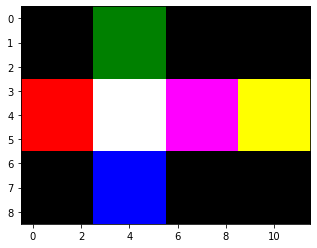

(array([5, 5, 5, 5, 5, 5, 5, 5, 5, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 1, 1, 3,
       1, 1, 3, 1, 1, 0, 0, 4, 0, 0, 4, 0, 0, 4, 3, 3, 3, 3, 3, 3, 0, 0,
       0, 1, 1, 1, 4, 4, 4, 4, 4, 4]), <PIL.Image.Image image mode=RGBA size=12x9 at 0x7F4F98E82910>)
torch.Size([1, 3, 9, 12])


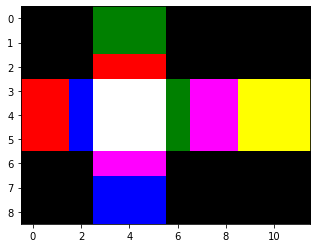

[5 5 5 5 5 5 5 5 5 2 2 2 2 2 2 2 2 2 4 1 3 4 1 3 4 1 3 4 0 3 4 0 3 4 0 3 0
 0 0 3 3 3 1 1 1 0 0 0 4 4 4 1 1 1]


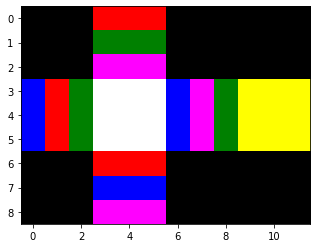

[3 0 0 0 5 4 1 5 5 1 1 0 1 2 3 4 4 2 4 4 5 2 1 4 1 3 0 3 1 5 2 0 2 1 0 4 2
 2 3 3 3 5 0 5 5 2 1 4 3 4 5 3 0 2]


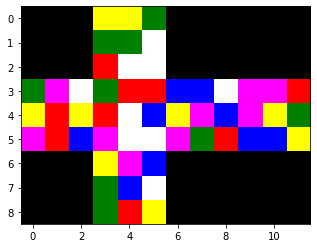

In [25]:
print(env.action_space)

env.set_scramble(1, 2, False)
env.reset()
print(env.get_state())
env.render()

env.set_scramble(1, 2, False)
env.reset()
new_state, reward, is_done, _ = env.step(0)
print(new_state)
channels = state_to_chanels(new_state) # the alpha isn't interesting we are ignoring it
print(channels.shape)
env.render()

env.set_scramble(1, 2, True)
env.reset()
print(env.get_state())
env.render()

env.set_scramble(20, 21, True)
env.reset()
print(env.get_state())
env.render()

# Model

> We use the larger DQN architecture from Mnih et al. (2015) consisting of 3 convolutional layers with 32, 64, and 64 channels followed by a hidden layer
with 512 units. The convolutional layers use 8 × 8, 4 × 4, and 3 × 3 filters with strides of 4, 2, and 1, respectively. All hidden layers were followed by a rectifier nonlinearity (ReLU). The network contains over 4M parameters.

In [26]:
state = state_to_chanels(env.step(env.action_space.sample())[0])
print(state.shape)

torch.Size([1, 3, 9, 12])


In [27]:
m = Model(random_state())
print('first try')
print(state.shape)
print(to_np(m(state)))
print('didn\'t change anything, should be the same')
print(to_np(m(state)))
m.evolve(0.005, random_state())
print('after evolution, should be different but only slightly')
print(to_np(m(state)))

m2 = uncompress_model(m.compress())
print('copied model, should be the same')
print(to_np(m2(state)))


first try
torch.Size([1, 3, 9, 12])
[[  0.         0.         0.         0.       493.89304  178.87592
  122.108635   0.        11.048737   0.         0.        42.45452 ]]
didn't change anything, should be the same
[[  0.         0.         0.         0.       493.89304  178.87592
  122.108635   0.        11.048737   0.         0.        42.45452 ]]
after evolution, should be different but only slightly
[[  0.         0.         0.         0.       493.62817  167.8791
  130.38506    0.        30.626081   0.        13.483418  48.288776]]
copied model, should be the same
[[  0.         0.         0.         0.       493.62817  167.8791
  130.38506    0.        30.626081   0.        13.483418  48.288776]]


/home/Itai/ga_model.py:40: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  nn.init.kaiming_normal(tensor)


Ok great, it compiles.

# GA

## Simple Explanation of Genetic Algorithms

> A genetic algorithm (Holland, 1992; Eiben et al., 2003) evolves a population P of N individuals (here, neural network parameter vectors θ, often called genotypes). At every generation, each θi is evaluated, producing a fitness score (aka reward) F(θi). Our GA variant performs truncation selection, wherein the top T individuals become the parents of the next generation. To produce the next generation, the following process is repeated N-1 times: A parent is selected uniformly at random with replacement and is mutated by applying additive Gaussian noise to the parameter vector: θ' = θ + σε where ε ∼ N(0, I). The appropriate value of σ was determined empirically for each experiment, as described in Supplementary Information (SI) Table 3. The Nth individual is an unmodified copy of the best individual from the previous generation, a technique called elitism.

This seems fairly clear to me, but I will attempt to re-explain it: basically instead of generating a network randomly and modifying its weights using gradient descent, we generate a bunch of networks randomly, constituting a "generation", then evaluate them. Surely some of them will perform slightly better. We pick the one that performs the very best and keep it for the next generation. Then among the top few networks we create the new generation by copying them a bunch of times and modifying the weights of each copy slightly. Because only the top networks get chosen each time and because we keep changing the networks, it seems like our performance should keep increasing, and indeed it often does!

In our case, since we are focusing on Atari games, the population size is 5,000, the truncation threshold is 10 and the σ parameter is 0.005. The I parameter they mentioned simply means that it is sampled from a normal distribution with unit variance (I is the identity matrix).

So, when do we stop with the generations, you might ask? Uber is very clear that they stopped after 1 billion **frames**, not after a fixed number of generations, so we will make sure to keep track of the number of frames that we see and stop once we've passed 1 billion. As a reminder, there is a difference between a frame and a forward pass on a neural network, since it is standard to run 4 frames for every forward pass (ie the network only chooses an action every 4 frames). If you use a `Deterministic-v4` in OpenAI gym, this frame skipping with 4 frames is automatically implemented for you, so simply multiply the number of times you called `.step` by 4, and stop when that number reaches a billion.

## Model Compression

One interesting innovation that Uber provides in this paper is in neural network compression.

>We propose a novel method to store large parameter vectors compactly by representing each parameter vector as an initialization seed plus the list of random seeds that produce the series of mutations applied to θ. This innovation was essential to enabling GAs to work at the scale of deep neural networks, and we thus call it a Deep GA. This technique also has the benefit of offering a state-of-the-art compression method (Section 5).

As the quote above implies, we absolutely **need** to implement this compression, not because it is cool but because we will need to have workers on several different machines, passing neural networks to each other, and it is simply crucial to be able to serialize the neural nets efficiently so that they can be transfered quickly from one machine to another.

Fortunately, implementing this is very simple! As mentioned by the paper, it is simply about remembering the random seeds used each time we generated random numbers, ie we need to remember:
* The seed we used for initializing the network
* The seed we used every time we evolved the weights of the network.

That's it! Whenever we pass the network around, we simply send the seeds instead of the actual network and it is easy to recreate it by re-running initialization and evolution after setting each of the seeds properly.

The way to set a random seed using PyTorch is simply `torch.manual_seed`, to which you can pass a number. To make sure the random seeds were always different, I passed in a number generated by Python's `random.randint`, sampled from 0 to 2^31 - 1 (why this number you ask? Well I wasn't sure what numbers were allowable as random seeds, but this makes sure whatever I pass fits in a 32 bit signed integer, which I felt was almost certainly acceptable, while bigger numbers might not be).

**Learning: use random SEEDS, not random STATES.**

PyTorch also has a way to get its current random **state** using `torch.get_rng_state`, and to set it using `torch.set_rng_state`. At first I used this because there are a lot more possible random states than random seeds, so it seemed more "random" to me. The big problem is that each random state is already around 5kB in size (by contrast, a random seed is only 4 bytes, or 1,000 times less), which meant that my system quickly became very slow due to the large amount of data involved. Don't make the same mistake I did!


## Distributed Computing: Job Queues and Spot Instances

**Fair warning**: in this section I will assume you already know a bit about AWS or some other cloud provider like Google Cloud or Microsoft Azure. If you don't, it might be worthwhile to at least take a look at some tutorial for using AWS for deep learning (eg: https://towardsdatascience.com/how-to-set-up-a-deep-learning-environment-on-aws-with-keras-theano-b0f39e3d861c), or at least just be aware that you'll likely have to do some Googling because I will skip over some important basic things. 

Training a neural network using genetic algorithms is different from training it using gradient descent in the following way: with gradient descent we need to do a lot of math on a single network, while with a genetic algorithm we need to do much less math (just a forward pass, not forward and backward) on many networks. This makes it possible to train our GA neural network on a massive number of CPUs instead of on single GPUs. 

How massive are we talking though? Let's see what Uber has to say about that:

> The GA and ES are both faster than Q-learning and policy gradient methods when substantial distributed computation is available (here, 720 CPU cores across dozens of machines).

**720**? Wow. I tend to think my own hardware is fairly high-end and up to date, but even between my desktop and my laptop I have a grand total of 8 CPU cores...

So is this another one of these papers that use an amount of resources completely unaccessible to us normal mortals? Not so! We're just going to need to learn a bit more about infrastructure.

### Job Queues

Here's the thing, there is absolutely no way we're going to get 720 CPU cores on a single machine. More reasonably we can get 64 or a bit more. This means that if we want to process things as far as Uber did, we are going to need multiple machines.

For this, we are going to use the concept of a task queue, with a master (or manager) and workers. The master will put tasks onto the task queue, and the workers will take jobs from the queue, run them, and write the results back. The process can be seen in this diagram.

![Source: https://www.alberton.info/batching_vs_latency_and_jobqueue_models.html](https://www.alberton.info/images/articles/jobqueues/jobqueue1.png)

In our case, the jobs are evaluating the performance of the different neural networks in the current generation, and the outputs are simply the scores of each neural networks, as well as the number of frames they used. Another advantage of this architecture is that it allows us to put the master and the workers on different machines, which is useful for keeping costs low: we can put the master on a not very powerful but very reliable machine, while we can put the workers on machines that are very powerful but not as reliable. This way we get to keep our data (since everything is stored on the master), but can use unreliable cheap machines as workers.

The task queue library that we will use is [RQ](http://python-rq.org), which is a very easy to use library for task queues. It relies on the Redis database, which you can install quite simply on an Amazon instance.

All you need to do is to make sure that *all* the code necessary for your workers is in a `.py` file, not in a notebook, as RQ needs `.py` files to create worker processes. Your master can be in a notebook, however. You can import whatever parts of your `.py` you need in your master notebook.

Specifically the following should be in a `.py` file:
* The code for the neural network model
* The code for neural network compression/decompression
* A function for evaluating a neural network from a compressed model and an environment name that returns at least the score and the number of frames used

Your master code can then add a job to the queue using `job = rq.enqueue(...)` with the function in question and the arguments it should take, and it can letter get the result using `job.result`, which will be None if the function hasn't returned yet. You should make sure that your code is robust to jobs being dropped: if you don't get a result for a job for a long time, make sure it is being reenqued. Remember to pass **compressed** neural nets as arguments to `enqueue`, since these will need to be serialized and transfered over the network, it is important that they be small.

Once you have all of this, you should create an AWS instance for your master, a small-ish one is sufficient, personally I used a t2.medium. You can install any Linux you want on it, personally I used the non-deep learning Ubuntu 16.04 AMI. Then install all the dependencies for your agent, including redis-server, rq, pytorch etc. Once this is done, you should do the following things:

* Edit the security group of the master machine you just created to allow for redis connections. To make sure you don't expose your redis server to the world, you can limit the traffic to just that coming from inside the same security group. Starting now, make sure any other machine you create is in the same security group. Ideally you'd only enable redis traffic, but I was too lazy to find out exactly how, so I enabled all traffic from the security group like so:
![image.png](aws_security.png)
* Find out the private IP of your master machine (should be in the EC2 web interface) and create the following two files:
 * A file named `redis.conf` containing `bind <YOUR PRIVATE IP>`
 * A file named `settings.py` containing `REDIS_HOST = '<YOUR PRIVATE IP'`
* Run redis server: `nohup redis-server redis.conf&`. The `nohup` part makes sure the server will keep running even if your connection dies and the `&` at the end makes sure it runs in the background right away so you can do other stuff.
* Run an RQ worker using `rq worker -c settings`.
* Now **test** that this works by running your master code and making sure the jobs are indeed processed by the worker.
* Kill the worker, go back to the AWS interface, click on your instance and go to "Actions -> Images -> Create Image", this will allow you to create an AMI containing all the packages that you just installed, so that it will be easy to launch workers on other machines!

We can now go on to create the actual workers.

### AWS Spot Instances

As it turns out, getting access to lots of CPUs is fairly easy: the c5.18xlarge instance on AWS, for instance, contains a staggering 72 CPUs, 1/10th of what we need! With just 10 of these instances we'll have exactly the same amount of CPUs that Uber used. There is even an instance with 96 CPUs (the m5.24xlarge), but it is worth noting that its CPUs are slightly slower than the c5.18xlarge and its cost per CPU is slightly higher due to the fact that it also has a lot more memory, which we don't really need (the c5.18xlarge has 144 GB of memory and the m5.24xlarge has 384 GB, but as I recall I never used more than 5 GB on any machine I used...).

Ok so how much will it cost? Well, a single c5.18xlarge costs \$3.06 per hour in the US-West region (other regions should be in the same ballpark), and Uber claims that they were able to train their networks in about an hour using the equivalent of 10 c5.18xlarge, so training a single network should cost us \$30.60, assuming all goes smoothly. This is actually not so bad! But we can do much better using **spot instances**.

Spot instances are how Amazon deals with the fact that not all of their machines are reserved at any given time: they set up an auction for usage of the idle machines, and the highest bidder gets to access them. This makes for much lower prices, but there is a catch: the machine you are using may be taken away from you if someone beats your maximum bid or if Amazon has to fulfill a full-price request.

Additionally, the price you actually pay can be less predictable than with regular on-demand instances: the spot price of instances fluctuates as demand increases and decreases, and you are always paying the current spot price as long as it is lower than your maximum bid. So if an instance is trading at \$1 an hour and you bid \$2, you will probably pay \$1 at first but over time you might start paying \$1.50 an hour, or \$0.50 etc. Fortunately, the market for instances is stable enough now that this is not a big concern: if you are only using your instances for a few hours, most likely you will pay within 5% or so of the price you saw when you first created the spot instance.

Overall though, the design we described above is perfect for spot instances as you can have a "master" server running on a small on-demand instance and use however many high-CPU spot instances you want. If you wrote your code properly, it should be relatively immune to spot instances dying: it will just retry jobs and not lose data. As of this writing, a c5.18xlarge spot instance costs \$1.08, so almost 3x less than using an on-demand instance. This means that, optimistically, it should cost around \$11 to train on a single game. Note, however, that due to the fact that I trained on 3 games (Frostbite, Breakout and Space Invaders) and due to the many errors I made along the way, this whole experiment cost me around \$115, so try to be extra careful or make sure you're willing to spend around \$100 before you start doing this.

So how do you create a spot instance? Let's do that now! As a reminder, please make sure you are reasonably confident about your setup (ie you have created an AMI and you have confirmed that you can easily start running the system on another machine) before you do this.

In the EC2 panel, click on "Spot Requests" on the right and then on the "Request Spot Instances" button. You will be taken to this page:
![image.png](spot.png)

Many of the parameters you can keep as default, just remember to do the following:
* Select your total capacity (10 would give you what Uber used, but I personally chose to use 5 instances and simply wait for 2 hours instead of 1. You'll have to ssh into every machine so a lower number is more manageable).
* Select the AMI you just created.
* Remove the c3.large instance type from the instance type list, and add a c5.18xlarge instead. The select instance type window will actually show you all the instances that are available and their prices.
 * It is possible that another instance type will be more advantageous for you when you look. My advice when figuring out what instance is best is simply to divide the current spot price by the number of CPUs to find the cheapest instance per CPU. Note, however, that the instances whose name start with a "c" are compute-optimized, which typically means that their CPUs are faster than those on other instances, even when the number of cores is equal.
* Select the same availability zone as your master (maybe not necessary).
* Select the security group you previously created/edited.

Some optional things are to set your maximum price (the default is to bid the On-Demand price, which is what I would recommend anyway) and maybe to reserve your spot instance for a fixed duration (this way you are guaranteed that your instance won't be preempted for the next, say, 3 hours, but you might be paying more than with an ordinary spot instance).

Once this is done, you can log into the various spot instances and run the rq workers on them. This is the script I used to start 72 workers and have each write its log into a different file:

```
for i in {0..72}
do
nohup rq worker -c settings > $i&
done
```

Now, assuming you are running your master code on the master box, you should finally be making progress with your training!

### An Important Aside on Intel MKL

A very cool recent development in numerical computing is Intel MKL. This is an extremely fast math library developed by Intel which takes advantage of recent instructions and multithreading to perform numerical computations very quickly. It is used by PyTorch for CPU computations and helps reduce the difference between CPU and GPU performance for neural networks (though GPUs are still faster).

Unfortunately, MKL will cause problems for us! This is because it will automatically use several CPU cores for the forward pass of a single neural network, but we already set things up so that we use one CPU core per neural network. I found that this seemed to make things slower for this purpose, which is why I recommend disabling multithreading in MKL. This can be done by installing mkl-service in python (`conda install mkl-service`) and putting the following lines at the top of your worker file, before you import pytorch:

```
import mkl
mkl.set_num_threads(1)
```

In [28]:
REDIS_HOST = '10.156.0.8'  # TODO: you absolutely need to change this if you use this code.
REDIS_PORT = 6380

class FakeJob:
    def __init__(self, j):
        self.result = j.result

class GA:
    def __init__(self, population, compressed_models=None, queue_name='default'):
        self.population = population
        self.models = [CompressedModel() for _ in range(population)] if compressed_models is None else compressed_models
        
        self.redis = Redis(REDIS_HOST, REDIS_PORT)
        self.queue = Queue(connection=self.redis, name=queue_name)
        for j in self.queue.jobs:
            j.cancel()

    # Note: the paper says "20k frames", but there are 4 frames per network
    # evaluation, so we cap at 5k evaluations
    def get_best_models(self, env, logger, max_eval=5000):
        jobs = []
        for m in self.models:
            jobs.append(self.queue.enqueue(evaluate_model, gym.make(env), m, logger, max_eval=max_eval, ttl=650, job_timeout=600))
        last_enqueue_time = time.time()
        while True:
            for i in range(len(jobs)):
                if jobs[i].result is not None and not isinstance(jobs[i], FakeJob):
#                     if random.random() < 0.001:
                    printMe(logger, f'total reward - {jobs[i].result[0]}, is succeeded - {jobs[i].result[2]}')
                    jobs[i] = FakeJob(jobs[i])
                    
            def convert_result(j):
                if j.result is not None:
                    if j.result[0] == 0.0 and j.result[1] == max_eval * 4 and 'Breakout' in env:
                        return -1.0
                    return j.result[0]
                return None
            scores = [convert_result(j) for j in jobs]
            if None not in scores:
                break
            if time.time() - last_enqueue_time > 600:
                printMe(logger, f'Reenqueuing unfinished jobs ({sum(x is None for x in scores)}).')
                for i in range(len(jobs)):
                    if jobs[i].result is None:
                        jobs[i].cancel()
                        jobs[i] = self.queue.enqueue(
                            evaluate_model, gym.make(env), self.models[i], logger, max_eval=max_eval, ttl=650, job_timeout=600)
                last_enqueue_time = time.time()
            time.sleep(1)
        used_frames = sum(j.result[1] for j in jobs)
        scored_models = list(zip(self.models, scores))
        scored_models.sort(key=lambda x: x[1], reverse=True)
        
        complete_proportion = np.count_nonzero(j.result[2] for j in jobs)
        
        return scored_models, used_frames, complete_proportion 

    def evolve_iter(self, env, logger, sigma=0.005, truncation=10, max_eval=5000):
        scored_models, used_frames, complete_proportion = self.get_best_models(env, logger, max_eval=max_eval)
        scores = [s for _, s in scored_models]
        median_score = np.nanmedian(scores)
        mean_score = np.nanmean(scores)
        max_score = scored_models[0][1]
        scored_models = scored_models[:truncation - 1]
        scored_models.append((CompressedModel(), 0))
        
        # Elitism
        self.models = [m for m, _ in scored_models]
        for _ in range(self.population - truncation):
            self.models.append(copy.deepcopy(random.choice(scored_models)[0]))
            self.models[-1].evolve(sigma)
            
        return median_score, mean_score, max_score, used_frames, complete_proportion


In [29]:
def make_video(env, model, max_eval=200000):
    env = gym.make(env)
    model = uncompress_model(model)
    cur_state = state_to_chanels(env.reset())
    total_reward = 0
    net_reward = 0
    frames = [env.render()]

    model.eval()
    for _ in range(max_eval):
        values = model(cur_state)[0]
        net_reward += values.max()/values.sum()
        action = values.argmax()
        new_state, reward, is_done, _ = env.step(action.item())
        frames.append(env.render())
        if is_done:
            break
        cur_state = state_to_chanels(new_state)

    net_reward += reward         
    fitness = (torch.Tensor(random.uniform(0.0, 0.3)) 
                if reward != 1 
                else (net_reward/(env.get_step_count() + 1)) + (1 - (env.get_step_count()/env.max_steps)))
    return fitness.item(), frames

In [30]:
def run_env(env,  logger, do_run=True, render_vids=True):
    if do_run:
        ga = GA(5000)

        total_frames = 0
        all_results = [(0.0, 0.0, 0.0, 0, time.time())]
        while total_frames < 250_000_000:
            if 'Breakout' in env.spec.id and total_frames < 2_500_000:
                med, avg, M, frames, complete_proportion = ga.evolve_iter(env.spec.id, logger, max_eval=400)
            else:
                med, avg, M, frames, complete_proportion = ga.evolve_iter(env.spec.id, logger)
            total_frames += frames
            all_results.append((med, avg, M, frames, time.time()))
            printMe(logger, f'Done with generation!\nMedian: {med}, average: {avg}, max: {M}, frames: {total_frames:,}, complete: {complete_proportion}')
        best_models = ga.get_best_models(env.spec.id, logger)[0]
        pickle.dump(all_results, open(f'{env.spec.id}_process.pickle', 'wb'))
        pickle.dump(best_models, open(f'{env.spec.id}_best.pickle', 'wb'))
    
    best_models = pickle.load(open(f'{env.spec.id}_best.pickle', 'rb'))
    process = pickle.load(open(f'{env.spec.id}_process.pickle', 'rb'))
    
    if render_vids:
        videos = [make_video(env.spec.id, best_models[0][0]) for _ in range(30)]
        pickle.dump(videos, open(f'{env.spec.id}_videos.pickle', 'wb'))
    videos = pickle.load(open(f'{env.spec.id}_videos.pickle', 'rb'))
    
    def convert_vid(video):
        res = []
        for v in video:
            img = PIL.Image.fromarray(v)
            img = img.resize((320, 240))
            res.append(np.array(img))
        return res
    
    videos = [(s, convert_vid(v)) for s, v in videos]
    videos.sort(key=lambda x:x[0])
    best_score, best_vid = videos[-1]
    worst_score, worst_vid = videos[0]
    median_score, median_vid = videos[len(videos) // 2]
    printMe(logger, f'Best score: {best_score}')
    gif_file = f'{env.spec.id}_best.gif'
    imageio.mimsave(gif_file, best_vid + [best_vid[-1]] * 10, fps=20)
    display(HTML(f'<img src="{gif_file}">'))

    printMe(logger, f'Worst score: {worst_score}')
    gif_file = f'{env.spec.id}_worst.gif'
    imageio.mimsave(gif_file, worst_vid + [worst_vid[-1]] * 10, fps=20)
    display(HTML(f'<img src="{gif_file}">'))

    printMe(logger, f'Median score: {median_score}')
    gif_file = f'{env.spec.id}_median.gif'
    imageio.mimsave(gif_file, median_vid + [median_vid[-1]] * 10, fps=20)
    display(HTML(f'<img src="{gif_file}">'))

    for idx, name in enumerate(['Median Score', 'Average Score', 'Max Score', 'Frames Per Run', 'Total Time']):
        if name == 'Frames':
            div = 5000
        else:
            div = 1
        sb.set_style("darkgrid")
        plt.plot(list(range(1, len(process))), [(p[idx] - process[0][idx]) / div for p in process[1:]])
        plt.xlabel('Generation')
        plt.ylabel(name)
        plt.savefig(f'{env.spec.id}_{name}.png')
        plt.show()


## Let's look at the results!

Finally, it's one or two hours later, depending on how many machines you chose to use, and we have results!

So how do we evaluate the performance of our agents? Well, Uber has a few things to say about that:
> Comparing our results with those from other algorithms fairly is extremely difficult, as such comparisons are inherently apples and oranges in many different ways. One important consideration is whether agents are evaluated on random starts (a random number of no-op actions), which is the regime they are trained on, or starts randomly sampled from human play, which tests for generalization (Nair et al., 2015). **Because we do not have a database of human starts to sample from**, our agents are evaluated with random starts. Where possible, we compare our results to those for other algorithms for which such random start results are available. That is true for DQN and ES, but not true for A3C, where we had to include results on human starts.

The emphasis on lacking a database of human starts is mine: I think this is too bad, and indeed there does not seem to be such a database and I think it would be great to build one.

Regardless, it sounds like the way we should evaluate our agent is simply using a random number of no-op operations before starting them, which is how we did training in the first place. The number of no-ops is not specified here but it is given as between 0 and 30 elsewhere, so that's what we'll do. Because there is this randomness aspect (not to mention the potential for random number generation within the individual Atari games), I decided to run the game 30 times and to display the best, worst, and median result. Here goes, for Frostbite:

In [31]:
def set_logger():
    logger = logging.getLogger()
    fhandler = logging.FileHandler(filename='mylog.log', mode='a')
    formatter = logging.Formatter('%(asctime)s - %(name)s - %(levelname)s - %(message)s')
    fhandler.setFormatter(formatter)
    logger.addHandler(fhandler)
    logger.setLevel(logging.DEBUG)
    return logger

In [ ]:
env = gym.make('RubiksCube-v0')
env.set_scramble(20, 20, True)
start_time = time.time()
logger = set_logger()
run_env(env, logger, True, True)
printMe(logger, f'game time - {time.time() - start_time}')

total reward - 0.01839602508084921, is succeeded - False
total reward - 0.1443481322431229, is succeeded - False
total reward - 0.06612847026435245, is succeeded - False
total reward - 0.23697940067296916, is succeeded - False
total reward - 0.11215655993827515, is succeeded - False
total reward - 0.25159713547150925, is succeeded - False
total reward - 0.29498149607030316, is succeeded - False
total reward - 0.09455709273136431, is succeeded - False
total reward - 0.1055867336121344, is succeeded - False
total reward - 0.06453409204601515, is succeeded - False
total reward - 0.0903607632912496, is succeeded - False
total reward - 0.17767752475440426, is succeeded - False
total reward - 0.2521589422007048, is succeeded - False
total reward - 0.2668823394716405, is succeeded - False
total reward - 0.17218964739664375, is succeeded - False
total reward - 0.13008301037407694, is succeeded - False
total reward - 0.2578342171082231, is succeeded - False
total reward - 0.119969106319593, is 

total reward - 0.07209415422951111, is succeeded - False
total reward - 0.10453488089355974, is succeeded - False
total reward - 0.2852631588993341, is succeeded - False
total reward - 0.056783316939740376, is succeeded - False
total reward - 0.09090183079487342, is succeeded - False
total reward - 0.1641754078989206, is succeeded - False
total reward - 0.1832537893114563, is succeeded - False
total reward - 0.01672951809980191, is succeeded - False
total reward - 0.12316100089538935, is succeeded - False
total reward - 0.23367971521303313, is succeeded - False
total reward - 0.2615554455317483, is succeeded - False
total reward - 0.15699437744205427, is succeeded - False
total reward - 0.21214098414898067, is succeeded - False
total reward - 0.16803428021693664, is succeeded - False
total reward - 0.1484793244195826, is succeeded - False
total reward - 0.22168890580864878, is succeeded - False
total reward - 0.2524377163623239, is succeeded - False
total reward - 0.02617897650737856, 

total reward - 0.19266588470700252, is succeeded - False
total reward - 0.15866848467485997, is succeeded - False
total reward - 0.05816537898210972, is succeeded - False
total reward - 0.0918473338903293, is succeeded - False
total reward - 0.2925817358676895, is succeeded - False
total reward - 0.1945932254808649, is succeeded - False
total reward - 0.23049920198591986, is succeeded - False
total reward - 0.10437610734012902, is succeeded - False
total reward - 0.16137870158848616, is succeeded - False
total reward - 0.060383189320509095, is succeeded - False
total reward - 0.12351556992521304, is succeeded - False
total reward - 0.03171803627984845, is succeeded - False
total reward - 0.21362673352845987, is succeeded - False
total reward - 0.27155568363100474, is succeeded - False
total reward - 0.13693477720039277, is succeeded - False
total reward - 0.01993666729421679, is succeeded - False
total reward - 0.16769667452405104, is succeeded - False
total reward - 0.1561808753539444

total reward - 0.005268514238786426, is succeeded - False
total reward - 0.16871532497226882, is succeeded - False
total reward - 0.25314357299772594, is succeeded - False
total reward - 0.26283868860455717, is succeeded - False
total reward - 0.1139659821132964, is succeeded - False
total reward - 0.20060512535348135, is succeeded - False
total reward - 0.07232881555867761, is succeeded - False
total reward - 0.22650969238548083, is succeeded - False
total reward - 0.11503763526273197, is succeeded - False
total reward - 0.17476019076654886, is succeeded - False
total reward - 0.13254347659540805, is succeeded - False
total reward - 0.2730187497638489, is succeeded - False
total reward - 0.1085047566954829, is succeeded - False
total reward - 0.11782738702405862, is succeeded - False
total reward - 0.08089338305181164, is succeeded - False
total reward - 0.060825812493750436, is succeeded - False
total reward - 0.2905383462670539, is succeeded - False
total reward - 0.2629954415609235

total reward - 0.1794912255392788, is succeeded - False
total reward - 0.2823253952138797, is succeeded - False
total reward - 0.05411288096968362, is succeeded - False
total reward - 0.11884734803971596, is succeeded - False
total reward - 0.03952047970863779, is succeeded - False
total reward - 0.16468680789652415, is succeeded - False
total reward - 0.03557900462527763, is succeeded - False
total reward - 0.019332315296930545, is succeeded - False
total reward - 0.0931942142717082, is succeeded - False
total reward - 0.05943635947522221, is succeeded - False
total reward - 0.11349312955078504, is succeeded - False
total reward - 0.02958368856286628, is succeeded - False
total reward - 0.2452179502114972, is succeeded - False
total reward - 0.10948584625543865, is succeeded - False
total reward - 0.12511840721991815, is succeeded - False
total reward - 0.2566579369481102, is succeeded - False
total reward - 0.19350093222326992, is succeeded - False
total reward - 0.26444110923268077,

total reward - 0.2949901802608375, is succeeded - False
total reward - 0.10585416266060145, is succeeded - False
total reward - 0.2851898157105343, is succeeded - False
total reward - 0.2518432120724704, is succeeded - False
total reward - 0.10433356047125163, is succeeded - False
total reward - 0.23299806547456192, is succeeded - False
total reward - 0.1730087682874927, is succeeded - False
total reward - 0.08728191406409833, is succeeded - False
total reward - 0.21680040317238133, is succeeded - False
total reward - 0.06524342774601227, is succeeded - False
total reward - 0.19879807207397002, is succeeded - False
total reward - 0.046693050785911884, is succeeded - False
total reward - 0.19907966377286548, is succeeded - False
total reward - 0.28706305793923387, is succeeded - False
total reward - 0.1927198713198838, is succeeded - False
total reward - 0.2619765435220444, is succeeded - False
total reward - 0.11661067850891879, is succeeded - False
total reward - 0.17832448541052687, 

total reward - 0.012833219715289034, is succeeded - False
total reward - 0.10422010692146716, is succeeded - False
total reward - 0.10211723128477919, is succeeded - False
total reward - 0.08223204925042692, is succeeded - False
total reward - 0.16420179396845366, is succeeded - False
total reward - 0.06836419652106651, is succeeded - False
total reward - 0.06574663488107803, is succeeded - False
total reward - 0.08249631958824175, is succeeded - False
total reward - 0.28771916464723046, is succeeded - False
total reward - 0.24612621785122293, is succeeded - False
total reward - 0.2569733854403354, is succeeded - False
total reward - 0.12102229819778404, is succeeded - False
total reward - 0.13986220962895096, is succeeded - False
total reward - 0.22056001560326743, is succeeded - False
total reward - 0.07669678965805722, is succeeded - False
total reward - 0.12093811443387663, is succeeded - False
total reward - 0.167771153518345, is succeeded - False
total reward - 0.2732764004465796

total reward - 0.2545493283803664, is succeeded - False
total reward - 0.29889115837271, is succeeded - False
total reward - 0.025553961491165487, is succeeded - False
total reward - 0.14456823914165692, is succeeded - False
total reward - 0.0009208145576197535, is succeeded - False
total reward - 0.13188850055729906, is succeeded - False
total reward - 0.27853251669174595, is succeeded - False
total reward - 0.05424763854423396, is succeeded - False
total reward - 0.23895013756621658, is succeeded - False
total reward - 0.0193335672410341, is succeeded - False
total reward - 0.0022112971717892726, is succeeded - False
total reward - 0.042634120208129775, is succeeded - False
total reward - 0.2512148747830283, is succeeded - False
total reward - 0.16496762918929675, is succeeded - False
total reward - 0.03607163416090905, is succeeded - False
total reward - 0.07430211617939646, is succeeded - False
total reward - 0.032011748961102544, is succeeded - False
total reward - 0.2061809915711

total reward - 0.08150540199666967, is succeeded - False
total reward - 0.12367596306803198, is succeeded - False
total reward - 0.21083714555351943, is succeeded - False
total reward - 0.10901961154853712, is succeeded - False
total reward - 0.007952308777891626, is succeeded - False
total reward - 0.26673461075890176, is succeeded - False
total reward - 0.165565100743547, is succeeded - False
total reward - 0.09021852846192373, is succeeded - False
total reward - 0.17146940431058882, is succeeded - False
total reward - 0.08994276871318317, is succeeded - False
total reward - 0.1025408563243926, is succeeded - False
total reward - 0.11916549238085472, is succeeded - False
total reward - 0.24122742106857442, is succeeded - False
total reward - 0.01541873039503554, is succeeded - False
total reward - 0.08553312266516525, is succeeded - False
total reward - 0.21750117255030224, is succeeded - False
total reward - 0.07132558727641143, is succeeded - False
total reward - 0.2774258294857408

total reward - 0.11464825675556209, is succeeded - False
total reward - 0.05471476665214037, is succeeded - False
total reward - 0.08177532312921806, is succeeded - False
total reward - 0.07985420747432381, is succeeded - False
total reward - 0.15669965380331907, is succeeded - False
total reward - 0.1431040942122055, is succeeded - False
total reward - 0.13176066827422675, is succeeded - False
total reward - 0.14613535797228017, is succeeded - False
total reward - 0.1960286598320249, is succeeded - False
total reward - 0.021935005437726817, is succeeded - False
total reward - 0.06579168551954931, is succeeded - False
total reward - 0.21779845398637934, is succeeded - False
total reward - 0.24715198426866192, is succeeded - False
total reward - 0.0963228105439723, is succeeded - False
total reward - 0.2918892992223577, is succeeded - False
total reward - 0.20400909159411376, is succeeded - False
total reward - 0.21713503955602992, is succeeded - False
total reward - 0.00483631323407661

total reward - 0.11171128819744937, is succeeded - False
total reward - 0.01211347317402991, is succeeded - False
total reward - 0.2811409299397898, is succeeded - False
total reward - 0.020411812435180286, is succeeded - False
total reward - 0.19898522493359452, is succeeded - False
total reward - 0.06229053713371064, is succeeded - False
total reward - 0.27215011402269845, is succeeded - False
total reward - 0.26016045721486336, is succeeded - False
total reward - 0.21007600119106182, is succeeded - False
total reward - 0.2540094623367911, is succeeded - False
total reward - 0.11721739249692448, is succeeded - False
total reward - 0.21776034717993975, is succeeded - False
total reward - 0.10160351148785932, is succeeded - False
total reward - 0.28861553054959277, is succeeded - False
total reward - 0.26647654019763534, is succeeded - False
total reward - 0.17608205190317008, is succeeded - False
total reward - 0.22232095551967937, is succeeded - False
total reward - 0.148296251742209

total reward - 0.1260585270946146, is succeeded - False
total reward - 0.01035174858841289, is succeeded - False
total reward - 0.16298568046881243, is succeeded - False
total reward - 0.010931504231133881, is succeeded - False
total reward - 0.23420002423970784, is succeeded - False
total reward - 0.1226199560216666, is succeeded - False
total reward - 0.11732608513737824, is succeeded - False
total reward - 0.27736886791359083, is succeeded - False
total reward - 0.14602957197265612, is succeeded - False
total reward - 0.09988925521537562, is succeeded - False
total reward - 0.23675163522751017, is succeeded - False
total reward - 0.11578444129189681, is succeeded - False
total reward - 0.22754032044449857, is succeeded - False
total reward - 0.198869271760046, is succeeded - False
total reward - 0.008265369742377737, is succeeded - False
total reward - 0.2511946680239298, is succeeded - False
total reward - 0.1720556488615957, is succeeded - False
total reward - 0.11757638574009924,

total reward - 0.20583923152526193, is succeeded - False
total reward - 0.2484242313102941, is succeeded - False
total reward - 0.025646591298809994, is succeeded - False
total reward - 0.2820482343787575, is succeeded - False
total reward - 0.13511251714516437, is succeeded - False
total reward - 0.04804542500323831, is succeeded - False
total reward - 0.29751701335040687, is succeeded - False
total reward - 0.10302932237032537, is succeeded - False
total reward - 0.10621745508944953, is succeeded - False
total reward - 0.08764726123687801, is succeeded - False
total reward - 0.26877816690095446, is succeeded - False
total reward - 0.18892801093397135, is succeeded - False
total reward - 0.24631533841045497, is succeeded - False
total reward - 0.059258201724152366, is succeeded - False
total reward - 0.11031598969694534, is succeeded - False
total reward - 0.12413544361963684, is succeeded - False
total reward - 0.2378058365588168, is succeeded - False
total reward - 0.006204362146290

total reward - 0.2470330638144637, is succeeded - False
total reward - 0.13348776801412976, is succeeded - False
total reward - 0.26786573795755625, is succeeded - False
total reward - 0.13684022753788957, is succeeded - False
total reward - 0.29964554310496144, is succeeded - False
total reward - 0.0030559990375921497, is succeeded - False
total reward - 0.24923204317813194, is succeeded - False
total reward - 0.09390366483832509, is succeeded - False
total reward - 0.021082763694054617, is succeeded - False
total reward - 0.2538828557955934, is succeeded - False
total reward - 0.08593916956837928, is succeeded - False
total reward - 0.03817143781952337, is succeeded - False
total reward - 0.05760869716421619, is succeeded - False
total reward - 0.24799551877624845, is succeeded - False
total reward - 0.18831236789106937, is succeeded - False
total reward - 0.010944350480568988, is succeeded - False
total reward - 0.04199860390564708, is succeeded - False
total reward - 0.033799768133

total reward - 0.04419440958494695, is succeeded - False
total reward - 0.2758399299681256, is succeeded - False
total reward - 0.2739007734695475, is succeeded - False
total reward - 0.03674356482102265, is succeeded - False
total reward - 0.095753410145034, is succeeded - False
total reward - 0.1843744199662204, is succeeded - False
total reward - 0.0995772648471956, is succeeded - False
total reward - 0.01262999600087854, is succeeded - False
total reward - 0.2599644056312865, is succeeded - False
total reward - 0.10884031619194519, is succeeded - False
total reward - 0.0800123272229037, is succeeded - False
total reward - 0.2059593011580869, is succeeded - False
total reward - 0.06952463838000235, is succeeded - False
total reward - 0.29710302106137243, is succeeded - False
total reward - 0.25177456210269833, is succeeded - False
total reward - 0.0732606550593332, is succeeded - False
total reward - 0.03254151562382019, is succeeded - False
total reward - 0.0898946121280094, is suc

total reward - 0.07036552285065924, is succeeded - False
total reward - 0.20494536001252958, is succeeded - False
total reward - 0.011207998751207282, is succeeded - False
total reward - 0.11927260748393552, is succeeded - False
total reward - 0.07737018027239136, is succeeded - False
total reward - 0.11785484055357308, is succeeded - False
total reward - 0.2595188663184952, is succeeded - False
total reward - 0.21594597144164104, is succeeded - False
total reward - 0.21257477661538277, is succeeded - False
total reward - 0.23184817491434823, is succeeded - False
total reward - 0.2970873580743444, is succeeded - False
total reward - 0.1171202121288951, is succeeded - False
total reward - 0.27277555238805423, is succeeded - False
total reward - 0.06918510615793039, is succeeded - False
total reward - 0.02341711752279656, is succeeded - False
total reward - 0.12236566446780535, is succeeded - False
total reward - 0.05873265884883519, is succeeded - False
total reward - 0.0477645361349561

total reward - 0.01775639276005093, is succeeded - False
total reward - 0.11717828470050061, is succeeded - False
total reward - 0.021508606244639437, is succeeded - False
total reward - 0.29184779060058846, is succeeded - False
total reward - 0.1780140143331501, is succeeded - False
total reward - 0.16188736518289812, is succeeded - False
total reward - 0.23154460356834664, is succeeded - False
total reward - 0.2880121049721446, is succeeded - False
total reward - 0.24487944463927816, is succeeded - False
total reward - 0.024901427674012534, is succeeded - False
total reward - 0.16929107003125063, is succeeded - False
total reward - 0.06056429599282906, is succeeded - False
total reward - 0.14632633434144035, is succeeded - False
total reward - 0.24898418076670487, is succeeded - False
total reward - 0.13162469853321346, is succeeded - False
total reward - 0.2337851118876238, is succeeded - False
total reward - 0.049240252876444686, is succeeded - False
total reward - 0.25044185918332

total reward - 0.2863963033997164, is succeeded - False
total reward - 0.03826980617197755, is succeeded - False
total reward - 0.255005683665954, is succeeded - False
total reward - 0.07624131155712373, is succeeded - False
total reward - 0.08230244457429159, is succeeded - False
total reward - 0.12037932233902246, is succeeded - False
total reward - 0.12524243079213893, is succeeded - False
total reward - 0.13035628565770133, is succeeded - False
total reward - 0.1158200010930639, is succeeded - False
total reward - 0.19463650375754551, is succeeded - False
total reward - 0.20970650526890885, is succeeded - False
total reward - 0.051206760168645594, is succeeded - False
total reward - 0.03378902343881383, is succeeded - False
total reward - 0.21076226499381098, is succeeded - False
total reward - 0.19070987770267117, is succeeded - False
total reward - 0.25058943700312897, is succeeded - False
total reward - 0.27020749357231355, is succeeded - False
total reward - 0.23738553227729284

total reward - 0.2708582573208637, is succeeded - False
total reward - 0.006006228308493622, is succeeded - False
total reward - 0.05941988206164403, is succeeded - False
total reward - 0.043175457009875746, is succeeded - False
total reward - 0.08538269476214665, is succeeded - False
total reward - 0.17310384807095178, is succeeded - False
total reward - 0.07506893118990333, is succeeded - False
total reward - 0.015349217278767912, is succeeded - False
total reward - 0.005321730314376793, is succeeded - False
total reward - 0.18075773350149518, is succeeded - False
total reward - 0.2562988959346372, is succeeded - False
total reward - 0.29464984172136816, is succeeded - False
total reward - 0.08054998372867044, is succeeded - False
total reward - 0.16349188428604133, is succeeded - False
total reward - 0.09462368591555201, is succeeded - False
total reward - 0.29537905984246293, is succeeded - False
total reward - 0.13182780523264906, is succeeded - False
total reward - 0.209547905356

total reward - 0.1362076008193002, is succeeded - False
total reward - 0.23058946992428214, is succeeded - False
total reward - 0.22664080751747925, is succeeded - False
total reward - 0.08366918513209502, is succeeded - False
total reward - 0.2092262038016222, is succeeded - False
total reward - 0.17713512168675477, is succeeded - False
total reward - 0.08618573175664591, is succeeded - False
total reward - 0.04350184919484452, is succeeded - False
total reward - 0.19373450402626588, is succeeded - False
total reward - 0.11133599875724183, is succeeded - False
total reward - 0.08511422787896421, is succeeded - False
total reward - 0.2762523256857199, is succeeded - False
total reward - 0.26115006314981404, is succeeded - False
total reward - 0.2767276487128024, is succeeded - False
total reward - 0.2417339802481613, is succeeded - False
total reward - 0.019293935285851393, is succeeded - False
total reward - 0.02735713597948347, is succeeded - False
total reward - 0.15120667459761228,

total reward - 0.07642633950848034, is succeeded - False
total reward - 0.0983411515402227, is succeeded - False
total reward - 0.19064188402399948, is succeeded - False
total reward - 0.2419810650542943, is succeeded - False
total reward - 0.21431382823794515, is succeeded - False
total reward - 0.058169945771978045, is succeeded - False
total reward - 0.2711597600372575, is succeeded - False
total reward - 0.24606406334150413, is succeeded - False
total reward - 0.06534394385146343, is succeeded - False
total reward - 0.1065030448193211, is succeeded - False
total reward - 0.14096756082549036, is succeeded - False
total reward - 0.0873470953528076, is succeeded - False
total reward - 0.0038344788361261203, is succeeded - False
total reward - 0.17606067814156623, is succeeded - False
total reward - 0.180067410717996, is succeeded - False
total reward - 0.22393871859696796, is succeeded - False
total reward - 0.08282965723009111, is succeeded - False
total reward - 0.19143645763634365,

total reward - 0.10516097212368938, is succeeded - False
total reward - 0.21667645599592664, is succeeded - False
total reward - 0.16548106315209504, is succeeded - False
total reward - 0.21670126763433847, is succeeded - False
total reward - 0.15660339074575216, is succeeded - False
total reward - 0.1640398014441578, is succeeded - False
total reward - 0.20065211835616667, is succeeded - False
total reward - 0.22662176455245286, is succeeded - False
total reward - 0.15933616821751054, is succeeded - False
total reward - 0.08820321830504294, is succeeded - False
total reward - 0.07259014601130351, is succeeded - False
total reward - 0.020191114028934507, is succeeded - False
total reward - 0.2911550184614686, is succeeded - False
total reward - 0.28558974996394626, is succeeded - False
total reward - 0.0222598753959499, is succeeded - False
total reward - 0.24678817551954269, is succeeded - False
total reward - 0.06870079650946681, is succeeded - False
total reward - 0.0250041698409856

total reward - 0.1002694617649259, is succeeded - False
total reward - 0.056998265335352793, is succeeded - False
total reward - 0.043639864788577495, is succeeded - False
total reward - 0.15780422870408797, is succeeded - False
total reward - 0.2836366582073604, is succeeded - False
total reward - 0.29662505951561174, is succeeded - False
total reward - 0.269193169291842, is succeeded - False
total reward - 0.02340217361038107, is succeeded - False
total reward - 0.03959789073628561, is succeeded - False
total reward - 0.2037663356077615, is succeeded - False
total reward - 0.10927714841308456, is succeeded - False
total reward - 0.2437315553623965, is succeeded - False
total reward - 0.1913103170351721, is succeeded - False
total reward - 0.1432167185211863, is succeeded - False
total reward - 0.08698923174715037, is succeeded - False
total reward - 0.13639652736217317, is succeeded - False
total reward - 0.08584395421218485, is succeeded - False
total reward - 0.1962321761478377, is

total reward - 0.00827956148966864, is succeeded - False
total reward - 0.14635466357329274, is succeeded - False
total reward - 0.21624967295021422, is succeeded - False
total reward - 0.060961523721665085, is succeeded - False
total reward - 0.10482705898846296, is succeeded - False
total reward - 0.15161700895099084, is succeeded - False
total reward - 0.21237210466191647, is succeeded - False
total reward - 0.03413323732152825, is succeeded - False
total reward - 0.14698137569051847, is succeeded - False
total reward - 0.12124514454838183, is succeeded - False
total reward - 0.011395715281944751, is succeeded - False
total reward - 0.07310649563272734, is succeeded - False
total reward - 0.2886792052893999, is succeeded - False
total reward - 0.0025165612726672725, is succeeded - False
total reward - 0.23981827351728507, is succeeded - False
total reward - 0.23501507131634577, is succeeded - False
total reward - 0.02261136080572198, is succeeded - False
total reward - 0.19793012925

total reward - 0.273483202799462, is succeeded - False
total reward - 0.04135977164723887, is succeeded - False
total reward - 0.013393522733058282, is succeeded - False
total reward - 0.04652310737762685, is succeeded - False
total reward - 0.039210901041232205, is succeeded - False
total reward - 0.02053001264871854, is succeeded - False
total reward - 0.13339080285759752, is succeeded - False
total reward - 0.17261593961573476, is succeeded - False
total reward - 0.07038539677961854, is succeeded - False
total reward - 0.01699803952026947, is succeeded - False
total reward - 0.2507570564275288, is succeeded - False
total reward - 0.2147074213179159, is succeeded - False
total reward - 0.051830734932825515, is succeeded - False
total reward - 0.0003172772830059012, is succeeded - False
total reward - 0.19805969820351643, is succeeded - False
total reward - 0.18958207696174176, is succeeded - False
total reward - 0.036513238969390203, is succeeded - False
total reward - 0.282180696051

total reward - 0.2799018504199354, is succeeded - False
total reward - 0.18417379763069874, is succeeded - False
total reward - 0.10526927662870586, is succeeded - False
total reward - 0.24947964846044943, is succeeded - False
total reward - 0.1670658837157478, is succeeded - False
total reward - 0.056743582442625326, is succeeded - False
total reward - 0.2853524254344522, is succeeded - False
total reward - 0.15167566376452712, is succeeded - False
total reward - 0.05929929525029787, is succeeded - False
total reward - 0.28448020602798635, is succeeded - False
total reward - 0.10273411226408387, is succeeded - False
total reward - 0.09195415538600045, is succeeded - False
total reward - 0.14436553833293223, is succeeded - False
total reward - 0.014558784399691249, is succeeded - False
total reward - 0.14412401664588287, is succeeded - False
total reward - 0.2893701019831425, is succeeded - False
total reward - 0.18979409759257906, is succeeded - False
total reward - 0.0243687794501598

total reward - 0.15487412402536693, is succeeded - False
total reward - 0.11877231982124731, is succeeded - False
total reward - 0.04547900941040247, is succeeded - False
total reward - 0.16331689377134104, is succeeded - False
total reward - 0.09216185464794542, is succeeded - False
total reward - 0.228921923267284, is succeeded - False
total reward - 0.19659661150755056, is succeeded - False
total reward - 0.1495046195694211, is succeeded - False
total reward - 0.030911885624368505, is succeeded - False
total reward - 0.09548281614511957, is succeeded - False
total reward - 0.28423654075597926, is succeeded - False
total reward - 0.08893033018678127, is succeeded - False
total reward - 0.09197818226898219, is succeeded - False
total reward - 0.17762361274811173, is succeeded - False
total reward - 0.18848153664553516, is succeeded - False
total reward - 0.12596733729099435, is succeeded - False
total reward - 0.126733380527121, is succeeded - False
total reward - 0.1434779069687888, 

total reward - 0.29002289377543006, is succeeded - False
total reward - 0.21089754311625253, is succeeded - False
total reward - 0.11443538470257042, is succeeded - False
total reward - 0.011653370557624753, is succeeded - False
total reward - 0.18188735624261568, is succeeded - False
total reward - 0.2107749346795493, is succeeded - False
total reward - 0.14914236614316842, is succeeded - False
total reward - 0.24769452297241545, is succeeded - False
total reward - 0.1685904782558671, is succeeded - False
total reward - 0.021482676967655177, is succeeded - False
total reward - 0.224320717623013, is succeeded - False
total reward - 0.26552717675662363, is succeeded - False
total reward - 0.0702635848466749, is succeeded - False
total reward - 0.12225159627651905, is succeeded - False
total reward - 0.22523627055027245, is succeeded - False
total reward - 0.26121297113072356, is succeeded - False
total reward - 0.0036923693173970037, is succeeded - False
total reward - 0.195051643591390

total reward - 0.03031007371016966, is succeeded - False
total reward - 0.28688677700167475, is succeeded - False
total reward - 0.017573478139990616, is succeeded - False
total reward - 0.18816104927240965, is succeeded - False
total reward - 0.13836867693240892, is succeeded - False
total reward - 0.27905480692886836, is succeeded - False
total reward - 0.22128950879602655, is succeeded - False
total reward - 0.18637341765349416, is succeeded - False
total reward - 0.1776274252910896, is succeeded - False
total reward - 0.07583579299824744, is succeeded - False
total reward - 0.1928397148255073, is succeeded - False
total reward - 0.2660430026102244, is succeeded - False
total reward - 0.10741907004286773, is succeeded - False
total reward - 0.14327297977890815, is succeeded - False
total reward - 0.06255777972524292, is succeeded - False
total reward - 0.2029085844497968, is succeeded - False
total reward - 0.2059540908505633, is succeeded - False
total reward - 0.07197214096806816,

total reward - 0.09831685086580884, is succeeded - False
total reward - 0.13236952767712903, is succeeded - False
total reward - 0.030176547247248563, is succeeded - False
total reward - 0.25388771200782184, is succeeded - False
total reward - 0.22951779367016206, is succeeded - False
total reward - 0.21313538175718633, is succeeded - False
total reward - 0.17307172653175168, is succeeded - False
total reward - 0.1527255825194568, is succeeded - False
total reward - 0.05626190355817762, is succeeded - False
total reward - 0.12328254624962875, is succeeded - False
total reward - 0.08027620402624709, is succeeded - False
total reward - 0.21689766957603435, is succeeded - False
total reward - 0.049286240571394975, is succeeded - False
total reward - 0.16687841001551673, is succeeded - False
total reward - 0.20445206106406985, is succeeded - False
total reward - 0.21226234931740512, is succeeded - False
total reward - 0.14185921277043045, is succeeded - False
total reward - 0.1057720824960

total reward - 0.02712023999302816, is succeeded - False
total reward - 0.23632020586850966, is succeeded - False
total reward - 0.10643312026021175, is succeeded - False
total reward - 0.1452056557661111, is succeeded - False
total reward - 0.20388570149609006, is succeeded - False
total reward - 0.07602033908898184, is succeeded - False
total reward - 0.07291426780240658, is succeeded - False
total reward - 0.13974380924685117, is succeeded - False
total reward - 0.17121630345200095, is succeeded - False
total reward - 0.06590506161538952, is succeeded - False
total reward - 0.2543274210998329, is succeeded - False
total reward - 0.23045764340521502, is succeeded - False
total reward - 0.17462632812335635, is succeeded - False
total reward - 0.23033405712851313, is succeeded - False
total reward - 0.17824135189291943, is succeeded - False
total reward - 0.08954176836529312, is succeeded - False
total reward - 0.0898805734043809, is succeeded - False
total reward - 0.23253730826629274

total reward - 0.276987181483037, is succeeded - False
total reward - 0.173297573758376, is succeeded - False
total reward - 0.04037968407179025, is succeeded - False
total reward - 0.18588100302166077, is succeeded - False
total reward - 0.19227861630712872, is succeeded - False
total reward - 0.01054058447731525, is succeeded - False
total reward - 0.05577242617816309, is succeeded - False
total reward - 0.10396915177034483, is succeeded - False
total reward - 0.2247151218019415, is succeeded - False
total reward - 0.24334180910110423, is succeeded - False
total reward - 0.18664524134074134, is succeeded - False
total reward - 0.07285657719231202, is succeeded - False
total reward - 0.022493773824668682, is succeeded - False
total reward - 0.1945170261218377, is succeeded - False
total reward - 0.003618946477731044, is succeeded - False
total reward - 0.2876308207436428, is succeeded - False
total reward - 0.033414040378076056, is succeeded - False
total reward - 0.039925596771596905

total reward - 0.10808900664933609, is succeeded - False
total reward - 0.16275964960805547, is succeeded - False
total reward - 0.17730524704697828, is succeeded - False
total reward - 0.11634724851284942, is succeeded - False
total reward - 0.2988194645642609, is succeeded - False
total reward - 0.09733936849486428, is succeeded - False
total reward - 0.2660848942220767, is succeeded - False
total reward - 0.2914762545165595, is succeeded - False
total reward - 0.2402513239581205, is succeeded - False
total reward - 0.2521809395633648, is succeeded - False
total reward - 0.29073449531778706, is succeeded - False
total reward - 0.2405009772590844, is succeeded - False
total reward - 0.19520170759371316, is succeeded - False
total reward - 0.06733998129977631, is succeeded - False
total reward - 0.11350754386230455, is succeeded - False
total reward - 0.04024771831644943, is succeeded - False
total reward - 0.10988666081273372, is succeeded - False
total reward - 0.10302787968198111, i

total reward - 0.20915135646734337, is succeeded - False
total reward - 0.25133357854596516, is succeeded - False
total reward - 0.05718608887213256, is succeeded - False
total reward - 0.13904264079639486, is succeeded - False
total reward - 0.19896714036593913, is succeeded - False
total reward - 0.2599373998942872, is succeeded - False
total reward - 0.29171238211707506, is succeeded - False
total reward - 0.03391459212646065, is succeeded - False
total reward - 0.10607247628750342, is succeeded - False
total reward - 0.04851506806586313, is succeeded - False
total reward - 0.2942046383485639, is succeeded - False
total reward - 0.05311037270189812, is succeeded - False
total reward - 0.04177885670691119, is succeeded - False
total reward - 0.15247747953310123, is succeeded - False
total reward - 0.22808585393909575, is succeeded - False
total reward - 0.06601999977662514, is succeeded - False
total reward - 0.29705370746630255, is succeeded - False
total reward - 0.0243595737868952

total reward - 0.2227969645762731, is succeeded - False
total reward - 0.1328126643459472, is succeeded - False
total reward - 0.26400246278476325, is succeeded - False
total reward - 0.04980157826324814, is succeeded - False
total reward - 0.2394162232806103, is succeeded - False
total reward - 0.2957850786408658, is succeeded - False
total reward - 0.12869298595316994, is succeeded - False
total reward - 0.1525488020218519, is succeeded - False
total reward - 0.023716553658229254, is succeeded - False
total reward - 0.07024299760889656, is succeeded - False
total reward - 0.033953441906045864, is succeeded - False
total reward - 0.10668037973124325, is succeeded - False
total reward - 0.12238033928559533, is succeeded - False
total reward - 0.025429245799876574, is succeeded - False
total reward - 0.14126293408242319, is succeeded - False
total reward - 0.23142880212865607, is succeeded - False
total reward - 0.13977082258374088, is succeeded - False
total reward - 0.0592970429287963

total reward - 0.2935761662092745, is succeeded - False
total reward - 0.18794972720317957, is succeeded - False
total reward - 0.2890867142854255, is succeeded - False
total reward - 0.044439397778300124, is succeeded - False
total reward - 0.13143438046924788, is succeeded - False
total reward - 0.21043526685561229, is succeeded - False
total reward - 0.10605729488944216, is succeeded - False
total reward - 0.16341513747883804, is succeeded - False
total reward - 0.23422442844841687, is succeeded - False
total reward - 0.021489021009786002, is succeeded - False
total reward - 0.043338732606262864, is succeeded - False
total reward - 0.08851157562919053, is succeeded - False
total reward - 0.030429724433671687, is succeeded - False
total reward - 0.16755333725777583, is succeeded - False
total reward - 0.22898369107362906, is succeeded - False
total reward - 0.2087291452395948, is succeeded - False
total reward - 0.28707863764106917, is succeeded - False
total reward - 0.2025159459155

total reward - 0.214499063987912, is succeeded - False
total reward - 0.27992157828717373, is succeeded - False
total reward - 0.23740917589366678, is succeeded - False
total reward - 0.2718395047893088, is succeeded - False
total reward - 0.2967639175473275, is succeeded - False
total reward - 0.15981780349758665, is succeeded - False
total reward - 0.0750962062907167, is succeeded - False
total reward - 0.07889235446254866, is succeeded - False
total reward - 0.1489834009376859, is succeeded - False
total reward - 0.2279331963708893, is succeeded - False
total reward - 0.2630277984280262, is succeeded - False
total reward - 0.020960152151988033, is succeeded - False
total reward - 0.19658722661087472, is succeeded - False
total reward - 0.28075314877373037, is succeeded - False
total reward - 0.22899759752526194, is succeeded - False
total reward - 0.2731460564633228, is succeeded - False
total reward - 0.08966443126845103, is succeeded - False
total reward - 0.23108723850391183, is 

total reward - 0.20002858317741073, is succeeded - False
total reward - 0.2438765871717242, is succeeded - False
total reward - 0.1761031426461878, is succeeded - False
total reward - 0.13494568092687712, is succeeded - False
total reward - 0.2324059477951352, is succeeded - False
total reward - 0.2414246936665484, is succeeded - False
total reward - 0.0984071268487893, is succeeded - False
total reward - 0.2335647063419419, is succeeded - False
total reward - 0.02415383591526423, is succeeded - False
total reward - 0.17688324985694642, is succeeded - False
total reward - 0.1309117979210087, is succeeded - False
total reward - 0.26845834822684383, is succeeded - False
total reward - 0.15382810105764622, is succeeded - False
total reward - 0.1315853904465942, is succeeded - False
total reward - 0.25721908162154455, is succeeded - False
total reward - 0.24692514414252087, is succeeded - False
total reward - 0.16100764453299476, is succeeded - False
total reward - 0.14846864055006168, is 

total reward - 0.17064558029960808, is succeeded - False
total reward - 0.13591093734489393, is succeeded - False
total reward - 0.04569175003052319, is succeeded - False
total reward - 0.21090767712175482, is succeeded - False
total reward - 0.0459997439842381, is succeeded - False
total reward - 0.0036738358882292153, is succeeded - False
total reward - 0.08764043051032112, is succeeded - False
total reward - 0.14786181042456195, is succeeded - False
total reward - 0.009814227801873476, is succeeded - False
total reward - 0.03283085547541462, is succeeded - False
total reward - 0.10437901592799344, is succeeded - False
total reward - 0.21187995257759018, is succeeded - False
total reward - 0.14371685430675904, is succeeded - False
total reward - 0.26149967523331286, is succeeded - False
total reward - 0.016411874666619163, is succeeded - False
total reward - 0.02131885967974473, is succeeded - False
total reward - 0.01785849431106543, is succeeded - False
total reward - 0.02148216764

total reward - 0.13891023415411718, is succeeded - False
total reward - 0.22158214543178006, is succeeded - False
total reward - 0.2498640693823349, is succeeded - False
total reward - 0.17794781721493594, is succeeded - False
total reward - 0.04242200575860889, is succeeded - False
total reward - 0.020084180869609104, is succeeded - False
total reward - 0.28854173054897453, is succeeded - False
total reward - 0.1188354784289023, is succeeded - False
total reward - 0.29096247732963154, is succeeded - False
total reward - 0.28797100656161206, is succeeded - False
total reward - 0.06404623759181403, is succeeded - False
total reward - 0.07518332816521643, is succeeded - False
total reward - 0.27871452153162324, is succeeded - False
total reward - 0.18204520417387507, is succeeded - False
total reward - 0.14041363045030372, is succeeded - False
total reward - 0.002180513788027183, is succeeded - False
total reward - 0.1513326015761054, is succeeded - False
total reward - 0.109545784408189

total reward - 0.2764572549611317, is succeeded - False
total reward - 0.06880716091937822, is succeeded - False
total reward - 0.1512286370548352, is succeeded - False
total reward - 0.0875289288239662, is succeeded - False
total reward - 0.21192913528746196, is succeeded - False
total reward - 0.19055322884813256, is succeeded - False
total reward - 0.031706704464877375, is succeeded - False
total reward - 0.016416607680457117, is succeeded - False
total reward - 0.03769692693991617, is succeeded - False
total reward - 0.21835033261516268, is succeeded - False
total reward - 0.14972619278398258, is succeeded - False
total reward - 0.14135149514511683, is succeeded - False
total reward - 0.10513389511300432, is succeeded - False
total reward - 0.12140240997779467, is succeeded - False
total reward - 0.07728786227745893, is succeeded - False
total reward - 0.018938985497757133, is succeeded - False
total reward - 0.18863744282274644, is succeeded - False
total reward - 0.13962932453753

total reward - 0.00950933063948307, is succeeded - False
total reward - 0.0451993474830593, is succeeded - False
total reward - 0.24791348556595522, is succeeded - False
total reward - 0.1662656580883782, is succeeded - False
total reward - 0.06357598150878103, is succeeded - False
total reward - 0.12162043754090096, is succeeded - False
total reward - 0.07862093341050096, is succeeded - False
total reward - 0.12725995833674053, is succeeded - False
total reward - 0.27950996383966437, is succeeded - False
total reward - 0.07899732801244398, is succeeded - False
total reward - 0.14239183801351135, is succeeded - False
total reward - 0.286530219218819, is succeeded - False
total reward - 0.2947086606472359, is succeeded - False
total reward - 0.021406907535062747, is succeeded - False
total reward - 0.2547401179243246, is succeeded - False
total reward - 0.03256281466235796, is succeeded - False
total reward - 0.1274398311670833, is succeeded - False
total reward - 0.02376491274809921, i

total reward - 0.08443955750029948, is succeeded - False
total reward - 0.24842965057560523, is succeeded - False
total reward - 0.2737723294898479, is succeeded - False
total reward - 0.1262195174481737, is succeeded - False
total reward - 0.1314444852792418, is succeeded - False
total reward - 0.24081142537171096, is succeeded - False
total reward - 0.252514351851955, is succeeded - False
total reward - 0.1926506592400971, is succeeded - False
total reward - 0.28364323223554355, is succeeded - False
total reward - 0.19081710842152497, is succeeded - False
total reward - 0.127844206537757, is succeeded - False
total reward - 0.26229313582096014, is succeeded - False
total reward - 0.22073686369957063, is succeeded - False
total reward - 0.2817446819098555, is succeeded - False
total reward - 0.169756827868096, is succeeded - False
total reward - 0.045840158883015424, is succeeded - False
total reward - 0.09683464163707466, is succeeded - False
total reward - 0.011783345707515436, is s

total reward - 0.023719432319367816, is succeeded - False
total reward - 0.1203867565535069, is succeeded - False
total reward - 0.2995575728857142, is succeeded - False
total reward - 0.20714398250457994, is succeeded - False
total reward - 0.1544407267520221, is succeeded - False
total reward - 0.12580359101021069, is succeeded - False
total reward - 0.10465473325102916, is succeeded - False
total reward - 0.15390634967495112, is succeeded - False
total reward - 0.00314390267167195, is succeeded - False
total reward - 0.14956073820987548, is succeeded - False
total reward - 0.2915263002610969, is succeeded - False
total reward - 0.21414702598829474, is succeeded - False
total reward - 0.21496053783021593, is succeeded - False
total reward - 0.25627352979743206, is succeeded - False
total reward - 0.1031259661587214, is succeeded - False
total reward - 0.1633986365829905, is succeeded - False
total reward - 0.170641232570735, is succeeded - False
total reward - 0.2276180131992639, is 

total reward - 0.22423282540002115, is succeeded - False
total reward - 0.2673708240627538, is succeeded - False
total reward - 0.23295770486845813, is succeeded - False
total reward - 0.11629789437829988, is succeeded - False
total reward - 0.24916356703000422, is succeeded - False
total reward - 0.01840468712472035, is succeeded - False
total reward - 0.17375332795241297, is succeeded - False
total reward - 0.23397546748749617, is succeeded - False
total reward - 0.25539828049806335, is succeeded - False
total reward - 0.17624697280780668, is succeeded - False
total reward - 0.035084763530423876, is succeeded - False
total reward - 0.15544737696152483, is succeeded - False
total reward - 0.16579247034367298, is succeeded - False
total reward - 0.11828490086935903, is succeeded - False
total reward - 0.21895552996134524, is succeeded - False
total reward - 0.22991350737069552, is succeeded - False
total reward - 0.015049424464825222, is succeeded - False
total reward - 0.1013664412582

total reward - 0.12873702246270266, is succeeded - False
total reward - 0.28665295209223685, is succeeded - False
total reward - 0.09629043093957568, is succeeded - False
total reward - 0.05532862847010987, is succeeded - False
total reward - 0.17545559493965246, is succeeded - False
total reward - 0.02313238851860908, is succeeded - False
total reward - 0.2709195869877158, is succeeded - False
total reward - 0.10326555009171347, is succeeded - False
total reward - 0.15568232117557282, is succeeded - False
total reward - 0.04039111532911514, is succeeded - False
total reward - 0.07360827228418017, is succeeded - False
total reward - 0.22631968263142702, is succeeded - False
total reward - 0.28308259468008107, is succeeded - False
total reward - 0.27050408636030104, is succeeded - False
total reward - 0.044979021059784415, is succeeded - False
total reward - 0.012777351745319143, is succeeded - False
total reward - 0.13423730032801398, is succeeded - False
total reward - 0.2050102782001

total reward - 0.11496696982940612, is succeeded - False
total reward - 0.09921348135115818, is succeeded - False
total reward - 0.024704078430430255, is succeeded - False
total reward - 0.2192512620588603, is succeeded - False
total reward - 0.10318746728757987, is succeeded - False
total reward - 0.05919741726689889, is succeeded - False
total reward - 0.15021565897026493, is succeeded - False
total reward - 0.1927387026183769, is succeeded - False
total reward - 0.24341755883005847, is succeeded - False
total reward - 0.2200027078790229, is succeeded - False
total reward - 0.18051628988486654, is succeeded - False
total reward - 0.1542446352668462, is succeeded - False
total reward - 0.23405478780324657, is succeeded - False
total reward - 0.19790681258749707, is succeeded - False
total reward - 0.26037113474150136, is succeeded - False
total reward - 0.003205983709118343, is succeeded - False
total reward - 0.20201529063608042, is succeeded - False
total reward - 0.1222533707685689

total reward - 0.10772892404958509, is succeeded - False
total reward - 0.12506342741929954, is succeeded - False
total reward - 0.19707381712750988, is succeeded - False
total reward - 0.047796103028641686, is succeeded - False
total reward - 0.05084066681680237, is succeeded - False
total reward - 0.2248969989259412, is succeeded - False
total reward - 0.12529556595859828, is succeeded - False
total reward - 0.13814853966110435, is succeeded - False
total reward - 0.16037727761061582, is succeeded - False
total reward - 0.2738890566347072, is succeeded - False
total reward - 0.23440335894359438, is succeeded - False
total reward - 0.03239774320231383, is succeeded - False
total reward - 0.06140263563724645, is succeeded - False
total reward - 0.173245376596369, is succeeded - False
total reward - 0.1739406293461936, is succeeded - False
total reward - 0.15270298592903345, is succeeded - False
total reward - 0.08484118248297541, is succeeded - False
total reward - 0.19108661154338857,

total reward - 0.28377854341878817, is succeeded - False
total reward - 0.13007721376449993, is succeeded - False
total reward - 0.007098008810411138, is succeeded - False
total reward - 0.1773110440239958, is succeeded - False
total reward - 0.03412478164821685, is succeeded - False
total reward - 0.16176149581156332, is succeeded - False
total reward - 0.022023677105006387, is succeeded - False
total reward - 0.26874921414604314, is succeeded - False
total reward - 0.21187839073869869, is succeeded - False
total reward - 0.29096544706366395, is succeeded - False
total reward - 0.26344322877307075, is succeeded - False
total reward - 0.138201791350342, is succeeded - False
total reward - 0.28373612746440013, is succeeded - False
total reward - 0.18063387689017327, is succeeded - False
total reward - 0.13483794957909537, is succeeded - False
total reward - 0.2893745080484599, is succeeded - False
total reward - 0.21764324005866334, is succeeded - False
total reward - 0.2763619605562005

total reward - 0.04852041334026067, is succeeded - False
total reward - 0.01484811204098284, is succeeded - False
total reward - 0.19265525853599072, is succeeded - False
total reward - 0.24625012325006745, is succeeded - False
total reward - 0.23927783946683018, is succeeded - False
total reward - 0.025310046146477215, is succeeded - False
total reward - 0.22112232809075813, is succeeded - False
total reward - 0.09476336823785268, is succeeded - False
total reward - 0.0022914251706951717, is succeeded - False
total reward - 0.051299006612282094, is succeeded - False
total reward - 0.250996780607583, is succeeded - False
total reward - 0.13798893312675334, is succeeded - False
total reward - 0.23188805600268486, is succeeded - False
total reward - 0.017346099816698334, is succeeded - False
total reward - 0.24808378888934718, is succeeded - False
total reward - 0.2697178190946693, is succeeded - False
total reward - 0.26255467267884314, is succeeded - False
total reward - 0.066984858219

total reward - 0.11835506097791354, is succeeded - False
total reward - 0.07233797776112263, is succeeded - False
total reward - 0.007185229513644864, is succeeded - False
total reward - 0.16931252252291065, is succeeded - False
total reward - 0.2847915400693455, is succeeded - False
total reward - 0.016760697822370805, is succeeded - False
total reward - 0.28375662619054753, is succeeded - False
total reward - 0.1966205740877741, is succeeded - False
total reward - 0.015293699877583321, is succeeded - False
total reward - 0.04807522759449901, is succeeded - False
total reward - 0.20204109681393226, is succeeded - False
total reward - 0.08877809770995605, is succeeded - False
total reward - 0.2884690066954121, is succeeded - False
total reward - 0.17862977006124947, is succeeded - False
total reward - 0.04748457822099698, is succeeded - False
total reward - 0.12622640369207042, is succeeded - False
total reward - 0.10217335662146018, is succeeded - False
total reward - 0.14504025722885

total reward - 0.05301496993504366, is succeeded - False
total reward - 0.1992847595393466, is succeeded - False
total reward - 0.2621892970071616, is succeeded - False
total reward - 0.2601830232818113, is succeeded - False
total reward - 0.12881860385730998, is succeeded - False
total reward - 0.11684239485846945, is succeeded - False
total reward - 0.1749542121347637, is succeeded - False
total reward - 0.14702431010438696, is succeeded - False
total reward - 0.08945618991655825, is succeeded - False
total reward - 0.1357076899583957, is succeeded - False
total reward - 0.07586873188933875, is succeeded - False
total reward - 0.22527765582934747, is succeeded - False
total reward - 0.1756015325964572, is succeeded - False
total reward - 0.07048401096538236, is succeeded - False
total reward - 0.23268013308970942, is succeeded - False
total reward - 0.2216492887672804, is succeeded - False
total reward - 0.14351163627526092, is succeeded - False
total reward - 0.2756131328126355, is 

total reward - 0.2720745711779404, is succeeded - False
total reward - 0.25074342850033826, is succeeded - False
total reward - 0.1991544038173713, is succeeded - False
total reward - 0.016639455892504904, is succeeded - False
total reward - 0.23188500543289367, is succeeded - False
total reward - 0.11386123893652592, is succeeded - False
total reward - 0.13732186755627887, is succeeded - False
total reward - 0.20141649078489043, is succeeded - False
total reward - 0.096940477236047, is succeeded - False
total reward - 0.22612686582065547, is succeeded - False
total reward - 0.1833670409371279, is succeeded - False
total reward - 0.2081678901424857, is succeeded - False
total reward - 0.21131814647090919, is succeeded - False
total reward - 0.1068971191983309, is succeeded - False
total reward - 0.18616911056069904, is succeeded - False
total reward - 0.15515676050954258, is succeeded - False
total reward - 0.22349216596828175, is succeeded - False
total reward - 0.19264864072635335, i

total reward - 0.14629846689026238, is succeeded - False
total reward - 0.2593626389154217, is succeeded - False
total reward - 0.11128941316283283, is succeeded - False
total reward - 0.14745738612725615, is succeeded - False
total reward - 0.21357966783639126, is succeeded - False
total reward - 0.15878532043708868, is succeeded - False
total reward - 0.27208842931876503, is succeeded - False
total reward - 0.11700759232383, is succeeded - False
total reward - 0.19311551844238947, is succeeded - False
total reward - 0.20279782003515648, is succeeded - False
total reward - 0.14711267941688175, is succeeded - False
total reward - 0.10720808101380463, is succeeded - False
total reward - 0.2692020013527982, is succeeded - False
total reward - 0.14200784588646725, is succeeded - False
total reward - 0.24475689627796096, is succeeded - False
total reward - 0.07590133689385545, is succeeded - False
total reward - 0.016921926727956647, is succeeded - False
total reward - 0.06789524298993752,

total reward - 0.11898037460607708, is succeeded - False
total reward - 0.12497775421421918, is succeeded - False
total reward - 0.11070040458578354, is succeeded - False
total reward - 0.06154081584334822, is succeeded - False
total reward - 0.024924169844842237, is succeeded - False
total reward - 0.19575884697475912, is succeeded - False
total reward - 0.05583510258058983, is succeeded - False
total reward - 0.09892480327894794, is succeeded - False
total reward - 0.18390652880361655, is succeeded - False
total reward - 0.26540114529195635, is succeeded - False
total reward - 0.06061937616417505, is succeeded - False
total reward - 0.002169588281757595, is succeeded - False
total reward - 0.17791396839591866, is succeeded - False
total reward - 0.1757612708253937, is succeeded - False
total reward - 0.17962233758119864, is succeeded - False
total reward - 0.10773639596740572, is succeeded - False
total reward - 0.27790616755372605, is succeeded - False
total reward - 0.0285967196070

total reward - 0.00919759322713951, is succeeded - False
total reward - 0.015850068276256967, is succeeded - False
total reward - 0.07326006490139454, is succeeded - False
total reward - 0.011957153437895418, is succeeded - False
total reward - 0.2133554121853013, is succeeded - False
total reward - 0.0547475847923811, is succeeded - False
total reward - 0.2447546582830319, is succeeded - False
total reward - 0.1603685318783139, is succeeded - False
total reward - 0.23598858034658393, is succeeded - False
total reward - 0.2766540623098036, is succeeded - False
total reward - 0.18272292215096692, is succeeded - False
total reward - 0.02971370297850735, is succeeded - False
total reward - 0.00868710864137988, is succeeded - False
total reward - 0.012266687390836273, is succeeded - False
total reward - 0.27969675850771825, is succeeded - False
total reward - 0.27476238238687034, is succeeded - False
total reward - 0.26376535970638815, is succeeded - False
total reward - 0.2225457033972542

total reward - 0.07296946356621486, is succeeded - False
total reward - 0.260169010030255, is succeeded - False
total reward - 0.04801505284770785, is succeeded - False
total reward - 0.1777252245228018, is succeeded - False
total reward - 0.09536789531669738, is succeeded - False
total reward - 0.10004430293812429, is succeeded - False
total reward - 0.2533274749288982, is succeeded - False
total reward - 0.20943237035109158, is succeeded - False
total reward - 0.033661201555900966, is succeeded - False
total reward - 0.05174143649156213, is succeeded - False
total reward - 0.12087896889350881, is succeeded - False
total reward - 0.09705807269647759, is succeeded - False
total reward - 0.10328588626122788, is succeeded - False
total reward - 0.2210395150902124, is succeeded - False
total reward - 0.00350880500900006, is succeeded - False
total reward - 0.22189120027033735, is succeeded - False
total reward - 0.22953787396891173, is succeeded - False
total reward - 0.11107686718174321,

total reward - 0.1806198256380949, is succeeded - False
total reward - 0.025951049277143912, is succeeded - False
total reward - 0.033636178164844044, is succeeded - False
total reward - 0.04571456774143242, is succeeded - False
total reward - 0.12962369047680036, is succeeded - False
total reward - 0.03058985863238388, is succeeded - False
total reward - 0.09526116410761523, is succeeded - False
total reward - 0.05735460674857785, is succeeded - False
total reward - 0.06513650276380095, is succeeded - False
total reward - 0.10808113488392462, is succeeded - False
total reward - 0.1653769821683444, is succeeded - False
total reward - 0.003968653635197749, is succeeded - False
total reward - 0.29133306761115885, is succeeded - False
total reward - 0.09843333013578624, is succeeded - False
total reward - 0.12833721844931884, is succeeded - False
total reward - 0.29668728553111595, is succeeded - False
total reward - 0.24943333008223625, is succeeded - False
total reward - 0.0011282615483

total reward - 0.16615033135236015, is succeeded - False
total reward - 0.2864707112723903, is succeeded - False
total reward - 0.20341260381070506, is succeeded - False
total reward - 0.08413995524224495, is succeeded - False
total reward - 0.2569295335644512, is succeeded - False
total reward - 0.08568652425589869, is succeeded - False
total reward - 0.09464297231784598, is succeeded - False
total reward - 0.2203846207715013, is succeeded - False
total reward - 0.05242762756273318, is succeeded - False
total reward - 0.26953087298711575, is succeeded - False
total reward - 0.2983509063661474, is succeeded - False
total reward - 0.056208206910669585, is succeeded - False
total reward - 0.15761212781740477, is succeeded - False
total reward - 0.26668057955474894, is succeeded - False
total reward - 0.2915140857604745, is succeeded - False
total reward - 0.2661198475018485, is succeeded - False
total reward - 0.0986251928692924, is succeeded - False
total reward - 0.07416871879036897, i

total reward - 0.25358032896611477, is succeeded - False
total reward - 0.061550697042549896, is succeeded - False
total reward - 0.26225109160341187, is succeeded - False
total reward - 0.27659952255324277, is succeeded - False
total reward - 0.1563233537368632, is succeeded - False
total reward - 0.06250476011048572, is succeeded - False
total reward - 0.2855429995452263, is succeeded - False
total reward - 0.15548349005238782, is succeeded - False
total reward - 0.23660228395276017, is succeeded - False
total reward - 0.013839322135173937, is succeeded - False
total reward - 0.03398244378427163, is succeeded - False
total reward - 0.11440936959136036, is succeeded - False
total reward - 0.1554790189164482, is succeeded - False
total reward - 0.0744691096490875, is succeeded - False
total reward - 0.2602121694631154, is succeeded - False
total reward - 0.06554227533736319, is succeeded - False
total reward - 0.17919760654151565, is succeeded - False
total reward - 0.03700708397996971

total reward - 0.1278532209137968, is succeeded - False
total reward - 0.2198806609912257, is succeeded - False
total reward - 0.040696284850833105, is succeeded - False
total reward - 0.12081900929344241, is succeeded - False
total reward - 0.18069213526764408, is succeeded - False
total reward - 0.08409135747837394, is succeeded - False
total reward - 0.2810790016825847, is succeeded - False
total reward - 0.05429315934039298, is succeeded - False
total reward - 0.08496306701577555, is succeeded - False
total reward - 0.027796588508513263, is succeeded - False
total reward - 0.007742144324814259, is succeeded - False
total reward - 0.20809809009188587, is succeeded - False
total reward - 0.004265938708898143, is succeeded - False
total reward - 0.22483518567308886, is succeeded - False
total reward - 0.2976744643984068, is succeeded - False
total reward - 0.15936596967114897, is succeeded - False
total reward - 0.2639445519489847, is succeeded - False
total reward - 0.114086812156704

total reward - 0.08769912191272244, is succeeded - False
total reward - 0.21988520157780245, is succeeded - False
total reward - 0.10195911154496375, is succeeded - False
total reward - 0.1174206750222186, is succeeded - False
total reward - 0.04402154896092131, is succeeded - False
total reward - 0.27728320124952494, is succeeded - False
total reward - 0.23171505310111182, is succeeded - False
total reward - 0.019857941191476845, is succeeded - False
total reward - 0.09365668413275283, is succeeded - False
total reward - 0.054149199557901095, is succeeded - False
total reward - 0.2555995087666341, is succeeded - False
total reward - 0.05034816511174934, is succeeded - False
total reward - 0.2115088065690108, is succeeded - False
total reward - 0.02067288725080706, is succeeded - False
total reward - 0.29037640278554105, is succeeded - False
total reward - 0.052111698689225806, is succeeded - False
total reward - 0.20935291548871593, is succeeded - False
total reward - 0.21666075606770

total reward - 0.2134461737727388, is succeeded - False
total reward - 0.2264163673004269, is succeeded - False
total reward - 0.018138780994982673, is succeeded - False
total reward - 0.03237559769759461, is succeeded - False
total reward - 0.26669522477578167, is succeeded - False
total reward - 0.05625638426970739, is succeeded - False
total reward - 0.0850850295610757, is succeeded - False
total reward - 0.18254775338768273, is succeeded - False
total reward - 0.051620329454064674, is succeeded - False
total reward - 0.20326147699098965, is succeeded - False
total reward - 0.11806570523227553, is succeeded - False
total reward - 0.14157797479478773, is succeeded - False
total reward - 0.23109071361977418, is succeeded - False
total reward - 0.13388195226855, is succeeded - False
total reward - 0.19307802688398956, is succeeded - False
total reward - 0.2543607303171918, is succeeded - False
total reward - 0.029946801540170542, is succeeded - False
total reward - 0.13766523988659474,

total reward - 0.2747276287365065, is succeeded - False
total reward - 0.03113200661681015, is succeeded - False
total reward - 0.17744718073193327, is succeeded - False
total reward - 0.0715310230426212, is succeeded - False
total reward - 0.2824832197136622, is succeeded - False
total reward - 0.11265277855719713, is succeeded - False
total reward - 0.2422310513543102, is succeeded - False
total reward - 0.022169335921300493, is succeeded - False
total reward - 0.13528332987284147, is succeeded - False
total reward - 0.014572331164466356, is succeeded - False
total reward - 0.1735280293838544, is succeeded - False
total reward - 0.10226577331765814, is succeeded - False
total reward - 0.052664701747136784, is succeeded - False
total reward - 0.07152444314424364, is succeeded - False
total reward - 0.06386517075344321, is succeeded - False
total reward - 0.24283051041253767, is succeeded - False
total reward - 0.046495578609718514, is succeeded - False
total reward - 0.047913150315599

total reward - 0.03246810916742654, is succeeded - False
total reward - 0.010545258453658045, is succeeded - False
total reward - 0.22902000742082756, is succeeded - False
total reward - 0.25691694304570273, is succeeded - False
total reward - 0.13763052331843592, is succeeded - False
total reward - 0.20491006788950253, is succeeded - False
total reward - 0.26982010686795854, is succeeded - False
total reward - 0.14613086052492855, is succeeded - False
total reward - 0.10447433495484247, is succeeded - False
total reward - 0.24198498792204085, is succeeded - False
total reward - 0.07964645813320566, is succeeded - False
total reward - 0.006763352833672087, is succeeded - False
total reward - 0.09182798895244519, is succeeded - False
total reward - 0.21348608652903364, is succeeded - False
total reward - 0.20973620429805645, is succeeded - False
total reward - 0.13151245091715597, is succeeded - False
total reward - 0.2982482899380595, is succeeded - False
total reward - 0.2298183402256

total reward - 0.05437917042997407, is succeeded - False
total reward - 0.2631889904971548, is succeeded - False
total reward - 0.2961123495606031, is succeeded - False
total reward - 0.059780030304411924, is succeeded - False
total reward - 0.2640102214487221, is succeeded - False
total reward - 0.2578635766150429, is succeeded - False
total reward - 0.28585699856896823, is succeeded - False
total reward - 0.04438624035461396, is succeeded - False
total reward - 0.006385423105700438, is succeeded - False
total reward - 0.2898272578499147, is succeeded - False
total reward - 0.29366999649548803, is succeeded - False
total reward - 0.10270670251139037, is succeeded - False
total reward - 0.26148705291067154, is succeeded - False
total reward - 0.06876856124813287, is succeeded - False
total reward - 0.025069837146129013, is succeeded - False
total reward - 0.19714377298509528, is succeeded - False
total reward - 0.020445541418592672, is succeeded - False
total reward - 0.012569446631104

total reward - 0.030213143473890758, is succeeded - False
total reward - 0.2468761684435373, is succeeded - False
total reward - 0.013070517364390322, is succeeded - False
total reward - 0.060918785323776176, is succeeded - False
total reward - 0.15950907849816334, is succeeded - False
total reward - 0.21710195498185017, is succeeded - False
total reward - 0.1609620356027078, is succeeded - False
total reward - 0.054844648205143606, is succeeded - False
total reward - 0.09455761817478682, is succeeded - False
total reward - 0.12787520507190606, is succeeded - False
total reward - 0.2420036708218041, is succeeded - False
total reward - 0.28821034566199477, is succeeded - False
total reward - 0.11090273806098705, is succeeded - False
total reward - 0.0016142485831382558, is succeeded - False
total reward - 0.20085380538417164, is succeeded - False
total reward - 0.16141881909954314, is succeeded - False
total reward - 0.11663475115055155, is succeeded - False
total reward - 0.21038602714

total reward - 0.2975148170688559, is succeeded - False
total reward - 0.24702400061474677, is succeeded - False
total reward - 0.07806894123797398, is succeeded - False
total reward - 0.006533153758367038, is succeeded - False
total reward - 0.008997836701451345, is succeeded - False
total reward - 0.18635703930530817, is succeeded - False
total reward - 0.2406289151488858, is succeeded - False
total reward - 0.05306044428148016, is succeeded - False
total reward - 0.28204938353905307, is succeeded - False
total reward - 0.06053677225930523, is succeeded - False
total reward - 0.061811249703570076, is succeeded - False
total reward - 0.08305034602867775, is succeeded - False
total reward - 0.17573219565672715, is succeeded - False
total reward - 0.04546406460963249, is succeeded - False
total reward - 0.243254249505579, is succeeded - False
total reward - 0.295043223584514, is succeeded - False
total reward - 0.2572699045885222, is succeeded - False
total reward - 0.08368089806587081,

total reward - 0.07095722921137777, is succeeded - False
total reward - 0.02071009861129881, is succeeded - False
total reward - 0.23844754333338763, is succeeded - False
total reward - 0.13954544845885805, is succeeded - False
total reward - 0.2411190572836093, is succeeded - False
total reward - 0.041769601389512474, is succeeded - False
total reward - 0.06865105405411676, is succeeded - False
total reward - 0.27747998085413056, is succeeded - False
total reward - 0.07295242323596421, is succeeded - False
total reward - 0.08325176231559957, is succeeded - False
total reward - 0.15060075212395652, is succeeded - False
total reward - 0.23872478440104558, is succeeded - False
total reward - 0.21892989907616345, is succeeded - False
total reward - 0.06979759765138256, is succeeded - False
total reward - 0.2131950797989438, is succeeded - False
total reward - 0.24114806380822157, is succeeded - False
total reward - 0.24524962862766697, is succeeded - False
total reward - 0.058911937837298

total reward - 0.05242612809748668, is succeeded - False
total reward - 0.06404127123012583, is succeeded - False
total reward - 0.20012023257078962, is succeeded - False
total reward - 0.15800895728925632, is succeeded - False
total reward - 0.23456461732514985, is succeeded - False
total reward - 0.12044371142039839, is succeeded - False
total reward - 0.041234631999354496, is succeeded - False
total reward - 0.2823221900691092, is succeeded - False
total reward - 0.24761015905306907, is succeeded - False
total reward - 0.20294135768947208, is succeeded - False
total reward - 0.25553509113281186, is succeeded - False
total reward - 0.21185775292439227, is succeeded - False
total reward - 0.18525153796364688, is succeeded - False
total reward - 0.1246606051145708, is succeeded - False
total reward - 0.14640153849864274, is succeeded - False
total reward - 0.017595517837697517, is succeeded - False
total reward - 0.27602533159551546, is succeeded - False
total reward - 0.29939351806196

total reward - 0.2693844884503122, is succeeded - False
total reward - 0.14106298415140653, is succeeded - False
total reward - 0.07702607685528672, is succeeded - False
total reward - 0.09740555978015279, is succeeded - False
total reward - 0.1640138738462764, is succeeded - False
total reward - 0.18385174977160654, is succeeded - False
total reward - 0.11981950952065382, is succeeded - False
total reward - 0.07143414637503018, is succeeded - False
total reward - 0.17188412973914766, is succeeded - False
total reward - 0.2515888199125564, is succeeded - False
total reward - 0.12613224956235883, is succeeded - False
total reward - 0.17787838432067862, is succeeded - False
total reward - 0.23554092296286788, is succeeded - False
total reward - 0.0509885496836876, is succeeded - False
total reward - 0.2558427710963839, is succeeded - False
total reward - 0.19870983924526922, is succeeded - False
total reward - 0.146552815069363, is succeeded - False
total reward - 0.2885595396352726, is 

total reward - 0.13812791226366783, is succeeded - False
total reward - 0.17015801182627058, is succeeded - False
total reward - 0.016259419033509425, is succeeded - False
total reward - 0.2727223704051028, is succeeded - False
total reward - 0.2243402287036493, is succeeded - False
total reward - 0.046968092784730804, is succeeded - False
total reward - 0.25332446674968834, is succeeded - False
total reward - 0.29376392124557255, is succeeded - False
total reward - 0.1646132999470458, is succeeded - False
total reward - 0.22456255441270143, is succeeded - False
total reward - 0.00975206393093545, is succeeded - False
total reward - 0.18634900509117727, is succeeded - False
total reward - 0.16030780635927241, is succeeded - False
total reward - 0.13782086878956887, is succeeded - False
total reward - 0.012035548577717025, is succeeded - False
total reward - 0.002740181137492137, is succeeded - False
total reward - 0.10989790276599526, is succeeded - False
total reward - 0.2203341106039

total reward - 0.22561127720245155, is succeeded - False
total reward - 0.1290356913244279, is succeeded - False
total reward - 0.2738785235073668, is succeeded - False
total reward - 0.006858758524700214, is succeeded - False
total reward - 0.19726973582321677, is succeeded - False
total reward - 0.2926803438729047, is succeeded - False
total reward - 0.19088048274282257, is succeeded - False
total reward - 0.16725198315664455, is succeeded - False
total reward - 0.14586710349741294, is succeeded - False
total reward - 0.14964411194159066, is succeeded - False
total reward - 0.264399082372744, is succeeded - False
total reward - 0.289447509914896, is succeeded - False
total reward - 0.03964554004271065, is succeeded - False
total reward - 0.19490345127250638, is succeeded - False
total reward - 0.27050977081944805, is succeeded - False
total reward - 0.024354456814908308, is succeeded - False
total reward - 0.2774869688907248, is succeeded - False
total reward - 0.25039164026816046, i

total reward - 0.2082920053060455, is succeeded - False
total reward - 0.22453223221029803, is succeeded - False
total reward - 0.05846440183876784, is succeeded - False
total reward - 0.2473209283722753, is succeeded - False
total reward - 0.08425090870515586, is succeeded - False
total reward - 0.22546075931091858, is succeeded - False
total reward - 0.16737564968465776, is succeeded - False
total reward - 0.1008466814232196, is succeeded - False
total reward - 0.24126699824540515, is succeeded - False
total reward - 0.15525922737709535, is succeeded - False
total reward - 0.22810848730978991, is succeeded - False
total reward - 0.15699904537571888, is succeeded - False
total reward - 0.10583232329090822, is succeeded - False
total reward - 0.09151537637300473, is succeeded - False
total reward - 0.1255722053128585, is succeeded - False
total reward - 0.23088139349864947, is succeeded - False
total reward - 0.26181095234682744, is succeeded - False
total reward - 0.10053128085008398,

total reward - 0.06833964901774, is succeeded - False
total reward - 0.05241309032231171, is succeeded - False
total reward - 0.17765299826365147, is succeeded - False
total reward - 0.19081576281228144, is succeeded - False
total reward - 0.13826689682872592, is succeeded - False
total reward - 0.2794055056697984, is succeeded - False
total reward - 0.14348395721827614, is succeeded - False
total reward - 0.29473263034265573, is succeeded - False
total reward - 0.0363716704799379, is succeeded - False
total reward - 0.23752015363064985, is succeeded - False
total reward - 0.11079319920549986, is succeeded - False
total reward - 0.25197747033250145, is succeeded - False
total reward - 0.030963002156125817, is succeeded - False
total reward - 0.22514722828349223, is succeeded - False
total reward - 0.21276012326468388, is succeeded - False
total reward - 0.050799849504947744, is succeeded - False
total reward - 0.10861119619246684, is succeeded - False
total reward - 0.09856351904199244

total reward - 0.2187909956196353, is succeeded - False
total reward - 0.010170338711556714, is succeeded - False
total reward - 0.14897862878019824, is succeeded - False
total reward - 0.028569898116483725, is succeeded - False
total reward - 0.07671638980431274, is succeeded - False
total reward - 0.20774623483359778, is succeeded - False
total reward - 0.2000496875300192, is succeeded - False
total reward - 0.25093779425678947, is succeeded - False
total reward - 0.2421257501736216, is succeeded - False
total reward - 0.04476057734599085, is succeeded - False
total reward - 0.2591276147345472, is succeeded - False
total reward - 0.07981198203354542, is succeeded - False
total reward - 0.23012872998818654, is succeeded - False
total reward - 0.15897568648780297, is succeeded - False
total reward - 0.275932731001727, is succeeded - False
total reward - 0.10315606710542975, is succeeded - False
total reward - 0.2493015503162101, is succeeded - False
total reward - 0.06552376565955409, 

total reward - 0.19309895551787412, is succeeded - False
total reward - 0.10507311931088024, is succeeded - False
total reward - 0.0825580945470967, is succeeded - False
total reward - 0.22227183771902592, is succeeded - False
total reward - 0.27303226297553707, is succeeded - False
total reward - 0.29450892561122133, is succeeded - False
total reward - 0.13520579713256015, is succeeded - False
total reward - 0.29145688621232624, is succeeded - False
total reward - 0.04146989628046147, is succeeded - False
total reward - 0.09738895141990257, is succeeded - False
total reward - 0.21504816656938122, is succeeded - False
total reward - 0.05678958954043973, is succeeded - False
total reward - 0.07477956903604646, is succeeded - False
total reward - 0.0037090029676689284, is succeeded - False
total reward - 0.08200613478418381, is succeeded - False
total reward - 0.1876239522595283, is succeeded - False
total reward - 0.09338370585699425, is succeeded - False
total reward - 0.29103478935353

total reward - 0.15376842129794674, is succeeded - False
total reward - 0.2481078148789429, is succeeded - False
total reward - 0.18787906517450248, is succeeded - False
total reward - 0.28866442130501346, is succeeded - False
total reward - 0.15382661352714233, is succeeded - False
total reward - 0.1949795048271001, is succeeded - False
total reward - 0.29697583770906655, is succeeded - False
total reward - 0.18478180044542766, is succeeded - False
total reward - 0.21805308517164734, is succeeded - False
total reward - 0.13250758555877365, is succeeded - False
total reward - 0.11059726349198715, is succeeded - False
total reward - 0.08235304283496987, is succeeded - False
total reward - 0.2267303382462848, is succeeded - False
total reward - 0.1846940321295585, is succeeded - False
total reward - 0.09709215432696096, is succeeded - False
total reward - 0.05134401433513941, is succeeded - False
total reward - 0.06539428619766881, is succeeded - False
total reward - 0.2430802429572007, 

total reward - 0.12212534490033233, is succeeded - False
total reward - 0.24121656992155363, is succeeded - False
total reward - 0.08761920206041177, is succeeded - False
total reward - 0.011555508656100598, is succeeded - False
total reward - 0.12834349493250388, is succeeded - False
total reward - 0.2522161326365048, is succeeded - False
total reward - 0.18965002464451025, is succeeded - False
total reward - 0.19611147979978322, is succeeded - False
total reward - 0.2500696863023449, is succeeded - False
total reward - 0.18516318508320342, is succeeded - False
total reward - 0.17711072545379616, is succeeded - False
total reward - 0.2978990430416429, is succeeded - False
total reward - 0.005071652376201807, is succeeded - False
total reward - 0.16000719210155723, is succeeded - False
total reward - 0.21932592187941066, is succeeded - False
total reward - 0.2392817241569151, is succeeded - False
total reward - 0.14204822288205368, is succeeded - False
total reward - 0.1290381293227006

total reward - 0.2982449775579654, is succeeded - False
total reward - 0.2541767687221442, is succeeded - False
total reward - 0.16974991037306777, is succeeded - False
total reward - 0.07065568924083661, is succeeded - False
total reward - 0.21345796891179195, is succeeded - False
total reward - 0.0494807704159228, is succeeded - False
total reward - 0.24649194829327487, is succeeded - False
total reward - 0.035298626470825746, is succeeded - False
total reward - 0.010609825523082783, is succeeded - False
total reward - 0.08141601226283088, is succeeded - False
total reward - 0.011902005913853542, is succeeded - False
total reward - 0.0398733448745632, is succeeded - False
total reward - 0.05241276997746739, is succeeded - False
total reward - 0.1936341875477826, is succeeded - False
total reward - 0.06850657558856633, is succeeded - False
total reward - 0.2704634062669661, is succeeded - False
total reward - 0.1294360793942739, is succeeded - False
total reward - 0.24813021719714237,

total reward - 0.23355935410317033, is succeeded - False
total reward - 0.22176124631955277, is succeeded - False
total reward - 0.18892969081255662, is succeeded - False
total reward - 0.06294750644892703, is succeeded - False
total reward - 0.008047966651483851, is succeeded - False
total reward - 0.06896455887364032, is succeeded - False
total reward - 0.05583792544859149, is succeeded - False
total reward - 0.04505674978471525, is succeeded - False
total reward - 0.12696274228214866, is succeeded - False
total reward - 0.290651269215439, is succeeded - False
total reward - 0.26275266303241973, is succeeded - False
total reward - 0.09408450677245625, is succeeded - False
total reward - 0.05163381092073882, is succeeded - False
total reward - 0.2552619260394732, is succeeded - False
total reward - 0.05385645333649358, is succeeded - False
total reward - 0.12218353680720537, is succeeded - False
total reward - 0.03936293024728171, is succeeded - False
total reward - 0.0478115418590657

total reward - 0.24210417563638853, is succeeded - False
total reward - 0.120428681718369, is succeeded - False
total reward - 0.1779070384221177, is succeeded - False
total reward - 0.20317466417687072, is succeeded - False
total reward - 0.12738168524325366, is succeeded - False
total reward - 0.07170560486338413, is succeeded - False
total reward - 0.17651998868620716, is succeeded - False
total reward - 0.18943581278004848, is succeeded - False
total reward - 0.05697233435846655, is succeeded - False
total reward - 0.28546397663069206, is succeeded - False
total reward - 0.23250272228126168, is succeeded - False
total reward - 0.031246789272977835, is succeeded - False
total reward - 0.05623034112112082, is succeeded - False
total reward - 0.17304756893263798, is succeeded - False
total reward - 0.26275603916124446, is succeeded - False
total reward - 0.2882421709085517, is succeeded - False
total reward - 0.16008241434179077, is succeeded - False
total reward - 0.20613159660452157

total reward - 0.24225075039360458, is succeeded - False
total reward - 0.17623124574213037, is succeeded - False
total reward - 0.2431527770874416, is succeeded - False
total reward - 0.1908847926981648, is succeeded - False
total reward - 0.15848802862809389, is succeeded - False
total reward - 0.05090974620028551, is succeeded - False
total reward - 0.05973420948862272, is succeeded - False
total reward - 0.1564680395142613, is succeeded - False
total reward - 0.2990360310246243, is succeeded - False
total reward - 0.29017006011058044, is succeeded - False
total reward - 0.17631485148007148, is succeeded - False
total reward - 0.025885678538330802, is succeeded - False
total reward - 0.2875326643116178, is succeeded - False
total reward - 0.04501692457278188, is succeeded - False
total reward - 0.07088627356690495, is succeeded - False
total reward - 0.13883454329557385, is succeeded - False
total reward - 0.0037882714525733882, is succeeded - False
total reward - 0.1353610213751634

total reward - 0.2803032567534707, is succeeded - False
total reward - 0.2698162857792985, is succeeded - False
total reward - 0.29520747023791877, is succeeded - False
total reward - 0.015353473660210481, is succeeded - False
total reward - 0.2126570431374202, is succeeded - False
total reward - 0.28488353331893657, is succeeded - False
total reward - 0.07318828168798193, is succeeded - False
total reward - 0.10918640632510526, is succeeded - False
total reward - 0.06581026905218858, is succeeded - False
total reward - 0.22342595012397753, is succeeded - False
total reward - 0.04803545444857225, is succeeded - False
total reward - 0.25246511557774676, is succeeded - False
total reward - 0.050067453341320976, is succeeded - False
total reward - 0.18836692102587152, is succeeded - False
total reward - 0.02906575732464296, is succeeded - False
total reward - 0.11950183355681054, is succeeded - False
total reward - 0.28756152715709343, is succeeded - False
total reward - 0.016862619862557

total reward - 0.23133277563247712, is succeeded - False
total reward - 0.0285433325486378, is succeeded - False
total reward - 0.21765356019463225, is succeeded - False
total reward - 0.1185999471858244, is succeeded - False
total reward - 0.25912310508729486, is succeeded - False
total reward - 0.0793993600451603, is succeeded - False
total reward - 0.28161329188403944, is succeeded - False
total reward - 0.09094320633364823, is succeeded - False
total reward - 0.1655484268572988, is succeeded - False
total reward - 0.16281626511456126, is succeeded - False
total reward - 0.09041567541884223, is succeeded - False
total reward - 0.24848817400302564, is succeeded - False
total reward - 0.15188918256634124, is succeeded - False
total reward - 0.22876509632080508, is succeeded - False
total reward - 0.033937475357373, is succeeded - False
total reward - 0.11730320538013655, is succeeded - False
total reward - 0.04415742673452406, is succeeded - False
total reward - 0.29561367825297, is s

total reward - 0.22231890260454445, is succeeded - False
total reward - 0.20693505780429675, is succeeded - False
total reward - 0.03788076562927843, is succeeded - False
total reward - 0.07942746389187663, is succeeded - False
total reward - 0.1655424588254505, is succeeded - False
total reward - 0.22023697961452018, is succeeded - False
total reward - 0.09767769220663079, is succeeded - False
total reward - 0.20571104913602054, is succeeded - False
total reward - 0.10379611746827451, is succeeded - False
total reward - 0.17729161035326432, is succeeded - False
total reward - 0.2002633560866189, is succeeded - False
total reward - 0.107982616792902, is succeeded - False
total reward - 0.27436828157574217, is succeeded - False
total reward - 0.14273255168218915, is succeeded - False
total reward - 0.0767945383249668, is succeeded - False
total reward - 0.2473366591893939, is succeeded - False
total reward - 0.146931692013011, is succeeded - False
total reward - 0.1171716571310547, is s

total reward - 0.24253393830179923, is succeeded - False
total reward - 0.16956726371074612, is succeeded - False
total reward - 0.1787951137237561, is succeeded - False
total reward - 0.061505834039036054, is succeeded - False
total reward - 0.05190167210302702, is succeeded - False
total reward - 0.008047985912956301, is succeeded - False
total reward - 0.22091763561960864, is succeeded - False
total reward - 0.21892210003432466, is succeeded - False
total reward - 0.03333853049799461, is succeeded - False
total reward - 0.16008734123487342, is succeeded - False
total reward - 0.17850416097288271, is succeeded - False
total reward - 0.295094090506626, is succeeded - False
total reward - 0.11188139428433798, is succeeded - False
total reward - 0.09759581229844312, is succeeded - False
total reward - 0.052204898557366916, is succeeded - False
total reward - 0.19982673937582682, is succeeded - False
total reward - 0.007248182662098401, is succeeded - False
total reward - 0.2048389543641

total reward - 0.24207229265196623, is succeeded - False
total reward - 0.21227873161267405, is succeeded - False
total reward - 0.19819867549270004, is succeeded - False
total reward - 0.27448339443657344, is succeeded - False
total reward - 0.14166274671219198, is succeeded - False
total reward - 0.17230851177393905, is succeeded - False
total reward - 0.11667773825860879, is succeeded - False
total reward - 0.16109522186210315, is succeeded - False
total reward - 0.28437462547929016, is succeeded - False
total reward - 0.010219314605781493, is succeeded - False
total reward - 0.17170419457816927, is succeeded - False
total reward - 0.26004468835631206, is succeeded - False
total reward - 0.2911344742963885, is succeeded - False
total reward - 0.1859775244288262, is succeeded - False
total reward - 0.11977578473325128, is succeeded - False
total reward - 0.0049978821722234, is succeeded - False
total reward - 0.264930498777818, is succeeded - False
total reward - 0.28887637698700414,

total reward - 0.17568048511286163, is succeeded - False
total reward - 0.217792361746444, is succeeded - False
total reward - 0.11459084454246893, is succeeded - False
total reward - 0.10417722352775173, is succeeded - False
total reward - 0.10267125206160417, is succeeded - False
total reward - 0.26605597116698176, is succeeded - False
total reward - 0.2948355289848828, is succeeded - False
total reward - 0.279713289240492, is succeeded - False
total reward - 0.143317354228543, is succeeded - False
total reward - 0.053071867319426834, is succeeded - False
total reward - 0.18537443073684928, is succeeded - False
total reward - 0.08361540368528335, is succeeded - False
total reward - 0.25088334232760334, is succeeded - False
total reward - 0.1950719740395581, is succeeded - False
total reward - 0.11228274945176252, is succeeded - False
total reward - 0.07919436480333847, is succeeded - False
total reward - 0.13937607953334094, is succeeded - False
total reward - 0.2079291443740081, is 

total reward - 0.2059004487438842, is succeeded - False
total reward - 0.22619976837324812, is succeeded - False
total reward - 0.213350133191709, is succeeded - False
total reward - 0.008260526403353364, is succeeded - False
total reward - 0.14025163181884964, is succeeded - False
total reward - 0.003626669936275362, is succeeded - False
total reward - 0.24379229730755092, is succeeded - False
total reward - 0.06068622599494311, is succeeded - False
total reward - 0.2288945846062842, is succeeded - False
total reward - 0.22875688940869204, is succeeded - False
total reward - 0.0820735134114809, is succeeded - False
total reward - 0.04415642912774631, is succeeded - False
total reward - 0.20391838733475354, is succeeded - False
total reward - 0.1571011146366577, is succeeded - False
total reward - 0.042534609263967814, is succeeded - False
total reward - 0.14231931091952874, is succeeded - False
total reward - 0.006710100971131582, is succeeded - False
total reward - 0.1938036874907852

total reward - 0.28634288688163906, is succeeded - False
total reward - 0.19536687675618944, is succeeded - False
total reward - 0.2047970892701982, is succeeded - False
total reward - 0.2067915295808355, is succeeded - False
total reward - 0.28974926689201497, is succeeded - False
total reward - 0.016199672238818883, is succeeded - False
total reward - 0.23453337652109507, is succeeded - False
total reward - 0.16819292787028348, is succeeded - False
total reward - 0.13423445273479828, is succeeded - False
total reward - 0.1956400143165836, is succeeded - False
total reward - 0.08986763448487707, is succeeded - False
total reward - 0.15238636899373087, is succeeded - False
total reward - 0.2013905529270504, is succeeded - False
total reward - 0.2994415629609457, is succeeded - False
total reward - 0.1636875965827608, is succeeded - False
total reward - 0.03623403240874875, is succeeded - False
total reward - 0.2911018818772337, is succeeded - False
total reward - 0.0227055238626379, is

total reward - 0.2776358316956053, is succeeded - False
total reward - 0.16460412936696536, is succeeded - False
total reward - 0.2783613274117906, is succeeded - False
total reward - 0.044139135593073864, is succeeded - False
total reward - 0.25273057819841444, is succeeded - False
total reward - 0.12149074919610076, is succeeded - False
total reward - 0.03291369299519165, is succeeded - False
total reward - 0.00824149325033261, is succeeded - False
total reward - 0.273669686701757, is succeeded - False
total reward - 0.032685298506930006, is succeeded - False
total reward - 0.07168254824094801, is succeeded - False
total reward - 0.13788575546820508, is succeeded - False
total reward - 0.1056791899930906, is succeeded - False
total reward - 0.19375633528638467, is succeeded - False
total reward - 0.14830369474474578, is succeeded - False
total reward - 0.1978125930893574, is succeeded - False
total reward - 0.17315824209955613, is succeeded - False
total reward - 0.25538420891692487,

total reward - 0.2696913161637587, is succeeded - False
total reward - 0.22233683906073032, is succeeded - False
total reward - 0.21466382612054422, is succeeded - False
total reward - 0.20614675974653393, is succeeded - False
total reward - 0.003987889396443766, is succeeded - False
total reward - 0.10646359954089304, is succeeded - False
total reward - 0.09812736220799939, is succeeded - False
total reward - 0.26765180858924553, is succeeded - False
total reward - 0.10269485040785424, is succeeded - False
total reward - 0.12743448666946658, is succeeded - False
total reward - 0.2756039117727833, is succeeded - False
total reward - 0.016604013460343736, is succeeded - False
total reward - 0.19353557774979396, is succeeded - False
total reward - 0.2806918339935818, is succeeded - False
total reward - 0.2552695162020166, is succeeded - False
total reward - 0.013739498932025307, is succeeded - False
total reward - 0.0009786876790784937, is succeeded - False
total reward - 0.0090809939160

total reward - 0.051831998859172834, is succeeded - False
total reward - 0.20132854658127752, is succeeded - False
total reward - 0.21878980499360354, is succeeded - False
total reward - 0.017491051558615488, is succeeded - False
total reward - 0.23434710560201427, is succeeded - False
total reward - 0.11755417096353386, is succeeded - False
total reward - 0.04723450835803272, is succeeded - False
total reward - 0.15235374505804292, is succeeded - False
total reward - 0.09570867327028852, is succeeded - False
total reward - 0.20600147162687954, is succeeded - False
total reward - 0.13829768602016082, is succeeded - False
total reward - 0.09996033559742946, is succeeded - False
total reward - 0.06854646683822249, is succeeded - False
total reward - 0.29610769322473407, is succeeded - False
total reward - 0.11422870592311841, is succeeded - False
total reward - 0.2998461095342818, is succeeded - False
total reward - 0.019360935291977133, is succeeded - False
total reward - 0.055753182305

total reward - 0.23116297183532084, is succeeded - False
total reward - 0.08725283002448143, is succeeded - False
total reward - 0.12006923356260811, is succeeded - False
total reward - 0.28942645336991596, is succeeded - False
total reward - 0.05225148210115144, is succeeded - False
total reward - 0.10898423012232451, is succeeded - False
total reward - 0.17563732926645026, is succeeded - False
total reward - 0.052495596049240374, is succeeded - False
total reward - 0.2734712927342477, is succeeded - False
total reward - 0.09769934728532892, is succeeded - False
total reward - 0.09383098265535861, is succeeded - False
total reward - 0.18987964891829406, is succeeded - False
total reward - 0.036007823561918735, is succeeded - False
total reward - 0.2369428601894317, is succeeded - False
total reward - 0.13826736219497818, is succeeded - False
total reward - 0.10655487717361568, is succeeded - False
total reward - 0.1560275401031059, is succeeded - False
total reward - 0.068602380586794

total reward - 0.27673515260378506, is succeeded - False
total reward - 0.1931250398872498, is succeeded - False
total reward - 0.1294475965786188, is succeeded - False
total reward - 0.20557403774070024, is succeeded - False
total reward - 0.08299568594690417, is succeeded - False
total reward - 0.04356187205390159, is succeeded - False
total reward - 0.16317652785222322, is succeeded - False
total reward - 0.2561942668614628, is succeeded - False
total reward - 0.06290362814643448, is succeeded - False
total reward - 0.18542528569997724, is succeeded - False
total reward - 0.2327766169590785, is succeeded - False
total reward - 0.24834972918912349, is succeeded - False
total reward - 0.06007490936077592, is succeeded - False
total reward - 0.09095815837851925, is succeeded - False
total reward - 0.059596316762352185, is succeeded - False
total reward - 0.15763702726117113, is succeeded - False
total reward - 0.19160287211386728, is succeeded - False
total reward - 0.05978446922745886

total reward - 0.07100190801481755, is succeeded - False
total reward - 0.09089053954556114, is succeeded - False
total reward - 0.09595784398563538, is succeeded - False
total reward - 0.28781894595209223, is succeeded - False
total reward - 0.1544169175362625, is succeeded - False
total reward - 0.24516412851188046, is succeeded - False
total reward - 0.04848612882012623, is succeeded - False
total reward - 0.20541534004503278, is succeeded - False
total reward - 0.1744410091068856, is succeeded - False
total reward - 0.14726528312689868, is succeeded - False
total reward - 0.148409272548693, is succeeded - False
total reward - 0.027055594696934814, is succeeded - False
total reward - 0.12295373805755483, is succeeded - False
total reward - 0.25389977821739024, is succeeded - False
total reward - 0.1443779777962272, is succeeded - False
total reward - 0.2041494052252996, is succeeded - False
total reward - 0.13956603891781266, is succeeded - False
total reward - 0.050255356311499334,

total reward - 0.2342547724776678, is succeeded - False
total reward - 0.16727286055836654, is succeeded - False
total reward - 0.2713719067975572, is succeeded - False
total reward - 0.08621281099212154, is succeeded - False
total reward - 0.20458010106004967, is succeeded - False
total reward - 0.07665717486667253, is succeeded - False
total reward - 0.29614368760932, is succeeded - False
total reward - 0.06943090403866731, is succeeded - False
total reward - 0.2937565021292449, is succeeded - False
total reward - 0.026623618801159564, is succeeded - False
total reward - 0.2466370579489417, is succeeded - False
total reward - 0.0001621316454964994, is succeeded - False
total reward - 0.07334564080182841, is succeeded - False
total reward - 0.24729826949677097, is succeeded - False
total reward - 0.2011829449603574, is succeeded - False
total reward - 0.2133171159891837, is succeeded - False
total reward - 0.1225922639319288, is succeeded - False
total reward - 0.09221687009503855, is

total reward - 0.17312138428388787, is succeeded - False
total reward - 0.037592524361911926, is succeeded - False
total reward - 0.19331053264916692, is succeeded - False
total reward - 0.13154407738209165, is succeeded - False
total reward - 0.11204011690451418, is succeeded - False
total reward - 0.19788775447541976, is succeeded - False
total reward - 0.03182672016349993, is succeeded - False
total reward - 0.24001457228241224, is succeeded - False
total reward - 0.29253682868173964, is succeeded - False
total reward - 0.012194932178142659, is succeeded - False
total reward - 0.1247812069348059, is succeeded - False
total reward - 0.20225586574303286, is succeeded - False
total reward - 0.15402648669540822, is succeeded - False
total reward - 0.005667052504554326, is succeeded - False
total reward - 0.26413233639684663, is succeeded - False
total reward - 0.25439314250429973, is succeeded - False
total reward - 0.12207566583271551, is succeeded - False
total reward - 0.271859820015

total reward - 0.2905823084073268, is succeeded - False
total reward - 0.2856976109591701, is succeeded - False
total reward - 0.1334506907653118, is succeeded - False
total reward - 0.21586898877723137, is succeeded - False
total reward - 0.2792775677130782, is succeeded - False
total reward - 0.08901996558144006, is succeeded - False
total reward - 0.2140507482570588, is succeeded - False
total reward - 0.021877973936643934, is succeeded - False
total reward - 0.1990638562907315, is succeeded - False
total reward - 0.21057302827449956, is succeeded - False
total reward - 0.17482799811107197, is succeeded - False
total reward - 0.047624663883055106, is succeeded - False
total reward - 0.24342198466596077, is succeeded - False
total reward - 0.2823227244039326, is succeeded - False
total reward - 0.23829145300919474, is succeeded - False
total reward - 0.1399898515521079, is succeeded - False
total reward - 0.2461768976426531, is succeeded - False
total reward - 0.2723397516593369, is 

total reward - 0.0003670813677263629, is succeeded - False
total reward - 0.08832059836311253, is succeeded - False
total reward - 0.09660746828049847, is succeeded - False
total reward - 0.21043804380592687, is succeeded - False
total reward - 0.18914952308659277, is succeeded - False
total reward - 0.2425918088877993, is succeeded - False
total reward - 0.13822097357371718, is succeeded - False
total reward - 0.04373736799169537, is succeeded - False
total reward - 0.0003993187176449253, is succeeded - False
total reward - 0.2707450517520817, is succeeded - False
total reward - 0.009414946630012433, is succeeded - False
total reward - 0.2956605411737377, is succeeded - False
total reward - 0.04252961179708659, is succeeded - False
total reward - 0.2784550826074421, is succeeded - False
total reward - 0.16425503238825284, is succeeded - False
total reward - 0.005076725382386204, is succeeded - False
total reward - 0.054507934991191505, is succeeded - False
total reward - 0.29165610165

total reward - 0.23264178588336454, is succeeded - False
total reward - 0.24976656863095797, is succeeded - False
total reward - 0.09602060713029138, is succeeded - False
total reward - 0.03002868053267442, is succeeded - False
total reward - 0.24121223492769706, is succeeded - False
total reward - 0.1285956482860832, is succeeded - False
total reward - 0.21061528523858897, is succeeded - False
total reward - 0.1094992872999696, is succeeded - False
total reward - 0.29933396801016315, is succeeded - False
total reward - 0.154934640332396, is succeeded - False
total reward - 0.07928863313946394, is succeeded - False
total reward - 0.26448918492212775, is succeeded - False
total reward - 0.14278867852158242, is succeeded - False
total reward - 0.24014176488735578, is succeeded - False
total reward - 0.15694298920708263, is succeeded - False
total reward - 0.278931066025236, is succeeded - False
total reward - 0.08329359797576091, is succeeded - False
total reward - 0.22957026169359732, i

total reward - 0.26372134432381716, is succeeded - False
total reward - 0.24307135177503458, is succeeded - False
total reward - 0.12403442441128833, is succeeded - False
total reward - 0.2712459122128859, is succeeded - False
total reward - 0.06426630899146753, is succeeded - False
total reward - 0.1921023994247638, is succeeded - False
total reward - 0.018651379208209883, is succeeded - False
total reward - 0.12712945800026168, is succeeded - False
total reward - 0.25455459734940605, is succeeded - False
total reward - 0.04968601895047572, is succeeded - False
total reward - 0.2684571453233325, is succeeded - False
total reward - 0.23906404887216537, is succeeded - False
total reward - 0.29782228118526866, is succeeded - False
total reward - 0.11211676171833998, is succeeded - False
total reward - 0.07869282060569639, is succeeded - False
total reward - 0.19826112170539334, is succeeded - False
total reward - 0.04962828412394479, is succeeded - False
total reward - 0.1295254631817883

total reward - 0.2893403693943033, is succeeded - False
total reward - 0.058245017468622456, is succeeded - False
total reward - 0.21183250611350898, is succeeded - False
total reward - 0.11057561031860713, is succeeded - False
total reward - 0.17188177256047701, is succeeded - False
total reward - 0.20473012280618705, is succeeded - False
total reward - 0.13463611296950037, is succeeded - False
total reward - 0.03918542971389831, is succeeded - False
total reward - 0.20060928421053378, is succeeded - False
total reward - 0.11335666848406514, is succeeded - False
total reward - 0.20349917930289782, is succeeded - False
total reward - 0.23784056277387333, is succeeded - False
total reward - 0.01316441327159219, is succeeded - False
total reward - 0.15846074813199865, is succeeded - False
total reward - 0.24015844761739796, is succeeded - False
total reward - 0.12306014534396016, is succeeded - False
total reward - 0.1665655052760964, is succeeded - False
total reward - 0.293068946449061

total reward - 0.09824413272705837, is succeeded - False
total reward - 0.13764809831500022, is succeeded - False
total reward - 0.253727519482515, is succeeded - False
total reward - 0.10563331088848639, is succeeded - False
total reward - 0.15629103371703934, is succeeded - False
total reward - 0.20453576898458317, is succeeded - False
total reward - 0.1349358949123002, is succeeded - False
total reward - 0.0201729197527319, is succeeded - False
total reward - 0.07082620124055655, is succeeded - False
total reward - 0.024315133690793387, is succeeded - False
total reward - 0.22443583333306014, is succeeded - False
total reward - 0.07437147814940948, is succeeded - False
total reward - 0.18608677160630274, is succeeded - False
total reward - 0.25724691144819517, is succeeded - False
total reward - 0.2364152059106086, is succeeded - False
total reward - 0.06002227335782717, is succeeded - False
total reward - 0.013267026042923668, is succeeded - False
total reward - 0.02501393900081969

total reward - 0.059312853791836935, is succeeded - False
total reward - 0.16653981712708335, is succeeded - False
total reward - 0.024382388261578514, is succeeded - False
total reward - 0.11051854157319753, is succeeded - False
total reward - 0.06340489021040459, is succeeded - False
total reward - 0.09782586587515822, is succeeded - False
total reward - 0.049428216254267465, is succeeded - False
total reward - 0.1625570939789825, is succeeded - False
total reward - 0.2000524246030435, is succeeded - False
total reward - 0.267535955408048, is succeeded - False
total reward - 0.23127647545099494, is succeeded - False
total reward - 0.23042678082387283, is succeeded - False
total reward - 0.18394004341017428, is succeeded - False
total reward - 0.25161693051895023, is succeeded - False
total reward - 0.07409603385570811, is succeeded - False
total reward - 0.26728952272026985, is succeeded - False
total reward - 0.07728149267044053, is succeeded - False
total reward - 0.120056928765635

total reward - 0.17774349691651803, is succeeded - False
total reward - 0.2218548793860624, is succeeded - False
total reward - 0.10035251115298645, is succeeded - False
total reward - 0.05349945046918272, is succeeded - False
total reward - 0.2109782914509965, is succeeded - False
total reward - 0.020098453064825626, is succeeded - False
total reward - 0.07087513375125828, is succeeded - False
total reward - 0.2252164270275233, is succeeded - False
total reward - 0.0715313806668865, is succeeded - False
total reward - 0.1686184529161361, is succeeded - False
total reward - 0.03554981573826205, is succeeded - False
total reward - 0.29268655725277215, is succeeded - False
total reward - 0.00393423541390383, is succeeded - False
total reward - 0.2601279375437401, is succeeded - False
total reward - 0.008792796550238912, is succeeded - False
total reward - 0.048821052335729344, is succeeded - False
total reward - 0.12732779446602213, is succeeded - False
total reward - 0.2240482193723419,

total reward - 0.2849155920389834, is succeeded - False
total reward - 0.23667523857956385, is succeeded - False
total reward - 0.02986278625872881, is succeeded - False
total reward - 0.26712397590224324, is succeeded - False
total reward - 0.23231965223373902, is succeeded - False
total reward - 0.2879925508999761, is succeeded - False
total reward - 0.07543098023985241, is succeeded - False
total reward - 0.15906006027122677, is succeeded - False
total reward - 0.07534900530286849, is succeeded - False
total reward - 0.01566381118923784, is succeeded - False
total reward - 0.23348753997218524, is succeeded - False
total reward - 0.04312354495079006, is succeeded - False
total reward - 0.13502091110682732, is succeeded - False
total reward - 0.06438505350851136, is succeeded - False
total reward - 0.2739451933659408, is succeeded - False
total reward - 0.29920918966029053, is succeeded - False
total reward - 0.2784827810131866, is succeeded - False
total reward - 0.19589667209765463,

total reward - 0.24449714739348924, is succeeded - False
total reward - 0.06218403313405227, is succeeded - False
total reward - 0.06880381957112623, is succeeded - False
total reward - 0.21606347964313619, is succeeded - False
total reward - 0.19705010050446023, is succeeded - False
total reward - 0.2720055992564556, is succeeded - False
total reward - 0.09449120793799765, is succeeded - False
total reward - 0.15331824602706642, is succeeded - False
total reward - 0.14186572519719393, is succeeded - False
total reward - 0.1241092246687221, is succeeded - False
total reward - 0.0557492173132265, is succeeded - False
total reward - 0.05599492303246508, is succeeded - False
total reward - 0.1676886684156446, is succeeded - False
total reward - 0.025883392212736587, is succeeded - False
total reward - 0.07977323204034949, is succeeded - False
total reward - 0.15029249269058545, is succeeded - False
total reward - 0.14766267368420272, is succeeded - False
total reward - 0.2275074803032015,

total reward - 0.09755439932221993, is succeeded - False
total reward - 0.1688729880306411, is succeeded - False
total reward - 0.0058548916313273525, is succeeded - False
total reward - 0.07348471275128642, is succeeded - False
total reward - 0.11573662895888519, is succeeded - False
total reward - 0.10943225876082692, is succeeded - False
total reward - 0.039120663712558665, is succeeded - False
total reward - 0.2694642323160903, is succeeded - False
total reward - 0.20800481387426867, is succeeded - False
total reward - 0.07681496078145746, is succeeded - False
total reward - 0.1461688010811232, is succeeded - False
total reward - 0.18689543614263793, is succeeded - False
total reward - 0.06185103495422967, is succeeded - False
total reward - 0.0793077408043125, is succeeded - False
total reward - 0.1730051246958322, is succeeded - False
total reward - 0.10750820160749221, is succeeded - False
total reward - 0.050691826547964454, is succeeded - False
total reward - 0.213011067063704

total reward - 0.0025329173939507396, is succeeded - False
total reward - 0.08537585481377638, is succeeded - False
total reward - 0.2772646165674987, is succeeded - False
total reward - 0.06892740776172217, is succeeded - False
total reward - 0.049404907636782645, is succeeded - False
total reward - 0.023146841032858644, is succeeded - False
total reward - 0.014105087711081942, is succeeded - False
total reward - 0.21638449327691142, is succeeded - False
total reward - 0.08108373747200072, is succeeded - False
total reward - 0.017969664605719436, is succeeded - False
total reward - 0.03987992757877512, is succeeded - False
total reward - 0.13964118757205674, is succeeded - False
total reward - 0.20064536010585207, is succeeded - False
total reward - 0.12147026087942833, is succeeded - False
total reward - 0.0023484431374978577, is succeeded - False
total reward - 0.27202332618315156, is succeeded - False
total reward - 0.2071119491398823, is succeeded - False
total reward - 0.02045288

total reward - 0.09532556082682854, is succeeded - False
total reward - 0.16036248324728217, is succeeded - False
total reward - 0.2835967247636107, is succeeded - False
total reward - 0.033828518143517845, is succeeded - False
total reward - 0.15627558742536748, is succeeded - False
total reward - 0.19113035637540207, is succeeded - False
total reward - 0.09421068571753986, is succeeded - False
total reward - 0.22269502417328568, is succeeded - False
total reward - 0.18019804454915994, is succeeded - False
total reward - 0.2985741420020988, is succeeded - False
total reward - 0.12539891089190613, is succeeded - False
total reward - 0.23271045225562326, is succeeded - False
total reward - 0.2595891514361236, is succeeded - False
total reward - 0.1613517600488862, is succeeded - False
total reward - 0.1971676914708699, is succeeded - False
total reward - 0.29221568188985303, is succeeded - False
total reward - 0.033665451490619044, is succeeded - False
total reward - 0.15602516081334644

total reward - 0.18473865198193043, is succeeded - False
total reward - 0.1542608034547677, is succeeded - False
total reward - 0.12985385261831378, is succeeded - False
total reward - 0.2919786640615884, is succeeded - False
total reward - 0.21765719725767588, is succeeded - False
total reward - 0.08549167235767469, is succeeded - False
total reward - 0.19570534315747257, is succeeded - False
total reward - 0.12836622892103072, is succeeded - False
total reward - 0.047441714188000514, is succeeded - False
total reward - 0.2525655969342165, is succeeded - False
total reward - 0.09708417595504133, is succeeded - False
total reward - 0.0881754753605399, is succeeded - False
total reward - 0.21872067794517921, is succeeded - False
total reward - 0.23596185835553593, is succeeded - False
total reward - 0.13058204746958302, is succeeded - False
total reward - 0.19095375661307232, is succeeded - False
total reward - 0.21232692432827538, is succeeded - False
total reward - 0.11226199310821443

total reward - 0.22539302960488744, is succeeded - False
total reward - 0.25911790204248764, is succeeded - False
total reward - 0.2983409012179091, is succeeded - False
total reward - 0.06257646712825939, is succeeded - False
total reward - 0.2035841857873658, is succeeded - False
total reward - 0.28899361165249104, is succeeded - False
total reward - 0.26799543840492285, is succeeded - False
total reward - 0.023035212576042796, is succeeded - False
total reward - 0.15940518703917808, is succeeded - False
total reward - 0.10562486522684565, is succeeded - False
total reward - 0.09516300256804287, is succeeded - False
total reward - 0.20820906219417087, is succeeded - False
total reward - 0.20341285054650338, is succeeded - False
total reward - 0.22733094568678397, is succeeded - False
total reward - 0.034586569605947505, is succeeded - False
total reward - 0.010250692002409311, is succeeded - False
total reward - 0.270518562638819, is succeeded - False
total reward - 0.078352227942652

total reward - 0.035572455604023896, is succeeded - False
total reward - 0.17379631301023388, is succeeded - False
total reward - 0.22924442313289556, is succeeded - False
total reward - 0.012717257081577038, is succeeded - False
total reward - 0.04191022953766116, is succeeded - False
total reward - 0.03188632701349404, is succeeded - False
total reward - 0.06258111847567811, is succeeded - False
total reward - 0.2657855510607907, is succeeded - False
total reward - 0.24978989390831732, is succeeded - False
total reward - 0.08507992550694839, is succeeded - False
total reward - 0.020589210939937975, is succeeded - False
total reward - 0.24906080883590548, is succeeded - False
total reward - 0.10262535233872648, is succeeded - False
total reward - 0.09236763555023197, is succeeded - False
total reward - 0.10050023179083878, is succeeded - False
total reward - 0.1143413566925765, is succeeded - False
total reward - 0.11737612483485095, is succeeded - False
total reward - 0.2614518015881

total reward - 0.13707800153354507, is succeeded - False
total reward - 0.061742403714197744, is succeeded - False
total reward - 0.29254390169800204, is succeeded - False
total reward - 0.10531446632508763, is succeeded - False
total reward - 0.08096162745664129, is succeeded - False
total reward - 0.16175712846049686, is succeeded - False
total reward - 0.12109000924183094, is succeeded - False
total reward - 0.19787771632698406, is succeeded - False
total reward - 0.20573135565885556, is succeeded - False
total reward - 0.00011376977329687898, is succeeded - False
total reward - 0.22588174119172394, is succeeded - False
total reward - 0.14549990423159223, is succeeded - False
total reward - 0.0824684689099469, is succeeded - False
total reward - 0.25428806220217587, is succeeded - False
total reward - 0.16093909204222348, is succeeded - False
total reward - 0.017524054805363176, is succeeded - False
total reward - 0.08655896528152189, is succeeded - False
total reward - 0.2165281756

total reward - 0.1466186270787657, is succeeded - False
total reward - 0.11190546047986011, is succeeded - False
total reward - 0.26393006154955867, is succeeded - False
total reward - 0.25691959862663655, is succeeded - False
total reward - 0.26536983674946446, is succeeded - False
total reward - 0.23039259893058056, is succeeded - False
total reward - 0.21658626119958013, is succeeded - False
total reward - 0.08100925902993876, is succeeded - False
total reward - 0.20438398122505985, is succeeded - False
total reward - 0.08529339836424854, is succeeded - False
total reward - 0.03973000353658574, is succeeded - False
total reward - 0.11626315007352367, is succeeded - False
total reward - 0.1630418086532348, is succeeded - False
total reward - 0.18671890530395782, is succeeded - False
total reward - 0.19702293140421534, is succeeded - False
total reward - 0.06481047921049754, is succeeded - False
total reward - 0.0654922296061746, is succeeded - False
total reward - 0.15194142360116786

total reward - 0.21625683240424856, is succeeded - False
total reward - 0.07635207833959497, is succeeded - False
total reward - 0.05576802531595574, is succeeded - False
total reward - 0.05070617565730755, is succeeded - False
total reward - 0.287423524807255, is succeeded - False
total reward - 0.06927638908777213, is succeeded - False
total reward - 0.11940414002626694, is succeeded - False
total reward - 0.0230182879363654, is succeeded - False
total reward - 0.12650734743519385, is succeeded - False
total reward - 0.026262918432732117, is succeeded - False
total reward - 0.05360895157696017, is succeeded - False
total reward - 0.10674832094084521, is succeeded - False
total reward - 0.01830382831427251, is succeeded - False
total reward - 0.05562553547383337, is succeeded - False
total reward - 0.24832160881110604, is succeeded - False
total reward - 0.10567674843018622, is succeeded - False
total reward - 0.27902167027274705, is succeeded - False
total reward - 0.0639425649622312

total reward - 0.2937964792190943, is succeeded - False
total reward - 0.03574707496346234, is succeeded - False
total reward - 0.1346827682768819, is succeeded - False
total reward - 0.13373146297932137, is succeeded - False
total reward - 0.1129120963271657, is succeeded - False
total reward - 0.13277376451576836, is succeeded - False
total reward - 0.05772548313457045, is succeeded - False
total reward - 0.14619041566874807, is succeeded - False
total reward - 0.28984226161559157, is succeeded - False
total reward - 0.22863144089660015, is succeeded - False
total reward - 0.2706604259984074, is succeeded - False
total reward - 0.23988854280079155, is succeeded - False
total reward - 0.2118123606599061, is succeeded - False
total reward - 0.2738105687547766, is succeeded - False
total reward - 0.1598406171540415, is succeeded - False
total reward - 0.1388436442492475, is succeeded - False
total reward - 0.09700489367051819, is succeeded - False
total reward - 0.06775020151382116, is 

total reward - 0.2817039328332612, is succeeded - False
total reward - 0.28119111348030007, is succeeded - False
total reward - 0.1614866397303656, is succeeded - False
total reward - 0.21979623503352286, is succeeded - False
total reward - 0.1313869475085697, is succeeded - False
total reward - 0.05968957625028573, is succeeded - False
total reward - 0.1372956429035005, is succeeded - False
total reward - 0.01665181170141645, is succeeded - False
total reward - 0.16787753108569695, is succeeded - False
total reward - 0.04964530825491149, is succeeded - False
total reward - 0.26599475107323406, is succeeded - False
total reward - 0.24755725054654348, is succeeded - False
total reward - 0.12271797294021594, is succeeded - False
total reward - 0.14890526884529282, is succeeded - False
total reward - 0.1053616675380772, is succeeded - False
total reward - 0.10271404330224203, is succeeded - False
total reward - 0.07212116471405734, is succeeded - False
total reward - 0.09998931750757986, 

total reward - 0.1583218041936121, is succeeded - False
total reward - 0.15973460501465087, is succeeded - False
total reward - 0.16148842347367215, is succeeded - False
total reward - 0.23883627899700188, is succeeded - False
total reward - 0.1277521467756165, is succeeded - False
total reward - 0.17369457134223718, is succeeded - False
total reward - 0.2894846008738752, is succeeded - False
total reward - 0.014456141286541746, is succeeded - False
total reward - 0.2309932824651964, is succeeded - False
total reward - 0.009955649973262449, is succeeded - False
total reward - 0.09767403521538254, is succeeded - False
total reward - 0.28651299677414993, is succeeded - False
total reward - 0.20699408965324143, is succeeded - False
total reward - 0.26813221567643114, is succeeded - False
total reward - 0.13566061164497337, is succeeded - False
total reward - 0.010987563334299077, is succeeded - False
total reward - 0.02906976291972528, is succeeded - False
total reward - 0.142463933217372

total reward - 0.2506978440194772, is succeeded - False
total reward - 0.12243022198621664, is succeeded - False
total reward - 0.28764003612389394, is succeeded - False
total reward - 0.0842443022195662, is succeeded - False
total reward - 0.10376251687037258, is succeeded - False
total reward - 0.04453314799152661, is succeeded - False
total reward - 0.06000730497281393, is succeeded - False
total reward - 0.18342745142325825, is succeeded - False
total reward - 0.2707426658302937, is succeeded - False
total reward - 0.17140279520755974, is succeeded - False
total reward - 0.14303912407799024, is succeeded - False
total reward - 0.004538766803010607, is succeeded - False
total reward - 0.16029655073754714, is succeeded - False
total reward - 0.2049236457020234, is succeeded - False
total reward - 0.06622061372837691, is succeeded - False
total reward - 0.12854414108744272, is succeeded - False
total reward - 0.15235902758999867, is succeeded - False
total reward - 0.27615176717118256

total reward - 0.06709617502510375, is succeeded - False
total reward - 0.2141440756472902, is succeeded - False
total reward - 0.09090253059538159, is succeeded - False
total reward - 0.2910742539448136, is succeeded - False
total reward - 0.29837725544477767, is succeeded - False
total reward - 0.2583704133456732, is succeeded - False
total reward - 0.09602554310908615, is succeeded - False
total reward - 0.013389864104622739, is succeeded - False
total reward - 0.29954659184873794, is succeeded - False
total reward - 0.07318692607682294, is succeeded - False
total reward - 0.21230039512212354, is succeeded - False
total reward - 0.23347380721657562, is succeeded - False
total reward - 0.031475242875065854, is succeeded - False
total reward - 0.0007168261773223495, is succeeded - False
total reward - 0.09790497241933042, is succeeded - False
total reward - 0.13849270890374552, is succeeded - False
total reward - 0.24558881629730892, is succeeded - False
total reward - 0.0112686754764

total reward - 0.14625141478528036, is succeeded - False
total reward - 0.2750765133827507, is succeeded - False
total reward - 0.1112721342598244, is succeeded - False
total reward - 0.16997767961498725, is succeeded - False
total reward - 0.13772925226740698, is succeeded - False
total reward - 0.0005789350333710863, is succeeded - False
total reward - 0.02821473419145951, is succeeded - False
total reward - 0.13130998956323364, is succeeded - False
total reward - 0.2661582611864836, is succeeded - False
total reward - 0.2429159941358432, is succeeded - False
total reward - 0.18777052221331456, is succeeded - False
total reward - 0.13006315049724274, is succeeded - False
total reward - 0.11681183414247885, is succeeded - False
total reward - 0.1407990076373083, is succeeded - False
total reward - 0.25530998468930954, is succeeded - False
total reward - 0.05688762860851308, is succeeded - False
total reward - 0.21611071249772298, is succeeded - False
total reward - 0.05302457541236134

total reward - 0.21064827215747203, is succeeded - False
total reward - 0.242452238503247, is succeeded - False
total reward - 0.11801492240731527, is succeeded - False
total reward - 0.06081027465749714, is succeeded - False
total reward - 0.1267389291084697, is succeeded - False
total reward - 0.20720376620795267, is succeeded - False
total reward - 0.2941342940810625, is succeeded - False
total reward - 0.19513066684547223, is succeeded - False
total reward - 0.03292247560918029, is succeeded - False
total reward - 0.08845653042944492, is succeeded - False
total reward - 0.09178726177373861, is succeeded - False
total reward - 0.20832593468429703, is succeeded - False
total reward - 0.20425639767665965, is succeeded - False
total reward - 0.21796901487729795, is succeeded - False
total reward - 0.21462308069251632, is succeeded - False
total reward - 0.19493539170965735, is succeeded - False
total reward - 0.2195102409101515, is succeeded - False
total reward - 0.05629133438598097, 

total reward - 0.09360738549482309, is succeeded - False
total reward - 0.10743737862526155, is succeeded - False
total reward - 0.22165370273094426, is succeeded - False
total reward - 0.0798880281364697, is succeeded - False
total reward - 0.20830756681731225, is succeeded - False
total reward - 0.24452412884201166, is succeeded - False
total reward - 0.13493068594810212, is succeeded - False
total reward - 0.24879299459787652, is succeeded - False
total reward - 0.2932879277941012, is succeeded - False
total reward - 0.21830091130533885, is succeeded - False
total reward - 0.2798443777140555, is succeeded - False
total reward - 0.10929596964940465, is succeeded - False
total reward - 0.019928350508257774, is succeeded - False
total reward - 0.17824833115261912, is succeeded - False
total reward - 0.24531852682589497, is succeeded - False
total reward - 0.25470216489582637, is succeeded - False
total reward - 0.16282570831260354, is succeeded - False
total reward - 0.2337489861969864

total reward - 0.17725616247009615, is succeeded - False
total reward - 0.27069463797114207, is succeeded - False
total reward - 0.004125788423890653, is succeeded - False
total reward - 0.11644382720789999, is succeeded - False
total reward - 0.294833370243039, is succeeded - False
total reward - 0.07417656571179437, is succeeded - False
total reward - 0.046582845582950505, is succeeded - False
total reward - 0.14811735634510795, is succeeded - False
total reward - 0.27839899843261495, is succeeded - False
total reward - 0.27586870214553877, is succeeded - False
total reward - 0.29014648665723286, is succeeded - False
total reward - 0.013495541474007744, is succeeded - False
total reward - 0.27478936478988214, is succeeded - False
total reward - 0.182165244870135, is succeeded - False
total reward - 0.0951912493750351, is succeeded - False
total reward - 0.20536636774669453, is succeeded - False
total reward - 0.2504257686089725, is succeeded - False
total reward - 0.08378470223321027

total reward - 0.09641988369541304, is succeeded - False
total reward - 0.2687488560420586, is succeeded - False
total reward - 0.07578047719186837, is succeeded - False
total reward - 0.19172247031599007, is succeeded - False
total reward - 0.2748496544530038, is succeeded - False
total reward - 0.22725388596175458, is succeeded - False
total reward - 0.19030233781151853, is succeeded - False
total reward - 0.2504896511729577, is succeeded - False
total reward - 0.1434822035997851, is succeeded - False
total reward - 0.2144662710227598, is succeeded - False
total reward - 0.027021498712692105, is succeeded - False
total reward - 0.2604890475174117, is succeeded - False
total reward - 0.14414524906408624, is succeeded - False
total reward - 0.2236125483991282, is succeeded - False
total reward - 0.27791975623617865, is succeeded - False
total reward - 0.12866652445325297, is succeeded - False
total reward - 0.1649511935563121, is succeeded - False
total reward - 0.2807769232480243, is 

total reward - 0.04977604401104536, is succeeded - False
total reward - 0.005161231838984681, is succeeded - False
total reward - 0.29886123723024105, is succeeded - False
total reward - 0.0266142988503821, is succeeded - False
total reward - 0.20230658683885092, is succeeded - False
total reward - 0.14104391387825724, is succeeded - False
total reward - 0.14672152436274688, is succeeded - False
total reward - 0.19803746644773082, is succeeded - False
total reward - 0.28066808382336883, is succeeded - False
total reward - 0.2625884315163528, is succeeded - False
total reward - 0.04256978284643611, is succeeded - False
total reward - 0.2372442016180561, is succeeded - False
total reward - 0.19062129737773742, is succeeded - False
total reward - 0.29998410119205676, is succeeded - False
total reward - 0.24266703618552923, is succeeded - False
total reward - 0.07868450286735237, is succeeded - False
total reward - 0.278268798628268, is succeeded - False
total reward - 0.017459478902694368

total reward - 0.19551481740773313, is succeeded - False
total reward - 0.08649639640336321, is succeeded - False
total reward - 0.15386001198725197, is succeeded - False
total reward - 0.09529536837081225, is succeeded - False
total reward - 0.26355650852991225, is succeeded - False
total reward - 0.21514400165485234, is succeeded - False
total reward - 0.12398492454172687, is succeeded - False
total reward - 0.18611489946345913, is succeeded - False
total reward - 0.2944369003714952, is succeeded - False
total reward - 0.2785312090822735, is succeeded - False
total reward - 0.13403887804203854, is succeeded - False
total reward - 0.25930408304401154, is succeeded - False
total reward - 0.11418335856186909, is succeeded - False
total reward - 0.24980561945871194, is succeeded - False
total reward - 0.12767729753831353, is succeeded - False
total reward - 0.009094180980666177, is succeeded - False
total reward - 0.1631025573800256, is succeeded - False
total reward - 0.0002114679334546

total reward - 0.04225960733266463, is succeeded - False
total reward - 0.08933765432858838, is succeeded - False
total reward - 0.27675847252630115, is succeeded - False
total reward - 0.17363031944332058, is succeeded - False
total reward - 0.11486739391470327, is succeeded - False
total reward - 0.06572413536892961, is succeeded - False
total reward - 0.24245575622273996, is succeeded - False
total reward - 0.12003519194628373, is succeeded - False
total reward - 0.1372063722254645, is succeeded - False
total reward - 0.1290117126529907, is succeeded - False
total reward - 0.21909325001345148, is succeeded - False
total reward - 0.19936002705397712, is succeeded - False
total reward - 0.16508420879640462, is succeeded - False
total reward - 0.04721243954022429, is succeeded - False
total reward - 0.09540919230681721, is succeeded - False
total reward - 0.09767081495516584, is succeeded - False
total reward - 0.18010396868104445, is succeeded - False
total reward - 0.2639244522229592

total reward - 0.17471771606929087, is succeeded - False
total reward - 0.24274055594331148, is succeeded - False
total reward - 0.09274378694023454, is succeeded - False
total reward - 0.21123367874779364, is succeeded - False
total reward - 0.07280060919081839, is succeeded - False
total reward - 0.05906941284318685, is succeeded - False
total reward - 0.2925664324609205, is succeeded - False
total reward - 0.15898777885364587, is succeeded - False
total reward - 0.2715488382343978, is succeeded - False
total reward - 0.24249596269546947, is succeeded - False
total reward - 0.041653685479459454, is succeeded - False
total reward - 0.21095375418016987, is succeeded - False
total reward - 0.03913218036680945, is succeeded - False
total reward - 0.09734755328507913, is succeeded - False
total reward - 0.2721264325001661, is succeeded - False
total reward - 0.2664859958941274, is succeeded - False
total reward - 0.05818693121685765, is succeeded - False
total reward - 0.01052167151451587

total reward - 0.11912198792524835, is succeeded - False
total reward - 0.19659687068141263, is succeeded - False
total reward - 0.26508064249436486, is succeeded - False
total reward - 0.25755706336721435, is succeeded - False
total reward - 0.24380573788431797, is succeeded - False
total reward - 0.1375624733838598, is succeeded - False
total reward - 0.04156707260417684, is succeeded - False
total reward - 0.21843048556639352, is succeeded - False
total reward - 0.17950393839539705, is succeeded - False
total reward - 0.23575936376351578, is succeeded - False
total reward - 0.20438598089364027, is succeeded - False
total reward - 0.10758028239491173, is succeeded - False
total reward - 0.11080028704864141, is succeeded - False
total reward - 0.02477255182495894, is succeeded - False
total reward - 0.25248492957048657, is succeeded - False
total reward - 0.26620886217291306, is succeeded - False
total reward - 0.11773961273671198, is succeeded - False
total reward - 0.057688409397492

total reward - 0.10676446107663119, is succeeded - False
total reward - 0.2645001927766068, is succeeded - False
total reward - 0.2925645507436762, is succeeded - False
total reward - 0.17131570395815263, is succeeded - False
total reward - 0.27676131526566555, is succeeded - False
total reward - 0.08464518901582016, is succeeded - False
total reward - 0.2735729718592004, is succeeded - False
total reward - 0.0546856664238583, is succeeded - False
total reward - 0.076676635187476, is succeeded - False
total reward - 0.27866459422408923, is succeeded - False
total reward - 0.13305893733673865, is succeeded - False
total reward - 0.1565116868120724, is succeeded - False
total reward - 0.277133748252121, is succeeded - False
total reward - 0.1493584380653064, is succeeded - False
total reward - 0.024113751257029515, is succeeded - False
total reward - 0.08417245378372497, is succeeded - False
total reward - 0.22366960049387097, is succeeded - False
total reward - 0.14482702597736297, is s

total reward - 0.24426921068747154, is succeeded - False
total reward - 0.15855475906098265, is succeeded - False
total reward - 0.08521275846962816, is succeeded - False
total reward - 0.2907649852995442, is succeeded - False
total reward - 0.2451538028074556, is succeeded - False
total reward - 0.07368693680086989, is succeeded - False
total reward - 0.07508834593899683, is succeeded - False
total reward - 0.1261387399705571, is succeeded - False
total reward - 0.19019899447189348, is succeeded - False
total reward - 0.20361150043657875, is succeeded - False
total reward - 0.07739692539998125, is succeeded - False
total reward - 0.24817032831193775, is succeeded - False
total reward - 0.1331201942440548, is succeeded - False
total reward - 0.20370026863727747, is succeeded - False
total reward - 0.012001795880819899, is succeeded - False
total reward - 0.2503148259349541, is succeeded - False
total reward - 0.10448624544213334, is succeeded - False
total reward - 0.07000270002982634,

total reward - 0.242564545247078, is succeeded - False
total reward - 0.11158869946844352, is succeeded - False
total reward - 0.13923750253919648, is succeeded - False
total reward - 0.23268924710831274, is succeeded - False
total reward - 0.08999855267064515, is succeeded - False
total reward - 0.23172207775298787, is succeeded - False
total reward - 0.06390981832329677, is succeeded - False
total reward - 0.29982085335767916, is succeeded - False
total reward - 0.06051283390560694, is succeeded - False
total reward - 0.22877651081108394, is succeeded - False
total reward - 0.28500888760477233, is succeeded - False
total reward - 0.2716891549811173, is succeeded - False
total reward - 0.1790051539348787, is succeeded - False
total reward - 0.02901601150719214, is succeeded - False
total reward - 0.28947329315447295, is succeeded - False
total reward - 0.175617024674969, is succeeded - False
total reward - 0.2377464127030139, is succeeded - False
total reward - 0.10705573825885269, is

total reward - 0.26259905221259666, is succeeded - False
total reward - 0.292597594891052, is succeeded - False
total reward - 0.04372641405670051, is succeeded - False
total reward - 0.07456151433927839, is succeeded - False
total reward - 0.07845903236822245, is succeeded - False
total reward - 0.1372470633635287, is succeeded - False
total reward - 0.16709783731026895, is succeeded - False
total reward - 0.28431658877100624, is succeeded - False
total reward - 0.0871982826678531, is succeeded - False
total reward - 0.24314402331056995, is succeeded - False
total reward - 0.27345848862409255, is succeeded - False
total reward - 0.009947536185627015, is succeeded - False
total reward - 0.07443732685234986, is succeeded - False
total reward - 0.27567133369939134, is succeeded - False
total reward - 0.19668754863111562, is succeeded - False
total reward - 0.24272886794954515, is succeeded - False
total reward - 0.002377265329244693, is succeeded - False
total reward - 0.2755485005972386

total reward - 0.004354495523525226, is succeeded - False
total reward - 0.1079095379655638, is succeeded - False
total reward - 0.19070831407046573, is succeeded - False
total reward - 0.2159788090137093, is succeeded - False
total reward - 0.2131073814409407, is succeeded - False
total reward - 0.14107969016444885, is succeeded - False
total reward - 0.1578797647044112, is succeeded - False
total reward - 0.17572467416784956, is succeeded - False
total reward - 0.24601501729083966, is succeeded - False
total reward - 0.1935316226239856, is succeeded - False
total reward - 0.18560276057022904, is succeeded - False
total reward - 0.005757616886532168, is succeeded - False
total reward - 0.023289386727243788, is succeeded - False
total reward - 0.0031192854058716855, is succeeded - False
total reward - 0.09424457909528562, is succeeded - False
total reward - 0.11438310704999194, is succeeded - False
total reward - 0.22672959528658562, is succeeded - False
total reward - 0.12847338541509

total reward - 0.14657015740845145, is succeeded - False
total reward - 0.10958045686866279, is succeeded - False
total reward - 0.0850532460103466, is succeeded - False
total reward - 0.17120712582015854, is succeeded - False
total reward - 0.17258894512014997, is succeeded - False
total reward - 0.25256101473073367, is succeeded - False
total reward - 0.15192898818395015, is succeeded - False
total reward - 0.18634477078794862, is succeeded - False
total reward - 0.08562634864145717, is succeeded - False
total reward - 0.2829048635430674, is succeeded - False
total reward - 0.19053141775881918, is succeeded - False
total reward - 0.16120699484117565, is succeeded - False
total reward - 0.16064950181961202, is succeeded - False
total reward - 0.20214080064532133, is succeeded - False
total reward - 0.041375919660441005, is succeeded - False
total reward - 0.20141335134179414, is succeeded - False
total reward - 0.10039248681967868, is succeeded - False
total reward - 0.211544691963437

total reward - 0.07203388958527396, is succeeded - False
total reward - 0.08079126051295174, is succeeded - False
total reward - 0.16005182746641872, is succeeded - False
total reward - 0.24380898555048405, is succeeded - False
total reward - 0.16549236819731203, is succeeded - False
total reward - 0.008860044531757138, is succeeded - False
total reward - 0.07508185685404738, is succeeded - False
total reward - 0.1798058482488936, is succeeded - False
total reward - 0.1960151076741973, is succeeded - False
total reward - 0.15366671552700603, is succeeded - False
total reward - 0.1278021579518223, is succeeded - False
total reward - 0.2897812059174295, is succeeded - False
total reward - 0.10607123417044398, is succeeded - False
total reward - 0.18783874853675575, is succeeded - False
total reward - 0.15080446039383513, is succeeded - False
total reward - 0.24492705314806168, is succeeded - False
total reward - 0.23666137250181887, is succeeded - False
total reward - 0.10507454136515532

total reward - 0.13317374733720225, is succeeded - False
total reward - 0.16162128319678484, is succeeded - False
total reward - 0.13926899650567964, is succeeded - False
total reward - 0.2932840106569641, is succeeded - False
total reward - 0.15645537711535842, is succeeded - False
total reward - 0.004963354065139846, is succeeded - False
total reward - 0.0002340480595969696, is succeeded - False
total reward - 0.0035198438945060473, is succeeded - False
total reward - 0.23780116603861431, is succeeded - False
total reward - 0.0456613859172059, is succeeded - False
total reward - 0.28639544133142697, is succeeded - False
total reward - 0.1122395816385507, is succeeded - False
total reward - 0.12682675515518074, is succeeded - False
total reward - 0.08081919660661377, is succeeded - False
total reward - 0.20033139275259054, is succeeded - False
total reward - 0.15452658332907745, is succeeded - False
total reward - 0.04745640451818489, is succeeded - False
total reward - 0.139588925205

total reward - 0.033063831050638016, is succeeded - False
total reward - 0.09069059138456552, is succeeded - False
total reward - 0.22711544920662546, is succeeded - False
total reward - 0.06612289524484168, is succeeded - False
total reward - 0.17435162668493842, is succeeded - False
total reward - 0.2015590197246945, is succeeded - False
total reward - 0.18192442672972822, is succeeded - False
total reward - 0.11306716971568678, is succeeded - False
total reward - 0.05598258686191724, is succeeded - False
total reward - 0.003626284717291417, is succeeded - False
total reward - 0.053879307821814756, is succeeded - False
total reward - 0.18352833755878625, is succeeded - False
total reward - 0.2379548931500153, is succeeded - False
total reward - 0.2864295234458659, is succeeded - False
total reward - 0.24159723783685344, is succeeded - False
total reward - 0.14186995517224266, is succeeded - False
total reward - 0.1810109405474324, is succeeded - False
total reward - 0.155008297882316

total reward - 0.13474984350947403, is succeeded - False
total reward - 0.20168138712164602, is succeeded - False
total reward - 0.2518727167973404, is succeeded - False
total reward - 0.22639039451189485, is succeeded - False
total reward - 0.05757750884804233, is succeeded - False
total reward - 0.14811161096016554, is succeeded - False
total reward - 0.2966088034158467, is succeeded - False
total reward - 0.03005109954599684, is succeeded - False
total reward - 0.24844100906116356, is succeeded - False
total reward - 0.06451906847164336, is succeeded - False
total reward - 0.07477967961040977, is succeeded - False
total reward - 0.026424291109869557, is succeeded - False
total reward - 0.020403153936781427, is succeeded - False
total reward - 0.16875142491622633, is succeeded - False
total reward - 0.03203002115174116, is succeeded - False
total reward - 0.2689305897934259, is succeeded - False
total reward - 0.2646456174895239, is succeeded - False
total reward - 0.2411092589750607

total reward - 0.10410004001193679, is succeeded - False
total reward - 0.06793787790145206, is succeeded - False
total reward - 0.19532032321056644, is succeeded - False
total reward - 0.048178504366434824, is succeeded - False
total reward - 0.058452725378343395, is succeeded - False
total reward - 0.19129547977781272, is succeeded - False
total reward - 0.09135566358307828, is succeeded - False
total reward - 0.23150155735475, is succeeded - False
total reward - 0.22994016153532099, is succeeded - False
total reward - 0.01337020084989704, is succeeded - False
total reward - 0.04766528949410487, is succeeded - False
total reward - 0.07114957940852958, is succeeded - False
total reward - 0.10993107229261274, is succeeded - False
total reward - 0.1756649654485153, is succeeded - False
total reward - 0.181310038721067, is succeeded - False
total reward - 0.07962421887252898, is succeeded - False
total reward - 0.20675701155999515, is succeeded - False
total reward - 0.06156686743078535,

total reward - 0.10115411085789347, is succeeded - False
total reward - 0.012431941587005568, is succeeded - False
total reward - 0.22462227456501058, is succeeded - False
total reward - 0.2840944243343718, is succeeded - False
total reward - 0.014280794090128179, is succeeded - False
total reward - 0.11771780724994663, is succeeded - False
total reward - 0.25688078581048923, is succeeded - False
total reward - 0.05189073446207757, is succeeded - False
total reward - 0.022678049650212993, is succeeded - False
total reward - 0.06065717804169321, is succeeded - False
total reward - 0.14139806303680896, is succeeded - False
total reward - 0.24015341663124423, is succeeded - False
total reward - 0.2001695098287014, is succeeded - False
total reward - 0.06866939954054681, is succeeded - False
total reward - 0.22144855576163386, is succeeded - False
total reward - 0.2070661776594643, is succeeded - False
total reward - 0.012992625860430661, is succeeded - False
total reward - 0.1511190866410

total reward - 0.19913187089765358, is succeeded - False
total reward - 0.22669394069003745, is succeeded - False
total reward - 0.27871343514140956, is succeeded - False
total reward - 0.25902875847242807, is succeeded - False
total reward - 0.033506475556482104, is succeeded - False
total reward - 0.22947997994445254, is succeeded - False
total reward - 0.14596742239923452, is succeeded - False
total reward - 0.2659536112936265, is succeeded - False
total reward - 0.06080930698100557, is succeeded - False
total reward - 0.1364926147607807, is succeeded - False
total reward - 0.1549713888701113, is succeeded - False
total reward - 0.10518624759943383, is succeeded - False
total reward - 0.011709511077556177, is succeeded - False
total reward - 0.13624471721181677, is succeeded - False
total reward - 0.10733708579677496, is succeeded - False
total reward - 0.2903616699046229, is succeeded - False
total reward - 0.2860180733063947, is succeeded - False
total reward - 0.1434305279461161,

total reward - 0.07384364398623429, is succeeded - False
total reward - 0.21200062749392534, is succeeded - False
total reward - 0.08750568584407166, is succeeded - False
total reward - 0.25468454824388825, is succeeded - False
total reward - 0.1872336650184491, is succeeded - False
total reward - 0.2998324634293336, is succeeded - False
total reward - 0.2902139969243577, is succeeded - False
total reward - 0.19616979257231218, is succeeded - False
total reward - 0.17244232439044474, is succeeded - False
total reward - 0.27221858300027024, is succeeded - False
total reward - 0.08166064827496777, is succeeded - False
total reward - 0.05625568996962666, is succeeded - False
total reward - 0.11450144493330125, is succeeded - False
total reward - 0.26534836177904064, is succeeded - False
total reward - 0.1812301530521797, is succeeded - False
total reward - 0.042608518900320635, is succeeded - False
total reward - 0.008853743330207465, is succeeded - False
total reward - 0.2053528392571488

total reward - 0.005098079742147643, is succeeded - False
total reward - 0.07449060384065846, is succeeded - False
total reward - 0.039244486026630575, is succeeded - False
total reward - 0.006154729489031663, is succeeded - False
total reward - 0.025166837912367623, is succeeded - False
total reward - 0.25537351171503453, is succeeded - False
total reward - 0.09020728088741849, is succeeded - False
total reward - 0.17194379261651016, is succeeded - False
total reward - 0.2146139326911566, is succeeded - False
total reward - 0.0839846394157299, is succeeded - False
total reward - 0.14258606936014798, is succeeded - False
total reward - 0.03616017106609643, is succeeded - False
total reward - 0.15379651298982083, is succeeded - False
total reward - 0.1368354365015532, is succeeded - False
total reward - 0.28517089479321, is succeeded - False
total reward - 0.260468512576981, is succeeded - False
total reward - 0.01634041303998038, is succeeded - False
total reward - 0.23317092551535282,

total reward - 0.19894280729599292, is succeeded - False
total reward - 0.07922028382150637, is succeeded - False
total reward - 0.054903964511530845, is succeeded - False
total reward - 0.07023787031642206, is succeeded - False
total reward - 0.08471367789678615, is succeeded - False
total reward - 0.00677449591299738, is succeeded - False
total reward - 0.11644730959772333, is succeeded - False
total reward - 0.20757998006049716, is succeeded - False
total reward - 0.14198992220503615, is succeeded - False
total reward - 0.030363854689004342, is succeeded - False
total reward - 0.16771311906838923, is succeeded - False
total reward - 0.21704259062997422, is succeeded - False
total reward - 0.05673194015964958, is succeeded - False
total reward - 0.07768738904665275, is succeeded - False
total reward - 0.18304234075922438, is succeeded - False
total reward - 0.1500307332951735, is succeeded - False
total reward - 0.08395292176858928, is succeeded - False
total reward - 0.1030882436212

total reward - 0.09386276172826896, is succeeded - False
total reward - 0.059097147572009345, is succeeded - False
total reward - 0.27182333580394896, is succeeded - False
total reward - 0.06737533438763865, is succeeded - False
total reward - 0.1426105136221375, is succeeded - False
total reward - 0.21312166770276256, is succeeded - False
total reward - 0.13471166355100372, is succeeded - False
total reward - 0.0048329281684476475, is succeeded - False
total reward - 0.03444147772972376, is succeeded - False
total reward - 0.07555057615422776, is succeeded - False
total reward - 0.23109310826824853, is succeeded - False
total reward - 0.29266259254169935, is succeeded - False
total reward - 0.03487642665351918, is succeeded - False
total reward - 0.2768166248648018, is succeeded - False
total reward - 0.050013909068629715, is succeeded - False
total reward - 0.03895653079972045, is succeeded - False
total reward - 0.03484130850689466, is succeeded - False
total reward - 0.298451151332

total reward - 0.0660184260561094, is succeeded - False
total reward - 0.2532763277586845, is succeeded - False
total reward - 0.2527280710316189, is succeeded - False
total reward - 0.2348393417441266, is succeeded - False
total reward - 0.04554206438556334, is succeeded - False
total reward - 0.07659950468456349, is succeeded - False
total reward - 0.018946515844209266, is succeeded - False
total reward - 0.01571657608736209, is succeeded - False
total reward - 0.01093976105909753, is succeeded - False
total reward - 0.02306302918023051, is succeeded - False
total reward - 0.22304266447140075, is succeeded - False
total reward - 0.15979954676675898, is succeeded - False
total reward - 0.2392424805770764, is succeeded - False
total reward - 0.21629395212260352, is succeeded - False
total reward - 0.24616598081866362, is succeeded - False
total reward - 0.036030699141457824, is succeeded - False
total reward - 0.19103009252625155, is succeeded - False
total reward - 0.00789870895434091

total reward - 0.0928215512018001, is succeeded - False
total reward - 0.15194561609465004, is succeeded - False
total reward - 0.2867046509407641, is succeeded - False
total reward - 0.06422442431656959, is succeeded - False
total reward - 0.17121069008117387, is succeeded - False
total reward - 0.22213296507411634, is succeeded - False
total reward - 0.26678626237459163, is succeeded - False
total reward - 0.046852795795839876, is succeeded - False
total reward - 0.26362832375669004, is succeeded - False
total reward - 0.007839305629459137, is succeeded - False
total reward - 0.19114224542067748, is succeeded - False
total reward - 0.06631995393666494, is succeeded - False
total reward - 0.23317577645257487, is succeeded - False
total reward - 0.11592930070130127, is succeeded - False
total reward - 0.1674313847601713, is succeeded - False
total reward - 0.07602627835647137, is succeeded - False
total reward - 0.14970195151343135, is succeeded - False
total reward - 0.282793113906970

total reward - 0.211641867153918, is succeeded - False
total reward - 0.016678115776128665, is succeeded - False
total reward - 0.2069992645270981, is succeeded - False
total reward - 0.015123324901261314, is succeeded - False
total reward - 0.18043987138508813, is succeeded - False
total reward - 0.20896376813226247, is succeeded - False
total reward - 0.2047652796547292, is succeeded - False
total reward - 0.2675035757333579, is succeeded - False
total reward - 0.2589319984607456, is succeeded - False
total reward - 0.06497778745522105, is succeeded - False
total reward - 0.05910540940557069, is succeeded - False
total reward - 0.1368006059566054, is succeeded - False
total reward - 0.08697564159068209, is succeeded - False
total reward - 0.024434732441284388, is succeeded - False
total reward - 0.22719678188096412, is succeeded - False
total reward - 0.055232357939971756, is succeeded - False
total reward - 0.18342728897153357, is succeeded - False
total reward - 0.14008305215627953

total reward - 0.006567675408333318, is succeeded - False
total reward - 0.1288657972298685, is succeeded - False
total reward - 0.22596344331798696, is succeeded - False
total reward - 0.03331220996105475, is succeeded - False
total reward - 0.01677016171280793, is succeeded - False
total reward - 0.1924626514877595, is succeeded - False
total reward - 0.07318222578464956, is succeeded - False
total reward - 0.2650642534002272, is succeeded - False
total reward - 0.08417054696847057, is succeeded - False
total reward - 0.24188531655170994, is succeeded - False
total reward - 0.26956044655435035, is succeeded - False
total reward - 0.0792395666713863, is succeeded - False
total reward - 0.13970743937392557, is succeeded - False
total reward - 0.004551878559430111, is succeeded - False
total reward - 0.07603100496268272, is succeeded - False
total reward - 0.2855497247305784, is succeeded - False
total reward - 0.040000150318397286, is succeeded - False
total reward - 0.2494630324295632

total reward - 0.05622793165500876, is succeeded - False
total reward - 0.04918620979473733, is succeeded - False
total reward - 0.0892723496227724, is succeeded - False
total reward - 0.09091105514259977, is succeeded - False
total reward - 0.16248978851664617, is succeeded - False
total reward - 0.06793546118350142, is succeeded - False
total reward - 0.17492194773573647, is succeeded - False
total reward - 0.08899454285686594, is succeeded - False
total reward - 0.21725664319302224, is succeeded - False
total reward - 0.04907337984574504, is succeeded - False
total reward - 0.2592025833812011, is succeeded - False
total reward - 0.26762271371429724, is succeeded - False
total reward - 0.05192244039492069, is succeeded - False
total reward - 0.2050901617156772, is succeeded - False
total reward - 0.172550042993201, is succeeded - False
total reward - 0.15567418745068473, is succeeded - False
total reward - 0.039875441985077406, is succeeded - False
total reward - 0.13046380130802093,

total reward - 0.019570235165956382, is succeeded - False
total reward - 0.09443060045418843, is succeeded - False
total reward - 0.17364074558734566, is succeeded - False
total reward - 0.13482210806119307, is succeeded - False
total reward - 0.19998497040184812, is succeeded - False
total reward - 0.17008986427502332, is succeeded - False
total reward - 0.09103542755844064, is succeeded - False
total reward - 0.020693988567938682, is succeeded - False
total reward - 0.09791452013963572, is succeeded - False
total reward - 0.22617859217352115, is succeeded - False
total reward - 0.15724424301828901, is succeeded - False
total reward - 0.014426135212497514, is succeeded - False
total reward - 0.2835395326528002, is succeeded - False
total reward - 0.161873453467944, is succeeded - False
total reward - 0.29237478487195373, is succeeded - False
total reward - 0.11956262663084001, is succeeded - False
total reward - 0.17223595367357372, is succeeded - False
total reward - 0.06214966028883

total reward - 0.21512527632927567, is succeeded - False
total reward - 0.28314930122703075, is succeeded - False
total reward - 0.11378719473371998, is succeeded - False
total reward - 0.2541031627542575, is succeeded - False
total reward - 0.15411222722604243, is succeeded - False
total reward - 0.0839739853636976, is succeeded - False
total reward - 0.25271074612613936, is succeeded - False
total reward - 0.04646415110195705, is succeeded - False
total reward - 0.04107890183570024, is succeeded - False
total reward - 0.02265135582615785, is succeeded - False
total reward - 0.04097378386220828, is succeeded - False
total reward - 0.09287532010841083, is succeeded - False
total reward - 0.010417238353450141, is succeeded - False
total reward - 0.035652920132954076, is succeeded - False
total reward - 0.015039339680662633, is succeeded - False
total reward - 0.0870062451801072, is succeeded - False
total reward - 0.04052494687586011, is succeeded - False
total reward - 0.00380365477057

total reward - 0.18336018799466444, is succeeded - False
total reward - 0.06569203682053876, is succeeded - False
total reward - 0.05126820325776069, is succeeded - False
total reward - 0.03386687961016258, is succeeded - False
total reward - 0.09035677696375605, is succeeded - False
total reward - 0.15017173011975923, is succeeded - False
total reward - 0.12559167037385457, is succeeded - False
total reward - 0.21135734039094442, is succeeded - False
total reward - 0.19465267766219155, is succeeded - False
total reward - 0.03678748522222732, is succeeded - False
total reward - 0.2381631513442531, is succeeded - False
total reward - 0.1616072646010852, is succeeded - False
total reward - 0.0841010664485437, is succeeded - False
total reward - 0.2244316666162267, is succeeded - False
total reward - 0.21841080006915023, is succeeded - False
total reward - 0.025441561442430583, is succeeded - False
total reward - 0.25158508332056523, is succeeded - False
total reward - 0.2928501465903017,

total reward - 0.01729680843449418, is succeeded - False
total reward - 0.17779425364902574, is succeeded - False
total reward - 0.17733441087111726, is succeeded - False
total reward - 0.26449484001198903, is succeeded - False
total reward - 0.03268698091871842, is succeeded - False
total reward - 0.249704433300548, is succeeded - False
total reward - 0.16654506854529844, is succeeded - False
total reward - 0.23061883944260586, is succeeded - False
total reward - 0.21305752305612283, is succeeded - False
total reward - 0.1276689595236653, is succeeded - False
total reward - 0.1936848360829393, is succeeded - False
total reward - 0.2702271579547416, is succeeded - False
total reward - 0.049050484594464185, is succeeded - False
total reward - 0.027478563028063695, is succeeded - False
total reward - 0.24205203424401417, is succeeded - False
total reward - 0.204988434870869, is succeeded - False
total reward - 0.09556275753171403, is succeeded - False
total reward - 0.016241728626321627,

total reward - 0.02885031218823085, is succeeded - False
total reward - 0.22036862147961933, is succeeded - False
total reward - 0.17817933819203152, is succeeded - False
total reward - 0.28646423962484696, is succeeded - False
total reward - 0.11208825056452076, is succeeded - False
total reward - 0.24726093293776819, is succeeded - False
total reward - 0.060122060151829165, is succeeded - False
total reward - 0.010078659252200339, is succeeded - False
total reward - 0.009694918029431131, is succeeded - False
total reward - 0.18535156585085819, is succeeded - False
total reward - 0.20023140305692985, is succeeded - False
total reward - 0.2509293771506859, is succeeded - False
total reward - 0.16536813880353182, is succeeded - False
total reward - 0.06807312786039445, is succeeded - False
total reward - 0.29053709360244023, is succeeded - False
total reward - 0.1758278176826283, is succeeded - False
total reward - 0.10413747541486071, is succeeded - False
total reward - 0.0213712303147

total reward - 0.022930983743168563, is succeeded - False
total reward - 0.2543638001798486, is succeeded - False
total reward - 0.2536858972589521, is succeeded - False
total reward - 0.035184720713613137, is succeeded - False
total reward - 0.038377609771030684, is succeeded - False
total reward - 0.19156528759202351, is succeeded - False
total reward - 0.05566505790468324, is succeeded - False
total reward - 0.04888429024215045, is succeeded - False
total reward - 0.22173049467680578, is succeeded - False
total reward - 0.12373416653784564, is succeeded - False
total reward - 0.20496882892856355, is succeeded - False
total reward - 0.2942049626034855, is succeeded - False
total reward - 0.21561589862608357, is succeeded - False
total reward - 0.13440744565249613, is succeeded - False
total reward - 0.0983402719468952, is succeeded - False
total reward - 0.18636740137655552, is succeeded - False
total reward - 0.03632065991143409, is succeeded - False
total reward - 0.227963116757062

total reward - 0.24547444109130817, is succeeded - False
total reward - 0.28255945839088653, is succeeded - False
total reward - 0.2919453759693151, is succeeded - False
total reward - 0.2220595197071111, is succeeded - False
total reward - 0.15920851878533573, is succeeded - False
total reward - 0.07986705594836059, is succeeded - False
total reward - 0.272806844948343, is succeeded - False
total reward - 0.029311941116790904, is succeeded - False
total reward - 0.1411510532198121, is succeeded - False
total reward - 0.2906480877873479, is succeeded - False
total reward - 0.2026457150274135, is succeeded - False
total reward - 0.0944353011299504, is succeeded - False
total reward - 0.09610731535864415, is succeeded - False
total reward - 0.2989005244233809, is succeeded - False
total reward - 0.10056491537223448, is succeeded - False
total reward - 0.0734581340963174, is succeeded - False
total reward - 0.22592151544053482, is succeeded - False
total reward - 0.06817802580932404, is s

total reward - 0.022881601496812707, is succeeded - False
total reward - 0.1643286510243737, is succeeded - False
total reward - 0.06073600461434172, is succeeded - False
total reward - 0.18284573091173015, is succeeded - False
total reward - 0.2649695008016979, is succeeded - False
total reward - 0.09474565420579918, is succeeded - False
total reward - 0.013733412607341533, is succeeded - False
total reward - 0.12096663670600055, is succeeded - False
total reward - 0.10125685306086613, is succeeded - False
total reward - 0.28209183486217, is succeeded - False
total reward - 0.2073557688064928, is succeeded - False
total reward - 0.05222109406937091, is succeeded - False
total reward - 0.11243271915140801, is succeeded - False
total reward - 0.18932594096796002, is succeeded - False
total reward - 0.27501043773285355, is succeeded - False
total reward - 0.2178877209832794, is succeeded - False
total reward - 0.16281402541334125, is succeeded - False
total reward - 0.2388562702317014, i

total reward - 0.15721568389654156, is succeeded - False
total reward - 0.10462554117886062, is succeeded - False
total reward - 0.23477504330615273, is succeeded - False
total reward - 0.21487722843029014, is succeeded - False
total reward - 0.15939436039510882, is succeeded - False
total reward - 0.220632035347188, is succeeded - False
total reward - 0.0422027862878863, is succeeded - False
total reward - 0.033228544853862084, is succeeded - False
total reward - 0.2453733348730144, is succeeded - False
total reward - 0.2305831110220373, is succeeded - False
total reward - 0.015028989230145461, is succeeded - False
total reward - 0.1695962408595924, is succeeded - False
total reward - 0.1544474098858323, is succeeded - False
total reward - 0.13207621715760756, is succeeded - False
total reward - 0.20933371346597582, is succeeded - False
total reward - 0.017754511257364713, is succeeded - False
total reward - 0.20029709090027073, is succeeded - False
total reward - 0.03701863287634897,

total reward - 0.2134223480465681, is succeeded - False
total reward - 0.27248562352961825, is succeeded - False
total reward - 0.10018051210884875, is succeeded - False
total reward - 0.0747128475324604, is succeeded - False
total reward - 0.10217317862109157, is succeeded - False
total reward - 0.15199953260951124, is succeeded - False
total reward - 0.07379506124332127, is succeeded - False
total reward - 0.18581058563658023, is succeeded - False
total reward - 0.29987383719913885, is succeeded - False
total reward - 0.159879432537649, is succeeded - False
total reward - 0.13804337376092723, is succeeded - False
total reward - 0.14920540949581085, is succeeded - False
total reward - 0.027688520690616523, is succeeded - False
total reward - 0.2885681609301553, is succeeded - False
total reward - 0.00920474496259106, is succeeded - False
total reward - 0.1285681875537029, is succeeded - False
total reward - 0.1261229133699206, is succeeded - False
total reward - 0.2486097194449871, is

total reward - 0.24574401121291117, is succeeded - False
total reward - 0.2828542991631689, is succeeded - False
total reward - 0.23921904150244303, is succeeded - False
total reward - 0.13620766903311263, is succeeded - False
total reward - 0.24272939809797656, is succeeded - False
total reward - 0.05747931106411642, is succeeded - False
total reward - 0.178475779189679, is succeeded - False
total reward - 0.27493447849120967, is succeeded - False
total reward - 0.15072380596092666, is succeeded - False
total reward - 0.05558503227773089, is succeeded - False
total reward - 0.05720020778697995, is succeeded - False
total reward - 0.09375781516767608, is succeeded - False
total reward - 0.022920976283585314, is succeeded - False
total reward - 0.17413627566169404, is succeeded - False
total reward - 0.13424747611571902, is succeeded - False
total reward - 0.2525257807477621, is succeeded - False
total reward - 0.02021475858678452, is succeeded - False
total reward - 0.24169321924485856

total reward - 0.28028124641710267, is succeeded - False
total reward - 0.04445215595980485, is succeeded - False
total reward - 0.023401851112132166, is succeeded - False
total reward - 0.1816291160528872, is succeeded - False
total reward - 0.08443398866212798, is succeeded - False
total reward - 0.00013032742647175465, is succeeded - False
total reward - 0.2329540809495877, is succeeded - False
total reward - 0.16292605477015057, is succeeded - False
total reward - 0.20665799169105736, is succeeded - False
total reward - 0.28870200781341443, is succeeded - False
total reward - 0.17935717003496895, is succeeded - False
total reward - 0.018864257827004127, is succeeded - False
total reward - 0.1682408094984728, is succeeded - False
total reward - 0.08781465350264674, is succeeded - False
total reward - 0.23660518595894658, is succeeded - False
total reward - 0.035878939959160236, is succeeded - False
total reward - 0.24193161100572239, is succeeded - False
total reward - 0.01668422335

total reward - 0.057619131090387285, is succeeded - False
total reward - 0.2679379273622944, is succeeded - False
total reward - 0.28971089051304827, is succeeded - False
total reward - 0.16249968192087236, is succeeded - False
total reward - 0.12238324527582141, is succeeded - False
total reward - 0.23374676355705112, is succeeded - False
total reward - 0.2836282612692912, is succeeded - False
total reward - 0.11498544390478309, is succeeded - False
total reward - 0.043378419044791235, is succeeded - False
total reward - 0.25840570489060893, is succeeded - False
total reward - 0.02151446281277093, is succeeded - False
total reward - 0.1860227251017119, is succeeded - False
total reward - 0.10053689740774724, is succeeded - False
total reward - 0.1746560467702227, is succeeded - False
total reward - 0.19589830567973737, is succeeded - False
total reward - 0.14499267980556949, is succeeded - False
total reward - 0.031347745245998135, is succeeded - False
total reward - 0.180722550684519

total reward - 0.2834394628416662, is succeeded - False
total reward - 0.17543620583105196, is succeeded - False
total reward - 0.2588185560363263, is succeeded - False
total reward - 0.11102416703760257, is succeeded - False
total reward - 0.14740345704306324, is succeeded - False
total reward - 0.14490894296923165, is succeeded - False
total reward - 0.2866992840889338, is succeeded - False
total reward - 0.2767696327248158, is succeeded - False
total reward - 0.0006740630300625216, is succeeded - False
total reward - 0.18478248171484268, is succeeded - False
total reward - 0.21409011563127472, is succeeded - False
total reward - 0.10567373672898651, is succeeded - False
total reward - 0.15420592245392784, is succeeded - False
total reward - 0.21218338519349325, is succeeded - False
total reward - 0.1857118096516733, is succeeded - False
total reward - 0.2922704152389308, is succeeded - False
total reward - 0.2993290353798553, is succeeded - False
total reward - 0.19704181591261535, 

total reward - 0.1682543996466428, is succeeded - False
total reward - 0.08057754683859507, is succeeded - False
total reward - 0.22531358956687783, is succeeded - False
total reward - 0.02882156754095533, is succeeded - False
total reward - 0.18243658197925414, is succeeded - False
total reward - 0.15822796478736947, is succeeded - False
total reward - 0.0059118730443982635, is succeeded - False
total reward - 0.14712469179294993, is succeeded - False
total reward - 0.034758022994245394, is succeeded - False
total reward - 0.09231799361715436, is succeeded - False
total reward - 0.21015539189709115, is succeeded - False
total reward - 0.16365422889800063, is succeeded - False
total reward - 0.020138199731721863, is succeeded - False
total reward - 0.058169237647597016, is succeeded - False
total reward - 0.1136060720452203, is succeeded - False
total reward - 0.20739634719508335, is succeeded - False
total reward - 0.19953089033452187, is succeeded - False
total reward - 0.03211044271

total reward - 0.23375205702248858, is succeeded - False
total reward - 0.09987596049672677, is succeeded - False
total reward - 0.008800850740767663, is succeeded - False
total reward - 0.16912312678376276, is succeeded - False
total reward - 0.19631182608565462, is succeeded - False
total reward - 0.28647662378545663, is succeeded - False
total reward - 0.05289866688717417, is succeeded - False
total reward - 0.26711210377621647, is succeeded - False
total reward - 0.2368533324086134, is succeeded - False
total reward - 0.09942835398775084, is succeeded - False
total reward - 0.136692901466492, is succeeded - False
total reward - 0.0806288164121641, is succeeded - False
total reward - 0.13612677093440995, is succeeded - False
total reward - 0.23310888149750014, is succeeded - False
total reward - 0.19962518022237302, is succeeded - False
total reward - 0.04359497995157474, is succeeded - False
total reward - 0.19551516647419023, is succeeded - False
total reward - 0.12383339388757565

total reward - 0.2115047989520834, is succeeded - False
total reward - 0.24435672924298749, is succeeded - False
total reward - 0.08548498250233416, is succeeded - False
total reward - 0.2646265198846369, is succeeded - False
total reward - 0.18824721798269642, is succeeded - False
total reward - 0.2746306502706789, is succeeded - False
total reward - 0.04774623917918057, is succeeded - False
total reward - 0.20829436194106313, is succeeded - False
total reward - 0.19753264056596204, is succeeded - False
total reward - 0.2890162970993848, is succeeded - False
total reward - 0.21429926003911615, is succeeded - False
total reward - 0.2289681525372544, is succeeded - False
total reward - 0.21002749404547086, is succeeded - False
total reward - 0.25773542218361806, is succeeded - False
total reward - 0.2901149922093636, is succeeded - False
total reward - 0.09118917389650577, is succeeded - False
total reward - 0.20000068816080038, is succeeded - False
total reward - 0.17241189956639774, i

total reward - 0.03394099200710695, is succeeded - False
total reward - 0.13713971121086752, is succeeded - False
total reward - 0.14181778162638267, is succeeded - False
total reward - 0.15793416338633884, is succeeded - False
total reward - 0.18058484997177768, is succeeded - False
total reward - 0.1353062479587063, is succeeded - False
total reward - 0.07305781932299438, is succeeded - False
total reward - 0.21721258163448595, is succeeded - False
total reward - 0.07798205405374282, is succeeded - False
total reward - 0.19940633173477218, is succeeded - False
total reward - 0.2559324622172324, is succeeded - False
total reward - 0.2724516220931519, is succeeded - False
total reward - 0.0420463791652553, is succeeded - False
total reward - 0.24219631783745232, is succeeded - False
total reward - 0.09111672958282585, is succeeded - False
total reward - 0.19295886263783282, is succeeded - False
total reward - 0.050058316217741025, is succeeded - False
total reward - 0.01998413573214061

total reward - 0.20793154870150282, is succeeded - False
total reward - 0.18971047149915024, is succeeded - False
total reward - 0.14421134504790076, is succeeded - False
total reward - 0.22453337684138666, is succeeded - False
total reward - 0.23950997474865024, is succeeded - False
total reward - 0.04924592055160175, is succeeded - False
total reward - 0.13148318835382813, is succeeded - False
total reward - 0.2282511511486105, is succeeded - False
total reward - 0.18361661541521793, is succeeded - False
total reward - 0.20894807733348472, is succeeded - False
total reward - 0.2453347853923856, is succeeded - False
total reward - 0.10332105745347915, is succeeded - False
total reward - 0.0393297635033099, is succeeded - False
total reward - 0.22989509650063739, is succeeded - False
total reward - 0.2352678780406192, is succeeded - False
total reward - 0.006655748179327725, is succeeded - False
total reward - 0.1431239038755362, is succeeded - False
total reward - 0.16879490032900005,

total reward - 0.29013852414539304, is succeeded - False
total reward - 0.2684297947191255, is succeeded - False
total reward - 0.151338022732803, is succeeded - False
total reward - 0.015192186459234291, is succeeded - False
total reward - 0.1851687909833805, is succeeded - False
total reward - 0.15104318238174474, is succeeded - False
total reward - 0.0012538669808511594, is succeeded - False
total reward - 0.273769794140637, is succeeded - False
total reward - 0.26740025797392, is succeeded - False
total reward - 0.11559506946287851, is succeeded - False
total reward - 0.07996728445734551, is succeeded - False
total reward - 0.07635601620608133, is succeeded - False
total reward - 0.17012342991706217, is succeeded - False
total reward - 0.06570608547960309, is succeeded - False
total reward - 0.06911734224605816, is succeeded - False
total reward - 0.20510948673045915, is succeeded - False
total reward - 0.21601654855639346, is succeeded - False
total reward - 0.1900594091939471, is

total reward - 0.2987981364740986, is succeeded - False
total reward - 0.253233547222301, is succeeded - False
total reward - 0.16868953443671375, is succeeded - False
total reward - 0.24460351338471498, is succeeded - False
total reward - 0.2282778905970896, is succeeded - False
total reward - 0.24672575697612278, is succeeded - False
total reward - 0.26896625803051266, is succeeded - False
total reward - 0.2610621693916276, is succeeded - False
total reward - 0.26731458281526194, is succeeded - False
total reward - 0.2553500608146169, is succeeded - False
total reward - 0.22973134057971645, is succeeded - False
total reward - 0.21828342602862674, is succeeded - False
total reward - 0.0374861877318574, is succeeded - False
total reward - 0.2614322457345894, is succeeded - False
total reward - 0.018071878508205994, is succeeded - False
total reward - 0.11571672260092614, is succeeded - False
total reward - 0.09069299258199817, is succeeded - False
total reward - 0.005209442893507421, i

total reward - 0.05565450856327442, is succeeded - False
total reward - 0.1931019001037749, is succeeded - False
total reward - 0.0178239723110851, is succeeded - False
total reward - 0.26127554696936717, is succeeded - False
total reward - 0.19432839113630207, is succeeded - False
total reward - 0.10306544417982678, is succeeded - False
total reward - 0.09877602783320033, is succeeded - False
total reward - 0.10061619730737818, is succeeded - False
total reward - 0.037944850409003125, is succeeded - False
total reward - 0.08132824010832028, is succeeded - False
total reward - 0.1257421247215936, is succeeded - False
total reward - 0.13934536523533145, is succeeded - False
total reward - 0.0722225513427487, is succeeded - False
total reward - 0.0674162256506903, is succeeded - False
total reward - 0.2510129069500083, is succeeded - False
total reward - 0.10367202636884203, is succeeded - False
total reward - 0.06698763841650572, is succeeded - False
total reward - 0.06761845482109395, 

total reward - 0.27451358791695785, is succeeded - False
total reward - 0.2314867156940055, is succeeded - False
total reward - 0.18689711354740415, is succeeded - False
total reward - 0.11644786036942134, is succeeded - False
total reward - 0.26473042075658754, is succeeded - False
total reward - 0.02008911339315964, is succeeded - False
total reward - 0.20012029250911453, is succeeded - False
total reward - 0.0626228416300001, is succeeded - False
total reward - 0.227417224383754, is succeeded - False
total reward - 0.21212395907944478, is succeeded - False
total reward - 0.27889421503065365, is succeeded - False
total reward - 0.29348042102439786, is succeeded - False
total reward - 0.11140466167457201, is succeeded - False
total reward - 0.15230043719177372, is succeeded - False
total reward - 0.16978943518665326, is succeeded - False
total reward - 0.26732294415133423, is succeeded - False
total reward - 0.24967690056368377, is succeeded - False
total reward - 0.20833223381706537,

total reward - 0.01133759211152321, is succeeded - False
total reward - 0.2422645555569664, is succeeded - False
total reward - 0.11340233279717182, is succeeded - False
total reward - 0.14851231245643204, is succeeded - False
total reward - 0.24157597672669917, is succeeded - False
total reward - 0.2087142656245968, is succeeded - False
total reward - 0.1754001895321548, is succeeded - False
total reward - 0.03016774203628264, is succeeded - False
total reward - 0.2818987568911067, is succeeded - False
total reward - 0.08756543337824714, is succeeded - False
total reward - 0.12149716134744043, is succeeded - False
total reward - 0.0848727207946787, is succeeded - False
total reward - 0.2005538970878962, is succeeded - False
total reward - 0.2464993293089334, is succeeded - False
total reward - 0.010664417904508682, is succeeded - False
total reward - 0.0045851899649263835, is succeeded - False
total reward - 0.1899552728065185, is succeeded - False
total reward - 0.25771125510186976, 

total reward - 0.28571159263902646, is succeeded - False
total reward - 0.24343432028324244, is succeeded - False
total reward - 0.12342178108611146, is succeeded - False
total reward - 0.21857976257085343, is succeeded - False
total reward - 0.11237419471779996, is succeeded - False
total reward - 0.18645620486547976, is succeeded - False
total reward - 0.266935113773881, is succeeded - False
total reward - 0.19877749521824, is succeeded - False
total reward - 0.13187381537950774, is succeeded - False
total reward - 0.14295564390972348, is succeeded - False
total reward - 0.1726689406362263, is succeeded - False
total reward - 0.239895326316658, is succeeded - False
total reward - 0.28803233560020086, is succeeded - False
total reward - 0.09774682976582495, is succeeded - False
total reward - 0.08331722311039742, is succeeded - False
total reward - 0.25025618799274485, is succeeded - False
total reward - 0.26091809458165893, is succeeded - False
total reward - 0.14162143327540885, is 

total reward - 0.2904577963742588, is succeeded - False
total reward - 0.028957193206256948, is succeeded - False
total reward - 0.22547619843556163, is succeeded - False
total reward - 0.2787614062509622, is succeeded - False
total reward - 0.11999033306150897, is succeeded - False
total reward - 0.022407099671013418, is succeeded - False
total reward - 0.1866315449566173, is succeeded - False
total reward - 0.21984954861129782, is succeeded - False
total reward - 0.06464533308174539, is succeeded - False
total reward - 0.11987172766462151, is succeeded - False
total reward - 0.29031948490719806, is succeeded - False
total reward - 0.2891884124189524, is succeeded - False
total reward - 0.16156961426511962, is succeeded - False
total reward - 0.04900199795707375, is succeeded - False
total reward - 0.14957649304474804, is succeeded - False
total reward - 0.2775167011155481, is succeeded - False
total reward - 0.264633770276565, is succeeded - False
total reward - 0.1923504349581923, i

total reward - 0.11403201536739749, is succeeded - False
total reward - 0.11313497492907462, is succeeded - False
total reward - 0.12087597514492565, is succeeded - False
total reward - 0.25699906953566276, is succeeded - False
total reward - 0.11578705502826646, is succeeded - False
total reward - 0.1383078195860928, is succeeded - False
total reward - 0.29867969564255, is succeeded - False
total reward - 0.06525774505793021, is succeeded - False
total reward - 0.1690180577773716, is succeeded - False
total reward - 0.2553982332114995, is succeeded - False
total reward - 0.2874035352226975, is succeeded - False
total reward - 0.05059806020536004, is succeeded - False
total reward - 0.11480173731148252, is succeeded - False
total reward - 0.10751897626906233, is succeeded - False
total reward - 0.20744264214640007, is succeeded - False
total reward - 0.20395679783708984, is succeeded - False
total reward - 0.25505444631590407, is succeeded - False
total reward - 0.09688777759758772, is

total reward - 0.0039566973501980575, is succeeded - False
total reward - 0.05390035219395732, is succeeded - False
total reward - 0.10484117660766813, is succeeded - False
total reward - 0.1244835991761774, is succeeded - False
total reward - 0.2961429299658985, is succeeded - False
total reward - 0.15646491538637639, is succeeded - False
total reward - 0.0019444664924585407, is succeeded - False
total reward - 0.26070278796507323, is succeeded - False
total reward - 0.06346688659073037, is succeeded - False
total reward - 0.15738695603424802, is succeeded - False
total reward - 0.26691486010194704, is succeeded - False
total reward - 0.25472260402528973, is succeeded - False
total reward - 0.19136924491508367, is succeeded - False
total reward - 0.2649345769311575, is succeeded - False
total reward - 0.20616145511577194, is succeeded - False
total reward - 0.04713136038673916, is succeeded - False
total reward - 0.024264323013339528, is succeeded - False
total reward - 0.100648007849

total reward - 0.20254629847873426, is succeeded - False
total reward - 0.2782335494942908, is succeeded - False
total reward - 0.17253877264057133, is succeeded - False
total reward - 0.2717484631437532, is succeeded - False
total reward - 0.1262392681267581, is succeeded - False
total reward - 0.16682321689403615, is succeeded - False
total reward - 0.14626250808213845, is succeeded - False
total reward - 0.29701285678849865, is succeeded - False
total reward - 0.14953198071699528, is succeeded - False
total reward - 0.15306755349859313, is succeeded - False
total reward - 0.16633447051972014, is succeeded - False
total reward - 0.11290484108059805, is succeeded - False
total reward - 0.26425812197799714, is succeeded - False
total reward - 0.25904308886649946, is succeeded - False
total reward - 0.17973810830043427, is succeeded - False
total reward - 0.035160402924573564, is succeeded - False
total reward - 0.16643963745436766, is succeeded - False
total reward - 0.1828965064796, i

total reward - 0.18978415084392525, is succeeded - False
total reward - 0.11671359703148756, is succeeded - False
total reward - 0.2762328434168869, is succeeded - False
total reward - 0.28027979918530654, is succeeded - False
total reward - 0.14352245526643204, is succeeded - False
total reward - 0.2740622297579241, is succeeded - False
total reward - 0.20807567618707076, is succeeded - False
total reward - 0.21176877567089994, is succeeded - False
total reward - 0.17583319627853763, is succeeded - False
total reward - 0.22895070735969875, is succeeded - False
total reward - 0.08656125157500492, is succeeded - False
total reward - 0.10164628500938402, is succeeded - False
total reward - 0.11279761592154045, is succeeded - False
total reward - 0.10345792673631579, is succeeded - False
total reward - 0.21351560300276062, is succeeded - False
total reward - 0.03235619744142871, is succeeded - False
total reward - 0.26534212698695026, is succeeded - False
total reward - 0.1175366660316564

total reward - 0.09214308624848368, is succeeded - False
total reward - 0.1570033577779005, is succeeded - False
total reward - 0.07239468660380212, is succeeded - False
total reward - 0.15918628350366487, is succeeded - False
total reward - 0.0044824418226964815, is succeeded - False
total reward - 0.2371011241148986, is succeeded - False
total reward - 0.055766943555851045, is succeeded - False
total reward - 0.05957926027852199, is succeeded - False
total reward - 0.2542257580808057, is succeeded - False
total reward - 0.2888910587889857, is succeeded - False
total reward - 0.2036987877179703, is succeeded - False
total reward - 0.06242769270844457, is succeeded - False
total reward - 0.1540536585176279, is succeeded - False
total reward - 0.1665689432318416, is succeeded - False
total reward - 0.034215577802664675, is succeeded - False
total reward - 0.05503848672631997, is succeeded - False
total reward - 0.031354358915878455, is succeeded - False
total reward - 0.2536493591358249

total reward - 0.12154009658937642, is succeeded - False
total reward - 0.02826065655565163, is succeeded - False
total reward - 0.024971773613783752, is succeeded - False
total reward - 0.09326786020156201, is succeeded - False
total reward - 0.2083081306190836, is succeeded - False
total reward - 0.06419501643467561, is succeeded - False
total reward - 0.0020321782833471413, is succeeded - False
total reward - 0.23613675808400397, is succeeded - False
total reward - 0.0846660610448144, is succeeded - False
total reward - 0.07505884725188879, is succeeded - False
total reward - 0.1137304998484272, is succeeded - False
total reward - 0.1573801554954027, is succeeded - False
total reward - 0.21141867984935736, is succeeded - False
total reward - 0.01783527387993793, is succeeded - False
total reward - 0.2789807638770614, is succeeded - False
total reward - 0.015577066614411316, is succeeded - False
total reward - 0.0800669845444232, is succeeded - False
total reward - 0.1113682358080836

total reward - 0.03708432740725731, is succeeded - False
total reward - 0.07418737349775868, is succeeded - False
total reward - 0.004891171189218002, is succeeded - False
total reward - 0.011208156916234257, is succeeded - False
total reward - 0.14060240380095038, is succeeded - False
total reward - 0.23219723659456645, is succeeded - False
total reward - 0.11931615680720707, is succeeded - False
total reward - 0.1459637428650233, is succeeded - False
total reward - 0.026831186517706693, is succeeded - False
total reward - 0.07617841250621164, is succeeded - False
total reward - 0.13664572688335788, is succeeded - False
total reward - 0.043846882147640175, is succeeded - False
total reward - 0.007692095451945213, is succeeded - False
total reward - 0.15003214841507967, is succeeded - False
total reward - 0.02039205436072622, is succeeded - False
total reward - 0.15637152136104987, is succeeded - False
total reward - 0.20770517159580654, is succeeded - False
total reward - 0.0496612497

total reward - 0.006820983564859773, is succeeded - False
total reward - 0.00783863189552706, is succeeded - False
total reward - 0.1201173946574835, is succeeded - False
total reward - 0.18877307184341685, is succeeded - False
total reward - 0.1297137176791028, is succeeded - False
total reward - 0.036290970988379766, is succeeded - False
total reward - 0.26705015882299116, is succeeded - False
total reward - 0.16796658161214725, is succeeded - False
total reward - 0.16713953382604294, is succeeded - False
total reward - 0.08263942783727016, is succeeded - False
total reward - 0.11552342206598354, is succeeded - False
total reward - 0.14861261472901835, is succeeded - False
total reward - 0.114353719360724, is succeeded - False
total reward - 0.20007931707061594, is succeeded - False
total reward - 0.1734991431256566, is succeeded - False
total reward - 0.2411787659999127, is succeeded - False
total reward - 0.018105752362001203, is succeeded - False
total reward - 0.04821716235452852

total reward - 0.2511744394986558, is succeeded - False
total reward - 0.12149929401917084, is succeeded - False
total reward - 0.1890947667715788, is succeeded - False
total reward - 0.07960168997278254, is succeeded - False
total reward - 0.2888963011730098, is succeeded - False
total reward - 0.21920130777857041, is succeeded - False
total reward - 0.18382389129239943, is succeeded - False
total reward - 0.14986754925458334, is succeeded - False
total reward - 0.1279862481965712, is succeeded - False
total reward - 0.1295683846707772, is succeeded - False
total reward - 0.05851468166604342, is succeeded - False
total reward - 0.2495674892252126, is succeeded - False
total reward - 0.25624670129006233, is succeeded - False
total reward - 0.08748652293946266, is succeeded - False
total reward - 0.061876573315488965, is succeeded - False
total reward - 0.03788095644848487, is succeeded - False
total reward - 0.02769144922405251, is succeeded - False
total reward - 0.09026193727965472, 

total reward - 0.21358289755405177, is succeeded - False
total reward - 0.20720362865250988, is succeeded - False
total reward - 0.16060303566030734, is succeeded - False
total reward - 0.053275940073136595, is succeeded - False
total reward - 0.05172055111328887, is succeeded - False
total reward - 0.23599611450892402, is succeeded - False
total reward - 0.02720585295426652, is succeeded - False
total reward - 0.07687037592760221, is succeeded - False
total reward - 0.07455835446514657, is succeeded - False
total reward - 0.2604044506940882, is succeeded - False
total reward - 0.19730094712232285, is succeeded - False
total reward - 0.22099938542720973, is succeeded - False
total reward - 0.24006432072672823, is succeeded - False
total reward - 0.1000251430137292, is succeeded - False
total reward - 0.0800608451732828, is succeeded - False
total reward - 0.2587119646689732, is succeeded - False
total reward - 0.22291460757184495, is succeeded - False
total reward - 0.11772913796577938

total reward - 0.1978113287830305, is succeeded - False
total reward - 0.2609394935626296, is succeeded - False
total reward - 0.2381930576112395, is succeeded - False
total reward - 0.16090155274232068, is succeeded - False
total reward - 0.1776121948074738, is succeeded - False
total reward - 0.21448083147728084, is succeeded - False
total reward - 0.1498375784587174, is succeeded - False
total reward - 0.09584536228737203, is succeeded - False
total reward - 0.27928473547808713, is succeeded - False
total reward - 0.21448253426871078, is succeeded - False
total reward - 0.1939386861474163, is succeeded - False
total reward - 0.26586844817119787, is succeeded - False
total reward - 0.2638544060053203, is succeeded - False
total reward - 0.23672096776234414, is succeeded - False
total reward - 0.1740468650064461, is succeeded - False
total reward - 0.08293721576845776, is succeeded - False
total reward - 0.15029746556926987, is succeeded - False
total reward - 0.19268035214789528, is 

total reward - 0.12634636007154776, is succeeded - False
total reward - 0.08909084532764683, is succeeded - False
total reward - 0.09254949980497666, is succeeded - False
total reward - 0.22903452561923557, is succeeded - False
total reward - 0.24173439026843901, is succeeded - False
total reward - 0.22248251488588106, is succeeded - False
total reward - 0.22454028767468961, is succeeded - False
total reward - 0.1489418491085844, is succeeded - False
total reward - 0.23979702645820983, is succeeded - False
total reward - 0.2797713302346964, is succeeded - False
total reward - 0.24508262683268373, is succeeded - False
total reward - 0.13610891866878091, is succeeded - False
total reward - 0.06857015866493522, is succeeded - False
total reward - 0.112721434465972, is succeeded - False
total reward - 0.23919778673738734, is succeeded - False
total reward - 0.24984821215749484, is succeeded - False
total reward - 0.0700958286869849, is succeeded - False
total reward - 0.20777257350927314, 

total reward - 0.1624913426302544, is succeeded - False
total reward - 0.18369993778049518, is succeeded - False
total reward - 0.12583525294647516, is succeeded - False
total reward - 0.24710843124275433, is succeeded - False
total reward - 0.12953009465520235, is succeeded - False
total reward - 0.2534579603918965, is succeeded - False
total reward - 0.22925417175526397, is succeeded - False
total reward - 0.17799503883931003, is succeeded - False
total reward - 0.0671246822474347, is succeeded - False
total reward - 0.09877446801922544, is succeeded - False
total reward - 0.2554929972277202, is succeeded - False
total reward - 0.22348633184378952, is succeeded - False
total reward - 0.137228158524375, is succeeded - False
total reward - 0.14799260487709318, is succeeded - False
total reward - 0.036875812438434095, is succeeded - False
total reward - 0.19316852567083007, is succeeded - False
total reward - 0.23146058441200587, is succeeded - False
total reward - 0.2603451676676652, i

total reward - 0.10777396109325256, is succeeded - False
total reward - 0.0867590907185923, is succeeded - False
total reward - 0.03783963805772248, is succeeded - False
total reward - 0.07193221220987339, is succeeded - False
total reward - 0.12371047218207566, is succeeded - False
total reward - 0.14470162186894045, is succeeded - False
total reward - 0.2087576135744362, is succeeded - False
total reward - 0.15372574374133832, is succeeded - False
total reward - 0.2486707324022355, is succeeded - False
total reward - 0.17050291186136557, is succeeded - False
total reward - 0.2093686545319078, is succeeded - False
total reward - 0.11882605526392903, is succeeded - False
total reward - 0.16176383671010533, is succeeded - False
total reward - 0.2321687337313496, is succeeded - False
total reward - 0.038302984961052444, is succeeded - False
total reward - 0.019026119520422668, is succeeded - False
total reward - 0.09336189446946841, is succeeded - False
total reward - 0.2551628414776488,

total reward - 0.1083574431978358, is succeeded - False
total reward - 0.011839669745380043, is succeeded - False
total reward - 0.1299988213026849, is succeeded - False
total reward - 0.23662643851005125, is succeeded - False
total reward - 0.1471521914586685, is succeeded - False
total reward - 0.24470449887608794, is succeeded - False
total reward - 0.25641841510638014, is succeeded - False
total reward - 0.20864744798778365, is succeeded - False
total reward - 0.19529774287232068, is succeeded - False
total reward - 0.24544442549124224, is succeeded - False
total reward - 0.27024230666372434, is succeeded - False
total reward - 0.09501923240755746, is succeeded - False
total reward - 0.1698908017723066, is succeeded - False
total reward - 0.22356933330659787, is succeeded - False
total reward - 0.2183412071124034, is succeeded - False
total reward - 0.10829281875389113, is succeeded - False
total reward - 0.2802117232366029, is succeeded - False
total reward - 0.19840387176757085, 

total reward - 0.002175735875482443, is succeeded - False
total reward - 0.0889095401469905, is succeeded - False
total reward - 0.07062414845677938, is succeeded - False
total reward - 0.21110224758915722, is succeeded - False
total reward - 0.12015974098957434, is succeeded - False
total reward - 0.2487895150221758, is succeeded - False
total reward - 0.043239767154110265, is succeeded - False
total reward - 0.0700634668959408, is succeeded - False
total reward - 0.0072136162749008685, is succeeded - False
total reward - 0.1370046610653952, is succeeded - False
total reward - 0.04875257149957807, is succeeded - False
total reward - 0.28491022319921194, is succeeded - False
total reward - 0.22846490936744707, is succeeded - False
total reward - 0.12023488534837601, is succeeded - False
total reward - 0.20192809426288738, is succeeded - False
total reward - 0.1810513948447717, is succeeded - False
total reward - 0.22830848725046926, is succeeded - False
total reward - 0.264878357762406

total reward - 0.22362030824329193, is succeeded - False
total reward - 0.0719109869295353, is succeeded - False
total reward - 0.08916578794520769, is succeeded - False
total reward - 0.13910335801079915, is succeeded - False
total reward - 0.24051977527625693, is succeeded - False
total reward - 0.24889022762352528, is succeeded - False
total reward - 0.06620263524120332, is succeeded - False
total reward - 0.12509524408386635, is succeeded - False
total reward - 0.17827372945852457, is succeeded - False
total reward - 0.1103374404010269, is succeeded - False
total reward - 0.008316780758440955, is succeeded - False
total reward - 0.1996076049413454, is succeeded - False
total reward - 0.07993905015227555, is succeeded - False
total reward - 0.18901146008570122, is succeeded - False
total reward - 0.2688552834226289, is succeeded - False
total reward - 0.23036322167551293, is succeeded - False
total reward - 0.03890183622327844, is succeeded - False
total reward - 0.05888674421945694

total reward - 0.28627052533059993, is succeeded - False
total reward - 0.03424435527562537, is succeeded - False
total reward - 0.14952773250675896, is succeeded - False
total reward - 0.10441750027595649, is succeeded - False
total reward - 0.29874907779519194, is succeeded - False
total reward - 0.08299291339395173, is succeeded - False
total reward - 0.019449591075883354, is succeeded - False
total reward - 0.21692507795513014, is succeeded - False
total reward - 0.25067308688849327, is succeeded - False
total reward - 0.23233855260685965, is succeeded - False
total reward - 0.12734059681514595, is succeeded - False
total reward - 0.03272891961867342, is succeeded - False
total reward - 0.1559462612751046, is succeeded - False
total reward - 0.03719409141605765, is succeeded - False
total reward - 0.25954820160804987, is succeeded - False
total reward - 0.11470209894432963, is succeeded - False
total reward - 0.27162581093250415, is succeeded - False
total reward - 0.29152357575048

total reward - 0.07466839041320535, is succeeded - False
total reward - 0.2918701475916025, is succeeded - False
total reward - 0.07690741455928214, is succeeded - False
total reward - 0.2643794262529018, is succeeded - False
total reward - 0.1049978419799041, is succeeded - False
total reward - 0.11131515358014812, is succeeded - False
total reward - 0.2428674544460394, is succeeded - False
total reward - 0.23020557019909169, is succeeded - False
total reward - 0.14273482003286403, is succeeded - False
total reward - 0.13872506493705902, is succeeded - False
total reward - 0.29242898019021596, is succeeded - False
total reward - 0.23348687107745517, is succeeded - False
total reward - 0.017467080587478746, is succeeded - False
total reward - 0.16507511940343036, is succeeded - False
total reward - 0.08602451209269237, is succeeded - False
total reward - 0.21832343573949245, is succeeded - False
total reward - 0.19127959175696388, is succeeded - False
total reward - 0.2545819926770725,

total reward - 0.24570318256662727, is succeeded - False
total reward - 0.021473061924803638, is succeeded - False
total reward - 0.0406566458359209, is succeeded - False
total reward - 0.19717832160999763, is succeeded - False
total reward - 0.27753003926881015, is succeeded - False
total reward - 0.10124977964804609, is succeeded - False
total reward - 0.12908585348106913, is succeeded - False
total reward - 0.20640388801248796, is succeeded - False
total reward - 0.056612451275679265, is succeeded - False
total reward - 0.09710044218054105, is succeeded - False
total reward - 0.2480462401116365, is succeeded - False
total reward - 0.242471136420639, is succeeded - False
total reward - 0.07556474275932425, is succeeded - False
total reward - 0.12527291388482684, is succeeded - False
total reward - 0.22567911536182816, is succeeded - False
total reward - 0.012945521511236601, is succeeded - False
total reward - 0.0009412117032096323, is succeeded - False
total reward - 0.1782652830669

total reward - 0.2291835189669, is succeeded - False
total reward - 0.16404535436360168, is succeeded - False
total reward - 0.13672405903847265, is succeeded - False
total reward - 0.01612697367349869, is succeeded - False
total reward - 0.2917794639270676, is succeeded - False
total reward - 0.008475533013858515, is succeeded - False
total reward - 0.09064201839717824, is succeeded - False
total reward - 0.21773617220289535, is succeeded - False
total reward - 0.2999762988350509, is succeeded - False
total reward - 0.12086581337525436, is succeeded - False
total reward - 0.012910494606020784, is succeeded - False
total reward - 0.15601931792734672, is succeeded - False
total reward - 0.03594055119898443, is succeeded - False
total reward - 0.13341121471784254, is succeeded - False
total reward - 0.1890057514187872, is succeeded - False
total reward - 0.019969594390737786, is succeeded - False
total reward - 0.26197736368327174, is succeeded - False
total reward - 0.03559491817593945,

total reward - 0.12762052013523836, is succeeded - False
total reward - 0.2154025798052572, is succeeded - False
total reward - 0.298753644042307, is succeeded - False
total reward - 0.13526035403846595, is succeeded - False
total reward - 0.1442565028182539, is succeeded - False
total reward - 0.04481908515761671, is succeeded - False
total reward - 0.06157289175818112, is succeeded - False
total reward - 0.2271737758858442, is succeeded - False
total reward - 0.03162856572070868, is succeeded - False
total reward - 0.16590666737728815, is succeeded - False
total reward - 0.03663342828812448, is succeeded - False
total reward - 0.25069621340960635, is succeeded - False
total reward - 0.05942611033175255, is succeeded - False
total reward - 0.14866067995798127, is succeeded - False
total reward - 0.0712538185080108, is succeeded - False
total reward - 0.10575482923433539, is succeeded - False
total reward - 0.10268156804459595, is succeeded - False
total reward - 0.23924761290921234, i

total reward - 0.21802803116780442, is succeeded - False
total reward - 0.2634926274708514, is succeeded - False
total reward - 0.13814360392367658, is succeeded - False
total reward - 0.0685941734828277, is succeeded - False
total reward - 0.0008027463350408936, is succeeded - False
total reward - 0.17068841361120662, is succeeded - False
total reward - 0.0227580199956679, is succeeded - False
total reward - 0.17399806471527554, is succeeded - False
total reward - 0.11411027890343822, is succeeded - False
total reward - 0.2531760074859119, is succeeded - False
total reward - 0.2374927028286077, is succeeded - False
total reward - 0.10569634883711122, is succeeded - False
total reward - 0.022757234273404113, is succeeded - False
total reward - 0.11739425180362001, is succeeded - False
total reward - 0.1337612175195164, is succeeded - False
total reward - 0.21785392718819344, is succeeded - False
total reward - 0.17991407156332312, is succeeded - False
total reward - 0.1449589223566606,

total reward - 0.18941117243753058, is succeeded - False
total reward - 0.20734037565510752, is succeeded - False
total reward - 0.267292809853859, is succeeded - False
total reward - 0.028611242896103183, is succeeded - False
total reward - 0.18728298688441392, is succeeded - False
total reward - 0.03154391637379898, is succeeded - False
total reward - 0.1773696542792034, is succeeded - False
total reward - 0.2591948270586914, is succeeded - False
total reward - 0.17190901959411833, is succeeded - False
total reward - 0.22733699665170856, is succeeded - False
total reward - 0.1449475332045215, is succeeded - False
total reward - 0.2502450227979809, is succeeded - False
total reward - 0.29733292108003617, is succeeded - False
total reward - 0.15650408980064304, is succeeded - False
total reward - 0.27699032774466, is succeeded - False
total reward - 0.07046301169422567, is succeeded - False
total reward - 0.20088407910115655, is succeeded - False
total reward - 0.03747828314841817, is 

total reward - 0.22376269839383214, is succeeded - False
total reward - 0.23432695939121653, is succeeded - False
total reward - 0.13892211880434002, is succeeded - False
total reward - 0.07551199503307039, is succeeded - False
total reward - 0.09509448623523285, is succeeded - False
total reward - 0.18564936286783965, is succeeded - False
total reward - 0.09411406320643068, is succeeded - False
total reward - 0.1589465801332928, is succeeded - False
total reward - 0.07715185612168425, is succeeded - False
total reward - 0.27559468733121517, is succeeded - False
total reward - 0.01894723406236488, is succeeded - False
total reward - 0.04949878040108252, is succeeded - False
total reward - 0.2864482569352508, is succeeded - False
total reward - 0.08117724414070898, is succeeded - False
total reward - 0.018131775547917093, is succeeded - False
total reward - 0.1088060433631197, is succeeded - False
total reward - 0.009281543477222308, is succeeded - False
total reward - 0.010619350859552

total reward - 0.1573214840065891, is succeeded - False
total reward - 0.20321681391205174, is succeeded - False
total reward - 0.11174089785073238, is succeeded - False
total reward - 0.02264474928196377, is succeeded - False
total reward - 0.21016687649396462, is succeeded - False
total reward - 0.223110187989113, is succeeded - False
total reward - 0.032192036784110555, is succeeded - False
total reward - 0.17037496412347528, is succeeded - False
total reward - 0.19637059298844797, is succeeded - False
total reward - 0.25697643974732703, is succeeded - False
total reward - 0.08883255010917733, is succeeded - False
total reward - 0.26587712644232275, is succeeded - False
total reward - 0.20350062736202232, is succeeded - False
total reward - 0.11348943640952223, is succeeded - False
total reward - 0.23889076278560983, is succeeded - False
total reward - 0.04239096977708333, is succeeded - False
total reward - 0.03101922426487451, is succeeded - False
total reward - 0.2769810619678138

total reward - 0.20442058402820024, is succeeded - False
total reward - 0.143432080694, is succeeded - False
total reward - 0.03256368188439931, is succeeded - False
total reward - 0.28641335863152306, is succeeded - False
total reward - 0.27954081794903124, is succeeded - False
total reward - 0.2502311628533724, is succeeded - False
total reward - 0.1214752296008551, is succeeded - False
total reward - 0.13483267055164724, is succeeded - False
total reward - 0.2906214723641152, is succeeded - False
total reward - 0.04087203457498018, is succeeded - False
total reward - 0.1444676808397181, is succeeded - False
total reward - 0.21286411725682094, is succeeded - False
total reward - 0.016772884257160725, is succeeded - False
total reward - 0.261503316321336, is succeeded - False
total reward - 0.2992403858310489, is succeeded - False
total reward - 0.07623143008201087, is succeeded - False
total reward - 0.14115560699558186, is succeeded - False
total reward - 0.08402154765279536, is suc

total reward - 0.13552869660603, is succeeded - False
total reward - 0.27347847712793133, is succeeded - False
total reward - 0.09560457437994956, is succeeded - False
total reward - 0.19913271860512335, is succeeded - False
total reward - 0.07575866373654602, is succeeded - False
total reward - 0.1523035593878688, is succeeded - False
total reward - 0.08704801961417181, is succeeded - False
total reward - 0.2804229307435601, is succeeded - False
total reward - 0.19958594951986403, is succeeded - False
total reward - 0.2733944441775376, is succeeded - False
total reward - 0.014918749017791366, is succeeded - False
total reward - 0.08500993334075843, is succeeded - False
total reward - 0.29044080304357683, is succeeded - False
total reward - 0.2831298477969093, is succeeded - False
total reward - 0.07586686818018662, is succeeded - False
total reward - 0.28820324777328676, is succeeded - False
total reward - 0.2417122032598479, is succeeded - False
total reward - 0.24721279453642944, is

total reward - 0.16192088472315794, is succeeded - False
total reward - 0.17178864908952043, is succeeded - False
total reward - 0.20703253249292514, is succeeded - False
total reward - 0.11546723335979357, is succeeded - False
total reward - 0.07848908121457847, is succeeded - False
total reward - 0.13618930407899932, is succeeded - False
total reward - 0.10090510917454351, is succeeded - False
total reward - 0.14499837176143904, is succeeded - False
total reward - 0.2517327011436255, is succeeded - False
total reward - 0.11547113147429193, is succeeded - False
total reward - 0.27518824330447034, is succeeded - False
total reward - 0.17985054825656682, is succeeded - False
total reward - 0.20709064390154927, is succeeded - False
total reward - 0.252317615793601, is succeeded - False
total reward - 0.03879602420600463, is succeeded - False
total reward - 0.1790308890169842, is succeeded - False
total reward - 0.12061926783271387, is succeeded - False
total reward - 0.24548899650432018,

total reward - 0.0052121031858801126, is succeeded - False
total reward - 0.10977713589260968, is succeeded - False
total reward - 0.14832955099366166, is succeeded - False
total reward - 0.2203401973754598, is succeeded - False
total reward - 0.06832719709419457, is succeeded - False
total reward - 0.07318751023663142, is succeeded - False
total reward - 0.16848484968901173, is succeeded - False
total reward - 0.05428983870124166, is succeeded - False
total reward - 0.17385138426835525, is succeeded - False
total reward - 0.24299829447765758, is succeeded - False
total reward - 0.1393712564667872, is succeeded - False
total reward - 0.11868893499281537, is succeeded - False
total reward - 0.015648721161680267, is succeeded - False
total reward - 0.1729461686880557, is succeeded - False
total reward - 0.05820826850199211, is succeeded - False
total reward - 0.1615574251321217, is succeeded - False
total reward - 0.20256757043671728, is succeeded - False
total reward - 0.122184688135645

total reward - 0.22250559523838756, is succeeded - False
total reward - 0.037459457748313385, is succeeded - False
total reward - 0.11127325069662648, is succeeded - False
total reward - 0.29700677148212534, is succeeded - False
total reward - 0.007013332465065092, is succeeded - False
total reward - 0.030689218144072248, is succeeded - False
total reward - 0.04148709281353363, is succeeded - False
total reward - 0.19019879676443505, is succeeded - False
total reward - 0.04386080823601881, is succeeded - False
total reward - 0.09377680260873335, is succeeded - False
total reward - 0.25350267320879005, is succeeded - False
total reward - 0.02597987439196023, is succeeded - False
total reward - 0.25816524869247637, is succeeded - False
total reward - 0.11080376597557391, is succeeded - False
total reward - 0.23724875684640306, is succeeded - False
total reward - 0.17298084028400426, is succeeded - False
total reward - 0.29473557251804, is succeeded - False
total reward - 0.01472124366119

total reward - 0.1235554657728395, is succeeded - False
total reward - 0.06673079786760146, is succeeded - False
total reward - 0.08581275146490286, is succeeded - False
total reward - 0.17833379703250937, is succeeded - False
total reward - 0.22136307250220197, is succeeded - False
total reward - 0.09997911058474963, is succeeded - False
total reward - 0.21172450222646746, is succeeded - False
total reward - 0.16390178905042066, is succeeded - False
total reward - 0.2719337515379555, is succeeded - False
total reward - 0.09138222410256827, is succeeded - False
total reward - 0.12454538201079036, is succeeded - False
total reward - 0.04663064026909603, is succeeded - False
total reward - 0.12724567075677248, is succeeded - False
total reward - 0.11916054086657535, is succeeded - False
total reward - 0.022637062118033503, is succeeded - False
total reward - 0.24548206786229299, is succeeded - False
total reward - 0.20348311288047982, is succeeded - False
total reward - 0.192751535419562

total reward - 0.28472834298751865, is succeeded - False
total reward - 0.047990346278105396, is succeeded - False
total reward - 0.2867120966952515, is succeeded - False
total reward - 0.20211440521982993, is succeeded - False
total reward - 0.17946364435767628, is succeeded - False
total reward - 0.29125179515722194, is succeeded - False
total reward - 0.2717840794442921, is succeeded - False
total reward - 0.23601714276619412, is succeeded - False
total reward - 0.2907239577246963, is succeeded - False
total reward - 0.14861245033886453, is succeeded - False
total reward - 0.18840596008937516, is succeeded - False
total reward - 0.10877561150289417, is succeeded - False
total reward - 0.2455859936706152, is succeeded - False
total reward - 0.18667530375134592, is succeeded - False
total reward - 0.0031184662668332862, is succeeded - False
total reward - 0.20826128990649556, is succeeded - False
total reward - 0.20341962170761313, is succeeded - False
total reward - 0.240921488909914

total reward - 0.0688784648671901, is succeeded - False
total reward - 0.14274338851789822, is succeeded - False
total reward - 0.23889944183023112, is succeeded - False
total reward - 0.008094782094899078, is succeeded - False
total reward - 0.06735447031254745, is succeeded - False
total reward - 0.24650269768075148, is succeeded - False
total reward - 0.1074247153474422, is succeeded - False
total reward - 0.26883324760766536, is succeeded - False
total reward - 0.052783655420284445, is succeeded - False
total reward - 0.013421517995498388, is succeeded - False
total reward - 0.24144021593755416, is succeeded - False
total reward - 0.0572885193929737, is succeeded - False
total reward - 0.10180322839686802, is succeeded - False
total reward - 0.11252763724854144, is succeeded - False
total reward - 0.26243514473537294, is succeeded - False
total reward - 0.1976581928261809, is succeeded - False
total reward - 0.24794716670351824, is succeeded - False
total reward - 0.093001158456900

total reward - 0.20408914367593567, is succeeded - False
total reward - 0.2644237218173931, is succeeded - False
total reward - 0.11455442707815794, is succeeded - False
total reward - 0.21734404538178442, is succeeded - False
total reward - 0.12006760206354146, is succeeded - False
total reward - 0.054740731105367445, is succeeded - False
total reward - 0.18651915914694772, is succeeded - False
total reward - 0.12295732526476694, is succeeded - False
total reward - 0.25126310053918727, is succeeded - False
total reward - 0.018374151573232533, is succeeded - False
total reward - 0.0055305091798165335, is succeeded - False
total reward - 0.17558607032153345, is succeeded - False
total reward - 0.07717951824578075, is succeeded - False
total reward - 0.0295980436597596, is succeeded - False
total reward - 0.025250112060241237, is succeeded - False
Done with generation!
Median: 0.15358474575578945, average: 0.1516718248571333, max: 0.2999762988350509, frames: 5,600,000, complete: 1
total 

total reward - 0.16992854904974372, is succeeded - False
total reward - 0.040518326058067634, is succeeded - False
total reward - 0.19037538904441317, is succeeded - False
total reward - 0.22097669348895319, is succeeded - False
total reward - 0.036251539493224905, is succeeded - False
total reward - 0.08870247882054118, is succeeded - False
total reward - 0.003286343269549763, is succeeded - False
total reward - 0.2863289088528636, is succeeded - False
total reward - 0.053085057429839135, is succeeded - False
total reward - 0.03286738381803098, is succeeded - False
total reward - 0.00021553835591522352, is succeeded - False
total reward - 0.0820868909712075, is succeeded - False
total reward - 0.17652371970589467, is succeeded - False
total reward - 0.08047663861383732, is succeeded - False
total reward - 0.022134977119146415, is succeeded - False
total reward - 0.07177464743396848, is succeeded - False
total reward - 0.12189539671615135, is succeeded - False
total reward - 0.14877692

total reward - 0.0166387623304743, is succeeded - False
total reward - 0.19654583965173417, is succeeded - False
total reward - 0.16562175986791466, is succeeded - False
total reward - 0.29669578429809734, is succeeded - False
total reward - 0.17711719463998457, is succeeded - False
total reward - 0.27105263702606663, is succeeded - False
total reward - 0.0029893260883653073, is succeeded - False
total reward - 0.2875351115739441, is succeeded - False
total reward - 0.2583956160717808, is succeeded - False
total reward - 0.030185920352817263, is succeeded - False
total reward - 0.047726602134002837, is succeeded - False
total reward - 0.05814085894246611, is succeeded - False
total reward - 0.27414439750591724, is succeeded - False
total reward - 0.001680868416152703, is succeeded - False
total reward - 0.07973004321509654, is succeeded - False
total reward - 0.10852753056195402, is succeeded - False
total reward - 0.15252041337931582, is succeeded - False
total reward - 0.285608010846

total reward - 0.2307455746334338, is succeeded - False
total reward - 0.20467899076537246, is succeeded - False
total reward - 0.23914448196476268, is succeeded - False
total reward - 0.2300456283362785, is succeeded - False
total reward - 0.17578857008759713, is succeeded - False
total reward - 0.12700692022356377, is succeeded - False
total reward - 0.16051976508231597, is succeeded - False
total reward - 0.22618427564775231, is succeeded - False
total reward - 0.20173135746684065, is succeeded - False
total reward - 0.06977601082565628, is succeeded - False
total reward - 0.23456969725618004, is succeeded - False
total reward - 0.09282353836015628, is succeeded - False
total reward - 0.29292819211427273, is succeeded - False
total reward - 0.12199224035581195, is succeeded - False
total reward - 0.19133735100008048, is succeeded - False
total reward - 0.21012946874603888, is succeeded - False
total reward - 0.03460217770921424, is succeeded - False
total reward - 0.1914572840451103

total reward - 0.29127589191895226, is succeeded - False
total reward - 0.2787920618166847, is succeeded - False
total reward - 0.11376363702415121, is succeeded - False
total reward - 0.06358705917916108, is succeeded - False
total reward - 0.16459085310166652, is succeeded - False
total reward - 0.22954781853861062, is succeeded - False
total reward - 0.09222463528084592, is succeeded - False
total reward - 0.08217350551837019, is succeeded - False
total reward - 0.13473199917831277, is succeeded - False
total reward - 0.12961862366236937, is succeeded - False
total reward - 0.15159086374620628, is succeeded - False
total reward - 0.20238642815713667, is succeeded - False
total reward - 0.2537084932918135, is succeeded - False
total reward - 0.1164231310955745, is succeeded - False
total reward - 0.18703170331934238, is succeeded - False
total reward - 0.11874514709593657, is succeeded - False
total reward - 0.16653911366297203, is succeeded - False
total reward - 0.15593289926488602

total reward - 0.17935472521275855, is succeeded - False
total reward - 0.041907467154669205, is succeeded - False
total reward - 0.06892836419903554, is succeeded - False
total reward - 0.1282637231313164, is succeeded - False
total reward - 0.22670385448549205, is succeeded - False
total reward - 0.05273601442171488, is succeeded - False
total reward - 0.2991902424743168, is succeeded - False
total reward - 0.02926908330658516, is succeeded - False
total reward - 0.13336486210957585, is succeeded - False
total reward - 0.14661473873524253, is succeeded - False
total reward - 0.18583981793344861, is succeeded - False
total reward - 0.2559942073977721, is succeeded - False
total reward - 0.16806841857475366, is succeeded - False
total reward - 0.28899314814007004, is succeeded - False
total reward - 0.11110577924469509, is succeeded - False
total reward - 0.29299669016415136, is succeeded - False
total reward - 0.07403995058250487, is succeeded - False
total reward - 0.1863653286361900

total reward - 0.005849392266594721, is succeeded - False
total reward - 0.11711856765924905, is succeeded - False
total reward - 0.12194467802599346, is succeeded - False
total reward - 0.22694849671546483, is succeeded - False
total reward - 0.2646401987477646, is succeeded - False
total reward - 0.18691648149079484, is succeeded - False
total reward - 0.2519176980314842, is succeeded - False
total reward - 0.14319043898435166, is succeeded - False
total reward - 0.048426172729114814, is succeeded - False
total reward - 0.0008669624851938229, is succeeded - False
total reward - 0.21435055301348244, is succeeded - False
total reward - 0.15639879418539948, is succeeded - False
total reward - 0.12201102905311756, is succeeded - False
total reward - 0.03644527477439728, is succeeded - False
total reward - 0.2560139013681091, is succeeded - False
total reward - 0.035283656854293584, is succeeded - False
total reward - 0.21006901417252086, is succeeded - False
total reward - 0.028503031801

total reward - 0.009786505718768823, is succeeded - False
total reward - 0.06158428271752766, is succeeded - False
total reward - 0.026338295502793485, is succeeded - False
total reward - 0.20660450575211098, is succeeded - False
total reward - 0.028985385152957663, is succeeded - False
total reward - 0.16384105229212578, is succeeded - False
total reward - 0.14248432043056466, is succeeded - False
total reward - 0.09297140373914108, is succeeded - False
total reward - 0.07517280719036144, is succeeded - False
total reward - 0.05964299254229749, is succeeded - False
total reward - 0.17576774227391867, is succeeded - False
total reward - 0.042704535449248925, is succeeded - False
total reward - 0.07497387737208787, is succeeded - False
total reward - 0.27087395115307045, is succeeded - False
total reward - 0.042506349231170866, is succeeded - False
total reward - 0.1609147772952332, is succeeded - False
total reward - 0.02311223457507916, is succeeded - False
total reward - 0.0948224894

total reward - 0.004456559108525093, is succeeded - False
total reward - 0.10612468560733936, is succeeded - False
total reward - 0.05382176249894592, is succeeded - False
total reward - 0.1595347660963341, is succeeded - False
total reward - 0.18957096690714983, is succeeded - False
total reward - 0.297855390920526, is succeeded - False
total reward - 0.20314650079179888, is succeeded - False
total reward - 0.057174436458776276, is succeeded - False
total reward - 0.1693695779424711, is succeeded - False
total reward - 0.07102134685898358, is succeeded - False
total reward - 0.1314154271419162, is succeeded - False
total reward - 0.12262169112534681, is succeeded - False
total reward - 0.1679091943972659, is succeeded - False
total reward - 0.12851363633447974, is succeeded - False
total reward - 0.04378845932023354, is succeeded - False
total reward - 0.011995728417275309, is succeeded - False
total reward - 0.25040524022336796, is succeeded - False
total reward - 0.22786208718187764

total reward - 0.2619150685638566, is succeeded - False
total reward - 0.18015331213637284, is succeeded - False
total reward - 0.22620790660533302, is succeeded - False
total reward - 0.046345942158684324, is succeeded - False
total reward - 0.02970767586631172, is succeeded - False
total reward - 0.08047925901013743, is succeeded - False
total reward - 0.15669558915663273, is succeeded - False
total reward - 0.22723822831389234, is succeeded - False
total reward - 0.19071926187633048, is succeeded - False
total reward - 0.019356539566006248, is succeeded - False
total reward - 0.1268597638858933, is succeeded - False
total reward - 0.19873063657483112, is succeeded - False
total reward - 0.11190852554648185, is succeeded - False
total reward - 0.25996072305336737, is succeeded - False
total reward - 0.0037201880685677423, is succeeded - False
total reward - 0.1247448196454741, is succeeded - False
total reward - 0.16835479891792796, is succeeded - False
total reward - 0.1851292571540

total reward - 0.015955814402430633, is succeeded - False
total reward - 0.03787810715637955, is succeeded - False
total reward - 0.13547394320105424, is succeeded - False
total reward - 0.2691281024066594, is succeeded - False
total reward - 0.0583827978218468, is succeeded - False
total reward - 0.011816916804179943, is succeeded - False
total reward - 0.2649392008327731, is succeeded - False
total reward - 0.2575701847113515, is succeeded - False
total reward - 0.053845019603644705, is succeeded - False
total reward - 0.10438009865014594, is succeeded - False
total reward - 0.24668530045112969, is succeeded - False
total reward - 0.013151090196206527, is succeeded - False
total reward - 0.24594077772478118, is succeeded - False
total reward - 0.05941347754493833, is succeeded - False
total reward - 0.06405164759937687, is succeeded - False
total reward - 0.13646674377445114, is succeeded - False
total reward - 0.11801925027935778, is succeeded - False
total reward - 0.20404270650325

total reward - 0.05724129342949736, is succeeded - False
total reward - 0.06437564848179227, is succeeded - False
total reward - 0.10391797002515563, is succeeded - False
total reward - 0.012395193742292542, is succeeded - False
total reward - 0.025752572888714208, is succeeded - False
total reward - 0.14749453683915836, is succeeded - False
total reward - 0.12117048695429652, is succeeded - False
total reward - 0.19619283835609747, is succeeded - False
total reward - 0.25492815507802746, is succeeded - False
total reward - 0.10887512647931176, is succeeded - False
total reward - 0.24495457209300758, is succeeded - False
total reward - 0.16456661765600777, is succeeded - False
total reward - 0.13139331893519876, is succeeded - False
total reward - 0.22844345548630451, is succeeded - False
total reward - 0.20142331177132644, is succeeded - False
total reward - 0.041108743006105994, is succeeded - False
total reward - 0.10911136233739001, is succeeded - False
total reward - 0.10890488525

total reward - 0.2749787096819332, is succeeded - False
total reward - 0.10221887794962045, is succeeded - False
total reward - 0.01858963584844294, is succeeded - False
total reward - 0.0353528370805365, is succeeded - False
total reward - 0.13864511185569064, is succeeded - False
total reward - 0.1513661115086887, is succeeded - False
total reward - 0.18557847493586316, is succeeded - False
total reward - 0.1814653699670346, is succeeded - False
total reward - 0.228136008295027, is succeeded - False
total reward - 0.22217940286014456, is succeeded - False
total reward - 0.2832558340938232, is succeeded - False
total reward - 0.15565001566259526, is succeeded - False
total reward - 0.15307350220708127, is succeeded - False
total reward - 0.2529331951134319, is succeeded - False
total reward - 0.17783876718691405, is succeeded - False
total reward - 0.07907639573944134, is succeeded - False
total reward - 0.17925695661495353, is succeeded - False
total reward - 0.14371626830120218, is 

total reward - 0.1910096845385979, is succeeded - False
total reward - 0.08585875405528028, is succeeded - False
total reward - 0.1416469706133419, is succeeded - False
total reward - 0.1525466722740735, is succeeded - False
total reward - 0.21551262958952794, is succeeded - False
total reward - 0.010637355333785669, is succeeded - False
total reward - 0.07520959227297297, is succeeded - False
total reward - 0.268671409872412, is succeeded - False
total reward - 0.2637982894236733, is succeeded - False
total reward - 0.14959721617610128, is succeeded - False
total reward - 0.1903648760336141, is succeeded - False
total reward - 0.15691262277344528, is succeeded - False
total reward - 0.1577265098720022, is succeeded - False
total reward - 0.19800496171801416, is succeeded - False
total reward - 0.020402390461040996, is succeeded - False
total reward - 0.1820528886772169, is succeeded - False
total reward - 0.05832509955828612, is succeeded - False
total reward - 0.28081185084194576, is

total reward - 0.21311358530980454, is succeeded - False
total reward - 0.08002051292159211, is succeeded - False
total reward - 0.13309505194435897, is succeeded - False
total reward - 0.03200522167310651, is succeeded - False
total reward - 0.293821636293267, is succeeded - False
total reward - 0.13436650074166348, is succeeded - False
total reward - 0.07723926457226661, is succeeded - False
total reward - 0.1751744948232444, is succeeded - False
total reward - 0.1318174805448953, is succeeded - False
total reward - 0.11668011064622852, is succeeded - False
total reward - 0.18974658742326814, is succeeded - False
total reward - 0.18859752825363732, is succeeded - False
total reward - 0.015057917621104755, is succeeded - False
total reward - 0.08009794258843901, is succeeded - False
total reward - 0.2453012873974444, is succeeded - False
total reward - 0.07071306411901691, is succeeded - False
total reward - 0.2609579787148122, is succeeded - False
total reward - 0.0016962797043430066

total reward - 0.2689561044046571, is succeeded - False
total reward - 0.04947940557085034, is succeeded - False
total reward - 0.03671448621083221, is succeeded - False
total reward - 0.2699767955774609, is succeeded - False
total reward - 0.25042142759005537, is succeeded - False
total reward - 0.1743129794265638, is succeeded - False
total reward - 0.18067488603999368, is succeeded - False
total reward - 0.11539195840957218, is succeeded - False
total reward - 0.00897134193599417, is succeeded - False
total reward - 0.08712974023723559, is succeeded - False
total reward - 0.033842927286324306, is succeeded - False
total reward - 0.1891463614910409, is succeeded - False
total reward - 0.027110837846020974, is succeeded - False
total reward - 0.13518700932237646, is succeeded - False
total reward - 0.05776137590541047, is succeeded - False
total reward - 0.25565946611256657, is succeeded - False
total reward - 0.19136531775287144, is succeeded - False
total reward - 0.0257563150205898

total reward - 0.1714126151559017, is succeeded - False
total reward - 0.16267527463216944, is succeeded - False
total reward - 0.2706927748902631, is succeeded - False
total reward - 0.17870357055644018, is succeeded - False
total reward - 0.1934998479940969, is succeeded - False
total reward - 0.17880417340334206, is succeeded - False
total reward - 0.15793930587214347, is succeeded - False
total reward - 0.14837817051156627, is succeeded - False
total reward - 0.06024907685204062, is succeeded - False
total reward - 0.08503738142556228, is succeeded - False
total reward - 0.010777906465194864, is succeeded - False
total reward - 0.13681272064694291, is succeeded - False
total reward - 0.13611754945785973, is succeeded - False
total reward - 0.2519627905800311, is succeeded - False
total reward - 0.13218331603867112, is succeeded - False
total reward - 0.15433427920307924, is succeeded - False
total reward - 0.04629561966439922, is succeeded - False
total reward - 0.03712591522358, i

total reward - 0.28017205242732046, is succeeded - False
total reward - 0.24153499010734686, is succeeded - False
total reward - 0.07731978044125655, is succeeded - False
total reward - 0.15530686948877506, is succeeded - False
total reward - 0.015555444087809643, is succeeded - False
total reward - 0.26031348326562276, is succeeded - False
total reward - 0.010249220509814772, is succeeded - False
total reward - 0.26327335312608763, is succeeded - False
total reward - 0.24300177212493912, is succeeded - False
total reward - 0.09400815564420029, is succeeded - False
total reward - 0.2490367280423852, is succeeded - False
total reward - 0.12524137747852226, is succeeded - False
total reward - 0.05444159548804728, is succeeded - False
total reward - 0.1662417773498577, is succeeded - False
total reward - 0.022647171501747086, is succeeded - False
total reward - 0.21657707760662456, is succeeded - False
total reward - 0.2126205280231186, is succeeded - False
total reward - 0.26634842444548

total reward - 0.24182838501549866, is succeeded - False
total reward - 0.2336706297777294, is succeeded - False
total reward - 0.18227777334308373, is succeeded - False
total reward - 0.05851128201715042, is succeeded - False
total reward - 0.27198105100033315, is succeeded - False
total reward - 0.22071785681400116, is succeeded - False
total reward - 0.20835021100028694, is succeeded - False
total reward - 0.08226093622750115, is succeeded - False
total reward - 0.16959054044977473, is succeeded - False
total reward - 0.031041170417314776, is succeeded - False
total reward - 0.07400313705053675, is succeeded - False
total reward - 0.05614371237266795, is succeeded - False
total reward - 0.17583806589030201, is succeeded - False
total reward - 0.11649434438892922, is succeeded - False
total reward - 0.10284075448244182, is succeeded - False
total reward - 0.14150540582600213, is succeeded - False
total reward - 0.2809192662309903, is succeeded - False
total reward - 0.220739544807067

total reward - 0.09365518432752255, is succeeded - False
total reward - 0.13785593828988504, is succeeded - False
total reward - 0.1272460441698965, is succeeded - False
total reward - 0.03354208899109674, is succeeded - False
total reward - 0.21608990760109067, is succeeded - False
total reward - 0.2315977539478354, is succeeded - False
total reward - 0.04163825703677746, is succeeded - False
total reward - 0.233136794241842, is succeeded - False
total reward - 0.052041041764508654, is succeeded - False
total reward - 0.24202424294794417, is succeeded - False
total reward - 0.24845113473581265, is succeeded - False
total reward - 0.17495432834667565, is succeeded - False
total reward - 0.234040514273698, is succeeded - False
total reward - 0.05195875504224182, is succeeded - False
total reward - 0.05180187748108186, is succeeded - False
total reward - 0.03379119498632966, is succeeded - False
total reward - 0.07127684864970663, is succeeded - False
total reward - 0.06773927563218224, 

total reward - 0.06689230873187403, is succeeded - False
total reward - 0.20782469593001904, is succeeded - False
total reward - 0.08692971528191734, is succeeded - False
total reward - 0.21503607468733732, is succeeded - False
total reward - 0.06388151636888488, is succeeded - False
total reward - 0.14115375972464073, is succeeded - False
total reward - 0.07087283369367066, is succeeded - False
total reward - 0.15920572701675947, is succeeded - False
total reward - 0.244578038371069, is succeeded - False
total reward - 0.12207787838502614, is succeeded - False
total reward - 0.03711890025543859, is succeeded - False
total reward - 0.05785059542505924, is succeeded - False
total reward - 0.11414221702000946, is succeeded - False
total reward - 0.04771095980354358, is succeeded - False
total reward - 0.13879991818112405, is succeeded - False
total reward - 0.055291078049838, is succeeded - False
total reward - 0.15951852755636456, is succeeded - False
total reward - 0.2521016760194014, 

total reward - 0.13578450448984608, is succeeded - False
total reward - 0.17964767998154207, is succeeded - False
total reward - 0.12005826504183406, is succeeded - False
total reward - 0.2782741246009038, is succeeded - False
total reward - 0.013893156590695899, is succeeded - False
total reward - 0.21960574158947896, is succeeded - False
total reward - 0.26602981537862963, is succeeded - False
total reward - 0.09524832369542521, is succeeded - False
total reward - 0.0676191652140973, is succeeded - False
total reward - 0.1590938637417646, is succeeded - False
total reward - 0.21253076992782585, is succeeded - False
total reward - 0.15090860427534009, is succeeded - False
total reward - 0.020448888735400406, is succeeded - False
total reward - 0.2804389519205658, is succeeded - False
total reward - 0.17581195187999046, is succeeded - False
total reward - 0.1137602222424425, is succeeded - False
total reward - 0.028267474936638812, is succeeded - False
total reward - 0.0944998481677420

total reward - 0.0861222450059263, is succeeded - False
total reward - 0.22841261074475294, is succeeded - False
total reward - 0.17980785272765257, is succeeded - False
total reward - 0.21362663358981693, is succeeded - False
total reward - 0.23422708454464283, is succeeded - False
total reward - 0.03960833384209136, is succeeded - False
total reward - 0.16236823897083832, is succeeded - False
total reward - 0.24225285833470114, is succeeded - False
total reward - 0.013108913216465023, is succeeded - False
total reward - 0.17007677326609327, is succeeded - False
total reward - 0.15364812879111203, is succeeded - False
total reward - 0.098794605895638, is succeeded - False
total reward - 0.05647516894363612, is succeeded - False
total reward - 0.10592919543135694, is succeeded - False
total reward - 0.2640850815277216, is succeeded - False
total reward - 0.2967398253196874, is succeeded - False
total reward - 0.16048447912902933, is succeeded - False
total reward - 0.17261452320218376,

total reward - 0.2755788156611815, is succeeded - False
total reward - 0.07826987222752194, is succeeded - False
total reward - 0.1377832363109501, is succeeded - False
total reward - 0.1109265378999429, is succeeded - False
total reward - 0.0514925199469033, is succeeded - False
total reward - 0.2555204935641964, is succeeded - False
total reward - 0.06523176697903936, is succeeded - False
total reward - 0.053740949773066836, is succeeded - False
total reward - 0.2748582656013107, is succeeded - False
total reward - 0.07083803942470271, is succeeded - False
total reward - 0.10101067494336213, is succeeded - False
total reward - 0.24627173806901745, is succeeded - False
total reward - 0.008292399258388915, is succeeded - False
total reward - 0.05746551807912306, is succeeded - False
total reward - 0.030475962019556057, is succeeded - False
total reward - 0.28675783002828376, is succeeded - False
total reward - 0.01841585932669414, is succeeded - False
total reward - 0.1856424231715599,

total reward - 0.16809433937190268, is succeeded - False
total reward - 0.06638258725778186, is succeeded - False
total reward - 0.1142760261219635, is succeeded - False
total reward - 0.0015961087500634852, is succeeded - False
total reward - 0.25105969770632586, is succeeded - False
total reward - 0.04664721493650696, is succeeded - False
total reward - 0.22138398978586402, is succeeded - False
total reward - 0.16250371188564725, is succeeded - False
total reward - 0.24908223438620505, is succeeded - False
total reward - 0.2772270934338585, is succeeded - False
total reward - 0.2779836063667925, is succeeded - False
total reward - 0.26986406514787, is succeeded - False
total reward - 0.1894415547866239, is succeeded - False
total reward - 0.2853375949662897, is succeeded - False
total reward - 0.007856890377186421, is succeeded - False
total reward - 0.18671137856988873, is succeeded - False
total reward - 0.08989078095676564, is succeeded - False
total reward - 0.21052952086390245, 

total reward - 0.01162816949485006, is succeeded - False
total reward - 0.10453736287958464, is succeeded - False
total reward - 0.20875724189255995, is succeeded - False
total reward - 0.006103086974887006, is succeeded - False
total reward - 0.017593781319747214, is succeeded - False
total reward - 0.2900051704641558, is succeeded - False
total reward - 0.20619071508696737, is succeeded - False
total reward - 0.09511757286877265, is succeeded - False
total reward - 0.23424435877411826, is succeeded - False
total reward - 0.08794412700455147, is succeeded - False
total reward - 0.26785732215732755, is succeeded - False
total reward - 0.2774716142491935, is succeeded - False
total reward - 0.09456480139630043, is succeeded - False
total reward - 0.03402960242110661, is succeeded - False
total reward - 0.08811319035506035, is succeeded - False
total reward - 0.1877180628874305, is succeeded - False
total reward - 0.07442627134065222, is succeeded - False
total reward - 0.221052999335457

total reward - 0.11464081453294411, is succeeded - False
total reward - 0.18500905595170034, is succeeded - False
total reward - 0.18353437586267987, is succeeded - False
total reward - 0.031205637729252764, is succeeded - False
total reward - 0.164739628283713, is succeeded - False
total reward - 0.29561581121778147, is succeeded - False
total reward - 0.15854644968961007, is succeeded - False
total reward - 0.09707689832304463, is succeeded - False
total reward - 0.14009757017832616, is succeeded - False
total reward - 0.2129234011116967, is succeeded - False
total reward - 0.18295024289848058, is succeeded - False
total reward - 0.05948762778765395, is succeeded - False
total reward - 0.26680848361524834, is succeeded - False
total reward - 0.07313651981240123, is succeeded - False
total reward - 0.020080793282847096, is succeeded - False
total reward - 0.19750893779400777, is succeeded - False
total reward - 0.16575795932179796, is succeeded - False
total reward - 0.253767964661975

total reward - 0.0329018566133145, is succeeded - False
total reward - 0.18839164872202516, is succeeded - False
total reward - 0.2965510728940224, is succeeded - False
total reward - 0.015777047231392637, is succeeded - False
total reward - 0.027521984736906722, is succeeded - False
total reward - 0.1458052934441798, is succeeded - False
total reward - 0.05941103154339672, is succeeded - False
total reward - 0.2131035140503508, is succeeded - False
total reward - 0.08907592396446641, is succeeded - False
total reward - 0.09991500782389469, is succeeded - False
total reward - 0.02606793269894495, is succeeded - False
total reward - 0.1898255190097275, is succeeded - False
total reward - 0.29424409581045197, is succeeded - False
total reward - 0.24814462614568283, is succeeded - False
total reward - 0.1604031742694159, is succeeded - False
total reward - 0.02396394632457035, is succeeded - False
total reward - 0.20843705630173753, is succeeded - False
total reward - 0.2174878305772723, 

total reward - 0.11146805901390493, is succeeded - False
total reward - 0.09821755836872077, is succeeded - False
total reward - 0.21136938621184617, is succeeded - False
total reward - 0.06246394952447961, is succeeded - False
total reward - 0.06655757788297838, is succeeded - False
total reward - 0.02048805630149739, is succeeded - False
total reward - 0.09752875044245281, is succeeded - False
total reward - 0.290766704658211, is succeeded - False
total reward - 0.1935104069102391, is succeeded - False
total reward - 0.16663633390136198, is succeeded - False
total reward - 0.13035038363976933, is succeeded - False
total reward - 0.09469379728065125, is succeeded - False
total reward - 0.12973837601548863, is succeeded - False
total reward - 0.14650086391888664, is succeeded - False
total reward - 0.09757593901230609, is succeeded - False
total reward - 0.01628188328985104, is succeeded - False
total reward - 0.03271406372547858, is succeeded - False
total reward - 0.02889326538214692

total reward - 0.13664525121556856, is succeeded - False
total reward - 0.21684106513679954, is succeeded - False
total reward - 0.2207683744186698, is succeeded - False
total reward - 0.04656010838729414, is succeeded - False
total reward - 0.21885646755546856, is succeeded - False
total reward - 0.24470157671628778, is succeeded - False
total reward - 0.20468429806572128, is succeeded - False
total reward - 0.06254818102501064, is succeeded - False
total reward - 0.02478933163579622, is succeeded - False
total reward - 0.16594432039793847, is succeeded - False
total reward - 0.2771721050179039, is succeeded - False
total reward - 0.019980375049451094, is succeeded - False
total reward - 0.10865719325870617, is succeeded - False
total reward - 0.06613163766697701, is succeeded - False
total reward - 0.11614204831358324, is succeeded - False
total reward - 0.19151989279677128, is succeeded - False
total reward - 0.11838198196802638, is succeeded - False
total reward - 0.248495851061299

total reward - 0.0014546346420611699, is succeeded - False
total reward - 0.04893556978265686, is succeeded - False
total reward - 0.11543239543652871, is succeeded - False
total reward - 0.17899362902663055, is succeeded - False
total reward - 0.011556238793064654, is succeeded - False
total reward - 0.2714562045491089, is succeeded - False
total reward - 0.10457656416288565, is succeeded - False
total reward - 0.0348825942845963, is succeeded - False
total reward - 0.16628171644485742, is succeeded - False
total reward - 0.29282535009442723, is succeeded - False
total reward - 0.2115198326160919, is succeeded - False
total reward - 0.2691145092594751, is succeeded - False
total reward - 0.010092502450105689, is succeeded - False
total reward - 0.23870796461714136, is succeeded - False
total reward - 0.07501737442421501, is succeeded - False
total reward - 0.2665923436044388, is succeeded - False
total reward - 0.29986557229957145, is succeeded - False
total reward - 0.252218003926710

total reward - 0.018441131114801522, is succeeded - False
total reward - 0.1328396869790493, is succeeded - False
total reward - 0.044187182442781955, is succeeded - False
total reward - 0.09586815568797206, is succeeded - False
total reward - 0.2417204392490273, is succeeded - False
total reward - 0.17286352041286498, is succeeded - False
total reward - 0.03227019298387755, is succeeded - False
total reward - 0.13660220976045553, is succeeded - False
total reward - 0.019607858433316517, is succeeded - False
total reward - 0.1177772405131776, is succeeded - False
total reward - 0.1664190246773945, is succeeded - False
total reward - 0.19473235399613792, is succeeded - False
total reward - 0.20251165929912832, is succeeded - False
total reward - 0.1525318119029736, is succeeded - False
total reward - 0.06689453357435705, is succeeded - False
total reward - 0.1845391681659223, is succeeded - False
total reward - 0.0065597823036365075, is succeeded - False
total reward - 0.277532758993428

total reward - 0.010526947973836775, is succeeded - False
total reward - 0.2240636040800898, is succeeded - False
total reward - 0.05156016693822979, is succeeded - False
total reward - 0.16534946503251405, is succeeded - False
total reward - 0.0967011121600834, is succeeded - False
total reward - 0.16426297278290666, is succeeded - False
total reward - 0.0474679377662486, is succeeded - False
total reward - 0.022463130420657052, is succeeded - False
total reward - 0.08349477809139737, is succeeded - False
total reward - 0.014392624758977145, is succeeded - False
total reward - 0.1454961111709048, is succeeded - False
total reward - 0.2772112203078609, is succeeded - False
total reward - 0.0702926217334749, is succeeded - False
total reward - 0.10425497697060472, is succeeded - False
total reward - 0.05656974332743133, is succeeded - False
total reward - 0.020499729033656645, is succeeded - False
total reward - 0.2191442031911829, is succeeded - False
total reward - 0.03072172557430582

total reward - 0.007484042468396601, is succeeded - False
total reward - 0.2464559670023829, is succeeded - False
total reward - 0.08773903662773037, is succeeded - False
total reward - 0.26800033854642236, is succeeded - False
total reward - 0.22500051580361702, is succeeded - False
total reward - 0.17188907436559078, is succeeded - False
total reward - 0.2069893207257047, is succeeded - False
total reward - 0.26253958345552275, is succeeded - False
total reward - 0.019728371957986424, is succeeded - False
total reward - 0.13595002384905047, is succeeded - False
total reward - 0.10669251369173023, is succeeded - False
total reward - 0.07797568836628374, is succeeded - False
total reward - 0.03548375071918656, is succeeded - False
total reward - 0.2608389772547745, is succeeded - False
total reward - 0.13249847505836285, is succeeded - False
total reward - 0.0645287701298057, is succeeded - False
total reward - 0.26394530494486684, is succeeded - False
total reward - 0.0751217341321804

total reward - 0.009005171245939969, is succeeded - False
total reward - 0.1846373882144728, is succeeded - False
total reward - 0.2508420669201266, is succeeded - False
total reward - 0.024710024907175065, is succeeded - False
total reward - 0.08060774687249644, is succeeded - False
total reward - 0.1323011755033546, is succeeded - False
total reward - 0.21405381272900298, is succeeded - False
total reward - 0.1709095675175336, is succeeded - False
total reward - 0.02220644201317945, is succeeded - False
total reward - 0.007682694711694804, is succeeded - False
total reward - 0.28035066361418387, is succeeded - False
total reward - 0.23333273082347786, is succeeded - False
total reward - 0.2511178546741406, is succeeded - False
total reward - 0.07986641498005029, is succeeded - False
total reward - 0.27660294310207706, is succeeded - False
total reward - 0.26038104526040773, is succeeded - False
total reward - 0.010109267461398142, is succeeded - False
total reward - 0.017955398535915

total reward - 0.14130796869491488, is succeeded - False
total reward - 0.057415139904494455, is succeeded - False
total reward - 0.23386536163736749, is succeeded - False
total reward - 0.09182880005646667, is succeeded - False
total reward - 0.09859340914598134, is succeeded - False
total reward - 0.08315456598636291, is succeeded - False
total reward - 0.19067986152425398, is succeeded - False
total reward - 0.10865225097691456, is succeeded - False
total reward - 0.24963070206222962, is succeeded - False
total reward - 0.16352580106997533, is succeeded - False
total reward - 0.15260737858926715, is succeeded - False
total reward - 0.132016206280009, is succeeded - False
total reward - 0.06492488218127097, is succeeded - False
total reward - 0.23674018106383182, is succeeded - False
total reward - 0.003628435669701535, is succeeded - False
total reward - 0.13334467377953904, is succeeded - False
total reward - 0.10506744138921938, is succeeded - False
total reward - 0.25740667091099

total reward - 0.27851800160255796, is succeeded - False
total reward - 0.14049710051639053, is succeeded - False
total reward - 0.1320899777266776, is succeeded - False
total reward - 0.10191344045354006, is succeeded - False
total reward - 0.03855457863633919, is succeeded - False
total reward - 0.19003218166369854, is succeeded - False
total reward - 0.10666120188297679, is succeeded - False
total reward - 0.2216299133366886, is succeeded - False
total reward - 0.29902296479664475, is succeeded - False
total reward - 0.15429752909822878, is succeeded - False
total reward - 0.11384891044015649, is succeeded - False
total reward - 0.03261992884537714, is succeeded - False
total reward - 0.047216544578108845, is succeeded - False
total reward - 0.104123652794575, is succeeded - False
total reward - 0.11333588346663778, is succeeded - False
total reward - 0.23427784616551453, is succeeded - False
total reward - 0.2721784331829671, is succeeded - False
total reward - 0.25181967164613434,

total reward - 0.24208521718543458, is succeeded - False
total reward - 0.13829894194971096, is succeeded - False
total reward - 0.12707945531079787, is succeeded - False
total reward - 0.0022829174087451664, is succeeded - False
total reward - 0.018216620174226903, is succeeded - False
total reward - 0.07520111295534793, is succeeded - False
total reward - 0.25689135879045577, is succeeded - False
total reward - 0.16773352632908342, is succeeded - False
total reward - 0.05017128912040889, is succeeded - False
total reward - 0.06787049224732156, is succeeded - False
total reward - 0.0033366873036359767, is succeeded - False
total reward - 0.1504149657578772, is succeeded - False
total reward - 0.01511545677363858, is succeeded - False
total reward - 0.11626797144672556, is succeeded - False
total reward - 0.12846494533218256, is succeeded - False
total reward - 0.008301600021409382, is succeeded - False
total reward - 0.1091976899927994, is succeeded - False
total reward - 0.0845362284

total reward - 0.1486658397174366, is succeeded - False
total reward - 0.03178832949193169, is succeeded - False
total reward - 0.007384843102468652, is succeeded - False
total reward - 0.20463834952302082, is succeeded - False
total reward - 0.05358485439061248, is succeeded - False
total reward - 0.11413837615135966, is succeeded - False
total reward - 0.032754456935696626, is succeeded - False
total reward - 0.03810331318070472, is succeeded - False
total reward - 0.2648789828644426, is succeeded - False
total reward - 0.0014309138304455238, is succeeded - False
total reward - 0.2375772016799854, is succeeded - False
total reward - 0.1481805204084352, is succeeded - False
total reward - 0.13695798699887957, is succeeded - False
total reward - 0.19773090013252995, is succeeded - False
total reward - 0.2499500999811689, is succeeded - False
total reward - 0.26964165147408087, is succeeded - False
total reward - 0.2333090451523789, is succeeded - False
total reward - 0.1695067491056856

total reward - 0.24653924589635381, is succeeded - False
total reward - 0.13903601638297872, is succeeded - False
total reward - 0.25686341261669315, is succeeded - False
total reward - 0.26167835506963827, is succeeded - False
total reward - 0.2062046872893666, is succeeded - False
total reward - 0.10688581375838375, is succeeded - False
total reward - 0.15782555088443567, is succeeded - False
total reward - 0.15902112367037008, is succeeded - False
total reward - 0.14239165243993204, is succeeded - False
total reward - 0.18939777986564274, is succeeded - False
total reward - 0.2590399761166049, is succeeded - False
total reward - 0.23268951878957728, is succeeded - False
total reward - 0.1840419666641301, is succeeded - False
total reward - 0.039179208764791425, is succeeded - False
total reward - 0.08943173471405101, is succeeded - False
total reward - 0.021263101148090744, is succeeded - False
total reward - 0.07425170315736815, is succeeded - False
total reward - 0.101682858726498

total reward - 0.16822647416678702, is succeeded - False
total reward - 0.030209610023462008, is succeeded - False
total reward - 0.15028793740188215, is succeeded - False
total reward - 0.20518295497801953, is succeeded - False
total reward - 0.06139073962584863, is succeeded - False
total reward - 0.2450651605641613, is succeeded - False
total reward - 0.1764177724505911, is succeeded - False
total reward - 0.03335389490960503, is succeeded - False
total reward - 0.04711398463169127, is succeeded - False
total reward - 0.14517014468028588, is succeeded - False
total reward - 0.13820784085377527, is succeeded - False
total reward - 0.22760712724059348, is succeeded - False
total reward - 0.032282620914045566, is succeeded - False
total reward - 0.029068099703576544, is succeeded - False
total reward - 0.10823596825194243, is succeeded - False
total reward - 0.12395511118049474, is succeeded - False
total reward - 0.0505380049095262, is succeeded - False
total reward - 0.11556029871209

total reward - 0.21597867181799524, is succeeded - False
total reward - 0.27334025832525205, is succeeded - False
total reward - 0.06855874075584768, is succeeded - False
total reward - 0.2387676346290802, is succeeded - False
total reward - 0.15176422366039344, is succeeded - False
total reward - 0.14633035411541725, is succeeded - False
total reward - 0.274973544452054, is succeeded - False
total reward - 0.2908051638063879, is succeeded - False
total reward - 0.2824042468369205, is succeeded - False
total reward - 0.1324682015216341, is succeeded - False
total reward - 0.09726326179054696, is succeeded - False
total reward - 0.24675349456829127, is succeeded - False
total reward - 0.10809309450412756, is succeeded - False
total reward - 0.24584358968184214, is succeeded - False
total reward - 0.2775937858140829, is succeeded - False
total reward - 0.21383114836968806, is succeeded - False
total reward - 0.018477047293160163, is succeeded - False
total reward - 0.2551545397059034, is

total reward - 0.023599485504443938, is succeeded - False
total reward - 0.08281797961340472, is succeeded - False
total reward - 0.057762672191233586, is succeeded - False
total reward - 0.1424420695776507, is succeeded - False
total reward - 0.008914370601831168, is succeeded - False
total reward - 0.07427456152552737, is succeeded - False
total reward - 0.292129714189282, is succeeded - False
total reward - 0.20236095717582192, is succeeded - False
total reward - 0.030520919600275396, is succeeded - False
total reward - 0.03117945723163171, is succeeded - False
total reward - 0.1688544366546166, is succeeded - False
total reward - 0.1742020532991132, is succeeded - False
total reward - 0.16910261602967697, is succeeded - False
total reward - 0.28557801805879796, is succeeded - False
total reward - 0.2509545905571837, is succeeded - False
total reward - 0.19507622017437962, is succeeded - False
total reward - 0.10501280996278052, is succeeded - False
total reward - 0.1206050028170142

total reward - 0.2014838866257922, is succeeded - False
total reward - 0.07177447018184353, is succeeded - False
total reward - 0.12733563509037354, is succeeded - False
total reward - 0.01595992088437845, is succeeded - False
total reward - 0.27983113877481314, is succeeded - False
total reward - 0.1837279932238631, is succeeded - False
total reward - 0.18981990981797472, is succeeded - False
total reward - 0.12957850343348937, is succeeded - False
total reward - 0.26454662576702015, is succeeded - False
total reward - 0.07685383145359286, is succeeded - False
total reward - 0.11198931168263472, is succeeded - False
total reward - 0.1410298407066483, is succeeded - False
total reward - 0.01470056733876025, is succeeded - False
total reward - 0.27618885230279233, is succeeded - False
total reward - 0.1647722309107216, is succeeded - False
total reward - 0.19081974237083607, is succeeded - False
total reward - 0.059830539769304525, is succeeded - False
total reward - 0.05608849259921442

total reward - 0.00326903052457187, is succeeded - False
total reward - 0.2094331315626613, is succeeded - False
total reward - 0.2217400685181609, is succeeded - False
total reward - 0.05986048250430534, is succeeded - False
total reward - 0.23423729225582757, is succeeded - False
total reward - 0.2729075836383924, is succeeded - False
total reward - 0.22139440627710574, is succeeded - False
total reward - 0.11608398534882215, is succeeded - False
total reward - 0.10136314380207002, is succeeded - False
total reward - 0.26594839647765706, is succeeded - False
total reward - 0.2615303710369082, is succeeded - False
total reward - 0.028065655015895495, is succeeded - False
total reward - 0.08393034749929912, is succeeded - False
total reward - 0.23993314175676225, is succeeded - False
total reward - 0.1103110029235685, is succeeded - False
total reward - 0.2701496472199825, is succeeded - False
total reward - 0.19784449788964445, is succeeded - False
total reward - 0.10481263412424341, 

total reward - 0.28813228799058993, is succeeded - False
total reward - 0.24643819146984688, is succeeded - False
total reward - 0.29706977394191075, is succeeded - False
total reward - 0.20553843071014197, is succeeded - False
total reward - 0.28628733955801966, is succeeded - False
total reward - 0.22376374833035137, is succeeded - False
total reward - 0.2053167754093245, is succeeded - False
total reward - 0.25664357117716763, is succeeded - False
total reward - 0.10158879160686844, is succeeded - False
total reward - 0.20058424858351756, is succeeded - False
total reward - 0.291696882900741, is succeeded - False
total reward - 0.14811683755192778, is succeeded - False
total reward - 0.09212807413738652, is succeeded - False
total reward - 0.1348885023468511, is succeeded - False
total reward - 0.00656044071365085, is succeeded - False
total reward - 0.242048802520454, is succeeded - False
total reward - 0.09394273383307146, is succeeded - False
total reward - 0.24679878567831903, i

total reward - 0.22878766981706714, is succeeded - False
total reward - 0.22124855688741019, is succeeded - False
total reward - 0.13490667827804556, is succeeded - False
total reward - 0.06785594262354984, is succeeded - False
total reward - 0.07605788270289733, is succeeded - False
total reward - 0.19170358083430275, is succeeded - False
total reward - 0.11101556608124553, is succeeded - False
total reward - 0.19276382428307057, is succeeded - False
total reward - 0.1067448608136691, is succeeded - False
total reward - 0.2945952998590857, is succeeded - False
total reward - 0.16969576850046916, is succeeded - False
total reward - 0.19021223079848917, is succeeded - False
total reward - 0.08114313252851574, is succeeded - False
total reward - 0.24100531227858596, is succeeded - False
total reward - 0.027603250167644377, is succeeded - False
total reward - 0.2497862268137772, is succeeded - False
total reward - 0.1902340018304836, is succeeded - False
total reward - 0.05907274753216104

total reward - 0.048457982336505945, is succeeded - False
total reward - 0.28349161661581584, is succeeded - False
total reward - 0.055851267161262194, is succeeded - False
total reward - 0.22766365819016937, is succeeded - False
total reward - 0.0401561333442772, is succeeded - False
total reward - 0.05911004512826074, is succeeded - False
total reward - 0.21506117285107412, is succeeded - False
total reward - 0.07170205055477787, is succeeded - False
total reward - 0.06381239232557008, is succeeded - False
total reward - 0.03371618609179909, is succeeded - False
total reward - 0.07536238322344435, is succeeded - False
total reward - 0.18122813711162442, is succeeded - False
total reward - 0.06413263390210491, is succeeded - False
total reward - 0.09935284927047561, is succeeded - False
total reward - 0.26183963833945195, is succeeded - False
total reward - 0.017211889417520075, is succeeded - False
total reward - 0.0129387292301807, is succeeded - False
total reward - 0.1127377263614

total reward - 0.07232679682309946, is succeeded - False
total reward - 0.11361838708832611, is succeeded - False
total reward - 0.1828856037332289, is succeeded - False
total reward - 0.12356028931865198, is succeeded - False
total reward - 0.06744280901495284, is succeeded - False
total reward - 0.09108475114111798, is succeeded - False
total reward - 0.19913414912960445, is succeeded - False
total reward - 0.1410275198150338, is succeeded - False
total reward - 0.08362619085421935, is succeeded - False
total reward - 0.04751128992961555, is succeeded - False
total reward - 0.0526147902356231, is succeeded - False
total reward - 0.07132148702206222, is succeeded - False
total reward - 0.20107936976175833, is succeeded - False
total reward - 0.015948532240990076, is succeeded - False
total reward - 0.26541746400924515, is succeeded - False
total reward - 0.033025550594951054, is succeeded - False
total reward - 0.2616729852949036, is succeeded - False
total reward - 0.0295178098236615

total reward - 0.009069413015331628, is succeeded - False
total reward - 0.2551938690444331, is succeeded - False
total reward - 0.02519940415199332, is succeeded - False
total reward - 0.11913583254982138, is succeeded - False
total reward - 0.10667374906273626, is succeeded - False
total reward - 0.2562944560475651, is succeeded - False
total reward - 0.17184600897050806, is succeeded - False
total reward - 0.16070012604553302, is succeeded - False
total reward - 0.05153133394001317, is succeeded - False
total reward - 0.06296215942276609, is succeeded - False
total reward - 0.21595117346582096, is succeeded - False
total reward - 0.0626870797390395, is succeeded - False
total reward - 0.24318459991495642, is succeeded - False
total reward - 0.15323846708103184, is succeeded - False
total reward - 0.22225434169895966, is succeeded - False
total reward - 0.14015123983577352, is succeeded - False
total reward - 0.0831374224606999, is succeeded - False
total reward - 0.02183904343285972

total reward - 0.2201882659989568, is succeeded - False
total reward - 0.22273224099817043, is succeeded - False
total reward - 0.21974075962383105, is succeeded - False
total reward - 0.2884501756456159, is succeeded - False
total reward - 0.2036170557844955, is succeeded - False
total reward - 0.038640938166310146, is succeeded - False
total reward - 0.12034010947421715, is succeeded - False
total reward - 0.17441645716599313, is succeeded - False
total reward - 0.1982670317461769, is succeeded - False
total reward - 0.11580559552260086, is succeeded - False
total reward - 0.14120274136233382, is succeeded - False
total reward - 0.06413930119642526, is succeeded - False
total reward - 0.08350233327693442, is succeeded - False
total reward - 0.042400827554395636, is succeeded - False
total reward - 0.15224451128831062, is succeeded - False
total reward - 0.1797286915519835, is succeeded - False
total reward - 0.19229379350262024, is succeeded - False
total reward - 0.20486746058811517

total reward - 0.08261571940345364, is succeeded - False
total reward - 0.03410033218990699, is succeeded - False
total reward - 0.0021215393317824405, is succeeded - False
total reward - 0.06702217347270523, is succeeded - False
total reward - 0.1713562483737021, is succeeded - False
total reward - 0.29995789116261884, is succeeded - False
total reward - 0.134058290979623, is succeeded - False
total reward - 0.006155633988267972, is succeeded - False
total reward - 0.0739304567860149, is succeeded - False
total reward - 0.13048079062527046, is succeeded - False
total reward - 0.26959591823177703, is succeeded - False
total reward - 0.189017222267301, is succeeded - False
total reward - 0.046678577820681945, is succeeded - False
total reward - 0.07941776900084725, is succeeded - False
total reward - 0.1270372620937724, is succeeded - False
total reward - 0.002509396801877772, is succeeded - False
total reward - 0.2464767014592469, is succeeded - False
total reward - 0.09682878475611491

total reward - 0.19734168272968597, is succeeded - False
total reward - 0.08912139275393216, is succeeded - False
total reward - 0.2836074482914397, is succeeded - False
total reward - 0.2269371482161906, is succeeded - False
total reward - 0.2535921514382383, is succeeded - False
total reward - 0.024017942246651203, is succeeded - False
total reward - 0.024524745286038672, is succeeded - False
total reward - 0.0019725872814642218, is succeeded - False
total reward - 0.24873451598062035, is succeeded - False
total reward - 0.2088155868687768, is succeeded - False
total reward - 0.1084695627526674, is succeeded - False
total reward - 0.07198906573935285, is succeeded - False
total reward - 0.030005864866355123, is succeeded - False
total reward - 0.1215949161252741, is succeeded - False
total reward - 0.19038870925522985, is succeeded - False
total reward - 0.2918990806353141, is succeeded - False
total reward - 0.261448368065003, is succeeded - False
total reward - 0.284299754719552, i

total reward - 0.09309837004293688, is succeeded - False
total reward - 0.11004758277499824, is succeeded - False
total reward - 0.2759217421029446, is succeeded - False
total reward - 0.1278719784961078, is succeeded - False
total reward - 0.19529150817580754, is succeeded - False
total reward - 0.2110336826460453, is succeeded - False
total reward - 0.008959509892786132, is succeeded - False
total reward - 0.28422941101611604, is succeeded - False
total reward - 0.21068700565918155, is succeeded - False
total reward - 0.10686003093421793, is succeeded - False
total reward - 0.19527764573908996, is succeeded - False
total reward - 0.14587144820030545, is succeeded - False
total reward - 0.20640895408409102, is succeeded - False
total reward - 0.021425473369368942, is succeeded - False
total reward - 0.04783405393853363, is succeeded - False
total reward - 0.047073281779573005, is succeeded - False
total reward - 0.23609800434224745, is succeeded - False
total reward - 0.06811271925671

total reward - 0.18604103671337127, is succeeded - False
total reward - 0.028091078414296467, is succeeded - False
total reward - 0.09252524933002743, is succeeded - False
total reward - 0.1705890133409235, is succeeded - False
total reward - 0.24653134978278324, is succeeded - False
total reward - 0.019039036827845034, is succeeded - False
total reward - 0.041417771468181784, is succeeded - False
total reward - 0.000606706854415373, is succeeded - False
total reward - 0.04535663413969749, is succeeded - False
total reward - 0.19597194546487395, is succeeded - False
total reward - 0.29809783680365454, is succeeded - False
total reward - 0.2845167328941031, is succeeded - False
total reward - 0.05667336853957533, is succeeded - False
total reward - 0.2369931169144079, is succeeded - False
total reward - 0.2668082029051341, is succeeded - False
total reward - 0.2816794993611488, is succeeded - False
total reward - 0.2300833024652384, is succeeded - False
total reward - 0.0893655974124007

total reward - 0.1119598886996279, is succeeded - False
total reward - 0.15756081846458933, is succeeded - False
total reward - 0.22137993798627778, is succeeded - False
total reward - 0.17653864570762448, is succeeded - False
total reward - 0.26563600447266317, is succeeded - False
total reward - 0.2642399463836204, is succeeded - False
total reward - 0.2782794808113145, is succeeded - False
total reward - 0.22668227387254775, is succeeded - False
total reward - 0.09370575234669122, is succeeded - False
total reward - 0.09873858750635477, is succeeded - False
total reward - 0.07750982210017175, is succeeded - False
total reward - 0.014522526084030384, is succeeded - False
total reward - 0.011690504884933006, is succeeded - False
total reward - 0.1832331381170361, is succeeded - False
total reward - 0.025474646617588824, is succeeded - False
total reward - 0.11827506734857464, is succeeded - False
total reward - 0.05818291175291507, is succeeded - False
total reward - 0.041538827517091

total reward - 0.059697332083318774, is succeeded - False
total reward - 0.10075623650757326, is succeeded - False
total reward - 0.17406370411674435, is succeeded - False
total reward - 0.0647445725861416, is succeeded - False
total reward - 0.2675221620170077, is succeeded - False
total reward - 0.04233441631187983, is succeeded - False
total reward - 0.28272056820655694, is succeeded - False
total reward - 0.017373331538443504, is succeeded - False
total reward - 0.04806476367305466, is succeeded - False
total reward - 0.14607605613713723, is succeeded - False
total reward - 0.14337126027741412, is succeeded - False
total reward - 0.17002189856269365, is succeeded - False
total reward - 0.0017996683583747395, is succeeded - False
total reward - 0.22098374949676688, is succeeded - False
total reward - 0.24203266738741447, is succeeded - False
total reward - 0.22934073876257985, is succeeded - False
total reward - 0.18937761817735468, is succeeded - False
total reward - 0.110330251495

total reward - 0.04112670486982451, is succeeded - False
total reward - 0.23584223080543018, is succeeded - False
total reward - 0.04439836174903282, is succeeded - False
total reward - 0.1531600374333943, is succeeded - False
total reward - 0.1328626296308897, is succeeded - False
total reward - 0.2905363277880728, is succeeded - False
total reward - 0.1418104964320263, is succeeded - False
total reward - 0.09346842528113986, is succeeded - False
total reward - 0.27069070442871745, is succeeded - False
total reward - 0.030506343718037475, is succeeded - False
total reward - 0.21328286204671196, is succeeded - False
total reward - 0.2411759415653949, is succeeded - False
total reward - 0.28539925514544917, is succeeded - False
total reward - 0.024706439784281675, is succeeded - False
total reward - 0.08918826437253581, is succeeded - False
total reward - 0.09953443293665884, is succeeded - False
total reward - 0.2310644034454553, is succeeded - False
total reward - 0.17459987420624504,

total reward - 0.11077667863279515, is succeeded - False
total reward - 0.21662223298863614, is succeeded - False
total reward - 0.20492207586629424, is succeeded - False
total reward - 0.003084438339380646, is succeeded - False
total reward - 0.23657813638509817, is succeeded - False
total reward - 0.19993988113085984, is succeeded - False
total reward - 0.013674922380101151, is succeeded - False
total reward - 0.23162975406655084, is succeeded - False
total reward - 0.17880564728251225, is succeeded - False
total reward - 0.03979013613422361, is succeeded - False
total reward - 0.15583476650776856, is succeeded - False
total reward - 0.07181038786379886, is succeeded - False
total reward - 0.10041497515814596, is succeeded - False
total reward - 0.25931686833455536, is succeeded - False
total reward - 0.1352424607447738, is succeeded - False
total reward - 0.2221558265895341, is succeeded - False
total reward - 0.21502749858895734, is succeeded - False
total reward - 0.11907367391404

total reward - 0.2597070051413572, is succeeded - False
total reward - 0.2570650988067245, is succeeded - False
total reward - 0.23322650939977455, is succeeded - False
total reward - 0.19344826599323348, is succeeded - False
total reward - 0.05176995073013827, is succeeded - False
total reward - 0.24713708071564477, is succeeded - False
total reward - 0.019039782149248896, is succeeded - False
total reward - 0.04390918753036649, is succeeded - False
total reward - 0.13299588143800892, is succeeded - False
total reward - 0.23194760440379256, is succeeded - False
total reward - 0.14816081527134825, is succeeded - False
total reward - 0.024065115434923533, is succeeded - False
total reward - 0.18052856747436608, is succeeded - False
total reward - 0.15009338044777948, is succeeded - False
total reward - 0.05440954426147022, is succeeded - False
total reward - 0.2732742701418218, is succeeded - False
total reward - 0.267707841314126, is succeeded - False
total reward - 0.1858767166753256,

total reward - 0.0283570501681336, is succeeded - False
total reward - 0.1867269767953011, is succeeded - False
total reward - 0.2958389993629862, is succeeded - False
total reward - 0.269614389243726, is succeeded - False
total reward - 0.10730360362184743, is succeeded - False
total reward - 0.1353160049976249, is succeeded - False
total reward - 0.23379002992518866, is succeeded - False
total reward - 0.009405200354188303, is succeeded - False
total reward - 0.23530250832389565, is succeeded - False
total reward - 0.019093311199972072, is succeeded - False
total reward - 0.25099835494365225, is succeeded - False
total reward - 0.05492251573194098, is succeeded - False
total reward - 0.26546245837057114, is succeeded - False
total reward - 0.012909337239221552, is succeeded - False
total reward - 0.03690447869857537, is succeeded - False
total reward - 0.18450827697541397, is succeeded - False
total reward - 0.1238132321354331, is succeeded - False
total reward - 0.019772963473911387

total reward - 0.2240455204333054, is succeeded - False
total reward - 0.2587757346748363, is succeeded - False
total reward - 0.22645182508353875, is succeeded - False
total reward - 0.22480761610916508, is succeeded - False
total reward - 0.27734403559796494, is succeeded - False
total reward - 0.13191829600589733, is succeeded - False
total reward - 0.20785858822329528, is succeeded - False
total reward - 0.1903360111135782, is succeeded - False
total reward - 0.005936168549289078, is succeeded - False
total reward - 0.1215127087025732, is succeeded - False
total reward - 0.14217838131656474, is succeeded - False
total reward - 0.202674717127121, is succeeded - False
total reward - 0.0298291433092949, is succeeded - False
total reward - 0.09788968514836371, is succeeded - False
total reward - 0.0264535975196456, is succeeded - False
total reward - 0.14417010537310895, is succeeded - False
total reward - 0.11297849978766844, is succeeded - False
total reward - 0.09329473245603823, is

total reward - 0.16445125549301395, is succeeded - False
total reward - 0.16132857484711696, is succeeded - False
total reward - 0.12381023841643621, is succeeded - False
total reward - 0.21540584387459033, is succeeded - False
total reward - 0.12024715272904903, is succeeded - False
total reward - 0.12375791697788249, is succeeded - False
total reward - 0.009737677671611567, is succeeded - False
total reward - 0.0727611729637467, is succeeded - False
total reward - 0.2120383095156809, is succeeded - False
total reward - 0.0030822983990428155, is succeeded - False
total reward - 0.26974869236065646, is succeeded - False
total reward - 0.14715188573527924, is succeeded - False
total reward - 0.018521677608815124, is succeeded - False
total reward - 0.13834846812868995, is succeeded - False
total reward - 0.18100211314495082, is succeeded - False
total reward - 0.22886236427655526, is succeeded - False
total reward - 0.1679157457456694, is succeeded - False
total reward - 0.0643901867686

total reward - 0.22671229255266437, is succeeded - False
total reward - 0.006675370071518361, is succeeded - False
total reward - 0.11688038140352358, is succeeded - False
total reward - 0.28026227813290433, is succeeded - False
total reward - 0.04174100392760018, is succeeded - False
total reward - 0.19544212965832822, is succeeded - False
total reward - 0.1772290166609294, is succeeded - False
total reward - 0.14545830015677286, is succeeded - False
total reward - 0.09138104783600812, is succeeded - False
total reward - 0.18216980217461, is succeeded - False
total reward - 0.26886459628859594, is succeeded - False
total reward - 0.06160581157132978, is succeeded - False
total reward - 0.056954090100031815, is succeeded - False
total reward - 0.12451476125044494, is succeeded - False
total reward - 0.2516966423990839, is succeeded - False
total reward - 0.12441539062667625, is succeeded - False
total reward - 0.10235855391266527, is succeeded - False
total reward - 0.1713987574944525,

total reward - 0.006546968071667247, is succeeded - False
total reward - 0.08457121620868341, is succeeded - False
total reward - 0.08062532168916482, is succeeded - False
total reward - 0.23278998710796503, is succeeded - False
total reward - 0.10625796643895123, is succeeded - False
total reward - 0.12409847491447631, is succeeded - False
total reward - 0.15331363069317808, is succeeded - False
total reward - 0.2633467397909555, is succeeded - False
total reward - 0.024542133383409593, is succeeded - False
total reward - 0.09708539485474336, is succeeded - False
total reward - 0.11850534251482091, is succeeded - False
total reward - 0.1164643254610897, is succeeded - False
total reward - 0.1804822330975291, is succeeded - False
total reward - 0.1350112749025429, is succeeded - False
total reward - 0.08778801581768933, is succeeded - False
total reward - 0.24964977930641316, is succeeded - False
total reward - 0.18829242998431414, is succeeded - False
total reward - 0.1149046030165379

total reward - 0.1367063426711592, is succeeded - False
total reward - 0.158366332442765, is succeeded - False
total reward - 0.023690815874072155, is succeeded - False
total reward - 0.19125121866291483, is succeeded - False
total reward - 0.06895112290505717, is succeeded - False
total reward - 0.05743924188587399, is succeeded - False
total reward - 0.1054048483627286, is succeeded - False
total reward - 0.2056750714968518, is succeeded - False
total reward - 0.17767354484199657, is succeeded - False
total reward - 0.20451677693489248, is succeeded - False
total reward - 0.14678865475459202, is succeeded - False
total reward - 0.00620533239276766, is succeeded - False
total reward - 0.10515651500293564, is succeeded - False
total reward - 0.11849901754950284, is succeeded - False
total reward - 0.04000258863433744, is succeeded - False
total reward - 0.005426620166138585, is succeeded - False
total reward - 0.06523049579017302, is succeeded - False
total reward - 0.0752651947340652,

total reward - 0.2565407262893831, is succeeded - False
total reward - 0.20421256959571865, is succeeded - False
total reward - 0.25182923304045707, is succeeded - False
total reward - 0.012561704829901831, is succeeded - False
total reward - 0.020284365164669794, is succeeded - False
total reward - 0.20518471773692823, is succeeded - False
total reward - 0.23591813426458788, is succeeded - False
total reward - 0.07681378390835282, is succeeded - False
total reward - 0.2008619861549816, is succeeded - False
total reward - 0.15499229960256455, is succeeded - False
total reward - 0.0955492680877829, is succeeded - False
total reward - 0.258563867652617, is succeeded - False
total reward - 0.06193756785386941, is succeeded - False
total reward - 0.2158142303928655, is succeeded - False
total reward - 0.25050330729358894, is succeeded - False
total reward - 0.2662029487902831, is succeeded - False
total reward - 0.21727369338398322, is succeeded - False
total reward - 0.09416581378631296, 

total reward - 0.27114670186730117, is succeeded - False
total reward - 0.04592472198514703, is succeeded - False
total reward - 0.13539556377310774, is succeeded - False
total reward - 0.14666687994979813, is succeeded - False
total reward - 0.014555049325196788, is succeeded - False
total reward - 0.19523623438557464, is succeeded - False
total reward - 0.1921675686969431, is succeeded - False
total reward - 0.18367594438373966, is succeeded - False
total reward - 0.2232589376390746, is succeeded - False
total reward - 0.09646656844021574, is succeeded - False
total reward - 0.257321488934181, is succeeded - False
total reward - 0.20267939610699406, is succeeded - False
total reward - 0.05799974975781786, is succeeded - False
total reward - 0.11855823126003644, is succeeded - False
total reward - 0.15696728324986517, is succeeded - False
total reward - 0.2689396244970171, is succeeded - False
total reward - 0.03126279657138196, is succeeded - False
total reward - 0.14338670716894084,

total reward - 0.08065039829698027, is succeeded - False
total reward - 0.022915315276953417, is succeeded - False
total reward - 0.09574146011974866, is succeeded - False
total reward - 0.047709186493247714, is succeeded - False
total reward - 0.04620359507422086, is succeeded - False
total reward - 0.25630274512727563, is succeeded - False
total reward - 0.06218321829837101, is succeeded - False
total reward - 0.09405354652472006, is succeeded - False
total reward - 0.008036600435080477, is succeeded - False
total reward - 0.21725254872711675, is succeeded - False
total reward - 0.0877189500092669, is succeeded - False
total reward - 0.02257661390313248, is succeeded - False
total reward - 0.20664484563210558, is succeeded - False
total reward - 0.13807491774945632, is succeeded - False
total reward - 0.23507465070382094, is succeeded - False
total reward - 0.184875465189232, is succeeded - False
total reward - 0.27980126323023885, is succeeded - False
total reward - 0.27842649693011

total reward - 0.18503269920989313, is succeeded - False
total reward - 0.1044255799782285, is succeeded - False
total reward - 0.14777304646670955, is succeeded - False
total reward - 0.18944726611456467, is succeeded - False
total reward - 0.03468920095778821, is succeeded - False
total reward - 0.15637390815198365, is succeeded - False
total reward - 0.16049576945886548, is succeeded - False
total reward - 0.08884689027835152, is succeeded - False
total reward - 0.2743574766295002, is succeeded - False
total reward - 0.25343813043901614, is succeeded - False
total reward - 0.22065450218634328, is succeeded - False
total reward - 0.10597794191534318, is succeeded - False
total reward - 0.11646054819839796, is succeeded - False
total reward - 0.004258869680404142, is succeeded - False
total reward - 0.19589033992131327, is succeeded - False
total reward - 0.011129478753402621, is succeeded - False
total reward - 0.18912280675127133, is succeeded - False
total reward - 0.05097943454497

total reward - 0.09671612175410384, is succeeded - False
total reward - 0.1918801031162705, is succeeded - False
total reward - 0.17341440756344917, is succeeded - False
total reward - 0.24330649617695216, is succeeded - False
total reward - 0.22410164418747444, is succeeded - False
total reward - 0.09178588917178641, is succeeded - False
total reward - 0.07868008188391687, is succeeded - False
total reward - 0.0275293184417017, is succeeded - False
total reward - 0.1599039079524616, is succeeded - False
total reward - 0.04514978719964372, is succeeded - False
total reward - 0.19320949104779495, is succeeded - False
total reward - 0.11917104284276976, is succeeded - False
total reward - 0.09521602773449238, is succeeded - False
total reward - 0.15481685710865145, is succeeded - False
total reward - 0.2585588345966078, is succeeded - False
total reward - 0.2754247073117707, is succeeded - False
total reward - 0.04533186113410174, is succeeded - False
total reward - 0.037296369956821805,

total reward - 0.20263929948407902, is succeeded - False
total reward - 0.06858695826165404, is succeeded - False
total reward - 0.16632329410768734, is succeeded - False
total reward - 0.20318754241865392, is succeeded - False
total reward - 0.08003122606178438, is succeeded - False
total reward - 0.025786241487414163, is succeeded - False
total reward - 0.17118701716349163, is succeeded - False
total reward - 0.19643874591396301, is succeeded - False
total reward - 0.10938258560954495, is succeeded - False
total reward - 0.009038054201082146, is succeeded - False
total reward - 0.22891714291847406, is succeeded - False
total reward - 0.17567370970560348, is succeeded - False
total reward - 0.14288699756996515, is succeeded - False
total reward - 0.25963540103713406, is succeeded - False
total reward - 0.25986347053764564, is succeeded - False
total reward - 0.13135862392676945, is succeeded - False
total reward - 0.19716298614522546, is succeeded - False
total reward - 0.228119915263

total reward - 0.14913592016244162, is succeeded - False
total reward - 0.23982778312333294, is succeeded - False
total reward - 0.10056077290831929, is succeeded - False
total reward - 0.18288775512181996, is succeeded - False
total reward - 0.11138800110449647, is succeeded - False
total reward - 0.032634214123157736, is succeeded - False
total reward - 0.1592240917614389, is succeeded - False
total reward - 0.14613870513027627, is succeeded - False
total reward - 0.2814329368222964, is succeeded - False
total reward - 0.2753764549508274, is succeeded - False
total reward - 0.01655568017521053, is succeeded - False
total reward - 0.26144855613258555, is succeeded - False
total reward - 0.13923901384721887, is succeeded - False
total reward - 0.2986022778144681, is succeeded - False
total reward - 0.24600088545652382, is succeeded - False
total reward - 0.18440618972413733, is succeeded - False
total reward - 0.21765376663401642, is succeeded - False
total reward - 0.29218813714078007

total reward - 0.019624244218375584, is succeeded - False
total reward - 0.11657298273516141, is succeeded - False
total reward - 0.1104154293718908, is succeeded - False
total reward - 0.21499641900778804, is succeeded - False
total reward - 0.2787849381196779, is succeeded - False
total reward - 0.09914155425338274, is succeeded - False
total reward - 0.12211406721189239, is succeeded - False
total reward - 0.12018187477163977, is succeeded - False
total reward - 0.05799531204513947, is succeeded - False
total reward - 0.1661537362227777, is succeeded - False
total reward - 0.28651717513651104, is succeeded - False
total reward - 0.2712796148487536, is succeeded - False
total reward - 0.21157215080686181, is succeeded - False
total reward - 0.046672652718290915, is succeeded - False
total reward - 0.08614904202371157, is succeeded - False
total reward - 0.03675049476029189, is succeeded - False
total reward - 0.2340088916118222, is succeeded - False
total reward - 0.2911937530908111,

total reward - 0.012727950837607126, is succeeded - False
total reward - 0.10218081781377031, is succeeded - False
total reward - 0.06547539635932327, is succeeded - False
total reward - 0.29198608963413564, is succeeded - False
total reward - 0.24496646303175984, is succeeded - False
total reward - 0.019139154241918387, is succeeded - False
total reward - 0.10224061788075889, is succeeded - False
total reward - 0.25032867683166793, is succeeded - False
total reward - 0.21791839620860828, is succeeded - False
total reward - 0.08849566486753584, is succeeded - False
total reward - 0.22269237960932006, is succeeded - False
total reward - 0.17279552626568598, is succeeded - False
total reward - 0.28930246593753994, is succeeded - False
total reward - 0.13771218354248313, is succeeded - False
total reward - 0.18158826586962026, is succeeded - False
total reward - 0.2134288023223838, is succeeded - False
total reward - 0.09149051542488282, is succeeded - False
total reward - 0.1473725442072

total reward - 0.13316928103829634, is succeeded - False
total reward - 0.23982694486315764, is succeeded - False
total reward - 0.23587258821277232, is succeeded - False
total reward - 0.019057971649903114, is succeeded - False
total reward - 0.0002773027869300781, is succeeded - False
total reward - 0.12176447017374024, is succeeded - False
total reward - 0.16619984024084825, is succeeded - False
total reward - 0.166026497877379, is succeeded - False
total reward - 0.27319280211522634, is succeeded - False
total reward - 0.10477533667768454, is succeeded - False
total reward - 0.21171522972504997, is succeeded - False
total reward - 0.08034623371631039, is succeeded - False
total reward - 0.11173238525172509, is succeeded - False
total reward - 0.18360294569320745, is succeeded - False
total reward - 0.02280460239283619, is succeeded - False
total reward - 0.028902429920043292, is succeeded - False
total reward - 0.2594649754585081, is succeeded - False
total reward - 0.2522685489364

total reward - 0.03140269430791994, is succeeded - False
total reward - 0.2312015286326365, is succeeded - False
total reward - 0.11705208708439817, is succeeded - False
total reward - 0.24046958643373695, is succeeded - False
total reward - 0.20656051419885785, is succeeded - False
total reward - 0.07087643934553944, is succeeded - False
total reward - 0.29044305500872775, is succeeded - False
total reward - 0.11974317582122557, is succeeded - False
total reward - 0.03893765888980644, is succeeded - False
total reward - 0.017965085739691633, is succeeded - False
total reward - 0.09197443178081918, is succeeded - False
total reward - 0.12649198562428154, is succeeded - False
total reward - 0.14406064319245906, is succeeded - False
total reward - 0.09129295201945382, is succeeded - False
total reward - 0.11885079088548453, is succeeded - False
total reward - 0.149842281815633, is succeeded - False
total reward - 0.2295503141634534, is succeeded - False
total reward - 0.17414399540830178

total reward - 0.07161327157408318, is succeeded - False
total reward - 0.20401685645779077, is succeeded - False
total reward - 0.21028751485162625, is succeeded - False
total reward - 0.10653006787027838, is succeeded - False
total reward - 0.29413240390444595, is succeeded - False
total reward - 0.28015045045377374, is succeeded - False
total reward - 0.28730608974804134, is succeeded - False
total reward - 0.12842467286751091, is succeeded - False
total reward - 0.258011830222865, is succeeded - False
total reward - 0.211740638539289, is succeeded - False
total reward - 0.06199197065354854, is succeeded - False
total reward - 0.2949546482352507, is succeeded - False
total reward - 0.1597077308736303, is succeeded - False
total reward - 0.1488977419587939, is succeeded - False
total reward - 0.10758095534658309, is succeeded - False
total reward - 0.2129600338553811, is succeeded - False
total reward - 0.07273540469272534, is succeeded - False
total reward - 0.2973568774758563, is s

total reward - 0.08131427984567823, is succeeded - False
total reward - 0.1462389129528089, is succeeded - False
total reward - 0.06351380464557442, is succeeded - False
total reward - 0.16306157949301434, is succeeded - False
total reward - 0.2853412660950632, is succeeded - False
total reward - 0.25842906815268163, is succeeded - False
total reward - 0.12204555063687181, is succeeded - False
total reward - 0.2754982367401587, is succeeded - False
total reward - 0.05052215667567848, is succeeded - False
total reward - 0.20679728035745518, is succeeded - False
total reward - 0.08322913222045507, is succeeded - False
total reward - 0.2530432284865265, is succeeded - False
total reward - 0.024552142635025632, is succeeded - False
total reward - 0.22892784195040078, is succeeded - False
total reward - 0.040465644358411434, is succeeded - False
total reward - 0.29567980479443934, is succeeded - False
total reward - 0.021722990742543823, is succeeded - False
total reward - 0.127348719003113

total reward - 0.1342456118105131, is succeeded - False
total reward - 0.2065823134067558, is succeeded - False
total reward - 0.06668335926959337, is succeeded - False
total reward - 0.038603222588990405, is succeeded - False
total reward - 0.14691463168855332, is succeeded - False
total reward - 0.05505591125031177, is succeeded - False
total reward - 0.20087226075778536, is succeeded - False
total reward - 0.2685817816384615, is succeeded - False
total reward - 0.16251452120393753, is succeeded - False
total reward - 0.029630043322288056, is succeeded - False
total reward - 0.11678880914584, is succeeded - False
total reward - 0.1698341343460597, is succeeded - False
total reward - 0.235370123481988, is succeeded - False
total reward - 0.29412806445573003, is succeeded - False
total reward - 0.07417937462198977, is succeeded - False
total reward - 0.2019590693852901, is succeeded - False
total reward - 0.00998700089237442, is succeeded - False
total reward - 0.28761125043495633, is 

total reward - 0.2966381602125596, is succeeded - False
total reward - 0.12458528570333609, is succeeded - False
total reward - 0.11908059877880707, is succeeded - False
total reward - 0.08442582147327679, is succeeded - False
total reward - 0.1479795388570399, is succeeded - False
total reward - 0.03743129264421514, is succeeded - False
total reward - 0.23989019999865235, is succeeded - False
total reward - 0.11498415476055418, is succeeded - False
total reward - 0.205428680642108, is succeeded - False
total reward - 0.2532802647645442, is succeeded - False
total reward - 0.10316675937465719, is succeeded - False
total reward - 0.17308925987542428, is succeeded - False
total reward - 0.02298696746916515, is succeeded - False
total reward - 0.27730953580198375, is succeeded - False
total reward - 0.08113195589913282, is succeeded - False
total reward - 0.07420217762724751, is succeeded - False
total reward - 0.21862046315803735, is succeeded - False
total reward - 0.1526167201491582, i

total reward - 0.17269035202933175, is succeeded - False
total reward - 0.2612376054211485, is succeeded - False
total reward - 0.14443579697458356, is succeeded - False
total reward - 0.2853090729748706, is succeeded - False
total reward - 0.06999570953390198, is succeeded - False
total reward - 0.24255699782508255, is succeeded - False
total reward - 0.2480171402115716, is succeeded - False
total reward - 0.2602228200528295, is succeeded - False
total reward - 0.26268688042115257, is succeeded - False
total reward - 0.2968831921460258, is succeeded - False
total reward - 0.04633728919763005, is succeeded - False
total reward - 0.16791857023537513, is succeeded - False
total reward - 0.2556017776880986, is succeeded - False
total reward - 0.06636969793178048, is succeeded - False
total reward - 0.1691194314311182, is succeeded - False
total reward - 0.22485715143119542, is succeeded - False
total reward - 0.2825731782671201, is succeeded - False
total reward - 0.2886516732499644, is s

total reward - 0.035387414320341315, is succeeded - False
total reward - 0.19614729614135315, is succeeded - False
total reward - 0.228685275552856, is succeeded - False
total reward - 0.00893982576649619, is succeeded - False
total reward - 0.16650409282618817, is succeeded - False
total reward - 0.005857922016756345, is succeeded - False
total reward - 0.18958603303634647, is succeeded - False
total reward - 0.055755335191861384, is succeeded - False
total reward - 0.23928299880766568, is succeeded - False
total reward - 0.20662886784581436, is succeeded - False
total reward - 0.07276615766547109, is succeeded - False
total reward - 0.0781350781837545, is succeeded - False
total reward - 0.2645222199112079, is succeeded - False
total reward - 0.25749416035833766, is succeeded - False
total reward - 0.1291206326044281, is succeeded - False
total reward - 0.01997157503012965, is succeeded - False
total reward - 0.006809924146530044, is succeeded - False
total reward - 0.122616461816610

total reward - 0.26767498581863236, is succeeded - False
total reward - 0.010604973119589467, is succeeded - False
total reward - 0.256234650981814, is succeeded - False
total reward - 0.04419263434385665, is succeeded - False
total reward - 0.1491159243733898, is succeeded - False
total reward - 0.059294866066626935, is succeeded - False
total reward - 0.25183170191429755, is succeeded - False
total reward - 0.022825308471085125, is succeeded - False
total reward - 0.21238364704709548, is succeeded - False
total reward - 0.026505396358177724, is succeeded - False
total reward - 0.24336992357871237, is succeeded - False
total reward - 0.2921550058784346, is succeeded - False
total reward - 0.06253024514979373, is succeeded - False
total reward - 0.18669582414378644, is succeeded - False
total reward - 0.03219084839650723, is succeeded - False
total reward - 0.2893988990163099, is succeeded - False
total reward - 0.07342459083962326, is succeeded - False
total reward - 0.017352789264908

total reward - 0.23079119426006653, is succeeded - False
total reward - 0.09309061684637315, is succeeded - False
total reward - 0.09216619548364335, is succeeded - False
total reward - 0.22393165666883788, is succeeded - False
total reward - 0.28471179932322427, is succeeded - False
total reward - 0.2745754386906315, is succeeded - False
total reward - 0.21361969123400604, is succeeded - False
total reward - 0.13406392721777402, is succeeded - False
total reward - 0.1746802322879585, is succeeded - False
total reward - 0.10217149750306952, is succeeded - False
total reward - 0.11359644555264642, is succeeded - False
total reward - 0.18896286676155125, is succeeded - False
total reward - 0.15750314549518551, is succeeded - False
total reward - 0.03530277403296511, is succeeded - False
total reward - 0.1120209800953499, is succeeded - False
total reward - 0.20884555699965685, is succeeded - False
total reward - 0.11659116285213222, is succeeded - False
total reward - 0.2403584717573885,

total reward - 0.0854518214904704, is succeeded - False
total reward - 0.1894562240552265, is succeeded - False
total reward - 0.1024468614656467, is succeeded - False
total reward - 0.18722471426497195, is succeeded - False
total reward - 0.2689608612516845, is succeeded - False
total reward - 0.19859656395463388, is succeeded - False
total reward - 0.20822828702692134, is succeeded - False
total reward - 0.2601547983772332, is succeeded - False
total reward - 0.003848866749228319, is succeeded - False
total reward - 0.04621323902371738, is succeeded - False
total reward - 0.17175779834618307, is succeeded - False
total reward - 0.03273797128190924, is succeeded - False
total reward - 0.06648302859985321, is succeeded - False
total reward - 0.2843778230701673, is succeeded - False
total reward - 0.1076697017648765, is succeeded - False
total reward - 0.29782158746362236, is succeeded - False
total reward - 0.15091860991072864, is succeeded - False
total reward - 0.18427788219739197, i

total reward - 0.1360855584360478, is succeeded - False
total reward - 0.08627498585610663, is succeeded - False
total reward - 0.2024952790261413, is succeeded - False
total reward - 0.07599250692649731, is succeeded - False
total reward - 0.28840243882835476, is succeeded - False
total reward - 0.22039286789399617, is succeeded - False
total reward - 0.09927113069346641, is succeeded - False
total reward - 0.06882729799977301, is succeeded - False
total reward - 0.12406811371896259, is succeeded - False
total reward - 0.1981710469392486, is succeeded - False
total reward - 0.27358489386779083, is succeeded - False
total reward - 0.2637444623654428, is succeeded - False
total reward - 0.1536731439066419, is succeeded - False
total reward - 0.16916392129272687, is succeeded - False
total reward - 0.16250598464270608, is succeeded - False
total reward - 0.05588746059441376, is succeeded - False
total reward - 0.012766763357615086, is succeeded - False
total reward - 0.18997041879804286,

total reward - 0.14500845088390193, is succeeded - False
total reward - 0.27945640877355715, is succeeded - False
total reward - 0.2032176995095673, is succeeded - False
total reward - 0.0025057717182093596, is succeeded - False
total reward - 0.06558708370816015, is succeeded - False
total reward - 0.2641618287097883, is succeeded - False
total reward - 0.2897195925527307, is succeeded - False
total reward - 0.07810242733765313, is succeeded - False
total reward - 0.011233519739629582, is succeeded - False
total reward - 0.03871498234632098, is succeeded - False
total reward - 0.16358437143735166, is succeeded - False
total reward - 0.017799012710692296, is succeeded - False
total reward - 0.21507484383023184, is succeeded - False
total reward - 0.0888442029100829, is succeeded - False
total reward - 0.07675016564146366, is succeeded - False
total reward - 0.06064148784916009, is succeeded - False
total reward - 0.03656991709511035, is succeeded - False
total reward - 0.19098030096482

total reward - 0.1600773989503886, is succeeded - False
total reward - 0.21927129795749808, is succeeded - False
total reward - 0.23967986174771805, is succeeded - False
total reward - 0.16235589024950614, is succeeded - False
total reward - 0.2488182105107393, is succeeded - False
total reward - 0.2446272448969494, is succeeded - False
total reward - 0.0923107965390096, is succeeded - False
total reward - 0.039747256301370194, is succeeded - False
total reward - 0.2802247297461032, is succeeded - False
total reward - 0.12121689581958806, is succeeded - False
total reward - 0.04747863339597802, is succeeded - False
total reward - 0.27118384508410553, is succeeded - False
total reward - 0.02473546295166937, is succeeded - False
total reward - 0.16086531115626154, is succeeded - False
total reward - 0.04792666138124716, is succeeded - False
total reward - 0.1045940189493304, is succeeded - False
total reward - 0.22594607401626468, is succeeded - False
total reward - 0.176683398214929, is

total reward - 0.031082740681062968, is succeeded - False
total reward - 0.2505273026318343, is succeeded - False
total reward - 0.19838854560034008, is succeeded - False
total reward - 0.18159671964497728, is succeeded - False
total reward - 0.06864236173598844, is succeeded - False
total reward - 0.27769995174227735, is succeeded - False
total reward - 0.05947057705500992, is succeeded - False
total reward - 0.1388417968607589, is succeeded - False
total reward - 0.0893466423167179, is succeeded - False
total reward - 0.046474394674730066, is succeeded - False
total reward - 0.2816198202575765, is succeeded - False
total reward - 0.29240369989409914, is succeeded - False
total reward - 0.2799926112596111, is succeeded - False
total reward - 0.004521149984514583, is succeeded - False
total reward - 0.26870396687775816, is succeeded - False
total reward - 0.05188307080992403, is succeeded - False
total reward - 0.19621983444484006, is succeeded - False
total reward - 0.1695139245962892

total reward - 0.25332227668649465, is succeeded - False
total reward - 0.25921789855040633, is succeeded - False
total reward - 0.15881091871648026, is succeeded - False
total reward - 0.2671448584718909, is succeeded - False
total reward - 0.052906553619537756, is succeeded - False
total reward - 0.18572397283564754, is succeeded - False
total reward - 0.15514719203983926, is succeeded - False
total reward - 0.2961137553850029, is succeeded - False
total reward - 0.27079394473451285, is succeeded - False
total reward - 0.2017618006263546, is succeeded - False
total reward - 0.2956538430525542, is succeeded - False
total reward - 0.09867763434608469, is succeeded - False
total reward - 0.16508903807585829, is succeeded - False
total reward - 0.08601745277540476, is succeeded - False
total reward - 0.1381448043311112, is succeeded - False
total reward - 0.11571035556573543, is succeeded - False
total reward - 0.001413222518972279, is succeeded - False
total reward - 0.07175870620499662

total reward - 0.06327754505513312, is succeeded - False
total reward - 0.15589507602781433, is succeeded - False
total reward - 0.07320396431195707, is succeeded - False
total reward - 0.11754912779933988, is succeeded - False
total reward - 0.1342513604200917, is succeeded - False
total reward - 0.027738889356102657, is succeeded - False
total reward - 0.0909434018627018, is succeeded - False
total reward - 0.14766894728912724, is succeeded - False
total reward - 0.18140486733344577, is succeeded - False
total reward - 0.13699866793573304, is succeeded - False
total reward - 0.16725789054922507, is succeeded - False
total reward - 0.008082864195977568, is succeeded - False
total reward - 0.19573444854792588, is succeeded - False
total reward - 0.18333359096345234, is succeeded - False
total reward - 0.13500819155736704, is succeeded - False
total reward - 0.08424437406078505, is succeeded - False
total reward - 0.22715804511408244, is succeeded - False
total reward - 0.27519090337630

total reward - 0.16634833138117736, is succeeded - False
total reward - 0.16264333854429924, is succeeded - False
total reward - 0.06824120078448576, is succeeded - False
total reward - 0.14785405324950376, is succeeded - False
total reward - 0.06532145441038789, is succeeded - False
total reward - 0.009214848834748601, is succeeded - False
total reward - 0.13555052365770665, is succeeded - False
total reward - 0.2887612738968607, is succeeded - False
total reward - 0.11335737680004601, is succeeded - False
total reward - 0.1250656480208935, is succeeded - False
total reward - 0.06989477445094626, is succeeded - False
total reward - 0.20205079796190717, is succeeded - False
total reward - 0.06651582764415784, is succeeded - False
total reward - 0.16924838024941105, is succeeded - False
total reward - 0.07508999243573007, is succeeded - False
total reward - 0.01699974103285067, is succeeded - False
total reward - 0.20088542392489234, is succeeded - False
total reward - 0.275233884857052

total reward - 0.2519561066162367, is succeeded - False
total reward - 0.17436811620271905, is succeeded - False
total reward - 0.1593112450266075, is succeeded - False
total reward - 0.19927846908013444, is succeeded - False
total reward - 0.039075512954039104, is succeeded - False
total reward - 0.25366562102339846, is succeeded - False
total reward - 0.09793416207687015, is succeeded - False
total reward - 0.056255426272345886, is succeeded - False
total reward - 0.06013767349194263, is succeeded - False
total reward - 0.27793405396620174, is succeeded - False
total reward - 0.09933231092649444, is succeeded - False
total reward - 0.06225741771821057, is succeeded - False
total reward - 0.21244032144277283, is succeeded - False
total reward - 0.04945466042475509, is succeeded - False
total reward - 0.07029975994599881, is succeeded - False
total reward - 0.03629629840661073, is succeeded - False
total reward - 0.2081149709468971, is succeeded - False
total reward - 0.096563576330772

total reward - 0.09845494605303402, is succeeded - False
total reward - 0.22312471848704016, is succeeded - False
total reward - 0.24282492502478087, is succeeded - False
total reward - 0.12803505556237854, is succeeded - False
total reward - 0.1249081206582218, is succeeded - False
total reward - 0.17668484793121572, is succeeded - False
total reward - 0.22078421913885635, is succeeded - False
total reward - 0.23618915067293061, is succeeded - False
total reward - 0.07902626428050231, is succeeded - False
total reward - 0.20891289841489505, is succeeded - False
total reward - 0.10890959932350137, is succeeded - False
total reward - 0.26679370560479654, is succeeded - False
total reward - 0.19426948843193115, is succeeded - False
total reward - 0.15105092374040374, is succeeded - False
total reward - 0.21752658884470946, is succeeded - False
total reward - 0.027101437730381327, is succeeded - False
total reward - 0.27075706840127967, is succeeded - False
total reward - 0.19427510097897

total reward - 0.11557170568624657, is succeeded - False
total reward - 0.22197141209657648, is succeeded - False
total reward - 0.040845790537416195, is succeeded - False
total reward - 0.10336967993175036, is succeeded - False
total reward - 0.04261548095217599, is succeeded - False
total reward - 0.04755406345343403, is succeeded - False
total reward - 0.13647507735099387, is succeeded - False
total reward - 0.14818761548008594, is succeeded - False
total reward - 0.0260581584901722, is succeeded - False
total reward - 0.009805334654793729, is succeeded - False
total reward - 0.2452838163993093, is succeeded - False
total reward - 0.0075136688511987515, is succeeded - False
total reward - 0.14238655175805798, is succeeded - False
total reward - 0.10733620642422635, is succeeded - False
total reward - 0.1016326275946816, is succeeded - False
total reward - 0.025373196449795053, is succeeded - False
total reward - 0.2373803274621538, is succeeded - False
total reward - 0.0889899924674

total reward - 0.21626275318206914, is succeeded - False
total reward - 0.26810682657070095, is succeeded - False
total reward - 0.030767876544385928, is succeeded - False
total reward - 0.0902012621211336, is succeeded - False
total reward - 0.08910407318177783, is succeeded - False
total reward - 0.16697158514169078, is succeeded - False
total reward - 0.04065381006489014, is succeeded - False
total reward - 0.23143308205946167, is succeeded - False
total reward - 0.05265824082670999, is succeeded - False
total reward - 0.020319332555338954, is succeeded - False
total reward - 0.1328416773017593, is succeeded - False
total reward - 0.010066121955057383, is succeeded - False
total reward - 0.057299322228057045, is succeeded - False
total reward - 0.12159517887476719, is succeeded - False
total reward - 0.04601489705565198, is succeeded - False
total reward - 0.16184059399904793, is succeeded - False
total reward - 0.14384329418494382, is succeeded - False
total reward - 0.070092966721

total reward - 0.22864601476115182, is succeeded - False
total reward - 0.03142593509469448, is succeeded - False
total reward - 0.09343117440653236, is succeeded - False
total reward - 0.09466683348150069, is succeeded - False
total reward - 0.2495195730007622, is succeeded - False
total reward - 0.059844994928002444, is succeeded - False
total reward - 0.12777227659846943, is succeeded - False
total reward - 0.08847621950510258, is succeeded - False
total reward - 0.10619291251681505, is succeeded - False
total reward - 0.27256334483662203, is succeeded - False
total reward - 0.13483945685386883, is succeeded - False
total reward - 0.09482572018088234, is succeeded - False
total reward - 0.14376313411230016, is succeeded - False
total reward - 0.17232794611771587, is succeeded - False
total reward - 0.1831100039087895, is succeeded - False
total reward - 0.2129925109147421, is succeeded - False
total reward - 0.07557400731626013, is succeeded - False
total reward - 0.2541756785367519

total reward - 0.031303076821401245, is succeeded - False
total reward - 0.19608756031139482, is succeeded - False
total reward - 0.15100801506697234, is succeeded - False
total reward - 0.1655088432241966, is succeeded - False
total reward - 0.022295799468155787, is succeeded - False
total reward - 0.009866271322877517, is succeeded - False
total reward - 0.22445665727318123, is succeeded - False
total reward - 0.02246984168352176, is succeeded - False
total reward - 0.13809527972027516, is succeeded - False
total reward - 0.11367550227830209, is succeeded - False
total reward - 0.22753317283432223, is succeeded - False
total reward - 0.13168618456056716, is succeeded - False
total reward - 0.14857343778186669, is succeeded - False
total reward - 0.032285892930046044, is succeeded - False
total reward - 0.13832729020071224, is succeeded - False
total reward - 0.14703294508185769, is succeeded - False
total reward - 0.10364110987671062, is succeeded - False
total reward - 0.21490075722

total reward - 0.19692833141005636, is succeeded - False
total reward - 0.16663230608747334, is succeeded - False
total reward - 0.041618232271934716, is succeeded - False
total reward - 0.26354395719576323, is succeeded - False
total reward - 0.21966715117923222, is succeeded - False
total reward - 0.0462578357571086, is succeeded - False
total reward - 0.20862292392384474, is succeeded - False
total reward - 0.08587476312248639, is succeeded - False
total reward - 0.20308860220611388, is succeeded - False
total reward - 0.25678297985101656, is succeeded - False
total reward - 0.00475710811373069, is succeeded - False
total reward - 0.2726340932138364, is succeeded - False
total reward - 0.2795206013926167, is succeeded - False
total reward - 0.16883988851130144, is succeeded - False
total reward - 0.18919279890341426, is succeeded - False
total reward - 0.04631453866857543, is succeeded - False
total reward - 0.10411687244623745, is succeeded - False
total reward - 0.2660279656951057

total reward - 0.15284034096155466, is succeeded - False
total reward - 0.14558523436519286, is succeeded - False
total reward - 0.02876293874102452, is succeeded - False
total reward - 0.13805429673411787, is succeeded - False
total reward - 0.10087764337350437, is succeeded - False
total reward - 0.07782820522352128, is succeeded - False
total reward - 0.0002340086044782974, is succeeded - False
total reward - 0.0420704072470631, is succeeded - False
total reward - 0.21759071125635412, is succeeded - False
total reward - 0.1546147332751425, is succeeded - False
total reward - 0.11914389792709423, is succeeded - False
total reward - 0.24304675350492516, is succeeded - False
total reward - 0.14385376358613558, is succeeded - False
total reward - 0.06433193895390854, is succeeded - False
total reward - 0.022744557923108397, is succeeded - False
total reward - 0.08556682001486648, is succeeded - False
total reward - 0.22660336261898115, is succeeded - False
total reward - 0.0102751589067

total reward - 0.11489977462969442, is succeeded - False
total reward - 0.23056046266889224, is succeeded - False
total reward - 0.13617803052669725, is succeeded - False
total reward - 0.18719759483494547, is succeeded - False
total reward - 0.14216968746956984, is succeeded - False
total reward - 0.187600750539869, is succeeded - False
total reward - 0.17987052490801986, is succeeded - False
total reward - 0.07230934000179204, is succeeded - False
total reward - 0.24624471312716625, is succeeded - False
total reward - 0.28364901407928694, is succeeded - False
total reward - 0.037254724719658835, is succeeded - False
total reward - 0.2988875171542464, is succeeded - False
total reward - 0.02109024091022351, is succeeded - False
total reward - 0.028303610420076085, is succeeded - False
total reward - 0.050511723771271756, is succeeded - False
total reward - 0.017049911247334036, is succeeded - False
total reward - 0.14446447776828297, is succeeded - False
total reward - 0.1595012335421

total reward - 0.19628937249524045, is succeeded - False
total reward - 0.1235478869514287, is succeeded - False
total reward - 0.15075690468470662, is succeeded - False
total reward - 0.19870605464081448, is succeeded - False
total reward - 0.013620897715735214, is succeeded - False
total reward - 0.26559373639927325, is succeeded - False
total reward - 0.2020327866421491, is succeeded - False
total reward - 0.087795987395067, is succeeded - False
total reward - 0.08386688796494426, is succeeded - False
total reward - 0.020527491858446257, is succeeded - False
total reward - 0.01797017083390314, is succeeded - False
total reward - 0.2470376421356757, is succeeded - False
total reward - 0.14982424416552914, is succeeded - False
total reward - 0.20925252022001278, is succeeded - False
total reward - 0.03338570674084583, is succeeded - False
total reward - 0.0915161231870077, is succeeded - False
total reward - 0.0059436005675012945, is succeeded - False
total reward - 0.2220246859552653

total reward - 0.29146845474664435, is succeeded - False
total reward - 0.21419408949203658, is succeeded - False
total reward - 0.21248693519079342, is succeeded - False
total reward - 0.003598296138483425, is succeeded - False
total reward - 0.07415118796171966, is succeeded - False
total reward - 0.15104828891769104, is succeeded - False
total reward - 0.16054311553246373, is succeeded - False
total reward - 0.02309681995912526, is succeeded - False
total reward - 0.02674359754679252, is succeeded - False
total reward - 0.04058376149270924, is succeeded - False
total reward - 0.13973514133891096, is succeeded - False
total reward - 0.26315518516062997, is succeeded - False
total reward - 0.28110123996432224, is succeeded - False
total reward - 0.0981389209760835, is succeeded - False
total reward - 0.09861646080055991, is succeeded - False
total reward - 0.12504384494568507, is succeeded - False
total reward - 0.023672417807096124, is succeeded - False
total reward - 0.2954139019429

total reward - 0.23512669216104432, is succeeded - False
total reward - 0.2617234865618716, is succeeded - False
total reward - 0.2372354152171665, is succeeded - False
total reward - 0.20136871046582275, is succeeded - False
total reward - 0.1262891184389897, is succeeded - False
total reward - 0.29209636052239385, is succeeded - False
total reward - 0.09510798378760854, is succeeded - False
total reward - 0.24695449883433357, is succeeded - False
total reward - 0.27147191235830226, is succeeded - False
total reward - 0.1250479166899732, is succeeded - False
total reward - 0.10230919952122086, is succeeded - False
total reward - 0.2868393664610946, is succeeded - False
total reward - 0.08322010240405137, is succeeded - False
total reward - 0.15144434208301996, is succeeded - False
total reward - 0.10679661832819884, is succeeded - False
total reward - 0.09868218060380438, is succeeded - False
total reward - 0.10939794036137658, is succeeded - False
total reward - 0.06399081183401549, 

total reward - 0.12649468235251757, is succeeded - False
total reward - 0.19154116819471692, is succeeded - False
total reward - 0.006032769576723995, is succeeded - False
total reward - 0.03194717305025042, is succeeded - False
total reward - 0.06275484063805044, is succeeded - False
total reward - 0.08303118415706695, is succeeded - False
total reward - 0.014759723968705285, is succeeded - False
total reward - 0.12753648238460563, is succeeded - False
total reward - 0.06856074423379856, is succeeded - False
total reward - 0.045970432435992914, is succeeded - False
total reward - 0.20503542334570282, is succeeded - False
total reward - 0.07591247563726525, is succeeded - False
total reward - 0.06117247540596346, is succeeded - False
total reward - 0.20026170485390554, is succeeded - False
total reward - 0.2437746847396435, is succeeded - False
total reward - 0.21649067590896803, is succeeded - False
total reward - 0.1575274615904452, is succeeded - False
total reward - 0.0894693453908

total reward - 0.27516002354261254, is succeeded - False
total reward - 0.17293517558395854, is succeeded - False
total reward - 0.23889625906833215, is succeeded - False
total reward - 0.242833956843038, is succeeded - False
total reward - 0.1951038989144866, is succeeded - False
total reward - 0.28733789869521825, is succeeded - False
total reward - 0.08722631433184225, is succeeded - False
total reward - 0.2782903741640709, is succeeded - False
total reward - 0.019999245081931637, is succeeded - False
total reward - 0.22594496263018457, is succeeded - False
total reward - 0.24713055274380868, is succeeded - False
total reward - 0.2492001328061373, is succeeded - False
total reward - 0.09336471721277624, is succeeded - False
total reward - 0.1419173434614514, is succeeded - False
total reward - 0.2862483376058166, is succeeded - False
total reward - 0.2715618253889657, is succeeded - False
total reward - 0.11843372576499729, is succeeded - False
total reward - 0.022381739639558307, i

total reward - 0.08811895077329183, is succeeded - False
total reward - 0.25015721345664005, is succeeded - False
total reward - 0.10140157817587893, is succeeded - False
total reward - 0.02463741399654937, is succeeded - False
total reward - 0.16581579213899025, is succeeded - False
total reward - 0.20716175194964118, is succeeded - False
total reward - 0.12962104983289455, is succeeded - False
total reward - 0.15099300479581218, is succeeded - False
total reward - 0.19835893441590394, is succeeded - False
total reward - 0.1561823744015244, is succeeded - False
total reward - 0.005278865993420079, is succeeded - False
total reward - 0.1795477547123612, is succeeded - False
total reward - 0.10785721350092166, is succeeded - False
total reward - 0.21920369989887312, is succeeded - False
total reward - 0.04189041256376543, is succeeded - False
total reward - 0.14088115144913746, is succeeded - False
total reward - 0.17217701347700215, is succeeded - False
total reward - 0.237749629779865

total reward - 0.2807764285499032, is succeeded - False
total reward - 0.035441631159030075, is succeeded - False
total reward - 0.11377025726063861, is succeeded - False
total reward - 0.022624064993706616, is succeeded - False
total reward - 0.27247415921352314, is succeeded - False
total reward - 0.17080034985816378, is succeeded - False
total reward - 0.1965281632504891, is succeeded - False
total reward - 0.017192302173877703, is succeeded - False
total reward - 0.05370137696261544, is succeeded - False
total reward - 0.16359622956037131, is succeeded - False
total reward - 0.2515529068227752, is succeeded - False
total reward - 0.12002012670661194, is succeeded - False
total reward - 0.07062702557778872, is succeeded - False
total reward - 0.2792369240966315, is succeeded - False
total reward - 0.10289413863836287, is succeeded - False
total reward - 0.18662061515543207, is succeeded - False
total reward - 0.08855724122787409, is succeeded - False
total reward - 0.030941071186723

total reward - 0.13094818769380168, is succeeded - False
total reward - 0.12079854355419575, is succeeded - False
total reward - 0.2215249010598529, is succeeded - False
total reward - 0.22105878041416263, is succeeded - False
total reward - 0.1279900075935763, is succeeded - False
total reward - 0.11042140720817328, is succeeded - False
total reward - 0.19642892890085267, is succeeded - False
total reward - 0.04785875318511492, is succeeded - False
total reward - 0.1644897697000068, is succeeded - False
total reward - 0.21211034171097878, is succeeded - False
total reward - 0.2439942543978354, is succeeded - False
total reward - 0.006381705548470218, is succeeded - False
total reward - 0.1352774054740907, is succeeded - False
total reward - 0.0503575523114177, is succeeded - False
total reward - 0.14633798504467685, is succeeded - False
total reward - 0.284806564367227, is succeeded - False
total reward - 0.14257812171137232, is succeeded - False
total reward - 0.2525199909459346, is 

total reward - 0.2079737474648136, is succeeded - False
total reward - 0.18816996790965443, is succeeded - False
total reward - 0.19347284359407502, is succeeded - False
total reward - 0.10555364364364986, is succeeded - False
total reward - 0.15410746555332897, is succeeded - False
total reward - 0.015929403340828072, is succeeded - False
total reward - 0.08872927908647017, is succeeded - False
total reward - 0.1300099384358013, is succeeded - False
total reward - 0.14561700347961828, is succeeded - False
total reward - 0.15919797658035112, is succeeded - False
total reward - 0.1636577456527826, is succeeded - False
total reward - 0.11206644306034763, is succeeded - False
total reward - 0.2822090225528029, is succeeded - False
total reward - 0.2676743034722826, is succeeded - False
total reward - 0.26419039982532866, is succeeded - False
total reward - 0.06542837291472631, is succeeded - False
total reward - 0.21299798877603762, is succeeded - False
total reward - 0.25056631624070475,

total reward - 0.2501475236202436, is succeeded - False
total reward - 0.08220340839939033, is succeeded - False
total reward - 0.018469673132079634, is succeeded - False
total reward - 0.27585315004213073, is succeeded - False
total reward - 0.13661908410573714, is succeeded - False
total reward - 0.08991183010436773, is succeeded - False
total reward - 0.1377519666749749, is succeeded - False
total reward - 0.23358701559669195, is succeeded - False
total reward - 0.2788711543300066, is succeeded - False
total reward - 0.012225756429125555, is succeeded - False
total reward - 0.27263346794605947, is succeeded - False
total reward - 0.14014772933699166, is succeeded - False
total reward - 0.11678678782024321, is succeeded - False
total reward - 0.10803259096264349, is succeeded - False
total reward - 0.011858235054400855, is succeeded - False
total reward - 0.1642957753239131, is succeeded - False
total reward - 0.040763836960431385, is succeeded - False
total reward - 0.07846234578053

total reward - 0.027962536845596974, is succeeded - False
total reward - 0.050131508282883264, is succeeded - False
total reward - 0.2149442914637892, is succeeded - False
total reward - 0.2717562464959976, is succeeded - False
total reward - 0.1169260262436412, is succeeded - False
total reward - 0.0543449120148206, is succeeded - False
total reward - 0.2578413182123133, is succeeded - False
total reward - 0.04041013530772314, is succeeded - False
total reward - 0.2932941755746638, is succeeded - False
total reward - 0.16450432282221125, is succeeded - False
total reward - 0.22945688090499966, is succeeded - False
total reward - 0.24324243871296708, is succeeded - False
total reward - 0.10643641639443531, is succeeded - False
total reward - 0.20181311249321368, is succeeded - False
total reward - 0.23588448140951712, is succeeded - False
total reward - 0.03576643043879577, is succeeded - False
total reward - 0.189036936302767, is succeeded - False
total reward - 0.03002755378000802, i

total reward - 0.22750356494940746, is succeeded - False
total reward - 0.0506132170226443, is succeeded - False
total reward - 0.24271515923118828, is succeeded - False
total reward - 0.23520126665111957, is succeeded - False
total reward - 0.22698257325143414, is succeeded - False
total reward - 0.13774072431798906, is succeeded - False
total reward - 0.23476412806320274, is succeeded - False
total reward - 0.2786717561988171, is succeeded - False
total reward - 0.03470543043068673, is succeeded - False
total reward - 0.12388257913228472, is succeeded - False
total reward - 0.2545501438748161, is succeeded - False
total reward - 0.20540847202745996, is succeeded - False
total reward - 0.02510078367260754, is succeeded - False
total reward - 0.10082478482376263, is succeeded - False
total reward - 0.006665248015137592, is succeeded - False
total reward - 0.2346472896054934, is succeeded - False
total reward - 0.08638524904672988, is succeeded - False
total reward - 0.00296177154591800

total reward - 0.1815280162954056, is succeeded - False
total reward - 0.16127020085801594, is succeeded - False
total reward - 0.028712657344534653, is succeeded - False
total reward - 0.19213093850496432, is succeeded - False
total reward - 0.2787018704087473, is succeeded - False
total reward - 0.21358734988049324, is succeeded - False
total reward - 0.04138080039432829, is succeeded - False
total reward - 0.13426895579973194, is succeeded - False
total reward - 0.07215386094093741, is succeeded - False
total reward - 0.14149808862449162, is succeeded - False
total reward - 0.2314663779537656, is succeeded - False
total reward - 0.2572038711804695, is succeeded - False
total reward - 0.07112415446842457, is succeeded - False
total reward - 0.22723175179097854, is succeeded - False
total reward - 0.19713081750563932, is succeeded - False
total reward - 0.286005694374321, is succeeded - False
total reward - 0.299211575744485, is succeeded - False
total reward - 0.15536835828628145, is

total reward - 0.0015817795244172817, is succeeded - False
total reward - 0.0068448235707950665, is succeeded - False
total reward - 0.030895787296018704, is succeeded - False
total reward - 0.2289158125066295, is succeeded - False
total reward - 0.2605643864112857, is succeeded - False
total reward - 0.23025505267822144, is succeeded - False
total reward - 0.18990481701964207, is succeeded - False
total reward - 0.24835592252168046, is succeeded - False
total reward - 0.08278938103067311, is succeeded - False
total reward - 0.14960046751800846, is succeeded - False
total reward - 0.131583016437683, is succeeded - False
total reward - 0.22302053756974025, is succeeded - False
total reward - 0.2062497685852176, is succeeded - False
total reward - 0.0370668914192552, is succeeded - False
total reward - 0.1042144121775052, is succeeded - False
total reward - 0.18855331877137052, is succeeded - False
total reward - 0.021209639319600147, is succeeded - False
total reward - 0.137785010793792

total reward - 0.1591422601849226, is succeeded - False
total reward - 0.1513965128802915, is succeeded - False
total reward - 0.28063473712897274, is succeeded - False
total reward - 0.14130837181860995, is succeeded - False
total reward - 0.22271827655585838, is succeeded - False
total reward - 0.14939361396671302, is succeeded - False
total reward - 0.16098204625367843, is succeeded - False
total reward - 0.08947380629827008, is succeeded - False
total reward - 0.24746210867516888, is succeeded - False
total reward - 0.026982209546274703, is succeeded - False
total reward - 0.05860742406592233, is succeeded - False
total reward - 0.03182244585198527, is succeeded - False
total reward - 0.06892080469047865, is succeeded - False
total reward - 0.060124440554818755, is succeeded - False
total reward - 0.028087382161562046, is succeeded - False
total reward - 0.2148963958868767, is succeeded - False
total reward - 0.2984090518229528, is succeeded - False
total reward - 0.202244131242068

total reward - 0.1268925358324495, is succeeded - False
total reward - 0.2152560677197906, is succeeded - False
total reward - 0.14901218162760657, is succeeded - False
total reward - 0.044100375070589226, is succeeded - False
total reward - 0.11690662608445303, is succeeded - False
total reward - 0.18265114183676065, is succeeded - False
total reward - 0.23510529590030005, is succeeded - False
total reward - 0.10995395149067368, is succeeded - False
total reward - 0.10717925919545747, is succeeded - False
total reward - 0.2685967638235611, is succeeded - False
total reward - 0.14402309059072402, is succeeded - False
total reward - 0.15984643051749653, is succeeded - False
total reward - 0.22740857038390067, is succeeded - False
total reward - 0.06736755346445729, is succeeded - False
total reward - 0.13018747856788948, is succeeded - False
total reward - 0.19248079267316492, is succeeded - False
total reward - 0.1716466134487117, is succeeded - False
total reward - 0.28572566311626785

total reward - 0.060387477934281404, is succeeded - False
total reward - 0.27958876868594185, is succeeded - False
total reward - 0.028386627868147052, is succeeded - False
total reward - 0.23341009091664358, is succeeded - False
total reward - 0.060012306018408575, is succeeded - False
total reward - 0.07562198452367502, is succeeded - False
total reward - 0.29843366913080815, is succeeded - False
total reward - 0.11454733225050136, is succeeded - False
total reward - 0.008292934763007164, is succeeded - False
total reward - 0.008394827336511734, is succeeded - False
total reward - 0.14944068352270654, is succeeded - False
total reward - 0.05801521833478246, is succeeded - False
total reward - 0.020244405379680884, is succeeded - False
total reward - 0.1195871071337049, is succeeded - False
total reward - 0.27037312837557154, is succeeded - False
total reward - 0.13233847785177724, is succeeded - False
total reward - 0.04311813549846701, is succeeded - False
total reward - 0.200815589

total reward - 0.24413886091910414, is succeeded - False
total reward - 0.26328134373026935, is succeeded - False
total reward - 0.13934415188578242, is succeeded - False
total reward - 0.03169192808270433, is succeeded - False
total reward - 0.031054696718309183, is succeeded - False
total reward - 0.08161661940859309, is succeeded - False
total reward - 0.1442796660834428, is succeeded - False
total reward - 0.05253540447026569, is succeeded - False
total reward - 0.052725655084009324, is succeeded - False
total reward - 0.14512987409298952, is succeeded - False
total reward - 0.17150046479773343, is succeeded - False
total reward - 0.2694338560432668, is succeeded - False
total reward - 0.1726661547633873, is succeeded - False
total reward - 0.2842365490719899, is succeeded - False
total reward - 0.24627700503771793, is succeeded - False
total reward - 0.005329056445879576, is succeeded - False
total reward - 0.28380602861307075, is succeeded - False
total reward - 0.285433056481359

total reward - 0.04917120516601566, is succeeded - False
total reward - 0.2296860054766608, is succeeded - False
total reward - 0.12324013075249618, is succeeded - False
total reward - 0.14799673654579878, is succeeded - False
total reward - 0.08597912961872077, is succeeded - False
total reward - 0.12765930432962466, is succeeded - False
total reward - 0.053637049905505496, is succeeded - False
total reward - 0.2449840111859518, is succeeded - False
total reward - 0.15412644183145108, is succeeded - False
total reward - 0.2660830012926234, is succeeded - False
total reward - 0.09847651004615329, is succeeded - False
total reward - 0.09125541507450977, is succeeded - False
total reward - 0.25367859258124914, is succeeded - False
total reward - 0.2048871136584831, is succeeded - False
total reward - 0.16168239387782202, is succeeded - False
total reward - 0.039790667063699124, is succeeded - False
total reward - 0.24561716591677138, is succeeded - False
total reward - 0.2274139161689424

total reward - 0.1793480295342351, is succeeded - False
total reward - 0.26315063928043725, is succeeded - False
total reward - 0.24954265088627134, is succeeded - False
total reward - 0.13249789410336998, is succeeded - False
total reward - 0.10540946629515682, is succeeded - False
total reward - 0.03188980414778277, is succeeded - False
total reward - 0.12758880291966207, is succeeded - False
total reward - 0.04065322339234356, is succeeded - False
total reward - 0.2002153779392969, is succeeded - False
total reward - 0.20560146128684184, is succeeded - False
total reward - 0.05832158790889025, is succeeded - False
total reward - 0.07650208397176965, is succeeded - False
total reward - 0.17919575623633274, is succeeded - False
total reward - 0.21136769560469176, is succeeded - False
total reward - 0.09070721192461657, is succeeded - False
total reward - 0.18746540060553843, is succeeded - False
total reward - 0.27520222467341, is succeeded - False
total reward - 0.057841008196150685,

total reward - 0.1328201721690614, is succeeded - False
total reward - 0.15085052051095807, is succeeded - False
total reward - 0.0015933319111647636, is succeeded - False
total reward - 0.09600311825721895, is succeeded - False
total reward - 0.2080411610232732, is succeeded - False
total reward - 0.015927979241145362, is succeeded - False
total reward - 0.028425307050552916, is succeeded - False
total reward - 0.03276761952659902, is succeeded - False
total reward - 0.004922754355315217, is succeeded - False
total reward - 0.2005796042042423, is succeeded - False
total reward - 0.05734972291081531, is succeeded - False
total reward - 0.1407512525525071, is succeeded - False
total reward - 0.14021971060368277, is succeeded - False
total reward - 0.16128577810121822, is succeeded - False
total reward - 0.2391674481581607, is succeeded - False
total reward - 0.1745124974569783, is succeeded - False
total reward - 0.09341611602781054, is succeeded - False
total reward - 0.126477866893466

total reward - 0.21575546833440098, is succeeded - False
total reward - 0.23610442429272757, is succeeded - False
total reward - 0.16639342804578425, is succeeded - False
total reward - 0.056089652277395576, is succeeded - False
total reward - 0.11473838871346159, is succeeded - False
total reward - 0.047533800057384855, is succeeded - False
total reward - 0.21897119794386724, is succeeded - False
total reward - 0.13211714343056633, is succeeded - False
total reward - 0.14711859499302957, is succeeded - False
total reward - 0.26475095317572866, is succeeded - False
total reward - 0.1216581810479105, is succeeded - False
total reward - 0.27241650419637337, is succeeded - False
total reward - 0.01398746522278953, is succeeded - False
total reward - 0.10856921642620572, is succeeded - False
total reward - 0.02295040504318133, is succeeded - False
total reward - 0.09319669761608136, is succeeded - False
total reward - 0.22997673044530997, is succeeded - False
total reward - 0.0023359172914

total reward - 0.25118612776062293, is succeeded - False
total reward - 0.24242282860562886, is succeeded - False
total reward - 0.09307109763717349, is succeeded - False
total reward - 0.1514325311179264, is succeeded - False
total reward - 0.16453724183813706, is succeeded - False
total reward - 0.29240670673860825, is succeeded - False
total reward - 0.18276545700905047, is succeeded - False
total reward - 0.1664949364084321, is succeeded - False
total reward - 0.07918750589395095, is succeeded - False
total reward - 0.24211748554005427, is succeeded - False
total reward - 0.18651967027986593, is succeeded - False
total reward - 0.2500743647064575, is succeeded - False
total reward - 0.25821682407155705, is succeeded - False
total reward - 0.17329644687640552, is succeeded - False
total reward - 0.28165808847074797, is succeeded - False
total reward - 0.2048012424185349, is succeeded - False
total reward - 0.2263605848506909, is succeeded - False
total reward - 0.038272691821187, is

total reward - 0.20118165782218805, is succeeded - False
total reward - 0.05477642636468972, is succeeded - False
total reward - 0.047801327407407924, is succeeded - False
total reward - 0.0486077848194691, is succeeded - False
total reward - 0.2969291181424914, is succeeded - False
total reward - 0.07792887882301196, is succeeded - False
total reward - 0.25634081828825583, is succeeded - False
total reward - 0.23658207104689521, is succeeded - False
total reward - 0.2620955104759904, is succeeded - False
total reward - 0.044568451907203634, is succeeded - False
total reward - 0.24820164295564684, is succeeded - False
total reward - 0.280695480177027, is succeeded - False
total reward - 0.03381499161767414, is succeeded - False
total reward - 0.18159154558245547, is succeeded - False
total reward - 0.18168530086436846, is succeeded - False
total reward - 0.18852594023327499, is succeeded - False
total reward - 0.21535161584981755, is succeeded - False
total reward - 0.05910587749131033

total reward - 0.09758449315960509, is succeeded - False
total reward - 0.17606282886844996, is succeeded - False
total reward - 0.15764048470798928, is succeeded - False
total reward - 0.1160220092085549, is succeeded - False
total reward - 0.06709823899341971, is succeeded - False
total reward - 0.1264307200494472, is succeeded - False
total reward - 0.1888020069131158, is succeeded - False
total reward - 0.02551726699024941, is succeeded - False
total reward - 0.2833931180255712, is succeeded - False
total reward - 0.1867059758127855, is succeeded - False
total reward - 0.17528842187393692, is succeeded - False
total reward - 0.08733400015699648, is succeeded - False
total reward - 0.021719554899174175, is succeeded - False
total reward - 0.004095220713490333, is succeeded - False
total reward - 0.18851899413314227, is succeeded - False
total reward - 0.05958162921157448, is succeeded - False
total reward - 0.20771499426287476, is succeeded - False
total reward - 0.26573793269891444

total reward - 0.28438280160530094, is succeeded - False
total reward - 0.011025828966108875, is succeeded - False
total reward - 0.025587898349236027, is succeeded - False
total reward - 0.07790858019518486, is succeeded - False
total reward - 0.08403623888883016, is succeeded - False
total reward - 0.1687591396435569, is succeeded - False
total reward - 0.14536178999388147, is succeeded - False
total reward - 0.03072402382513264, is succeeded - False
total reward - 0.1969357328272983, is succeeded - False
total reward - 0.14924761788517635, is succeeded - False
total reward - 0.18701427846004923, is succeeded - False
total reward - 0.010294017157831913, is succeeded - False
total reward - 0.0013786069886215669, is succeeded - False
total reward - 0.01280753269996957, is succeeded - False
total reward - 0.08144764145725292, is succeeded - False
total reward - 0.03844818339461154, is succeeded - False
total reward - 0.18600454381541248, is succeeded - False
total reward - 0.01661436663

total reward - 0.1736844390151666, is succeeded - False
total reward - 0.03178231367676597, is succeeded - False
total reward - 0.11268955152342433, is succeeded - False
total reward - 0.13856607076432925, is succeeded - False
total reward - 0.26991107231542155, is succeeded - False
total reward - 0.22949818050394857, is succeeded - False
total reward - 0.19920404044505308, is succeeded - False
total reward - 0.19196640695169367, is succeeded - False
total reward - 0.25854610567858, is succeeded - False
total reward - 0.15240760672131995, is succeeded - False
total reward - 0.27861919715138717, is succeeded - False
total reward - 0.06508743018873041, is succeeded - False
total reward - 0.29375450770272216, is succeeded - False
total reward - 0.15057572921482432, is succeeded - False
total reward - 0.10713219252300055, is succeeded - False
total reward - 0.2853565138903351, is succeeded - False
total reward - 0.20999316567221785, is succeeded - False
total reward - 0.05218427009261784, 

total reward - 0.2544886563107578, is succeeded - False
total reward - 0.155468460193725, is succeeded - False
total reward - 0.09943040581274191, is succeeded - False
total reward - 0.20165238765829976, is succeeded - False
total reward - 0.11209996705035659, is succeeded - False
total reward - 0.10488397695789733, is succeeded - False
total reward - 0.09780544937253834, is succeeded - False
total reward - 0.042484560641054755, is succeeded - False
total reward - 0.06463918458425275, is succeeded - False
total reward - 0.14968482190711138, is succeeded - False
total reward - 0.027931272777324455, is succeeded - False
total reward - 0.0033385295444771867, is succeeded - False
total reward - 0.026042581728800474, is succeeded - False
total reward - 0.1311410793309037, is succeeded - False
total reward - 0.17864868302220216, is succeeded - False
total reward - 0.22512465967173312, is succeeded - False
total reward - 0.2891159661241528, is succeeded - False
total reward - 0.04248951288230

total reward - 0.1292850096150298, is succeeded - False
total reward - 0.29392654437114574, is succeeded - False
total reward - 0.06808304942785975, is succeeded - False
total reward - 0.23696558233225817, is succeeded - False
total reward - 0.23408016027574513, is succeeded - False
total reward - 0.2930428550453804, is succeeded - False
total reward - 0.13549056052202438, is succeeded - False
total reward - 0.036662360394737824, is succeeded - False
total reward - 0.1379181301721328, is succeeded - False
total reward - 0.12431870185862047, is succeeded - False
total reward - 0.278295268865456, is succeeded - False
total reward - 0.1724151569696141, is succeeded - False
total reward - 0.01083968967662231, is succeeded - False
total reward - 0.04614662345515895, is succeeded - False
total reward - 0.16662856267165788, is succeeded - False
total reward - 0.14113267826420095, is succeeded - False
total reward - 0.2885314123600999, is succeeded - False
total reward - 0.04580539663564654, i

total reward - 0.19993006687857354, is succeeded - False
total reward - 0.14453029056679298, is succeeded - False
total reward - 0.054078840221147215, is succeeded - False
total reward - 0.03247288387928323, is succeeded - False
total reward - 0.12382182596864107, is succeeded - False
total reward - 0.20475318622502778, is succeeded - False
total reward - 0.08852091251606278, is succeeded - False
total reward - 0.2176286932371167, is succeeded - False
total reward - 0.15229174686310468, is succeeded - False
total reward - 0.10398422614960544, is succeeded - False
total reward - 0.22092542789292813, is succeeded - False
total reward - 0.16606731500588295, is succeeded - False
total reward - 0.016006620097633116, is succeeded - False
total reward - 0.19983359114132074, is succeeded - False
total reward - 0.0371756581181235, is succeeded - False
total reward - 0.016430167100880754, is succeeded - False
total reward - 0.08387961342833435, is succeeded - False
total reward - 0.0559744923254

total reward - 0.14316849216604816, is succeeded - False
total reward - 0.1251032726186467, is succeeded - False
total reward - 0.1407907197777353, is succeeded - False
total reward - 0.0170518611018311, is succeeded - False
total reward - 0.1088586876285837, is succeeded - False
total reward - 0.11387698069772267, is succeeded - False
total reward - 0.13233632763799952, is succeeded - False
total reward - 0.29063861410032454, is succeeded - False
total reward - 0.06527454459745975, is succeeded - False
total reward - 0.1832095677197778, is succeeded - False
total reward - 0.007325993234189354, is succeeded - False
total reward - 0.2167917399204959, is succeeded - False
total reward - 0.28832773446409454, is succeeded - False
total reward - 0.1325310018989676, is succeeded - False
total reward - 0.012366603571359469, is succeeded - False
total reward - 0.020922630934846673, is succeeded - False
total reward - 0.23160146478278382, is succeeded - False
total reward - 0.023476233815017598

total reward - 0.037695779050953525, is succeeded - False
total reward - 0.11557295067566223, is succeeded - False
total reward - 0.2370189892446256, is succeeded - False
total reward - 0.036812645971225764, is succeeded - False
total reward - 0.2558959520538039, is succeeded - False
total reward - 0.1911120398289411, is succeeded - False
total reward - 0.28913490204580844, is succeeded - False
total reward - 0.239545325817566, is succeeded - False
total reward - 0.15862737343836583, is succeeded - False
total reward - 0.1981870643436961, is succeeded - False
total reward - 0.2788085506393033, is succeeded - False
total reward - 0.24384437849230714, is succeeded - False
total reward - 0.1982240383363362, is succeeded - False
total reward - 0.04204515973880901, is succeeded - False
total reward - 0.20130834743097148, is succeeded - False
total reward - 0.184336869831026, is succeeded - False
total reward - 0.088153364325713, is succeeded - False
total reward - 0.05465574069680107, is su

total reward - 0.23270630301235773, is succeeded - False
total reward - 0.21969023085087927, is succeeded - False
total reward - 0.11851547502577775, is succeeded - False
total reward - 0.24873832137105978, is succeeded - False
total reward - 0.2875791097694526, is succeeded - False
total reward - 0.1260912384714753, is succeeded - False
total reward - 0.28439382283702974, is succeeded - False
total reward - 0.06055423846193958, is succeeded - False
total reward - 0.2672260931345799, is succeeded - False
total reward - 0.25932095202760164, is succeeded - False
total reward - 0.029848636784509584, is succeeded - False
total reward - 0.11299438247300357, is succeeded - False
total reward - 0.1610892757840222, is succeeded - False
total reward - 0.060469969429307754, is succeeded - False
total reward - 0.06254981566605862, is succeeded - False
total reward - 0.015167524818115806, is succeeded - False
total reward - 0.017127279304562402, is succeeded - False
total reward - 0.06930675715955

total reward - 0.19353838257317021, is succeeded - False
total reward - 0.17158379499365187, is succeeded - False
total reward - 0.22888553707367199, is succeeded - False
total reward - 0.07002430787660555, is succeeded - False
total reward - 0.12098561678014019, is succeeded - False
total reward - 0.2625811110854078, is succeeded - False
total reward - 0.09731701457289034, is succeeded - False
total reward - 0.047906921507702205, is succeeded - False
total reward - 0.06511192018723423, is succeeded - False
total reward - 0.22787682862586647, is succeeded - False
total reward - 0.1501355215052295, is succeeded - False
total reward - 0.02861206201143418, is succeeded - False
total reward - 0.2340604533882073, is succeeded - False
total reward - 0.011949330505448951, is succeeded - False
total reward - 0.1007524104569242, is succeeded - False
total reward - 0.21805846716681182, is succeeded - False
total reward - 0.10062415455911751, is succeeded - False
total reward - 0.2451004063042361

total reward - 0.09708707302696952, is succeeded - False
total reward - 0.10544480419568487, is succeeded - False
total reward - 0.15945936046027714, is succeeded - False
total reward - 0.18385848697292567, is succeeded - False
total reward - 0.0621715338716987, is succeeded - False
total reward - 0.09478081040720329, is succeeded - False
total reward - 0.2222957866412931, is succeeded - False
total reward - 0.20729737913748703, is succeeded - False
total reward - 0.12296616664030693, is succeeded - False
total reward - 0.10915434225439535, is succeeded - False
total reward - 0.19654402992834213, is succeeded - False
total reward - 0.12027428393664102, is succeeded - False
total reward - 0.14405390347513367, is succeeded - False
total reward - 0.194340392156311, is succeeded - False
total reward - 0.26358438473523915, is succeeded - False
total reward - 0.18154802679240467, is succeeded - False
total reward - 0.12996749774005487, is succeeded - False
total reward - 0.16987788446542795,

total reward - 0.21523123911348865, is succeeded - False
total reward - 0.009211096329789269, is succeeded - False
total reward - 0.08208944018609805, is succeeded - False
total reward - 0.08923569745234627, is succeeded - False
total reward - 0.02973553282162411, is succeeded - False
total reward - 0.20261214575345468, is succeeded - False
total reward - 0.17103076658642477, is succeeded - False
total reward - 0.07938551514587007, is succeeded - False
total reward - 0.12366226108307504, is succeeded - False
total reward - 0.17352768024125972, is succeeded - False
total reward - 0.2718612812572753, is succeeded - False
total reward - 0.29628117651418867, is succeeded - False
total reward - 0.23457289948716048, is succeeded - False
total reward - 0.10052247303362444, is succeeded - False
total reward - 0.026078153514251554, is succeeded - False
total reward - 0.1674866651080321, is succeeded - False
total reward - 0.1176191361281165, is succeeded - False
total reward - 0.286976149757123

total reward - 0.050552639808747454, is succeeded - False
total reward - 0.16411662052571066, is succeeded - False
total reward - 0.20067840808318596, is succeeded - False
total reward - 0.1842943473339127, is succeeded - False
total reward - 0.0169179887204412, is succeeded - False
total reward - 0.0048758780924605056, is succeeded - False
total reward - 0.03150951088197864, is succeeded - False
total reward - 0.011338280784280496, is succeeded - False
total reward - 0.009702026547184295, is succeeded - False
total reward - 0.25859242860273557, is succeeded - False
total reward - 0.009265957663560365, is succeeded - False
total reward - 0.1814653168857769, is succeeded - False
total reward - 0.15642691276477103, is succeeded - False
total reward - 0.04342923081132559, is succeeded - False
total reward - 0.1855111862077616, is succeeded - False
total reward - 0.21550535151065942, is succeeded - False
total reward - 0.20627629673440667, is succeeded - False
total reward - 0.152429667399

total reward - 0.05442177171572014, is succeeded - False
total reward - 0.24053332606310462, is succeeded - False
total reward - 0.28235167608824174, is succeeded - False
total reward - 0.2322690969632677, is succeeded - False
total reward - 0.27769339017295863, is succeeded - False
total reward - 0.032711893331224026, is succeeded - False
total reward - 0.1894766181790046, is succeeded - False
total reward - 0.14913700713283304, is succeeded - False
total reward - 0.23006240349919094, is succeeded - False
total reward - 0.22542207955482915, is succeeded - False
total reward - 0.2941493330897226, is succeeded - False
total reward - 0.15809921619850306, is succeeded - False
total reward - 0.28554662001425885, is succeeded - False
total reward - 0.2276831278037926, is succeeded - False
total reward - 0.03797066550731264, is succeeded - False
total reward - 0.2847586615816137, is succeeded - False
total reward - 0.19833680623054137, is succeeded - False
total reward - 0.22198013703246328,

total reward - 0.08096221933000451, is succeeded - False
total reward - 0.04441080503768062, is succeeded - False
total reward - 0.17043886910046033, is succeeded - False
total reward - 0.21264787331639026, is succeeded - False
total reward - 0.2937850299198011, is succeeded - False
total reward - 0.07432016648808472, is succeeded - False
total reward - 0.2648484027488075, is succeeded - False
total reward - 0.27658889509920187, is succeeded - False
total reward - 0.13686690056139178, is succeeded - False
total reward - 0.11093496936452951, is succeeded - False
total reward - 0.009167067189498068, is succeeded - False
total reward - 0.2916129312612651, is succeeded - False
total reward - 0.23975495401533758, is succeeded - False
total reward - 0.21361169245462946, is succeeded - False
total reward - 0.029288160815148623, is succeeded - False
total reward - 0.0022087649819806376, is succeeded - False
total reward - 0.1692454313419065, is succeeded - False
total reward - 0.02705602905415

total reward - 0.023763171158238283, is succeeded - False
total reward - 0.05460526164691075, is succeeded - False
total reward - 0.02544568974602469, is succeeded - False
total reward - 0.24826345539085387, is succeeded - False
total reward - 0.22584569451392478, is succeeded - False
total reward - 0.09924535184183429, is succeeded - False
total reward - 0.25595781778792215, is succeeded - False
total reward - 0.20348402354678738, is succeeded - False
total reward - 0.07169958967574072, is succeeded - False
total reward - 0.11142346191695016, is succeeded - False
total reward - 0.20945941411280458, is succeeded - False
total reward - 0.20311784437114933, is succeeded - False
total reward - 0.299934981583219, is succeeded - False
total reward - 0.037548422609402686, is succeeded - False
total reward - 0.29800323511977367, is succeeded - False
total reward - 0.08038937705143034, is succeeded - False
total reward - 0.2129839243475278, is succeeded - False
total reward - 0.157703195975266

total reward - 0.015614468783727874, is succeeded - False
total reward - 0.2000895181989355, is succeeded - False
total reward - 0.23857271660129484, is succeeded - False
total reward - 0.10420973961776205, is succeeded - False
total reward - 0.19969871801261865, is succeeded - False
total reward - 0.0435066078738044, is succeeded - False
total reward - 0.11295831666594414, is succeeded - False
total reward - 0.1413238783735384, is succeeded - False
total reward - 0.13506875137731997, is succeeded - False
total reward - 0.29437827291495294, is succeeded - False
total reward - 0.18776387564445854, is succeeded - False
total reward - 0.028696756591044623, is succeeded - False
total reward - 0.0978443883964597, is succeeded - False
total reward - 0.13991033678820555, is succeeded - False
total reward - 0.12674901829603133, is succeeded - False
total reward - 0.2640547837535355, is succeeded - False
total reward - 0.08982872853763957, is succeeded - False
total reward - 0.2609383142032693,

total reward - 0.0845060956287608, is succeeded - False
total reward - 0.052249369524078104, is succeeded - False
total reward - 0.06233392687580046, is succeeded - False
total reward - 0.21092182118683958, is succeeded - False
total reward - 0.14701087333630267, is succeeded - False
total reward - 0.08044452340515054, is succeeded - False
total reward - 0.2907607769806028, is succeeded - False
total reward - 0.01488746193347138, is succeeded - False
total reward - 0.17379415263040246, is succeeded - False
total reward - 0.16878137782220606, is succeeded - False
total reward - 0.2998783747767394, is succeeded - False
total reward - 0.1625122198221626, is succeeded - False
total reward - 0.10781544570824263, is succeeded - False
total reward - 0.10892974406584756, is succeeded - False
total reward - 0.1009533624749946, is succeeded - False
total reward - 0.2577397929032896, is succeeded - False
total reward - 0.22205375672931957, is succeeded - False
total reward - 0.25892967440418485, 

total reward - 0.03246665521403672, is succeeded - False
total reward - 0.11029663927993427, is succeeded - False
total reward - 0.28408729697521334, is succeeded - False
total reward - 0.2982822137898605, is succeeded - False
total reward - 0.011982941134785064, is succeeded - False
total reward - 0.15261787987787398, is succeeded - False
total reward - 0.17889924895934864, is succeeded - False
total reward - 0.10981672006250742, is succeeded - False
total reward - 0.0008579244249925733, is succeeded - False
total reward - 0.1440587967855714, is succeeded - False
total reward - 0.27007670060078914, is succeeded - False
total reward - 0.20937125998729691, is succeeded - False
total reward - 0.20699037590565536, is succeeded - False
total reward - 0.26958965730376316, is succeeded - False
total reward - 0.28041617055765977, is succeeded - False
total reward - 0.056081038826005965, is succeeded - False
total reward - 0.12327455844964019, is succeeded - False
total reward - 0.230247212287

total reward - 0.07687226551687293, is succeeded - False
total reward - 0.20711629570831314, is succeeded - False
total reward - 0.2139002008910825, is succeeded - False
total reward - 0.21959300053186728, is succeeded - False
total reward - 0.20605343906898224, is succeeded - False
total reward - 0.1647150059287187, is succeeded - False
total reward - 0.005341963448083464, is succeeded - False
total reward - 0.03469366000725858, is succeeded - False
total reward - 0.24090068981221746, is succeeded - False
total reward - 0.23722148125842535, is succeeded - False
total reward - 0.17644298929148686, is succeeded - False
total reward - 0.06279783510530806, is succeeded - False
total reward - 0.24800550836860003, is succeeded - False
total reward - 0.18813565793048673, is succeeded - False
total reward - 0.13058114608848667, is succeeded - False
total reward - 0.20075233355068003, is succeeded - False
total reward - 0.2461322484997102, is succeeded - False
total reward - 0.0257082606670964

total reward - 0.17568500546542284, is succeeded - False
total reward - 0.08908726259890189, is succeeded - False
total reward - 0.06188473695194151, is succeeded - False
total reward - 0.20798701480866136, is succeeded - False
total reward - 0.29785975122837244, is succeeded - False
total reward - 0.03738690350024121, is succeeded - False
total reward - 0.12847590667309047, is succeeded - False
total reward - 0.06564879432017255, is succeeded - False
total reward - 0.02770441482108652, is succeeded - False
total reward - 0.01463411816665121, is succeeded - False
total reward - 0.1136520923216533, is succeeded - False
total reward - 0.0018036062047342982, is succeeded - False
total reward - 0.17261060023807195, is succeeded - False
total reward - 0.20382037144234313, is succeeded - False
total reward - 0.264771626722394, is succeeded - False
total reward - 0.1799187517167456, is succeeded - False
total reward - 0.13941375258280228, is succeeded - False
total reward - 0.0798878088023478

total reward - 0.06741294655277308, is succeeded - False
total reward - 0.22200772186183904, is succeeded - False
total reward - 0.018029667576486164, is succeeded - False
total reward - 0.18317846093917237, is succeeded - False
total reward - 0.1298103962637609, is succeeded - False
total reward - 0.1779877967155068, is succeeded - False
total reward - 0.24754188287228535, is succeeded - False
total reward - 0.2313480416322846, is succeeded - False
total reward - 0.2795085306471661, is succeeded - False
total reward - 0.16950889467805247, is succeeded - False
total reward - 0.2780068147130737, is succeeded - False
total reward - 0.15351684482974115, is succeeded - False
total reward - 0.17315728321458282, is succeeded - False
total reward - 0.2106720771908205, is succeeded - False
total reward - 0.19468899141604087, is succeeded - False
total reward - 0.08515433066606913, is succeeded - False
total reward - 0.06094337890952669, is succeeded - False
total reward - 0.27565603444925757, 

total reward - 0.03530776337995167, is succeeded - False
total reward - 0.20286192482343735, is succeeded - False
total reward - 0.21686814496552861, is succeeded - False
total reward - 0.02641406699959532, is succeeded - False
total reward - 0.2884373455377535, is succeeded - False
total reward - 0.024093559482079297, is succeeded - False
total reward - 0.04467325210510132, is succeeded - False
total reward - 0.011961080900871156, is succeeded - False
total reward - 0.06900103007888418, is succeeded - False
total reward - 0.26381334916061655, is succeeded - False
total reward - 0.27703323489024945, is succeeded - False
total reward - 0.07292778213863853, is succeeded - False
total reward - 0.27801411802815396, is succeeded - False
total reward - 0.06892889854382153, is succeeded - False
total reward - 0.15353098180296526, is succeeded - False
total reward - 0.08154893470085745, is succeeded - False
total reward - 0.04425519186688087, is succeeded - False
total reward - 0.0042769830738

total reward - 0.29473631782056586, is succeeded - False
total reward - 0.033786462445459305, is succeeded - False
total reward - 0.21322990040217005, is succeeded - False
total reward - 0.25346450728062797, is succeeded - False
total reward - 0.19403763665349893, is succeeded - False
total reward - 0.10535362231042263, is succeeded - False
total reward - 0.2579414728376631, is succeeded - False
total reward - 0.15602492273446686, is succeeded - False
total reward - 0.23365161507382637, is succeeded - False
total reward - 0.24770466310447917, is succeeded - False
total reward - 0.2198139092593456, is succeeded - False
total reward - 0.21554072977930183, is succeeded - False
total reward - 0.29251540509329105, is succeeded - False
total reward - 0.01595235802972722, is succeeded - False
total reward - 0.15560017232735676, is succeeded - False
total reward - 0.09657821594878406, is succeeded - False
total reward - 0.16379267729110733, is succeeded - False
total reward - 0.280356795127130

total reward - 0.07716601587199425, is succeeded - False
total reward - 0.14606170875307356, is succeeded - False
total reward - 0.19563494958710717, is succeeded - False
total reward - 0.13349444675760835, is succeeded - False
total reward - 0.034488583223214506, is succeeded - False
total reward - 0.2801461383099621, is succeeded - False
total reward - 0.21508693769286225, is succeeded - False
total reward - 0.2757962412528821, is succeeded - False
total reward - 0.23963915231916405, is succeeded - False
total reward - 0.10725253861338897, is succeeded - False
total reward - 0.12819794973224022, is succeeded - False
total reward - 0.008920929227537766, is succeeded - False
total reward - 0.20078457997750115, is succeeded - False
total reward - 0.03827913782567851, is succeeded - False
total reward - 0.283246752992827, is succeeded - False
total reward - 0.06453752904457674, is succeeded - False
total reward - 0.12363928538668217, is succeeded - False
total reward - 0.2924829681057906

total reward - 0.1886332516679561, is succeeded - False
total reward - 0.28557909027300676, is succeeded - False
total reward - 0.265987327815462, is succeeded - False
total reward - 0.1909421433837206, is succeeded - False
total reward - 0.09121346514594003, is succeeded - False
total reward - 0.10581275323349555, is succeeded - False
total reward - 0.11191750974756194, is succeeded - False
total reward - 0.1467497179581018, is succeeded - False
total reward - 0.18439680585500298, is succeeded - False
total reward - 0.027095146984587447, is succeeded - False
total reward - 0.05311909966467652, is succeeded - False
total reward - 0.07883794682725895, is succeeded - False
total reward - 0.1850866419841827, is succeeded - False
total reward - 0.06770617326059095, is succeeded - False
total reward - 0.21021910975227623, is succeeded - False
total reward - 0.2819626742422767, is succeeded - False
total reward - 0.2619297619318781, is succeeded - False
total reward - 0.05589594456133955, is

total reward - 0.05706792412995991, is succeeded - False
total reward - 0.18708481965573623, is succeeded - False
total reward - 0.056116448691082906, is succeeded - False
total reward - 0.2279391286245854, is succeeded - False
total reward - 0.0747419374384945, is succeeded - False
total reward - 0.00314150565452348, is succeeded - False
total reward - 0.15290203684994041, is succeeded - False
total reward - 0.1437441153693228, is succeeded - False
total reward - 0.13152946410261837, is succeeded - False
total reward - 0.17384562624528901, is succeeded - False
total reward - 0.14636048363668694, is succeeded - False
total reward - 0.19493679863955313, is succeeded - False
total reward - 0.04003017383805944, is succeeded - False
total reward - 0.039134104120341795, is succeeded - False
total reward - 0.2350037654146926, is succeeded - False
total reward - 0.1449244381776875, is succeeded - False
total reward - 0.07708799648649241, is succeeded - False
total reward - 0.20814445264341155

total reward - 0.1396543568343381, is succeeded - False
total reward - 0.2514686044816704, is succeeded - False
total reward - 0.16017787137804843, is succeeded - False
total reward - 0.09623112337054204, is succeeded - False
total reward - 0.28266885244370177, is succeeded - False
total reward - 0.08158382951761822, is succeeded - False
total reward - 0.18814923333273814, is succeeded - False
total reward - 0.1905831542393531, is succeeded - False
total reward - 0.20765203556868927, is succeeded - False
total reward - 0.0775755110566746, is succeeded - False
total reward - 0.02013308772423005, is succeeded - False
total reward - 0.11780603929577169, is succeeded - False
total reward - 0.11510721872204213, is succeeded - False
total reward - 0.08931145295214168, is succeeded - False
total reward - 0.0418830202105935, is succeeded - False
total reward - 0.0002529851928952498, is succeeded - False
total reward - 0.1403972026161013, is succeeded - False
total reward - 0.09583659716936054,

total reward - 0.2928736379828624, is succeeded - False
total reward - 0.0779993269691658, is succeeded - False
total reward - 0.19692014497400723, is succeeded - False
total reward - 0.012574359579030924, is succeeded - False
total reward - 0.2196479109694794, is succeeded - False
total reward - 0.22589302137468337, is succeeded - False
total reward - 0.21946012193942396, is succeeded - False
total reward - 0.2815453289051179, is succeeded - False
total reward - 0.15602957253875327, is succeeded - False
total reward - 0.10141246851042639, is succeeded - False
total reward - 0.2888950489702679, is succeeded - False
total reward - 0.0069873271033048185, is succeeded - False
total reward - 0.24372193395071104, is succeeded - False
total reward - 0.07711787108868064, is succeeded - False
total reward - 0.2817920710999694, is succeeded - False
total reward - 0.14167303809473203, is succeeded - False
total reward - 0.15400827343805576, is succeeded - False
total reward - 0.01956379222864585

total reward - 0.1857343099549732, is succeeded - False
total reward - 0.0771929743003555, is succeeded - False
total reward - 0.0791611452980903, is succeeded - False
total reward - 0.1368577721686181, is succeeded - False
total reward - 0.25646537430109184, is succeeded - False
total reward - 0.2598315530559172, is succeeded - False
total reward - 0.21200923150520298, is succeeded - False
total reward - 0.09909216273158396, is succeeded - False
total reward - 0.24769500363334215, is succeeded - False
total reward - 0.21763569928440368, is succeeded - False
total reward - 0.17391971369097833, is succeeded - False
total reward - 0.22204932517226852, is succeeded - False
total reward - 0.16497796676170662, is succeeded - False
total reward - 0.11952921440370406, is succeeded - False
total reward - 0.11399018042492387, is succeeded - False
total reward - 0.2889245590514334, is succeeded - False
total reward - 0.10257642249866696, is succeeded - False
total reward - 0.2422169252250454, is

total reward - 0.2642095730273155, is succeeded - False
total reward - 0.13188058178319859, is succeeded - False
total reward - 0.2908883904342816, is succeeded - False
total reward - 0.07530932133863835, is succeeded - False
total reward - 0.24689710494586523, is succeeded - False
total reward - 0.058046181195618246, is succeeded - False
total reward - 0.14546690217337618, is succeeded - False
total reward - 0.0042410811209588894, is succeeded - False
total reward - 0.09468903306392971, is succeeded - False
total reward - 0.0873834901245358, is succeeded - False
total reward - 0.022762712641607594, is succeeded - False
total reward - 0.023353776144277093, is succeeded - False
total reward - 0.17915212885505766, is succeeded - False
total reward - 0.0897711240805597, is succeeded - False
total reward - 0.07817137195253938, is succeeded - False
total reward - 0.06405330203099127, is succeeded - False
total reward - 0.05200572044609392, is succeeded - False
total reward - 0.1120663255201

total reward - 0.030620735845069434, is succeeded - False
total reward - 0.07888059762917482, is succeeded - False
total reward - 0.05639654308481511, is succeeded - False
total reward - 0.09050102078055178, is succeeded - False
total reward - 0.25297541405376706, is succeeded - False
total reward - 0.1303492109913659, is succeeded - False
total reward - 0.2978047737275026, is succeeded - False
total reward - 0.10411845477333011, is succeeded - False
total reward - 0.039030106416196184, is succeeded - False
total reward - 0.2403286701075546, is succeeded - False
total reward - 0.2551263501612168, is succeeded - False
total reward - 0.2519341543521509, is succeeded - False
total reward - 0.10038346409735727, is succeeded - False
total reward - 0.1271774970365076, is succeeded - False
total reward - 0.011710586266797884, is succeeded - False
total reward - 0.29150296257570196, is succeeded - False
total reward - 0.11851651611896967, is succeeded - False
total reward - 0.22046324551659977

total reward - 0.16114197367665178, is succeeded - False
total reward - 0.2571764356335396, is succeeded - False
total reward - 0.23877962720166726, is succeeded - False
total reward - 0.29844739972554396, is succeeded - False
total reward - 0.2439231655870583, is succeeded - False
total reward - 0.2884784742550503, is succeeded - False
total reward - 0.005869013961419867, is succeeded - False
total reward - 0.2974379160573102, is succeeded - False
total reward - 0.028114206773180505, is succeeded - False
total reward - 0.181140870575777, is succeeded - False
total reward - 0.035467846641060695, is succeeded - False
total reward - 0.21855543979282277, is succeeded - False
total reward - 0.02375717683016667, is succeeded - False
total reward - 0.21226263280740076, is succeeded - False
total reward - 0.2869448426030525, is succeeded - False
total reward - 0.20489495895989862, is succeeded - False
total reward - 0.08476067478515101, is succeeded - False
total reward - 0.20902339474043719,

total reward - 0.24249468026013854, is succeeded - False
total reward - 0.15006240978663934, is succeeded - False
total reward - 0.01686060674154265, is succeeded - False
total reward - 0.14498544963264534, is succeeded - False
total reward - 0.26893496573752734, is succeeded - False
total reward - 0.20739375130056614, is succeeded - False
total reward - 0.10448804200350494, is succeeded - False
total reward - 0.005585993991178584, is succeeded - False
total reward - 0.18924158460065224, is succeeded - False
total reward - 0.037415550562938445, is succeeded - False
total reward - 0.2923637217371518, is succeeded - False
total reward - 0.008710942504441465, is succeeded - False
total reward - 0.14963513157381111, is succeeded - False
total reward - 0.06542116458615772, is succeeded - False
total reward - 0.24712420312958455, is succeeded - False
total reward - 0.2753800259425203, is succeeded - False
total reward - 0.13781965613553718, is succeeded - False
total reward - 0.1687628995780

total reward - 0.009761995763966646, is succeeded - False
total reward - 0.16932172977956372, is succeeded - False
total reward - 0.15948257152284182, is succeeded - False
total reward - 0.017975768621759224, is succeeded - False
total reward - 0.22800614717099663, is succeeded - False
total reward - 0.2724052333788676, is succeeded - False
total reward - 0.11315085027329493, is succeeded - False
total reward - 0.07119429239622367, is succeeded - False
total reward - 0.28156731410977875, is succeeded - False
total reward - 0.014808258165560783, is succeeded - False
total reward - 0.24979043666729292, is succeeded - False
total reward - 0.2776850304310217, is succeeded - False
total reward - 0.08773033009945987, is succeeded - False
total reward - 0.0032353625533772966, is succeeded - False
total reward - 0.13951115441323023, is succeeded - False
total reward - 0.1380236872239359, is succeeded - False
total reward - 0.20115282797897363, is succeeded - False
total reward - 0.201990682448

total reward - 0.09321121068096314, is succeeded - False
total reward - 0.01278774067611238, is succeeded - False
total reward - 0.057089462104986305, is succeeded - False
total reward - 0.12270703434736284, is succeeded - False
total reward - 0.2020962973460307, is succeeded - False
total reward - 0.22924272145005933, is succeeded - False
total reward - 0.24835515284433277, is succeeded - False
total reward - 0.11691065092230583, is succeeded - False
total reward - 0.15302392363256784, is succeeded - False
total reward - 0.2296997710275127, is succeeded - False
total reward - 0.1154210940075368, is succeeded - False
total reward - 0.03204155582219811, is succeeded - False
total reward - 0.037892196804122535, is succeeded - False
total reward - 0.2301498319381382, is succeeded - False
total reward - 0.08987846228871935, is succeeded - False
total reward - 0.17952119536413438, is succeeded - False
total reward - 0.004809354893174078, is succeeded - False
total reward - 0.202210481664534

total reward - 0.05805025362447955, is succeeded - False
total reward - 0.19310832616172785, is succeeded - False
total reward - 0.2120501841735731, is succeeded - False
total reward - 0.2568342985386725, is succeeded - False
total reward - 0.1095787330103834, is succeeded - False
total reward - 0.09793812360386167, is succeeded - False
total reward - 0.24075802687526093, is succeeded - False
total reward - 0.2857113962267051, is succeeded - False
total reward - 0.2891225608240851, is succeeded - False
total reward - 0.18415599934008417, is succeeded - False
total reward - 0.0952046912416685, is succeeded - False
total reward - 0.24944313728494016, is succeeded - False
total reward - 0.299459569799711, is succeeded - False
total reward - 0.19092863892179765, is succeeded - False
total reward - 0.24157076000851718, is succeeded - False
total reward - 0.26521269629270966, is succeeded - False
total reward - 0.09460452467498955, is succeeded - False
total reward - 0.08960650225279228, is 

total reward - 0.080981497026632, is succeeded - False
total reward - 0.049879874206363924, is succeeded - False
total reward - 0.002045203923174854, is succeeded - False
total reward - 0.06829352356431342, is succeeded - False
total reward - 0.18509283255165518, is succeeded - False
total reward - 0.23962602415138634, is succeeded - False
total reward - 0.18596409534077193, is succeeded - False
total reward - 0.013105744672522734, is succeeded - False
total reward - 0.13924404363947174, is succeeded - False
total reward - 0.25946524376979896, is succeeded - False
total reward - 0.09114722164936273, is succeeded - False
total reward - 0.09271131022844632, is succeeded - False
total reward - 0.13204187364590397, is succeeded - False
total reward - 0.22172591799265653, is succeeded - False
total reward - 0.04218707262536848, is succeeded - False
total reward - 0.04808045686128097, is succeeded - False
total reward - 0.14971116888888367, is succeeded - False
total reward - 0.0535375235506

total reward - 0.10663477802620887, is succeeded - False
total reward - 0.277309176977327, is succeeded - False
total reward - 0.043368328405913203, is succeeded - False
total reward - 0.1178406185116025, is succeeded - False
total reward - 0.12068411129569721, is succeeded - False
total reward - 0.2931397940081421, is succeeded - False
total reward - 0.07535798520604352, is succeeded - False
total reward - 0.1973485205293325, is succeeded - False
total reward - 0.25154445545618365, is succeeded - False
total reward - 0.17828458534795136, is succeeded - False
total reward - 0.05837532452237404, is succeeded - False
total reward - 0.2573631000574614, is succeeded - False
total reward - 0.17237382022753442, is succeeded - False
total reward - 0.1776829700763653, is succeeded - False
total reward - 0.13621713116166803, is succeeded - False
total reward - 0.1002796220450625, is succeeded - False
total reward - 0.08474605521252915, is succeeded - False
total reward - 0.2206920085255104, is 

total reward - 0.02041836203560513, is succeeded - False
total reward - 0.1623860896390129, is succeeded - False
total reward - 0.07539406433051583, is succeeded - False
total reward - 0.15394859224541796, is succeeded - False
total reward - 0.03212719084408221, is succeeded - False
total reward - 0.16490600634377703, is succeeded - False
total reward - 0.07014715567725546, is succeeded - False
total reward - 0.2081497478511128, is succeeded - False
total reward - 0.017043488103757085, is succeeded - False
total reward - 0.07695109291595628, is succeeded - False
total reward - 0.08432591586343649, is succeeded - False
total reward - 0.16761694549406234, is succeeded - False
total reward - 0.24033711319703427, is succeeded - False
total reward - 0.2809727059367409, is succeeded - False
total reward - 0.056343940515781496, is succeeded - False
total reward - 0.2626553573731634, is succeeded - False
total reward - 0.07846006855089308, is succeeded - False
total reward - 0.0476418072290008

total reward - 0.26523792883582337, is succeeded - False
total reward - 0.1256790474784857, is succeeded - False
total reward - 0.25150363348154625, is succeeded - False
total reward - 0.1217945947914092, is succeeded - False
total reward - 0.05952622576128281, is succeeded - False
total reward - 0.21122824763976708, is succeeded - False
total reward - 0.2925980214069657, is succeeded - False
total reward - 0.03972189326354882, is succeeded - False
total reward - 0.2038299887421299, is succeeded - False
total reward - 0.1328988031986838, is succeeded - False
total reward - 0.2795626557030578, is succeeded - False
total reward - 0.29531945311753277, is succeeded - False
total reward - 0.2409037490636197, is succeeded - False
total reward - 0.2814181806979572, is succeeded - False
total reward - 0.024457870676058868, is succeeded - False
total reward - 0.06785143114187839, is succeeded - False
total reward - 0.06217232349574511, is succeeded - False
total reward - 0.09358525279946711, is

total reward - 0.16302242910104214, is succeeded - False
total reward - 0.07644032302430111, is succeeded - False
total reward - 0.24453270745036387, is succeeded - False
total reward - 0.191530655734269, is succeeded - False
total reward - 0.2140978318540476, is succeeded - False
total reward - 0.13648491549227607, is succeeded - False
total reward - 0.06641446863970288, is succeeded - False
total reward - 0.28494192291311493, is succeeded - False
total reward - 0.23887359613285541, is succeeded - False
total reward - 0.2158972658760889, is succeeded - False
total reward - 0.17755713719482513, is succeeded - False
total reward - 0.23699715812661662, is succeeded - False
total reward - 0.17101350035656, is succeeded - False
total reward - 0.02695717542092203, is succeeded - False
total reward - 0.1785830080016778, is succeeded - False
total reward - 0.025784686846891412, is succeeded - False
total reward - 0.17647263960769585, is succeeded - False
total reward - 0.16869729817767995, is

total reward - 0.08153925809665176, is succeeded - False
total reward - 0.09382286000071584, is succeeded - False
total reward - 0.2323852522246596, is succeeded - False
total reward - 0.11729713059176844, is succeeded - False
total reward - 0.02447343870763744, is succeeded - False
total reward - 0.009501761207374027, is succeeded - False
total reward - 0.028061338118433133, is succeeded - False
total reward - 0.19592230029425445, is succeeded - False
total reward - 0.1821335115564587, is succeeded - False
total reward - 0.18339676699329446, is succeeded - False
total reward - 0.09100199799244936, is succeeded - False
total reward - 0.054760285087711136, is succeeded - False
total reward - 0.21547797019245937, is succeeded - False
total reward - 0.2731210704286764, is succeeded - False
total reward - 0.013161446394673449, is succeeded - False
total reward - 0.11095510942139152, is succeeded - False
total reward - 0.041577275682621095, is succeeded - False
total reward - 0.133526933603

total reward - 0.2020249285634847, is succeeded - False
total reward - 0.035679109494399106, is succeeded - False
total reward - 0.19007666178664456, is succeeded - False
total reward - 0.1162816583578701, is succeeded - False
total reward - 0.2154880084949533, is succeeded - False
total reward - 0.10457986564599991, is succeeded - False
total reward - 0.0085601981647062, is succeeded - False
total reward - 0.1648068311009901, is succeeded - False
total reward - 0.05397715312381702, is succeeded - False
total reward - 0.22727619773553123, is succeeded - False
total reward - 0.16573253820735678, is succeeded - False
total reward - 0.28431753518395514, is succeeded - False
total reward - 0.28024948091915297, is succeeded - False
total reward - 0.15240749003484041, is succeeded - False
total reward - 0.2537220552846816, is succeeded - False
total reward - 0.1412481663685843, is succeeded - False
total reward - 0.0657287848008284, is succeeded - False
total reward - 0.20853162262882038, is

total reward - 0.16999365519175996, is succeeded - False
total reward - 0.06424156096826583, is succeeded - False
total reward - 0.11834196472212798, is succeeded - False
total reward - 0.2662947120367337, is succeeded - False
total reward - 0.07512559288760633, is succeeded - False
total reward - 0.2787759586760393, is succeeded - False
total reward - 0.17218472017648415, is succeeded - False
total reward - 0.16840259313761866, is succeeded - False
total reward - 0.1746144401422183, is succeeded - False
total reward - 0.12510190478027294, is succeeded - False
total reward - 0.07385479248236568, is succeeded - False
total reward - 0.13780125476501995, is succeeded - False
total reward - 0.12577905525512792, is succeeded - False
total reward - 0.11103609552776919, is succeeded - False
total reward - 0.08651204960062744, is succeeded - False
total reward - 0.19097363294508998, is succeeded - False
total reward - 0.11473551249141908, is succeeded - False
total reward - 0.02179182243359833

total reward - 0.04135447565444946, is succeeded - False
total reward - 0.03154727126407151, is succeeded - False
total reward - 0.12948773988698464, is succeeded - False
total reward - 0.06272445275013526, is succeeded - False
total reward - 0.13791828146071203, is succeeded - False
total reward - 0.24326560921455043, is succeeded - False
total reward - 0.2419088442647783, is succeeded - False
total reward - 0.2791614224268934, is succeeded - False
total reward - 0.1853282050653293, is succeeded - False
total reward - 0.1706731732019706, is succeeded - False
total reward - 0.02853997754714068, is succeeded - False
total reward - 0.13225903434459174, is succeeded - False
total reward - 0.11969259545546349, is succeeded - False
total reward - 0.2707629113504112, is succeeded - False
total reward - 0.054758081639608554, is succeeded - False
total reward - 0.2328769865669409, is succeeded - False
total reward - 0.2296184017038746, is succeeded - False
total reward - 0.08445510926827778, i

total reward - 0.16550724795583432, is succeeded - False
total reward - 0.03193637858616544, is succeeded - False
total reward - 0.29061642667581233, is succeeded - False
total reward - 0.12319092435765953, is succeeded - False
total reward - 0.2079565961740957, is succeeded - False
total reward - 0.18221260770245612, is succeeded - False
total reward - 0.1009358150822346, is succeeded - False
total reward - 0.25245726549222564, is succeeded - False
total reward - 0.1653811551235555, is succeeded - False
total reward - 0.13433313338630729, is succeeded - False
total reward - 0.1235875037499103, is succeeded - False
total reward - 0.061993287119330664, is succeeded - False
total reward - 0.0051576790753160235, is succeeded - False
total reward - 0.260275343383683, is succeeded - False
total reward - 0.11904932864236402, is succeeded - False
total reward - 0.15233036913094156, is succeeded - False
total reward - 0.15545853268464235, is succeeded - False
total reward - 0.24544609506699977

total reward - 0.05719840580074162, is succeeded - False
total reward - 0.11557178782306701, is succeeded - False
total reward - 0.12410859428417094, is succeeded - False
total reward - 0.06811713684732953, is succeeded - False
total reward - 0.19362072593481058, is succeeded - False
total reward - 0.09178942998320595, is succeeded - False
total reward - 0.11605421098840804, is succeeded - False
total reward - 0.004660749415352527, is succeeded - False
total reward - 0.0753736917908707, is succeeded - False
total reward - 0.24336059647752073, is succeeded - False
total reward - 0.25165217289268904, is succeeded - False
total reward - 0.013963613571621824, is succeeded - False
total reward - 0.08283067180299533, is succeeded - False
total reward - 0.17488829534862418, is succeeded - False
total reward - 0.22119486885103193, is succeeded - False
total reward - 0.22942565449388663, is succeeded - False
total reward - 0.07213587967158572, is succeeded - False
total reward - 0.1517104003790

total reward - 0.0013132958548305762, is succeeded - False
total reward - 0.10062137242469196, is succeeded - False
total reward - 0.07715567905766309, is succeeded - False
total reward - 0.16714255135717826, is succeeded - False
total reward - 0.1375666730954565, is succeeded - False
total reward - 0.1857231489028169, is succeeded - False
total reward - 0.06709779539222527, is succeeded - False
total reward - 0.17496907448283563, is succeeded - False
total reward - 0.26459604996403246, is succeeded - False
total reward - 0.15688017636484122, is succeeded - False
total reward - 0.1690385317453956, is succeeded - False
total reward - 0.25076486575137547, is succeeded - False
total reward - 0.1579300404602378, is succeeded - False
total reward - 0.2455895637125705, is succeeded - False
total reward - 0.013252116603182694, is succeeded - False
total reward - 0.21225180876517563, is succeeded - False
total reward - 0.29721622640819034, is succeeded - False
total reward - 0.1237243266208004

total reward - 0.08423295008592506, is succeeded - False
total reward - 0.18474829791364428, is succeeded - False
total reward - 0.013586274194535786, is succeeded - False
total reward - 0.1594481124506748, is succeeded - False
total reward - 0.13418866236950944, is succeeded - False
total reward - 0.046706283658039714, is succeeded - False
total reward - 0.0695523849190624, is succeeded - False
total reward - 0.15137375929665564, is succeeded - False
total reward - 0.130348829871169, is succeeded - False
total reward - 0.17273367882638577, is succeeded - False
total reward - 0.05397839418057688, is succeeded - False
total reward - 0.07536280926732115, is succeeded - False
total reward - 0.2787964577991752, is succeeded - False
total reward - 0.12145159309948714, is succeeded - False
total reward - 0.1566584488651536, is succeeded - False
total reward - 0.011363336300554404, is succeeded - False
total reward - 0.2560628794784107, is succeeded - False
total reward - 0.052203764016817374

total reward - 0.29389938749644084, is succeeded - False
total reward - 0.22594004128325143, is succeeded - False
total reward - 0.16516991080208868, is succeeded - False
total reward - 0.14861853485294227, is succeeded - False
total reward - 0.2936266619613898, is succeeded - False
total reward - 0.22001349969862868, is succeeded - False
total reward - 0.08747718127559953, is succeeded - False
total reward - 0.2553667525428439, is succeeded - False
total reward - 0.15974679023786495, is succeeded - False
total reward - 0.20796146082189623, is succeeded - False
total reward - 0.11572131084061149, is succeeded - False
total reward - 0.2089195118805283, is succeeded - False
total reward - 0.1985870530972417, is succeeded - False
total reward - 0.23928033080718875, is succeeded - False
total reward - 0.03364642748893019, is succeeded - False
total reward - 0.16626653291932572, is succeeded - False
total reward - 0.08864655018520623, is succeeded - False
total reward - 0.1772744949759181, 

total reward - 0.03052912470667931, is succeeded - False
total reward - 0.023816928386742296, is succeeded - False
total reward - 0.09324231581653127, is succeeded - False
total reward - 0.06632561774944522, is succeeded - False
total reward - 0.05332846585797757, is succeeded - False
total reward - 0.017549209787391717, is succeeded - False
total reward - 0.20033804642107808, is succeeded - False
total reward - 0.17047104543188082, is succeeded - False
total reward - 0.10803854938726642, is succeeded - False
total reward - 0.08835268926644806, is succeeded - False
total reward - 0.15232629273329762, is succeeded - False
total reward - 0.1702956454703655, is succeeded - False
total reward - 0.1780210038561592, is succeeded - False
total reward - 0.2425083138476729, is succeeded - False
total reward - 0.016798906304097937, is succeeded - False
total reward - 0.03266838228018346, is succeeded - False
total reward - 0.23249447319862718, is succeeded - False
total reward - 0.05760981221882

total reward - 0.10707597352626559, is succeeded - False
total reward - 0.28393195705676816, is succeeded - False
total reward - 0.06308545312676712, is succeeded - False
total reward - 0.1950318324401112, is succeeded - False
total reward - 0.06160403053209598, is succeeded - False
total reward - 0.1853710079198361, is succeeded - False
total reward - 0.08572061101514979, is succeeded - False
total reward - 0.12555441745117502, is succeeded - False
total reward - 0.1727855599833126, is succeeded - False
total reward - 0.07387617033666667, is succeeded - False
total reward - 0.126834299798756, is succeeded - False
total reward - 0.08600847704504884, is succeeded - False
total reward - 0.01572924456911462, is succeeded - False
total reward - 0.0738309047745241, is succeeded - False
total reward - 0.24604175185999597, is succeeded - False
total reward - 0.008108075639052614, is succeeded - False
total reward - 0.15583844275676656, is succeeded - False
total reward - 0.25542049706416, is 

total reward - 0.2604592269544216, is succeeded - False
total reward - 0.19447467596473267, is succeeded - False
total reward - 0.19785885465754496, is succeeded - False
total reward - 0.287097707903002, is succeeded - False
total reward - 0.0999618440848464, is succeeded - False
total reward - 0.2629433047704601, is succeeded - False
total reward - 0.12475618524890077, is succeeded - False
total reward - 0.055775020826774324, is succeeded - False
total reward - 0.26850273811851283, is succeeded - False
total reward - 0.08658761338581901, is succeeded - False
total reward - 0.09579249115163181, is succeeded - False
total reward - 0.12714535895720644, is succeeded - False
total reward - 0.14297821633901775, is succeeded - False
total reward - 0.2673364694971162, is succeeded - False
total reward - 0.2076399158233761, is succeeded - False
total reward - 0.12439518093755463, is succeeded - False
total reward - 0.02622918432643425, is succeeded - False
total reward - 0.13060862231555354, i

total reward - 0.0774887932632434, is succeeded - False
total reward - 0.15341340336802695, is succeeded - False
total reward - 0.11128416091794383, is succeeded - False
total reward - 0.03206941616906826, is succeeded - False
total reward - 0.17047592594892458, is succeeded - False
total reward - 0.027305898826739627, is succeeded - False
total reward - 0.23392781337053226, is succeeded - False
total reward - 0.07805124597372376, is succeeded - False
total reward - 0.17416288058360493, is succeeded - False
total reward - 0.10109619880015816, is succeeded - False
total reward - 0.03453299995511228, is succeeded - False
total reward - 0.1850099577467371, is succeeded - False
total reward - 0.14500405967659966, is succeeded - False
total reward - 0.16975786522819689, is succeeded - False
total reward - 0.051380680977366464, is succeeded - False
total reward - 0.1498792250764421, is succeeded - False
total reward - 0.08505037921081474, is succeeded - False
total reward - 0.007938019447221

total reward - 0.29231586503980217, is succeeded - False
total reward - 0.03479017614121538, is succeeded - False
total reward - 0.19072494949282004, is succeeded - False
total reward - 0.1886253467000662, is succeeded - False
total reward - 0.050210551392488, is succeeded - False
total reward - 0.045709309102633974, is succeeded - False
total reward - 0.2835602677542284, is succeeded - False
total reward - 0.18524713317597444, is succeeded - False
total reward - 0.1831922385326169, is succeeded - False
total reward - 0.22243906632639213, is succeeded - False
total reward - 0.12864747461459092, is succeeded - False
total reward - 0.09569990963459499, is succeeded - False
total reward - 0.1415208650570368, is succeeded - False
total reward - 0.03382686823511531, is succeeded - False
total reward - 0.0024382659891630464, is succeeded - False
total reward - 0.2742242913379529, is succeeded - False
total reward - 0.189272464109404, is succeeded - False
total reward - 0.21090474677146065, i

total reward - 0.04115414977967655, is succeeded - False
total reward - 0.204036679858143, is succeeded - False
total reward - 0.2676953242550118, is succeeded - False
total reward - 0.0695179282180047, is succeeded - False
total reward - 0.01811840074505756, is succeeded - False
total reward - 0.05112648455148767, is succeeded - False
total reward - 0.04166607069435498, is succeeded - False
total reward - 0.19783142893757122, is succeeded - False
total reward - 0.2578280830059319, is succeeded - False
total reward - 0.2713819678246347, is succeeded - False
total reward - 0.24894084050565102, is succeeded - False
total reward - 0.13630258967866635, is succeeded - False
total reward - 0.0840091960269806, is succeeded - False
total reward - 0.2495544247104602, is succeeded - False
total reward - 0.11126032479509342, is succeeded - False
total reward - 0.2627206863290346, is succeeded - False
total reward - 0.19258302826306514, is succeeded - False
total reward - 0.12947582915533984, is s

total reward - 0.25767078914741065, is succeeded - False
total reward - 0.19726726013685153, is succeeded - False
total reward - 0.2713941900689501, is succeeded - False
total reward - 0.2481876147155549, is succeeded - False
total reward - 0.12650899702053162, is succeeded - False
total reward - 0.22741188163279796, is succeeded - False
total reward - 0.10105594130502578, is succeeded - False
total reward - 0.05866409434431295, is succeeded - False
total reward - 0.14234129095995998, is succeeded - False
total reward - 0.21539483964370584, is succeeded - False
total reward - 0.2656608684083388, is succeeded - False
total reward - 0.14339345660638828, is succeeded - False
total reward - 0.06323575860129195, is succeeded - False
total reward - 0.06367250764355421, is succeeded - False
total reward - 0.2670605814736853, is succeeded - False
total reward - 0.2864704758891591, is succeeded - False
total reward - 0.040554650529591285, is succeeded - False
total reward - 0.1262259259124625, 

total reward - 0.17607743750892904, is succeeded - False
total reward - 0.022692812760243052, is succeeded - False
total reward - 0.0498822631230005, is succeeded - False
total reward - 0.04182284396499009, is succeeded - False
total reward - 0.01599505775714247, is succeeded - False
total reward - 0.24709479072812526, is succeeded - False
total reward - 0.1372170346355713, is succeeded - False
total reward - 0.11669918566394272, is succeeded - False
total reward - 0.001790187879810612, is succeeded - False
total reward - 0.14810807091109116, is succeeded - False
total reward - 0.20382989357123765, is succeeded - False
total reward - 0.22448271590199512, is succeeded - False
total reward - 0.1644550681394662, is succeeded - False
total reward - 0.0011094197953841923, is succeeded - False
total reward - 0.15830671757641626, is succeeded - False
total reward - 0.2050267975642943, is succeeded - False
total reward - 0.109227172705216, is succeeded - False
total reward - 0.0200737187943829

total reward - 0.12099219822820369, is succeeded - False
total reward - 0.017364145336549473, is succeeded - False
total reward - 0.08373582310227624, is succeeded - False
total reward - 0.02615281745125445, is succeeded - False
total reward - 0.21671633554730083, is succeeded - False
total reward - 0.1267349095217326, is succeeded - False
total reward - 0.1599594593955114, is succeeded - False
total reward - 0.1982035326457405, is succeeded - False
total reward - 0.2510008535506808, is succeeded - False
total reward - 0.07256655319480913, is succeeded - False
total reward - 0.009259272180538514, is succeeded - False
total reward - 0.03611298027433304, is succeeded - False
total reward - 0.2132746982146142, is succeeded - False
total reward - 0.20040483327837902, is succeeded - False
total reward - 0.12157894297021013, is succeeded - False
total reward - 0.2968328304224088, is succeeded - False
total reward - 0.0732166173725572, is succeeded - False
total reward - 0.16068850039387036, 

total reward - 0.20136556439418943, is succeeded - False
total reward - 0.2918147671521631, is succeeded - False
total reward - 0.02517224992250393, is succeeded - False
total reward - 0.20019859955104272, is succeeded - False
total reward - 0.010453781604993195, is succeeded - False
total reward - 0.015867109687107427, is succeeded - False
total reward - 0.20207742662263958, is succeeded - False
total reward - 0.28221238637277535, is succeeded - False
total reward - 0.0038650718578682294, is succeeded - False
total reward - 0.16935373111695656, is succeeded - False
total reward - 0.1571119664756799, is succeeded - False
total reward - 0.09806819338290364, is succeeded - False
total reward - 0.11169383964826436, is succeeded - False
total reward - 0.00456098898756827, is succeeded - False
total reward - 0.047033453685913405, is succeeded - False
total reward - 0.10210625800477603, is succeeded - False
total reward - 0.26122967804638464, is succeeded - False
total reward - 0.29374860046

total reward - 0.09287779911023253, is succeeded - False
total reward - 0.29010848070822814, is succeeded - False
total reward - 0.13215345149787558, is succeeded - False
total reward - 0.09773388698050596, is succeeded - False
total reward - 0.11581692860027351, is succeeded - False
total reward - 0.13806453085471715, is succeeded - False
total reward - 0.28010701141412353, is succeeded - False
total reward - 0.12282117536006237, is succeeded - False
total reward - 0.1384828497830758, is succeeded - False
total reward - 0.2644896296504399, is succeeded - False
total reward - 0.10408224253960041, is succeeded - False
total reward - 0.24632612287433936, is succeeded - False
total reward - 0.2983639782535042, is succeeded - False
total reward - 0.15229184968288648, is succeeded - False
total reward - 0.1842576389687231, is succeeded - False
total reward - 0.1856423520502189, is succeeded - False
total reward - 0.2128699831077043, is succeeded - False
total reward - 0.003455062564916367, 

total reward - 0.04429947113235437, is succeeded - False
total reward - 0.038838560899037124, is succeeded - False
total reward - 0.0015351536411869037, is succeeded - False
total reward - 0.025387158037131197, is succeeded - False
total reward - 0.1722081227312115, is succeeded - False
total reward - 0.2028503575134284, is succeeded - False
total reward - 0.17188585288919872, is succeeded - False
total reward - 0.23752228506327275, is succeeded - False
total reward - 0.05946782187954251, is succeeded - False
total reward - 0.11936075068439615, is succeeded - False
total reward - 0.01857576845070572, is succeeded - False
total reward - 0.22583828503666764, is succeeded - False
total reward - 0.013603969472431853, is succeeded - False
total reward - 0.19376112536469312, is succeeded - False
total reward - 0.24902179638733893, is succeeded - False
total reward - 0.22119004538119524, is succeeded - False
total reward - 0.12724533438308205, is succeeded - False
total reward - 0.12887171894

total reward - 0.26443540962234197, is succeeded - False
total reward - 0.14179721696074998, is succeeded - False
total reward - 0.2242250496095491, is succeeded - False
total reward - 0.22897293389057471, is succeeded - False
total reward - 0.04772670476758604, is succeeded - False
total reward - 0.006312677676781342, is succeeded - False
total reward - 0.28983890568985987, is succeeded - False
total reward - 0.29296618935906543, is succeeded - False
total reward - 0.12859820874365446, is succeeded - False
total reward - 0.2617091426434627, is succeeded - False
total reward - 0.2602464934778038, is succeeded - False
total reward - 0.12990132963497356, is succeeded - False
total reward - 0.18446826306335554, is succeeded - False
total reward - 0.15341204331535824, is succeeded - False
total reward - 0.05086780173350702, is succeeded - False
total reward - 0.1844649614711317, is succeeded - False
total reward - 0.006740997912872859, is succeeded - False
total reward - 0.1724648438135827

total reward - 0.21811782033063068, is succeeded - False
total reward - 0.0046244089839398315, is succeeded - False
total reward - 0.277442922820095, is succeeded - False
total reward - 0.0702811853075435, is succeeded - False
total reward - 0.08971390166489675, is succeeded - False
total reward - 0.15451730237843503, is succeeded - False
total reward - 0.0245234642366133, is succeeded - False
total reward - 0.22653652185264492, is succeeded - False
total reward - 0.1672613664993712, is succeeded - False
total reward - 0.05934601581057608, is succeeded - False
total reward - 0.1239579533941137, is succeeded - False
total reward - 0.10176324331616123, is succeeded - False
total reward - 0.15673836499046281, is succeeded - False
total reward - 0.05383113278462857, is succeeded - False
total reward - 0.1270265972079325, is succeeded - False
total reward - 0.1211544692979017, is succeeded - False
total reward - 0.20048078343597803, is succeeded - False
total reward - 0.23489507271584636, i

total reward - 0.04135440814664545, is succeeded - False
total reward - 0.29436938245900623, is succeeded - False
total reward - 0.0985929271580547, is succeeded - False
total reward - 0.24361771215343236, is succeeded - False
total reward - 0.1270914913990542, is succeeded - False
total reward - 0.07136090439455385, is succeeded - False
total reward - 0.08931244204169898, is succeeded - False
total reward - 0.18222920104030163, is succeeded - False
total reward - 0.2384132707236213, is succeeded - False
total reward - 0.2671979207797753, is succeeded - False
total reward - 0.04881526770214943, is succeeded - False
total reward - 0.027893265102955898, is succeeded - False
total reward - 0.11833088395427696, is succeeded - False
total reward - 0.05386822557638092, is succeeded - False
total reward - 0.15215799521202783, is succeeded - False
total reward - 0.28470407970353595, is succeeded - False
total reward - 0.10302017038796397, is succeeded - False
total reward - 0.13459502537053622

total reward - 0.2487711374746563, is succeeded - False
total reward - 0.13439537716023986, is succeeded - False
total reward - 0.22914621958813874, is succeeded - False
total reward - 0.20689363411611686, is succeeded - False
total reward - 0.25284954290542916, is succeeded - False
total reward - 0.2844819915101986, is succeeded - False
total reward - 0.04711764207788675, is succeeded - False
total reward - 0.017386009980570393, is succeeded - False
total reward - 0.2680090901304271, is succeeded - False
total reward - 0.08211905071183553, is succeeded - False
total reward - 0.044171373608173234, is succeeded - False
total reward - 0.15217256354488248, is succeeded - False
total reward - 0.07871648770117251, is succeeded - False
total reward - 0.1869242331178172, is succeeded - False
total reward - 0.008625537914136117, is succeeded - False
total reward - 0.19634485397678306, is succeeded - False
total reward - 0.24193721612506475, is succeeded - False
total reward - 0.083011781596919

total reward - 0.015163017334743656, is succeeded - False
total reward - 0.07653522709061261, is succeeded - False
total reward - 0.2552555321560463, is succeeded - False
total reward - 0.17367484010626666, is succeeded - False
total reward - 0.1142559300723879, is succeeded - False
total reward - 0.029383058982940944, is succeeded - False
total reward - 0.09283562870597761, is succeeded - False
total reward - 0.0905064195942681, is succeeded - False
total reward - 0.08008320359230027, is succeeded - False
total reward - 0.2067521655960929, is succeeded - False
total reward - 0.19105208595441894, is succeeded - False
total reward - 0.12848422383355296, is succeeded - False
total reward - 0.27169512783807076, is succeeded - False
total reward - 0.011290982325570974, is succeeded - False
total reward - 0.17577366249136575, is succeeded - False
total reward - 0.03540552886621818, is succeeded - False
total reward - 0.12519798499840926, is succeeded - False
total reward - 0.166000557588044

total reward - 0.2736810418664157, is succeeded - False
total reward - 0.2388150496454492, is succeeded - False
total reward - 0.12890990566640373, is succeeded - False
total reward - 0.24252481681772917, is succeeded - False
total reward - 0.16265117974984847, is succeeded - False
total reward - 0.012189868721421115, is succeeded - False
total reward - 0.05631550300626356, is succeeded - False
total reward - 0.02055300509065708, is succeeded - False
total reward - 0.03615742002512268, is succeeded - False
total reward - 0.0884435786592822, is succeeded - False
total reward - 0.2137934195700722, is succeeded - False
total reward - 0.2380256801497787, is succeeded - False
total reward - 0.05158830262169127, is succeeded - False
total reward - 0.1512770443812864, is succeeded - False
total reward - 0.19082646724498456, is succeeded - False
total reward - 0.02853195814927125, is succeeded - False
total reward - 0.05368758617991077, is succeeded - False
total reward - 0.26146402384742734, 

total reward - 0.10595268926810326, is succeeded - False
total reward - 0.022574104117020675, is succeeded - False
total reward - 0.29288330868283374, is succeeded - False
total reward - 0.14808071952995508, is succeeded - False
total reward - 0.2976495313580144, is succeeded - False
total reward - 0.2193037119092555, is succeeded - False
total reward - 0.10897914537026081, is succeeded - False
total reward - 0.2068362218778087, is succeeded - False
total reward - 0.04840797047065961, is succeeded - False
total reward - 0.06625304678226897, is succeeded - False
total reward - 0.13047531897675083, is succeeded - False
total reward - 0.2465140324535, is succeeded - False
total reward - 0.14925613783715425, is succeeded - False
total reward - 0.19252190319727494, is succeeded - False
total reward - 0.14298539917731393, is succeeded - False
total reward - 0.07293023431053759, is succeeded - False
total reward - 0.17267724176721247, is succeeded - False
total reward - 0.27464219941856893, i

total reward - 0.160648016614253, is succeeded - False
total reward - 0.08001585326401532, is succeeded - False
total reward - 0.08128677738866755, is succeeded - False
total reward - 0.14788696833681145, is succeeded - False
total reward - 0.14426753122729152, is succeeded - False
total reward - 0.2397433656176571, is succeeded - False
total reward - 0.11270066923271645, is succeeded - False
total reward - 0.2554631320977758, is succeeded - False
total reward - 0.2080479131984121, is succeeded - False
total reward - 0.043618191406835795, is succeeded - False
total reward - 0.14297364617183442, is succeeded - False
total reward - 0.06444012875302567, is succeeded - False
total reward - 0.058991947664952714, is succeeded - False
total reward - 0.06212902513185824, is succeeded - False
total reward - 0.10871641768540971, is succeeded - False
total reward - 0.013587990566116448, is succeeded - False
total reward - 0.02303456574344621, is succeeded - False
total reward - 0.1449590061085067

total reward - 0.06934604052329997, is succeeded - False
total reward - 0.18057842967498067, is succeeded - False
total reward - 0.012198137586462697, is succeeded - False
total reward - 0.17690633319389507, is succeeded - False
total reward - 0.15633542604661466, is succeeded - False
total reward - 0.26118202376019134, is succeeded - False
total reward - 0.03634039773638629, is succeeded - False
total reward - 0.1861604205300049, is succeeded - False
total reward - 0.005658027093979323, is succeeded - False
total reward - 0.0009008521880164211, is succeeded - False
total reward - 0.12966550391996015, is succeeded - False
total reward - 0.17973811389768143, is succeeded - False
total reward - 0.2529078609699343, is succeeded - False
total reward - 0.27571422197753076, is succeeded - False
total reward - 0.16995547603115463, is succeeded - False
total reward - 0.1780114765581314, is succeeded - False
total reward - 0.2287462342714575, is succeeded - False
total reward - 0.24710797385483

total reward - 0.18246228009502183, is succeeded - False
total reward - 0.020199962979448014, is succeeded - False
total reward - 0.11546406412394418, is succeeded - False
total reward - 0.23622578560034715, is succeeded - False
total reward - 0.29604465955828174, is succeeded - False
total reward - 0.19640897538153024, is succeeded - False
total reward - 0.22113804532116044, is succeeded - False
total reward - 0.0784078197195919, is succeeded - False
total reward - 0.19935215696651662, is succeeded - False
total reward - 0.1329856723364929, is succeeded - False
total reward - 0.024902449368255173, is succeeded - False
total reward - 0.19896551840263685, is succeeded - False
total reward - 0.06683368521434092, is succeeded - False
total reward - 0.17832542203437216, is succeeded - False
total reward - 0.0978423995921414, is succeeded - False
total reward - 0.005407160156646662, is succeeded - False
total reward - 0.2664628843706347, is succeeded - False
total reward - 0.021507394364138

total reward - 0.09575663693828383, is succeeded - False
total reward - 0.0432755927854754, is succeeded - False
total reward - 0.220055953307122, is succeeded - False
total reward - 0.061203002307412435, is succeeded - False
total reward - 0.20163236333721876, is succeeded - False
total reward - 0.22283055700321472, is succeeded - False
total reward - 0.019925165638715013, is succeeded - False
total reward - 0.03757124162285192, is succeeded - False
total reward - 0.05875100036017289, is succeeded - False
total reward - 0.29484829575570637, is succeeded - False
total reward - 0.14674078836740945, is succeeded - False
total reward - 0.10788288744460865, is succeeded - False
total reward - 0.11416010713464067, is succeeded - False
total reward - 0.2815739701573127, is succeeded - False
total reward - 0.24578418889727924, is succeeded - False
total reward - 0.2424332937699184, is succeeded - False
total reward - 0.27118742798583156, is succeeded - False
total reward - 0.09310525044333527

total reward - 0.14630787684945196, is succeeded - False
total reward - 0.09994547417601969, is succeeded - False
total reward - 0.28255835138446767, is succeeded - False
total reward - 0.20770416054229485, is succeeded - False
total reward - 0.062436982600566134, is succeeded - False
total reward - 0.12854906555109197, is succeeded - False
total reward - 0.003826125278349246, is succeeded - False
total reward - 0.18633054253991546, is succeeded - False
total reward - 0.018192564474476, is succeeded - False
total reward - 0.14781602182142803, is succeeded - False
total reward - 0.0327107022369693, is succeeded - False
total reward - 0.11101069981040065, is succeeded - False
total reward - 0.005084349059082871, is succeeded - False
total reward - 0.09272104989735976, is succeeded - False
total reward - 0.012312745651897316, is succeeded - False
total reward - 0.2757538016608079, is succeeded - False
total reward - 0.14494038378508892, is succeeded - False
total reward - 0.16085168582625

total reward - 0.000826727657976456, is succeeded - False
total reward - 0.10633851444814545, is succeeded - False
total reward - 0.29220062923545237, is succeeded - False
total reward - 0.29802262302733745, is succeeded - False
total reward - 0.2147779211389999, is succeeded - False
total reward - 0.22434482171379666, is succeeded - False
total reward - 0.03260419374257521, is succeeded - False
total reward - 0.1687632026197714, is succeeded - False
total reward - 0.2663614606295012, is succeeded - False
total reward - 0.09847122883350173, is succeeded - False
total reward - 0.1662405931252569, is succeeded - False
total reward - 0.2877915840550086, is succeeded - False
total reward - 0.1847888345323587, is succeeded - False
total reward - 0.26032398282621055, is succeeded - False
total reward - 0.18963939918109843, is succeeded - False
total reward - 0.19666284126994707, is succeeded - False
total reward - 0.22119272590049202, is succeeded - False
total reward - 0.1852268775949207, i

total reward - 0.23542433917458525, is succeeded - False
total reward - 0.12566840926237147, is succeeded - False
total reward - 0.18317248135067302, is succeeded - False
total reward - 0.1946255816610605, is succeeded - False
total reward - 0.08780595451149986, is succeeded - False
total reward - 0.1961073349109773, is succeeded - False
total reward - 0.21796122775675747, is succeeded - False
total reward - 0.2895341433791472, is succeeded - False
total reward - 0.23785473562275855, is succeeded - False
total reward - 0.19739567675167513, is succeeded - False
total reward - 0.017441455207407117, is succeeded - False
total reward - 0.0760217071373442, is succeeded - False
total reward - 0.10481562141213026, is succeeded - False
total reward - 0.16099152245513287, is succeeded - False
total reward - 0.25017418596700114, is succeeded - False
total reward - 0.2531360887832912, is succeeded - False
total reward - 0.06572486987162768, is succeeded - False
total reward - 0.06350981657281259,

total reward - 0.028606827192587878, is succeeded - False
total reward - 0.10734062449623775, is succeeded - False
total reward - 0.04953529971025509, is succeeded - False
total reward - 0.056812128145241836, is succeeded - False
total reward - 0.2968652909560168, is succeeded - False
total reward - 0.27016946226479477, is succeeded - False
total reward - 0.027200234972664893, is succeeded - False
total reward - 0.0695794621355254, is succeeded - False
total reward - 0.0030218850256713225, is succeeded - False
total reward - 0.19666495635544604, is succeeded - False
total reward - 0.298804307341969, is succeeded - False
total reward - 0.29954184467144285, is succeeded - False
total reward - 0.16680501685549778, is succeeded - False
total reward - 0.08843663377114262, is succeeded - False
total reward - 0.09177383370885572, is succeeded - False
total reward - 0.28535712988332773, is succeeded - False
total reward - 0.09412582041263738, is succeeded - False
total reward - 0.2074293654954

total reward - 0.05748095355250535, is succeeded - False
total reward - 0.23132586369307861, is succeeded - False
total reward - 0.2324519576131559, is succeeded - False
total reward - 0.0479287949470828, is succeeded - False
total reward - 0.2246592929518557, is succeeded - False
total reward - 0.1866340212993517, is succeeded - False
total reward - 0.019250304700169273, is succeeded - False
total reward - 0.24698448932996908, is succeeded - False
total reward - 0.2543346705329303, is succeeded - False
total reward - 0.12052044835642167, is succeeded - False
total reward - 0.052105965081123105, is succeeded - False
total reward - 0.22046229882185936, is succeeded - False
total reward - 0.06452500506293103, is succeeded - False
total reward - 0.2990384620444507, is succeeded - False
total reward - 0.29049761994588474, is succeeded - False
total reward - 0.18699467636874775, is succeeded - False
total reward - 0.020715579005796292, is succeeded - False
total reward - 0.2799664711018238,

total reward - 0.2837861361434087, is succeeded - False
total reward - 0.0026354316102078835, is succeeded - False
total reward - 0.0025677467114205597, is succeeded - False
total reward - 0.29419433150800817, is succeeded - False
total reward - 0.2272588366897411, is succeeded - False
total reward - 0.007514218405674178, is succeeded - False
total reward - 0.050357554725068344, is succeeded - False
total reward - 0.26410204485885835, is succeeded - False
total reward - 0.03419409070982464, is succeeded - False
total reward - 0.0315792075076945, is succeeded - False
total reward - 0.04896852462922242, is succeeded - False
total reward - 0.09593807504919794, is succeeded - False
total reward - 0.08327261259493288, is succeeded - False
total reward - 0.2663260453635423, is succeeded - False
total reward - 0.24786434467396007, is succeeded - False
total reward - 0.23125674761629045, is succeeded - False
total reward - 0.1490618691353025, is succeeded - False
total reward - 0.1035954540235

total reward - 0.08691808504784038, is succeeded - False
total reward - 0.2047195419465254, is succeeded - False
total reward - 0.08093456371446671, is succeeded - False
total reward - 0.28514655336309486, is succeeded - False
total reward - 0.15446384100733512, is succeeded - False
total reward - 0.06705035096072776, is succeeded - False
total reward - 0.23136776476970713, is succeeded - False
total reward - 0.1761240964713713, is succeeded - False
total reward - 0.16233850396168734, is succeeded - False
total reward - 0.08942503288770894, is succeeded - False
total reward - 0.2780208455196879, is succeeded - False
total reward - 0.24361105903772812, is succeeded - False
total reward - 0.055103536597812496, is succeeded - False
total reward - 0.22574227198782337, is succeeded - False
total reward - 0.22451010447263456, is succeeded - False
total reward - 0.17937866377920375, is succeeded - False
total reward - 0.27876019777413574, is succeeded - False
total reward - 0.2674248033680562

total reward - 0.08170798702551915, is succeeded - False
total reward - 0.11425653659585483, is succeeded - False
total reward - 0.25273361668674443, is succeeded - False
total reward - 0.10947973382026481, is succeeded - False
total reward - 0.2890197791180572, is succeeded - False
total reward - 0.001258175248131854, is succeeded - False
total reward - 0.01492781647815079, is succeeded - False
total reward - 0.24534333469859707, is succeeded - False
total reward - 0.2761046472739402, is succeeded - False
total reward - 0.0758081042446953, is succeeded - False
total reward - 0.14600312403182686, is succeeded - False
total reward - 0.0647444747072863, is succeeded - False
total reward - 0.09705113625821109, is succeeded - False
total reward - 0.28163857852492036, is succeeded - False
total reward - 0.17137751454347908, is succeeded - False
total reward - 0.05140135489610098, is succeeded - False
total reward - 0.02600041989220341, is succeeded - False
total reward - 0.23541933037113694

total reward - 0.1482123087990747, is succeeded - False
total reward - 0.07828941140064015, is succeeded - False
total reward - 0.16951716166969513, is succeeded - False
total reward - 0.29170920975621134, is succeeded - False
total reward - 0.2958443334202051, is succeeded - False
total reward - 0.018105473547474205, is succeeded - False
total reward - 0.21282800057512005, is succeeded - False
total reward - 0.008663622191030994, is succeeded - False
total reward - 0.10148543793301676, is succeeded - False
total reward - 0.2724422454790224, is succeeded - False
total reward - 0.012053366293647805, is succeeded - False
total reward - 0.239210873592625, is succeeded - False
total reward - 0.27672584391727817, is succeeded - False
total reward - 0.08168896015925602, is succeeded - False
total reward - 0.17584317921656287, is succeeded - False
total reward - 0.11026007311447884, is succeeded - False
total reward - 0.038061435447855584, is succeeded - False
total reward - 0.062016369706316

total reward - 0.2155687372905876, is succeeded - False
total reward - 0.20578324092705116, is succeeded - False
total reward - 0.11289361583642003, is succeeded - False
total reward - 0.12111783908491891, is succeeded - False
total reward - 0.2784628422455686, is succeeded - False
total reward - 0.045507892709549046, is succeeded - False
total reward - 0.21729848372156588, is succeeded - False
total reward - 0.044936340998712354, is succeeded - False
total reward - 0.011910899790275974, is succeeded - False
total reward - 0.11305340801821397, is succeeded - False
total reward - 0.052083373883443314, is succeeded - False
total reward - 0.10493959016631281, is succeeded - False
total reward - 0.009401059296639536, is succeeded - False
total reward - 0.05086549450451313, is succeeded - False
total reward - 0.06725948342714945, is succeeded - False
total reward - 0.08266223413800222, is succeeded - False
total reward - 0.06769955093324942, is succeeded - False
total reward - 0.20878589994

total reward - 0.09387295625079994, is succeeded - False
total reward - 0.05548846875412062, is succeeded - False
total reward - 0.1790172057563233, is succeeded - False
total reward - 0.27909959313040483, is succeeded - False
total reward - 0.1861036935927272, is succeeded - False
total reward - 0.031515365279855656, is succeeded - False
total reward - 0.19483206796637978, is succeeded - False
total reward - 0.11345558756340515, is succeeded - False
total reward - 0.12057170307669844, is succeeded - False
total reward - 0.21885503873293974, is succeeded - False
total reward - 0.18129854071822313, is succeeded - False
total reward - 0.03944852788005591, is succeeded - False
total reward - 0.2718357024152007, is succeeded - False
total reward - 0.2969289331059627, is succeeded - False
total reward - 0.179191191223413, is succeeded - False
total reward - 0.22247337698572972, is succeeded - False
total reward - 0.23675587722703817, is succeeded - False
total reward - 0.002087224716324465,

total reward - 0.23208066932323737, is succeeded - False
total reward - 0.1020517250042648, is succeeded - False
total reward - 0.2522155291125138, is succeeded - False
total reward - 0.20972110672925673, is succeeded - False
total reward - 0.26690453456987917, is succeeded - False
total reward - 0.011663414161438611, is succeeded - False
total reward - 0.27677541393736566, is succeeded - False
total reward - 0.22556408272463796, is succeeded - False
total reward - 0.12011731945130001, is succeeded - False
total reward - 0.1458850703229159, is succeeded - False
total reward - 0.09584008450248367, is succeeded - False
total reward - 0.1782355838697823, is succeeded - False
total reward - 0.20580104497144275, is succeeded - False
total reward - 0.2273138347085083, is succeeded - False
total reward - 0.17873261196223442, is succeeded - False
total reward - 0.2750497296172126, is succeeded - False
total reward - 0.29824876986667126, is succeeded - False
total reward - 0.14800846833512155, 

total reward - 0.28285653678935707, is succeeded - False
total reward - 0.1917614262428962, is succeeded - False
total reward - 0.22780365363748997, is succeeded - False
total reward - 0.18598023847168577, is succeeded - False
total reward - 0.08514607535783512, is succeeded - False
total reward - 0.17647025645537237, is succeeded - False
total reward - 0.08285287274769593, is succeeded - False
total reward - 0.1621859413730625, is succeeded - False
total reward - 0.29344789200705124, is succeeded - False
total reward - 0.13543137573085923, is succeeded - False
total reward - 0.003863894470106077, is succeeded - False
total reward - 0.12214770239817486, is succeeded - False
total reward - 0.22340828237540458, is succeeded - False
total reward - 0.07745002007586706, is succeeded - False
total reward - 0.19318340250698748, is succeeded - False
total reward - 0.027489862929427476, is succeeded - False
total reward - 0.22255502547784153, is succeeded - False
total reward - 0.16385056790087

total reward - 0.2241373662997301, is succeeded - False
total reward - 0.28913499846089724, is succeeded - False
total reward - 0.20355425582108602, is succeeded - False
total reward - 0.0030478244660637976, is succeeded - False
total reward - 0.011990290783530866, is succeeded - False
total reward - 0.1438685663512656, is succeeded - False
total reward - 0.23518386116077483, is succeeded - False
total reward - 0.06334934518711123, is succeeded - False
total reward - 0.2913478949481686, is succeeded - False
total reward - 0.22636175606840522, is succeeded - False
total reward - 0.22256516788931435, is succeeded - False
total reward - 0.1272196203578763, is succeeded - False
total reward - 0.10547882357996109, is succeeded - False
total reward - 0.19114706294427622, is succeeded - False
total reward - 0.04516975443965203, is succeeded - False
total reward - 0.067329694785636, is succeeded - False
total reward - 0.08245267831349207, is succeeded - False
total reward - 0.11468572916975034

total reward - 0.16613757267691862, is succeeded - False
total reward - 0.11768771037160618, is succeeded - False
total reward - 0.16258956931962462, is succeeded - False
total reward - 0.20093990883291582, is succeeded - False
total reward - 0.022905950724990177, is succeeded - False
total reward - 0.22208960419792356, is succeeded - False
total reward - 0.11496693895346341, is succeeded - False
total reward - 0.09681248259385025, is succeeded - False
total reward - 0.057274837428881314, is succeeded - False
total reward - 0.23607873667374682, is succeeded - False
total reward - 0.04557410408179052, is succeeded - False
total reward - 0.23306466076858862, is succeeded - False
total reward - 0.19787293476997034, is succeeded - False
total reward - 0.03466242566802815, is succeeded - False
total reward - 0.24823145608105873, is succeeded - False
total reward - 0.19061277621777156, is succeeded - False
total reward - 0.13513125394581887, is succeeded - False
total reward - 0.284386466046

total reward - 0.01943925683029375, is succeeded - False
total reward - 0.11431387648496595, is succeeded - False
total reward - 0.06183413742764397, is succeeded - False
total reward - 0.13903398560833166, is succeeded - False
total reward - 0.13112351677913658, is succeeded - False
total reward - 0.15863509094670628, is succeeded - False
total reward - 0.2732094669036182, is succeeded - False
total reward - 0.2823378521743028, is succeeded - False
total reward - 0.2713104925615199, is succeeded - False
total reward - 0.07959142133515856, is succeeded - False
total reward - 0.08862252585856534, is succeeded - False
total reward - 0.24837839062448316, is succeeded - False
total reward - 0.09199638899145851, is succeeded - False
total reward - 0.05127721675652652, is succeeded - False
total reward - 0.21365101149369994, is succeeded - False
total reward - 0.2338406941168942, is succeeded - False
total reward - 0.1784859502936754, is succeeded - False
total reward - 0.2598506024226205, i

total reward - 0.17686374850518485, is succeeded - False
total reward - 0.025342261962487556, is succeeded - False
total reward - 0.08650635176496713, is succeeded - False
total reward - 0.06863818044856337, is succeeded - False
total reward - 0.12057871613958172, is succeeded - False
total reward - 0.18818447936542962, is succeeded - False
total reward - 0.033879101751497685, is succeeded - False
total reward - 0.007946622455082973, is succeeded - False
total reward - 0.08795656616019727, is succeeded - False
total reward - 0.19906695054401033, is succeeded - False
total reward - 0.053588472297870456, is succeeded - False
total reward - 0.008508159754761201, is succeeded - False
total reward - 0.09097983750040219, is succeeded - False
total reward - 0.15486369229951, is succeeded - False
total reward - 0.26115897501529545, is succeeded - False
total reward - 0.12000857763249978, is succeeded - False
total reward - 0.2288600605882567, is succeeded - False
total reward - 0.0457912019611

total reward - 0.269644672169895, is succeeded - False
total reward - 0.25588584400077935, is succeeded - False
total reward - 0.15817137984567395, is succeeded - False
total reward - 0.1005756156304404, is succeeded - False
total reward - 0.19060611790921742, is succeeded - False
total reward - 0.011930364588236252, is succeeded - False
total reward - 0.0017803108172720571, is succeeded - False
total reward - 0.012703791140002063, is succeeded - False
total reward - 0.21596750491062613, is succeeded - False
total reward - 0.15623316920317828, is succeeded - False
total reward - 0.13942968516107956, is succeeded - False
total reward - 0.14017207172171342, is succeeded - False
total reward - 0.21318158643152216, is succeeded - False
total reward - 0.1052129891423979, is succeeded - False
total reward - 0.29150885928487136, is succeeded - False
total reward - 0.22454465503142576, is succeeded - False
total reward - 0.05916879058259791, is succeeded - False
total reward - 0.10876644707367

total reward - 0.1853100588930594, is succeeded - False
total reward - 0.2890181055121088, is succeeded - False
total reward - 0.06297065198681283, is succeeded - False
total reward - 0.1640051636618833, is succeeded - False
total reward - 0.03853913940320373, is succeeded - False
total reward - 0.12584495594970538, is succeeded - False
total reward - 0.2394684408246749, is succeeded - False
total reward - 0.0257807639970719, is succeeded - False
total reward - 0.14261650262220787, is succeeded - False
total reward - 0.26313487777912964, is succeeded - False
total reward - 0.1823361451141613, is succeeded - False
total reward - 0.2319538803182595, is succeeded - False
total reward - 0.08489364723875842, is succeeded - False
total reward - 0.03180242855243411, is succeeded - False
total reward - 0.014317423458274846, is succeeded - False
total reward - 0.27046146682080274, is succeeded - False
total reward - 0.12199850095492898, is succeeded - False
total reward - 0.2177859055115338, is

total reward - 0.18172990898695573, is succeeded - False
total reward - 0.24682775595350737, is succeeded - False
total reward - 0.26769365364072933, is succeeded - False
total reward - 0.06672530725528793, is succeeded - False
total reward - 0.1917849383435221, is succeeded - False
total reward - 0.025483079798014306, is succeeded - False
total reward - 0.20397414421158996, is succeeded - False
total reward - 0.03574051254069644, is succeeded - False
total reward - 0.16602136723296843, is succeeded - False
total reward - 0.12136195985942144, is succeeded - False
total reward - 0.015300705386902935, is succeeded - False
total reward - 0.26346220380504565, is succeeded - False
total reward - 0.14657898210831463, is succeeded - False
total reward - 0.11835865307652046, is succeeded - False
total reward - 0.23914863992699062, is succeeded - False
total reward - 0.27092316623360413, is succeeded - False
total reward - 0.08302192408170787, is succeeded - False
total reward - 0.2776535068844

total reward - 0.05289427504311441, is succeeded - False
total reward - 0.2622073963537557, is succeeded - False
total reward - 0.27635318790113456, is succeeded - False
total reward - 0.11585853471820719, is succeeded - False
total reward - 0.20269578925403914, is succeeded - False
total reward - 0.15273794594257015, is succeeded - False
total reward - 0.1564199863782947, is succeeded - False
total reward - 0.03751113291681136, is succeeded - False
total reward - 0.24576452021223472, is succeeded - False
total reward - 0.11952883393724484, is succeeded - False
total reward - 0.01745834094690004, is succeeded - False
total reward - 0.03398195508494449, is succeeded - False
total reward - 0.19668424328480835, is succeeded - False
total reward - 0.006766781089776552, is succeeded - False
total reward - 0.057651656249506855, is succeeded - False
total reward - 0.2690052501722792, is succeeded - False
total reward - 0.0744804216374197, is succeeded - False
total reward - 0.0177084549499500

total reward - 0.038282418286206134, is succeeded - False
total reward - 0.09978754364123141, is succeeded - False
total reward - 0.015111279000933597, is succeeded - False
total reward - 0.058110369512251854, is succeeded - False
total reward - 0.14018003142229116, is succeeded - False
total reward - 0.2277462678855498, is succeeded - False
total reward - 0.2756817920528619, is succeeded - False
total reward - 0.09642282042559042, is succeeded - False
total reward - 0.2213438280759203, is succeeded - False
total reward - 0.1141301559093613, is succeeded - False
total reward - 0.00991101215346658, is succeeded - False
total reward - 0.19472900056230205, is succeeded - False
total reward - 0.07899906935725533, is succeeded - False
total reward - 0.02820890253166508, is succeeded - False
total reward - 0.0391166737972752, is succeeded - False
total reward - 0.097634835377414, is succeeded - False
total reward - 0.1018979746334305, is succeeded - False
total reward - 0.013260571050575364,

total reward - 0.017263582592415092, is succeeded - False
total reward - 0.03909778022882169, is succeeded - False
total reward - 0.2677779981786999, is succeeded - False
total reward - 0.16683524577037864, is succeeded - False
total reward - 0.029757934766115778, is succeeded - False
total reward - 0.01805928183289166, is succeeded - False
total reward - 0.0028321097213033107, is succeeded - False
total reward - 0.28265867739829903, is succeeded - False
total reward - 0.20584324257146272, is succeeded - False
total reward - 0.23151216008474368, is succeeded - False
total reward - 0.11322754214282982, is succeeded - False
total reward - 0.10647514487086719, is succeeded - False
total reward - 0.1383183472299652, is succeeded - False
total reward - 0.020655240754823834, is succeeded - False
total reward - 0.15093060442734307, is succeeded - False
total reward - 0.17335367572502983, is succeeded - False
total reward - 0.22256357392465925, is succeeded - False
total reward - 0.14344671779

total reward - 0.1671163444611702, is succeeded - False
total reward - 0.17889831089667457, is succeeded - False
total reward - 0.06321362320022048, is succeeded - False
total reward - 0.06612053384582099, is succeeded - False
total reward - 0.11904210873374782, is succeeded - False
total reward - 0.029119413078075293, is succeeded - False
total reward - 0.1372996401467704, is succeeded - False
total reward - 0.2280612477649244, is succeeded - False
total reward - 0.04395185999272463, is succeeded - False
total reward - 0.012254420081507688, is succeeded - False
total reward - 0.22972057466569243, is succeeded - False
total reward - 0.25063333509950325, is succeeded - False
total reward - 0.026114053255707956, is succeeded - False
total reward - 0.21639161034348833, is succeeded - False
total reward - 0.16114145564766888, is succeeded - False
total reward - 0.1144361839802036, is succeeded - False
total reward - 0.16686068691837566, is succeeded - False
total reward - 0.198322455721372

total reward - 0.2820525476713063, is succeeded - False
total reward - 0.002233127455876427, is succeeded - False
total reward - 0.1724333369939752, is succeeded - False
total reward - 0.0308936035168169, is succeeded - False
total reward - 0.08642317413281456, is succeeded - False
total reward - 0.12225569336198898, is succeeded - False
total reward - 0.28023086975686506, is succeeded - False
total reward - 0.12553243526131516, is succeeded - False
total reward - 0.25520482310314374, is succeeded - False
total reward - 0.020212960081595944, is succeeded - False
total reward - 0.15933201809174566, is succeeded - False
total reward - 0.0038740265219965983, is succeeded - False
total reward - 0.040483699432539245, is succeeded - False
total reward - 0.19065558902222585, is succeeded - False
total reward - 0.18118029962003168, is succeeded - False
total reward - 0.13826490115339518, is succeeded - False
total reward - 0.2617135952077036, is succeeded - False
total reward - 0.0373799522365

total reward - 0.18201817899059097, is succeeded - False
total reward - 0.04369931047745968, is succeeded - False
total reward - 0.045968133407481813, is succeeded - False
total reward - 0.2883804507008057, is succeeded - False
total reward - 0.02443915103404094, is succeeded - False
total reward - 0.2538491578675501, is succeeded - False
total reward - 0.11720341732994682, is succeeded - False
total reward - 0.055635877258440526, is succeeded - False
total reward - 0.23839693413525373, is succeeded - False
total reward - 0.07270163971117402, is succeeded - False
total reward - 0.010901627586606321, is succeeded - False
total reward - 0.24415438545919793, is succeeded - False
total reward - 0.13961998806672457, is succeeded - False
total reward - 0.2611711920157091, is succeeded - False
total reward - 0.26587041673326783, is succeeded - False
total reward - 0.20691228531490496, is succeeded - False
total reward - 0.05588274940641528, is succeeded - False
total reward - 0.15190128554942

total reward - 0.08308184646467937, is succeeded - False
total reward - 0.11056926469605524, is succeeded - False
total reward - 0.23307160832889293, is succeeded - False
total reward - 0.22894148895207375, is succeeded - False
total reward - 0.2728408775424273, is succeeded - False
total reward - 0.014826431801931949, is succeeded - False
total reward - 0.2552829125361828, is succeeded - False
total reward - 0.25122051018708086, is succeeded - False
total reward - 0.28970754893103867, is succeeded - False
total reward - 0.05674813591522527, is succeeded - False
total reward - 0.004104149045153593, is succeeded - False
total reward - 0.030341767017103893, is succeeded - False
total reward - 0.2676882806595638, is succeeded - False
total reward - 0.10724135846654553, is succeeded - False
total reward - 0.27844640404335796, is succeeded - False
total reward - 0.11003696044467606, is succeeded - False
total reward - 0.19017769018977537, is succeeded - False
total reward - 0.23097659026991

total reward - 0.28878807291234815, is succeeded - False
total reward - 0.2628396430110163, is succeeded - False
total reward - 0.139264496938126, is succeeded - False
total reward - 0.02439721702872022, is succeeded - False
total reward - 0.25512653759683546, is succeeded - False
total reward - 0.24304525669601929, is succeeded - False
total reward - 0.0811267361491954, is succeeded - False
total reward - 0.10723986617826885, is succeeded - False
total reward - 0.21602908742196683, is succeeded - False
total reward - 0.2866199561516273, is succeeded - False
total reward - 0.23240565278940237, is succeeded - False
total reward - 0.04777635779426479, is succeeded - False
total reward - 0.00957770929118571, is succeeded - False
total reward - 0.0645513029272106, is succeeded - False
total reward - 0.2918595691685385, is succeeded - False
total reward - 0.13250899928110618, is succeeded - False
total reward - 0.2646442175095437, is succeeded - False
total reward - 0.11837705344676734, is 

total reward - 0.16847959703524004, is succeeded - False
total reward - 0.16784491027019324, is succeeded - False
total reward - 0.21928766860864463, is succeeded - False
total reward - 0.14325370875354854, is succeeded - False
total reward - 0.10230864316954642, is succeeded - False
total reward - 0.07453216210329065, is succeeded - False
total reward - 0.24013665781912286, is succeeded - False
total reward - 0.09667722886361242, is succeeded - False
total reward - 0.11427783828912166, is succeeded - False
total reward - 0.29153450776802614, is succeeded - False
total reward - 0.25781701708641297, is succeeded - False
total reward - 0.21569843952062556, is succeeded - False
total reward - 0.29893559969127054, is succeeded - False
total reward - 0.033760007324066865, is succeeded - False
total reward - 0.11772803878041412, is succeeded - False
total reward - 0.25219175026181356, is succeeded - False
total reward - 0.11797808329900461, is succeeded - False
total reward - 0.0493675641082

total reward - 0.1402449038568681, is succeeded - False
total reward - 0.25287471993371946, is succeeded - False
total reward - 0.24623545067138103, is succeeded - False
total reward - 0.198039248137536, is succeeded - False
total reward - 0.18925166913261268, is succeeded - False
total reward - 0.011109001875673551, is succeeded - False
total reward - 0.061643793450603376, is succeeded - False
total reward - 0.2964824126409542, is succeeded - False
total reward - 0.19076016157924602, is succeeded - False
total reward - 0.24801364206174983, is succeeded - False
total reward - 0.06216134399701759, is succeeded - False
total reward - 0.06580409910682262, is succeeded - False
total reward - 0.014343825903152307, is succeeded - False
total reward - 0.019322435440632467, is succeeded - False
total reward - 0.22814791141236473, is succeeded - False
total reward - 0.23428828627461143, is succeeded - False
total reward - 0.22165648570227714, is succeeded - False
total reward - 0.08488366119575

total reward - 0.28236421179360166, is succeeded - False
total reward - 0.09086103555865048, is succeeded - False
total reward - 0.008589341098085757, is succeeded - False
total reward - 0.2164991299984882, is succeeded - False
total reward - 0.20248572456759573, is succeeded - False
total reward - 0.05908059921493655, is succeeded - False
total reward - 0.22352486364792581, is succeeded - False
total reward - 0.22516915604896262, is succeeded - False
total reward - 0.07521871054744647, is succeeded - False
total reward - 0.27988042982913697, is succeeded - False
total reward - 0.20801453592852412, is succeeded - False
total reward - 0.12359450738144775, is succeeded - False
total reward - 0.2778450688643099, is succeeded - False
total reward - 0.1441748017065448, is succeeded - False
total reward - 0.017442069761419796, is succeeded - False
total reward - 0.1421660315802116, is succeeded - False
total reward - 0.1956934944998382, is succeeded - False
total reward - 0.214278710201217, 

total reward - 0.21928434070804503, is succeeded - False
total reward - 0.0803046820330123, is succeeded - False
total reward - 0.19522897180365015, is succeeded - False
total reward - 0.2825843717200711, is succeeded - False
total reward - 0.0758105029585407, is succeeded - False
total reward - 0.0793827474126556, is succeeded - False
total reward - 0.16771985112947296, is succeeded - False
total reward - 0.10261304642355644, is succeeded - False
total reward - 0.110636911882561, is succeeded - False
total reward - 0.02734589602299432, is succeeded - False
total reward - 0.020333477240371132, is succeeded - False
total reward - 0.24449791024898415, is succeeded - False
total reward - 0.17637715549247754, is succeeded - False
total reward - 0.06832457925374154, is succeeded - False
total reward - 0.019950958986020593, is succeeded - False
total reward - 0.17862144790662754, is succeeded - False
total reward - 0.18896282715094664, is succeeded - False
total reward - 0.19149957209625318,

total reward - 0.1326945564059354, is succeeded - False
total reward - 0.07759895272968308, is succeeded - False
total reward - 0.03102861860755951, is succeeded - False
total reward - 0.07690166300637706, is succeeded - False
total reward - 0.053240902367503486, is succeeded - False
total reward - 0.08734488470683782, is succeeded - False
total reward - 0.008570282755552593, is succeeded - False
total reward - 0.22566264229846625, is succeeded - False
total reward - 0.009889016645492021, is succeeded - False
total reward - 0.15407171961856037, is succeeded - False
total reward - 0.25305767517977407, is succeeded - False
total reward - 0.2732845494546154, is succeeded - False
total reward - 0.2822191979311009, is succeeded - False
total reward - 0.21018326736059084, is succeeded - False
total reward - 0.02935241993877453, is succeeded - False
total reward - 0.14869512936501092, is succeeded - False
total reward - 0.04463725688471356, is succeeded - False
total reward - 0.10236024358335

total reward - 0.1803321269797224, is succeeded - False
total reward - 0.04004516315429563, is succeeded - False
total reward - 0.19022774122221114, is succeeded - False
total reward - 0.1447173533491013, is succeeded - False
total reward - 0.02546577903212094, is succeeded - False
total reward - 0.21858140427896708, is succeeded - False
total reward - 0.12531874806953605, is succeeded - False
total reward - 0.22073491635505182, is succeeded - False
total reward - 0.09937629431502504, is succeeded - False
total reward - 0.2290468619107898, is succeeded - False
total reward - 0.029443445840995095, is succeeded - False
total reward - 0.0673150424214935, is succeeded - False
total reward - 0.19267933571630683, is succeeded - False
total reward - 0.10753936513463547, is succeeded - False
total reward - 0.08264825866099126, is succeeded - False
total reward - 0.06001084844218676, is succeeded - False
total reward - 0.009628259479712775, is succeeded - False
total reward - 0.1649181079753739

total reward - 0.12751954508794522, is succeeded - False
total reward - 0.011664097130042517, is succeeded - False
total reward - 0.0015082932778803014, is succeeded - False
total reward - 0.13603417070528376, is succeeded - False
total reward - 0.13801432854717818, is succeeded - False
total reward - 0.0002822495014817905, is succeeded - False
total reward - 0.061295072497101095, is succeeded - False
total reward - 0.012586476151772096, is succeeded - False
total reward - 0.2781417730076819, is succeeded - False
total reward - 0.06821863361565557, is succeeded - False
total reward - 0.27711627873020955, is succeeded - False
total reward - 0.1808270682571658, is succeeded - False
total reward - 0.0672704266175127, is succeeded - False
total reward - 0.2556693685049578, is succeeded - False
total reward - 0.013008370377637246, is succeeded - False
total reward - 0.13565058857120507, is succeeded - False
total reward - 0.036540469475690895, is succeeded - False
total reward - 0.113647817

total reward - 0.11430840349250546, is succeeded - False
total reward - 0.20762298178296867, is succeeded - False
total reward - 0.2892284386502287, is succeeded - False
total reward - 0.22160292253886354, is succeeded - False
total reward - 0.21255909300868983, is succeeded - False
total reward - 0.18888921724200408, is succeeded - False
total reward - 0.1554118330834662, is succeeded - False
total reward - 0.2507056059440392, is succeeded - False
total reward - 0.10449814940841001, is succeeded - False
total reward - 0.004757552540413046, is succeeded - False
total reward - 0.2873059337879937, is succeeded - False
total reward - 0.06931340289861639, is succeeded - False
total reward - 0.18091570453981853, is succeeded - False
total reward - 0.12776483977475933, is succeeded - False
total reward - 0.19342995389544917, is succeeded - False
total reward - 0.28709536200314023, is succeeded - False
total reward - 0.15782755137277646, is succeeded - False
total reward - 0.1082447467245795,

total reward - 0.18473320396399887, is succeeded - False
total reward - 0.050929888576656465, is succeeded - False
total reward - 0.020397790097615765, is succeeded - False
total reward - 0.29010744321829635, is succeeded - False
total reward - 0.14176746167965198, is succeeded - False
total reward - 0.25520003548035847, is succeeded - False
total reward - 0.29870421981734957, is succeeded - False
total reward - 0.061484306251982555, is succeeded - False
total reward - 0.018263424098855407, is succeeded - False
total reward - 0.19574915496191847, is succeeded - False
total reward - 0.04971256005501403, is succeeded - False
total reward - 0.021230570749465983, is succeeded - False
total reward - 0.22343011256695963, is succeeded - False
total reward - 0.019007254427730966, is succeeded - False
total reward - 0.12297234064458017, is succeeded - False
total reward - 0.22821303028642456, is succeeded - False
total reward - 0.041184287762291945, is succeeded - False
total reward - 0.0049949

total reward - 0.053034085454799686, is succeeded - False
total reward - 0.24747116608327904, is succeeded - False
total reward - 0.011948387614228617, is succeeded - False
total reward - 0.19756205611938538, is succeeded - False
total reward - 0.001693006193386437, is succeeded - False
total reward - 0.1570443609013423, is succeeded - False
total reward - 0.2220060189047991, is succeeded - False
total reward - 0.07902219396138511, is succeeded - False
total reward - 0.1953615582942924, is succeeded - False
total reward - 0.11729891069074794, is succeeded - False
total reward - 0.19492392959310975, is succeeded - False
total reward - 0.061176527226559474, is succeeded - False
total reward - 0.2609896614914751, is succeeded - False
total reward - 0.03072814800709578, is succeeded - False
total reward - 0.2681104960969691, is succeeded - False
total reward - 0.16822040575790362, is succeeded - False
total reward - 0.22859386372488413, is succeeded - False
total reward - 0.243520243985844

total reward - 0.21219110018647871, is succeeded - False
total reward - 0.1761407097889949, is succeeded - False
total reward - 0.1418447608445289, is succeeded - False
total reward - 0.10627231618920359, is succeeded - False
total reward - 0.17365421920622065, is succeeded - False
total reward - 0.013668052406602937, is succeeded - False
total reward - 0.20202904326191334, is succeeded - False
total reward - 0.20752542973574326, is succeeded - False
total reward - 0.18993623897695072, is succeeded - False
total reward - 0.09407307343639325, is succeeded - False
total reward - 0.13384765358240377, is succeeded - False
total reward - 0.03448626273460801, is succeeded - False
total reward - 0.22191562282505742, is succeeded - False
total reward - 0.19945784026459573, is succeeded - False
total reward - 0.25072231690613705, is succeeded - False
total reward - 0.025057058919426122, is succeeded - False
total reward - 0.2304610499988008, is succeeded - False
total reward - 0.031045094165783

total reward - 0.02519846697717717, is succeeded - False
total reward - 0.19373991781422437, is succeeded - False
total reward - 0.2895910114709065, is succeeded - False
total reward - 0.06429507477727975, is succeeded - False
total reward - 0.267194828626859, is succeeded - False
total reward - 0.17060079621868723, is succeeded - False
total reward - 0.28195509892232906, is succeeded - False
total reward - 0.01698205457296039, is succeeded - False
total reward - 0.15892736146265274, is succeeded - False
total reward - 0.10718443491523806, is succeeded - False
total reward - 0.16036312112297463, is succeeded - False
total reward - 0.06684870733619273, is succeeded - False
total reward - 0.025810274376032616, is succeeded - False
total reward - 0.26129877832204323, is succeeded - False
total reward - 0.1045502210907257, is succeeded - False
total reward - 0.28940088425239774, is succeeded - False
total reward - 0.11169071572498147, is succeeded - False
total reward - 0.03715041930899676

total reward - 0.12246879438291752, is succeeded - False
total reward - 0.27671663139895386, is succeeded - False
total reward - 0.18248238838005204, is succeeded - False
total reward - 0.023241047890884603, is succeeded - False
total reward - 0.04721098494530438, is succeeded - False
total reward - 0.13498652091217048, is succeeded - False
total reward - 0.03347583252832359, is succeeded - False
total reward - 0.1501267609467859, is succeeded - False
total reward - 0.20767183086737587, is succeeded - False
total reward - 0.06583992593093865, is succeeded - False
total reward - 0.06485099400115786, is succeeded - False
total reward - 0.0033882243346938343, is succeeded - False
total reward - 0.27307135986139186, is succeeded - False
total reward - 0.17356712709748887, is succeeded - False
total reward - 0.1407273090025005, is succeeded - False
total reward - 0.20704392371246963, is succeeded - False
total reward - 0.08615888448449789, is succeeded - False
total reward - 0.2435528404542

total reward - 0.08461551081546473, is succeeded - False
total reward - 0.052370456781781295, is succeeded - False
total reward - 0.22662654426788603, is succeeded - False
total reward - 0.08873974779931477, is succeeded - False
total reward - 0.10767055319093016, is succeeded - False
total reward - 0.24697527363732152, is succeeded - False
total reward - 0.03620969722205536, is succeeded - False
total reward - 0.17274465886603335, is succeeded - False
total reward - 0.09531571489557336, is succeeded - False
total reward - 0.2781035352209418, is succeeded - False
total reward - 0.1935160165972455, is succeeded - False
total reward - 0.13227353487827062, is succeeded - False
total reward - 0.012439471629479492, is succeeded - False
total reward - 0.1014744148680344, is succeeded - False
total reward - 0.11486124529481763, is succeeded - False
total reward - 0.14637297989085007, is succeeded - False
total reward - 0.10083816102613853, is succeeded - False
total reward - 0.110233620309371

total reward - 0.18554492190922175, is succeeded - False
total reward - 0.0036141307404942923, is succeeded - False
total reward - 0.19749541332889103, is succeeded - False
total reward - 0.19995216744753783, is succeeded - False
total reward - 0.12695380407165802, is succeeded - False
total reward - 0.17734615942830378, is succeeded - False
total reward - 0.2042439739323583, is succeeded - False
total reward - 0.151120406122843, is succeeded - False
total reward - 0.015859768993586088, is succeeded - False
total reward - 0.035436652327652064, is succeeded - False
total reward - 0.10484395853386465, is succeeded - False
total reward - 0.20887610469482493, is succeeded - False
total reward - 0.08002132747673928, is succeeded - False
total reward - 0.14530609785829002, is succeeded - False
total reward - 0.16573974186261783, is succeeded - False
total reward - 0.01704161585735231, is succeeded - False
total reward - 0.23661362108115278, is succeeded - False
total reward - 0.2145730546826

total reward - 0.25819005367691367, is succeeded - False
total reward - 0.10990626189321101, is succeeded - False
total reward - 0.25876088135872416, is succeeded - False
total reward - 0.18262235735799145, is succeeded - False
total reward - 0.05948690203040375, is succeeded - False
total reward - 0.11142563397307133, is succeeded - False
total reward - 0.141490759704501, is succeeded - False
total reward - 0.1089312305004758, is succeeded - False
total reward - 0.2721528466119764, is succeeded - False
total reward - 0.03025291157750366, is succeeded - False
total reward - 0.06866076037900526, is succeeded - False
total reward - 0.22962607693674983, is succeeded - False
total reward - 0.03957960008737622, is succeeded - False
total reward - 0.13438945082183473, is succeeded - False
total reward - 0.10863528316881985, is succeeded - False
total reward - 0.18716273988662352, is succeeded - False
total reward - 0.05356857352965708, is succeeded - False
total reward - 0.05663608038707959,

total reward - 0.29198758927977697, is succeeded - False
total reward - 0.02223125720862802, is succeeded - False
total reward - 0.09947861871258774, is succeeded - False
total reward - 0.24672507190307066, is succeeded - False
total reward - 0.02966018786424609, is succeeded - False
total reward - 0.18543349231551837, is succeeded - False
total reward - 0.1516958851677344, is succeeded - False
total reward - 0.03494160276003028, is succeeded - False
total reward - 0.09141405336253114, is succeeded - False
total reward - 0.2945729962331554, is succeeded - False
total reward - 0.11859507990764628, is succeeded - False
total reward - 0.10637723337405174, is succeeded - False
total reward - 0.061913123548866696, is succeeded - False
total reward - 0.1721767761259491, is succeeded - False
total reward - 0.058926282525024215, is succeeded - False
total reward - 0.18477147395286367, is succeeded - False
total reward - 0.21930296449708422, is succeeded - False
total reward - 0.264115505928032

total reward - 0.27050752592333877, is succeeded - False
total reward - 0.008225966948550921, is succeeded - False
total reward - 0.25555833957488827, is succeeded - False
total reward - 0.0033126174346939873, is succeeded - False
total reward - 0.168317434964892, is succeeded - False
total reward - 0.28292505663132955, is succeeded - False
total reward - 0.21600267586756525, is succeeded - False
total reward - 0.26978249330323073, is succeeded - False
total reward - 0.09460143688837472, is succeeded - False
total reward - 0.03171974715662, is succeeded - False
total reward - 0.08369549387778687, is succeeded - False
total reward - 0.13869493196340796, is succeeded - False
total reward - 0.2698302070167246, is succeeded - False
total reward - 0.2132420655152068, is succeeded - False
total reward - 0.027778090835920442, is succeeded - False
total reward - 0.04421661031078158, is succeeded - False
total reward - 0.14605958884914694, is succeeded - False
total reward - 0.28584901772499294

total reward - 0.07209251932305512, is succeeded - False
total reward - 0.11672780545274794, is succeeded - False
total reward - 0.13719375084226068, is succeeded - False
total reward - 0.06381829920972142, is succeeded - False
total reward - 0.018690294088519608, is succeeded - False
total reward - 0.2745326840632186, is succeeded - False
total reward - 0.17952956284236732, is succeeded - False
total reward - 0.2949280941393002, is succeeded - False
total reward - 0.26107882288207923, is succeeded - False
total reward - 0.04477098328411892, is succeeded - False
total reward - 0.24054623184458634, is succeeded - False
total reward - 0.16793031097887626, is succeeded - False
total reward - 0.12748632408924362, is succeeded - False
total reward - 0.06676721577356544, is succeeded - False
total reward - 0.21384059257341242, is succeeded - False
total reward - 0.13082090227138518, is succeeded - False
total reward - 0.2070159671391165, is succeeded - False
total reward - 0.0658994251246909

total reward - 0.293035382089603, is succeeded - False
total reward - 0.057971112419961654, is succeeded - False
total reward - 0.09913790071340857, is succeeded - False
total reward - 0.09860199527431114, is succeeded - False
total reward - 0.13522594884411007, is succeeded - False
total reward - 0.1864931450077764, is succeeded - False
total reward - 0.11447672563383914, is succeeded - False
total reward - 0.19810131799671168, is succeeded - False
total reward - 0.10456586115195039, is succeeded - False
total reward - 0.1412112016021465, is succeeded - False
total reward - 0.08114668544142685, is succeeded - False
total reward - 0.049214929109367575, is succeeded - False
total reward - 0.039911629607391794, is succeeded - False
total reward - 0.12929244925455818, is succeeded - False
total reward - 0.2883285667837016, is succeeded - False
total reward - 0.030494247000971475, is succeeded - False
total reward - 0.014781764653743833, is succeeded - False
total reward - 0.09312646726993

total reward - 0.10129771399312033, is succeeded - False
total reward - 0.08460929257971658, is succeeded - False
total reward - 0.2328889601881834, is succeeded - False
total reward - 0.0009778784035936016, is succeeded - False
total reward - 0.03852933333220671, is succeeded - False
total reward - 0.2271736121089855, is succeeded - False
total reward - 0.08170456473580646, is succeeded - False
total reward - 0.21156471859825504, is succeeded - False
total reward - 0.11112403579896377, is succeeded - False
total reward - 0.2823079117622584, is succeeded - False
total reward - 0.08291429516101388, is succeeded - False
total reward - 0.02823877340652413, is succeeded - False
total reward - 0.2570421690295394, is succeeded - False
total reward - 0.1036175222336604, is succeeded - False
total reward - 0.24514693227980364, is succeeded - False
total reward - 0.012526724509161424, is succeeded - False
total reward - 0.15695467603412483, is succeeded - False
total reward - 0.2994974494257536

total reward - 0.07500328725577911, is succeeded - False
total reward - 0.03393255246698793, is succeeded - False
total reward - 0.16475767012187456, is succeeded - False
total reward - 0.044472643889040896, is succeeded - False
total reward - 0.05370513471970024, is succeeded - False
total reward - 0.15606591562589087, is succeeded - False
total reward - 0.2275625921195049, is succeeded - False
total reward - 0.2031500403214235, is succeeded - False
total reward - 0.15531833960829722, is succeeded - False
total reward - 0.06368543785299165, is succeeded - False
total reward - 0.146403421919836, is succeeded - False
total reward - 0.28822838349980484, is succeeded - False
total reward - 0.14430510595554322, is succeeded - False
total reward - 0.21109338840451364, is succeeded - False
total reward - 0.02068689303515655, is succeeded - False
total reward - 0.18437337662809966, is succeeded - False
total reward - 0.21063209262105095, is succeeded - False
total reward - 0.01880228270333868

total reward - 0.027294613743378337, is succeeded - False
total reward - 0.2100783864594826, is succeeded - False
total reward - 0.11161905123015807, is succeeded - False
total reward - 0.24829596235218832, is succeeded - False
total reward - 0.2081422683629417, is succeeded - False
total reward - 0.26409171566712253, is succeeded - False
total reward - 0.14057516567910983, is succeeded - False
total reward - 0.2104821631547348, is succeeded - False
total reward - 0.17267551042576276, is succeeded - False
total reward - 0.0787350400367115, is succeeded - False
total reward - 0.06279444721106009, is succeeded - False
total reward - 0.2483745438470429, is succeeded - False
total reward - 0.1125531322415367, is succeeded - False
total reward - 0.0839795803001181, is succeeded - False
total reward - 0.10321913908717459, is succeeded - False
total reward - 0.1315125958062994, is succeeded - False
total reward - 0.19809151138134765, is succeeded - False
total reward - 0.1701710294317622, is 

total reward - 0.027183867249814187, is succeeded - False
total reward - 0.25057497014585983, is succeeded - False
total reward - 0.11692619283808345, is succeeded - False
total reward - 0.11191238900608302, is succeeded - False
total reward - 0.09843791105576899, is succeeded - False
total reward - 0.2612975590463206, is succeeded - False
total reward - 0.19004696772877397, is succeeded - False
total reward - 0.21728958621189437, is succeeded - False
total reward - 0.010606881012352309, is succeeded - False
total reward - 0.08266282473122341, is succeeded - False
total reward - 0.24421450805013484, is succeeded - False
total reward - 0.2755390152555701, is succeeded - False
total reward - 0.18570574050991526, is succeeded - False
total reward - 0.06892380933014845, is succeeded - False
total reward - 0.0983428690621593, is succeeded - False
total reward - 0.043708299710848005, is succeeded - False
total reward - 0.15861435681995636, is succeeded - False
total reward - 0.10565161825743

total reward - 0.00422951323913312, is succeeded - False
total reward - 0.24857303557177512, is succeeded - False
total reward - 0.21272452336734637, is succeeded - False
total reward - 0.057499502322859025, is succeeded - False
total reward - 0.03941182353577117, is succeeded - False
total reward - 0.23671852838887086, is succeeded - False
total reward - 0.27682049890876104, is succeeded - False
total reward - 0.10046448721566922, is succeeded - False
total reward - 0.03892172387310134, is succeeded - False
total reward - 0.1914562235686787, is succeeded - False
total reward - 0.24572194019013585, is succeeded - False
total reward - 0.10890480874643338, is succeeded - False
total reward - 0.0755186427890603, is succeeded - False
total reward - 0.2375590081249543, is succeeded - False
total reward - 0.05827363617613563, is succeeded - False
total reward - 0.28246972318287217, is succeeded - False
total reward - 0.01853506740645844, is succeeded - False
total reward - 0.0814324286976581

total reward - 0.23492029968517347, is succeeded - False
total reward - 0.0001616673623842768, is succeeded - False
total reward - 0.2162913222648576, is succeeded - False
total reward - 0.09807964681036271, is succeeded - False
total reward - 0.2204947372140227, is succeeded - False
total reward - 0.017133020096077065, is succeeded - False
total reward - 0.293504850870132, is succeeded - False
total reward - 0.17666865025046194, is succeeded - False
total reward - 0.019462143041074353, is succeeded - False
total reward - 0.0012990229797135821, is succeeded - False
total reward - 0.11509631510106626, is succeeded - False
total reward - 0.037066743816225434, is succeeded - False
total reward - 0.07100396149639605, is succeeded - False
total reward - 0.2444449806980997, is succeeded - False
total reward - 0.2761113351597645, is succeeded - False
total reward - 0.27246293904063895, is succeeded - False
total reward - 0.08499282433367893, is succeeded - False
total reward - 0.2227640027437

total reward - 0.11825158143134214, is succeeded - False
total reward - 0.23065979823466895, is succeeded - False
total reward - 0.10276203599166617, is succeeded - False
total reward - 0.2839028482256244, is succeeded - False
total reward - 0.08593949773968755, is succeeded - False
total reward - 0.018093724315910473, is succeeded - False
total reward - 0.17500985315483097, is succeeded - False
total reward - 0.06933525607573657, is succeeded - False
total reward - 0.10090764010264401, is succeeded - False
total reward - 0.17272950327153572, is succeeded - False
total reward - 0.2161448065280037, is succeeded - False
total reward - 0.268596597591839, is succeeded - False
total reward - 0.2689143443702265, is succeeded - False
total reward - 0.019545252123019906, is succeeded - False
total reward - 0.23613389178490424, is succeeded - False
total reward - 0.0391610537608472, is succeeded - False
total reward - 0.2871214625408026, is succeeded - False
total reward - 0.007961756088580407,

total reward - 0.21920137400788053, is succeeded - False
total reward - 0.29249727304837286, is succeeded - False
total reward - 0.29947054315149096, is succeeded - False
total reward - 0.28725416677109633, is succeeded - False
total reward - 0.22818132661403537, is succeeded - False
total reward - 0.03188287159635902, is succeeded - False
total reward - 0.13394513581716572, is succeeded - False
total reward - 0.1713816726025302, is succeeded - False
total reward - 0.25029954241620433, is succeeded - False
total reward - 0.02325355349563548, is succeeded - False
total reward - 0.20580328740385218, is succeeded - False
total reward - 0.009814709918948306, is succeeded - False
total reward - 0.22935688014059885, is succeeded - False
total reward - 0.2583167508209597, is succeeded - False
total reward - 0.2159389017510859, is succeeded - False
total reward - 0.2941539005166465, is succeeded - False
total reward - 0.21666866912102137, is succeeded - False
total reward - 0.17509623562077709

total reward - 0.21411305312572823, is succeeded - False
total reward - 0.15341154731491202, is succeeded - False
total reward - 0.02167942665255812, is succeeded - False
total reward - 0.12762691096655032, is succeeded - False
total reward - 0.2091940340202839, is succeeded - False
total reward - 0.023366653936234095, is succeeded - False
total reward - 0.0014660236798045621, is succeeded - False
total reward - 0.01835065699728595, is succeeded - False
total reward - 0.14152674241866228, is succeeded - False
total reward - 0.2526837261058185, is succeeded - False
total reward - 0.0845756577834772, is succeeded - False
total reward - 0.050135230914175856, is succeeded - False
total reward - 0.055326748700884595, is succeeded - False
total reward - 0.2994075053328045, is succeeded - False
total reward - 0.26703655571445734, is succeeded - False
total reward - 0.20997486908013788, is succeeded - False
total reward - 0.07854043512431129, is succeeded - False
total reward - 0.1943310854762

total reward - 0.19413547342265008, is succeeded - False
total reward - 0.16386483680403577, is succeeded - False
total reward - 0.29091203716916153, is succeeded - False
total reward - 0.2620315038750196, is succeeded - False
total reward - 0.11663749121480488, is succeeded - False
total reward - 0.06391712045097393, is succeeded - False
total reward - 0.10116666742226754, is succeeded - False
total reward - 0.2673202651922664, is succeeded - False
total reward - 0.21966416008863995, is succeeded - False
total reward - 0.2192703788139972, is succeeded - False
total reward - 0.28463424617167704, is succeeded - False
total reward - 0.2933698744720956, is succeeded - False
total reward - 0.06048853941582259, is succeeded - False
total reward - 0.18009963651473845, is succeeded - False
total reward - 0.1813392542336368, is succeeded - False
total reward - 0.24623351526692755, is succeeded - False
total reward - 0.24678794267500156, is succeeded - False
total reward - 0.2706552832819801, i

total reward - 0.18325417219158358, is succeeded - False
total reward - 0.05633014073990145, is succeeded - False
total reward - 0.016595662552316082, is succeeded - False
total reward - 0.12617463376288626, is succeeded - False
total reward - 0.28173661953616974, is succeeded - False
total reward - 0.08110987534364196, is succeeded - False
total reward - 0.2475047044241736, is succeeded - False
total reward - 0.15752257573634482, is succeeded - False
total reward - 0.2645354043294993, is succeeded - False
total reward - 0.2695431344618196, is succeeded - False
total reward - 0.10630145345689153, is succeeded - False
total reward - 0.09069484215115067, is succeeded - False
total reward - 0.05702099482804852, is succeeded - False
total reward - 0.11916962857111241, is succeeded - False
total reward - 0.055884932779110316, is succeeded - False
total reward - 0.2595204674983354, is succeeded - False
total reward - 0.11476156194251225, is succeeded - False
total reward - 0.2395206572091353

total reward - 0.17949088627195361, is succeeded - False
total reward - 0.061068376688510936, is succeeded - False
total reward - 0.11876958620213812, is succeeded - False
total reward - 0.07680148808434918, is succeeded - False
total reward - 0.16012683947931408, is succeeded - False
total reward - 0.18755535949219546, is succeeded - False
total reward - 0.0448410621892632, is succeeded - False
total reward - 0.019833225710162626, is succeeded - False
total reward - 0.22141459441136455, is succeeded - False
total reward - 0.09548984898279679, is succeeded - False
total reward - 0.2104153711313151, is succeeded - False
total reward - 0.07140811755250265, is succeeded - False
total reward - 0.2275634193084489, is succeeded - False
total reward - 0.23176804202039614, is succeeded - False
total reward - 0.1655840976350322, is succeeded - False
total reward - 0.1548249598275682, is succeeded - False
total reward - 0.005437597436820729, is succeeded - False
total reward - 0.1791785476426163

total reward - 0.17721157926212083, is succeeded - False
total reward - 0.2082029254293617, is succeeded - False
total reward - 0.16832247045861215, is succeeded - False
total reward - 0.057031795325784715, is succeeded - False
total reward - 0.19547300254309458, is succeeded - False
total reward - 0.2545704291165983, is succeeded - False
total reward - 0.2993729672555715, is succeeded - False
total reward - 0.10766995470067255, is succeeded - False
total reward - 0.27772758825288835, is succeeded - False
total reward - 0.264766820047367, is succeeded - False
total reward - 0.13104783735914186, is succeeded - False
total reward - 0.21285696516074307, is succeeded - False
total reward - 0.1266898310504395, is succeeded - False
total reward - 0.13172228067295627, is succeeded - False
total reward - 0.22514531953563863, is succeeded - False
total reward - 0.2650169207815709, is succeeded - False
total reward - 0.21411527126817592, is succeeded - False
total reward - 0.003503894631868254, 

total reward - 0.21361138460520532, is succeeded - False
total reward - 0.20678590983428138, is succeeded - False
total reward - 0.2739043400963666, is succeeded - False
total reward - 0.026583523394696773, is succeeded - False
total reward - 0.26831372915919033, is succeeded - False
total reward - 0.09842740618669407, is succeeded - False
total reward - 0.16176990301965297, is succeeded - False
total reward - 0.05587576546492102, is succeeded - False
total reward - 0.2998564274131583, is succeeded - False
total reward - 0.17580706316319825, is succeeded - False
total reward - 0.22244460153611864, is succeeded - False
total reward - 0.25980010448185675, is succeeded - False
total reward - 0.15620992731981811, is succeeded - False
total reward - 0.01797587583765369, is succeeded - False
total reward - 0.0484396373026626, is succeeded - False
total reward - 0.18910826975938097, is succeeded - False
total reward - 0.1430524410632061, is succeeded - False
total reward - 0.14870223381253678

total reward - 0.2082729671811696, is succeeded - False
total reward - 0.17987506393668753, is succeeded - False
total reward - 0.14943571565712074, is succeeded - False
total reward - 0.29106250922042204, is succeeded - False
total reward - 0.24792306570034833, is succeeded - False
total reward - 0.1844483519107396, is succeeded - False
total reward - 0.2055899749154913, is succeeded - False
total reward - 0.03284489779200138, is succeeded - False
total reward - 0.11460010670354054, is succeeded - False
total reward - 0.036304583484178594, is succeeded - False
total reward - 0.10133433830678641, is succeeded - False
total reward - 0.2160475233502841, is succeeded - False
total reward - 0.07649983537249207, is succeeded - False
total reward - 0.08021610939934277, is succeeded - False
total reward - 0.13329004130370367, is succeeded - False
total reward - 0.05969117545870632, is succeeded - False
total reward - 0.1277717632149996, is succeeded - False
total reward - 0.267760465875372, i

total reward - 0.19870144016140776, is succeeded - False
total reward - 0.014773096521732964, is succeeded - False
total reward - 0.09661367277752153, is succeeded - False
total reward - 0.07521673448194295, is succeeded - False
total reward - 0.17706492297323065, is succeeded - False
total reward - 0.20971285602382939, is succeeded - False
total reward - 0.2827252966979243, is succeeded - False
total reward - 0.03003595105097686, is succeeded - False
total reward - 0.1733494047270179, is succeeded - False
total reward - 0.23275680079173913, is succeeded - False
total reward - 0.08506308153953153, is succeeded - False
total reward - 0.2933771631788165, is succeeded - False
total reward - 0.02547796931145244, is succeeded - False
total reward - 0.08748963309527445, is succeeded - False
total reward - 0.10660615931044888, is succeeded - False
total reward - 0.13881117656638747, is succeeded - False
total reward - 0.241137830910009, is succeeded - False
total reward - 0.21664782293879198,

total reward - 0.19280552241997098, is succeeded - False
total reward - 0.24876149637924694, is succeeded - False
total reward - 0.14420642765471378, is succeeded - False
total reward - 0.07303781296344476, is succeeded - False
total reward - 0.1277416698923524, is succeeded - False
total reward - 0.07401497465285609, is succeeded - False
total reward - 0.12319010448607437, is succeeded - False
total reward - 0.06961623424981621, is succeeded - False
total reward - 0.2391689382548251, is succeeded - False
total reward - 0.0480331766457334, is succeeded - False
total reward - 0.06074329574848562, is succeeded - False
total reward - 0.07754199163419041, is succeeded - False
total reward - 0.17479378682717533, is succeeded - False
total reward - 0.04169586495137549, is succeeded - False
total reward - 0.057476656554811684, is succeeded - False
total reward - 0.09580614825868411, is succeeded - False
total reward - 0.17602694610403125, is succeeded - False
total reward - 0.2474395467801778

total reward - 0.20095405137397437, is succeeded - False
total reward - 0.03824169686314664, is succeeded - False
total reward - 0.23079772431008194, is succeeded - False
total reward - 0.25830956022094803, is succeeded - False
total reward - 0.28854216322504556, is succeeded - False
total reward - 0.27613501462549367, is succeeded - False
total reward - 0.18622451101086743, is succeeded - False
total reward - 0.013792991032401636, is succeeded - False
total reward - 0.13236810196476273, is succeeded - False
total reward - 0.17319364078911134, is succeeded - False
total reward - 0.026190932143436117, is succeeded - False
total reward - 0.18398609535355598, is succeeded - False
total reward - 0.2524776155796193, is succeeded - False
total reward - 0.04468782078035703, is succeeded - False
total reward - 0.13368250958039113, is succeeded - False
total reward - 0.21721498491846233, is succeeded - False
total reward - 0.06979292600067166, is succeeded - False
total reward - 0.1202831808379

total reward - 0.014452218489461776, is succeeded - False
total reward - 0.10150168215108574, is succeeded - False
total reward - 0.06895709944602553, is succeeded - False
total reward - 0.2872219302233639, is succeeded - False
total reward - 0.24008043801745713, is succeeded - False
total reward - 0.2861549825800453, is succeeded - False
total reward - 0.10039999593406318, is succeeded - False
total reward - 0.1230558693721431, is succeeded - False
total reward - 0.08709368716766512, is succeeded - False
total reward - 0.27164765566721233, is succeeded - False
total reward - 0.16334941926709495, is succeeded - False
total reward - 0.07920276512698951, is succeeded - False
total reward - 0.2654004412503586, is succeeded - False
total reward - 0.22728835834858657, is succeeded - False
total reward - 0.20556773852909152, is succeeded - False
total reward - 0.1826117224590518, is succeeded - False
total reward - 0.14272695487361128, is succeeded - False
total reward - 0.041794894774042475

total reward - 0.09385749946458026, is succeeded - False
total reward - 0.27584773023086806, is succeeded - False
total reward - 0.197605241980234, is succeeded - False
total reward - 0.29180554577972617, is succeeded - False
total reward - 0.04704240146218969, is succeeded - False
total reward - 0.21377079691956577, is succeeded - False
total reward - 0.20569539744051935, is succeeded - False
total reward - 0.06111285888881052, is succeeded - False
total reward - 0.11880453801150274, is succeeded - False
total reward - 0.009703006376199719, is succeeded - False
total reward - 0.21655230944135254, is succeeded - False
total reward - 0.25238227136906344, is succeeded - False
total reward - 0.13317330763880353, is succeeded - False
total reward - 0.2913586788570753, is succeeded - False
total reward - 0.185648850379157, is succeeded - False
total reward - 0.10739751188491387, is succeeded - False
total reward - 0.08691599032785914, is succeeded - False
total reward - 0.023521498345009904

total reward - 0.28772919440902517, is succeeded - False
total reward - 0.2257504550117025, is succeeded - False
total reward - 0.20821667420448917, is succeeded - False
total reward - 0.11027992247466609, is succeeded - False
total reward - 0.1664789237811921, is succeeded - False
total reward - 0.06931079532485819, is succeeded - False
total reward - 0.03585195115963641, is succeeded - False
total reward - 0.285582323667073, is succeeded - False
total reward - 0.054812511993321746, is succeeded - False
total reward - 0.03859999431211148, is succeeded - False
total reward - 0.14504293992763576, is succeeded - False
total reward - 0.019014513436994084, is succeeded - False
total reward - 0.13280407890114596, is succeeded - False
total reward - 0.05639746697218212, is succeeded - False
total reward - 0.21530997822350648, is succeeded - False
total reward - 0.11085388779450162, is succeeded - False
total reward - 0.18890843964966322, is succeeded - False
total reward - 0.2957027868378138

total reward - 0.0740034258249071, is succeeded - False
total reward - 0.10345850704427081, is succeeded - False
total reward - 0.03361779774572632, is succeeded - False
total reward - 0.11580914692834608, is succeeded - False
total reward - 0.1294659582363691, is succeeded - False
total reward - 0.2525929003812815, is succeeded - False
total reward - 0.12365810320352061, is succeeded - False
total reward - 0.043572648008736344, is succeeded - False
total reward - 0.22403477143133255, is succeeded - False
total reward - 0.15228221742620796, is succeeded - False
total reward - 0.24460148747708516, is succeeded - False
total reward - 0.1740176679097949, is succeeded - False
total reward - 0.10951963526160167, is succeeded - False
total reward - 0.0135723189399509, is succeeded - False
total reward - 0.23373826889926136, is succeeded - False
total reward - 0.08641747041425993, is succeeded - False
total reward - 0.1566531297641984, is succeeded - False
total reward - 0.15001695815923424, 

total reward - 0.29774864611032265, is succeeded - False
total reward - 0.16330845172191, is succeeded - False
total reward - 0.17083471130479247, is succeeded - False
total reward - 0.21774889128003724, is succeeded - False
total reward - 0.041121825493668364, is succeeded - False
total reward - 0.03401755071108293, is succeeded - False
total reward - 0.267175031457223, is succeeded - False
total reward - 0.026997565117425324, is succeeded - False
total reward - 0.2990561218338698, is succeeded - False
total reward - 0.27904091601888575, is succeeded - False
total reward - 0.2942482949832663, is succeeded - False
total reward - 0.19456841372628747, is succeeded - False
total reward - 0.007840494301337264, is succeeded - False
total reward - 0.2892139019905478, is succeeded - False
total reward - 0.1414063383246391, is succeeded - False
total reward - 0.07195196439905452, is succeeded - False
total reward - 0.23908450891967697, is succeeded - False
total reward - 0.2077330482129439, is

total reward - 0.23911787763627101, is succeeded - False
total reward - 0.17131993296777312, is succeeded - False
total reward - 0.28671075702920573, is succeeded - False
total reward - 0.11452157570078406, is succeeded - False
total reward - 0.21593965067790702, is succeeded - False
total reward - 0.2797991086887978, is succeeded - False
total reward - 0.03751260454534037, is succeeded - False
total reward - 0.20909983797087708, is succeeded - False
total reward - 0.2474133719897195, is succeeded - False
total reward - 0.011706568575819708, is succeeded - False
total reward - 0.07317624864956994, is succeeded - False
total reward - 0.013092469219848645, is succeeded - False
total reward - 0.11502324018256777, is succeeded - False
total reward - 0.21166941923645596, is succeeded - False
total reward - 0.14763640397364539, is succeeded - False
total reward - 0.19972807033165293, is succeeded - False
total reward - 0.22884205843512143, is succeeded - False
total reward - 0.12683555234213

total reward - 0.28580691617684456, is succeeded - False
total reward - 0.07350093581223739, is succeeded - False
total reward - 0.04133261501545588, is succeeded - False
total reward - 0.13459722319906803, is succeeded - False
total reward - 0.2583677844493805, is succeeded - False
total reward - 0.24150556103045576, is succeeded - False
total reward - 0.2438295886373325, is succeeded - False
total reward - 0.12293864414343242, is succeeded - False
total reward - 0.0962408194830281, is succeeded - False
total reward - 0.19917997630545356, is succeeded - False
total reward - 0.25510086571930013, is succeeded - False
total reward - 0.08706005315415698, is succeeded - False
total reward - 0.21762013694333787, is succeeded - False
total reward - 0.1132869767170649, is succeeded - False
total reward - 0.23487630463719372, is succeeded - False
total reward - 0.19544651343551386, is succeeded - False
total reward - 0.2016081734231295, is succeeded - False
total reward - 0.2948675335357903, i

total reward - 0.06767354019135964, is succeeded - False
total reward - 0.12800185528762542, is succeeded - False
total reward - 0.23587079635752523, is succeeded - False
total reward - 0.14449046770389948, is succeeded - False
total reward - 0.002743361530808375, is succeeded - False
total reward - 0.04588457273921546, is succeeded - False
total reward - 0.2008149480815047, is succeeded - False
total reward - 0.25929943951057516, is succeeded - False
total reward - 0.2959060336420165, is succeeded - False
total reward - 0.15085479279107858, is succeeded - False
total reward - 0.06278451239369078, is succeeded - False
total reward - 0.14128766588003625, is succeeded - False
total reward - 0.17574007838763994, is succeeded - False
total reward - 0.17101128750504088, is succeeded - False
total reward - 0.21309555221526952, is succeeded - False
total reward - 0.15352198972546185, is succeeded - False
total reward - 0.19818824084498982, is succeeded - False
total reward - 0.221116147801748

total reward - 0.27957589900476243, is succeeded - False
total reward - 0.06291422645251436, is succeeded - False
total reward - 0.1690063307501293, is succeeded - False
total reward - 0.00814010927968557, is succeeded - False
total reward - 0.08573100950355766, is succeeded - False
total reward - 0.09037197152273536, is succeeded - False
total reward - 0.014817554487148043, is succeeded - False
total reward - 0.09152661957133836, is succeeded - False
total reward - 0.29510240439847235, is succeeded - False
total reward - 0.2662387688116871, is succeeded - False
total reward - 0.11500574439600719, is succeeded - False
total reward - 0.26466180802910344, is succeeded - False
total reward - 0.014605291282296606, is succeeded - False
total reward - 0.14323432195778354, is succeeded - False
total reward - 0.17085596982054915, is succeeded - False
total reward - 0.13001667933392358, is succeeded - False
total reward - 0.1457273016968149, is succeeded - False
total reward - 0.060526444800234

total reward - 0.22787338681307834, is succeeded - False
total reward - 0.2569379568613918, is succeeded - False
total reward - 0.09897164083596259, is succeeded - False
total reward - 0.05484194443289412, is succeeded - False
total reward - 0.15931187184611692, is succeeded - False
total reward - 0.07813104996810515, is succeeded - False
total reward - 0.17766079364373252, is succeeded - False
total reward - 0.19445439871094944, is succeeded - False
total reward - 0.1272516725454977, is succeeded - False
total reward - 0.2058188757112098, is succeeded - False
total reward - 0.034733930684363264, is succeeded - False
total reward - 0.01232438682260818, is succeeded - False
total reward - 0.04317265257313365, is succeeded - False
total reward - 0.01942959883622799, is succeeded - False
total reward - 0.03273269497822314, is succeeded - False
total reward - 0.037091477473033395, is succeeded - False
total reward - 0.215988850205895, is succeeded - False
total reward - 0.12423425123112243

total reward - 0.06784662820367214, is succeeded - False
total reward - 0.23243650880153383, is succeeded - False
total reward - 0.29163116954705354, is succeeded - False
total reward - 0.14842434462327864, is succeeded - False
total reward - 0.253286786238784, is succeeded - False
total reward - 0.10933103633071946, is succeeded - False
total reward - 0.05817255456958222, is succeeded - False
total reward - 0.23794795035594898, is succeeded - False
total reward - 0.24906192698464025, is succeeded - False
total reward - 0.004645689866038549, is succeeded - False
total reward - 0.0033920074916412133, is succeeded - False
total reward - 0.04917750123333706, is succeeded - False
total reward - 0.01409539575216262, is succeeded - False
total reward - 0.05651548149385995, is succeeded - False
total reward - 0.03259212503928192, is succeeded - False
total reward - 0.04186522385470629, is succeeded - False
total reward - 0.09402008029015237, is succeeded - False
total reward - 0.1082421159842

total reward - 0.08434199883625615, is succeeded - False
total reward - 0.0931550582977916, is succeeded - False
total reward - 0.005851718591513189, is succeeded - False
total reward - 0.26501904437398394, is succeeded - False
total reward - 0.25745174295533296, is succeeded - False
total reward - 0.1459515297899535, is succeeded - False
total reward - 0.12816165348011307, is succeeded - False
total reward - 0.030368983951639904, is succeeded - False
total reward - 0.22384656820517704, is succeeded - False
total reward - 0.07668215162557449, is succeeded - False
total reward - 0.24971060998889405, is succeeded - False
total reward - 0.1391944668054845, is succeeded - False
total reward - 0.07136210108345362, is succeeded - False
total reward - 0.054925275549102516, is succeeded - False
total reward - 0.21272930405327437, is succeeded - False
total reward - 0.06815660600141997, is succeeded - False
total reward - 0.07918503881520218, is succeeded - False
total reward - 0.01550241842360

total reward - 0.2379699194533454, is succeeded - False
total reward - 0.11203795829582643, is succeeded - False
total reward - 0.002102200968203827, is succeeded - False
total reward - 0.18495072987234584, is succeeded - False
total reward - 0.09734350045817729, is succeeded - False
total reward - 0.24462271440420066, is succeeded - False
total reward - 0.17947711790041, is succeeded - False
total reward - 0.2875520998639027, is succeeded - False
total reward - 0.14876497005132042, is succeeded - False
total reward - 0.2961583802091529, is succeeded - False
total reward - 0.09565133694691476, is succeeded - False
total reward - 0.12558870517557974, is succeeded - False
total reward - 0.2740668721052597, is succeeded - False
total reward - 0.24029289385993063, is succeeded - False
total reward - 0.21857920448321616, is succeeded - False
total reward - 0.06181725615090745, is succeeded - False
total reward - 0.1705951801666973, is succeeded - False
total reward - 0.272749870371606, is s

total reward - 0.09660217718981921, is succeeded - False
total reward - 0.24631844775939488, is succeeded - False
total reward - 0.09828894792280667, is succeeded - False
total reward - 0.16180624649504224, is succeeded - False
total reward - 0.18407826005551442, is succeeded - False
total reward - 0.17653984381583776, is succeeded - False
total reward - 0.17618771889322304, is succeeded - False
total reward - 0.14665245309612024, is succeeded - False
total reward - 0.08292576264338776, is succeeded - False
total reward - 0.2208559061029412, is succeeded - False
total reward - 0.16234562185276938, is succeeded - False
total reward - 0.021406777649804098, is succeeded - False
total reward - 0.18613374064504543, is succeeded - False
total reward - 0.2660755148244103, is succeeded - False
total reward - 0.2737632960417725, is succeeded - False
total reward - 0.0785695620373412, is succeeded - False
total reward - 0.06921465065634176, is succeeded - False
total reward - 0.0858469430904614,

total reward - 0.2191874153267023, is succeeded - False
total reward - 0.06816806872731335, is succeeded - False
total reward - 0.13753310022079143, is succeeded - False
total reward - 0.2908704250734196, is succeeded - False
total reward - 0.027272314959405995, is succeeded - False
total reward - 0.16987273055615407, is succeeded - False
total reward - 0.2974592931619297, is succeeded - False
total reward - 0.2857049557235347, is succeeded - False
total reward - 0.22242630522963638, is succeeded - False
total reward - 0.008018096807996089, is succeeded - False
total reward - 0.20026598820242922, is succeeded - False
total reward - 0.22034477912664127, is succeeded - False
total reward - 0.22917496015957853, is succeeded - False
total reward - 0.2615524794095252, is succeeded - False
total reward - 0.19184316608407107, is succeeded - False
total reward - 0.1988029070649209, is succeeded - False
total reward - 0.1736903647736641, is succeeded - False
total reward - 0.22841197943682812, 

total reward - 0.04340160155153084, is succeeded - False
total reward - 0.12780540881536387, is succeeded - False
total reward - 0.1530978240420879, is succeeded - False
total reward - 0.18226392884613676, is succeeded - False
total reward - 0.23884188724042973, is succeeded - False
total reward - 0.2409071803145116, is succeeded - False
total reward - 0.09773543195350985, is succeeded - False
total reward - 0.14374090949108712, is succeeded - False
total reward - 0.04029157881891016, is succeeded - False
total reward - 0.1545928108105879, is succeeded - False
total reward - 0.18435547351202972, is succeeded - False
total reward - 0.1502141024219821, is succeeded - False
total reward - 0.1459333406537606, is succeeded - False
total reward - 0.1059717694278698, is succeeded - False
total reward - 0.28895085906484064, is succeeded - False
total reward - 0.21272603582025837, is succeeded - False
total reward - 0.14396316589838185, is succeeded - False
total reward - 0.17776676686023044, i

total reward - 0.01182458287821525, is succeeded - False
total reward - 0.25354764224929893, is succeeded - False
total reward - 0.033630493848084884, is succeeded - False
total reward - 0.17882819368425665, is succeeded - False
total reward - 0.004844127111883712, is succeeded - False
total reward - 0.21415578207475675, is succeeded - False
total reward - 0.17789065115182334, is succeeded - False
total reward - 0.26778100061176363, is succeeded - False
total reward - 0.2121322230932494, is succeeded - False
total reward - 0.29745349133308047, is succeeded - False
total reward - 0.2492909785435079, is succeeded - False
total reward - 0.22533983307326783, is succeeded - False
total reward - 0.1184773755360537, is succeeded - False
total reward - 0.05502074798640505, is succeeded - False
total reward - 0.25485314258509323, is succeeded - False
total reward - 0.003505524431896989, is succeeded - False
total reward - 0.1448726991666063, is succeeded - False
total reward - 0.295082243121636

total reward - 0.16019745203764943, is succeeded - False
total reward - 0.24273163892484634, is succeeded - False
total reward - 0.06712384423834665, is succeeded - False
total reward - 0.003694711033272846, is succeeded - False
total reward - 0.2851166437049579, is succeeded - False
total reward - 0.039999073403712226, is succeeded - False
total reward - 0.09896108493393728, is succeeded - False
total reward - 0.019166448136646783, is succeeded - False
total reward - 0.056128549031517684, is succeeded - False
total reward - 0.16711604310025022, is succeeded - False
total reward - 0.29499168980280055, is succeeded - False
total reward - 0.23559550733484333, is succeeded - False
total reward - 0.08154636718176055, is succeeded - False
total reward - 0.11646580575606469, is succeeded - False
total reward - 0.17638892213051166, is succeeded - False
total reward - 0.2745289102666076, is succeeded - False
total reward - 0.01403981671322989, is succeeded - False
total reward - 0.268075272628

total reward - 0.06252404453776814, is succeeded - False
total reward - 0.2580993134322157, is succeeded - False
total reward - 0.2043675713811893, is succeeded - False
total reward - 0.12271233203372683, is succeeded - False
total reward - 0.0026117329998042393, is succeeded - False
total reward - 0.15161691182648798, is succeeded - False
total reward - 0.2051374371348597, is succeeded - False
total reward - 0.02750548493056084, is succeeded - False
total reward - 0.049703522078597226, is succeeded - False
total reward - 0.2657631881440094, is succeeded - False
total reward - 0.2993253647951714, is succeeded - False
total reward - 0.004295481964488213, is succeeded - False
total reward - 0.22016647440351236, is succeeded - False
total reward - 0.0788379110186513, is succeeded - False
total reward - 0.2743855185129547, is succeeded - False
total reward - 0.13730871336352596, is succeeded - False
total reward - 0.26082966254073003, is succeeded - False
total reward - 0.03194869366760738

total reward - 0.11350993896352171, is succeeded - False
total reward - 0.01479320504451792, is succeeded - False
total reward - 0.21108986636726546, is succeeded - False
total reward - 0.030868787471961187, is succeeded - False
total reward - 0.07657649708675242, is succeeded - False
total reward - 0.09240591555837863, is succeeded - False
total reward - 0.22572591621145235, is succeeded - False
total reward - 0.02978509811631522, is succeeded - False
total reward - 0.19467890410735783, is succeeded - False
total reward - 0.09152878701069968, is succeeded - False
total reward - 0.02937815655718563, is succeeded - False
total reward - 0.031147556109798823, is succeeded - False
total reward - 0.21588681258408157, is succeeded - False
total reward - 0.01020514403603111, is succeeded - False
total reward - 0.011006005269859476, is succeeded - False
total reward - 0.1079539648849708, is succeeded - False
total reward - 0.2401866625140058, is succeeded - False
total reward - 0.1944958498375

total reward - 0.058700491154137786, is succeeded - False
total reward - 0.17058590697404682, is succeeded - False
total reward - 0.11168162659299664, is succeeded - False
total reward - 0.060048742896492924, is succeeded - False
total reward - 0.2587056720337888, is succeeded - False
total reward - 0.2877032966125804, is succeeded - False
total reward - 0.059141732038787476, is succeeded - False
total reward - 0.15473020403775786, is succeeded - False
total reward - 0.049180464471848394, is succeeded - False
total reward - 0.2445924972708558, is succeeded - False
total reward - 0.12831436538494576, is succeeded - False
total reward - 0.2293912705216073, is succeeded - False
total reward - 0.17279347604679485, is succeeded - False
total reward - 0.21218554481269195, is succeeded - False
total reward - 0.20562647683272908, is succeeded - False
total reward - 0.20815659951828394, is succeeded - False
total reward - 0.24955764924943977, is succeeded - False
total reward - 0.04616039514181

total reward - 0.2897469236699473, is succeeded - False
total reward - 0.0763959393677893, is succeeded - False
total reward - 0.2453105761810564, is succeeded - False
total reward - 0.12106157208321895, is succeeded - False
total reward - 0.17995284808684792, is succeeded - False
total reward - 0.27196029264791216, is succeeded - False
total reward - 0.19365361427411054, is succeeded - False
total reward - 0.2858078438233277, is succeeded - False
total reward - 0.018478364795804014, is succeeded - False
total reward - 0.20965018101494126, is succeeded - False
total reward - 0.050638931240096774, is succeeded - False
total reward - 0.16611465010701473, is succeeded - False
total reward - 0.03387763355376043, is succeeded - False
total reward - 0.21689263407255963, is succeeded - False
total reward - 0.020708353343769945, is succeeded - False
total reward - 0.04631008155727373, is succeeded - False
total reward - 0.15262599135859897, is succeeded - False
total reward - 0.166407868925649

total reward - 0.19035676564457973, is succeeded - False
total reward - 0.15683733260517219, is succeeded - False
total reward - 0.17120230327326616, is succeeded - False
total reward - 0.07617384183900645, is succeeded - False
total reward - 0.01106771743818362, is succeeded - False
total reward - 0.11024964950486446, is succeeded - False
total reward - 0.12667623956641474, is succeeded - False
total reward - 0.2848909171296285, is succeeded - False
total reward - 0.04011545603072326, is succeeded - False
total reward - 0.28477029135701204, is succeeded - False
total reward - 0.14972667390471348, is succeeded - False
total reward - 0.15955626395980727, is succeeded - False
total reward - 0.2408795117366083, is succeeded - False
total reward - 0.27125814419475347, is succeeded - False
total reward - 0.12836361331639867, is succeeded - False
total reward - 0.1321407953013045, is succeeded - False
total reward - 0.06828704026577014, is succeeded - False
total reward - 0.13800691841349141

total reward - 0.20175969618725173, is succeeded - False
total reward - 0.12271008971723281, is succeeded - False
total reward - 0.2022989325643047, is succeeded - False
total reward - 0.17224444787063298, is succeeded - False
total reward - 0.0545130741462727, is succeeded - False
total reward - 0.15406288127195347, is succeeded - False
total reward - 0.030546636735465458, is succeeded - False
total reward - 0.17372891906132212, is succeeded - False
total reward - 0.03761142063344503, is succeeded - False
total reward - 0.13574221317703614, is succeeded - False
total reward - 0.18611535464881798, is succeeded - False
total reward - 0.29949551523385937, is succeeded - False
total reward - 0.11768662285273615, is succeeded - False
total reward - 0.1498628552135917, is succeeded - False
total reward - 0.18268608379401777, is succeeded - False
total reward - 0.14085162688164152, is succeeded - False
total reward - 0.105049898253905, is succeeded - False
total reward - 0.12785021289835893,

total reward - 0.03210026492873601, is succeeded - False
total reward - 0.0406554760459653, is succeeded - False
total reward - 0.01201567775113842, is succeeded - False
total reward - 0.24520132919906001, is succeeded - False
total reward - 0.2062662791767061, is succeeded - False
total reward - 0.13843175902602747, is succeeded - False
total reward - 0.24030475697119663, is succeeded - False
total reward - 0.24546518008368912, is succeeded - False
total reward - 0.17549065102264164, is succeeded - False
total reward - 0.2885082511436861, is succeeded - False
total reward - 0.266256133754075, is succeeded - False
total reward - 0.12064288525170146, is succeeded - False
total reward - 0.2911462269811945, is succeeded - False
total reward - 0.1846000715168128, is succeeded - False
total reward - 0.2710880049944897, is succeeded - False
total reward - 0.11249696931970012, is succeeded - False
total reward - 0.013318237079394567, is succeeded - False
total reward - 0.11219181206541429, is

total reward - 0.09912530480280107, is succeeded - False
total reward - 0.23831927756452712, is succeeded - False
total reward - 0.2825811741417886, is succeeded - False
total reward - 0.022070672243535903, is succeeded - False
total reward - 0.07317992856737877, is succeeded - False
total reward - 0.13557874621823804, is succeeded - False
total reward - 0.003171255544808904, is succeeded - False
total reward - 0.2008162027728353, is succeeded - False
total reward - 0.03811095202133034, is succeeded - False
total reward - 0.03464513627558726, is succeeded - False
total reward - 0.16286504060193516, is succeeded - False
total reward - 0.15754299949522035, is succeeded - False
total reward - 0.2668624491531087, is succeeded - False
total reward - 0.03587474301861737, is succeeded - False
total reward - 0.05316383708396927, is succeeded - False
total reward - 0.2701516137817694, is succeeded - False
total reward - 0.0035384324783222175, is succeeded - False
total reward - 0.09294116032245

total reward - 0.0029701377618717825, is succeeded - False
total reward - 0.2907341781324207, is succeeded - False
total reward - 0.1435656572056037, is succeeded - False
total reward - 0.2560455180146666, is succeeded - False
total reward - 0.08663690883325967, is succeeded - False
total reward - 0.2106456941508373, is succeeded - False
total reward - 0.06594127025479501, is succeeded - False
total reward - 0.27303683233307613, is succeeded - False
total reward - 0.2104336115067197, is succeeded - False
total reward - 0.29422800624852535, is succeeded - False
total reward - 0.18934153489299832, is succeeded - False
total reward - 0.06394281321850606, is succeeded - False
total reward - 0.20719227760095174, is succeeded - False
total reward - 0.02574980184788148, is succeeded - False
total reward - 0.12972294951532856, is succeeded - False
total reward - 0.20166829905914793, is succeeded - False
total reward - 0.2075122991691377, is succeeded - False
total reward - 0.014557647731407851

total reward - 0.2586071646691023, is succeeded - False
total reward - 0.29963512478644583, is succeeded - False
total reward - 0.09477673187773304, is succeeded - False
total reward - 0.19400333812698792, is succeeded - False
total reward - 0.09418899725494759, is succeeded - False
total reward - 0.03588832993776507, is succeeded - False
total reward - 0.1665638776060182, is succeeded - False
total reward - 0.18412150398263014, is succeeded - False
total reward - 0.07465137942126235, is succeeded - False
total reward - 0.2806163035460354, is succeeded - False
total reward - 0.259797975458028, is succeeded - False
total reward - 0.0879168610197708, is succeeded - False
total reward - 0.061485460505540684, is succeeded - False
total reward - 0.11924253103472263, is succeeded - False
total reward - 0.007067421732950562, is succeeded - False
total reward - 0.28597847546638366, is succeeded - False
total reward - 0.12676818776303966, is succeeded - False
total reward - 0.14055430567461355,

total reward - 0.11253826054459674, is succeeded - False
total reward - 0.06290388864078557, is succeeded - False
total reward - 0.2002903618780721, is succeeded - False
total reward - 0.01986605596669323, is succeeded - False
total reward - 0.09078189319519117, is succeeded - False
total reward - 0.1693612261208601, is succeeded - False
total reward - 0.0977961885410515, is succeeded - False
total reward - 0.2169292134801791, is succeeded - False
total reward - 0.01826469370276601, is succeeded - False
total reward - 0.07606087091905513, is succeeded - False
total reward - 0.2663194198901445, is succeeded - False
total reward - 0.13161583354154896, is succeeded - False
total reward - 0.19851604388053096, is succeeded - False
total reward - 0.12139611035904313, is succeeded - False
total reward - 0.04890853328563192, is succeeded - False
total reward - 0.259935130882949, is succeeded - False
total reward - 0.2773595856123376, is succeeded - False
total reward - 0.2202742308585957, is s

total reward - 0.11949990909603957, is succeeded - False
total reward - 0.050820065813170744, is succeeded - False
total reward - 0.0490966663778009, is succeeded - False
total reward - 0.013976838962480887, is succeeded - False
total reward - 0.1121734976332866, is succeeded - False
total reward - 0.11163670088976196, is succeeded - False
total reward - 0.05186095076206582, is succeeded - False
total reward - 0.17662854317309418, is succeeded - False
total reward - 0.15839580620110622, is succeeded - False
total reward - 0.056625650255909044, is succeeded - False
total reward - 0.2669819208848543, is succeeded - False
total reward - 0.08043346262960001, is succeeded - False
total reward - 0.2997468236838317, is succeeded - False
total reward - 0.2813637430002416, is succeeded - False
total reward - 0.19859680199582314, is succeeded - False
total reward - 0.25563065620410297, is succeeded - False
total reward - 0.2184327925059057, is succeeded - False
total reward - 0.13983511120510342

total reward - 0.1772259448664477, is succeeded - False
total reward - 0.010682969634525174, is succeeded - False
total reward - 0.28943469061754, is succeeded - False
total reward - 0.13622490277061278, is succeeded - False
total reward - 0.2053092787523493, is succeeded - False
total reward - 0.06269824712487433, is succeeded - False
total reward - 0.18105489817607476, is succeeded - False
total reward - 0.1785207885371294, is succeeded - False
total reward - 0.02140625235056709, is succeeded - False
total reward - 0.004364301356794498, is succeeded - False
total reward - 0.19684057216394305, is succeeded - False
total reward - 0.045190272620624625, is succeeded - False
total reward - 0.013788156279802965, is succeeded - False
total reward - 0.20720623477711456, is succeeded - False
total reward - 0.20921636711923036, is succeeded - False
total reward - 0.2190403199100693, is succeeded - False
total reward - 0.04485765276326551, is succeeded - False
total reward - 0.27939935123353565

total reward - 0.2509753210794909, is succeeded - False
total reward - 0.04065414480374907, is succeeded - False
total reward - 0.13806757076067003, is succeeded - False
total reward - 0.10601976306561293, is succeeded - False
total reward - 0.014701953950378243, is succeeded - False
total reward - 0.08664059320548041, is succeeded - False
total reward - 0.2178946207541509, is succeeded - False
total reward - 0.20693734890908186, is succeeded - False
total reward - 0.24661824655975154, is succeeded - False
total reward - 0.18356763942714405, is succeeded - False
total reward - 0.12661489415372937, is succeeded - False
total reward - 0.26638420201442276, is succeeded - False
total reward - 0.21546117904744275, is succeeded - False
total reward - 0.053266889352463674, is succeeded - False
total reward - 0.09135456015714975, is succeeded - False
total reward - 0.16608474309154175, is succeeded - False
total reward - 0.15247710848711726, is succeeded - False
total reward - 0.17233760036434

total reward - 0.14021952287039882, is succeeded - False
total reward - 0.06327150864083675, is succeeded - False
total reward - 0.1182317790969404, is succeeded - False
total reward - 0.1833470743843856, is succeeded - False
total reward - 0.23055411977577328, is succeeded - False
total reward - 0.2468116436390374, is succeeded - False
total reward - 0.12783895302392526, is succeeded - False
total reward - 0.018995090170421104, is succeeded - False
total reward - 0.05628346553665184, is succeeded - False
total reward - 0.14172852163383326, is succeeded - False
total reward - 0.26610469508212325, is succeeded - False
total reward - 0.11396980513320837, is succeeded - False
total reward - 0.05535404006685143, is succeeded - False
total reward - 0.2211610019586296, is succeeded - False
total reward - 0.006623163653791242, is succeeded - False
total reward - 0.0650786677122406, is succeeded - False
total reward - 0.2518458465322161, is succeeded - False
total reward - 0.08432431428995989,

total reward - 0.2520541614898732, is succeeded - False
total reward - 0.15069821964136607, is succeeded - False
total reward - 0.2606762745887395, is succeeded - False
total reward - 0.15116346005496695, is succeeded - False
total reward - 0.08652424964054692, is succeeded - False
total reward - 0.07842425677232108, is succeeded - False
total reward - 0.28055320953376933, is succeeded - False
total reward - 0.29769137223049946, is succeeded - False
total reward - 0.07115060424369407, is succeeded - False
total reward - 0.21525347133306275, is succeeded - False
total reward - 0.2629749018768043, is succeeded - False
total reward - 0.05536753530520011, is succeeded - False
total reward - 0.040303252306923665, is succeeded - False
total reward - 0.15223053531269026, is succeeded - False
total reward - 0.23331602370787002, is succeeded - False
total reward - 0.14330589994161422, is succeeded - False
total reward - 0.2645644627212756, is succeeded - False
total reward - 0.2556780319557714,

total reward - 0.08971007520971164, is succeeded - False
total reward - 0.050058372052671406, is succeeded - False
total reward - 0.0036957739625012474, is succeeded - False
total reward - 0.14127203856062068, is succeeded - False
total reward - 0.10753415866754147, is succeeded - False
total reward - 0.1837387250376435, is succeeded - False
total reward - 0.279744056351661, is succeeded - False
total reward - 0.07967492452784265, is succeeded - False
total reward - 0.050795927695578356, is succeeded - False
total reward - 0.2246016005411728, is succeeded - False
total reward - 0.2822139039834498, is succeeded - False
total reward - 0.08857164176981464, is succeeded - False
total reward - 0.11664197673758815, is succeeded - False
total reward - 0.09801795680121103, is succeeded - False
total reward - 0.05578022849719688, is succeeded - False
total reward - 0.2001748300696725, is succeeded - False
total reward - 0.09816227590533137, is succeeded - False
total reward - 0.1352854012594006

total reward - 0.09970902366006111, is succeeded - False
total reward - 0.09904691488497554, is succeeded - False
total reward - 0.006030365743198096, is succeeded - False
total reward - 0.1783792531932621, is succeeded - False
total reward - 0.2068523606173767, is succeeded - False
total reward - 0.1712115120069537, is succeeded - False
total reward - 0.16908950855170277, is succeeded - False
total reward - 0.20754405591403957, is succeeded - False
total reward - 0.24231129569890972, is succeeded - False
total reward - 0.2823804869698355, is succeeded - False
total reward - 0.2587417490529534, is succeeded - False
total reward - 0.16778328254424654, is succeeded - False
total reward - 0.1142274768155476, is succeeded - False
total reward - 0.2007374279348098, is succeeded - False
total reward - 0.16433453563076422, is succeeded - False
total reward - 0.11885782594347495, is succeeded - False
total reward - 0.01314368369199006, is succeeded - False
total reward - 0.049010658891115395, 

total reward - 0.23251920036849874, is succeeded - False
total reward - 0.2654165577184188, is succeeded - False
total reward - 0.2655478785207026, is succeeded - False
total reward - 0.008674321356131243, is succeeded - False
total reward - 0.13638055014516268, is succeeded - False
total reward - 0.06776955910217891, is succeeded - False
total reward - 0.24054871540348735, is succeeded - False
total reward - 0.21398428235629052, is succeeded - False
total reward - 0.08215139643264792, is succeeded - False
total reward - 0.15958773984218463, is succeeded - False
total reward - 0.190151540966203, is succeeded - False
total reward - 0.2741045685262854, is succeeded - False
total reward - 0.22267876504818698, is succeeded - False
total reward - 0.09957304773947608, is succeeded - False
total reward - 0.26829731769916126, is succeeded - False
total reward - 0.26656565781102654, is succeeded - False
total reward - 0.11995644200203862, is succeeded - False
total reward - 0.05124155706016429,

total reward - 0.128668034798722, is succeeded - False
total reward - 0.0516525855197548, is succeeded - False
total reward - 0.04930891416927883, is succeeded - False
total reward - 0.15070767873287017, is succeeded - False
total reward - 0.22792690439299962, is succeeded - False
total reward - 0.21198604659346185, is succeeded - False
total reward - 0.04457720663917567, is succeeded - False
total reward - 0.10143139378365114, is succeeded - False
total reward - 0.26979535282922024, is succeeded - False
total reward - 0.0015019442395412307, is succeeded - False
total reward - 0.039547444734906956, is succeeded - False
total reward - 0.1224914706031627, is succeeded - False
total reward - 0.17761016557588513, is succeeded - False
total reward - 0.06613848033490638, is succeeded - False
total reward - 0.07035702763096191, is succeeded - False
total reward - 0.22721238964127377, is succeeded - False
total reward - 0.1774599061001624, is succeeded - False
total reward - 0.0267826137278519

total reward - 0.20016546064250187, is succeeded - False
total reward - 0.13507551316729632, is succeeded - False
total reward - 0.0691944735120076, is succeeded - False
total reward - 0.29971263928214914, is succeeded - False
total reward - 0.18670257887127084, is succeeded - False
total reward - 0.21502947542895856, is succeeded - False
total reward - 0.24165289485979732, is succeeded - False
total reward - 0.16227859683511295, is succeeded - False
total reward - 0.18475645276070665, is succeeded - False
total reward - 0.21214193606280837, is succeeded - False
total reward - 0.05662219494036978, is succeeded - False
total reward - 0.07325220869357775, is succeeded - False
total reward - 0.2562923558721401, is succeeded - False
total reward - 0.051492541636470844, is succeeded - False
total reward - 0.03013748222467768, is succeeded - False
total reward - 0.18993486487189598, is succeeded - False
total reward - 0.15961974585836836, is succeeded - False
total reward - 0.151766093975961

total reward - 0.08328802859863822, is succeeded - False
total reward - 0.06100089475956461, is succeeded - False
total reward - 0.29737978408738686, is succeeded - False
total reward - 0.04234786060524191, is succeeded - False
total reward - 0.16003390336319961, is succeeded - False
total reward - 0.06464285608436998, is succeeded - False
total reward - 0.08362894238315464, is succeeded - False
total reward - 0.21490218209951137, is succeeded - False
total reward - 0.15294956126942869, is succeeded - False
total reward - 0.1861225338968158, is succeeded - False
total reward - 0.0724784535786043, is succeeded - False
total reward - 0.0396783659262269, is succeeded - False
total reward - 0.10531689834396404, is succeeded - False
total reward - 0.032356821979248475, is succeeded - False
total reward - 0.11150660766300992, is succeeded - False
total reward - 0.2966147446958334, is succeeded - False
total reward - 0.2262124964932299, is succeeded - False
total reward - 0.1366288563717771, 

total reward - 0.05262672629722883, is succeeded - False
total reward - 0.07838488047162116, is succeeded - False
total reward - 0.04249832700957312, is succeeded - False
total reward - 0.16653843445478086, is succeeded - False
total reward - 0.11504062720668168, is succeeded - False
total reward - 0.12173679948649979, is succeeded - False
total reward - 0.11436844722681876, is succeeded - False
total reward - 0.19903099153240303, is succeeded - False
total reward - 0.01595489597073464, is succeeded - False
total reward - 0.1206010293084155, is succeeded - False
total reward - 0.11301612805171252, is succeeded - False
total reward - 0.23094809953359216, is succeeded - False
total reward - 0.29994627683201097, is succeeded - False
total reward - 0.11577545915118381, is succeeded - False
total reward - 0.20177583347501524, is succeeded - False
total reward - 0.2728976599063774, is succeeded - False
total reward - 0.15396741388641674, is succeeded - False
total reward - 0.2733123887934509

total reward - 0.046926991447321605, is succeeded - False
total reward - 0.2234953077490063, is succeeded - False
total reward - 0.11558818842192503, is succeeded - False
total reward - 0.26860968118985035, is succeeded - False
total reward - 0.11151850426042394, is succeeded - False
total reward - 0.02660843874885673, is succeeded - False
total reward - 0.24585112859019015, is succeeded - False
total reward - 0.1777058137601276, is succeeded - False
total reward - 0.08283252366499795, is succeeded - False
total reward - 0.1330397809631943, is succeeded - False
total reward - 0.1918760602564413, is succeeded - False
total reward - 0.2998669250278893, is succeeded - False
total reward - 0.0238545417684031, is succeeded - False
total reward - 0.09529638202189329, is succeeded - False
total reward - 0.20574549149140442, is succeeded - False
total reward - 0.05632674828564688, is succeeded - False
total reward - 0.12740768096693025, is succeeded - False
total reward - 0.09407970874861765, 

total reward - 0.13951576650525166, is succeeded - False
total reward - 0.2519849181744177, is succeeded - False
total reward - 0.1638293096549845, is succeeded - False
total reward - 0.056215299200216805, is succeeded - False
total reward - 0.10115556609738888, is succeeded - False
total reward - 0.1904749697151513, is succeeded - False
total reward - 0.02706604717597355, is succeeded - False
total reward - 0.14368546535181645, is succeeded - False
total reward - 0.18445501634044303, is succeeded - False
total reward - 0.27498839053654495, is succeeded - False
total reward - 0.2672404359088939, is succeeded - False
total reward - 0.21389127293010177, is succeeded - False
total reward - 0.16380380348614904, is succeeded - False
total reward - 0.2903603330837241, is succeeded - False
total reward - 0.11676898667803814, is succeeded - False
total reward - 0.06507168882343942, is succeeded - False
total reward - 0.22155894421373626, is succeeded - False
total reward - 0.010362355157141333

total reward - 0.13660615537862872, is succeeded - False
total reward - 0.14676544019848764, is succeeded - False
total reward - 0.2548045964949771, is succeeded - False
total reward - 0.07696234338834225, is succeeded - False
total reward - 0.12111703615906444, is succeeded - False
total reward - 0.10116136879367012, is succeeded - False
total reward - 0.20114928191376752, is succeeded - False
total reward - 0.15196093532796237, is succeeded - False
total reward - 0.25583469388192875, is succeeded - False
total reward - 0.15818946587872387, is succeeded - False
total reward - 0.16322655057592358, is succeeded - False
total reward - 0.14856663791970667, is succeeded - False
total reward - 0.02929065906019952, is succeeded - False
total reward - 0.09745198401679414, is succeeded - False
total reward - 0.1445019612889009, is succeeded - False
total reward - 0.1725619337100556, is succeeded - False
total reward - 0.2370180541136741, is succeeded - False
total reward - 0.21101753253309907,

total reward - 0.22993241726455388, is succeeded - False
total reward - 0.27594164229216794, is succeeded - False
total reward - 0.17140458143355397, is succeeded - False
total reward - 0.008689375313544611, is succeeded - False
total reward - 0.12038305716335809, is succeeded - False
total reward - 0.11145783725734981, is succeeded - False
total reward - 0.2825561487024943, is succeeded - False
total reward - 0.18156265848035172, is succeeded - False
total reward - 0.028747556511358706, is succeeded - False
total reward - 0.09729648038246695, is succeeded - False
total reward - 0.2858021437054043, is succeeded - False
total reward - 0.04192090425380724, is succeeded - False
total reward - 0.03680763559639404, is succeeded - False
total reward - 0.1597262456832, is succeeded - False
total reward - 0.2969969941593167, is succeeded - False
total reward - 0.08374925483783076, is succeeded - False
total reward - 0.23544744679338958, is succeeded - False
total reward - 0.1857284524366901, i

total reward - 0.03355712639163594, is succeeded - False
total reward - 0.1156959064696566, is succeeded - False
total reward - 0.24782058401535126, is succeeded - False
total reward - 0.14797852263839123, is succeeded - False
total reward - 0.0727863884985159, is succeeded - False
total reward - 0.032263899450951546, is succeeded - False
total reward - 0.2821973270345311, is succeeded - False
total reward - 0.12294277955376809, is succeeded - False
total reward - 0.23059704442441997, is succeeded - False
total reward - 0.2613211508524304, is succeeded - False
total reward - 0.14185767352868547, is succeeded - False
total reward - 0.2728981281335883, is succeeded - False
total reward - 0.23780512756965053, is succeeded - False
total reward - 0.020667610950364432, is succeeded - False
total reward - 0.2669527437316599, is succeeded - False
total reward - 0.15333048845149488, is succeeded - False
total reward - 0.000759757679251416, is succeeded - False
total reward - 0.06948057328701474

total reward - 0.24639526693355324, is succeeded - False
total reward - 0.27822977850055935, is succeeded - False
total reward - 0.09282574783132637, is succeeded - False
total reward - 0.017695625009102687, is succeeded - False
total reward - 0.0683102966880531, is succeeded - False
total reward - 0.27282862461930163, is succeeded - False
total reward - 0.2601827346728558, is succeeded - False
total reward - 0.13486867639597713, is succeeded - False
total reward - 0.12882572717471832, is succeeded - False
total reward - 0.13157182956200725, is succeeded - False
total reward - 0.14753692584017264, is succeeded - False
total reward - 0.13453067129152113, is succeeded - False
total reward - 0.27675168300962133, is succeeded - False
total reward - 0.19640623838184465, is succeeded - False
total reward - 0.2770501618170929, is succeeded - False
total reward - 0.28989433802870845, is succeeded - False
total reward - 0.14580124039822037, is succeeded - False
total reward - 0.1586161286826776

total reward - 0.09218647170106938, is succeeded - False
total reward - 0.2111179478056935, is succeeded - False
total reward - 0.22500188443118332, is succeeded - False
total reward - 0.17537097364500848, is succeeded - False
total reward - 0.029628265993178235, is succeeded - False
total reward - 0.11068293353450094, is succeeded - False
total reward - 0.1528586712622312, is succeeded - False
total reward - 0.05887976579108468, is succeeded - False
total reward - 0.2992418940997433, is succeeded - False
total reward - 0.17577769069187832, is succeeded - False
total reward - 0.15127443535539223, is succeeded - False
total reward - 0.14343745438182043, is succeeded - False
total reward - 0.2821231562521698, is succeeded - False
total reward - 0.18693418302816417, is succeeded - False
total reward - 0.14737805390383643, is succeeded - False
total reward - 0.1446187649633943, is succeeded - False
total reward - 0.08370042115331923, is succeeded - False
total reward - 0.25569098683876623,

total reward - 0.07976758421498024, is succeeded - False
total reward - 0.13076706502594967, is succeeded - False
total reward - 0.18250309699877995, is succeeded - False
total reward - 0.11282521456573684, is succeeded - False
total reward - 0.0212928602168307, is succeeded - False
total reward - 0.08525389524636326, is succeeded - False
total reward - 0.28527118900196885, is succeeded - False
total reward - 0.217127941965496, is succeeded - False
total reward - 0.1287868986058913, is succeeded - False
total reward - 0.10931101300632458, is succeeded - False
total reward - 0.21970175567709982, is succeeded - False
total reward - 0.1396460425161415, is succeeded - False
total reward - 0.21271474385904196, is succeeded - False
total reward - 0.07848183459326295, is succeeded - False
total reward - 0.006788233948709077, is succeeded - False
total reward - 0.10982911188796064, is succeeded - False
total reward - 0.29380548098321757, is succeeded - False
total reward - 0.06423754698183855,

total reward - 0.08418792114260433, is succeeded - False
total reward - 0.1742656325618839, is succeeded - False
total reward - 0.2781505554069525, is succeeded - False
total reward - 0.2636707623782513, is succeeded - False
total reward - 0.14731607546513864, is succeeded - False
total reward - 0.1264859233593756, is succeeded - False
total reward - 0.16934385660478313, is succeeded - False
total reward - 0.19578937067476507, is succeeded - False
total reward - 0.16630009183351505, is succeeded - False
total reward - 0.1462468675280653, is succeeded - False
total reward - 0.12182936176101604, is succeeded - False
total reward - 0.29899217913462556, is succeeded - False
total reward - 0.10648025553565503, is succeeded - False
total reward - 0.12187234782652483, is succeeded - False
total reward - 0.027761267313084915, is succeeded - False
total reward - 0.20216276168653924, is succeeded - False
total reward - 0.27446536384288367, is succeeded - False
total reward - 0.03680809481621098,

total reward - 0.09377513803207817, is succeeded - False
total reward - 0.11258743482574188, is succeeded - False
total reward - 0.028098239840289217, is succeeded - False
total reward - 0.19764281970874603, is succeeded - False
total reward - 0.0837033980318871, is succeeded - False
total reward - 0.11840295200367056, is succeeded - False
total reward - 0.025896939214694204, is succeeded - False
total reward - 0.027311374511845864, is succeeded - False
total reward - 0.06570186092178193, is succeeded - False
total reward - 0.17862644569652403, is succeeded - False
total reward - 0.011637568455722457, is succeeded - False
total reward - 0.026567895148700716, is succeeded - False
total reward - 0.11879439644729362, is succeeded - False
total reward - 0.22233091029085192, is succeeded - False
total reward - 0.17493272293245815, is succeeded - False
total reward - 0.14536126680848455, is succeeded - False
total reward - 0.020244356662023642, is succeeded - False
total reward - 0.209737565

total reward - 0.23835793527292204, is succeeded - False
total reward - 0.1616353881937357, is succeeded - False
total reward - 0.13547187856921308, is succeeded - False
total reward - 0.0545266018185754, is succeeded - False
total reward - 0.13051805252251603, is succeeded - False
total reward - 0.1841896979031947, is succeeded - False
total reward - 0.20859664504498404, is succeeded - False
total reward - 0.1504177442074343, is succeeded - False
total reward - 0.28788979075923576, is succeeded - False
total reward - 0.2929904524693821, is succeeded - False
total reward - 0.2041659115829317, is succeeded - False
total reward - 0.10233496397276819, is succeeded - False
total reward - 0.2642180126435761, is succeeded - False
total reward - 0.027578498120911833, is succeeded - False
total reward - 0.14999119848520465, is succeeded - False
total reward - 0.20088593860561055, is succeeded - False
total reward - 0.07391025366260211, is succeeded - False
total reward - 0.12902215756053123, i

total reward - 0.10991382665856207, is succeeded - False
total reward - 0.2105850753714336, is succeeded - False
total reward - 0.008705838149245814, is succeeded - False
total reward - 0.18514381486090217, is succeeded - False
total reward - 0.04386629479500471, is succeeded - False
total reward - 0.23735260595410113, is succeeded - False
total reward - 0.11792795434094817, is succeeded - False
total reward - 0.2340207734891273, is succeeded - False
total reward - 0.08911203442301623, is succeeded - False
total reward - 0.191319145802754, is succeeded - False
total reward - 0.22034435650674367, is succeeded - False
total reward - 0.0897084774064969, is succeeded - False
total reward - 0.020270859316548383, is succeeded - False
total reward - 0.06703068004797251, is succeeded - False
total reward - 0.23910478758394593, is succeeded - False
total reward - 0.25997044840949884, is succeeded - False
total reward - 0.03376203448979135, is succeeded - False
total reward - 0.02027662690139107

total reward - 0.1620067151218482, is succeeded - False
total reward - 0.1800601235821234, is succeeded - False
total reward - 0.0663964002179785, is succeeded - False
total reward - 0.12495233958180985, is succeeded - False
total reward - 0.1301655549445592, is succeeded - False
total reward - 0.2248155513954844, is succeeded - False
total reward - 0.14264498700431757, is succeeded - False
total reward - 0.18243554735342188, is succeeded - False
total reward - 0.016968296835247497, is succeeded - False
total reward - 0.14553243039516153, is succeeded - False
total reward - 0.22898640619759705, is succeeded - False
total reward - 0.06492145474673448, is succeeded - False
total reward - 0.0852766366527819, is succeeded - False
total reward - 0.2978777594949248, is succeeded - False
total reward - 0.16823798920113534, is succeeded - False
total reward - 0.1663764777274371, is succeeded - False
total reward - 0.011556578187204647, is succeeded - False
total reward - 0.21678129998396126, i

total reward - 0.012906410650692701, is succeeded - False
total reward - 0.03502534551600248, is succeeded - False
total reward - 0.21937342263628803, is succeeded - False
total reward - 0.11900120549039975, is succeeded - False
total reward - 0.2753233772870921, is succeeded - False
total reward - 0.2607088044029785, is succeeded - False
total reward - 0.04839116719312035, is succeeded - False
total reward - 0.21505850635027104, is succeeded - False
total reward - 0.26184288366791586, is succeeded - False
total reward - 0.1941740401958236, is succeeded - False
total reward - 0.21519341767709735, is succeeded - False
total reward - 0.07468948807552989, is succeeded - False
total reward - 0.17929654696588862, is succeeded - False
total reward - 0.13061980271696483, is succeeded - False
total reward - 0.10905528335259973, is succeeded - False
total reward - 0.2310347852373885, is succeeded - False
total reward - 0.144877609256185, is succeeded - False
total reward - 0.2604257621829846, i

total reward - 0.17152867729870133, is succeeded - False
total reward - 0.11829304822754387, is succeeded - False
total reward - 0.03250644271710194, is succeeded - False
total reward - 0.12884729092460695, is succeeded - False
total reward - 0.17406503388343167, is succeeded - False
total reward - 0.042701531054860686, is succeeded - False
total reward - 0.2880205505005247, is succeeded - False
total reward - 0.24872448766685046, is succeeded - False
total reward - 0.2762169473938988, is succeeded - False
total reward - 0.22802190487850704, is succeeded - False
total reward - 0.2635571406060282, is succeeded - False
total reward - 0.26093912643382117, is succeeded - False
total reward - 0.23467337207551564, is succeeded - False
total reward - 0.2725053947896836, is succeeded - False
total reward - 0.1507910164253611, is succeeded - False
total reward - 0.07910338558379645, is succeeded - False
total reward - 0.2685639885510627, is succeeded - False
total reward - 0.2075900919408748, i

total reward - 0.049117925551000106, is succeeded - False
total reward - 0.13083252019585198, is succeeded - False
total reward - 0.0653750501376808, is succeeded - False
total reward - 0.14611894068945477, is succeeded - False
total reward - 0.2950316327736449, is succeeded - False
total reward - 0.22879239548681995, is succeeded - False
total reward - 0.07651834580292681, is succeeded - False
total reward - 0.022480144733115548, is succeeded - False
total reward - 0.24613559238234248, is succeeded - False
total reward - 0.25432204575260436, is succeeded - False
total reward - 0.24404242778484786, is succeeded - False
total reward - 0.28909327538694835, is succeeded - False
total reward - 0.19645755144700927, is succeeded - False
total reward - 0.16137356723929933, is succeeded - False
total reward - 0.13900575895411563, is succeeded - False
total reward - 0.1094295964889824, is succeeded - False
total reward - 0.11195902602862777, is succeeded - False
total reward - 0.223532160373442

total reward - 0.13744767872086083, is succeeded - False
total reward - 0.22205937846999782, is succeeded - False
total reward - 0.16659008616381482, is succeeded - False
total reward - 0.21301294155836814, is succeeded - False
total reward - 0.21339513701733673, is succeeded - False
total reward - 0.2932180136430296, is succeeded - False
total reward - 0.25721990073650913, is succeeded - False
total reward - 0.005481255539197138, is succeeded - False
total reward - 0.13900101081679186, is succeeded - False
total reward - 0.2209937637352972, is succeeded - False
total reward - 0.17936414675564233, is succeeded - False
total reward - 0.1679458188307185, is succeeded - False
total reward - 0.08185388425224666, is succeeded - False
total reward - 0.09273145317636781, is succeeded - False
total reward - 0.263531898103759, is succeeded - False
total reward - 0.1818038564721146, is succeeded - False
total reward - 0.2511090885234949, is succeeded - False
total reward - 0.2292302222651379, is

total reward - 0.1344444164403186, is succeeded - False
total reward - 0.28865246988533144, is succeeded - False
total reward - 0.09162744191847526, is succeeded - False
total reward - 0.031107838463837578, is succeeded - False
total reward - 0.12369739928654996, is succeeded - False
total reward - 0.17840001965732535, is succeeded - False
total reward - 0.28975242112043914, is succeeded - False
total reward - 0.17616782843780798, is succeeded - False
total reward - 0.2579000142500407, is succeeded - False
total reward - 0.1455169296019588, is succeeded - False
total reward - 0.08250663707538189, is succeeded - False
total reward - 0.05177141621535971, is succeeded - False
total reward - 0.11033752747039288, is succeeded - False
total reward - 0.14038544980655102, is succeeded - False
total reward - 0.16358200201286155, is succeeded - False
total reward - 0.1190668763145824, is succeeded - False
total reward - 0.05828528778210692, is succeeded - False
total reward - 0.03388160000008402

total reward - 0.0666696012145353, is succeeded - False
total reward - 0.23270414086468102, is succeeded - False
total reward - 0.15503463786287883, is succeeded - False
total reward - 0.23447013768402317, is succeeded - False
total reward - 0.024542213115123723, is succeeded - False
total reward - 0.022334942262924016, is succeeded - False
total reward - 0.13643653406279288, is succeeded - False
total reward - 0.22222633928070334, is succeeded - False
total reward - 0.2725328212281163, is succeeded - False
total reward - 0.014419574321654936, is succeeded - False
total reward - 0.14297178119804674, is succeeded - False
total reward - 0.10176641157232275, is succeeded - False
total reward - 0.04345428017365581, is succeeded - False
total reward - 0.19597500874658186, is succeeded - False
total reward - 0.003645176264529237, is succeeded - False
total reward - 0.22042368777521268, is succeeded - False
total reward - 0.042971935180257735, is succeeded - False
total reward - 0.13147102777

total reward - 0.28835183428955047, is succeeded - False
total reward - 0.007583856174970671, is succeeded - False
total reward - 0.28183641806863474, is succeeded - False
total reward - 0.1364222195126203, is succeeded - False
total reward - 0.24014016419000817, is succeeded - False
total reward - 0.23323251323330296, is succeeded - False
total reward - 0.013457724571661066, is succeeded - False
total reward - 0.042294525949972704, is succeeded - False
total reward - 0.26615940389991527, is succeeded - False
total reward - 0.08632918450815526, is succeeded - False
total reward - 0.21068175277852946, is succeeded - False
total reward - 0.2709482345657021, is succeeded - False
total reward - 0.20316132097981093, is succeeded - False
total reward - 0.03761524153734921, is succeeded - False
total reward - 0.278909299416659, is succeeded - False
total reward - 0.15474960009237584, is succeeded - False
total reward - 0.12356789728107863, is succeeded - False
total reward - 0.137709234976346

total reward - 0.07780547564723375, is succeeded - False
total reward - 0.18399450046067828, is succeeded - False
total reward - 0.14142036878702688, is succeeded - False
total reward - 0.14274733449478813, is succeeded - False
total reward - 0.09954146583022878, is succeeded - False
total reward - 0.22284861635112654, is succeeded - False
total reward - 0.22197301281889142, is succeeded - False
total reward - 0.03996994944008081, is succeeded - False
total reward - 0.03024623600704881, is succeeded - False
total reward - 0.22518164157824858, is succeeded - False
total reward - 0.2929190042948669, is succeeded - False
total reward - 0.09711722879050515, is succeeded - False
total reward - 0.08187470012428565, is succeeded - False
total reward - 0.0891634728163956, is succeeded - False
total reward - 0.2883261125826771, is succeeded - False
total reward - 0.0968839030601031, is succeeded - False
total reward - 0.19158632019863633, is succeeded - False
total reward - 0.11206650009398245,

total reward - 0.09973975051597096, is succeeded - False
total reward - 0.19785474731708513, is succeeded - False
total reward - 0.1941205807074707, is succeeded - False
total reward - 0.18274709774695846, is succeeded - False
total reward - 0.284299889333133, is succeeded - False
total reward - 0.17751359285542334, is succeeded - False
total reward - 0.08400894696729813, is succeeded - False
total reward - 0.019639427654060126, is succeeded - False
total reward - 0.05857379183369877, is succeeded - False
total reward - 0.0815109138734373, is succeeded - False
total reward - 0.013842172153592501, is succeeded - False
total reward - 0.1527246374701529, is succeeded - False
total reward - 0.28598828397521225, is succeeded - False
total reward - 0.0818338301034629, is succeeded - False
total reward - 0.05969096292566149, is succeeded - False
total reward - 0.16929125004319678, is succeeded - False
total reward - 0.14339133509706228, is succeeded - False
total reward - 0.2365126758553632, 

total reward - 0.1486506161746225, is succeeded - False
total reward - 0.261118796209286, is succeeded - False
total reward - 0.06491554777960122, is succeeded - False
total reward - 0.057733716969811305, is succeeded - False
total reward - 0.16614311613715374, is succeeded - False
total reward - 0.2696919573626222, is succeeded - False
total reward - 0.03378416971250132, is succeeded - False
total reward - 0.29615606878531, is succeeded - False
total reward - 0.2527425680326669, is succeeded - False
total reward - 0.09593665874894919, is succeeded - False
total reward - 0.2984162829478295, is succeeded - False
total reward - 0.030943822208239935, is succeeded - False
total reward - 0.29320944986972053, is succeeded - False
total reward - 0.13578221163384852, is succeeded - False
total reward - 0.2605596568572205, is succeeded - False
total reward - 0.2791345380499277, is succeeded - False
total reward - 0.0009438891341285393, is succeeded - False
total reward - 0.045494555976854735, i

total reward - 0.00594970718788852, is succeeded - False
total reward - 0.056137567344276586, is succeeded - False
total reward - 0.10551893149165466, is succeeded - False
total reward - 0.29021112499410096, is succeeded - False
total reward - 0.1077283934997357, is succeeded - False
total reward - 0.24634167033937604, is succeeded - False
total reward - 0.26743832680420754, is succeeded - False
total reward - 0.012834188857461348, is succeeded - False
total reward - 0.0747749950487645, is succeeded - False
total reward - 0.1746100103711318, is succeeded - False
total reward - 0.010618544793785833, is succeeded - False
total reward - 0.17100999222009972, is succeeded - False
total reward - 0.12777055953760635, is succeeded - False
total reward - 0.2650394086779719, is succeeded - False
total reward - 0.1191207084024429, is succeeded - False
total reward - 0.198988057935458, is succeeded - False
total reward - 0.11321282175616754, is succeeded - False
total reward - 0.09896720698853952,

total reward - 0.1792193106646178, is succeeded - False
total reward - 0.1847926517693913, is succeeded - False
total reward - 0.1223067578726364, is succeeded - False
total reward - 0.25267715652351413, is succeeded - False
total reward - 0.14809484851187543, is succeeded - False
total reward - 0.16040991138235866, is succeeded - False
total reward - 0.25462635673116524, is succeeded - False
total reward - 0.01616286832651549, is succeeded - False
total reward - 0.027369265434984167, is succeeded - False
total reward - 0.09073753240642729, is succeeded - False
total reward - 0.1352955358680388, is succeeded - False
total reward - 0.2698102415901948, is succeeded - False
total reward - 0.1052716745723576, is succeeded - False
total reward - 0.08572408538700484, is succeeded - False
total reward - 0.29671768763097495, is succeeded - False
total reward - 0.29746607097061206, is succeeded - False
total reward - 0.03477861054689766, is succeeded - False
total reward - 0.22211592259413113, 

total reward - 0.18704284244148686, is succeeded - False
total reward - 0.29915782256275036, is succeeded - False
total reward - 0.03591234106305522, is succeeded - False
total reward - 0.1945980063916419, is succeeded - False
total reward - 0.021226952642516672, is succeeded - False
total reward - 0.030349467053320166, is succeeded - False
total reward - 0.04974260157688034, is succeeded - False
total reward - 0.22917377774886433, is succeeded - False
total reward - 0.08290317173197619, is succeeded - False
total reward - 0.28328350802867763, is succeeded - False
total reward - 0.2922337365246923, is succeeded - False
total reward - 0.22903881692869252, is succeeded - False
total reward - 0.1964921908991998, is succeeded - False
total reward - 0.2848619116015742, is succeeded - False
total reward - 0.18248467407761423, is succeeded - False
total reward - 0.07831453009420603, is succeeded - False
total reward - 0.12800595984264082, is succeeded - False
total reward - 0.2796561726439754

total reward - 0.032376289993758044, is succeeded - False
total reward - 0.08719698469307384, is succeeded - False
total reward - 0.1335216782949213, is succeeded - False
total reward - 0.16059286693939434, is succeeded - False
total reward - 0.10612829387041152, is succeeded - False
total reward - 0.20496437736594392, is succeeded - False
total reward - 0.02938515074041441, is succeeded - False
total reward - 0.2662807864148391, is succeeded - False
total reward - 0.2030392131531014, is succeeded - False
total reward - 0.057578517876556344, is succeeded - False
total reward - 0.235305085656213, is succeeded - False
total reward - 0.29747873308567196, is succeeded - False
total reward - 0.08442588972555488, is succeeded - False
total reward - 0.0981950363209341, is succeeded - False
total reward - 0.06448094302437452, is succeeded - False
total reward - 0.27702396184311334, is succeeded - False
total reward - 0.10486472095395877, is succeeded - False
total reward - 0.07027434299087494,

total reward - 0.014637816539875814, is succeeded - False
total reward - 0.11476936346671393, is succeeded - False
total reward - 0.18801080701352327, is succeeded - False
total reward - 0.0694993750588614, is succeeded - False
total reward - 0.14468842831024165, is succeeded - False
total reward - 0.25542545459651056, is succeeded - False
total reward - 0.08363843555436663, is succeeded - False
total reward - 0.2162606965168606, is succeeded - False
total reward - 0.17568650305939787, is succeeded - False
total reward - 0.2929018546758293, is succeeded - False
total reward - 0.12220162657208002, is succeeded - False
total reward - 0.17588215114815867, is succeeded - False
total reward - 0.06359852468930798, is succeeded - False
total reward - 0.1913425070536082, is succeeded - False
total reward - 0.1111476944269817, is succeeded - False
total reward - 0.1110710076778851, is succeeded - False
total reward - 0.29996499037427293, is succeeded - False
total reward - 0.07782402729890461, 

total reward - 0.04697464254136946, is succeeded - False
total reward - 0.000809485805880028, is succeeded - False
total reward - 0.23349930039264058, is succeeded - False
total reward - 0.2195608617014996, is succeeded - False
total reward - 0.05166903962633185, is succeeded - False
total reward - 0.08651338854037735, is succeeded - False
total reward - 0.2940830541474475, is succeeded - False
total reward - 0.09354998072213072, is succeeded - False
total reward - 0.21327066998241404, is succeeded - False
total reward - 0.020557745746062384, is succeeded - False
total reward - 0.27529507372116685, is succeeded - False
total reward - 0.16949238899682126, is succeeded - False
total reward - 0.18357261018212764, is succeeded - False
total reward - 0.2786855438144999, is succeeded - False
total reward - 0.20183262032892182, is succeeded - False
total reward - 0.0039682213448335776, is succeeded - False
total reward - 0.05321771955902198, is succeeded - False
total reward - 0.0123847526836

total reward - 0.2755587852555832, is succeeded - False
total reward - 0.2977202663033293, is succeeded - False
total reward - 0.27581498096242735, is succeeded - False
total reward - 0.1866512212189979, is succeeded - False
total reward - 0.10128422051484755, is succeeded - False
total reward - 0.18479741558443755, is succeeded - False
total reward - 0.009874013451165287, is succeeded - False
total reward - 0.1400126384011148, is succeeded - False
total reward - 0.1497678081479471, is succeeded - False
total reward - 0.0304838108376705, is succeeded - False
total reward - 0.26933694325384255, is succeeded - False
total reward - 0.1636730411981519, is succeeded - False
total reward - 0.02689072222213936, is succeeded - False
total reward - 0.12300669936695949, is succeeded - False
total reward - 0.12481480289322587, is succeeded - False
total reward - 0.14079778078468988, is succeeded - False
total reward - 0.13471910997305683, is succeeded - False
total reward - 0.16037899869379313, i

total reward - 0.08584661023193456, is succeeded - False
total reward - 0.27138525073518305, is succeeded - False
total reward - 0.23515586758398935, is succeeded - False
total reward - 0.009070604617051526, is succeeded - False
total reward - 0.24783888557765743, is succeeded - False
total reward - 0.08667792694315159, is succeeded - False
total reward - 0.1331362446054783, is succeeded - False
total reward - 0.14270532788309512, is succeeded - False
total reward - 0.2647352411587135, is succeeded - False
total reward - 0.03349366047902247, is succeeded - False
total reward - 0.04261737788635389, is succeeded - False
total reward - 0.05388627394440949, is succeeded - False
total reward - 0.26179079699031765, is succeeded - False
total reward - 0.17481036907797554, is succeeded - False
total reward - 0.18469018938134643, is succeeded - False
total reward - 0.020184559397225608, is succeeded - False
total reward - 0.26510529632780044, is succeeded - False
total reward - 0.05115542816098

total reward - 0.0701397211364666, is succeeded - False
total reward - 0.08562647719004894, is succeeded - False
total reward - 0.1027126036979046, is succeeded - False
total reward - 0.2042197589454071, is succeeded - False
total reward - 0.02309400974426711, is succeeded - False
total reward - 0.007637263002509276, is succeeded - False
total reward - 0.2063810777091063, is succeeded - False
total reward - 0.21516434953046715, is succeeded - False
total reward - 0.11745172277184769, is succeeded - False
total reward - 0.24868035690854576, is succeeded - False
total reward - 0.21664137505401743, is succeeded - False
total reward - 0.10328705324721946, is succeeded - False
total reward - 0.2542265571915676, is succeeded - False
total reward - 0.0744894247604018, is succeeded - False
total reward - 0.1989971866156346, is succeeded - False
total reward - 0.17745466989339193, is succeeded - False
total reward - 0.22864866683414692, is succeeded - False
total reward - 0.137059395559308, is 

total reward - 0.07075093609326427, is succeeded - False
total reward - 0.19426201691615178, is succeeded - False
total reward - 0.27613415255876056, is succeeded - False
total reward - 0.015481506422658541, is succeeded - False
total reward - 0.10870539402136715, is succeeded - False
total reward - 0.07755042854301215, is succeeded - False
total reward - 0.28865839444975444, is succeeded - False
total reward - 0.130601663378648, is succeeded - False
total reward - 0.010902689941607258, is succeeded - False
total reward - 0.1256549715379424, is succeeded - False
total reward - 0.11645982276762125, is succeeded - False
total reward - 0.01720822667531244, is succeeded - False
total reward - 0.023836478306185505, is succeeded - False
total reward - 0.11452681801134601, is succeeded - False
total reward - 0.22985126128871752, is succeeded - False
total reward - 0.06592573291331277, is succeeded - False
total reward - 0.11846647735846623, is succeeded - False
total reward - 0.10447027706195

total reward - 0.09035161233977897, is succeeded - False
total reward - 0.06747503340545626, is succeeded - False
total reward - 0.16228245645615014, is succeeded - False
total reward - 0.037968434290603544, is succeeded - False
total reward - 0.06141910068313805, is succeeded - False
total reward - 0.16068044911543697, is succeeded - False
total reward - 0.1316895923400919, is succeeded - False
total reward - 0.11761094099658859, is succeeded - False
total reward - 0.06154844049954161, is succeeded - False
total reward - 0.2962279535168095, is succeeded - False
total reward - 0.24160296799301206, is succeeded - False
total reward - 0.14770031962870578, is succeeded - False
total reward - 0.28870980831913656, is succeeded - False
total reward - 0.2643869793136829, is succeeded - False
total reward - 0.1957685907583658, is succeeded - False
total reward - 0.061230553088484393, is succeeded - False
total reward - 0.07045292387084247, is succeeded - False
total reward - 0.2102839900722017

total reward - 0.1757237940848293, is succeeded - False
total reward - 0.17304452145182547, is succeeded - False
total reward - 0.1863982619776719, is succeeded - False
total reward - 0.20951370324932858, is succeeded - False
total reward - 0.05515487828131116, is succeeded - False
total reward - 0.006107336789217321, is succeeded - False
total reward - 0.040268133572765895, is succeeded - False
total reward - 0.04572697070831846, is succeeded - False
total reward - 0.1622158830567383, is succeeded - False
total reward - 0.043680125826967266, is succeeded - False
total reward - 0.1618150839620095, is succeeded - False
total reward - 0.20684853851885893, is succeeded - False
total reward - 0.16124273573113654, is succeeded - False
total reward - 0.2862694712239137, is succeeded - False
total reward - 0.09183196433805366, is succeeded - False
total reward - 0.2465849454029492, is succeeded - False
total reward - 0.23267282712913906, is succeeded - False
total reward - 0.19872477952484163

total reward - 0.04084097144893922, is succeeded - False
total reward - 0.24942700489941794, is succeeded - False
total reward - 0.14270715241973933, is succeeded - False
total reward - 0.23688616610640806, is succeeded - False
total reward - 0.04116855435217508, is succeeded - False
total reward - 0.18703155827439166, is succeeded - False
total reward - 0.21752729430705353, is succeeded - False
total reward - 0.08549407932875014, is succeeded - False
total reward - 0.22934599072136733, is succeeded - False
total reward - 0.25281901953082864, is succeeded - False
total reward - 0.14371507878046727, is succeeded - False
total reward - 0.1925260911590896, is succeeded - False
total reward - 0.2697198990628795, is succeeded - False
total reward - 0.08932088801705908, is succeeded - False
total reward - 0.1210723281165884, is succeeded - False
total reward - 0.2189326078069869, is succeeded - False
total reward - 0.2697749589176319, is succeeded - False
total reward - 0.04338594581513383, 

total reward - 0.18979940468992368, is succeeded - False
total reward - 0.06390723327331406, is succeeded - False
total reward - 0.24231627916258144, is succeeded - False
total reward - 0.12582344274916102, is succeeded - False
total reward - 0.1621763870348058, is succeeded - False
total reward - 0.05283593612026838, is succeeded - False
total reward - 0.05314505193060972, is succeeded - False
total reward - 0.29969971855868166, is succeeded - False
total reward - 0.2289028242763032, is succeeded - False
total reward - 0.21837558245522715, is succeeded - False
total reward - 0.16106794657346815, is succeeded - False
total reward - 0.1458062384880388, is succeeded - False
total reward - 0.18598493278735484, is succeeded - False
total reward - 0.20418731644126745, is succeeded - False
total reward - 0.0784165416886069, is succeeded - False
total reward - 0.07442376712277955, is succeeded - False
total reward - 0.29315156182957797, is succeeded - False
total reward - 0.12720958721238285,

total reward - 0.22010988192938666, is succeeded - False
total reward - 0.04160491477546598, is succeeded - False
total reward - 0.09629218937221554, is succeeded - False
total reward - 0.22808443858541966, is succeeded - False
total reward - 0.17407538261123354, is succeeded - False
total reward - 0.26514352072253605, is succeeded - False
total reward - 0.22324440426494416, is succeeded - False
total reward - 0.2704498580069832, is succeeded - False
total reward - 0.25947122642552145, is succeeded - False
total reward - 0.23022193969191443, is succeeded - False
total reward - 0.2133329253041027, is succeeded - False
total reward - 0.051375008666916355, is succeeded - False
total reward - 0.18471455730548766, is succeeded - False
total reward - 0.2251131032033911, is succeeded - False
total reward - 0.198729306698007, is succeeded - False
total reward - 0.1640503157664896, is succeeded - False
total reward - 0.26665811840638454, is succeeded - False
total reward - 0.2620268018351574, i

total reward - 0.024814282043203417, is succeeded - False
total reward - 0.11005660648265783, is succeeded - False
total reward - 0.16432469660895144, is succeeded - False
total reward - 0.0069864650352484455, is succeeded - False
total reward - 0.09859617763240712, is succeeded - False
total reward - 0.23659337577341522, is succeeded - False
total reward - 0.2940979093689185, is succeeded - False
total reward - 0.05384415680084307, is succeeded - False
total reward - 0.11259433726957119, is succeeded - False
total reward - 0.2473964540448455, is succeeded - False
total reward - 0.1927820452902935, is succeeded - False
total reward - 0.07383480813551287, is succeeded - False
total reward - 0.2836194796332873, is succeeded - False
total reward - 0.1843440336581644, is succeeded - False
total reward - 0.09166597960143064, is succeeded - False
total reward - 0.08400582450295971, is succeeded - False
total reward - 0.13410525528437525, is succeeded - False
total reward - 0.2099251123345303

total reward - 0.09791923783501015, is succeeded - False
total reward - 0.15431547646882052, is succeeded - False
total reward - 0.2867725836066532, is succeeded - False
total reward - 0.1121453320150401, is succeeded - False
total reward - 0.1310021386708788, is succeeded - False
total reward - 0.2046902201075355, is succeeded - False
total reward - 0.00010253040354818443, is succeeded - False
total reward - 0.04417194476838093, is succeeded - False
total reward - 0.1668716588383589, is succeeded - False
total reward - 0.05365134356162754, is succeeded - False
total reward - 0.02374693908392258, is succeeded - False
total reward - 0.14252037711464663, is succeeded - False
total reward - 0.292696291485921, is succeeded - False
total reward - 0.12084920853654417, is succeeded - False
total reward - 0.27034849644411457, is succeeded - False
total reward - 0.0975475468696406, is succeeded - False
total reward - 0.1027755257787149, is succeeded - False
total reward - 0.12428864201500857, i

total reward - 0.12230038039500118, is succeeded - False
total reward - 0.14038303677778635, is succeeded - False
total reward - 0.15941424382546754, is succeeded - False
total reward - 0.05423708848468338, is succeeded - False
total reward - 0.01447275459290178, is succeeded - False
total reward - 0.23337503620434485, is succeeded - False
total reward - 0.007382098680952775, is succeeded - False
total reward - 0.08306662284279466, is succeeded - False
total reward - 0.21979352714877118, is succeeded - False
total reward - 0.12938677728583317, is succeeded - False
total reward - 0.18684205267975987, is succeeded - False
total reward - 0.29739915803026956, is succeeded - False
total reward - 0.20743223823091164, is succeeded - False
total reward - 0.027295790337823676, is succeeded - False
total reward - 0.007392334947827605, is succeeded - False
total reward - 0.2591000983330771, is succeeded - False
total reward - 0.033924519285289785, is succeeded - False
total reward - 0.13969456037

total reward - 0.2546314676748919, is succeeded - False
total reward - 0.10819227946714838, is succeeded - False
total reward - 0.22949339335331423, is succeeded - False
total reward - 0.1756718459892516, is succeeded - False
total reward - 0.2318479748726127, is succeeded - False
total reward - 0.25210424902556655, is succeeded - False
total reward - 0.019614945955539264, is succeeded - False
total reward - 0.0307419232895876, is succeeded - False
total reward - 0.10758820786028801, is succeeded - False
total reward - 0.24765276578852258, is succeeded - False
total reward - 0.2714340477642962, is succeeded - False
total reward - 0.14353544274564664, is succeeded - False
total reward - 0.29806398880650614, is succeeded - False
total reward - 0.27847516224090246, is succeeded - False
total reward - 0.03468399636136581, is succeeded - False
total reward - 0.2079716545392439, is succeeded - False
total reward - 0.09430187347516773, is succeeded - False
total reward - 0.103985015300407, is

total reward - 0.04236315680397462, is succeeded - False
total reward - 0.20155240225562057, is succeeded - False
total reward - 0.2361670879933768, is succeeded - False
total reward - 0.12445280836747215, is succeeded - False
total reward - 0.12530872623053801, is succeeded - False
total reward - 0.27473477640716776, is succeeded - False
total reward - 0.04893470267003542, is succeeded - False
total reward - 0.2634436157133669, is succeeded - False
total reward - 0.28614335553322867, is succeeded - False
total reward - 0.07852500862980315, is succeeded - False
total reward - 0.2679965106075854, is succeeded - False
total reward - 0.0966559587481629, is succeeded - False
total reward - 0.06151182645996375, is succeeded - False
total reward - 0.13906174946765687, is succeeded - False
total reward - 0.2729309126186011, is succeeded - False
total reward - 0.22873142835812538, is succeeded - False
total reward - 0.16245624187705332, is succeeded - False
total reward - 0.01353495208510116, 

total reward - 0.22560811433286868, is succeeded - False
total reward - 0.2100168165108589, is succeeded - False
total reward - 0.1406420015658505, is succeeded - False
total reward - 0.23415316595184246, is succeeded - False
total reward - 0.058959040867097696, is succeeded - False
total reward - 0.07521991024114902, is succeeded - False
total reward - 0.2442636204332208, is succeeded - False
total reward - 0.07429051664514244, is succeeded - False
total reward - 0.2591098484642649, is succeeded - False
total reward - 0.18400435938333828, is succeeded - False
total reward - 0.28003227577868234, is succeeded - False
total reward - 0.06598965035032221, is succeeded - False
total reward - 0.0221102807542637, is succeeded - False
total reward - 0.2059391568522541, is succeeded - False
total reward - 0.10187817597308972, is succeeded - False
total reward - 0.09577325978010495, is succeeded - False
total reward - 0.13056569193083234, is succeeded - False
total reward - 0.09246881857653662, 

total reward - 0.1622745185233537, is succeeded - False
total reward - 0.23254911647075588, is succeeded - False
total reward - 0.2700287220303374, is succeeded - False
total reward - 0.29432709989938793, is succeeded - False
total reward - 0.29905324438558073, is succeeded - False
total reward - 0.03753078980962753, is succeeded - False
total reward - 0.008311253311149713, is succeeded - False
total reward - 0.23137773349546686, is succeeded - False
total reward - 0.29739275759542694, is succeeded - False
total reward - 0.125390379126417, is succeeded - False
total reward - 0.024897253377178373, is succeeded - False
total reward - 0.2434014747521686, is succeeded - False
total reward - 0.2501623653693541, is succeeded - False
total reward - 0.055309224356245246, is succeeded - False
total reward - 0.19058136866519654, is succeeded - False
total reward - 0.10719582493247665, is succeeded - False
total reward - 0.23034116081616268, is succeeded - False
total reward - 0.01332326090843041

total reward - 0.22338857778709945, is succeeded - False
total reward - 0.17522844759346787, is succeeded - False
total reward - 0.08569491041686228, is succeeded - False
total reward - 0.27786619406100443, is succeeded - False
total reward - 0.19560474110993425, is succeeded - False
total reward - 0.10884905767305726, is succeeded - False
total reward - 0.22556333945669907, is succeeded - False
total reward - 0.10913955347827381, is succeeded - False
total reward - 0.14583668047390305, is succeeded - False
total reward - 0.08828648041712026, is succeeded - False
total reward - 0.19776731916422527, is succeeded - False
total reward - 0.19775039914691378, is succeeded - False
total reward - 0.03419539795365749, is succeeded - False
total reward - 0.18074159944946835, is succeeded - False
total reward - 0.28866156606198873, is succeeded - False
total reward - 0.10508240524796425, is succeeded - False
total reward - 0.21899752079590376, is succeeded - False
total reward - 0.23992813104310

total reward - 0.0018759791223129873, is succeeded - False
total reward - 0.09226681778308772, is succeeded - False
total reward - 0.2991399519862297, is succeeded - False
total reward - 0.2596352455476881, is succeeded - False
total reward - 0.22351177228500518, is succeeded - False
total reward - 0.04366151924909598, is succeeded - False
total reward - 0.11035088954371298, is succeeded - False
total reward - 0.08600752806490297, is succeeded - False
total reward - 0.19969091222343988, is succeeded - False
total reward - 0.02051431884016833, is succeeded - False
total reward - 0.2597797226266179, is succeeded - False
total reward - 0.01166178356761115, is succeeded - False
total reward - 0.004024425190735037, is succeeded - False
total reward - 0.07152046367162558, is succeeded - False
total reward - 0.06330643045961694, is succeeded - False
total reward - 0.1524132282925377, is succeeded - False
total reward - 0.15359001213965076, is succeeded - False
total reward - 0.211210817790635

total reward - 0.05394725189427744, is succeeded - False
total reward - 0.2989503941672737, is succeeded - False
total reward - 0.12212857669334076, is succeeded - False
total reward - 0.04307163516620172, is succeeded - False
total reward - 0.048327875971441205, is succeeded - False
total reward - 0.07116733272035797, is succeeded - False
total reward - 0.19491851497706808, is succeeded - False
total reward - 0.22099192787203065, is succeeded - False
total reward - 0.24701413979931972, is succeeded - False
total reward - 0.06351191013152858, is succeeded - False
total reward - 0.07798791419570332, is succeeded - False
total reward - 0.16119010344341123, is succeeded - False
total reward - 0.09498408390661651, is succeeded - False
total reward - 0.2960908362732513, is succeeded - False
total reward - 0.25373094722139256, is succeeded - False
total reward - 0.26321233404059735, is succeeded - False
total reward - 0.02575202938848492, is succeeded - False
total reward - 0.019240413647854

total reward - 0.1519622042390041, is succeeded - False
total reward - 0.2432460146093374, is succeeded - False
total reward - 0.2501755268708893, is succeeded - False
total reward - 0.025349210423633216, is succeeded - False
total reward - 0.09358287111437547, is succeeded - False
total reward - 0.13343776586137193, is succeeded - False
total reward - 0.1515627957878163, is succeeded - False
total reward - 0.1414700346210335, is succeeded - False
total reward - 0.0666768271274317, is succeeded - False
total reward - 0.06373345692104122, is succeeded - False
total reward - 0.20460196398847685, is succeeded - False
total reward - 0.19761500529296439, is succeeded - False
total reward - 0.02301136944237203, is succeeded - False
total reward - 0.05770924449539206, is succeeded - False
total reward - 0.05405035404168344, is succeeded - False
total reward - 0.02177078854709682, is succeeded - False
total reward - 0.24245542788656024, is succeeded - False
total reward - 0.20791786469131665, 

total reward - 0.2649015266817461, is succeeded - False
total reward - 0.09333655002854299, is succeeded - False
total reward - 0.1834426665388536, is succeeded - False
total reward - 0.13798549225947257, is succeeded - False
total reward - 0.13372019628286538, is succeeded - False
total reward - 0.11110698122406246, is succeeded - False
total reward - 0.026494968778432482, is succeeded - False
total reward - 0.2541111008667725, is succeeded - False
total reward - 0.19314405399224338, is succeeded - False
total reward - 0.10409643594437723, is succeeded - False
total reward - 0.07118369128719869, is succeeded - False
total reward - 2.94433316354592e-06, is succeeded - False
total reward - 0.00988496917574606, is succeeded - False
total reward - 0.27034535177756125, is succeeded - False
total reward - 0.22156188505519556, is succeeded - False
total reward - 0.0005853876027829718, is succeeded - False
total reward - 0.10491711175424351, is succeeded - False
total reward - 0.1517617656310

total reward - 0.11987694697097742, is succeeded - False
total reward - 0.06795929094994274, is succeeded - False
total reward - 0.04775387623123526, is succeeded - False
total reward - 0.011942730430295744, is succeeded - False
total reward - 0.29827106095544154, is succeeded - False
total reward - 0.023337306696516392, is succeeded - False
total reward - 0.2879432107924143, is succeeded - False
total reward - 0.04829085470105621, is succeeded - False
total reward - 0.10917869377515661, is succeeded - False
total reward - 0.08433581293311206, is succeeded - False
total reward - 0.004515744977053781, is succeeded - False
total reward - 0.02724712372062412, is succeeded - False
total reward - 0.2252599559784762, is succeeded - False
total reward - 0.16427862207003383, is succeeded - False
total reward - 0.21489109847300622, is succeeded - False
total reward - 0.04230501471185764, is succeeded - False
total reward - 0.14792211386746143, is succeeded - False
total reward - 0.0550743463178

total reward - 0.22090198180204684, is succeeded - False
total reward - 0.07897148277059333, is succeeded - False
total reward - 0.19035696256735352, is succeeded - False
total reward - 0.11877337789325088, is succeeded - False
total reward - 0.09697038390252345, is succeeded - False
total reward - 0.24384176617665418, is succeeded - False
total reward - 0.21443485142567217, is succeeded - False
total reward - 0.03421868561410507, is succeeded - False
total reward - 0.2775180580651425, is succeeded - False
total reward - 0.05262818913624651, is succeeded - False
total reward - 0.02221167197926882, is succeeded - False
total reward - 0.2746224834153017, is succeeded - False
total reward - 0.19461770527905378, is succeeded - False
total reward - 0.055051070702424355, is succeeded - False
total reward - 0.15803541926654602, is succeeded - False
total reward - 0.2206575476069375, is succeeded - False
total reward - 0.2998795878253795, is succeeded - False
total reward - 0.24905326680658474

total reward - 0.12260881412481876, is succeeded - False
total reward - 0.1820232523953271, is succeeded - False
total reward - 0.1356684351336312, is succeeded - False
total reward - 0.24550544237872354, is succeeded - False
total reward - 0.19852846073044841, is succeeded - False
total reward - 0.18191832879823586, is succeeded - False
total reward - 0.280085564190569, is succeeded - False
total reward - 0.18125467447659405, is succeeded - False
total reward - 0.21669941600674122, is succeeded - False
total reward - 0.18746905884019094, is succeeded - False
total reward - 0.10577652648658141, is succeeded - False
total reward - 0.05819112023224925, is succeeded - False
total reward - 0.14042904005939472, is succeeded - False
total reward - 0.010829661193664452, is succeeded - False
total reward - 0.22825208564072938, is succeeded - False
total reward - 0.283862154925967, is succeeded - False
total reward - 0.07392323381890567, is succeeded - False
total reward - 0.03685219505578254, 

total reward - 0.19736041029172416, is succeeded - False
total reward - 0.12741522294794438, is succeeded - False
total reward - 0.22990443671755106, is succeeded - False
total reward - 0.25494899506854735, is succeeded - False
total reward - 0.03431679107883013, is succeeded - False
total reward - 0.17911289825630952, is succeeded - False
total reward - 0.17459141490253796, is succeeded - False
total reward - 0.19447295096137435, is succeeded - False
total reward - 0.03250051896795546, is succeeded - False
total reward - 0.04463336950116007, is succeeded - False
total reward - 0.1716921958612474, is succeeded - False
total reward - 0.20167862567622716, is succeeded - False
total reward - 0.09645805511753312, is succeeded - False
total reward - 0.038698591543945844, is succeeded - False
total reward - 0.2875291192058375, is succeeded - False
total reward - 0.183962478678591, is succeeded - False
total reward - 0.016781276995371828, is succeeded - False
total reward - 0.1583994086763901

total reward - 0.0040319528792630895, is succeeded - False
total reward - 0.11690896613112843, is succeeded - False
total reward - 0.13385847292459685, is succeeded - False
total reward - 0.018239619343437152, is succeeded - False
total reward - 0.11943260325275169, is succeeded - False
total reward - 0.14375545589465955, is succeeded - False
total reward - 0.1832494378160978, is succeeded - False
total reward - 0.012291577197002811, is succeeded - False
total reward - 0.03978444248238341, is succeeded - False
total reward - 0.1432243794254114, is succeeded - False
total reward - 0.0007920263286618434, is succeeded - False
total reward - 0.2445976491437389, is succeeded - False
total reward - 0.19244708852168452, is succeeded - False
total reward - 0.14789559035804448, is succeeded - False
total reward - 0.15604012893740282, is succeeded - False
total reward - 0.29159928032215326, is succeeded - False
total reward - 0.2663868777546553, is succeeded - False
total reward - 0.213072806828

total reward - 0.0465977726442768, is succeeded - False
total reward - 0.04767762504053855, is succeeded - False
total reward - 0.20232267259148803, is succeeded - False
total reward - 0.17535559333557338, is succeeded - False
total reward - 0.10386397649497171, is succeeded - False
total reward - 0.25946891871872046, is succeeded - False
total reward - 0.2571076124514501, is succeeded - False
total reward - 0.163894691486478, is succeeded - False
total reward - 0.16350866428087776, is succeeded - False
total reward - 0.09052971956249933, is succeeded - False
total reward - 0.09568845312463475, is succeeded - False
total reward - 0.12285916451762574, is succeeded - False
total reward - 0.2607532517480106, is succeeded - False
total reward - 0.15907224269082682, is succeeded - False
total reward - 0.1964796964785491, is succeeded - False
total reward - 0.01963997567714181, is succeeded - False
total reward - 0.023117573052592277, is succeeded - False
total reward - 0.20589212294161174, 

total reward - 0.002951481939583722, is succeeded - False
total reward - 0.19147002772478505, is succeeded - False
total reward - 0.07297499830617664, is succeeded - False
total reward - 0.02066213283156788, is succeeded - False
total reward - 0.2362849105391701, is succeeded - False
total reward - 0.1975366921121261, is succeeded - False
total reward - 0.29785763973134255, is succeeded - False
total reward - 0.04648445903950691, is succeeded - False
total reward - 0.08712402456459957, is succeeded - False
total reward - 0.1796805310082878, is succeeded - False
total reward - 0.2785929037649506, is succeeded - False
total reward - 0.06239741927065459, is succeeded - False
total reward - 0.08181740594611302, is succeeded - False
total reward - 0.2297924335289716, is succeeded - False
total reward - 0.2650719929195274, is succeeded - False
total reward - 0.2948176932160536, is succeeded - False
total reward - 0.030319911529009223, is succeeded - False
total reward - 0.28195513142507267, 

total reward - 0.09638658121849165, is succeeded - False
total reward - 0.05820602344321779, is succeeded - False
total reward - 0.29801400297868025, is succeeded - False
total reward - 0.2978389369117891, is succeeded - False
total reward - 0.020497926313341585, is succeeded - False
total reward - 0.05562003367633469, is succeeded - False
total reward - 0.1866083823750953, is succeeded - False
total reward - 0.23456211725904666, is succeeded - False
total reward - 0.16428576754805296, is succeeded - False
total reward - 0.10652398941543119, is succeeded - False
total reward - 0.06994751907054865, is succeeded - False
total reward - 0.0990526641355542, is succeeded - False
total reward - 0.1365306313328892, is succeeded - False
total reward - 0.012639554785803296, is succeeded - False
total reward - 0.049896268289236635, is succeeded - False
total reward - 0.24709945454305685, is succeeded - False
total reward - 0.1529484668909429, is succeeded - False
total reward - 0.0346902921288675

total reward - 0.22803429097760772, is succeeded - False
total reward - 0.16957444587830467, is succeeded - False
total reward - 0.17255338989941116, is succeeded - False
total reward - 0.10671812579093529, is succeeded - False
total reward - 0.10345422140492301, is succeeded - False
total reward - 0.003769274100256936, is succeeded - False
total reward - 0.1271625364572652, is succeeded - False
total reward - 0.13541823711887238, is succeeded - False
total reward - 0.29876662732432474, is succeeded - False
total reward - 0.2740015942805024, is succeeded - False
total reward - 0.14716916024244828, is succeeded - False
total reward - 0.19943575444047804, is succeeded - False
total reward - 0.013774902804112777, is succeeded - False
total reward - 0.23774866981183113, is succeeded - False
total reward - 0.11561301609353261, is succeeded - False
total reward - 0.015018354512738396, is succeeded - False
total reward - 0.1552118627543363, is succeeded - False
total reward - 0.06873066543304

total reward - 0.20986031729113744, is succeeded - False
total reward - 0.1010342802383314, is succeeded - False
total reward - 0.2690487448319169, is succeeded - False
total reward - 0.13963190461714184, is succeeded - False
total reward - 0.10036602492590226, is succeeded - False
total reward - 0.28156941667221613, is succeeded - False
total reward - 0.25892043287451955, is succeeded - False
total reward - 0.0049463110362234055, is succeeded - False
total reward - 0.16150933352378077, is succeeded - False
total reward - 0.2572660738653225, is succeeded - False
total reward - 0.09927926728319322, is succeeded - False
total reward - 0.12474299722212963, is succeeded - False
total reward - 0.22836304084122924, is succeeded - False
total reward - 0.29553198146427295, is succeeded - False
total reward - 0.2930610731908739, is succeeded - False
total reward - 0.2799027290617972, is succeeded - False
total reward - 0.1963369141076892, is succeeded - False
total reward - 0.2177808002882847, 

total reward - 0.056681673446877856, is succeeded - False
total reward - 0.18557132701174808, is succeeded - False
total reward - 0.2267050405784531, is succeeded - False
total reward - 0.08798726028341267, is succeeded - False
total reward - 0.1847322625056476, is succeeded - False
total reward - 0.17222688181301968, is succeeded - False
total reward - 0.015862576486356684, is succeeded - False
total reward - 0.08092806968304826, is succeeded - False
total reward - 0.11930100055511973, is succeeded - False
total reward - 0.28521984956733853, is succeeded - False
total reward - 0.11082350253539673, is succeeded - False
total reward - 0.023284889435392298, is succeeded - False
total reward - 0.15427878005010046, is succeeded - False
total reward - 0.09294367583745727, is succeeded - False
total reward - 0.12206947823777176, is succeeded - False
total reward - 0.17093659208885031, is succeeded - False
total reward - 0.14229704599667012, is succeeded - False
total reward - 0.2291275371271

total reward - 0.11532858469974805, is succeeded - False
total reward - 0.04433806424786909, is succeeded - False
total reward - 0.24803560448691045, is succeeded - False
total reward - 0.18330488210415075, is succeeded - False
total reward - 0.26794352644574765, is succeeded - False
total reward - 0.05212431270991328, is succeeded - False
total reward - 0.017750372764898926, is succeeded - False
total reward - 0.11630150001632526, is succeeded - False
total reward - 0.13117721601134805, is succeeded - False
total reward - 0.12016914907170133, is succeeded - False
total reward - 0.1701693913600765, is succeeded - False
total reward - 0.14490361925569933, is succeeded - False
total reward - 0.25828089884411665, is succeeded - False
total reward - 0.0026180980492387595, is succeeded - False
total reward - 0.267567691665924, is succeeded - False
total reward - 0.08357960551128539, is succeeded - False
total reward - 0.18747602985310677, is succeeded - False
total reward - 0.21066049171023

total reward - 0.06612197865692768, is succeeded - False
total reward - 0.10547571566670137, is succeeded - False
total reward - 0.25300634400472627, is succeeded - False
total reward - 0.026819230163339723, is succeeded - False
total reward - 0.10424421815039528, is succeeded - False
total reward - 0.22310428063895818, is succeeded - False
total reward - 0.18364079195542932, is succeeded - False
total reward - 0.13555691496675143, is succeeded - False
total reward - 0.2752639110558787, is succeeded - False
total reward - 0.0017044274953880944, is succeeded - False
total reward - 0.12840529563326525, is succeeded - False
total reward - 0.1723509589700406, is succeeded - False
total reward - 0.027173951851786914, is succeeded - False
total reward - 0.2270512491634181, is succeeded - False
total reward - 0.009711145247786967, is succeeded - False
total reward - 0.0633342077175025, is succeeded - False
total reward - 0.16629058463913776, is succeeded - False
total reward - 0.1154054730496

total reward - 0.009255736426566108, is succeeded - False
total reward - 0.13871627245440318, is succeeded - False
total reward - 0.24235331107416871, is succeeded - False
total reward - 0.0871832844588792, is succeeded - False
total reward - 0.14456178361870017, is succeeded - False
total reward - 0.035418335640258265, is succeeded - False
total reward - 0.1932480851030331, is succeeded - False
total reward - 0.28714515454236605, is succeeded - False
total reward - 0.29265415650224846, is succeeded - False
total reward - 0.03933592841882925, is succeeded - False
total reward - 0.23265422641676411, is succeeded - False
total reward - 0.2184310816929622, is succeeded - False
total reward - 0.2621362536762947, is succeeded - False
total reward - 0.15017537055165978, is succeeded - False
total reward - 0.11617749506124281, is succeeded - False
total reward - 0.06628751945516512, is succeeded - False
total reward - 0.23309430935083864, is succeeded - False
total reward - 0.2783991733159306

total reward - 0.09382912237525672, is succeeded - False
total reward - 0.0891540302839698, is succeeded - False
total reward - 0.14182063745002507, is succeeded - False
total reward - 0.23152842837843468, is succeeded - False
total reward - 0.060292913273383215, is succeeded - False
total reward - 0.20031409825536664, is succeeded - False
total reward - 0.06077071231470622, is succeeded - False
total reward - 0.088315245636414, is succeeded - False
total reward - 0.28938905335806203, is succeeded - False
total reward - 0.07189583043322356, is succeeded - False
total reward - 0.12253981251245766, is succeeded - False
total reward - 0.2756051820523395, is succeeded - False
total reward - 0.045663695201685506, is succeeded - False
total reward - 0.22419808213545167, is succeeded - False
total reward - 0.14703636266641895, is succeeded - False
total reward - 0.057410951720147624, is succeeded - False
total reward - 0.07856641017194445, is succeeded - False
total reward - 0.024201203753262

total reward - 0.19813515914197083, is succeeded - False
total reward - 0.17040057040968895, is succeeded - False
total reward - 0.28210236086091933, is succeeded - False
total reward - 0.24657424820741833, is succeeded - False
total reward - 0.2523502980744325, is succeeded - False
total reward - 0.07694097885425837, is succeeded - False
total reward - 0.2496028868598895, is succeeded - False
total reward - 0.21729113844909578, is succeeded - False
total reward - 0.03879536884726712, is succeeded - False
total reward - 0.13263107893826037, is succeeded - False
total reward - 0.10201345037603031, is succeeded - False
total reward - 0.28358560556751194, is succeeded - False
total reward - 0.1384297081632728, is succeeded - False
total reward - 0.12819732344996584, is succeeded - False
total reward - 0.09863218161247084, is succeeded - False
total reward - 0.028218746843014973, is succeeded - False
total reward - 0.26538887376278136, is succeeded - False
total reward - 0.2491233060685581

total reward - 0.12123248480829263, is succeeded - False
total reward - 0.08883905826138638, is succeeded - False
total reward - 0.017972219420523083, is succeeded - False
total reward - 0.2319778562595883, is succeeded - False
total reward - 0.1378080879998261, is succeeded - False
total reward - 0.26205640393810725, is succeeded - False
total reward - 0.2577590693077396, is succeeded - False
total reward - 0.2674413857466933, is succeeded - False
total reward - 0.07138259273123114, is succeeded - False
total reward - 0.20389741064581798, is succeeded - False
total reward - 0.03178637473367243, is succeeded - False
total reward - 0.16516280793399699, is succeeded - False
total reward - 0.29526866113487893, is succeeded - False
total reward - 0.09160231180168502, is succeeded - False
total reward - 0.13148947990329132, is succeeded - False
total reward - 0.03476484127124729, is succeeded - False
total reward - 0.24377211263303633, is succeeded - False
total reward - 0.06625887476091215

total reward - 0.05239672952476746, is succeeded - False
total reward - 0.07800170126255969, is succeeded - False
total reward - 0.1623276070418506, is succeeded - False
total reward - 0.15442371636450722, is succeeded - False
total reward - 0.2518515476026023, is succeeded - False
total reward - 0.28682956235167767, is succeeded - False
total reward - 0.13341795148137128, is succeeded - False
total reward - 0.08893462042108909, is succeeded - False
total reward - 0.16186083037978358, is succeeded - False
total reward - 0.1406642468438457, is succeeded - False
total reward - 0.040617379720974435, is succeeded - False
total reward - 0.2983335127210442, is succeeded - False
total reward - 0.08950483124381538, is succeeded - False
total reward - 0.2900272807491355, is succeeded - False
total reward - 0.26305582334842853, is succeeded - False
total reward - 0.2786415203717177, is succeeded - False
total reward - 0.23434903527747802, is succeeded - False
total reward - 0.12401752151502697, 

total reward - 0.1888599925850042, is succeeded - False
total reward - 0.24163795084113546, is succeeded - False
total reward - 0.14275646123059355, is succeeded - False
total reward - 0.076025022606489, is succeeded - False
total reward - 0.1709706888855616, is succeeded - False
total reward - 0.272432183451074, is succeeded - False
total reward - 0.18299142553251338, is succeeded - False
total reward - 0.06225797265776208, is succeeded - False
total reward - 0.289715282182727, is succeeded - False
total reward - 0.0014001670717673997, is succeeded - False
total reward - 0.2858011338397205, is succeeded - False
total reward - 0.14210988696098667, is succeeded - False
total reward - 0.09508860896626882, is succeeded - False
total reward - 0.2745603067232383, is succeeded - False
total reward - 0.15924339233431706, is succeeded - False
total reward - 0.039722704337664526, is succeeded - False
total reward - 0.2019946523306461, is succeeded - False
total reward - 0.0478461489532892, is s

total reward - 0.031456750694500865, is succeeded - False
total reward - 0.2299450890641482, is succeeded - False
total reward - 0.11400706891584471, is succeeded - False
total reward - 0.129395662260121, is succeeded - False
total reward - 0.08891399399454795, is succeeded - False
total reward - 0.06988724046151061, is succeeded - False
total reward - 0.0323056864483049, is succeeded - False
total reward - 0.23576969427186403, is succeeded - False
total reward - 0.24041553785059055, is succeeded - False
total reward - 0.07069915268116861, is succeeded - False
total reward - 0.010648966425874772, is succeeded - False
total reward - 0.19755573817613095, is succeeded - False
total reward - 0.01364846354014928, is succeeded - False
total reward - 0.05992228049417722, is succeeded - False
total reward - 0.005056394236436079, is succeeded - False
total reward - 0.29191776198199, is succeeded - False
total reward - 0.08907898865313453, is succeeded - False
total reward - 0.2437540435155882, 

total reward - 0.1540034322816969, is succeeded - False
total reward - 0.042355658077732235, is succeeded - False
total reward - 0.19701890570133093, is succeeded - False
total reward - 0.08949390410784318, is succeeded - False
total reward - 0.19732283581432356, is succeeded - False
total reward - 0.1622601100873166, is succeeded - False
total reward - 0.08845861353722483, is succeeded - False
total reward - 0.2923409244239834, is succeeded - False
total reward - 0.06520652095553672, is succeeded - False
total reward - 0.13409761850298665, is succeeded - False
total reward - 0.20498079133599756, is succeeded - False
total reward - 0.18184329234486352, is succeeded - False
total reward - 0.16951420352339464, is succeeded - False
total reward - 0.03669299515136358, is succeeded - False
total reward - 0.23999501761183684, is succeeded - False
total reward - 0.07263183399550426, is succeeded - False
total reward - 0.05285603058712178, is succeeded - False
total reward - 0.0726962753369954

total reward - 0.13443927192662422, is succeeded - False
total reward - 0.18548987247362184, is succeeded - False
total reward - 0.16524878990309286, is succeeded - False
total reward - 0.007656036912060637, is succeeded - False
total reward - 0.24924331804336414, is succeeded - False
total reward - 0.0216786101577775, is succeeded - False
total reward - 0.02161949995718576, is succeeded - False
total reward - 0.11058454851905125, is succeeded - False
total reward - 0.20317239290186187, is succeeded - False
total reward - 0.2847732124735552, is succeeded - False
total reward - 0.1655733693314124, is succeeded - False
total reward - 0.06535219621442921, is succeeded - False
total reward - 0.24079081890256357, is succeeded - False
total reward - 0.23825159533562995, is succeeded - False
total reward - 0.17938448758760414, is succeeded - False
total reward - 0.2872939698602992, is succeeded - False
total reward - 0.07316390741331986, is succeeded - False
total reward - 0.23650140005594927

total reward - 0.29290676257648895, is succeeded - False
total reward - 0.11558085955203223, is succeeded - False
total reward - 0.0887306577921894, is succeeded - False
total reward - 0.2957405571274866, is succeeded - False
total reward - 0.13209567086899973, is succeeded - False
total reward - 0.04189168691480869, is succeeded - False
total reward - 0.08381974570769342, is succeeded - False
total reward - 0.002150166651276175, is succeeded - False
total reward - 0.17876884404785673, is succeeded - False
total reward - 0.03468725452157007, is succeeded - False
total reward - 0.01481714261231317, is succeeded - False
total reward - 0.0034358606112074863, is succeeded - False
total reward - 0.10101886948315332, is succeeded - False
total reward - 0.03565324536287571, is succeeded - False
total reward - 0.2565775356854888, is succeeded - False
total reward - 0.24759443204554363, is succeeded - False
total reward - 0.14311956990454813, is succeeded - False
total reward - 0.20031862937183

total reward - 0.2881757274402391, is succeeded - False
total reward - 0.14072437648692518, is succeeded - False
total reward - 0.1238374244083772, is succeeded - False
total reward - 0.09915266080639375, is succeeded - False
total reward - 0.18091885227060836, is succeeded - False
total reward - 0.20341803771741393, is succeeded - False
total reward - 0.0299052547133231, is succeeded - False
total reward - 0.2342712551231929, is succeeded - False
total reward - 0.25660174910593325, is succeeded - False
total reward - 0.08328837313729832, is succeeded - False
total reward - 0.29776114893140293, is succeeded - False
total reward - 0.22618791596405263, is succeeded - False
total reward - 0.1983151637074922, is succeeded - False
total reward - 0.1863229501992377, is succeeded - False
total reward - 0.16776294020278648, is succeeded - False
total reward - 0.2667461764037027, is succeeded - False
total reward - 0.13736700805799165, is succeeded - False
total reward - 0.19359404998432492, is

total reward - 0.2543913691426239, is succeeded - False
total reward - 0.17517644583730896, is succeeded - False
total reward - 0.23446274475532403, is succeeded - False
total reward - 0.27405726661063584, is succeeded - False
total reward - 0.026688281445150362, is succeeded - False
total reward - 0.22607972570935775, is succeeded - False
total reward - 0.07528014237296865, is succeeded - False
total reward - 0.18089461513072397, is succeeded - False
total reward - 0.26362210612999076, is succeeded - False
total reward - 0.11316515564909567, is succeeded - False
total reward - 0.144218174408237, is succeeded - False
total reward - 0.17772721405371558, is succeeded - False
total reward - 0.10413655640426439, is succeeded - False
total reward - 0.016554785853459108, is succeeded - False
total reward - 0.1733508375946864, is succeeded - False
total reward - 0.2854709687147067, is succeeded - False
total reward - 0.21628841323070014, is succeeded - False
total reward - 0.23917829383145778

total reward - 0.10550217971753807, is succeeded - False
total reward - 0.170944070561306, is succeeded - False
total reward - 0.08822199322618961, is succeeded - False
total reward - 0.22950738298141266, is succeeded - False
total reward - 0.20318736159242967, is succeeded - False
total reward - 0.2805685309891103, is succeeded - False
total reward - 0.25128307095765884, is succeeded - False
total reward - 0.10134468018654987, is succeeded - False
total reward - 0.16411073211289146, is succeeded - False
total reward - 0.05736514425425748, is succeeded - False
total reward - 0.23578417971365756, is succeeded - False
total reward - 0.23400975870913143, is succeeded - False
total reward - 0.08594155988785095, is succeeded - False
total reward - 0.2629616356266299, is succeeded - False
total reward - 0.2926908804935557, is succeeded - False
total reward - 0.28437714283518006, is succeeded - False
total reward - 0.04285616709422637, is succeeded - False
total reward - 0.12324937540409002, 

total reward - 0.05925378997299301, is succeeded - False
total reward - 0.1667595698681996, is succeeded - False
total reward - 0.20189347340496983, is succeeded - False
total reward - 0.1267387514119118, is succeeded - False
total reward - 0.013657318218633118, is succeeded - False
total reward - 0.27454961516369936, is succeeded - False
total reward - 0.24155901518622097, is succeeded - False
total reward - 0.03131864983671884, is succeeded - False
total reward - 0.06869535049830054, is succeeded - False
total reward - 0.13805068969735731, is succeeded - False
total reward - 0.002707059519043409, is succeeded - False
total reward - 0.015409461035152216, is succeeded - False
total reward - 0.027444537475791373, is succeeded - False
total reward - 0.23759988885850805, is succeeded - False
total reward - 0.1815260039179619, is succeeded - False
total reward - 0.26256818076975297, is succeeded - False
total reward - 0.20468033257181056, is succeeded - False
total reward - 0.1402049656973

total reward - 0.018055586496757637, is succeeded - False
total reward - 0.10516767497120545, is succeeded - False
total reward - 0.1286643553636508, is succeeded - False
total reward - 0.288155749832634, is succeeded - False
total reward - 0.19883395868571102, is succeeded - False
total reward - 0.015187161743050591, is succeeded - False
total reward - 0.2835667048533214, is succeeded - False
total reward - 0.07111284421736798, is succeeded - False
total reward - 0.16038329751601282, is succeeded - False
total reward - 0.1832930188103381, is succeeded - False
total reward - 0.16034688110407627, is succeeded - False
total reward - 0.007462770100408467, is succeeded - False
total reward - 0.25429466672896983, is succeeded - False
total reward - 0.12228153882647536, is succeeded - False
total reward - 0.1459480205444472, is succeeded - False
total reward - 0.11152213877515235, is succeeded - False
total reward - 0.16439745317701143, is succeeded - False
total reward - 0.0677638537132159,

total reward - 0.17462695418902194, is succeeded - False
total reward - 0.2714723810527125, is succeeded - False
total reward - 0.16308324538864355, is succeeded - False
total reward - 0.29204144171134916, is succeeded - False
total reward - 0.11790426252215991, is succeeded - False
total reward - 0.08389229575460214, is succeeded - False
total reward - 0.016637660673673216, is succeeded - False
total reward - 0.29692625618128626, is succeeded - False
total reward - 0.21085819812495332, is succeeded - False
total reward - 0.0864034004817726, is succeeded - False
total reward - 0.14695622066462494, is succeeded - False
total reward - 0.03350510902731235, is succeeded - False
total reward - 0.02977776289750733, is succeeded - False
total reward - 0.2573543928616615, is succeeded - False
total reward - 0.0571559139857241, is succeeded - False
total reward - 0.16704434794574638, is succeeded - False
total reward - 0.05589076874297625, is succeeded - False
total reward - 0.02878008403497547

total reward - 0.2858467567934254, is succeeded - False
total reward - 0.1645475107651244, is succeeded - False
total reward - 0.27673896129356335, is succeeded - False
total reward - 0.011922415443258694, is succeeded - False
total reward - 0.039332590559625846, is succeeded - False
total reward - 0.2434614642632884, is succeeded - False
total reward - 0.11864425229082477, is succeeded - False
total reward - 0.04238042331344862, is succeeded - False
total reward - 0.14022940410866913, is succeeded - False
total reward - 0.20703103926016045, is succeeded - False
total reward - 0.028756161560874016, is succeeded - False
total reward - 0.09443314603503118, is succeeded - False
total reward - 0.19373036454898007, is succeeded - False
total reward - 0.03717898139945539, is succeeded - False
total reward - 0.043125459751181205, is succeeded - False
total reward - 0.20603267853219762, is succeeded - False
total reward - 1.839152282244738e-05, is succeeded - False
total reward - 0.11298656246

total reward - 0.2296009812790739, is succeeded - False
total reward - 0.012394372133210341, is succeeded - False
total reward - 0.20096608223548051, is succeeded - False
total reward - 0.28693026606158073, is succeeded - False
total reward - 0.014764298605495395, is succeeded - False
total reward - 0.22287863354942575, is succeeded - False
total reward - 0.09147271361936712, is succeeded - False
total reward - 0.29428560015162814, is succeeded - False
total reward - 0.06950173310936932, is succeeded - False
total reward - 0.010953006189290326, is succeeded - False
total reward - 0.25238266325528813, is succeeded - False
total reward - 0.10930666456383233, is succeeded - False
total reward - 0.03806369149680211, is succeeded - False
total reward - 0.23118886605404737, is succeeded - False
total reward - 0.14090641323224196, is succeeded - False
total reward - 0.19222213018887924, is succeeded - False
total reward - 0.014149542639618838, is succeeded - False
total reward - 0.17358463776

total reward - 0.2760504631970777, is succeeded - False
total reward - 0.05231996905199684, is succeeded - False
total reward - 0.2971833459837553, is succeeded - False
total reward - 0.23104071877113108, is succeeded - False
total reward - 0.13873705182552726, is succeeded - False
total reward - 0.14551122885421425, is succeeded - False
total reward - 0.2703366549880792, is succeeded - False
total reward - 0.17937582371869473, is succeeded - False
total reward - 0.16922644579602225, is succeeded - False
total reward - 0.20421816776309576, is succeeded - False
total reward - 0.14659448578808976, is succeeded - False
total reward - 0.009917915447092718, is succeeded - False
total reward - 0.2952165181876765, is succeeded - False
total reward - 0.13250400814455413, is succeeded - False
total reward - 0.21481055435922464, is succeeded - False
total reward - 0.18534396680064602, is succeeded - False
total reward - 0.1203562868180634, is succeeded - False
total reward - 0.2914447167668169, 

total reward - 0.1534281925391916, is succeeded - False
total reward - 0.28805572174710303, is succeeded - False
total reward - 0.03313725824469103, is succeeded - False
total reward - 0.03609088871357299, is succeeded - False
total reward - 0.051726148056608974, is succeeded - False
total reward - 0.24909082241300776, is succeeded - False
total reward - 0.0028702257203730096, is succeeded - False
total reward - 0.29300643780738767, is succeeded - False
total reward - 0.23895886263652258, is succeeded - False
total reward - 0.031795144257574945, is succeeded - False
total reward - 0.09952823666700834, is succeeded - False
total reward - 0.06459177600870578, is succeeded - False
total reward - 0.06811061969916504, is succeeded - False
total reward - 0.17283597341561055, is succeeded - False
total reward - 0.2717888809457636, is succeeded - False
total reward - 0.23382985364548198, is succeeded - False
total reward - 0.28377285060294416, is succeeded - False
total reward - 0.142840076683

total reward - 0.2829615635015038, is succeeded - False
total reward - 0.23406536555017002, is succeeded - False
total reward - 0.0661197686244799, is succeeded - False
total reward - 0.0861304671302324, is succeeded - False
total reward - 0.14189219053359872, is succeeded - False
total reward - 0.19130006944092914, is succeeded - False
total reward - 0.014405368266724793, is succeeded - False
total reward - 0.10012674828094384, is succeeded - False
total reward - 0.048414381366543136, is succeeded - False
total reward - 0.04519988502940294, is succeeded - False
total reward - 0.10778351160559575, is succeeded - False
total reward - 0.2203337671117596, is succeeded - False
total reward - 0.23073633429375312, is succeeded - False
total reward - 0.07547915843669853, is succeeded - False
total reward - 0.14637610941366305, is succeeded - False
total reward - 0.28099065927615224, is succeeded - False
total reward - 0.14749046891087988, is succeeded - False
total reward - 0.0070911910439641

total reward - 0.15864116474186804, is succeeded - False
total reward - 0.2698813085676665, is succeeded - False
total reward - 0.2061004474430768, is succeeded - False
total reward - 0.05037398395138147, is succeeded - False
total reward - 0.14840509884833833, is succeeded - False
total reward - 0.03382578486776452, is succeeded - False
total reward - 0.2584506744817798, is succeeded - False
total reward - 0.0635984431908336, is succeeded - False
total reward - 0.1276185760186647, is succeeded - False
total reward - 0.22369922448345395, is succeeded - False
total reward - 0.135114960422919, is succeeded - False
total reward - 0.1031158048016784, is succeeded - False
total reward - 0.21152918233459617, is succeeded - False
total reward - 0.08124431986794677, is succeeded - False
total reward - 0.21748522840566673, is succeeded - False
total reward - 0.05268564971119597, is succeeded - False
total reward - 0.2786815752053116, is succeeded - False
total reward - 0.19742584903629176, is s

total reward - 0.2021482959858258, is succeeded - False
total reward - 0.13257813055610115, is succeeded - False
total reward - 0.09322617879381635, is succeeded - False
total reward - 0.24212669032660825, is succeeded - False
total reward - 0.20765481557132504, is succeeded - False
total reward - 0.2474633204414584, is succeeded - False
total reward - 0.2957622909448962, is succeeded - False
total reward - 0.25493025656335616, is succeeded - False
total reward - 0.03292739731527643, is succeeded - False
total reward - 0.11513709146987659, is succeeded - False
total reward - 0.2722453269839676, is succeeded - False
total reward - 0.23361937862368787, is succeeded - False
total reward - 0.17752454870950612, is succeeded - False
total reward - 0.05036479142448419, is succeeded - False
total reward - 0.04961141830468533, is succeeded - False
total reward - 0.21938072215753954, is succeeded - False
total reward - 0.132769472684142, is succeeded - False
total reward - 0.2327089834838486, is

total reward - 0.15952023189133777, is succeeded - False
total reward - 0.23254995795697947, is succeeded - False
total reward - 0.09398628205856398, is succeeded - False
total reward - 0.20534693243302282, is succeeded - False
total reward - 0.2206414197441738, is succeeded - False
total reward - 0.2944178924215224, is succeeded - False
total reward - 0.13169344971754146, is succeeded - False
total reward - 0.11248114338949168, is succeeded - False
total reward - 0.020400047535491826, is succeeded - False
total reward - 0.19664529087161162, is succeeded - False
total reward - 0.26079103158343137, is succeeded - False
total reward - 0.09351929890942699, is succeeded - False
total reward - 0.21785303728365576, is succeeded - False
total reward - 0.008326676370890417, is succeeded - False
total reward - 0.04696316053995434, is succeeded - False
total reward - 0.04632775267071033, is succeeded - False
total reward - 0.017551075228192013, is succeeded - False
total reward - 0.2206569688117

total reward - 0.02905691451115411, is succeeded - False
total reward - 0.04110156209886243, is succeeded - False
total reward - 0.09729066594786918, is succeeded - False
total reward - 0.15854007717887345, is succeeded - False
total reward - 0.06026949224237271, is succeeded - False
total reward - 0.14948076809980307, is succeeded - False
total reward - 0.05651866438062161, is succeeded - False
total reward - 0.15381071720128436, is succeeded - False
total reward - 0.14770509838751872, is succeeded - False
total reward - 0.16594332553227323, is succeeded - False
total reward - 0.11396266590517055, is succeeded - False
total reward - 0.15654136632127444, is succeeded - False
total reward - 0.17355487789821347, is succeeded - False
total reward - 0.06680640367935942, is succeeded - False
total reward - 0.20124026189878727, is succeeded - False
total reward - 0.1356721375611226, is succeeded - False
total reward - 0.025384887570376456, is succeeded - False
total reward - 0.07777775941268

total reward - 0.2563611899234625, is succeeded - False
total reward - 0.24374448653859454, is succeeded - False
total reward - 0.25902803471236563, is succeeded - False
total reward - 0.06837113430539397, is succeeded - False
total reward - 0.04250890019725804, is succeeded - False
total reward - 0.09371777976063574, is succeeded - False
total reward - 0.050777222602351034, is succeeded - False
total reward - 0.12896596568251809, is succeeded - False
total reward - 0.043117898416790486, is succeeded - False
total reward - 0.16810904418390446, is succeeded - False
total reward - 0.16309214041932377, is succeeded - False
total reward - 0.21650265961295598, is succeeded - False
total reward - 0.10160174799985017, is succeeded - False
total reward - 0.24739876079512527, is succeeded - False
total reward - 0.04370922296957847, is succeeded - False
total reward - 0.1294821010739241, is succeeded - False
total reward - 0.20653949104547537, is succeeded - False
total reward - 0.07050596708152

total reward - 0.10695678252650288, is succeeded - False
total reward - 0.2409202544183216, is succeeded - False
total reward - 0.10470364984726514, is succeeded - False
total reward - 0.24448288310765431, is succeeded - False
total reward - 0.12300841751734631, is succeeded - False
total reward - 0.13394825540568187, is succeeded - False
total reward - 0.032099633164605165, is succeeded - False
total reward - 0.0743082980265904, is succeeded - False
total reward - 0.07047911923030152, is succeeded - False
total reward - 0.10892950827145301, is succeeded - False
total reward - 0.055658150923809366, is succeeded - False
total reward - 0.20429373679901622, is succeeded - False
Done with generation!
Median: 0.1498738041177078, average: 0.150864574216839, max: 0.2999187336492004, frames: 16,000,000, complete: 1
total reward - 0.09930989048292528, is succeeded - False
total reward - 0.014303399609166533, is succeeded - False
total reward - 0.2902754265020052, is succeeded - False
total rewa

total reward - 0.1100009779117633, is succeeded - False
total reward - 0.24826265015804805, is succeeded - False
total reward - 0.29829091697065824, is succeeded - False
total reward - 0.0011509046356867002, is succeeded - False
total reward - 0.17214836750363197, is succeeded - False
total reward - 0.2773698221928772, is succeeded - False
total reward - 0.05145803720958376, is succeeded - False
total reward - 0.220873876281888, is succeeded - False
total reward - 0.29859632367940975, is succeeded - False
total reward - 0.2416682010201949, is succeeded - False
total reward - 0.2741094538374314, is succeeded - False
total reward - 0.1313582293624137, is succeeded - False
total reward - 0.12495915093581617, is succeeded - False
total reward - 0.23197272857913692, is succeeded - False
total reward - 0.13559391788488034, is succeeded - False
total reward - 0.15938196545212865, is succeeded - False
total reward - 0.13048326578348768, is succeeded - False
total reward - 0.07456136240480905, 

total reward - 0.11268495003919059, is succeeded - False
total reward - 0.19134842530065485, is succeeded - False
total reward - 0.05147175679108879, is succeeded - False
total reward - 0.2221246100522307, is succeeded - False
total reward - 0.2425263496045984, is succeeded - False
total reward - 0.14994652889772128, is succeeded - False
total reward - 0.21027479703341204, is succeeded - False
total reward - 0.21122651676106027, is succeeded - False
total reward - 0.2617209957537324, is succeeded - False
total reward - 0.2508858151068079, is succeeded - False
total reward - 0.021179895805302763, is succeeded - False
total reward - 0.17186320117630302, is succeeded - False
total reward - 0.12790143700149756, is succeeded - False
total reward - 0.1444482169829006, is succeeded - False
total reward - 0.24098107800480156, is succeeded - False
total reward - 0.05119288033987613, is succeeded - False
total reward - 0.02060403498764537, is succeeded - False
total reward - 0.18819048064011515,

total reward - 0.16110063282217144, is succeeded - False
total reward - 0.28197623604919436, is succeeded - False
total reward - 0.04415491187384916, is succeeded - False
total reward - 0.006023903720971146, is succeeded - False
total reward - 0.028478830463518734, is succeeded - False
total reward - 0.20523064644496336, is succeeded - False
total reward - 0.0034421724661105936, is succeeded - False
total reward - 0.07940984235554376, is succeeded - False
total reward - 0.15070092104158878, is succeeded - False
total reward - 0.23955893107286036, is succeeded - False
total reward - 0.10584099182210431, is succeeded - False
total reward - 0.017342720447902738, is succeeded - False
total reward - 0.007536268912303867, is succeeded - False
total reward - 0.05096861108890225, is succeeded - False
total reward - 0.02835688623646829, is succeeded - False
total reward - 0.0012481799233604262, is succeeded - False
total reward - 0.2875579278431081, is succeeded - False
total reward - 0.1374711

total reward - 0.28438682776868984, is succeeded - False
total reward - 0.25674948929218566, is succeeded - False
total reward - 0.18152086125029884, is succeeded - False
total reward - 0.27145203207660623, is succeeded - False
total reward - 0.10079463510353555, is succeeded - False
total reward - 0.20557774556720135, is succeeded - False
total reward - 0.10898471721003906, is succeeded - False
total reward - 0.025588368373102254, is succeeded - False
total reward - 0.13081473813164135, is succeeded - False
total reward - 0.24350128568682444, is succeeded - False
total reward - 0.2636645759275609, is succeeded - False
total reward - 0.26565166404597723, is succeeded - False
total reward - 0.24039761646503188, is succeeded - False
total reward - 0.1393551499792059, is succeeded - False
total reward - 0.15636591310534373, is succeeded - False
total reward - 0.07118743626962412, is succeeded - False
total reward - 0.17689617413920372, is succeeded - False
total reward - 0.263116255334477

total reward - 0.04890632776896688, is succeeded - False
total reward - 0.2351101723714332, is succeeded - False
total reward - 0.23935146548377464, is succeeded - False
total reward - 0.12978697702185737, is succeeded - False
total reward - 0.002359459161478006, is succeeded - False
total reward - 0.022548506369734177, is succeeded - False
total reward - 0.2334794905983926, is succeeded - False
total reward - 0.03574647227802945, is succeeded - False
total reward - 0.13742817500887317, is succeeded - False
total reward - 0.06503953551415274, is succeeded - False
total reward - 0.13923436567054884, is succeeded - False
total reward - 0.2430627299833204, is succeeded - False
total reward - 0.18124758677611516, is succeeded - False
total reward - 0.0757167452596334, is succeeded - False
total reward - 0.2925816985023336, is succeeded - False
total reward - 0.1703611906063153, is succeeded - False
total reward - 0.08095788849238075, is succeeded - False
total reward - 0.19006919016586832,

total reward - 0.0430265169627175, is succeeded - False
total reward - 0.2976874262389059, is succeeded - False
total reward - 0.03190960989905423, is succeeded - False
total reward - 0.1564303373021916, is succeeded - False
total reward - 0.02130980699493592, is succeeded - False
total reward - 0.028501024036607668, is succeeded - False
total reward - 0.2731078184581488, is succeeded - False
total reward - 0.05300789337046045, is succeeded - False
total reward - 0.09344555105981554, is succeeded - False
total reward - 0.26738037694219885, is succeeded - False
total reward - 0.049992294552566874, is succeeded - False
total reward - 0.00902744288456867, is succeeded - False
total reward - 0.2787352047715087, is succeeded - False
total reward - 0.18972625743648544, is succeeded - False
total reward - 0.05155825196188446, is succeeded - False
total reward - 0.22722838252506936, is succeeded - False
total reward - 0.24807697500993617, is succeeded - False
total reward - 0.06874933973735776

total reward - 0.13967660644815746, is succeeded - False
total reward - 0.10374892089544978, is succeeded - False
total reward - 0.10941478564082932, is succeeded - False
total reward - 0.06765141230405887, is succeeded - False
total reward - 0.2129269603307516, is succeeded - False
total reward - 0.10010228690349517, is succeeded - False
total reward - 0.2917597878302826, is succeeded - False
total reward - 0.06822777821074207, is succeeded - False
total reward - 0.1194204397917247, is succeeded - False
total reward - 0.008911922134411521, is succeeded - False
total reward - 0.03305399460014628, is succeeded - False
total reward - 0.16433985194881104, is succeeded - False
total reward - 0.00882769303316886, is succeeded - False
total reward - 0.2590617483113109, is succeeded - False
total reward - 0.26245407851672475, is succeeded - False
total reward - 0.08299616694221708, is succeeded - False
total reward - 0.2659709183015459, is succeeded - False
total reward - 0.27682097455909915,

total reward - 0.23945872543806204, is succeeded - False
total reward - 0.07207977557459612, is succeeded - False
total reward - 0.2095572213891254, is succeeded - False
total reward - 0.15860661150485186, is succeeded - False
total reward - 0.2786797885479414, is succeeded - False
total reward - 0.12808990430154785, is succeeded - False
total reward - 0.21715560877247572, is succeeded - False
total reward - 0.13250034796133864, is succeeded - False
total reward - 0.034696371216625256, is succeeded - False
total reward - 0.20656702390425444, is succeeded - False
total reward - 0.217009928212378, is succeeded - False
total reward - 0.29861231285976286, is succeeded - False
total reward - 0.1620174957420847, is succeeded - False
total reward - 0.277297440341432, is succeeded - False
total reward - 0.12309508728415464, is succeeded - False
total reward - 0.09077008609920979, is succeeded - False
total reward - 0.04714041875895079, is succeeded - False
total reward - 0.2216291999410131, is

total reward - 0.2517198093875572, is succeeded - False
total reward - 0.23097817213647906, is succeeded - False
total reward - 0.07514702616989721, is succeeded - False
total reward - 0.17768492344220904, is succeeded - False
total reward - 0.2883004939097192, is succeeded - False
total reward - 0.20439262966013186, is succeeded - False
total reward - 0.11009795897094023, is succeeded - False
total reward - 0.15585571313615829, is succeeded - False
total reward - 0.005408371968288861, is succeeded - False
total reward - 0.0775357688885237, is succeeded - False
total reward - 0.29712607047840695, is succeeded - False
total reward - 0.21253177653240388, is succeeded - False
total reward - 0.11573218592974888, is succeeded - False
total reward - 0.2781093018321594, is succeeded - False
total reward - 0.24697908261048707, is succeeded - False
total reward - 0.2716887791142003, is succeeded - False
total reward - 0.16114126130154371, is succeeded - False
total reward - 0.025076299391738475

total reward - 0.038967144878909885, is succeeded - False
total reward - 0.20887260916813322, is succeeded - False
total reward - 0.1367546785549588, is succeeded - False
total reward - 0.11040039382788756, is succeeded - False
total reward - 0.12986911112513358, is succeeded - False
total reward - 0.09279966279587981, is succeeded - False
total reward - 0.0011961670056646722, is succeeded - False
total reward - 0.2129365970022575, is succeeded - False
total reward - 0.21661585550921728, is succeeded - False
total reward - 0.27779406698759734, is succeeded - False
total reward - 0.2542360646999184, is succeeded - False
total reward - 0.21110828419741068, is succeeded - False
total reward - 0.28786319655855436, is succeeded - False
total reward - 0.18006001487327158, is succeeded - False
total reward - 0.04551757656615605, is succeeded - False
total reward - 0.12064488780135912, is succeeded - False
total reward - 0.0747586610280581, is succeeded - False
total reward - 0.292777690647114

total reward - 0.29550647626383797, is succeeded - False
total reward - 0.2602895144000948, is succeeded - False
total reward - 0.11867717200038509, is succeeded - False
total reward - 0.16044989290419778, is succeeded - False
total reward - 0.14860941001043462, is succeeded - False
total reward - 0.10484944168240745, is succeeded - False
total reward - 0.039474861578517435, is succeeded - False
total reward - 0.19230374440285694, is succeeded - False
total reward - 0.007096758319581886, is succeeded - False
total reward - 0.15884825895690413, is succeeded - False
total reward - 0.0971409958159686, is succeeded - False
total reward - 0.034095474761456954, is succeeded - False
total reward - 0.11508438082984886, is succeeded - False
total reward - 0.20732388086799558, is succeeded - False
total reward - 0.11192002778354233, is succeeded - False
total reward - 0.29744588930427707, is succeeded - False
total reward - 0.2202353870999003, is succeeded - False
total reward - 0.15257213141774

total reward - 0.14853057029609715, is succeeded - False
total reward - 0.09616253064304728, is succeeded - False
total reward - 0.07367045030800896, is succeeded - False
total reward - 0.1904458962390277, is succeeded - False
total reward - 0.22611504398501714, is succeeded - False
total reward - 0.2767864403631481, is succeeded - False
total reward - 0.21725161962082198, is succeeded - False
total reward - 0.09571058225696792, is succeeded - False
total reward - 0.06210972022458608, is succeeded - False
total reward - 0.2901225751078661, is succeeded - False
total reward - 0.01033767064052965, is succeeded - False
total reward - 0.07988512179542558, is succeeded - False
total reward - 0.012601131530646426, is succeeded - False
total reward - 0.035848060882943324, is succeeded - False
total reward - 0.17442654911334726, is succeeded - False
total reward - 0.12446701472324817, is succeeded - False
total reward - 0.08486385025662507, is succeeded - False
total reward - 0.048729798184339

total reward - 0.2650916467354828, is succeeded - False
total reward - 0.13333764654496646, is succeeded - False
total reward - 0.27377758299479593, is succeeded - False
total reward - 0.032809346422161434, is succeeded - False
total reward - 0.1967665200574323, is succeeded - False
total reward - 0.08445755475532714, is succeeded - False
total reward - 0.20562167567592612, is succeeded - False
total reward - 0.004021854630582, is succeeded - False
total reward - 0.19562049143393276, is succeeded - False
total reward - 0.19457969079762275, is succeeded - False
total reward - 0.24373917840465847, is succeeded - False
total reward - 0.20908470978135327, is succeeded - False
total reward - 0.27871004520943005, is succeeded - False
total reward - 0.291832006851882, is succeeded - False
total reward - 0.04035789737990152, is succeeded - False
total reward - 0.1026769262691512, is succeeded - False
total reward - 0.2761800354224557, is succeeded - False
total reward - 0.2985795858567639, is 

total reward - 0.07816045664704056, is succeeded - False
total reward - 0.12177218359367808, is succeeded - False
total reward - 0.11818394467685603, is succeeded - False
total reward - 0.03852911589594875, is succeeded - False
total reward - 0.2603391128911062, is succeeded - False
total reward - 0.12499326713603123, is succeeded - False
total reward - 0.2400819721472866, is succeeded - False
total reward - 0.05321687225018342, is succeeded - False
total reward - 0.27021121953044835, is succeeded - False
total reward - 0.1982670041527539, is succeeded - False
total reward - 0.12368882982210311, is succeeded - False
total reward - 0.0685479892107468, is succeeded - False
total reward - 0.05123451431936871, is succeeded - False
total reward - 0.19583309242503305, is succeeded - False
total reward - 0.00923533838477728, is succeeded - False
total reward - 0.16793137318041132, is succeeded - False
total reward - 0.17611766614350216, is succeeded - False
total reward - 0.11408514680290958,

total reward - 0.12229073132346574, is succeeded - False
total reward - 0.1811129575134151, is succeeded - False
total reward - 0.21177882290179034, is succeeded - False
total reward - 0.24783981254414914, is succeeded - False
total reward - 0.013353903328272831, is succeeded - False
total reward - 0.2860330493766047, is succeeded - False
total reward - 0.10490706420268218, is succeeded - False
total reward - 0.0025539606203287546, is succeeded - False
total reward - 0.19742036225101106, is succeeded - False
total reward - 0.007394493985605965, is succeeded - False
total reward - 0.1190578883080019, is succeeded - False
total reward - 0.12370461775321906, is succeeded - False
total reward - 0.27559431003680057, is succeeded - False
total reward - 0.213214927960891, is succeeded - False
total reward - 0.024479931562407242, is succeeded - False
total reward - 0.09876793238697512, is succeeded - False
total reward - 0.2720433670846223, is succeeded - False
total reward - 0.003139399789569

total reward - 0.23921169410572832, is succeeded - False
total reward - 0.23823736880010463, is succeeded - False
total reward - 0.050292056164786554, is succeeded - False
total reward - 0.024995742078321802, is succeeded - False
total reward - 0.0747827260742361, is succeeded - False
total reward - 0.030936120650783126, is succeeded - False
total reward - 0.2926668406083002, is succeeded - False
total reward - 0.1984045325656555, is succeeded - False
total reward - 0.16246053785821443, is succeeded - False
total reward - 0.06685891540143483, is succeeded - False
total reward - 0.24391992420935765, is succeeded - False
total reward - 0.13397771535076372, is succeeded - False
total reward - 0.0647327518978821, is succeeded - False
total reward - 0.12617658919423846, is succeeded - False
total reward - 0.06453818815798736, is succeeded - False
total reward - 0.23090099998778868, is succeeded - False
total reward - 0.16084197992519475, is succeeded - False
total reward - 0.261463961944245

total reward - 0.12307600461519533, is succeeded - False
total reward - 0.18539904042722224, is succeeded - False
total reward - 0.09080220672356261, is succeeded - False
total reward - 0.2856255909222552, is succeeded - False
total reward - 0.139037699146167, is succeeded - False
total reward - 0.2714471391947373, is succeeded - False
total reward - 0.15269957855637592, is succeeded - False
total reward - 0.2433402150047525, is succeeded - False
total reward - 0.29139804243040107, is succeeded - False
total reward - 0.28848418775214496, is succeeded - False
total reward - 0.1536891676388175, is succeeded - False
total reward - 0.2241208917730505, is succeeded - False
total reward - 0.2290272289705396, is succeeded - False
total reward - 0.1758527371688948, is succeeded - False
total reward - 0.049014832054800714, is succeeded - False
total reward - 0.0025926442830230267, is succeeded - False
total reward - 0.2164534356599457, is succeeded - False
total reward - 0.28890904086533337, is

total reward - 0.0005183860188586409, is succeeded - False
total reward - 0.19793518711993796, is succeeded - False
total reward - 0.250732450676862, is succeeded - False
total reward - 0.18792095885574056, is succeeded - False
total reward - 0.04717855691900343, is succeeded - False
total reward - 0.2971991219132079, is succeeded - False
total reward - 0.19170095342043278, is succeeded - False
total reward - 0.18662451308146746, is succeeded - False
total reward - 0.0878829269708823, is succeeded - False
total reward - 0.2551467617611286, is succeeded - False
total reward - 0.12573060495243402, is succeeded - False
total reward - 0.12907098569581676, is succeeded - False
total reward - 0.0658825296347066, is succeeded - False
total reward - 0.22877451677051164, is succeeded - False
total reward - 0.12199914818138596, is succeeded - False
total reward - 0.06700824519722405, is succeeded - False
total reward - 0.04501041791105207, is succeeded - False
total reward - 0.20542763326087873,

total reward - 0.2993247957792435, is succeeded - False
total reward - 0.10895844592400573, is succeeded - False
total reward - 0.04046240710613249, is succeeded - False
total reward - 0.23465870892102014, is succeeded - False
total reward - 0.24864374868460817, is succeeded - False
total reward - 0.2554267847820043, is succeeded - False
total reward - 0.03299987596205771, is succeeded - False
total reward - 0.13507520469871429, is succeeded - False
total reward - 0.027052954290703656, is succeeded - False
total reward - 0.1296005513010074, is succeeded - False
total reward - 0.28119094893391383, is succeeded - False
total reward - 0.07429694614124634, is succeeded - False
total reward - 0.21404975204053658, is succeeded - False
total reward - 0.04911743060388258, is succeeded - False
total reward - 0.098573268847803, is succeeded - False
total reward - 0.26797949324363474, is succeeded - False
total reward - 0.07141764168414533, is succeeded - False
total reward - 0.16846219498341636,

total reward - 0.022917142200803552, is succeeded - False
total reward - 0.2252979768062252, is succeeded - False
total reward - 0.2988600015000788, is succeeded - False
total reward - 0.1684730577688172, is succeeded - False
total reward - 0.24968536835954644, is succeeded - False
total reward - 0.06144502162742238, is succeeded - False
total reward - 0.026686341567657288, is succeeded - False
total reward - 0.07371083603743632, is succeeded - False
total reward - 0.18270886170511794, is succeeded - False
total reward - 0.20903791738712013, is succeeded - False
total reward - 0.2976227302385534, is succeeded - False
total reward - 0.04663929116863492, is succeeded - False
total reward - 0.0458838989196239, is succeeded - False
total reward - 0.14714316452603532, is succeeded - False
total reward - 0.16746069462739677, is succeeded - False
total reward - 0.011168210976983372, is succeeded - False
total reward - 0.0750075980360306, is succeeded - False
total reward - 0.11719755553983202

total reward - 0.10665416752419939, is succeeded - False
total reward - 0.2629533267535586, is succeeded - False
total reward - 0.25918313912357416, is succeeded - False
total reward - 0.24775923048509652, is succeeded - False
total reward - 0.21655628593337709, is succeeded - False
total reward - 0.12807857806041714, is succeeded - False
total reward - 0.06563185354879787, is succeeded - False
total reward - 0.06702241708379762, is succeeded - False
total reward - 0.06789551025923404, is succeeded - False
total reward - 0.1836694012839157, is succeeded - False
total reward - 0.19249304189607705, is succeeded - False
total reward - 0.09728334025666227, is succeeded - False
total reward - 0.2813107922649976, is succeeded - False
total reward - 0.29872916578352343, is succeeded - False
total reward - 0.20228983109390616, is succeeded - False
total reward - 0.14396400965153672, is succeeded - False
total reward - 0.08783574633173892, is succeeded - False
total reward - 0.22746783752192132

total reward - 0.21681625001879354, is succeeded - False
total reward - 0.1846869669999794, is succeeded - False
total reward - 0.05781918777332218, is succeeded - False
total reward - 0.29359482932536035, is succeeded - False
total reward - 0.2674012973335956, is succeeded - False
total reward - 0.10214133444611881, is succeeded - False
total reward - 0.01026287039381627, is succeeded - False
total reward - 0.01625353131244307, is succeeded - False
total reward - 0.059678309760162924, is succeeded - False
total reward - 0.2807380137412586, is succeeded - False
total reward - 0.22356475167627152, is succeeded - False
total reward - 0.26493065775789276, is succeeded - False
total reward - 0.10845486316350257, is succeeded - False
total reward - 0.19263856623148048, is succeeded - False
total reward - 0.20669498891519175, is succeeded - False
total reward - 0.11551771107994477, is succeeded - False
total reward - 0.2685090105174995, is succeeded - False
total reward - 0.27237872167098065

total reward - 0.0005367952860528935, is succeeded - False
total reward - 0.11214825600003563, is succeeded - False
total reward - 0.08802706312426059, is succeeded - False
total reward - 0.18796060384565114, is succeeded - False
total reward - 0.2799676755310434, is succeeded - False
total reward - 0.02143916901171179, is succeeded - False
total reward - 0.23031612553317146, is succeeded - False
total reward - 0.225290514827109, is succeeded - False
total reward - 0.05228110580786488, is succeeded - False
total reward - 0.15136754394974802, is succeeded - False
total reward - 0.15677364211746594, is succeeded - False
total reward - 0.20330099546638813, is succeeded - False
total reward - 0.04705932966978751, is succeeded - False
total reward - 0.12291613987425842, is succeeded - False
total reward - 0.09363214519038873, is succeeded - False
total reward - 0.2779791100111767, is succeeded - False
total reward - 0.14110977984780737, is succeeded - False
total reward - 0.0252818633020431

total reward - 0.2820869706915271, is succeeded - False
total reward - 0.11483019069774403, is succeeded - False
total reward - 0.05839828725291207, is succeeded - False
total reward - 0.021291729149681627, is succeeded - False
total reward - 0.25598684584856835, is succeeded - False
total reward - 0.016100285029168226, is succeeded - False
total reward - 0.0696970117144239, is succeeded - False
total reward - 0.21167293350839164, is succeeded - False
total reward - 0.12097487887194551, is succeeded - False
total reward - 0.2933985045433154, is succeeded - False
total reward - 0.23686219332631975, is succeeded - False
total reward - 0.2838813332310287, is succeeded - False
total reward - 0.12163340702324285, is succeeded - False
total reward - 0.15348126337153625, is succeeded - False
total reward - 0.10387776100083558, is succeeded - False
total reward - 0.07143815788736622, is succeeded - False
total reward - 0.1976270659469972, is succeeded - False
total reward - 0.28180772213351424

total reward - 0.2607820996416627, is succeeded - False
total reward - 0.18877307353245473, is succeeded - False
total reward - 0.07315099491792106, is succeeded - False
total reward - 0.2706319509700971, is succeeded - False
total reward - 0.15900745249264603, is succeeded - False
total reward - 0.17648758855350488, is succeeded - False
total reward - 0.0018524488856982212, is succeeded - False
total reward - 0.21989432651596139, is succeeded - False
total reward - 0.03558725021456186, is succeeded - False
total reward - 0.28798523883199706, is succeeded - False
total reward - 0.0879646657461544, is succeeded - False
total reward - 0.11935038968373629, is succeeded - False
total reward - 0.2356227927793075, is succeeded - False
total reward - 0.2661490024521907, is succeeded - False
total reward - 0.176269157334576, is succeeded - False
total reward - 0.02452331549115988, is succeeded - False
total reward - 0.16575447977431365, is succeeded - False
total reward - 0.23421438636913602, 

total reward - 0.0028704074882488937, is succeeded - False
total reward - 0.13188482274763133, is succeeded - False
total reward - 0.013625226131985135, is succeeded - False
total reward - 0.2782852433779208, is succeeded - False
total reward - 0.17254071097168133, is succeeded - False
total reward - 0.039084671723036646, is succeeded - False
total reward - 0.0573963860222563, is succeeded - False
total reward - 0.1078144798819239, is succeeded - False
total reward - 0.15714948412382326, is succeeded - False
total reward - 0.21991480945753855, is succeeded - False
total reward - 0.1963358321186598, is succeeded - False
total reward - 0.2975020461348468, is succeeded - False
total reward - 0.06143447855462068, is succeeded - False
total reward - 0.273492270430676, is succeeded - False
total reward - 0.02693099308936021, is succeeded - False
total reward - 0.03476538292297886, is succeeded - False
total reward - 0.14104227078460654, is succeeded - False
total reward - 0.25819702325898014

total reward - 0.056900113313126506, is succeeded - False
total reward - 0.19577801446125545, is succeeded - False
total reward - 0.03368691609036179, is succeeded - False
total reward - 0.027070852920468003, is succeeded - False
total reward - 0.05673447170881152, is succeeded - False
total reward - 0.12773021719984815, is succeeded - False
total reward - 0.20812362051695507, is succeeded - False
total reward - 0.21663046085434154, is succeeded - False
total reward - 0.05864220250617671, is succeeded - False
total reward - 0.09864109203056363, is succeeded - False
total reward - 0.29860982154952626, is succeeded - False
total reward - 0.09032528996515672, is succeeded - False
total reward - 0.032456248021042265, is succeeded - False
total reward - 0.22609844133733922, is succeeded - False
total reward - 0.22411431447074504, is succeeded - False
total reward - 0.2436528501311152, is succeeded - False
total reward - 0.027486669255059246, is succeeded - False
total reward - 0.04977770156

total reward - 0.011038150879563913, is succeeded - False
total reward - 0.27696505786403375, is succeeded - False
total reward - 0.21934695639827506, is succeeded - False
total reward - 0.10765005268644494, is succeeded - False
total reward - 0.0032994492294106336, is succeeded - False
total reward - 0.06617227665338495, is succeeded - False
total reward - 0.13373002175659618, is succeeded - False
total reward - 0.19692871910482895, is succeeded - False
total reward - 0.021159400507183946, is succeeded - False
total reward - 0.16398392970191059, is succeeded - False
total reward - 0.07918027647574889, is succeeded - False
total reward - 0.11432655900699912, is succeeded - False
total reward - 0.08038051198317722, is succeeded - False
total reward - 0.23986893337889417, is succeeded - False
total reward - 0.010041994522158825, is succeeded - False
total reward - 0.2050252398801627, is succeeded - False
total reward - 0.004944576921302479, is succeeded - False
total reward - 0.262936072

total reward - 0.05530471923316072, is succeeded - False
total reward - 0.16222514297976573, is succeeded - False
total reward - 0.026635196319586486, is succeeded - False
total reward - 0.16976019670925133, is succeeded - False
total reward - 0.21571187748295928, is succeeded - False
total reward - 0.08352777944805234, is succeeded - False
total reward - 0.04105898793127751, is succeeded - False
total reward - 0.005923100983985873, is succeeded - False
total reward - 0.0020568098141486523, is succeeded - False
total reward - 0.21858089658313576, is succeeded - False
total reward - 0.26705880134726767, is succeeded - False
total reward - 0.1513492215914711, is succeeded - False
total reward - 0.1777511209443178, is succeeded - False
total reward - 0.014402807452790822, is succeeded - False
total reward - 0.02254975968785483, is succeeded - False
total reward - 0.1979371767245349, is succeeded - False
total reward - 0.20041031650699595, is succeeded - False
total reward - 0.036935739019

total reward - 0.05203919586803365, is succeeded - False
total reward - 0.2108811997425306, is succeeded - False
total reward - 0.12562767009654024, is succeeded - False
total reward - 0.15196843619353081, is succeeded - False
total reward - 0.13012002902095435, is succeeded - False
total reward - 0.03987229650409243, is succeeded - False
total reward - 0.16929458361090624, is succeeded - False
total reward - 0.24744919905782264, is succeeded - False
total reward - 0.2922952196578781, is succeeded - False
total reward - 0.10186953072539323, is succeeded - False
total reward - 0.26372838728740994, is succeeded - False
total reward - 0.20014670362029893, is succeeded - False
total reward - 0.16490721590584353, is succeeded - False
total reward - 0.057435762060897684, is succeeded - False
total reward - 0.0990608421706528, is succeeded - False
total reward - 0.06437949682377865, is succeeded - False
total reward - 0.2614513472713713, is succeeded - False
total reward - 0.12980724582479053

total reward - 0.22262333274052096, is succeeded - False
total reward - 0.2824069692519709, is succeeded - False
total reward - 0.0993394894037979, is succeeded - False
total reward - 0.13845351504038558, is succeeded - False
total reward - 0.25097743756226326, is succeeded - False
total reward - 0.20779101801014443, is succeeded - False
total reward - 0.06060805985546988, is succeeded - False
total reward - 0.21568511526558334, is succeeded - False
total reward - 0.25794184053889646, is succeeded - False
total reward - 0.24009830589490028, is succeeded - False
total reward - 0.03369015081441971, is succeeded - False
total reward - 0.10048050873175068, is succeeded - False
total reward - 0.17742615356863264, is succeeded - False
total reward - 0.051771180936981194, is succeeded - False
total reward - 0.02861140186375286, is succeeded - False
total reward - 0.20629866227202395, is succeeded - False
total reward - 0.0032206669511324337, is succeeded - False
total reward - 0.1407910995013

total reward - 0.2274486168787545, is succeeded - False
total reward - 0.20622523298571024, is succeeded - False
total reward - 0.09981153413123112, is succeeded - False
total reward - 0.09355707970625263, is succeeded - False
total reward - 0.20830089249525258, is succeeded - False
total reward - 0.2621085774986008, is succeeded - False
total reward - 0.09958576229947563, is succeeded - False
total reward - 0.14077559572110246, is succeeded - False
total reward - 0.24911257682938934, is succeeded - False
total reward - 0.14708520825261834, is succeeded - False
total reward - 0.013442408302259401, is succeeded - False
total reward - 0.09179214374890474, is succeeded - False
total reward - 0.27270039943334845, is succeeded - False
total reward - 0.1571534178900282, is succeeded - False
total reward - 0.2599420804197637, is succeeded - False
total reward - 0.27602465634132206, is succeeded - False
total reward - 0.015829637679615427, is succeeded - False
total reward - 0.1692131337943598

total reward - 0.1388020098729698, is succeeded - False
total reward - 0.14219560177630614, is succeeded - False
total reward - 0.05487161030183456, is succeeded - False
total reward - 0.28492389270722246, is succeeded - False
total reward - 0.18055840310938234, is succeeded - False
total reward - 0.23227717553371363, is succeeded - False
total reward - 0.00877561719907045, is succeeded - False
total reward - 0.1494141870934728, is succeeded - False
total reward - 0.18397725029580675, is succeeded - False
total reward - 0.12370110059700383, is succeeded - False
total reward - 0.22782514049696057, is succeeded - False
total reward - 0.27121255360668983, is succeeded - False
total reward - 0.01872402078911989, is succeeded - False
total reward - 0.07374720311328031, is succeeded - False
total reward - 0.12705596141635306, is succeeded - False
total reward - 0.22204163444803962, is succeeded - False
total reward - 0.27993212565762227, is succeeded - False
total reward - 0.0042292906342763

total reward - 0.23756252970306097, is succeeded - False
total reward - 0.20576083899438088, is succeeded - False
total reward - 0.1577539384598425, is succeeded - False
total reward - 0.11204140052151078, is succeeded - False
total reward - 0.11861146993446743, is succeeded - False
total reward - 0.1570385522427281, is succeeded - False
total reward - 0.009047667504336587, is succeeded - False
total reward - 0.04253295630907369, is succeeded - False
total reward - 0.08783141434188955, is succeeded - False
total reward - 0.12907572833930184, is succeeded - False
total reward - 0.15317142723087307, is succeeded - False
total reward - 0.038162569124375365, is succeeded - False
total reward - 0.10351427429773603, is succeeded - False
total reward - 0.0646351454936819, is succeeded - False
total reward - 0.29206525207817685, is succeeded - False
total reward - 0.08265506096481665, is succeeded - False
total reward - 0.01793642096794673, is succeeded - False
total reward - 0.076092685413689

total reward - 0.009480702477060409, is succeeded - False
total reward - 0.16258297283161108, is succeeded - False
total reward - 0.2794825766822034, is succeeded - False
total reward - 0.09776834923439208, is succeeded - False
total reward - 0.17987900504349522, is succeeded - False
total reward - 0.11869951298610533, is succeeded - False
total reward - 0.07276667113986673, is succeeded - False
total reward - 0.11201463491290746, is succeeded - False
total reward - 0.24006819364129975, is succeeded - False
total reward - 0.29283150157631666, is succeeded - False
total reward - 0.17010579997326142, is succeeded - False
total reward - 0.11704155966444066, is succeeded - False
total reward - 0.08685752738522586, is succeeded - False
total reward - 0.18812103115539963, is succeeded - False
total reward - 0.1554423293509026, is succeeded - False
total reward - 0.27875478235355866, is succeeded - False
total reward - 0.023297121742801817, is succeeded - False
total reward - 0.12230485752691

total reward - 0.04039471098275558, is succeeded - False
total reward - 0.04245675927998248, is succeeded - False
total reward - 0.047146223022111786, is succeeded - False
total reward - 0.04979997352034384, is succeeded - False
total reward - 0.11670321303071042, is succeeded - False
total reward - 0.13536183152796766, is succeeded - False
total reward - 0.04949096245763327, is succeeded - False
total reward - 0.2942284760787862, is succeeded - False
total reward - 0.19256451287555212, is succeeded - False
total reward - 0.1825831614210074, is succeeded - False
total reward - 0.04760019781485022, is succeeded - False
total reward - 0.18834647817286687, is succeeded - False
total reward - 0.09806179562090882, is succeeded - False
total reward - 0.20321821903431056, is succeeded - False
total reward - 0.11511836335700615, is succeeded - False
total reward - 0.018916115684071276, is succeeded - False
total reward - 0.2739077198679254, is succeeded - False
total reward - 0.052726523144638

total reward - 0.24072617449917294, is succeeded - False
total reward - 0.20941055377988124, is succeeded - False
total reward - 0.1244468626776839, is succeeded - False
total reward - 0.16754429460605258, is succeeded - False
total reward - 0.1011986716050884, is succeeded - False
total reward - 0.03941398811437253, is succeeded - False
total reward - 0.18447312398981403, is succeeded - False
total reward - 0.12559944009035673, is succeeded - False
total reward - 0.04339768055919313, is succeeded - False
total reward - 0.09913261334937254, is succeeded - False
total reward - 0.26650712591717746, is succeeded - False
total reward - 0.14762906659799857, is succeeded - False
total reward - 0.18883932137287213, is succeeded - False
total reward - 0.16112660277729055, is succeeded - False
total reward - 0.16526886431197105, is succeeded - False
total reward - 0.20691228146390292, is succeeded - False
total reward - 0.23804674716544358, is succeeded - False
total reward - 0.0509952516430042

total reward - 0.09640386058110607, is succeeded - False
total reward - 0.20521920053392653, is succeeded - False
total reward - 0.12094951983389679, is succeeded - False
total reward - 0.18608343606552855, is succeeded - False
total reward - 0.2592917022871557, is succeeded - False
total reward - 0.2505682767328234, is succeeded - False
total reward - 0.28328292944523187, is succeeded - False
total reward - 0.1849156971829053, is succeeded - False
total reward - 0.0337446265000698, is succeeded - False
total reward - 0.1342572089817418, is succeeded - False
total reward - 0.1407325921677359, is succeeded - False
total reward - 0.24890767530352592, is succeeded - False
total reward - 0.22911638774302792, is succeeded - False
total reward - 0.058234835693477524, is succeeded - False
total reward - 0.20571345641439698, is succeeded - False
total reward - 0.2685357272480077, is succeeded - False
total reward - 0.050075607798423835, is succeeded - False
total reward - 0.10466129218634332, 

total reward - 0.00781452812789315, is succeeded - False
total reward - 0.28528191997404984, is succeeded - False
total reward - 0.22547098486902734, is succeeded - False
total reward - 0.09000958651904227, is succeeded - False
total reward - 0.27802230045871584, is succeeded - False
total reward - 0.1406191397421534, is succeeded - False
total reward - 0.1059596285156549, is succeeded - False
total reward - 0.006643503748160839, is succeeded - False
total reward - 0.08782925091097007, is succeeded - False
total reward - 0.2024690636210507, is succeeded - False
total reward - 0.1257515337244393, is succeeded - False
total reward - 0.21892939759240362, is succeeded - False
total reward - 0.24560592186447947, is succeeded - False
total reward - 0.2887897324086475, is succeeded - False
total reward - 0.19282679431241564, is succeeded - False
total reward - 0.019448093052259773, is succeeded - False
total reward - 0.23117874339909822, is succeeded - False
total reward - 0.17936680950827788

total reward - 0.28351255711924084, is succeeded - False
total reward - 0.06023079104569524, is succeeded - False
total reward - 0.2639779872654094, is succeeded - False
total reward - 0.015041434142284205, is succeeded - False
total reward - 0.09277230220134866, is succeeded - False
total reward - 0.21032524286002616, is succeeded - False
total reward - 0.11261942131626851, is succeeded - False
total reward - 0.11248210633627444, is succeeded - False
total reward - 0.255237076012214, is succeeded - False
total reward - 0.1479989690792348, is succeeded - False
total reward - 0.17790360205119174, is succeeded - False
total reward - 0.03444825329681654, is succeeded - False
total reward - 0.17450209604624972, is succeeded - False
total reward - 0.10541227723233938, is succeeded - False
total reward - 0.16405561936246163, is succeeded - False
total reward - 0.24114056107420107, is succeeded - False
total reward - 0.023433945533291065, is succeeded - False
total reward - 0.0682222826345640

total reward - 0.2548824200054458, is succeeded - False
total reward - 0.10796308235966018, is succeeded - False
total reward - 0.07634459351720009, is succeeded - False
total reward - 0.1763780969425523, is succeeded - False
total reward - 0.2978192009436842, is succeeded - False
total reward - 0.07046094372375244, is succeeded - False
total reward - 0.08476084137801815, is succeeded - False
total reward - 0.15708403970236956, is succeeded - False
total reward - 0.21794682946775992, is succeeded - False
total reward - 0.03010906340598024, is succeeded - False
total reward - 0.23488860440546822, is succeeded - False
total reward - 0.19772837317646977, is succeeded - False
total reward - 0.18326505827241815, is succeeded - False
total reward - 0.2779269221155151, is succeeded - False
total reward - 0.2691602732413987, is succeeded - False
total reward - 0.2193452277019639, is succeeded - False
total reward - 0.07871276464649199, is succeeded - False
total reward - 0.24635877628063074, i

total reward - 0.11189246379556327, is succeeded - False
total reward - 0.02978151669684783, is succeeded - False
total reward - 0.030296885763820225, is succeeded - False
total reward - 0.1713929445809791, is succeeded - False
total reward - 0.2239983075959097, is succeeded - False
total reward - 0.13642204541298006, is succeeded - False
total reward - 0.0814253129888418, is succeeded - False
total reward - 0.11286189209340891, is succeeded - False
total reward - 0.1026275529018971, is succeeded - False
total reward - 0.2526292186875152, is succeeded - False
total reward - 0.0935854863335204, is succeeded - False
total reward - 0.06573931788057957, is succeeded - False
total reward - 0.21279131962806572, is succeeded - False
total reward - 0.19724613994310355, is succeeded - False
total reward - 0.1836513834686069, is succeeded - False
total reward - 0.2673601432520475, is succeeded - False
total reward - 0.026787812242604403, is succeeded - False
total reward - 0.15121336700081928, i

total reward - 0.28450077611959074, is succeeded - False
total reward - 0.21405395885531267, is succeeded - False
total reward - 0.12716152654281504, is succeeded - False
total reward - 0.09169317924714271, is succeeded - False
total reward - 0.1285733668307702, is succeeded - False
total reward - 0.03909088960472884, is succeeded - False
total reward - 0.07406217335485452, is succeeded - False
total reward - 0.2590240039540259, is succeeded - False
total reward - 0.22608675260788325, is succeeded - False
total reward - 0.27361843165372424, is succeeded - False
total reward - 0.09970255605591313, is succeeded - False
total reward - 0.2301577793634383, is succeeded - False
total reward - 0.2631765424472649, is succeeded - False
total reward - 0.12633478864736927, is succeeded - False
total reward - 0.26904551014960587, is succeeded - False
total reward - 0.21474984178813444, is succeeded - False
total reward - 0.01375993052893828, is succeeded - False
total reward - 0.06063303440550165,

total reward - 0.11708834697509929, is succeeded - False
total reward - 0.1890722855868151, is succeeded - False
total reward - 0.1081223597427965, is succeeded - False
total reward - 0.2890218745576986, is succeeded - False
total reward - 0.028725178131656426, is succeeded - False
total reward - 0.25992491438346715, is succeeded - False
total reward - 0.10183798337105188, is succeeded - False
total reward - 0.0693892951704408, is succeeded - False
total reward - 0.14677356066440458, is succeeded - False
total reward - 0.13268909315519162, is succeeded - False
total reward - 0.07916919211589592, is succeeded - False
total reward - 0.044462402688658, is succeeded - False
total reward - 0.06001973961489194, is succeeded - False
total reward - 0.2545381748766892, is succeeded - False
total reward - 0.125523625385124, is succeeded - False
total reward - 0.16932525611149427, is succeeded - False
total reward - 0.2955326671505536, is succeeded - False
total reward - 0.07412260924721645, is s

total reward - 0.21942105134907489, is succeeded - False
total reward - 0.25002414443683646, is succeeded - False
total reward - 0.11239622321040607, is succeeded - False
total reward - 0.03567700136638372, is succeeded - False
total reward - 0.09649969652931961, is succeeded - False
total reward - 0.11217248749475364, is succeeded - False
total reward - 0.139667999688155, is succeeded - False
total reward - 0.22442374885054794, is succeeded - False
total reward - 0.02755492399321746, is succeeded - False
total reward - 0.0035648629075565427, is succeeded - False
total reward - 0.1768902473481125, is succeeded - False
total reward - 0.21261282008388452, is succeeded - False
total reward - 0.056550668723591366, is succeeded - False
total reward - 0.22198667866223387, is succeeded - False
total reward - 0.17284959760004365, is succeeded - False
total reward - 0.2088417060943954, is succeeded - False
total reward - 0.2699887048067402, is succeeded - False
total reward - 0.0488776077098942

total reward - 0.1811410578768389, is succeeded - False
total reward - 0.10551028630504684, is succeeded - False
total reward - 0.08376488440328034, is succeeded - False
total reward - 0.1680658092302005, is succeeded - False
total reward - 0.010519055484197537, is succeeded - False
total reward - 0.21979492862998398, is succeeded - False
total reward - 0.09355789325709192, is succeeded - False
total reward - 0.11111982316145291, is succeeded - False
total reward - 0.29235949703202574, is succeeded - False
total reward - 0.2638462055733624, is succeeded - False
total reward - 0.0858914706640089, is succeeded - False
total reward - 0.11825255665586451, is succeeded - False
total reward - 0.0562099998340276, is succeeded - False
total reward - 0.29216454444839574, is succeeded - False
total reward - 0.0020533697383668835, is succeeded - False
total reward - 0.05183552466707834, is succeeded - False
total reward - 0.10888221417904598, is succeeded - False
total reward - 0.0407750453909336

total reward - 0.2831989207468759, is succeeded - False
total reward - 0.1415407875435001, is succeeded - False
total reward - 0.10449527717086012, is succeeded - False
total reward - 0.13065630487464228, is succeeded - False
total reward - 0.2717061041085833, is succeeded - False
total reward - 0.1814577101779056, is succeeded - False
total reward - 0.0680068953487266, is succeeded - False
total reward - 0.27630031926816756, is succeeded - False
total reward - 0.27261654735035834, is succeeded - False
total reward - 0.10444037295213729, is succeeded - False
total reward - 0.11201266862007431, is succeeded - False
total reward - 0.04367197180232257, is succeeded - False
total reward - 0.1359595125324776, is succeeded - False
total reward - 0.10547234989451144, is succeeded - False
total reward - 0.2821603296718451, is succeeded - False
total reward - 0.0035080678357845897, is succeeded - False
total reward - 0.06381403987173824, is succeeded - False
total reward - 0.18155868303513942, 

total reward - 0.25586100050464083, is succeeded - False
total reward - 0.29915423897736576, is succeeded - False
total reward - 0.2990678101130041, is succeeded - False
total reward - 0.019191371174808545, is succeeded - False
total reward - 0.030771869426099593, is succeeded - False
total reward - 0.17826888869807536, is succeeded - False
total reward - 0.29164325447954925, is succeeded - False
total reward - 0.24761740184056835, is succeeded - False
total reward - 0.01699185377861817, is succeeded - False
total reward - 0.13391064391527976, is succeeded - False
total reward - 0.15174209399389302, is succeeded - False
total reward - 0.0327902791159943, is succeeded - False
total reward - 0.14037245076423854, is succeeded - False
total reward - 0.24113092322840327, is succeeded - False
total reward - 0.24272880085383627, is succeeded - False
total reward - 0.0004258888231551627, is succeeded - False
total reward - 0.08944996046820466, is succeeded - False
total reward - 0.181603256092

total reward - 0.06568786164059555, is succeeded - False
total reward - 0.13711563741426125, is succeeded - False
total reward - 0.24945126977585555, is succeeded - False
total reward - 0.09320025094689839, is succeeded - False
total reward - 0.25356752858955944, is succeeded - False
total reward - 0.08713214665669296, is succeeded - False
total reward - 0.09248656567335237, is succeeded - False
total reward - 0.23573242481870987, is succeeded - False
total reward - 0.04281701392599175, is succeeded - False
total reward - 0.21986380328303523, is succeeded - False
total reward - 0.2823425056057263, is succeeded - False
total reward - 0.07814933200769968, is succeeded - False
total reward - 0.2590728460939048, is succeeded - False
total reward - 0.27186479579226147, is succeeded - False
total reward - 0.07267118634921602, is succeeded - False
total reward - 0.13874417681880946, is succeeded - False
total reward - 0.07048597929641742, is succeeded - False
total reward - 0.0701579944281186

total reward - 0.07016546447030016, is succeeded - False
total reward - 0.23446385737802866, is succeeded - False
total reward - 0.10294147650048566, is succeeded - False
total reward - 0.24483937450974008, is succeeded - False
total reward - 0.10752619053379343, is succeeded - False
total reward - 0.1609931775965463, is succeeded - False
total reward - 0.22117597636764652, is succeeded - False
total reward - 0.2748631462553373, is succeeded - False
total reward - 0.25622401486693186, is succeeded - False
total reward - 0.2037838999036981, is succeeded - False
total reward - 0.23387653004137737, is succeeded - False
total reward - 0.230187558002386, is succeeded - False
total reward - 0.12606663021170705, is succeeded - False
total reward - 0.29115961198904183, is succeeded - False
total reward - 0.09481989979205853, is succeeded - False
total reward - 0.16302836726293418, is succeeded - False
total reward - 0.16760946767205784, is succeeded - False
total reward - 0.18992234687895904, 

total reward - 0.10488205301019235, is succeeded - False
total reward - 0.1651294715610847, is succeeded - False
total reward - 0.25354116753942163, is succeeded - False
total reward - 0.227563551080537, is succeeded - False
total reward - 0.10761145735830481, is succeeded - False
total reward - 0.11887276118054377, is succeeded - False
total reward - 0.23265145349484853, is succeeded - False
total reward - 0.27406191434070915, is succeeded - False
total reward - 0.05780426545303737, is succeeded - False
total reward - 0.2376233815383056, is succeeded - False
total reward - 0.03896735309322164, is succeeded - False
total reward - 0.2866721525623622, is succeeded - False
total reward - 0.11185488668235113, is succeeded - False
total reward - 0.2519608078918491, is succeeded - False
total reward - 0.013038907331909254, is succeeded - False
total reward - 0.1569163035112629, is succeeded - False
total reward - 0.25315614187524393, is succeeded - False
total reward - 0.2337522453866523, is

total reward - 0.15819112543937924, is succeeded - False
total reward - 0.14222838156962953, is succeeded - False
total reward - 0.09994086933805829, is succeeded - False
total reward - 0.2662690704553716, is succeeded - False
total reward - 0.20890783133225557, is succeeded - False
total reward - 0.1302793585466415, is succeeded - False
total reward - 0.2546392229231846, is succeeded - False
total reward - 0.17372314665386698, is succeeded - False
total reward - 0.127368864091948, is succeeded - False
total reward - 0.12955428306302685, is succeeded - False
total reward - 0.1817004339168595, is succeeded - False
total reward - 0.025777808559405667, is succeeded - False
total reward - 0.23871050348360898, is succeeded - False
total reward - 0.0455293959249925, is succeeded - False
total reward - 0.2232849983805752, is succeeded - False
total reward - 0.16379149066956397, is succeeded - False
total reward - 0.28718214575635775, is succeeded - False
total reward - 0.17824460593745928, is

total reward - 0.03912946069064941, is succeeded - False
total reward - 0.05146302629110827, is succeeded - False
total reward - 0.11570013279104041, is succeeded - False
total reward - 0.10830178470380526, is succeeded - False
total reward - 0.10618891859804504, is succeeded - False
total reward - 0.1470012888600269, is succeeded - False
total reward - 0.15562183014265674, is succeeded - False
total reward - 0.17106998924368877, is succeeded - False
total reward - 0.26170760792802755, is succeeded - False
total reward - 0.17844922749115733, is succeeded - False
total reward - 0.10895281781275495, is succeeded - False
total reward - 0.1632023639616821, is succeeded - False
total reward - 0.14448780124203703, is succeeded - False
total reward - 0.2366111966462496, is succeeded - False
total reward - 0.2734066146075144, is succeeded - False
total reward - 0.23820506744297268, is succeeded - False
total reward - 0.22128751432553817, is succeeded - False
total reward - 0.11434887488415753,

total reward - 0.031130931314681542, is succeeded - False
total reward - 0.10380977284649229, is succeeded - False
total reward - 0.11918386132313509, is succeeded - False
total reward - 0.09753391130310345, is succeeded - False
total reward - 0.21407358881908436, is succeeded - False
total reward - 0.2910258069986004, is succeeded - False
total reward - 0.2802194220758355, is succeeded - False
total reward - 0.24652863452913004, is succeeded - False
total reward - 0.041989234299892854, is succeeded - False
total reward - 0.13238952477479088, is succeeded - False
total reward - 0.058149339039931545, is succeeded - False
total reward - 0.01168771353898812, is succeeded - False
total reward - 0.28671746769207684, is succeeded - False
total reward - 0.062414264472688726, is succeeded - False
total reward - 0.11939569185520303, is succeeded - False
total reward - 0.07832244961913161, is succeeded - False
total reward - 0.03555453844389967, is succeeded - False
total reward - 0.240206614576

total reward - 0.2767521962444878, is succeeded - False
total reward - 0.21862273307000857, is succeeded - False
total reward - 0.2927885481929205, is succeeded - False
total reward - 0.2425190076043059, is succeeded - False
total reward - 0.25979284626529353, is succeeded - False
total reward - 0.167871789477716, is succeeded - False
total reward - 0.23415291508778954, is succeeded - False
total reward - 0.1766488245481517, is succeeded - False
total reward - 0.20776166370912366, is succeeded - False
total reward - 0.29281967518415125, is succeeded - False
total reward - 0.06522503047734386, is succeeded - False
total reward - 0.09928166210739624, is succeeded - False
total reward - 0.023847693564993555, is succeeded - False
total reward - 0.23487476552746409, is succeeded - False
total reward - 0.07438695565374605, is succeeded - False
total reward - 0.06995703379409689, is succeeded - False
total reward - 0.02126337147555226, is succeeded - False
total reward - 0.17628105138895758, 

total reward - 0.05139975328664232, is succeeded - False
total reward - 0.09637629157307483, is succeeded - False
total reward - 0.0590191598318543, is succeeded - False
total reward - 0.23088677803002924, is succeeded - False
total reward - 0.12187079403043566, is succeeded - False
total reward - 0.1707650316160756, is succeeded - False
total reward - 0.06135284744679672, is succeeded - False
total reward - 0.06397331483847249, is succeeded - False
total reward - 0.26596501254264254, is succeeded - False
total reward - 0.12405232687935049, is succeeded - False
total reward - 0.2701034250223798, is succeeded - False
total reward - 0.0403559886605282, is succeeded - False
total reward - 0.29084686463452525, is succeeded - False
total reward - 0.1792143180238037, is succeeded - False
total reward - 0.16106180369888687, is succeeded - False
total reward - 0.22987395194682692, is succeeded - False
total reward - 0.1006800697057584, is succeeded - False
total reward - 0.1653179550644415, is

total reward - 0.06311449827792719, is succeeded - False
total reward - 0.15981459701387407, is succeeded - False
total reward - 0.2493699740218319, is succeeded - False
total reward - 0.00879788332304685, is succeeded - False
total reward - 0.20032209429683837, is succeeded - False
total reward - 0.20145333414336655, is succeeded - False
total reward - 0.05843620650892822, is succeeded - False
total reward - 0.1499440364598711, is succeeded - False
total reward - 0.2735895135162403, is succeeded - False
total reward - 0.08615152121271023, is succeeded - False
total reward - 0.15304877941653733, is succeeded - False
total reward - 0.19765348344255393, is succeeded - False
total reward - 0.18110672292789493, is succeeded - False
total reward - 0.12600831014253505, is succeeded - False
total reward - 0.11183943793966143, is succeeded - False
total reward - 0.28157948129646965, is succeeded - False
total reward - 0.13703343025998305, is succeeded - False
total reward - 0.28807113411902957

total reward - 0.09436645243831711, is succeeded - False
total reward - 0.29083101220799873, is succeeded - False
total reward - 0.07732866780817366, is succeeded - False
total reward - 0.021012172386915006, is succeeded - False
total reward - 0.16533485761133299, is succeeded - False
total reward - 0.19196386396261425, is succeeded - False
total reward - 0.2640365053065783, is succeeded - False
total reward - 0.06225009935423321, is succeeded - False
total reward - 0.12264495960417393, is succeeded - False
total reward - 0.12163917928943245, is succeeded - False
total reward - 0.1464413454429884, is succeeded - False
total reward - 0.2828026477492162, is succeeded - False
total reward - 0.17699981745204896, is succeeded - False
total reward - 0.21272248795851204, is succeeded - False
total reward - 0.17243363692292704, is succeeded - False
total reward - 0.11227149057939886, is succeeded - False
total reward - 0.023530567184123108, is succeeded - False
total reward - 0.126248618046724

total reward - 0.21174670150968647, is succeeded - False
total reward - 0.014338594434231744, is succeeded - False
total reward - 0.1302365029754501, is succeeded - False
total reward - 0.23984641323052083, is succeeded - False
total reward - 0.2692839578415373, is succeeded - False
total reward - 0.05742164150874576, is succeeded - False
total reward - 0.22998063770368546, is succeeded - False
total reward - 0.19990688367046885, is succeeded - False
total reward - 0.003186560629766999, is succeeded - False
total reward - 0.060464352762573476, is succeeded - False
total reward - 0.05222653599153434, is succeeded - False
total reward - 0.1183323214049314, is succeeded - False
total reward - 0.11346332189388399, is succeeded - False
total reward - 0.17481825344761012, is succeeded - False
total reward - 0.003071485757718684, is succeeded - False
total reward - 0.010929956400434636, is succeeded - False
total reward - 0.10720305674442084, is succeeded - False
total reward - 0.176820165509

total reward - 0.12250502385433057, is succeeded - False
total reward - 0.28606392083732896, is succeeded - False
total reward - 0.14649960633474168, is succeeded - False
total reward - 0.16823885033471814, is succeeded - False
total reward - 0.14422427461592718, is succeeded - False
total reward - 0.09045821623354479, is succeeded - False
total reward - 0.21082995645794783, is succeeded - False
total reward - 0.23619314955382625, is succeeded - False
total reward - 0.24991280594203344, is succeeded - False
total reward - 0.04490029464828436, is succeeded - False
total reward - 0.20946229751953385, is succeeded - False
total reward - 0.1505733570620356, is succeeded - False
total reward - 0.2521162836441721, is succeeded - False
total reward - 0.23804170690313198, is succeeded - False
total reward - 0.21729408610456036, is succeeded - False
total reward - 0.16970730083445582, is succeeded - False
total reward - 0.10617247694714908, is succeeded - False
total reward - 0.0778820558117107

total reward - 0.20671685258240485, is succeeded - False
total reward - 0.16256224237912473, is succeeded - False
total reward - 0.17081836228579975, is succeeded - False
total reward - 0.15202698252198962, is succeeded - False
total reward - 0.05514771976942053, is succeeded - False
total reward - 0.11444261311610708, is succeeded - False
total reward - 0.13718869918605342, is succeeded - False
total reward - 0.15143256719063725, is succeeded - False
total reward - 0.13153890821219227, is succeeded - False
total reward - 0.1709939341146178, is succeeded - False
total reward - 0.06694015160059703, is succeeded - False
total reward - 0.23555382057006763, is succeeded - False
total reward - 0.22552414989098354, is succeeded - False
total reward - 0.24824079194797566, is succeeded - False
total reward - 0.19122210303826825, is succeeded - False
total reward - 0.06463065975675317, is succeeded - False
total reward - 0.29702774421276307, is succeeded - False
total reward - 0.112623999231187

total reward - 0.2984504352059031, is succeeded - False
total reward - 0.10234437054972022, is succeeded - False
total reward - 0.13872620410912562, is succeeded - False
total reward - 0.19256754200291684, is succeeded - False
total reward - 0.06655471293614344, is succeeded - False
total reward - 0.22105232563346663, is succeeded - False
total reward - 0.030403210869732442, is succeeded - False
total reward - 0.05104662120486586, is succeeded - False
total reward - 0.06975146227751168, is succeeded - False
total reward - 0.2476623662667089, is succeeded - False
total reward - 0.23812608071247704, is succeeded - False
total reward - 0.1938986550051683, is succeeded - False
total reward - 0.22471984504023776, is succeeded - False
total reward - 0.06037752041789843, is succeeded - False
total reward - 0.08658264734158107, is succeeded - False
total reward - 0.2999227602013718, is succeeded - False
total reward - 0.21843230088950227, is succeeded - False
total reward - 0.14867759193711688

total reward - 0.18114362789129085, is succeeded - False
total reward - 0.29166389381377605, is succeeded - False
total reward - 0.1483043593842483, is succeeded - False
total reward - 0.046610483942422565, is succeeded - False
total reward - 0.1210303660700312, is succeeded - False
total reward - 0.20927770206836704, is succeeded - False
total reward - 0.024372812352744033, is succeeded - False
total reward - 0.037794244033270016, is succeeded - False
total reward - 0.24281415688092906, is succeeded - False
total reward - 0.04790630852366914, is succeeded - False
total reward - 0.14321553154002048, is succeeded - False
total reward - 0.07341996024599905, is succeeded - False
total reward - 0.17566794469812624, is succeeded - False
total reward - 0.19220321682364644, is succeeded - False
total reward - 0.019339174326524076, is succeeded - False
total reward - 0.1996648768605075, is succeeded - False
total reward - 0.22158991410747075, is succeeded - False
total reward - 0.2736607326945

total reward - 0.29198108542166157, is succeeded - False
total reward - 0.22301694898576147, is succeeded - False
total reward - 0.144299387801774, is succeeded - False
total reward - 0.050862097751427755, is succeeded - False
total reward - 0.23242996437027194, is succeeded - False
total reward - 0.2571139021618268, is succeeded - False
total reward - 0.10741482955135942, is succeeded - False
total reward - 0.02236721738820412, is succeeded - False
total reward - 0.16516579926494293, is succeeded - False
total reward - 0.22977696215372984, is succeeded - False
total reward - 0.11996095898641412, is succeeded - False
total reward - 0.043135463765256045, is succeeded - False
total reward - 0.2143788764016899, is succeeded - False
total reward - 0.18527822606072297, is succeeded - False
total reward - 0.09164353247615359, is succeeded - False
total reward - 0.04141184518803147, is succeeded - False
total reward - 0.19155710372632112, is succeeded - False
total reward - 0.1286603698106828

total reward - 0.2697974432568719, is succeeded - False
total reward - 0.27450832810977405, is succeeded - False
total reward - 0.0850289568216689, is succeeded - False
total reward - 0.1260730833050617, is succeeded - False
total reward - 0.03489715426351346, is succeeded - False
total reward - 0.20951186014602208, is succeeded - False
total reward - 0.12535949096938234, is succeeded - False
total reward - 0.1634831317409488, is succeeded - False
total reward - 0.23257247520620322, is succeeded - False
total reward - 0.2977817647957156, is succeeded - False
total reward - 0.020848970751438788, is succeeded - False
total reward - 0.2419253649048293, is succeeded - False
total reward - 0.2952667933301475, is succeeded - False
total reward - 0.17010860191607166, is succeeded - False
total reward - 0.2585443933722962, is succeeded - False
total reward - 0.03335939363024398, is succeeded - False
total reward - 0.20293484460550812, is succeeded - False
total reward - 0.13501663437483136, is

total reward - 0.2537213990643534, is succeeded - False
total reward - 0.05515686834077644, is succeeded - False
total reward - 0.2860898294740006, is succeeded - False
total reward - 0.1543164428090395, is succeeded - False
total reward - 0.1544660910898745, is succeeded - False
total reward - 0.04014910279445638, is succeeded - False
total reward - 0.1544081039564756, is succeeded - False
total reward - 0.07639497374403284, is succeeded - False
total reward - 0.009576975140233578, is succeeded - False
total reward - 0.17915007028391727, is succeeded - False
total reward - 0.09900367376055388, is succeeded - False
total reward - 0.2220745059248834, is succeeded - False
total reward - 0.11276737557479458, is succeeded - False
total reward - 0.23961981131044252, is succeeded - False
total reward - 0.15915394560316345, is succeeded - False
total reward - 0.19942086518477836, is succeeded - False
total reward - 0.07505354793435806, is succeeded - False
total reward - 0.03069145999661825, 

total reward - 0.20699549485110771, is succeeded - False
total reward - 0.04764461560252037, is succeeded - False
total reward - 0.019521393171005107, is succeeded - False
total reward - 0.1275646742235827, is succeeded - False
total reward - 0.19236739665556596, is succeeded - False
total reward - 0.29110234118378436, is succeeded - False
total reward - 0.21940436176508127, is succeeded - False
total reward - 0.0705374110865968, is succeeded - False
total reward - 0.00446715562883434, is succeeded - False
total reward - 0.2784523028159034, is succeeded - False
total reward - 0.2879012904213415, is succeeded - False
total reward - 0.28555619555602957, is succeeded - False
total reward - 0.13551960991718864, is succeeded - False
total reward - 0.2419398573102448, is succeeded - False
total reward - 0.22626493005268142, is succeeded - False
total reward - 0.04096508437452821, is succeeded - False
total reward - 0.12037872890164353, is succeeded - False
total reward - 0.16868367684485522,

total reward - 0.14147681339108123, is succeeded - False
total reward - 0.12575819572633531, is succeeded - False
total reward - 0.06810508586522265, is succeeded - False
total reward - 0.18402962929553981, is succeeded - False
total reward - 0.006941485788574042, is succeeded - False
total reward - 0.12292258799984185, is succeeded - False
total reward - 0.10039958636428535, is succeeded - False
total reward - 0.2646074740711145, is succeeded - False
total reward - 0.25359789944234556, is succeeded - False
total reward - 0.18472845969521365, is succeeded - False
total reward - 0.03178394830364699, is succeeded - False
total reward - 0.0020687975218151465, is succeeded - False
total reward - 0.01615372988953655, is succeeded - False
total reward - 0.09022073129898263, is succeeded - False
total reward - 0.2581510830117081, is succeeded - False
total reward - 0.041443792381216725, is succeeded - False
total reward - 0.009904493015379556, is succeeded - False
total reward - 0.16600678132

total reward - 0.2576936731367766, is succeeded - False
total reward - 0.12996931283504562, is succeeded - False
total reward - 0.07668609568897103, is succeeded - False
total reward - 0.09631952943584438, is succeeded - False
total reward - 0.1622585845228253, is succeeded - False
total reward - 0.011310629439422936, is succeeded - False
total reward - 0.005330364186872505, is succeeded - False
total reward - 0.2816874771244184, is succeeded - False
total reward - 0.014112068224783947, is succeeded - False
total reward - 0.057457607956262674, is succeeded - False
total reward - 0.22185374129150454, is succeeded - False
total reward - 0.1853937070792031, is succeeded - False
total reward - 0.19547641426185283, is succeeded - False
total reward - 0.10488850552909308, is succeeded - False
total reward - 0.19251714762237773, is succeeded - False
total reward - 0.00698345423476725, is succeeded - False
total reward - 0.046309443055706244, is succeeded - False
total reward - 0.1811828528442

total reward - 0.20528264343568994, is succeeded - False
total reward - 0.1461831587344203, is succeeded - False
total reward - 0.1756550595991428, is succeeded - False
total reward - 0.12440888025307206, is succeeded - False
total reward - 0.07481784291369684, is succeeded - False
total reward - 0.19350185273584072, is succeeded - False
total reward - 0.2718388803670285, is succeeded - False
total reward - 0.1548059030510026, is succeeded - False
total reward - 0.2645706044224397, is succeeded - False
total reward - 0.08077832424965964, is succeeded - False
total reward - 0.040334739882877675, is succeeded - False
total reward - 0.12089755055038459, is succeeded - False
total reward - 0.17733115344899172, is succeeded - False
total reward - 0.10492288011520569, is succeeded - False
total reward - 0.11496465201031858, is succeeded - False
total reward - 0.24128001805407853, is succeeded - False
total reward - 0.15586901856756993, is succeeded - False
total reward - 0.09018522524136795,

total reward - 0.2667408712081659, is succeeded - False
total reward - 0.2086991632403367, is succeeded - False
total reward - 0.03335289659375884, is succeeded - False
total reward - 0.22199935044500022, is succeeded - False
total reward - 0.14319481401247547, is succeeded - False
total reward - 0.221675797314907, is succeeded - False
total reward - 0.03276579366671304, is succeeded - False
total reward - 0.14212145715830196, is succeeded - False
total reward - 0.15908400384160382, is succeeded - False
total reward - 0.15961674129845113, is succeeded - False
total reward - 0.04777653585621324, is succeeded - False
total reward - 0.09684402705402251, is succeeded - False
total reward - 0.2217502088248012, is succeeded - False
total reward - 0.09895636098851984, is succeeded - False
total reward - 0.00046324747015680234, is succeeded - False
total reward - 0.11558614483194596, is succeeded - False
total reward - 0.11705933706956874, is succeeded - False
total reward - 0.2853123143413340

total reward - 0.23829830680163175, is succeeded - False
total reward - 0.045290762721697575, is succeeded - False
total reward - 0.22245696859621278, is succeeded - False
total reward - 0.09099651111758893, is succeeded - False
total reward - 0.007130351294918935, is succeeded - False
total reward - 0.1785558487556518, is succeeded - False
total reward - 0.04737661343897926, is succeeded - False
total reward - 0.2504247863003684, is succeeded - False
total reward - 0.28069519255322267, is succeeded - False
total reward - 0.04674491547754008, is succeeded - False
total reward - 0.1337224428106196, is succeeded - False
total reward - 0.16586931218372222, is succeeded - False
total reward - 0.10259052298282394, is succeeded - False
total reward - 0.1055479589816532, is succeeded - False
total reward - 0.1426380922525198, is succeeded - False
total reward - 0.24216942310307812, is succeeded - False
total reward - 0.1560051829627924, is succeeded - False
total reward - 0.16129620259943175,

total reward - 0.013701046688585928, is succeeded - False
total reward - 0.2890366578644717, is succeeded - False
total reward - 0.050694692545392404, is succeeded - False
total reward - 0.03943090138741586, is succeeded - False
total reward - 0.033638585625063354, is succeeded - False
total reward - 0.12858487030574492, is succeeded - False
total reward - 0.2745895610311318, is succeeded - False
total reward - 0.12991137642280656, is succeeded - False
total reward - 0.2084151578340615, is succeeded - False
total reward - 0.02015509073481717, is succeeded - False
total reward - 0.0853403198954897, is succeeded - False
total reward - 0.0484567802885933, is succeeded - False
total reward - 0.07650482184826957, is succeeded - False
total reward - 0.28922458991659394, is succeeded - False
total reward - 0.2118457216433507, is succeeded - False
total reward - 0.23011560212243581, is succeeded - False
total reward - 0.13733547988051384, is succeeded - False
total reward - 0.1389577733579504,

total reward - 0.007288854477642059, is succeeded - False
total reward - 0.15209888076421954, is succeeded - False
total reward - 0.13165475653923456, is succeeded - False
total reward - 0.1010282767423685, is succeeded - False
total reward - 0.26733411825328157, is succeeded - False
total reward - 0.2538490646452495, is succeeded - False
total reward - 0.08915108228987197, is succeeded - False
total reward - 0.16384221647301583, is succeeded - False
total reward - 0.00028081945386313476, is succeeded - False
total reward - 0.1962546915391997, is succeeded - False
total reward - 0.19520466252166965, is succeeded - False
total reward - 0.26617942389040083, is succeeded - False
total reward - 0.1472913975910321, is succeeded - False
total reward - 0.2902797343332814, is succeeded - False
total reward - 0.12560743419876774, is succeeded - False
total reward - 0.02917809721815949, is succeeded - False
total reward - 0.12715845530317813, is succeeded - False
total reward - 0.238786001094900

total reward - 0.06814210670932142, is succeeded - False
total reward - 0.05443468920724004, is succeeded - False
total reward - 0.2204091754141182, is succeeded - False
total reward - 0.158848759131127, is succeeded - False
total reward - 0.2909219274747219, is succeeded - False
total reward - 0.15702167357137103, is succeeded - False
total reward - 0.04945049461999984, is succeeded - False
total reward - 0.16229715868298358, is succeeded - False
total reward - 0.0421399828792934, is succeeded - False
total reward - 0.21114584032032033, is succeeded - False
total reward - 0.034191290140951736, is succeeded - False
total reward - 0.0020184439351554006, is succeeded - False
total reward - 0.08784411669647046, is succeeded - False
total reward - 0.251659523925811, is succeeded - False
total reward - 0.28217897829178484, is succeeded - False
total reward - 0.14521749161006636, is succeeded - False
total reward - 0.07048253418797003, is succeeded - False
total reward - 0.05414971614318045,

total reward - 0.26133966936771613, is succeeded - False
total reward - 0.2989719855053738, is succeeded - False
total reward - 0.11251625528920307, is succeeded - False
total reward - 0.10735993714191196, is succeeded - False
total reward - 0.1827083096479789, is succeeded - False
total reward - 0.2973219933832123, is succeeded - False
total reward - 0.037189472829201785, is succeeded - False
total reward - 0.17154368303703937, is succeeded - False
total reward - 0.1262690575509326, is succeeded - False
total reward - 0.28573416001468244, is succeeded - False
total reward - 0.114787137628925, is succeeded - False
total reward - 0.09317415251921718, is succeeded - False
total reward - 0.1630299058060901, is succeeded - False
total reward - 0.19592845105363915, is succeeded - False
total reward - 0.2918224848666441, is succeeded - False
total reward - 0.269258050732205, is succeeded - False
total reward - 0.061943995453985067, is succeeded - False
total reward - 0.13366936488341374, is 

total reward - 0.04435284385819844, is succeeded - False
total reward - 0.12230862839146203, is succeeded - False
total reward - 0.2534026748936922, is succeeded - False
total reward - 0.29897703764697225, is succeeded - False
total reward - 0.17163991415294758, is succeeded - False
total reward - 0.22592097980107306, is succeeded - False
total reward - 0.04955956622383388, is succeeded - False
total reward - 0.18473288284691416, is succeeded - False
total reward - 0.29422569224127226, is succeeded - False
total reward - 0.07387461730687829, is succeeded - False
total reward - 0.06095897001238861, is succeeded - False
total reward - 0.15383844704314378, is succeeded - False
total reward - 0.2791358096867773, is succeeded - False
total reward - 0.05092880261134409, is succeeded - False
total reward - 0.0749198076539337, is succeeded - False
total reward - 0.21666398238377976, is succeeded - False
total reward - 0.1502755825825449, is succeeded - False
total reward - 0.22316157116062174,

total reward - 0.17415901235574302, is succeeded - False
total reward - 0.26334246642441284, is succeeded - False
total reward - 0.26443036332930514, is succeeded - False
total reward - 0.2320142520792156, is succeeded - False
total reward - 0.11899750602176122, is succeeded - False
total reward - 0.12158732934921028, is succeeded - False
total reward - 0.0633776832730945, is succeeded - False
total reward - 0.20790910834053714, is succeeded - False
total reward - 0.28994459593310773, is succeeded - False
total reward - 0.26332896263453287, is succeeded - False
total reward - 0.29661083620978274, is succeeded - False
total reward - 0.17432540891871004, is succeeded - False
total reward - 0.2451784423791296, is succeeded - False
total reward - 0.009775857235518092, is succeeded - False
total reward - 0.2843795665320798, is succeeded - False
total reward - 0.06629113141533738, is succeeded - False
total reward - 0.1540356874313132, is succeeded - False
total reward - 0.26027925076109776,

total reward - 0.06806295710912509, is succeeded - False
total reward - 0.0037248357067980464, is succeeded - False
total reward - 0.15569285801506197, is succeeded - False
total reward - 0.13327777702817248, is succeeded - False
total reward - 0.09448428991437212, is succeeded - False
total reward - 0.0518266959477798, is succeeded - False
total reward - 0.2533731192303552, is succeeded - False
total reward - 0.09960599376635619, is succeeded - False
total reward - 0.007253910587543188, is succeeded - False
total reward - 0.26144394976757823, is succeeded - False
total reward - 0.2672713803974449, is succeeded - False
total reward - 0.0240357754026527, is succeeded - False
total reward - 0.046436781229035884, is succeeded - False
total reward - 0.20965218534089253, is succeeded - False
total reward - 0.2463355942243451, is succeeded - False
total reward - 0.17633182563819227, is succeeded - False
total reward - 0.2138366037660803, is succeeded - False
total reward - 0.2156854685836521

total reward - 0.2408374770604415, is succeeded - False
total reward - 0.2951988001618163, is succeeded - False
total reward - 0.19674102897807022, is succeeded - False
total reward - 0.2861517081262633, is succeeded - False
total reward - 0.199303403650277, is succeeded - False
total reward - 0.019335434672566574, is succeeded - False
total reward - 0.03587196064296206, is succeeded - False
total reward - 0.2504917956627547, is succeeded - False
total reward - 0.09488525860967854, is succeeded - False
total reward - 0.08310367472542603, is succeeded - False
total reward - 0.23554377428417067, is succeeded - False
total reward - 0.07833271771761093, is succeeded - False
total reward - 0.27371459347954813, is succeeded - False
total reward - 0.11819595501507026, is succeeded - False
total reward - 0.05203093933766468, is succeeded - False
total reward - 0.20892577786503458, is succeeded - False
total reward - 0.014809112516531386, is succeeded - False
total reward - 0.14595388829050035,

total reward - 0.11359748651705656, is succeeded - False
total reward - 0.11931540021428605, is succeeded - False
total reward - 0.08832943415028861, is succeeded - False
total reward - 0.05527403193618913, is succeeded - False
total reward - 0.26413165226921154, is succeeded - False
total reward - 0.032353481459038824, is succeeded - False
total reward - 0.17859613646865305, is succeeded - False
total reward - 0.024206782908663405, is succeeded - False
total reward - 0.08372879643835796, is succeeded - False
total reward - 0.21434138278873002, is succeeded - False
total reward - 0.2844421842447583, is succeeded - False
total reward - 0.020642644941290776, is succeeded - False
total reward - 0.13136501980029172, is succeeded - False
total reward - 0.003470218429589833, is succeeded - False
total reward - 0.09226965518883863, is succeeded - False
total reward - 0.26849745115871654, is succeeded - False
total reward - 0.07514569974820386, is succeeded - False
total reward - 0.29186508003

total reward - 0.11960286625724283, is succeeded - False
total reward - 0.15181082808082622, is succeeded - False
total reward - 0.0616747685057434, is succeeded - False
total reward - 0.29641805318884323, is succeeded - False
total reward - 0.14671703976729056, is succeeded - False
total reward - 0.007661573609645478, is succeeded - False
total reward - 0.11699835773228048, is succeeded - False
total reward - 0.21761317193247776, is succeeded - False
total reward - 0.060987359147181515, is succeeded - False
total reward - 0.2677946332692375, is succeeded - False
total reward - 0.2971217544581507, is succeeded - False
total reward - 0.00934382874474965, is succeeded - False
total reward - 0.03597487748321525, is succeeded - False
total reward - 0.25773126014794473, is succeeded - False
total reward - 0.02028810987617018, is succeeded - False
total reward - 0.08799510405964124, is succeeded - False
total reward - 0.09414261817136926, is succeeded - False
total reward - 0.140659002734941

total reward - 0.0962820491247917, is succeeded - False
total reward - 0.15786491458295274, is succeeded - False
total reward - 0.20565861301048233, is succeeded - False
total reward - 0.1631611098131219, is succeeded - False
total reward - 0.037748381118388304, is succeeded - False
total reward - 0.13744261358237278, is succeeded - False
total reward - 0.038232497625921666, is succeeded - False
total reward - 0.09050110025817046, is succeeded - False
total reward - 0.24957123513015322, is succeeded - False
total reward - 0.02860701014244381, is succeeded - False
total reward - 0.18547171202789037, is succeeded - False
total reward - 0.2765208661646423, is succeeded - False
total reward - 0.07627314572666305, is succeeded - False
total reward - 0.015266524605323939, is succeeded - False
total reward - 0.15534717837403386, is succeeded - False
total reward - 0.2775868791820083, is succeeded - False
total reward - 0.08650379309485501, is succeeded - False
total reward - 0.069155343722085

total reward - 0.017316930780495076, is succeeded - False
total reward - 0.058815482647813166, is succeeded - False
total reward - 0.12133374690431115, is succeeded - False
total reward - 0.09863595310719536, is succeeded - False
total reward - 0.008170851292783133, is succeeded - False
total reward - 0.20953286960344936, is succeeded - False
total reward - 0.06830133343766902, is succeeded - False
total reward - 0.1471116393504814, is succeeded - False
total reward - 0.107446383761306, is succeeded - False
total reward - 0.2581259268198292, is succeeded - False
total reward - 0.297922195979993, is succeeded - False
total reward - 0.08041983108006633, is succeeded - False
total reward - 0.17669921407585013, is succeeded - False
total reward - 0.06339192676966003, is succeeded - False
total reward - 0.07523841572112391, is succeeded - False
total reward - 0.035306316477549914, is succeeded - False
total reward - 0.06419756273387743, is succeeded - False
total reward - 0.0769475876798025

total reward - 0.25971230559376035, is succeeded - False
total reward - 0.14798023339413743, is succeeded - False
total reward - 0.21733690643719844, is succeeded - False
total reward - 0.2195708299197894, is succeeded - False
total reward - 0.1411629868689381, is succeeded - False
total reward - 0.12939860647404103, is succeeded - False
total reward - 0.20340096138502872, is succeeded - False
total reward - 0.2201925638563756, is succeeded - False
total reward - 0.07883138327261323, is succeeded - False
total reward - 0.24200867938836057, is succeeded - False
total reward - 0.20872118880039442, is succeeded - False
total reward - 0.046319139220193095, is succeeded - False
total reward - 0.14302823390147787, is succeeded - False
total reward - 0.20706831006468712, is succeeded - False
total reward - 0.2865445662636048, is succeeded - False
total reward - 0.2738362373525891, is succeeded - False
total reward - 0.0702108971822694, is succeeded - False
total reward - 0.24681679323019542, 

total reward - 0.03573937903580963, is succeeded - False
total reward - 0.08514692574203904, is succeeded - False
total reward - 0.17562493512192043, is succeeded - False
total reward - 0.13295598754493096, is succeeded - False
total reward - 0.05731610230699247, is succeeded - False
total reward - 0.13102611924206678, is succeeded - False
total reward - 0.27967744440394227, is succeeded - False
total reward - 0.1611396724130392, is succeeded - False
total reward - 0.1677533302545267, is succeeded - False
total reward - 0.024197925220653938, is succeeded - False
total reward - 0.096392282285949, is succeeded - False
total reward - 0.07447107235246235, is succeeded - False
total reward - 0.06846892351118467, is succeeded - False
total reward - 0.003910997021909335, is succeeded - False
total reward - 0.2018093994704105, is succeeded - False
total reward - 0.2608507785207239, is succeeded - False
total reward - 0.2415342788014866, is succeeded - False
total reward - 0.24314125866856287, 

total reward - 0.18754863513234457, is succeeded - False
total reward - 0.14401527857527016, is succeeded - False
total reward - 0.035731748010196615, is succeeded - False
total reward - 0.26920744809706937, is succeeded - False
total reward - 0.018669018693953685, is succeeded - False
total reward - 0.04203777067052254, is succeeded - False
total reward - 0.25476887691972355, is succeeded - False
total reward - 0.04394385944413693, is succeeded - False
total reward - 0.06593062396419708, is succeeded - False
total reward - 0.23528878107719514, is succeeded - False
total reward - 0.027713402220483584, is succeeded - False
total reward - 0.036407457053253676, is succeeded - False
total reward - 0.04926560729626118, is succeeded - False
total reward - 0.10208028216632518, is succeeded - False
total reward - 0.15374160319683552, is succeeded - False
total reward - 0.17996763150205317, is succeeded - False
total reward - 0.2315043097976509, is succeeded - False
total reward - 0.06997404788

total reward - 0.17660012568858788, is succeeded - False
total reward - 0.0897551549813085, is succeeded - False
total reward - 0.2517351697076898, is succeeded - False
total reward - 0.0748649810145612, is succeeded - False
total reward - 0.016958781168582838, is succeeded - False
total reward - 0.025251701442879037, is succeeded - False
total reward - 0.17234584167496284, is succeeded - False
total reward - 0.2967238655266045, is succeeded - False
total reward - 0.2706990931631763, is succeeded - False
total reward - 0.12694055336438548, is succeeded - False
total reward - 0.12127440114518256, is succeeded - False
total reward - 0.11997160088838266, is succeeded - False
total reward - 0.11705695013656682, is succeeded - False
total reward - 0.25451638328289067, is succeeded - False
total reward - 0.053451543795709246, is succeeded - False
total reward - 0.13119335700291004, is succeeded - False
total reward - 0.12121801180628057, is succeeded - False
total reward - 0.2240637788661275

total reward - 0.2709855867374714, is succeeded - False
total reward - 0.07325699556304267, is succeeded - False
total reward - 0.10597897715549412, is succeeded - False
total reward - 0.10916345039456467, is succeeded - False
total reward - 0.2289884775338752, is succeeded - False
total reward - 0.11715128383801002, is succeeded - False
total reward - 0.17341091773086284, is succeeded - False
total reward - 0.27899474348996367, is succeeded - False
total reward - 0.022716845484312496, is succeeded - False
total reward - 0.15334132636061373, is succeeded - False
total reward - 0.054415442380485575, is succeeded - False
total reward - 0.13917656526870134, is succeeded - False
total reward - 0.24275918153210652, is succeeded - False
total reward - 0.0744769812305102, is succeeded - False
total reward - 0.033726174339228907, is succeeded - False
total reward - 0.046577128901484466, is succeeded - False
total reward - 0.11657062778358693, is succeeded - False
total reward - 0.1736057640253

total reward - 0.11631460084996678, is succeeded - False
total reward - 0.08845556581433187, is succeeded - False
total reward - 0.15670851227832835, is succeeded - False
total reward - 0.11972302536870776, is succeeded - False
total reward - 0.1609322267469751, is succeeded - False
total reward - 0.19886577765391333, is succeeded - False
total reward - 0.2666149622226659, is succeeded - False
total reward - 0.22363674286190424, is succeeded - False
total reward - 0.28800023988215573, is succeeded - False
total reward - 0.19118660905086568, is succeeded - False
total reward - 0.11744238583074755, is succeeded - False
total reward - 0.019328187199923217, is succeeded - False
total reward - 0.18512114790874987, is succeeded - False
total reward - 0.05501480306001478, is succeeded - False
total reward - 0.11872603937249442, is succeeded - False
total reward - 0.0753054916866315, is succeeded - False
total reward - 0.1708716257892947, is succeeded - False
total reward - 0.23837933353894636

total reward - 0.1324618697990911, is succeeded - False
total reward - 0.0744198329953328, is succeeded - False
total reward - 0.13933047729914122, is succeeded - False
total reward - 0.22110908460078746, is succeeded - False
total reward - 0.2254569347386653, is succeeded - False
total reward - 0.20605994092501748, is succeeded - False
total reward - 0.23364697748317864, is succeeded - False
total reward - 0.2522659144247628, is succeeded - False
total reward - 0.22199705120910082, is succeeded - False
total reward - 0.04129815235252383, is succeeded - False
total reward - 0.08517966542119634, is succeeded - False
total reward - 0.12911381631165056, is succeeded - False
total reward - 0.24336387051498043, is succeeded - False
total reward - 0.2142133007849423, is succeeded - False
total reward - 0.16644969996609885, is succeeded - False
total reward - 0.023442938569809866, is succeeded - False
total reward - 0.11962075469782271, is succeeded - False
total reward - 0.09523678073335047,

total reward - 0.10451017934000166, is succeeded - False
total reward - 0.06461918971162661, is succeeded - False
total reward - 0.12023379250839797, is succeeded - False
total reward - 0.1947977198029384, is succeeded - False
total reward - 0.017526246618680286, is succeeded - False
total reward - 0.27474411742887894, is succeeded - False
total reward - 0.2758253380789554, is succeeded - False
total reward - 0.2253790012981843, is succeeded - False
total reward - 0.13646079739997447, is succeeded - False
total reward - 0.14547985346063555, is succeeded - False
total reward - 0.26255562329100135, is succeeded - False
total reward - 0.2341434296947097, is succeeded - False
total reward - 0.08322744223262109, is succeeded - False
total reward - 0.19162636789149579, is succeeded - False
total reward - 0.0677887193453861, is succeeded - False
total reward - 0.23196812711481735, is succeeded - False
total reward - 0.18388447264237362, is succeeded - False
total reward - 0.26901221331354436,

total reward - 0.05921704902348872, is succeeded - False
total reward - 0.05361226608714712, is succeeded - False
total reward - 0.0027269542851983686, is succeeded - False
total reward - 0.18090304737218812, is succeeded - False
total reward - 0.04058876544759369, is succeeded - False
total reward - 0.019335717427139132, is succeeded - False
total reward - 0.05170440402521258, is succeeded - False
total reward - 0.2636704651834907, is succeeded - False
total reward - 0.264527005537602, is succeeded - False
total reward - 0.10148535535940291, is succeeded - False
total reward - 0.20432357287159159, is succeeded - False
total reward - 0.2548778942132315, is succeeded - False
total reward - 0.2713193332205739, is succeeded - False
total reward - 0.026960919771615265, is succeeded - False
total reward - 0.10043067661796136, is succeeded - False
total reward - 0.27213637617211445, is succeeded - False
total reward - 0.19247413711413475, is succeeded - False
total reward - 0.146653902592551

total reward - 0.16907999648780436, is succeeded - False
total reward - 0.14755131851413736, is succeeded - False
total reward - 0.0026839230154551584, is succeeded - False
total reward - 0.01307228717465626, is succeeded - False
total reward - 0.20816819223245936, is succeeded - False
total reward - 0.10582101303579249, is succeeded - False
total reward - 0.008925379012277945, is succeeded - False
total reward - 0.25865973717202523, is succeeded - False
total reward - 0.16066172139758733, is succeeded - False
total reward - 0.17161574999931442, is succeeded - False
total reward - 0.050721451676297546, is succeeded - False
total reward - 0.10674623123654152, is succeeded - False
total reward - 0.22049144302822007, is succeeded - False
total reward - 0.1308535273409537, is succeeded - False
total reward - 0.19154209225648247, is succeeded - False
total reward - 0.267423176728229, is succeeded - False
total reward - 0.04111586107589269, is succeeded - False
total reward - 0.2570830156994

total reward - 0.19264519452444961, is succeeded - False
total reward - 0.111805451245461, is succeeded - False
total reward - 0.09217364859139482, is succeeded - False
total reward - 0.23102907328859323, is succeeded - False
total reward - 0.1470982738748106, is succeeded - False
total reward - 0.23219430180143696, is succeeded - False
total reward - 0.15333396744655717, is succeeded - False
total reward - 0.09818071809071294, is succeeded - False
total reward - 0.28704397560225736, is succeeded - False
total reward - 0.053505761265745445, is succeeded - False
total reward - 0.12213901787675517, is succeeded - False
total reward - 0.09442730036952612, is succeeded - False
total reward - 0.272661351416532, is succeeded - False
total reward - 0.020034181819441554, is succeeded - False
total reward - 0.1526655775465181, is succeeded - False
total reward - 0.13447885492215436, is succeeded - False
total reward - 0.04350119267252641, is succeeded - False
total reward - 0.1906408587364917, 

total reward - 0.07074817929291087, is succeeded - False
total reward - 0.2556685721771616, is succeeded - False
total reward - 0.28994865187384083, is succeeded - False
total reward - 0.09812478923777634, is succeeded - False
total reward - 0.2938959468995045, is succeeded - False
total reward - 0.24338961595872968, is succeeded - False
total reward - 0.12005029290667678, is succeeded - False
total reward - 0.21290525620022024, is succeeded - False
total reward - 0.23997222929051443, is succeeded - False
total reward - 0.2033793812387936, is succeeded - False
total reward - 0.22706525741584443, is succeeded - False
total reward - 0.08368118022947679, is succeeded - False
total reward - 0.20968248071038756, is succeeded - False
total reward - 0.23201453905670955, is succeeded - False
total reward - 0.26124532512238485, is succeeded - False
total reward - 0.27869002846479585, is succeeded - False
total reward - 0.04713937545998267, is succeeded - False
total reward - 0.09400158093320123

total reward - 0.012985825010879215, is succeeded - False
total reward - 0.20653436892130322, is succeeded - False
total reward - 0.19107826301838277, is succeeded - False
total reward - 0.1380442520862638, is succeeded - False
total reward - 0.05099993602020655, is succeeded - False
total reward - 0.2514982404852295, is succeeded - False
total reward - 0.17770963526873032, is succeeded - False
total reward - 0.16599079132404757, is succeeded - False
total reward - 0.20858014943237355, is succeeded - False
total reward - 0.23486328108169446, is succeeded - False
total reward - 0.2733400797290897, is succeeded - False
total reward - 0.01742863371640192, is succeeded - False
total reward - 0.10901229144852838, is succeeded - False
total reward - 0.25380759121584706, is succeeded - False
total reward - 0.18519839539980104, is succeeded - False
total reward - 0.2791913484330529, is succeeded - False
total reward - 0.2856976900911989, is succeeded - False
total reward - 0.28445358198006004,

total reward - 0.02473439371770144, is succeeded - False
total reward - 0.20386591722076886, is succeeded - False
total reward - 0.07268356317961891, is succeeded - False
total reward - 0.2583949885747522, is succeeded - False
total reward - 0.2192783955734496, is succeeded - False
total reward - 0.13475552568963867, is succeeded - False
total reward - 0.1113067597339243, is succeeded - False
total reward - 0.22671362560868555, is succeeded - False
total reward - 0.14601272582144093, is succeeded - False
total reward - 0.007086094702761358, is succeeded - False
total reward - 0.013681774966706839, is succeeded - False
total reward - 0.04583828758842311, is succeeded - False
total reward - 0.09672320645992051, is succeeded - False
total reward - 0.20161177351220863, is succeeded - False
total reward - 0.12018115926518586, is succeeded - False
total reward - 0.22425166290766785, is succeeded - False
total reward - 0.14342210150233464, is succeeded - False
total reward - 0.155273201475598

total reward - 0.028067226327711293, is succeeded - False
total reward - 0.2174887546917811, is succeeded - False
total reward - 0.29566666034385874, is succeeded - False
total reward - 0.19796554460255686, is succeeded - False
total reward - 0.2403047601382323, is succeeded - False
total reward - 0.10703456525148348, is succeeded - False
total reward - 0.03614238325331102, is succeeded - False
total reward - 0.18154130770078972, is succeeded - False
total reward - 0.21205782283535882, is succeeded - False
total reward - 0.2964002530730921, is succeeded - False
total reward - 0.10463777735345299, is succeeded - False
total reward - 0.19727733145733217, is succeeded - False
total reward - 0.046498921056095086, is succeeded - False
total reward - 0.18696387069077577, is succeeded - False
total reward - 0.2836853242605548, is succeeded - False
total reward - 0.18894240432536533, is succeeded - False
total reward - 0.05132129223487914, is succeeded - False
total reward - 0.0439896610457716

total reward - 0.1955688909426615, is succeeded - False
total reward - 0.27081364419066095, is succeeded - False
total reward - 0.2287650478203508, is succeeded - False
total reward - 0.028983438535732417, is succeeded - False
total reward - 0.03632657180567744, is succeeded - False
total reward - 0.010472087132637198, is succeeded - False
total reward - 0.29591422196788325, is succeeded - False
total reward - 0.20300701003071422, is succeeded - False
total reward - 0.26527602483098217, is succeeded - False
total reward - 0.19532875885126763, is succeeded - False
total reward - 0.0756053890173828, is succeeded - False
total reward - 0.2235803123764153, is succeeded - False
total reward - 0.24547857131124884, is succeeded - False
total reward - 0.014703544228228015, is succeeded - False
total reward - 0.016266746014868525, is succeeded - False
total reward - 0.21040132753708665, is succeeded - False
total reward - 0.23851702441419284, is succeeded - False
total reward - 0.13720004665545

total reward - 0.03515908733841305, is succeeded - False
total reward - 0.0396125185897353, is succeeded - False
total reward - 0.08728278711303561, is succeeded - False
total reward - 0.06665489305959452, is succeeded - False
total reward - 0.08790487789334418, is succeeded - False
total reward - 0.15209039946070071, is succeeded - False
total reward - 0.058775318177597985, is succeeded - False
total reward - 0.030015799227926996, is succeeded - False
total reward - 0.109699603613767, is succeeded - False
total reward - 0.10836957411868427, is succeeded - False
total reward - 0.24557288233442964, is succeeded - False
total reward - 0.2503426694624816, is succeeded - False
total reward - 0.0863737138180445, is succeeded - False
total reward - 0.02521505113363428, is succeeded - False
total reward - 0.13438500522559296, is succeeded - False
total reward - 0.23481816188036878, is succeeded - False
total reward - 0.28182412953865194, is succeeded - False
total reward - 0.1025315962233815,

total reward - 0.2083956903629337, is succeeded - False
total reward - 0.25398152002147295, is succeeded - False
total reward - 0.12918316281725842, is succeeded - False
total reward - 0.2219790901502914, is succeeded - False
total reward - 0.1577606038717065, is succeeded - False
total reward - 0.09398811364394817, is succeeded - False
total reward - 0.19601119120030253, is succeeded - False
total reward - 0.13183304333618112, is succeeded - False
total reward - 0.1656350368191744, is succeeded - False
total reward - 0.11350652725495862, is succeeded - False
total reward - 0.08298957987739598, is succeeded - False
total reward - 0.11535106060261055, is succeeded - False
total reward - 0.10057841480915429, is succeeded - False
total reward - 0.07285116270038057, is succeeded - False
total reward - 0.017498889379985647, is succeeded - False
total reward - 0.17077442150225797, is succeeded - False
total reward - 0.07619926018219388, is succeeded - False
total reward - 0.1806670345282697,

total reward - 0.2686824597797346, is succeeded - False
total reward - 0.285606205015685, is succeeded - False
total reward - 0.2964353940749644, is succeeded - False
total reward - 0.1721312829702971, is succeeded - False
total reward - 0.2241478943636857, is succeeded - False
total reward - 0.025727419499954985, is succeeded - False
total reward - 0.22975811731039542, is succeeded - False
total reward - 0.13062543537054075, is succeeded - False
total reward - 0.1597611143595771, is succeeded - False
total reward - 0.22888178391116137, is succeeded - False
total reward - 0.12198730123732095, is succeeded - False
total reward - 0.2522417057491249, is succeeded - False
total reward - 0.18894298693837375, is succeeded - False
total reward - 0.09135095491369181, is succeeded - False
total reward - 0.23053781886805438, is succeeded - False
total reward - 0.283362056845223, is succeeded - False
total reward - 0.26690131273063095, is succeeded - False
total reward - 0.2561475465772003, is su

total reward - 0.2802057792393779, is succeeded - False
total reward - 0.1034987948062413, is succeeded - False
total reward - 0.13276924170074336, is succeeded - False
total reward - 0.14226307521357892, is succeeded - False
total reward - 0.2455903185931395, is succeeded - False
total reward - 0.0013759111668699697, is succeeded - False
total reward - 0.21427474721648823, is succeeded - False
total reward - 0.07548210109483576, is succeeded - False
total reward - 0.20317792311993443, is succeeded - False
total reward - 0.006145690253393965, is succeeded - False
total reward - 0.14768362567023519, is succeeded - False
total reward - 0.27417685555153193, is succeeded - False
total reward - 0.05149087699940269, is succeeded - False
total reward - 0.272072290149095, is succeeded - False
total reward - 0.04164284075360536, is succeeded - False
total reward - 0.08967260581412696, is succeeded - False
total reward - 0.19314514321536627, is succeeded - False
total reward - 0.1991398843824133

total reward - 0.06586990489393309, is succeeded - False
total reward - 0.029025353921972263, is succeeded - False
total reward - 0.05143150787636203, is succeeded - False
total reward - 0.18790227143813817, is succeeded - False
total reward - 0.013259716920525244, is succeeded - False
total reward - 0.13184274065869156, is succeeded - False
total reward - 0.20138414198891472, is succeeded - False
total reward - 0.06509394006613158, is succeeded - False
total reward - 0.2547483109606103, is succeeded - False
total reward - 0.11740590885346834, is succeeded - False
total reward - 0.22985203949057317, is succeeded - False
total reward - 0.12358304896849172, is succeeded - False
total reward - 0.03415691902764869, is succeeded - False
total reward - 0.12090390928470439, is succeeded - False
total reward - 0.018697983074114764, is succeeded - False
total reward - 0.12820269960645908, is succeeded - False
total reward - 0.24651241615744468, is succeeded - False
total reward - 0.040626215226

total reward - 0.03244762727455467, is succeeded - False
total reward - 0.033528453789644384, is succeeded - False
total reward - 0.14215775913493556, is succeeded - False
total reward - 0.1563922479147071, is succeeded - False
total reward - 0.21945971199487121, is succeeded - False
total reward - 0.26337423477320443, is succeeded - False
total reward - 0.24873169631800995, is succeeded - False
total reward - 0.0007819188625455719, is succeeded - False
total reward - 0.1570348934101843, is succeeded - False
total reward - 0.29266260743713796, is succeeded - False
total reward - 0.1914668388095278, is succeeded - False
total reward - 0.21426875950788565, is succeeded - False
total reward - 0.18757757276466047, is succeeded - False
total reward - 0.05565766666391005, is succeeded - False
total reward - 0.10763072575213485, is succeeded - False
total reward - 0.14291575075394533, is succeeded - False
total reward - 0.28539825793680895, is succeeded - False
total reward - 0.29074598306842

total reward - 0.1515132317290391, is succeeded - False
total reward - 0.11066779935856588, is succeeded - False
total reward - 0.25519827915120774, is succeeded - False
total reward - 0.1576216551507764, is succeeded - False
total reward - 0.154698865724216, is succeeded - False
total reward - 0.05888034145544859, is succeeded - False
total reward - 0.026605275118919015, is succeeded - False
total reward - 0.2979333633896887, is succeeded - False
total reward - 0.176700350180125, is succeeded - False
total reward - 0.09636706434962262, is succeeded - False
total reward - 0.05381869670729541, is succeeded - False
total reward - 0.15187543165118325, is succeeded - False
total reward - 0.10356581364284805, is succeeded - False
total reward - 0.22730957010298103, is succeeded - False
total reward - 0.017169141770085404, is succeeded - False
total reward - 0.26862661098543195, is succeeded - False
total reward - 0.10833605477628777, is succeeded - False
total reward - 0.2605225489504454, i

total reward - 0.15813671724157516, is succeeded - False
total reward - 0.07257063860621338, is succeeded - False
total reward - 0.27297086472738014, is succeeded - False
total reward - 0.011552650189182733, is succeeded - False
total reward - 0.09527103245297348, is succeeded - False
total reward - 0.1512093204380462, is succeeded - False
total reward - 0.2875887813937508, is succeeded - False
total reward - 0.06980025771449339, is succeeded - False
total reward - 0.008058566160144331, is succeeded - False
total reward - 0.20093888752361277, is succeeded - False
total reward - 0.2635905807460649, is succeeded - False
total reward - 0.11959912920236015, is succeeded - False
total reward - 0.2416284045814309, is succeeded - False
total reward - 0.07027387892858408, is succeeded - False
total reward - 0.012843382100913613, is succeeded - False
total reward - 0.2739643776928096, is succeeded - False
total reward - 0.035335522355034496, is succeeded - False
total reward - 0.020779586932099

total reward - 0.01691320014985608, is succeeded - False
total reward - 0.23813326859980413, is succeeded - False
total reward - 0.09865829958141549, is succeeded - False
total reward - 0.23910650902179814, is succeeded - False
total reward - 0.05868341171625334, is succeeded - False
total reward - 0.2432344064312576, is succeeded - False
total reward - 0.24755958104475353, is succeeded - False
total reward - 0.054674018321330085, is succeeded - False
total reward - 0.09796074384492422, is succeeded - False
total reward - 0.28061703149796896, is succeeded - False
total reward - 0.17864958006622436, is succeeded - False
total reward - 0.2264371119074946, is succeeded - False
total reward - 0.0744277724434562, is succeeded - False
total reward - 0.24208020266385094, is succeeded - False
total reward - 0.10544117140148729, is succeeded - False
total reward - 0.2167796319531052, is succeeded - False
total reward - 0.023905399932525193, is succeeded - False
total reward - 0.2775657161828175

total reward - 0.0887645429594636, is succeeded - False
total reward - 0.06523196367441544, is succeeded - False
total reward - 0.10908397124747174, is succeeded - False
total reward - 0.16344963733709097, is succeeded - False
total reward - 0.2196930874437751, is succeeded - False
total reward - 0.2729672462765168, is succeeded - False
total reward - 0.09898584694876321, is succeeded - False
total reward - 0.26745654972808075, is succeeded - False
total reward - 0.0551832141742561, is succeeded - False
total reward - 0.18689015377938428, is succeeded - False
total reward - 0.0024011218680268787, is succeeded - False
total reward - 0.10985915062874103, is succeeded - False
total reward - 0.26877427726908304, is succeeded - False
total reward - 0.25794375358281757, is succeeded - False
total reward - 0.19765632428995808, is succeeded - False
total reward - 0.25829624626893893, is succeeded - False
total reward - 0.1537024359335225, is succeeded - False
total reward - 0.2037957904521856,

total reward - 0.07739257685198346, is succeeded - False
total reward - 0.1950061381931471, is succeeded - False
total reward - 0.16532566047804223, is succeeded - False
total reward - 0.0031817138169292214, is succeeded - False
total reward - 0.0032031600733674614, is succeeded - False
total reward - 0.2521387901700527, is succeeded - False
total reward - 0.2962014353701498, is succeeded - False
total reward - 0.2266467129128159, is succeeded - False
total reward - 0.2147624394820806, is succeeded - False
total reward - 0.03883827360695926, is succeeded - False
total reward - 0.019000249945386728, is succeeded - False
total reward - 0.038768750845693666, is succeeded - False
total reward - 0.17514107795718514, is succeeded - False
total reward - 0.043587922758786486, is succeeded - False
total reward - 0.20261219085663104, is succeeded - False
total reward - 0.0062925902231612315, is succeeded - False
total reward - 0.10636952814147259, is succeeded - False
total reward - 0.2360574462

total reward - 0.016683765562249906, is succeeded - False
total reward - 0.2164588051190231, is succeeded - False
total reward - 0.22714592174328097, is succeeded - False
total reward - 0.0017518114296464547, is succeeded - False
total reward - 0.1756529652651598, is succeeded - False
total reward - 0.15016380420496223, is succeeded - False
total reward - 0.22379835501632914, is succeeded - False
total reward - 0.18945669451661792, is succeeded - False
total reward - 0.13703840882624096, is succeeded - False
total reward - 0.12222591938907602, is succeeded - False
total reward - 0.27458482874375856, is succeeded - False
total reward - 0.29217066412683335, is succeeded - False
total reward - 0.020425295349359083, is succeeded - False
total reward - 0.09517317772137185, is succeeded - False
total reward - 0.041435489233006974, is succeeded - False
total reward - 0.19223072499893204, is succeeded - False
total reward - 0.14418406105641393, is succeeded - False
total reward - 0.29312342602

total reward - 0.2382858695206347, is succeeded - False
total reward - 0.2194005498805043, is succeeded - False
total reward - 0.28829020059188937, is succeeded - False
total reward - 0.1390626495856115, is succeeded - False
total reward - 0.0077095687556687385, is succeeded - False
total reward - 0.2507756683986594, is succeeded - False
total reward - 0.21630899643607002, is succeeded - False
total reward - 0.17834187067783322, is succeeded - False
total reward - 0.14504155324975557, is succeeded - False
total reward - 0.11489273968672548, is succeeded - False
total reward - 0.03862102917936024, is succeeded - False
total reward - 0.23547024195804128, is succeeded - False
total reward - 0.20223384774883094, is succeeded - False
total reward - 0.07578171541500552, is succeeded - False
total reward - 0.12960244588168732, is succeeded - False
total reward - 0.07163267301976584, is succeeded - False
total reward - 0.1397701830601341, is succeeded - False
total reward - 0.22366820109206043

total reward - 0.15362079168853465, is succeeded - False
total reward - 0.11849831685311363, is succeeded - False
total reward - 0.22582453322080784, is succeeded - False
total reward - 0.22238446884742477, is succeeded - False
total reward - 0.03061401345858293, is succeeded - False
total reward - 0.21083542613327383, is succeeded - False
total reward - 0.23652732479277905, is succeeded - False
total reward - 0.02181764953183709, is succeeded - False
total reward - 0.29893976641989034, is succeeded - False
total reward - 0.1117170154653019, is succeeded - False
total reward - 0.038474442888742, is succeeded - False
total reward - 0.14475370530366094, is succeeded - False
total reward - 0.25949631195234746, is succeeded - False
total reward - 0.2611028688043149, is succeeded - False
total reward - 0.003871745490114786, is succeeded - False
total reward - 0.2408365764868616, is succeeded - False
total reward - 0.07498973910197794, is succeeded - False
total reward - 0.15053558065635453,

total reward - 0.18108923547087863, is succeeded - False
total reward - 0.25631443075680493, is succeeded - False
total reward - 0.028298658761988425, is succeeded - False
total reward - 0.08886790124189839, is succeeded - False
total reward - 0.04227852352496953, is succeeded - False
total reward - 0.21217564435312772, is succeeded - False
total reward - 0.0464596549541345, is succeeded - False
total reward - 0.2022663799135837, is succeeded - False
total reward - 0.19522823053107446, is succeeded - False
total reward - 0.21700488143352412, is succeeded - False
total reward - 0.025604664684671274, is succeeded - False
total reward - 0.2746006197296095, is succeeded - False
total reward - 0.05305387481016178, is succeeded - False
total reward - 0.2782052806232253, is succeeded - False
total reward - 0.10469927581462915, is succeeded - False
total reward - 0.08102287507970159, is succeeded - False
total reward - 0.20200286862706915, is succeeded - False
total reward - 0.0260492932316258

total reward - 0.02003696355497867, is succeeded - False
total reward - 0.2899385248712631, is succeeded - False
total reward - 0.15853201058407695, is succeeded - False
total reward - 0.0029807891306486978, is succeeded - False
total reward - 0.12623047285125943, is succeeded - False
total reward - 0.0029950889480142907, is succeeded - False
total reward - 0.0038020203799616122, is succeeded - False
total reward - 0.17540569196675643, is succeeded - False
total reward - 0.055036305552438256, is succeeded - False
total reward - 0.2884378948363938, is succeeded - False
total reward - 0.219252637318788, is succeeded - False
total reward - 0.23327729827598837, is succeeded - False
total reward - 0.29364306499042675, is succeeded - False
total reward - 0.08260469743996153, is succeeded - False
total reward - 0.08441754526647834, is succeeded - False
total reward - 0.24690292455446206, is succeeded - False
total reward - 0.2021285982355882, is succeeded - False
total reward - 0.266307816628

total reward - 0.2685390109307891, is succeeded - False
total reward - 0.0014530453943807809, is succeeded - False
total reward - 0.014061497871353733, is succeeded - False
total reward - 0.2256904359669963, is succeeded - False
total reward - 0.11231206509955491, is succeeded - False
total reward - 0.08555256168733295, is succeeded - False
total reward - 0.29910413420028725, is succeeded - False
total reward - 0.14682254200356062, is succeeded - False
total reward - 0.16261423464247668, is succeeded - False
total reward - 0.2299850762196918, is succeeded - False
total reward - 0.2219066148980889, is succeeded - False
total reward - 0.14985917193830073, is succeeded - False
total reward - 0.21761223855243864, is succeeded - False
total reward - 0.23032334297961662, is succeeded - False
total reward - 0.051732970028221324, is succeeded - False
total reward - 0.10072994992357259, is succeeded - False
total reward - 0.038280906152936764, is succeeded - False
total reward - 0.2955281806965

total reward - 0.2670818815522215, is succeeded - False
total reward - 0.2537645932507875, is succeeded - False
total reward - 0.04405701480545288, is succeeded - False
total reward - 0.03860057312150187, is succeeded - False
total reward - 0.2129568455165552, is succeeded - False
total reward - 0.27762186568420283, is succeeded - False
total reward - 0.07096276117066998, is succeeded - False
total reward - 0.032848097714944666, is succeeded - False
total reward - 0.22394262209319746, is succeeded - False
total reward - 0.0517679012312095, is succeeded - False
total reward - 0.18305930411093654, is succeeded - False
total reward - 0.1259702017581396, is succeeded - False
total reward - 0.19043670395414034, is succeeded - False
total reward - 0.290134530456917, is succeeded - False
total reward - 0.06755602982352524, is succeeded - False
total reward - 0.1857523134268109, is succeeded - False
total reward - 0.14149492600354555, is succeeded - False
total reward - 0.15650906145528984, is

total reward - 0.019503789344998034, is succeeded - False
total reward - 0.07755783466078504, is succeeded - False
total reward - 0.24303385705194308, is succeeded - False
total reward - 0.12030067655668708, is succeeded - False
total reward - 0.06988164585836945, is succeeded - False
total reward - 0.20586359370027893, is succeeded - False
total reward - 0.0267963737849224, is succeeded - False
total reward - 0.15435476123265204, is succeeded - False
total reward - 0.03398488013706081, is succeeded - False
total reward - 0.00555973884246399, is succeeded - False
total reward - 0.2719886987559183, is succeeded - False
total reward - 0.2518451371688757, is succeeded - False
total reward - 0.29510182218958303, is succeeded - False
total reward - 0.22636700039475058, is succeeded - False
total reward - 0.12399085982329933, is succeeded - False
total reward - 0.09980860792132613, is succeeded - False
total reward - 0.13226657895134886, is succeeded - False
total reward - 0.0812333551891240

total reward - 0.2964499803016334, is succeeded - False
total reward - 0.030929667693494176, is succeeded - False
total reward - 0.1908472410162185, is succeeded - False
total reward - 0.06272354579390971, is succeeded - False
total reward - 0.22449670863456997, is succeeded - False
total reward - 0.11205712617465136, is succeeded - False
total reward - 0.027464371802223074, is succeeded - False
total reward - 0.23902404326966878, is succeeded - False
total reward - 0.07583797893941685, is succeeded - False
total reward - 0.12619616408762982, is succeeded - False
total reward - 0.1481442126392874, is succeeded - False
total reward - 0.15243093277342112, is succeeded - False
total reward - 0.044219911841005585, is succeeded - False
total reward - 0.05544317687129748, is succeeded - False
total reward - 0.2630687848176798, is succeeded - False
total reward - 0.10849331172187157, is succeeded - False
total reward - 0.06622745903439448, is succeeded - False
total reward - 0.027236125786981

total reward - 0.1250124622343192, is succeeded - False
total reward - 0.2763416908887088, is succeeded - False
total reward - 0.12465578914365139, is succeeded - False
total reward - 0.2437204371154214, is succeeded - False
total reward - 0.14249005322795513, is succeeded - False
total reward - 0.26305047698808054, is succeeded - False
total reward - 0.09164440591645774, is succeeded - False
total reward - 0.26504418874311003, is succeeded - False
total reward - 0.12124515384663653, is succeeded - False
total reward - 0.061300472160172, is succeeded - False
total reward - 0.07942301755810034, is succeeded - False
total reward - 0.12976629287245378, is succeeded - False
total reward - 0.2549953658397589, is succeeded - False
total reward - 0.014399235606050342, is succeeded - False
total reward - 0.1874859234388238, is succeeded - False
total reward - 0.1675597059145828, is succeeded - False
total reward - 0.059505368904051475, is succeeded - False
total reward - 0.061695926518163385, 

total reward - 0.006547974598291828, is succeeded - False
total reward - 0.2534131786667846, is succeeded - False
total reward - 0.058061147250760586, is succeeded - False
total reward - 0.09194417536553531, is succeeded - False
total reward - 0.27020665801587207, is succeeded - False
total reward - 0.18980711449254314, is succeeded - False
total reward - 0.2172378944772079, is succeeded - False
total reward - 0.05214960079720403, is succeeded - False
total reward - 0.05375915552108834, is succeeded - False
total reward - 0.12660410373889625, is succeeded - False
total reward - 0.2512584362331282, is succeeded - False
total reward - 0.011025133313261914, is succeeded - False
total reward - 0.20183990572439436, is succeeded - False
total reward - 0.2555001949507887, is succeeded - False
total reward - 0.09496356588197354, is succeeded - False
total reward - 0.061803227956492554, is succeeded - False
total reward - 0.09513216178833685, is succeeded - False
total reward - 0.24372309707200

total reward - 0.02957881661049545, is succeeded - False
total reward - 0.06934802120543342, is succeeded - False
total reward - 0.26315292640589316, is succeeded - False
total reward - 0.18813782793298695, is succeeded - False
total reward - 0.03031296355980488, is succeeded - False
total reward - 0.017634631025562186, is succeeded - False
total reward - 0.012280196857923942, is succeeded - False
total reward - 0.28935681409448455, is succeeded - False
total reward - 0.08234191783323984, is succeeded - False
total reward - 0.13430742223894468, is succeeded - False
total reward - 0.20316153506432788, is succeeded - False
total reward - 0.2642702770545566, is succeeded - False
total reward - 0.17829613450626583, is succeeded - False
total reward - 0.20937516986734517, is succeeded - False
total reward - 0.22003070790816953, is succeeded - False
total reward - 0.08930737760395657, is succeeded - False
total reward - 0.1914522483051097, is succeeded - False
total reward - 0.08794815092545

total reward - 0.17054891635864702, is succeeded - False
total reward - 0.1387186646408877, is succeeded - False
total reward - 0.1424124581850313, is succeeded - False
total reward - 0.1829140880343023, is succeeded - False
total reward - 0.2799744867998324, is succeeded - False
total reward - 0.252579439059645, is succeeded - False
total reward - 0.2838279373619112, is succeeded - False
total reward - 0.19854917699278965, is succeeded - False
total reward - 0.060021803701522686, is succeeded - False
total reward - 0.21104075080078186, is succeeded - False
total reward - 0.07574001543415737, is succeeded - False
total reward - 0.13212601602975246, is succeeded - False
total reward - 0.23127285029927047, is succeeded - False
total reward - 0.07745214306867251, is succeeded - False
total reward - 0.15909087263493954, is succeeded - False
total reward - 0.016961731827143955, is succeeded - False
total reward - 0.04662529634471123, is succeeded - False
total reward - 0.17836879319147406, 

total reward - 0.05044197122617343, is succeeded - False
total reward - 0.09671477046181427, is succeeded - False
total reward - 0.12917083781220456, is succeeded - False
total reward - 0.10692183292574399, is succeeded - False
total reward - 0.26877486605818485, is succeeded - False
total reward - 0.28152697676024524, is succeeded - False
total reward - 0.006226919428679511, is succeeded - False
total reward - 0.1173972296694875, is succeeded - False
total reward - 0.2910526460232938, is succeeded - False
total reward - 0.27624751375219714, is succeeded - False
total reward - 0.01974111558747019, is succeeded - False
total reward - 0.16568023450312816, is succeeded - False
total reward - 0.2833458455361235, is succeeded - False
total reward - 0.11709793925431405, is succeeded - False
total reward - 0.01522504517438229, is succeeded - False
total reward - 0.2988631204931805, is succeeded - False
total reward - 0.18488441736678785, is succeeded - False
total reward - 0.00774354509168722

total reward - 0.20811092152570093, is succeeded - False
total reward - 0.2881266428779588, is succeeded - False
total reward - 0.005208299656012949, is succeeded - False
total reward - 0.05691815574001243, is succeeded - False
total reward - 0.0232736974357597, is succeeded - False
total reward - 0.17350198967824762, is succeeded - False
total reward - 0.0618293781177333, is succeeded - False
total reward - 0.1875780851133516, is succeeded - False
total reward - 0.002902631545411094, is succeeded - False
total reward - 0.17082565950787798, is succeeded - False
total reward - 0.2354911647135452, is succeeded - False
total reward - 0.16298583025222196, is succeeded - False
total reward - 0.28038632845548367, is succeeded - False
total reward - 0.20659562322814434, is succeeded - False
total reward - 0.16556751289873728, is succeeded - False
total reward - 0.2316523112999889, is succeeded - False
total reward - 0.022046165907168347, is succeeded - False
total reward - 0.22253124948397185

total reward - 0.2089484517299374, is succeeded - False
total reward - 0.2945503235955327, is succeeded - False
total reward - 0.2562278330812479, is succeeded - False
total reward - 0.07935404969755767, is succeeded - False
total reward - 0.18990266738706618, is succeeded - False
total reward - 0.20611710789174725, is succeeded - False
total reward - 0.28986210291611214, is succeeded - False
total reward - 0.23586561741503123, is succeeded - False
total reward - 0.028515509665689675, is succeeded - False
total reward - 0.06214854831084266, is succeeded - False
total reward - 0.06920445932777337, is succeeded - False
total reward - 0.14751933635672893, is succeeded - False
total reward - 0.053298995721806484, is succeeded - False
total reward - 0.05160271657909782, is succeeded - False
total reward - 0.1464399644886031, is succeeded - False
total reward - 0.03690857772816342, is succeeded - False
total reward - 0.20930949322680845, is succeeded - False
total reward - 0.2693878187640137

total reward - 0.21181362223270325, is succeeded - False
total reward - 0.061898588829978306, is succeeded - False
total reward - 0.11240315014677824, is succeeded - False
total reward - 0.15139297734981313, is succeeded - False
total reward - 0.024703133853449986, is succeeded - False
total reward - 0.100091552801933, is succeeded - False
total reward - 0.04671517684179759, is succeeded - False
total reward - 0.09573770827605693, is succeeded - False
total reward - 0.24141159502380577, is succeeded - False
total reward - 0.2573077741647882, is succeeded - False
total reward - 0.032631565271140306, is succeeded - False
total reward - 0.15076699285056186, is succeeded - False
total reward - 0.008277568326641616, is succeeded - False
total reward - 0.1866755011738167, is succeeded - False
total reward - 0.22564845322397048, is succeeded - False
total reward - 0.2665816566749542, is succeeded - False
total reward - 0.022752763968218126, is succeeded - False
total reward - 0.26009317534710

total reward - 0.22994277072320415, is succeeded - False
total reward - 0.054211858045099634, is succeeded - False
total reward - 0.2076620874415352, is succeeded - False
total reward - 0.1789370204066342, is succeeded - False
total reward - 0.0075569189684656975, is succeeded - False
total reward - 0.11157682406240992, is succeeded - False
total reward - 0.07144095454345344, is succeeded - False
total reward - 0.022166016702154488, is succeeded - False
total reward - 0.04361973453534277, is succeeded - False
total reward - 0.22422945914150774, is succeeded - False
total reward - 0.16671999795716622, is succeeded - False
total reward - 0.15546496750307096, is succeeded - False
total reward - 0.04781124520984363, is succeeded - False
total reward - 0.26051690100421115, is succeeded - False
total reward - 0.10328241426735928, is succeeded - False
total reward - 0.07537569370438053, is succeeded - False
total reward - 0.061893400849029195, is succeeded - False
total reward - 0.21692702404

total reward - 0.029298867234893486, is succeeded - False
total reward - 0.08111039939813602, is succeeded - False
total reward - 0.14834520106087296, is succeeded - False
total reward - 0.27068399879869653, is succeeded - False
total reward - 0.2913102074836593, is succeeded - False
total reward - 0.19951432102986003, is succeeded - False
total reward - 0.2682381953466926, is succeeded - False
total reward - 0.10179080702071447, is succeeded - False
total reward - 0.16998986652252115, is succeeded - False
total reward - 0.2750003419712143, is succeeded - False
total reward - 0.14103080323367392, is succeeded - False
total reward - 0.08699089607082151, is succeeded - False
total reward - 0.2698235026680077, is succeeded - False
total reward - 0.2745429055384221, is succeeded - False
total reward - 0.09524929716993479, is succeeded - False
total reward - 0.1370951412083695, is succeeded - False
total reward - 0.08684318943360701, is succeeded - False
total reward - 0.006517132608507303,

total reward - 0.2503436142291926, is succeeded - False
total reward - 0.07122690133897477, is succeeded - False
total reward - 0.2125401881162546, is succeeded - False
total reward - 0.1374558356334171, is succeeded - False
total reward - 0.21590382234708827, is succeeded - False
total reward - 0.28641322111192563, is succeeded - False
total reward - 0.016845687653474738, is succeeded - False
total reward - 0.043152062274194554, is succeeded - False
total reward - 0.19987260777678728, is succeeded - False
total reward - 0.28485810516316623, is succeeded - False
total reward - 0.24207969500820448, is succeeded - False
total reward - 0.1234365292759973, is succeeded - False
total reward - 0.20930411616841985, is succeeded - False
total reward - 0.09632085447789432, is succeeded - False
total reward - 0.24602695562852858, is succeeded - False
total reward - 0.0019170308342125852, is succeeded - False
total reward - 0.2045926383503838, is succeeded - False
total reward - 0.209013421600674

total reward - 0.2802229855827905, is succeeded - False
total reward - 0.1467990506528003, is succeeded - False
total reward - 0.16903913388904276, is succeeded - False
total reward - 0.10367126024039044, is succeeded - False
total reward - 0.2557162510020642, is succeeded - False
total reward - 0.27888535790442565, is succeeded - False
total reward - 0.22515157123649948, is succeeded - False
total reward - 0.042071988301909176, is succeeded - False
total reward - 0.1262242772800092, is succeeded - False
total reward - 0.23940253414093243, is succeeded - False
total reward - 0.13590458421661997, is succeeded - False
total reward - 0.24251220679447832, is succeeded - False
total reward - 0.20035966540736697, is succeeded - False
total reward - 0.12377717878368576, is succeeded - False
total reward - 0.08884801393007292, is succeeded - False
total reward - 0.2903678861211058, is succeeded - False
total reward - 0.14676245146601524, is succeeded - False
total reward - 0.20079390307026246,

total reward - 0.034640450327691814, is succeeded - False
total reward - 0.23679067338640872, is succeeded - False
total reward - 0.19362273538289224, is succeeded - False
total reward - 0.1793533752992092, is succeeded - False
total reward - 0.18602143441555735, is succeeded - False
total reward - 0.028415377179490973, is succeeded - False
total reward - 0.22423462940250283, is succeeded - False
total reward - 0.07523730468410969, is succeeded - False
total reward - 0.11368483120558709, is succeeded - False
total reward - 0.10765806248047571, is succeeded - False
total reward - 0.08343774763851937, is succeeded - False
total reward - 0.1854926058929528, is succeeded - False
total reward - 0.09477688177816314, is succeeded - False
total reward - 0.05761543719260656, is succeeded - False
total reward - 0.06854077236251276, is succeeded - False
total reward - 0.2740914101879739, is succeeded - False
total reward - 0.029249639469191766, is succeeded - False
total reward - 0.20900405759892

total reward - 0.16962243477751157, is succeeded - False
total reward - 0.28772985181889804, is succeeded - False
total reward - 0.05660541111889019, is succeeded - False
total reward - 0.15075158915594425, is succeeded - False
total reward - 0.0051530301577282995, is succeeded - False
total reward - 0.20109910861949157, is succeeded - False
total reward - 0.06601223326877637, is succeeded - False
total reward - 0.05050306550133717, is succeeded - False
total reward - 0.23552372688132248, is succeeded - False
total reward - 0.16073656974248055, is succeeded - False
total reward - 0.05010591983054045, is succeeded - False
total reward - 0.27797526281959595, is succeeded - False
total reward - 0.27350417313864517, is succeeded - False
total reward - 0.17972007100688722, is succeeded - False
total reward - 0.1782440126056529, is succeeded - False
total reward - 0.2150988475068133, is succeeded - False
total reward - 0.0573064534802152, is succeeded - False
total reward - 0.045114329013518

total reward - 0.13487315273328854, is succeeded - False
total reward - 0.19660103405424662, is succeeded - False
total reward - 0.054694495524421724, is succeeded - False
total reward - 0.2988957771063133, is succeeded - False
total reward - 0.10538091168386698, is succeeded - False
total reward - 0.003028391985089307, is succeeded - False
total reward - 0.2121439710467302, is succeeded - False
total reward - 0.0555595330304288, is succeeded - False
total reward - 0.058970469573897996, is succeeded - False
total reward - 0.21956076209455988, is succeeded - False
total reward - 0.24739169045665219, is succeeded - False
total reward - 0.031142360941808087, is succeeded - False
total reward - 0.22238489507761033, is succeeded - False
total reward - 0.009411928059760776, is succeeded - False
total reward - 0.2163670854555658, is succeeded - False
total reward - 0.060276980250695174, is succeeded - False
total reward - 0.20314307761411626, is succeeded - False
total reward - 0.035468582093

total reward - 0.17260129347438047, is succeeded - False
total reward - 0.04386500435959408, is succeeded - False
total reward - 0.25962710653484755, is succeeded - False
total reward - 0.227573305153871, is succeeded - False
total reward - 0.2135885543984319, is succeeded - False
total reward - 0.18824873574534448, is succeeded - False
total reward - 0.03480678512823306, is succeeded - False
total reward - 0.02911521671618019, is succeeded - False
total reward - 0.21363662993433416, is succeeded - False
total reward - 0.0808654673035191, is succeeded - False
total reward - 0.22685913576566502, is succeeded - False
total reward - 0.052923698374978234, is succeeded - False
total reward - 0.2000175466405467, is succeeded - False
total reward - 0.06974689195689039, is succeeded - False
total reward - 0.06955364748376046, is succeeded - False
total reward - 0.06339216862627743, is succeeded - False
total reward - 0.02477144464001465, is succeeded - False
total reward - 0.14602634879455384,

total reward - 0.28616108248359196, is succeeded - False
total reward - 0.0900928232171754, is succeeded - False
total reward - 0.2805137138779615, is succeeded - False
total reward - 0.04485382898128582, is succeeded - False
total reward - 0.23638842807768567, is succeeded - False
total reward - 0.14071998430248614, is succeeded - False
total reward - 0.015314676113250525, is succeeded - False
total reward - 0.1660309751438904, is succeeded - False
total reward - 0.15425257214079605, is succeeded - False
total reward - 0.05775360653867827, is succeeded - False
total reward - 0.24650304576432408, is succeeded - False
total reward - 0.20793052275862567, is succeeded - False
total reward - 0.11735506589953369, is succeeded - False
total reward - 0.07847208182755759, is succeeded - False
total reward - 0.18344016412890377, is succeeded - False
total reward - 0.27015327734283007, is succeeded - False
total reward - 0.2430390467548795, is succeeded - False
total reward - 0.21836991192755686

total reward - 0.29065053779666916, is succeeded - False
total reward - 0.29693564165521813, is succeeded - False
total reward - 0.22767899613911596, is succeeded - False
total reward - 0.03216171928360804, is succeeded - False
total reward - 0.1258699019152794, is succeeded - False
total reward - 0.15614067308596444, is succeeded - False
total reward - 0.06665107698529137, is succeeded - False
total reward - 0.12775970624702734, is succeeded - False
total reward - 0.18256079649673138, is succeeded - False
total reward - 0.07278870509904364, is succeeded - False
total reward - 0.2997545354995441, is succeeded - False
total reward - 0.14092507990184944, is succeeded - False
total reward - 0.2374992834047726, is succeeded - False
total reward - 0.1569518091442919, is succeeded - False
total reward - 0.0444126339556787, is succeeded - False
total reward - 0.16542228708256596, is succeeded - False
total reward - 0.050027913290513516, is succeeded - False
total reward - 0.015373249026142698

total reward - 0.2564251805991125, is succeeded - False
total reward - 0.2941018051485379, is succeeded - False
total reward - 0.04493907140120022, is succeeded - False
total reward - 0.09178345770851355, is succeeded - False
total reward - 0.11043246110175835, is succeeded - False
total reward - 0.2667850117861186, is succeeded - False
total reward - 0.1404515920425907, is succeeded - False
total reward - 0.1762446845498343, is succeeded - False
total reward - 0.14086064361384446, is succeeded - False
total reward - 0.23331768478233691, is succeeded - False
total reward - 0.019602387718329728, is succeeded - False
total reward - 0.05719167763438494, is succeeded - False
total reward - 0.20708013918691923, is succeeded - False
total reward - 0.030428535640702456, is succeeded - False
total reward - 0.06450732689335432, is succeeded - False
total reward - 0.19534410081717066, is succeeded - False
total reward - 0.2521954467521589, is succeeded - False
total reward - 0.1920985581710117, 

total reward - 0.20925352853533954, is succeeded - False
total reward - 0.2572473177369579, is succeeded - False
total reward - 0.25116297729385983, is succeeded - False
total reward - 0.04439780019462288, is succeeded - False
total reward - 0.0024096249861194517, is succeeded - False
total reward - 0.2600433210486213, is succeeded - False
total reward - 0.2453804302984693, is succeeded - False
total reward - 0.06543512856236484, is succeeded - False
total reward - 0.21954181966291256, is succeeded - False
total reward - 0.21013279981327512, is succeeded - False
total reward - 0.17414724848764188, is succeeded - False
total reward - 0.07829078328906058, is succeeded - False
total reward - 0.1026271508085194, is succeeded - False
total reward - 0.29816388793263177, is succeeded - False
total reward - 0.15562290707063234, is succeeded - False
total reward - 0.21770336399892662, is succeeded - False
total reward - 0.011446020076083674, is succeeded - False
total reward - 0.054435409434571

total reward - 0.024035593183475423, is succeeded - False
total reward - 0.11304971488297139, is succeeded - False
total reward - 0.11916024143376175, is succeeded - False
total reward - 0.08137891709913904, is succeeded - False
total reward - 0.02982389077183992, is succeeded - False
total reward - 0.027729768127086073, is succeeded - False
total reward - 0.20300340574565387, is succeeded - False
total reward - 0.12242690605973192, is succeeded - False
total reward - 0.06487530164814508, is succeeded - False
total reward - 0.019914412034569794, is succeeded - False
total reward - 0.28870393816086143, is succeeded - False
total reward - 0.280206261045199, is succeeded - False
total reward - 0.22695019210386935, is succeeded - False
total reward - 0.06884076797141055, is succeeded - False
total reward - 0.02623203926969452, is succeeded - False
total reward - 0.059267905540836496, is succeeded - False
total reward - 0.06349496147989736, is succeeded - False
total reward - 0.201507569112

total reward - 0.21160538665549736, is succeeded - False
total reward - 0.12254138939150337, is succeeded - False
total reward - 0.027154272167649516, is succeeded - False
total reward - 0.014565740912009371, is succeeded - False
total reward - 0.046651494855247146, is succeeded - False
total reward - 0.13951307821930348, is succeeded - False
total reward - 0.0914233057681616, is succeeded - False
total reward - 0.11407476540943517, is succeeded - False
total reward - 0.02799520261357683, is succeeded - False
total reward - 0.2075735438860366, is succeeded - False
total reward - 0.025965609045181526, is succeeded - False
total reward - 0.04995646513638471, is succeeded - False
total reward - 0.06859213049749333, is succeeded - False
total reward - 0.1253565059850424, is succeeded - False
total reward - 0.24650052004020276, is succeeded - False
total reward - 0.00269394644826072, is succeeded - False
total reward - 0.11999462423010823, is succeeded - False
total reward - 0.2758108343467

total reward - 0.034606521347437746, is succeeded - False
total reward - 0.12615759360315418, is succeeded - False
total reward - 0.12127184967536683, is succeeded - False
total reward - 0.016086666962055785, is succeeded - False
total reward - 0.18133262957803734, is succeeded - False
total reward - 0.08573453029645406, is succeeded - False
total reward - 0.18885001194699838, is succeeded - False
total reward - 0.006716552137887344, is succeeded - False
total reward - 0.10567258554436985, is succeeded - False
total reward - 0.08397913652893316, is succeeded - False
total reward - 0.15739549820662965, is succeeded - False
total reward - 0.22165699224134297, is succeeded - False
total reward - 0.18539244367353672, is succeeded - False
total reward - 0.29610022616844867, is succeeded - False
total reward - 0.0014785850539194678, is succeeded - False
total reward - 0.06675517131463465, is succeeded - False
total reward - 0.06815921067297441, is succeeded - False
total reward - 0.221338035

total reward - 0.1419386649062169, is succeeded - False
total reward - 0.08022259610637786, is succeeded - False
total reward - 0.112202926147086, is succeeded - False
total reward - 0.19719948204066381, is succeeded - False
total reward - 0.1372061515567802, is succeeded - False
total reward - 0.28726816073988853, is succeeded - False
total reward - 0.04756572556619645, is succeeded - False
total reward - 0.17205923405470122, is succeeded - False
total reward - 0.21554972473547537, is succeeded - False
total reward - 0.14617026972894412, is succeeded - False
total reward - 0.14611252658328577, is succeeded - False
total reward - 0.2382233135112894, is succeeded - False
total reward - 0.20981518590734738, is succeeded - False
total reward - 0.05320503726475249, is succeeded - False
total reward - 0.2863632223867626, is succeeded - False
total reward - 0.09084515208281237, is succeeded - False
total reward - 0.1847608393598459, is succeeded - False
total reward - 0.2648043803799615, is 

total reward - 0.2666082225374316, is succeeded - False
total reward - 0.025795805100219914, is succeeded - False
total reward - 0.1507758121124583, is succeeded - False
total reward - 0.05476953559136055, is succeeded - False
total reward - 0.21501495178777674, is succeeded - False
total reward - 0.10832291462480446, is succeeded - False
total reward - 0.17073301410521632, is succeeded - False
total reward - 0.05283282109769356, is succeeded - False
total reward - 0.18712327715140467, is succeeded - False
total reward - 0.06127849881142213, is succeeded - False
total reward - 0.13915865753143847, is succeeded - False
total reward - 0.24646953485041947, is succeeded - False
total reward - 0.001372212531853645, is succeeded - False
total reward - 0.2918964697624241, is succeeded - False
total reward - 0.15712460146167342, is succeeded - False
total reward - 0.1738536388289577, is succeeded - False
total reward - 0.17769768398499486, is succeeded - False
total reward - 0.0547418054252693

total reward - 0.05015283933796611, is succeeded - False
total reward - 0.2291511478269648, is succeeded - False
total reward - 0.21447052892938434, is succeeded - False
total reward - 0.15714346160076595, is succeeded - False
total reward - 0.2801896637158395, is succeeded - False
total reward - 0.060413196791776536, is succeeded - False
total reward - 0.205058962164487, is succeeded - False
total reward - 0.21212870871810716, is succeeded - False
total reward - 0.013744696448475003, is succeeded - False
total reward - 0.2996590506150601, is succeeded - False
total reward - 0.1936420440083544, is succeeded - False
total reward - 0.16428928720072744, is succeeded - False
total reward - 0.14043590337780013, is succeeded - False
total reward - 0.09880854208971009, is succeeded - False
total reward - 0.12927942907001697, is succeeded - False
total reward - 0.03146579898373527, is succeeded - False
total reward - 0.10992312495646968, is succeeded - False
total reward - 0.18107539427580394,

total reward - 0.0632726748878731, is succeeded - False
total reward - 0.14773246474345209, is succeeded - False
total reward - 0.2827963665132546, is succeeded - False
total reward - 0.06098301412334016, is succeeded - False
total reward - 0.26706516292311355, is succeeded - False
total reward - 0.23668363143329552, is succeeded - False
total reward - 0.21937216077144886, is succeeded - False
total reward - 0.2900914049212274, is succeeded - False
total reward - 0.11621122957616277, is succeeded - False
total reward - 0.29278181139510756, is succeeded - False
total reward - 0.16377075062378418, is succeeded - False
total reward - 0.18164638804313157, is succeeded - False
total reward - 0.059261672386884706, is succeeded - False
total reward - 0.15716330286526678, is succeeded - False
total reward - 0.15547145320662795, is succeeded - False
total reward - 0.010599845573619015, is succeeded - False
total reward - 0.2683733881157032, is succeeded - False
total reward - 0.0955048670957349

total reward - 0.19848540634241998, is succeeded - False
total reward - 0.15017465006887878, is succeeded - False
total reward - 0.013254009299490376, is succeeded - False
total reward - 0.21733198383042424, is succeeded - False
total reward - 0.02790583034846331, is succeeded - False
total reward - 0.033585723982737556, is succeeded - False
total reward - 0.12796887264696868, is succeeded - False
total reward - 0.09251648145268505, is succeeded - False
total reward - 0.26296514724834036, is succeeded - False
total reward - 0.25469204010112545, is succeeded - False
total reward - 0.23156055595747116, is succeeded - False
total reward - 0.109163965151968, is succeeded - False
total reward - 0.21044626586712756, is succeeded - False
total reward - 0.10592510779027393, is succeeded - False
total reward - 0.07930027807607742, is succeeded - False
total reward - 0.006068585376158131, is succeeded - False
total reward - 0.23725776486886357, is succeeded - False
total reward - 0.1537582184291

total reward - 0.18171850761938624, is succeeded - False
total reward - 0.12863304415403337, is succeeded - False
total reward - 0.0214121887150161, is succeeded - False
total reward - 0.07162402115379775, is succeeded - False
total reward - 0.26312460847422836, is succeeded - False
total reward - 0.17115516115268734, is succeeded - False
total reward - 0.24027155746673962, is succeeded - False
total reward - 0.037575933217362474, is succeeded - False
total reward - 0.17602652566731924, is succeeded - False
total reward - 0.03476386959376075, is succeeded - False
total reward - 0.25833997796041736, is succeeded - False
total reward - 0.06755434871702237, is succeeded - False
total reward - 0.26677205181713326, is succeeded - False
total reward - 0.25316481365407223, is succeeded - False
total reward - 0.029063692566593288, is succeeded - False
total reward - 0.13125660520078594, is succeeded - False
total reward - 0.19851244790267716, is succeeded - False
total reward - 0.0074880470531

total reward - 0.21067682942381877, is succeeded - False
total reward - 0.012740142632659445, is succeeded - False
total reward - 0.07106953707884076, is succeeded - False
total reward - 0.12670778614790518, is succeeded - False
total reward - 0.27786889812893983, is succeeded - False
total reward - 0.2964344611267094, is succeeded - False
total reward - 0.20180327792919633, is succeeded - False
total reward - 0.12584460801880365, is succeeded - False
total reward - 0.10832501692577996, is succeeded - False
total reward - 0.296513651619424, is succeeded - False
total reward - 0.011335030389125034, is succeeded - False
total reward - 0.17190290084505722, is succeeded - False
total reward - 0.09715400472627608, is succeeded - False
total reward - 0.05575989946777341, is succeeded - False
total reward - 0.09525245883359743, is succeeded - False
total reward - 0.29829309407520166, is succeeded - False
total reward - 0.1407516308685845, is succeeded - False
total reward - 0.2606022184801954

total reward - 0.16036177745228863, is succeeded - False
total reward - 0.22941512349227627, is succeeded - False
total reward - 0.1361348357190815, is succeeded - False
total reward - 0.052690515821787944, is succeeded - False
total reward - 0.20233068072290133, is succeeded - False
total reward - 0.010008011470876165, is succeeded - False
total reward - 0.16793683763967535, is succeeded - False
total reward - 0.1862736529794824, is succeeded - False
total reward - 0.18770019053515485, is succeeded - False
total reward - 0.042952007295622784, is succeeded - False
total reward - 0.22716016845623158, is succeeded - False
total reward - 0.20909215829619457, is succeeded - False
total reward - 0.226046024561387, is succeeded - False
total reward - 0.04325838271109243, is succeeded - False
total reward - 0.2590633605390259, is succeeded - False
total reward - 0.2312167245968776, is succeeded - False
total reward - 0.16183590424012903, is succeeded - False
total reward - 0.2649247937500079,

total reward - 0.2776414000984314, is succeeded - False
total reward - 0.22489673405177754, is succeeded - False
total reward - 0.000849772575460439, is succeeded - False
total reward - 0.1579139152398141, is succeeded - False
total reward - 0.04970954986656612, is succeeded - False
total reward - 0.27229489342678553, is succeeded - False
total reward - 0.11229533192394835, is succeeded - False
total reward - 0.19931521959382828, is succeeded - False
total reward - 0.04747555791501279, is succeeded - False
total reward - 0.1928199609547777, is succeeded - False
total reward - 0.08818365702103567, is succeeded - False
total reward - 0.07643001049011781, is succeeded - False
total reward - 0.03226779925424258, is succeeded - False
total reward - 0.020159320474639263, is succeeded - False
total reward - 0.010770744830710555, is succeeded - False
total reward - 0.07662244318465414, is succeeded - False
total reward - 0.0645262917265605, is succeeded - False
total reward - 0.209064392772646

total reward - 0.06640757222472317, is succeeded - False
total reward - 0.2912116233119353, is succeeded - False
total reward - 0.04987587860492645, is succeeded - False
total reward - 0.0457144602379568, is succeeded - False
total reward - 0.02619346597863351, is succeeded - False
total reward - 0.05720613244280959, is succeeded - False
total reward - 0.10129923565293027, is succeeded - False
total reward - 0.024938899487088818, is succeeded - False
total reward - 0.024982034192803548, is succeeded - False
total reward - 0.03302691922617128, is succeeded - False
total reward - 0.06264942629425485, is succeeded - False
total reward - 0.10317154726204901, is succeeded - False
total reward - 0.055642169554599975, is succeeded - False
total reward - 0.09953844573985197, is succeeded - False
total reward - 0.10644912812139136, is succeeded - False
total reward - 0.28360476078105556, is succeeded - False
total reward - 0.2596896110269892, is succeeded - False
total reward - 0.23546757416661

total reward - 0.10663825826383395, is succeeded - False
total reward - 0.18644336480857, is succeeded - False
total reward - 0.19345780491858636, is succeeded - False
total reward - 0.23021467586129601, is succeeded - False
total reward - 0.11600809609494676, is succeeded - False
total reward - 0.17756567388522732, is succeeded - False
total reward - 0.17978900281085827, is succeeded - False
total reward - 0.15574210915367, is succeeded - False
total reward - 0.047596332122387015, is succeeded - False
total reward - 0.18226235960874893, is succeeded - False
total reward - 0.24409162414728888, is succeeded - False
total reward - 0.10040170339558964, is succeeded - False
total reward - 0.24967032570234207, is succeeded - False
total reward - 0.10384783921921038, is succeeded - False
total reward - 0.21108005760610732, is succeeded - False
total reward - 0.07008225269029651, is succeeded - False
total reward - 0.1409937938314294, is succeeded - False
total reward - 0.18742787189437282, i

total reward - 0.29676622130554275, is succeeded - False
total reward - 0.22649755858277884, is succeeded - False
total reward - 0.2826090414397594, is succeeded - False
total reward - 0.026730486574018397, is succeeded - False
total reward - 0.1938066157136679, is succeeded - False
total reward - 0.268851641727385, is succeeded - False
total reward - 0.013757464566067412, is succeeded - False
total reward - 0.07160225193561755, is succeeded - False
total reward - 0.011629145922021277, is succeeded - False
total reward - 0.2926423461381661, is succeeded - False
total reward - 0.060431677846359916, is succeeded - False
total reward - 0.23477604212514597, is succeeded - False
total reward - 0.2786359881106741, is succeeded - False
total reward - 0.1669267950733663, is succeeded - False
total reward - 0.24332463944422755, is succeeded - False
total reward - 0.059841206708080893, is succeeded - False
total reward - 0.11918545159540063, is succeeded - False
total reward - 0.2324507080310713

total reward - 0.006164869077230594, is succeeded - False
total reward - 0.21829700415172051, is succeeded - False
total reward - 0.13056999233435468, is succeeded - False
total reward - 0.1534849933369184, is succeeded - False
total reward - 0.24755452683527412, is succeeded - False
total reward - 0.18544792595900897, is succeeded - False
total reward - 0.2126821430394132, is succeeded - False
total reward - 0.2175175294581235, is succeeded - False
total reward - 0.12352098886760268, is succeeded - False
total reward - 0.06310144914005433, is succeeded - False
total reward - 0.13859665679581604, is succeeded - False
total reward - 0.296344239016217, is succeeded - False
total reward - 0.1352852399949447, is succeeded - False
total reward - 0.24641376230570675, is succeeded - False
total reward - 0.062173957493902726, is succeeded - False
total reward - 0.2691493383894132, is succeeded - False
total reward - 0.06027693857208528, is succeeded - False
total reward - 0.03174382662369455, 

total reward - 0.24570081570960647, is succeeded - False
total reward - 0.040831831346697524, is succeeded - False
total reward - 0.018176835482896867, is succeeded - False
total reward - 0.21156437977888984, is succeeded - False
total reward - 0.25351657610647377, is succeeded - False
total reward - 0.05795197294818327, is succeeded - False
total reward - 0.24180353358165124, is succeeded - False
total reward - 0.07091502213717371, is succeeded - False
total reward - 0.017273637691494693, is succeeded - False
total reward - 0.13618221338656028, is succeeded - False
total reward - 0.059916511260464794, is succeeded - False
total reward - 0.09656427418486573, is succeeded - False
total reward - 0.23307617811033315, is succeeded - False
total reward - 0.2386394119193601, is succeeded - False
total reward - 0.144867067414961, is succeeded - False
total reward - 0.17312137695735133, is succeeded - False
total reward - 0.029827373191114035, is succeeded - False
total reward - 0.234135790136

total reward - 0.1550189157283175, is succeeded - False
total reward - 0.2456456001207755, is succeeded - False
total reward - 0.18361985649126655, is succeeded - False
total reward - 0.12261733483468923, is succeeded - False
total reward - 0.2248725177152217, is succeeded - False
total reward - 0.2672164800554835, is succeeded - False
total reward - 0.06449844007541515, is succeeded - False
total reward - 0.10478884328253367, is succeeded - False
total reward - 0.17479282186005743, is succeeded - False
total reward - 0.03002853447797542, is succeeded - False
total reward - 0.01628257460213256, is succeeded - False
total reward - 0.09328216214941053, is succeeded - False
total reward - 0.2874683883412723, is succeeded - False
total reward - 0.20156353223331855, is succeeded - False
total reward - 0.07783635507175891, is succeeded - False
total reward - 0.20340677336625848, is succeeded - False
total reward - 0.1782579837099367, is succeeded - False
total reward - 0.10688156913763051, i

total reward - 0.11958238059169635, is succeeded - False
total reward - 0.2942974515406821, is succeeded - False
total reward - 0.21144604101075395, is succeeded - False
total reward - 0.08763115652945754, is succeeded - False
total reward - 0.1304616784998712, is succeeded - False
total reward - 0.12733771016259723, is succeeded - False
total reward - 0.11452746488155037, is succeeded - False
total reward - 0.13181309110914727, is succeeded - False
total reward - 0.23252270196165054, is succeeded - False
total reward - 0.29251363732932206, is succeeded - False
total reward - 0.1272532499541713, is succeeded - False
total reward - 0.2356008173473044, is succeeded - False
total reward - 0.23372732721653924, is succeeded - False
total reward - 0.07155580215406789, is succeeded - False
total reward - 0.24383209850564952, is succeeded - False
total reward - 0.2913164654004628, is succeeded - False
total reward - 0.06015194462187792, is succeeded - False
total reward - 0.28250927191596326, 

total reward - 0.26180762942655594, is succeeded - False
total reward - 0.12556673092496004, is succeeded - False
total reward - 0.2137083586796269, is succeeded - False
total reward - 0.07909965073293364, is succeeded - False
total reward - 0.09342117544086082, is succeeded - False
total reward - 0.05869062090892224, is succeeded - False
total reward - 0.12431617359127832, is succeeded - False
total reward - 0.0434416320602351, is succeeded - False
total reward - 0.15860355116415775, is succeeded - False
total reward - 0.11195567657824686, is succeeded - False
total reward - 0.17968893790852536, is succeeded - False
total reward - 0.26142768140924066, is succeeded - False
total reward - 0.014742557838337611, is succeeded - False
total reward - 0.18734961680343146, is succeeded - False
total reward - 0.006654717914643993, is succeeded - False
total reward - 0.08648399905153235, is succeeded - False
total reward - 0.07135261153782942, is succeeded - False
total reward - 0.05480168425399

total reward - 0.2212923237810749, is succeeded - False
total reward - 0.07925786178221257, is succeeded - False
total reward - 0.03828941106636445, is succeeded - False
total reward - 0.2340125179412532, is succeeded - False
total reward - 0.005349940417764332, is succeeded - False
total reward - 0.22699120360723565, is succeeded - False
total reward - 0.10807973366848281, is succeeded - False
total reward - 0.047057280149192734, is succeeded - False
total reward - 0.07809929599444683, is succeeded - False
total reward - 0.2629165043083815, is succeeded - False
total reward - 0.06336246018589611, is succeeded - False
total reward - 0.22216814293771983, is succeeded - False
total reward - 0.06251656819328823, is succeeded - False
total reward - 0.16864745095504452, is succeeded - False
total reward - 0.254586086080581, is succeeded - False
total reward - 0.08018674073329507, is succeeded - False
total reward - 0.005642069810821548, is succeeded - False
total reward - 0.2310633489190390

total reward - 0.2355565717264011, is succeeded - False
total reward - 0.19494695341222598, is succeeded - False
total reward - 0.22157892796958154, is succeeded - False
total reward - 0.2994144690274332, is succeeded - False
total reward - 0.28132303339238957, is succeeded - False
total reward - 0.24297057168558947, is succeeded - False
total reward - 0.23579615014758987, is succeeded - False
total reward - 0.27363546922820187, is succeeded - False
total reward - 0.22439551838761182, is succeeded - False
total reward - 0.01368999342459014, is succeeded - False
total reward - 0.2708847312058909, is succeeded - False
total reward - 0.12615124762721897, is succeeded - False
total reward - 0.06777761437663911, is succeeded - False
total reward - 0.22660150369500615, is succeeded - False
total reward - 0.20366894869221935, is succeeded - False
total reward - 0.16326936651482515, is succeeded - False
total reward - 0.2884045845932922, is succeeded - False
total reward - 0.19671637219344595,

total reward - 0.1823822406028864, is succeeded - False
total reward - 0.15294435766802525, is succeeded - False
total reward - 0.28456071632917546, is succeeded - False
total reward - 0.2655072254638796, is succeeded - False
total reward - 0.27467596882050854, is succeeded - False
total reward - 0.0035708331696724604, is succeeded - False
total reward - 0.06308834111175597, is succeeded - False
total reward - 0.08201251555038046, is succeeded - False
total reward - 0.10499357336901505, is succeeded - False
total reward - 0.2615722537645839, is succeeded - False
total reward - 0.08166990911563489, is succeeded - False
total reward - 0.11116090543318936, is succeeded - False
total reward - 0.24511613972297286, is succeeded - False
total reward - 0.2146595519513307, is succeeded - False
total reward - 0.265916412665098, is succeeded - False
total reward - 0.24688731855495674, is succeeded - False
total reward - 0.1256075907055605, is succeeded - False
total reward - 0.029083924324397336,

total reward - 0.1821643272566304, is succeeded - False
total reward - 0.1883189424611056, is succeeded - False
total reward - 0.1952123681176039, is succeeded - False
total reward - 0.0940178563884543, is succeeded - False
total reward - 0.05221825846384905, is succeeded - False
total reward - 0.13509061272504994, is succeeded - False
total reward - 0.029908059060242253, is succeeded - False
total reward - 0.0328823692640464, is succeeded - False
total reward - 0.27388129959939084, is succeeded - False
total reward - 0.22449517446738665, is succeeded - False
total reward - 0.20577120137388638, is succeeded - False
total reward - 0.11115156573812793, is succeeded - False
total reward - 0.15824717551035025, is succeeded - False
total reward - 0.011044772618793452, is succeeded - False
total reward - 0.22500468395834317, is succeeded - False
total reward - 0.016003213515121937, is succeeded - False
total reward - 0.12287013523335254, is succeeded - False
total reward - 0.2803061883318279

total reward - 0.1717951295580277, is succeeded - False
total reward - 0.07468221795046583, is succeeded - False
total reward - 0.26153803312632445, is succeeded - False
total reward - 0.2962589929994802, is succeeded - False
total reward - 0.08236381119402819, is succeeded - False
total reward - 0.07930551766609495, is succeeded - False
total reward - 0.044180684266557545, is succeeded - False
total reward - 0.2871062000462525, is succeeded - False
total reward - 0.03166809727080011, is succeeded - False
total reward - 0.1117795863429938, is succeeded - False
total reward - 0.08573745259459113, is succeeded - False
total reward - 0.12579643814938943, is succeeded - False
total reward - 0.12446153830401735, is succeeded - False
total reward - 0.2602137520640348, is succeeded - False
total reward - 0.16343541055249974, is succeeded - False
total reward - 0.09701592913181149, is succeeded - False
total reward - 0.1961659005399705, is succeeded - False
total reward - 0.047026854175722575,

total reward - 0.22720661689516078, is succeeded - False
total reward - 0.18878221704314455, is succeeded - False
total reward - 0.17680518409923032, is succeeded - False
total reward - 0.2358145750878548, is succeeded - False
total reward - 0.282177606088821, is succeeded - False
total reward - 0.2195750990579397, is succeeded - False
total reward - 0.11342377377503203, is succeeded - False
total reward - 0.24945382439254235, is succeeded - False
total reward - 0.24216029665789723, is succeeded - False
total reward - 0.2642366873830532, is succeeded - False
total reward - 0.29600847275651404, is succeeded - False
total reward - 0.12046839145172324, is succeeded - False
total reward - 0.25904376589608363, is succeeded - False
total reward - 0.18272449686617848, is succeeded - False
total reward - 0.057348495386718344, is succeeded - False
total reward - 0.24585139629424024, is succeeded - False
total reward - 0.10090680255850573, is succeeded - False
total reward - 0.17125872110915122,

total reward - 0.19416513248415973, is succeeded - False
total reward - 0.06415413895926118, is succeeded - False
total reward - 0.11866270177310059, is succeeded - False
total reward - 0.1742459675459804, is succeeded - False
total reward - 0.20095900136697703, is succeeded - False
total reward - 0.06399991837797174, is succeeded - False
total reward - 0.015373867309026889, is succeeded - False
total reward - 0.16807926391330855, is succeeded - False
total reward - 0.03084328340978136, is succeeded - False
total reward - 0.2703480067880965, is succeeded - False
total reward - 0.16921428947142286, is succeeded - False
total reward - 0.2936646872162219, is succeeded - False
total reward - 0.2997772424827304, is succeeded - False
total reward - 0.043082723479079474, is succeeded - False
total reward - 0.014714890814895187, is succeeded - False
total reward - 0.13244544215638518, is succeeded - False
total reward - 0.060024222033803254, is succeeded - False
total reward - 0.28275698639390

total reward - 0.02154412237659654, is succeeded - False
total reward - 0.18284661099835545, is succeeded - False
total reward - 0.28000376665430937, is succeeded - False
total reward - 0.12996365319885417, is succeeded - False
total reward - 0.09974325052191976, is succeeded - False
total reward - 0.29153546373058215, is succeeded - False
total reward - 0.00021713670612550916, is succeeded - False
total reward - 0.024719410708957643, is succeeded - False
total reward - 0.08948852184252991, is succeeded - False
total reward - 0.09323985662752372, is succeeded - False
total reward - 0.11676776696802653, is succeeded - False
total reward - 0.22971242712755272, is succeeded - False
total reward - 0.16139981468505488, is succeeded - False
total reward - 0.011996792999728233, is succeeded - False
total reward - 0.1745309186845432, is succeeded - False
total reward - 0.21971014784208914, is succeeded - False
total reward - 0.12337055816226031, is succeeded - False
total reward - 0.1236014019

total reward - 0.2757686992650356, is succeeded - False
total reward - 0.11127141317493128, is succeeded - False
total reward - 0.16153942891342582, is succeeded - False
total reward - 0.15854420261491675, is succeeded - False
total reward - 0.01120192858172645, is succeeded - False
total reward - 0.2713702277928454, is succeeded - False
total reward - 0.18640913103279186, is succeeded - False
total reward - 0.273315084840872, is succeeded - False
total reward - 0.24615180270981685, is succeeded - False
total reward - 0.1130976470662429, is succeeded - False
total reward - 0.2015694210612327, is succeeded - False
total reward - 0.040757218501919476, is succeeded - False
total reward - 0.09462695108182344, is succeeded - False
total reward - 0.2546519857753752, is succeeded - False
total reward - 0.13990367841004084, is succeeded - False
total reward - 0.08780682131333167, is succeeded - False
total reward - 0.11105137865917161, is succeeded - False
total reward - 0.050702235127318675, 

total reward - 0.18363859860320056, is succeeded - False
total reward - 0.11762359881603557, is succeeded - False
total reward - 0.1202837546829102, is succeeded - False
total reward - 0.20733504465539215, is succeeded - False
total reward - 0.2770807837808224, is succeeded - False
total reward - 0.18922263053017566, is succeeded - False
total reward - 0.09392675662077112, is succeeded - False
total reward - 0.14255319400565467, is succeeded - False
total reward - 0.21273372417181688, is succeeded - False
total reward - 0.21298001108814146, is succeeded - False
total reward - 0.22600877092821547, is succeeded - False
total reward - 0.217025133874757, is succeeded - False
total reward - 0.18623307620837543, is succeeded - False
total reward - 0.029879208538877232, is succeeded - False
total reward - 0.18636729705991956, is succeeded - False
total reward - 0.20823865072468625, is succeeded - False
total reward - 0.21324907604954557, is succeeded - False
total reward - 0.01314781857963554

total reward - 0.25697525967896306, is succeeded - False
total reward - 0.1740926078423066, is succeeded - False
total reward - 0.17057127732634694, is succeeded - False
total reward - 0.24908584059385086, is succeeded - False
total reward - 0.0863969176551728, is succeeded - False
total reward - 0.0037198321702808343, is succeeded - False
total reward - 0.2911322402129168, is succeeded - False
total reward - 0.23902185298607154, is succeeded - False
total reward - 0.2093082056636031, is succeeded - False
total reward - 0.12103550417366504, is succeeded - False
total reward - 0.045698833826324066, is succeeded - False
total reward - 0.1278688603177537, is succeeded - False
total reward - 0.26149679612440374, is succeeded - False
total reward - 0.14308301420308453, is succeeded - False
total reward - 0.2222888542311758, is succeeded - False
total reward - 0.2319225073023717, is succeeded - False
total reward - 0.20925513185340752, is succeeded - False
total reward - 0.2664851554133111, 

total reward - 0.040211805390745835, is succeeded - False
total reward - 0.090991005739348, is succeeded - False
total reward - 0.22977352433865164, is succeeded - False
total reward - 0.14063073736636847, is succeeded - False
total reward - 0.05717135628882661, is succeeded - False
total reward - 0.02653557714951915, is succeeded - False
total reward - 0.2526785706226976, is succeeded - False
total reward - 0.06591438028446438, is succeeded - False
total reward - 0.090268482287426, is succeeded - False
total reward - 0.2740854676140781, is succeeded - False
total reward - 0.20787388408681964, is succeeded - False
total reward - 0.27260249287722477, is succeeded - False
total reward - 0.1684786912120868, is succeeded - False
total reward - 0.1105449219002314, is succeeded - False
total reward - 0.07095646191656918, is succeeded - False
total reward - 0.26852337023048717, is succeeded - False
total reward - 0.025752323443475778, is succeeded - False
total reward - 0.12020351283170749, i

total reward - 0.2202310812577545, is succeeded - False
total reward - 0.07298272314306772, is succeeded - False
total reward - 0.2891684259484546, is succeeded - False
total reward - 0.10775872512092267, is succeeded - False
total reward - 0.2518197999549875, is succeeded - False
total reward - 0.24715011799284378, is succeeded - False
total reward - 0.04577798348349238, is succeeded - False
total reward - 0.08816921339504884, is succeeded - False
total reward - 0.03915103920900207, is succeeded - False
total reward - 0.11834706501443193, is succeeded - False
total reward - 0.2224761901603812, is succeeded - False
total reward - 0.06859175485411419, is succeeded - False
total reward - 0.05563354678260668, is succeeded - False
total reward - 0.12319887175374955, is succeeded - False
total reward - 0.1669158794633769, is succeeded - False
total reward - 0.23898536391462294, is succeeded - False
total reward - 0.13045840583684187, is succeeded - False
total reward - 0.23193502552545914, 

total reward - 0.06835481572920181, is succeeded - False
total reward - 0.015568680706727655, is succeeded - False
total reward - 0.2539151272927142, is succeeded - False
total reward - 0.11164451136877847, is succeeded - False
total reward - 0.11334987814223033, is succeeded - False
total reward - 0.19630907113979498, is succeeded - False
total reward - 0.2224448943281032, is succeeded - False
total reward - 0.25510507764855184, is succeeded - False
total reward - 0.07600562764797708, is succeeded - False
total reward - 0.22543120348842846, is succeeded - False
total reward - 0.19133418170138447, is succeeded - False
total reward - 0.2387437994942313, is succeeded - False
total reward - 0.08573844512440977, is succeeded - False
total reward - 0.21567985625332353, is succeeded - False
total reward - 0.06788207972127698, is succeeded - False
total reward - 0.16107385482642447, is succeeded - False
total reward - 0.14320002873949797, is succeeded - False
total reward - 0.1490045606616336

total reward - 0.04161930865058736, is succeeded - False
total reward - 0.11800808144500195, is succeeded - False
total reward - 0.2285968972188196, is succeeded - False
total reward - 0.14296120358059747, is succeeded - False
total reward - 0.22524634434883684, is succeeded - False
total reward - 0.09412829858081928, is succeeded - False
total reward - 0.03805040785086502, is succeeded - False
total reward - 0.18884843710579605, is succeeded - False
total reward - 0.1786589653071542, is succeeded - False
total reward - 0.238372784822399, is succeeded - False
total reward - 0.07074541204276757, is succeeded - False
total reward - 0.0752820259506534, is succeeded - False
total reward - 0.17857854741874532, is succeeded - False
total reward - 0.059938154237061364, is succeeded - False
total reward - 0.2689330885238181, is succeeded - False
total reward - 0.029820234404634847, is succeeded - False
total reward - 0.126522977492457, is succeeded - False
total reward - 0.010042951295776259, 

total reward - 0.1573565746331509, is succeeded - False
total reward - 0.15714179400618752, is succeeded - False
total reward - 0.0514227127547045, is succeeded - False
total reward - 0.2956135895427653, is succeeded - False
total reward - 0.10802121657833026, is succeeded - False
total reward - 0.12345048667133772, is succeeded - False
total reward - 0.21975176058283796, is succeeded - False
total reward - 0.08410807566026986, is succeeded - False
total reward - 0.07774482560167481, is succeeded - False
total reward - 0.21752642162197575, is succeeded - False
total reward - 0.029415784692254598, is succeeded - False
total reward - 0.011190198809093088, is succeeded - False
total reward - 0.08393385128854598, is succeeded - False
total reward - 0.046363836943128345, is succeeded - False
total reward - 0.024913583783883773, is succeeded - False
total reward - 0.15210695280810502, is succeeded - False
total reward - 0.2921181776940939, is succeeded - False
total reward - 0.22409170769554

total reward - 0.036445740090263724, is succeeded - False
total reward - 0.19024654307391456, is succeeded - False
total reward - 0.15552391552672676, is succeeded - False
total reward - 0.2941485032121337, is succeeded - False
total reward - 0.018675982617752773, is succeeded - False
total reward - 0.11563494778143821, is succeeded - False
total reward - 0.262739270788977, is succeeded - False
total reward - 0.1052127487674468, is succeeded - False
total reward - 0.09256389290325336, is succeeded - False
total reward - 0.00560335493947488, is succeeded - False
total reward - 0.04723693223034905, is succeeded - False
total reward - 0.2859300483946101, is succeeded - False
total reward - 0.2605838411450979, is succeeded - False
total reward - 0.14239209436858086, is succeeded - False
total reward - 0.2902125180792298, is succeeded - False
total reward - 0.22484258385048064, is succeeded - False
total reward - 0.18348468014329844, is succeeded - False
total reward - 0.03470622173242344, 

total reward - 0.2536240460333114, is succeeded - False
total reward - 0.24797944509795744, is succeeded - False
total reward - 0.19104550367445725, is succeeded - False
total reward - 0.16403631316524456, is succeeded - False
total reward - 0.03049695222351435, is succeeded - False
total reward - 0.1641773767312298, is succeeded - False
total reward - 0.003664900547856975, is succeeded - False
total reward - 0.21213998460508568, is succeeded - False
total reward - 0.1846192626163195, is succeeded - False
total reward - 0.23411682138928697, is succeeded - False
total reward - 0.04775867392729296, is succeeded - False
total reward - 0.13191545954280737, is succeeded - False
total reward - 0.29018213181776675, is succeeded - False
total reward - 0.17386793155811806, is succeeded - False
total reward - 0.2527482259061758, is succeeded - False
total reward - 0.24432244159332583, is succeeded - False
total reward - 0.02905417422303662, is succeeded - False
total reward - 0.1944686879677765,

total reward - 0.2978998078897336, is succeeded - False
total reward - 0.2170192800812296, is succeeded - False
total reward - 0.1486884038750903, is succeeded - False
total reward - 0.13354617897283974, is succeeded - False
total reward - 0.019641537109803108, is succeeded - False
total reward - 0.1504032081986742, is succeeded - False
total reward - 0.12044686373986349, is succeeded - False
total reward - 0.23233283995065201, is succeeded - False
total reward - 0.2668132852899941, is succeeded - False
total reward - 0.011981854071841968, is succeeded - False
total reward - 0.2451558580972505, is succeeded - False
total reward - 0.13790348297462418, is succeeded - False
total reward - 0.14894167696722393, is succeeded - False
total reward - 0.13943096744734038, is succeeded - False
total reward - 0.2532635999399239, is succeeded - False
total reward - 0.289961784334726, is succeeded - False
total reward - 0.16159797722997205, is succeeded - False
total reward - 0.12902215274579204, is

total reward - 0.1829480442535476, is succeeded - False
total reward - 0.20396309020020661, is succeeded - False
total reward - 0.1546691590909002, is succeeded - False
total reward - 0.2769572131511408, is succeeded - False
total reward - 0.25706594503431907, is succeeded - False
total reward - 0.1694210173549505, is succeeded - False
total reward - 0.016490364251982158, is succeeded - False
total reward - 0.09983180749171576, is succeeded - False
total reward - 0.0050679996296859155, is succeeded - False
total reward - 0.25982008948026053, is succeeded - False
total reward - 0.1984612143916181, is succeeded - False
total reward - 0.1880750564706751, is succeeded - False
total reward - 0.24035681806018883, is succeeded - False
total reward - 0.07880737070534467, is succeeded - False
total reward - 0.09658890341589853, is succeeded - False
total reward - 0.2942192342728698, is succeeded - False
total reward - 0.018135872976164157, is succeeded - False
total reward - 0.182919416685124, 

total reward - 0.1835505861913021, is succeeded - False
total reward - 0.2231732704168268, is succeeded - False
total reward - 0.2724232337899375, is succeeded - False
total reward - 0.19236361585780193, is succeeded - False
total reward - 0.02919595227871966, is succeeded - False
total reward - 0.21641729106075802, is succeeded - False
total reward - 0.29972783859093777, is succeeded - False
total reward - 0.08421001050837053, is succeeded - False
total reward - 0.10201977169011872, is succeeded - False
total reward - 0.01878718734322604, is succeeded - False
total reward - 0.1812552980758779, is succeeded - False
total reward - 0.010143768246396833, is succeeded - False
total reward - 0.11151680591074711, is succeeded - False
total reward - 0.22700288752996656, is succeeded - False
total reward - 0.11760644508859139, is succeeded - False
total reward - 0.05585144295339268, is succeeded - False
total reward - 0.17340060578689895, is succeeded - False
total reward - 0.1122411802132299,

Done with generation!
Median: 0.15246361191720592, average: 0.1508132584110999, max: 0.2999285916403735, frames: 20,800,000, complete: 1
total reward - 0.286084274539481, is succeeded - False
total reward - 0.11992975237442016, is succeeded - False
total reward - 0.16766682349622516, is succeeded - False
total reward - 0.2706351987442839, is succeeded - False
total reward - 0.02183800787083423, is succeeded - False
total reward - 0.2728326597179636, is succeeded - False
total reward - 0.08416498560963488, is succeeded - False
total reward - 0.2582943421543316, is succeeded - False
total reward - 0.28737503948200177, is succeeded - False
total reward - 0.1086055986417102, is succeeded - False
total reward - 0.1888840672877469, is succeeded - False
total reward - 0.10804368115845105, is succeeded - False
total reward - 0.11038950580765008, is succeeded - False
total reward - 0.25888966491603566, is succeeded - False
total reward - 0.1687915338425834, is succeeded - False
total reward - 0

total reward - 0.2429473607249611, is succeeded - False
total reward - 0.0008561264677501512, is succeeded - False
total reward - 0.2264358993355507, is succeeded - False
total reward - 0.09641492925445055, is succeeded - False
total reward - 0.252159824701094, is succeeded - False
total reward - 0.18010886308400909, is succeeded - False
total reward - 0.0865807003716726, is succeeded - False
total reward - 0.2533270163154081, is succeeded - False
total reward - 0.2526175114879724, is succeeded - False
total reward - 0.10615661632818382, is succeeded - False
total reward - 0.21654729098603268, is succeeded - False
total reward - 0.2835643635609256, is succeeded - False
total reward - 0.1589871274625429, is succeeded - False
total reward - 0.2586325183870554, is succeeded - False
total reward - 0.2759151602102621, is succeeded - False
total reward - 0.06326990215007916, is succeeded - False
total reward - 0.2139338608035042, is succeeded - False
total reward - 0.09548514822579018, is su

total reward - 0.017264687281551692, is succeeded - False
total reward - 0.2833544690159201, is succeeded - False
total reward - 0.041272899712300526, is succeeded - False
total reward - 0.2892020917328109, is succeeded - False
total reward - 0.12225357779303996, is succeeded - False
total reward - 0.23169041853788377, is succeeded - False
total reward - 0.1221946711599619, is succeeded - False
total reward - 0.17538835625057558, is succeeded - False
total reward - 0.09800223315363228, is succeeded - False
total reward - 0.2752589636560972, is succeeded - False
total reward - 0.16146326016368848, is succeeded - False
total reward - 0.004914647562733154, is succeeded - False
total reward - 0.028361813909356756, is succeeded - False
total reward - 0.28850370923236257, is succeeded - False
total reward - 0.21261467491174726, is succeeded - False
total reward - 0.06696254783481234, is succeeded - False
total reward - 0.21826259095089237, is succeeded - False
total reward - 0.10849502752281

total reward - 0.0130294389310036, is succeeded - False
total reward - 0.09922320342701561, is succeeded - False
total reward - 0.12076953773067194, is succeeded - False
total reward - 0.09762196336543687, is succeeded - False
total reward - 0.017002621356631085, is succeeded - False
total reward - 0.15152487477599205, is succeeded - False
total reward - 0.1124446977580921, is succeeded - False
total reward - 0.24081582605521024, is succeeded - False
total reward - 0.17093132940206585, is succeeded - False
total reward - 0.2580993037879003, is succeeded - False
total reward - 0.04946988341173614, is succeeded - False
total reward - 0.2375018043080857, is succeeded - False
total reward - 0.0782437414133626, is succeeded - False
total reward - 0.29974249910260503, is succeeded - False
total reward - 0.044639890518501514, is succeeded - False
total reward - 0.04488107340653278, is succeeded - False
total reward - 0.148767647906798, is succeeded - False
total reward - 0.049624823380530446,

total reward - 0.07285712436703438, is succeeded - False
total reward - 0.13903722249093642, is succeeded - False
total reward - 0.12908501756633906, is succeeded - False
total reward - 0.03549383323952952, is succeeded - False
total reward - 0.018268027465525558, is succeeded - False
total reward - 0.20062710153004912, is succeeded - False
total reward - 0.28365411078566494, is succeeded - False
total reward - 0.2862556459341324, is succeeded - False
total reward - 0.2748204473226887, is succeeded - False
total reward - 0.20771315634199108, is succeeded - False
total reward - 0.23382834071468747, is succeeded - False
total reward - 0.07288436419350468, is succeeded - False
total reward - 0.27745596433896574, is succeeded - False
total reward - 0.005261495087345347, is succeeded - False
total reward - 0.09836755605620302, is succeeded - False
total reward - 0.26129792862805906, is succeeded - False
total reward - 0.14293299151901212, is succeeded - False
total reward - 0.01093514011366

total reward - 0.24276770681328977, is succeeded - False
total reward - 0.19757535252912037, is succeeded - False
total reward - 0.0357008459478075, is succeeded - False
total reward - 0.21849422210827002, is succeeded - False
total reward - 0.11891531451232437, is succeeded - False
total reward - 0.2614790644802698, is succeeded - False
total reward - 0.16229852621799526, is succeeded - False
total reward - 0.23301328696936607, is succeeded - False
total reward - 0.15108570151472595, is succeeded - False
total reward - 0.11425286736012058, is succeeded - False
total reward - 0.0704984168940045, is succeeded - False
total reward - 0.25406487866393285, is succeeded - False
total reward - 0.17793630372823005, is succeeded - False
total reward - 0.2571955974504635, is succeeded - False
total reward - 0.19939099607712943, is succeeded - False
total reward - 0.021843267663651588, is succeeded - False
total reward - 0.18681760460465666, is succeeded - False
total reward - 0.16564869284069467

total reward - 0.22064981291055008, is succeeded - False
total reward - 0.13697231048227135, is succeeded - False
total reward - 0.14824222977497356, is succeeded - False
total reward - 0.13968225586540392, is succeeded - False
total reward - 0.07000167704248762, is succeeded - False
total reward - 0.23007650044616945, is succeeded - False
total reward - 0.08188587051867455, is succeeded - False
total reward - 0.21036414632136735, is succeeded - False
total reward - 0.1435673160742942, is succeeded - False
total reward - 0.23860525893621792, is succeeded - False
total reward - 0.10112288035720457, is succeeded - False
total reward - 0.22346643869638, is succeeded - False
total reward - 0.021536963504218843, is succeeded - False
total reward - 0.23375920393884597, is succeeded - False
total reward - 0.15432643330957352, is succeeded - False
total reward - 0.04059894426302458, is succeeded - False
total reward - 0.04692290813746773, is succeeded - False
total reward - 0.09336295682474482

total reward - 0.023406643854375474, is succeeded - False
total reward - 0.03690026235360957, is succeeded - False
total reward - 0.29390160740934584, is succeeded - False
total reward - 0.06209921509394743, is succeeded - False
total reward - 0.01286994203294869, is succeeded - False
total reward - 0.25382206881557573, is succeeded - False
total reward - 0.08812357056489467, is succeeded - False
total reward - 0.11065661133081901, is succeeded - False
total reward - 0.04307381100805395, is succeeded - False
total reward - 0.029237089906418465, is succeeded - False
total reward - 0.2737864465639778, is succeeded - False
total reward - 0.047397307814130575, is succeeded - False
total reward - 0.18055246577403705, is succeeded - False
total reward - 0.2485953349790968, is succeeded - False
total reward - 0.2084098438964027, is succeeded - False
total reward - 0.21129448426294464, is succeeded - False
total reward - 0.1200142357558157, is succeeded - False
total reward - 0.104198155404390

total reward - 0.22455441397171721, is succeeded - False
total reward - 0.18754642235691968, is succeeded - False
total reward - 0.12691563124398555, is succeeded - False
total reward - 0.25824514899969364, is succeeded - False
total reward - 0.09526616822041163, is succeeded - False
total reward - 0.002155078183055925, is succeeded - False
total reward - 0.11799701683190084, is succeeded - False
total reward - 0.20050437697277332, is succeeded - False
total reward - 0.28753918885147367, is succeeded - False
total reward - 0.07265756158860838, is succeeded - False
total reward - 0.0833418955453881, is succeeded - False
total reward - 0.1545314226737851, is succeeded - False
total reward - 0.2246149009268147, is succeeded - False
total reward - 0.14788630543780693, is succeeded - False
total reward - 0.2084328934384639, is succeeded - False
total reward - 0.16773647284612203, is succeeded - False
total reward - 0.16388180609060685, is succeeded - False
total reward - 0.08972900331595654

total reward - 0.25584855700788606, is succeeded - False
total reward - 0.07891294763778418, is succeeded - False
total reward - 0.29690905144305557, is succeeded - False
total reward - 0.20784934877140185, is succeeded - False
total reward - 0.2528198974378142, is succeeded - False
total reward - 0.24696743107784264, is succeeded - False
total reward - 0.052954272629057615, is succeeded - False
total reward - 0.010778541751047121, is succeeded - False
total reward - 0.27222547320440516, is succeeded - False
total reward - 0.24539050208256133, is succeeded - False
total reward - 0.004636760982899124, is succeeded - False
total reward - 0.18161010498662197, is succeeded - False
total reward - 0.09636937556095224, is succeeded - False
total reward - 0.12561621625493308, is succeeded - False
total reward - 0.26297576310171045, is succeeded - False
total reward - 0.26982601290405855, is succeeded - False
total reward - 0.046999698590794226, is succeeded - False
total reward - 0.20934954179

total reward - 0.27844531421226776, is succeeded - False
total reward - 0.2784205913696641, is succeeded - False
total reward - 0.09492297712377111, is succeeded - False
total reward - 0.2679028526429271, is succeeded - False
total reward - 0.2827647551451959, is succeeded - False
total reward - 0.16653872334050518, is succeeded - False
total reward - 0.03618141660812665, is succeeded - False
total reward - 0.29532516331277314, is succeeded - False
total reward - 0.14706017296141435, is succeeded - False
total reward - 0.23643755095171895, is succeeded - False
total reward - 0.13707989461343884, is succeeded - False
total reward - 0.21689563726953012, is succeeded - False
total reward - 0.275280190180213, is succeeded - False
total reward - 0.13860036910645884, is succeeded - False
total reward - 0.03395462366676202, is succeeded - False
total reward - 0.0022834326701884123, is succeeded - False
total reward - 0.06326434954648034, is succeeded - False
total reward - 0.2187097680571927,

total reward - 0.2683569951202724, is succeeded - False
total reward - 0.21256045313468716, is succeeded - False
total reward - 0.19600470550840512, is succeeded - False
total reward - 0.17328111795714, is succeeded - False
total reward - 0.25771534881687636, is succeeded - False
total reward - 0.2962258897425616, is succeeded - False
total reward - 0.2323196261444297, is succeeded - False
total reward - 0.0005304783627174458, is succeeded - False
total reward - 0.2341406330854378, is succeeded - False
total reward - 0.13673448589814605, is succeeded - False
total reward - 0.06327373680282686, is succeeded - False
total reward - 0.04676382526061857, is succeeded - False
total reward - 0.0031874263152018357, is succeeded - False
total reward - 0.22806036382141265, is succeeded - False
total reward - 0.0025937265559213274, is succeeded - False
total reward - 0.18227544804260595, is succeeded - False
total reward - 0.1553791222974276, is succeeded - False
total reward - 0.0480656800559587

total reward - 0.2251940019497028, is succeeded - False
total reward - 0.19739615185959816, is succeeded - False
total reward - 0.041876718295256264, is succeeded - False
total reward - 0.019233960368108604, is succeeded - False
total reward - 0.18905518206512423, is succeeded - False
total reward - 0.1328966427532579, is succeeded - False
total reward - 0.03297449502079418, is succeeded - False
total reward - 0.19801687299003104, is succeeded - False
total reward - 0.011551760411486344, is succeeded - False
total reward - 0.059311190312745364, is succeeded - False
total reward - 0.1135762323280205, is succeeded - False
total reward - 0.209761056103594, is succeeded - False
total reward - 0.29228533545635116, is succeeded - False
total reward - 0.06794521471730694, is succeeded - False
total reward - 0.26893522083158766, is succeeded - False
total reward - 0.129248669990732, is succeeded - False
total reward - 0.027225469823664604, is succeeded - False
total reward - 0.0342315207764946

total reward - 0.01105193733102312, is succeeded - False
total reward - 0.20228692831508405, is succeeded - False
total reward - 0.014135329046369126, is succeeded - False
total reward - 0.05217840605417209, is succeeded - False
total reward - 0.2629683266587956, is succeeded - False
total reward - 0.26750000779835614, is succeeded - False
total reward - 0.2468419967476382, is succeeded - False
total reward - 0.042847981988441954, is succeeded - False
total reward - 0.23219774706377608, is succeeded - False
total reward - 0.05298828598427777, is succeeded - False
total reward - 0.021231075960104404, is succeeded - False
total reward - 0.07814665859412333, is succeeded - False
total reward - 0.05463591340156706, is succeeded - False
total reward - 0.004094633599128439, is succeeded - False
total reward - 0.2651388018653064, is succeeded - False
total reward - 0.17647569291146892, is succeeded - False
total reward - 0.01831305956193292, is succeeded - False
total reward - 0.2326959172027

total reward - 0.12044315597246458, is succeeded - False
total reward - 0.017259375070675674, is succeeded - False
total reward - 0.03168571441415847, is succeeded - False
total reward - 0.06001863809968872, is succeeded - False
total reward - 0.25971836133757253, is succeeded - False
total reward - 0.10822976766590593, is succeeded - False
total reward - 0.21726296071400225, is succeeded - False
total reward - 0.1061450751729065, is succeeded - False
total reward - 0.022421335432522792, is succeeded - False
total reward - 0.2087400169895051, is succeeded - False
total reward - 0.21566710097069658, is succeeded - False
total reward - 0.07518805859395299, is succeeded - False
total reward - 0.18958736691624725, is succeeded - False
total reward - 0.24864543633784666, is succeeded - False
total reward - 0.1782882494975428, is succeeded - False
total reward - 0.11559428434705592, is succeeded - False
total reward - 0.2554631919891608, is succeeded - False
total reward - 0.0194882091258130

total reward - 0.2576655143141896, is succeeded - False
total reward - 0.254100589446426, is succeeded - False
total reward - 0.12608684294029343, is succeeded - False
total reward - 0.16231445489522825, is succeeded - False
total reward - 0.1287131231988242, is succeeded - False
total reward - 0.03133978998800761, is succeeded - False
total reward - 0.06902204693120247, is succeeded - False
total reward - 0.1603653181915209, is succeeded - False
total reward - 0.2191658243013929, is succeeded - False
total reward - 0.2308990483840209, is succeeded - False
total reward - 0.20136094166777777, is succeeded - False
total reward - 0.264572106949883, is succeeded - False
total reward - 0.14864768191183575, is succeeded - False
total reward - 0.06732857553614167, is succeeded - False
total reward - 0.09209202711746324, is succeeded - False
total reward - 0.13067151373357594, is succeeded - False
total reward - 0.1253591118149997, is succeeded - False
total reward - 0.1624889055080272, is suc

total reward - 0.04921294236744687, is succeeded - False
total reward - 0.22507341589290902, is succeeded - False
total reward - 0.20922914968782852, is succeeded - False
total reward - 0.27201322619682156, is succeeded - False
total reward - 0.13238581947461273, is succeeded - False
total reward - 0.0656340631772049, is succeeded - False
total reward - 0.013146076318586608, is succeeded - False
total reward - 0.2758474016553052, is succeeded - False
total reward - 0.161389106727739, is succeeded - False
total reward - 0.04175262869578265, is succeeded - False
total reward - 0.11968551433286294, is succeeded - False
total reward - 0.015824258024391667, is succeeded - False
total reward - 0.1465171238640265, is succeeded - False
total reward - 0.14245266518154595, is succeeded - False
total reward - 0.19587343022176232, is succeeded - False
total reward - 0.052947947169097065, is succeeded - False
total reward - 0.10191008788461971, is succeeded - False
total reward - 0.0834706696709186

total reward - 0.23953073145862924, is succeeded - False
total reward - 0.06979774168663892, is succeeded - False
total reward - 0.270826262627914, is succeeded - False
total reward - 0.14959788452333234, is succeeded - False
total reward - 0.12245381698403288, is succeeded - False
total reward - 0.0029440820784812803, is succeeded - False
total reward - 0.006072077134498033, is succeeded - False
total reward - 0.20012357444761952, is succeeded - False
total reward - 0.20519636868826666, is succeeded - False
total reward - 0.2630667137178187, is succeeded - False
total reward - 0.20908098262390387, is succeeded - False
total reward - 0.2359730023775433, is succeeded - False
total reward - 0.11789175940584322, is succeeded - False
total reward - 0.07075662612874097, is succeeded - False
total reward - 0.1688433902920715, is succeeded - False
total reward - 0.02360935356706868, is succeeded - False
total reward - 0.0335709595761521, is succeeded - False
total reward - 0.2594362431788069,

total reward - 0.17986879057205682, is succeeded - False
total reward - 0.1972119830124821, is succeeded - False
total reward - 0.21916775466533053, is succeeded - False
total reward - 0.07392807665774735, is succeeded - False
total reward - 0.08390330818617188, is succeeded - False
total reward - 0.03386147093678508, is succeeded - False
total reward - 0.18331412569675307, is succeeded - False
total reward - 0.23349878211851965, is succeeded - False
total reward - 0.04791813294932402, is succeeded - False
total reward - 0.089484874866208, is succeeded - False
total reward - 0.2951433348205422, is succeeded - False
total reward - 0.09692547137984617, is succeeded - False
total reward - 0.23104548189705093, is succeeded - False
total reward - 0.27102875832167117, is succeeded - False
total reward - 0.18514739635576422, is succeeded - False
total reward - 0.13460467622478509, is succeeded - False
total reward - 0.21674922730765275, is succeeded - False
total reward - 0.0685293545917887, 

total reward - 0.24952322554575623, is succeeded - False
total reward - 0.27114539282065164, is succeeded - False
total reward - 0.1966228038618479, is succeeded - False
total reward - 0.1155728870929966, is succeeded - False
total reward - 0.08586902216818106, is succeeded - False
total reward - 0.25166858182403584, is succeeded - False
total reward - 0.24421945906858927, is succeeded - False
total reward - 0.04623768654449484, is succeeded - False
total reward - 0.11487441512546592, is succeeded - False
total reward - 0.281377972597867, is succeeded - False
total reward - 0.12776920309904163, is succeeded - False
total reward - 0.1303609122693403, is succeeded - False
total reward - 0.14539001788117983, is succeeded - False
total reward - 0.1423257315253599, is succeeded - False
total reward - 0.07129813644228916, is succeeded - False
total reward - 0.2623081510873636, is succeeded - False
total reward - 0.13325958968774546, is succeeded - False
total reward - 0.12104567456639742, is

total reward - 0.0931866315300004, is succeeded - False
total reward - 0.11200150834942775, is succeeded - False
total reward - 0.056681695755012924, is succeeded - False
total reward - 0.07054932652477147, is succeeded - False
total reward - 0.16499972764197604, is succeeded - False
total reward - 0.14118647025469458, is succeeded - False
total reward - 0.2684004847744571, is succeeded - False
total reward - 0.01810097741605493, is succeeded - False
total reward - 0.15380794478392418, is succeeded - False
total reward - 0.02096762972693077, is succeeded - False
total reward - 0.2163482807872816, is succeeded - False
total reward - 0.23664011040460806, is succeeded - False
total reward - 0.08068327277625843, is succeeded - False
total reward - 0.050852533072410055, is succeeded - False
total reward - 0.19487678605316625, is succeeded - False
total reward - 0.22439897916434118, is succeeded - False
total reward - 0.15552063989256049, is succeeded - False
total reward - 0.011235431012392

total reward - 0.2539676760957312, is succeeded - False
total reward - 0.20389723728492457, is succeeded - False
total reward - 0.2551280120826068, is succeeded - False
total reward - 0.0034530549523255293, is succeeded - False
total reward - 0.07556653280513392, is succeeded - False
total reward - 0.2672383859040692, is succeeded - False
total reward - 0.23245761372820514, is succeeded - False
total reward - 0.14878228460411194, is succeeded - False
total reward - 0.20933052834066299, is succeeded - False
total reward - 0.23094508031530048, is succeeded - False
total reward - 0.05875618389709248, is succeeded - False
total reward - 0.16048987004044515, is succeeded - False
total reward - 0.24456326780908544, is succeeded - False
total reward - 0.1412254623142478, is succeeded - False
total reward - 0.10300381081589262, is succeeded - False
total reward - 0.265027135891394, is succeeded - False
total reward - 0.10856690886424476, is succeeded - False
total reward - 0.2556358084872037, 

total reward - 0.22862400593286322, is succeeded - False
total reward - 0.2842801024762863, is succeeded - False
total reward - 0.06054779406117735, is succeeded - False
total reward - 0.07833712978054812, is succeeded - False
total reward - 0.021655320287805556, is succeeded - False
total reward - 0.13162821632916558, is succeeded - False
total reward - 0.2986930010512722, is succeeded - False
total reward - 0.22387023087575164, is succeeded - False
total reward - 0.2973010831313063, is succeeded - False
total reward - 0.06893298136758384, is succeeded - False
total reward - 0.10447701169508326, is succeeded - False
total reward - 0.03983133946823331, is succeeded - False
total reward - 0.10724441959716205, is succeeded - False
total reward - 0.2919085737915152, is succeeded - False
total reward - 0.21735878588975846, is succeeded - False
total reward - 0.23289584591584767, is succeeded - False
total reward - 0.15731497379520323, is succeeded - False
total reward - 0.10334724498812564

total reward - 0.07036925831427428, is succeeded - False
total reward - 0.2227925715395966, is succeeded - False
total reward - 0.041716517406300745, is succeeded - False
total reward - 0.2313628797152335, is succeeded - False
total reward - 0.004869191302241371, is succeeded - False
total reward - 0.2052130020278283, is succeeded - False
total reward - 0.026809608709419407, is succeeded - False
total reward - 0.1528223789434315, is succeeded - False
total reward - 0.10858962675539577, is succeeded - False
total reward - 0.17398841321352207, is succeeded - False
total reward - 0.12916780297086225, is succeeded - False
total reward - 0.030936201265028704, is succeeded - False
total reward - 0.27236823856085846, is succeeded - False
total reward - 0.23311868827816878, is succeeded - False
total reward - 0.29117781104023144, is succeeded - False
total reward - 0.08266995805832882, is succeeded - False
total reward - 0.24386524515128838, is succeeded - False
total reward - 0.19173241548213

total reward - 0.12513558926923357, is succeeded - False
total reward - 0.2074856904052054, is succeeded - False
total reward - 0.1658706390887013, is succeeded - False
total reward - 0.16847450995749524, is succeeded - False
total reward - 0.19906367007433065, is succeeded - False
total reward - 0.22607684778056814, is succeeded - False
total reward - 0.07266446728912737, is succeeded - False
total reward - 0.11555833540434961, is succeeded - False
total reward - 0.04052398498496248, is succeeded - False
total reward - 0.1860591424016809, is succeeded - False
total reward - 0.10295476585868961, is succeeded - False
total reward - 0.29675437687025563, is succeeded - False
total reward - 0.05259702170094486, is succeeded - False
total reward - 0.11905304676905938, is succeeded - False
total reward - 0.1598924064997679, is succeeded - False
total reward - 0.09261109127708358, is succeeded - False
total reward - 0.0016158578828194714, is succeeded - False
total reward - 0.0938650903031545

total reward - 0.08135384091636169, is succeeded - False
total reward - 0.10336720902403157, is succeeded - False
total reward - 0.29141177608502367, is succeeded - False
total reward - 0.1287201195928462, is succeeded - False
total reward - 0.2310766043246649, is succeeded - False
total reward - 0.23448213481530517, is succeeded - False
total reward - 0.1639456796149196, is succeeded - False
total reward - 0.15135325227069157, is succeeded - False
total reward - 0.1983449040265333, is succeeded - False
total reward - 0.17170496690284764, is succeeded - False
total reward - 0.12330285628810467, is succeeded - False
total reward - 0.17613420545097547, is succeeded - False
total reward - 0.05253165102586377, is succeeded - False
total reward - 0.010327295132368986, is succeeded - False
total reward - 0.24471281203044234, is succeeded - False
total reward - 0.1025825742392767, is succeeded - False
total reward - 0.16958307692805444, is succeeded - False
total reward - 0.038512854715353824

total reward - 0.08046802425896632, is succeeded - False
total reward - 0.13917875051470027, is succeeded - False
total reward - 0.013068872744763304, is succeeded - False
total reward - 0.0026271034791061076, is succeeded - False
total reward - 0.20962871196351435, is succeeded - False
total reward - 0.012342790118215107, is succeeded - False
total reward - 0.2745947104437071, is succeeded - False
total reward - 0.18779649365792117, is succeeded - False
total reward - 0.21730135444724916, is succeeded - False
total reward - 0.1289147102116255, is succeeded - False
total reward - 0.10218453088464641, is succeeded - False
total reward - 0.061317959322388614, is succeeded - False
total reward - 0.10358554821166491, is succeeded - False
total reward - 0.045880284145937054, is succeeded - False
total reward - 0.2007921560252033, is succeeded - False
total reward - 0.09060397874777419, is succeeded - False
total reward - 0.04110512956990581, is succeeded - False
total reward - 0.21454397140

total reward - 0.017932866106902666, is succeeded - False
total reward - 0.02219806902958985, is succeeded - False
total reward - 0.042793190525182365, is succeeded - False
total reward - 0.07475720642842205, is succeeded - False
total reward - 0.2723056718731424, is succeeded - False
total reward - 0.12465627360983984, is succeeded - False
total reward - 0.11052173030974353, is succeeded - False
total reward - 0.11025866214438998, is succeeded - False
total reward - 0.2090878793170253, is succeeded - False
total reward - 0.09279794589958647, is succeeded - False
total reward - 0.15864503610684114, is succeeded - False
total reward - 0.29757086940994715, is succeeded - False
total reward - 0.09128946123864021, is succeeded - False
total reward - 0.17685317085283117, is succeeded - False
total reward - 0.11362276524647563, is succeeded - False
total reward - 0.05069678100349286, is succeeded - False
total reward - 0.11500306109857697, is succeeded - False
total reward - 0.24582827554585

total reward - 0.274365192080312, is succeeded - False
total reward - 0.25028699885373873, is succeeded - False
total reward - 0.26552707209777615, is succeeded - False
total reward - 0.16478281002333778, is succeeded - False
total reward - 0.238029005512263, is succeeded - False
total reward - 0.18810381836283427, is succeeded - False
total reward - 0.2961904992331065, is succeeded - False
total reward - 0.27761425350318847, is succeeded - False
total reward - 0.027987350398351863, is succeeded - False
total reward - 0.2878449303569608, is succeeded - False
total reward - 0.25043160950482074, is succeeded - False
total reward - 0.17921886118922956, is succeeded - False
total reward - 0.22589537164133194, is succeeded - False
total reward - 0.23427868001884242, is succeeded - False
total reward - 0.1683713405466397, is succeeded - False
total reward - 0.19204041994773902, is succeeded - False
total reward - 0.2911436019410769, is succeeded - False
total reward - 0.02763144537053521, is

total reward - 0.05978470704674399, is succeeded - False
total reward - 0.1344770840562883, is succeeded - False
total reward - 0.2700045048107348, is succeeded - False
total reward - 0.27951834096389166, is succeeded - False
total reward - 0.013391073540302278, is succeeded - False
total reward - 0.25849851596188883, is succeeded - False
total reward - 0.2984095493406909, is succeeded - False
total reward - 0.06426478897659743, is succeeded - False
total reward - 0.058753966676430645, is succeeded - False
total reward - 0.07044607923692443, is succeeded - False
total reward - 0.23708410591884238, is succeeded - False
total reward - 0.011647462660752771, is succeeded - False
total reward - 0.06699911973662469, is succeeded - False
total reward - 0.2137809002589196, is succeeded - False
total reward - 0.055373245597958955, is succeeded - False
total reward - 0.06271302404029826, is succeeded - False
total reward - 0.010909996035996739, is succeeded - False
total reward - 0.2149315507436

total reward - 0.1830997488182344, is succeeded - False
total reward - 0.2007384400279709, is succeeded - False
total reward - 0.1427448426079705, is succeeded - False
total reward - 0.0011137620341482135, is succeeded - False
total reward - 0.2518352014860963, is succeeded - False
total reward - 0.21132740597452015, is succeeded - False
total reward - 0.1370232879872332, is succeeded - False
total reward - 0.23968870505896886, is succeeded - False
total reward - 0.20527734630031638, is succeeded - False
total reward - 0.10870422315450652, is succeeded - False
total reward - 0.2497963221690569, is succeeded - False
total reward - 0.25261903236897815, is succeeded - False
total reward - 0.29061046689670567, is succeeded - False
total reward - 0.20975014838686315, is succeeded - False
total reward - 0.16257052988398774, is succeeded - False
total reward - 0.03872006686698441, is succeeded - False
total reward - 0.26101726253810076, is succeeded - False
total reward - 0.1985583118483479, 

total reward - 0.11716080896306025, is succeeded - False
total reward - 0.14422946621092836, is succeeded - False
total reward - 0.046324076868046314, is succeeded - False
total reward - 0.2527490377797812, is succeeded - False
total reward - 0.21648219701284105, is succeeded - False
total reward - 0.26318399950569843, is succeeded - False
total reward - 0.05948515312272201, is succeeded - False
total reward - 0.1283824351645732, is succeeded - False
total reward - 0.19623775965971652, is succeeded - False
total reward - 0.07734759335298559, is succeeded - False
total reward - 0.050771845529157034, is succeeded - False
total reward - 0.0980759932279713, is succeeded - False
total reward - 0.019340832934607553, is succeeded - False
total reward - 0.09570429749023579, is succeeded - False
total reward - 0.1436010384123425, is succeeded - False
total reward - 0.15540932118641984, is succeeded - False
total reward - 0.2813115675324872, is succeeded - False
total reward - 0.2294443168614828

total reward - 0.06696755406807799, is succeeded - False
total reward - 0.24761826669720532, is succeeded - False
total reward - 0.1624906839029396, is succeeded - False
total reward - 0.18902149082869313, is succeeded - False
total reward - 0.07683209601944534, is succeeded - False
total reward - 0.06702921009026919, is succeeded - False
total reward - 0.22263167063678208, is succeeded - False
total reward - 0.0066702927969551126, is succeeded - False
total reward - 0.29021386654473125, is succeeded - False
total reward - 0.2589231454337559, is succeeded - False
total reward - 0.29651617699280136, is succeeded - False
total reward - 0.2573531165821174, is succeeded - False
total reward - 0.1530899687603186, is succeeded - False
total reward - 0.17319426690007317, is succeeded - False
total reward - 0.00043024673008341675, is succeeded - False
total reward - 0.2693300700942128, is succeeded - False
total reward - 0.25736512165001163, is succeeded - False
total reward - 0.24043408058876

total reward - 0.24840202117206217, is succeeded - False
total reward - 0.16120018905153116, is succeeded - False
total reward - 0.1866048264945656, is succeeded - False
total reward - 0.13382623963562681, is succeeded - False
total reward - 0.2813476594536466, is succeeded - False
total reward - 0.14974412754592606, is succeeded - False
total reward - 0.08918650758900007, is succeeded - False
total reward - 0.2975004937011395, is succeeded - False
total reward - 0.17676501985640897, is succeeded - False
total reward - 0.1418943517539001, is succeeded - False
total reward - 0.03436584884721506, is succeeded - False
total reward - 0.23198814014358535, is succeeded - False
total reward - 0.03091116661770413, is succeeded - False
total reward - 0.1613753944565278, is succeeded - False
total reward - 0.04494365807182273, is succeeded - False
total reward - 0.2846601493427447, is succeeded - False
total reward - 0.2337232025904944, is succeeded - False
total reward - 0.10479353556717898, is

total reward - 0.14497299173823067, is succeeded - False
total reward - 0.11027420754424719, is succeeded - False
total reward - 0.029840952661814343, is succeeded - False
total reward - 0.07413879125464715, is succeeded - False
total reward - 0.053843163740051166, is succeeded - False
total reward - 0.011799571863287683, is succeeded - False
total reward - 0.12057365872676999, is succeeded - False
total reward - 0.04637283554580688, is succeeded - False
total reward - 0.17043023376799762, is succeeded - False
total reward - 0.01912979976295651, is succeeded - False
total reward - 0.18001517558124872, is succeeded - False
total reward - 0.18839216915484344, is succeeded - False
total reward - 0.008597663056443716, is succeeded - False
total reward - 0.19953136068865393, is succeeded - False
total reward - 0.03225196843907878, is succeeded - False
total reward - 0.0327175739920876, is succeeded - False
total reward - 0.16170736908994668, is succeeded - False
total reward - 0.29844332396

total reward - 0.07509806736892079, is succeeded - False
total reward - 0.23248969952546333, is succeeded - False
total reward - 0.17322679630499668, is succeeded - False
total reward - 0.14791463885878492, is succeeded - False
total reward - 0.11562053541391812, is succeeded - False
total reward - 0.06334519249003243, is succeeded - False
total reward - 0.2894645140016564, is succeeded - False
total reward - 0.2620812368753605, is succeeded - False
total reward - 0.09716684794101584, is succeeded - False
total reward - 0.22248299856734907, is succeeded - False
total reward - 0.09305476610262887, is succeeded - False
total reward - 0.11457490895755729, is succeeded - False
total reward - 0.16575037917243193, is succeeded - False
total reward - 0.282826494621459, is succeeded - False
total reward - 0.22653382996001936, is succeeded - False
total reward - 0.08592791016297296, is succeeded - False
total reward - 0.017721255586805106, is succeeded - False
total reward - 0.03571058054659622

total reward - 0.2499763766347391, is succeeded - False
total reward - 0.04450665546035965, is succeeded - False
total reward - 0.11970840203448496, is succeeded - False
total reward - 0.20394101416246227, is succeeded - False
total reward - 0.07232296893330296, is succeeded - False
total reward - 0.08543179338197111, is succeeded - False
total reward - 0.01142292150698554, is succeeded - False
total reward - 0.1523556260282691, is succeeded - False
total reward - 0.015042335748448665, is succeeded - False
total reward - 0.06315098719687286, is succeeded - False
total reward - 0.18253712422123258, is succeeded - False
total reward - 0.26040293976974405, is succeeded - False
total reward - 0.2074819340342255, is succeeded - False
total reward - 0.28157440345153517, is succeeded - False
total reward - 0.08849120726569412, is succeeded - False
total reward - 0.025893161003446807, is succeeded - False
total reward - 0.06269003682431445, is succeeded - False
total reward - 0.084723062363927

total reward - 0.17482364082100724, is succeeded - False
total reward - 0.22338411290608126, is succeeded - False
total reward - 0.2976309813888859, is succeeded - False
total reward - 0.21194344256685782, is succeeded - False
total reward - 0.052196600080927566, is succeeded - False
total reward - 0.07571023342677706, is succeeded - False
total reward - 0.23124700718018348, is succeeded - False
total reward - 0.23529085730515736, is succeeded - False
total reward - 0.21670171126926707, is succeeded - False
total reward - 0.2341523161010386, is succeeded - False
total reward - 0.014281869174986084, is succeeded - False
total reward - 0.22931302235925669, is succeeded - False
total reward - 0.10504687040940665, is succeeded - False
total reward - 0.10740645303575394, is succeeded - False
total reward - 0.2878889569494767, is succeeded - False
total reward - 0.18387848253899766, is succeeded - False
total reward - 0.1101692041964426, is succeeded - False
total reward - 0.2112787795886344

total reward - 0.055818267824594266, is succeeded - False
total reward - 0.27178274180816625, is succeeded - False
total reward - 0.14388689885938358, is succeeded - False
total reward - 0.07058652283112678, is succeeded - False
total reward - 0.08457198965646902, is succeeded - False
total reward - 0.093854024884928, is succeeded - False
total reward - 0.17927693165876035, is succeeded - False
total reward - 0.20752387377813938, is succeeded - False
total reward - 0.13557034230007334, is succeeded - False
total reward - 0.28356360028328464, is succeeded - False
total reward - 0.0909477247116183, is succeeded - False
total reward - 0.16428851540270042, is succeeded - False
total reward - 0.026905333815847098, is succeeded - False
total reward - 0.2753222302117367, is succeeded - False
total reward - 0.2796035496771032, is succeeded - False
total reward - 0.1275140789753175, is succeeded - False
total reward - 0.19521639283386835, is succeeded - False
total reward - 0.2576449318892697, 

total reward - 0.08152719061928977, is succeeded - False
total reward - 0.24130850521330582, is succeeded - False
total reward - 0.033175839714157385, is succeeded - False
total reward - 0.044834891075037075, is succeeded - False
total reward - 0.11390569177140517, is succeeded - False
total reward - 0.06987876858847591, is succeeded - False
total reward - 0.0774746169541714, is succeeded - False
total reward - 0.26743843511210635, is succeeded - False
total reward - 0.22204004760476811, is succeeded - False
total reward - 0.1955699445930005, is succeeded - False
total reward - 0.18318939712757257, is succeeded - False
total reward - 0.06383378803633118, is succeeded - False
total reward - 0.2958467252369813, is succeeded - False
total reward - 0.1960962394587499, is succeeded - False
total reward - 0.04126500372523954, is succeeded - False
total reward - 0.2448404680086325, is succeeded - False
total reward - 0.15628196802277644, is succeeded - False
total reward - 0.19851515819739732

total reward - 0.25123872759143956, is succeeded - False
total reward - 0.19588817788155202, is succeeded - False
total reward - 0.13288420588004912, is succeeded - False
total reward - 0.07994923073785257, is succeeded - False
total reward - 0.11820858238706879, is succeeded - False
total reward - 0.0844453321054957, is succeeded - False
total reward - 0.12643175700284248, is succeeded - False
total reward - 0.22614285773990028, is succeeded - False
total reward - 0.20827676868614173, is succeeded - False
total reward - 0.27699292654072727, is succeeded - False
total reward - 0.037809149086712436, is succeeded - False
total reward - 0.18239519381936523, is succeeded - False
total reward - 0.20068630894234699, is succeeded - False
total reward - 0.2678158301090699, is succeeded - False
total reward - 0.054638926220708095, is succeeded - False
total reward - 0.05726538373458266, is succeeded - False
total reward - 0.159506085768767, is succeeded - False
total reward - 0.1538244924695701

total reward - 0.054399917312939534, is succeeded - False
total reward - 0.298421809791967, is succeeded - False
total reward - 0.27909397918571205, is succeeded - False
total reward - 0.0814094409128966, is succeeded - False
total reward - 0.07012191796082663, is succeeded - False
total reward - 0.039048904828551, is succeeded - False
total reward - 0.18721401999936205, is succeeded - False
total reward - 0.09069792743107129, is succeeded - False
total reward - 0.18772089528224659, is succeeded - False
total reward - 0.14908688790748215, is succeeded - False
total reward - 0.1632666901350502, is succeeded - False
total reward - 0.2995772513602708, is succeeded - False
total reward - 0.12935416336474345, is succeeded - False
total reward - 0.09433405810980203, is succeeded - False
total reward - 0.053362551369879316, is succeeded - False
total reward - 0.10119657946061335, is succeeded - False
total reward - 0.15523712020775218, is succeeded - False
total reward - 0.12445999630477059, 

total reward - 0.1671332429511905, is succeeded - False
total reward - 0.27247698663320574, is succeeded - False
total reward - 0.17207396426415147, is succeeded - False
total reward - 0.14985148352041408, is succeeded - False
total reward - 0.0675414159354603, is succeeded - False
total reward - 0.13918476563128496, is succeeded - False
total reward - 0.19498260689960561, is succeeded - False
total reward - 0.20708359275021126, is succeeded - False
total reward - 0.0884033716289318, is succeeded - False
total reward - 0.1472624642354413, is succeeded - False
total reward - 0.18072270774103685, is succeeded - False
total reward - 0.05720309935037134, is succeeded - False
total reward - 0.150758038171076, is succeeded - False
total reward - 0.278751534466599, is succeeded - False
total reward - 0.14659858683800575, is succeeded - False
total reward - 0.215385999172035, is succeeded - False
total reward - 0.21392143499340607, is succeeded - False
total reward - 0.2684557990793827, is suc

total reward - 0.1429217562215414, is succeeded - False
total reward - 0.2945585588945629, is succeeded - False
total reward - 0.14822493874922937, is succeeded - False
total reward - 0.20272369858246364, is succeeded - False
total reward - 0.2939065093287231, is succeeded - False
total reward - 0.26336568773141267, is succeeded - False
total reward - 0.0934064606360164, is succeeded - False
total reward - 0.1996540050251521, is succeeded - False
total reward - 0.2423110872880746, is succeeded - False
total reward - 0.29544613743752773, is succeeded - False
total reward - 0.0732607055868984, is succeeded - False
total reward - 0.21223572552222933, is succeeded - False
total reward - 0.14474672001889405, is succeeded - False
total reward - 0.13569376608184017, is succeeded - False
total reward - 0.06883239502057505, is succeeded - False
total reward - 0.1767736961248609, is succeeded - False
total reward - 0.016078461982759893, is succeeded - False
total reward - 0.04588653986016702, is

total reward - 0.09376432771469544, is succeeded - False
total reward - 0.03837040977116677, is succeeded - False
total reward - 0.12679836795494295, is succeeded - False
total reward - 0.04458703370338078, is succeeded - False
total reward - 0.25690051443582246, is succeeded - False
total reward - 0.13228618747267834, is succeeded - False
total reward - 0.04989722622054314, is succeeded - False
total reward - 0.24351454412380247, is succeeded - False
total reward - 0.18799446419223179, is succeeded - False
total reward - 0.24257442965066628, is succeeded - False
total reward - 0.14683612955602576, is succeeded - False
total reward - 0.12734828457389388, is succeeded - False
total reward - 0.08148957205620679, is succeeded - False
total reward - 0.2818474347198907, is succeeded - False
total reward - 0.29403798240807777, is succeeded - False
total reward - 0.2693310294764208, is succeeded - False
total reward - 0.10071938723136672, is succeeded - False
total reward - 0.0166677897122774

total reward - 0.11581638359151096, is succeeded - False
total reward - 0.2734328017602478, is succeeded - False
total reward - 0.21690279936996112, is succeeded - False
total reward - 0.25799100213360304, is succeeded - False
total reward - 0.20430407597794464, is succeeded - False
total reward - 0.19452224536485765, is succeeded - False
total reward - 0.21352753434013272, is succeeded - False
total reward - 0.25245172686444634, is succeeded - False
total reward - 0.08290064005305328, is succeeded - False
total reward - 0.08333968578891712, is succeeded - False
total reward - 0.18807755644428006, is succeeded - False
total reward - 0.16953077461400431, is succeeded - False
total reward - 0.10324678984284132, is succeeded - False
total reward - 0.26059976570470306, is succeeded - False
total reward - 0.23278701231352997, is succeeded - False
total reward - 0.19646150425365186, is succeeded - False
total reward - 0.10949521546428208, is succeeded - False
total reward - 0.057934828316193

total reward - 0.17034388063235675, is succeeded - False
total reward - 0.2779061137883046, is succeeded - False
total reward - 0.03651708844181579, is succeeded - False
total reward - 0.006202950395962259, is succeeded - False
total reward - 0.09759383860956812, is succeeded - False
total reward - 0.014908989118774762, is succeeded - False
total reward - 0.25255696431336816, is succeeded - False
total reward - 0.2048417074287962, is succeeded - False
total reward - 0.2994775264995598, is succeeded - False
total reward - 0.10892607496114662, is succeeded - False
total reward - 0.286042024540021, is succeeded - False
total reward - 0.13043422931847343, is succeeded - False
total reward - 0.08170400221522668, is succeeded - False
total reward - 0.2401852959801317, is succeeded - False
total reward - 0.17557636480104163, is succeeded - False
total reward - 0.026389250429698394, is succeeded - False
total reward - 0.1689117306877787, is succeeded - False
total reward - 0.09660526272758377,

total reward - 0.006585765083110306, is succeeded - False
total reward - 0.028038558643191967, is succeeded - False
total reward - 0.16253398348154274, is succeeded - False
total reward - 0.01565427956600308, is succeeded - False
total reward - 0.19932286171686628, is succeeded - False
total reward - 0.26714635448496465, is succeeded - False
total reward - 0.24283478159313554, is succeeded - False
total reward - 0.036868513104375944, is succeeded - False
total reward - 0.24310069479317908, is succeeded - False
total reward - 0.19234617781895427, is succeeded - False
total reward - 0.0006341460081992212, is succeeded - False
total reward - 0.16991369576702162, is succeeded - False
total reward - 0.16214471351641377, is succeeded - False
total reward - 0.09928047336188012, is succeeded - False
total reward - 0.024530174568445428, is succeeded - False
total reward - 0.16783240088487542, is succeeded - False
total reward - 0.1632882612892041, is succeeded - False
total reward - 0.076428209

total reward - 0.17568698714050165, is succeeded - False
total reward - 0.14213135608188457, is succeeded - False
total reward - 0.28935160735830084, is succeeded - False
total reward - 0.2534253413277179, is succeeded - False
total reward - 0.11322817184616957, is succeeded - False
total reward - 0.07077005024912915, is succeeded - False
total reward - 0.09621590127277087, is succeeded - False
total reward - 0.18815198872280608, is succeeded - False
total reward - 0.20279501953641393, is succeeded - False
total reward - 0.009044295178146622, is succeeded - False
total reward - 0.022053722284541267, is succeeded - False
total reward - 0.08835372581265676, is succeeded - False
total reward - 0.11543638949482607, is succeeded - False
total reward - 0.12879619579113094, is succeeded - False
total reward - 0.24247421913050457, is succeeded - False
total reward - 0.2916074030399416, is succeeded - False
total reward - 0.2135607384765688, is succeeded - False
total reward - 0.291335992753240

total reward - 0.16612211397164578, is succeeded - False
total reward - 0.12498568961780038, is succeeded - False
total reward - 0.04558414319981411, is succeeded - False
total reward - 0.18455632628315474, is succeeded - False
total reward - 0.01397300548343422, is succeeded - False
total reward - 0.09696575151239346, is succeeded - False
total reward - 0.20767506376746475, is succeeded - False
total reward - 0.06679092383059922, is succeeded - False
total reward - 0.2494516354475353, is succeeded - False
total reward - 0.18429852101359318, is succeeded - False
total reward - 0.2666743204053688, is succeeded - False
total reward - 0.12791500488905513, is succeeded - False
total reward - 0.02012160134525068, is succeeded - False
total reward - 0.14439635360756675, is succeeded - False
total reward - 0.21865185676091264, is succeeded - False
total reward - 0.20363137691001543, is succeeded - False
total reward - 0.13816459816485324, is succeeded - False
total reward - 0.2809714113038064

total reward - 0.15845042842533458, is succeeded - False
total reward - 0.16581286025402808, is succeeded - False
total reward - 0.03373906868110314, is succeeded - False
total reward - 0.24889963126122197, is succeeded - False
total reward - 0.07184697706447637, is succeeded - False
total reward - 0.1926030222444219, is succeeded - False
total reward - 0.21183329110226481, is succeeded - False
total reward - 0.26014901516699834, is succeeded - False
total reward - 0.09300753388863203, is succeeded - False
total reward - 0.18487387183971357, is succeeded - False
total reward - 0.2420818728369949, is succeeded - False
total reward - 0.026717942268830796, is succeeded - False
total reward - 0.24530521353653628, is succeeded - False
total reward - 0.2268703798052186, is succeeded - False
total reward - 0.04881041733936302, is succeeded - False
total reward - 0.2374056112101093, is succeeded - False
total reward - 0.21991090908933633, is succeeded - False
total reward - 0.2600641974281872,

total reward - 0.08582441686370865, is succeeded - False
total reward - 0.1872004741406291, is succeeded - False
total reward - 0.23964426616068343, is succeeded - False
total reward - 0.09581966007267495, is succeeded - False
total reward - 0.129099497877572, is succeeded - False
total reward - 0.14356964386553786, is succeeded - False
total reward - 0.19267480101034054, is succeeded - False
total reward - 0.19234825907103703, is succeeded - False
total reward - 0.19543702945748634, is succeeded - False
total reward - 0.11712429060222553, is succeeded - False
total reward - 0.05169548241608035, is succeeded - False
total reward - 0.25899962565377016, is succeeded - False
total reward - 0.04771396296303251, is succeeded - False
total reward - 0.028781075889213012, is succeeded - False
total reward - 0.16852633984619664, is succeeded - False
total reward - 0.18276001926627097, is succeeded - False
total reward - 0.07983877313295637, is succeeded - False
total reward - 0.1306714687626747

total reward - 0.009710354282906774, is succeeded - False
total reward - 0.04305430864067217, is succeeded - False
total reward - 0.24196383219890238, is succeeded - False
total reward - 0.059893655065743595, is succeeded - False
total reward - 0.07756470746439394, is succeeded - False
total reward - 0.037749176733901345, is succeeded - False
total reward - 0.28925176147606374, is succeeded - False
total reward - 0.08539201488858983, is succeeded - False
total reward - 0.056268146319215825, is succeeded - False
total reward - 0.23489486456629102, is succeeded - False
total reward - 0.25993730741399207, is succeeded - False
total reward - 0.2633603200995427, is succeeded - False
total reward - 0.14528604394975017, is succeeded - False
total reward - 0.009727592103713366, is succeeded - False
total reward - 0.2651974101301965, is succeeded - False
total reward - 0.22958966109815412, is succeeded - False
total reward - 0.187837068670671, is succeeded - False
total reward - 0.1295467297209

total reward - 0.030684103111756376, is succeeded - False
total reward - 0.2609043390074267, is succeeded - False
total reward - 0.002345975907918951, is succeeded - False
total reward - 0.1279493175133204, is succeeded - False
total reward - 0.14992268575506232, is succeeded - False
total reward - 0.06363553694324278, is succeeded - False
total reward - 0.16011108813632516, is succeeded - False
total reward - 0.1404701804083593, is succeeded - False
total reward - 0.25515026427550314, is succeeded - False
total reward - 0.09596395607252285, is succeeded - False
total reward - 0.1466897132681264, is succeeded - False
total reward - 0.25717863457256757, is succeeded - False
total reward - 0.030013169440392527, is succeeded - False
total reward - 0.012711023118886245, is succeeded - False
total reward - 0.07135876141142507, is succeeded - False
total reward - 0.2391741119508169, is succeeded - False
total reward - 0.1566425337482398, is succeeded - False
total reward - 0.0997833341700907

total reward - 0.23648300723813048, is succeeded - False
total reward - 0.04897532338392071, is succeeded - False
total reward - 0.12591647106842682, is succeeded - False
total reward - 0.012578014923362413, is succeeded - False
total reward - 0.20961450517177152, is succeeded - False
total reward - 0.04478334667991533, is succeeded - False
total reward - 0.08548421348674907, is succeeded - False
total reward - 0.1259837877180138, is succeeded - False
total reward - 0.2254776268761412, is succeeded - False
total reward - 0.13352833531400665, is succeeded - False
total reward - 0.039990980865806165, is succeeded - False
total reward - 0.18144523331324983, is succeeded - False
total reward - 0.160231351879606, is succeeded - False
total reward - 0.20889451268201806, is succeeded - False
total reward - 0.10896923090429196, is succeeded - False
total reward - 0.112087724274374, is succeeded - False
total reward - 0.12664010321334782, is succeeded - False
total reward - 0.15325432428418023,

total reward - 0.26140863915585255, is succeeded - False
total reward - 0.02150981483432497, is succeeded - False
total reward - 0.07407207208245188, is succeeded - False
total reward - 0.2715616073069293, is succeeded - False
total reward - 0.26389460367792533, is succeeded - False
total reward - 0.28253173994442954, is succeeded - False
total reward - 0.17536902710024888, is succeeded - False
total reward - 0.21290913917006996, is succeeded - False
total reward - 0.12027322762495021, is succeeded - False
total reward - 0.19819515741028326, is succeeded - False
total reward - 0.05214269602894471, is succeeded - False
total reward - 0.21467839611722117, is succeeded - False
total reward - 0.09744871545992624, is succeeded - False
total reward - 0.17540708254145068, is succeeded - False
total reward - 0.22103231344582616, is succeeded - False
total reward - 0.13630286192511612, is succeeded - False
total reward - 0.02283196929831963, is succeeded - False
total reward - 0.119221256741239

total reward - 0.219546469506798, is succeeded - False
total reward - 0.09922989751312238, is succeeded - False
total reward - 0.19755323274257006, is succeeded - False
total reward - 0.08547405029301638, is succeeded - False
total reward - 0.16602787992961032, is succeeded - False
total reward - 0.2998358884483076, is succeeded - False
total reward - 0.11053583757913746, is succeeded - False
total reward - 0.1484033605913915, is succeeded - False
total reward - 0.28860409508656903, is succeeded - False
total reward - 0.2613601848282433, is succeeded - False
total reward - 0.2699223944747306, is succeeded - False
total reward - 0.1625079437901152, is succeeded - False
total reward - 0.2854603679800809, is succeeded - False
total reward - 0.108553263135815, is succeeded - False
total reward - 0.03933654878777965, is succeeded - False
total reward - 0.09153806497681262, is succeeded - False
total reward - 0.23545390258136173, is succeeded - False
total reward - 0.1502386054573446, is suc

total reward - 0.2631951647334366, is succeeded - False
total reward - 0.26504113390890444, is succeeded - False
total reward - 0.22577102160075635, is succeeded - False
total reward - 0.18586320057447894, is succeeded - False
total reward - 0.10249642958400235, is succeeded - False
total reward - 0.2015532340031151, is succeeded - False
total reward - 0.10840833609883493, is succeeded - False
total reward - 0.113285028213794, is succeeded - False
total reward - 0.20460748237266616, is succeeded - False
total reward - 0.13387265935728762, is succeeded - False
total reward - 0.03875990368509534, is succeeded - False
total reward - 0.2973045766308873, is succeeded - False
total reward - 0.09297654130813694, is succeeded - False
total reward - 0.08338375291517483, is succeeded - False
total reward - 0.23542050717434349, is succeeded - False
total reward - 0.11343084790995524, is succeeded - False
total reward - 0.29983308281311244, is succeeded - False
total reward - 0.28633033132966046, 

total reward - 0.22484807192197379, is succeeded - False
total reward - 0.12087312370884162, is succeeded - False
total reward - 0.2523317171942594, is succeeded - False
total reward - 0.22499090492333115, is succeeded - False
total reward - 0.026110016263852752, is succeeded - False
total reward - 0.2917387918361936, is succeeded - False
total reward - 0.18273203183215947, is succeeded - False
total reward - 0.1841421400081192, is succeeded - False
total reward - 0.23454789072677146, is succeeded - False
total reward - 0.021506854084929115, is succeeded - False
total reward - 0.22124122325582443, is succeeded - False
total reward - 0.25089723822744936, is succeeded - False
total reward - 0.2982977424575819, is succeeded - False
total reward - 0.1735336881963528, is succeeded - False
total reward - 0.2099297896324648, is succeeded - False
total reward - 0.04593354675207487, is succeeded - False
total reward - 0.26730161396513874, is succeeded - False
total reward - 0.08817107577220433,

total reward - 0.03906717645680634, is succeeded - False
total reward - 0.1607115524174315, is succeeded - False
total reward - 0.19867890229215904, is succeeded - False
total reward - 0.20870270403607644, is succeeded - False
total reward - 0.07653709485126055, is succeeded - False
total reward - 0.09154828996344068, is succeeded - False
total reward - 0.03221889201809319, is succeeded - False
total reward - 0.2785711478039461, is succeeded - False
total reward - 0.18015622148487018, is succeeded - False
total reward - 0.10056599951871358, is succeeded - False
total reward - 0.05468250662278271, is succeeded - False
total reward - 0.20333883583295034, is succeeded - False
total reward - 0.22111966802589594, is succeeded - False
total reward - 0.013201888721769094, is succeeded - False
total reward - 0.2985583666611213, is succeeded - False
total reward - 0.04058070422044149, is succeeded - False
total reward - 0.12991693740023882, is succeeded - False
total reward - 0.1120380856443651

total reward - 0.06839259424449785, is succeeded - False
total reward - 0.11359115028876016, is succeeded - False
total reward - 0.20914068527382662, is succeeded - False
total reward - 0.2957930709786372, is succeeded - False
total reward - 0.00039724545032903124, is succeeded - False
total reward - 0.025505872279271036, is succeeded - False
total reward - 0.10848993220216209, is succeeded - False
total reward - 0.27214650501452065, is succeeded - False
total reward - 0.09663446337688027, is succeeded - False
total reward - 0.16882566761811565, is succeeded - False
total reward - 0.29313587284986947, is succeeded - False
total reward - 0.06416492940365129, is succeeded - False
total reward - 0.15624945907755414, is succeeded - False
total reward - 0.20730334208509504, is succeeded - False
total reward - 0.26673844140156167, is succeeded - False
total reward - 0.2648434381155471, is succeeded - False
total reward - 0.23946183158159362, is succeeded - False
total reward - 0.246549254919

total reward - 0.19602316028731362, is succeeded - False
total reward - 0.09802547574308008, is succeeded - False
total reward - 0.2051551345617689, is succeeded - False
total reward - 0.20670312361756002, is succeeded - False
total reward - 0.12442921960103087, is succeeded - False
total reward - 0.29557705668245543, is succeeded - False
total reward - 0.0920017332558011, is succeeded - False
total reward - 0.09653344291250741, is succeeded - False
total reward - 0.22287638252877193, is succeeded - False
total reward - 0.025167840945813456, is succeeded - False
total reward - 0.16335525320594446, is succeeded - False
total reward - 0.15384064360290486, is succeeded - False
total reward - 0.10214453122092035, is succeeded - False
total reward - 0.22773827353880288, is succeeded - False
total reward - 0.16152353893800564, is succeeded - False
total reward - 0.170046997352447, is succeeded - False
total reward - 0.04781417714426012, is succeeded - False
total reward - 0.16609464503268326

total reward - 0.2573158253498773, is succeeded - False
total reward - 0.28908843749770535, is succeeded - False
total reward - 0.25770211808348, is succeeded - False
total reward - 0.26171568072924706, is succeeded - False
total reward - 0.0932747765507273, is succeeded - False
total reward - 0.07333085810267054, is succeeded - False
total reward - 0.006953814992924101, is succeeded - False
total reward - 0.12066797069905501, is succeeded - False
total reward - 0.15342570194716984, is succeeded - False
total reward - 0.14934134383082978, is succeeded - False
total reward - 0.16728492843005507, is succeeded - False
total reward - 0.11967236608754743, is succeeded - False
total reward - 0.13534131711773675, is succeeded - False
total reward - 0.00469035705723656, is succeeded - False
total reward - 0.2503189995502596, is succeeded - False
total reward - 0.23509770865678262, is succeeded - False
total reward - 0.16523992442922916, is succeeded - False
total reward - 0.13362812120591497, 

total reward - 0.14061219988397536, is succeeded - False
total reward - 0.2524313887667505, is succeeded - False
total reward - 0.11761488808584442, is succeeded - False
total reward - 0.007880080165591895, is succeeded - False
total reward - 0.18296556724659915, is succeeded - False
total reward - 0.1553918335872784, is succeeded - False
total reward - 0.029000700056572647, is succeeded - False
total reward - 0.06525099625873527, is succeeded - False
total reward - 0.11668389032340469, is succeeded - False
total reward - 0.1551558642252732, is succeeded - False
total reward - 0.11745181234243811, is succeeded - False
total reward - 0.08459483442872857, is succeeded - False
total reward - 0.05979809486779401, is succeeded - False
total reward - 0.288582992475017, is succeeded - False
total reward - 0.04337619821035242, is succeeded - False
total reward - 0.046024092124115325, is succeeded - False
total reward - 0.07126845361282966, is succeeded - False
total reward - 0.2063951560642971

total reward - 0.0890376099752084, is succeeded - False
total reward - 0.2865344505178347, is succeeded - False
total reward - 0.2764026259908305, is succeeded - False
total reward - 0.16639395052317654, is succeeded - False
total reward - 0.2209073002053714, is succeeded - False
total reward - 0.006032814666852559, is succeeded - False
total reward - 0.10460186863268763, is succeeded - False
total reward - 0.17539132353726544, is succeeded - False
total reward - 0.016294265213742165, is succeeded - False
total reward - 0.19648152278443745, is succeeded - False
total reward - 0.017194301301076586, is succeeded - False
total reward - 0.22417113572749378, is succeeded - False
total reward - 0.0922663263208218, is succeeded - False
total reward - 0.2828448430270786, is succeeded - False
total reward - 0.11258921738434644, is succeeded - False
total reward - 0.10205511112533282, is succeeded - False
total reward - 0.23165651886152522, is succeeded - False
total reward - 0.2133809106585834,

total reward - 0.18715036009170055, is succeeded - False
total reward - 0.22231761488567367, is succeeded - False
total reward - 0.060151793716926756, is succeeded - False
total reward - 0.09783208611163181, is succeeded - False
total reward - 0.20353638375845798, is succeeded - False
total reward - 0.2654900921702834, is succeeded - False
total reward - 0.16152433804624108, is succeeded - False
total reward - 0.17774885235560942, is succeeded - False
total reward - 0.2914229814250586, is succeeded - False
total reward - 0.21546935559949368, is succeeded - False
total reward - 0.26655787480573145, is succeeded - False
total reward - 0.10807371053413783, is succeeded - False
total reward - 0.0033629638005870485, is succeeded - False
total reward - 0.18752281162681056, is succeeded - False
total reward - 0.011549436471138751, is succeeded - False
total reward - 0.2630208397246391, is succeeded - False
total reward - 0.15593537379430025, is succeeded - False
total reward - 0.2179524334079

total reward - 0.08495082064582755, is succeeded - False
total reward - 0.29964480638138563, is succeeded - False
total reward - 0.09981962380816105, is succeeded - False
total reward - 0.14416658786373854, is succeeded - False
total reward - 0.20727246583454992, is succeeded - False
total reward - 0.046323840239198465, is succeeded - False
total reward - 0.14190021529104738, is succeeded - False
total reward - 0.03228313080050612, is succeeded - False
total reward - 0.08729110998913532, is succeeded - False
total reward - 0.15566299727983743, is succeeded - False
total reward - 0.019210434074462122, is succeeded - False
total reward - 0.14634006592845758, is succeeded - False
total reward - 0.08289219338316482, is succeeded - False
total reward - 0.2548623496234081, is succeeded - False
total reward - 0.0036586206660538354, is succeeded - False
total reward - 0.1945365953848485, is succeeded - False
total reward - 0.23701598737249113, is succeeded - False
total reward - 0.119104309643

total reward - 0.06668967436246025, is succeeded - False
total reward - 0.1138631910740264, is succeeded - False
total reward - 0.04088824885517991, is succeeded - False
total reward - 0.2080052876092144, is succeeded - False
total reward - 0.2854733785595701, is succeeded - False
total reward - 0.02317732553317874, is succeeded - False
total reward - 0.16472023519716789, is succeeded - False
total reward - 0.08953277805269455, is succeeded - False
total reward - 0.17432951002641348, is succeeded - False
total reward - 0.16406923481811703, is succeeded - False
total reward - 0.058145116464792264, is succeeded - False
total reward - 0.22319546016584793, is succeeded - False
total reward - 0.2513320851989391, is succeeded - False
total reward - 0.05420314358559559, is succeeded - False
total reward - 0.2649159390979897, is succeeded - False
total reward - 0.04138477725854865, is succeeded - False
total reward - 0.0744002277560359, is succeeded - False
total reward - 0.06505569246403574, 

total reward - 0.1504046248260079, is succeeded - False
total reward - 0.26240644627557475, is succeeded - False
total reward - 0.18278138039765454, is succeeded - False
total reward - 0.011333348726378378, is succeeded - False
total reward - 0.1031855442684493, is succeeded - False
total reward - 0.14925520612920284, is succeeded - False
total reward - 0.1962399329273076, is succeeded - False
total reward - 0.2408061445106691, is succeeded - False
total reward - 0.15044583894696195, is succeeded - False
total reward - 0.18108643165317875, is succeeded - False
total reward - 0.23074736593929737, is succeeded - False
total reward - 0.1448990696993392, is succeeded - False
total reward - 0.0003919582521022313, is succeeded - False
total reward - 0.2599097060810439, is succeeded - False
total reward - 0.25097922474475787, is succeeded - False
total reward - 0.2015038157112873, is succeeded - False
total reward - 0.273755072373928, is succeeded - False
total reward - 0.141109698246321, is 

total reward - 0.29711163263197354, is succeeded - False
total reward - 0.15368831821236892, is succeeded - False
total reward - 0.2833822315673275, is succeeded - False
total reward - 0.2643351593289243, is succeeded - False
total reward - 0.03721584454210235, is succeeded - False
total reward - 0.2084348001502818, is succeeded - False
total reward - 0.029029771014874205, is succeeded - False
total reward - 0.18028953228169556, is succeeded - False
total reward - 0.2844667953066597, is succeeded - False
total reward - 0.19711276584071083, is succeeded - False
total reward - 0.20554331723383937, is succeeded - False
total reward - 0.15913441664459968, is succeeded - False
total reward - 0.2162502091564251, is succeeded - False
total reward - 0.11732796457247258, is succeeded - False
total reward - 0.10208725975585202, is succeeded - False
total reward - 0.26112601603451, is succeeded - False
total reward - 0.29650527732104953, is succeeded - False
total reward - 0.21309680496505226, is

total reward - 0.011363011596194305, is succeeded - False
total reward - 0.023300533905714935, is succeeded - False
total reward - 0.1281050011521093, is succeeded - False
total reward - 0.2535805580740494, is succeeded - False
total reward - 0.06819690312650457, is succeeded - False
total reward - 0.21533457618737803, is succeeded - False
total reward - 0.09356697894177653, is succeeded - False
total reward - 0.24922075071790786, is succeeded - False
total reward - 0.21405694928935434, is succeeded - False
total reward - 0.22499132208330982, is succeeded - False
total reward - 0.13569872391366627, is succeeded - False
total reward - 0.19732933478810324, is succeeded - False
total reward - 0.2314810212338884, is succeeded - False
total reward - 0.17401271523505155, is succeeded - False
total reward - 0.2852688999590274, is succeeded - False
total reward - 0.2951879316525543, is succeeded - False
total reward - 0.17198721718728044, is succeeded - False
total reward - 0.2426104647273264,

total reward - 0.022442738598790667, is succeeded - False
total reward - 0.28964388214746967, is succeeded - False
total reward - 0.28346134180313204, is succeeded - False
total reward - 0.14311608226398384, is succeeded - False
total reward - 0.08006850345936972, is succeeded - False
total reward - 0.15082050905234626, is succeeded - False
total reward - 0.21417055728625872, is succeeded - False
total reward - 0.062434462683962286, is succeeded - False
total reward - 0.10150771486336292, is succeeded - False
total reward - 0.16339064716905344, is succeeded - False
total reward - 0.20038321406988477, is succeeded - False
total reward - 0.28538106591024465, is succeeded - False
total reward - 0.23533367442968697, is succeeded - False
total reward - 0.26648094159335073, is succeeded - False
total reward - 0.13120774049070127, is succeeded - False
total reward - 0.2989681291022455, is succeeded - False
total reward - 0.07401875377235533, is succeeded - False
total reward - 0.0977720864050

total reward - 0.26065916066063555, is succeeded - False
total reward - 0.16200534914326897, is succeeded - False
total reward - 0.07315381366828518, is succeeded - False
total reward - 0.19305976674736328, is succeeded - False
total reward - 0.1978733183092065, is succeeded - False
total reward - 0.12673523841042172, is succeeded - False
total reward - 0.18763686274402658, is succeeded - False
total reward - 0.19818773083646668, is succeeded - False
total reward - 0.12518784794154839, is succeeded - False
total reward - 0.05263258658539197, is succeeded - False
total reward - 0.192038182579809, is succeeded - False
total reward - 0.2852418704662591, is succeeded - False
total reward - 0.17386295114777872, is succeeded - False
total reward - 0.1581270550890703, is succeeded - False
total reward - 0.03585966945523202, is succeeded - False
total reward - 0.152409758348708, is succeeded - False
total reward - 0.23719945033916953, is succeeded - False
total reward - 0.12186606032373704, is

total reward - 0.2452048973831093, is succeeded - False
total reward - 0.23252066209152747, is succeeded - False
total reward - 0.04035675430584814, is succeeded - False
total reward - 0.23971281079937942, is succeeded - False
total reward - 0.17232632790320226, is succeeded - False
total reward - 0.28149904366406003, is succeeded - False
total reward - 0.23164398371352188, is succeeded - False
total reward - 0.25843251751984897, is succeeded - False
total reward - 0.24795397214470707, is succeeded - False
total reward - 0.2171357465826901, is succeeded - False
total reward - 0.11638368214946983, is succeeded - False
total reward - 0.17627293827736704, is succeeded - False
total reward - 0.12744840717777792, is succeeded - False
total reward - 0.280006104460986, is succeeded - False
total reward - 0.2481931339245173, is succeeded - False
total reward - 0.0365546894470661, is succeeded - False
total reward - 0.10856044647859572, is succeeded - False
total reward - 0.298221180299589, is 

total reward - 0.2072766545402816, is succeeded - False
total reward - 0.1856390185018051, is succeeded - False
total reward - 0.18016139771855708, is succeeded - False
total reward - 0.20325617103373717, is succeeded - False
total reward - 0.24344319970499495, is succeeded - False
total reward - 0.021038233694668583, is succeeded - False
total reward - 0.23490664960135701, is succeeded - False
total reward - 0.24971241134250383, is succeeded - False
total reward - 0.1006224480630365, is succeeded - False
total reward - 0.2381998891857341, is succeeded - False
total reward - 0.049221421230307184, is succeeded - False
total reward - 0.036983430534807314, is succeeded - False
total reward - 0.04207163531635929, is succeeded - False
total reward - 0.14148454339104846, is succeeded - False
total reward - 0.2488364614188022, is succeeded - False
total reward - 0.18848805044930708, is succeeded - False
total reward - 0.13390277905820444, is succeeded - False
total reward - 0.1082321804674481

total reward - 0.21748788359996857, is succeeded - False
total reward - 0.14940205680696425, is succeeded - False
total reward - 0.1857329129215798, is succeeded - False
total reward - 0.025351487124751715, is succeeded - False
total reward - 0.29410400741727727, is succeeded - False
total reward - 0.12393669964658448, is succeeded - False
total reward - 0.21055496857646844, is succeeded - False
total reward - 0.24078715739695827, is succeeded - False
total reward - 0.11746118045870234, is succeeded - False
total reward - 0.2541840677440355, is succeeded - False
total reward - 0.18196967145278778, is succeeded - False
total reward - 0.09675991351848848, is succeeded - False
total reward - 0.20765952348904013, is succeeded - False
total reward - 0.19788664487029928, is succeeded - False
total reward - 0.12288790572946989, is succeeded - False
total reward - 0.2819851798347652, is succeeded - False
total reward - 0.1712494195408966, is succeeded - False
total reward - 0.2263166701168269,

total reward - 0.03341653987380575, is succeeded - False
total reward - 0.19414699751591954, is succeeded - False
total reward - 0.2930532686151067, is succeeded - False
total reward - 0.19606057043742048, is succeeded - False
total reward - 0.2004062372183904, is succeeded - False
total reward - 0.07770181594915095, is succeeded - False
total reward - 0.1115344336206378, is succeeded - False
total reward - 0.2768266749209086, is succeeded - False
total reward - 0.17097425446176287, is succeeded - False
total reward - 0.09166090335518558, is succeeded - False
total reward - 0.22502959823601673, is succeeded - False
total reward - 0.27100273172248335, is succeeded - False
total reward - 0.010206565560992586, is succeeded - False
total reward - 0.119333044604689, is succeeded - False
total reward - 0.21806246953804367, is succeeded - False
total reward - 0.17588607896393754, is succeeded - False
total reward - 0.14739629794861417, is succeeded - False
total reward - 0.2711408886294817, i

total reward - 0.09392466325094936, is succeeded - False
total reward - 0.2700937658652432, is succeeded - False
total reward - 0.07638096571891458, is succeeded - False
total reward - 0.13339346032532767, is succeeded - False
total reward - 0.08650116321240472, is succeeded - False
total reward - 0.03329844652943611, is succeeded - False
total reward - 0.12443422203496735, is succeeded - False
total reward - 0.1347326032800251, is succeeded - False
total reward - 0.1325047138082903, is succeeded - False
total reward - 0.1772189059276687, is succeeded - False
total reward - 0.03225309908094778, is succeeded - False
total reward - 0.25447510980987376, is succeeded - False
total reward - 0.11608698105438034, is succeeded - False
total reward - 0.18675111745821618, is succeeded - False
total reward - 0.0710322339231585, is succeeded - False
total reward - 0.2519835385471552, is succeeded - False
total reward - 0.05763906996650383, is succeeded - False
total reward - 0.04413239734289926, i

total reward - 0.10416529244478397, is succeeded - False
total reward - 0.1686016031581141, is succeeded - False
total reward - 0.19565949964120377, is succeeded - False
total reward - 0.0847673319892911, is succeeded - False
total reward - 0.10930923096998754, is succeeded - False
total reward - 0.2347116220083021, is succeeded - False
total reward - 0.12381953591143291, is succeeded - False
total reward - 0.2632794073842092, is succeeded - False
total reward - 0.04770973431867693, is succeeded - False
total reward - 0.1734815055947936, is succeeded - False
total reward - 0.15368023932323616, is succeeded - False
total reward - 0.2650370906559332, is succeeded - False
total reward - 0.182051986271929, is succeeded - False
total reward - 0.08875445160986348, is succeeded - False
total reward - 0.2447173614370815, is succeeded - False
total reward - 0.18636893911999577, is succeeded - False
total reward - 0.23606188115740218, is succeeded - False
total reward - 0.11339994887060172, is s

total reward - 0.04514649262890227, is succeeded - False
total reward - 0.19697992577176635, is succeeded - False
total reward - 0.04128300373361275, is succeeded - False
total reward - 0.17592218938671159, is succeeded - False
total reward - 0.06372658508258176, is succeeded - False
total reward - 0.12337530674933003, is succeeded - False
total reward - 0.22149368834039299, is succeeded - False
total reward - 0.23756689221335398, is succeeded - False
total reward - 0.07287142713539436, is succeeded - False
total reward - 0.04109171468660933, is succeeded - False
total reward - 0.22435539087583384, is succeeded - False
total reward - 0.11224040897190347, is succeeded - False
total reward - 0.21720320376701097, is succeeded - False
total reward - 0.06028573623051607, is succeeded - False
total reward - 0.27155690526226434, is succeeded - False
total reward - 0.27754504004674746, is succeeded - False
total reward - 0.24319738823096007, is succeeded - False
total reward - 0.00671309818982

total reward - 0.2598806715087992, is succeeded - False
total reward - 0.27170036048237345, is succeeded - False
total reward - 0.1255067538499896, is succeeded - False
total reward - 0.025105744726754163, is succeeded - False
total reward - 0.29750894207841083, is succeeded - False
total reward - 0.025411214928473026, is succeeded - False
total reward - 0.03125301779804438, is succeeded - False
total reward - 0.2285419773991983, is succeeded - False
total reward - 0.15695012578604411, is succeeded - False
total reward - 0.10566400841244152, is succeeded - False
total reward - 0.037898249348644004, is succeeded - False
total reward - 0.04293681831770594, is succeeded - False
total reward - 0.03180861002796269, is succeeded - False
total reward - 0.13915564141062084, is succeeded - False
total reward - 0.17075725200850506, is succeeded - False
total reward - 0.09802276264873297, is succeeded - False
total reward - 0.23012290579387706, is succeeded - False
total reward - 0.26742500247938

total reward - 0.08348777874526865, is succeeded - False
total reward - 0.11543055418982646, is succeeded - False
total reward - 0.029373458471807667, is succeeded - False
total reward - 0.23620518718123726, is succeeded - False
total reward - 0.28262646796965535, is succeeded - False
total reward - 0.2575705488072444, is succeeded - False
total reward - 0.08138194500326854, is succeeded - False
total reward - 0.2472153901851491, is succeeded - False
total reward - 0.1830019308028102, is succeeded - False
total reward - 0.2684287802099571, is succeeded - False
total reward - 0.22248206936590367, is succeeded - False
total reward - 0.2590979897343565, is succeeded - False
total reward - 0.294048438674758, is succeeded - False
total reward - 0.10396995381262128, is succeeded - False
total reward - 0.190840545630812, is succeeded - False
total reward - 0.1127702465835293, is succeeded - False
total reward - 0.10850173472267167, is succeeded - False
total reward - 0.027786452801170834, is 

total reward - 0.10011679253197335, is succeeded - False
total reward - 0.16550031382975786, is succeeded - False
total reward - 0.21356896647799892, is succeeded - False
total reward - 0.04355416518937664, is succeeded - False
total reward - 0.1644940904721866, is succeeded - False
total reward - 0.0485584121535298, is succeeded - False
total reward - 0.168556057398937, is succeeded - False
total reward - 0.14419203592379862, is succeeded - False
total reward - 0.10783843664111244, is succeeded - False
total reward - 0.24614367557546032, is succeeded - False
total reward - 0.03448760232650838, is succeeded - False
total reward - 0.1903885283718568, is succeeded - False
total reward - 0.2186755077585824, is succeeded - False
total reward - 0.031178359995787164, is succeeded - False
total reward - 0.09744104784728204, is succeeded - False
total reward - 0.14115686174780906, is succeeded - False
total reward - 0.079520880901668, is succeeded - False
total reward - 0.28079439062212547, is

total reward - 0.13888429865044008, is succeeded - False
total reward - 0.20060320524271014, is succeeded - False
total reward - 0.17903487273555277, is succeeded - False
total reward - 0.20456924321096673, is succeeded - False
total reward - 0.15479958698968255, is succeeded - False
total reward - 0.23179934396724816, is succeeded - False
total reward - 0.14621639418276675, is succeeded - False
total reward - 0.11334495189906393, is succeeded - False
total reward - 0.07274303286239307, is succeeded - False
total reward - 0.034942656074731904, is succeeded - False
total reward - 0.062182039447366264, is succeeded - False
total reward - 0.29841747025460513, is succeeded - False
total reward - 0.10394819060927789, is succeeded - False
total reward - 0.08322261408482516, is succeeded - False
total reward - 0.19477594848930188, is succeeded - False
total reward - 0.08787278443652986, is succeeded - False
total reward - 0.07193349006109097, is succeeded - False
total reward - 0.095881463314

total reward - 0.2992425864758424, is succeeded - False
total reward - 0.031150067401389703, is succeeded - False
total reward - 0.0345422135564446, is succeeded - False
total reward - 0.2648503865654126, is succeeded - False
total reward - 0.020234186396760556, is succeeded - False
total reward - 0.22041370934314505, is succeeded - False
total reward - 0.24326961958928928, is succeeded - False
total reward - 0.013819735737504822, is succeeded - False
total reward - 0.2560247997402555, is succeeded - False
total reward - 0.29196380027898167, is succeeded - False
total reward - 0.0771044499451446, is succeeded - False
total reward - 0.005149581309703099, is succeeded - False
total reward - 0.1860890662436089, is succeeded - False
total reward - 0.21775894992085343, is succeeded - False
total reward - 0.11272393062202613, is succeeded - False
total reward - 0.11290767174444327, is succeeded - False
total reward - 0.08435885982024766, is succeeded - False
total reward - 0.0838762381787422

total reward - 0.1942693222788504, is succeeded - False
total reward - 0.15310600040797842, is succeeded - False
total reward - 0.12155238823778586, is succeeded - False
total reward - 0.07754675004572582, is succeeded - False
total reward - 0.0991788894287119, is succeeded - False
total reward - 0.22009362283630698, is succeeded - False
total reward - 0.28449657540160644, is succeeded - False
total reward - 0.07035486095914165, is succeeded - False
total reward - 0.20357442889716604, is succeeded - False
total reward - 0.14097117362503506, is succeeded - False
total reward - 0.018424300879404987, is succeeded - False
total reward - 0.17253108419812568, is succeeded - False
total reward - 0.1750068685924561, is succeeded - False
total reward - 0.2583176973015748, is succeeded - False
total reward - 0.026302743951025297, is succeeded - False
total reward - 0.12710886033158822, is succeeded - False
total reward - 0.19723300407485336, is succeeded - False
total reward - 0.2873156695022344

total reward - 0.1812282659906208, is succeeded - False
total reward - 0.13749467256646541, is succeeded - False
total reward - 0.05594441795687883, is succeeded - False
total reward - 0.06513667114295336, is succeeded - False
total reward - 0.12069493163332173, is succeeded - False
total reward - 0.15217128307099817, is succeeded - False
total reward - 0.28084235464935, is succeeded - False
total reward - 0.09394998613743864, is succeeded - False
total reward - 0.13691028679417314, is succeeded - False
total reward - 0.10490968876588602, is succeeded - False
total reward - 0.13879254405938718, is succeeded - False
total reward - 0.1593794830705809, is succeeded - False
total reward - 0.08781860896251052, is succeeded - False
total reward - 0.10001253409406909, is succeeded - False
total reward - 0.08473545889866875, is succeeded - False
total reward - 0.08550722555397858, is succeeded - False
total reward - 0.09031676154923962, is succeeded - False
total reward - 0.1076121560902234, i

total reward - 0.18266750220614356, is succeeded - False
total reward - 0.29292916472396724, is succeeded - False
total reward - 0.21078824686536296, is succeeded - False
total reward - 0.0802566863987111, is succeeded - False
total reward - 0.10958197166159155, is succeeded - False
total reward - 0.02155145930375709, is succeeded - False
total reward - 0.11593644998944563, is succeeded - False
total reward - 0.2828199309974582, is succeeded - False
total reward - 0.17414237447690092, is succeeded - False
total reward - 0.1297319178161608, is succeeded - False
total reward - 0.14958949882196468, is succeeded - False
total reward - 0.015685828305679248, is succeeded - False
total reward - 0.24414628108601266, is succeeded - False
total reward - 0.28634481491574815, is succeeded - False
total reward - 0.06830057902576174, is succeeded - False
total reward - 0.10909467801311871, is succeeded - False
total reward - 0.19901271266947357, is succeeded - False
total reward - 0.0369207539440007

total reward - 0.0716755865147966, is succeeded - False
total reward - 0.07927903643656499, is succeeded - False
total reward - 0.04557424920324987, is succeeded - False
total reward - 0.24479546401712662, is succeeded - False
total reward - 0.1909645989417962, is succeeded - False
total reward - 0.15903008058709098, is succeeded - False
total reward - 0.11294228125409847, is succeeded - False
total reward - 0.15859049027187241, is succeeded - False
total reward - 0.2785690051412512, is succeeded - False
total reward - 0.08183666260875824, is succeeded - False
total reward - 0.16711200474737548, is succeeded - False
total reward - 0.06128696571002496, is succeeded - False
total reward - 0.008863957421227442, is succeeded - False
total reward - 0.09210641449684107, is succeeded - False
total reward - 0.1125712608406994, is succeeded - False
total reward - 0.06425677817763036, is succeeded - False
total reward - 0.11706043912398827, is succeeded - False
total reward - 0.01305254799989973

total reward - 0.018706234581627235, is succeeded - False
total reward - 0.2131320641039877, is succeeded - False
total reward - 0.29465100099334707, is succeeded - False
total reward - 0.28665299109300335, is succeeded - False
total reward - 0.2626645140909588, is succeeded - False
total reward - 0.16106402773567055, is succeeded - False
total reward - 0.2925940474316694, is succeeded - False
total reward - 0.019440099808521436, is succeeded - False
total reward - 0.1409852112047063, is succeeded - False
total reward - 0.2860928816039938, is succeeded - False
total reward - 0.04957439040112559, is succeeded - False
total reward - 0.29224175734937097, is succeeded - False
total reward - 0.23955888156749316, is succeeded - False
total reward - 0.24029982303793251, is succeeded - False
total reward - 0.09993030319346778, is succeeded - False
total reward - 0.02492363145224916, is succeeded - False
total reward - 0.006352225738784544, is succeeded - False
total reward - 0.1033501005956756

total reward - 0.13350174285447394, is succeeded - False
total reward - 0.2811904137854654, is succeeded - False
total reward - 0.2198758269536988, is succeeded - False
total reward - 0.1190034512695049, is succeeded - False
total reward - 0.09137959691032395, is succeeded - False
total reward - 0.2735413564702757, is succeeded - False
total reward - 0.1981761684453441, is succeeded - False
total reward - 0.20139664127875073, is succeeded - False
total reward - 0.1334870346333292, is succeeded - False
total reward - 0.0669345696546084, is succeeded - False
total reward - 0.247701667094666, is succeeded - False
total reward - 0.2916388987676019, is succeeded - False
total reward - 0.05142886474994993, is succeeded - False
total reward - 0.05405669905035625, is succeeded - False
total reward - 0.10935817430890514, is succeeded - False
total reward - 0.07010482518849653, is succeeded - False
total reward - 0.20884756008877584, is succeeded - False
total reward - 0.026590597557689364, is s

total reward - 0.037490860614590824, is succeeded - False
total reward - 0.22449626516021373, is succeeded - False
total reward - 0.2994815891566787, is succeeded - False
total reward - 0.10951422326267723, is succeeded - False
total reward - 0.2762537468678997, is succeeded - False
total reward - 0.16495634432180575, is succeeded - False
total reward - 0.07301025551175314, is succeeded - False
total reward - 0.1324849010596079, is succeeded - False
total reward - 0.07593261395319259, is succeeded - False
total reward - 0.1490799765471438, is succeeded - False
total reward - 0.017772164571889237, is succeeded - False
total reward - 0.11569156942127615, is succeeded - False
total reward - 0.1811010445117666, is succeeded - False
total reward - 0.2180980222512447, is succeeded - False
total reward - 0.0028282855986306865, is succeeded - False
total reward - 0.09797477257104972, is succeeded - False
total reward - 0.04537610168979892, is succeeded - False
total reward - 0.1089926920369509

total reward - 0.24594161622059862, is succeeded - False
total reward - 0.07443678685371442, is succeeded - False
total reward - 0.24918855596366699, is succeeded - False
total reward - 0.13720379904096533, is succeeded - False
total reward - 0.23437075271188096, is succeeded - False
total reward - 0.16819477973511762, is succeeded - False
total reward - 0.17352062249105485, is succeeded - False
total reward - 0.2999761861824164, is succeeded - False
total reward - 0.24869625362670503, is succeeded - False
total reward - 0.1348219046423, is succeeded - False
total reward - 0.253625094902122, is succeeded - False
total reward - 0.25116816065607495, is succeeded - False
total reward - 0.18892249464503805, is succeeded - False
total reward - 0.2381400906787353, is succeeded - False
total reward - 0.04136398974136859, is succeeded - False
total reward - 0.28602692720030515, is succeeded - False
total reward - 0.025084890038386952, is succeeded - False
total reward - 0.19985433411201708, is

total reward - 0.03957275416786504, is succeeded - False
total reward - 0.03356452282134731, is succeeded - False
total reward - 0.11409114730624696, is succeeded - False
total reward - 0.14604674525094719, is succeeded - False
total reward - 0.1761583282894846, is succeeded - False
total reward - 0.1343053327449837, is succeeded - False
total reward - 0.18173354326593938, is succeeded - False
total reward - 0.021699496925558635, is succeeded - False
total reward - 0.10216237963827826, is succeeded - False
total reward - 0.09038281347607542, is succeeded - False
total reward - 0.26250645818662427, is succeeded - False
total reward - 0.04199024777051471, is succeeded - False
total reward - 0.010432443449173745, is succeeded - False
total reward - 0.018742952824139635, is succeeded - False
total reward - 0.2412014819805717, is succeeded - False
total reward - 0.26324224913937155, is succeeded - False
total reward - 0.007873569928051905, is succeeded - False
total reward - 0.1382354670104

total reward - 0.20533971361638356, is succeeded - False
total reward - 0.20695488956288535, is succeeded - False
total reward - 0.196513935027185, is succeeded - False
total reward - 0.2162452695770691, is succeeded - False
total reward - 0.03936047033610519, is succeeded - False
total reward - 0.05167753811294915, is succeeded - False
total reward - 0.18601408259828953, is succeeded - False
total reward - 0.008856197798092769, is succeeded - False
total reward - 0.1456074786771472, is succeeded - False
total reward - 0.1506476234963592, is succeeded - False
total reward - 0.2266492855263517, is succeeded - False
total reward - 0.010042547010422898, is succeeded - False
total reward - 0.19362688355153426, is succeeded - False
total reward - 0.12477091792307848, is succeeded - False
total reward - 0.10761358621184493, is succeeded - False
total reward - 0.03402313733468236, is succeeded - False
total reward - 0.0019133573905106283, is succeeded - False
total reward - 0.0535118860300277

total reward - 0.23678647126120742, is succeeded - False
total reward - 0.20741170857168725, is succeeded - False
total reward - 0.08445183113537892, is succeeded - False
total reward - 0.08456406394021602, is succeeded - False
total reward - 0.29946802106020043, is succeeded - False
total reward - 0.2454187718025924, is succeeded - False
total reward - 0.13625526238957894, is succeeded - False
total reward - 0.09119201280199991, is succeeded - False
total reward - 0.04332506484771762, is succeeded - False
total reward - 0.17367011367560414, is succeeded - False
total reward - 0.25292970256923053, is succeeded - False
total reward - 0.12202364613335079, is succeeded - False
total reward - 0.26895125804622527, is succeeded - False
total reward - 0.15145492116737044, is succeeded - False
total reward - 0.22224572900808517, is succeeded - False
total reward - 0.18949553620237772, is succeeded - False
total reward - 0.06634654685907268, is succeeded - False
total reward - 0.255159815529386

total reward - 0.21581828066603537, is succeeded - False
total reward - 0.23536202015444468, is succeeded - False
total reward - 0.12908212759122933, is succeeded - False
total reward - 0.14800378490198524, is succeeded - False
total reward - 0.29645808106216426, is succeeded - False
total reward - 0.16096763183126886, is succeeded - False
total reward - 0.23172584733735976, is succeeded - False
total reward - 0.24916734484391267, is succeeded - False
total reward - 0.26303346447974724, is succeeded - False
total reward - 0.09168403065415556, is succeeded - False
total reward - 0.19855762019107143, is succeeded - False
total reward - 0.16993058711767464, is succeeded - False
total reward - 0.20644343180005553, is succeeded - False
total reward - 0.009285951119524483, is succeeded - False
total reward - 0.24371287064727568, is succeeded - False
total reward - 0.22574871006511016, is succeeded - False
total reward - 0.019635575145827134, is succeeded - False
total reward - 0.013045880685

total reward - 0.19504326020101806, is succeeded - False
total reward - 0.06545739259872639, is succeeded - False
total reward - 0.28336718337254097, is succeeded - False
total reward - 0.21348759299271033, is succeeded - False
total reward - 0.13982747350348498, is succeeded - False
total reward - 0.008726543713023015, is succeeded - False
total reward - 0.1764578763990829, is succeeded - False
total reward - 0.1954643367427316, is succeeded - False
total reward - 0.28252443553598977, is succeeded - False
total reward - 0.16044774889949587, is succeeded - False
total reward - 0.2768919846020821, is succeeded - False
total reward - 0.2520665891449021, is succeeded - False
total reward - 0.14803313820781266, is succeeded - False
total reward - 0.01852314844177755, is succeeded - False
total reward - 0.02776904166338907, is succeeded - False
total reward - 0.19397803845546635, is succeeded - False
total reward - 0.04849476454680218, is succeeded - False
total reward - 0.07695081974622461

total reward - 0.20164032628292813, is succeeded - False
total reward - 0.21829449975474166, is succeeded - False
total reward - 0.1505442082055989, is succeeded - False
total reward - 0.2021442603302608, is succeeded - False
total reward - 0.019512651058873707, is succeeded - False
total reward - 0.06358278082089741, is succeeded - False
total reward - 0.129948849117396, is succeeded - False
total reward - 0.1024565259958465, is succeeded - False
total reward - 0.0511206927236525, is succeeded - False
total reward - 0.19029741139039838, is succeeded - False
total reward - 0.07308969256338595, is succeeded - False
total reward - 0.14599343289514688, is succeeded - False
total reward - 0.2124585189925194, is succeeded - False
total reward - 0.21010066848947986, is succeeded - False
total reward - 0.19918661772136495, is succeeded - False
total reward - 0.2989602115550154, is succeeded - False
total reward - 0.12574585660360213, is succeeded - False
total reward - 0.034761218594083876, i

total reward - 0.00149558063877393, is succeeded - False
total reward - 0.22001946436915573, is succeeded - False
total reward - 0.23345736344941084, is succeeded - False
total reward - 0.29848597965579293, is succeeded - False
total reward - 0.20179563753207252, is succeeded - False
total reward - 0.00872182940516133, is succeeded - False
total reward - 0.014524366239077723, is succeeded - False
total reward - 0.0742964308576592, is succeeded - False
total reward - 0.2462534205140662, is succeeded - False
total reward - 0.007499791205426775, is succeeded - False
total reward - 0.24076612540915168, is succeeded - False
total reward - 0.2282658690829862, is succeeded - False
total reward - 0.0316092211342669, is succeeded - False
total reward - 0.01070806782265823, is succeeded - False
total reward - 0.14796686280527985, is succeeded - False
total reward - 0.033778618054305896, is succeeded - False
total reward - 0.13416170916691175, is succeeded - False
total reward - 0.092383700788777

total reward - 0.20141081870741762, is succeeded - False
total reward - 0.021005065074353988, is succeeded - False
total reward - 0.08771684835034811, is succeeded - False
total reward - 0.14901180550689083, is succeeded - False
total reward - 0.28506944406454726, is succeeded - False
total reward - 0.27426039878299735, is succeeded - False
total reward - 0.0540645264689096, is succeeded - False
total reward - 0.07405606169264527, is succeeded - False
total reward - 0.025511148205274312, is succeeded - False
total reward - 0.28097340779404306, is succeeded - False
total reward - 0.29150706769698387, is succeeded - False
total reward - 0.2232494162587796, is succeeded - False
total reward - 0.19613572202443985, is succeeded - False
total reward - 0.2880901685495545, is succeeded - False
total reward - 0.18914185257236824, is succeeded - False
total reward - 0.07164455337744746, is succeeded - False
total reward - 0.01332475381280117, is succeeded - False
total reward - 0.174993629804152

total reward - 0.23521362181482672, is succeeded - False
total reward - 0.17467768437558956, is succeeded - False
total reward - 0.054377054211034614, is succeeded - False
total reward - 0.034697747230787564, is succeeded - False
total reward - 0.1158933652434476, is succeeded - False
total reward - 0.1522722778049437, is succeeded - False
total reward - 0.1708108856843899, is succeeded - False
total reward - 0.17735775749612234, is succeeded - False
total reward - 0.2920733588578356, is succeeded - False
total reward - 0.19254703507448567, is succeeded - False
total reward - 0.11868402761748104, is succeeded - False
total reward - 0.19442627492927547, is succeeded - False
total reward - 0.005358710775846276, is succeeded - False
total reward - 0.22505663452592167, is succeeded - False
total reward - 0.2731373469614772, is succeeded - False
total reward - 0.26703864118105036, is succeeded - False
total reward - 0.21252637718375114, is succeeded - False
total reward - 0.1271596007644832

total reward - 0.04610909741903568, is succeeded - False
total reward - 0.032547252077488875, is succeeded - False
total reward - 0.05007752608822138, is succeeded - False
total reward - 0.16569919334837532, is succeeded - False
total reward - 0.2944180666709377, is succeeded - False
total reward - 0.272227555989903, is succeeded - False
total reward - 0.025795573122210747, is succeeded - False
total reward - 0.2716825177946591, is succeeded - False
total reward - 0.11426028116446012, is succeeded - False
total reward - 0.11251576348505621, is succeeded - False
total reward - 0.25694482838109023, is succeeded - False
total reward - 0.0558570294690818, is succeeded - False
total reward - 0.05817742981365117, is succeeded - False
total reward - 0.13965894027318188, is succeeded - False
total reward - 0.06352170787375674, is succeeded - False
total reward - 0.11005643613689604, is succeeded - False
total reward - 0.08575798054978982, is succeeded - False
total reward - 0.23611595936660865

total reward - 0.1631407504350413, is succeeded - False
total reward - 0.09339465066476789, is succeeded - False
total reward - 0.05138405803728724, is succeeded - False
total reward - 2.6981441653717295e-05, is succeeded - False
total reward - 0.18968860505392038, is succeeded - False
total reward - 0.08138335100109846, is succeeded - False
total reward - 0.17020982430759526, is succeeded - False
total reward - 0.2517507827473122, is succeeded - False
total reward - 0.08011890143206175, is succeeded - False
total reward - 0.09851676982703973, is succeeded - False
total reward - 0.19496547469866568, is succeeded - False
total reward - 0.15274667631169261, is succeeded - False
total reward - 0.15874410348975612, is succeeded - False
total reward - 0.12069881191222756, is succeeded - False
total reward - 0.2502390742239397, is succeeded - False
total reward - 0.23421895848259536, is succeeded - False
total reward - 0.11812513940824555, is succeeded - False
total reward - 0.12526520871030

total reward - 0.23558382913485515, is succeeded - False
total reward - 0.0768035384159076, is succeeded - False
total reward - 0.15957663213870923, is succeeded - False
total reward - 0.05551982549506838, is succeeded - False
total reward - 0.2851858620855465, is succeeded - False
total reward - 0.155943364431216, is succeeded - False
total reward - 0.04651556463325233, is succeeded - False
total reward - 0.12319472701885349, is succeeded - False
total reward - 0.1644821415515379, is succeeded - False
total reward - 0.2981350828876927, is succeeded - False
total reward - 0.19666948256687197, is succeeded - False
total reward - 0.0243406200955405, is succeeded - False
total reward - 0.09869617272675146, is succeeded - False
total reward - 0.1860685081930733, is succeeded - False
total reward - 0.04028618915247145, is succeeded - False
total reward - 0.03014568721224162, is succeeded - False
total reward - 0.026060721204237823, is succeeded - False
total reward - 0.23689102907895437, is

total reward - 0.2717926805964443, is succeeded - False
total reward - 0.03999522124622866, is succeeded - False
total reward - 0.24917836923349315, is succeeded - False
total reward - 0.21961208605857477, is succeeded - False
total reward - 0.18555344459989928, is succeeded - False
total reward - 0.12379331069021972, is succeeded - False
total reward - 0.02999021563491172, is succeeded - False
total reward - 0.14286225897656643, is succeeded - False
total reward - 0.12327959493321386, is succeeded - False
total reward - 0.124834076045289, is succeeded - False
total reward - 0.08795432851925412, is succeeded - False
total reward - 0.297244632911801, is succeeded - False
total reward - 0.22015267045804074, is succeeded - False
total reward - 0.16175375150476237, is succeeded - False
total reward - 0.24515864198969783, is succeeded - False
total reward - 0.19192230300319288, is succeeded - False
total reward - 0.12488594033926755, is succeeded - False
total reward - 0.2504457449389948, i

total reward - 0.06389901364234876, is succeeded - False
total reward - 0.19562557380862702, is succeeded - False
total reward - 0.08566695909587768, is succeeded - False
total reward - 0.2950831866684265, is succeeded - False
total reward - 0.1578637500437965, is succeeded - False
total reward - 0.20892942425006278, is succeeded - False
total reward - 0.03188479969370606, is succeeded - False
total reward - 0.04636611075443662, is succeeded - False
total reward - 0.27907007479277696, is succeeded - False
total reward - 0.18407308014162846, is succeeded - False
total reward - 0.08692108081584866, is succeeded - False
total reward - 0.2630346210359597, is succeeded - False
total reward - 0.2180126601801171, is succeeded - False
total reward - 0.15673061264926608, is succeeded - False
total reward - 0.18743723559875172, is succeeded - False
total reward - 0.28176028645129275, is succeeded - False
total reward - 0.1306268687749812, is succeeded - False
total reward - 0.28426635259122124, 

total reward - 0.17180612463655967, is succeeded - False
total reward - 0.06022473578500098, is succeeded - False
total reward - 0.13009087795760893, is succeeded - False
total reward - 0.15803786304485304, is succeeded - False
total reward - 0.09427764900899303, is succeeded - False
total reward - 0.1321698909790381, is succeeded - False
total reward - 0.11154422918180952, is succeeded - False
total reward - 0.27106365803520627, is succeeded - False
total reward - 0.01555706922119654, is succeeded - False
total reward - 0.2610398619832948, is succeeded - False
total reward - 0.16502027482913809, is succeeded - False
total reward - 0.24521829329003758, is succeeded - False
total reward - 0.2921379593233592, is succeeded - False
total reward - 0.1941121938886605, is succeeded - False
total reward - 0.028965553471035143, is succeeded - False
total reward - 0.18955931779429755, is succeeded - False
total reward - 0.09459868070763848, is succeeded - False
total reward - 0.1850825352144669,

total reward - 0.2856020958902237, is succeeded - False
total reward - 0.2157339655444559, is succeeded - False
total reward - 0.23083792922886703, is succeeded - False
total reward - 0.1852112830544684, is succeeded - False
total reward - 0.13484282644825654, is succeeded - False
total reward - 0.2504868080002179, is succeeded - False
total reward - 0.03471688815916622, is succeeded - False
total reward - 0.21913043212938124, is succeeded - False
total reward - 0.19921787916067718, is succeeded - False
total reward - 0.13751508416355604, is succeeded - False
total reward - 0.271263649075761, is succeeded - False
total reward - 0.202954901995055, is succeeded - False
total reward - 0.11696010269314969, is succeeded - False
total reward - 0.24597998619278433, is succeeded - False
total reward - 0.199263969265048, is succeeded - False
total reward - 0.10166254354532246, is succeeded - False
total reward - 0.2852457063633261, is succeeded - False
total reward - 0.24910744363517923, is suc

total reward - 0.22462460044089597, is succeeded - False
total reward - 0.10246941788506844, is succeeded - False
total reward - 0.21857331784943526, is succeeded - False
total reward - 0.03763037184986495, is succeeded - False
total reward - 0.18514555063361732, is succeeded - False
total reward - 0.0656912597064507, is succeeded - False
total reward - 0.23471763899597908, is succeeded - False
total reward - 0.24992235075667013, is succeeded - False
total reward - 0.19755754311786053, is succeeded - False
total reward - 0.12776393177770576, is succeeded - False
total reward - 0.2200338723318193, is succeeded - False
total reward - 0.24865436543717817, is succeeded - False
total reward - 0.29704012481315584, is succeeded - False
total reward - 0.07338255093488834, is succeeded - False
total reward - 0.23005748505480844, is succeeded - False
total reward - 0.12168577908644544, is succeeded - False
total reward - 0.21569095104822267, is succeeded - False
total reward - 0.0165850999870709

total reward - 0.18134820542186264, is succeeded - False
total reward - 0.18156206972892577, is succeeded - False
total reward - 0.04398112572650633, is succeeded - False
total reward - 0.043247483386199145, is succeeded - False
total reward - 0.07456513447581506, is succeeded - False
total reward - 0.1424052409536182, is succeeded - False
total reward - 0.2594805385352742, is succeeded - False
total reward - 0.2641951477639038, is succeeded - False
total reward - 0.05922372240177772, is succeeded - False
total reward - 0.13497725983000017, is succeeded - False
total reward - 0.09428114298076525, is succeeded - False
total reward - 0.24771657954443074, is succeeded - False
total reward - 0.1609927399457966, is succeeded - False
total reward - 0.1695372611228317, is succeeded - False
total reward - 0.1336740720386982, is succeeded - False
total reward - 0.26916028488133203, is succeeded - False
total reward - 0.17514935734184872, is succeeded - False
total reward - 0.07392574794160017, 

total reward - 0.18883776370404087, is succeeded - False
total reward - 0.0027508197880781182, is succeeded - False
total reward - 0.025790560453936184, is succeeded - False
total reward - 0.21628080345348483, is succeeded - False
total reward - 0.07287228763944317, is succeeded - False
total reward - 0.02505608390814804, is succeeded - False
total reward - 0.10235163346141128, is succeeded - False
total reward - 0.2867877999241039, is succeeded - False
total reward - 0.11402034220481551, is succeeded - False
total reward - 0.13582826124556505, is succeeded - False
total reward - 0.12816346031387657, is succeeded - False
total reward - 0.26747517266424153, is succeeded - False
total reward - 0.2519287664424877, is succeeded - False
total reward - 0.29516440896413726, is succeeded - False
total reward - 0.08309190044966877, is succeeded - False
total reward - 0.09052136418613604, is succeeded - False
total reward - 0.14582890347278482, is succeeded - False
total reward - 0.2190708749348

total reward - 0.07681357167883016, is succeeded - False
total reward - 0.05308493561447127, is succeeded - False
total reward - 0.046550644434446606, is succeeded - False
total reward - 0.04159950701965267, is succeeded - False
total reward - 0.1086446860751238, is succeeded - False
total reward - 0.1828257318598711, is succeeded - False
total reward - 0.1530943309767682, is succeeded - False
total reward - 0.2177490695935128, is succeeded - False
total reward - 0.27407700359922305, is succeeded - False
total reward - 0.07061441645925626, is succeeded - False
total reward - 0.22368488748143198, is succeeded - False
total reward - 0.17228511931618076, is succeeded - False
total reward - 0.10473880279007063, is succeeded - False
total reward - 0.13738846774955446, is succeeded - False
total reward - 0.07590458205092482, is succeeded - False
total reward - 0.05812957930849999, is succeeded - False
total reward - 0.20457523065377173, is succeeded - False
total reward - 0.12223307284414969

total reward - 0.07741760157847351, is succeeded - False
total reward - 0.08402164675805215, is succeeded - False
total reward - 0.2792615638538782, is succeeded - False
total reward - 0.2839561390156832, is succeeded - False
total reward - 0.15977790691747012, is succeeded - False
total reward - 0.17994364739408433, is succeeded - False
total reward - 0.18671191293643993, is succeeded - False
total reward - 0.2239834399809258, is succeeded - False
total reward - 0.0407230451968814, is succeeded - False
total reward - 0.08919120205025287, is succeeded - False
total reward - 0.004650700028006549, is succeeded - False
total reward - 0.1351089442098022, is succeeded - False
total reward - 0.22107183039905076, is succeeded - False
total reward - 0.2998204645646581, is succeeded - False
total reward - 0.03755482666410809, is succeeded - False
total reward - 0.24790331747475633, is succeeded - False
total reward - 0.07442542778628236, is succeeded - False
total reward - 0.1333255470967327, i

total reward - 0.2953052603449969, is succeeded - False
total reward - 0.2639341781988436, is succeeded - False
total reward - 0.26040448119753207, is succeeded - False
total reward - 0.2409649790611355, is succeeded - False
total reward - 0.25116336317594173, is succeeded - False
total reward - 0.02259115906353243, is succeeded - False
total reward - 0.15538526878851844, is succeeded - False
total reward - 0.14539165748034724, is succeeded - False
total reward - 0.05701588566473726, is succeeded - False
total reward - 0.23245395242587455, is succeeded - False
total reward - 0.2332268815308261, is succeeded - False
total reward - 0.03759673348657977, is succeeded - False
total reward - 0.12949353819182274, is succeeded - False
total reward - 0.21641010829376048, is succeeded - False
total reward - 0.09050558902705785, is succeeded - False
total reward - 0.13371933386573645, is succeeded - False
total reward - 0.07915253182134409, is succeeded - False
total reward - 0.020812138469024164

total reward - 0.21122315588045684, is succeeded - False
total reward - 0.18717242571050802, is succeeded - False
total reward - 0.09941152939140586, is succeeded - False
total reward - 0.23060779841246062, is succeeded - False
total reward - 0.0722498436800771, is succeeded - False
total reward - 0.23787880280208143, is succeeded - False
total reward - 0.011876117984847556, is succeeded - False
total reward - 0.15526472154279172, is succeeded - False
total reward - 0.21583397127059475, is succeeded - False
total reward - 0.025502115261434064, is succeeded - False
total reward - 0.11021053789658689, is succeeded - False
total reward - 0.017668022970879205, is succeeded - False
total reward - 0.11210039396127751, is succeeded - False
total reward - 0.26830001736920517, is succeeded - False
total reward - 0.14116457841812813, is succeeded - False
total reward - 0.020462974062797745, is succeeded - False
total reward - 0.05684016342992876, is succeeded - False
total reward - 0.10722309531

total reward - 0.24402751964302588, is succeeded - False
total reward - 0.016920188442633266, is succeeded - False
total reward - 0.1927824530623495, is succeeded - False
total reward - 0.07533288840307012, is succeeded - False
total reward - 0.024795760639425613, is succeeded - False
total reward - 0.14190466923866862, is succeeded - False
total reward - 0.004682860570116465, is succeeded - False
total reward - 0.07391724438733101, is succeeded - False
total reward - 0.15236686432095126, is succeeded - False
total reward - 0.1884444681205543, is succeeded - False
total reward - 0.2481293805284165, is succeeded - False
total reward - 0.032979000168820646, is succeeded - False
total reward - 0.08379241598705628, is succeeded - False
total reward - 0.1675869391316596, is succeeded - False
total reward - 0.27821831420425797, is succeeded - False
total reward - 0.26241738997253167, is succeeded - False
total reward - 0.14150514252456944, is succeeded - False
total reward - 0.16325034549789

total reward - 0.2819470691274924, is succeeded - False
total reward - 0.2140005193128438, is succeeded - False
total reward - 0.10623530801634755, is succeeded - False
total reward - 0.1592006636484686, is succeeded - False
total reward - 0.06279546145809747, is succeeded - False
total reward - 0.021152460344848422, is succeeded - False
total reward - 0.17241347210158828, is succeeded - False
total reward - 0.2847602191058296, is succeeded - False
total reward - 0.2193287353524624, is succeeded - False
total reward - 0.16421963120462166, is succeeded - False
total reward - 0.12066044702742684, is succeeded - False
total reward - 0.16542046125685275, is succeeded - False
total reward - 0.1320184586744534, is succeeded - False
total reward - 0.0544738633554618, is succeeded - False
total reward - 0.24268789238923966, is succeeded - False
total reward - 0.19700279950089825, is succeeded - False
total reward - 0.19825146150439232, is succeeded - False
total reward - 0.07155256799728137, i

total reward - 0.279842216138626, is succeeded - False
total reward - 0.06324212440897582, is succeeded - False
total reward - 0.21155323441270837, is succeeded - False
total reward - 0.2964884791171606, is succeeded - False
total reward - 0.18960533826259163, is succeeded - False
total reward - 0.2699742120400476, is succeeded - False
total reward - 0.12947638476962675, is succeeded - False
total reward - 0.0015482266969783387, is succeeded - False
total reward - 0.10851123839472057, is succeeded - False
total reward - 0.062175357075063394, is succeeded - False
total reward - 0.10000951513789927, is succeeded - False
total reward - 0.24024301751226967, is succeeded - False
total reward - 0.07244078551475196, is succeeded - False
total reward - 0.18684970560221706, is succeeded - False
total reward - 0.09939407444583187, is succeeded - False
total reward - 0.2275408717106735, is succeeded - False
total reward - 0.06786617270748883, is succeeded - False
total reward - 0.0173876815724393

total reward - 0.003930943962898747, is succeeded - False
total reward - 0.010730920978442327, is succeeded - False
total reward - 0.05871301039547726, is succeeded - False
total reward - 0.04850483581083652, is succeeded - False
total reward - 0.05944913228477184, is succeeded - False
total reward - 0.184834811479761, is succeeded - False
total reward - 0.28698731524861176, is succeeded - False
total reward - 0.15630645014038808, is succeeded - False
total reward - 0.04564176404381496, is succeeded - False
total reward - 0.09494002062205727, is succeeded - False
total reward - 0.01624585229666592, is succeeded - False
total reward - 0.2886235134523949, is succeeded - False
total reward - 0.11993609548462436, is succeeded - False
total reward - 0.08394653388565883, is succeeded - False
total reward - 0.014740612486301251, is succeeded - False
total reward - 0.11692233665805046, is succeeded - False
total reward - 0.25288766484897185, is succeeded - False
total reward - 0.16144342337382

total reward - 0.07874142947111766, is succeeded - False
total reward - 0.2606609782546209, is succeeded - False
total reward - 0.10727109335559507, is succeeded - False
total reward - 0.038518129733680705, is succeeded - False
total reward - 0.2956804900751838, is succeeded - False
total reward - 0.10055577272364165, is succeeded - False
total reward - 0.030343728139943082, is succeeded - False
total reward - 0.18185324823506727, is succeeded - False
total reward - 0.15645278651056863, is succeeded - False
total reward - 0.1853342301651972, is succeeded - False
total reward - 0.2156323136585603, is succeeded - False
total reward - 0.13054122460408152, is succeeded - False
total reward - 0.1804323335979138, is succeeded - False
total reward - 0.20258993770614567, is succeeded - False
total reward - 0.26160491778935674, is succeeded - False
total reward - 0.20191262380621514, is succeeded - False
total reward - 0.01440126534283812, is succeeded - False
total reward - 0.2835523493895574,

total reward - 0.04381787986349661, is succeeded - False
total reward - 0.22108116691246385, is succeeded - False
total reward - 0.022794384578649508, is succeeded - False
total reward - 0.061717972418525245, is succeeded - False
total reward - 0.050962453792736416, is succeeded - False
total reward - 0.2883333429758682, is succeeded - False
total reward - 0.1756665113913993, is succeeded - False
total reward - 0.18430237121236004, is succeeded - False
total reward - 0.028504363558255485, is succeeded - False
total reward - 0.06779190499890035, is succeeded - False
total reward - 0.007402508812493369, is succeeded - False
total reward - 0.29660786928843896, is succeeded - False
total reward - 0.194317245298573, is succeeded - False
total reward - 0.15261002049685235, is succeeded - False
total reward - 0.14651891956465327, is succeeded - False
total reward - 0.1790157622789135, is succeeded - False
total reward - 0.24895049203254702, is succeeded - False
total reward - 0.26795125915077

total reward - 0.2628993067271564, is succeeded - False
total reward - 0.2406170790884554, is succeeded - False
total reward - 0.244488775126134, is succeeded - False
total reward - 0.2819012385052214, is succeeded - False
total reward - 0.16619465868866154, is succeeded - False
total reward - 0.04363835245306734, is succeeded - False
total reward - 0.04920870631942048, is succeeded - False
total reward - 0.001536911200691038, is succeeded - False
total reward - 0.0636462925776861, is succeeded - False
total reward - 0.03930053919498916, is succeeded - False
total reward - 0.24512619017906262, is succeeded - False
total reward - 0.13247997810333997, is succeeded - False
total reward - 0.19454028720568237, is succeeded - False
total reward - 0.17626399788543107, is succeeded - False
total reward - 0.018064263399975532, is succeeded - False
total reward - 0.2666685801788207, is succeeded - False
total reward - 0.23811040844654346, is succeeded - False
total reward - 0.11879063813546094, 

total reward - 0.001906207538883342, is succeeded - False
total reward - 0.11004328366557409, is succeeded - False
total reward - 0.2937545823070298, is succeeded - False
total reward - 0.15726971671035753, is succeeded - False
total reward - 0.24065484575819443, is succeeded - False
total reward - 0.2763293351820047, is succeeded - False
total reward - 0.10196197025578388, is succeeded - False
total reward - 0.23415204097649725, is succeeded - False
total reward - 0.020420427652801252, is succeeded - False
total reward - 0.2729413250540213, is succeeded - False
total reward - 0.06914609354680419, is succeeded - False
total reward - 0.1264968505795914, is succeeded - False
total reward - 0.27980797725366413, is succeeded - False
total reward - 0.024242145505998458, is succeeded - False
total reward - 0.23196957423410178, is succeeded - False
total reward - 0.06555738487468067, is succeeded - False
total reward - 0.2011931427293007, is succeeded - False
total reward - 0.1422893569417260

total reward - 0.2788030385319669, is succeeded - False
total reward - 0.1444852339725014, is succeeded - False
total reward - 0.21079080983395918, is succeeded - False
total reward - 0.23571761224709042, is succeeded - False
total reward - 0.014555946954033215, is succeeded - False
total reward - 0.2230113879936451, is succeeded - False
total reward - 0.10667956831518362, is succeeded - False
total reward - 0.01087131259804982, is succeeded - False
total reward - 0.2544832114257461, is succeeded - False
total reward - 0.03820307834264551, is succeeded - False
total reward - 0.06750838302729885, is succeeded - False
total reward - 0.18649240316856386, is succeeded - False
total reward - 0.19898132924104234, is succeeded - False
total reward - 0.09147647227200109, is succeeded - False
total reward - 0.24619265501628124, is succeeded - False
total reward - 0.0068927445484101455, is succeeded - False
total reward - 0.12875264521710775, is succeeded - False
total reward - 0.140679974609342

total reward - 0.12534829909296416, is succeeded - False
total reward - 0.2651486844039039, is succeeded - False
total reward - 0.17722513102774187, is succeeded - False
total reward - 0.02450679740427685, is succeeded - False
total reward - 0.2341708846886394, is succeeded - False
total reward - 0.22069405124238606, is succeeded - False
total reward - 0.22382586259880485, is succeeded - False
total reward - 0.16549405301401535, is succeeded - False
total reward - 0.09996671844025137, is succeeded - False
total reward - 0.22616716093937123, is succeeded - False
total reward - 0.19298252551353845, is succeeded - False
total reward - 0.10911098695518712, is succeeded - False
total reward - 0.024569803028919843, is succeeded - False
total reward - 0.09134643866836724, is succeeded - False
total reward - 0.09132079632371344, is succeeded - False
total reward - 0.25076074547417704, is succeeded - False
total reward - 0.09369419696288646, is succeeded - False
total reward - 0.034148834219098

total reward - 0.12106130356461867, is succeeded - False
total reward - 0.10315015540202914, is succeeded - False
total reward - 0.25447551726016543, is succeeded - False
total reward - 0.1366405346577821, is succeeded - False
total reward - 0.1871048695642639, is succeeded - False
total reward - 0.12761707246502066, is succeeded - False
total reward - 0.039031559570796966, is succeeded - False
total reward - 0.12007816924501391, is succeeded - False
total reward - 0.05831329972579397, is succeeded - False
total reward - 0.26695059590133824, is succeeded - False
total reward - 0.2802620321694392, is succeeded - False
total reward - 0.16097582900052762, is succeeded - False
total reward - 0.2907093786295064, is succeeded - False
total reward - 0.0843381217802903, is succeeded - False
total reward - 0.0755396225674828, is succeeded - False
total reward - 0.08872807157282954, is succeeded - False
total reward - 0.1377742545084647, is succeeded - False
total reward - 0.14340590679436682, i

total reward - 0.22061389455120858, is succeeded - False
total reward - 0.2608956733558573, is succeeded - False
total reward - 0.17678062245254975, is succeeded - False
total reward - 0.29917065871010323, is succeeded - False
total reward - 0.18409268615551191, is succeeded - False
total reward - 0.2845430299408634, is succeeded - False
total reward - 0.1134918793191223, is succeeded - False
total reward - 0.03883908803425846, is succeeded - False
total reward - 0.286539766516, is succeeded - False
total reward - 0.21245025047748758, is succeeded - False
total reward - 0.00473496470854462, is succeeded - False
total reward - 0.2740077639460897, is succeeded - False
total reward - 0.22181786891518243, is succeeded - False
total reward - 0.17081787098483198, is succeeded - False
total reward - 0.23800436326624375, is succeeded - False
total reward - 0.13320387206648918, is succeeded - False
total reward - 0.20039755262371553, is succeeded - False
total reward - 0.2117146837395983, is su

total reward - 0.014337617905402177, is succeeded - False
total reward - 0.22809020036575173, is succeeded - False
total reward - 0.0038723011500176093, is succeeded - False
total reward - 0.2387126737504786, is succeeded - False
total reward - 0.13147900852202898, is succeeded - False
total reward - 0.21425203130476175, is succeeded - False
total reward - 0.19152214527073813, is succeeded - False
total reward - 0.18490597440619397, is succeeded - False
total reward - 0.056847224929360715, is succeeded - False
total reward - 0.10618641214752252, is succeeded - False
total reward - 0.10092642389569823, is succeeded - False
total reward - 0.2916491743417359, is succeeded - False
total reward - 0.1893006015514875, is succeeded - False
total reward - 0.11518562917452412, is succeeded - False
total reward - 0.16536327614655222, is succeeded - False
total reward - 0.006044636780212853, is succeeded - False
total reward - 0.24984079289243732, is succeeded - False
total reward - 0.125195748780

total reward - 0.030188142700833608, is succeeded - False
total reward - 0.048572457691642146, is succeeded - False
total reward - 0.08867818059029353, is succeeded - False
total reward - 0.12184143460706931, is succeeded - False
total reward - 0.15799855285825967, is succeeded - False
total reward - 0.24926463095036266, is succeeded - False
total reward - 0.21704993436916278, is succeeded - False
total reward - 0.25895594432342095, is succeeded - False
total reward - 0.2618989917906158, is succeeded - False
total reward - 0.20360040260802437, is succeeded - False
total reward - 0.29476560544143526, is succeeded - False
total reward - 0.16250127185372257, is succeeded - False
total reward - 0.09266631295651785, is succeeded - False
total reward - 0.09152800585648763, is succeeded - False
total reward - 0.2921012361485556, is succeeded - False
total reward - 0.14821260225734953, is succeeded - False
total reward - 0.15350236630607023, is succeeded - False
total reward - 0.09819978971840

total reward - 0.08257345857421981, is succeeded - False
total reward - 0.1866686193045849, is succeeded - False
total reward - 0.23789426765669, is succeeded - False
total reward - 0.14932009723601294, is succeeded - False
total reward - 0.23409490753357648, is succeeded - False
total reward - 0.22245561151042995, is succeeded - False
total reward - 0.2728363546058266, is succeeded - False
total reward - 0.22169290790760213, is succeeded - False
total reward - 0.09569842696080824, is succeeded - False
total reward - 0.2091574997444653, is succeeded - False
total reward - 0.13180347848788584, is succeeded - False
total reward - 0.03031000452776815, is succeeded - False
total reward - 0.09714467750378755, is succeeded - False
total reward - 0.03612087094857308, is succeeded - False
total reward - 0.10032077799294717, is succeeded - False
total reward - 4.48952608260611e-05, is succeeded - False
total reward - 0.05673617548039919, is succeeded - False
total reward - 0.16931784931679042, 

total reward - 0.11126099741135893, is succeeded - False
total reward - 0.28181324192361434, is succeeded - False
total reward - 0.009896985556683946, is succeeded - False
total reward - 0.013582566666660379, is succeeded - False
total reward - 0.2722309024894547, is succeeded - False
total reward - 0.1622210408891413, is succeeded - False
total reward - 0.07276716341903712, is succeeded - False
total reward - 0.18622161501130063, is succeeded - False
total reward - 0.17510723070985443, is succeeded - False
total reward - 0.2455361613848082, is succeeded - False
total reward - 0.1298401956866549, is succeeded - False
total reward - 0.26340157563406447, is succeeded - False
total reward - 0.031815968721272556, is succeeded - False
total reward - 0.1865150296760301, is succeeded - False
total reward - 0.04971774904795706, is succeeded - False
total reward - 0.28343343114053093, is succeeded - False
total reward - 0.08368483084026705, is succeeded - False
total reward - 0.2158910581564262

total reward - 0.29552786957069915, is succeeded - False
total reward - 0.05908627434857881, is succeeded - False
total reward - 0.20057572266308743, is succeeded - False
total reward - 0.27478934104730535, is succeeded - False
total reward - 0.055822603790167825, is succeeded - False
total reward - 0.09983678259052718, is succeeded - False
total reward - 0.20011050759367013, is succeeded - False
total reward - 0.18649701380675746, is succeeded - False
total reward - 0.28261490809784584, is succeeded - False
total reward - 0.12609033590684976, is succeeded - False
total reward - 0.07989044594061016, is succeeded - False
total reward - 0.16694485226520697, is succeeded - False
total reward - 0.2757947880121001, is succeeded - False
total reward - 0.2812143562131331, is succeeded - False
total reward - 0.21078451971001042, is succeeded - False
total reward - 0.08201671642325009, is succeeded - False
total reward - 0.13993088958859476, is succeeded - False
total reward - 0.089609682740738

total reward - 0.008688618844189288, is succeeded - False
total reward - 0.07529029406150574, is succeeded - False
total reward - 0.19510354533382643, is succeeded - False
total reward - 0.24767788058090795, is succeeded - False
total reward - 0.06938422067513768, is succeeded - False
total reward - 0.28997714955405796, is succeeded - False
total reward - 0.10719399503539778, is succeeded - False
total reward - 0.23785257823115272, is succeeded - False
total reward - 0.15189019193647693, is succeeded - False
total reward - 0.2717463004768048, is succeeded - False
total reward - 0.20997118520815752, is succeeded - False
total reward - 0.1204496400497305, is succeeded - False
total reward - 0.23794305056221915, is succeeded - False
total reward - 0.09388232221431919, is succeeded - False
total reward - 0.027503703122352095, is succeeded - False
total reward - 0.22949442062215286, is succeeded - False
total reward - 0.02064088476311323, is succeeded - False
total reward - 0.05226420749296

total reward - 0.11088546859365273, is succeeded - False
total reward - 0.04921049433572543, is succeeded - False
total reward - 0.2081549701199034, is succeeded - False
total reward - 0.2164489755668499, is succeeded - False
total reward - 0.28235546722496624, is succeeded - False
total reward - 0.023308871309501298, is succeeded - False
total reward - 0.1849150238176146, is succeeded - False
total reward - 0.1705874244571179, is succeeded - False
total reward - 0.20454109779715804, is succeeded - False
total reward - 0.09568361502675979, is succeeded - False
total reward - 0.0918006121177001, is succeeded - False
total reward - 0.12257138289346886, is succeeded - False
total reward - 0.18051144863138793, is succeeded - False
total reward - 0.24725475239878883, is succeeded - False
total reward - 0.0433238907752632, is succeeded - False
total reward - 0.24666973223161276, is succeeded - False
total reward - 0.2825257003337287, is succeeded - False
total reward - 0.2291287739400943, is

total reward - 0.29928311994413054, is succeeded - False
total reward - 0.12774208211444507, is succeeded - False
total reward - 0.04969126491804193, is succeeded - False
total reward - 0.29907387870123503, is succeeded - False
total reward - 0.13894697794100835, is succeeded - False
total reward - 0.20721086737831948, is succeeded - False
total reward - 0.29084010986819286, is succeeded - False
total reward - 0.15045330979502033, is succeeded - False
total reward - 0.24962569522136246, is succeeded - False
total reward - 0.08307102907215982, is succeeded - False
total reward - 0.2164599576485377, is succeeded - False
total reward - 0.029034671776692965, is succeeded - False
total reward - 0.2901900636261675, is succeeded - False
total reward - 0.009695765509933008, is succeeded - False
total reward - 0.29572109048308326, is succeeded - False
total reward - 0.1844274513207018, is succeeded - False
total reward - 0.07619996404826164, is succeeded - False
total reward - 0.072167198586800

total reward - 0.1798020845647588, is succeeded - False
total reward - 0.23636594996428187, is succeeded - False
total reward - 0.0980468281822467, is succeeded - False
total reward - 0.00541511572657729, is succeeded - False
total reward - 0.115406947035745, is succeeded - False
total reward - 0.24728442588006677, is succeeded - False
total reward - 0.27735977356773556, is succeeded - False
total reward - 0.06930650667930284, is succeeded - False
total reward - 0.16379410486724771, is succeeded - False
total reward - 0.2760064120021393, is succeeded - False
total reward - 0.15489207330174468, is succeeded - False
total reward - 0.08583294381975314, is succeeded - False
total reward - 0.06782482139082593, is succeeded - False
total reward - 0.13904275100677016, is succeeded - False
total reward - 0.2236114433939123, is succeeded - False
total reward - 0.09422736421966323, is succeeded - False
total reward - 0.08623675806368755, is succeeded - False
total reward - 0.12070871867102634, i

total reward - 0.29096296079839074, is succeeded - False
total reward - 0.0033406693315474524, is succeeded - False
total reward - 0.13323249571583773, is succeeded - False
total reward - 0.29094810670680726, is succeeded - False
total reward - 0.24437935087559745, is succeeded - False
total reward - 0.21836207149892106, is succeeded - False
total reward - 0.003584643185880354, is succeeded - False
total reward - 0.28567073815575417, is succeeded - False
total reward - 0.2923154090348518, is succeeded - False
total reward - 0.04830414491615088, is succeeded - False
total reward - 0.22378134063368957, is succeeded - False
total reward - 0.2927578394938724, is succeeded - False
total reward - 0.2705444082311199, is succeeded - False
total reward - 0.08900840984936145, is succeeded - False
total reward - 0.03493295233350935, is succeeded - False
total reward - 0.20273866059838433, is succeeded - False
total reward - 0.18514653997740071, is succeeded - False
total reward - 0.15920755562652

total reward - 0.09396060016358783, is succeeded - False
total reward - 0.1604943731840582, is succeeded - False
total reward - 0.00012874458844214232, is succeeded - False
total reward - 0.14516449524143166, is succeeded - False
total reward - 0.14583272666496047, is succeeded - False
total reward - 0.15926615147573378, is succeeded - False
total reward - 0.2578294679878659, is succeeded - False
total reward - 0.29906231692956425, is succeeded - False
total reward - 0.14560649421932992, is succeeded - False
total reward - 0.15472852911472154, is succeeded - False
total reward - 0.06006919753623014, is succeeded - False
total reward - 0.05603084469722292, is succeeded - False
total reward - 0.23857761553446458, is succeeded - False
total reward - 0.00020633885732368462, is succeeded - False
total reward - 0.04181638358501705, is succeeded - False
total reward - 0.05705871933869824, is succeeded - False
total reward - 0.21260425571739394, is succeeded - False
total reward - 0.1392407340

total reward - 0.2200707260406685, is succeeded - False
total reward - 0.2452286172898061, is succeeded - False
total reward - 0.0710718579438112, is succeeded - False
total reward - 0.08233889035638962, is succeeded - False
total reward - 0.2890252199183023, is succeeded - False
total reward - 0.09470524870285993, is succeeded - False
total reward - 0.2985962347860056, is succeeded - False
total reward - 0.15211793910219432, is succeeded - False
total reward - 0.21321740926540142, is succeeded - False
total reward - 0.2174941640660809, is succeeded - False
total reward - 0.13446385211489573, is succeeded - False
total reward - 0.1443369512170055, is succeeded - False
total reward - 0.19714601892425238, is succeeded - False
total reward - 0.2770941216784036, is succeeded - False
total reward - 0.09359444214721072, is succeeded - False
total reward - 0.1012816004382927, is succeeded - False
total reward - 0.054061742087541, is succeeded - False
total reward - 0.29171102836929663, is suc

total reward - 0.24314110676252243, is succeeded - False
total reward - 0.04353733160577528, is succeeded - False
total reward - 0.16336412863742167, is succeeded - False
total reward - 0.21451161850684144, is succeeded - False
total reward - 0.20715943073702564, is succeeded - False
total reward - 0.19254251701607863, is succeeded - False
total reward - 0.21132586597146283, is succeeded - False
total reward - 0.2256231322212877, is succeeded - False
total reward - 0.11814763906173442, is succeeded - False
total reward - 0.2034491834995705, is succeeded - False
total reward - 0.23746860261449115, is succeeded - False
total reward - 0.15160383637979422, is succeeded - False
total reward - 0.03236277381686723, is succeeded - False
total reward - 0.06482576785186035, is succeeded - False
total reward - 0.10423077218325928, is succeeded - False
total reward - 0.20428902795216944, is succeeded - False
total reward - 0.10959493472053705, is succeeded - False
total reward - 0.2929832619202054

total reward - 0.02673930241038185, is succeeded - False
total reward - 0.2835889179165195, is succeeded - False
total reward - 0.09543512321110766, is succeeded - False
total reward - 0.1556295976990523, is succeeded - False
total reward - 0.041853935850226086, is succeeded - False
total reward - 0.026627922139389425, is succeeded - False
total reward - 0.06751866654417336, is succeeded - False
total reward - 0.1724465645449526, is succeeded - False
total reward - 0.041217819611425566, is succeeded - False
total reward - 0.1761248287933927, is succeeded - False
total reward - 0.1208933797247448, is succeeded - False
total reward - 0.03671644553308818, is succeeded - False
total reward - 0.29521951826820025, is succeeded - False
total reward - 0.06640331251813764, is succeeded - False
total reward - 0.21808429599949716, is succeeded - False
total reward - 0.2925145801961402, is succeeded - False
total reward - 0.2537147887913461, is succeeded - False
total reward - 0.24053102576545793,

total reward - 0.235230319091131, is succeeded - False
total reward - 0.0645494281009556, is succeeded - False
total reward - 0.01940136042864976, is succeeded - False
total reward - 0.05082505153669637, is succeeded - False
total reward - 0.09361754638055127, is succeeded - False
total reward - 0.01636848030730694, is succeeded - False
total reward - 0.20227101658199878, is succeeded - False
total reward - 0.0026290237247991954, is succeeded - False
total reward - 0.000595422014212743, is succeeded - False
total reward - 0.12279476364630285, is succeeded - False
total reward - 0.0247245313567074, is succeeded - False
total reward - 0.21605268780334017, is succeeded - False
total reward - 0.1548381944440624, is succeeded - False
total reward - 0.17641254104449774, is succeeded - False
total reward - 0.09279257379591793, is succeeded - False
total reward - 0.018021555203831495, is succeeded - False
total reward - 0.2561800230017771, is succeeded - False
total reward - 0.297493478540881,

total reward - 0.05059093128218326, is succeeded - False
total reward - 0.24886946173577854, is succeeded - False
total reward - 0.053493170521922304, is succeeded - False
total reward - 0.1340240878762131, is succeeded - False
total reward - 0.12250685233584727, is succeeded - False
total reward - 0.24451294400905407, is succeeded - False
total reward - 0.2803917740147768, is succeeded - False
total reward - 0.23591681551077623, is succeeded - False
total reward - 0.28064529652842585, is succeeded - False
total reward - 0.2821511660863476, is succeeded - False
total reward - 0.18122292263732803, is succeeded - False
total reward - 0.16917359098202175, is succeeded - False
total reward - 0.04435856260562119, is succeeded - False
total reward - 0.09442844483137551, is succeeded - False
total reward - 0.1008274879500084, is succeeded - False
total reward - 0.2500133232459259, is succeeded - False
total reward - 0.11802297852203443, is succeeded - False
total reward - 0.05428190155884893,

total reward - 0.28439120825782155, is succeeded - False
total reward - 0.20757392420521173, is succeeded - False
total reward - 0.24832486918130667, is succeeded - False
total reward - 0.1360839524752955, is succeeded - False
total reward - 0.16094472749832173, is succeeded - False
total reward - 0.08729391445863662, is succeeded - False
total reward - 0.15383553625077942, is succeeded - False
total reward - 0.17387050222318748, is succeeded - False
total reward - 0.2570108751780617, is succeeded - False
total reward - 0.1381019014869386, is succeeded - False
total reward - 0.023040869476660262, is succeeded - False
total reward - 0.06419271306582046, is succeeded - False
total reward - 0.22196386727766773, is succeeded - False
total reward - 0.294547313254499, is succeeded - False
total reward - 0.1690475882766109, is succeeded - False
total reward - 0.10582484381230219, is succeeded - False
total reward - 0.2675720650705482, is succeeded - False
total reward - 0.27940772457243274, i

total reward - 0.25613201676671976, is succeeded - False
total reward - 0.0075136595818180545, is succeeded - False
total reward - 0.09183100483600061, is succeeded - False
total reward - 0.24971961591436986, is succeeded - False
total reward - 0.023611573362984594, is succeeded - False
total reward - 0.05640534478408216, is succeeded - False
total reward - 0.23804797847397824, is succeeded - False
total reward - 0.17177060140845676, is succeeded - False
total reward - 0.008254263288443331, is succeeded - False
total reward - 0.12137878924385734, is succeeded - False
total reward - 0.018718633213866298, is succeeded - False
total reward - 0.28590475122501874, is succeeded - False
total reward - 0.039765697835503065, is succeeded - False
total reward - 0.03531703928047529, is succeeded - False
total reward - 0.12533317145682724, is succeeded - False
total reward - 0.14098854565259328, is succeeded - False
total reward - 0.12373352839473184, is succeeded - False
total reward - 0.01611416

total reward - 0.06517540516687306, is succeeded - False
total reward - 0.18264708274426608, is succeeded - False
total reward - 0.18471987914212432, is succeeded - False
total reward - 0.08058715176781152, is succeeded - False
total reward - 0.1612185359804488, is succeeded - False
total reward - 0.29975604306873066, is succeeded - False
total reward - 0.22439727359461661, is succeeded - False
total reward - 0.0648604937489137, is succeeded - False
total reward - 0.12457246057105541, is succeeded - False
total reward - 0.08710463001823697, is succeeded - False
total reward - 0.04722761779160182, is succeeded - False
total reward - 0.00880082235088222, is succeeded - False
total reward - 0.08512566225843733, is succeeded - False
total reward - 0.147920326202373, is succeeded - False
total reward - 0.19469102265520702, is succeeded - False
total reward - 0.015471925660956353, is succeeded - False
total reward - 0.04252879239013084, is succeeded - False
total reward - 0.18739310120472993

total reward - 0.15015534641182518, is succeeded - False
total reward - 0.22478066966360355, is succeeded - False
total reward - 0.11016406757257938, is succeeded - False
total reward - 0.12581930665293825, is succeeded - False
total reward - 0.22918420691331398, is succeeded - False
total reward - 0.16912220881344703, is succeeded - False
total reward - 0.09892587813199182, is succeeded - False
total reward - 0.037826317996837264, is succeeded - False
total reward - 0.09558243266800363, is succeeded - False
total reward - 0.1923694307812618, is succeeded - False
total reward - 0.06998667107450762, is succeeded - False
total reward - 0.25913452423747574, is succeeded - False
total reward - 0.20371926344126684, is succeeded - False
total reward - 0.2943310686514138, is succeeded - False
total reward - 0.0472414855475008, is succeeded - False
total reward - 0.04308397675254798, is succeeded - False
total reward - 0.13911455027581834, is succeeded - False
total reward - 0.1439427251975706

total reward - 0.09254554204785247, is succeeded - False
total reward - 0.05741804061976434, is succeeded - False
total reward - 0.13085174244794814, is succeeded - False
total reward - 0.28364129586991993, is succeeded - False
total reward - 0.2997389841181491, is succeeded - False
total reward - 0.008645570171903405, is succeeded - False
total reward - 0.16384318498986922, is succeeded - False
total reward - 0.06506826896662882, is succeeded - False
total reward - 0.11173421293423265, is succeeded - False
total reward - 0.13039526806025978, is succeeded - False
total reward - 0.27704786979984397, is succeeded - False
total reward - 0.04683077610183064, is succeeded - False
total reward - 0.14457412407446413, is succeeded - False
total reward - 0.290850702091914, is succeeded - False
total reward - 0.038875958004126375, is succeeded - False
total reward - 0.2210348303103571, is succeeded - False
total reward - 0.2920181436977595, is succeeded - False
total reward - 0.06747493385863378

total reward - 0.024436190072674644, is succeeded - False
total reward - 0.003211257142009838, is succeeded - False
total reward - 0.2545442603412837, is succeeded - False
total reward - 0.10474903190657199, is succeeded - False
total reward - 0.04757151917329928, is succeeded - False
total reward - 0.24087265159472956, is succeeded - False
total reward - 0.03257621052077626, is succeeded - False
total reward - 0.28488542433552694, is succeeded - False
total reward - 0.09543246866189666, is succeeded - False
total reward - 0.07879327601022014, is succeeded - False
total reward - 0.2471931019536763, is succeeded - False
total reward - 0.17942800974535897, is succeeded - False
total reward - 0.021030292117435755, is succeeded - False
total reward - 0.04400242806339686, is succeeded - False
total reward - 0.2963729783756057, is succeeded - False
total reward - 0.07577237092560922, is succeeded - False
total reward - 0.21206145072068966, is succeeded - False
total reward - 0.29007671893209

total reward - 0.08735192759208808, is succeeded - False
total reward - 0.26971810645389144, is succeeded - False
total reward - 0.04358187142899023, is succeeded - False
total reward - 0.0908575364577225, is succeeded - False
total reward - 0.10290195764538608, is succeeded - False
total reward - 0.2119687200472189, is succeeded - False
total reward - 0.06913310417691929, is succeeded - False
total reward - 0.1971382123443263, is succeeded - False
total reward - 0.12845881024761813, is succeeded - False
total reward - 0.2565987542221408, is succeeded - False
total reward - 0.04097080588235836, is succeeded - False
total reward - 0.20004625415840388, is succeeded - False
total reward - 0.022112475668368502, is succeeded - False
total reward - 0.15898893469546954, is succeeded - False
total reward - 0.24579721058674908, is succeeded - False
total reward - 0.0026093689147220433, is succeeded - False
total reward - 0.1390972466574514, is succeeded - False
total reward - 0.0482270475427177

total reward - 0.015725165314958354, is succeeded - False
total reward - 0.1168570604905003, is succeeded - False
total reward - 0.11194997397791986, is succeeded - False
total reward - 0.0036618675135065334, is succeeded - False
total reward - 0.09285586760805294, is succeeded - False
total reward - 0.2070925881979674, is succeeded - False
total reward - 0.148774202382389, is succeeded - False
total reward - 0.09633934986221997, is succeeded - False
total reward - 0.06609041920006258, is succeeded - False
total reward - 0.17190223220773684, is succeeded - False
total reward - 0.08711638821389163, is succeeded - False
total reward - 0.2503666784970077, is succeeded - False
total reward - 0.2509812567686568, is succeeded - False
total reward - 0.1891519948274986, is succeeded - False
total reward - 0.19433346545708427, is succeeded - False
total reward - 0.1167804255106456, is succeeded - False
total reward - 0.1735702175008544, is succeeded - False
total reward - 0.06335210405589436, i

total reward - 0.2429389427960859, is succeeded - False
total reward - 0.12961205974510615, is succeeded - False
total reward - 0.29216461032236, is succeeded - False
total reward - 0.1356451320237878, is succeeded - False
total reward - 0.2166607113908499, is succeeded - False
total reward - 0.29374167315945426, is succeeded - False
total reward - 0.22604373701978164, is succeeded - False
total reward - 0.15999470178086897, is succeeded - False
total reward - 0.23330892212142512, is succeeded - False
total reward - 0.2411879523738742, is succeeded - False
total reward - 0.25377766918412703, is succeeded - False
total reward - 0.21824831204992062, is succeeded - False
total reward - 0.07437076487723827, is succeeded - False
total reward - 0.18203392923538725, is succeeded - False
total reward - 0.25119348830370675, is succeeded - False
total reward - 0.17853749441516756, is succeeded - False
total reward - 0.20166027899213526, is succeeded - False
total reward - 0.22439442383580813, is

total reward - 0.06499528937748128, is succeeded - False
total reward - 0.14251547229167957, is succeeded - False
total reward - 0.06472281237683185, is succeeded - False
total reward - 0.1389125943920816, is succeeded - False
total reward - 0.15087711934519335, is succeeded - False
total reward - 0.1883421383432204, is succeeded - False
total reward - 0.2860700926412043, is succeeded - False
total reward - 0.20653162865266342, is succeeded - False
total reward - 0.009638975550021921, is succeeded - False
total reward - 0.27506704698338935, is succeeded - False
total reward - 0.1809238620405188, is succeeded - False
total reward - 0.24077945858932223, is succeeded - False
total reward - 0.088203938718036, is succeeded - False
total reward - 0.17731632348725906, is succeeded - False
total reward - 0.08992877293925756, is succeeded - False
total reward - 0.02895104691522432, is succeeded - False
total reward - 0.28743644273370356, is succeeded - False
total reward - 0.18407423731215847, 

total reward - 0.23975877847395524, is succeeded - False
total reward - 0.07389115003135803, is succeeded - False
total reward - 0.266856235792858, is succeeded - False
total reward - 0.2940381974328206, is succeeded - False
total reward - 0.13935180429945873, is succeeded - False
total reward - 0.1810132617191571, is succeeded - False
total reward - 0.14944324367306694, is succeeded - False
total reward - 0.10447267020616582, is succeeded - False
total reward - 0.1328093663474936, is succeeded - False
total reward - 0.16833269033964518, is succeeded - False
total reward - 0.07579450929689996, is succeeded - False
total reward - 0.03750423628802913, is succeeded - False
total reward - 0.07243876210490771, is succeeded - False
total reward - 0.03213894543273094, is succeeded - False
total reward - 0.26749585941926945, is succeeded - False
total reward - 0.1586093486026708, is succeeded - False
total reward - 0.23643192930960183, is succeeded - False
total reward - 0.29510002529471474, i

total reward - 0.20478138643630014, is succeeded - False
total reward - 0.19671968393693942, is succeeded - False
total reward - 0.29091727225965075, is succeeded - False
total reward - 0.2549556835073035, is succeeded - False
total reward - 0.13232103554239436, is succeeded - False
total reward - 0.2199198750830615, is succeeded - False
total reward - 0.10086505975912523, is succeeded - False
total reward - 0.013157629151452565, is succeeded - False
total reward - 0.15348491690285274, is succeeded - False
total reward - 0.044294778899723, is succeeded - False
total reward - 0.1665681948259031, is succeeded - False
total reward - 0.25897308006375225, is succeeded - False
total reward - 0.18960060167537415, is succeeded - False
total reward - 0.252568858448829, is succeeded - False
total reward - 0.14178670172642968, is succeeded - False
total reward - 0.07721599762871868, is succeeded - False
total reward - 0.25612373077641754, is succeeded - False
total reward - 0.17742549310546663, i

total reward - 0.27857810350442225, is succeeded - False
total reward - 0.213225631571502, is succeeded - False
total reward - 0.18274899421336405, is succeeded - False
total reward - 0.014730811879303696, is succeeded - False
total reward - 0.19842207678062015, is succeeded - False
total reward - 0.19327112851307732, is succeeded - False
total reward - 0.2957336674927611, is succeeded - False
total reward - 0.1014208353782974, is succeeded - False
total reward - 0.11255759035112135, is succeeded - False
total reward - 0.03719620414521987, is succeeded - False
total reward - 0.06676757735954539, is succeeded - False
total reward - 0.2023475857910325, is succeeded - False
total reward - 0.04728542914239101, is succeeded - False
total reward - 0.04948783921126097, is succeeded - False
total reward - 0.04192290155057475, is succeeded - False
total reward - 0.26164778035331365, is succeeded - False
total reward - 0.27479655525309626, is succeeded - False
total reward - 0.20900189494458643,

total reward - 0.03670147458597062, is succeeded - False
total reward - 0.029206053005333174, is succeeded - False
total reward - 0.25645875035446897, is succeeded - False
total reward - 0.11960412888776377, is succeeded - False
total reward - 0.04111346459416632, is succeeded - False
total reward - 0.031295494825136716, is succeeded - False
total reward - 0.1234400509925116, is succeeded - False
total reward - 0.25146021318232414, is succeeded - False
total reward - 0.11663329541546145, is succeeded - False
total reward - 0.21916142063410693, is succeeded - False
total reward - 0.0869751709027059, is succeeded - False
total reward - 0.22458714233549795, is succeeded - False
total reward - 0.05764228962036082, is succeeded - False
total reward - 0.19150309197201779, is succeeded - False
total reward - 0.06861543973056757, is succeeded - False
total reward - 0.22779702158217938, is succeeded - False
total reward - 0.08112972818813774, is succeeded - False
total reward - 0.12732890026062

total reward - 0.1227320911844169, is succeeded - False
total reward - 0.14310443002156084, is succeeded - False
total reward - 0.04582888160555699, is succeeded - False
total reward - 0.013359131155574555, is succeeded - False
total reward - 0.1585313445286395, is succeeded - False
total reward - 0.045634760159538046, is succeeded - False
total reward - 0.0991388340252749, is succeeded - False
total reward - 0.2890409711162506, is succeeded - False
total reward - 0.16957347844935491, is succeeded - False
total reward - 0.08641339693752993, is succeeded - False
total reward - 0.23974496881677737, is succeeded - False
total reward - 0.08263737942631753, is succeeded - False
total reward - 0.12139894804305376, is succeeded - False
total reward - 0.12791826296213196, is succeeded - False
total reward - 0.2537595793851298, is succeeded - False
total reward - 0.1721376092292843, is succeeded - False
total reward - 0.1692508987625429, is succeeded - False
total reward - 0.20241515729287127, 

total reward - 0.06518753780396921, is succeeded - False
total reward - 0.0582073889131299, is succeeded - False
total reward - 0.27584422788927504, is succeeded - False
total reward - 0.12117102921903228, is succeeded - False
total reward - 0.06576941141012148, is succeeded - False
total reward - 0.004068602317799941, is succeeded - False
total reward - 0.23532791184871266, is succeeded - False
total reward - 0.14433421131288976, is succeeded - False
total reward - 0.03684460271064359, is succeeded - False
total reward - 0.08715840162345344, is succeeded - False
total reward - 0.27578242298567907, is succeeded - False
total reward - 0.27311378538782716, is succeeded - False
total reward - 0.138935776323154, is succeeded - False
total reward - 0.25371684800785654, is succeeded - False
total reward - 0.0021600574817824624, is succeeded - False
total reward - 0.2554296871916499, is succeeded - False
total reward - 0.26154179158507523, is succeeded - False
total reward - 0.290856791662267

total reward - 0.04698641401087441, is succeeded - False
total reward - 0.29881762748575214, is succeeded - False
total reward - 0.2943076176617809, is succeeded - False
total reward - 0.16373921844879805, is succeeded - False
total reward - 0.16019575635963104, is succeeded - False
total reward - 0.03214878008686715, is succeeded - False
total reward - 0.060480169382836624, is succeeded - False
total reward - 0.16812805700239503, is succeeded - False
total reward - 0.09368409532604656, is succeeded - False
total reward - 0.06142085028589389, is succeeded - False
total reward - 0.25846771373570976, is succeeded - False
total reward - 0.02891257336503401, is succeeded - False
total reward - 0.16921759688098123, is succeeded - False
total reward - 0.025774991407265167, is succeeded - False
total reward - 0.14687211585448576, is succeeded - False
total reward - 0.09377993551276734, is succeeded - False
total reward - 0.05034324255732376, is succeeded - False
total reward - 0.0256809474591

total reward - 0.06355245696765785, is succeeded - False
total reward - 0.19250832260251852, is succeeded - False
total reward - 0.24663737910325773, is succeeded - False
total reward - 0.0546165086173828, is succeeded - False
total reward - 0.18808841969459922, is succeeded - False
total reward - 0.13775221340215424, is succeeded - False
total reward - 0.06440231040549332, is succeeded - False
total reward - 0.2852778508432113, is succeeded - False
total reward - 0.15943600769320596, is succeeded - False
total reward - 0.04072916511698009, is succeeded - False
total reward - 0.27722441016651067, is succeeded - False
total reward - 0.21885356413865298, is succeeded - False
total reward - 0.15032452121391038, is succeeded - False
total reward - 0.0624059707925029, is succeeded - False
total reward - 0.11375485645918809, is succeeded - False
total reward - 0.2453234486467077, is succeeded - False
total reward - 0.2667343978563144, is succeeded - False
total reward - 0.1054605644385528, i

total reward - 0.05258482432202903, is succeeded - False
total reward - 0.1900039466043088, is succeeded - False
total reward - 0.18301158458792147, is succeeded - False
total reward - 0.017886876882711445, is succeeded - False
total reward - 0.12216026521608746, is succeeded - False
total reward - 0.08489539543376444, is succeeded - False
total reward - 0.20005504306320934, is succeeded - False
total reward - 0.1305970382763868, is succeeded - False
total reward - 0.18761498896136777, is succeeded - False
total reward - 0.28403698623620127, is succeeded - False
total reward - 0.04284200623523958, is succeeded - False
total reward - 0.08159992376256937, is succeeded - False
total reward - 0.12802586581663417, is succeeded - False
total reward - 0.11193607428333385, is succeeded - False
total reward - 0.1004928789060957, is succeeded - False
total reward - 0.22212467075529535, is succeeded - False
total reward - 0.24573097810769287, is succeeded - False
total reward - 0.1642595041320332

total reward - 0.04225482051247716, is succeeded - False
total reward - 0.16677197252338843, is succeeded - False
total reward - 0.1369230110661651, is succeeded - False
total reward - 0.19377678415270844, is succeeded - False
total reward - 0.14239086962716377, is succeeded - False
total reward - 0.10296411816828123, is succeeded - False
total reward - 0.26179841406699844, is succeeded - False
total reward - 0.283369024238801, is succeeded - False
total reward - 0.1742866366122846, is succeeded - False
total reward - 0.17844193510340642, is succeeded - False
total reward - 0.26016341795426384, is succeeded - False
total reward - 0.05013521335076756, is succeeded - False
total reward - 0.23426833902528077, is succeeded - False
total reward - 0.22821740768002408, is succeeded - False
total reward - 0.26305049865075175, is succeeded - False
total reward - 0.22922820105429875, is succeeded - False
total reward - 0.10504017785667237, is succeeded - False
total reward - 0.2141093023246762, 

total reward - 0.20687422187790383, is succeeded - False
total reward - 0.18138041373265498, is succeeded - False
total reward - 0.07257772710929325, is succeeded - False
total reward - 0.07378875211180431, is succeeded - False
total reward - 0.12436561581938257, is succeeded - False
total reward - 0.20316180650991159, is succeeded - False
total reward - 0.03789778886150885, is succeeded - False
total reward - 0.1998733843411993, is succeeded - False
total reward - 0.26424167393860676, is succeeded - False
total reward - 0.11532792348618709, is succeeded - False
total reward - 0.16466521269450868, is succeeded - False
total reward - 0.0805696210832842, is succeeded - False
total reward - 0.014560061093350073, is succeeded - False
total reward - 0.04757691949486901, is succeeded - False
total reward - 0.0711852368034186, is succeeded - False
total reward - 0.141799054282525, is succeeded - False
total reward - 0.18991339119019945, is succeeded - False
total reward - 0.2182344171832469, 

total reward - 0.001494742295203133, is succeeded - False
total reward - 0.21872965980873643, is succeeded - False
total reward - 0.12439757214282934, is succeeded - False
total reward - 0.2287586945400314, is succeeded - False
total reward - 0.2348130445463741, is succeeded - False
total reward - 0.07529752842023635, is succeeded - False
total reward - 0.18234724917949618, is succeeded - False
total reward - 0.1335085661494371, is succeeded - False
total reward - 0.09854531786953673, is succeeded - False
total reward - 0.017871351414903213, is succeeded - False
total reward - 0.03646268507099163, is succeeded - False
total reward - 0.04148248280930254, is succeeded - False
total reward - 0.07542940563955193, is succeeded - False
total reward - 0.27592798706549815, is succeeded - False
total reward - 0.11365934735209658, is succeeded - False
total reward - 0.11847998163739093, is succeeded - False
total reward - 0.032188127746211444, is succeeded - False
total reward - 0.00431762505676

total reward - 0.22361763575487664, is succeeded - False
total reward - 0.19392549385049476, is succeeded - False
total reward - 0.019343802621809368, is succeeded - False
total reward - 0.19049830110959964, is succeeded - False
total reward - 0.20229806292234329, is succeeded - False
total reward - 0.22977489211480934, is succeeded - False
total reward - 0.11419964724489434, is succeeded - False
total reward - 0.20486185047396505, is succeeded - False
total reward - 0.09869217278207984, is succeeded - False
total reward - 0.03477821616743477, is succeeded - False
total reward - 0.05695845456845498, is succeeded - False
total reward - 0.2901634392128196, is succeeded - False
total reward - 0.1037132021484961, is succeeded - False
total reward - 0.25595162684576134, is succeeded - False
total reward - 0.11115854085274308, is succeeded - False
total reward - 0.06967014447219573, is succeeded - False
total reward - 0.16382548391387097, is succeeded - False
total reward - 0.136130075719057

total reward - 0.07755565074083047, is succeeded - False
total reward - 0.09606171495869223, is succeeded - False
total reward - 0.19903663280748826, is succeeded - False
total reward - 0.26899514636416083, is succeeded - False
total reward - 0.14505647883574307, is succeeded - False
total reward - 0.04405701033411712, is succeeded - False
total reward - 0.22223594289002022, is succeeded - False
total reward - 0.07489885878010535, is succeeded - False
total reward - 0.15426588296768437, is succeeded - False
total reward - 0.1390107141228591, is succeeded - False
total reward - 0.07111398927075503, is succeeded - False
total reward - 0.27764043812435313, is succeeded - False
total reward - 0.035010546361887, is succeeded - False
total reward - 0.08384919613676498, is succeeded - False
total reward - 0.09681858264842236, is succeeded - False
total reward - 0.26261683008318293, is succeeded - False
total reward - 0.22072287008501096, is succeeded - False
total reward - 0.13647511580208507

total reward - 0.260292973076161, is succeeded - False
total reward - 0.25978036148783246, is succeeded - False
total reward - 0.05487429472192914, is succeeded - False
total reward - 0.038123910337050725, is succeeded - False
total reward - 0.20291627606366816, is succeeded - False
total reward - 0.19056253666974363, is succeeded - False
total reward - 0.027288317816214658, is succeeded - False
total reward - 0.004061423162478217, is succeeded - False
total reward - 0.1271555793155306, is succeeded - False
total reward - 0.07960762792738287, is succeeded - False
total reward - 0.12271425542025167, is succeeded - False
total reward - 0.22816330298961943, is succeeded - False
total reward - 0.1191744050416141, is succeeded - False
total reward - 0.009636724241726369, is succeeded - False
total reward - 0.2455513494328263, is succeeded - False
total reward - 0.14814006628104298, is succeeded - False
total reward - 0.10776597045070431, is succeeded - False
total reward - 0.079429484481352

total reward - 0.17237150514216104, is succeeded - False
total reward - 0.17672553490914722, is succeeded - False
total reward - 0.2172722826293657, is succeeded - False
total reward - 0.10324207888734901, is succeeded - False
total reward - 0.05888931773212841, is succeeded - False
total reward - 0.18100758847087273, is succeeded - False
total reward - 0.032750816486968155, is succeeded - False
total reward - 0.2723902722700429, is succeeded - False
total reward - 0.19948680119560427, is succeeded - False
total reward - 0.07731029026914056, is succeeded - False
total reward - 0.06819061277410311, is succeeded - False
total reward - 0.22879581290434034, is succeeded - False
total reward - 0.058601208397007165, is succeeded - False
total reward - 0.23736229930829533, is succeeded - False
total reward - 0.1337472206500582, is succeeded - False
total reward - 0.2693281931201529, is succeeded - False
total reward - 0.18508370151674827, is succeeded - False
total reward - 0.1865292711085424

total reward - 0.060966231534776066, is succeeded - False
total reward - 0.16958584657762285, is succeeded - False
total reward - 0.15875935895235227, is succeeded - False
total reward - 0.22369169022924149, is succeeded - False
total reward - 0.2045196473201746, is succeeded - False
total reward - 0.14094829208832085, is succeeded - False
total reward - 0.19223397204066756, is succeeded - False
total reward - 0.09527612376397397, is succeeded - False
total reward - 0.09857778741854678, is succeeded - False
total reward - 0.2836422117661226, is succeeded - False
total reward - 0.27218468046759303, is succeeded - False
total reward - 0.2935063188272594, is succeeded - False
total reward - 0.2905424588800741, is succeeded - False
total reward - 0.1383666414316619, is succeeded - False
total reward - 0.1471203016052714, is succeeded - False
total reward - 0.18413479442594358, is succeeded - False
total reward - 0.18218864908732665, is succeeded - False
total reward - 0.1405299911064382, i

total reward - 0.12168372040324353, is succeeded - False
total reward - 0.10813699753740247, is succeeded - False
total reward - 0.022971273450206452, is succeeded - False
total reward - 0.1586192991222985, is succeeded - False
total reward - 0.2797739199708047, is succeeded - False
total reward - 0.1581202545014302, is succeeded - False
total reward - 0.1390031774090615, is succeeded - False
total reward - 0.28731178103965843, is succeeded - False
total reward - 0.007042843003676569, is succeeded - False
total reward - 0.008809552213131478, is succeeded - False
total reward - 0.1330830771037654, is succeeded - False
total reward - 0.04387209467279588, is succeeded - False
total reward - 0.2906115252199027, is succeeded - False
total reward - 0.15348411101902912, is succeeded - False
total reward - 0.1554195346008088, is succeeded - False
total reward - 0.15089967873045074, is succeeded - False
total reward - 0.1998592194565424, is succeeded - False
total reward - 0.044697945903940293,

total reward - 0.22777393933208676, is succeeded - False
total reward - 0.056761329800742166, is succeeded - False
total reward - 0.21081610878452445, is succeeded - False
total reward - 0.07485781377435097, is succeeded - False
total reward - 0.15050519131862378, is succeeded - False
total reward - 0.229811346062478, is succeeded - False
total reward - 0.20626481744346717, is succeeded - False
total reward - 0.04101838741227972, is succeeded - False
total reward - 0.16770088368075156, is succeeded - False
total reward - 0.2760268154605905, is succeeded - False
total reward - 0.07190329390154179, is succeeded - False
total reward - 0.12570010420019187, is succeeded - False
total reward - 0.22009456236498456, is succeeded - False
total reward - 0.28911602343172976, is succeeded - False
total reward - 0.0476878912095301, is succeeded - False
total reward - 0.14024636409592925, is succeeded - False
total reward - 0.2873958373419805, is succeeded - False
total reward - 0.2682153290391959, 

total reward - 0.04111977763912149, is succeeded - False
total reward - 0.24319544730292422, is succeeded - False
total reward - 0.22553153916287377, is succeeded - False
total reward - 0.08365110737108321, is succeeded - False
total reward - 0.1670809032946883, is succeeded - False
total reward - 0.06364897393784986, is succeeded - False
total reward - 0.08759434865731586, is succeeded - False
total reward - 0.15032707035944587, is succeeded - False
total reward - 0.22570828071343796, is succeeded - False
total reward - 0.07757129605770734, is succeeded - False
total reward - 0.15319819656246203, is succeeded - False
total reward - 0.08299000875866085, is succeeded - False
total reward - 0.18525304591201122, is succeeded - False
total reward - 0.0231766295993576, is succeeded - False
total reward - 0.18505612902867807, is succeeded - False
total reward - 0.062318321159722065, is succeeded - False
total reward - 0.06952755294293962, is succeeded - False
total reward - 0.282294396151377

total reward - 0.26595685758080173, is succeeded - False
total reward - 0.27259559516381165, is succeeded - False
total reward - 0.06318485039251936, is succeeded - False
total reward - 0.1940393748599393, is succeeded - False
total reward - 0.23018792897671597, is succeeded - False
total reward - 0.08724391337403094, is succeeded - False
total reward - 0.14752058349768607, is succeeded - False
total reward - 0.29410432517220697, is succeeded - False
total reward - 0.08784718674398563, is succeeded - False
total reward - 0.27441227433359655, is succeeded - False
total reward - 0.2530303820762769, is succeeded - False
total reward - 0.18222402249208106, is succeeded - False
total reward - 0.13384817903885934, is succeeded - False
total reward - 0.06447143684951773, is succeeded - False
total reward - 0.22652961118541792, is succeeded - False
total reward - 0.24805447617823168, is succeeded - False
total reward - 0.26252628224939556, is succeeded - False
total reward - 0.0916247052417088

total reward - 0.2800946867010123, is succeeded - False
total reward - 0.06482270411022863, is succeeded - False
total reward - 0.22087362099837013, is succeeded - False
total reward - 0.10069023074545401, is succeeded - False
total reward - 0.285715870548896, is succeeded - False
total reward - 0.045544890306515415, is succeeded - False
total reward - 0.17010534410930392, is succeeded - False
total reward - 0.13634900578018067, is succeeded - False
total reward - 0.06315943581746128, is succeeded - False
total reward - 0.09736897755080293, is succeeded - False
total reward - 0.006219347726599422, is succeeded - False
total reward - 0.03215827978425057, is succeeded - False
total reward - 0.05276989480372766, is succeeded - False
total reward - 0.1915683702330225, is succeeded - False
total reward - 0.15801512063793988, is succeeded - False
total reward - 0.12919623671809385, is succeeded - False
total reward - 0.15780715957930752, is succeeded - False
total reward - 0.1768343244267346

total reward - 0.10560628655861383, is succeeded - False
total reward - 0.12478947979402924, is succeeded - False
total reward - 0.2282434408793651, is succeeded - False
total reward - 0.011856834731312504, is succeeded - False
total reward - 0.05764334457518228, is succeeded - False
total reward - 0.10620709627148989, is succeeded - False
total reward - 0.08780752357833302, is succeeded - False
total reward - 0.14460188888270162, is succeeded - False
total reward - 0.25905665693614394, is succeeded - False
total reward - 0.21611752804762283, is succeeded - False
total reward - 0.2108459816062034, is succeeded - False
total reward - 0.1896288156358031, is succeeded - False
total reward - 0.13801883763824155, is succeeded - False
total reward - 0.13386781311326015, is succeeded - False
total reward - 0.24116585598761955, is succeeded - False
total reward - 0.19632955194076185, is succeeded - False
total reward - 0.11472524670389969, is succeeded - False
total reward - 0.0648509989678239

total reward - 0.29245975879966485, is succeeded - False
total reward - 0.2181867191553967, is succeeded - False
total reward - 0.09461824399853347, is succeeded - False
total reward - 0.27635923037573223, is succeeded - False
total reward - 0.28535546157823904, is succeeded - False
total reward - 0.061989555498072835, is succeeded - False
total reward - 0.043095915721463006, is succeeded - False
total reward - 0.2981831563178368, is succeeded - False
total reward - 0.06486887670709092, is succeeded - False
total reward - 0.23894559134228763, is succeeded - False
total reward - 0.2960294735995024, is succeeded - False
total reward - 0.03356321443818253, is succeeded - False
total reward - 0.17350940030812043, is succeeded - False
total reward - 0.06387816535204839, is succeeded - False
total reward - 0.15069537884811007, is succeeded - False
total reward - 0.1586531241610143, is succeeded - False
total reward - 0.2044009159998935, is succeeded - False
total reward - 0.2196419151142758,

total reward - 0.02284782722868345, is succeeded - False
total reward - 0.043459387256128267, is succeeded - False
total reward - 0.2063607481565903, is succeeded - False
total reward - 0.19710157617126628, is succeeded - False
total reward - 0.09917129095764425, is succeeded - False
total reward - 0.045372676794284424, is succeeded - False
total reward - 0.15805035995841965, is succeeded - False
total reward - 0.028518371631573856, is succeeded - False
total reward - 0.15711442962642308, is succeeded - False
total reward - 0.20868682355121712, is succeeded - False
total reward - 0.2160800684775815, is succeeded - False
total reward - 0.08046458734966636, is succeeded - False
total reward - 0.22842164911828783, is succeeded - False
total reward - 0.15373174711206194, is succeeded - False
total reward - 0.27047738210598277, is succeeded - False
total reward - 0.2801057609818269, is succeeded - False
total reward - 0.034617657077390694, is succeeded - False
total reward - 0.2043054402194

total reward - 0.03249178235565562, is succeeded - False
total reward - 0.23043676536064436, is succeeded - False
total reward - 0.09019401427446785, is succeeded - False
total reward - 0.019814474604815658, is succeeded - False
total reward - 0.01222349810894543, is succeeded - False
total reward - 0.059437827023454515, is succeeded - False
total reward - 0.008990384225508652, is succeeded - False
total reward - 0.12492740154755572, is succeeded - False
total reward - 0.1624241462073572, is succeeded - False
total reward - 0.2894343690972859, is succeeded - False
total reward - 0.20453307790491443, is succeeded - False
total reward - 0.20133658973325355, is succeeded - False
total reward - 0.002719220046653692, is succeeded - False
total reward - 0.06329623733760256, is succeeded - False
total reward - 0.12103001060182747, is succeeded - False
total reward - 0.07268199536660506, is succeeded - False
total reward - 0.07924968013747413, is succeeded - False
total reward - 0.216615086318

total reward - 0.2361022455337059, is succeeded - False
total reward - 0.16117293525444895, is succeeded - False
total reward - 0.1621225768436165, is succeeded - False
total reward - 0.25238121931371016, is succeeded - False
total reward - 0.1298856283505789, is succeeded - False
total reward - 0.1746881463814517, is succeeded - False
total reward - 0.028395630368004063, is succeeded - False
total reward - 0.19123464551697952, is succeeded - False
total reward - 0.1945577729197461, is succeeded - False
total reward - 0.18358857905952916, is succeeded - False
total reward - 0.12126431947775844, is succeeded - False
total reward - 0.26050645991551763, is succeeded - False
total reward - 0.283317753554282, is succeeded - False
total reward - 0.06242122100049959, is succeeded - False
total reward - 0.12884871651503452, is succeeded - False
total reward - 0.012905272247383082, is succeeded - False
total reward - 0.20960426284105244, is succeeded - False
total reward - 0.06370763500070294, 

total reward - 0.09794593081815851, is succeeded - False
total reward - 0.1146007674852788, is succeeded - False
total reward - 0.11743648090741132, is succeeded - False
total reward - 0.2382066351354197, is succeeded - False
total reward - 0.2460153861507999, is succeeded - False
total reward - 0.0925485141931178, is succeeded - False
total reward - 0.044961119056830444, is succeeded - False
total reward - 0.13684147772377353, is succeeded - False
total reward - 0.003982779259391322, is succeeded - False
total reward - 0.04594539283193748, is succeeded - False
total reward - 0.06889296572569006, is succeeded - False
total reward - 0.05987822677698154, is succeeded - False
total reward - 0.19334133263703215, is succeeded - False
total reward - 0.1913738659599689, is succeeded - False
total reward - 0.23093235461249378, is succeeded - False
total reward - 0.006644731956261495, is succeeded - False
total reward - 0.11064176378221875, is succeeded - False
total reward - 0.2478053389540455

total reward - 0.2691688370619009, is succeeded - False
total reward - 0.004890404696692952, is succeeded - False
total reward - 0.2531690030672675, is succeeded - False
total reward - 0.12407984898048276, is succeeded - False
total reward - 0.13593633463242716, is succeeded - False
total reward - 0.1616301546663701, is succeeded - False
total reward - 0.17882268791026393, is succeeded - False
total reward - 0.23252212454733415, is succeeded - False
total reward - 0.2196914436540502, is succeeded - False
total reward - 0.2403865454653173, is succeeded - False
total reward - 0.17686419500291542, is succeeded - False
total reward - 0.1689158656215643, is succeeded - False
total reward - 0.23080453198718187, is succeeded - False
total reward - 0.06551420428542691, is succeeded - False
total reward - 0.010588674737627757, is succeeded - False
total reward - 0.05099698274731361, is succeeded - False
total reward - 0.20574394459264228, is succeeded - False
total reward - 0.11434404287136694,

total reward - 0.0725340102681288, is succeeded - False
total reward - 0.13228119027256002, is succeeded - False
total reward - 0.12924717738505617, is succeeded - False
total reward - 0.1473024500714347, is succeeded - False
total reward - 0.01039164606702424, is succeeded - False
total reward - 0.10891723371318414, is succeeded - False
total reward - 0.0010324875394326916, is succeeded - False
total reward - 0.21147723638676896, is succeeded - False
total reward - 0.249485277863249, is succeeded - False
total reward - 0.06455329403979468, is succeeded - False
total reward - 0.11851256815173716, is succeeded - False
total reward - 0.29320038618724553, is succeeded - False
total reward - 0.09246542157093303, is succeeded - False
total reward - 0.04881699207939353, is succeeded - False
total reward - 0.16005899459821613, is succeeded - False
total reward - 0.22212143742663146, is succeeded - False
total reward - 0.21678249601777266, is succeeded - False
total reward - 0.0101334167317375

total reward - 0.010975081218746685, is succeeded - False
total reward - 0.18516507706216517, is succeeded - False
total reward - 0.055852940507030414, is succeeded - False
total reward - 0.2209604832924892, is succeeded - False
total reward - 0.2870521118965942, is succeeded - False
total reward - 0.06269921354720237, is succeeded - False
total reward - 0.21815841030986455, is succeeded - False
total reward - 0.005249139937894121, is succeeded - False
total reward - 0.037575261580866756, is succeeded - False
total reward - 0.20832816055669376, is succeeded - False
total reward - 0.01854370290539197, is succeeded - False
total reward - 0.17692090259233534, is succeeded - False
total reward - 0.09375364061236836, is succeeded - False
total reward - 0.22408823025911642, is succeeded - False
total reward - 0.16910898552832115, is succeeded - False
total reward - 0.21708727493156907, is succeeded - False
total reward - 0.24713588696174377, is succeeded - False
total reward - 0.199636032783

total reward - 0.2674192703523875, is succeeded - False
total reward - 0.21832704757313073, is succeeded - False
total reward - 0.2716810970137272, is succeeded - False
total reward - 0.16624426359386524, is succeeded - False
total reward - 0.1445023128414066, is succeeded - False
total reward - 0.21887107385619647, is succeeded - False
total reward - 0.12656015094081186, is succeeded - False
total reward - 0.2476710497273114, is succeeded - False
total reward - 0.280409394109027, is succeeded - False
total reward - 0.24438494814869732, is succeeded - False
total reward - 0.25739910494958, is succeeded - False
total reward - 0.2557778989630762, is succeeded - False
total reward - 0.0703950985435339, is succeeded - False
total reward - 0.2522191625461637, is succeeded - False
total reward - 0.15639854940008205, is succeeded - False
total reward - 0.27297492003395474, is succeeded - False
total reward - 0.23178908533938314, is succeeded - False
total reward - 0.06013474977258698, is succ

total reward - 0.12087522481726248, is succeeded - False
total reward - 0.24004771541145126, is succeeded - False
total reward - 0.09838317739033882, is succeeded - False
total reward - 0.13131102460346655, is succeeded - False
total reward - 0.004733192795180718, is succeeded - False
total reward - 0.12548445798506488, is succeeded - False
total reward - 0.09815584609617034, is succeeded - False
total reward - 0.12354446433763035, is succeeded - False
total reward - 0.03591162500619155, is succeeded - False
total reward - 0.20784176678485417, is succeeded - False
total reward - 0.16974317180264162, is succeeded - False
total reward - 0.10921222943399585, is succeeded - False
total reward - 0.16967906132168342, is succeeded - False
total reward - 0.2530133797787237, is succeeded - False
total reward - 0.24313264121896555, is succeeded - False
total reward - 0.221113919702715, is succeeded - False
total reward - 0.13018684516917267, is succeeded - False
total reward - 0.1094607250068448

total reward - 0.07003766322216282, is succeeded - False
total reward - 0.013145699122362919, is succeeded - False
total reward - 0.26288825656185527, is succeeded - False
total reward - 0.03145453479953272, is succeeded - False
total reward - 0.11486729874767318, is succeeded - False
total reward - 0.17514455503763593, is succeeded - False
total reward - 0.0010379446094483935, is succeeded - False
total reward - 0.19790767054116995, is succeeded - False
total reward - 0.10814632528952624, is succeeded - False
total reward - 0.019857373412004508, is succeeded - False
total reward - 0.16193666613172883, is succeeded - False
total reward - 0.28222884241413315, is succeeded - False
total reward - 0.1571588548164135, is succeeded - False
total reward - 0.06042962951203929, is succeeded - False
total reward - 0.06792242328056748, is succeeded - False
total reward - 0.007037528526519254, is succeeded - False
total reward - 0.06279974650941948, is succeeded - False
total reward - 0.0599992241

total reward - 0.03662356745021723, is succeeded - False
total reward - 0.26236407857759414, is succeeded - False
total reward - 0.023802004649812556, is succeeded - False
total reward - 0.2782091058103399, is succeeded - False
total reward - 0.258778749824069, is succeeded - False
total reward - 0.08026090656446208, is succeeded - False
total reward - 0.11452112693541779, is succeeded - False
total reward - 0.2919540495487808, is succeeded - False
total reward - 0.06762004509800168, is succeeded - False
total reward - 0.26880367575751857, is succeeded - False
total reward - 0.23219769188967332, is succeeded - False
total reward - 0.03316263642212549, is succeeded - False
total reward - 0.2651242072389429, is succeeded - False
total reward - 0.24815568323636694, is succeeded - False
total reward - 0.061799855586635054, is succeeded - False
total reward - 0.2583790701644854, is succeeded - False
total reward - 0.09596604248747687, is succeeded - False
total reward - 0.004955166594527494

total reward - 0.27349412024846415, is succeeded - False
total reward - 0.022796999860440804, is succeeded - False
total reward - 0.19131257925447104, is succeeded - False
total reward - 0.005313759659944716, is succeeded - False
total reward - 0.07239307766942722, is succeeded - False
total reward - 0.15547949804766228, is succeeded - False
total reward - 0.20178204230365637, is succeeded - False
total reward - 0.09637847724462605, is succeeded - False
total reward - 0.1414180228181791, is succeeded - False
total reward - 0.08870450014268312, is succeeded - False
total reward - 0.23528479773092656, is succeeded - False
total reward - 0.205572774290288, is succeeded - False
total reward - 0.09581007986118553, is succeeded - False
total reward - 0.07174260765618508, is succeeded - False
total reward - 0.06918425280841657, is succeeded - False
total reward - 0.2246706882821142, is succeeded - False
total reward - 0.1419599262556567, is succeeded - False
total reward - 0.0650047447858361,

total reward - 0.2854283065917862, is succeeded - False
total reward - 0.09592101754738615, is succeeded - False
total reward - 0.2989659368466411, is succeeded - False
total reward - 0.2600929163478644, is succeeded - False
total reward - 0.012496359629827114, is succeeded - False
total reward - 0.24644843815630646, is succeeded - False
total reward - 0.18820868699743729, is succeeded - False
total reward - 0.2735670605507659, is succeeded - False
total reward - 0.2591537545099842, is succeeded - False
total reward - 0.027374648919015997, is succeeded - False
total reward - 0.05820923633556153, is succeeded - False
total reward - 0.18270522944080655, is succeeded - False
total reward - 0.14068461403650573, is succeeded - False
total reward - 0.08224588970773525, is succeeded - False
total reward - 0.28970408114817847, is succeeded - False
total reward - 0.2774606509626844, is succeeded - False
total reward - 0.15787597755528368, is succeeded - False
total reward - 0.2515608855780367, 

total reward - 0.2844159596461595, is succeeded - False
total reward - 0.12718748659215037, is succeeded - False
total reward - 0.21197245631731654, is succeeded - False
total reward - 0.1510567681333422, is succeeded - False
total reward - 0.1681620014978781, is succeeded - False
total reward - 0.09702825808360188, is succeeded - False
total reward - 0.18024260030991945, is succeeded - False
total reward - 0.052051013703064884, is succeeded - False
total reward - 0.11373555161420414, is succeeded - False
total reward - 0.17533967476433457, is succeeded - False
total reward - 0.26646804460825124, is succeeded - False
total reward - 0.11973239211063137, is succeeded - False
total reward - 0.16742814280716056, is succeeded - False
total reward - 0.19784187930348246, is succeeded - False
total reward - 0.14112604943910356, is succeeded - False
total reward - 0.11026334738677987, is succeeded - False
total reward - 0.23266846753003542, is succeeded - False
total reward - 0.1699857247952691

total reward - 0.07667888508814936, is succeeded - False
total reward - 0.041594409188551215, is succeeded - False
total reward - 0.13329392812553073, is succeeded - False
total reward - 0.18218031896349676, is succeeded - False
total reward - 0.0859595723761722, is succeeded - False
total reward - 0.15009423334912383, is succeeded - False
total reward - 0.2060572473670065, is succeeded - False
total reward - 0.12060938061413197, is succeeded - False
total reward - 0.21432223137320072, is succeeded - False
total reward - 0.01549049013257202, is succeeded - False
total reward - 0.2452798106502647, is succeeded - False
total reward - 0.06411611934134141, is succeeded - False
total reward - 0.2878926234184858, is succeeded - False
total reward - 0.22968756570669144, is succeeded - False
total reward - 0.2107879234817712, is succeeded - False
total reward - 0.11037600072572598, is succeeded - False
total reward - 0.06105839250643068, is succeeded - False
total reward - 0.20491641898290383,

total reward - 0.09321058872868786, is succeeded - False
total reward - 0.28025670596785074, is succeeded - False
total reward - 0.2211160413987022, is succeeded - False
total reward - 0.16118229986850827, is succeeded - False
total reward - 0.18433163007606035, is succeeded - False
total reward - 0.14725024237135995, is succeeded - False
total reward - 0.07920320130094823, is succeeded - False
total reward - 0.18781696608064055, is succeeded - False
total reward - 0.09366949537921988, is succeeded - False
total reward - 0.06553363042846819, is succeeded - False
total reward - 0.022678290530367018, is succeeded - False
total reward - 0.16267491289650918, is succeeded - False
total reward - 0.21860173241230188, is succeeded - False
total reward - 0.06490155496130989, is succeeded - False
total reward - 0.15768617897721957, is succeeded - False
total reward - 0.26223417475702854, is succeeded - False
total reward - 0.25974613923459994, is succeeded - False
total reward - 0.16763732603702

total reward - 0.2967221018681205, is succeeded - False
total reward - 0.1433408787086171, is succeeded - False
total reward - 0.18728700614526014, is succeeded - False
total reward - 0.03213221012746643, is succeeded - False
total reward - 0.23584461284091937, is succeeded - False
total reward - 0.07036108942980418, is succeeded - False
total reward - 0.22727453464325315, is succeeded - False
total reward - 0.27776879415836553, is succeeded - False
total reward - 0.1855950575825782, is succeeded - False
total reward - 0.07321243084198786, is succeeded - False
total reward - 0.03881230915563536, is succeeded - False
total reward - 0.2951893283489575, is succeeded - False
total reward - 0.21714314698511566, is succeeded - False
total reward - 0.15893391297832443, is succeeded - False
total reward - 0.03635469115181726, is succeeded - False
total reward - 0.2642154573308824, is succeeded - False
total reward - 0.24168527846320842, is succeeded - False
total reward - 0.021043956259665653,

total reward - 0.17275209186805596, is succeeded - False
total reward - 0.09646725573966232, is succeeded - False
total reward - 0.032161822993936696, is succeeded - False
total reward - 0.22885592060348076, is succeeded - False
total reward - 0.2334929013139575, is succeeded - False
total reward - 0.11319203016000573, is succeeded - False
total reward - 0.29022759709468177, is succeeded - False
total reward - 0.28550230542191524, is succeeded - False
total reward - 0.04193348800370774, is succeeded - False
total reward - 0.24513248235705776, is succeeded - False
total reward - 0.09472857293524663, is succeeded - False
total reward - 0.2574839160396279, is succeeded - False
total reward - 0.011662769040091869, is succeeded - False
total reward - 0.2641303750172363, is succeeded - False
total reward - 0.05108312350541215, is succeeded - False
total reward - 0.23424910555615305, is succeeded - False
total reward - 0.1342698233907139, is succeeded - False
total reward - 0.2962731486956466

total reward - 0.11563470846579181, is succeeded - False
total reward - 0.23136170512697124, is succeeded - False
total reward - 0.0039551967303284915, is succeeded - False
total reward - 0.22906684539170616, is succeeded - False
total reward - 0.05339611136806875, is succeeded - False
total reward - 0.02772152150895567, is succeeded - False
total reward - 0.22386219083153622, is succeeded - False
total reward - 0.09681620014617733, is succeeded - False
total reward - 0.057272051522449706, is succeeded - False
total reward - 0.036510159804375907, is succeeded - False
total reward - 0.12086787299169945, is succeeded - False
total reward - 0.2454639266899486, is succeeded - False
total reward - 0.10064639980741003, is succeeded - False
total reward - 0.15295068867450365, is succeeded - False
total reward - 0.1082802286785354, is succeeded - False
total reward - 0.21039219976342635, is succeeded - False
total reward - 0.024876096107791654, is succeeded - False
total reward - 0.27324115535

total reward - 0.20285463006552865, is succeeded - False
total reward - 0.22443304514349016, is succeeded - False
total reward - 0.0035160175802414484, is succeeded - False
total reward - 0.04108464738431039, is succeeded - False
total reward - 0.05913716044555817, is succeeded - False
total reward - 0.21548477868137358, is succeeded - False
total reward - 0.09889203592144792, is succeeded - False
total reward - 0.2366291981841388, is succeeded - False
total reward - 0.26538648419122796, is succeeded - False
total reward - 0.2580763756361439, is succeeded - False
total reward - 0.07505384216652576, is succeeded - False
total reward - 0.28997268403008936, is succeeded - False
total reward - 0.08272206179506003, is succeeded - False
total reward - 0.1459194213116432, is succeeded - False
total reward - 0.07635729050562175, is succeeded - False
total reward - 0.2557001115913002, is succeeded - False
total reward - 0.22673023708838375, is succeeded - False
total reward - 0.0014791935805950

total reward - 0.240031517085955, is succeeded - False
total reward - 0.2080544232627127, is succeeded - False
total reward - 0.17622013623556543, is succeeded - False
total reward - 0.05547126458574351, is succeeded - False
total reward - 0.17953796288841822, is succeeded - False
total reward - 0.28385625350789273, is succeeded - False
total reward - 0.041441880774864846, is succeeded - False
total reward - 0.12588834860666928, is succeeded - False
total reward - 0.07604564752789642, is succeeded - False
total reward - 0.10261986309309037, is succeeded - False
total reward - 0.0170053551128726, is succeeded - False
total reward - 0.16956340940653572, is succeeded - False
total reward - 0.11241593731343753, is succeeded - False
total reward - 0.12502582857019642, is succeeded - False
total reward - 0.24635326340720892, is succeeded - False
total reward - 0.2967544457022367, is succeeded - False
total reward - 0.1083484082216322, is succeeded - False
total reward - 0.09114015812942157, 

total reward - 0.16592895352681816, is succeeded - False
total reward - 0.06644120603446736, is succeeded - False
total reward - 0.05636940813765512, is succeeded - False
total reward - 0.053359175987357794, is succeeded - False
total reward - 0.01534221645738324, is succeeded - False
total reward - 0.18136732591554433, is succeeded - False
total reward - 0.09984277277157744, is succeeded - False
total reward - 0.0532404815635455, is succeeded - False
total reward - 0.20934537698455538, is succeeded - False
total reward - 0.0827320280595983, is succeeded - False
total reward - 0.2978669978719794, is succeeded - False
total reward - 0.1428471704856358, is succeeded - False
total reward - 0.22404546129596462, is succeeded - False
total reward - 0.2557113449044045, is succeeded - False
total reward - 0.021865550731134786, is succeeded - False
total reward - 0.03976596327070142, is succeeded - False
total reward - 0.057557923965546404, is succeeded - False
total reward - 0.2019759216090101

total reward - 0.13253282292650465, is succeeded - False
total reward - 0.20774588443112174, is succeeded - False
total reward - 0.07230164694625686, is succeeded - False
total reward - 0.21043186519887472, is succeeded - False
total reward - 0.16240000081558784, is succeeded - False
total reward - 0.0848870974936521, is succeeded - False
total reward - 0.1747395606312315, is succeeded - False
total reward - 0.2169962724903143, is succeeded - False
total reward - 0.279211911292068, is succeeded - False
total reward - 0.1689074017318616, is succeeded - False
total reward - 0.24932403205039624, is succeeded - False
total reward - 0.07679369747425081, is succeeded - False
total reward - 0.19536047007474952, is succeeded - False
total reward - 0.10515015763756641, is succeeded - False
total reward - 0.2098076704542805, is succeeded - False
total reward - 0.004541901811534554, is succeeded - False
total reward - 0.08387585347130165, is succeeded - False
total reward - 0.23474956119825569, i

total reward - 0.17635757075226272, is succeeded - False
total reward - 0.11364204849353654, is succeeded - False
total reward - 0.12427828017523236, is succeeded - False
total reward - 0.03663355341925207, is succeeded - False
total reward - 0.24733270479971003, is succeeded - False
total reward - 0.04225951082010598, is succeeded - False
total reward - 0.24895070523635676, is succeeded - False
total reward - 0.19220921830723728, is succeeded - False
total reward - 0.04613485783131309, is succeeded - False
total reward - 0.2778083115624432, is succeeded - False
total reward - 0.035473823419330565, is succeeded - False
total reward - 0.25078807183862106, is succeeded - False
total reward - 0.22940219644941762, is succeeded - False
total reward - 0.10161841996930772, is succeeded - False
total reward - 0.08587163165287338, is succeeded - False
total reward - 0.2903212952446321, is succeeded - False
total reward - 0.03225274997297831, is succeeded - False
total reward - 0.198968564352505

total reward - 0.20584223583981923, is succeeded - False
total reward - 0.05398582603363794, is succeeded - False
total reward - 0.08776640440822923, is succeeded - False
total reward - 0.004477207776833525, is succeeded - False
total reward - 0.16734807480943867, is succeeded - False
total reward - 0.22511905841351407, is succeeded - False
total reward - 0.14039571641423346, is succeeded - False
total reward - 0.18998189774277338, is succeeded - False
total reward - 0.28013767432609643, is succeeded - False
total reward - 0.243425116821037, is succeeded - False
total reward - 0.2046078595080837, is succeeded - False
total reward - 0.04138830646211674, is succeeded - False
total reward - 0.2808292479225853, is succeeded - False
total reward - 0.04073236447503504, is succeeded - False
total reward - 0.10273900239576708, is succeeded - False
total reward - 0.21346062517956463, is succeeded - False
total reward - 0.22043675933362392, is succeeded - False
total reward - 0.06492455785827464

total reward - 0.238339739839741, is succeeded - False
total reward - 0.17630803629108696, is succeeded - False
total reward - 0.21394278292976568, is succeeded - False
total reward - 0.29375958616572967, is succeeded - False
total reward - 0.11137922588703855, is succeeded - False
total reward - 0.2103812445688714, is succeeded - False
total reward - 0.25260995997648816, is succeeded - False
total reward - 0.21342314578390803, is succeeded - False
total reward - 0.23320259902816023, is succeeded - False
total reward - 0.1563964663572002, is succeeded - False
total reward - 0.10718285117130023, is succeeded - False
total reward - 0.09650824273742967, is succeeded - False
total reward - 0.19514828688106892, is succeeded - False
total reward - 0.04878804996431469, is succeeded - False
total reward - 0.1003937254827967, is succeeded - False
total reward - 0.012804564270487383, is succeeded - False
total reward - 0.2639383775163571, is succeeded - False
total reward - 0.28232329700427605, 

total reward - 0.12245482413643072, is succeeded - False
total reward - 0.18349216877243027, is succeeded - False
total reward - 0.21714053290888377, is succeeded - False
total reward - 0.031166604926795426, is succeeded - False
total reward - 0.2744473919097613, is succeeded - False
total reward - 0.08099248527668092, is succeeded - False
total reward - 0.2954260780659927, is succeeded - False
total reward - 0.13360199383738455, is succeeded - False
total reward - 0.08781268109500606, is succeeded - False
total reward - 0.2874723009452384, is succeeded - False
total reward - 0.18089156659087083, is succeeded - False
total reward - 0.22163147769038602, is succeeded - False
total reward - 0.11375845864229739, is succeeded - False
total reward - 0.1581592139133992, is succeeded - False
total reward - 0.1326143173917367, is succeeded - False
total reward - 0.07964627219565484, is succeeded - False
total reward - 0.29452668641014246, is succeeded - False
total reward - 0.23077680521376642,

total reward - 0.07027098915130366, is succeeded - False
total reward - 0.10184048075773353, is succeeded - False
total reward - 0.1387674703714857, is succeeded - False
total reward - 0.26242927657375437, is succeeded - False
total reward - 0.18549403649313123, is succeeded - False
total reward - 0.24046751050053367, is succeeded - False
total reward - 0.11475066844358187, is succeeded - False
total reward - 0.2058792875298382, is succeeded - False
total reward - 0.133495750260372, is succeeded - False
total reward - 0.0033232671453012675, is succeeded - False
total reward - 0.0958770805157134, is succeeded - False
total reward - 0.137011611330389, is succeeded - False
total reward - 0.1498217016150051, is succeeded - False
total reward - 0.28254852667606306, is succeeded - False
total reward - 0.15427285835924764, is succeeded - False
total reward - 0.09100708834076152, is succeeded - False
total reward - 0.07438850676230167, is succeeded - False
total reward - 0.14707261889701176, i

total reward - 0.2931897801793177, is succeeded - False
total reward - 0.048678567722938014, is succeeded - False
total reward - 0.2869020162498933, is succeeded - False
total reward - 0.2602138390105966, is succeeded - False
total reward - 0.24905619277686522, is succeeded - False
total reward - 0.21991762774987253, is succeeded - False
total reward - 0.1055643272216586, is succeeded - False
total reward - 0.027446501895282683, is succeeded - False
total reward - 0.23977997398634687, is succeeded - False
total reward - 0.09146590087850527, is succeeded - False
total reward - 0.17531322984951866, is succeeded - False
total reward - 0.17028632510204053, is succeeded - False
total reward - 0.12873983968370487, is succeeded - False
total reward - 0.2963030901257103, is succeeded - False
total reward - 0.2990792384416545, is succeeded - False
total reward - 0.09331481281838354, is succeeded - False
total reward - 0.09113852334314786, is succeeded - False
total reward - 0.262580247716667, i

total reward - 0.06103831778285615, is succeeded - False
total reward - 0.19069747144482732, is succeeded - False
total reward - 0.09830858100966583, is succeeded - False
total reward - 0.29740630936050133, is succeeded - False
total reward - 0.1605402173326587, is succeeded - False
total reward - 0.25862769092475835, is succeeded - False
total reward - 0.29524760005486506, is succeeded - False
total reward - 0.18875059386200935, is succeeded - False
total reward - 0.19044585551338727, is succeeded - False
total reward - 0.04471933478966156, is succeeded - False
total reward - 0.10828551215018356, is succeeded - False
total reward - 0.0815489847485137, is succeeded - False
total reward - 0.18775868288706246, is succeeded - False
total reward - 0.17168535979326854, is succeeded - False
total reward - 0.2887449489299105, is succeeded - False
total reward - 0.2088326196337042, is succeeded - False
total reward - 0.11753600020328457, is succeeded - False
total reward - 0.16280256988693945,

total reward - 0.1542675903827778, is succeeded - False
total reward - 0.14536043366116624, is succeeded - False
total reward - 0.02611565306380752, is succeeded - False
total reward - 0.2082653142796077, is succeeded - False
total reward - 0.25492506124918574, is succeeded - False
total reward - 0.247977745750884, is succeeded - False
total reward - 0.027962568071606585, is succeeded - False
total reward - 0.29718414408953064, is succeeded - False
total reward - 0.17195571945805568, is succeeded - False
total reward - 0.060621869032691095, is succeeded - False
total reward - 0.1605574598283561, is succeeded - False
total reward - 0.10993628534081017, is succeeded - False
total reward - 0.1512654764252131, is succeeded - False
total reward - 0.018360598457369003, is succeeded - False
total reward - 0.14266503113640303, is succeeded - False
total reward - 0.2818512360722448, is succeeded - False
total reward - 0.1349075226102315, is succeeded - False
total reward - 0.2426148848297699, i

total reward - 0.04044520088717211, is succeeded - False
total reward - 0.004977132503836967, is succeeded - False
total reward - 0.2916731493465421, is succeeded - False
total reward - 0.10904969631478927, is succeeded - False
total reward - 0.21049803163305575, is succeeded - False
total reward - 0.24209644873993652, is succeeded - False
total reward - 0.11068388489880102, is succeeded - False
total reward - 0.19233307942413172, is succeeded - False
total reward - 0.20299491773103243, is succeeded - False
total reward - 0.13165185540200727, is succeeded - False
total reward - 0.11675347127202279, is succeeded - False
total reward - 0.043624080501467245, is succeeded - False
total reward - 0.013901455569583466, is succeeded - False
total reward - 0.1910440478565413, is succeeded - False
total reward - 0.04951765548083413, is succeeded - False
total reward - 0.15893810339895187, is succeeded - False
total reward - 0.034243040129517885, is succeeded - False
total reward - 0.108151341579

total reward - 0.08234649783671062, is succeeded - False
total reward - 0.26204987551713055, is succeeded - False
total reward - 0.07879163873978852, is succeeded - False
total reward - 0.006775570385824592, is succeeded - False
total reward - 0.16108190054826363, is succeeded - False
total reward - 0.06836373011757226, is succeeded - False
total reward - 0.21358961446718497, is succeeded - False
total reward - 0.2976190006058461, is succeeded - False
total reward - 0.017875779090459943, is succeeded - False
total reward - 0.20232471676481498, is succeeded - False
total reward - 0.20258065215294338, is succeeded - False
total reward - 0.199772725783013, is succeeded - False
total reward - 0.14937080272534195, is succeeded - False
total reward - 0.11955448243576305, is succeeded - False
total reward - 0.07812487940346456, is succeeded - False
total reward - 0.24758044045982763, is succeeded - False
total reward - 0.16978947203766873, is succeeded - False
total reward - 0.030969251922922

total reward - 0.2883372408160846, is succeeded - False
total reward - 0.04069983196837017, is succeeded - False
total reward - 0.17050956213096347, is succeeded - False
total reward - 0.13802287841596883, is succeeded - False
total reward - 0.16204995863541563, is succeeded - False
total reward - 0.25785953693565256, is succeeded - False
total reward - 0.2924276534733623, is succeeded - False
total reward - 0.015032884243748011, is succeeded - False
total reward - 0.29210320804592227, is succeeded - False
total reward - 0.1795407360136225, is succeeded - False
total reward - 0.25697862629871304, is succeeded - False
total reward - 0.15611674576483864, is succeeded - False
total reward - 0.12058404568189819, is succeeded - False
total reward - 0.2267849940757107, is succeeded - False
total reward - 0.11836507786175482, is succeeded - False
total reward - 0.0009707738720998282, is succeeded - False
total reward - 0.23204602962712098, is succeeded - False
total reward - 0.271392217906500

total reward - 0.29686736624591387, is succeeded - False
total reward - 0.15306255325489837, is succeeded - False
total reward - 0.21148476110439493, is succeeded - False
total reward - 0.006508308063201817, is succeeded - False
total reward - 0.15597808366823165, is succeeded - False
total reward - 0.26363366249842285, is succeeded - False
total reward - 0.12127730070090958, is succeeded - False
total reward - 0.2719955710354893, is succeeded - False
total reward - 0.24794664196378233, is succeeded - False
total reward - 0.03407788578547849, is succeeded - False
total reward - 0.20749146329250764, is succeeded - False
total reward - 0.036949540505797705, is succeeded - False
total reward - 0.2367191356129938, is succeeded - False
total reward - 0.04101466374382221, is succeeded - False
total reward - 0.11995294738602902, is succeeded - False
total reward - 0.2842066180264458, is succeeded - False
total reward - 0.06628280535495283, is succeeded - False
total reward - 0.000863832522819

total reward - 0.05042300059669662, is succeeded - False
total reward - 0.1945559510816705, is succeeded - False
total reward - 0.1612139617243223, is succeeded - False
total reward - 0.023560637595003497, is succeeded - False
total reward - 0.17108213019239088, is succeeded - False
total reward - 0.13531055345633017, is succeeded - False
total reward - 0.2975744892526727, is succeeded - False
total reward - 0.2990166186180334, is succeeded - False
total reward - 0.06178425998823915, is succeeded - False
total reward - 0.23384897504870333, is succeeded - False
total reward - 0.015710990381237053, is succeeded - False
total reward - 0.17441729535796596, is succeeded - False
total reward - 0.17027930992209211, is succeeded - False
total reward - 0.09066645195331988, is succeeded - False
total reward - 0.008320679181965019, is succeeded - False
total reward - 0.17360654779301404, is succeeded - False
total reward - 0.13154752668901082, is succeeded - False
total reward - 0.213875181863939

total reward - 0.07310847585284352, is succeeded - False
total reward - 0.08573130446453231, is succeeded - False
total reward - 0.14077972681093817, is succeeded - False
total reward - 0.02629514233393374, is succeeded - False
total reward - 0.2300929934816134, is succeeded - False
total reward - 0.05693810935511434, is succeeded - False
total reward - 0.14924265754215066, is succeeded - False
total reward - 0.23080145975896252, is succeeded - False
total reward - 0.05613469555570294, is succeeded - False
total reward - 0.06876111237081654, is succeeded - False
total reward - 0.02681118039089897, is succeeded - False
total reward - 0.25344944719483137, is succeeded - False
total reward - 0.19804959617320458, is succeeded - False
total reward - 0.17165883154843403, is succeeded - False
total reward - 0.02143276043122887, is succeeded - False
total reward - 0.15675605686495123, is succeeded - False
total reward - 0.012842229001697602, is succeeded - False
total reward - 0.07124676987074

total reward - 0.12705000902135202, is succeeded - False
total reward - 0.1904164454874325, is succeeded - False
total reward - 0.2138458923071701, is succeeded - False
total reward - 0.27827651152168265, is succeeded - False
total reward - 0.019763062995209524, is succeeded - False
total reward - 0.2261174483049167, is succeeded - False
total reward - 0.03125750040630113, is succeeded - False
total reward - 0.23150590413215377, is succeeded - False
total reward - 0.013544349029074575, is succeeded - False
total reward - 0.24786268797840477, is succeeded - False
total reward - 0.17650555126098524, is succeeded - False
total reward - 0.04567614879270959, is succeeded - False
total reward - 0.10531763061083278, is succeeded - False
total reward - 0.24692417223748803, is succeeded - False
total reward - 0.29022514608818484, is succeeded - False
total reward - 0.18560919584246838, is succeeded - False
total reward - 0.020874455254520075, is succeeded - False
total reward - 0.19861555608765

total reward - 0.26036239934146205, is succeeded - False
total reward - 0.13487050412192078, is succeeded - False
total reward - 0.05925184946350934, is succeeded - False
total reward - 0.1790751938379764, is succeeded - False
total reward - 0.11092372467848005, is succeeded - False
total reward - 0.11480695574909139, is succeeded - False
total reward - 0.29182536257723596, is succeeded - False
total reward - 0.09232584323344413, is succeeded - False
total reward - 0.19532469071334502, is succeeded - False
total reward - 0.04051010105232431, is succeeded - False
total reward - 0.26386914523679034, is succeeded - False
total reward - 0.2711745542126192, is succeeded - False
total reward - 0.2866278757652425, is succeeded - False
total reward - 0.05848821918316309, is succeeded - False
total reward - 0.13678079656752826, is succeeded - False
total reward - 0.12407600946498043, is succeeded - False
total reward - 0.07408670230631981, is succeeded - False
total reward - 0.12669511237807107

total reward - 0.10573216412269869, is succeeded - False
total reward - 0.11958575135852312, is succeeded - False
total reward - 0.13236185322665614, is succeeded - False
total reward - 0.12812088820421202, is succeeded - False
total reward - 0.14543628733584155, is succeeded - False
total reward - 0.17112926066709364, is succeeded - False
total reward - 0.06071463377379727, is succeeded - False
total reward - 0.06721810737476279, is succeeded - False
total reward - 0.041778276756623996, is succeeded - False
total reward - 0.21516859128547203, is succeeded - False
total reward - 0.031666821370341956, is succeeded - False
total reward - 0.198437969378067, is succeeded - False
total reward - 0.1665634675962807, is succeeded - False
total reward - 0.20266777645773923, is succeeded - False
total reward - 0.14013241000245236, is succeeded - False
total reward - 0.00605612334960397, is succeeded - False
total reward - 0.12529006208319196, is succeeded - False
total reward - 0.259995472525703

total reward - 0.230237718211956, is succeeded - False
total reward - 0.24634530642652136, is succeeded - False
total reward - 0.04511079217224406, is succeeded - False
total reward - 0.26054187308833027, is succeeded - False
total reward - 0.03521713875205394, is succeeded - False
total reward - 0.2599383088595776, is succeeded - False
total reward - 0.02503241928391544, is succeeded - False
total reward - 0.12880152101466155, is succeeded - False
total reward - 0.1980233940633342, is succeeded - False
total reward - 0.11600857897387264, is succeeded - False
total reward - 0.15743978982942522, is succeeded - False
total reward - 0.28816222100352684, is succeeded - False
total reward - 0.025368211733578828, is succeeded - False
total reward - 0.025202581397245714, is succeeded - False
total reward - 0.14075339449298443, is succeeded - False
total reward - 0.2541720690784425, is succeeded - False
total reward - 0.1963592670108542, is succeeded - False
total reward - 0.2622102823742866, 

total reward - 0.03576810187345079, is succeeded - False
total reward - 0.18446991993153497, is succeeded - False
total reward - 0.1977537658283114, is succeeded - False
total reward - 0.1596217160578903, is succeeded - False
total reward - 0.16070553837609206, is succeeded - False
total reward - 0.044286511968338646, is succeeded - False
total reward - 0.10328415080016516, is succeeded - False
total reward - 0.007056582051030302, is succeeded - False
total reward - 0.03388730492287969, is succeeded - False
total reward - 0.009415572143776751, is succeeded - False
total reward - 0.1361248681183741, is succeeded - False
total reward - 0.13233908355808205, is succeeded - False
total reward - 0.22891324906715285, is succeeded - False
total reward - 0.13804778365023476, is succeeded - False
total reward - 0.09484686802416223, is succeeded - False
total reward - 0.058697113631862925, is succeeded - False
total reward - 0.05078970368413442, is succeeded - False
total reward - 0.2897821442014

total reward - 0.2518311158769163, is succeeded - False
total reward - 0.2404835404080511, is succeeded - False
total reward - 0.23247836208843053, is succeeded - False
total reward - 0.027779789023532408, is succeeded - False
total reward - 0.2539261304989748, is succeeded - False
total reward - 0.0029382256270166995, is succeeded - False
total reward - 0.0799808964003083, is succeeded - False
total reward - 0.04831884543919711, is succeeded - False
total reward - 0.2283365952082656, is succeeded - False
total reward - 0.09132718441245419, is succeeded - False
total reward - 0.1916462879277438, is succeeded - False
total reward - 0.17638457892210557, is succeeded - False
total reward - 0.06836124042495828, is succeeded - False
total reward - 0.2191000214317369, is succeeded - False
total reward - 0.22338695875339443, is succeeded - False
total reward - 0.007016153117030321, is succeeded - False
total reward - 0.28963955627367777, is succeeded - False
total reward - 0.1462449526990792,

total reward - 0.15485552635275257, is succeeded - False
total reward - 0.07943243263421537, is succeeded - False
total reward - 0.16888284426141384, is succeeded - False
total reward - 0.21963671805237273, is succeeded - False
total reward - 0.09483601755770737, is succeeded - False
total reward - 0.12239234342142474, is succeeded - False
total reward - 0.06451406845999372, is succeeded - False
total reward - 0.20162148607713792, is succeeded - False
total reward - 0.2916106679665938, is succeeded - False
total reward - 0.034400808478368794, is succeeded - False
total reward - 0.0932966028870129, is succeeded - False
total reward - 0.12425095289659253, is succeeded - False
total reward - 0.25648706317498055, is succeeded - False
total reward - 0.0994094667789492, is succeeded - False
total reward - 0.0664592775716969, is succeeded - False
total reward - 0.06922739865361677, is succeeded - False
total reward - 0.20295406988769046, is succeeded - False
total reward - 0.1705687560976249,

total reward - 0.2485581973175791, is succeeded - False
total reward - 0.04621154281823714, is succeeded - False
total reward - 0.18169649014046263, is succeeded - False
total reward - 0.10455566940332135, is succeeded - False
total reward - 0.24351359284949592, is succeeded - False
total reward - 0.2210472284835138, is succeeded - False
total reward - 0.18084510676553825, is succeeded - False
total reward - 0.003406291418631524, is succeeded - False
total reward - 0.2778009176037311, is succeeded - False
total reward - 0.22968828869341787, is succeeded - False
total reward - 0.25826586880042074, is succeeded - False
total reward - 0.009760690815262351, is succeeded - False
total reward - 0.24097599684020882, is succeeded - False
total reward - 0.0616862267473474, is succeeded - False
total reward - 0.037904029399288316, is succeeded - False
total reward - 0.17237727833532945, is succeeded - False
total reward - 0.05975444212377323, is succeeded - False
total reward - 0.059480971393231

total reward - 0.084684541618391, is succeeded - False
total reward - 0.09147500813582926, is succeeded - False
total reward - 0.06808297632285078, is succeeded - False
total reward - 0.025689516133148314, is succeeded - False
total reward - 0.06269920240273276, is succeeded - False
total reward - 0.1698256995014004, is succeeded - False
total reward - 0.2956649290187623, is succeeded - False
total reward - 0.24634964690447908, is succeeded - False
total reward - 0.24702126342104322, is succeeded - False
total reward - 0.21907865729787626, is succeeded - False
total reward - 0.21832018696056632, is succeeded - False
total reward - 0.09204242512207901, is succeeded - False
total reward - 0.1901629159219684, is succeeded - False
total reward - 0.11434589051820643, is succeeded - False
total reward - 0.018391019267821652, is succeeded - False
total reward - 0.26229876564865795, is succeeded - False
total reward - 0.049150877482936096, is succeeded - False
total reward - 0.2990135951689086

total reward - 0.09071619130625418, is succeeded - False
total reward - 0.24025807189707443, is succeeded - False
total reward - 0.0963906070058844, is succeeded - False
total reward - 0.24093079822073457, is succeeded - False
total reward - 0.09486219720159335, is succeeded - False
total reward - 0.06578366328745823, is succeeded - False
total reward - 0.01600144488839107, is succeeded - False
total reward - 0.18562906297903414, is succeeded - False
total reward - 0.20809678196517015, is succeeded - False
total reward - 0.1711881850117939, is succeeded - False
total reward - 0.015774432194527753, is succeeded - False
total reward - 0.06586149468482788, is succeeded - False
total reward - 0.014682101273344305, is succeeded - False
total reward - 0.0774339873241367, is succeeded - False
total reward - 0.1230328423883809, is succeeded - False
total reward - 0.2942894186394333, is succeeded - False
total reward - 0.19905057120744538, is succeeded - False
total reward - 0.04170794864379586

total reward - 0.1225613355580884, is succeeded - False
total reward - 0.04379464031058345, is succeeded - False
total reward - 0.05202516959708248, is succeeded - False
total reward - 0.1640082691070485, is succeeded - False
total reward - 0.10449964169550441, is succeeded - False
total reward - 0.13853148021031042, is succeeded - False
total reward - 0.2231715811581695, is succeeded - False
total reward - 0.16617168468995772, is succeeded - False
total reward - 0.05688565120346212, is succeeded - False
total reward - 0.0689480911897581, is succeeded - False
total reward - 0.12187153423392014, is succeeded - False
total reward - 0.2678246316599462, is succeeded - False
total reward - 0.1222393557125539, is succeeded - False
total reward - 0.17006484208616504, is succeeded - False
total reward - 0.234161350946415, is succeeded - False
total reward - 0.25947563802394236, is succeeded - False
total reward - 0.04058503280798415, is succeeded - False
total reward - 0.21411403522541525, is 

total reward - 0.029099069637114592, is succeeded - False
total reward - 0.10912073317858971, is succeeded - False
total reward - 0.06003737198885861, is succeeded - False
total reward - 0.11214217074317198, is succeeded - False
total reward - 0.1812593717802083, is succeeded - False
total reward - 0.06034907359227588, is succeeded - False
total reward - 0.2894030384924785, is succeeded - False
total reward - 0.07293133724425278, is succeeded - False
total reward - 0.20070592889285027, is succeeded - False
total reward - 0.10965717503530041, is succeeded - False
total reward - 0.054284936296063825, is succeeded - False
total reward - 0.18917223907669803, is succeeded - False
total reward - 0.05567480254152256, is succeeded - False
total reward - 0.10498168446718147, is succeeded - False
total reward - 0.09848883712679718, is succeeded - False
total reward - 0.26006424324909816, is succeeded - False
total reward - 0.19295655411227552, is succeeded - False
total reward - 0.09878126834387

total reward - 0.20455451363023572, is succeeded - False
total reward - 0.19697535979636402, is succeeded - False
total reward - 0.10377241875431793, is succeeded - False
total reward - 0.12906492112582624, is succeeded - False
total reward - 0.12134167768388654, is succeeded - False
total reward - 0.28702850516501405, is succeeded - False
total reward - 0.0997513956951785, is succeeded - False
total reward - 0.12553157558364583, is succeeded - False
total reward - 0.06940947415989546, is succeeded - False
total reward - 0.12212086098608815, is succeeded - False
total reward - 0.029563286009556298, is succeeded - False
total reward - 0.14138606659592243, is succeeded - False
total reward - 0.1132022255162594, is succeeded - False
total reward - 0.07570573668066026, is succeeded - False
total reward - 0.08906102961056189, is succeeded - False
total reward - 0.281598453756799, is succeeded - False
total reward - 0.1358117441199086, is succeeded - False
total reward - 0.27044047469033433,

total reward - 0.09809804086539871, is succeeded - False
total reward - 0.00604452671057415, is succeeded - False
total reward - 0.17206622713170486, is succeeded - False
total reward - 0.16891829905938935, is succeeded - False
total reward - 0.06640466986468446, is succeeded - False
total reward - 0.16708043379701282, is succeeded - False
total reward - 0.09105381439933272, is succeeded - False
total reward - 0.2747222179895289, is succeeded - False
total reward - 0.14810912855417638, is succeeded - False
total reward - 0.17826584881559965, is succeeded - False
total reward - 0.09618573201625037, is succeeded - False
total reward - 0.19654114185591723, is succeeded - False
total reward - 0.08955743890012847, is succeeded - False
total reward - 0.2155929342391881, is succeeded - False
total reward - 0.19761838685198527, is succeeded - False
total reward - 0.20357785066092862, is succeeded - False
total reward - 0.21183017720596664, is succeeded - False
total reward - 0.2110087262082119

total reward - 0.19774923267686853, is succeeded - False
total reward - 0.2572840243853466, is succeeded - False
total reward - 0.27368836421005244, is succeeded - False
total reward - 0.1561933886863399, is succeeded - False
total reward - 0.1958300847646264, is succeeded - False
total reward - 0.12157117869224823, is succeeded - False
total reward - 0.07883130807471775, is succeeded - False
total reward - 0.237496548742998, is succeeded - False
total reward - 0.13182885448801748, is succeeded - False
total reward - 0.2472103506593446, is succeeded - False
total reward - 0.20344240614088885, is succeeded - False
total reward - 0.08542520328442854, is succeeded - False
total reward - 0.26631680639014416, is succeeded - False
total reward - 0.22289445927978138, is succeeded - False
total reward - 0.022604963477924445, is succeeded - False
total reward - 0.16220819688620933, is succeeded - False
total reward - 0.17091609367334878, is succeeded - False
total reward - 0.0687052425123268, i

total reward - 0.031032600286798093, is succeeded - False
total reward - 0.1347506083669825, is succeeded - False
total reward - 0.12738676132641122, is succeeded - False
total reward - 0.25643412810256566, is succeeded - False
total reward - 0.2147743683246016, is succeeded - False
total reward - 0.03755306899304129, is succeeded - False
total reward - 0.03536365844938061, is succeeded - False
total reward - 0.11098636542313249, is succeeded - False
total reward - 0.040133299564055154, is succeeded - False
total reward - 0.24837453587449054, is succeeded - False
total reward - 0.14142591106869845, is succeeded - False
total reward - 0.012920379554737915, is succeeded - False
total reward - 0.28120348945086443, is succeeded - False
total reward - 0.16222053915478324, is succeeded - False
total reward - 0.019408112099029474, is succeeded - False
total reward - 0.12234285225228217, is succeeded - False
total reward - 0.2489433283979567, is succeeded - False
total reward - 0.0768469709122

total reward - 0.1562135208405178, is succeeded - False
total reward - 0.07923268099036468, is succeeded - False
total reward - 0.01578321171995588, is succeeded - False
total reward - 0.03225567432971418, is succeeded - False
total reward - 0.1055448796773824, is succeeded - False
total reward - 0.26494743009003974, is succeeded - False
total reward - 0.20220691833684526, is succeeded - False
total reward - 0.24559186398353341, is succeeded - False
total reward - 0.056461433364943976, is succeeded - False
total reward - 0.12652994755454786, is succeeded - False
total reward - 0.08287564175212271, is succeeded - False
total reward - 0.0751425817375873, is succeeded - False
total reward - 0.12467807794855422, is succeeded - False
total reward - 0.23446713830912802, is succeeded - False
total reward - 0.05262882893769507, is succeeded - False
total reward - 0.13516551540838206, is succeeded - False
total reward - 0.1975300653314419, is succeeded - False
total reward - 0.0793786052641429,

total reward - 0.1491071781587817, is succeeded - False
total reward - 0.03649767573513411, is succeeded - False
total reward - 0.22372846869468316, is succeeded - False
total reward - 0.22985527518844576, is succeeded - False
total reward - 0.1343525832068998, is succeeded - False
total reward - 0.08293892823536611, is succeeded - False
total reward - 0.23113532372913476, is succeeded - False
total reward - 0.2777922926273384, is succeeded - False
total reward - 0.10462692270707005, is succeeded - False
total reward - 0.09526342547415813, is succeeded - False
total reward - 0.04023076130511825, is succeeded - False
total reward - 0.0026228497922444302, is succeeded - False
total reward - 0.09669546755801331, is succeeded - False
total reward - 0.059021104655089494, is succeeded - False
total reward - 0.2920683107108061, is succeeded - False
total reward - 0.264086309608975, is succeeded - False
total reward - 0.10994571029119414, is succeeded - False
total reward - 0.05818130427724183

total reward - 0.09975354564874198, is succeeded - False
total reward - 0.2393141308670135, is succeeded - False
total reward - 0.22702726299863107, is succeeded - False
total reward - 0.16484992098039256, is succeeded - False
total reward - 0.16950896154862105, is succeeded - False
total reward - 0.11802069648829333, is succeeded - False
total reward - 0.04117690670133761, is succeeded - False
total reward - 0.25001890168867347, is succeeded - False
total reward - 0.12293088279090113, is succeeded - False
total reward - 0.031092193977229798, is succeeded - False
total reward - 0.04065724404865468, is succeeded - False
total reward - 0.2931359762011269, is succeeded - False
total reward - 0.044062987470149736, is succeeded - False
total reward - 0.20853954177851183, is succeeded - False
total reward - 0.2469058739271805, is succeeded - False
total reward - 0.15446265482607505, is succeeded - False
total reward - 0.2652079500303871, is succeeded - False
total reward - 0.0702796293388156

total reward - 0.23594983701837896, is succeeded - False
total reward - 0.1362423295986022, is succeeded - False
total reward - 0.041699498198705116, is succeeded - False
total reward - 0.02394379227020089, is succeeded - False
total reward - 0.09566564567303969, is succeeded - False
total reward - 0.20171851713681233, is succeeded - False
total reward - 0.22043583051980742, is succeeded - False
total reward - 0.27548450630895116, is succeeded - False
total reward - 0.16891874092954787, is succeeded - False
total reward - 0.1912521100462327, is succeeded - False
total reward - 0.06886696522311028, is succeeded - False
total reward - 0.12759268035759339, is succeeded - False
total reward - 0.13303260253178378, is succeeded - False
total reward - 0.21683288990649363, is succeeded - False
total reward - 0.29175343531575665, is succeeded - False
total reward - 0.14077599319225245, is succeeded - False
total reward - 0.13708823606681153, is succeeded - False
total reward - 0.107307027509406

total reward - 0.04703345606472442, is succeeded - False
total reward - 0.27172109352081475, is succeeded - False
total reward - 0.1280473900750999, is succeeded - False
total reward - 0.11288205953142329, is succeeded - False
total reward - 0.04939924710294619, is succeeded - False
total reward - 0.1963665292518213, is succeeded - False
total reward - 0.07361228977546329, is succeeded - False
total reward - 0.06595099859001814, is succeeded - False
total reward - 0.10512636593460857, is succeeded - False
total reward - 0.05370201370196565, is succeeded - False
total reward - 0.2853176191642992, is succeeded - False
total reward - 0.005569054250013061, is succeeded - False
total reward - 0.2225822807464767, is succeeded - False
total reward - 0.22434487565067496, is succeeded - False
total reward - 0.24298319984719655, is succeeded - False
total reward - 0.049449134217585254, is succeeded - False
total reward - 0.28497328114478726, is succeeded - False
total reward - 0.2049105630740923

total reward - 0.27975177973931015, is succeeded - False
total reward - 0.05843097262727068, is succeeded - False
total reward - 0.0702813216912096, is succeeded - False
total reward - 0.04669748975525488, is succeeded - False
total reward - 0.11755384377595429, is succeeded - False
total reward - 0.25775924724570676, is succeeded - False
total reward - 0.25578350928830573, is succeeded - False
total reward - 0.18640359377198354, is succeeded - False
total reward - 0.021128748960885502, is succeeded - False
total reward - 0.06007511570800472, is succeeded - False
total reward - 0.24749318089792371, is succeeded - False
total reward - 0.05335719490538243, is succeeded - False
total reward - 0.08844972343081539, is succeeded - False
total reward - 0.26665433920261206, is succeeded - False
total reward - 0.23504651197179843, is succeeded - False
total reward - 0.2042092055647092, is succeeded - False
total reward - 0.2953138297907856, is succeeded - False
total reward - 0.2435785694027568

total reward - 0.09456527885246009, is succeeded - False
total reward - 0.08635644684267178, is succeeded - False
total reward - 0.09605560450884462, is succeeded - False
total reward - 0.09386844773406909, is succeeded - False
total reward - 0.07885126465547265, is succeeded - False
total reward - 0.11571105466633827, is succeeded - False
total reward - 0.26874445634796235, is succeeded - False
total reward - 0.2560037109285186, is succeeded - False
total reward - 0.1493295484113644, is succeeded - False
total reward - 0.0019637916016594925, is succeeded - False
total reward - 0.14390938761483132, is succeeded - False
total reward - 0.12659568495142945, is succeeded - False
total reward - 0.2585799696659954, is succeeded - False
total reward - 0.285096686289364, is succeeded - False
total reward - 0.26656020818304843, is succeeded - False
total reward - 0.136994091093702, is succeeded - False
total reward - 0.022835976891578846, is succeeded - False
total reward - 0.13683799769632274,

total reward - 0.14504325286376296, is succeeded - False
total reward - 0.15281765527392352, is succeeded - False
total reward - 0.0653218845196531, is succeeded - False
total reward - 0.2842378212149855, is succeeded - False
total reward - 0.2405044392910645, is succeeded - False
total reward - 0.15365928388857747, is succeeded - False
total reward - 0.1320912167175891, is succeeded - False
total reward - 0.20146836104411467, is succeeded - False
total reward - 0.1312333560667537, is succeeded - False
total reward - 0.016815675441332712, is succeeded - False
total reward - 0.2382548498716539, is succeeded - False
total reward - 0.143440329870331, is succeeded - False
total reward - 0.1525404420048117, is succeeded - False
total reward - 0.20922581199381796, is succeeded - False
total reward - 0.15342639015011544, is succeeded - False
total reward - 0.14462547355523278, is succeeded - False
total reward - 0.03472833030636885, is succeeded - False
total reward - 0.042275508389550596, is

total reward - 0.022599808691624767, is succeeded - False
total reward - 0.0608931379888786, is succeeded - False
total reward - 0.13543399479715443, is succeeded - False
total reward - 0.008513071215389066, is succeeded - False
total reward - 0.15630526362095987, is succeeded - False
total reward - 0.2589667126512692, is succeeded - False
total reward - 0.25175877448363276, is succeeded - False
total reward - 0.09221370006428237, is succeeded - False
total reward - 0.13470715425062826, is succeeded - False
total reward - 0.0343153255953055, is succeeded - False
total reward - 0.1514898730039508, is succeeded - False
total reward - 0.11770669043900943, is succeeded - False
total reward - 0.019792694400980446, is succeeded - False
total reward - 0.2562206307859734, is succeeded - False
total reward - 0.15174379260172371, is succeeded - False
total reward - 0.15891653356490565, is succeeded - False
total reward - 0.1634077563431131, is succeeded - False
total reward - 0.00949844980409011

total reward - 0.20513202927860227, is succeeded - False
total reward - 0.10208633423437863, is succeeded - False
total reward - 0.22728142637909252, is succeeded - False
total reward - 0.23657352883848515, is succeeded - False
total reward - 0.1985018469260829, is succeeded - False
total reward - 0.23244796212115526, is succeeded - False
total reward - 0.1168762285657281, is succeeded - False
total reward - 0.08411927464942276, is succeeded - False
total reward - 0.14311573674824377, is succeeded - False
total reward - 0.13781577098147788, is succeeded - False
total reward - 0.1238826521388109, is succeeded - False
total reward - 0.23628699983129361, is succeeded - False
total reward - 0.17471694532662502, is succeeded - False
total reward - 0.2670437684862788, is succeeded - False
total reward - 0.11480548157720019, is succeeded - False
total reward - 0.24171752541578573, is succeeded - False
total reward - 0.0026092047515517192, is succeeded - False
total reward - 0.0056533688196836

total reward - 0.13887419297041803, is succeeded - False
total reward - 0.11110641244733017, is succeeded - False
total reward - 0.02870551537497803, is succeeded - False
total reward - 0.28533752913406313, is succeeded - False
total reward - 0.10483940669992743, is succeeded - False
total reward - 0.07980947270949827, is succeeded - False
total reward - 0.021686428011232373, is succeeded - False
total reward - 0.0041287070533920995, is succeeded - False
total reward - 0.15038131080724856, is succeeded - False
total reward - 0.0933469759525416, is succeeded - False
total reward - 0.04348707793769508, is succeeded - False
total reward - 0.2133636058120786, is succeeded - False
total reward - 0.09715399674049245, is succeeded - False
total reward - 0.17525455288175087, is succeeded - False
total reward - 0.057526653507684496, is succeeded - False
total reward - 0.1157863250865673, is succeeded - False
total reward - 0.17262592789520462, is succeeded - False
total reward - 0.2633585540821

total reward - 0.23031261664395689, is succeeded - False
total reward - 0.07181032288497281, is succeeded - False
total reward - 0.29949867449557505, is succeeded - False
total reward - 0.008810396890217885, is succeeded - False
total reward - 0.10766671091659197, is succeeded - False
total reward - 0.04109650859667069, is succeeded - False
total reward - 0.09768220848128631, is succeeded - False
total reward - 0.06772395694642248, is succeeded - False
total reward - 0.1323829336462596, is succeeded - False
total reward - 0.25873956804481907, is succeeded - False
total reward - 0.10569548138113796, is succeeded - False
total reward - 0.1396097531608904, is succeeded - False
total reward - 0.13863393636048837, is succeeded - False
total reward - 0.2204908547066807, is succeeded - False
total reward - 0.12612592997728633, is succeeded - False
total reward - 0.19809483549362433, is succeeded - False
total reward - 0.05166713344298994, is succeeded - False
total reward - 0.1391960667380047

total reward - 0.017198499733339433, is succeeded - False
total reward - 0.16753837961678567, is succeeded - False
total reward - 0.18476139144354548, is succeeded - False
total reward - 0.12850628341486356, is succeeded - False
total reward - 0.010632486809747821, is succeeded - False
total reward - 0.19058415377947016, is succeeded - False
total reward - 0.12645972455604904, is succeeded - False
total reward - 0.2836797796902353, is succeeded - False
total reward - 0.10647453498528332, is succeeded - False
total reward - 0.23343618377889047, is succeeded - False
total reward - 0.2761604353899381, is succeeded - False
total reward - 0.18153190783761292, is succeeded - False
total reward - 0.2018891423003294, is succeeded - False
total reward - 0.11004175824501998, is succeeded - False
total reward - 0.18632710104152903, is succeeded - False
total reward - 0.2101653388895102, is succeeded - False
total reward - 0.23374114724254907, is succeeded - False
total reward - 0.2990758587918746

total reward - 0.18526439540853484, is succeeded - False
total reward - 0.2050867327329438, is succeeded - False
total reward - 0.29507405818900523, is succeeded - False
total reward - 0.01404235092655821, is succeeded - False
total reward - 0.2928105626953779, is succeeded - False
total reward - 0.08374062088567574, is succeeded - False
total reward - 0.04860391622046706, is succeeded - False
total reward - 0.1108517318502439, is succeeded - False
total reward - 0.14007765649750833, is succeeded - False
total reward - 0.089528277522123, is succeeded - False
total reward - 0.20841492204409004, is succeeded - False
total reward - 0.2538652526792341, is succeeded - False
total reward - 0.18430881113746964, is succeeded - False
total reward - 0.16421495995573943, is succeeded - False
total reward - 0.2072888387485281, is succeeded - False
total reward - 0.2884031906321195, is succeeded - False
total reward - 0.244252564708758, is succeeded - False
total reward - 0.03372814105849452, is su

total reward - 0.12109064693422533, is succeeded - False
total reward - 0.12931714124733285, is succeeded - False
total reward - 0.1742401378629759, is succeeded - False
total reward - 0.23825099119014898, is succeeded - False
total reward - 0.24861088351434155, is succeeded - False
total reward - 0.1781699627682761, is succeeded - False
total reward - 0.12206893782064274, is succeeded - False
total reward - 0.18460527972216303, is succeeded - False
total reward - 0.28417259599811884, is succeeded - False
total reward - 0.21693962223291924, is succeeded - False
total reward - 0.07582173003616527, is succeeded - False
total reward - 0.05310899023126365, is succeeded - False
total reward - 0.14197495955483422, is succeeded - False
total reward - 0.1696460922172283, is succeeded - False
total reward - 0.2517489035496875, is succeeded - False
total reward - 0.11053622294128398, is succeeded - False
total reward - 0.06139323497814992, is succeeded - False
total reward - 0.24172522717829104,

total reward - 0.21479095420491207, is succeeded - False
total reward - 0.033662352019600036, is succeeded - False
total reward - 0.2385800886947612, is succeeded - False
total reward - 0.10494051684533746, is succeeded - False
total reward - 0.29144357244288494, is succeeded - False
total reward - 0.06656006434656155, is succeeded - False
total reward - 0.15492508791312737, is succeeded - False
total reward - 0.1382473534576998, is succeeded - False
total reward - 0.24772147667626676, is succeeded - False
total reward - 0.12487014569556404, is succeeded - False
total reward - 0.06444529285098599, is succeeded - False
total reward - 0.1432675641091163, is succeeded - False
total reward - 0.015034953432348508, is succeeded - False
Done with generation!
Median: 0.15242975091491306, average: 0.15142351881371893, max: 0.2999547150229758, frames: 27,200,000, complete: 1
total reward - 0.09286628400575642, is succeeded - False
total reward - 0.2804784702594896, is succeeded - False
total rew

total reward - 0.06909868641643263, is succeeded - False
total reward - 0.1413952669891377, is succeeded - False
total reward - 0.1296580707359419, is succeeded - False
total reward - 0.27650208255186665, is succeeded - False
total reward - 0.20270970575066705, is succeeded - False
total reward - 0.2692379236213484, is succeeded - False
total reward - 0.11450065011158345, is succeeded - False
total reward - 0.005230084063239359, is succeeded - False
total reward - 0.18224846958953778, is succeeded - False
total reward - 0.1293066998191591, is succeeded - False
total reward - 0.06339648084839418, is succeeded - False
total reward - 0.013990851701577588, is succeeded - False
total reward - 0.23451909134639795, is succeeded - False
total reward - 0.015869102210554265, is succeeded - False
total reward - 0.018662004708715707, is succeeded - False
total reward - 0.20591578860681473, is succeeded - False
total reward - 0.040468355319525424, is succeeded - False
total reward - 0.1602568851949

total reward - 0.15648234877833164, is succeeded - False
total reward - 0.2781982191677884, is succeeded - False
total reward - 0.04790148880548432, is succeeded - False
total reward - 0.00013339200289728126, is succeeded - False
total reward - 0.02723251738964484, is succeeded - False
total reward - 0.17924989376055983, is succeeded - False
total reward - 0.0006073136872341677, is succeeded - False
total reward - 0.10033292238425669, is succeeded - False
total reward - 0.2006357390891917, is succeeded - False
total reward - 0.17005183705838217, is succeeded - False
total reward - 0.04207844217548124, is succeeded - False
total reward - 0.08576265463635445, is succeeded - False
total reward - 0.24102981964891185, is succeeded - False
total reward - 0.28076551316872683, is succeeded - False
total reward - 0.237518654943916, is succeeded - False
total reward - 0.12141366653434459, is succeeded - False
total reward - 0.021703012540057687, is succeeded - False
total reward - 0.252112159761

total reward - 0.020302848013890918, is succeeded - False
total reward - 0.1395148543780354, is succeeded - False
total reward - 0.22444556947722707, is succeeded - False
total reward - 0.16556943397317148, is succeeded - False
total reward - 0.12708599587188854, is succeeded - False
total reward - 0.2638528881915091, is succeeded - False
total reward - 0.10918388829526579, is succeeded - False
total reward - 0.061420017198205154, is succeeded - False
total reward - 0.027342377465710055, is succeeded - False
total reward - 0.01534753888085526, is succeeded - False
total reward - 0.17304962186639486, is succeeded - False
total reward - 0.025014471143237592, is succeeded - False
total reward - 0.0392584755695466, is succeeded - False
total reward - 0.12672932622453656, is succeeded - False
total reward - 0.265610961430372, is succeeded - False
total reward - 0.23501512486219764, is succeeded - False
total reward - 0.12277585469651066, is succeeded - False
total reward - 0.137821287921166

total reward - 0.2126522220413507, is succeeded - False
total reward - 0.29178801395278386, is succeeded - False
total reward - 0.042401427975702545, is succeeded - False
total reward - 0.2622059679152377, is succeeded - False
total reward - 0.17385239496171487, is succeeded - False
total reward - 0.13822798178348145, is succeeded - False
total reward - 0.26384007363036127, is succeeded - False
total reward - 0.1526043863955568, is succeeded - False
total reward - 0.29444453827700456, is succeeded - False
total reward - 0.08798789586797448, is succeeded - False
total reward - 0.23508002349573717, is succeeded - False
total reward - 0.24012593087195425, is succeeded - False
total reward - 0.10083797338260504, is succeeded - False
total reward - 0.1457695065053997, is succeeded - False
total reward - 0.27965524618140775, is succeeded - False
total reward - 0.1741797789307918, is succeeded - False
total reward - 0.17277618312030849, is succeeded - False
total reward - 0.226238504543857, i

total reward - 0.2951610839823057, is succeeded - False
total reward - 0.030987886801018747, is succeeded - False
total reward - 0.23080747398082832, is succeeded - False
total reward - 0.018099826260087215, is succeeded - False
total reward - 0.13884888600911602, is succeeded - False
total reward - 0.07319288324279984, is succeeded - False
total reward - 0.18338614012775475, is succeeded - False
total reward - 0.19257435719291485, is succeeded - False
total reward - 0.06269812593119971, is succeeded - False
total reward - 0.0649404944689816, is succeeded - False
total reward - 0.041073361027596275, is succeeded - False
total reward - 0.18264321880676485, is succeeded - False
total reward - 0.1759580803946095, is succeeded - False
total reward - 0.2851994660571788, is succeeded - False
total reward - 0.19467787024647762, is succeeded - False
total reward - 0.25665153684854114, is succeeded - False
total reward - 0.03889810431518965, is succeeded - False
total reward - 0.140400952331392

total reward - 0.29185721243978474, is succeeded - False
total reward - 0.23157066970268617, is succeeded - False
total reward - 0.04079426177377005, is succeeded - False
total reward - 0.008376135535127172, is succeeded - False
total reward - 0.07267898262079274, is succeeded - False
total reward - 0.07759234300496205, is succeeded - False
total reward - 0.04204100343009898, is succeeded - False
total reward - 0.018445156955534336, is succeeded - False
total reward - 0.08202091867708886, is succeeded - False
total reward - 0.0656801692618416, is succeeded - False
total reward - 0.2284102484758457, is succeeded - False
total reward - 0.06767850818652842, is succeeded - False
total reward - 0.166537772332093, is succeeded - False
total reward - 0.19257930719211713, is succeeded - False
total reward - 0.2629340008973683, is succeeded - False
total reward - 0.2161734395767638, is succeeded - False
total reward - 0.18271323902838532, is succeeded - False
total reward - 0.28413553621177584,

total reward - 0.24563961709197213, is succeeded - False
total reward - 0.2349317686570177, is succeeded - False
total reward - 0.22154672694786592, is succeeded - False
total reward - 0.16107608493414627, is succeeded - False
total reward - 0.01110790354039246, is succeeded - False
total reward - 0.25081138409012843, is succeeded - False
total reward - 0.22957018690417275, is succeeded - False
total reward - 0.12814216928142871, is succeeded - False
total reward - 0.10294269950893864, is succeeded - False
total reward - 0.11312169303593167, is succeeded - False
total reward - 0.1526151244618766, is succeeded - False
total reward - 0.05728243242692916, is succeeded - False
total reward - 0.24612608094652408, is succeeded - False
total reward - 0.08943157437851842, is succeeded - False
total reward - 0.014724595972851839, is succeeded - False
total reward - 0.07382687652945975, is succeeded - False
total reward - 0.14925605229734293, is succeeded - False
total reward - 0.240676403146460

total reward - 0.28529270131321643, is succeeded - False
total reward - 0.2681146452176367, is succeeded - False
total reward - 0.2328630234274007, is succeeded - False
total reward - 0.22189082178140526, is succeeded - False
total reward - 0.06972972244038432, is succeeded - False
total reward - 0.262712434790236, is succeeded - False
total reward - 0.03300832895950122, is succeeded - False
total reward - 0.298298607006425, is succeeded - False
total reward - 0.24735310208599906, is succeeded - False
total reward - 0.10263293572654635, is succeeded - False
total reward - 0.23531127288668624, is succeeded - False
total reward - 0.08036356046886074, is succeeded - False
total reward - 0.07087338719442393, is succeeded - False
total reward - 0.2970797710780783, is succeeded - False
total reward - 0.009597049473396568, is succeeded - False
total reward - 0.10271542631496185, is succeeded - False
total reward - 0.17262213974816049, is succeeded - False
total reward - 0.21690847724621845, i

total reward - 0.16503912069911664, is succeeded - False
total reward - 0.149467637826074, is succeeded - False
total reward - 0.27655462979071543, is succeeded - False
total reward - 0.188327004361944, is succeeded - False
total reward - 0.1755744317665404, is succeeded - False
total reward - 0.22459671188462907, is succeeded - False
total reward - 0.18382020485235168, is succeeded - False
total reward - 0.05487944089528196, is succeeded - False
total reward - 0.032104150261047626, is succeeded - False
total reward - 0.15344481192613676, is succeeded - False
total reward - 0.2552999340040743, is succeeded - False
total reward - 0.12172249863841439, is succeeded - False
total reward - 0.10593339059783535, is succeeded - False
total reward - 0.2722083002868692, is succeeded - False
total reward - 0.26462148649326644, is succeeded - False
total reward - 0.01787272932217293, is succeeded - False
total reward - 0.17316100716169383, is succeeded - False
total reward - 0.004423900979644624, 

total reward - 0.18188023757799893, is succeeded - False
total reward - 0.28550005856473953, is succeeded - False
total reward - 0.08922842679881417, is succeeded - False
total reward - 0.14107113587636363, is succeeded - False
total reward - 0.20832425790812295, is succeeded - False
total reward - 0.2125091514722112, is succeeded - False
total reward - 0.2884273166802428, is succeeded - False
total reward - 0.09262809663671927, is succeeded - False
total reward - 0.16959711688646228, is succeeded - False
total reward - 0.23727363435102264, is succeeded - False
total reward - 0.2152533849378826, is succeeded - False
total reward - 0.28757956509361376, is succeeded - False
total reward - 0.06195841527305883, is succeeded - False
total reward - 0.10207375538885123, is succeeded - False
total reward - 0.039425566186251766, is succeeded - False
total reward - 0.04599679982236697, is succeeded - False
total reward - 0.04865281288759419, is succeeded - False
total reward - 0.1485426499073645

total reward - 0.2964604877156457, is succeeded - False
total reward - 0.23455530023986315, is succeeded - False
total reward - 0.1436251387555949, is succeeded - False
total reward - 0.062243663033795256, is succeeded - False
total reward - 0.07171779658105802, is succeeded - False
total reward - 0.015933106926508542, is succeeded - False
total reward - 0.12122766620485596, is succeeded - False
total reward - 0.14870058987585108, is succeeded - False
total reward - 0.23727154314212892, is succeeded - False
total reward - 0.015782251077343656, is succeeded - False
total reward - 0.16999021525088906, is succeeded - False
total reward - 0.006742576431889391, is succeeded - False
total reward - 0.0036096721017433216, is succeeded - False
total reward - 0.29730684753910075, is succeeded - False
total reward - 0.017300013822505834, is succeeded - False
total reward - 0.054788722687290625, is succeeded - False
total reward - 0.2577829509531436, is succeeded - False
total reward - 0.181063438

total reward - 0.0987897879642351, is succeeded - False
total reward - 0.28883552440874466, is succeeded - False
total reward - 0.25861993992166793, is succeeded - False
total reward - 0.29674263087643177, is succeeded - False
total reward - 0.2398764288723722, is succeeded - False
total reward - 0.17865381797796157, is succeeded - False
total reward - 0.2096700934671241, is succeeded - False
total reward - 0.04197499970765626, is succeeded - False
total reward - 0.048594141907777395, is succeeded - False
total reward - 0.15983281699913074, is succeeded - False
total reward - 0.014056999185072505, is succeeded - False
total reward - 0.16056350941846237, is succeeded - False
total reward - 0.22250042344656565, is succeeded - False
total reward - 0.2999653260518586, is succeeded - False
total reward - 0.20760624753925846, is succeeded - False
total reward - 0.0225067054302585, is succeeded - False
total reward - 0.11136847283597985, is succeeded - False
total reward - 0.15996358645845654

total reward - 0.2837432424113635, is succeeded - False
total reward - 0.05964117937164447, is succeeded - False
total reward - 0.11920948911180818, is succeeded - False
total reward - 0.2341428928062058, is succeeded - False
total reward - 0.16782126291065305, is succeeded - False
total reward - 0.0008948424621616934, is succeeded - False
total reward - 0.03542037040205692, is succeeded - False
total reward - 0.147598038660085, is succeeded - False
total reward - 0.29587600824014937, is succeeded - False
total reward - 0.15393446761892635, is succeeded - False
total reward - 0.21521182916752377, is succeeded - False
total reward - 0.15569297605998642, is succeeded - False
total reward - 0.104950475274054, is succeeded - False
total reward - 0.15285571662117506, is succeeded - False
total reward - 0.008179884464840026, is succeeded - False
total reward - 0.07859288723869533, is succeeded - False
total reward - 0.10583984996607461, is succeeded - False
total reward - 0.02175899218530057

total reward - 0.21354532167190426, is succeeded - False
total reward - 0.2845423518345485, is succeeded - False
total reward - 0.28375639281271536, is succeeded - False
total reward - 0.08391578958785871, is succeeded - False
total reward - 0.2658278846953773, is succeeded - False
total reward - 0.08622135958584644, is succeeded - False
total reward - 0.03286466986669708, is succeeded - False
total reward - 0.19831700366779612, is succeeded - False
total reward - 0.06803858017818834, is succeeded - False
total reward - 0.18159073811129314, is succeeded - False
total reward - 0.05919256110998913, is succeeded - False
total reward - 0.12132485000512706, is succeeded - False
total reward - 0.27801791773781365, is succeeded - False
total reward - 0.16369858530881193, is succeeded - False
total reward - 0.2568689795711131, is succeeded - False
total reward - 0.25644646874607696, is succeeded - False
total reward - 0.11982091621719716, is succeeded - False
total reward - 0.1168173015369561,

total reward - 0.2655628227842399, is succeeded - False
total reward - 0.02170924409846917, is succeeded - False
total reward - 0.20338623327879804, is succeeded - False
total reward - 0.26899905387061757, is succeeded - False
total reward - 0.20621669384022212, is succeeded - False
total reward - 0.032775522403809564, is succeeded - False
total reward - 0.26686604278285736, is succeeded - False
total reward - 0.1172627201353892, is succeeded - False
total reward - 0.14209136235842398, is succeeded - False
total reward - 0.11696532965080009, is succeeded - False
total reward - 0.04626846311611584, is succeeded - False
total reward - 0.00881085144870034, is succeeded - False
total reward - 0.1092473885038422, is succeeded - False
total reward - 0.08797384582347241, is succeeded - False
total reward - 0.010293813094470671, is succeeded - False
total reward - 0.07929897309803965, is succeeded - False
total reward - 0.1173279238973162, is succeeded - False
total reward - 0.0072285407468122

total reward - 0.29578208988145493, is succeeded - False
total reward - 0.026990534791190856, is succeeded - False
total reward - 0.15187015090308634, is succeeded - False
total reward - 0.05582223924393792, is succeeded - False
total reward - 0.2900750953881415, is succeeded - False
total reward - 0.25118176165553296, is succeeded - False
total reward - 0.1820464327288285, is succeeded - False
total reward - 0.07898114257381535, is succeeded - False
total reward - 0.1755104115976462, is succeeded - False
total reward - 0.06541518810090301, is succeeded - False
total reward - 0.23926989092451756, is succeeded - False
total reward - 0.07945398662359152, is succeeded - False
total reward - 0.03268894283154918, is succeeded - False
total reward - 0.2551397582420949, is succeeded - False
total reward - 0.12730058836802494, is succeeded - False
total reward - 0.126820887766924, is succeeded - False
total reward - 0.22369281017890816, is succeeded - False
total reward - 0.19309686968171716, 

total reward - 0.1437074197976714, is succeeded - False
total reward - 0.10475285490166845, is succeeded - False
total reward - 0.0475370375725655, is succeeded - False
total reward - 0.2806611427730743, is succeeded - False
total reward - 0.05684054550430859, is succeeded - False
total reward - 0.16602091980221773, is succeeded - False
total reward - 0.12004318727991509, is succeeded - False
total reward - 0.24908565627648468, is succeeded - False
total reward - 0.18389928351683948, is succeeded - False
total reward - 0.030052462290078116, is succeeded - False
total reward - 0.11211981549578627, is succeeded - False
total reward - 0.15691271872890078, is succeeded - False
total reward - 0.15468059804357412, is succeeded - False
total reward - 0.14467440258032752, is succeeded - False
total reward - 0.2929108603315228, is succeeded - False
total reward - 0.07903935519795013, is succeeded - False
total reward - 0.15636803670101299, is succeeded - False
total reward - 0.22815430295274342

total reward - 0.06051760210309859, is succeeded - False
total reward - 0.09140653499670483, is succeeded - False
total reward - 0.02569585830082711, is succeeded - False
total reward - 0.14358127037993088, is succeeded - False
total reward - 0.018918393775411112, is succeeded - False
total reward - 0.15893300775760774, is succeeded - False
total reward - 0.2862828558434192, is succeeded - False
total reward - 0.28699783680734403, is succeeded - False
total reward - 0.018702048847760454, is succeeded - False
total reward - 0.1080704312507934, is succeeded - False
total reward - 0.2557398891689697, is succeeded - False
total reward - 0.10336922164607636, is succeeded - False
total reward - 0.1838328154535639, is succeeded - False
total reward - 0.24617396595847824, is succeeded - False
total reward - 0.20359640479039895, is succeeded - False
total reward - 0.23801604810120605, is succeeded - False
total reward - 0.07931850921295527, is succeeded - False
total reward - 0.1775363144887717

total reward - 0.22327764248176932, is succeeded - False
total reward - 0.13410538833634458, is succeeded - False
total reward - 0.2142940137514335, is succeeded - False
total reward - 0.28034009956486633, is succeeded - False
total reward - 0.2646204490991989, is succeeded - False
total reward - 0.21632624966087197, is succeeded - False
total reward - 0.21536698408005117, is succeeded - False
total reward - 0.16996943901764938, is succeeded - False
total reward - 0.2873052775031346, is succeeded - False
total reward - 0.17086661976023987, is succeeded - False
total reward - 0.16120950117657343, is succeeded - False
total reward - 0.02832592656194741, is succeeded - False
total reward - 0.22384149689116117, is succeeded - False
total reward - 0.2566639686453758, is succeeded - False
total reward - 0.17762373590462424, is succeeded - False
total reward - 0.13171645435004697, is succeeded - False
total reward - 0.0681079895287995, is succeeded - False
total reward - 0.15738600897173474, 

total reward - 0.04128713305040895, is succeeded - False
total reward - 0.19272860944105782, is succeeded - False
total reward - 0.1689728761505255, is succeeded - False
total reward - 0.03575971345472938, is succeeded - False
total reward - 0.09385594724277914, is succeeded - False
total reward - 0.26786145742117595, is succeeded - False
total reward - 0.27768476058541347, is succeeded - False
total reward - 0.12354149953172844, is succeeded - False
total reward - 0.16462087630810107, is succeeded - False
total reward - 0.24351457516181, is succeeded - False
total reward - 0.15838870786478998, is succeeded - False
total reward - 0.011450242631463126, is succeeded - False
total reward - 0.2312317697114158, is succeeded - False
total reward - 0.225808217933206, is succeeded - False
total reward - 0.14394574089892664, is succeeded - False
total reward - 0.27660938525477546, is succeeded - False
total reward - 0.17025711372154725, is succeeded - False
total reward - 0.04401603162800407, i

total reward - 0.15334375423624774, is succeeded - False
total reward - 0.05735318716650342, is succeeded - False
total reward - 0.17657355269267105, is succeeded - False
total reward - 0.2981756427785785, is succeeded - False
total reward - 0.1929526637287474, is succeeded - False
total reward - 0.03563738599961379, is succeeded - False
total reward - 0.14482960985351398, is succeeded - False
total reward - 0.07364946444339365, is succeeded - False
total reward - 0.26111667072293526, is succeeded - False
total reward - 0.020018491167340644, is succeeded - False
total reward - 0.18479458968054951, is succeeded - False
total reward - 0.28777025575114185, is succeeded - False
total reward - 0.19598088281177317, is succeeded - False
total reward - 0.23331144147809418, is succeeded - False
total reward - 0.07607474401071468, is succeeded - False
total reward - 0.10030683781699556, is succeeded - False
total reward - 0.2545125038486483, is succeeded - False
total reward - 0.0279527992129791

total reward - 0.03680678729110382, is succeeded - False
total reward - 0.15364246293696476, is succeeded - False
total reward - 0.1075047057841933, is succeeded - False
total reward - 0.0032571764018485827, is succeeded - False
total reward - 0.23652370951048837, is succeeded - False
total reward - 0.14961151791426286, is succeeded - False
total reward - 0.1619807329204279, is succeeded - False
total reward - 0.1906954161015906, is succeeded - False
total reward - 0.2154853860846979, is succeeded - False
total reward - 0.21515005921003824, is succeeded - False
total reward - 0.20070414553450644, is succeeded - False
total reward - 0.1025207524619262, is succeeded - False
total reward - 0.19477668236718743, is succeeded - False
total reward - 0.27222293921107876, is succeeded - False
total reward - 0.03644146601576476, is succeeded - False
total reward - 0.24721068118350892, is succeeded - False
total reward - 0.11057364427530271, is succeeded - False
total reward - 9.712897242127871e-

total reward - 0.16394237079175597, is succeeded - False
total reward - 0.07411641027986056, is succeeded - False
total reward - 0.10450004622925294, is succeeded - False
total reward - 0.2358384776986691, is succeeded - False
total reward - 0.16894966235312583, is succeeded - False
total reward - 0.10691473670638547, is succeeded - False
total reward - 0.16480699166618482, is succeeded - False
total reward - 0.29894988950285306, is succeeded - False
total reward - 0.052108758647714325, is succeeded - False
total reward - 0.15103321652884788, is succeeded - False
total reward - 0.046031637582758654, is succeeded - False
total reward - 0.2195785869366764, is succeeded - False
total reward - 0.1461286859230932, is succeeded - False
total reward - 0.1755824137617911, is succeeded - False
total reward - 0.05660214833247058, is succeeded - False
total reward - 0.10305324715258829, is succeeded - False
total reward - 0.06440439618478035, is succeeded - False
total reward - 0.1465169997753262

total reward - 0.2179747835418908, is succeeded - False
total reward - 0.16238483278709812, is succeeded - False
total reward - 0.04206036769318333, is succeeded - False
total reward - 0.20102651742987762, is succeeded - False
total reward - 0.0410160253102726, is succeeded - False
total reward - 0.07907149893710302, is succeeded - False
total reward - 0.24059391544355732, is succeeded - False
total reward - 0.22345119944623887, is succeeded - False
total reward - 0.14937457989360223, is succeeded - False
total reward - 0.1946615193875683, is succeeded - False
total reward - 0.11909276989588392, is succeeded - False
total reward - 0.2779358813318252, is succeeded - False
total reward - 0.024251802817151457, is succeeded - False
total reward - 0.25659167498927477, is succeeded - False
total reward - 0.09174189997924512, is succeeded - False
total reward - 0.2601744668714772, is succeeded - False
total reward - 0.20418812954293408, is succeeded - False
total reward - 0.21061537561043583,

total reward - 0.030059656143311464, is succeeded - False
total reward - 0.22165336910444147, is succeeded - False
total reward - 0.05283322761236115, is succeeded - False
total reward - 0.047293341480684634, is succeeded - False
total reward - 0.18399326336970362, is succeeded - False
total reward - 0.031063529261063236, is succeeded - False
total reward - 0.20200992437917423, is succeeded - False
total reward - 0.1370347884754433, is succeeded - False
total reward - 0.08385096990314549, is succeeded - False
total reward - 0.26208501785406235, is succeeded - False
total reward - 0.10965115881174464, is succeeded - False
total reward - 0.1725276558623993, is succeeded - False
total reward - 0.2625813442859058, is succeeded - False
total reward - 0.29881814925429795, is succeeded - False
total reward - 0.2820595718179037, is succeeded - False
total reward - 0.20425065566238307, is succeeded - False
total reward - 0.013323875443712241, is succeeded - False
total reward - 0.27520895466283

total reward - 0.0778970818102078, is succeeded - False
total reward - 0.009044856021044212, is succeeded - False
total reward - 0.21630084095133373, is succeeded - False
total reward - 0.13809255667304174, is succeeded - False
total reward - 0.10502945103764495, is succeeded - False
total reward - 0.17896281547748702, is succeeded - False
total reward - 0.029354644857881116, is succeeded - False
total reward - 0.022318823873650463, is succeeded - False
total reward - 0.292088671725963, is succeeded - False
total reward - 0.2507818059443626, is succeeded - False
total reward - 0.005935860485789901, is succeeded - False
total reward - 0.22949023331740637, is succeeded - False
total reward - 0.21145013581810515, is succeeded - False
total reward - 0.2579560688586788, is succeeded - False
total reward - 0.2806966753126258, is succeeded - False
total reward - 0.0662963461822464, is succeeded - False
total reward - 0.11351521735172264, is succeeded - False
total reward - 0.29101753039204853

total reward - 0.17738729158384958, is succeeded - False
total reward - 0.17236127477829033, is succeeded - False
total reward - 0.263437102355848, is succeeded - False
total reward - 0.2677720470039614, is succeeded - False
total reward - 0.17354257457921263, is succeeded - False
total reward - 0.12915949437958818, is succeeded - False
total reward - 0.28450502319692234, is succeeded - False
total reward - 0.016352986294856497, is succeeded - False
total reward - 0.17438630426215976, is succeeded - False
total reward - 0.19273321212619166, is succeeded - False
total reward - 0.2486410828332645, is succeeded - False
total reward - 0.029542088193762847, is succeeded - False
total reward - 0.04563407009594328, is succeeded - False
total reward - 0.18002964561594764, is succeeded - False
total reward - 0.22028209103131524, is succeeded - False
total reward - 0.006745965448903512, is succeeded - False
total reward - 0.12457025888746433, is succeeded - False
total reward - 0.090301062519192

total reward - 0.02144364634683421, is succeeded - False
total reward - 0.2701045538616497, is succeeded - False
total reward - 0.10781825135292801, is succeeded - False
total reward - 0.25460256368406314, is succeeded - False
total reward - 0.2421679484632715, is succeeded - False
total reward - 0.2582631073805582, is succeeded - False
total reward - 0.26014971752935323, is succeeded - False
total reward - 0.006458028472538302, is succeeded - False
total reward - 0.007875511669978685, is succeeded - False
total reward - 0.14491374869804866, is succeeded - False
total reward - 0.1376204258488835, is succeeded - False
total reward - 0.20546088127329679, is succeeded - False
total reward - 0.1047238138188721, is succeeded - False
total reward - 0.20029456046980057, is succeeded - False
total reward - 0.20770170756808262, is succeeded - False
total reward - 0.23759413536243862, is succeeded - False
total reward - 0.019826179665385524, is succeeded - False
total reward - 0.2109727282868122

total reward - 0.15440341876724978, is succeeded - False
total reward - 0.2834895793475788, is succeeded - False
total reward - 0.1841890277190774, is succeeded - False
total reward - 0.20497856576009119, is succeeded - False
total reward - 0.07620592428402219, is succeeded - False
total reward - 0.21211056074735232, is succeeded - False
total reward - 0.07681858736600967, is succeeded - False
total reward - 0.08194403283637249, is succeeded - False
total reward - 0.26588434735135663, is succeeded - False
total reward - 0.009419485110151204, is succeeded - False
total reward - 0.18446605626888293, is succeeded - False
total reward - 0.07148541206510939, is succeeded - False
total reward - 0.15583407668514537, is succeeded - False
total reward - 0.18807531906891622, is succeeded - False
total reward - 0.28378715878680083, is succeeded - False
total reward - 0.1116569372861684, is succeeded - False
total reward - 0.22554153253251266, is succeeded - False
total reward - 0.1316277959368663

total reward - 0.058032358555597297, is succeeded - False
total reward - 0.22241749458030205, is succeeded - False
total reward - 0.08890829523115085, is succeeded - False
total reward - 0.19900471824671656, is succeeded - False
total reward - 0.03179619393776941, is succeeded - False
total reward - 0.05385868906011335, is succeeded - False
total reward - 0.11206015411240917, is succeeded - False
total reward - 0.06080024213983967, is succeeded - False
total reward - 0.0012645146008234075, is succeeded - False
total reward - 0.17208690419292597, is succeeded - False
total reward - 0.13404383330197273, is succeeded - False
total reward - 0.1453715263550351, is succeeded - False
total reward - 0.20525490235149932, is succeeded - False
total reward - 0.04803622997975891, is succeeded - False
total reward - 0.2773248833421747, is succeeded - False
total reward - 0.23789414302597156, is succeeded - False
total reward - 0.25902880823228513, is succeeded - False
total reward - 0.2632363080503

total reward - 0.29833134581458626, is succeeded - False
total reward - 0.0719150105189369, is succeeded - False
total reward - 0.10765378723716894, is succeeded - False
total reward - 0.06018858485077885, is succeeded - False
total reward - 0.2807884296078675, is succeeded - False
total reward - 0.1396917928115046, is succeeded - False
total reward - 0.013469088616943025, is succeeded - False
total reward - 0.22008106916900153, is succeeded - False
total reward - 0.2531127474736774, is succeeded - False
total reward - 0.21327005946063088, is succeeded - False
total reward - 0.21339156991992056, is succeeded - False
total reward - 0.021479603064976847, is succeeded - False
total reward - 0.1158180200728121, is succeeded - False
total reward - 0.1350983237697019, is succeeded - False
total reward - 0.16557379405371875, is succeeded - False
total reward - 0.13255965045930954, is succeeded - False
total reward - 0.11075372379422146, is succeeded - False
total reward - 0.04212656754234858,

total reward - 0.16908734856204333, is succeeded - False
total reward - 0.1251702495799672, is succeeded - False
total reward - 0.14343186879297257, is succeeded - False
total reward - 0.17145981233568464, is succeeded - False
total reward - 0.13381813750676277, is succeeded - False
total reward - 0.05314709010174995, is succeeded - False
total reward - 0.1896249369758975, is succeeded - False
total reward - 0.23252161194687515, is succeeded - False
total reward - 0.031014753751250155, is succeeded - False
total reward - 0.11026498509614475, is succeeded - False
total reward - 0.2718446629253821, is succeeded - False
total reward - 0.1603599241061437, is succeeded - False
total reward - 0.15641100055461654, is succeeded - False
total reward - 0.20630359068530144, is succeeded - False
total reward - 0.1517652546792086, is succeeded - False
total reward - 0.29359455106648225, is succeeded - False
total reward - 0.07376119017328948, is succeeded - False
total reward - 0.08618934340471072,

total reward - 0.16372025851684585, is succeeded - False
total reward - 0.003147894288447062, is succeeded - False
total reward - 0.2328324014218673, is succeeded - False
total reward - 0.12594787465072269, is succeeded - False
total reward - 0.05329504886838536, is succeeded - False
total reward - 0.16130067213963448, is succeeded - False
total reward - 0.018086823930908078, is succeeded - False
total reward - 0.28651661534382505, is succeeded - False
total reward - 0.03983750010241017, is succeeded - False
total reward - 0.27708212195343573, is succeeded - False
total reward - 0.20232881372772918, is succeeded - False
total reward - 0.05318157683338064, is succeeded - False
total reward - 0.014461235107450288, is succeeded - False
total reward - 0.04891287343281143, is succeeded - False
total reward - 0.16645132371218987, is succeeded - False
total reward - 0.06003638964334394, is succeeded - False
total reward - 0.23050823794934072, is succeeded - False
total reward - 0.194966011399

total reward - 0.026362762393823645, is succeeded - False
total reward - 0.1759502601693127, is succeeded - False
total reward - 0.02743035903640918, is succeeded - False
total reward - 0.2777132366795147, is succeeded - False
total reward - 0.2846903482072905, is succeeded - False
total reward - 0.03596800973112733, is succeeded - False
total reward - 0.279427824073564, is succeeded - False
total reward - 0.2108210094197472, is succeeded - False
total reward - 0.023578365682561584, is succeeded - False
total reward - 0.038420169663574984, is succeeded - False
total reward - 0.2555944044771782, is succeeded - False
total reward - 0.06212794175131033, is succeeded - False
total reward - 0.1040699732970601, is succeeded - False
total reward - 0.21541713291723005, is succeeded - False
total reward - 0.19067771888961269, is succeeded - False
total reward - 0.057155269152144035, is succeeded - False
total reward - 0.07947973860524656, is succeeded - False
total reward - 0.2606444737879448, 

total reward - 0.0707435781944195, is succeeded - False
total reward - 0.29591220802686596, is succeeded - False
total reward - 0.033336632180525794, is succeeded - False
total reward - 0.17067625986219198, is succeeded - False
total reward - 0.2573084357954195, is succeeded - False
total reward - 0.2891649087798479, is succeeded - False
total reward - 0.10355920588958813, is succeeded - False
total reward - 0.029481778674530976, is succeeded - False
total reward - 0.08739433080126154, is succeeded - False
total reward - 0.06091684197328858, is succeeded - False
total reward - 0.05347262162922365, is succeeded - False
total reward - 0.07148835253291816, is succeeded - False
total reward - 0.16333012931365912, is succeeded - False
total reward - 0.15382049018086008, is succeeded - False
total reward - 0.28301528961965267, is succeeded - False
total reward - 0.01047204819111599, is succeeded - False
total reward - 0.15009862234354276, is succeeded - False
total reward - 0.138172713654814

total reward - 0.21011185312359362, is succeeded - False
total reward - 0.210827547112061, is succeeded - False
total reward - 0.07493309935377743, is succeeded - False
total reward - 0.2516724047582397, is succeeded - False
total reward - 0.19241600092553665, is succeeded - False
total reward - 0.16261976134332043, is succeeded - False
total reward - 0.044685150026995836, is succeeded - False
total reward - 0.05899376481981506, is succeeded - False
total reward - 0.09005718445867458, is succeeded - False
total reward - 0.005132414849284039, is succeeded - False
total reward - 0.06725492407871382, is succeeded - False
total reward - 0.045474739295508625, is succeeded - False
total reward - 0.011720652529876674, is succeeded - False
total reward - 0.06897025684719257, is succeeded - False
total reward - 0.05066814084793392, is succeeded - False
total reward - 0.17122258975512863, is succeeded - False
total reward - 0.13780549108121942, is succeeded - False
total reward - 0.1976753179589

total reward - 0.07925727083882887, is succeeded - False
total reward - 0.21572395310480283, is succeeded - False
total reward - 0.09639957340570242, is succeeded - False
total reward - 0.06954230579523728, is succeeded - False
total reward - 0.21600266868187604, is succeeded - False
total reward - 0.13954794320761174, is succeeded - False
total reward - 0.15948005608990648, is succeeded - False
total reward - 0.2254611906721044, is succeeded - False
total reward - 0.21427116578312796, is succeeded - False
total reward - 0.0878455143725527, is succeeded - False
total reward - 0.08277538716985555, is succeeded - False
total reward - 0.14459175335766886, is succeeded - False
total reward - 0.1096181020518693, is succeeded - False
total reward - 0.23615875371959222, is succeeded - False
total reward - 0.14909661712041533, is succeeded - False
total reward - 0.0881436467179549, is succeeded - False
total reward - 0.05258935384033476, is succeeded - False
total reward - 0.2715211933662873, 

total reward - 0.2852398807806704, is succeeded - False
total reward - 0.11007022739726721, is succeeded - False
total reward - 0.08248751030652496, is succeeded - False
total reward - 0.010206365428322517, is succeeded - False
total reward - 0.17482748477240562, is succeeded - False
total reward - 0.19249985512108495, is succeeded - False
total reward - 0.10775309154727188, is succeeded - False
total reward - 0.1692489398833787, is succeeded - False
total reward - 0.2756653261239751, is succeeded - False
total reward - 0.24788817136720426, is succeeded - False
total reward - 0.16241680610845838, is succeeded - False
total reward - 0.259772230506693, is succeeded - False
total reward - 0.04557624484619147, is succeeded - False
total reward - 0.06433651500189834, is succeeded - False
total reward - 0.15117796821842197, is succeeded - False
total reward - 0.29514476964677705, is succeeded - False
total reward - 0.23205606741850449, is succeeded - False
total reward - 0.15010568479620154,

total reward - 0.008579729726262596, is succeeded - False
total reward - 0.1546004900275682, is succeeded - False
total reward - 0.15783705991889063, is succeeded - False
total reward - 0.009990053073233173, is succeeded - False
total reward - 0.04046587010231923, is succeeded - False
total reward - 0.09684435269229526, is succeeded - False
total reward - 0.2525887726367576, is succeeded - False
total reward - 0.08195348537669651, is succeeded - False
total reward - 0.23716252343025646, is succeeded - False
total reward - 0.03264309219801002, is succeeded - False
total reward - 0.2122579952311318, is succeeded - False
total reward - 0.26709985091176164, is succeeded - False
total reward - 0.2546168617974057, is succeeded - False
total reward - 0.14547973153804342, is succeeded - False
total reward - 0.014576456778043922, is succeeded - False
total reward - 0.049166801713609154, is succeeded - False
total reward - 0.020508987514092424, is succeeded - False
total reward - 0.2369213275951

total reward - 0.1123270382760037, is succeeded - False
total reward - 0.16409926651309226, is succeeded - False
total reward - 0.049211587909658405, is succeeded - False
total reward - 0.04555932917278627, is succeeded - False
total reward - 0.10655846815892393, is succeeded - False
total reward - 0.11937092635505973, is succeeded - False
total reward - 0.23984624420603812, is succeeded - False
total reward - 0.2419202744889185, is succeeded - False
total reward - 0.09557768725441941, is succeeded - False
total reward - 0.15824446361472336, is succeeded - False
total reward - 0.058208182356870336, is succeeded - False
total reward - 0.07775270427014287, is succeeded - False
total reward - 0.2329687985968152, is succeeded - False
total reward - 0.28658938400333367, is succeeded - False
total reward - 0.23287653203990397, is succeeded - False
total reward - 0.05872345589555558, is succeeded - False
total reward - 0.03995118235686348, is succeeded - False
total reward - 0.030565647823307

total reward - 0.18945889363350019, is succeeded - False
total reward - 0.19550134167112768, is succeeded - False
total reward - 0.0427794630221082, is succeeded - False
total reward - 0.023552978026824344, is succeeded - False
total reward - 0.13735898893577345, is succeeded - False
total reward - 0.2883863769165942, is succeeded - False
total reward - 0.15600802392895696, is succeeded - False
total reward - 0.25538935859962264, is succeeded - False
total reward - 0.2604190376034371, is succeeded - False
total reward - 0.06866733074097561, is succeeded - False
total reward - 0.2720378714159149, is succeeded - False
total reward - 0.02041231330569292, is succeeded - False
total reward - 0.1840100303410578, is succeeded - False
total reward - 0.1786822602086654, is succeeded - False
total reward - 0.2254827085414008, is succeeded - False
total reward - 0.15467622190989028, is succeeded - False
total reward - 0.21030256898867117, is succeeded - False
total reward - 0.05443574690758818, i

total reward - 0.1987397597938616, is succeeded - False
total reward - 0.09520251357918143, is succeeded - False
total reward - 0.1421070801210531, is succeeded - False
total reward - 0.23312013434570722, is succeeded - False
total reward - 0.11049354403417001, is succeeded - False
total reward - 0.11193793846479688, is succeeded - False
total reward - 0.21985033983998128, is succeeded - False
total reward - 0.1713680792963018, is succeeded - False
total reward - 0.22588909950184521, is succeeded - False
total reward - 0.12450304725636019, is succeeded - False
total reward - 0.2598358319457743, is succeeded - False
total reward - 0.16100475583689422, is succeeded - False
total reward - 0.07484446271022617, is succeeded - False
total reward - 0.28723356513809806, is succeeded - False
total reward - 0.2747245708693184, is succeeded - False
total reward - 0.2602165805528758, is succeeded - False
total reward - 0.04668915120190864, is succeeded - False
total reward - 0.1832307125303314, is

total reward - 0.29141983481556294, is succeeded - False
total reward - 0.12638541600791192, is succeeded - False
total reward - 0.29320793098268455, is succeeded - False
total reward - 0.10041307728817621, is succeeded - False
total reward - 0.22335458383030612, is succeeded - False
total reward - 0.0758217393667507, is succeeded - False
total reward - 0.19763948184562477, is succeeded - False
total reward - 0.24183436417831197, is succeeded - False
total reward - 0.08171829816978977, is succeeded - False
total reward - 0.008090313192562093, is succeeded - False
total reward - 0.04946059841739172, is succeeded - False
total reward - 0.02885454455652382, is succeeded - False
total reward - 0.26808151819246506, is succeeded - False
total reward - 0.11297360419300399, is succeeded - False
total reward - 0.044466465283311614, is succeeded - False
total reward - 0.2998757354044081, is succeeded - False
total reward - 0.10582586110915822, is succeeded - False
total reward - 0.18425083270467

total reward - 0.25445025210569655, is succeeded - False
total reward - 0.03541506452329054, is succeeded - False
total reward - 0.15064045532748344, is succeeded - False
total reward - 0.03148337860097395, is succeeded - False
total reward - 0.14870709448945224, is succeeded - False
total reward - 0.24295831791591826, is succeeded - False
total reward - 0.0017647227060487046, is succeeded - False
total reward - 0.0508876663626827, is succeeded - False
total reward - 0.2809807429489373, is succeeded - False
total reward - 0.14856511830370547, is succeeded - False
total reward - 0.23958074450243327, is succeeded - False
total reward - 0.22625331086312417, is succeeded - False
total reward - 0.12371639587481159, is succeeded - False
total reward - 0.26690130112524835, is succeeded - False
total reward - 0.1272446037955302, is succeeded - False
total reward - 0.1626058030608208, is succeeded - False
total reward - 0.20327010203676976, is succeeded - False
total reward - 0.2649498712189854

total reward - 0.1959023389166365, is succeeded - False
total reward - 0.054206156987920626, is succeeded - False
total reward - 0.22188568910880518, is succeeded - False
total reward - 0.27562833936903375, is succeeded - False
total reward - 0.2113602057902564, is succeeded - False
total reward - 0.012818403516977606, is succeeded - False
total reward - 0.09514190178019793, is succeeded - False
total reward - 0.11351314419257569, is succeeded - False
total reward - 0.2255157655039181, is succeeded - False
total reward - 0.21916088828602032, is succeeded - False
total reward - 0.019490869768717632, is succeeded - False
total reward - 0.21482549315328678, is succeeded - False
total reward - 0.15921421033424346, is succeeded - False
total reward - 0.05488539556760089, is succeeded - False
total reward - 0.12549811311795653, is succeeded - False
total reward - 0.07589887888991632, is succeeded - False
total reward - 0.0809095823344535, is succeeded - False
total reward - 0.084062958116810

total reward - 0.17622764620951833, is succeeded - False
total reward - 0.22516851988815076, is succeeded - False
total reward - 0.10535046630419624, is succeeded - False
total reward - 0.16653318391936464, is succeeded - False
total reward - 0.16709258054982018, is succeeded - False
total reward - 0.21508442635785882, is succeeded - False
total reward - 0.2611996299834281, is succeeded - False
total reward - 0.08138180224231019, is succeeded - False
total reward - 0.1759869756378051, is succeeded - False
total reward - 0.0409970811967701, is succeeded - False
total reward - 0.008413928257215953, is succeeded - False
total reward - 0.22725529734867134, is succeeded - False
total reward - 0.006811246418911032, is succeeded - False
total reward - 0.19714909954855028, is succeeded - False
total reward - 0.0978885853228227, is succeeded - False
total reward - 0.24194814051944202, is succeeded - False
total reward - 0.0139882606050704, is succeeded - False
total reward - 0.13575896061991552

total reward - 0.2682842184800768, is succeeded - False
total reward - 0.12679825748315257, is succeeded - False
total reward - 0.07158472706441421, is succeeded - False
total reward - 0.13511060438341735, is succeeded - False
total reward - 0.11425753284661475, is succeeded - False
total reward - 0.14667694933937772, is succeeded - False
total reward - 0.10105294543116586, is succeeded - False
total reward - 0.1925502989668396, is succeeded - False
total reward - 0.14661751788581578, is succeeded - False
total reward - 0.18079020460318226, is succeeded - False
total reward - 0.2540320046704123, is succeeded - False
total reward - 0.2635134564168784, is succeeded - False
total reward - 0.19735793431539514, is succeeded - False
total reward - 0.2399273211874311, is succeeded - False
total reward - 0.09337174513528729, is succeeded - False
total reward - 0.25286884931292253, is succeeded - False
total reward - 0.11393473787165567, is succeeded - False
total reward - 0.18795421407587737, 

total reward - 0.2500890747287679, is succeeded - False
total reward - 0.12123108422297674, is succeeded - False
total reward - 0.15369398241213864, is succeeded - False
total reward - 0.02565682839729554, is succeeded - False
total reward - 0.2992786887701476, is succeeded - False
total reward - 0.2236883594659287, is succeeded - False
total reward - 0.04879368668162687, is succeeded - False
total reward - 0.23057782078334305, is succeeded - False
total reward - 0.19900135450294026, is succeeded - False
total reward - 0.11812474895018688, is succeeded - False
total reward - 0.12623798724994656, is succeeded - False
total reward - 0.2951242387559624, is succeeded - False
total reward - 0.2164979342259913, is succeeded - False
total reward - 0.06653976657941643, is succeeded - False
total reward - 0.0505862475273252, is succeeded - False
total reward - 0.17356234138590246, is succeeded - False
total reward - 0.22837398492297922, is succeeded - False
total reward - 0.17992674592494584, i

total reward - 0.25498940788721136, is succeeded - False
total reward - 0.07126868682430769, is succeeded - False
total reward - 0.10040796253266628, is succeeded - False
total reward - 0.19911795662950593, is succeeded - False
total reward - 0.1610364951950163, is succeeded - False
total reward - 0.044547057627198745, is succeeded - False
total reward - 0.29821445627931575, is succeeded - False
total reward - 0.22184550599795622, is succeeded - False
total reward - 0.22356331408896452, is succeeded - False
total reward - 0.13931288372980888, is succeeded - False
total reward - 0.13565524121935063, is succeeded - False
total reward - 0.06477504560805548, is succeeded - False
total reward - 0.03705831734442004, is succeeded - False
total reward - 0.23903620557030825, is succeeded - False
total reward - 0.2125549681355529, is succeeded - False
total reward - 0.12340300978777867, is succeeded - False
total reward - 0.06926305123967086, is succeeded - False
total reward - 0.063486845980148

total reward - 0.01631408690112732, is succeeded - False
total reward - 0.17780839420756026, is succeeded - False
total reward - 0.081519927604805, is succeeded - False
total reward - 0.09745987776163342, is succeeded - False
total reward - 0.24157678899979423, is succeeded - False
total reward - 0.07648464879287016, is succeeded - False
total reward - 0.11105756553635655, is succeeded - False
total reward - 0.035896632136567276, is succeeded - False
total reward - 0.07758003700116019, is succeeded - False
total reward - 0.21893547713966452, is succeeded - False
total reward - 0.050948458922746506, is succeeded - False
total reward - 0.21463134801301847, is succeeded - False
total reward - 0.040939895039910565, is succeeded - False
total reward - 0.09830533967997168, is succeeded - False
total reward - 0.05705283766214237, is succeeded - False
total reward - 0.15606773561744683, is succeeded - False
total reward - 0.1710435857397413, is succeeded - False
total reward - 0.21167540260466

total reward - 0.055139730236582384, is succeeded - False
total reward - 0.2020086672032216, is succeeded - False
total reward - 0.034214618912185524, is succeeded - False
total reward - 0.16649215928038544, is succeeded - False
total reward - 0.030124528782495528, is succeeded - False
total reward - 0.04851158291576765, is succeeded - False
total reward - 0.11820959582904919, is succeeded - False
total reward - 0.2556432515025024, is succeeded - False
total reward - 0.019440823929731732, is succeeded - False
total reward - 0.1385227730308099, is succeeded - False
total reward - 0.1735347185716363, is succeeded - False
total reward - 0.08535066284370131, is succeeded - False
total reward - 0.16535502319335688, is succeeded - False
total reward - 0.13709422901433604, is succeeded - False
total reward - 0.06864962353400658, is succeeded - False
total reward - 0.2058469842275396, is succeeded - False
total reward - 0.17962474922148564, is succeeded - False
total reward - 0.182889348129286

total reward - 0.27567327338602415, is succeeded - False
total reward - 0.1533643502454124, is succeeded - False
total reward - 0.20934243557653467, is succeeded - False
total reward - 0.21132690991856032, is succeeded - False
total reward - 0.2201950542689324, is succeeded - False
total reward - 0.03436598972526402, is succeeded - False
total reward - 0.020400333097175094, is succeeded - False
total reward - 0.29041966533618596, is succeeded - False
total reward - 0.12216208519375353, is succeeded - False
total reward - 0.16004111680302652, is succeeded - False
total reward - 0.2216468959927505, is succeeded - False
total reward - 0.10411046816422867, is succeeded - False
total reward - 0.09268768496130338, is succeeded - False
total reward - 0.2837060004712717, is succeeded - False
total reward - 0.11475372812584152, is succeeded - False
total reward - 0.0750931971997041, is succeeded - False
total reward - 0.066369924217969, is succeeded - False
total reward - 0.12781417538968717, i

total reward - 0.18253239667229956, is succeeded - False
total reward - 0.24457909249333265, is succeeded - False
total reward - 0.08733437055625977, is succeeded - False
total reward - 0.2487329132540512, is succeeded - False
total reward - 0.06927865987261726, is succeeded - False
total reward - 0.2503300447131019, is succeeded - False
total reward - 0.11108190810319207, is succeeded - False
total reward - 0.12114864021810759, is succeeded - False
total reward - 0.05423939853618107, is succeeded - False
total reward - 0.05963058249101974, is succeeded - False
total reward - 0.15151167462508536, is succeeded - False
total reward - 0.09315381094480948, is succeeded - False
total reward - 0.2740569724719648, is succeeded - False
total reward - 0.2556840306016441, is succeeded - False
total reward - 0.17562390946783107, is succeeded - False
total reward - 0.251396233779217, is succeeded - False
total reward - 0.000535926433632583, is succeeded - False
total reward - 0.17936266638620033, 

total reward - 0.19237485357500314, is succeeded - False
total reward - 0.09102884664425552, is succeeded - False
total reward - 0.23868400496324044, is succeeded - False
total reward - 0.008606603442676353, is succeeded - False
total reward - 0.28271466764754455, is succeeded - False
total reward - 0.10703550145562608, is succeeded - False
total reward - 0.05288100524807412, is succeeded - False
total reward - 0.2598477385503306, is succeeded - False
total reward - 0.25675146217100786, is succeeded - False
total reward - 0.11166907216676741, is succeeded - False
total reward - 0.19185081575525378, is succeeded - False
total reward - 0.2330522214072808, is succeeded - False
total reward - 0.10462593861625112, is succeeded - False
total reward - 0.012472364797822088, is succeeded - False
total reward - 0.19691941826110687, is succeeded - False
total reward - 0.19642712467919343, is succeeded - False
total reward - 0.24540325102508448, is succeeded - False
total reward - 0.29583989783280

total reward - 0.2351401185598611, is succeeded - False
total reward - 0.02425999610877425, is succeeded - False
total reward - 0.23858390695115686, is succeeded - False
total reward - 0.115009562953788, is succeeded - False
total reward - 0.2714110184228225, is succeeded - False
total reward - 0.0817921377615827, is succeeded - False
total reward - 0.0642373786307289, is succeeded - False
total reward - 0.14592764217709006, is succeeded - False
total reward - 0.24871930012723548, is succeeded - False
total reward - 0.23439477894037875, is succeeded - False
total reward - 0.08098435230208101, is succeeded - False
total reward - 0.08705083348058058, is succeeded - False
total reward - 0.17142115508340736, is succeeded - False
total reward - 0.24562907483215682, is succeeded - False
total reward - 0.026486431293995638, is succeeded - False
total reward - 0.1801494306948456, is succeeded - False
total reward - 0.2740513389897438, is succeeded - False
total reward - 0.08936335585961304, is

total reward - 0.03675567449046469, is succeeded - False
total reward - 0.10355198719631345, is succeeded - False
total reward - 0.19768233728696305, is succeeded - False
total reward - 0.09605945179003389, is succeeded - False
total reward - 0.15200859011581166, is succeeded - False
total reward - 0.12542744545281623, is succeeded - False
total reward - 0.2525972558260319, is succeeded - False
total reward - 0.18898064705763032, is succeeded - False
total reward - 0.1782274684987559, is succeeded - False
total reward - 0.2519522929982736, is succeeded - False
total reward - 0.24787891443394308, is succeeded - False
total reward - 0.07691674095481406, is succeeded - False
total reward - 0.114068770165068, is succeeded - False
total reward - 0.17466172188703113, is succeeded - False
total reward - 0.05369238036145979, is succeeded - False
total reward - 0.1521854301642094, is succeeded - False
total reward - 0.14162522957822837, is succeeded - False
total reward - 0.13531636933562047, i

total reward - 0.1375600561684966, is succeeded - False
total reward - 0.15968102249499674, is succeeded - False
total reward - 0.01447114698307169, is succeeded - False
total reward - 0.06637639328067788, is succeeded - False
total reward - 0.19237071015314272, is succeeded - False
total reward - 0.26146861576957636, is succeeded - False
total reward - 0.2795023963568569, is succeeded - False
total reward - 0.1712961890016835, is succeeded - False
total reward - 0.2901913505565089, is succeeded - False
total reward - 0.0064109549309776526, is succeeded - False
total reward - 0.2149729152421285, is succeeded - False
total reward - 0.12944168872419523, is succeeded - False
total reward - 0.0927542909726928, is succeeded - False
total reward - 0.11158208310371562, is succeeded - False
total reward - 0.24706697564727986, is succeeded - False
total reward - 0.2906217222346079, is succeeded - False
total reward - 0.005571751201983243, is succeeded - False
total reward - 0.11101905206899511,

total reward - 0.24712543857135752, is succeeded - False
total reward - 0.07950223118660588, is succeeded - False
total reward - 0.1858031532229402, is succeeded - False
total reward - 0.27830622075412986, is succeeded - False
total reward - 0.013077002795347558, is succeeded - False
total reward - 0.020512524906664553, is succeeded - False
total reward - 0.019925955567877462, is succeeded - False
total reward - 0.1701766936689827, is succeeded - False
total reward - 0.2855007102336066, is succeeded - False
total reward - 0.11070440088545455, is succeeded - False
total reward - 0.22952457678617427, is succeeded - False
total reward - 0.1346769662016513, is succeeded - False
total reward - 0.2733713051588548, is succeeded - False
total reward - 0.2096008186308684, is succeeded - False
total reward - 0.2393234210454114, is succeeded - False
total reward - 0.24665623926858185, is succeeded - False
total reward - 0.2742133258583807, is succeeded - False
total reward - 0.08720166989172572, 

total reward - 0.1296631618898576, is succeeded - False
total reward - 0.021757528439707706, is succeeded - False
total reward - 0.08982826445634094, is succeeded - False
total reward - 0.07500785430017184, is succeeded - False
total reward - 0.0012754596914776428, is succeeded - False
total reward - 0.266096221591674, is succeeded - False
total reward - 0.023400222482030417, is succeeded - False
total reward - 0.06893597338864994, is succeeded - False
total reward - 0.20203991568394045, is succeeded - False
total reward - 0.29832127433077793, is succeeded - False
total reward - 0.16710581436943384, is succeeded - False
total reward - 0.2908172124659949, is succeeded - False
total reward - 0.16328915419758003, is succeeded - False
total reward - 0.06897989420030788, is succeeded - False
total reward - 0.1786532104699231, is succeeded - False
total reward - 0.1599711295180566, is succeeded - False
total reward - 0.05500934696974084, is succeeded - False
total reward - 0.0793799439812186

total reward - 0.16478600748984587, is succeeded - False
total reward - 0.21032519912660932, is succeeded - False
total reward - 0.057275153433924586, is succeeded - False
total reward - 0.19232861546378555, is succeeded - False
total reward - 0.06774097453190317, is succeeded - False
total reward - 0.1561456566689185, is succeeded - False
total reward - 0.11495026221164009, is succeeded - False
total reward - 0.08738660883463305, is succeeded - False
total reward - 0.10042459887784284, is succeeded - False
total reward - 0.0270482668475459, is succeeded - False
total reward - 0.0047790305568972125, is succeeded - False
total reward - 0.11851715689603487, is succeeded - False
total reward - 0.22273425698439733, is succeeded - False
total reward - 0.2928870658694956, is succeeded - False
total reward - 0.16841680498123732, is succeeded - False
total reward - 0.010952333471495856, is succeeded - False
total reward - 0.24142744943936, is succeeded - False
total reward - 0.0062286780541528

total reward - 0.2743428527584949, is succeeded - False
total reward - 0.15278771061263313, is succeeded - False
total reward - 0.049167171345336776, is succeeded - False
total reward - 0.17425107275752466, is succeeded - False
total reward - 0.237217739569132, is succeeded - False
total reward - 0.2924640813152187, is succeeded - False
total reward - 0.0033827876791422515, is succeeded - False
total reward - 0.19764926805050811, is succeeded - False
total reward - 0.025351520728470387, is succeeded - False
total reward - 0.15854034574403061, is succeeded - False
total reward - 0.05107803677099217, is succeeded - False
total reward - 0.2092103681417957, is succeeded - False
total reward - 0.07541624402202678, is succeeded - False
total reward - 0.09048051595868044, is succeeded - False
total reward - 0.15750233151892198, is succeeded - False
total reward - 0.19359689392234383, is succeeded - False
total reward - 0.0870833511691539, is succeeded - False
total reward - 0.2393278805668615

total reward - 0.09148944592711744, is succeeded - False
total reward - 0.06102212633361232, is succeeded - False
total reward - 0.13856674612616618, is succeeded - False
total reward - 0.17452423912113016, is succeeded - False
total reward - 0.0215012177552938, is succeeded - False
total reward - 0.2772861625208203, is succeeded - False
total reward - 0.10676003674042853, is succeeded - False
total reward - 0.06277429517201177, is succeeded - False
total reward - 0.29558305640139304, is succeeded - False
total reward - 0.11942436223007852, is succeeded - False
total reward - 0.10880028362878856, is succeeded - False
total reward - 0.2800094023793295, is succeeded - False
total reward - 0.11040103614341, is succeeded - False
total reward - 0.28772824456273344, is succeeded - False
total reward - 0.08737437102076467, is succeeded - False
total reward - 0.18894458494652228, is succeeded - False
total reward - 0.023986022484884816, is succeeded - False
total reward - 0.12824108796277364, 

total reward - 0.2941075757016128, is succeeded - False
total reward - 0.0785661066511792, is succeeded - False
total reward - 0.2383009735214374, is succeeded - False
total reward - 0.18399805980201242, is succeeded - False
total reward - 0.15092326479076823, is succeeded - False
total reward - 0.2675321108788687, is succeeded - False
total reward - 0.06196402255885947, is succeeded - False
total reward - 0.29203866336335754, is succeeded - False
total reward - 0.01603773137749721, is succeeded - False
total reward - 0.2832970458673259, is succeeded - False
total reward - 0.20490589663285738, is succeeded - False
total reward - 0.2811675937615661, is succeeded - False
total reward - 0.041275998538008826, is succeeded - False
total reward - 0.04274231947362815, is succeeded - False
total reward - 0.22417355074081396, is succeeded - False
total reward - 0.27198302758902165, is succeeded - False
total reward - 0.2737979887772086, is succeeded - False
total reward - 0.17283939349449762, i

total reward - 0.1475236821150371, is succeeded - False
total reward - 0.011880399763365102, is succeeded - False
total reward - 0.15358218757457845, is succeeded - False
total reward - 0.16453794919518575, is succeeded - False
total reward - 0.1491834499206434, is succeeded - False
total reward - 0.2548223983261588, is succeeded - False
total reward - 0.2342262920665498, is succeeded - False
total reward - 0.11966470102571794, is succeeded - False
total reward - 0.17037820467010598, is succeeded - False
total reward - 0.2500560051040216, is succeeded - False
total reward - 0.29072529401104324, is succeeded - False
total reward - 0.1443014998582347, is succeeded - False
total reward - 0.026907191134071883, is succeeded - False
total reward - 0.07462840634972016, is succeeded - False
total reward - 0.28459960500312015, is succeeded - False
total reward - 0.1262222849870507, is succeeded - False
total reward - 0.04055415896487289, is succeeded - False
total reward - 0.08904625694118398, 

total reward - 0.2108045201544336, is succeeded - False
total reward - 0.25761934105689077, is succeeded - False
total reward - 0.0589355488478963, is succeeded - False
total reward - 0.09777853397773104, is succeeded - False
total reward - 0.20784492869323903, is succeeded - False
total reward - 0.15514763795348874, is succeeded - False
total reward - 0.15707586365139564, is succeeded - False
total reward - 0.04136681901885558, is succeeded - False
total reward - 0.20452938351769478, is succeeded - False
total reward - 0.2144748191694412, is succeeded - False
total reward - 0.11776077356531811, is succeeded - False
total reward - 0.18918256223448898, is succeeded - False
total reward - 0.1382338266339195, is succeeded - False
total reward - 0.14101096443738312, is succeeded - False
total reward - 0.055240592598026494, is succeeded - False
total reward - 0.18371097537446934, is succeeded - False
total reward - 0.006818221373838828, is succeeded - False
total reward - 0.1658094052104155

total reward - 0.11429780006585355, is succeeded - False
total reward - 0.2578267109074914, is succeeded - False
total reward - 0.22793530633601436, is succeeded - False
total reward - 0.03806557044826909, is succeeded - False
total reward - 0.050939110518801324, is succeeded - False
total reward - 0.009211888590278815, is succeeded - False
total reward - 0.09566761283070768, is succeeded - False
total reward - 0.10932150455366953, is succeeded - False
total reward - 0.18453068592940006, is succeeded - False
total reward - 0.2667161644685418, is succeeded - False
total reward - 0.19663696388477828, is succeeded - False
total reward - 0.002647079501054228, is succeeded - False
total reward - 0.08517588923378498, is succeeded - False
total reward - 0.11489939438586003, is succeeded - False
total reward - 0.17009245068010242, is succeeded - False
total reward - 0.09353321981661059, is succeeded - False
total reward - 0.17825161333211495, is succeeded - False
total reward - 0.2938139403291

total reward - 0.06929716697125143, is succeeded - False
total reward - 0.08603971658067606, is succeeded - False
total reward - 0.17092482175088416, is succeeded - False
total reward - 0.2979026566570785, is succeeded - False
total reward - 0.13173748713914465, is succeeded - False
total reward - 0.21837468851265798, is succeeded - False
total reward - 0.23425592147566643, is succeeded - False
total reward - 0.29929168439487075, is succeeded - False
total reward - 0.18878946551473458, is succeeded - False
total reward - 0.24668596592811312, is succeeded - False
total reward - 0.10453638143783363, is succeeded - False
total reward - 0.040504527403319876, is succeeded - False
total reward - 0.20512531703398265, is succeeded - False
total reward - 0.20449808542913728, is succeeded - False
total reward - 0.22741302474462102, is succeeded - False
total reward - 0.24528358381984358, is succeeded - False
total reward - 0.24459331817025012, is succeeded - False
total reward - 0.18657542609284

total reward - 0.12747954271709952, is succeeded - False
total reward - 0.06633083311375794, is succeeded - False
total reward - 0.07878135663968273, is succeeded - False
total reward - 0.137954943941162, is succeeded - False
total reward - 0.19987978914311602, is succeeded - False
total reward - 0.18573393324975343, is succeeded - False
total reward - 0.11512427576942989, is succeeded - False
total reward - 0.055086489307654564, is succeeded - False
total reward - 0.14245528570975732, is succeeded - False
total reward - 0.037014951272609994, is succeeded - False
total reward - 0.03212626721625672, is succeeded - False
total reward - 0.1756364471941992, is succeeded - False
total reward - 0.28665316219340087, is succeeded - False
total reward - 0.10043686996602509, is succeeded - False
total reward - 0.07879956446475954, is succeeded - False
total reward - 0.20368328501311264, is succeeded - False
total reward - 0.03634777504772687, is succeeded - False
total reward - 0.108336741396129

total reward - 0.11529202911824121, is succeeded - False
total reward - 0.15587336118527775, is succeeded - False
total reward - 0.26062658935926725, is succeeded - False
total reward - 0.04526748469568304, is succeeded - False
total reward - 0.20114074843187038, is succeeded - False
total reward - 0.18993556601222528, is succeeded - False
total reward - 0.09146113776548308, is succeeded - False
total reward - 0.048439617057898995, is succeeded - False
total reward - 0.24343181710417422, is succeeded - False
total reward - 0.24459628979670006, is succeeded - False
total reward - 0.2352944503482283, is succeeded - False
total reward - 0.08537382311184216, is succeeded - False
total reward - 0.2061823389117535, is succeeded - False
total reward - 0.20714730205087054, is succeeded - False
total reward - 0.12028883511182321, is succeeded - False
total reward - 0.023191908858974097, is succeeded - False
total reward - 0.1503269117099458, is succeeded - False
total reward - 0.217819917082962

total reward - 0.019051893184010127, is succeeded - False
total reward - 0.07524772987337498, is succeeded - False
total reward - 0.02056263720998629, is succeeded - False
total reward - 0.11345246084535358, is succeeded - False
total reward - 0.23441617697150458, is succeeded - False
total reward - 0.2835423755278947, is succeeded - False
total reward - 0.14145036081140866, is succeeded - False
total reward - 0.10731631467623255, is succeeded - False
total reward - 0.1996756432826113, is succeeded - False
total reward - 0.08277237313188958, is succeeded - False
total reward - 0.06720833734185383, is succeeded - False
total reward - 0.20808742802173252, is succeeded - False
total reward - 0.2657878069834426, is succeeded - False
total reward - 0.20324041399449863, is succeeded - False
total reward - 0.1561020329791667, is succeeded - False
total reward - 0.06724641593957788, is succeeded - False
total reward - 0.05774731698861291, is succeeded - False
total reward - 0.0950621687841335,

total reward - 0.05157661589168361, is succeeded - False
total reward - 0.27729175674934436, is succeeded - False
total reward - 0.21403777666602233, is succeeded - False
total reward - 0.16611898703861694, is succeeded - False
total reward - 0.0358131245875686, is succeeded - False
total reward - 0.1274681095096726, is succeeded - False
total reward - 0.2953147289161779, is succeeded - False
total reward - 0.03014214976071735, is succeeded - False
total reward - 0.27895320031423765, is succeeded - False
total reward - 0.1355098394914986, is succeeded - False
total reward - 0.03303204126686336, is succeeded - False
total reward - 0.12534119636679175, is succeeded - False
total reward - 0.09746015310800239, is succeeded - False
total reward - 0.22467842350041964, is succeeded - False
total reward - 0.036983556756834346, is succeeded - False
total reward - 0.07044271137436829, is succeeded - False
total reward - 0.2096277100426469, is succeeded - False
total reward - 0.13350743740372667,

total reward - 0.07717786048520436, is succeeded - False
total reward - 0.04929439564175252, is succeeded - False
total reward - 0.004055093473666327, is succeeded - False
total reward - 0.10579476056826896, is succeeded - False
total reward - 0.0403496971529696, is succeeded - False
total reward - 0.1067902809208325, is succeeded - False
total reward - 0.2114115801854304, is succeeded - False
total reward - 0.286990948387909, is succeeded - False
total reward - 0.05601791065289317, is succeeded - False
total reward - 0.04306221534750929, is succeeded - False
total reward - 0.10541706482512243, is succeeded - False
total reward - 0.07436288674634596, is succeeded - False
total reward - 0.15290529014549928, is succeeded - False
total reward - 0.24019885016280115, is succeeded - False
total reward - 0.19298115134436292, is succeeded - False
total reward - 0.01269052616570987, is succeeded - False
total reward - 0.002086548695953716, is succeeded - False
total reward - 0.00951119123001441

total reward - 0.16626632141414868, is succeeded - False
total reward - 0.2501574493557206, is succeeded - False
total reward - 0.2893158927515835, is succeeded - False
total reward - 0.2543281260551882, is succeeded - False
total reward - 0.18162956644755332, is succeeded - False
total reward - 0.05475411512238388, is succeeded - False
total reward - 0.007408100028557507, is succeeded - False
total reward - 0.21607179715475605, is succeeded - False
total reward - 0.13499402233681965, is succeeded - False
total reward - 0.299323640583038, is succeeded - False
total reward - 0.11730094736991804, is succeeded - False
total reward - 0.12155738126358931, is succeeded - False
total reward - 0.168549388986957, is succeeded - False
total reward - 0.04147390264798088, is succeeded - False
total reward - 0.2211305319119603, is succeeded - False
total reward - 0.0027796591886521172, is succeeded - False
total reward - 0.033383825843013616, is succeeded - False
total reward - 0.035226146825729096

total reward - 0.21739180845824332, is succeeded - False
total reward - 0.011275453946943325, is succeeded - False
total reward - 0.0618024842458696, is succeeded - False
total reward - 0.1745954353330632, is succeeded - False
total reward - 0.14113870577397625, is succeeded - False
total reward - 0.0929492950724859, is succeeded - False
total reward - 0.2707133619504592, is succeeded - False
total reward - 0.14422972109693907, is succeeded - False
total reward - 0.2738885675140942, is succeeded - False
total reward - 0.19047204092516765, is succeeded - False
total reward - 0.22442792587616442, is succeeded - False
total reward - 0.2334155865593087, is succeeded - False
total reward - 0.22246207852175884, is succeeded - False
total reward - 0.2813204362181963, is succeeded - False
total reward - 0.1338389551952185, is succeeded - False
total reward - 0.24905818454089118, is succeeded - False
total reward - 0.009582082599229247, is succeeded - False
total reward - 0.06838191787804078, i

total reward - 0.15997452493982509, is succeeded - False
total reward - 0.0548389275845661, is succeeded - False
total reward - 0.2619451846627435, is succeeded - False
total reward - 0.039952557217712216, is succeeded - False
total reward - 0.007424199318726832, is succeeded - False
total reward - 0.09002394310355588, is succeeded - False
total reward - 0.25969590186232483, is succeeded - False
total reward - 0.17584287661515577, is succeeded - False
total reward - 0.025386868284458075, is succeeded - False
total reward - 0.1774758764879206, is succeeded - False
total reward - 0.006712094132578139, is succeeded - False
total reward - 0.18096925187676488, is succeeded - False
total reward - 0.16716346948710745, is succeeded - False
total reward - 0.2554428427601793, is succeeded - False
total reward - 0.01755318532852035, is succeeded - False
total reward - 0.008711004002673871, is succeeded - False
total reward - 0.04245736991264228, is succeeded - False
total reward - 0.0592007202179

total reward - 0.05185730244719122, is succeeded - False
total reward - 0.18242268634362355, is succeeded - False
total reward - 0.09741878543769007, is succeeded - False
total reward - 0.13024962495170803, is succeeded - False
total reward - 0.26799933267506115, is succeeded - False
total reward - 0.14782639569799105, is succeeded - False
total reward - 0.2103495986279259, is succeeded - False
total reward - 0.21738992546637123, is succeeded - False
total reward - 0.1729073768276988, is succeeded - False
total reward - 0.1327278589650049, is succeeded - False
total reward - 0.26985505131337767, is succeeded - False
total reward - 0.008429247280069118, is succeeded - False
total reward - 0.08387345518660698, is succeeded - False
total reward - 0.26068397437675894, is succeeded - False
total reward - 0.01583125647482514, is succeeded - False
total reward - 0.1320984386279528, is succeeded - False
total reward - 0.12171966861722262, is succeeded - False
total reward - 0.26323008773492995

total reward - 0.007870273549283624, is succeeded - False
total reward - 0.22074873690304472, is succeeded - False
total reward - 0.21525721131927736, is succeeded - False
total reward - 0.11707881586706578, is succeeded - False
total reward - 0.2704387265556809, is succeeded - False
total reward - 0.27828215552805724, is succeeded - False
total reward - 0.031118923535090357, is succeeded - False
total reward - 0.06354539221945511, is succeeded - False
total reward - 0.1902723181103493, is succeeded - False
total reward - 0.021150680653303586, is succeeded - False
total reward - 0.014425063894371835, is succeeded - False
total reward - 0.11613353623479289, is succeeded - False
total reward - 0.2976123979994519, is succeeded - False
total reward - 0.04777359299154066, is succeeded - False
total reward - 0.24892090773748748, is succeeded - False
total reward - 0.21440241605865507, is succeeded - False
total reward - 0.12566426592098384, is succeeded - False
total reward - 0.1801481705397

total reward - 0.015197796225097926, is succeeded - False
total reward - 0.2697719076023844, is succeeded - False
total reward - 0.05341756731156828, is succeeded - False
total reward - 0.18370338500783095, is succeeded - False
total reward - 0.18295751787015363, is succeeded - False
total reward - 0.2778730437267319, is succeeded - False
total reward - 0.138696538435771, is succeeded - False
total reward - 0.0074997004726762625, is succeeded - False
total reward - 0.28341176578506155, is succeeded - False
total reward - 0.007896855944984392, is succeeded - False
total reward - 0.23549828747560925, is succeeded - False
total reward - 0.29196939145079176, is succeeded - False
total reward - 0.17802384626074855, is succeeded - False
total reward - 0.05173508534018029, is succeeded - False
total reward - 0.17695007323696318, is succeeded - False
total reward - 0.17319351559308618, is succeeded - False
total reward - 0.05626930518614911, is succeeded - False
total reward - 0.17374728291048

total reward - 0.17635849143630586, is succeeded - False
total reward - 0.24779292631346223, is succeeded - False
total reward - 0.12103100637319802, is succeeded - False
total reward - 0.17664596159038318, is succeeded - False
total reward - 0.21355474103827884, is succeeded - False
total reward - 0.0004944430634665542, is succeeded - False
total reward - 0.022192391267613708, is succeeded - False
total reward - 0.2952358166052499, is succeeded - False
total reward - 0.07793640814336482, is succeeded - False
total reward - 0.2673483254964157, is succeeded - False
total reward - 0.1992190874119983, is succeeded - False
total reward - 0.26078751690390967, is succeeded - False
total reward - 0.2823221248673742, is succeeded - False
total reward - 0.22905743937222278, is succeeded - False
total reward - 0.055949929365546346, is succeeded - False
total reward - 0.2927175666644664, is succeeded - False
total reward - 0.14769592409670856, is succeeded - False
total reward - 0.299924456215936

total reward - 0.11456027878632626, is succeeded - False
total reward - 0.10525191588957512, is succeeded - False
total reward - 0.09779813978023279, is succeeded - False
total reward - 0.2624881847743428, is succeeded - False
total reward - 0.1858958252816077, is succeeded - False
total reward - 0.120414448395978, is succeeded - False
total reward - 0.25459429297744335, is succeeded - False
total reward - 0.238629982717457, is succeeded - False
total reward - 0.2657641698558377, is succeeded - False
total reward - 0.09128038929523088, is succeeded - False
total reward - 0.15219142203888472, is succeeded - False
total reward - 0.06167488911044969, is succeeded - False
total reward - 0.03280493395061462, is succeeded - False
total reward - 0.26296709964665416, is succeeded - False
total reward - 0.013598962715076579, is succeeded - False
total reward - 0.28467742233395965, is succeeded - False
total reward - 0.21829058559631553, is succeeded - False
total reward - 0.17913573282329273, i

total reward - 0.005870406310178122, is succeeded - False
total reward - 0.234154081372334, is succeeded - False
total reward - 0.07238719184274729, is succeeded - False
total reward - 0.21286569383323475, is succeeded - False
total reward - 0.12113435653117799, is succeeded - False
total reward - 0.04144625718855786, is succeeded - False
total reward - 0.051347862136623075, is succeeded - False
total reward - 0.03280400020585967, is succeeded - False
total reward - 0.24438386026733408, is succeeded - False
total reward - 0.07439405906745382, is succeeded - False
total reward - 0.05946679576893796, is succeeded - False
total reward - 0.10678446664307051, is succeeded - False
total reward - 0.08616101492750437, is succeeded - False
total reward - 0.2918680595711758, is succeeded - False
total reward - 0.2823784309890408, is succeeded - False
total reward - 0.11538976279747769, is succeeded - False
total reward - 0.20089315799839308, is succeeded - False
total reward - 0.2808892688741444

total reward - 0.23689259999898254, is succeeded - False
total reward - 0.25740700594434296, is succeeded - False
total reward - 0.06501943660287778, is succeeded - False
total reward - 0.29526493524087516, is succeeded - False
total reward - 0.13441571947369174, is succeeded - False
total reward - 0.2310507042034392, is succeeded - False
total reward - 0.09692420877160525, is succeeded - False
total reward - 0.002037052975008369, is succeeded - False
total reward - 0.009390651794891758, is succeeded - False
total reward - 0.01920554174686755, is succeeded - False
total reward - 0.2973395682652241, is succeeded - False
total reward - 0.03483373702298239, is succeeded - False
total reward - 0.07026154155604983, is succeeded - False
total reward - 0.1447262656967301, is succeeded - False
total reward - 0.20280465062050454, is succeeded - False
total reward - 0.2654006886228298, is succeeded - False
total reward - 0.18852528015240783, is succeeded - False
total reward - 0.0610342163834312

total reward - 0.2060240476825452, is succeeded - False
total reward - 0.1622226952273246, is succeeded - False
total reward - 0.2723445782364154, is succeeded - False
total reward - 0.26283866897073116, is succeeded - False
total reward - 0.14545102800670873, is succeeded - False
total reward - 0.2397721241401369, is succeeded - False
total reward - 0.1507810315880836, is succeeded - False
total reward - 0.21322442740214395, is succeeded - False
total reward - 0.14824950497741057, is succeeded - False
total reward - 0.13526348485160142, is succeeded - False
total reward - 0.286893961643795, is succeeded - False
total reward - 0.1069786061942324, is succeeded - False
total reward - 0.23333516756678466, is succeeded - False
total reward - 0.21004239776503877, is succeeded - False
total reward - 0.08611462424078023, is succeeded - False
total reward - 0.12068991397444372, is succeeded - False
total reward - 0.27981282180868655, is succeeded - False
total reward - 0.25145475140405465, is 

total reward - 0.16924736151564543, is succeeded - False
total reward - 0.20741096490985952, is succeeded - False
total reward - 0.235415396284184, is succeeded - False
total reward - 0.1278974228876248, is succeeded - False
total reward - 0.12708574161006542, is succeeded - False
total reward - 0.021128254482043928, is succeeded - False
total reward - 0.00906776945460218, is succeeded - False
total reward - 0.13271385902695365, is succeeded - False
total reward - 0.10596957430672128, is succeeded - False
total reward - 0.11867899349914422, is succeeded - False
total reward - 0.28096189451351217, is succeeded - False
total reward - 0.057477878867960616, is succeeded - False
total reward - 0.25292155470403327, is succeeded - False
total reward - 0.1748202061939482, is succeeded - False
total reward - 0.14354668820481076, is succeeded - False
total reward - 0.28136374448105056, is succeeded - False
total reward - 0.1087164474613416, is succeeded - False
total reward - 0.00563476190975699

total reward - 0.16416164709129835, is succeeded - False
total reward - 0.04254794514677603, is succeeded - False
total reward - 0.019971295961764866, is succeeded - False
total reward - 0.10735749828189166, is succeeded - False
total reward - 0.014452221251497442, is succeeded - False
total reward - 0.23185471458993384, is succeeded - False
total reward - 0.09785450721851026, is succeeded - False
total reward - 0.18158120470236488, is succeeded - False
total reward - 0.29736926054475515, is succeeded - False
total reward - 0.0475846337473229, is succeeded - False
total reward - 0.27883205139014994, is succeeded - False
total reward - 0.053573508135778665, is succeeded - False
total reward - 0.17478694784698084, is succeeded - False
total reward - 0.2232746883071006, is succeeded - False
total reward - 0.0016827283863598218, is succeeded - False
total reward - 0.08461715546461943, is succeeded - False
total reward - 0.14167742873729655, is succeeded - False
total reward - 0.26477615983

total reward - 0.07359177323853157, is succeeded - False
total reward - 0.22805505749245206, is succeeded - False
total reward - 0.18480951016178035, is succeeded - False
total reward - 0.13586115501245632, is succeeded - False
total reward - 0.14365223321098886, is succeeded - False
total reward - 0.1607646101582807, is succeeded - False
total reward - 0.251195903568274, is succeeded - False
total reward - 0.19266037100566671, is succeeded - False
total reward - 0.1311753945322248, is succeeded - False
total reward - 0.06464348199194941, is succeeded - False
total reward - 0.26850635087811486, is succeeded - False
total reward - 0.27402764268576335, is succeeded - False
total reward - 0.02681847691393797, is succeeded - False
total reward - 0.03747291993864651, is succeeded - False
total reward - 0.27595716743770343, is succeeded - False
total reward - 0.2710048312281374, is succeeded - False
total reward - 0.24339932485285323, is succeeded - False
total reward - 0.14835732701743384, 

total reward - 0.0452976311521444, is succeeded - False
total reward - 0.05137975175153592, is succeeded - False
total reward - 0.2229058014703496, is succeeded - False
total reward - 0.29533486343885357, is succeeded - False
total reward - 0.22337429592187724, is succeeded - False
total reward - 0.14153867363167982, is succeeded - False
total reward - 0.19561793802850902, is succeeded - False
total reward - 0.12072737763704697, is succeeded - False
total reward - 0.22777459243794446, is succeeded - False
total reward - 0.031227325036539355, is succeeded - False
total reward - 0.2636326740135927, is succeeded - False
total reward - 0.06915772000763723, is succeeded - False
total reward - 0.1640558637593139, is succeeded - False
total reward - 0.2752615449581113, is succeeded - False
total reward - 0.2525523659506459, is succeeded - False
total reward - 0.0773587476254187, is succeeded - False
total reward - 0.2556746603898841, is succeeded - False
total reward - 0.1422883467494355, is 

total reward - 0.2917233655916005, is succeeded - False
total reward - 0.050045224654704755, is succeeded - False
total reward - 0.10574861665157786, is succeeded - False
total reward - 0.060770647043975334, is succeeded - False
total reward - 0.04112240553671672, is succeeded - False
total reward - 0.12082173114298564, is succeeded - False
total reward - 0.09796132979264456, is succeeded - False
total reward - 0.23676777914459796, is succeeded - False
total reward - 0.28134940410466736, is succeeded - False
total reward - 0.06641323106578584, is succeeded - False
total reward - 0.06479229265250556, is succeeded - False
total reward - 0.030064934105233775, is succeeded - False
total reward - 0.24361880184007928, is succeeded - False
total reward - 0.08816571559588526, is succeeded - False
total reward - 0.053947962528523685, is succeeded - False
total reward - 0.06932688039018452, is succeeded - False
total reward - 0.26008809233901414, is succeeded - False
total reward - 0.13865171578

total reward - 0.044594273324306696, is succeeded - False
total reward - 0.07116629211780534, is succeeded - False
total reward - 0.1833467973037761, is succeeded - False
total reward - 0.10071567436252415, is succeeded - False
total reward - 0.17430585459284612, is succeeded - False
total reward - 0.2233890219922516, is succeeded - False
total reward - 0.2893166820791272, is succeeded - False
total reward - 0.2292110372152472, is succeeded - False
total reward - 0.09460158257540949, is succeeded - False
total reward - 0.25965246648489604, is succeeded - False
total reward - 0.13068473407589778, is succeeded - False
total reward - 0.05542165343922456, is succeeded - False
total reward - 0.1238962552828072, is succeeded - False
total reward - 0.027472933052115688, is succeeded - False
total reward - 0.03364501122288625, is succeeded - False
total reward - 0.008523342574145198, is succeeded - False
total reward - 0.02683969467534192, is succeeded - False
total reward - 0.0344897199466504

total reward - 0.18457591287340774, is succeeded - False
total reward - 0.07905140418885521, is succeeded - False
total reward - 0.19242772209433157, is succeeded - False
total reward - 0.1641809901036988, is succeeded - False
total reward - 0.00916200639896586, is succeeded - False
total reward - 0.09228549449753234, is succeeded - False
total reward - 0.18506094397321618, is succeeded - False
total reward - 0.2909777993197707, is succeeded - False
total reward - 0.22199533812482766, is succeeded - False
total reward - 0.23758718001851517, is succeeded - False
total reward - 0.2597898805074894, is succeeded - False
total reward - 0.15616101568473098, is succeeded - False
total reward - 0.040966348533810634, is succeeded - False
total reward - 0.10132540257411787, is succeeded - False
total reward - 0.031302484120272166, is succeeded - False
total reward - 0.09003318776106156, is succeeded - False
total reward - 0.20511251650694695, is succeeded - False
total reward - 0.144603913384319

total reward - 0.2158696037713971, is succeeded - False
total reward - 0.08072762767799199, is succeeded - False
total reward - 0.19349831176718615, is succeeded - False
total reward - 0.25709381448960006, is succeeded - False
total reward - 0.11096824510665272, is succeeded - False
total reward - 0.035287325795247335, is succeeded - False
total reward - 0.207677870876653, is succeeded - False
total reward - 0.11391202526225178, is succeeded - False
total reward - 0.2272057254943703, is succeeded - False
total reward - 0.26908648523740514, is succeeded - False
total reward - 0.15114132421009072, is succeeded - False
total reward - 0.2488248419601741, is succeeded - False
total reward - 0.10711206639352855, is succeeded - False
total reward - 0.15716516849485088, is succeeded - False
total reward - 0.07989186545400692, is succeeded - False
total reward - 0.19753160669961586, is succeeded - False
total reward - 0.06613599019945171, is succeeded - False
total reward - 0.0553971994498245, 

total reward - 0.24074855217290464, is succeeded - False
total reward - 0.1611066127961731, is succeeded - False
total reward - 0.020978830595002582, is succeeded - False
total reward - 0.0484653406696652, is succeeded - False
total reward - 0.25079504949280185, is succeeded - False
total reward - 0.2777331088945115, is succeeded - False
total reward - 0.20917007128479437, is succeeded - False
total reward - 0.23953964832234706, is succeeded - False
total reward - 0.2830247836337796, is succeeded - False
total reward - 0.0012059337305259654, is succeeded - False
total reward - 0.18414177566614143, is succeeded - False
total reward - 0.2346503735210343, is succeeded - False
total reward - 0.21335964114028336, is succeeded - False
total reward - 0.2565908731382914, is succeeded - False
total reward - 0.16556608668677295, is succeeded - False
total reward - 0.09499803438946698, is succeeded - False
total reward - 0.0708709124855243, is succeeded - False
total reward - 0.1404984251990878, 

total reward - 0.10398983212909496, is succeeded - False
total reward - 0.17348088924579377, is succeeded - False
total reward - 0.2776635485661858, is succeeded - False
total reward - 0.2517388300361893, is succeeded - False
total reward - 0.10605849218799925, is succeeded - False
total reward - 0.10991327062698036, is succeeded - False
total reward - 0.09959554848256505, is succeeded - False
total reward - 0.023096959593978172, is succeeded - False
total reward - 0.015494668413417234, is succeeded - False
total reward - 0.10338922198895419, is succeeded - False
total reward - 0.229756174387152, is succeeded - False
total reward - 0.1010980650872031, is succeeded - False
total reward - 0.03733120529811906, is succeeded - False
total reward - 0.02957449072010282, is succeeded - False
total reward - 0.041126291861343235, is succeeded - False
total reward - 0.20259950199545904, is succeeded - False
total reward - 0.29768482736325663, is succeeded - False
total reward - 0.2301932125176747

total reward - 0.11307078984230073, is succeeded - False
total reward - 0.22559486752987007, is succeeded - False
total reward - 0.19898137327159413, is succeeded - False
total reward - 0.22338917931179808, is succeeded - False
total reward - 0.07960852414238137, is succeeded - False
total reward - 0.09746736298768115, is succeeded - False
total reward - 0.2615671754119643, is succeeded - False
total reward - 0.207179421731967, is succeeded - False
total reward - 0.007099417461653389, is succeeded - False
total reward - 0.07563758723938249, is succeeded - False
total reward - 0.2542746712254472, is succeeded - False
total reward - 0.28747686498687636, is succeeded - False
total reward - 0.12070674571151753, is succeeded - False
total reward - 0.08531642951131842, is succeeded - False
total reward - 0.13507785247975818, is succeeded - False
total reward - 0.27706891118076077, is succeeded - False
total reward - 0.12858016182832752, is succeeded - False
total reward - 0.25615755644429533

total reward - 0.28537122537394455, is succeeded - False
total reward - 0.038379511671177126, is succeeded - False
total reward - 0.18471765172913743, is succeeded - False
total reward - 0.14779778941625263, is succeeded - False
total reward - 0.1529356089987706, is succeeded - False
total reward - 0.08750272907401839, is succeeded - False
total reward - 0.29650019670713385, is succeeded - False
total reward - 0.24040701927527272, is succeeded - False
total reward - 0.17010423126827548, is succeeded - False
total reward - 0.2900757829896639, is succeeded - False
total reward - 0.03083739412795412, is succeeded - False
total reward - 0.058387848235854065, is succeeded - False
total reward - 0.21133134417317317, is succeeded - False
total reward - 0.17219381109189674, is succeeded - False
total reward - 0.1151412244952909, is succeeded - False
total reward - 0.037524901019031005, is succeeded - False
total reward - 0.1339031567583119, is succeeded - False
total reward - 0.172964123456368

total reward - 0.04251082938637402, is succeeded - False
total reward - 0.052683389583206806, is succeeded - False
total reward - 0.048253586162367544, is succeeded - False
total reward - 0.1356973515897515, is succeeded - False
total reward - 0.1232157407381545, is succeeded - False
total reward - 0.18683651286843297, is succeeded - False
total reward - 0.010303450638661537, is succeeded - False
total reward - 0.03768459419676466, is succeeded - False
total reward - 0.2806822494731213, is succeeded - False
total reward - 0.22152499027633918, is succeeded - False
total reward - 0.19810853471008266, is succeeded - False
total reward - 0.04865343733772446, is succeeded - False
total reward - 0.2553687414739385, is succeeded - False
total reward - 0.11663571130860856, is succeeded - False
total reward - 0.2734466706037107, is succeeded - False
total reward - 0.27038163180545083, is succeeded - False
total reward - 0.2328654099991526, is succeeded - False
total reward - 0.08179691824501868

total reward - 0.2530257704797035, is succeeded - False
total reward - 0.2908408738973403, is succeeded - False
total reward - 0.27214462771807885, is succeeded - False
total reward - 0.04500852233389313, is succeeded - False
total reward - 0.2509108881030322, is succeeded - False
total reward - 0.08675698071129495, is succeeded - False
total reward - 0.17128128453087912, is succeeded - False
total reward - 0.19285091264807466, is succeeded - False
total reward - 0.28065598019491306, is succeeded - False
total reward - 0.28183534010714023, is succeeded - False
total reward - 0.21872718149550016, is succeeded - False
total reward - 0.14087313230482562, is succeeded - False
total reward - 0.026676210466814374, is succeeded - False
total reward - 0.028518018691609002, is succeeded - False
total reward - 0.2546109650139286, is succeeded - False
total reward - 0.22316275309170625, is succeeded - False
total reward - 0.06979194651634908, is succeeded - False
total reward - 0.2534138883721016

total reward - 0.2732819437146322, is succeeded - False
total reward - 0.22340001360486936, is succeeded - False
total reward - 0.12177447413279276, is succeeded - False
total reward - 0.25339118463662896, is succeeded - False
total reward - 0.23101406381374573, is succeeded - False
total reward - 0.055331727982544786, is succeeded - False
total reward - 0.026165245316181186, is succeeded - False
total reward - 0.002368024016272796, is succeeded - False
total reward - 0.22479744256900142, is succeeded - False
total reward - 0.20651814482373476, is succeeded - False
total reward - 0.07736168475190945, is succeeded - False
total reward - 0.13288260462721843, is succeeded - False
total reward - 0.013209043620788452, is succeeded - False
total reward - 0.27861541351710367, is succeeded - False
total reward - 0.2667491823675417, is succeeded - False
total reward - 0.013608875916585383, is succeeded - False
total reward - 0.25959517064520016, is succeeded - False
total reward - 0.28465033161

total reward - 0.14995341655419894, is succeeded - False
total reward - 0.13290450441861953, is succeeded - False
total reward - 0.13861826619639603, is succeeded - False
total reward - 0.056674484306100864, is succeeded - False
total reward - 0.21298680705903264, is succeeded - False
total reward - 0.01875904980963584, is succeeded - False
total reward - 0.1956497185734089, is succeeded - False
total reward - 0.12504735488798582, is succeeded - False
total reward - 0.07042639040012763, is succeeded - False
total reward - 0.20796345754061749, is succeeded - False
total reward - 0.018409645769097028, is succeeded - False
total reward - 0.027232522915560498, is succeeded - False
total reward - 0.013313208802928333, is succeeded - False
total reward - 0.22685596474177022, is succeeded - False
total reward - 0.04697060388749167, is succeeded - False
total reward - 0.05988552689962, is succeeded - False
total reward - 0.1307142507923126, is succeeded - False
total reward - 0.292987981731106

total reward - 0.12517742710371313, is succeeded - False
total reward - 0.1376725031991475, is succeeded - False
total reward - 0.07373826201895692, is succeeded - False
total reward - 0.0346699009812228, is succeeded - False
total reward - 0.23839151415153884, is succeeded - False
total reward - 0.24100595777628378, is succeeded - False
total reward - 0.20093702336504984, is succeeded - False
total reward - 0.1615588516239092, is succeeded - False
total reward - 0.25014438564362157, is succeeded - False
total reward - 0.07391300500108774, is succeeded - False
total reward - 0.03796135237989982, is succeeded - False
total reward - 0.1887433677882294, is succeeded - False
total reward - 0.13195508018196944, is succeeded - False
total reward - 0.17244243759075634, is succeeded - False
total reward - 0.2524273731404517, is succeeded - False
total reward - 0.1712646300718127, is succeeded - False
total reward - 0.08942532522632661, is succeeded - False
total reward - 0.2854700791591948, is

total reward - 0.08907076085191325, is succeeded - False
total reward - 0.26579090987067294, is succeeded - False
total reward - 0.0891774626933537, is succeeded - False
total reward - 0.12589456907908836, is succeeded - False
total reward - 0.18153090116793877, is succeeded - False
total reward - 0.15954561501396997, is succeeded - False
total reward - 0.014228481637960233, is succeeded - False
total reward - 0.2859391969115824, is succeeded - False
total reward - 0.1764545820350663, is succeeded - False
total reward - 0.27502332251279865, is succeeded - False
total reward - 0.08544068931570413, is succeeded - False
total reward - 0.19638495667352102, is succeeded - False
total reward - 0.10888501802719554, is succeeded - False
total reward - 0.18630338185532688, is succeeded - False
total reward - 0.072953353718664, is succeeded - False
total reward - 0.0010977101138061828, is succeeded - False
total reward - 0.14637477388203057, is succeeded - False
total reward - 0.1858772813607150

total reward - 0.002853447195500436, is succeeded - False
total reward - 0.24324918387103422, is succeeded - False
total reward - 0.017931547814733106, is succeeded - False
total reward - 0.23226552357833288, is succeeded - False
total reward - 0.14658953685314424, is succeeded - False
total reward - 0.22946059164619667, is succeeded - False
total reward - 0.27605456945783396, is succeeded - False
total reward - 0.15018771782061555, is succeeded - False
total reward - 0.2463729851716257, is succeeded - False
total reward - 0.0032255348732928013, is succeeded - False
total reward - 0.19573694812935719, is succeeded - False
total reward - 0.05509217897762003, is succeeded - False
total reward - 0.2353378979811644, is succeeded - False
total reward - 0.1189996154905056, is succeeded - False
total reward - 0.2368936255292334, is succeeded - False
total reward - 0.16929762489237335, is succeeded - False
total reward - 0.039950696804111174, is succeeded - False
total reward - 0.0327200224873

total reward - 0.27958499001882375, is succeeded - False
total reward - 0.288861115495492, is succeeded - False
total reward - 0.10353126868939595, is succeeded - False
total reward - 0.07700782277661829, is succeeded - False
total reward - 0.17586046011062412, is succeeded - False
total reward - 0.19347503417426112, is succeeded - False
total reward - 0.2677320558914223, is succeeded - False
total reward - 0.0650324187606491, is succeeded - False
total reward - 0.052458769780329186, is succeeded - False
total reward - 0.0016776018642482681, is succeeded - False
total reward - 0.14099726577475133, is succeeded - False
total reward - 0.2906969272633608, is succeeded - False
total reward - 0.2086027461730175, is succeeded - False
total reward - 0.19738977597094207, is succeeded - False
total reward - 0.04688264863222621, is succeeded - False
total reward - 0.2559120069742226, is succeeded - False
total reward - 0.18518119831488228, is succeeded - False
total reward - 0.19689242727670087,

total reward - 0.1047668237836732, is succeeded - False
total reward - 0.1502437401835575, is succeeded - False
total reward - 0.03393536613244542, is succeeded - False
total reward - 0.004089721677864378, is succeeded - False
total reward - 0.05884341090113145, is succeeded - False
total reward - 0.1539445220577025, is succeeded - False
total reward - 0.1104757863510392, is succeeded - False
total reward - 0.020848225975432587, is succeeded - False
total reward - 0.24719256709066265, is succeeded - False
total reward - 0.02799068975323371, is succeeded - False
total reward - 0.06792804919425077, is succeeded - False
total reward - 0.23460892806500136, is succeeded - False
total reward - 0.13257755855290582, is succeeded - False
total reward - 0.13938376756660475, is succeeded - False
total reward - 0.012887607672320589, is succeeded - False
total reward - 0.09259081309072871, is succeeded - False
total reward - 0.2126364215327132, is succeeded - False
total reward - 0.0557627443116067

total reward - 0.17071653506604959, is succeeded - False
total reward - 0.2403771905705758, is succeeded - False
total reward - 0.18160158503868154, is succeeded - False
total reward - 0.044133011556804734, is succeeded - False
total reward - 0.02803686104159787, is succeeded - False
total reward - 0.10097641981228987, is succeeded - False
total reward - 0.1320606069904899, is succeeded - False
total reward - 0.22505190849832468, is succeeded - False
total reward - 0.24805134084730696, is succeeded - False
total reward - 0.038416522837490676, is succeeded - False
total reward - 0.13858895086735853, is succeeded - False
total reward - 0.21118882339193742, is succeeded - False
total reward - 0.2863096925764064, is succeeded - False
total reward - 0.049845734292272056, is succeeded - False
total reward - 0.24060197095267027, is succeeded - False
total reward - 0.28188827897503616, is succeeded - False
total reward - 0.25740277299603737, is succeeded - False
total reward - 0.29667128063108

total reward - 0.1442528045141725, is succeeded - False
total reward - 0.2304410880770695, is succeeded - False
total reward - 0.11869842374219647, is succeeded - False
total reward - 0.06614544921413569, is succeeded - False
total reward - 0.13334131016379877, is succeeded - False
total reward - 0.2819983341777864, is succeeded - False
total reward - 0.11719456649795634, is succeeded - False
total reward - 0.0656380262287386, is succeeded - False
total reward - 0.14653205471272202, is succeeded - False
total reward - 0.16827741280174688, is succeeded - False
total reward - 0.2581491158888562, is succeeded - False
total reward - 0.07689780690794992, is succeeded - False
total reward - 0.1392380088761244, is succeeded - False
total reward - 0.1996681010056036, is succeeded - False
total reward - 0.08713496936476647, is succeeded - False
total reward - 0.28766059930482446, is succeeded - False
total reward - 0.20277347617691602, is succeeded - False
total reward - 0.08439921777958226, is

total reward - 0.10977173780783103, is succeeded - False
total reward - 0.14425274404985447, is succeeded - False
total reward - 0.19813392122467496, is succeeded - False
total reward - 0.16010666487330175, is succeeded - False
total reward - 0.20432081361196255, is succeeded - False
total reward - 0.14702187376034578, is succeeded - False
total reward - 0.15459802044985335, is succeeded - False
total reward - 0.25840954563494895, is succeeded - False
total reward - 0.2799137933111892, is succeeded - False
total reward - 0.28814026319572406, is succeeded - False
total reward - 0.2618570412640904, is succeeded - False
total reward - 0.18773724479639065, is succeeded - False
total reward - 0.0008105997366501194, is succeeded - False
total reward - 0.26121900536651627, is succeeded - False
total reward - 0.1591600008082354, is succeeded - False
total reward - 0.13582763711486615, is succeeded - False
total reward - 0.12129792092338122, is succeeded - False
total reward - 0.002107132510166

total reward - 0.26438311232565226, is succeeded - False
total reward - 0.18978978947800068, is succeeded - False
total reward - 0.12210624110695129, is succeeded - False
total reward - 0.12349117814389296, is succeeded - False
total reward - 0.08664348675242779, is succeeded - False
total reward - 0.2571977462981504, is succeeded - False
total reward - 0.2583927397003084, is succeeded - False
total reward - 0.048959549539670966, is succeeded - False
total reward - 0.11813929143441493, is succeeded - False
total reward - 0.14667603622442218, is succeeded - False
total reward - 0.07608012031369012, is succeeded - False
total reward - 0.0008369536191831672, is succeeded - False
total reward - 0.008312365231658113, is succeeded - False
total reward - 0.05822815498740238, is succeeded - False
total reward - 0.12045379585548036, is succeeded - False
total reward - 0.0342696529133037, is succeeded - False
total reward - 0.25407713059951637, is succeeded - False
total reward - 0.0467996460592

total reward - 0.28411919699668714, is succeeded - False
total reward - 0.03875819148905416, is succeeded - False
total reward - 0.012937464259669929, is succeeded - False
total reward - 0.2569219485722012, is succeeded - False
total reward - 0.01277428398110848, is succeeded - False
total reward - 0.09142477446292391, is succeeded - False
total reward - 0.09236061223261233, is succeeded - False
total reward - 0.025363650522079496, is succeeded - False
total reward - 0.11499793847844413, is succeeded - False
total reward - 0.10358726613587813, is succeeded - False
total reward - 0.26861746659029767, is succeeded - False
total reward - 0.05199442930829857, is succeeded - False
total reward - 0.2718390764479244, is succeeded - False
total reward - 0.16295397667456604, is succeeded - False
total reward - 0.139494838714855, is succeeded - False
total reward - 0.07197714712914455, is succeeded - False
total reward - 0.02427300787552018, is succeeded - False
total reward - 0.1564259324168757

total reward - 0.24787920205847336, is succeeded - False
total reward - 0.2562833231176486, is succeeded - False
total reward - 0.2034171880674829, is succeeded - False
total reward - 0.06987177126776542, is succeeded - False
total reward - 0.2976540173292606, is succeeded - False
total reward - 0.04424320476951292, is succeeded - False
total reward - 0.2073717211406382, is succeeded - False
total reward - 0.16750622686897998, is succeeded - False
total reward - 0.2963887465160741, is succeeded - False
total reward - 0.09839891521017947, is succeeded - False
total reward - 0.2715523509268587, is succeeded - False
total reward - 0.16907045761344278, is succeeded - False
total reward - 0.11959431714689518, is succeeded - False
total reward - 0.1497372107762751, is succeeded - False
total reward - 0.18473470896227365, is succeeded - False
total reward - 0.28099729603884954, is succeeded - False
total reward - 0.09096899383658122, is succeeded - False
total reward - 0.1692922871535393, is 

total reward - 0.12559778861431475, is succeeded - False
total reward - 0.05822542224375311, is succeeded - False
total reward - 0.1419732285601897, is succeeded - False
total reward - 0.0343092946000936, is succeeded - False
total reward - 0.09029013246184321, is succeeded - False
total reward - 0.26923317155166393, is succeeded - False
total reward - 0.06449805215424806, is succeeded - False
total reward - 0.18371430182319987, is succeeded - False
total reward - 0.004135072615485902, is succeeded - False
total reward - 0.007736724854991183, is succeeded - False
total reward - 0.17227405821574113, is succeeded - False
total reward - 0.2410365339148722, is succeeded - False
total reward - 0.053056299372432704, is succeeded - False
total reward - 0.022046832925705716, is succeeded - False
total reward - 0.03956659371848812, is succeeded - False
total reward - 0.1882501234245322, is succeeded - False
total reward - 0.23228533126008155, is succeeded - False
total reward - 0.07592216944357

total reward - 0.22016382557909872, is succeeded - False
total reward - 0.1648756845377287, is succeeded - False
total reward - 0.02337135724479711, is succeeded - False
total reward - 0.20660344825675986, is succeeded - False
total reward - 0.000931866434914419, is succeeded - False
total reward - 0.2558403309670365, is succeeded - False
total reward - 0.0279310285955336, is succeeded - False
total reward - 0.19984796615384584, is succeeded - False
total reward - 0.28750928476941656, is succeeded - False
total reward - 0.29209644110505734, is succeeded - False
total reward - 0.29034379070035465, is succeeded - False
total reward - 0.21824673703363337, is succeeded - False
total reward - 0.212393686272221, is succeeded - False
total reward - 0.20894880207713498, is succeeded - False
total reward - 0.11854787872426426, is succeeded - False
total reward - 0.2279996178896491, is succeeded - False
total reward - 0.06302762760881958, is succeeded - False
total reward - 0.013785843564301025,

total reward - 0.11334843440584978, is succeeded - False
total reward - 0.27950051697666833, is succeeded - False
total reward - 0.04787882077623266, is succeeded - False
total reward - 0.005863466428209463, is succeeded - False
total reward - 0.05654732001237964, is succeeded - False
total reward - 0.19797873280982461, is succeeded - False
total reward - 0.21836090854196946, is succeeded - False
total reward - 0.05376605102137244, is succeeded - False
total reward - 0.1621982843608667, is succeeded - False
total reward - 0.17134317691161938, is succeeded - False
total reward - 0.23587725009252522, is succeeded - False
total reward - 0.22277365513760722, is succeeded - False
total reward - 0.07378495152163823, is succeeded - False
total reward - 0.09861075397993888, is succeeded - False
total reward - 0.035992097666958496, is succeeded - False
total reward - 0.27861652095538614, is succeeded - False
total reward - 0.028696901021288322, is succeeded - False
total reward - 0.165519914794

total reward - 0.25184511510756413, is succeeded - False
total reward - 0.034867018828356446, is succeeded - False
total reward - 0.20546951840545155, is succeeded - False
total reward - 0.12497669794092878, is succeeded - False
total reward - 0.17393165914437542, is succeeded - False
total reward - 0.03415031608104944, is succeeded - False
total reward - 0.21810106352615963, is succeeded - False
total reward - 0.14139709304906586, is succeeded - False
total reward - 0.2550690423828897, is succeeded - False
total reward - 0.1867854161703687, is succeeded - False
total reward - 0.12956419706545977, is succeeded - False
total reward - 0.013016842219230995, is succeeded - False
total reward - 0.20170380388772963, is succeeded - False
total reward - 0.05516514318358371, is succeeded - False
total reward - 0.006079406180920821, is succeeded - False
total reward - 0.15337411440999366, is succeeded - False
total reward - 0.05506631750689967, is succeeded - False
total reward - 0.0180813317592

total reward - 0.17308336692549994, is succeeded - False
total reward - 0.1981001047409466, is succeeded - False
total reward - 0.2410865310099165, is succeeded - False
total reward - 0.055427903427821223, is succeeded - False
total reward - 0.1776573857983948, is succeeded - False
total reward - 0.007960596597298019, is succeeded - False
total reward - 0.1561144287024353, is succeeded - False
total reward - 0.029423555376802857, is succeeded - False
total reward - 0.16552381476746253, is succeeded - False
total reward - 0.2690090644006044, is succeeded - False
total reward - 0.28359179235802795, is succeeded - False
total reward - 0.2683413439596891, is succeeded - False
total reward - 0.08628644920162286, is succeeded - False
total reward - 0.24081163410527817, is succeeded - False
total reward - 0.1750461998974088, is succeeded - False
total reward - 0.08174557859292422, is succeeded - False
total reward - 0.22068669502890612, is succeeded - False
total reward - 0.003346682734733885

total reward - 0.051766369154017985, is succeeded - False
total reward - 0.023874706337874085, is succeeded - False
total reward - 0.16287715190949734, is succeeded - False
total reward - 0.018363096073422513, is succeeded - False
total reward - 0.18712400150682906, is succeeded - False
total reward - 0.07594690918571681, is succeeded - False
total reward - 0.15681804461860654, is succeeded - False
total reward - 0.2851956762858467, is succeeded - False
total reward - 0.24177829665586115, is succeeded - False
total reward - 0.1976121844962117, is succeeded - False
total reward - 0.03302534755586375, is succeeded - False
total reward - 0.09864891024620193, is succeeded - False
total reward - 0.17848634157219054, is succeeded - False
total reward - 0.04395882899543174, is succeeded - False
total reward - 0.266643036774558, is succeeded - False
total reward - 0.0005212339384508602, is succeeded - False
total reward - 0.134537014735115, is succeeded - False
total reward - 0.095166711073958

total reward - 0.21210695138432697, is succeeded - False
total reward - 0.20958349105195037, is succeeded - False
total reward - 0.03824898718481146, is succeeded - False
total reward - 0.18529184697179793, is succeeded - False
total reward - 0.1554117044286325, is succeeded - False
total reward - 0.29392804085492724, is succeeded - False
total reward - 0.28691801241295933, is succeeded - False
total reward - 0.2189215763552291, is succeeded - False
total reward - 0.030874588846456552, is succeeded - False
total reward - 0.26402810403756105, is succeeded - False
total reward - 0.13114531044948752, is succeeded - False
total reward - 0.21186643605182007, is succeeded - False
total reward - 0.14316365143659845, is succeeded - False
total reward - 0.016441190956750305, is succeeded - False
total reward - 0.2630317237823145, is succeeded - False
total reward - 0.15271133149190227, is succeeded - False
total reward - 0.026390868732262086, is succeeded - False
total reward - 0.07857399845846

total reward - 0.2924265083800047, is succeeded - False
total reward - 0.01664792766627141, is succeeded - False
total reward - 0.25217910925180254, is succeeded - False
total reward - 0.03218530092427931, is succeeded - False
total reward - 0.19824726929437286, is succeeded - False
total reward - 0.23162109567176795, is succeeded - False
total reward - 0.16451080723234704, is succeeded - False
total reward - 0.049169580297394676, is succeeded - False
total reward - 0.04981342806688257, is succeeded - False
total reward - 0.17456272909341447, is succeeded - False
total reward - 0.19951674181345094, is succeeded - False
total reward - 0.20112762683357308, is succeeded - False
total reward - 0.04793980610427554, is succeeded - False
total reward - 0.20009474459355284, is succeeded - False
total reward - 0.27217929088120796, is succeeded - False
total reward - 0.060778233956445236, is succeeded - False
total reward - 0.10470245716482031, is succeeded - False
total reward - 0.0504467062802

total reward - 0.05435468220450652, is succeeded - False
total reward - 0.214129187083248, is succeeded - False
total reward - 0.2519194305347617, is succeeded - False
total reward - 0.13074356079554258, is succeeded - False
total reward - 0.1303114617034039, is succeeded - False
total reward - 0.21146446720966508, is succeeded - False
total reward - 0.15633711882539816, is succeeded - False
total reward - 0.1382970960113606, is succeeded - False
total reward - 0.2048889923754029, is succeeded - False
total reward - 0.11333764634315462, is succeeded - False
total reward - 0.09577423885809457, is succeeded - False
total reward - 0.13454835221640774, is succeeded - False
total reward - 0.1411494191585897, is succeeded - False
total reward - 0.24345322538774664, is succeeded - False
total reward - 0.2462053409408032, is succeeded - False
total reward - 0.16446271037192225, is succeeded - False
total reward - 0.2507743060647045, is succeeded - False
total reward - 0.0887797187136597, is su

total reward - 0.07428502670763222, is succeeded - False
total reward - 0.25581459739393114, is succeeded - False
total reward - 0.2648364074087476, is succeeded - False
total reward - 0.04596378265356708, is succeeded - False
total reward - 0.20363608580584525, is succeeded - False
total reward - 0.041876429718787044, is succeeded - False
total reward - 0.27068308659362905, is succeeded - False
total reward - 0.22315661213932927, is succeeded - False
total reward - 0.18230450589820077, is succeeded - False
total reward - 0.2592366716633981, is succeeded - False
total reward - 0.21317888709960658, is succeeded - False
total reward - 0.08674765673831877, is succeeded - False
total reward - 0.08920404285784143, is succeeded - False
total reward - 0.21418972647601106, is succeeded - False
total reward - 0.02874325904330752, is succeeded - False
total reward - 0.07670434437354835, is succeeded - False
total reward - 0.1806876421890241, is succeeded - False
total reward - 0.1325983767246074

total reward - 0.13587567864860114, is succeeded - False
total reward - 0.18728604643800917, is succeeded - False
total reward - 0.035261830739899226, is succeeded - False
total reward - 0.010321547698579459, is succeeded - False
total reward - 0.22718276506049548, is succeeded - False
total reward - 0.1907176545067514, is succeeded - False
total reward - 0.09773475055378247, is succeeded - False
total reward - 0.10468638415478382, is succeeded - False
total reward - 0.20063612863713062, is succeeded - False
total reward - 0.05244291605036866, is succeeded - False
total reward - 0.08297028560533949, is succeeded - False
total reward - 0.2782893435796454, is succeeded - False
total reward - 0.2478894696443228, is succeeded - False
total reward - 0.1316976311780401, is succeeded - False
total reward - 0.05352156913223161, is succeeded - False
total reward - 0.21433492726328401, is succeeded - False
total reward - 0.0067775619915861, is succeeded - False
total reward - 0.03259431100972330

total reward - 0.05123735880616918, is succeeded - False
total reward - 0.16642758057128162, is succeeded - False
total reward - 0.15907106015131747, is succeeded - False
total reward - 0.19242225566216306, is succeeded - False
total reward - 0.2644674962243058, is succeeded - False
total reward - 0.044020514520652664, is succeeded - False
total reward - 0.21768713537435613, is succeeded - False
total reward - 0.19734522445043962, is succeeded - False
total reward - 0.1308444342763555, is succeeded - False
total reward - 0.21142324013911093, is succeeded - False
total reward - 0.030795322825629665, is succeeded - False
total reward - 0.028453911885507686, is succeeded - False
total reward - 0.012500384383597673, is succeeded - False
total reward - 0.2719801010542829, is succeeded - False
total reward - 0.008347137907054969, is succeeded - False
total reward - 0.25881936497951863, is succeeded - False
total reward - 0.1356409277535068, is succeeded - False
total reward - 0.0287835115849

total reward - 0.18184589332072337, is succeeded - False
total reward - 0.25808187174736646, is succeeded - False
total reward - 0.16338078283909932, is succeeded - False
total reward - 0.10564832600401752, is succeeded - False
total reward - 0.17960710867946686, is succeeded - False
total reward - 0.08677059914485626, is succeeded - False
Done with generation!
Median: 0.15017429470453594, average: 0.14933658634879252, max: 0.29992043940641605, frames: 30,400,000, complete: 1
total reward - 0.297959295696528, is succeeded - False
total reward - 0.07231261183290998, is succeeded - False
total reward - 0.08809910461684667, is succeeded - False
total reward - 0.0028769029004285128, is succeeded - False
total reward - 0.009912778548367696, is succeeded - False
total reward - 0.07376569899591869, is succeeded - False
total reward - 0.21841103406905213, is succeeded - False
total reward - 0.28141210527705923, is succeeded - False
total reward - 0.09997615071207118, is succeeded - False
total

total reward - 0.036860149283980945, is succeeded - False
total reward - 0.03478801812699379, is succeeded - False
total reward - 0.15053016678236492, is succeeded - False
total reward - 0.11882016786597782, is succeeded - False
total reward - 0.21666018406415227, is succeeded - False
total reward - 0.1682318866697757, is succeeded - False
total reward - 0.1026530073044725, is succeeded - False
total reward - 0.28608609361990794, is succeeded - False
total reward - 0.22418759232969926, is succeeded - False
total reward - 0.016217724284579804, is succeeded - False
total reward - 0.2293922922046033, is succeeded - False
total reward - 0.23565994349875174, is succeeded - False
total reward - 0.24715480843098558, is succeeded - False
total reward - 0.08690240065670758, is succeeded - False
total reward - 0.10243333431612874, is succeeded - False
total reward - 0.18151428503632772, is succeeded - False
total reward - 0.031986215314690924, is succeeded - False
total reward - 0.12079764935237

total reward - 0.27449268866510595, is succeeded - False
total reward - 0.01526090518332741, is succeeded - False
total reward - 0.24056307096902452, is succeeded - False
total reward - 0.1964963621683639, is succeeded - False
total reward - 0.17168838116788548, is succeeded - False
total reward - 0.12595879595306844, is succeeded - False
total reward - 0.2274598313022538, is succeeded - False
total reward - 0.22788582570774718, is succeeded - False
total reward - 0.15743258478450717, is succeeded - False
total reward - 0.14599594893127085, is succeeded - False
total reward - 0.056565824216976764, is succeeded - False
total reward - 0.08512786706381771, is succeeded - False
total reward - 0.12231028511361247, is succeeded - False
total reward - 0.2197469940812025, is succeeded - False
total reward - 0.25100305228793934, is succeeded - False
total reward - 0.14806868665989886, is succeeded - False
total reward - 0.1530186407698151, is succeeded - False
total reward - 0.22772064474300655

total reward - 0.16352958492324363, is succeeded - False
total reward - 0.07467445804409704, is succeeded - False
total reward - 0.2025501215153749, is succeeded - False
total reward - 0.1422240553836764, is succeeded - False
total reward - 0.061415172658839084, is succeeded - False
total reward - 0.007477170565850999, is succeeded - False
total reward - 0.18678043648690845, is succeeded - False
total reward - 0.09445798157870282, is succeeded - False
total reward - 0.2333689246711133, is succeeded - False
total reward - 0.07468770793954534, is succeeded - False
total reward - 0.23929498094844084, is succeeded - False
total reward - 0.04107754619899868, is succeeded - False
total reward - 0.00023211659602688782, is succeeded - False
total reward - 0.2342916631324885, is succeeded - False
total reward - 0.11968943393779435, is succeeded - False
total reward - 0.03538654694494374, is succeeded - False
total reward - 0.17458921276574063, is succeeded - False
total reward - 0.2838872606907

total reward - 0.1583606591438579, is succeeded - False
total reward - 0.0439255215302173, is succeeded - False
total reward - 0.11194029442807678, is succeeded - False
total reward - 0.031108149569041243, is succeeded - False
total reward - 0.15692655922655255, is succeeded - False
total reward - 0.2316162646228752, is succeeded - False
total reward - 0.1420264320987402, is succeeded - False
total reward - 0.2264610675672358, is succeeded - False
total reward - 0.03243121137098741, is succeeded - False
total reward - 0.13442940443791646, is succeeded - False
total reward - 0.2227121697622952, is succeeded - False
total reward - 0.21914947074807126, is succeeded - False
total reward - 0.20666643246346542, is succeeded - False
total reward - 0.06161598827478951, is succeeded - False
total reward - 0.06247476521674328, is succeeded - False
total reward - 0.2605488156723741, is succeeded - False
total reward - 0.22714089884812788, is succeeded - False
total reward - 0.169084214989306, is 

total reward - 0.05096653110702931, is succeeded - False
total reward - 0.12333851858862266, is succeeded - False
total reward - 0.0989142440221992, is succeeded - False
total reward - 0.20519110620953251, is succeeded - False
total reward - 0.2715337122785243, is succeeded - False
total reward - 0.15253890066989237, is succeeded - False
total reward - 0.12706046699598675, is succeeded - False
total reward - 0.12386550994429293, is succeeded - False
total reward - 0.11075127955456383, is succeeded - False
total reward - 0.12204123743481965, is succeeded - False
total reward - 0.08498090713227299, is succeeded - False
total reward - 0.2331776241892149, is succeeded - False
total reward - 0.04273582460301473, is succeeded - False
total reward - 0.14531285651140993, is succeeded - False
total reward - 0.043728531457978954, is succeeded - False
total reward - 0.2668158826031496, is succeeded - False
total reward - 0.18230750127687587, is succeeded - False
total reward - 0.08096091318540867

total reward - 0.21419160493600528, is succeeded - False
total reward - 0.038854595598066206, is succeeded - False
total reward - 0.1660507902831461, is succeeded - False
total reward - 0.2024355653805861, is succeeded - False
total reward - 0.16041719915105868, is succeeded - False
total reward - 0.2795172047206574, is succeeded - False
total reward - 0.2576502794012456, is succeeded - False
total reward - 0.25731269898902387, is succeeded - False
total reward - 0.23333710582845982, is succeeded - False
total reward - 0.02043138371158919, is succeeded - False
total reward - 0.1929449463076252, is succeeded - False
total reward - 0.242777258023529, is succeeded - False
total reward - 0.20925306439789568, is succeeded - False
total reward - 0.2399188508177485, is succeeded - False
total reward - 0.23436270838346945, is succeeded - False
total reward - 0.09897276573119163, is succeeded - False
total reward - 0.11104361922964527, is succeeded - False
total reward - 0.04684323493046074, is

total reward - 0.21939369677169254, is succeeded - False
total reward - 0.03715981890019075, is succeeded - False
total reward - 0.06914387068758276, is succeeded - False
total reward - 0.29599193138935237, is succeeded - False
total reward - 0.2733763886586868, is succeeded - False
total reward - 0.03884732939210043, is succeeded - False
total reward - 0.13921278354043892, is succeeded - False
total reward - 0.23730038721168234, is succeeded - False
total reward - 0.09280135167112007, is succeeded - False
total reward - 0.2529026061642806, is succeeded - False
total reward - 0.041753976675421155, is succeeded - False
total reward - 0.04760760856846732, is succeeded - False
total reward - 0.16113797828317986, is succeeded - False
total reward - 0.053209967198843675, is succeeded - False
total reward - 0.24085659642714552, is succeeded - False
total reward - 0.2270557450250021, is succeeded - False
total reward - 0.1566905263974835, is succeeded - False
total reward - 0.2403169423694258

total reward - 0.19344418589553267, is succeeded - False
total reward - 0.16542643837453005, is succeeded - False
total reward - 0.01268919257781742, is succeeded - False
total reward - 0.030445746534486205, is succeeded - False
total reward - 0.03323195585930518, is succeeded - False
total reward - 0.13124305694804309, is succeeded - False
total reward - 0.23409776812896177, is succeeded - False
total reward - 0.08791566184233537, is succeeded - False
total reward - 0.18130524412611262, is succeeded - False
total reward - 0.19670620006554962, is succeeded - False
total reward - 0.10799552438020768, is succeeded - False
total reward - 0.14296111568818884, is succeeded - False
total reward - 0.25006727225311337, is succeeded - False
total reward - 0.01643594720667152, is succeeded - False
total reward - 0.1641359434783877, is succeeded - False
total reward - 0.05503419055219994, is succeeded - False
total reward - 0.21917427649320706, is succeeded - False
total reward - 0.15023839992872

total reward - 0.04135197257661559, is succeeded - False
total reward - 0.09122177905740383, is succeeded - False
total reward - 0.032504502705992276, is succeeded - False
total reward - 0.10438904389940483, is succeeded - False
total reward - 0.007100272028567256, is succeeded - False
total reward - 0.2920406157904515, is succeeded - False
total reward - 0.08281018511171673, is succeeded - False
total reward - 0.02515627487272738, is succeeded - False
total reward - 0.19497853085537645, is succeeded - False
total reward - 0.2028956516100536, is succeeded - False
total reward - 0.16350532290519915, is succeeded - False
total reward - 0.08900146918307525, is succeeded - False
total reward - 0.11566010848660921, is succeeded - False
total reward - 0.157616427250942, is succeeded - False
total reward - 0.29486128092139025, is succeeded - False
total reward - 0.2988730229813948, is succeeded - False
total reward - 0.2843584280490045, is succeeded - False
total reward - 0.2278478380178396, 

total reward - 0.09387850606753231, is succeeded - False
total reward - 0.007213672753104583, is succeeded - False
total reward - 0.17624068162730414, is succeeded - False
total reward - 0.1897951892780283, is succeeded - False
total reward - 0.09258330476977124, is succeeded - False
total reward - 0.27168181900712046, is succeeded - False
total reward - 0.2359327206155762, is succeeded - False
total reward - 0.1032581151058762, is succeeded - False
total reward - 0.0012664213126425071, is succeeded - False
total reward - 0.2810245886080297, is succeeded - False
total reward - 0.04170241144009581, is succeeded - False
total reward - 0.10030115070393109, is succeeded - False
total reward - 0.2563578069966649, is succeeded - False
total reward - 0.1264647802146095, is succeeded - False
total reward - 0.00425487826364207, is succeeded - False
total reward - 0.16213715882077792, is succeeded - False
total reward - 0.1724802161090401, is succeeded - False
total reward - 0.1047730649681021, 

total reward - 0.02278424178010082, is succeeded - False
total reward - 0.008891833735971855, is succeeded - False
total reward - 0.2185775795547392, is succeeded - False
total reward - 0.19188386805973442, is succeeded - False
total reward - 0.2677524092438389, is succeeded - False
total reward - 0.2593699823615353, is succeeded - False
total reward - 0.08210615646212445, is succeeded - False
total reward - 0.20426338992950838, is succeeded - False
total reward - 0.0847544420649999, is succeeded - False
total reward - 0.13941471101619188, is succeeded - False
total reward - 0.21425698368370638, is succeeded - False
total reward - 0.0916385210137466, is succeeded - False
total reward - 0.11497604706289577, is succeeded - False
total reward - 0.12108506605399716, is succeeded - False
total reward - 0.07118867088813485, is succeeded - False
total reward - 0.17952337942041152, is succeeded - False
total reward - 0.035843232362200945, is succeeded - False
total reward - 0.2754681885819795,

total reward - 0.289833012917916, is succeeded - False
total reward - 0.13716893314712184, is succeeded - False
total reward - 0.21552334853126545, is succeeded - False
total reward - 0.26518168964839917, is succeeded - False
total reward - 0.0029919925995509633, is succeeded - False
total reward - 0.1953482554821363, is succeeded - False
total reward - 0.17413530656507956, is succeeded - False
total reward - 0.10002406057477946, is succeeded - False
total reward - 0.14565540567842652, is succeeded - False
total reward - 0.1391088429686469, is succeeded - False
total reward - 0.2972454211279309, is succeeded - False
total reward - 0.024983091804155342, is succeeded - False
total reward - 0.03204477188791694, is succeeded - False
total reward - 0.10302832217967163, is succeeded - False
total reward - 0.18766503322335062, is succeeded - False
total reward - 0.09624769116006941, is succeeded - False
total reward - 0.13469775234675196, is succeeded - False
total reward - 0.2861240345253220

total reward - 0.24361494073063902, is succeeded - False
total reward - 0.00012425381916283395, is succeeded - False
total reward - 0.060307945071408964, is succeeded - False
total reward - 0.15486371600695598, is succeeded - False
total reward - 0.2699627163928417, is succeeded - False
total reward - 0.13968837197199982, is succeeded - False
total reward - 0.21118187270207642, is succeeded - False
total reward - 0.05423181639358386, is succeeded - False
total reward - 0.018842230093811307, is succeeded - False
total reward - 0.16587588336325065, is succeeded - False
total reward - 0.2817356093477871, is succeeded - False
total reward - 0.15292437174166346, is succeeded - False
total reward - 0.2712265300252046, is succeeded - False
total reward - 0.0745330403825253, is succeeded - False
total reward - 0.009079243256044034, is succeeded - False
total reward - 0.2287844004312616, is succeeded - False
total reward - 0.2536368816101854, is succeeded - False
total reward - 0.05581229754658

total reward - 0.07171227057429527, is succeeded - False
total reward - 0.22024677395774714, is succeeded - False
total reward - 0.22272065752616624, is succeeded - False
total reward - 0.10222106352856832, is succeeded - False
total reward - 0.2682911739340645, is succeeded - False
total reward - 0.16421933801398153, is succeeded - False
total reward - 0.02390240899042927, is succeeded - False
total reward - 0.13147333121646373, is succeeded - False
total reward - 0.06163867563619891, is succeeded - False
total reward - 0.11601734982203636, is succeeded - False
total reward - 0.028163726609627016, is succeeded - False
total reward - 0.21127602376425525, is succeeded - False
total reward - 0.08492190376765879, is succeeded - False
total reward - 0.10430657573330547, is succeeded - False
total reward - 0.28650270045061094, is succeeded - False
total reward - 0.05420869318732918, is succeeded - False
total reward - 0.2614264034099038, is succeeded - False
total reward - 0.116077924545460

total reward - 0.20925411258984397, is succeeded - False
total reward - 0.26234243501762217, is succeeded - False
total reward - 0.26952080934834366, is succeeded - False
total reward - 0.09887641053160835, is succeeded - False
total reward - 0.016815497404478186, is succeeded - False
total reward - 0.19664397677433781, is succeeded - False
total reward - 0.04611341843539257, is succeeded - False
total reward - 0.20381949673640562, is succeeded - False
total reward - 0.14166503359241497, is succeeded - False
total reward - 0.2443169766400668, is succeeded - False
total reward - 0.07557692247813969, is succeeded - False
total reward - 0.061986614904856206, is succeeded - False
total reward - 0.0031522230781680705, is succeeded - False
total reward - 0.19958479754152364, is succeeded - False
total reward - 0.25008177217622257, is succeeded - False
total reward - 0.19407458585074575, is succeeded - False
total reward - 0.09365730306270095, is succeeded - False
total reward - 0.11051663652

total reward - 0.10216063159583061, is succeeded - False
total reward - 0.03747119973799818, is succeeded - False
total reward - 0.12470714797127982, is succeeded - False
total reward - 0.17722745543822313, is succeeded - False
total reward - 0.2897353548536612, is succeeded - False
total reward - 0.09897188175285103, is succeeded - False
total reward - 0.10498058552678098, is succeeded - False
total reward - 0.14322568526054277, is succeeded - False
total reward - 0.12001399023660643, is succeeded - False
total reward - 0.2857931293484686, is succeeded - False
total reward - 0.1648308182936143, is succeeded - False
total reward - 0.016206635153993187, is succeeded - False
total reward - 0.19290440088740798, is succeeded - False
total reward - 0.025154346887131807, is succeeded - False
total reward - 0.005526911411293967, is succeeded - False
total reward - 0.038270043625488234, is succeeded - False
total reward - 0.24426297261412916, is succeeded - False
total reward - 0.0337159403911

total reward - 0.030016238557717245, is succeeded - False
total reward - 0.2965318392971858, is succeeded - False
total reward - 0.1867305289042287, is succeeded - False
total reward - 0.24143261996002707, is succeeded - False
total reward - 0.16985767640161306, is succeeded - False
total reward - 0.04911465308048397, is succeeded - False
total reward - 0.11118929524195825, is succeeded - False
total reward - 0.15444744742530128, is succeeded - False
total reward - 0.1111041120640329, is succeeded - False
total reward - 0.20638695045731134, is succeeded - False
total reward - 0.16209443373798016, is succeeded - False
total reward - 0.22542175685621335, is succeeded - False
total reward - 0.11714269780421244, is succeeded - False
total reward - 0.12455682342672535, is succeeded - False
total reward - 0.12780462692390265, is succeeded - False
total reward - 0.05596020045454773, is succeeded - False
total reward - 0.24308316650700262, is succeeded - False
total reward - 0.0038339946365187

total reward - 0.10875637908521857, is succeeded - False
total reward - 0.15985128206401197, is succeeded - False
total reward - 0.273150228333993, is succeeded - False
total reward - 0.1305012326853652, is succeeded - False
total reward - 0.04074626589406172, is succeeded - False
total reward - 0.016597954505477075, is succeeded - False
total reward - 0.21165710223386802, is succeeded - False
total reward - 0.27573630293263823, is succeeded - False
total reward - 0.025567714211198942, is succeeded - False
total reward - 0.12801538438745141, is succeeded - False
total reward - 0.08654689162915437, is succeeded - False
total reward - 0.025086408783384185, is succeeded - False
total reward - 0.18008954583480435, is succeeded - False
total reward - 0.21462884203431962, is succeeded - False
total reward - 0.04066763956189268, is succeeded - False
total reward - 0.27760552126038834, is succeeded - False
total reward - 0.2092280799048538, is succeeded - False
total reward - 0.062389549026643

total reward - 0.24688326558473264, is succeeded - False
total reward - 0.26565766606001434, is succeeded - False
total reward - 0.18447377534489576, is succeeded - False
total reward - 0.1997415889389674, is succeeded - False
total reward - 0.18744741799543677, is succeeded - False
total reward - 0.13847132926431505, is succeeded - False
total reward - 0.027812891018989903, is succeeded - False
total reward - 0.07537856127270236, is succeeded - False
total reward - 0.10138921634596555, is succeeded - False
total reward - 0.17186697780484106, is succeeded - False
total reward - 0.2772334821766998, is succeeded - False
total reward - 0.08244357655186711, is succeeded - False
total reward - 0.14142535425240513, is succeeded - False
total reward - 0.16526027432019263, is succeeded - False
total reward - 0.037335100881745804, is succeeded - False
total reward - 0.03199407171334193, is succeeded - False
total reward - 0.07089720605137069, is succeeded - False
total reward - 0.06561486551270

total reward - 0.08006987694138651, is succeeded - False
total reward - 0.21657824151608698, is succeeded - False
total reward - 0.243194715636049, is succeeded - False
total reward - 0.011472980747159167, is succeeded - False
total reward - 0.24893242576284738, is succeeded - False
total reward - 0.27982291737215476, is succeeded - False
total reward - 0.06428372465813922, is succeeded - False
total reward - 0.2062875553289516, is succeeded - False
total reward - 0.07959369528560929, is succeeded - False
total reward - 0.14455091309056142, is succeeded - False
total reward - 0.19176250146635673, is succeeded - False
total reward - 0.1617786785020466, is succeeded - False
total reward - 0.19945840516000027, is succeeded - False
total reward - 0.015082726741474583, is succeeded - False
total reward - 0.12834137288446346, is succeeded - False
total reward - 0.1208260557166981, is succeeded - False
total reward - 0.1184463155828067, is succeeded - False
total reward - 0.21665779432141954,

total reward - 0.11507100579665527, is succeeded - False
total reward - 0.2761424619917779, is succeeded - False
total reward - 0.21456342257400576, is succeeded - False
total reward - 0.28638944911478764, is succeeded - False
total reward - 0.21437348841790074, is succeeded - False
total reward - 0.12470749401413044, is succeeded - False
total reward - 0.0023610465265388346, is succeeded - False
total reward - 0.187069923132247, is succeeded - False
total reward - 0.10411694980720178, is succeeded - False
total reward - 0.06570044869073868, is succeeded - False
total reward - 0.25906125969019067, is succeeded - False
total reward - 0.23671805789848868, is succeeded - False
total reward - 0.15326577065306413, is succeeded - False
total reward - 0.042598205156599234, is succeeded - False
total reward - 0.021100872072424382, is succeeded - False
total reward - 0.1414373072525538, is succeeded - False
total reward - 0.1793574362372998, is succeeded - False
total reward - 0.123830178284372

total reward - 0.14418487389210674, is succeeded - False
total reward - 0.11108503196892626, is succeeded - False
total reward - 0.03350696699155174, is succeeded - False
total reward - 0.045790722078009834, is succeeded - False
total reward - 0.263932565599764, is succeeded - False
total reward - 0.14807154338952175, is succeeded - False
total reward - 0.09202595340850087, is succeeded - False
total reward - 0.05795661526598234, is succeeded - False
total reward - 0.04752740721637026, is succeeded - False
total reward - 0.1741793470329737, is succeeded - False
total reward - 0.009115229824321901, is succeeded - False
total reward - 0.06416012719777857, is succeeded - False
total reward - 0.19102494474146295, is succeeded - False
total reward - 0.04912086649475993, is succeeded - False
total reward - 0.21268648179962615, is succeeded - False
total reward - 0.04116588367520944, is succeeded - False
total reward - 0.2539259998007958, is succeeded - False
total reward - 0.2920900330974848

total reward - 0.10005747366799451, is succeeded - False
total reward - 0.2835628487210852, is succeeded - False
total reward - 0.06411312072801527, is succeeded - False
total reward - 0.23979928625645142, is succeeded - False
total reward - 0.13146991587033074, is succeeded - False
total reward - 0.29078811753165945, is succeeded - False
total reward - 0.10670281257866913, is succeeded - False
total reward - 0.21247720892212346, is succeeded - False
total reward - 0.2926759694192211, is succeeded - False
total reward - 0.07115068975433873, is succeeded - False
total reward - 0.1585418256986217, is succeeded - False
total reward - 0.20884032844730316, is succeeded - False
total reward - 0.22651757295686548, is succeeded - False
total reward - 0.21693045996774743, is succeeded - False
total reward - 0.10442494271640206, is succeeded - False
total reward - 0.16337922161143661, is succeeded - False
total reward - 0.22185663634060293, is succeeded - False
total reward - 0.24955230504533993

total reward - 0.06281251559537558, is succeeded - False
total reward - 0.0072315192381799615, is succeeded - False
total reward - 0.2246010748256484, is succeeded - False
total reward - 0.2715193663555436, is succeeded - False
total reward - 0.2901518147678977, is succeeded - False
total reward - 0.18713796150451809, is succeeded - False
total reward - 0.2290336495222451, is succeeded - False
total reward - 0.1378549240772712, is succeeded - False
total reward - 0.18935299098786582, is succeeded - False
total reward - 0.06326455699262794, is succeeded - False
total reward - 0.07624087265430142, is succeeded - False
total reward - 0.19577033491789878, is succeeded - False
total reward - 0.11127240579686269, is succeeded - False
total reward - 0.27478327831538685, is succeeded - False
total reward - 0.2338045467772838, is succeeded - False
total reward - 0.21806718432728997, is succeeded - False
total reward - 0.13043704435581133, is succeeded - False
total reward - 0.1533482384354343, 

total reward - 0.027262311562673603, is succeeded - False
total reward - 0.16195821114080952, is succeeded - False
total reward - 0.15718979365936625, is succeeded - False
total reward - 0.28331288211119626, is succeeded - False
total reward - 0.2975077845180941, is succeeded - False
total reward - 0.28891408231587934, is succeeded - False
total reward - 0.13502981207928624, is succeeded - False
total reward - 0.016541023632658747, is succeeded - False
total reward - 0.22149498924466082, is succeeded - False
total reward - 0.03469476885375167, is succeeded - False
total reward - 0.04598385646092593, is succeeded - False
total reward - 0.03706093548040935, is succeeded - False
total reward - 0.20038005022218786, is succeeded - False
total reward - 0.16450658836136287, is succeeded - False
total reward - 0.08502557161796595, is succeeded - False
total reward - 0.08640248185872737, is succeeded - False
total reward - 0.2400286855414325, is succeeded - False
total reward - 0.28535782555577

total reward - 0.04263226724873352, is succeeded - False
total reward - 0.2813511569008989, is succeeded - False
total reward - 0.0646452594755739, is succeeded - False
total reward - 0.14605437016872003, is succeeded - False
total reward - 0.21903460679103923, is succeeded - False
total reward - 0.14320425226838018, is succeeded - False
total reward - 0.29823856500604234, is succeeded - False
total reward - 0.1809315424532931, is succeeded - False
total reward - 0.07174107764509438, is succeeded - False
total reward - 0.1940281468543368, is succeeded - False
total reward - 0.28297413697926077, is succeeded - False
total reward - 0.014092117248064617, is succeeded - False
total reward - 0.24109137549634438, is succeeded - False
total reward - 0.0027839501328306257, is succeeded - False
total reward - 0.04237732782305071, is succeeded - False
total reward - 0.04939380870652788, is succeeded - False
total reward - 0.07376769907626905, is succeeded - False
total reward - 0.007539701816880

total reward - 0.14351464326345253, is succeeded - False
total reward - 0.10303513517725683, is succeeded - False
total reward - 0.2780438972143151, is succeeded - False
total reward - 0.2599713591264843, is succeeded - False
total reward - 0.058174059667367294, is succeeded - False
total reward - 0.05243202248885787, is succeeded - False
total reward - 0.26589888048722354, is succeeded - False
total reward - 0.16303174243398866, is succeeded - False
total reward - 0.014937933367470112, is succeeded - False
total reward - 0.23552760493356897, is succeeded - False
total reward - 0.15027598372312842, is succeeded - False
total reward - 0.11144288884691157, is succeeded - False
total reward - 0.07959790980233977, is succeeded - False
total reward - 0.257226078761651, is succeeded - False
total reward - 0.12164086749449249, is succeeded - False
total reward - 0.06770515588359943, is succeeded - False
total reward - 0.07639473347158507, is succeeded - False
total reward - 0.0974050606120032

total reward - 0.09653403761574667, is succeeded - False
total reward - 0.2694479914775113, is succeeded - False
total reward - 0.09176113454835165, is succeeded - False
total reward - 0.08213279878307968, is succeeded - False
total reward - 0.09474835577316866, is succeeded - False
total reward - 0.03376425821709794, is succeeded - False
total reward - 0.2862234157984085, is succeeded - False
total reward - 0.27225866827910505, is succeeded - False
total reward - 0.06210268100280335, is succeeded - False
total reward - 0.11000372295051591, is succeeded - False
total reward - 0.2818150950752003, is succeeded - False
total reward - 0.19334354367474052, is succeeded - False
total reward - 0.10255825340648857, is succeeded - False
total reward - 0.18631541724861397, is succeeded - False
total reward - 0.05481680622701022, is succeeded - False
total reward - 0.16740965076912873, is succeeded - False
total reward - 0.2723478458899008, is succeeded - False
total reward - 0.2578343718265916, 

total reward - 0.23853274025429833, is succeeded - False
total reward - 0.2505589784488091, is succeeded - False
total reward - 0.025053277121870676, is succeeded - False
total reward - 0.22252958352930993, is succeeded - False
total reward - 0.15838715641547943, is succeeded - False
total reward - 0.025833895265528515, is succeeded - False
total reward - 0.07023212663433975, is succeeded - False
total reward - 0.16262547924664286, is succeeded - False
total reward - 0.1729677765782505, is succeeded - False
total reward - 0.24440746343966346, is succeeded - False
total reward - 0.005360751068018754, is succeeded - False
total reward - 0.1669681578370464, is succeeded - False
total reward - 0.03380354231408743, is succeeded - False
total reward - 0.21710376482278368, is succeeded - False
total reward - 0.17575313967192407, is succeeded - False
total reward - 0.09287260614472286, is succeeded - False
total reward - 0.2835955971329901, is succeeded - False
total reward - 0.035092817679373

total reward - 0.06949339613618888, is succeeded - False
total reward - 0.01602812561358705, is succeeded - False
total reward - 0.1559896513844711, is succeeded - False
total reward - 0.10848793028059747, is succeeded - False
total reward - 0.20043722167267883, is succeeded - False
total reward - 0.13023076529818883, is succeeded - False
total reward - 0.029013678444739142, is succeeded - False
total reward - 0.02232171011225721, is succeeded - False
total reward - 0.024980076902374814, is succeeded - False
total reward - 0.1083451255281458, is succeeded - False
total reward - 0.0887949381979587, is succeeded - False
total reward - 0.062164946485198255, is succeeded - False
total reward - 0.021456475688617072, is succeeded - False
total reward - 0.21182932121156528, is succeeded - False
total reward - 0.1242078415324183, is succeeded - False
total reward - 0.1148540837233203, is succeeded - False
total reward - 0.12671384038561204, is succeeded - False
total reward - 0.012078486554469

total reward - 0.12366582572719997, is succeeded - False
total reward - 0.014287972618575883, is succeeded - False
total reward - 0.23951818275274794, is succeeded - False
total reward - 0.2977724120988819, is succeeded - False
total reward - 0.2467648317007592, is succeeded - False
total reward - 0.2454031844897948, is succeeded - False
total reward - 0.22732431392850744, is succeeded - False
total reward - 0.11539414330092217, is succeeded - False
total reward - 0.21875896786761778, is succeeded - False
total reward - 0.006824717431396799, is succeeded - False
total reward - 0.16399833664631064, is succeeded - False
total reward - 0.1185542373578012, is succeeded - False
total reward - 0.083589287661492, is succeeded - False
total reward - 0.24064584400463054, is succeeded - False
total reward - 0.2609728694507085, is succeeded - False
total reward - 0.2507765767807989, is succeeded - False
total reward - 0.2590265025032324, is succeeded - False
total reward - 0.19849444926066517, is

total reward - 0.11790877497493951, is succeeded - False
total reward - 0.017315948130213633, is succeeded - False
total reward - 0.13420917799080806, is succeeded - False
total reward - 0.05165440045383696, is succeeded - False
total reward - 0.1154853491754756, is succeeded - False
total reward - 0.27560818332152875, is succeeded - False
total reward - 0.2657236355727281, is succeeded - False
total reward - 0.27470152366590667, is succeeded - False
total reward - 0.208279057626348, is succeeded - False
total reward - 0.1321015363834896, is succeeded - False
total reward - 0.24548147709544002, is succeeded - False
total reward - 0.18912747274549757, is succeeded - False
total reward - 0.2988951813344988, is succeeded - False
total reward - 0.21274628740085483, is succeeded - False
total reward - 0.2669600938707063, is succeeded - False
total reward - 0.21282031419826994, is succeeded - False
total reward - 0.23259904408382984, is succeeded - False
total reward - 0.2715484082176604, is

total reward - 0.10623356117147306, is succeeded - False
total reward - 0.14162313559640485, is succeeded - False
total reward - 0.018045473256483945, is succeeded - False
total reward - 0.12163017779669735, is succeeded - False
total reward - 0.15714119420283507, is succeeded - False
total reward - 0.06059825336976088, is succeeded - False
total reward - 0.2969160972429675, is succeeded - False
total reward - 0.08071359069345115, is succeeded - False
total reward - 0.2646945315524887, is succeeded - False
total reward - 0.1342635751318099, is succeeded - False
total reward - 0.23455227383113014, is succeeded - False
total reward - 0.2741220585694731, is succeeded - False
total reward - 0.20556724909284654, is succeeded - False
total reward - 0.20468195568993672, is succeeded - False
total reward - 0.07092608268517615, is succeeded - False
total reward - 0.07893474509891582, is succeeded - False
total reward - 0.18128108088499795, is succeeded - False
total reward - 0.2689773059233859,

total reward - 0.27717883742971294, is succeeded - False
total reward - 0.10541171373104764, is succeeded - False
total reward - 0.12147515838788045, is succeeded - False
total reward - 0.11985099566109558, is succeeded - False
total reward - 0.05171385596106202, is succeeded - False
total reward - 0.08936451419184162, is succeeded - False
total reward - 0.06615581518033743, is succeeded - False
total reward - 0.2114149402295974, is succeeded - False
total reward - 0.1420465480560822, is succeeded - False
total reward - 0.15355553058375362, is succeeded - False
total reward - 0.13997991219900613, is succeeded - False
total reward - 0.03903437910519236, is succeeded - False
total reward - 0.04343598126521806, is succeeded - False
total reward - 0.2245246355930453, is succeeded - False
total reward - 0.025606785328471902, is succeeded - False
total reward - 0.08736159207175587, is succeeded - False
total reward - 0.006180717482983177, is succeeded - False
total reward - 0.109327396592680

total reward - 0.2501042369449663, is succeeded - False
total reward - 0.041115815062672624, is succeeded - False
total reward - 0.05074398482402659, is succeeded - False
total reward - 0.25444675714136267, is succeeded - False
total reward - 0.23573809217234096, is succeeded - False
total reward - 0.09921797293121087, is succeeded - False
total reward - 0.2224765960633079, is succeeded - False
total reward - 0.25118877204932905, is succeeded - False
total reward - 0.13894687752739196, is succeeded - False
total reward - 0.050104167238659555, is succeeded - False
total reward - 0.07356482899810114, is succeeded - False
total reward - 0.20093849494643665, is succeeded - False
total reward - 0.011769183234002866, is succeeded - False
total reward - 0.005412533518500828, is succeeded - False
total reward - 0.16981486631667306, is succeeded - False
total reward - 0.1480311580839295, is succeeded - False
total reward - 0.2102056173224884, is succeeded - False
total reward - 0.06204247240916

total reward - 0.24611400623596316, is succeeded - False
total reward - 0.17652544777625234, is succeeded - False
total reward - 0.13876285444854805, is succeeded - False
total reward - 0.016154986045482343, is succeeded - False
total reward - 0.22064713381027895, is succeeded - False
total reward - 0.056986242449736976, is succeeded - False
total reward - 0.09662378936809049, is succeeded - False
total reward - 0.02387275275158185, is succeeded - False
total reward - 0.01818610047126541, is succeeded - False
total reward - 0.04049177699865003, is succeeded - False
total reward - 0.2729010466574313, is succeeded - False
total reward - 0.16602941722143272, is succeeded - False
total reward - 0.1383197487296641, is succeeded - False
total reward - 0.1736888299858453, is succeeded - False
total reward - 0.031329311362303644, is succeeded - False
total reward - 0.006808501625498808, is succeeded - False
total reward - 0.15461094208700413, is succeeded - False
total reward - 0.2701926250375

total reward - 0.058076886714028504, is succeeded - False
total reward - 0.058521344457258935, is succeeded - False
total reward - 0.09366809485232098, is succeeded - False
total reward - 0.24560194628836662, is succeeded - False
total reward - 0.08759231855828743, is succeeded - False
total reward - 0.09469806203332393, is succeeded - False
total reward - 0.045136664967893016, is succeeded - False
total reward - 0.0817455689836752, is succeeded - False
total reward - 0.12189221068654359, is succeeded - False
total reward - 0.2370022991036686, is succeeded - False
total reward - 0.021440260665329856, is succeeded - False
total reward - 0.20536574273579855, is succeeded - False
total reward - 0.145763248098654, is succeeded - False
total reward - 0.17719154215323232, is succeeded - False
total reward - 0.022580926992739645, is succeeded - False
total reward - 0.29772733805599094, is succeeded - False
total reward - 0.14543830113120348, is succeeded - False
total reward - 0.2079399589605

total reward - 0.10757918776850205, is succeeded - False
total reward - 0.16848370794899095, is succeeded - False
total reward - 0.1308476869650728, is succeeded - False
total reward - 0.2772998008974544, is succeeded - False
total reward - 0.0719526938346316, is succeeded - False
total reward - 0.031109889246729715, is succeeded - False
total reward - 0.04937872101239323, is succeeded - False
total reward - 0.23655609874278571, is succeeded - False
total reward - 0.04154036466653686, is succeeded - False
total reward - 0.2071272720967525, is succeeded - False
total reward - 0.21688369428767204, is succeeded - False
total reward - 0.10734077842814888, is succeeded - False
total reward - 0.05754426946174793, is succeeded - False
total reward - 0.21169219909986467, is succeeded - False
total reward - 0.2574829485030307, is succeeded - False
total reward - 0.2715990371235745, is succeeded - False
total reward - 0.08839666128866046, is succeeded - False
total reward - 0.18651534749722354, 

total reward - 0.2094737738144249, is succeeded - False
total reward - 0.2907471736490248, is succeeded - False
total reward - 0.29620032540083874, is succeeded - False
total reward - 0.1276432433619685, is succeeded - False
total reward - 0.136171756236, is succeeded - False
total reward - 0.06241674380858122, is succeeded - False
total reward - 0.29128091581044036, is succeeded - False
total reward - 0.09941200411378004, is succeeded - False
total reward - 0.2521001049464201, is succeeded - False
total reward - 0.008518673444786783, is succeeded - False
total reward - 0.263031864826723, is succeeded - False
total reward - 0.16304300056879154, is succeeded - False
total reward - 0.025374264384710986, is succeeded - False
total reward - 0.09489878719184587, is succeeded - False
total reward - 0.1923978001111003, is succeeded - False
total reward - 0.05720538726273574, is succeeded - False
total reward - 0.19157257166773084, is succeeded - False
total reward - 0.18235929222085356, is su

total reward - 0.061850600659055704, is succeeded - False
total reward - 0.26738136270768503, is succeeded - False
total reward - 0.20436980487291884, is succeeded - False
total reward - 0.2920671857294509, is succeeded - False
total reward - 0.17823966842654382, is succeeded - False
total reward - 0.030871292693362015, is succeeded - False
total reward - 0.11971621730492013, is succeeded - False
total reward - 0.01054426140631356, is succeeded - False
total reward - 0.19567904359562077, is succeeded - False
total reward - 0.04820606698987231, is succeeded - False
total reward - 0.06990285177280263, is succeeded - False
total reward - 0.12987091896411046, is succeeded - False
total reward - 0.18967769411904647, is succeeded - False
total reward - 0.0782491413312064, is succeeded - False
total reward - 0.09650065774723317, is succeeded - False
total reward - 0.2249069853907977, is succeeded - False
total reward - 0.29265883828655, is succeeded - False
total reward - 0.12113038270567117,

total reward - 0.0239167565557303, is succeeded - False
total reward - 0.12529599573279984, is succeeded - False
total reward - 0.1658282762540102, is succeeded - False
total reward - 0.07695126977925935, is succeeded - False
total reward - 0.10488640733016781, is succeeded - False
total reward - 0.27564112911115285, is succeeded - False
total reward - 0.19205407996879764, is succeeded - False
total reward - 0.20666169441636256, is succeeded - False
total reward - 0.2350503223314942, is succeeded - False
total reward - 0.26854117276883316, is succeeded - False
total reward - 0.04492688864286511, is succeeded - False
total reward - 0.13553623374832688, is succeeded - False
total reward - 0.002634332365115299, is succeeded - False
total reward - 0.10714538646481488, is succeeded - False
total reward - 0.07181851247688913, is succeeded - False
total reward - 0.2591205432230641, is succeeded - False
total reward - 0.11478773870392461, is succeeded - False
total reward - 0.2658135783191321,

total reward - 0.24922578370124893, is succeeded - False
total reward - 0.22000117695382895, is succeeded - False
total reward - 0.25419659512717746, is succeeded - False
total reward - 0.10277713181562693, is succeeded - False
total reward - 0.06915620662595669, is succeeded - False
total reward - 0.2068530993836085, is succeeded - False
total reward - 0.12283579941868494, is succeeded - False
total reward - 0.1380195867806506, is succeeded - False
total reward - 0.2709268403466741, is succeeded - False
total reward - 0.2685580896557818, is succeeded - False
total reward - 0.21804109583261488, is succeeded - False
total reward - 0.0728233096147038, is succeeded - False
total reward - 0.24674542841765112, is succeeded - False
total reward - 0.07081812094305988, is succeeded - False
total reward - 0.291072964259622, is succeeded - False
total reward - 0.14120227387876008, is succeeded - False
total reward - 0.1846535969966384, is succeeded - False
total reward - 0.02044691308108739, is 

total reward - 0.18396149207149518, is succeeded - False
total reward - 0.11734075531668503, is succeeded - False
total reward - 0.02106736152539864, is succeeded - False
total reward - 0.15609267023789325, is succeeded - False
total reward - 0.227564285300215, is succeeded - False
total reward - 0.03137419840651042, is succeeded - False
total reward - 0.08106893500573238, is succeeded - False
total reward - 0.06014909667714182, is succeeded - False
total reward - 0.19245841160229088, is succeeded - False
total reward - 0.22080490924118462, is succeeded - False
total reward - 0.1904327355346018, is succeeded - False
total reward - 0.0240558079530263, is succeeded - False
total reward - 0.03039074717682526, is succeeded - False
total reward - 0.03211308116955925, is succeeded - False
total reward - 0.14125217790910363, is succeeded - False
total reward - 0.24412431958295966, is succeeded - False
total reward - 0.051796781065948615, is succeeded - False
total reward - 0.07894761218157258

total reward - 0.08546280933791911, is succeeded - False
total reward - 0.16965841529441797, is succeeded - False
total reward - 0.14412247331213948, is succeeded - False
total reward - 0.09784842136070226, is succeeded - False
total reward - 0.04274405290041106, is succeeded - False
total reward - 0.12689998941583283, is succeeded - False
total reward - 0.16729139344891122, is succeeded - False
total reward - 0.19566920259719134, is succeeded - False
total reward - 0.19759042515435718, is succeeded - False
total reward - 0.27999954931295623, is succeeded - False
total reward - 0.10446566922809569, is succeeded - False
total reward - 0.019950158889106107, is succeeded - False
total reward - 0.17646084475148954, is succeeded - False
total reward - 0.21278075625912882, is succeeded - False
total reward - 0.1738262626115856, is succeeded - False
total reward - 0.007695890879232869, is succeeded - False
total reward - 0.014010864416931756, is succeeded - False
total reward - 0.249467387569

total reward - 0.2965027469495441, is succeeded - False
total reward - 0.03709344081900133, is succeeded - False
total reward - 0.028219187967705017, is succeeded - False
total reward - 0.02149014431173113, is succeeded - False
total reward - 0.08968701646384387, is succeeded - False
total reward - 0.18253725874668414, is succeeded - False
total reward - 0.1242271024984665, is succeeded - False
total reward - 0.25315432727209836, is succeeded - False
total reward - 0.05919918759482081, is succeeded - False
total reward - 0.217767543566544, is succeeded - False
total reward - 0.16628579303949406, is succeeded - False
total reward - 0.1758046238899171, is succeeded - False
total reward - 0.1564310911054063, is succeeded - False
total reward - 0.01976919563275804, is succeeded - False
total reward - 0.2586607508728995, is succeeded - False
total reward - 0.2081249132955362, is succeeded - False
total reward - 0.026069233263086498, is succeeded - False
total reward - 0.06719247482387249, i

total reward - 0.22838170242551412, is succeeded - False
total reward - 0.28590861853757227, is succeeded - False
total reward - 0.07498848050177069, is succeeded - False
total reward - 0.09606241962268652, is succeeded - False
total reward - 0.12069345294602707, is succeeded - False
total reward - 0.046956698967275855, is succeeded - False
total reward - 0.21538135159422156, is succeeded - False
total reward - 0.03749298983092877, is succeeded - False
total reward - 0.18993290501864854, is succeeded - False
total reward - 0.22927577933887067, is succeeded - False
total reward - 0.17357350311243785, is succeeded - False
total reward - 0.05599484664867203, is succeeded - False
total reward - 0.29627603525616264, is succeeded - False
total reward - 0.2266243327004105, is succeeded - False
total reward - 0.1308840227697803, is succeeded - False
total reward - 0.19467376188396376, is succeeded - False
total reward - 0.2529358646385609, is succeeded - False
total reward - 0.2681197808889222

total reward - 0.218245252236154, is succeeded - False
total reward - 0.08796212566079871, is succeeded - False
total reward - 0.08229435913947808, is succeeded - False
total reward - 0.12095060393446497, is succeeded - False
total reward - 0.16081936525772336, is succeeded - False
total reward - 0.16638458319839217, is succeeded - False
total reward - 0.25421398052724486, is succeeded - False
total reward - 0.26733085255503325, is succeeded - False
total reward - 0.053348714188081646, is succeeded - False
total reward - 0.1844056336387708, is succeeded - False
total reward - 0.10670168297787659, is succeeded - False
total reward - 0.1436059482741941, is succeeded - False
total reward - 0.08788183895360048, is succeeded - False
total reward - 0.2256401867962168, is succeeded - False
total reward - 0.26709935786004774, is succeeded - False
total reward - 0.18015195895633618, is succeeded - False
total reward - 0.10792995560766626, is succeeded - False
total reward - 0.23925456767332398,

total reward - 0.2903178088835643, is succeeded - False
total reward - 0.1240179487320917, is succeeded - False
total reward - 0.09481786650886678, is succeeded - False
total reward - 0.18025055799942422, is succeeded - False
total reward - 0.26159455129659903, is succeeded - False
total reward - 0.23793871330902694, is succeeded - False
total reward - 0.18366234073731713, is succeeded - False
total reward - 0.04285110156769151, is succeeded - False
total reward - 0.01994434893848963, is succeeded - False
total reward - 0.16168674290055182, is succeeded - False
total reward - 0.1097480886188285, is succeeded - False
total reward - 0.10817361981913418, is succeeded - False
total reward - 0.27228618087333284, is succeeded - False
total reward - 0.25948603269905623, is succeeded - False
total reward - 0.062295378072012526, is succeeded - False
total reward - 0.2776716982568956, is succeeded - False
total reward - 0.02258206008417509, is succeeded - False
total reward - 0.2483571141277676,

total reward - 0.051040717735812924, is succeeded - False
total reward - 0.21420608234362362, is succeeded - False
total reward - 0.107844761094625, is succeeded - False
total reward - 0.059179503367669216, is succeeded - False
total reward - 0.2203073518100556, is succeeded - False
total reward - 0.28373740333546305, is succeeded - False
total reward - 0.2857896993875237, is succeeded - False
total reward - 0.17635726554211473, is succeeded - False
total reward - 0.1348378964487542, is succeeded - False
total reward - 0.15790806966772467, is succeeded - False
total reward - 0.19038442939956335, is succeeded - False
total reward - 0.15058727895959617, is succeeded - False
total reward - 0.13396361075143254, is succeeded - False
total reward - 0.08254726051480514, is succeeded - False
total reward - 0.10253812158856714, is succeeded - False
total reward - 0.20962104700121773, is succeeded - False
total reward - 0.05684964520756966, is succeeded - False
total reward - 0.08857555150075226

total reward - 0.05358096527079109, is succeeded - False
total reward - 0.1305566138301316, is succeeded - False
total reward - 0.043592201336084976, is succeeded - False
total reward - 0.27117887174641225, is succeeded - False
total reward - 0.05653701571555547, is succeeded - False
total reward - 0.001816496195644579, is succeeded - False
total reward - 0.15883758499795456, is succeeded - False
total reward - 0.1289497434605914, is succeeded - False
total reward - 0.14915800428837053, is succeeded - False
total reward - 0.01852157799466656, is succeeded - False
total reward - 0.01241535786482354, is succeeded - False
total reward - 0.19989610448190154, is succeeded - False
total reward - 0.26025669822063496, is succeeded - False
total reward - 0.08066613046272621, is succeeded - False
total reward - 0.21951507776138757, is succeeded - False
total reward - 0.13086532258341949, is succeeded - False
total reward - 0.14935534354746027, is succeeded - False
total reward - 0.18350583077667

total reward - 0.1746314374588798, is succeeded - False
total reward - 0.2181277626354266, is succeeded - False
total reward - 0.20410358914550594, is succeeded - False
total reward - 0.14466919226195746, is succeeded - False
total reward - 0.16588179749077453, is succeeded - False
total reward - 0.10139462353769649, is succeeded - False
total reward - 0.2739962269239554, is succeeded - False
total reward - 0.24432704970446706, is succeeded - False
total reward - 0.13793082722249073, is succeeded - False
total reward - 0.2614194587252871, is succeeded - False
total reward - 0.0659933394446056, is succeeded - False
total reward - 0.03977751802224579, is succeeded - False
total reward - 0.2657103660865055, is succeeded - False
total reward - 0.29495667365006184, is succeeded - False
total reward - 0.16671305805225067, is succeeded - False
total reward - 0.19942216517517655, is succeeded - False
total reward - 0.000688737851398824, is succeeded - False
total reward - 0.27700327299653654, 

total reward - 0.137971487723086, is succeeded - False
total reward - 0.22860210139636913, is succeeded - False
total reward - 0.19974921784485536, is succeeded - False
total reward - 0.15446096087807853, is succeeded - False
total reward - 0.25001154323440944, is succeeded - False
total reward - 0.27132260348705384, is succeeded - False
total reward - 0.16294665130165792, is succeeded - False
total reward - 0.1759951716520617, is succeeded - False
total reward - 0.08107808509625722, is succeeded - False
total reward - 0.21104643043832366, is succeeded - False
total reward - 0.2711726168177968, is succeeded - False
total reward - 0.03273480334014099, is succeeded - False
total reward - 0.25084210300227733, is succeeded - False
total reward - 0.12647249796060545, is succeeded - False
total reward - 0.07341833681483878, is succeeded - False
total reward - 0.2961014342990767, is succeeded - False
total reward - 0.2954157893257779, is succeeded - False
total reward - 0.2440611506695532, is

total reward - 0.16496097882046895, is succeeded - False
total reward - 0.1734492882407976, is succeeded - False
total reward - 0.08289201766197365, is succeeded - False
total reward - 0.011022613596059227, is succeeded - False
total reward - 0.21978309741511504, is succeeded - False
total reward - 0.16913652038255086, is succeeded - False
total reward - 0.01902391798057561, is succeeded - False
total reward - 0.23245951991028918, is succeeded - False
total reward - 0.0385625547145735, is succeeded - False
total reward - 0.2673357540362275, is succeeded - False
total reward - 0.1924988366364995, is succeeded - False
total reward - 0.004432737465635317, is succeeded - False
total reward - 0.0010796830607076367, is succeeded - False
total reward - 0.16497735979386072, is succeeded - False
total reward - 0.2857846098329195, is succeeded - False
total reward - 0.17490758044362073, is succeeded - False
total reward - 0.1978222220275432, is succeeded - False
total reward - 0.1839070486716734

total reward - 0.15315293151724563, is succeeded - False
total reward - 0.15376133958171592, is succeeded - False
total reward - 0.22722853984977565, is succeeded - False
total reward - 0.23776035893150965, is succeeded - False
total reward - 0.07500497446047337, is succeeded - False
total reward - 0.17596553460175024, is succeeded - False
total reward - 0.05801058783822936, is succeeded - False
total reward - 0.20664084408855588, is succeeded - False
total reward - 0.027005831596153163, is succeeded - False
total reward - 0.14786710852530346, is succeeded - False
total reward - 0.08443292872529141, is succeeded - False
total reward - 0.20335489955970162, is succeeded - False
total reward - 0.18624133392837175, is succeeded - False
total reward - 0.14064355928240904, is succeeded - False
total reward - 0.004295278692261329, is succeeded - False
total reward - 0.29547709497811087, is succeeded - False
total reward - 0.013049033542320608, is succeeded - False
total reward - 0.05187526638

total reward - 0.11226400991660332, is succeeded - False
total reward - 0.040108779637205626, is succeeded - False
total reward - 0.14210887282486537, is succeeded - False
total reward - 0.08534026798993127, is succeeded - False
total reward - 0.08129232558174294, is succeeded - False
total reward - 0.04949248260415923, is succeeded - False
total reward - 0.1691277909138329, is succeeded - False
total reward - 0.025788518666902602, is succeeded - False
total reward - 0.10366384585282758, is succeeded - False
total reward - 0.22148007767705347, is succeeded - False
total reward - 0.25130332693885027, is succeeded - False
total reward - 0.29701527045537823, is succeeded - False
total reward - 0.06576198881223391, is succeeded - False
total reward - 0.08080399300733923, is succeeded - False
total reward - 0.28598787826696503, is succeeded - False
total reward - 0.14429351257497555, is succeeded - False
total reward - 0.1548285122674338, is succeeded - False
total reward - 0.18316323159437

total reward - 0.1256174197003202, is succeeded - False
total reward - 0.2063700585375655, is succeeded - False
total reward - 0.04339468561253592, is succeeded - False
total reward - 0.15916498957475772, is succeeded - False
total reward - 0.08721712846564032, is succeeded - False
total reward - 0.2608107935639185, is succeeded - False
total reward - 0.22845183375085704, is succeeded - False
total reward - 0.273940283085983, is succeeded - False
total reward - 0.1294487732424006, is succeeded - False
total reward - 0.2720269574004252, is succeeded - False
total reward - 0.02411515667155111, is succeeded - False
total reward - 0.029252352188241192, is succeeded - False
total reward - 0.011417854274052952, is succeeded - False
total reward - 0.12529627847293037, is succeeded - False
total reward - 0.19413623912695957, is succeeded - False
total reward - 0.12314114949334903, is succeeded - False
total reward - 0.1570134180531903, is succeeded - False
total reward - 0.14660254637702747, i

total reward - 0.19270934030901263, is succeeded - False
total reward - 0.2049863304128328, is succeeded - False
total reward - 0.06834869042504658, is succeeded - False
total reward - 0.010408081722325812, is succeeded - False
total reward - 0.06427348436763747, is succeeded - False
total reward - 0.07989824206284887, is succeeded - False
total reward - 0.18565435413728992, is succeeded - False
total reward - 0.17984517204687223, is succeeded - False
total reward - 0.027717273796221086, is succeeded - False
total reward - 0.1802159269698496, is succeeded - False
total reward - 0.23185521790698094, is succeeded - False
total reward - 0.012919343655587556, is succeeded - False
total reward - 0.17824607844243198, is succeeded - False
total reward - 0.24192199553534877, is succeeded - False
total reward - 0.08459931249079418, is succeeded - False
total reward - 0.22445791539826196, is succeeded - False
total reward - 0.061918433563941444, is succeeded - False
total reward - 0.053980387064

total reward - 0.26649902908928613, is succeeded - False
total reward - 0.03736221788482974, is succeeded - False
total reward - 0.2936237096658044, is succeeded - False
total reward - 0.2233521414152221, is succeeded - False
total reward - 0.2711899983813711, is succeeded - False
total reward - 0.11296132644219825, is succeeded - False
total reward - 0.22169237754626722, is succeeded - False
total reward - 0.27547882395922374, is succeeded - False
total reward - 0.027685219814808402, is succeeded - False
total reward - 0.03038117954283429, is succeeded - False
total reward - 0.09133886267885939, is succeeded - False
total reward - 0.27195459042439735, is succeeded - False
total reward - 0.14010831868529497, is succeeded - False
total reward - 0.0072503336696488115, is succeeded - False
total reward - 0.28254826232723396, is succeeded - False
total reward - 0.19686875575164547, is succeeded - False
total reward - 0.20333999603364578, is succeeded - False
total reward - 0.20271128299672

total reward - 0.054197666743408854, is succeeded - False
total reward - 0.11383297853426425, is succeeded - False
total reward - 0.10825129742860938, is succeeded - False
total reward - 0.06444661594028071, is succeeded - False
total reward - 0.054315236945702235, is succeeded - False
total reward - 0.13096705483674506, is succeeded - False
total reward - 0.19926106111065092, is succeeded - False
total reward - 0.03508158339804358, is succeeded - False
total reward - 0.14478173435646735, is succeeded - False
total reward - 0.21750043448845224, is succeeded - False
total reward - 0.28148308993334753, is succeeded - False
total reward - 0.1859086678589826, is succeeded - False
total reward - 0.14850508791729197, is succeeded - False
total reward - 0.1100526901037085, is succeeded - False
total reward - 0.037017750022187254, is succeeded - False
total reward - 0.20538157410773641, is succeeded - False
total reward - 0.2499046124514643, is succeeded - False
total reward - 0.29185321868809

total reward - 0.14292537243197867, is succeeded - False
total reward - 0.19552201880300724, is succeeded - False
total reward - 0.2891104934001508, is succeeded - False
total reward - 0.00016951117378943836, is succeeded - False
total reward - 0.22385637044813703, is succeeded - False
total reward - 0.10888065530996026, is succeeded - False
total reward - 0.13871003265616738, is succeeded - False
total reward - 0.11481035044762113, is succeeded - False
total reward - 0.10062425413247243, is succeeded - False
total reward - 0.08058544274603162, is succeeded - False
total reward - 0.20977102532021197, is succeeded - False
total reward - 0.29504499276709856, is succeeded - False
total reward - 0.19582729241981087, is succeeded - False
total reward - 0.1486835279623048, is succeeded - False
total reward - 0.060350998843122956, is succeeded - False
total reward - 0.21310329146909354, is succeeded - False
total reward - 0.12509270519283971, is succeeded - False
total reward - 0.296781754220

total reward - 0.22303654521502742, is succeeded - False
total reward - 0.1864082846220099, is succeeded - False
total reward - 0.12535982748245517, is succeeded - False
total reward - 0.16973059905788085, is succeeded - False
total reward - 0.23614324871650522, is succeeded - False
total reward - 0.2609266003783532, is succeeded - False
total reward - 0.02932025509608309, is succeeded - False
total reward - 0.23286830768230515, is succeeded - False
total reward - 0.25809484651255526, is succeeded - False
total reward - 0.060934298461032564, is succeeded - False
total reward - 0.2428818069326633, is succeeded - False
total reward - 0.11964628421109774, is succeeded - False
total reward - 0.02637570763931114, is succeeded - False
total reward - 0.2970588341429002, is succeeded - False
total reward - 0.2766389718452921, is succeeded - False
total reward - 0.14564367248975338, is succeeded - False
total reward - 0.041020329559433986, is succeeded - False
total reward - 0.2156044685098227,

total reward - 0.2710679197677993, is succeeded - False
total reward - 0.1958717825706355, is succeeded - False
total reward - 0.047450974217354024, is succeeded - False
total reward - 0.2902744332547074, is succeeded - False
total reward - 0.12136071414463478, is succeeded - False
total reward - 0.011970529242929429, is succeeded - False
total reward - 0.2638497866222036, is succeeded - False
total reward - 0.11890046685634277, is succeeded - False
total reward - 0.290845923604065, is succeeded - False
total reward - 0.10765995861558281, is succeeded - False
total reward - 0.2788745885591032, is succeeded - False
total reward - 0.28686526062108203, is succeeded - False
total reward - 0.11121117221204664, is succeeded - False
total reward - 0.16798747710454334, is succeeded - False
total reward - 0.05832973617912309, is succeeded - False
total reward - 0.25449232820563744, is succeeded - False
total reward - 0.2113353006146925, is succeeded - False
total reward - 0.11660839899729203, i

total reward - 0.2033733121260776, is succeeded - False
total reward - 0.16588652620474595, is succeeded - False
total reward - 0.25023203438732455, is succeeded - False
total reward - 0.03034987829412341, is succeeded - False
total reward - 0.00651804107377425, is succeeded - False
total reward - 0.02809294629626826, is succeeded - False
total reward - 0.21485484417639558, is succeeded - False
total reward - 0.2592500509700859, is succeeded - False
total reward - 0.036921704206554475, is succeeded - False
total reward - 0.21512246148123215, is succeeded - False
total reward - 0.2787881203198017, is succeeded - False
total reward - 0.10162757759836341, is succeeded - False
total reward - 0.01275845557085029, is succeeded - False
total reward - 0.00742007045249895, is succeeded - False
total reward - 0.04161554442554176, is succeeded - False
total reward - 0.23632416042838925, is succeeded - False
total reward - 0.05212816896840531, is succeeded - False
total reward - 0.2832010060423658

total reward - 0.10127727635619245, is succeeded - False
total reward - 0.2683044782106819, is succeeded - False
total reward - 0.13366506734680783, is succeeded - False
total reward - 0.06675063348955752, is succeeded - False
total reward - 0.13725895876299324, is succeeded - False
total reward - 0.16335493767192164, is succeeded - False
total reward - 0.22540993392787145, is succeeded - False
total reward - 0.03481913762724036, is succeeded - False
total reward - 0.1107857260708054, is succeeded - False
total reward - 0.2746414790648326, is succeeded - False
total reward - 0.19792168108332184, is succeeded - False
total reward - 0.192277555475383, is succeeded - False
total reward - 0.25700130114975756, is succeeded - False
total reward - 0.20886375546305633, is succeeded - False
total reward - 0.19980327389894256, is succeeded - False
total reward - 0.12104669875917401, is succeeded - False
total reward - 0.2190382421195055, is succeeded - False
total reward - 0.19560512637595015, i

total reward - 0.19305829410915942, is succeeded - False
total reward - 0.11819142755289773, is succeeded - False
total reward - 0.06777360859892197, is succeeded - False
total reward - 0.0707880570164127, is succeeded - False
total reward - 0.2113406664960988, is succeeded - False
total reward - 0.17596938115127198, is succeeded - False
total reward - 0.2387062984506426, is succeeded - False
total reward - 0.259299927418494, is succeeded - False
total reward - 0.26838014742620203, is succeeded - False
total reward - 0.26822984352631335, is succeeded - False
total reward - 0.1607206837851903, is succeeded - False
total reward - 0.09163777677955083, is succeeded - False
total reward - 0.009352618409426916, is succeeded - False
total reward - 0.22163299975796164, is succeeded - False
total reward - 0.15775335446598743, is succeeded - False
total reward - 0.26210152067738823, is succeeded - False
total reward - 0.020401245056219507, is succeeded - False
total reward - 0.028177692234531204

total reward - 0.11466583306901636, is succeeded - False
total reward - 0.22730938187340693, is succeeded - False
total reward - 0.16379073659489735, is succeeded - False
total reward - 0.2506521855791846, is succeeded - False
total reward - 0.06430803205380307, is succeeded - False
total reward - 0.047985568278244836, is succeeded - False
total reward - 0.22133803139575692, is succeeded - False
total reward - 0.004894347839890345, is succeeded - False
total reward - 0.19471350197784956, is succeeded - False
total reward - 0.11159924667052659, is succeeded - False
total reward - 0.21468516609381744, is succeeded - False
total reward - 0.005782633568509066, is succeeded - False
total reward - 0.28058220731039235, is succeeded - False
total reward - 0.04172300251912057, is succeeded - False
total reward - 0.11058356099779774, is succeeded - False
total reward - 0.05510469699515804, is succeeded - False
total reward - 0.243671455898224, is succeeded - False
total reward - 0.23822405668983

total reward - 0.23911647405903466, is succeeded - False
total reward - 0.06010789319869746, is succeeded - False
total reward - 0.0035225261940231454, is succeeded - False
total reward - 0.03694350993900277, is succeeded - False
total reward - 0.2761953722106814, is succeeded - False
total reward - 0.05605877931468882, is succeeded - False
total reward - 0.17296377187151737, is succeeded - False
total reward - 0.2257467511469986, is succeeded - False
total reward - 0.07249588587641899, is succeeded - False
total reward - 0.023410762931926187, is succeeded - False
total reward - 0.2131817615048735, is succeeded - False
total reward - 0.15469612590808285, is succeeded - False
total reward - 0.13494339882499268, is succeeded - False
total reward - 0.014908026285290154, is succeeded - False
total reward - 0.03355724540975686, is succeeded - False
total reward - 0.18269707687499237, is succeeded - False
total reward - 0.21488972151543398, is succeeded - False
total reward - 0.0694069085169

total reward - 0.23613835372556635, is succeeded - False
total reward - 0.06694727034718127, is succeeded - False
total reward - 0.12157950628620988, is succeeded - False
total reward - 0.24738854400677668, is succeeded - False
total reward - 0.22272797841466369, is succeeded - False
total reward - 0.04288231068463098, is succeeded - False
total reward - 0.24289469234657962, is succeeded - False
total reward - 0.033984937782277715, is succeeded - False
total reward - 0.07242098138899565, is succeeded - False
total reward - 0.0012184628345849769, is succeeded - False
total reward - 0.060437595100850415, is succeeded - False
total reward - 0.16441735303468166, is succeeded - False
total reward - 0.07431025463944181, is succeeded - False
total reward - 0.05920164441398122, is succeeded - False
total reward - 0.1212188916878738, is succeeded - False
total reward - 0.0789743761361726, is succeeded - False
total reward - 0.18321461573762618, is succeeded - False
total reward - 0.063716597880

total reward - 0.06836012076841642, is succeeded - False
total reward - 0.06426478786236889, is succeeded - False
total reward - 0.18430900252179175, is succeeded - False
total reward - 0.013420592885275561, is succeeded - False
total reward - 0.039394468066492015, is succeeded - False
total reward - 0.20614537869305763, is succeeded - False
total reward - 0.26454399691788055, is succeeded - False
total reward - 0.23876312475952038, is succeeded - False
total reward - 0.0723336916671826, is succeeded - False
total reward - 0.02151243687496891, is succeeded - False
total reward - 0.15040654896684247, is succeeded - False
total reward - 0.21053311462440025, is succeeded - False
total reward - 0.038536681852735, is succeeded - False
total reward - 0.07435510841906166, is succeeded - False
total reward - 0.0483606540774965, is succeeded - False
total reward - 0.13331960947941565, is succeeded - False
total reward - 0.0679395351618917, is succeeded - False
total reward - 0.03811179693267089

total reward - 0.28760600162647626, is succeeded - False
total reward - 0.2920613403984747, is succeeded - False
total reward - 0.07718717529349425, is succeeded - False
total reward - 0.2194612057663969, is succeeded - False
total reward - 0.05746377037989446, is succeeded - False
total reward - 0.04555790883378565, is succeeded - False
total reward - 0.297322217844997, is succeeded - False
total reward - 0.03975267641701493, is succeeded - False
total reward - 0.06728251667301004, is succeeded - False
total reward - 0.28689331151548936, is succeeded - False
total reward - 0.2572985062310263, is succeeded - False
total reward - 0.18073524715060196, is succeeded - False
total reward - 0.27275283855929794, is succeeded - False
total reward - 0.19343821872188885, is succeeded - False
total reward - 0.25323232058903095, is succeeded - False
total reward - 0.08313295073609553, is succeeded - False
total reward - 0.05392086277893392, is succeeded - False
total reward - 0.15947503899335472, 

total reward - 0.17411319850739002, is succeeded - False
total reward - 0.180124085422143, is succeeded - False
total reward - 0.25341767220825073, is succeeded - False
total reward - 0.2554073276457051, is succeeded - False
total reward - 0.2498572273586348, is succeeded - False
total reward - 0.28303907768661235, is succeeded - False
total reward - 0.2406500578797685, is succeeded - False
total reward - 0.28719911140783877, is succeeded - False
total reward - 0.2227560674279618, is succeeded - False
total reward - 0.14522075706607646, is succeeded - False
total reward - 0.0007473906704940858, is succeeded - False
total reward - 0.045977753530011364, is succeeded - False
total reward - 0.1577050593081364, is succeeded - False
total reward - 0.26841001222888355, is succeeded - False
total reward - 0.15625936040427998, is succeeded - False
total reward - 0.22344428950427064, is succeeded - False
total reward - 0.039198017372829005, is succeeded - False
total reward - 0.16313887085767134

total reward - 0.22346724743814023, is succeeded - False
total reward - 0.043456593361745156, is succeeded - False
total reward - 0.16453756834625763, is succeeded - False
total reward - 0.11441124245531761, is succeeded - False
total reward - 0.24443585994680514, is succeeded - False
total reward - 0.26401305644565926, is succeeded - False
total reward - 0.2752788349898591, is succeeded - False
total reward - 0.14889471003009797, is succeeded - False
total reward - 0.003786835370244601, is succeeded - False
total reward - 0.13367408926146493, is succeeded - False
total reward - 0.15250148269882696, is succeeded - False
total reward - 0.09024617656265306, is succeeded - False
total reward - 0.021862703603303058, is succeeded - False
total reward - 0.17493721023061531, is succeeded - False
total reward - 0.1705867369465246, is succeeded - False
total reward - 0.02216084601746494, is succeeded - False
total reward - 0.07186944752662586, is succeeded - False
total reward - 0.2469917038853

total reward - 0.04040701576244571, is succeeded - False
total reward - 0.2899870641335143, is succeeded - False
total reward - 0.04880751789002976, is succeeded - False
total reward - 0.23649841613624248, is succeeded - False
total reward - 0.11966274125805985, is succeeded - False
total reward - 0.27918148533791803, is succeeded - False
total reward - 0.0005677232435848722, is succeeded - False
total reward - 0.28116138854429445, is succeeded - False
total reward - 0.10620014982060508, is succeeded - False
total reward - 0.1906903964883016, is succeeded - False
total reward - 0.049089158617608764, is succeeded - False
total reward - 0.2563865051218969, is succeeded - False
total reward - 0.09515077727036418, is succeeded - False
total reward - 0.19315438321497616, is succeeded - False
total reward - 0.25603090610832485, is succeeded - False
total reward - 0.21327495158307844, is succeeded - False
total reward - 0.004580142619426663, is succeeded - False
total reward - 0.0301980208735

total reward - 0.12779283607135203, is succeeded - False
total reward - 0.2944555904327089, is succeeded - False
total reward - 0.05674279747801228, is succeeded - False
total reward - 0.25458573067479584, is succeeded - False
total reward - 0.028020954473940728, is succeeded - False
total reward - 0.1718788375263768, is succeeded - False
total reward - 0.0795337057056894, is succeeded - False
total reward - 0.1950074682253766, is succeeded - False
total reward - 0.027880812682708655, is succeeded - False
total reward - 0.11482163721463456, is succeeded - False
total reward - 0.13481514637827197, is succeeded - False
total reward - 0.10783329083729327, is succeeded - False
total reward - 0.17094692335556744, is succeeded - False
total reward - 0.057358497159198, is succeeded - False
total reward - 0.04962266898148948, is succeeded - False
total reward - 0.15619137907705474, is succeeded - False
total reward - 0.05048811322387866, is succeeded - False
total reward - 0.024570814159545738

total reward - 0.010348461951790832, is succeeded - False
total reward - 0.2101970518025311, is succeeded - False
total reward - 0.07193195091170455, is succeeded - False
total reward - 0.09123149731782777, is succeeded - False
total reward - 0.22490364053570996, is succeeded - False
total reward - 0.08714362381687647, is succeeded - False
total reward - 0.15668939003612034, is succeeded - False
total reward - 0.013146501300582536, is succeeded - False
total reward - 0.23497314429029556, is succeeded - False
total reward - 0.27269968302324726, is succeeded - False
total reward - 0.2850574848168112, is succeeded - False
total reward - 0.1532983084075292, is succeeded - False
total reward - 0.05044211434437505, is succeeded - False
total reward - 0.24026902926439908, is succeeded - False
total reward - 0.12133038492850752, is succeeded - False
total reward - 0.26545086621653874, is succeeded - False
total reward - 0.17977631218251616, is succeeded - False
total reward - 0.176895590627293

total reward - 0.2855111265452129, is succeeded - False
total reward - 0.142189094540566, is succeeded - False
total reward - 0.22387649501442722, is succeeded - False
total reward - 0.002723778892985129, is succeeded - False
total reward - 0.11322158185743365, is succeeded - False
total reward - 0.040219583607646665, is succeeded - False
total reward - 0.0396959210779063, is succeeded - False
total reward - 0.15968536739547093, is succeeded - False
total reward - 0.1883101835198298, is succeeded - False
total reward - 0.291760069610658, is succeeded - False
total reward - 0.04232147556738954, is succeeded - False
total reward - 0.0013754085425909056, is succeeded - False
total reward - 0.006605766412097291, is succeeded - False
total reward - 0.06664700279731335, is succeeded - False
total reward - 0.03994298134046293, is succeeded - False
total reward - 0.27378774875625844, is succeeded - False
total reward - 0.09394686782932711, is succeeded - False
total reward - 0.0413804208040520

total reward - 0.0906370211587974, is succeeded - False
total reward - 0.05223271281991192, is succeeded - False
total reward - 0.054557923520583904, is succeeded - False
total reward - 0.06931501016115754, is succeeded - False
total reward - 0.2242495839962873, is succeeded - False
total reward - 0.2918041051205565, is succeeded - False
total reward - 0.23717302358942, is succeeded - False
total reward - 0.028535751650292693, is succeeded - False
total reward - 0.27518405194646917, is succeeded - False
total reward - 0.07430841261883343, is succeeded - False
total reward - 0.18942969263485657, is succeeded - False
total reward - 0.11340055505810454, is succeeded - False
total reward - 0.07018165829437871, is succeeded - False
total reward - 0.24802296509758265, is succeeded - False
total reward - 0.22720613700080672, is succeeded - False
total reward - 0.15225672995171613, is succeeded - False
total reward - 0.21585119989251358, is succeeded - False
total reward - 0.1929742097532656, 

total reward - 0.17071630358017825, is succeeded - False
total reward - 0.16355444128105603, is succeeded - False
total reward - 0.03224319055867118, is succeeded - False
total reward - 0.28171830112462043, is succeeded - False
total reward - 0.21774617344104918, is succeeded - False
total reward - 0.019199983676622068, is succeeded - False
total reward - 0.1315964584489051, is succeeded - False
total reward - 0.2618014744038422, is succeeded - False
total reward - 0.011094960043363378, is succeeded - False
total reward - 0.19249540940535753, is succeeded - False
total reward - 0.28292773897698453, is succeeded - False
total reward - 0.16524901735285816, is succeeded - False
total reward - 0.15775989244709043, is succeeded - False
total reward - 0.22748740055878675, is succeeded - False
total reward - 0.11298627412826717, is succeeded - False
total reward - 0.1594524303815228, is succeeded - False
total reward - 0.01029353391327531, is succeeded - False
total reward - 0.260267101985756

total reward - 0.06012557455691971, is succeeded - False
total reward - 0.19623649603194102, is succeeded - False
total reward - 0.15325943217637197, is succeeded - False
total reward - 0.17760261034396166, is succeeded - False
total reward - 0.2657619750840939, is succeeded - False
total reward - 0.07142341761382787, is succeeded - False
total reward - 0.10133241472840752, is succeeded - False
total reward - 0.13631623872481896, is succeeded - False
total reward - 0.07170129937761051, is succeeded - False
total reward - 0.010941067858393704, is succeeded - False
total reward - 0.03524668759135178, is succeeded - False
total reward - 0.19679802927087622, is succeeded - False
total reward - 0.24288293182572018, is succeeded - False
total reward - 0.29581292510158635, is succeeded - False
total reward - 0.07420260144002834, is succeeded - False
total reward - 0.08081802942656896, is succeeded - False
total reward - 0.20497310303895142, is succeeded - False
total reward - 0.17871549510424

total reward - 0.18845790678055216, is succeeded - False
total reward - 0.03925835667205355, is succeeded - False
total reward - 0.18264798200868365, is succeeded - False
total reward - 0.13003747565888465, is succeeded - False
total reward - 0.23947802090036432, is succeeded - False
total reward - 0.030562540753419118, is succeeded - False
total reward - 0.2770695920529612, is succeeded - False
total reward - 0.09032159131467574, is succeeded - False
total reward - 0.20548548413645443, is succeeded - False
total reward - 0.16867309656099283, is succeeded - False
total reward - 0.28653039221366333, is succeeded - False
total reward - 0.00019148937415182086, is succeeded - False
total reward - 0.24844502127667853, is succeeded - False
total reward - 0.1142709565049268, is succeeded - False
total reward - 0.11311388422236571, is succeeded - False
total reward - 0.0842267060183839, is succeeded - False
total reward - 0.16694044255580193, is succeeded - False
total reward - 0.2310994277445

total reward - 0.26503710718323953, is succeeded - False
total reward - 0.16855880690736513, is succeeded - False
total reward - 0.1665065800623638, is succeeded - False
total reward - 0.2912051629453513, is succeeded - False
total reward - 0.03934518705818121, is succeeded - False
total reward - 0.21105035607997724, is succeeded - False
total reward - 0.0523292428009111, is succeeded - False
total reward - 0.13022982335417502, is succeeded - False
total reward - 0.10791707367470132, is succeeded - False
total reward - 0.05827749737048998, is succeeded - False
total reward - 0.11769985658299302, is succeeded - False
total reward - 0.002317288440330545, is succeeded - False
total reward - 0.09427223143581882, is succeeded - False
total reward - 0.029861351674668565, is succeeded - False
total reward - 0.1993405380898765, is succeeded - False
total reward - 0.053840692056947116, is succeeded - False
total reward - 0.24025558217001744, is succeeded - False
total reward - 0.044877761233026

total reward - 0.29843150252601863, is succeeded - False
total reward - 0.25066030151544105, is succeeded - False
total reward - 0.2504112799293893, is succeeded - False
total reward - 0.05912283186212851, is succeeded - False
total reward - 0.0006851980102925536, is succeeded - False
total reward - 0.14468942457943, is succeeded - False
total reward - 0.18771294154678878, is succeeded - False
total reward - 0.03896159042685312, is succeeded - False
total reward - 0.28766199792716163, is succeeded - False
total reward - 0.18782216434258206, is succeeded - False
total reward - 0.06120510858312791, is succeeded - False
total reward - 0.29077617521947524, is succeeded - False
total reward - 0.22350601844090393, is succeeded - False
total reward - 0.01326303495893587, is succeeded - False
total reward - 0.0520825085939455, is succeeded - False
total reward - 0.0375129508926928, is succeeded - False
total reward - 0.20949474367654672, is succeeded - False
total reward - 0.0757370297027672, 

total reward - 0.12513675858072099, is succeeded - False
total reward - 0.20298876886524714, is succeeded - False
total reward - 0.28201890482290665, is succeeded - False
total reward - 0.03286425362542889, is succeeded - False
total reward - 0.06293966575518893, is succeeded - False
total reward - 0.14127974358496195, is succeeded - False
total reward - 0.2657178591186516, is succeeded - False
total reward - 0.10108983662878027, is succeeded - False
total reward - 0.06217241794280612, is succeeded - False
total reward - 0.10889433670919225, is succeeded - False
total reward - 0.09597025358562082, is succeeded - False
total reward - 0.19826920340860582, is succeeded - False
total reward - 0.14833300716194878, is succeeded - False
total reward - 0.032730612245417685, is succeeded - False
total reward - 0.002411135244981921, is succeeded - False
total reward - 0.07800493401775223, is succeeded - False
total reward - 0.06725444642275484, is succeeded - False
total reward - 0.0398408537148

total reward - 0.04105823750936024, is succeeded - False
total reward - 0.07116963720002, is succeeded - False
total reward - 0.1088649418069336, is succeeded - False
total reward - 0.14470505001726747, is succeeded - False
total reward - 0.16603169514983843, is succeeded - False
total reward - 0.12391946165818152, is succeeded - False
total reward - 0.08782137798850642, is succeeded - False
total reward - 0.2568220949206616, is succeeded - False
total reward - 0.1695732179215965, is succeeded - False
total reward - 0.198468362161516, is succeeded - False
total reward - 0.13591812947372187, is succeeded - False
total reward - 0.07942871093827701, is succeeded - False
total reward - 0.03616687909891531, is succeeded - False
total reward - 0.29406830377473925, is succeeded - False
total reward - 0.177534775903379, is succeeded - False
total reward - 0.014071546994326455, is succeeded - False
total reward - 0.018552444517712208, is succeeded - False
total reward - 0.17324818895544727, is 

total reward - 0.004281383221556923, is succeeded - False
total reward - 0.20366653846637786, is succeeded - False
total reward - 0.009932761907478393, is succeeded - False
total reward - 0.1781211428418627, is succeeded - False
total reward - 0.1944008077972897, is succeeded - False
total reward - 0.26918205664516637, is succeeded - False
total reward - 0.15961120526378858, is succeeded - False
total reward - 0.062026299468666266, is succeeded - False
total reward - 0.14572134748352403, is succeeded - False
total reward - 0.15411118461781367, is succeeded - False
total reward - 0.0200041727404479, is succeeded - False
total reward - 0.26482035192348646, is succeeded - False
total reward - 0.17056596264282697, is succeeded - False
total reward - 0.24264180829025941, is succeeded - False
total reward - 0.24541503482310228, is succeeded - False
total reward - 0.022209595045127317, is succeeded - False
total reward - 0.09358169738863706, is succeeded - False
total reward - 0.2645669237588

total reward - 0.06172109136766837, is succeeded - False
total reward - 0.13694168658937908, is succeeded - False
total reward - 0.18630806901855515, is succeeded - False
total reward - 0.07294345045253378, is succeeded - False
total reward - 0.1028982358981797, is succeeded - False
total reward - 0.011659105789957835, is succeeded - False
total reward - 0.15391741831579794, is succeeded - False
total reward - 0.19624437609910303, is succeeded - False
total reward - 0.2658352609335968, is succeeded - False
total reward - 0.055649209928642564, is succeeded - False
total reward - 0.29044383290075404, is succeeded - False
total reward - 0.16338307405439312, is succeeded - False
total reward - 0.045061776963511165, is succeeded - False
total reward - 0.1379472662298107, is succeeded - False
total reward - 0.05488469568586439, is succeeded - False
total reward - 0.16755592077784584, is succeeded - False
total reward - 0.1902489587593525, is succeeded - False
total reward - 0.224075443002078

total reward - 0.007530356010630779, is succeeded - False
total reward - 0.12595087697115565, is succeeded - False
total reward - 0.1610501445963957, is succeeded - False
total reward - 0.15767835354295345, is succeeded - False
total reward - 0.25090801380323297, is succeeded - False
total reward - 0.2800735486345691, is succeeded - False
total reward - 0.009526900325450548, is succeeded - False
total reward - 0.06919662183504979, is succeeded - False
total reward - 0.22275905086222303, is succeeded - False
total reward - 0.06130457460131816, is succeeded - False
total reward - 0.2939605478977945, is succeeded - False
total reward - 0.005998686010531406, is succeeded - False
total reward - 0.02122257040352672, is succeeded - False
total reward - 0.20806401975268748, is succeeded - False
total reward - 0.19013051963588187, is succeeded - False
total reward - 0.0412416786770284, is succeeded - False
total reward - 0.22518090820822506, is succeeded - False
total reward - 0.178202602591711

total reward - 0.03249942429836748, is succeeded - False
total reward - 0.11083277263262405, is succeeded - False
total reward - 0.136527865937732, is succeeded - False
total reward - 0.13369068890077498, is succeeded - False
total reward - 0.012446730937456196, is succeeded - False
total reward - 0.021789717332644443, is succeeded - False
total reward - 0.22959086638478138, is succeeded - False
total reward - 0.2995281106722975, is succeeded - False
total reward - 0.2591215031456495, is succeeded - False
total reward - 0.21277156169835362, is succeeded - False
total reward - 0.19330399067236742, is succeeded - False
total reward - 0.16713350718903328, is succeeded - False
total reward - 0.0789238509008872, is succeeded - False
total reward - 0.06624015409746602, is succeeded - False
total reward - 0.15113432215918085, is succeeded - False
total reward - 0.1182384586910702, is succeeded - False
total reward - 0.15223969201923002, is succeeded - False
total reward - 0.18285605898515794,

total reward - 0.009079867106242466, is succeeded - False
total reward - 0.14708473180210896, is succeeded - False
total reward - 0.28260180166329174, is succeeded - False
total reward - 0.07923086992105056, is succeeded - False
total reward - 0.057994486259011956, is succeeded - False
total reward - 0.0014621288964581924, is succeeded - False
total reward - 0.195537855091479, is succeeded - False
total reward - 0.2807598700565125, is succeeded - False
total reward - 0.2993903913727267, is succeeded - False
total reward - 0.07168436191596485, is succeeded - False
total reward - 0.11404467463407389, is succeeded - False
total reward - 0.09048155847804128, is succeeded - False
total reward - 0.21874741879617537, is succeeded - False
total reward - 0.22265005496259346, is succeeded - False
total reward - 0.26581553598575147, is succeeded - False
total reward - 0.2804762833345144, is succeeded - False
total reward - 0.227332252043275, is succeeded - False
total reward - 0.14827905685376766

total reward - 0.28679820962554237, is succeeded - False
total reward - 0.08544284364415733, is succeeded - False
total reward - 0.16179988483857474, is succeeded - False
total reward - 0.21658228802589907, is succeeded - False
total reward - 0.010738727768749035, is succeeded - False
total reward - 0.29594094740623134, is succeeded - False
total reward - 0.26986491838479937, is succeeded - False
total reward - 0.191767525809576, is succeeded - False
total reward - 0.008247059032420689, is succeeded - False
total reward - 0.1662186835549271, is succeeded - False
total reward - 0.05872818522846391, is succeeded - False
total reward - 0.09871015685390165, is succeeded - False
total reward - 0.10498202522133639, is succeeded - False
total reward - 0.11518298389955478, is succeeded - False
total reward - 0.021349808642311386, is succeeded - False
total reward - 0.26771206097716277, is succeeded - False
total reward - 0.1707056910057892, is succeeded - False
total reward - 0.178236112484517

total reward - 0.07740777724015854, is succeeded - False
total reward - 0.06293194830219437, is succeeded - False
total reward - 0.24116857036091977, is succeeded - False
total reward - 0.28930204537762644, is succeeded - False
total reward - 0.05814185787490534, is succeeded - False
total reward - 0.09229966632344634, is succeeded - False
total reward - 0.28512920914036294, is succeeded - False
total reward - 0.2900756596648226, is succeeded - False
total reward - 0.23740964974745718, is succeeded - False
total reward - 0.045651689314997156, is succeeded - False
total reward - 0.2799112798866668, is succeeded - False
total reward - 0.10844149431969337, is succeeded - False
total reward - 0.2820500456134096, is succeeded - False
total reward - 0.13270807737372606, is succeeded - False
total reward - 0.09935914981930896, is succeeded - False
total reward - 0.040141322605091685, is succeeded - False
total reward - 0.15173089886077412, is succeeded - False
total reward - 0.099333097079974

total reward - 0.09277661055636428, is succeeded - False
total reward - 0.16821868795416733, is succeeded - False
total reward - 0.1967725797968087, is succeeded - False
total reward - 0.16135322677027936, is succeeded - False
total reward - 0.2561523677319846, is succeeded - False
total reward - 0.020110344841218562, is succeeded - False
total reward - 0.0458672144416055, is succeeded - False
total reward - 0.10021958745308639, is succeeded - False
total reward - 0.07752009790094753, is succeeded - False
total reward - 0.18722963775659188, is succeeded - False
total reward - 0.1579085590312565, is succeeded - False
total reward - 0.053525696845065286, is succeeded - False
total reward - 0.29378368879962136, is succeeded - False
total reward - 0.008477446755040774, is succeeded - False
total reward - 0.10044812673263123, is succeeded - False
total reward - 0.043598134124150034, is succeeded - False
total reward - 0.2857795119010462, is succeeded - False
total reward - 0.108050855433590

total reward - 0.09870999458420344, is succeeded - False
total reward - 0.020256259101536864, is succeeded - False
total reward - 0.11315675222403482, is succeeded - False
total reward - 0.057831074287791245, is succeeded - False
total reward - 0.1740548201733988, is succeeded - False
total reward - 0.053073302236887186, is succeeded - False
total reward - 0.21075803910143845, is succeeded - False
total reward - 0.07397706438402397, is succeeded - False
total reward - 0.16203438877185158, is succeeded - False
total reward - 0.03719451719272817, is succeeded - False
total reward - 0.008540066788346679, is succeeded - False
total reward - 0.14128704601247, is succeeded - False
total reward - 0.14298151269579482, is succeeded - False
total reward - 0.2308642982499373, is succeeded - False
total reward - 0.1791495735065227, is succeeded - False
total reward - 0.010921919981123284, is succeeded - False
total reward - 0.17206209874452857, is succeeded - False
total reward - 0.155120089417196

total reward - 0.04558556210288341, is succeeded - False
total reward - 0.1953779673950403, is succeeded - False
total reward - 0.05771343090801603, is succeeded - False
total reward - 0.18925373125635342, is succeeded - False
total reward - 0.04484249441723376, is succeeded - False
total reward - 0.1922025309089437, is succeeded - False
total reward - 0.11591144602072317, is succeeded - False
total reward - 0.09703274245411737, is succeeded - False
total reward - 0.1572761359883303, is succeeded - False
total reward - 0.10971534233157886, is succeeded - False
total reward - 0.25889507084899255, is succeeded - False
total reward - 0.13832422844241973, is succeeded - False
total reward - 0.041324604789289586, is succeeded - False
total reward - 0.14150861068601295, is succeeded - False
total reward - 0.24657721934304122, is succeeded - False
total reward - 0.2856516559987963, is succeeded - False
total reward - 0.2486656648979948, is succeeded - False
total reward - 0.17669867711982704,

total reward - 0.2104174634320165, is succeeded - False
total reward - 0.15928328492791433, is succeeded - False
total reward - 0.25840198230776323, is succeeded - False
total reward - 0.11849519883437909, is succeeded - False
total reward - 0.19704574380443549, is succeeded - False
total reward - 0.0005169179634711862, is succeeded - False
total reward - 0.18129975990480177, is succeeded - False
total reward - 0.15885780666752347, is succeeded - False
total reward - 0.09164717981065097, is succeeded - False
total reward - 0.007117631006582015, is succeeded - False
total reward - 0.05072292646866071, is succeeded - False
total reward - 0.07407879061936713, is succeeded - False
total reward - 0.04654172428145768, is succeeded - False
total reward - 0.009944463139064596, is succeeded - False
total reward - 0.09150695017359156, is succeeded - False
total reward - 0.2216139433622429, is succeeded - False
total reward - 0.020701400053082384, is succeeded - False
total reward - 0.23540062384

total reward - 0.22574555972921176, is succeeded - False
total reward - 0.10773880795701923, is succeeded - False
total reward - 0.2726305330173097, is succeeded - False
total reward - 0.031094372334784168, is succeeded - False
total reward - 0.1390481031593841, is succeeded - False
total reward - 0.07199850521979241, is succeeded - False
total reward - 0.28396808649439514, is succeeded - False
total reward - 0.0297949262093362, is succeeded - False
total reward - 0.2979449106716695, is succeeded - False
total reward - 0.043955160823251335, is succeeded - False
total reward - 0.1335561290032492, is succeeded - False
total reward - 0.14666904094878266, is succeeded - False
total reward - 0.17061750052570512, is succeeded - False
total reward - 0.04439943595875979, is succeeded - False
total reward - 0.28962671670608475, is succeeded - False
total reward - 0.00279336090452591, is succeeded - False
total reward - 0.19172397508397365, is succeeded - False
total reward - 0.21635597943532517

total reward - 0.2270197828948173, is succeeded - False
total reward - 0.2855103713283667, is succeeded - False
total reward - 0.18963644141035257, is succeeded - False
total reward - 0.022978815549149167, is succeeded - False
total reward - 0.03258354183680615, is succeeded - False
total reward - 0.15135330334264221, is succeeded - False
total reward - 0.2987835909414571, is succeeded - False
total reward - 0.13365096625100253, is succeeded - False
total reward - 0.273938940415947, is succeeded - False
total reward - 0.10155627010930114, is succeeded - False
total reward - 0.06362742629677494, is succeeded - False
total reward - 0.003808793635437135, is succeeded - False
total reward - 0.20190071466022716, is succeeded - False
total reward - 0.2879290474132275, is succeeded - False
total reward - 0.20277165998815153, is succeeded - False
total reward - 0.2975735067569367, is succeeded - False
total reward - 0.12959720565056496, is succeeded - False
total reward - 0.14985665528399908, 

total reward - 0.027794503627018286, is succeeded - False
total reward - 0.28400818180472553, is succeeded - False
total reward - 0.18357430908920594, is succeeded - False
total reward - 0.16158148958382867, is succeeded - False
total reward - 0.0969596048953217, is succeeded - False
total reward - 0.26325471723226873, is succeeded - False
total reward - 0.0213650571606355, is succeeded - False
total reward - 0.029653926178037547, is succeeded - False
total reward - 0.09453577670565777, is succeeded - False
total reward - 0.004423437347499015, is succeeded - False
total reward - 0.1829143082338133, is succeeded - False
total reward - 0.08492384546261371, is succeeded - False
total reward - 0.16529067034149394, is succeeded - False
total reward - 0.10634648826386625, is succeeded - False
total reward - 0.05150747986970011, is succeeded - False
total reward - 0.17951672442441333, is succeeded - False
total reward - 0.2825668099032653, is succeeded - False
total reward - 0.157701831611607

total reward - 0.1574970864615447, is succeeded - False
total reward - 0.18880754204446923, is succeeded - False
total reward - 0.06288047209690018, is succeeded - False
total reward - 0.06905472929765395, is succeeded - False
total reward - 0.13714171576341386, is succeeded - False
total reward - 0.14010749497249525, is succeeded - False
total reward - 0.2652585268763126, is succeeded - False
total reward - 0.15340596695868144, is succeeded - False
total reward - 0.12510589665532587, is succeeded - False
total reward - 0.21668927074042685, is succeeded - False
total reward - 0.09525376938940168, is succeeded - False
total reward - 0.2121613213918953, is succeeded - False
total reward - 0.11397517210769133, is succeeded - False
total reward - 0.2808219735494366, is succeeded - False
total reward - 0.010903187302545258, is succeeded - False
total reward - 0.14416150694778607, is succeeded - False
total reward - 0.03797199236437313, is succeeded - False
total reward - 0.25068136672544417

total reward - 0.2067217689809085, is succeeded - False
total reward - 0.10604269721739734, is succeeded - False
total reward - 0.2274316457040183, is succeeded - False
total reward - 0.12363148309300294, is succeeded - False
total reward - 0.22274098793523803, is succeeded - False
total reward - 0.016730693195940338, is succeeded - False
total reward - 0.013574678253748628, is succeeded - False
total reward - 0.05350417850463583, is succeeded - False
total reward - 0.06525383302514319, is succeeded - False
total reward - 0.2937933222867044, is succeeded - False
total reward - 0.020214433138417864, is succeeded - False
total reward - 0.22985652461378997, is succeeded - False
total reward - 0.29138010345458365, is succeeded - False
total reward - 0.1526200995825002, is succeeded - False
total reward - 0.046918388100652464, is succeeded - False
total reward - 0.0464545736548426, is succeeded - False
total reward - 0.2242484947979288, is succeeded - False
total reward - 0.2774142807564558

total reward - 0.01931366708827128, is succeeded - False
total reward - 0.17606968753398408, is succeeded - False
total reward - 0.00309975762450585, is succeeded - False
total reward - 0.2052676836361963, is succeeded - False
total reward - 0.16810063392925428, is succeeded - False
total reward - 0.23865698798702167, is succeeded - False
total reward - 0.24252809587752588, is succeeded - False
total reward - 0.18701344700255085, is succeeded - False
total reward - 0.2120244653553597, is succeeded - False
total reward - 0.2489919940330104, is succeeded - False
total reward - 0.11791263380194034, is succeeded - False
total reward - 0.0032859101096769593, is succeeded - False
total reward - 0.07062302080208235, is succeeded - False
total reward - 0.031776644945837505, is succeeded - False
total reward - 0.031150049857695372, is succeeded - False
total reward - 0.0799394259100147, is succeeded - False
total reward - 0.018489922538123815, is succeeded - False
total reward - 0.1750177049590

total reward - 0.22577116646615927, is succeeded - False
total reward - 0.28127149148205227, is succeeded - False
total reward - 0.005220630210458843, is succeeded - False
total reward - 0.23874695989436362, is succeeded - False
total reward - 0.051795871846559836, is succeeded - False
total reward - 0.15893081561898129, is succeeded - False
total reward - 0.00029761475169749475, is succeeded - False
total reward - 0.21241466019570532, is succeeded - False
total reward - 0.1322489235290736, is succeeded - False
total reward - 0.18083495775137892, is succeeded - False
total reward - 0.14037951336277635, is succeeded - False
total reward - 0.116484436320057, is succeeded - False
total reward - 0.2590141283583492, is succeeded - False
total reward - 0.02386430827166499, is succeeded - False
total reward - 0.10997680681163215, is succeeded - False
total reward - 0.04184957099058689, is succeeded - False
total reward - 0.26650054547402524, is succeeded - False
total reward - 0.0908771631854

total reward - 0.23371527372661363, is succeeded - False
total reward - 0.20989909923834993, is succeeded - False
total reward - 0.2881351108333598, is succeeded - False
total reward - 0.2245401010684284, is succeeded - False
total reward - 0.16174791410556202, is succeeded - False
total reward - 0.2625185946926082, is succeeded - False
total reward - 0.039298188327552205, is succeeded - False
total reward - 0.16062500750811876, is succeeded - False
total reward - 0.2757581178197975, is succeeded - False
total reward - 0.13943664461590255, is succeeded - False
total reward - 0.24006070263325854, is succeeded - False
total reward - 0.1585347926982533, is succeeded - False
total reward - 0.18879466183922036, is succeeded - False
total reward - 0.13242467874467512, is succeeded - False
total reward - 0.29138584274336815, is succeeded - False
total reward - 0.276871713935801, is succeeded - False
total reward - 0.1670674591038472, is succeeded - False
total reward - 0.03324753419317348, is

total reward - 0.24946368489390225, is succeeded - False
total reward - 0.019774575981626106, is succeeded - False
total reward - 0.18451999488471857, is succeeded - False
total reward - 0.003284791038878332, is succeeded - False
total reward - 0.23650115646918227, is succeeded - False
total reward - 0.0635969559070631, is succeeded - False
total reward - 0.18489162572003798, is succeeded - False
total reward - 0.13663682916492625, is succeeded - False
total reward - 0.07709963918162652, is succeeded - False
total reward - 0.018226865373596978, is succeeded - False
total reward - 0.11387187506947061, is succeeded - False
total reward - 0.16593942343541926, is succeeded - False
total reward - 0.06499653017202485, is succeeded - False
total reward - 0.24888361904854645, is succeeded - False
total reward - 0.00013122766443566248, is succeeded - False
total reward - 0.2751286936953765, is succeeded - False
total reward - 0.2256403081331439, is succeeded - False
total reward - 0.07468290208

total reward - 0.044577417036751034, is succeeded - False
total reward - 0.15486874877435663, is succeeded - False
total reward - 0.18416128078225186, is succeeded - False
total reward - 0.29933470209493557, is succeeded - False
total reward - 0.05184495574434168, is succeeded - False
total reward - 0.19921331016922086, is succeeded - False
total reward - 0.2487422226062102, is succeeded - False
total reward - 0.1482410431846801, is succeeded - False
total reward - 0.19035248409442523, is succeeded - False
total reward - 0.18363738225986737, is succeeded - False
total reward - 0.02517400929275765, is succeeded - False
total reward - 0.1963840255479515, is succeeded - False
total reward - 0.030816600637894962, is succeeded - False
total reward - 0.22992491440125046, is succeeded - False
total reward - 0.11309913419067207, is succeeded - False
total reward - 0.07145772998985686, is succeeded - False
total reward - 0.2551715475771389, is succeeded - False
total reward - 0.0326157058056518

total reward - 0.23313290887463828, is succeeded - False
total reward - 0.1802980561336513, is succeeded - False
total reward - 0.07154015029037615, is succeeded - False
total reward - 0.2505729667682383, is succeeded - False
total reward - 0.19166189232049893, is succeeded - False
total reward - 0.040764818776413005, is succeeded - False
total reward - 0.20664162749839202, is succeeded - False
total reward - 0.1426955155875886, is succeeded - False
total reward - 0.19622219530306967, is succeeded - False
total reward - 0.08135579055493641, is succeeded - False
total reward - 0.12995310726701587, is succeeded - False
total reward - 0.1021430564198733, is succeeded - False
total reward - 0.2596394308592241, is succeeded - False
total reward - 0.02935563803723241, is succeeded - False
total reward - 0.10431066958985447, is succeeded - False
total reward - 0.006174390285728848, is succeeded - False
total reward - 0.2475480009738851, is succeeded - False
total reward - 0.007806582259952332

total reward - 0.2479710664813407, is succeeded - False
total reward - 0.028884340837827302, is succeeded - False
total reward - 0.049630944919941855, is succeeded - False
total reward - 0.2908063581486648, is succeeded - False
total reward - 0.26850584721977167, is succeeded - False
total reward - 0.25690709602405165, is succeeded - False
total reward - 0.2923959655223621, is succeeded - False
total reward - 0.03223975713889329, is succeeded - False
total reward - 0.15297754647858589, is succeeded - False
total reward - 0.2945031354982256, is succeeded - False
total reward - 0.28330573302260237, is succeeded - False
total reward - 0.03431612208510981, is succeeded - False
total reward - 0.20698603108265914, is succeeded - False
total reward - 0.21511845691910933, is succeeded - False
total reward - 0.25678961949562873, is succeeded - False
total reward - 0.29107881998570617, is succeeded - False
total reward - 0.09984137615024928, is succeeded - False
total reward - 0.0212564769900833

total reward - 0.20650972180671695, is succeeded - False
total reward - 0.14383297682737595, is succeeded - False
total reward - 0.17312065910755997, is succeeded - False
total reward - 0.10535000584583178, is succeeded - False
total reward - 0.23850958809568645, is succeeded - False
total reward - 0.2842315234411216, is succeeded - False
total reward - 0.16986828605752582, is succeeded - False
total reward - 0.06797072466893436, is succeeded - False
total reward - 0.025087346730821202, is succeeded - False
total reward - 0.20771311084730065, is succeeded - False
total reward - 0.2443689191588875, is succeeded - False
total reward - 0.16503420951652006, is succeeded - False
total reward - 0.1553173135633003, is succeeded - False
total reward - 0.29823073947691564, is succeeded - False
total reward - 0.06090930016179989, is succeeded - False
total reward - 0.18581819657787257, is succeeded - False
total reward - 0.1572693447039652, is succeeded - False
total reward - 0.1146074164084152,

total reward - 0.028045996867975376, is succeeded - False
total reward - 0.03272386758555005, is succeeded - False
total reward - 0.08490027048386595, is succeeded - False
total reward - 0.06406695486839849, is succeeded - False
total reward - 0.08521012469064948, is succeeded - False
total reward - 0.17893068997975217, is succeeded - False
total reward - 0.24967967854984677, is succeeded - False
total reward - 0.2858669225311347, is succeeded - False
total reward - 0.2498269765327441, is succeeded - False
total reward - 0.03343931848612864, is succeeded - False
total reward - 0.004772559248094122, is succeeded - False
total reward - 0.24475285500223506, is succeeded - False
total reward - 0.14232966023177543, is succeeded - False
total reward - 0.13414031964697676, is succeeded - False
total reward - 0.07163187242480477, is succeeded - False
total reward - 0.21091322904482768, is succeeded - False
total reward - 0.13559506251910908, is succeeded - False
total reward - 0.21876407691168

total reward - 0.03388641562885081, is succeeded - False
total reward - 0.20697491548466937, is succeeded - False
total reward - 0.25343702216126907, is succeeded - False
total reward - 0.09780536788196684, is succeeded - False
total reward - 0.031103267786126064, is succeeded - False
total reward - 0.12356565747985133, is succeeded - False
total reward - 0.12974826628534755, is succeeded - False
total reward - 0.04502186275464317, is succeeded - False
total reward - 0.16103075099767214, is succeeded - False
total reward - 0.24724774457688853, is succeeded - False
total reward - 0.051806697916784994, is succeeded - False
total reward - 0.10319118270257327, is succeeded - False
total reward - 0.10352936672029957, is succeeded - False
total reward - 0.1945924412980158, is succeeded - False
total reward - 0.2592566412824183, is succeeded - False
total reward - 0.16622352943631527, is succeeded - False
total reward - 0.025490342684165734, is succeeded - False
total reward - 0.1144108918316

total reward - 0.09820760935868926, is succeeded - False
total reward - 0.1278819585600269, is succeeded - False
total reward - 0.27215472243626754, is succeeded - False
total reward - 0.18143452604259874, is succeeded - False
total reward - 0.22653946769448835, is succeeded - False
total reward - 0.19074272179583038, is succeeded - False
total reward - 0.00045162678858409185, is succeeded - False
total reward - 0.2152177601720382, is succeeded - False
total reward - 0.22376069522219535, is succeeded - False
total reward - 0.07027761360948785, is succeeded - False
total reward - 0.22149899477192345, is succeeded - False
total reward - 0.025916410188570726, is succeeded - False
total reward - 0.06747271924209246, is succeeded - False
total reward - 0.151043655726665, is succeeded - False
total reward - 0.1999427453212661, is succeeded - False
total reward - 0.04407004713417867, is succeeded - False
total reward - 0.018897792656378466, is succeeded - False
total reward - 0.27022280852220

total reward - 0.23068364692430915, is succeeded - False
total reward - 0.1699895719631833, is succeeded - False
total reward - 0.28717421471251964, is succeeded - False
total reward - 0.276326329528556, is succeeded - False
total reward - 0.12479116431276194, is succeeded - False
total reward - 0.1937190828975547, is succeeded - False
total reward - 0.14241405851860145, is succeeded - False
total reward - 0.2214417322624879, is succeeded - False
total reward - 0.08955080536280437, is succeeded - False
total reward - 0.23025300917989638, is succeeded - False
total reward - 0.2676164078727083, is succeeded - False
total reward - 0.27493838044180285, is succeeded - False
total reward - 0.2964408222668287, is succeeded - False
total reward - 0.27484229098443347, is succeeded - False
total reward - 0.28252075314680597, is succeeded - False
total reward - 0.007782259227352373, is succeeded - False
total reward - 0.05161682546004324, is succeeded - False
total reward - 0.09774338153244118, i

total reward - 0.24624613394983152, is succeeded - False
total reward - 0.1738004287505904, is succeeded - False
total reward - 0.039120454990525445, is succeeded - False
total reward - 0.20997266540411397, is succeeded - False
total reward - 0.001526561700760709, is succeeded - False
total reward - 0.08585461289785659, is succeeded - False
total reward - 0.16394444275134848, is succeeded - False
total reward - 0.03169159619276304, is succeeded - False
total reward - 0.2998615755966781, is succeeded - False
total reward - 0.08946488894474698, is succeeded - False
total reward - 0.16599434122854687, is succeeded - False
total reward - 0.2540900219461689, is succeeded - False
total reward - 0.17184450541702367, is succeeded - False
total reward - 0.0864629304483299, is succeeded - False
total reward - 0.17095365009887567, is succeeded - False
total reward - 0.026743920856530965, is succeeded - False
total reward - 0.2646829160383906, is succeeded - False
total reward - 0.2928198798047417

total reward - 0.004370600597118323, is succeeded - False
total reward - 0.002591505016806994, is succeeded - False
total reward - 0.08259795224126988, is succeeded - False
total reward - 0.08001476219616069, is succeeded - False
total reward - 0.24837933826550085, is succeeded - False
total reward - 0.06296628425864038, is succeeded - False
total reward - 0.08829019555690171, is succeeded - False
total reward - 0.15582726534304736, is succeeded - False
total reward - 0.1784267796475755, is succeeded - False
total reward - 0.040789587984639004, is succeeded - False
total reward - 0.27706452619138855, is succeeded - False
total reward - 0.1458931864593856, is succeeded - False
total reward - 0.2940476425037165, is succeeded - False
total reward - 0.28089504842619845, is succeeded - False
total reward - 0.05782615185911141, is succeeded - False
total reward - 0.09035989183125234, is succeeded - False
total reward - 0.21664551600260493, is succeeded - False
total reward - 0.01977493908269

total reward - 0.008419165356033232, is succeeded - False
total reward - 0.12262070447953642, is succeeded - False
total reward - 0.16669368257168582, is succeeded - False
total reward - 0.10488697656968322, is succeeded - False
total reward - 0.12655389940464745, is succeeded - False
total reward - 5.359096615109582e-06, is succeeded - False
total reward - 0.037361390417295144, is succeeded - False
total reward - 0.20157118949943487, is succeeded - False
total reward - 0.10660624452304067, is succeeded - False
total reward - 0.2713375052139774, is succeeded - False
total reward - 0.2590093598569781, is succeeded - False
total reward - 0.24952859836598976, is succeeded - False
total reward - 0.04482351432309536, is succeeded - False
total reward - 0.014718291198636801, is succeeded - False
total reward - 0.07529648828780026, is succeeded - False
total reward - 0.016555887942419932, is succeeded - False
total reward - 0.2814860854669514, is succeeded - False
total reward - 0.22031828885

total reward - 0.11511932768048094, is succeeded - False
total reward - 0.16634890926723075, is succeeded - False
total reward - 0.20804531070024443, is succeeded - False
total reward - 0.2588076945100041, is succeeded - False
total reward - 0.19807089984340942, is succeeded - False
total reward - 0.08464630125076257, is succeeded - False
total reward - 0.22906696495507833, is succeeded - False
total reward - 0.06644380348767795, is succeeded - False
total reward - 0.0723102043293812, is succeeded - False
total reward - 0.15778614612338737, is succeeded - False
total reward - 0.22302504227606715, is succeeded - False
total reward - 0.12475272170071891, is succeeded - False
total reward - 0.22388404047181487, is succeeded - False
total reward - 0.02734967127124773, is succeeded - False
total reward - 0.0567489762747094, is succeeded - False
total reward - 0.19135986923569182, is succeeded - False
total reward - 0.14048268996124869, is succeeded - False
total reward - 0.2443720089326625,

total reward - 0.16455733472791653, is succeeded - False
total reward - 0.11122995499233097, is succeeded - False
total reward - 0.07500568295378625, is succeeded - False
total reward - 0.11285473701867971, is succeeded - False
total reward - 0.030029446252420267, is succeeded - False
total reward - 0.1660202851929689, is succeeded - False
total reward - 0.19488563806939027, is succeeded - False
total reward - 0.07458760776070149, is succeeded - False
total reward - 0.1512211109031548, is succeeded - False
total reward - 0.1783170532946246, is succeeded - False
total reward - 0.10484964145954702, is succeeded - False
total reward - 0.27033017936889464, is succeeded - False
total reward - 0.24215202341369918, is succeeded - False
total reward - 0.13374375115235013, is succeeded - False
total reward - 0.022782258037937285, is succeeded - False
total reward - 0.048143939134272194, is succeeded - False
total reward - 0.1371197693432015, is succeeded - False
total reward - 0.109528560482676

total reward - 0.08764232998403808, is succeeded - False
total reward - 0.002403646762154621, is succeeded - False
total reward - 0.11850114050899141, is succeeded - False
total reward - 0.2806449220235386, is succeeded - False
total reward - 0.2227017614372752, is succeeded - False
total reward - 0.00898434330145873, is succeeded - False
total reward - 0.08787590538624039, is succeeded - False
total reward - 0.19910181328205195, is succeeded - False
total reward - 0.14908801445840228, is succeeded - False
total reward - 0.04303234486059162, is succeeded - False
total reward - 0.09351875351679657, is succeeded - False
total reward - 0.09274608812315642, is succeeded - False
total reward - 0.07229888080776267, is succeeded - False
total reward - 0.2811182228275179, is succeeded - False
total reward - 0.08987400225106162, is succeeded - False
total reward - 0.2987831831655199, is succeeded - False
total reward - 0.10039620710386643, is succeeded - False
total reward - 0.13394481310389117

total reward - 0.05489915567738749, is succeeded - False
total reward - 0.2621253540325753, is succeeded - False
total reward - 0.22555422821910207, is succeeded - False
total reward - 0.2566760502208365, is succeeded - False
total reward - 0.03365849755923176, is succeeded - False
total reward - 0.2535859217360278, is succeeded - False
total reward - 0.28332321555360906, is succeeded - False
total reward - 0.21859160123123092, is succeeded - False
total reward - 0.1354318123546778, is succeeded - False
total reward - 0.27726923002996345, is succeeded - False
total reward - 0.021173028170815532, is succeeded - False
total reward - 0.29191691317465146, is succeeded - False
total reward - 0.020502573952186597, is succeeded - False
total reward - 0.03177170365609383, is succeeded - False
total reward - 0.14081501758983772, is succeeded - False
total reward - 0.10377577358383955, is succeeded - False
total reward - 0.16134729386262422, is succeeded - False
total reward - 0.2168251993378039

total reward - 0.052185046652264, is succeeded - False
total reward - 0.10058595889742523, is succeeded - False
total reward - 0.1596590400225788, is succeeded - False
total reward - 0.21728501457673247, is succeeded - False
total reward - 0.14060889133960272, is succeeded - False
total reward - 0.1990522423402189, is succeeded - False
total reward - 0.13706638013659264, is succeeded - False
total reward - 0.1481175640838908, is succeeded - False
total reward - 0.20275835977544623, is succeeded - False
total reward - 0.04266522549592173, is succeeded - False
total reward - 0.21478699799278927, is succeeded - False
total reward - 0.14213838608163154, is succeeded - False
total reward - 0.0971501771212811, is succeeded - False
total reward - 0.09752048282294204, is succeeded - False
total reward - 0.28562087502260836, is succeeded - False
total reward - 0.05585748347113625, is succeeded - False
total reward - 0.29626091454718767, is succeeded - False
total reward - 0.12055926515917761, i

total reward - 0.13033724979107628, is succeeded - False
total reward - 0.002319297695678446, is succeeded - False
total reward - 0.10653979630848956, is succeeded - False
total reward - 0.1294140642856388, is succeeded - False
total reward - 0.19769258711343005, is succeeded - False
total reward - 0.012699174297450266, is succeeded - False
total reward - 0.2914278193367512, is succeeded - False
total reward - 0.0627765555146988, is succeeded - False
total reward - 0.2198756402518235, is succeeded - False
total reward - 0.2705773822427527, is succeeded - False
total reward - 0.1579620677181405, is succeeded - False
total reward - 0.0789765584249615, is succeeded - False
total reward - 0.19530781454239918, is succeeded - False
total reward - 0.19097774370716, is succeeded - False
total reward - 0.23326456374120347, is succeeded - False
total reward - 0.21574113650129448, is succeeded - False
total reward - 0.1773439499418087, is succeeded - False
total reward - 0.026818694183088642, is 

total reward - 0.28946326213858903, is succeeded - False
total reward - 0.2861368275266455, is succeeded - False
total reward - 0.2778397994104052, is succeeded - False
total reward - 0.27818602822752514, is succeeded - False
total reward - 0.2426996029830513, is succeeded - False
total reward - 0.033340375786876875, is succeeded - False
total reward - 0.07402500357892053, is succeeded - False
total reward - 0.1589639395673663, is succeeded - False
total reward - 0.1891115227595484, is succeeded - False
total reward - 0.26693492494670734, is succeeded - False
total reward - 0.19807336994996663, is succeeded - False
total reward - 0.2075261553292976, is succeeded - False
total reward - 0.029528679310813433, is succeeded - False
total reward - 0.16483228907281136, is succeeded - False
total reward - 0.10228351338880338, is succeeded - False
total reward - 0.011778311237152905, is succeeded - False
total reward - 0.20702092167605113, is succeeded - False
total reward - 0.12480085886004642

total reward - 0.2550030217064771, is succeeded - False
total reward - 0.20646460791783636, is succeeded - False
total reward - 0.1591076061764805, is succeeded - False
total reward - 0.15300650629474313, is succeeded - False
total reward - 0.19089709716314748, is succeeded - False
total reward - 0.28668580346621364, is succeeded - False
total reward - 0.13779115247252333, is succeeded - False
total reward - 0.0026743777325323845, is succeeded - False
total reward - 0.2240249131499479, is succeeded - False
total reward - 0.043813286764850655, is succeeded - False
total reward - 0.2694296414400075, is succeeded - False
total reward - 0.23324001483955786, is succeeded - False
total reward - 0.08096231868312591, is succeeded - False
total reward - 0.06663785206194676, is succeeded - False
total reward - 0.003377371848497035, is succeeded - False
total reward - 0.024742234653798444, is succeeded - False
total reward - 0.2684794322634535, is succeeded - False
total reward - 0.15430322189603

total reward - 0.08952689601068078, is succeeded - False
total reward - 0.2821567952829408, is succeeded - False
total reward - 0.26881318707748597, is succeeded - False
total reward - 0.08112296066161302, is succeeded - False
total reward - 0.09895631939206899, is succeeded - False
total reward - 0.21726664736721213, is succeeded - False
total reward - 0.10903550962660143, is succeeded - False
total reward - 0.08136892507989507, is succeeded - False
total reward - 0.10459438429777952, is succeeded - False
total reward - 0.04554709883811718, is succeeded - False
total reward - 0.07049363971000638, is succeeded - False
total reward - 0.005666804082594623, is succeeded - False
total reward - 0.2711154204967676, is succeeded - False
total reward - 0.0050642779227430875, is succeeded - False
total reward - 0.11280988700867586, is succeeded - False
total reward - 0.2257214658609583, is succeeded - False
total reward - 0.12731779186744738, is succeeded - False
total reward - 0.05402871873542

total reward - 0.15274758954173775, is succeeded - False
total reward - 0.08651383857080708, is succeeded - False
total reward - 0.1261401657877238, is succeeded - False
total reward - 0.07144324941178844, is succeeded - False
total reward - 0.26343233376907027, is succeeded - False
total reward - 0.2301175177825064, is succeeded - False
total reward - 0.19238826150884242, is succeeded - False
total reward - 0.07568696549454092, is succeeded - False
total reward - 0.12562720148347015, is succeeded - False
total reward - 0.1762725231923007, is succeeded - False
total reward - 0.13287091296435907, is succeeded - False
total reward - 0.24876633687155567, is succeeded - False
total reward - 0.007297863392097891, is succeeded - False
total reward - 0.1890870425613689, is succeeded - False
total reward - 0.005002060876408109, is succeeded - False
total reward - 0.07747132904624972, is succeeded - False
total reward - 0.1367349747430538, is succeeded - False
total reward - 0.18395722809914516

total reward - 0.026716505584867368, is succeeded - False
total reward - 0.018177417519811865, is succeeded - False
total reward - 0.20637420419683752, is succeeded - False
total reward - 0.04844249879617777, is succeeded - False
total reward - 0.17828545404379922, is succeeded - False
total reward - 0.0295016713085104, is succeeded - False
total reward - 0.11445494079170401, is succeeded - False
total reward - 0.244501609480085, is succeeded - False
total reward - 0.10196561163512853, is succeeded - False
total reward - 0.13869513293676247, is succeeded - False
total reward - 0.24342000221700696, is succeeded - False
total reward - 0.23684403528615108, is succeeded - False
total reward - 0.11801875195084965, is succeeded - False
total reward - 0.15400330646096919, is succeeded - False
total reward - 0.15561019049724903, is succeeded - False
total reward - 0.010009057581355606, is succeeded - False
total reward - 0.007031324000352379, is succeeded - False
total reward - 0.2697737146771

total reward - 0.04132803546424504, is succeeded - False
total reward - 0.015892672422824283, is succeeded - False
total reward - 0.21331638549780213, is succeeded - False
total reward - 0.28798027176997854, is succeeded - False
total reward - 0.16045506058149023, is succeeded - False
total reward - 0.10733080525140705, is succeeded - False
total reward - 0.15530310103951725, is succeeded - False
total reward - 0.057929104536129455, is succeeded - False
total reward - 0.28093596409608557, is succeeded - False
total reward - 0.08110535653493686, is succeeded - False
total reward - 0.27324833807728377, is succeeded - False
total reward - 0.11657139523591438, is succeeded - False
total reward - 0.27610996068034777, is succeeded - False
total reward - 0.06490838120460071, is succeeded - False
total reward - 0.12969919193060594, is succeeded - False
total reward - 0.23942302355060288, is succeeded - False
total reward - 0.03184484587096369, is succeeded - False
total reward - 0.048118635789

total reward - 0.23702713193749367, is succeeded - False
total reward - 0.2688984471690338, is succeeded - False
total reward - 0.21276722881820115, is succeeded - False
total reward - 0.07122614146063909, is succeeded - False
total reward - 0.2521493565486799, is succeeded - False
total reward - 0.2963250174538945, is succeeded - False
total reward - 0.04116411443747592, is succeeded - False
total reward - 0.07453281111359449, is succeeded - False
total reward - 0.06860104106281602, is succeeded - False
total reward - 0.06126579040251318, is succeeded - False
total reward - 0.11795627095208323, is succeeded - False
total reward - 0.1318157703627891, is succeeded - False
total reward - 0.015871723151475357, is succeeded - False
total reward - 0.015111992239393423, is succeeded - False
total reward - 0.129591714442941, is succeeded - False
total reward - 0.2698176156226078, is succeeded - False
total reward - 0.25423561053009036, is succeeded - False
total reward - 0.08627445412455124, 

total reward - 0.03610647030855746, is succeeded - False
total reward - 0.27017793491505976, is succeeded - False
total reward - 0.2684561074290893, is succeeded - False
total reward - 0.23429430258695, is succeeded - False
total reward - 0.046936735566732724, is succeeded - False
total reward - 0.13563830141470407, is succeeded - False
total reward - 0.11418987871974304, is succeeded - False
total reward - 0.04494685078545311, is succeeded - False
total reward - 0.13504745033586743, is succeeded - False
total reward - 0.027845780122687746, is succeeded - False
total reward - 0.22819702319828206, is succeeded - False
total reward - 0.023914747770660817, is succeeded - False
total reward - 0.0898410925206713, is succeeded - False
total reward - 0.04356369720835963, is succeeded - False
total reward - 0.25853193961043713, is succeeded - False
total reward - 0.18207197389735377, is succeeded - False
total reward - 0.12629624519824809, is succeeded - False
total reward - 0.0324696172566615

total reward - 0.2845666758785737, is succeeded - False
total reward - 0.15234971055766525, is succeeded - False
total reward - 0.2957256425492761, is succeeded - False
total reward - 0.18335868634698388, is succeeded - False
total reward - 0.13516416732079511, is succeeded - False
total reward - 0.08533528756061558, is succeeded - False
total reward - 0.2996733796559227, is succeeded - False
total reward - 0.17826173767389292, is succeeded - False
total reward - 0.16547359032041806, is succeeded - False
total reward - 0.04941342935078603, is succeeded - False
total reward - 0.25604828382783335, is succeeded - False
total reward - 0.13107063622295803, is succeeded - False
total reward - 0.13628614016574736, is succeeded - False
total reward - 0.260225751794497, is succeeded - False
total reward - 0.09964722566941052, is succeeded - False
total reward - 0.2648635673734988, is succeeded - False
total reward - 0.1870789817165561, is succeeded - False
total reward - 0.11575973275195388, is

total reward - 0.2492570889045523, is succeeded - False
total reward - 0.12116529976915313, is succeeded - False
total reward - 0.07402726155264552, is succeeded - False
total reward - 0.23256716943884378, is succeeded - False
total reward - 0.29915485457299923, is succeeded - False
total reward - 0.2837426803517369, is succeeded - False
total reward - 0.2654543133054653, is succeeded - False
total reward - 0.26485081546295464, is succeeded - False
total reward - 0.1268287776116879, is succeeded - False
total reward - 0.19924417679049114, is succeeded - False
total reward - 0.23049116976188105, is succeeded - False
total reward - 0.1492610634105941, is succeeded - False
total reward - 0.10646661882740462, is succeeded - False
total reward - 0.22129234403669146, is succeeded - False
total reward - 0.007671693042049043, is succeeded - False
total reward - 0.05013831627257912, is succeeded - False
total reward - 0.2910551689032723, is succeeded - False
total reward - 0.12696022889151554, 

total reward - 0.2030215633439772, is succeeded - False
total reward - 0.08658533878429947, is succeeded - False
total reward - 0.10649562885739862, is succeeded - False
total reward - 0.2165330740366629, is succeeded - False
total reward - 0.11745356498888841, is succeeded - False
total reward - 0.017032952773236475, is succeeded - False
total reward - 0.058396749253677334, is succeeded - False
total reward - 0.11700228268187302, is succeeded - False
total reward - 0.06077123652533806, is succeeded - False
total reward - 0.283606365050795, is succeeded - False
total reward - 0.20215410601791287, is succeeded - False
total reward - 0.1395965470818845, is succeeded - False
total reward - 0.04748108618279301, is succeeded - False
total reward - 0.015078065841197752, is succeeded - False
total reward - 0.19082844338347635, is succeeded - False
total reward - 0.10316568941230454, is succeeded - False
total reward - 0.2522061640276187, is succeeded - False
total reward - 0.06179359802900499

total reward - 0.03925700020143069, is succeeded - False
total reward - 0.23122711498192686, is succeeded - False
total reward - 0.17194034054535737, is succeeded - False
total reward - 0.06795131402449422, is succeeded - False
total reward - 0.0037882223816044333, is succeeded - False
total reward - 0.11622557369013747, is succeeded - False
total reward - 0.009105579097660155, is succeeded - False
total reward - 0.1377720878011557, is succeeded - False
total reward - 0.11971938838141172, is succeeded - False
total reward - 0.1794112339616457, is succeeded - False
total reward - 0.029866117254850444, is succeeded - False
total reward - 0.2859179338345211, is succeeded - False
total reward - 0.029395666411627074, is succeeded - False
total reward - 0.11906616422192251, is succeeded - False
total reward - 0.20803314876310208, is succeeded - False
total reward - 0.2875793585382359, is succeeded - False
total reward - 0.25689738661906697, is succeeded - False
total reward - 0.0700891974991

total reward - 0.23571272047531697, is succeeded - False
total reward - 0.24728787418263082, is succeeded - False
total reward - 0.2732042309347077, is succeeded - False
total reward - 0.04211902076140121, is succeeded - False
total reward - 0.06040545687832888, is succeeded - False
total reward - 0.044994504545596566, is succeeded - False
total reward - 0.0973294233617787, is succeeded - False
total reward - 0.00807656319237805, is succeeded - False
total reward - 0.04377064070117113, is succeeded - False
total reward - 0.11419471452043149, is succeeded - False
total reward - 0.0703454992439344, is succeeded - False
total reward - 0.19340448246446293, is succeeded - False
total reward - 0.008402151932586532, is succeeded - False
total reward - 0.250094013890648, is succeeded - False
total reward - 0.2161002952452626, is succeeded - False
total reward - 0.28790440444175036, is succeeded - False
total reward - 0.06500406744840395, is succeeded - False
total reward - 0.20292704490676045,

total reward - 0.13860413563554375, is succeeded - False
total reward - 0.05007304580793694, is succeeded - False
total reward - 0.28750864484554517, is succeeded - False
total reward - 0.05914549524947984, is succeeded - False
total reward - 0.26816278722212095, is succeeded - False
total reward - 0.27167193243060406, is succeeded - False
total reward - 0.17619877165697237, is succeeded - False
total reward - 0.1976705223052024, is succeeded - False
total reward - 0.051086195972265026, is succeeded - False
total reward - 0.29082792872473695, is succeeded - False
total reward - 0.23720243791224743, is succeeded - False
total reward - 0.02208725075926693, is succeeded - False
total reward - 0.07344912626761829, is succeeded - False
total reward - 0.0837339159131131, is succeeded - False
total reward - 0.051217861369451265, is succeeded - False
total reward - 0.024015215434944438, is succeeded - False
total reward - 0.006245428560456501, is succeeded - False
total reward - 0.241036089660

total reward - 0.17552808083507807, is succeeded - False
total reward - 0.12639935468162564, is succeeded - False
total reward - 0.17398332387804108, is succeeded - False
total reward - 0.0028358610998593715, is succeeded - False
total reward - 0.21607730313797294, is succeeded - False
total reward - 0.03410339948172386, is succeeded - False
total reward - 0.11953192260387106, is succeeded - False
total reward - 0.21407815599249816, is succeeded - False
total reward - 0.05962204398937941, is succeeded - False
total reward - 0.06814171443013121, is succeeded - False
total reward - 0.006801791386234502, is succeeded - False
total reward - 0.05953797926647792, is succeeded - False
total reward - 0.05393599697613217, is succeeded - False
total reward - 0.131560528546943, is succeeded - False
total reward - 0.2327884693494774, is succeeded - False
total reward - 0.1822452643302108, is succeeded - False
total reward - 0.2952056005195758, is succeeded - False
total reward - 0.2265584365427298

total reward - 0.18500504100771592, is succeeded - False
total reward - 0.09805783779053628, is succeeded - False
total reward - 0.17701796512349702, is succeeded - False
total reward - 0.12283201232394197, is succeeded - False
total reward - 0.2543634886665643, is succeeded - False
total reward - 0.27249000148886554, is succeeded - False
total reward - 0.06735002278984838, is succeeded - False
total reward - 0.010997966733940866, is succeeded - False
total reward - 0.27157930759858107, is succeeded - False
total reward - 0.187383998287969, is succeeded - False
total reward - 0.1896617391761494, is succeeded - False
total reward - 0.10727641893616874, is succeeded - False
total reward - 0.05394909079850273, is succeeded - False
total reward - 0.004042675135247242, is succeeded - False
total reward - 0.048084772175876596, is succeeded - False
total reward - 0.0382547029274772, is succeeded - False
total reward - 0.2837044474608064, is succeeded - False
total reward - 0.20626410437485784

total reward - 0.18608721819506518, is succeeded - False
total reward - 0.29263894183366435, is succeeded - False
total reward - 0.058608211217544476, is succeeded - False
total reward - 0.02455526102585226, is succeeded - False
total reward - 0.02747846126472907, is succeeded - False
total reward - 0.15491760956588638, is succeeded - False
total reward - 0.18274669967749105, is succeeded - False
total reward - 0.010205566068458849, is succeeded - False
total reward - 0.06494475096301927, is succeeded - False
total reward - 0.1840987038445549, is succeeded - False
total reward - 0.2747754830701451, is succeeded - False
total reward - 0.10231313893616248, is succeeded - False
total reward - 0.1680542421910736, is succeeded - False
total reward - 0.06313754448713237, is succeeded - False
total reward - 0.1646828567200742, is succeeded - False
total reward - 0.12362080089586386, is succeeded - False
total reward - 0.09447944597349768, is succeeded - False
total reward - 0.2419957735727038

total reward - 0.08104130043713191, is succeeded - False
total reward - 0.28918580774442637, is succeeded - False
total reward - 0.09933505882650485, is succeeded - False
total reward - 0.12370830655640375, is succeeded - False
total reward - 0.16919160010593776, is succeeded - False
total reward - 0.03704723987794967, is succeeded - False
total reward - 0.013074828077679712, is succeeded - False
total reward - 0.18847957578374452, is succeeded - False
total reward - 0.16243333311313732, is succeeded - False
total reward - 0.25574965464881994, is succeeded - False
total reward - 0.1799380920125668, is succeeded - False
total reward - 0.142495561283651, is succeeded - False
total reward - 0.2358910611593341, is succeeded - False
total reward - 0.09169552406753868, is succeeded - False
total reward - 0.13931319541683418, is succeeded - False
total reward - 0.04127338197259826, is succeeded - False
total reward - 0.08760530363245363, is succeeded - False
total reward - 0.09593877404916297

total reward - 0.15959963988908618, is succeeded - False
total reward - 0.04520613565355145, is succeeded - False
total reward - 0.27385925618088985, is succeeded - False
total reward - 0.2014229664714403, is succeeded - False
total reward - 0.041010584217352604, is succeeded - False
total reward - 0.20824209088905452, is succeeded - False
total reward - 0.08882383910385802, is succeeded - False
total reward - 0.19794653548223193, is succeeded - False
total reward - 0.16605938146359908, is succeeded - False
total reward - 0.24290176942651692, is succeeded - False
total reward - 0.28053610215074376, is succeeded - False
total reward - 0.24598525125849724, is succeeded - False
total reward - 0.27401387402196725, is succeeded - False
total reward - 0.25884441301956845, is succeeded - False
total reward - 0.21857812397223586, is succeeded - False
total reward - 0.019716725774310617, is succeeded - False
total reward - 0.020718456369288863, is succeeded - False
total reward - 0.032029711172

total reward - 0.04882163197324169, is succeeded - False
total reward - 0.0989879049559494, is succeeded - False
total reward - 0.06451411647722921, is succeeded - False
total reward - 0.2685226570583046, is succeeded - False
total reward - 0.280566986838628, is succeeded - False
total reward - 0.03175577089129273, is succeeded - False
total reward - 0.10329960704450976, is succeeded - False
total reward - 0.022874427769779302, is succeeded - False
total reward - 0.017622677324778034, is succeeded - False
total reward - 0.002750851585984992, is succeeded - False
total reward - 0.10220611426418831, is succeeded - False
total reward - 0.2480428709849359, is succeeded - False
total reward - 0.14015387751631392, is succeeded - False
total reward - 0.2247714756628998, is succeeded - False
total reward - 0.10888851324107496, is succeeded - False
total reward - 0.10419200762206383, is succeeded - False
total reward - 0.2446868631663991, is succeeded - False
total reward - 0.10264398513199476,

total reward - 0.17936171683596877, is succeeded - False
total reward - 0.188880171257969, is succeeded - False
total reward - 0.2381201232039413, is succeeded - False
total reward - 0.2657706879684094, is succeeded - False
total reward - 0.16248766904245127, is succeeded - False
total reward - 0.038424394411201254, is succeeded - False
total reward - 0.2653308055785849, is succeeded - False
total reward - 0.0970836953417785, is succeeded - False
total reward - 0.22815520606607514, is succeeded - False
total reward - 0.23783451449961313, is succeeded - False
total reward - 0.1361070489044368, is succeeded - False
total reward - 0.031605940718678435, is succeeded - False
total reward - 0.19724574230554126, is succeeded - False
total reward - 0.14757799356713078, is succeeded - False
total reward - 0.26274632621523497, is succeeded - False
total reward - 0.07783600370231991, is succeeded - False
total reward - 0.04821193909778593, is succeeded - False
total reward - 0.137924069281579, is

total reward - 0.21459901104461077, is succeeded - False
total reward - 0.22515426493715748, is succeeded - False
total reward - 0.11838850642252652, is succeeded - False
total reward - 0.20842593609427146, is succeeded - False
total reward - 0.00745694530488935, is succeeded - False
total reward - 0.24626382917668024, is succeeded - False
total reward - 0.1299801186479677, is succeeded - False
total reward - 0.044591703544794616, is succeeded - False
total reward - 0.2951004786138297, is succeeded - False
total reward - 0.06934911654382943, is succeeded - False
total reward - 0.013726149955585508, is succeeded - False
total reward - 0.16019734835692812, is succeeded - False
total reward - 0.09849146404107995, is succeeded - False
total reward - 0.1663574155446855, is succeeded - False
total reward - 0.07648733220442722, is succeeded - False
total reward - 0.06988832308979473, is succeeded - False
total reward - 0.2005094005148713, is succeeded - False
total reward - 0.1996064009192767

total reward - 0.1867233617254551, is succeeded - False
total reward - 0.14949783413512807, is succeeded - False
total reward - 0.020031080220915477, is succeeded - False
total reward - 0.21642525536136237, is succeeded - False
total reward - 0.24583703756871883, is succeeded - False
total reward - 0.04243909301027336, is succeeded - False
total reward - 0.012483450503545612, is succeeded - False
total reward - 0.1624224951581992, is succeeded - False
total reward - 0.13251499388971244, is succeeded - False
total reward - 0.029848820025115807, is succeeded - False
total reward - 0.06841392589349106, is succeeded - False
total reward - 0.23693201746452405, is succeeded - False
total reward - 0.1713236723166673, is succeeded - False
total reward - 0.10176589208594103, is succeeded - False
total reward - 0.1653627873843547, is succeeded - False
total reward - 0.01891184926766548, is succeeded - False
total reward - 0.19632905359282077, is succeeded - False
total reward - 0.095746425652708

total reward - 0.06483328933798184, is succeeded - False
total reward - 0.2899276953308661, is succeeded - False
total reward - 0.12040551217174644, is succeeded - False
total reward - 0.12078900134051564, is succeeded - False
total reward - 0.20919286599596984, is succeeded - False
total reward - 0.21373988169797606, is succeeded - False
total reward - 0.27463774217084486, is succeeded - False
total reward - 0.09263054227687435, is succeeded - False
total reward - 0.11499995035764612, is succeeded - False
total reward - 0.11248955439972438, is succeeded - False
total reward - 0.09896506470310067, is succeeded - False
total reward - 0.27989965547220164, is succeeded - False
total reward - 0.2840803863063557, is succeeded - False
total reward - 0.049100409421591946, is succeeded - False
total reward - 0.13625589837641316, is succeeded - False
total reward - 0.15430313383778993, is succeeded - False
total reward - 0.15521146426627377, is succeeded - False
total reward - 0.290428533604502

total reward - 0.24200823463206958, is succeeded - False
total reward - 0.23312223734015783, is succeeded - False
total reward - 0.22054254520912625, is succeeded - False
total reward - 0.13640115393228275, is succeeded - False
total reward - 0.2132613592625159, is succeeded - False
total reward - 0.2666105202599922, is succeeded - False
total reward - 0.07861525083938313, is succeeded - False
total reward - 0.2788654186626694, is succeeded - False
total reward - 0.07088476458212742, is succeeded - False
total reward - 0.06167703367333553, is succeeded - False
total reward - 0.18657850892540775, is succeeded - False
total reward - 0.18372235331740652, is succeeded - False
total reward - 0.15463238257960996, is succeeded - False
total reward - 0.028562682790560054, is succeeded - False
total reward - 0.24981972540986483, is succeeded - False
total reward - 0.10389927317971483, is succeeded - False
total reward - 0.28346424199024634, is succeeded - False
total reward - 0.1352245108147528

total reward - 0.2278881090842096, is succeeded - False
total reward - 0.07283721152983746, is succeeded - False
total reward - 0.07326113199573155, is succeeded - False
total reward - 0.2291095804532868, is succeeded - False
total reward - 0.29877048405458845, is succeeded - False
total reward - 0.10105280746690558, is succeeded - False
total reward - 0.03770209846757805, is succeeded - False
total reward - 0.08480432119077555, is succeeded - False
total reward - 0.24626625762779672, is succeeded - False
total reward - 0.05581128281951386, is succeeded - False
total reward - 0.24870780350035138, is succeeded - False
total reward - 0.0657691798824971, is succeeded - False
total reward - 0.02517726280977025, is succeeded - False
total reward - 0.034867300303216726, is succeeded - False
total reward - 0.13355110360305444, is succeeded - False
total reward - 0.2792919353030766, is succeeded - False
total reward - 0.20098934435246324, is succeeded - False
total reward - 0.29695228997237144

total reward - 0.24772430364860523, is succeeded - False
total reward - 0.2796078557209064, is succeeded - False
total reward - 0.018005776886810432, is succeeded - False
total reward - 0.23691333933524417, is succeeded - False
total reward - 0.251670859300041, is succeeded - False
total reward - 0.02789571167217405, is succeeded - False
total reward - 0.17752741751160553, is succeeded - False
total reward - 0.19461966999807562, is succeeded - False
total reward - 0.2918142698122058, is succeeded - False
total reward - 0.0972108394374997, is succeeded - False
total reward - 0.08143911620790747, is succeeded - False
total reward - 0.16196598236668197, is succeeded - False
total reward - 0.08699718216453174, is succeeded - False
total reward - 0.1984136285172992, is succeeded - False
total reward - 0.07954963238357869, is succeeded - False
total reward - 0.13649151365115988, is succeeded - False
total reward - 0.0655343683884549, is succeeded - False
total reward - 0.18365940199171046, i

total reward - 0.18894894191798192, is succeeded - False
total reward - 0.0330806735773294, is succeeded - False
total reward - 0.16258351233744517, is succeeded - False
total reward - 0.1333492600196199, is succeeded - False
total reward - 0.16476279156467413, is succeeded - False
total reward - 0.11796100495417997, is succeeded - False
total reward - 0.002999707558524134, is succeeded - False
total reward - 0.12346353970818862, is succeeded - False
total reward - 0.1386812241009149, is succeeded - False
total reward - 0.138085141036939, is succeeded - False
total reward - 0.16968679184824056, is succeeded - False
total reward - 0.1811518742758812, is succeeded - False
total reward - 0.12113849465736314, is succeeded - False
total reward - 0.06973178105529536, is succeeded - False
total reward - 0.24019640933464292, is succeeded - False
total reward - 0.28741366460677764, is succeeded - False
total reward - 0.07501355567799993, is succeeded - False
total reward - 0.20345635894109315, 

total reward - 0.08768397732740656, is succeeded - False
total reward - 0.20740310819132848, is succeeded - False
total reward - 0.1794317790905397, is succeeded - False
total reward - 0.0593670135453119, is succeeded - False
total reward - 0.16198058027836076, is succeeded - False
total reward - 0.1515042704523413, is succeeded - False
total reward - 0.058627305450643624, is succeeded - False
total reward - 0.07043220161458494, is succeeded - False
total reward - 0.04362309979187494, is succeeded - False
total reward - 0.05921047542933178, is succeeded - False
total reward - 0.2685943628441634, is succeeded - False
total reward - 0.05469013317704526, is succeeded - False
total reward - 0.117692917704166, is succeeded - False
total reward - 0.2739149648965439, is succeeded - False
total reward - 0.1303755493475021, is succeeded - False
total reward - 0.27011239573201523, is succeeded - False
total reward - 0.21427529751294566, is succeeded - False
total reward - 0.2894266871317146, is 

total reward - 0.2388566696048257, is succeeded - False
total reward - 0.01800422403178743, is succeeded - False
total reward - 0.26559296319588016, is succeeded - False
total reward - 0.03617016897642413, is succeeded - False
total reward - 0.15346208988761575, is succeeded - False
total reward - 0.15092700803184253, is succeeded - False
total reward - 0.24273435112858072, is succeeded - False
total reward - 0.26639936938800307, is succeeded - False
total reward - 0.17867114492124245, is succeeded - False
total reward - 0.09225607031779326, is succeeded - False
total reward - 0.21990780322150225, is succeeded - False
total reward - 0.1384728449149818, is succeeded - False
total reward - 0.28206293378144254, is succeeded - False
total reward - 0.2853530634443058, is succeeded - False
total reward - 0.2729484419426711, is succeeded - False
total reward - 0.1529833661066259, is succeeded - False
total reward - 0.20530973998091454, is succeeded - False
total reward - 0.03264929960736148, 

total reward - 0.050447518176874595, is succeeded - False
total reward - 0.23901460499975974, is succeeded - False
total reward - 0.2217349573282025, is succeeded - False
total reward - 0.04057336739785295, is succeeded - False
total reward - 0.20713739435386683, is succeeded - False
total reward - 0.20647706707009167, is succeeded - False
total reward - 0.18510986534788706, is succeeded - False
total reward - 0.20918305913425536, is succeeded - False
total reward - 0.252124522829216, is succeeded - False
total reward - 0.09531072158839529, is succeeded - False
total reward - 0.18290295896971775, is succeeded - False
total reward - 0.15023208521618542, is succeeded - False
total reward - 0.10597399153864202, is succeeded - False
total reward - 0.23362397447965147, is succeeded - False
total reward - 0.23425883233782052, is succeeded - False
total reward - 0.13443607142038935, is succeeded - False
total reward - 0.15697016020456117, is succeeded - False
total reward - 0.0041957225136295

total reward - 0.11876997984104616, is succeeded - False
total reward - 0.16415731577445003, is succeeded - False
total reward - 0.08648157548349517, is succeeded - False
total reward - 0.2817935055622994, is succeeded - False
total reward - 0.07873357637372053, is succeeded - False
total reward - 0.14148474285517376, is succeeded - False
total reward - 0.060217121896749, is succeeded - False
total reward - 0.2535142623969988, is succeeded - False
total reward - 0.27303910850022234, is succeeded - False
total reward - 0.133076697193574, is succeeded - False
total reward - 0.14129686466020386, is succeeded - False
total reward - 0.20751097500867458, is succeeded - False
total reward - 0.054896534098523464, is succeeded - False
total reward - 0.07480899094259735, is succeeded - False
total reward - 0.12186328238664108, is succeeded - False
total reward - 0.1496468310269334, is succeeded - False
total reward - 0.01079017203090743, is succeeded - False
total reward - 0.09325347417743486, i

total reward - 0.2502514217559142, is succeeded - False
total reward - 0.04722714497977985, is succeeded - False
total reward - 0.12627300539085531, is succeeded - False
total reward - 0.0727126289350482, is succeeded - False
total reward - 0.17490700582633187, is succeeded - False
total reward - 0.24815794396698512, is succeeded - False
total reward - 0.059299763414303826, is succeeded - False
total reward - 0.11845705473295043, is succeeded - False
total reward - 0.2182100832346695, is succeeded - False
total reward - 0.25226648014337316, is succeeded - False
total reward - 0.16194515272798873, is succeeded - False
total reward - 0.2915901689584813, is succeeded - False
total reward - 0.06455834748091864, is succeeded - False
total reward - 0.0268877720143892, is succeeded - False
total reward - 0.13324893713747374, is succeeded - False
total reward - 0.11135578832721094, is succeeded - False
total reward - 0.22468807639084942, is succeeded - False
total reward - 0.26903998897278475,

total reward - 0.2155797089370294, is succeeded - False
total reward - 0.2450944894537131, is succeeded - False
total reward - 0.19400691587356553, is succeeded - False
total reward - 0.031450184953638, is succeeded - False
total reward - 0.2636975448655408, is succeeded - False
total reward - 0.28545761621606747, is succeeded - False
total reward - 0.2414909431087303, is succeeded - False
total reward - 0.07825441141147006, is succeeded - False
total reward - 0.04409295054528044, is succeeded - False
total reward - 0.0839029305683517, is succeeded - False
total reward - 0.2534436317099275, is succeeded - False
total reward - 0.039572797660643554, is succeeded - False
total reward - 0.2737499442093514, is succeeded - False
total reward - 0.27510344029243206, is succeeded - False
total reward - 0.11190088324640891, is succeeded - False
total reward - 0.057891819155610896, is succeeded - False
total reward - 0.062372686506640504, is succeeded - False
total reward - 0.21778694269807705, i

total reward - 0.04530451230440367, is succeeded - False
total reward - 0.29219078522823216, is succeeded - False
total reward - 0.07230360157051026, is succeeded - False
total reward - 0.1739946772058731, is succeeded - False
total reward - 0.24575383688184102, is succeeded - False
total reward - 0.24792065863194404, is succeeded - False
total reward - 0.13646149488312687, is succeeded - False
total reward - 0.23168543088325988, is succeeded - False
total reward - 0.03585807966220946, is succeeded - False
total reward - 0.00856287054983732, is succeeded - False
total reward - 0.2377975108140818, is succeeded - False
total reward - 0.14754990235681809, is succeeded - False
total reward - 0.2846224068536286, is succeeded - False
total reward - 0.15537761930794447, is succeeded - False
total reward - 0.2793543742435551, is succeeded - False
total reward - 0.18011318578322966, is succeeded - False
total reward - 0.096122996678225, is succeeded - False
total reward - 0.08475701242448518, i

total reward - 0.17805713865781025, is succeeded - False
total reward - 0.13612746860610045, is succeeded - False
total reward - 0.21369875924333276, is succeeded - False
total reward - 0.05540470510095341, is succeeded - False
total reward - 0.25978243570033027, is succeeded - False
total reward - 0.11411481479549812, is succeeded - False
total reward - 0.25063779091448407, is succeeded - False
total reward - 0.005685613991071791, is succeeded - False
total reward - 0.20000946766147784, is succeeded - False
total reward - 0.22395483411364095, is succeeded - False
total reward - 0.00152620528430899, is succeeded - False
total reward - 0.15986721203714366, is succeeded - False
total reward - 0.14360342495042377, is succeeded - False
total reward - 0.2439139515045888, is succeeded - False
total reward - 0.10217427403596202, is succeeded - False
total reward - 0.1584641065553935, is succeeded - False
total reward - 0.17414063356450935, is succeeded - False
total reward - 0.254354217379264

total reward - 0.252925657045669, is succeeded - False
total reward - 0.1354504103585764, is succeeded - False
total reward - 0.2906803322596632, is succeeded - False
total reward - 0.09324180575529228, is succeeded - False
total reward - 0.15300201734039973, is succeeded - False
total reward - 0.1934263788304362, is succeeded - False
total reward - 0.014410259870754026, is succeeded - False
total reward - 0.03014973346201459, is succeeded - False
total reward - 0.27064983736837334, is succeeded - False
total reward - 0.04777079003892685, is succeeded - False
total reward - 0.03562200538514748, is succeeded - False
total reward - 0.22534470026536568, is succeeded - False
total reward - 0.2710310554358197, is succeeded - False
total reward - 0.2233936220977939, is succeeded - False
total reward - 0.24496559354994282, is succeeded - False
total reward - 0.14410140775240252, is succeeded - False
total reward - 0.025397511309159192, is succeeded - False
total reward - 0.005945829885242837,

total reward - 0.23482953807755794, is succeeded - False
total reward - 0.1939938425176023, is succeeded - False
total reward - 0.239182438597896, is succeeded - False
total reward - 0.24150154517740569, is succeeded - False
total reward - 0.2701180688846612, is succeeded - False
total reward - 0.22071484256887877, is succeeded - False
total reward - 0.13509456023890656, is succeeded - False
total reward - 0.04058006886027494, is succeeded - False
total reward - 0.08197999749973163, is succeeded - False
total reward - 0.14044866417287907, is succeeded - False
total reward - 0.11148473208958985, is succeeded - False
total reward - 0.20251662688279656, is succeeded - False
total reward - 0.06351733962180965, is succeeded - False
total reward - 0.10648996528312768, is succeeded - False
total reward - 0.182443375417575, is succeeded - False
total reward - 0.19906333418733288, is succeeded - False
total reward - 0.11320924111114439, is succeeded - False
total reward - 0.054034907058969274, 

total reward - 0.0978797612203039, is succeeded - False
total reward - 0.0761585677992137, is succeeded - False
total reward - 0.21683741106155424, is succeeded - False
total reward - 0.14283403057570598, is succeeded - False
total reward - 0.1568695250701211, is succeeded - False
total reward - 0.19931690262163126, is succeeded - False
total reward - 0.05183817389463989, is succeeded - False
total reward - 0.2539089887114029, is succeeded - False
total reward - 0.2972522059385425, is succeeded - False
total reward - 0.07844628704935408, is succeeded - False
total reward - 0.19792377221574392, is succeeded - False
total reward - 0.0017542140218604007, is succeeded - False
total reward - 0.2603476189707595, is succeeded - False
total reward - 0.11515266035901492, is succeeded - False
total reward - 0.20738601717177044, is succeeded - False
total reward - 0.08804843017412246, is succeeded - False
total reward - 0.27533401091201803, is succeeded - False
total reward - 0.013367645603622068

total reward - 0.10772382676695853, is succeeded - False
total reward - 0.1560788565583683, is succeeded - False
total reward - 0.04031344976870342, is succeeded - False
total reward - 0.16952010529219827, is succeeded - False
total reward - 0.055998432749908254, is succeeded - False
total reward - 0.0162732919681291, is succeeded - False
total reward - 0.1971288954584571, is succeeded - False
total reward - 0.2996129774519617, is succeeded - False
total reward - 0.20449350858707602, is succeeded - False
total reward - 0.11773669676300615, is succeeded - False
total reward - 0.1302077451901452, is succeeded - False
total reward - 0.04227259653566382, is succeeded - False
total reward - 0.1322897554262163, is succeeded - False
total reward - 0.05288058028370533, is succeeded - False
total reward - 0.13610938807614734, is succeeded - False
total reward - 0.2880626979725443, is succeeded - False
total reward - 0.14948201237747213, is succeeded - False
total reward - 0.2110126294395537, is

total reward - 0.29230294113050326, is succeeded - False
total reward - 0.18975116451729584, is succeeded - False
total reward - 0.031181302651592024, is succeeded - False
total reward - 0.16477956583854061, is succeeded - False
total reward - 0.05642317521973119, is succeeded - False
total reward - 0.10537569548472639, is succeeded - False
total reward - 0.10129439294596985, is succeeded - False
total reward - 0.19985188520966518, is succeeded - False
total reward - 0.057584118386311896, is succeeded - False
total reward - 0.2378556026106904, is succeeded - False
total reward - 0.0620823526413367, is succeeded - False
total reward - 0.2772184839217633, is succeeded - False
total reward - 0.12462659349681446, is succeeded - False
total reward - 0.020864250358587053, is succeeded - False
total reward - 0.23639564168791538, is succeeded - False
total reward - 0.1037686207000989, is succeeded - False
total reward - 0.14265284605587542, is succeeded - False
total reward - 0.269989608066180

total reward - 0.07601491538638504, is succeeded - False
total reward - 0.019927484610397294, is succeeded - False
total reward - 0.15186654519486747, is succeeded - False
total reward - 0.21121419457711407, is succeeded - False
total reward - 0.1817634355917368, is succeeded - False
total reward - 0.005641072581544359, is succeeded - False
total reward - 0.26926522931891067, is succeeded - False
total reward - 0.2751547390910699, is succeeded - False
total reward - 0.22993847338699966, is succeeded - False
total reward - 0.12273023439281842, is succeeded - False
total reward - 0.11096093434012387, is succeeded - False
total reward - 0.1807970648954657, is succeeded - False
total reward - 0.005605130296750604, is succeeded - False
total reward - 0.23322860768345235, is succeeded - False
total reward - 0.12111696757895224, is succeeded - False
total reward - 0.05908860506428591, is succeeded - False
total reward - 0.21115269796722694, is succeeded - False
total reward - 0.18346257830252

total reward - 0.22250705058806985, is succeeded - False
total reward - 0.18623321617086705, is succeeded - False
total reward - 0.10573620159284176, is succeeded - False
total reward - 0.16028504004199234, is succeeded - False
total reward - 0.234448885674494, is succeeded - False
total reward - 0.08606255304678692, is succeeded - False
total reward - 0.04109608601828261, is succeeded - False
total reward - 0.22714306851419214, is succeeded - False
total reward - 0.08339350635621498, is succeeded - False
total reward - 0.25425236671289564, is succeeded - False
total reward - 0.05644612290480748, is succeeded - False
total reward - 0.18969750432006627, is succeeded - False
total reward - 0.2951834010385648, is succeeded - False
total reward - 0.24036988765018708, is succeeded - False
total reward - 0.015359790582575071, is succeeded - False
total reward - 0.1332180222553008, is succeeded - False
total reward - 0.03828414511751075, is succeeded - False
total reward - 0.09795312489075436

total reward - 0.26008385773468934, is succeeded - False
total reward - 0.12653096515110912, is succeeded - False
total reward - 0.1814944723759694, is succeeded - False
total reward - 0.08388529164276928, is succeeded - False
total reward - 0.015137459177797463, is succeeded - False
total reward - 0.15385279357898668, is succeeded - False
total reward - 0.009063657551250503, is succeeded - False
total reward - 0.00617674206068266, is succeeded - False
total reward - 0.16102814777987254, is succeeded - False
total reward - 0.07922902201423077, is succeeded - False
total reward - 0.028188511513729017, is succeeded - False
total reward - 0.2728242742652234, is succeeded - False
total reward - 0.17942844475212363, is succeeded - False
total reward - 0.22343789516445647, is succeeded - False
total reward - 0.12146566816215824, is succeeded - False
total reward - 0.2767885088513157, is succeeded - False
total reward - 0.18343059996869635, is succeeded - False
total reward - 0.07290496216266

total reward - 0.2292557058327289, is succeeded - False
total reward - 0.27316552112440273, is succeeded - False
total reward - 0.22397212321306748, is succeeded - False
total reward - 0.09827381780332738, is succeeded - False
total reward - 0.0455555503787376, is succeeded - False
total reward - 0.13216734464105975, is succeeded - False
total reward - 0.05781491091791961, is succeeded - False
total reward - 0.27694955216179223, is succeeded - False
total reward - 0.12363468436343178, is succeeded - False
total reward - 0.1865234360642725, is succeeded - False
total reward - 0.20402030110490896, is succeeded - False
total reward - 0.15599160121880395, is succeeded - False
total reward - 0.049089344195238194, is succeeded - False
total reward - 0.04497940517514097, is succeeded - False
total reward - 0.1498419965851135, is succeeded - False
total reward - 0.1596376481564676, is succeeded - False
total reward - 0.007271610137474482, is succeeded - False
total reward - 0.26762926934688885

total reward - 0.03245092843288936, is succeeded - False
total reward - 0.16567703826324934, is succeeded - False
total reward - 0.18639892671973893, is succeeded - False
total reward - 0.11963669638203511, is succeeded - False
total reward - 0.12997123916938394, is succeeded - False
total reward - 0.11421927195090713, is succeeded - False
total reward - 0.21046222804571643, is succeeded - False
total reward - 0.149484192685458, is succeeded - False
total reward - 0.17691444121797797, is succeeded - False
total reward - 0.20263997179961973, is succeeded - False
total reward - 0.293854433902575, is succeeded - False
total reward - 0.25340668137337163, is succeeded - False
total reward - 0.1780335768272362, is succeeded - False
total reward - 0.2363715600112496, is succeeded - False
total reward - 0.18113838917158898, is succeeded - False
total reward - 0.08405554501624707, is succeeded - False
total reward - 0.15006652063919618, is succeeded - False
total reward - 0.20089655782257693, i

total reward - 0.2593025136478019, is succeeded - False
total reward - 0.011660909375522398, is succeeded - False
total reward - 0.10080434326481628, is succeeded - False
total reward - 0.028406568625620132, is succeeded - False
total reward - 0.09031759175367368, is succeeded - False
total reward - 0.2989723755817348, is succeeded - False
total reward - 0.17385384561930567, is succeeded - False
total reward - 0.26010960754712287, is succeeded - False
total reward - 0.20834578338930557, is succeeded - False
total reward - 0.16442691715204513, is succeeded - False
total reward - 0.04474307582769588, is succeeded - False
total reward - 0.2893561888009939, is succeeded - False
total reward - 0.08172304887106004, is succeeded - False
total reward - 0.15687549131328643, is succeeded - False
total reward - 0.29137819149896704, is succeeded - False
total reward - 0.13513861981453815, is succeeded - False
total reward - 0.09696160645642363, is succeeded - False
total reward - 0.230027856660232

total reward - 0.23722173609519953, is succeeded - False
total reward - 0.23504569543158293, is succeeded - False
total reward - 0.20534299051358, is succeeded - False
total reward - 0.25023051564296095, is succeeded - False
total reward - 0.012335570214695201, is succeeded - False
total reward - 0.13422064382111848, is succeeded - False
total reward - 0.025333300654812773, is succeeded - False
total reward - 0.29123157523798576, is succeeded - False
total reward - 0.18947265272541572, is succeeded - False
total reward - 0.10909890293719937, is succeeded - False
total reward - 0.14041946028811053, is succeeded - False
total reward - 0.019435918072349, is succeeded - False
total reward - 0.14114233403303422, is succeeded - False
total reward - 0.196340908709588, is succeeded - False
total reward - 0.11729599498284675, is succeeded - False
total reward - 0.015332794108722902, is succeeded - False
total reward - 0.01476719744903957, is succeeded - False
total reward - 0.28247182927981623,

total reward - 0.10447025486177992, is succeeded - False
total reward - 0.09846961851235367, is succeeded - False
total reward - 0.047060208261893145, is succeeded - False
total reward - 0.29805446822597886, is succeeded - False
total reward - 0.06288501801066362, is succeeded - False
total reward - 0.22427019663777545, is succeeded - False
total reward - 0.18909721568723045, is succeeded - False
total reward - 0.22969495436302523, is succeeded - False
total reward - 0.08455032510927861, is succeeded - False
total reward - 0.2099815622099175, is succeeded - False
total reward - 0.28913477896292905, is succeeded - False
total reward - 0.2833241364872866, is succeeded - False
total reward - 0.11247774284144067, is succeeded - False
total reward - 0.10661740458499333, is succeeded - False
total reward - 0.08974170965222696, is succeeded - False
total reward - 0.01373119315643414, is succeeded - False
total reward - 0.2016502505345792, is succeeded - False
total reward - 0.1742978953901746

total reward - 0.2547645962777666, is succeeded - False
total reward - 0.17954038860127888, is succeeded - False
total reward - 0.1063843916294624, is succeeded - False
total reward - 0.23636185764204426, is succeeded - False
total reward - 0.03650030328019264, is succeeded - False
total reward - 0.1200324566666656, is succeeded - False
total reward - 0.1605451333983632, is succeeded - False
total reward - 0.17895859582860857, is succeeded - False
total reward - 0.00424684852188566, is succeeded - False
total reward - 0.2432374241196834, is succeeded - False
total reward - 0.23624109830454282, is succeeded - False
total reward - 0.2756285222762274, is succeeded - False
total reward - 0.0952086913835002, is succeeded - False
total reward - 0.17363207424995894, is succeeded - False
total reward - 0.12011234804980991, is succeeded - False
total reward - 0.09159173325218507, is succeeded - False
total reward - 0.08909275907440885, is succeeded - False
total reward - 0.12485162955576153, is

total reward - 0.27905442117126583, is succeeded - False
total reward - 0.21018125111120806, is succeeded - False
total reward - 0.2617319375251017, is succeeded - False
total reward - 0.20772276916262153, is succeeded - False
total reward - 0.08366436952465085, is succeeded - False
total reward - 0.21590038037976508, is succeeded - False
total reward - 0.1855978070219674, is succeeded - False
total reward - 0.13379221334098043, is succeeded - False
total reward - 0.14030352259971235, is succeeded - False
total reward - 0.19033150450956662, is succeeded - False
total reward - 0.17284796804396724, is succeeded - False
total reward - 0.21080372915103127, is succeeded - False
total reward - 0.21983182401745843, is succeeded - False
total reward - 0.09923619603071503, is succeeded - False
total reward - 0.06157370280612383, is succeeded - False
total reward - 0.1361951644535799, is succeeded - False
total reward - 0.023201636501752585, is succeeded - False
total reward - 0.0445696173049211

total reward - 0.15547354394811738, is succeeded - False
total reward - 0.21211546336222617, is succeeded - False
total reward - 0.24644436924966018, is succeeded - False
total reward - 0.18334776464586688, is succeeded - False
total reward - 0.01869166605671486, is succeeded - False
total reward - 0.2513579216398199, is succeeded - False
total reward - 0.17901277065227744, is succeeded - False
total reward - 0.13220335009080156, is succeeded - False
total reward - 0.01108321416917336, is succeeded - False
total reward - 0.16408126263711656, is succeeded - False
total reward - 0.2735661569340704, is succeeded - False
total reward - 0.12294090289656566, is succeeded - False
total reward - 0.06922895118267301, is succeeded - False
total reward - 0.062322282976997975, is succeeded - False
total reward - 0.2028920119745081, is succeeded - False
total reward - 0.23921525651003647, is succeeded - False
total reward - 0.2795907226392284, is succeeded - False
total reward - 0.183215501681877, 

total reward - 0.16543289782519102, is succeeded - False
total reward - 0.12641454828826562, is succeeded - False
total reward - 0.015777647383371517, is succeeded - False
total reward - 0.19557206371008445, is succeeded - False
total reward - 0.18438981088153147, is succeeded - False
total reward - 0.1120966456975119, is succeeded - False
total reward - 0.22949853082808366, is succeeded - False
total reward - 0.05278587772224273, is succeeded - False
total reward - 0.2600419979330025, is succeeded - False
total reward - 0.19534901037036606, is succeeded - False
total reward - 0.2791620217327138, is succeeded - False
total reward - 0.08573036291475, is succeeded - False
total reward - 0.17579548267979803, is succeeded - False
total reward - 0.2224635141856947, is succeeded - False
total reward - 0.15084309664762777, is succeeded - False
total reward - 0.20327235398774268, is succeeded - False
total reward - 0.2701358748808077, is succeeded - False
total reward - 0.1776976044929974, is 

total reward - 0.2130036063612333, is succeeded - False
total reward - 0.09165966133082855, is succeeded - False
total reward - 0.26859408299747706, is succeeded - False
total reward - 0.17778804551988317, is succeeded - False
total reward - 0.27131519218202027, is succeeded - False
total reward - 0.15380688955186986, is succeeded - False
total reward - 0.11245024522894828, is succeeded - False
total reward - 0.05780916883868665, is succeeded - False
total reward - 0.06632457570168533, is succeeded - False
total reward - 0.04389841752515653, is succeeded - False
total reward - 0.1385333307139391, is succeeded - False
total reward - 0.011274514965890313, is succeeded - False
total reward - 0.1110088553875157, is succeeded - False
total reward - 0.10445207044776982, is succeeded - False
total reward - 0.28454197169312195, is succeeded - False
total reward - 0.22468653988424347, is succeeded - False
total reward - 0.04205206118065658, is succeeded - False
total reward - 0.1522198112794913

total reward - 0.039077722512599986, is succeeded - False
total reward - 0.01781714597267986, is succeeded - False
total reward - 0.17439788004784842, is succeeded - False
total reward - 0.20228270751679497, is succeeded - False
total reward - 0.09705383508592257, is succeeded - False
total reward - 0.09704423126230403, is succeeded - False
total reward - 0.0285949004239189, is succeeded - False
total reward - 0.012642331477744505, is succeeded - False
total reward - 0.27600932580782483, is succeeded - False
total reward - 0.0701674323728884, is succeeded - False
total reward - 0.038780927752944526, is succeeded - False
total reward - 0.278760640716788, is succeeded - False
total reward - 0.20448242711488657, is succeeded - False
total reward - 0.0032789129718000186, is succeeded - False
total reward - 0.1801456087593154, is succeeded - False
total reward - 0.20197707245023622, is succeeded - False
total reward - 0.24034182697002232, is succeeded - False
total reward - 0.03563256818497

total reward - 0.07529614980345319, is succeeded - False
total reward - 0.14723272080202718, is succeeded - False
total reward - 0.1293253907265166, is succeeded - False
total reward - 0.29164668928750126, is succeeded - False
total reward - 0.0807625719723342, is succeeded - False
total reward - 0.26113098473020874, is succeeded - False
total reward - 0.17918284829649764, is succeeded - False
total reward - 0.0816867456925315, is succeeded - False
total reward - 0.20404575079031842, is succeeded - False
total reward - 0.1633615512786792, is succeeded - False
total reward - 0.2398626780278513, is succeeded - False
total reward - 0.09398496842537596, is succeeded - False
total reward - 0.23826391032679878, is succeeded - False
total reward - 0.09406347026530298, is succeeded - False
total reward - 0.198964542134349, is succeeded - False
total reward - 0.0877585558318416, is succeeded - False
total reward - 0.2933100379676997, is succeeded - False
total reward - 0.006327692371409987, is 

total reward - 0.20653389546292647, is succeeded - False
total reward - 0.07728560499533307, is succeeded - False
total reward - 0.2797816473474485, is succeeded - False
total reward - 0.16481045065609093, is succeeded - False
total reward - 0.2596578566965202, is succeeded - False
total reward - 0.2993010990958903, is succeeded - False
total reward - 0.010607362102497431, is succeeded - False
total reward - 0.23313895156839406, is succeeded - False
total reward - 0.2611133442926141, is succeeded - False
total reward - 0.2846201889425643, is succeeded - False
total reward - 0.17946136790255043, is succeeded - False
total reward - 0.021567013790956012, is succeeded - False
total reward - 0.22849648307607756, is succeeded - False
total reward - 0.2690977608316456, is succeeded - False
total reward - 0.1530527446195061, is succeeded - False
total reward - 0.24258796416337894, is succeeded - False
total reward - 0.07722495334366836, is succeeded - False
total reward - 0.060806976321380275,

total reward - 0.15660997413385017, is succeeded - False
total reward - 0.129994486246736, is succeeded - False
total reward - 0.11433693785566607, is succeeded - False
total reward - 0.18630511959168847, is succeeded - False
total reward - 0.08475524168445434, is succeeded - False
total reward - 0.21193735665861516, is succeeded - False
total reward - 0.2607912921300175, is succeeded - False
total reward - 0.19995860919379133, is succeeded - False
total reward - 0.09364988058447704, is succeeded - False
total reward - 0.1972137638227463, is succeeded - False
total reward - 0.05994401677257198, is succeeded - False
total reward - 0.19044033860650264, is succeeded - False
total reward - 0.028173204006598396, is succeeded - False
total reward - 0.2906100945003059, is succeeded - False
total reward - 0.2734697097151259, is succeeded - False
total reward - 0.1763999839958093, is succeeded - False
total reward - 0.05996849615643371, is succeeded - False
total reward - 0.024086399386150235, 

total reward - 0.2493670676281918, is succeeded - False
total reward - 0.1048029640838634, is succeeded - False
total reward - 0.2877992146500067, is succeeded - False
total reward - 0.2624074297662176, is succeeded - False
total reward - 0.009831316620010532, is succeeded - False
total reward - 0.15443985989685755, is succeeded - False
total reward - 0.27170277097702666, is succeeded - False
total reward - 0.2981855657609353, is succeeded - False
total reward - 0.09736257490033462, is succeeded - False
total reward - 0.01313959110406091, is succeeded - False
total reward - 0.2463785322697518, is succeeded - False
total reward - 0.20958740790016187, is succeeded - False
total reward - 0.16128008447579334, is succeeded - False
total reward - 0.013516254110248893, is succeeded - False
total reward - 0.15261589044548293, is succeeded - False
total reward - 0.08442980336290279, is succeeded - False
total reward - 0.07729239040954608, is succeeded - False
total reward - 0.26329019380366836,

total reward - 0.17246533295033045, is succeeded - False
total reward - 0.2181215919462682, is succeeded - False
total reward - 0.1861935102279186, is succeeded - False
total reward - 0.28223967283345447, is succeeded - False
total reward - 0.13157990072030754, is succeeded - False
total reward - 0.2949781939313367, is succeeded - False
total reward - 0.14001786168117242, is succeeded - False
total reward - 0.1350176777776371, is succeeded - False
total reward - 0.091728929744907, is succeeded - False
total reward - 0.12865698806280582, is succeeded - False
total reward - 0.28673780652562203, is succeeded - False
total reward - 0.28681624706535264, is succeeded - False
total reward - 0.1963006684780069, is succeeded - False
total reward - 0.1376441136418334, is succeeded - False
total reward - 0.11824633686653757, is succeeded - False
total reward - 0.0008413910978561478, is succeeded - False
total reward - 0.07147437926930097, is succeeded - False
total reward - 0.2043509981101793, is

total reward - 0.04357707954702581, is succeeded - False
total reward - 0.18966467996297398, is succeeded - False
total reward - 0.20982424464360416, is succeeded - False
total reward - 0.29650269470623053, is succeeded - False
total reward - 0.2571792504377791, is succeeded - False
total reward - 0.1578436501876638, is succeeded - False
total reward - 0.27096328355522115, is succeeded - False
total reward - 0.15664336261831405, is succeeded - False
total reward - 0.24031672770926463, is succeeded - False
total reward - 0.2559067337744159, is succeeded - False
total reward - 0.2087574394606004, is succeeded - False
total reward - 0.0628167225593495, is succeeded - False
total reward - 0.14299272453623854, is succeeded - False
total reward - 0.14532613000653669, is succeeded - False
total reward - 0.23337323506974317, is succeeded - False
total reward - 0.28754442497279326, is succeeded - False
total reward - 0.14825473672689862, is succeeded - False
total reward - 0.10611041969824143, 

total reward - 0.21182623217102955, is succeeded - False
total reward - 0.0654231239217485, is succeeded - False
total reward - 0.2007931598108649, is succeeded - False
total reward - 0.17394454113514293, is succeeded - False
total reward - 0.058266200624018445, is succeeded - False
total reward - 0.21420737200442655, is succeeded - False
total reward - 0.12479458989723918, is succeeded - False
total reward - 0.039060897150350334, is succeeded - False
total reward - 0.288253658659387, is succeeded - False
total reward - 0.03980071152293228, is succeeded - False
total reward - 0.04429980163056577, is succeeded - False
total reward - 0.001456755274504251, is succeeded - False
total reward - 0.19657461894484687, is succeeded - False
total reward - 0.09588086593932921, is succeeded - False
total reward - 0.15182563053199274, is succeeded - False
total reward - 0.03600594041769042, is succeeded - False
total reward - 0.12899989794598335, is succeeded - False
total reward - 0.278406910793629

total reward - 0.2875245536874659, is succeeded - False
total reward - 0.19545510191007986, is succeeded - False
total reward - 0.033886480129986275, is succeeded - False
total reward - 0.162250920647301, is succeeded - False
total reward - 0.2814439453718326, is succeeded - False
total reward - 0.09729527722523147, is succeeded - False
total reward - 0.19782927448656726, is succeeded - False
total reward - 0.18613854312044284, is succeeded - False
total reward - 0.08990840379836589, is succeeded - False
total reward - 0.2985851933907759, is succeeded - False
total reward - 0.23746786067616737, is succeeded - False
total reward - 0.015723906690696676, is succeeded - False
total reward - 0.2424183394720919, is succeeded - False
total reward - 0.23291154513776205, is succeeded - False
total reward - 0.0889101044308875, is succeeded - False
total reward - 0.2511743460267182, is succeeded - False
total reward - 0.08800516631595717, is succeeded - False
total reward - 0.24452770007568264, i

total reward - 0.2519287341059198, is succeeded - False
total reward - 0.05526105750322793, is succeeded - False
total reward - 0.22815459371535735, is succeeded - False
total reward - 0.12864269159426306, is succeeded - False
total reward - 0.02784117930740636, is succeeded - False
total reward - 0.26048166404372297, is succeeded - False
total reward - 0.13128062828075468, is succeeded - False
total reward - 0.08929584996085965, is succeeded - False
total reward - 0.07778042107214421, is succeeded - False
total reward - 0.04762098676401045, is succeeded - False
total reward - 0.05354957332458443, is succeeded - False
total reward - 0.06929208444654766, is succeeded - False
total reward - 0.0962855279194076, is succeeded - False
total reward - 0.13050045659444787, is succeeded - False
total reward - 0.1558656860378665, is succeeded - False
total reward - 0.11150542303843149, is succeeded - False
total reward - 0.22981603558654573, is succeeded - False
total reward - 0.07678824324605395

total reward - 0.2325204267853956, is succeeded - False
total reward - 0.19546168732379127, is succeeded - False
total reward - 0.2989705930157488, is succeeded - False
total reward - 0.005657214554268241, is succeeded - False
total reward - 0.1765340407192992, is succeeded - False
total reward - 0.2854610843469486, is succeeded - False
total reward - 0.22352996701926542, is succeeded - False
total reward - 0.031202612042772734, is succeeded - False
total reward - 0.293816287630571, is succeeded - False
total reward - 0.08953970164786114, is succeeded - False
total reward - 0.15364324486039635, is succeeded - False
total reward - 0.03669009211173206, is succeeded - False
total reward - 0.13532291805804275, is succeeded - False
total reward - 0.18719513163074822, is succeeded - False
total reward - 0.00966299585625434, is succeeded - False
total reward - 0.22023295854096947, is succeeded - False
total reward - 0.26474775315742527, is succeeded - False
total reward - 0.16481498803074734,

total reward - 0.21411082558431135, is succeeded - False
total reward - 0.19118492333776166, is succeeded - False
total reward - 0.19378269193817735, is succeeded - False
total reward - 0.10421084371395338, is succeeded - False
total reward - 0.2211823385480087, is succeeded - False
total reward - 0.06959700006490818, is succeeded - False
total reward - 0.18298094904397907, is succeeded - False
total reward - 0.0071333895465867546, is succeeded - False
total reward - 0.06653488698978384, is succeeded - False
total reward - 0.07660203662293259, is succeeded - False
total reward - 0.23723099646866472, is succeeded - False
total reward - 0.24308938345669043, is succeeded - False
total reward - 0.07111255583961137, is succeeded - False
total reward - 0.025710322599085976, is succeeded - False
total reward - 0.18893242538779823, is succeeded - False
total reward - 0.27129970480586135, is succeeded - False
total reward - 0.07781152524376854, is succeeded - False
total reward - 0.066007665828

total reward - 0.09778024243458466, is succeeded - False
total reward - 0.033348775774340346, is succeeded - False
total reward - 0.1606936801136819, is succeeded - False
total reward - 0.29996014674395044, is succeeded - False
total reward - 0.11643307816075438, is succeeded - False
total reward - 0.13635106039162545, is succeeded - False
total reward - 0.20201341774746356, is succeeded - False
total reward - 0.28104832786808565, is succeeded - False
total reward - 0.15350247685976845, is succeeded - False
total reward - 0.12822618980466016, is succeeded - False
total reward - 0.0926214927227156, is succeeded - False
total reward - 0.12727894294799194, is succeeded - False
total reward - 0.15660946305188217, is succeeded - False
total reward - 0.1473161816210999, is succeeded - False
total reward - 0.12582594254473492, is succeeded - False
total reward - 0.286877635544099, is succeeded - False
total reward - 0.15993919908283102, is succeeded - False
total reward - 0.08285795651632552,

total reward - 0.07263465198054633, is succeeded - False
total reward - 0.16211202593912225, is succeeded - False
total reward - 0.012640116862475204, is succeeded - False
total reward - 0.06824702976232, is succeeded - False
total reward - 0.05074865891292801, is succeeded - False
total reward - 0.013850250600948799, is succeeded - False
total reward - 0.041977373558808304, is succeeded - False
total reward - 0.13822310383893094, is succeeded - False
total reward - 0.27560395217132333, is succeeded - False
total reward - 0.1552754511705392, is succeeded - False
total reward - 0.16274062718239532, is succeeded - False
total reward - 0.11598602924044055, is succeeded - False
total reward - 0.23751915920995303, is succeeded - False
total reward - 0.189760573831328, is succeeded - False
total reward - 0.19199493755331268, is succeeded - False
total reward - 0.030676755125828126, is succeeded - False
total reward - 0.06088835288111494, is succeeded - False
total reward - 0.2316030702693048

total reward - 0.09954629037754976, is succeeded - False
total reward - 0.012978698019389145, is succeeded - False
total reward - 0.05697938593039555, is succeeded - False
total reward - 0.07291707489925604, is succeeded - False
total reward - 0.12820553246760857, is succeeded - False
total reward - 0.2550073839050144, is succeeded - False
total reward - 0.17407481202310876, is succeeded - False
total reward - 0.07528679188922456, is succeeded - False
total reward - 0.29815379141430853, is succeeded - False
total reward - 0.2624815508580401, is succeeded - False
total reward - 0.27192793471595494, is succeeded - False
total reward - 0.23757588475231411, is succeeded - False
total reward - 0.24365606403362763, is succeeded - False
total reward - 0.22502312365727384, is succeeded - False
total reward - 0.2857776116717355, is succeeded - False
total reward - 0.22769732948029173, is succeeded - False
total reward - 0.15185102668256445, is succeeded - False
total reward - 0.0574909596380130

total reward - 0.26377058933666936, is succeeded - False
total reward - 0.13625465573867163, is succeeded - False
total reward - 0.12732193744424278, is succeeded - False
total reward - 0.17921897872586112, is succeeded - False
total reward - 0.0508839258510597, is succeeded - False
total reward - 0.052988726780776076, is succeeded - False
total reward - 0.015829636310666372, is succeeded - False
total reward - 0.2830469201724393, is succeeded - False
total reward - 0.24910809303311543, is succeeded - False
total reward - 0.2370034598914363, is succeeded - False
total reward - 0.11295417469358054, is succeeded - False
total reward - 0.11259231171132761, is succeeded - False
total reward - 0.11774210907586753, is succeeded - False
total reward - 0.2594221086717213, is succeeded - False
total reward - 0.02707765587948079, is succeeded - False
total reward - 0.19958412917042517, is succeeded - False
total reward - 0.08845763155178667, is succeeded - False
total reward - 0.0581512892944536

total reward - 0.2898490398617871, is succeeded - False
total reward - 0.28753053494342873, is succeeded - False
total reward - 0.08529644044757552, is succeeded - False
total reward - 0.11414445107281737, is succeeded - False
total reward - 0.07031555106541398, is succeeded - False
total reward - 0.22695540033718026, is succeeded - False
total reward - 0.07106045926028706, is succeeded - False
total reward - 0.059216489643220876, is succeeded - False
total reward - 0.2061454602821324, is succeeded - False
total reward - 0.11718820104093997, is succeeded - False
total reward - 0.09275831332665002, is succeeded - False
total reward - 0.02158891285553317, is succeeded - False
total reward - 0.17880159994572237, is succeeded - False
total reward - 0.15183130617548263, is succeeded - False
total reward - 0.048525351458342476, is succeeded - False
total reward - 0.13170768403722888, is succeeded - False
total reward - 0.02308471107470713, is succeeded - False
total reward - 0.15491226049084

total reward - 0.030239523805820442, is succeeded - False
total reward - 0.22842393535582972, is succeeded - False
total reward - 0.1983597380432774, is succeeded - False
total reward - 0.17490044821025755, is succeeded - False
total reward - 0.20024782926517584, is succeeded - False
total reward - 0.04066175340535955, is succeeded - False
total reward - 0.2599757459881868, is succeeded - False
total reward - 0.2649050687905283, is succeeded - False
total reward - 0.14708640895931457, is succeeded - False
total reward - 0.11706045267843916, is succeeded - False
total reward - 0.23702188628653886, is succeeded - False
total reward - 0.29179458840342065, is succeeded - False
total reward - 0.13086173607890686, is succeeded - False
total reward - 0.17050737670715405, is succeeded - False
total reward - 0.1750951169879358, is succeeded - False
total reward - 0.21266649264939794, is succeeded - False
total reward - 0.11547646121132371, is succeeded - False
total reward - 0.0787878916997103,

total reward - 0.04643910403042595, is succeeded - False
total reward - 0.059026381045681406, is succeeded - False
total reward - 0.24033206941060314, is succeeded - False
total reward - 0.047465918035951855, is succeeded - False
total reward - 0.012957566453837254, is succeeded - False
total reward - 0.07815056251223441, is succeeded - False
total reward - 0.016925262199211744, is succeeded - False
total reward - 0.05539634484977857, is succeeded - False
total reward - 0.1440240172268796, is succeeded - False
total reward - 0.2882539984433611, is succeeded - False
total reward - 0.17275267544463555, is succeeded - False
total reward - 0.18937508813661053, is succeeded - False
total reward - 0.22170687327868582, is succeeded - False
total reward - 0.12329609515343898, is succeeded - False
total reward - 0.013318643817958165, is succeeded - False
total reward - 0.060751918686102364, is succeeded - False
total reward - 0.24480179634604263, is succeeded - False
total reward - 0.2102112028

total reward - 0.24690431796855072, is succeeded - False
total reward - 0.05416585649762242, is succeeded - False
total reward - 0.015723246943270486, is succeeded - False
total reward - 0.05344012026519857, is succeeded - False
total reward - 0.2336264002056075, is succeeded - False
total reward - 0.22949780134232164, is succeeded - False
total reward - 0.022061087692499835, is succeeded - False
total reward - 0.14287542054434826, is succeeded - False
total reward - 0.006815933048955247, is succeeded - False
total reward - 0.06493770496992159, is succeeded - False
total reward - 0.21559872861211013, is succeeded - False
total reward - 0.1613775630891099, is succeeded - False
total reward - 0.1355154304080694, is succeeded - False
total reward - 0.05215066155807071, is succeeded - False
total reward - 0.2517394830948268, is succeeded - False
total reward - 0.22748378092189425, is succeeded - False
total reward - 0.0591292964462344, is succeeded - False
total reward - 0.0850933475851330

total reward - 0.1540678820676415, is succeeded - False
total reward - 0.21063162507523556, is succeeded - False
total reward - 0.2866131553023143, is succeeded - False
total reward - 0.06721496021073374, is succeeded - False
total reward - 0.1306299867352107, is succeeded - False
total reward - 0.18978532306829574, is succeeded - False
total reward - 0.1713207383809428, is succeeded - False
total reward - 0.25896897932093954, is succeeded - False
total reward - 0.2964227534963393, is succeeded - False
total reward - 0.22343279962801366, is succeeded - False
total reward - 0.05890621612549448, is succeeded - False
total reward - 0.24577227322107992, is succeeded - False
total reward - 0.028174868427935016, is succeeded - False
total reward - 0.18967916763198694, is succeeded - False
total reward - 0.09027789316420072, is succeeded - False
total reward - 0.08968653280237007, is succeeded - False
total reward - 0.08019985052689577, is succeeded - False
total reward - 0.2706059303323313, 

total reward - 0.006988691192565865, is succeeded - False
total reward - 0.10396890415962719, is succeeded - False
total reward - 0.1504116778749203, is succeeded - False
total reward - 0.07566588196835354, is succeeded - False
total reward - 0.2930901928238931, is succeeded - False
total reward - 0.10293097724308943, is succeeded - False
total reward - 0.04155200926120906, is succeeded - False
total reward - 0.29471790006445253, is succeeded - False
total reward - 0.20154871115988418, is succeeded - False
total reward - 0.08431062509991123, is succeeded - False
total reward - 0.29643319518013883, is succeeded - False
total reward - 0.10221941296193907, is succeeded - False
total reward - 0.12049532424880971, is succeeded - False
total reward - 0.08219801152557865, is succeeded - False
total reward - 0.28227901189146387, is succeeded - False
total reward - 0.21775573421463978, is succeeded - False
total reward - 0.2973922022669897, is succeeded - False
total reward - 0.0041247084190651

total reward - 0.23376597018535494, is succeeded - False
total reward - 0.20406493586747174, is succeeded - False
total reward - 0.06295405409675316, is succeeded - False
total reward - 0.009486791881092459, is succeeded - False
total reward - 0.21833617671313166, is succeeded - False
total reward - 0.20133268609152485, is succeeded - False
total reward - 0.038886958232287105, is succeeded - False
total reward - 0.05663749065628004, is succeeded - False
total reward - 0.1709366661504918, is succeeded - False
total reward - 0.2108114322072208, is succeeded - False
total reward - 0.03121464147902112, is succeeded - False
total reward - 0.18156269785350165, is succeeded - False
total reward - 0.12722101385057813, is succeeded - False
total reward - 0.1066959724031533, is succeeded - False
total reward - 0.288381049850428, is succeeded - False
total reward - 0.17977719713052911, is succeeded - False
total reward - 0.09231326066144381, is succeeded - False
total reward - 0.18972592863527, i

total reward - 0.12119320216751026, is succeeded - False
total reward - 0.10264629843048785, is succeeded - False
total reward - 0.12950824626618468, is succeeded - False
total reward - 0.048541810592768526, is succeeded - False
total reward - 0.07357535025090686, is succeeded - False
total reward - 0.13774089274064008, is succeeded - False
total reward - 0.07382026478415546, is succeeded - False
total reward - 0.004406097078706994, is succeeded - False
total reward - 0.2968851168340524, is succeeded - False
total reward - 0.039034488586304636, is succeeded - False
total reward - 0.11748970982459211, is succeeded - False
total reward - 0.1840161835129573, is succeeded - False
total reward - 0.1496706944418363, is succeeded - False
total reward - 0.059996814995838775, is succeeded - False
total reward - 0.17977292431327516, is succeeded - False
total reward - 0.2994527914239679, is succeeded - False
total reward - 0.032836028852285246, is succeeded - False
total reward - 0.0201912201957

total reward - 0.124527417893864, is succeeded - False
total reward - 0.08990615900847651, is succeeded - False
total reward - 0.17097015857401568, is succeeded - False
total reward - 0.2568106961004087, is succeeded - False
total reward - 0.23557563339702847, is succeeded - False
total reward - 0.26162337949304837, is succeeded - False
total reward - 0.25840632272620495, is succeeded - False
total reward - 0.17978897445470796, is succeeded - False
total reward - 0.15373406865052372, is succeeded - False
total reward - 0.09144050180424318, is succeeded - False
total reward - 0.15230616149638113, is succeeded - False
total reward - 0.10615369355392867, is succeeded - False
total reward - 0.07760065294607062, is succeeded - False
total reward - 0.2513218769072234, is succeeded - False
total reward - 0.11118933370912504, is succeeded - False
total reward - 0.07342445562881654, is succeeded - False
total reward - 0.17095709640267784, is succeeded - False
total reward - 0.0237424694200034, 

total reward - 0.07937293706105415, is succeeded - False
total reward - 0.22365247480831613, is succeeded - False
total reward - 0.24009566674808577, is succeeded - False
total reward - 0.2165093300761017, is succeeded - False
total reward - 0.02709579646084126, is succeeded - False
total reward - 0.09274043494164018, is succeeded - False
total reward - 0.09803365381081716, is succeeded - False
total reward - 0.26312823901617305, is succeeded - False
total reward - 0.05161676823693082, is succeeded - False
total reward - 0.27855860290490053, is succeeded - False
total reward - 0.08219146699505084, is succeeded - False
total reward - 0.2201821048598552, is succeeded - False
total reward - 0.20414442822243872, is succeeded - False
total reward - 0.037053940718497304, is succeeded - False
total reward - 0.05035570263904746, is succeeded - False
total reward - 0.19027446347157304, is succeeded - False
total reward - 0.06413241073427713, is succeeded - False
total reward - 0.084014582009760

total reward - 0.079539793098956, is succeeded - False
total reward - 0.22433100038143272, is succeeded - False
total reward - 0.08944392980672468, is succeeded - False
total reward - 0.14990270903314432, is succeeded - False
total reward - 0.048744971905302324, is succeeded - False
total reward - 0.21581069461958616, is succeeded - False
total reward - 0.06527402254628374, is succeeded - False
total reward - 0.04036018457880173, is succeeded - False
total reward - 0.28704615390210014, is succeeded - False
total reward - 0.22367751822320012, is succeeded - False
total reward - 0.05033763474779179, is succeeded - False
total reward - 0.004547233884741119, is succeeded - False
total reward - 0.2302536441102689, is succeeded - False
total reward - 0.09076721620257905, is succeeded - False
total reward - 0.26959287238996255, is succeeded - False
total reward - 0.045028990474214034, is succeeded - False
total reward - 0.0999277963345439, is succeeded - False
total reward - 0.274293522498952

total reward - 0.16903999753869633, is succeeded - False
total reward - 0.12019945644835955, is succeeded - False
total reward - 0.2721446205357706, is succeeded - False
total reward - 0.17941702501745407, is succeeded - False
total reward - 0.230468267096253, is succeeded - False
total reward - 0.2728214404877491, is succeeded - False
total reward - 0.04077704522452814, is succeeded - False
total reward - 0.03628348758404136, is succeeded - False
total reward - 0.19290995511335646, is succeeded - False
total reward - 0.0945690494039023, is succeeded - False
total reward - 0.27011024201925565, is succeeded - False
total reward - 0.22422773938744522, is succeeded - False
total reward - 0.1602728766013047, is succeeded - False
total reward - 0.12387872630857355, is succeeded - False
total reward - 0.2160819072634527, is succeeded - False
total reward - 0.248949903508678, is succeeded - False
total reward - 0.23217944189359452, is succeeded - False
total reward - 0.06865246184917728, is s

total reward - 0.24516434278598004, is succeeded - False
total reward - 0.07919294798239693, is succeeded - False
total reward - 0.005998666900869853, is succeeded - False
total reward - 0.28813787909619076, is succeeded - False
total reward - 0.025808150048215028, is succeeded - False
total reward - 0.1938069549370529, is succeeded - False
total reward - 0.021140095054192055, is succeeded - False
total reward - 0.11158215920005894, is succeeded - False
total reward - 0.039668300989451545, is succeeded - False
total reward - 0.17370528700870502, is succeeded - False
total reward - 0.26749133167779915, is succeeded - False
total reward - 0.07424269410045643, is succeeded - False
total reward - 0.01650419001858061, is succeeded - False
total reward - 0.19343329387103134, is succeeded - False
total reward - 0.24620202917154205, is succeeded - False
total reward - 0.25257420179681267, is succeeded - False
total reward - 0.25002416481053696, is succeeded - False
total reward - 0.20177876047

total reward - 0.2450181694548527, is succeeded - False
total reward - 0.14033232660556802, is succeeded - False
total reward - 0.16905253202825649, is succeeded - False
total reward - 0.2331109185004843, is succeeded - False
total reward - 0.1921517950289773, is succeeded - False
total reward - 0.06623290654941641, is succeeded - False
total reward - 0.15486984890447278, is succeeded - False
total reward - 0.16133977331618127, is succeeded - False
total reward - 0.2625575735530651, is succeeded - False
total reward - 0.2662290935075431, is succeeded - False
total reward - 0.18244227150684608, is succeeded - False
total reward - 0.2530264945565931, is succeeded - False
total reward - 0.20213553675405307, is succeeded - False
total reward - 0.12894885457792998, is succeeded - False
total reward - 0.09837896443371863, is succeeded - False
total reward - 0.16717024163452127, is succeeded - False
total reward - 0.08449882165134157, is succeeded - False
total reward - 0.10382936347111339, i

total reward - 0.24268480231339892, is succeeded - False
total reward - 0.09055617406244658, is succeeded - False
total reward - 0.09150991089767696, is succeeded - False
total reward - 0.0833494886413334, is succeeded - False
total reward - 0.27466584029178287, is succeeded - False
total reward - 0.2117064091431797, is succeeded - False
total reward - 0.03665406281541029, is succeeded - False
total reward - 0.16565099512220902, is succeeded - False
total reward - 0.09753914533860249, is succeeded - False
total reward - 0.20814905704022735, is succeeded - False
total reward - 0.025868571437233367, is succeeded - False
total reward - 0.17265124580158195, is succeeded - False
total reward - 0.03490570892147291, is succeeded - False
total reward - 0.04949277854231874, is succeeded - False
total reward - 0.18630826072186726, is succeeded - False
total reward - 0.23408594997565726, is succeeded - False
total reward - 0.22721064221516996, is succeeded - False
total reward - 0.081892812918569

total reward - 0.2704922388961326, is succeeded - False
total reward - 0.042727475220781026, is succeeded - False
total reward - 0.055900147225849614, is succeeded - False
total reward - 0.20188448739280562, is succeeded - False
total reward - 0.20874839827685004, is succeeded - False
total reward - 0.152809651216767, is succeeded - False
total reward - 0.29838288613456415, is succeeded - False
total reward - 0.27265798321862633, is succeeded - False
total reward - 0.08329556518099475, is succeeded - False
total reward - 0.22889205050041958, is succeeded - False
total reward - 0.2800493968522357, is succeeded - False
total reward - 0.11222773793365572, is succeeded - False
total reward - 0.1512082309047302, is succeeded - False
total reward - 0.1659648318211274, is succeeded - False
total reward - 0.1871645489889415, is succeeded - False
total reward - 0.01654674708510906, is succeeded - False
total reward - 0.2759312129681996, is succeeded - False
total reward - 0.19304581084123387, i

total reward - 0.21811097128039245, is succeeded - False
total reward - 0.18181085048385895, is succeeded - False
total reward - 0.08654455291502308, is succeeded - False
total reward - 0.23108993799778182, is succeeded - False
total reward - 0.13646300491939406, is succeeded - False
total reward - 0.061329092054604635, is succeeded - False
total reward - 0.17782444336100614, is succeeded - False
total reward - 0.15335520714892079, is succeeded - False
total reward - 0.2144814258643851, is succeeded - False
total reward - 0.2699455328418212, is succeeded - False
total reward - 0.1762668422196871, is succeeded - False
total reward - 0.11898838575162471, is succeeded - False
total reward - 0.004400545670680156, is succeeded - False
total reward - 0.2656011083514949, is succeeded - False
total reward - 0.15426566469930142, is succeeded - False
total reward - 0.239369690451231, is succeeded - False
total reward - 0.14076466611029778, is succeeded - False
total reward - 0.2489839668716815, 

total reward - 0.23387080124496615, is succeeded - False
total reward - 0.06696543724965387, is succeeded - False
total reward - 0.20439842558470783, is succeeded - False
total reward - 0.29947400559661347, is succeeded - False
total reward - 0.2821573438021581, is succeeded - False
total reward - 0.17412668591733618, is succeeded - False
total reward - 0.08712472131459534, is succeeded - False
total reward - 0.15579300267313193, is succeeded - False
total reward - 0.05795735333327326, is succeeded - False
total reward - 0.1061946836181646, is succeeded - False
total reward - 0.019731049274445456, is succeeded - False
total reward - 0.19666087509598376, is succeeded - False
total reward - 0.18261846059627454, is succeeded - False
total reward - 0.10680426163799758, is succeeded - False
total reward - 0.22054996274205627, is succeeded - False
total reward - 0.2576465022884673, is succeeded - False
total reward - 0.009652109200158897, is succeeded - False
total reward - 0.185906552355308

total reward - 0.12957700425168575, is succeeded - False
total reward - 0.20904726244097738, is succeeded - False
total reward - 0.20870715535304082, is succeeded - False
total reward - 0.0660347784887618, is succeeded - False
total reward - 0.09444529446223278, is succeeded - False
total reward - 0.11068683494588354, is succeeded - False
total reward - 0.09319769417606927, is succeeded - False
total reward - 0.12654282842160242, is succeeded - False
total reward - 0.23798808220971518, is succeeded - False
total reward - 0.06253992770688697, is succeeded - False
total reward - 0.003410610469144759, is succeeded - False
total reward - 0.08576120494751155, is succeeded - False
total reward - 0.2636322376271842, is succeeded - False
total reward - 0.03350790196857135, is succeeded - False
total reward - 0.1762970238671744, is succeeded - False
total reward - 0.007571056523152764, is succeeded - False
total reward - 0.19019886672040284, is succeeded - False
total reward - 0.083116061688597

total reward - 0.1451835966830818, is succeeded - False
total reward - 0.2919141251527606, is succeeded - False
total reward - 0.1268930993580698, is succeeded - False
total reward - 0.19686831374764935, is succeeded - False
total reward - 0.0057157073017121696, is succeeded - False
total reward - 0.2385815475475709, is succeeded - False
total reward - 0.04102791595417939, is succeeded - False
total reward - 0.16049998006296948, is succeeded - False
total reward - 0.22820648642112284, is succeeded - False
total reward - 0.2613600087734321, is succeeded - False
total reward - 0.24423063336376924, is succeeded - False
total reward - 0.032441101903804656, is succeeded - False
total reward - 0.19721872823002198, is succeeded - False
total reward - 0.07573988769405154, is succeeded - False
total reward - 0.2743053729297733, is succeeded - False
total reward - 0.054233308600152075, is succeeded - False
total reward - 0.1905061781545183, is succeeded - False
total reward - 0.08596525570494908

total reward - 0.05615187359721728, is succeeded - False
total reward - 0.13248886633949136, is succeeded - False
total reward - 0.14880523664950976, is succeeded - False
total reward - 0.2997377764375382, is succeeded - False
total reward - 0.1619366084430184, is succeeded - False
total reward - 0.034744084629864044, is succeeded - False
total reward - 0.20268413963698892, is succeeded - False
total reward - 0.1756886009129569, is succeeded - False
total reward - 0.15824124816107582, is succeeded - False
total reward - 0.17108763331807902, is succeeded - False
total reward - 0.11040843639427679, is succeeded - False
total reward - 0.23043365868530863, is succeeded - False
total reward - 0.27316139669853057, is succeeded - False
total reward - 0.1283572253329787, is succeeded - False
total reward - 0.14025571186870145, is succeeded - False
total reward - 0.21021209519486986, is succeeded - False
total reward - 0.23259425416491533, is succeeded - False
total reward - 0.07429701752439799

total reward - 0.2594384300340506, is succeeded - False
total reward - 0.06788783483339254, is succeeded - False
total reward - 0.2867361488383124, is succeeded - False
total reward - 0.2993734148654009, is succeeded - False
total reward - 0.2836434980377657, is succeeded - False
total reward - 0.05420544436575312, is succeeded - False
total reward - 0.29859934656122294, is succeeded - False
total reward - 0.09109453069169823, is succeeded - False
total reward - 0.00794945682118966, is succeeded - False
total reward - 0.04144691256324318, is succeeded - False
total reward - 0.12378433431905932, is succeeded - False
total reward - 0.253501961231283, is succeeded - False
total reward - 0.23476242668359631, is succeeded - False
total reward - 0.24249336657964055, is succeeded - False
total reward - 0.09145320787477076, is succeeded - False
total reward - 0.2492682428748532, is succeeded - False
total reward - 0.07263883294870283, is succeeded - False
total reward - 0.0936788763206111, is 

total reward - 0.08745246371468922, is succeeded - False
total reward - 0.12151790186756051, is succeeded - False
total reward - 0.10564820442291874, is succeeded - False
total reward - 0.05109322325751986, is succeeded - False
total reward - 0.19422814932507151, is succeeded - False
total reward - 0.27413809232602376, is succeeded - False
total reward - 0.0600515703182635, is succeeded - False
total reward - 0.18983819123214082, is succeeded - False
total reward - 0.0985670407440264, is succeeded - False
total reward - 0.13720632612595782, is succeeded - False
total reward - 0.0910117963200261, is succeeded - False
total reward - 0.11688397166314421, is succeeded - False
total reward - 0.04504228133282775, is succeeded - False
total reward - 0.07262947058764584, is succeeded - False
total reward - 0.2050177183561452, is succeeded - False
total reward - 0.18041288443728587, is succeeded - False
total reward - 0.08068765461091995, is succeeded - False
total reward - 0.014750208724651336

total reward - 0.08268708346715754, is succeeded - False
total reward - 0.20223243722936382, is succeeded - False
total reward - 0.21631076715745165, is succeeded - False
total reward - 0.22301526348540132, is succeeded - False
total reward - 0.16576626723800886, is succeeded - False
total reward - 0.2156006187655731, is succeeded - False
total reward - 0.29962956908751964, is succeeded - False
total reward - 0.09624051655689765, is succeeded - False
total reward - 0.025566373813606325, is succeeded - False
total reward - 0.027629240162759094, is succeeded - False
total reward - 0.19487705994325735, is succeeded - False
total reward - 0.13456202416288002, is succeeded - False
total reward - 0.19241951363639861, is succeeded - False
total reward - 0.06090377073434991, is succeeded - False
total reward - 0.19385860293497492, is succeeded - False
total reward - 0.23798148700823457, is succeeded - False
total reward - 0.17541273020002188, is succeeded - False
total reward - 0.1089472332228

total reward - 0.28934132707153687, is succeeded - False
total reward - 0.07895528676507858, is succeeded - False
total reward - 0.1626042545857869, is succeeded - False
total reward - 0.1509744489096653, is succeeded - False
total reward - 0.2992803530367564, is succeeded - False
total reward - 0.25632637080143655, is succeeded - False
total reward - 0.09900506449970493, is succeeded - False
total reward - 0.08527165802484052, is succeeded - False
total reward - 0.07801014045067746, is succeeded - False
total reward - 0.15717650732509178, is succeeded - False
total reward - 0.1532570915042242, is succeeded - False
total reward - 0.08858628033886543, is succeeded - False
total reward - 0.026978372006119754, is succeeded - False
total reward - 0.23717704272237983, is succeeded - False
total reward - 0.24509761975222213, is succeeded - False
total reward - 0.13926702229919774, is succeeded - False
total reward - 0.18763278338826092, is succeeded - False
total reward - 0.1400772653782289,

total reward - 0.20797631621895088, is succeeded - False
total reward - 0.09406446041637588, is succeeded - False
total reward - 0.21608490943504405, is succeeded - False
total reward - 0.00015371065483358315, is succeeded - False
total reward - 0.06468072732534785, is succeeded - False
total reward - 0.05334500025698775, is succeeded - False
total reward - 0.07271560698323189, is succeeded - False
total reward - 0.11232544630165159, is succeeded - False
total reward - 0.20248913810524385, is succeeded - False
total reward - 0.26446427978328996, is succeeded - False
total reward - 0.1770377016080647, is succeeded - False
total reward - 0.22867386188352534, is succeeded - False
total reward - 0.031106568945192203, is succeeded - False
total reward - 0.1366270796021112, is succeeded - False
total reward - 0.18263974427341378, is succeeded - False
total reward - 0.15872241392279396, is succeeded - False
total reward - 0.10713374103900704, is succeeded - False
total reward - 0.140016289166

total reward - 0.13315103694048183, is succeeded - False
total reward - 0.08801105618467965, is succeeded - False
total reward - 0.05584730375142444, is succeeded - False
total reward - 0.1804644634494512, is succeeded - False
total reward - 0.0013997837572691906, is succeeded - False
total reward - 0.24399942592983476, is succeeded - False
total reward - 0.2208107401302322, is succeeded - False
total reward - 0.007735826005243185, is succeeded - False
total reward - 0.1600636702631066, is succeeded - False
total reward - 0.14285540150704626, is succeeded - False
total reward - 0.06661250554307015, is succeeded - False
total reward - 0.052554706357021405, is succeeded - False
total reward - 0.11271722274478224, is succeeded - False
total reward - 0.18018475969591374, is succeeded - False
total reward - 0.04584067344387661, is succeeded - False
total reward - 0.29265817363471053, is succeeded - False
total reward - 0.09192934958912284, is succeeded - False
total reward - 0.0105173398968

total reward - 0.28540908618369776, is succeeded - False
total reward - 0.05105331811654377, is succeeded - False
total reward - 0.026819838917082672, is succeeded - False
total reward - 0.21612932726600173, is succeeded - False
total reward - 0.2708552262190915, is succeeded - False
total reward - 0.19239521854826522, is succeeded - False
total reward - 0.06163295159520185, is succeeded - False
total reward - 0.13467098430119398, is succeeded - False
total reward - 0.13371373615060225, is succeeded - False
total reward - 0.21799756356386113, is succeeded - False
total reward - 0.2928360979980742, is succeeded - False
total reward - 0.21998966595787256, is succeeded - False
total reward - 0.061294045095408506, is succeeded - False
total reward - 0.2576072408865918, is succeeded - False
total reward - 0.21793742049599843, is succeeded - False
total reward - 0.059311147187524234, is succeeded - False
total reward - 0.1904811986646253, is succeeded - False
total reward - 0.013733850837023

total reward - 0.0031978250880477454, is succeeded - False
total reward - 0.033516481834780655, is succeeded - False
total reward - 0.08307842615916418, is succeeded - False
total reward - 0.00018040337186565612, is succeeded - False
total reward - 0.19596674348276347, is succeeded - False
total reward - 0.12105430947272319, is succeeded - False
total reward - 0.2376608453696467, is succeeded - False
total reward - 0.2087170687579562, is succeeded - False
total reward - 0.14662053341768866, is succeeded - False
total reward - 0.15400007109959565, is succeeded - False
total reward - 0.18399125247116732, is succeeded - False
total reward - 0.13657548694658672, is succeeded - False
total reward - 0.06902868313612705, is succeeded - False
total reward - 0.14875819408179758, is succeeded - False
total reward - 0.23745523611124147, is succeeded - False
total reward - 0.2033242802251327, is succeeded - False
total reward - 0.1560792097546524, is succeeded - False
total reward - 0.122670188843

total reward - 0.21983671140209068, is succeeded - False
total reward - 0.1963300808722398, is succeeded - False
total reward - 0.0576736270861113, is succeeded - False
total reward - 0.25010801900155955, is succeeded - False
total reward - 0.10571636939977248, is succeeded - False
total reward - 0.27638465350514635, is succeeded - False
total reward - 0.15748669289474507, is succeeded - False
total reward - 0.09198524227486327, is succeeded - False
total reward - 0.13534349220478967, is succeeded - False
total reward - 0.21766579621845628, is succeeded - False
total reward - 0.1861700298907479, is succeeded - False
total reward - 0.1646903592615476, is succeeded - False
total reward - 0.06569621150131952, is succeeded - False
total reward - 0.15885868979260487, is succeeded - False
total reward - 0.1504006435383362, is succeeded - False
total reward - 0.22930200045085075, is succeeded - False
total reward - 0.1848162356595275, is succeeded - False
total reward - 0.27097241862496946, i

total reward - 0.25468119044196924, is succeeded - False
total reward - 0.27835134931771893, is succeeded - False
total reward - 0.22301159860755881, is succeeded - False
total reward - 0.16639441158881305, is succeeded - False
total reward - 0.16799945927924423, is succeeded - False
total reward - 0.013283557203628659, is succeeded - False
total reward - 0.13103311763560857, is succeeded - False
total reward - 0.10106546768175272, is succeeded - False
total reward - 0.1458740684274195, is succeeded - False
total reward - 0.03388067581657843, is succeeded - False
total reward - 0.20969041607077948, is succeeded - False
total reward - 0.06640577356999873, is succeeded - False
total reward - 0.11930364933758486, is succeeded - False
total reward - 0.024006381292256462, is succeeded - False
total reward - 0.04123665910679007, is succeeded - False
total reward - 0.03485139332551672, is succeeded - False
total reward - 0.09750928503156044, is succeeded - False
total reward - 0.1039624169422

total reward - 0.055687226842962054, is succeeded - False
total reward - 0.11616172144559489, is succeeded - False
total reward - 0.29166835494389853, is succeeded - False
total reward - 0.03593514015433647, is succeeded - False
total reward - 0.20730679687797698, is succeeded - False
total reward - 0.2066768188349587, is succeeded - False
total reward - 0.15826490254066505, is succeeded - False
total reward - 0.13761793030520655, is succeeded - False
total reward - 0.2744759835754159, is succeeded - False
total reward - 0.0715619095920843, is succeeded - False
total reward - 0.035400527460631034, is succeeded - False
total reward - 0.13296277352943178, is succeeded - False
total reward - 0.24865184068477875, is succeeded - False
total reward - 0.28586356348109654, is succeeded - False
total reward - 0.24425716819391152, is succeeded - False
total reward - 0.12003287924361196, is succeeded - False
total reward - 0.2621328733952609, is succeeded - False
total reward - 0.0838321060214604

total reward - 0.15405224433045964, is succeeded - False
total reward - 0.07687623515856491, is succeeded - False
total reward - 0.03054048401873849, is succeeded - False
total reward - 0.10118201922517847, is succeeded - False
total reward - 0.09500659019278551, is succeeded - False
total reward - 0.12978486753067167, is succeeded - False
total reward - 0.09643492145957504, is succeeded - False
total reward - 0.11734057565818384, is succeeded - False
total reward - 0.289572420886915, is succeeded - False
total reward - 0.07896488586317427, is succeeded - False
total reward - 0.08456987507866257, is succeeded - False
total reward - 0.024707885736136657, is succeeded - False
total reward - 0.013757538803777591, is succeeded - False
total reward - 0.09376459147482065, is succeeded - False
total reward - 0.14838575775890234, is succeeded - False
total reward - 0.11713698332166016, is succeeded - False
total reward - 0.19408808753784892, is succeeded - False
total reward - 0.23010460315477

total reward - 0.04876463398218047, is succeeded - False
total reward - 0.06831341385766289, is succeeded - False
total reward - 0.1721849621749129, is succeeded - False
total reward - 0.18895889131694843, is succeeded - False
total reward - 0.2021826239755473, is succeeded - False
total reward - 0.12378178196190955, is succeeded - False
total reward - 0.031221681612245377, is succeeded - False
total reward - 0.20642494871464243, is succeeded - False
total reward - 0.2392066717953391, is succeeded - False
total reward - 0.05107528951127072, is succeeded - False
total reward - 0.21753296693273047, is succeeded - False
total reward - 0.1611176801045556, is succeeded - False
total reward - 0.29787326964483196, is succeeded - False
total reward - 0.19665581823498435, is succeeded - False
total reward - 0.10445768631204157, is succeeded - False
total reward - 0.1646767965025174, is succeeded - False
total reward - 0.2524138014204411, is succeeded - False
total reward - 0.13337491006521773, 

total reward - 0.14138545780262368, is succeeded - False
total reward - 0.03716383067423642, is succeeded - False
total reward - 0.05770223427003322, is succeeded - False
total reward - 0.12599137566948818, is succeeded - False
total reward - 0.27416070002777504, is succeeded - False
total reward - 0.1055312533408546, is succeeded - False
total reward - 0.25558641101205254, is succeeded - False
total reward - 0.1031615939703417, is succeeded - False
total reward - 0.25104480827362496, is succeeded - False
total reward - 0.13585206743786146, is succeeded - False
total reward - 0.15213203231002867, is succeeded - False
total reward - 0.11338406420544382, is succeeded - False
total reward - 0.07070468982435074, is succeeded - False
total reward - 0.07400274028102953, is succeeded - False
total reward - 0.20682307714573664, is succeeded - False
total reward - 0.018667865651438853, is succeeded - False
total reward - 0.09876768064989011, is succeeded - False
total reward - 0.120945947580170

total reward - 0.22132284922133347, is succeeded - False
total reward - 0.2983247414063123, is succeeded - False
total reward - 0.21164650538500693, is succeeded - False
total reward - 0.03468030618248001, is succeeded - False
total reward - 0.19398410780017952, is succeeded - False
total reward - 0.012733923770763333, is succeeded - False
total reward - 0.2365611426152963, is succeeded - False
total reward - 0.17068504623802003, is succeeded - False
total reward - 0.2300675483969867, is succeeded - False
total reward - 0.007429600569269057, is succeeded - False
total reward - 0.10353947792054295, is succeeded - False
total reward - 0.004615444635647592, is succeeded - False
total reward - 0.01533419812951553, is succeeded - False
total reward - 0.06816364785766849, is succeeded - False
total reward - 0.09037132305804409, is succeeded - False
total reward - 0.1653521773427191, is succeeded - False
total reward - 0.21183219810438805, is succeeded - False
total reward - 0.042001863304935

total reward - 0.2193626932371273, is succeeded - False
total reward - 0.26979107214206227, is succeeded - False
total reward - 0.21767258967479083, is succeeded - False
total reward - 0.06495995179069652, is succeeded - False
total reward - 0.2717418830977851, is succeeded - False
total reward - 0.15990504285945853, is succeeded - False
total reward - 0.2863006127127993, is succeeded - False
total reward - 0.17429249935405386, is succeeded - False
total reward - 0.04397323064818746, is succeeded - False
total reward - 0.2433987870196136, is succeeded - False
total reward - 0.17836906525807178, is succeeded - False
total reward - 0.2607482796971386, is succeeded - False
total reward - 0.24677399282562723, is succeeded - False
total reward - 0.06750927087538174, is succeeded - False
total reward - 0.003605324324292658, is succeeded - False
total reward - 0.0022356293084474063, is succeeded - False
total reward - 0.1302666898135345, is succeeded - False
total reward - 0.13197931816058575

total reward - 0.09935665447217337, is succeeded - False
total reward - 0.07281541781153884, is succeeded - False
total reward - 0.09403613384159774, is succeeded - False
total reward - 0.24452700774136824, is succeeded - False
total reward - 0.1112135587670441, is succeeded - False
total reward - 0.028197100802302876, is succeeded - False
total reward - 0.035565230925451274, is succeeded - False
total reward - 0.15552212208235666, is succeeded - False
total reward - 0.19184972487924873, is succeeded - False
total reward - 0.1603720607514968, is succeeded - False
total reward - 0.2102164592394524, is succeeded - False
total reward - 0.2190924628138771, is succeeded - False
total reward - 0.12640667428714075, is succeeded - False
total reward - 0.0008096777700222435, is succeeded - False
total reward - 0.020859136861590955, is succeeded - False
total reward - 0.09440923544775855, is succeeded - False
total reward - 0.09534461863115219, is succeeded - False
total reward - 0.2163790310281

total reward - 0.003953865367907116, is succeeded - False
total reward - 0.02593000464468784, is succeeded - False
total reward - 0.0037978145028616517, is succeeded - False
total reward - 0.20151534261977785, is succeeded - False
total reward - 0.138589756996049, is succeeded - False
total reward - 0.08930231512431681, is succeeded - False
total reward - 0.1657419160525956, is succeeded - False
total reward - 0.05891728255833771, is succeeded - False
total reward - 0.28820201076397717, is succeeded - False
total reward - 0.004297400311851107, is succeeded - False
total reward - 0.29931650975222207, is succeeded - False
total reward - 0.0777434094493269, is succeeded - False
total reward - 0.043671379635650875, is succeeded - False
total reward - 0.24366298697291147, is succeeded - False
total reward - 0.10241066950604441, is succeeded - False
total reward - 0.1593702032753874, is succeeded - False
total reward - 0.004697447723748971, is succeeded - False
total reward - 0.0170432960515

total reward - 0.28740938580322595, is succeeded - False
total reward - 0.0800946168914317, is succeeded - False
total reward - 0.298589253165832, is succeeded - False
total reward - 0.20170974791330504, is succeeded - False
total reward - 0.1200503282291826, is succeeded - False
total reward - 0.20232736880155963, is succeeded - False
total reward - 0.17136502698688008, is succeeded - False
total reward - 0.13885687175635386, is succeeded - False
total reward - 0.15047225207974174, is succeeded - False
total reward - 0.002459951799592197, is succeeded - False
total reward - 0.28538444947513114, is succeeded - False
total reward - 0.029563697203571236, is succeeded - False
total reward - 0.18671668352647564, is succeeded - False
total reward - 0.23226401442493178, is succeeded - False
total reward - 0.11110697240201396, is succeeded - False
total reward - 0.009187885841645338, is succeeded - False
total reward - 0.020167828690682864, is succeeded - False
total reward - 0.10555440326209

total reward - 0.20484330862136346, is succeeded - False
total reward - 0.024096489306078637, is succeeded - False
total reward - 0.1738808115247804, is succeeded - False
total reward - 0.12700988882405975, is succeeded - False
total reward - 0.17672003165992783, is succeeded - False
total reward - 0.18725598002436486, is succeeded - False
total reward - 0.21840567202815056, is succeeded - False
total reward - 0.2500904999259283, is succeeded - False
total reward - 0.07667052042917073, is succeeded - False
total reward - 0.10253577479019703, is succeeded - False
total reward - 0.21525892272917838, is succeeded - False
total reward - 0.05894542970658375, is succeeded - False
total reward - 0.027068382158106197, is succeeded - False
total reward - 0.15837294598197554, is succeeded - False
total reward - 0.19320318129396286, is succeeded - False
total reward - 0.21303854676306536, is succeeded - False
total reward - 0.24895643852049334, is succeeded - False
total reward - 0.12781067496667

total reward - 0.13081541017782192, is succeeded - False
total reward - 0.028248782766313138, is succeeded - False
total reward - 0.14287924196555324, is succeeded - False
total reward - 0.008721151631099088, is succeeded - False
total reward - 0.10426447070998172, is succeeded - False
total reward - 0.04008297623494208, is succeeded - False
total reward - 0.2814215488732734, is succeeded - False
total reward - 0.019898080281539908, is succeeded - False
total reward - 0.06178857232941234, is succeeded - False
total reward - 0.2787496099347949, is succeeded - False
total reward - 0.1330513306024723, is succeeded - False
total reward - 0.1681549444399238, is succeeded - False
total reward - 0.13173942534155178, is succeeded - False
total reward - 0.2346750839792359, is succeeded - False
total reward - 0.21907520713224884, is succeeded - False
total reward - 0.13368834711678543, is succeeded - False
total reward - 0.04102881982806903, is succeeded - False
total reward - 0.2310897606818948

total reward - 0.2742116441269287, is succeeded - False
total reward - 0.20368072541351417, is succeeded - False
total reward - 0.18690233682351176, is succeeded - False
total reward - 0.10022880488375818, is succeeded - False
total reward - 0.11324824708556608, is succeeded - False
total reward - 0.13923746308951837, is succeeded - False
total reward - 0.09625637850443293, is succeeded - False
total reward - 0.2082662307342313, is succeeded - False
total reward - 0.2282280416650133, is succeeded - False
total reward - 0.14134144384459363, is succeeded - False
total reward - 0.1572440951653947, is succeeded - False
total reward - 0.0013331489878596558, is succeeded - False
total reward - 0.20408516004398536, is succeeded - False
total reward - 0.044969139605837656, is succeeded - False
total reward - 0.11355831811502022, is succeeded - False
total reward - 0.07074336325437787, is succeeded - False
total reward - 0.10407662219935657, is succeeded - False
total reward - 0.038725338393434

total reward - 0.05112121220887354, is succeeded - False
total reward - 0.27194633168018406, is succeeded - False
total reward - 0.14571088009201574, is succeeded - False
total reward - 0.07142668268804306, is succeeded - False
total reward - 0.28264703030601696, is succeeded - False
total reward - 0.2647400906706629, is succeeded - False
total reward - 0.10782515515124833, is succeeded - False
total reward - 0.17666170785346383, is succeeded - False
total reward - 0.22980365587741353, is succeeded - False
total reward - 0.08340958945743705, is succeeded - False
total reward - 0.07839232308660471, is succeeded - False
total reward - 0.29124530544738736, is succeeded - False
total reward - 0.11200496355681629, is succeeded - False
total reward - 0.2708885997035078, is succeeded - False
total reward - 0.0449310652524114, is succeeded - False
total reward - 0.23750802906484417, is succeeded - False
total reward - 0.026934517830779246, is succeeded - False
total reward - 0.1361866351941378

total reward - 0.25382868715810264, is succeeded - False
total reward - 0.18651701626174377, is succeeded - False
total reward - 0.26777402755156543, is succeeded - False
total reward - 0.23300547126230003, is succeeded - False
total reward - 0.13493159732768692, is succeeded - False
total reward - 0.2423918304309114, is succeeded - False
total reward - 0.17427623955771512, is succeeded - False
total reward - 0.21513573701886068, is succeeded - False
total reward - 0.21632172460988075, is succeeded - False
total reward - 0.10231056068393647, is succeeded - False
total reward - 0.14636879476538647, is succeeded - False
total reward - 0.1681381073012085, is succeeded - False
total reward - 0.05661115235965559, is succeeded - False
total reward - 0.1584334807940318, is succeeded - False
total reward - 0.2592537445829603, is succeeded - False
total reward - 0.12210112396700556, is succeeded - False
total reward - 0.07497669712350256, is succeeded - False
total reward - 0.14062171506491272,

total reward - 0.05670956628106631, is succeeded - False
total reward - 0.28986017932094044, is succeeded - False
total reward - 0.2005859274027653, is succeeded - False
total reward - 0.2243608558242703, is succeeded - False
total reward - 0.13366286153313892, is succeeded - False
total reward - 0.05556217431827876, is succeeded - False
total reward - 0.24596479225331722, is succeeded - False
total reward - 0.1318142742522156, is succeeded - False
total reward - 0.23832063925980115, is succeeded - False
total reward - 0.07682108888906028, is succeeded - False
total reward - 0.2882440519966174, is succeeded - False
total reward - 0.04471370802134617, is succeeded - False
total reward - 0.20620196126019708, is succeeded - False
total reward - 0.000619020413875182, is succeeded - False
total reward - 0.254291698677705, is succeeded - False
total reward - 0.2562091706188549, is succeeded - False
total reward - 0.22936847422251705, is succeeded - False
total reward - 0.10450350030356367, i

total reward - 0.023903728322103378, is succeeded - False
total reward - 0.15242131729415717, is succeeded - False
total reward - 0.16567630096530475, is succeeded - False
total reward - 0.210938944656731, is succeeded - False
total reward - 0.18693701186246042, is succeeded - False
total reward - 0.06824115357879124, is succeeded - False
total reward - 0.1173728065574896, is succeeded - False
total reward - 0.283709649302538, is succeeded - False
total reward - 0.25553236179801936, is succeeded - False
total reward - 0.04438104575237527, is succeeded - False
total reward - 0.12929415709122774, is succeeded - False
total reward - 0.023904345873801358, is succeeded - False
total reward - 0.18064847493474004, is succeeded - False
total reward - 0.19607019382089474, is succeeded - False
total reward - 0.10825755994018979, is succeeded - False
total reward - 0.25922216612143284, is succeeded - False
total reward - 0.22214469457307914, is succeeded - False
total reward - 0.2547321222407412,

total reward - 0.008732882783422014, is succeeded - False
total reward - 0.22296279008886546, is succeeded - False
total reward - 0.16540039670031403, is succeeded - False
total reward - 0.23900443968929388, is succeeded - False
total reward - 0.12095045451698332, is succeeded - False
total reward - 0.233678217515275, is succeeded - False
total reward - 0.2408358485025231, is succeeded - False
total reward - 0.027373528175383365, is succeeded - False
total reward - 0.018769887214009084, is succeeded - False
total reward - 0.13107107721111705, is succeeded - False
total reward - 0.019211081504991477, is succeeded - False
total reward - 0.14211974589471257, is succeeded - False
total reward - 0.11187390192580327, is succeeded - False
total reward - 0.24129454644998927, is succeeded - False
total reward - 0.09544354592403008, is succeeded - False
total reward - 0.1267920298702063, is succeeded - False
total reward - 0.10320385668773087, is succeeded - False
total reward - 0.13358058594672

total reward - 0.007159278321924312, is succeeded - False
total reward - 0.16889663721168355, is succeeded - False
total reward - 0.0031296942189270593, is succeeded - False
total reward - 0.0694021433897558, is succeeded - False
total reward - 0.16928310894867074, is succeeded - False
total reward - 0.1398573961973039, is succeeded - False
total reward - 0.1228793901309046, is succeeded - False
total reward - 0.21990222241758378, is succeeded - False
total reward - 0.045386891644384864, is succeeded - False
total reward - 0.14346481693447685, is succeeded - False
total reward - 0.062456654863073585, is succeeded - False
total reward - 0.10256300965052599, is succeeded - False
total reward - 0.08252319473909617, is succeeded - False
total reward - 0.043773602958384915, is succeeded - False
total reward - 0.18853694395767437, is succeeded - False
total reward - 0.15449697443177243, is succeeded - False
total reward - 0.06409815672818155, is succeeded - False
total reward - 9.00184464979

total reward - 0.07961309672811673, is succeeded - False
total reward - 0.028559574980326297, is succeeded - False
total reward - 0.05911400182409838, is succeeded - False
total reward - 0.12185464088483043, is succeeded - False
total reward - 0.11108882562532645, is succeeded - False
total reward - 0.039675805785794584, is succeeded - False
total reward - 0.10520785790300852, is succeeded - False
total reward - 0.24335308141666423, is succeeded - False
total reward - 0.1190060567923265, is succeeded - False
total reward - 0.04756466166960389, is succeeded - False
total reward - 0.05824757008812933, is succeeded - False
total reward - 0.1825436613740884, is succeeded - False
total reward - 0.02316657589157418, is succeeded - False
total reward - 0.13658718664493896, is succeeded - False
total reward - 0.02219999411474267, is succeeded - False
total reward - 0.15287005155346084, is succeeded - False
total reward - 0.12212854071968045, is succeeded - False
total reward - 0.06684723485807

total reward - 0.2963742652853127, is succeeded - False
total reward - 0.24178870857486684, is succeeded - False
total reward - 0.2615008640546742, is succeeded - False
total reward - 0.12285903292574148, is succeeded - False
total reward - 0.16831364557290493, is succeeded - False
total reward - 0.06892813561455104, is succeeded - False
total reward - 0.10448417092615397, is succeeded - False
total reward - 0.12780925962891887, is succeeded - False
total reward - 0.2673840881246848, is succeeded - False
total reward - 0.09393344489162524, is succeeded - False
total reward - 0.13835941279195546, is succeeded - False
total reward - 0.14708254773321525, is succeeded - False
total reward - 0.059935418305266816, is succeeded - False
total reward - 0.09689243596648954, is succeeded - False
total reward - 0.1081692267490135, is succeeded - False
total reward - 0.2907516413757626, is succeeded - False
total reward - 0.0025818586361355477, is succeeded - False
total reward - 0.1271134359665815

total reward - 0.1820476228113059, is succeeded - False
total reward - 0.27685835854506335, is succeeded - False
total reward - 0.17719722259142753, is succeeded - False
total reward - 0.1723011046857045, is succeeded - False
total reward - 0.039693014303716856, is succeeded - False
total reward - 0.28937359799205287, is succeeded - False
total reward - 0.2872270744297562, is succeeded - False
total reward - 0.22068479538043118, is succeeded - False
total reward - 0.1301614021904109, is succeeded - False
total reward - 0.2344434222374921, is succeeded - False
total reward - 0.11254461020664873, is succeeded - False
total reward - 0.21954554083459737, is succeeded - False
total reward - 0.07089843244606962, is succeeded - False
total reward - 0.24249088721907808, is succeeded - False
total reward - 0.24053707391484833, is succeeded - False
total reward - 0.039613892666445015, is succeeded - False
total reward - 0.22094791457618626, is succeeded - False
total reward - 0.0372989975826833,

total reward - 0.2569584810369774, is succeeded - False
total reward - 0.04707575387557261, is succeeded - False
total reward - 0.20287758452744303, is succeeded - False
total reward - 0.22679834859679657, is succeeded - False
total reward - 0.17553268152214607, is succeeded - False
total reward - 0.002321720525869719, is succeeded - False
total reward - 0.02144540274880834, is succeeded - False
total reward - 0.29942484497165295, is succeeded - False
total reward - 0.2226453865088594, is succeeded - False
total reward - 0.03238384953422508, is succeeded - False
total reward - 0.27074909611988224, is succeeded - False
total reward - 0.1784110223478876, is succeeded - False
total reward - 0.2619697542563003, is succeeded - False
total reward - 0.012884204057286141, is succeeded - False
total reward - 0.16659865589798087, is succeeded - False
total reward - 0.008743424741829197, is succeeded - False
total reward - 0.28010937814159526, is succeeded - False
total reward - 0.259326556798196

total reward - 0.24860428872591153, is succeeded - False
total reward - 0.19148554346640076, is succeeded - False
total reward - 0.16702833706101503, is succeeded - False
total reward - 0.06612930722788576, is succeeded - False
total reward - 0.17487387969336166, is succeeded - False
total reward - 0.2766387160134674, is succeeded - False
total reward - 0.23698056988037414, is succeeded - False
total reward - 0.018773827027987643, is succeeded - False
total reward - 0.13051808126178147, is succeeded - False
total reward - 0.25454203965563676, is succeeded - False
total reward - 0.11506802441429459, is succeeded - False
total reward - 0.24529063368872378, is succeeded - False
total reward - 0.28471158341743497, is succeeded - False
total reward - 0.2809949305406389, is succeeded - False
total reward - 0.18273162332611181, is succeeded - False
total reward - 0.22246549987461, is succeeded - False
total reward - 0.009488357285377757, is succeeded - False
total reward - 0.2839782100326046,

total reward - 0.13998447869742792, is succeeded - False
total reward - 0.008235647381025545, is succeeded - False
total reward - 0.19008440926459785, is succeeded - False
total reward - 0.23030740985290862, is succeeded - False
total reward - 0.19994955348546248, is succeeded - False
total reward - 0.26099335110859867, is succeeded - False
total reward - 0.0992325996045328, is succeeded - False
total reward - 0.28136482612627217, is succeeded - False
total reward - 0.03422068722310825, is succeeded - False
total reward - 0.08987294049581702, is succeeded - False
total reward - 0.19965616281548026, is succeeded - False
total reward - 0.1596129961426173, is succeeded - False
total reward - 0.2267767561326682, is succeeded - False
total reward - 0.13679538849488315, is succeeded - False
total reward - 0.11074240524635434, is succeeded - False
total reward - 0.10052059449403912, is succeeded - False
total reward - 0.2394927568308825, is succeeded - False
total reward - 0.2609593119797052,

total reward - 0.1781182392362282, is succeeded - False
total reward - 0.0870057239616175, is succeeded - False
total reward - 0.25284605388962855, is succeeded - False
total reward - 0.14313897913076223, is succeeded - False
total reward - 0.11783636576662876, is succeeded - False
total reward - 0.07719311916781846, is succeeded - False
total reward - 0.21237635547035022, is succeeded - False
total reward - 0.11256414679589272, is succeeded - False
total reward - 0.22258613787217876, is succeeded - False
total reward - 0.11738556706937638, is succeeded - False
total reward - 0.08067719913438616, is succeeded - False
total reward - 0.2529258950702182, is succeeded - False
total reward - 0.23863520660617418, is succeeded - False
total reward - 0.07505236403062009, is succeeded - False
total reward - 0.24864414574185856, is succeeded - False
total reward - 0.24526279815744112, is succeeded - False
total reward - 0.2689241295252532, is succeeded - False
total reward - 0.1604329378299478, 

total reward - 0.2695834216243557, is succeeded - False
total reward - 0.19466705701312279, is succeeded - False
total reward - 0.1438097778443159, is succeeded - False
total reward - 0.06617603962001098, is succeeded - False
total reward - 0.1478769554609841, is succeeded - False
total reward - 0.09142348777244465, is succeeded - False
total reward - 0.10524985772969236, is succeeded - False
total reward - 0.15813218635475457, is succeeded - False
total reward - 0.04262484788968542, is succeeded - False
total reward - 0.10627369890920252, is succeeded - False
total reward - 0.24491640288692765, is succeeded - False
total reward - 0.24773704131175472, is succeeded - False
total reward - 0.2101168614387033, is succeeded - False
total reward - 0.16380465169921019, is succeeded - False
total reward - 0.043536663959364265, is succeeded - False
total reward - 0.0018329580671818668, is succeeded - False
total reward - 0.060294106847782934, is succeeded - False
total reward - 0.26386763021388

total reward - 0.2555558040683108, is succeeded - False
total reward - 0.13038983966806172, is succeeded - False
total reward - 0.25830957215317313, is succeeded - False
total reward - 0.14642292837930376, is succeeded - False
total reward - 0.012161304059863053, is succeeded - False
total reward - 0.22811671402371259, is succeeded - False
total reward - 0.2705335543352727, is succeeded - False
total reward - 0.10619056616661239, is succeeded - False
total reward - 0.14199184251712557, is succeeded - False
total reward - 0.2108022408287951, is succeeded - False
total reward - 0.13759611406594394, is succeeded - False
total reward - 0.10140032464473644, is succeeded - False
total reward - 0.25587871571785553, is succeeded - False
total reward - 0.022408638869984697, is succeeded - False
total reward - 0.06281249375117777, is succeeded - False
total reward - 0.11265983260707133, is succeeded - False
total reward - 0.07011918272377231, is succeeded - False
total reward - 0.211159645014458

total reward - 0.21628803567832242, is succeeded - False
total reward - 0.07688519794279491, is succeeded - False
total reward - 0.09058938503950421, is succeeded - False
total reward - 0.2132068906321328, is succeeded - False
total reward - 0.2590777592901442, is succeeded - False
total reward - 0.27615746446327694, is succeeded - False
total reward - 0.1632498139377848, is succeeded - False
total reward - 0.23880933375367533, is succeeded - False
total reward - 0.0579285411648533, is succeeded - False
total reward - 0.06652255056510754, is succeeded - False
total reward - 0.09437823412584506, is succeeded - False
total reward - 0.17041248270536108, is succeeded - False
total reward - 0.20902248175579746, is succeeded - False
total reward - 0.07565126951101683, is succeeded - False
total reward - 0.09111935700679641, is succeeded - False
total reward - 0.20888750963968447, is succeeded - False
total reward - 0.24096557505731267, is succeeded - False
total reward - 0.08285168882841555,

total reward - 0.11974618137613498, is succeeded - False
total reward - 0.10332355047597187, is succeeded - False
total reward - 0.10171811274858564, is succeeded - False
total reward - 0.07186182620999, is succeeded - False
total reward - 0.17435144222200732, is succeeded - False
total reward - 0.04688783116954607, is succeeded - False
total reward - 0.029346537171382112, is succeeded - False
total reward - 0.14445598472813811, is succeeded - False
total reward - 0.18895818878109968, is succeeded - False
total reward - 0.09579347424364468, is succeeded - False
total reward - 0.1394557101717899, is succeeded - False
total reward - 0.13158114479286906, is succeeded - False
total reward - 0.08239988573110348, is succeeded - False
total reward - 0.07029243859095814, is succeeded - False
total reward - 0.2086740239488585, is succeeded - False
total reward - 0.024292060122297374, is succeeded - False
total reward - 0.2363548799022127, is succeeded - False
total reward - 0.2049715859005383, 

total reward - 0.1440137246100216, is succeeded - False
total reward - 0.22177770306770087, is succeeded - False
total reward - 0.10982272068957179, is succeeded - False
total reward - 0.2704530810382121, is succeeded - False
total reward - 0.15993675506079383, is succeeded - False
total reward - 0.21996707364123239, is succeeded - False
total reward - 0.29379602351372297, is succeeded - False
total reward - 0.1793015962299067, is succeeded - False
total reward - 0.20988010051337883, is succeeded - False
total reward - 0.16174685320428708, is succeeded - False
total reward - 0.15186267722090266, is succeeded - False
total reward - 0.06709124802267565, is succeeded - False
total reward - 0.1058366330238087, is succeeded - False
total reward - 0.09965736015896058, is succeeded - False
total reward - 0.09674648230866854, is succeeded - False
total reward - 0.19482356994979153, is succeeded - False
total reward - 0.06276819496974258, is succeeded - False
total reward - 0.13154212550359298,

total reward - 0.04383216872929142, is succeeded - False
total reward - 0.0985701066192482, is succeeded - False
total reward - 0.013785613757889292, is succeeded - False
total reward - 0.14120412201649016, is succeeded - False
total reward - 0.2379864970044009, is succeeded - False
total reward - 0.1403591206788551, is succeeded - False
total reward - 0.29942456396419476, is succeeded - False
total reward - 0.07896429904473647, is succeeded - False
total reward - 0.2248752506075732, is succeeded - False
total reward - 0.05113172371390131, is succeeded - False
total reward - 0.07325538625213197, is succeeded - False
total reward - 0.15783629298463353, is succeeded - False
total reward - 0.26004054377453933, is succeeded - False
total reward - 0.23718746331135074, is succeeded - False
total reward - 0.25212797269642273, is succeeded - False
total reward - 0.023659212832679098, is succeeded - False
total reward - 0.08416986854123834, is succeeded - False
total reward - 0.2311499724431535

total reward - 0.17709826033564227, is succeeded - False
total reward - 0.2992230571332928, is succeeded - False
total reward - 0.14122965136428087, is succeeded - False
total reward - 0.07258779920521512, is succeeded - False
total reward - 0.20979591162960204, is succeeded - False
total reward - 0.06724755735829092, is succeeded - False
total reward - 0.0828117860836725, is succeeded - False
total reward - 0.26334337283466625, is succeeded - False
total reward - 0.09432901160913265, is succeeded - False
total reward - 0.1651714816429772, is succeeded - False
total reward - 0.21685025895849666, is succeeded - False
total reward - 0.1061434301901364, is succeeded - False
total reward - 0.27155054954765123, is succeeded - False
total reward - 0.24685574897875456, is succeeded - False
total reward - 0.22251350734480294, is succeeded - False
total reward - 0.12591043208935804, is succeeded - False
total reward - 0.21727238256824627, is succeeded - False
total reward - 0.26293612368904484,

total reward - 0.2459783905871418, is succeeded - False
total reward - 0.12131514525249322, is succeeded - False
total reward - 0.1106976072312353, is succeeded - False
total reward - 0.1104246858822819, is succeeded - False
total reward - 0.20915768651315256, is succeeded - False
total reward - 0.2617780039177718, is succeeded - False
total reward - 0.017438346433597474, is succeeded - False
total reward - 0.1696633185091485, is succeeded - False
total reward - 0.15932478494161423, is succeeded - False
total reward - 0.2283959908826784, is succeeded - False
total reward - 0.05828129176350494, is succeeded - False
total reward - 0.2980164055673682, is succeeded - False
total reward - 0.0021025362763721243, is succeeded - False
total reward - 0.2623671260621617, is succeeded - False
total reward - 0.28812394972514793, is succeeded - False
total reward - 0.2489414983758947, is succeeded - False
total reward - 0.037948671114385435, is succeeded - False
total reward - 0.10172452684237024, 

total reward - 0.10574219777940798, is succeeded - False
total reward - 0.043887343523143205, is succeeded - False
total reward - 0.079570648946254, is succeeded - False
total reward - 0.07910512851114647, is succeeded - False
total reward - 0.030463007369163575, is succeeded - False
total reward - 0.16617666161890599, is succeeded - False
total reward - 0.17216090236651774, is succeeded - False
total reward - 0.01715062745964635, is succeeded - False
total reward - 0.18450087384036257, is succeeded - False
total reward - 0.09780803258515118, is succeeded - False
total reward - 0.06204993903165172, is succeeded - False
total reward - 0.2758785414177983, is succeeded - False
total reward - 0.17037566391098, is succeeded - False
total reward - 0.263987823305581, is succeeded - False
total reward - 0.2658908405727891, is succeeded - False
total reward - 0.056091441324130166, is succeeded - False
total reward - 0.07390128965810609, is succeeded - False
total reward - 0.056304409005378614, 

total reward - 0.25239383629914697, is succeeded - False
total reward - 0.08271029678761553, is succeeded - False
total reward - 0.11782673351778253, is succeeded - False
total reward - 0.22749141516004556, is succeeded - False
total reward - 0.14278569583295858, is succeeded - False
total reward - 0.03487633702765425, is succeeded - False
total reward - 0.128159258080928, is succeeded - False
total reward - 0.26029431355285065, is succeeded - False
total reward - 0.16622556371747285, is succeeded - False
total reward - 0.23603069345657673, is succeeded - False
total reward - 0.07869115135206668, is succeeded - False
total reward - 0.0708131888085996, is succeeded - False
total reward - 0.0057884045790158045, is succeeded - False
total reward - 0.2819038215670948, is succeeded - False
total reward - 0.03158811459844504, is succeeded - False
total reward - 0.14770193354234343, is succeeded - False
total reward - 0.27865562460439003, is succeeded - False
total reward - 0.2884959227820925

total reward - 0.2970423671865445, is succeeded - False
total reward - 0.0131560191560116, is succeeded - False
total reward - 0.03290905682129037, is succeeded - False
total reward - 0.19052245007058657, is succeeded - False
total reward - 0.23852598349824222, is succeeded - False
total reward - 0.07504420742844038, is succeeded - False
total reward - 0.027877376480882843, is succeeded - False
total reward - 0.10878637368585094, is succeeded - False
total reward - 0.29995553913851863, is succeeded - False
total reward - 0.24615451045735143, is succeeded - False
total reward - 0.056301601657748286, is succeeded - False
total reward - 0.286662596896263, is succeeded - False
total reward - 0.22782300683464524, is succeeded - False
total reward - 0.11158245979625002, is succeeded - False
total reward - 0.07006587929839837, is succeeded - False
total reward - 0.11787531755667865, is succeeded - False
total reward - 0.1987806044500877, is succeeded - False
total reward - 0.06497801844023139

total reward - 0.2694863429162374, is succeeded - False
total reward - 0.2574664354968154, is succeeded - False
total reward - 0.1426865928671211, is succeeded - False
total reward - 0.2815181726739252, is succeeded - False
total reward - 0.2429348599187867, is succeeded - False
total reward - 0.27193715353861836, is succeeded - False
total reward - 0.22272486397290445, is succeeded - False
total reward - 0.06423694089169918, is succeeded - False
total reward - 0.1719527692839344, is succeeded - False
total reward - 0.04673756884162137, is succeeded - False
total reward - 0.2954791885376011, is succeeded - False
total reward - 0.26095117334424994, is succeeded - False
total reward - 0.17618391796308763, is succeeded - False
total reward - 0.07969139497638529, is succeeded - False
total reward - 0.21251694809995733, is succeeded - False
total reward - 0.04913717233192653, is succeeded - False
total reward - 0.23043487224483472, is succeeded - False
total reward - 0.14492085938387128, is

total reward - 0.28607471351392155, is succeeded - False
total reward - 0.24201519248379166, is succeeded - False
total reward - 0.1210606264276628, is succeeded - False
total reward - 0.012060578470640492, is succeeded - False
total reward - 0.2830686052400277, is succeeded - False
total reward - 0.07823328800288537, is succeeded - False
total reward - 0.07002004221760262, is succeeded - False
total reward - 0.1649519916283641, is succeeded - False
total reward - 0.023614655022842258, is succeeded - False
total reward - 0.2838069595514041, is succeeded - False
total reward - 0.25002079490558693, is succeeded - False
total reward - 0.05626546903690261, is succeeded - False
total reward - 0.13951461394177758, is succeeded - False
total reward - 0.2813420506321982, is succeeded - False
total reward - 0.06901147472523442, is succeeded - False
total reward - 0.13178292248560458, is succeeded - False
total reward - 0.15057275870079756, is succeeded - False
total reward - 0.2702788587757136,

total reward - 0.2280283018312697, is succeeded - False
total reward - 0.08516775117850289, is succeeded - False
total reward - 0.2515844294470729, is succeeded - False
total reward - 0.002472252749176862, is succeeded - False
total reward - 0.1891665906620027, is succeeded - False
total reward - 0.14564945420577002, is succeeded - False
total reward - 0.011011355439262016, is succeeded - False
total reward - 0.24790439641376524, is succeeded - False
total reward - 0.17959284545867282, is succeeded - False
total reward - 0.19923812969620072, is succeeded - False
total reward - 0.06324299564970372, is succeeded - False
total reward - 0.055374458030014936, is succeeded - False
total reward - 0.26075563691667447, is succeeded - False
total reward - 0.16136505606271215, is succeeded - False
total reward - 0.21854568660690096, is succeeded - False
total reward - 0.0934057425363565, is succeeded - False
total reward - 0.21813779867762376, is succeeded - False
total reward - 0.122139671935419

total reward - 0.07963132185421604, is succeeded - False
total reward - 0.27802131990040274, is succeeded - False
total reward - 0.0576983160210316, is succeeded - False
total reward - 0.24247178361711558, is succeeded - False
total reward - 0.21761060211143832, is succeeded - False
total reward - 0.20997292757378855, is succeeded - False
total reward - 0.06879754428383, is succeeded - False
total reward - 0.23371706847061754, is succeeded - False
total reward - 0.11364625085267788, is succeeded - False
total reward - 0.037162025914788434, is succeeded - False
total reward - 0.2045890998780972, is succeeded - False
total reward - 0.21395745028160104, is succeeded - False
total reward - 0.0668255843701863, is succeeded - False
total reward - 0.029036568156610564, is succeeded - False
total reward - 0.24126279957015836, is succeeded - False
total reward - 0.08316974077443341, is succeeded - False
total reward - 0.15572056850192664, is succeeded - False
total reward - 0.2812193216353614, 

total reward - 0.033938355741116345, is succeeded - False
total reward - 0.2802909688368458, is succeeded - False
total reward - 0.27228120782452947, is succeeded - False
total reward - 0.10047812184344168, is succeeded - False
total reward - 0.030506658347854508, is succeeded - False
total reward - 0.19079700412220296, is succeeded - False
total reward - 0.03891197553363219, is succeeded - False
total reward - 0.023516865861777123, is succeeded - False
total reward - 0.2186071169421606, is succeeded - False
total reward - 0.07559008620703947, is succeeded - False
total reward - 0.07530188138134984, is succeeded - False
total reward - 0.03946811774944526, is succeeded - False
total reward - 0.25944505785275473, is succeeded - False
total reward - 0.21484158988297655, is succeeded - False
total reward - 0.044689754883501444, is succeeded - False
total reward - 0.1906070890773906, is succeeded - False
total reward - 0.06909819266537578, is succeeded - False
total reward - 0.2631278366916

total reward - 0.08092537058961627, is succeeded - False
total reward - 0.10880289489728436, is succeeded - False
total reward - 0.18991056444455579, is succeeded - False
total reward - 0.2370031377835663, is succeeded - False
total reward - 0.0878477883394263, is succeeded - False
total reward - 0.002702858565602495, is succeeded - False
total reward - 0.2806222083524086, is succeeded - False
total reward - 0.014489891181853709, is succeeded - False
total reward - 0.14986522313351858, is succeeded - False
total reward - 0.12058156345141018, is succeeded - False
total reward - 0.09244405493882306, is succeeded - False
total reward - 0.29353486991304234, is succeeded - False
total reward - 0.19329741549147184, is succeeded - False
total reward - 0.16624447544008433, is succeeded - False
total reward - 0.18115655413942014, is succeeded - False
total reward - 0.2746023950978216, is succeeded - False
total reward - 0.19714398673597242, is succeeded - False
total reward - 0.0380248318835682

total reward - 0.015207126818648952, is succeeded - False
total reward - 0.07044851671520087, is succeeded - False
total reward - 0.20690807795575372, is succeeded - False
total reward - 0.28703024853888764, is succeeded - False
total reward - 0.23208982524657354, is succeeded - False
total reward - 0.27640746216318873, is succeeded - False
total reward - 0.11662607837869851, is succeeded - False
total reward - 0.14176004326276595, is succeeded - False
total reward - 0.25574468551691437, is succeeded - False
total reward - 0.06786224394943575, is succeeded - False
total reward - 0.075311475154812, is succeeded - False
total reward - 0.2792576526760475, is succeeded - False
total reward - 0.15640153301813126, is succeeded - False
total reward - 0.15370137870864378, is succeeded - False
total reward - 0.21000609554471053, is succeeded - False
total reward - 0.09016262428523278, is succeeded - False
total reward - 0.26569327470382026, is succeeded - False
total reward - 0.1355234117050539

total reward - 0.21616058919377448, is succeeded - False
total reward - 0.12734112972733605, is succeeded - False
total reward - 0.23875180149051117, is succeeded - False
total reward - 0.2742995299120179, is succeeded - False
total reward - 0.0025533747190689127, is succeeded - False
total reward - 0.28813453872199496, is succeeded - False
total reward - 0.16607328356996376, is succeeded - False
total reward - 0.1494996753181375, is succeeded - False
total reward - 0.2486162742464598, is succeeded - False
total reward - 0.19473029461106714, is succeeded - False
total reward - 0.1684403286893381, is succeeded - False
total reward - 0.16513222935686978, is succeeded - False
total reward - 0.2937309938561453, is succeeded - False
total reward - 0.2838953251764851, is succeeded - False
total reward - 0.2239773531291405, is succeeded - False
total reward - 0.13294802695855928, is succeeded - False
total reward - 0.28650119418494785, is succeeded - False
total reward - 0.07236353776870091, 

total reward - 0.05539635679637717, is succeeded - False
total reward - 0.2647645372000249, is succeeded - False
total reward - 0.28445043989716945, is succeeded - False
total reward - 0.09516636593965419, is succeeded - False
total reward - 0.16956068650893932, is succeeded - False
total reward - 0.19669742297355772, is succeeded - False
total reward - 0.0952005951739391, is succeeded - False
total reward - 0.008574641928519321, is succeeded - False
total reward - 0.19753768123918686, is succeeded - False
total reward - 0.07364402379419445, is succeeded - False
total reward - 0.2881802233268341, is succeeded - False
total reward - 0.11252161621564691, is succeeded - False
total reward - 0.03215087559160657, is succeeded - False
total reward - 0.27307808114342114, is succeeded - False
total reward - 0.1743549546927928, is succeeded - False
total reward - 0.042313032650428815, is succeeded - False
total reward - 0.08437380229121634, is succeeded - False
total reward - 0.1325580146211767

total reward - 0.08729877639192804, is succeeded - False
total reward - 0.005410042007197224, is succeeded - False
total reward - 0.017408280739764404, is succeeded - False
total reward - 0.12415316344938915, is succeeded - False
total reward - 0.02195427717110431, is succeeded - False
total reward - 0.1323149803304767, is succeeded - False
total reward - 0.2532082443059098, is succeeded - False
total reward - 0.07196518310288398, is succeeded - False
total reward - 0.08817884139945222, is succeeded - False
total reward - 0.015782414769879714, is succeeded - False
total reward - 0.2210145816937036, is succeeded - False
total reward - 0.142446600800259, is succeeded - False
total reward - 0.28426383360562296, is succeeded - False
total reward - 0.16968319880787322, is succeeded - False
total reward - 0.1512271298652946, is succeeded - False
total reward - 0.11722561183688683, is succeeded - False
total reward - 0.08053618107117655, is succeeded - False
total reward - 0.2210965528977793,

total reward - 0.09778223203092794, is succeeded - False
total reward - 0.17606864891362517, is succeeded - False
total reward - 0.20688753489292516, is succeeded - False
total reward - 0.05140410985101501, is succeeded - False
total reward - 0.28441227294989, is succeeded - False
total reward - 0.19331432713695493, is succeeded - False
total reward - 0.09893372754134448, is succeeded - False
total reward - 0.009924770093857649, is succeeded - False
total reward - 0.07365374467366083, is succeeded - False
total reward - 0.23112491845171132, is succeeded - False
total reward - 0.14758944289745982, is succeeded - False
total reward - 0.11963998815036424, is succeeded - False
total reward - 0.10339106181721809, is succeeded - False
total reward - 0.16983591376308055, is succeeded - False
total reward - 0.23089921269528407, is succeeded - False
total reward - 0.26089805416283923, is succeeded - False
total reward - 0.11260866462923458, is succeeded - False
total reward - 0.0399917103901109

total reward - 0.16233474845750964, is succeeded - False
total reward - 0.18792031689842123, is succeeded - False
total reward - 0.08545016863085006, is succeeded - False
total reward - 0.23344409689468823, is succeeded - False
total reward - 0.08276282113264444, is succeeded - False
total reward - 0.10944646942502476, is succeeded - False
total reward - 0.1687959774076142, is succeeded - False
total reward - 0.2775715484161405, is succeeded - False
total reward - 0.0065907226363251855, is succeeded - False
total reward - 0.10530069680409572, is succeeded - False
total reward - 0.029010611029151742, is succeeded - False
total reward - 0.14676703424332496, is succeeded - False
total reward - 2.4148351564057256e-06, is succeeded - False
total reward - 0.05510648461106877, is succeeded - False
total reward - 0.0870139469707968, is succeeded - False
total reward - 0.06380824223765715, is succeeded - False
total reward - 0.006719029435633283, is succeeded - False
total reward - 0.1372963200

total reward - 0.07950597703161082, is succeeded - False
total reward - 0.049750081746096776, is succeeded - False
total reward - 0.24187643214068721, is succeeded - False
total reward - 0.13899390665807262, is succeeded - False
total reward - 0.09208924691744176, is succeeded - False
total reward - 0.25988602148121337, is succeeded - False
total reward - 0.15049867229049446, is succeeded - False
total reward - 0.28960305869269004, is succeeded - False
total reward - 0.10946778365135575, is succeeded - False
total reward - 0.14868746810671307, is succeeded - False
total reward - 0.2787642659866948, is succeeded - False
total reward - 0.2824957174833232, is succeeded - False
total reward - 0.09331444417230628, is succeeded - False
total reward - 0.04557214296136347, is succeeded - False
total reward - 0.1997869772790378, is succeeded - False
total reward - 0.15100561925187322, is succeeded - False
total reward - 0.21184394063244844, is succeeded - False
total reward - 0.1298518197636750

total reward - 0.20236275447759033, is succeeded - False
total reward - 0.20161599156287885, is succeeded - False
total reward - 0.10843174773508674, is succeeded - False
total reward - 0.14421689202464497, is succeeded - False
total reward - 0.056071639456989654, is succeeded - False
total reward - 0.25542354763866415, is succeeded - False
total reward - 0.2611698289072111, is succeeded - False
total reward - 0.033339978366415536, is succeeded - False
total reward - 0.050901994030802665, is succeeded - False
total reward - 0.2503204535814561, is succeeded - False
total reward - 0.2169620757834647, is succeeded - False
total reward - 0.11434100200509223, is succeeded - False
total reward - 0.0706424299910905, is succeeded - False
total reward - 0.2610844054827247, is succeeded - False
total reward - 0.18531704907878774, is succeeded - False
total reward - 0.07090446144039377, is succeeded - False
total reward - 0.044520560618762174, is succeeded - False
total reward - 0.068306846722420

total reward - 0.29155747750041056, is succeeded - False
total reward - 0.13657040319483676, is succeeded - False
total reward - 0.17910452349666886, is succeeded - False
total reward - 0.12650109169850535, is succeeded - False
total reward - 0.12025105407654822, is succeeded - False
total reward - 0.11039286441770865, is succeeded - False
total reward - 0.2767069347586223, is succeeded - False
total reward - 0.18194753437396052, is succeeded - False
total reward - 0.11569753357076226, is succeeded - False
total reward - 0.1559186906421896, is succeeded - False
total reward - 0.15297385991273574, is succeeded - False
total reward - 0.28430473188475314, is succeeded - False
total reward - 0.1171621153430107, is succeeded - False
total reward - 0.2018466265040523, is succeeded - False
total reward - 0.06993367618739142, is succeeded - False
total reward - 0.10640570932270071, is succeeded - False
total reward - 0.0018193717009100108, is succeeded - False
total reward - 0.253476760396442,

total reward - 0.09301205380608558, is succeeded - False
total reward - 0.207046740407899, is succeeded - False
total reward - 0.27162878736790386, is succeeded - False
total reward - 0.24493359617646332, is succeeded - False
total reward - 0.09477966396581777, is succeeded - False
total reward - 0.281855830908737, is succeeded - False
total reward - 0.060524232573990186, is succeeded - False
total reward - 0.2483942125564441, is succeeded - False
total reward - 0.1512030284354659, is succeeded - False
total reward - 0.012262393112187265, is succeeded - False
total reward - 0.19538216493149071, is succeeded - False
total reward - 0.2450892484600649, is succeeded - False
total reward - 0.168676794053562, is succeeded - False
total reward - 0.23026008709797374, is succeeded - False
total reward - 0.07807068816903502, is succeeded - False
total reward - 0.09453280767149141, is succeeded - False
total reward - 0.16790104495367472, is succeeded - False
total reward - 0.18767578342133917, is

total reward - 0.04473659213657311, is succeeded - False
total reward - 0.23954820491014928, is succeeded - False
total reward - 0.29724904309474587, is succeeded - False
total reward - 0.2261086745651825, is succeeded - False
total reward - 0.08995217126383198, is succeeded - False
total reward - 0.12342474812712723, is succeeded - False
total reward - 0.20369703107476744, is succeeded - False
total reward - 0.14427292956788176, is succeeded - False
total reward - 0.08560605700810364, is succeeded - False
total reward - 0.25438048935948065, is succeeded - False
total reward - 0.08562129551692912, is succeeded - False
total reward - 0.10337010134014321, is succeeded - False
total reward - 0.2292709168236121, is succeeded - False
total reward - 0.12388789498683017, is succeeded - False
total reward - 0.12962974339981614, is succeeded - False
total reward - 0.11907774779967244, is succeeded - False
total reward - 0.024564209456259256, is succeeded - False
total reward - 0.218536168951724

total reward - 0.20649270285489613, is succeeded - False
total reward - 0.2920349780807947, is succeeded - False
total reward - 0.03079694313115112, is succeeded - False
total reward - 0.2322087342712928, is succeeded - False
total reward - 0.09240514302373323, is succeeded - False
total reward - 0.15471246168970476, is succeeded - False
total reward - 0.09596682051823312, is succeeded - False
total reward - 0.1636829002815513, is succeeded - False
total reward - 0.10075586867647847, is succeeded - False
total reward - 0.12277712081235426, is succeeded - False
total reward - 0.15240147189088252, is succeeded - False
total reward - 0.29491773479505884, is succeeded - False
total reward - 0.07263699485681592, is succeeded - False
total reward - 0.1392197123182596, is succeeded - False
total reward - 0.16368645565562673, is succeeded - False
total reward - 0.046841257902331464, is succeeded - False
total reward - 0.1541669923765989, is succeeded - False
total reward - 0.19790459162925866,

total reward - 0.1917378442681748, is succeeded - False
total reward - 0.22094928712891168, is succeeded - False
total reward - 0.29636321829121215, is succeeded - False
total reward - 0.01175040959786916, is succeeded - False
total reward - 0.015227526825614467, is succeeded - False
total reward - 0.000699002957936412, is succeeded - False
total reward - 0.16574294806796613, is succeeded - False
total reward - 0.19086910055132436, is succeeded - False
total reward - 0.2975560687463861, is succeeded - False
total reward - 0.14927917083310824, is succeeded - False
total reward - 0.23519609488835963, is succeeded - False
total reward - 0.10701259139346066, is succeeded - False
total reward - 0.2727587223211683, is succeeded - False
total reward - 0.10533332230621086, is succeeded - False
total reward - 0.00019987074584536523, is succeeded - False
total reward - 0.014556729481402951, is succeeded - False
total reward - 0.25657921954704305, is succeeded - False
total reward - 0.10397897953

total reward - 0.15314291509108505, is succeeded - False
total reward - 0.17918773080242803, is succeeded - False
total reward - 0.23044638263516676, is succeeded - False
total reward - 0.01247397420046078, is succeeded - False
total reward - 0.28770660366298123, is succeeded - False
total reward - 0.22933526739993507, is succeeded - False
total reward - 0.11850081399103335, is succeeded - False
total reward - 0.2380453144317106, is succeeded - False
total reward - 0.13211716306748703, is succeeded - False
total reward - 0.04674852808592262, is succeeded - False
total reward - 0.23711184380264932, is succeeded - False
total reward - 0.25132811872657806, is succeeded - False
total reward - 0.11278610005833133, is succeeded - False
total reward - 0.20681050360196138, is succeeded - False
total reward - 0.2719972552157378, is succeeded - False
total reward - 0.13110089299933708, is succeeded - False
total reward - 0.14786928645047043, is succeeded - False
total reward - 0.0029178686972214

total reward - 0.273721785768081, is succeeded - False
total reward - 0.2997400649089037, is succeeded - False
total reward - 0.2065178513871919, is succeeded - False
total reward - 0.27870477491514933, is succeeded - False
total reward - 0.12616163602610994, is succeeded - False
total reward - 0.19440408538721746, is succeeded - False
total reward - 0.10645052984667609, is succeeded - False
total reward - 0.023673719827815732, is succeeded - False
total reward - 0.17183551656694665, is succeeded - False
total reward - 0.18709090052568114, is succeeded - False
total reward - 0.0675603914075444, is succeeded - False
total reward - 0.2787309770599632, is succeeded - False
total reward - 0.2877075993935405, is succeeded - False
total reward - 0.111883605996756, is succeeded - False
total reward - 0.21355471783492316, is succeeded - False
total reward - 0.29036981046498833, is succeeded - False
total reward - 0.2721236549499436, is succeeded - False
total reward - 0.14171875819707885, is s

total reward - 0.005155950793687481, is succeeded - False
total reward - 0.15160889339809983, is succeeded - False
total reward - 0.21733349126583998, is succeeded - False
total reward - 0.2893232421339854, is succeeded - False
total reward - 0.09442125599031634, is succeeded - False
total reward - 0.04961762890967129, is succeeded - False
total reward - 0.27760688348421153, is succeeded - False
total reward - 0.20103430748360787, is succeeded - False
total reward - 0.06586288183705687, is succeeded - False
total reward - 0.20595589670478776, is succeeded - False
total reward - 0.21749296137670834, is succeeded - False
total reward - 0.15563627220703732, is succeeded - False
total reward - 0.21486228149242736, is succeeded - False
total reward - 0.05618180958972201, is succeeded - False
total reward - 0.12262553539200997, is succeeded - False
total reward - 0.1676595451184567, is succeeded - False
total reward - 0.24636185221326873, is succeeded - False
total reward - 0.285557260550120

total reward - 0.1330847659889417, is succeeded - False
total reward - 0.24610501735039006, is succeeded - False
total reward - 0.2233485306945561, is succeeded - False
total reward - 0.2714869341945213, is succeeded - False
total reward - 0.07929550150732766, is succeeded - False
total reward - 0.18610599031685485, is succeeded - False
total reward - 0.249333165302507, is succeeded - False
total reward - 0.2219301355090936, is succeeded - False
total reward - 0.01910204601918527, is succeeded - False
total reward - 0.20545983007280166, is succeeded - False
total reward - 0.03246863280393013, is succeeded - False
total reward - 0.2562146714133911, is succeeded - False
total reward - 0.14148700799166425, is succeeded - False
total reward - 0.0451397655363052, is succeeded - False
total reward - 0.2683331898325893, is succeeded - False
total reward - 0.16261348828573866, is succeeded - False
total reward - 0.04589906598242772, is succeeded - False
total reward - 0.15860621090818414, is s

total reward - 0.09760988524466065, is succeeded - False
total reward - 0.03381899301286223, is succeeded - False
total reward - 0.2543606312187514, is succeeded - False
total reward - 0.05632946338765919, is succeeded - False
total reward - 0.29261018072480155, is succeeded - False
total reward - 0.17553642869745015, is succeeded - False
total reward - 0.20767351556552224, is succeeded - False
total reward - 0.023836472323725676, is succeeded - False
total reward - 0.05639386774670513, is succeeded - False
total reward - 0.05183251809549783, is succeeded - False
total reward - 0.06486507543152331, is succeeded - False
total reward - 0.09218058445893941, is succeeded - False
total reward - 0.01633350783899321, is succeeded - False
total reward - 0.24510433760356856, is succeeded - False
total reward - 0.1849306395348337, is succeeded - False
total reward - 0.15250925335308227, is succeeded - False
total reward - 0.28471305171827854, is succeeded - False
total reward - 0.004153387894959

total reward - 0.21508976932762758, is succeeded - False
total reward - 0.16683127527436467, is succeeded - False
total reward - 0.2584990288938428, is succeeded - False
total reward - 0.16977587288784926, is succeeded - False
total reward - 0.04410636740393309, is succeeded - False
total reward - 0.04132829014307749, is succeeded - False
total reward - 0.11836201259721384, is succeeded - False
total reward - 0.03840795507552301, is succeeded - False
total reward - 0.1414968635199489, is succeeded - False
total reward - 0.09726548316789015, is succeeded - False
total reward - 0.14945519729229778, is succeeded - False
total reward - 0.21032023497118554, is succeeded - False
total reward - 0.14324683449376227, is succeeded - False
total reward - 0.14536352210528977, is succeeded - False
total reward - 0.06939456122711825, is succeeded - False
total reward - 0.14919873832008324, is succeeded - False
total reward - 0.24861120748151913, is succeeded - False
total reward - 0.2365542556920142

total reward - 0.1597955278509212, is succeeded - False
total reward - 0.2152548846419197, is succeeded - False
total reward - 0.20138989213208067, is succeeded - False
total reward - 0.025008474502134347, is succeeded - False
total reward - 0.21038546409398803, is succeeded - False
total reward - 0.19554285541253694, is succeeded - False
total reward - 0.10867433193581096, is succeeded - False
total reward - 0.18001762902657284, is succeeded - False
total reward - 0.29400868410755776, is succeeded - False
total reward - 0.18631696242229875, is succeeded - False
total reward - 0.28112711702654675, is succeeded - False
total reward - 0.10726117988731027, is succeeded - False
total reward - 0.05068863785363454, is succeeded - False
total reward - 0.1725674940800244, is succeeded - False
total reward - 0.2630137880222061, is succeeded - False
total reward - 0.03872513796904229, is succeeded - False
total reward - 0.2425101531976433, is succeeded - False
total reward - 0.11134259484870943,

total reward - 0.13181303490857305, is succeeded - False
total reward - 0.20358604024759816, is succeeded - False
total reward - 0.28722482117575326, is succeeded - False
total reward - 0.19879138380755537, is succeeded - False
total reward - 0.03881687889180446, is succeeded - False
total reward - 0.23304403530720652, is succeeded - False
total reward - 0.04858509403291393, is succeeded - False
total reward - 0.040699724774425614, is succeeded - False
total reward - 0.10749165355652932, is succeeded - False
total reward - 0.18490247988006106, is succeeded - False
total reward - 0.0056724082429519315, is succeeded - False
total reward - 0.15371580549803227, is succeeded - False
total reward - 0.16599807690364327, is succeeded - False
total reward - 0.17557137632693925, is succeeded - False
total reward - 0.20518983181038475, is succeeded - False
total reward - 0.22026258819643843, is succeeded - False
total reward - 0.2412788779964736, is succeeded - False
total reward - 0.256562078544

total reward - 0.2468937087540473, is succeeded - False
total reward - 0.22507646139187107, is succeeded - False
total reward - 0.09402712376466689, is succeeded - False
total reward - 0.23454199123165576, is succeeded - False
total reward - 0.24351211493659308, is succeeded - False
total reward - 0.24984770280795512, is succeeded - False
total reward - 0.04728196376090075, is succeeded - False
total reward - 0.17079220993667502, is succeeded - False
total reward - 0.029875741375164133, is succeeded - False
total reward - 0.07401609749020292, is succeeded - False
total reward - 0.2977651312992241, is succeeded - False
total reward - 0.22174912630308316, is succeeded - False
total reward - 0.29631597442313395, is succeeded - False
total reward - 0.29728867967655515, is succeeded - False
total reward - 0.06983562542277051, is succeeded - False
total reward - 0.21400367161767006, is succeeded - False
total reward - 0.16547705215574623, is succeeded - False
total reward - 0.291809861622321

total reward - 0.26490298954172387, is succeeded - False
total reward - 0.1526118133493035, is succeeded - False
total reward - 0.10738921372684634, is succeeded - False
total reward - 0.01748263862642626, is succeeded - False
total reward - 0.2161952740580594, is succeeded - False
total reward - 0.006807069656889286, is succeeded - False
total reward - 0.2710406400061276, is succeeded - False
total reward - 0.009518991018978051, is succeeded - False
total reward - 0.13483075711015213, is succeeded - False
total reward - 0.19618589896904565, is succeeded - False
total reward - 0.25438618439634847, is succeeded - False
total reward - 0.21463811124042123, is succeeded - False
total reward - 0.07959176810110492, is succeeded - False
total reward - 0.04135732221957251, is succeeded - False
total reward - 0.24437977026555666, is succeeded - False
total reward - 0.18515213755315157, is succeeded - False
total reward - 0.21487854477303184, is succeeded - False
total reward - 0.270831599588881

total reward - 0.1874358865289917, is succeeded - False
total reward - 0.23506798973696022, is succeeded - False
total reward - 0.2014599252655799, is succeeded - False
total reward - 0.18236661049241942, is succeeded - False
total reward - 0.17538483063945257, is succeeded - False
total reward - 0.018181275512134776, is succeeded - False
total reward - 0.07831146522843205, is succeeded - False
total reward - 0.256420537531623, is succeeded - False
total reward - 0.21476337371252838, is succeeded - False
total reward - 0.07177377901778162, is succeeded - False
total reward - 0.224858987190554, is succeeded - False
total reward - 0.24875419365176218, is succeeded - False
total reward - 0.2455367515857227, is succeeded - False
total reward - 0.0717506018552851, is succeeded - False
total reward - 0.26865805688021116, is succeeded - False
total reward - 0.2450279310030078, is succeeded - False
total reward - 0.2552834978241597, is succeeded - False
total reward - 0.2426323522357901, is su

total reward - 0.049378202802535874, is succeeded - False
total reward - 0.2116404922821165, is succeeded - False
total reward - 0.06500030819255584, is succeeded - False
total reward - 0.10905741066208766, is succeeded - False
total reward - 0.18411417542891492, is succeeded - False
total reward - 0.12859583292968316, is succeeded - False
total reward - 0.22988353772523398, is succeeded - False
total reward - 0.17104093526244446, is succeeded - False
total reward - 0.15243236103725252, is succeeded - False
total reward - 0.18831774243922972, is succeeded - False
total reward - 0.06663138644431334, is succeeded - False
total reward - 0.014485175106508196, is succeeded - False
total reward - 0.19867435092942717, is succeeded - False
total reward - 0.2922495062108229, is succeeded - False
total reward - 0.187373536872857, is succeeded - False
total reward - 0.05200930073521199, is succeeded - False
total reward - 0.21439419893995326, is succeeded - False
total reward - 0.2888413551111332

total reward - 0.06843882270986813, is succeeded - False
total reward - 0.13095973052491736, is succeeded - False
total reward - 0.2725224236408906, is succeeded - False
total reward - 0.045876283694220865, is succeeded - False
total reward - 0.09761596317142332, is succeeded - False
total reward - 0.041156074731285026, is succeeded - False
total reward - 0.09567571521708558, is succeeded - False
total reward - 0.2620700011033309, is succeeded - False
total reward - 0.13333621434649903, is succeeded - False
total reward - 0.17186790657299802, is succeeded - False
total reward - 0.20704930995208387, is succeeded - False
total reward - 0.2813829214136242, is succeeded - False
total reward - 0.13404397276962618, is succeeded - False
total reward - 0.09591807911965568, is succeeded - False
total reward - 0.24151622678631252, is succeeded - False
total reward - 0.17758480425832796, is succeeded - False
total reward - 0.20455187435783953, is succeeded - False
total reward - 0.190000383290451

total reward - 0.006854893460433575, is succeeded - False
total reward - 0.205067589542182, is succeeded - False
total reward - 0.29187290533897925, is succeeded - False
total reward - 0.26776936965270975, is succeeded - False
total reward - 0.014711568266991614, is succeeded - False
total reward - 0.1397571699055367, is succeeded - False
total reward - 0.28615246720760246, is succeeded - False
total reward - 0.18843344490495423, is succeeded - False
total reward - 0.00015413211722247188, is succeeded - False
total reward - 0.1411185055727943, is succeeded - False
total reward - 0.26319481066729544, is succeeded - False
total reward - 0.21419553585359272, is succeeded - False
total reward - 0.10462511061704392, is succeeded - False
total reward - 0.10129676682467423, is succeeded - False
total reward - 0.03322346159461479, is succeeded - False
total reward - 0.250258647677609, is succeeded - False
total reward - 0.22646697064178706, is succeeded - False
total reward - 0.273374774665316

total reward - 0.23045469576445574, is succeeded - False
total reward - 0.11214402659625816, is succeeded - False
total reward - 0.006604785626557241, is succeeded - False
total reward - 0.03500046279257447, is succeeded - False
total reward - 0.25548038341731877, is succeeded - False
total reward - 0.251318461942575, is succeeded - False
total reward - 0.20101830038167348, is succeeded - False
total reward - 0.20030071010262276, is succeeded - False
total reward - 0.13449380480615494, is succeeded - False
total reward - 0.08055043031855001, is succeeded - False
total reward - 0.0524523894398921, is succeeded - False
total reward - 0.2526200130052003, is succeeded - False
total reward - 0.14238643622859568, is succeeded - False
total reward - 0.23503047624798112, is succeeded - False
total reward - 0.04153922005158317, is succeeded - False
total reward - 0.2734487564045732, is succeeded - False
total reward - 0.11802956940558343, is succeeded - False
total reward - 0.20427449588598576,

total reward - 0.1321130662427169, is succeeded - False
total reward - 0.013573441551906729, is succeeded - False
total reward - 0.2094531566381793, is succeeded - False
total reward - 0.1691505800398016, is succeeded - False
total reward - 0.03383881913421661, is succeeded - False
total reward - 0.13516041205073134, is succeeded - False
total reward - 0.13354393671453227, is succeeded - False
total reward - 0.14218089849906884, is succeeded - False
total reward - 0.2285556012430373, is succeeded - False
total reward - 0.04266469029326251, is succeeded - False
total reward - 0.22367968788055792, is succeeded - False
total reward - 0.17832324531780572, is succeeded - False
total reward - 0.12063471270451663, is succeeded - False
total reward - 0.028316406116504576, is succeeded - False
total reward - 0.022213778176344966, is succeeded - False
total reward - 0.2792994291008027, is succeeded - False
total reward - 0.2702827360980821, is succeeded - False
total reward - 0.23154160579416463

total reward - 0.20209882904785706, is succeeded - False
total reward - 0.17541708426758584, is succeeded - False
total reward - 0.16451800202350642, is succeeded - False
total reward - 0.00697327268846486, is succeeded - False
total reward - 0.23215176778233235, is succeeded - False
total reward - 0.06061175207175853, is succeeded - False
total reward - 0.19618969813793344, is succeeded - False
total reward - 0.281778100166561, is succeeded - False
total reward - 0.10129036628262623, is succeeded - False
total reward - 0.030806063927407146, is succeeded - False
total reward - 0.2915140076153147, is succeeded - False
total reward - 0.03983119631250274, is succeeded - False
total reward - 0.022244191962312587, is succeeded - False
total reward - 0.1951650616757341, is succeeded - False
total reward - 0.06294778325981122, is succeeded - False
total reward - 0.0716962127526551, is succeeded - False
total reward - 0.05738300342376766, is succeeded - False
total reward - 0.2801378606516568,

total reward - 0.29438289188626704, is succeeded - False
total reward - 0.10844374122090612, is succeeded - False
total reward - 0.23601209929406122, is succeeded - False
total reward - 0.0664375402724906, is succeeded - False
total reward - 0.012707848372900543, is succeeded - False
total reward - 0.1347613251615742, is succeeded - False
total reward - 0.16590043768332968, is succeeded - False
total reward - 0.19839003732121505, is succeeded - False
total reward - 0.20307556392344495, is succeeded - False
total reward - 0.18307298101376313, is succeeded - False
total reward - 0.08634987555454457, is succeeded - False
total reward - 0.11328502490387514, is succeeded - False
total reward - 0.21757020308008895, is succeeded - False
total reward - 0.2963339534720073, is succeeded - False
total reward - 0.11074828525943152, is succeeded - False
total reward - 0.20825612882803365, is succeeded - False
total reward - 0.19890824274637142, is succeeded - False
total reward - 0.1161984288990972

total reward - 0.2289764201887226, is succeeded - False
total reward - 0.28222427898427555, is succeeded - False
total reward - 0.19241714655497558, is succeeded - False
total reward - 0.10862189658607042, is succeeded - False
total reward - 0.19626393989547564, is succeeded - False
total reward - 0.2906731887031116, is succeeded - False
total reward - 0.022421590760282595, is succeeded - False
total reward - 0.28398865798517803, is succeeded - False
total reward - 0.043730728798840025, is succeeded - False
total reward - 0.050610240899954105, is succeeded - False
total reward - 0.2680710262072001, is succeeded - False
total reward - 0.25319026371051595, is succeeded - False
total reward - 0.04804183521090211, is succeeded - False
total reward - 0.02639476134005958, is succeeded - False
total reward - 0.07615320231951246, is succeeded - False
total reward - 0.13631562270250927, is succeeded - False
total reward - 0.18197640988592217, is succeeded - False
total reward - 0.02393140065193

total reward - 0.11546390136765697, is succeeded - False
total reward - 0.2869089354849471, is succeeded - False
total reward - 0.21918218112782636, is succeeded - False
total reward - 0.22107347713864564, is succeeded - False
total reward - 0.036128956443800195, is succeeded - False
total reward - 0.04816578738705798, is succeeded - False
total reward - 0.07779173390309206, is succeeded - False
total reward - 0.14815158767364622, is succeeded - False
total reward - 0.10425248779037032, is succeeded - False
total reward - 0.20856885860999744, is succeeded - False
total reward - 0.16929120705147194, is succeeded - False
total reward - 0.002659656983500036, is succeeded - False
total reward - 0.15394282563176562, is succeeded - False
total reward - 0.19658945574311754, is succeeded - False
total reward - 0.23212527874975522, is succeeded - False
total reward - 0.03292584743681972, is succeeded - False
total reward - 0.24574499364506613, is succeeded - False
total reward - 0.2243551252656

total reward - 0.2755681228934449, is succeeded - False
total reward - 0.19829540221116507, is succeeded - False
total reward - 0.17266756369652844, is succeeded - False
total reward - 0.181464001084262, is succeeded - False
total reward - 0.2755012719642031, is succeeded - False
total reward - 0.07748367678852516, is succeeded - False
total reward - 0.1969974506223986, is succeeded - False
total reward - 0.09756278427706622, is succeeded - False
total reward - 0.2654258513036631, is succeeded - False
total reward - 0.22621740380878422, is succeeded - False
total reward - 0.2313282473670542, is succeeded - False
total reward - 0.19167599862222345, is succeeded - False
total reward - 0.0705449840484642, is succeeded - False
total reward - 0.052377716971360386, is succeeded - False
total reward - 0.23639555058943756, is succeeded - False
total reward - 0.2722381427783783, is succeeded - False
total reward - 0.12598080949136922, is succeeded - False
total reward - 0.0337430641252618, is s

total reward - 0.24395079593655256, is succeeded - False
total reward - 0.2877696890549455, is succeeded - False
total reward - 0.10539306275567772, is succeeded - False
total reward - 0.2767162415366697, is succeeded - False
total reward - 0.10831896767330819, is succeeded - False
total reward - 0.23771689567837573, is succeeded - False
total reward - 0.1445062413845218, is succeeded - False
total reward - 0.19035549734789875, is succeeded - False
total reward - 0.012434886622971363, is succeeded - False
total reward - 0.24981194293729564, is succeeded - False
total reward - 0.16638769774406573, is succeeded - False
total reward - 0.22914850400564038, is succeeded - False
total reward - 0.015615616561709799, is succeeded - False
total reward - 0.15680635673192048, is succeeded - False
total reward - 0.2805143570995266, is succeeded - False
total reward - 0.2972043579911817, is succeeded - False
total reward - 0.2638500475239502, is succeeded - False
total reward - 0.10165341752555587,

total reward - 0.19721628884382894, is succeeded - False
total reward - 0.27480508385947605, is succeeded - False
total reward - 0.20138525595192594, is succeeded - False
total reward - 0.12986162153813469, is succeeded - False
total reward - 0.29976325079920557, is succeeded - False
total reward - 0.10670543772535217, is succeeded - False
total reward - 0.29279190459603704, is succeeded - False
total reward - 0.12177849257045259, is succeeded - False
total reward - 0.2082412227716271, is succeeded - False
total reward - 0.006224856253489552, is succeeded - False
total reward - 0.15765271301311498, is succeeded - False
total reward - 0.2160201034560692, is succeeded - False
total reward - 0.22606175455506708, is succeeded - False
total reward - 0.10981198398120162, is succeeded - False
total reward - 0.05341664257515677, is succeeded - False
total reward - 0.14970450672121222, is succeeded - False
total reward - 0.16871077021216266, is succeeded - False
total reward - 0.082647076319740

total reward - 0.2633202541751329, is succeeded - False
total reward - 0.29207012760420575, is succeeded - False
total reward - 0.21080657144025403, is succeeded - False
total reward - 0.021072409563705374, is succeeded - False
total reward - 0.10996460429007418, is succeeded - False
total reward - 0.04305149808519485, is succeeded - False
total reward - 0.2650643803050677, is succeeded - False
total reward - 0.19588564191771804, is succeeded - False
total reward - 0.27937449511214796, is succeeded - False
total reward - 0.15999021309325218, is succeeded - False
total reward - 0.11307946344171853, is succeeded - False
total reward - 0.0005579079866077196, is succeeded - False
total reward - 0.08646872802601133, is succeeded - False
total reward - 0.2122634030758996, is succeeded - False
total reward - 0.22536663015367087, is succeeded - False
total reward - 0.18362346198876292, is succeeded - False
total reward - 0.17668578496008688, is succeeded - False
total reward - 0.04028747909011

total reward - 0.14251584412421306, is succeeded - False
total reward - 0.21744653825704788, is succeeded - False
total reward - 0.03349436492746721, is succeeded - False
total reward - 0.22709703343310983, is succeeded - False
total reward - 0.03784167811909874, is succeeded - False
total reward - 0.17388389728601597, is succeeded - False
total reward - 0.21471929290359607, is succeeded - False
total reward - 0.07621345146320724, is succeeded - False
total reward - 0.28779174330725565, is succeeded - False
total reward - 0.2006732482561181, is succeeded - False
total reward - 0.240307974823331, is succeeded - False
total reward - 0.25511375994010665, is succeeded - False
total reward - 0.2051440613419633, is succeeded - False
total reward - 0.1343158656482856, is succeeded - False
total reward - 0.052476553742000706, is succeeded - False
total reward - 0.25002457025604563, is succeeded - False
total reward - 0.253936176197342, is succeeded - False
total reward - 0.09988285919161942, i

total reward - 0.28616425275180474, is succeeded - False
total reward - 0.060956357469375555, is succeeded - False
total reward - 0.14237391075141298, is succeeded - False
total reward - 0.050240524666518224, is succeeded - False
total reward - 0.22974507603835745, is succeeded - False
total reward - 0.021087192579879364, is succeeded - False
total reward - 0.15091551198954156, is succeeded - False
total reward - 0.21921909498075576, is succeeded - False
total reward - 0.004603240073731107, is succeeded - False
total reward - 0.2665582393434043, is succeeded - False
total reward - 0.2747501956212727, is succeeded - False
total reward - 0.1326970406413018, is succeeded - False
total reward - 0.13651511617021025, is succeeded - False
total reward - 0.2719558633124117, is succeeded - False
total reward - 0.05317757903719138, is succeeded - False
total reward - 0.247818598964204, is succeeded - False
total reward - 0.04883446166735189, is succeeded - False
total reward - 0.1264033928469581

total reward - 0.2712259233910587, is succeeded - False
total reward - 0.05579248630044787, is succeeded - False
total reward - 0.1174374598017619, is succeeded - False
total reward - 0.12362864121711639, is succeeded - False
total reward - 0.15574998327860476, is succeeded - False
total reward - 0.07901658416414768, is succeeded - False
total reward - 0.03228365666354214, is succeeded - False
total reward - 0.044606966577649544, is succeeded - False
total reward - 0.07982084077432529, is succeeded - False
total reward - 0.06943720813051535, is succeeded - False
total reward - 0.250724021579318, is succeeded - False
total reward - 0.23373600225906765, is succeeded - False
total reward - 0.1419913641258115, is succeeded - False
total reward - 0.04616236873653213, is succeeded - False
total reward - 0.21964031091020095, is succeeded - False
total reward - 0.022135730166274736, is succeeded - False
total reward - 0.0372276705777993, is succeeded - False
total reward - 0.060296905764544294

total reward - 0.12231026432573422, is succeeded - False
total reward - 0.10151367091369426, is succeeded - False
total reward - 0.22141425615162277, is succeeded - False
total reward - 0.009494774941251583, is succeeded - False
total reward - 0.2126421465869385, is succeeded - False
total reward - 0.04797325635118338, is succeeded - False
total reward - 0.09509136868397401, is succeeded - False
total reward - 0.16821336663284503, is succeeded - False
total reward - 0.28680017074309067, is succeeded - False
total reward - 0.21001779596729234, is succeeded - False
total reward - 0.2602088766727709, is succeeded - False
total reward - 0.19997152556417222, is succeeded - False
total reward - 0.085409978856639, is succeeded - False
total reward - 0.27117768184319785, is succeeded - False
total reward - 0.2548059800629185, is succeeded - False
total reward - 0.19439979992495912, is succeeded - False
total reward - 0.2789582679058857, is succeeded - False
total reward - 0.06620808237279081, 

total reward - 0.06163220873484146, is succeeded - False
total reward - 0.01776677381074083, is succeeded - False
total reward - 0.23746442400449164, is succeeded - False
total reward - 0.07815274226594478, is succeeded - False
total reward - 0.07764966280904471, is succeeded - False
total reward - 0.1358756152881943, is succeeded - False
total reward - 0.12383250566482651, is succeeded - False
total reward - 0.12340094361360815, is succeeded - False
total reward - 0.23950022825300385, is succeeded - False
total reward - 0.15310200872928878, is succeeded - False
total reward - 0.21859847873726176, is succeeded - False
total reward - 0.1229365772553085, is succeeded - False
total reward - 0.004146029249101923, is succeeded - False
total reward - 0.21136430809001372, is succeeded - False
total reward - 0.20768027854005303, is succeeded - False
total reward - 0.2153303963146333, is succeeded - False
total reward - 0.2767172952470331, is succeeded - False
total reward - 0.18236198595791825

total reward - 0.0359546358501035, is succeeded - False
total reward - 0.16819702552453408, is succeeded - False
total reward - 0.1739040447921133, is succeeded - False
total reward - 0.22321606738081629, is succeeded - False
total reward - 0.2464337131044865, is succeeded - False
total reward - 0.20170948780913087, is succeeded - False
total reward - 0.28540922865030516, is succeeded - False
total reward - 0.26943495832447867, is succeeded - False
total reward - 0.17689892685523442, is succeeded - False
total reward - 0.05917589296604638, is succeeded - False
total reward - 0.2836268524962381, is succeeded - False
total reward - 0.02646056649586683, is succeeded - False
total reward - 0.0892696476523588, is succeeded - False
total reward - 0.20519513888991348, is succeeded - False
total reward - 0.21952441149146074, is succeeded - False
total reward - 0.01712217763785605, is succeeded - False
total reward - 0.21511013959517294, is succeeded - False
total reward - 0.04024267963751954, 

total reward - 0.03625656045015859, is succeeded - False
total reward - 0.19473123874058593, is succeeded - False
total reward - 0.03223605080600326, is succeeded - False
total reward - 0.24532629776701748, is succeeded - False
total reward - 0.03392833541154115, is succeeded - False
total reward - 0.2417969619327007, is succeeded - False
total reward - 0.2132860350522552, is succeeded - False
total reward - 0.035025507747443396, is succeeded - False
total reward - 0.18923927616402847, is succeeded - False
total reward - 0.2574233519530565, is succeeded - False
total reward - 0.29745094466333, is succeeded - False
total reward - 0.0281766789995337, is succeeded - False
total reward - 0.13069651059980306, is succeeded - False
total reward - 0.14585969423712172, is succeeded - False
total reward - 0.2935425518212807, is succeeded - False
total reward - 0.18885582956867764, is succeeded - False
total reward - 0.1382052124476609, is succeeded - False
total reward - 0.2993697382067815, is s

total reward - 0.22744762096885227, is succeeded - False
total reward - 0.11389368508415706, is succeeded - False
total reward - 0.1541348937427436, is succeeded - False
total reward - 0.031233413830448985, is succeeded - False
total reward - 0.12010059599883391, is succeeded - False
total reward - 0.2101025362905998, is succeeded - False
total reward - 0.11828339136337242, is succeeded - False
total reward - 0.2899352449455226, is succeeded - False
total reward - 0.20232877268848648, is succeeded - False
total reward - 0.29770695809254116, is succeeded - False
total reward - 0.2932317226307757, is succeeded - False
total reward - 0.27177394145080436, is succeeded - False
total reward - 0.08841438058743362, is succeeded - False
total reward - 0.1355111793896891, is succeeded - False
total reward - 0.08225810835369966, is succeeded - False
total reward - 0.2706657735763433, is succeeded - False
total reward - 0.12038961490292456, is succeeded - False
total reward - 0.15340560805176182, 

total reward - 0.27407693435179403, is succeeded - False
total reward - 0.14503270760135437, is succeeded - False
total reward - 0.012635904080928462, is succeeded - False
total reward - 0.10705516862310058, is succeeded - False
total reward - 0.022880497430708267, is succeeded - False
total reward - 0.10872315769337196, is succeeded - False
total reward - 0.08702530333164267, is succeeded - False
total reward - 0.18853533350794485, is succeeded - False
total reward - 0.17713768350517758, is succeeded - False
total reward - 0.02116478400715972, is succeeded - False
total reward - 0.268185541146193, is succeeded - False
total reward - 0.0376817381584719, is succeeded - False
total reward - 0.2689662596341941, is succeeded - False
total reward - 0.29020113369277745, is succeeded - False
total reward - 0.04195943804868952, is succeeded - False
total reward - 0.230966297975309, is succeeded - False
total reward - 0.028683757301076505, is succeeded - False
total reward - 0.264444045419479, 

total reward - 0.09896368181747979, is succeeded - False
total reward - 0.20550472776679593, is succeeded - False
total reward - 0.2743552263681748, is succeeded - False
total reward - 0.057634195567939216, is succeeded - False
total reward - 0.236723366343337, is succeeded - False
total reward - 0.2355730902906854, is succeeded - False
total reward - 0.21857920245399076, is succeeded - False
total reward - 0.21739349672973773, is succeeded - False
total reward - 0.06550333796670468, is succeeded - False
total reward - 0.08904113440016671, is succeeded - False
total reward - 0.09912391433473829, is succeeded - False
total reward - 0.16095876316791446, is succeeded - False
total reward - 0.11242201482550297, is succeeded - False
total reward - 0.09898675816420512, is succeeded - False
total reward - 0.23511409473632705, is succeeded - False
total reward - 0.2729786191324863, is succeeded - False
total reward - 0.203947544959885, is succeeded - False
total reward - 0.17987479153697505, i

total reward - 0.08478588745279537, is succeeded - False
total reward - 0.12412310967383315, is succeeded - False
total reward - 0.27705638477026556, is succeeded - False
total reward - 0.001646043240803996, is succeeded - False
total reward - 0.2268062219403567, is succeeded - False
total reward - 0.17441300860965922, is succeeded - False
total reward - 0.07092618351236175, is succeeded - False
total reward - 0.029125954058931314, is succeeded - False
total reward - 0.19927180686005058, is succeeded - False
total reward - 0.040053777955455894, is succeeded - False
total reward - 0.2644808989573156, is succeeded - False
total reward - 0.04578292863473238, is succeeded - False
total reward - 0.12025208651609677, is succeeded - False
total reward - 0.05247030859604387, is succeeded - False
total reward - 0.16355740630370563, is succeeded - False
total reward - 0.11935853987555073, is succeeded - False
total reward - 0.20437813732750726, is succeeded - False
total reward - 0.0472043826454

total reward - 0.01957400104431617, is succeeded - False
total reward - 0.05533282284257635, is succeeded - False
total reward - 0.06958146836122676, is succeeded - False
total reward - 0.28247651400262397, is succeeded - False
total reward - 0.2650934211438772, is succeeded - False
total reward - 0.1555939809552863, is succeeded - False
total reward - 0.21999364266846913, is succeeded - False
total reward - 0.17088180714982223, is succeeded - False
total reward - 0.09099875129214392, is succeeded - False
total reward - 0.2378610600974853, is succeeded - False
total reward - 0.20822369339452731, is succeeded - False
total reward - 0.14521694945208544, is succeeded - False
total reward - 0.060296860527130514, is succeeded - False
total reward - 0.14975154853501008, is succeeded - False
total reward - 0.07839092363973309, is succeeded - False
total reward - 0.08743383973010134, is succeeded - False
total reward - 0.11032102977146857, is succeeded - False
total reward - 0.1382823689456163

total reward - 0.15216691177292177, is succeeded - False
total reward - 0.06747951463844425, is succeeded - False
total reward - 0.18220610476053914, is succeeded - False
total reward - 0.19129541844571848, is succeeded - False
total reward - 0.29481907056289586, is succeeded - False
total reward - 0.15282399187120893, is succeeded - False
total reward - 0.004517259000496631, is succeeded - False
total reward - 0.195695541968562, is succeeded - False
total reward - 0.25540263976905564, is succeeded - False
total reward - 0.026150381570696157, is succeeded - False
total reward - 0.19392917514648225, is succeeded - False
total reward - 0.1092740363922432, is succeeded - False
total reward - 0.13371913811554512, is succeeded - False
total reward - 0.09747756340876425, is succeeded - False
total reward - 0.07058830522027776, is succeeded - False
total reward - 0.0585437047799483, is succeeded - False
total reward - 0.2458835307308347, is succeeded - False
total reward - 0.2583010583142348,

total reward - 0.11702637171680703, is succeeded - False
total reward - 0.29037918609025537, is succeeded - False
total reward - 0.10445716635961258, is succeeded - False
total reward - 0.2620229404411758, is succeeded - False
total reward - 0.14458451273219683, is succeeded - False
total reward - 0.05788667855358498, is succeeded - False
total reward - 0.03507562340542342, is succeeded - False
total reward - 0.04927488862816308, is succeeded - False
total reward - 0.27228613593946166, is succeeded - False
total reward - 0.19845404268710568, is succeeded - False
total reward - 0.18142985469832684, is succeeded - False
total reward - 0.12129983821837259, is succeeded - False
total reward - 0.01764051234266015, is succeeded - False
total reward - 0.12617752148461106, is succeeded - False
total reward - 0.2536458475023852, is succeeded - False
total reward - 0.13271135915958737, is succeeded - False
total reward - 0.2626518311362343, is succeeded - False
total reward - 0.23058634952964427

total reward - 0.26757841988375186, is succeeded - False
total reward - 0.1818821755331508, is succeeded - False
total reward - 0.19258762371677976, is succeeded - False
total reward - 0.24226725188710668, is succeeded - False
total reward - 0.19223760647135685, is succeeded - False
total reward - 0.0427700326094797, is succeeded - False
total reward - 0.011335294359100844, is succeeded - False
total reward - 0.07498504435253354, is succeeded - False
total reward - 0.265704164321903, is succeeded - False
total reward - 0.2795184297315815, is succeeded - False
total reward - 0.26563439177078796, is succeeded - False
total reward - 0.1516669089352017, is succeeded - False
total reward - 0.1738611534331342, is succeeded - False
total reward - 0.13744489688127998, is succeeded - False
total reward - 0.0491706809275766, is succeeded - False
total reward - 0.19371162955502186, is succeeded - False
total reward - 0.005820378627172473, is succeeded - False
total reward - 0.2704139832211622, is

total reward - 0.18562418884686507, is succeeded - False
total reward - 0.2352972976318501, is succeeded - False
total reward - 0.05951975791289357, is succeeded - False
total reward - 0.1924682006112162, is succeeded - False
total reward - 0.014559632214206341, is succeeded - False
total reward - 0.2684637312638763, is succeeded - False
total reward - 0.06950017588368472, is succeeded - False
total reward - 0.03158982931144183, is succeeded - False
total reward - 0.23348987209714941, is succeeded - False
total reward - 0.15961313934126475, is succeeded - False
total reward - 0.03388258146257873, is succeeded - False
total reward - 0.24771052036772287, is succeeded - False
total reward - 0.10911147212934504, is succeeded - False
total reward - 0.08147414576372443, is succeeded - False
total reward - 0.06816582355563351, is succeeded - False
total reward - 0.05028896916520979, is succeeded - False
total reward - 0.1180179537359145, is succeeded - False
total reward - 0.13176511417129497

total reward - 0.00132013439427483, is succeeded - False
total reward - 0.2764435105973399, is succeeded - False
total reward - 0.27574910015890286, is succeeded - False
total reward - 0.055571197125373936, is succeeded - False
total reward - 0.03040907200777565, is succeeded - False
total reward - 0.2702711830415985, is succeeded - False
total reward - 0.14918931112388722, is succeeded - False
total reward - 0.026201307797799167, is succeeded - False
total reward - 0.0367327561806851, is succeeded - False
total reward - 0.16857959034875944, is succeeded - False
total reward - 0.2405461470698964, is succeeded - False
total reward - 0.0028859927920386274, is succeeded - False
total reward - 0.19784380048932107, is succeeded - False
total reward - 0.2065264887865562, is succeeded - False
total reward - 0.19459987407648735, is succeeded - False
total reward - 0.09409633025559773, is succeeded - False
total reward - 0.1255888984476178, is succeeded - False
total reward - 0.2095159763026561

total reward - 0.14383698999070163, is succeeded - False
total reward - 0.15625298092561976, is succeeded - False
total reward - 0.021436495833617807, is succeeded - False
total reward - 0.21916502209056213, is succeeded - False
total reward - 0.13070225079137102, is succeeded - False
total reward - 0.12221129509153987, is succeeded - False
total reward - 0.020892905627540835, is succeeded - False
total reward - 0.09173902158512456, is succeeded - False
total reward - 0.1747775357331044, is succeeded - False
total reward - 0.02633288662996892, is succeeded - False
total reward - 0.10450096027659701, is succeeded - False
total reward - 0.15794717915308407, is succeeded - False
total reward - 0.25583043194014116, is succeeded - False
total reward - 0.051005336842114675, is succeeded - False
total reward - 0.22423485979896815, is succeeded - False
total reward - 0.2795154814268704, is succeeded - False
total reward - 0.2690155831723232, is succeeded - False
total reward - 0.24056721032135

total reward - 0.2450885185006986, is succeeded - False
total reward - 0.04006060393800359, is succeeded - False
total reward - 0.23576600487450622, is succeeded - False
total reward - 0.059546164331122316, is succeeded - False
total reward - 0.03873624360556086, is succeeded - False
total reward - 0.15541211714720157, is succeeded - False
total reward - 0.1346407668208468, is succeeded - False
total reward - 0.04601850379314628, is succeeded - False
total reward - 0.2388041915932111, is succeeded - False
total reward - 0.2589734058342318, is succeeded - False
total reward - 0.2710026063239874, is succeeded - False
total reward - 0.21963184618089945, is succeeded - False
total reward - 0.2905042616508026, is succeeded - False
total reward - 0.0377984195858717, is succeeded - False
total reward - 0.045311386397986785, is succeeded - False
total reward - 0.28816434351663556, is succeeded - False
total reward - 0.2054702879373383, is succeeded - False
total reward - 0.1852252871074746, is

total reward - 0.1403312904263044, is succeeded - False
total reward - 0.2908697809744792, is succeeded - False
total reward - 0.16707683059950623, is succeeded - False
total reward - 0.21178675958749663, is succeeded - False
total reward - 0.10363397585210206, is succeeded - False
total reward - 0.22902143777576078, is succeeded - False
total reward - 0.2869640742705543, is succeeded - False
total reward - 0.16567003438314468, is succeeded - False
total reward - 0.04990817081928663, is succeeded - False
total reward - 0.17226287689297323, is succeeded - False
total reward - 0.1786670170863903, is succeeded - False
total reward - 0.047947148265933756, is succeeded - False
total reward - 0.237766996135153, is succeeded - False
total reward - 0.21635136102190802, is succeeded - False
total reward - 0.1972580091974549, is succeeded - False
total reward - 0.202480299416735, is succeeded - False
total reward - 0.03812245400671936, is succeeded - False
total reward - 0.20270102870707019, is 

total reward - 0.17827501995816813, is succeeded - False
total reward - 0.06727779631105656, is succeeded - False
total reward - 0.04692784620454268, is succeeded - False
total reward - 0.02403834912400704, is succeeded - False
total reward - 0.23681752843911041, is succeeded - False
total reward - 0.13763878696770587, is succeeded - False
total reward - 0.08095678461869522, is succeeded - False
total reward - 0.20272094465922696, is succeeded - False
total reward - 0.0035164160958273127, is succeeded - False
total reward - 0.03405907649671417, is succeeded - False
total reward - 0.11544557314197312, is succeeded - False
total reward - 0.28416604740083745, is succeeded - False
total reward - 0.2140506362611689, is succeeded - False
total reward - 3.536561296816343e-05, is succeeded - False
total reward - 0.023952398145262198, is succeeded - False
total reward - 0.25995612249710615, is succeeded - False
total reward - 0.1995308198529558, is succeeded - False
total reward - 0.03436053356

total reward - 0.18750025345923457, is succeeded - False
total reward - 0.08614354967394405, is succeeded - False
total reward - 0.192614620372952, is succeeded - False
total reward - 0.10954326827399133, is succeeded - False
total reward - 0.2980616297527684, is succeeded - False
total reward - 0.2775478120397664, is succeeded - False
total reward - 0.2911896836533431, is succeeded - False
total reward - 0.2640429288727124, is succeeded - False
total reward - 0.18036738184542375, is succeeded - False
total reward - 0.18872191089949727, is succeeded - False
total reward - 0.01681631022158747, is succeeded - False
total reward - 0.28927212111736733, is succeeded - False
total reward - 0.24706906494088413, is succeeded - False
total reward - 0.12045537446916287, is succeeded - False
total reward - 0.12258093730245763, is succeeded - False
total reward - 0.06695103038016365, is succeeded - False
total reward - 0.2016480453928252, is succeeded - False
total reward - 0.03746595110829289, is

total reward - 0.27309989365363735, is succeeded - False
total reward - 0.2417926234796795, is succeeded - False
total reward - 0.033762766132865836, is succeeded - False
total reward - 0.06696668169267307, is succeeded - False
total reward - 0.25653108592821805, is succeeded - False
total reward - 0.28607137100082924, is succeeded - False
total reward - 0.2873397534966364, is succeeded - False
total reward - 0.27018202260900515, is succeeded - False
total reward - 0.043478371708938056, is succeeded - False
total reward - 0.09672737096500317, is succeeded - False
total reward - 0.022219122230523945, is succeeded - False
total reward - 0.1377880402765233, is succeeded - False
total reward - 0.02811109162522065, is succeeded - False
total reward - 0.030642536291929767, is succeeded - False
total reward - 0.09835510178780914, is succeeded - False
total reward - 0.24139962759247346, is succeeded - False
total reward - 0.15761601129030456, is succeeded - False
total reward - 0.2066952435146

total reward - 0.2660015074223832, is succeeded - False
total reward - 0.2614943702484867, is succeeded - False
total reward - 0.030823615958427784, is succeeded - False
total reward - 0.17238361645600495, is succeeded - False
total reward - 0.10009300473647616, is succeeded - False
total reward - 0.0931953828413181, is succeeded - False
total reward - 0.19062163777396457, is succeeded - False
total reward - 0.2157881971964935, is succeeded - False
total reward - 0.025646305602665388, is succeeded - False
total reward - 0.04429966717830924, is succeeded - False
total reward - 0.0035443875670111533, is succeeded - False
total reward - 0.23791993267564135, is succeeded - False
total reward - 0.02100190599544912, is succeeded - False
total reward - 0.28445570033325135, is succeeded - False
total reward - 0.25823548526902607, is succeeded - False
total reward - 0.12775404840116122, is succeeded - False
total reward - 0.14084096225512074, is succeeded - False
total reward - 0.19959716082277

total reward - 0.13734942725242996, is succeeded - False
total reward - 0.10768960068681364, is succeeded - False
total reward - 0.24172652694810248, is succeeded - False
total reward - 0.01152283024399473, is succeeded - False
total reward - 0.11562099964856327, is succeeded - False
total reward - 0.2208916681978666, is succeeded - False
total reward - 0.11615723701651892, is succeeded - False
total reward - 0.128947979319141, is succeeded - False
total reward - 0.2914737156403126, is succeeded - False
total reward - 0.121998773693883, is succeeded - False
total reward - 0.05067726783860925, is succeeded - False
total reward - 0.27013529163784783, is succeeded - False
total reward - 0.00882529702687772, is succeeded - False
total reward - 0.295414425455338, is succeeded - False
total reward - 0.18036686029228696, is succeeded - False
total reward - 0.011594879614634979, is succeeded - False
total reward - 0.09969971122773034, is succeeded - False
total reward - 0.244679747060159, is s

total reward - 0.052907480775677286, is succeeded - False
total reward - 0.238615742368143, is succeeded - False
total reward - 0.012502083784589035, is succeeded - False
total reward - 0.28840337198493726, is succeeded - False
total reward - 0.1828438289646633, is succeeded - False
total reward - 0.11484743140116938, is succeeded - False
total reward - 0.21715009879823166, is succeeded - False
total reward - 0.2624422717751185, is succeeded - False
total reward - 0.21756367196746834, is succeeded - False
total reward - 0.2665042680523963, is succeeded - False
total reward - 0.09346629484530504, is succeeded - False
total reward - 0.2670745692568309, is succeeded - False
total reward - 0.010397168951987034, is succeeded - False
total reward - 0.2248818351919524, is succeeded - False
total reward - 0.28460831101789313, is succeeded - False
total reward - 0.19219616644809254, is succeeded - False
total reward - 0.19789274116320735, is succeeded - False
total reward - 0.26003690994596124,

total reward - 0.18584722842544835, is succeeded - False
total reward - 0.07083340921997018, is succeeded - False
total reward - 0.2103336071679131, is succeeded - False
total reward - 0.26471617718851476, is succeeded - False
total reward - 0.13191205194023162, is succeeded - False
total reward - 0.2881503415686342, is succeeded - False
total reward - 0.09581818817249994, is succeeded - False
total reward - 0.13907558822976307, is succeeded - False
total reward - 0.0043747691893166185, is succeeded - False
total reward - 0.22203256129544077, is succeeded - False
total reward - 0.24131927971478578, is succeeded - False
total reward - 0.13161736280447947, is succeeded - False
total reward - 0.11028266780097401, is succeeded - False
total reward - 0.05144270701357246, is succeeded - False
total reward - 0.13302827242875648, is succeeded - False
total reward - 0.2514511152270443, is succeeded - False
total reward - 0.11728136787044378, is succeeded - False
total reward - 0.043879615000277

total reward - 0.22617604583487005, is succeeded - False
total reward - 0.14141479039348492, is succeeded - False
total reward - 0.16679187509266719, is succeeded - False
total reward - 0.21094701491389903, is succeeded - False
total reward - 0.2965491410519169, is succeeded - False
total reward - 0.1747062647547199, is succeeded - False
total reward - 0.26905196662575726, is succeeded - False
total reward - 0.22841802750877901, is succeeded - False
total reward - 0.2760278434485905, is succeeded - False
total reward - 0.15803101259030225, is succeeded - False
total reward - 0.08982188352932508, is succeeded - False
total reward - 0.11286194671313185, is succeeded - False
total reward - 0.12085049989673707, is succeeded - False
total reward - 0.2908522668682375, is succeeded - False
total reward - 0.0505415474484179, is succeeded - False
total reward - 0.003880084878794232, is succeeded - False
total reward - 0.27971276410219703, is succeeded - False
total reward - 0.14130346930914148,

total reward - 0.046079739599163026, is succeeded - False
total reward - 0.1375209875530742, is succeeded - False
total reward - 0.2961464344377189, is succeeded - False
total reward - 0.08306584404995064, is succeeded - False
total reward - 0.18861482201332905, is succeeded - False
total reward - 0.14130145337319308, is succeeded - False
total reward - 0.025187419640169517, is succeeded - False
total reward - 0.20769710421040957, is succeeded - False
total reward - 0.2968737721467464, is succeeded - False
total reward - 0.14204105318085714, is succeeded - False
total reward - 0.27980670737350416, is succeeded - False
total reward - 0.1348650838479315, is succeeded - False
total reward - 0.16257802795008466, is succeeded - False
total reward - 0.17022925331141917, is succeeded - False
total reward - 0.12353685797597008, is succeeded - False
total reward - 0.07188157602202193, is succeeded - False
total reward - 0.19253273835295143, is succeeded - False
total reward - 0.2323460643797344

total reward - 0.15199134030887607, is succeeded - False
total reward - 0.2705845879659465, is succeeded - False
total reward - 0.039568678713363434, is succeeded - False
total reward - 0.05923167366099466, is succeeded - False
total reward - 0.26239922002539356, is succeeded - False
total reward - 0.2045490980014664, is succeeded - False
total reward - 0.17437340516172356, is succeeded - False
total reward - 0.09280904056297368, is succeeded - False
total reward - 0.2154620182655059, is succeeded - False
total reward - 0.13641537122335012, is succeeded - False
total reward - 0.011114437644514363, is succeeded - False
total reward - 0.23759635891078368, is succeeded - False
total reward - 0.24895543219984573, is succeeded - False
total reward - 0.08946346368824902, is succeeded - False
total reward - 0.23099584448868624, is succeeded - False
total reward - 0.2227712861599153, is succeeded - False
total reward - 0.020446929246899347, is succeeded - False
total reward - 0.149363144258107

total reward - 0.10102180834037294, is succeeded - False
total reward - 0.09134989150826862, is succeeded - False
total reward - 0.20984916190575162, is succeeded - False
total reward - 0.10560211380611577, is succeeded - False
total reward - 0.12425411998652204, is succeeded - False
total reward - 0.2993536039104487, is succeeded - False
total reward - 0.27085442553768196, is succeeded - False
total reward - 0.09005603460536128, is succeeded - False
total reward - 0.04021320118347703, is succeeded - False
total reward - 0.12048383957967009, is succeeded - False
total reward - 0.05762114461236034, is succeeded - False
total reward - 0.055735960214622834, is succeeded - False
total reward - 0.0013066865588599263, is succeeded - False
total reward - 0.11692413058726443, is succeeded - False
total reward - 0.22226733195735948, is succeeded - False
total reward - 0.09380814921153657, is succeeded - False
total reward - 0.26303605623630316, is succeeded - False
total reward - 0.158327066641

total reward - 0.292238319539371, is succeeded - False
total reward - 0.11351426830642698, is succeeded - False
total reward - 0.06054311578076642, is succeeded - False
total reward - 0.21055591649915656, is succeeded - False
total reward - 0.28176289844685926, is succeeded - False
total reward - 0.16724193796630676, is succeeded - False
total reward - 0.09412852607612161, is succeeded - False
total reward - 0.12160966207819425, is succeeded - False
total reward - 0.1485916014913544, is succeeded - False
total reward - 0.021363853744240633, is succeeded - False
total reward - 0.15680809921440986, is succeeded - False
total reward - 0.05250339169949784, is succeeded - False
total reward - 0.29734302335794704, is succeeded - False
total reward - 0.015263872186990667, is succeeded - False
total reward - 0.03446504459117545, is succeeded - False
total reward - 0.2929451426451883, is succeeded - False
total reward - 0.16420415228478125, is succeeded - False
total reward - 0.1514941943415314

total reward - 0.2838411163223487, is succeeded - False
total reward - 0.29356795800769847, is succeeded - False
total reward - 0.12242312416978328, is succeeded - False
total reward - 0.07412609645113089, is succeeded - False
total reward - 0.2299178230919917, is succeeded - False
total reward - 0.24619932387576204, is succeeded - False
total reward - 0.17959012483413822, is succeeded - False
total reward - 0.003091021180814135, is succeeded - False
total reward - 0.1441169872944211, is succeeded - False
total reward - 0.04949251232157792, is succeeded - False
total reward - 0.2673199958448153, is succeeded - False
total reward - 0.20808610146566073, is succeeded - False
total reward - 0.08879782094703921, is succeeded - False
total reward - 0.193944693114244, is succeeded - False
total reward - 0.2725086860192664, is succeeded - False
total reward - 0.07267542948959581, is succeeded - False
total reward - 0.12500978867369425, is succeeded - False
total reward - 0.03240805884256084, i

total reward - 0.005855257744891085, is succeeded - False
total reward - 0.29745383845588486, is succeeded - False
total reward - 0.16292125849401357, is succeeded - False
total reward - 0.24217897980327235, is succeeded - False
total reward - 0.2547051835648084, is succeeded - False
total reward - 0.11411159439124179, is succeeded - False
total reward - 0.13588772803599733, is succeeded - False
total reward - 0.024734248068017495, is succeeded - False
total reward - 0.03333029950627764, is succeeded - False
total reward - 0.24962628557720734, is succeeded - False
total reward - 0.17781439681062503, is succeeded - False
total reward - 0.1646403104577323, is succeeded - False
total reward - 0.04423993522974699, is succeeded - False
total reward - 0.014433240933982294, is succeeded - False
total reward - 0.1592389739521665, is succeeded - False
total reward - 0.17008406831768336, is succeeded - False
total reward - 0.10460341903579765, is succeeded - False
total reward - 0.09929320444896

total reward - 0.21841466112531777, is succeeded - False
total reward - 0.13323367553684154, is succeeded - False
total reward - 0.25329078351902146, is succeeded - False
total reward - 0.2875711544452388, is succeeded - False
total reward - 0.2656717684658367, is succeeded - False
total reward - 0.18317584954599167, is succeeded - False
total reward - 0.12769602472181935, is succeeded - False
total reward - 0.03140158142289937, is succeeded - False
total reward - 0.0403650687898483, is succeeded - False
total reward - 0.15714088487085476, is succeeded - False
total reward - 0.1554402050783454, is succeeded - False
total reward - 0.0603856826652498, is succeeded - False
total reward - 0.06808131234204892, is succeeded - False
total reward - 0.19163657534028922, is succeeded - False
total reward - 0.13406682961041153, is succeeded - False
total reward - 0.16455170481733475, is succeeded - False
total reward - 0.08425673281518642, is succeeded - False
total reward - 0.1721711673363636, i

total reward - 0.20768231901971843, is succeeded - False
total reward - 0.16034892567886763, is succeeded - False
total reward - 0.14630937194920823, is succeeded - False
total reward - 0.2934758642413246, is succeeded - False
total reward - 0.03831842515637444, is succeeded - False
total reward - 0.10841290397365376, is succeeded - False
total reward - 0.0320814968067212, is succeeded - False
total reward - 0.17726093623820618, is succeeded - False
total reward - 0.06754511064579657, is succeeded - False
total reward - 0.23179862194644202, is succeeded - False
total reward - 0.02260706942390158, is succeeded - False
total reward - 0.03762102511851153, is succeeded - False
total reward - 0.20806547660424082, is succeeded - False
total reward - 0.06038885896718028, is succeeded - False
total reward - 0.19442812022955877, is succeeded - False
total reward - 0.17298529917085098, is succeeded - False
total reward - 0.20152587194990354, is succeeded - False
total reward - 0.0741036245313558

total reward - 0.29753105224501475, is succeeded - False
total reward - 0.12193426561829811, is succeeded - False
total reward - 0.2342143214448451, is succeeded - False
total reward - 0.037093093868702874, is succeeded - False
total reward - 0.2201608398868227, is succeeded - False
total reward - 0.004705311590414851, is succeeded - False
total reward - 0.10891360949152033, is succeeded - False
total reward - 0.021566186934430732, is succeeded - False
total reward - 0.01602787281966309, is succeeded - False
total reward - 0.27865832063905954, is succeeded - False
total reward - 0.10542907274209565, is succeeded - False
total reward - 0.29952186870590064, is succeeded - False
total reward - 0.1197221576229453, is succeeded - False
total reward - 0.24788811208415545, is succeeded - False
total reward - 0.2845283237353183, is succeeded - False
total reward - 0.10308872741983732, is succeeded - False
total reward - 0.1125954462402477, is succeeded - False
total reward - 0.1984950543066106

total reward - 0.05208514551749971, is succeeded - False
total reward - 0.002469527818925954, is succeeded - False
total reward - 0.15776091404847065, is succeeded - False
total reward - 0.17481710610205317, is succeeded - False
total reward - 0.2899940088965666, is succeeded - False
total reward - 0.2488640066494686, is succeeded - False
total reward - 0.04136352746508234, is succeeded - False
total reward - 0.09694095712685376, is succeeded - False
total reward - 0.19646932945229836, is succeeded - False
total reward - 0.1768793269272357, is succeeded - False
total reward - 0.13427759539622997, is succeeded - False
total reward - 0.2786727924443489, is succeeded - False
total reward - 0.29118654969680846, is succeeded - False
total reward - 0.26935715183429754, is succeeded - False
total reward - 0.19007121465833324, is succeeded - False
total reward - 0.057187133526949506, is succeeded - False
total reward - 0.05789378442692069, is succeeded - False
total reward - 0.2926726591541591

total reward - 0.21575724950653602, is succeeded - False
total reward - 0.06679354562521041, is succeeded - False
total reward - 0.08889864580664232, is succeeded - False
total reward - 0.16805239136349118, is succeeded - False
total reward - 0.04840247525742989, is succeeded - False
total reward - 0.14165666831310667, is succeeded - False
total reward - 0.2573435965060925, is succeeded - False
total reward - 0.020970058963343363, is succeeded - False
total reward - 0.0020311047174754403, is succeeded - False
total reward - 0.2907552112172566, is succeeded - False
total reward - 0.08103099224169018, is succeeded - False
total reward - 0.23255476708547362, is succeeded - False
total reward - 0.18586677984839467, is succeeded - False
total reward - 0.09838910983927865, is succeeded - False
total reward - 0.2428731374861347, is succeeded - False
total reward - 0.10156134633229731, is succeeded - False
total reward - 0.23797277699133434, is succeeded - False
total reward - 0.27972204861215

total reward - 0.04410992696956554, is succeeded - False
total reward - 0.06297660329552174, is succeeded - False
total reward - 0.2578042206230085, is succeeded - False
total reward - 0.12061114536824931, is succeeded - False
total reward - 0.04582509072256724, is succeeded - False
total reward - 0.042502696599821255, is succeeded - False
total reward - 0.15066789185381815, is succeeded - False
total reward - 0.11853586362566099, is succeeded - False
total reward - 0.16229370735447748, is succeeded - False
total reward - 0.14161016062217585, is succeeded - False
total reward - 0.14524524507905184, is succeeded - False
total reward - 0.25999636719733454, is succeeded - False
total reward - 0.12043858449926996, is succeeded - False
total reward - 0.20460244334135205, is succeeded - False
total reward - 0.01708721036034524, is succeeded - False
total reward - 0.09739731024828781, is succeeded - False
total reward - 0.04363304225179897, is succeeded - False
total reward - 0.14757271472618

total reward - 0.29381001022712366, is succeeded - False
total reward - 0.11872035552335364, is succeeded - False
total reward - 0.20466131524331962, is succeeded - False
total reward - 0.2365780213672574, is succeeded - False
total reward - 0.1835898514544442, is succeeded - False
total reward - 0.014359557425224156, is succeeded - False
total reward - 0.2204610296287421, is succeeded - False
total reward - 0.2981166953286591, is succeeded - False
total reward - 0.070977764413539, is succeeded - False
total reward - 0.2753151728464335, is succeeded - False
total reward - 0.15578333899273553, is succeeded - False
total reward - 0.2759955784758352, is succeeded - False
total reward - 0.09098221847028228, is succeeded - False
total reward - 0.06560704492786004, is succeeded - False
total reward - 0.009640183814846314, is succeeded - False
total reward - 0.240887374568656, is succeeded - False
total reward - 0.06603495629631602, is succeeded - False
total reward - 0.017148761654245438, is

total reward - 0.017642339538808637, is succeeded - False
total reward - 0.0921943555209453, is succeeded - False
total reward - 0.09103830921594633, is succeeded - False
total reward - 0.27884335635234786, is succeeded - False
total reward - 0.11980811637201237, is succeeded - False
total reward - 0.2715047499215038, is succeeded - False
total reward - 0.21339699110780955, is succeeded - False
total reward - 0.1853316424779939, is succeeded - False
total reward - 0.026435233195441808, is succeeded - False
total reward - 0.23962981681792705, is succeeded - False
total reward - 0.28482203564848013, is succeeded - False
total reward - 0.20440440681788707, is succeeded - False
total reward - 0.2871773437655187, is succeeded - False
total reward - 0.28138557673525927, is succeeded - False
total reward - 0.10590906410361353, is succeeded - False
total reward - 0.28247762969305423, is succeeded - False
total reward - 0.04313487226408117, is succeeded - False
total reward - 0.1406067417246728

total reward - 0.2774249173719105, is succeeded - False
total reward - 0.12129803295385129, is succeeded - False
total reward - 0.0945407522950871, is succeeded - False
total reward - 0.06032171070045551, is succeeded - False
total reward - 0.22437952641451614, is succeeded - False
total reward - 0.21025886742311342, is succeeded - False
total reward - 0.23726271867593363, is succeeded - False
total reward - 0.03598352556446577, is succeeded - False
total reward - 0.1463260486297622, is succeeded - False
total reward - 0.11975814344771525, is succeeded - False
total reward - 0.01577145308812412, is succeeded - False
total reward - 0.10796192783001222, is succeeded - False
total reward - 0.26990301930716876, is succeeded - False
total reward - 0.1712232270750388, is succeeded - False
total reward - 0.20063195044746931, is succeeded - False
total reward - 0.09379665396242184, is succeeded - False
total reward - 0.07635402000477248, is succeeded - False
total reward - 0.02455636576691016,

total reward - 0.23779545833707733, is succeeded - False
total reward - 0.2626521200171474, is succeeded - False
total reward - 0.026684757782770685, is succeeded - False
total reward - 0.017719778670983566, is succeeded - False
total reward - 0.07424045106358747, is succeeded - False
total reward - 0.0920703940367132, is succeeded - False
total reward - 0.17983413807726026, is succeeded - False
total reward - 0.059738406720585745, is succeeded - False
total reward - 0.24250167673240997, is succeeded - False
total reward - 0.23531333290290887, is succeeded - False
total reward - 0.17125290687568934, is succeeded - False
total reward - 0.2659200685811944, is succeeded - False
total reward - 0.04219849964219945, is succeeded - False
total reward - 0.2536317158731099, is succeeded - False
total reward - 0.040357421087709164, is succeeded - False
total reward - 0.07632932260981591, is succeeded - False
total reward - 0.20900441625803354, is succeeded - False
total reward - 0.27352235944865

total reward - 0.2988658558242076, is succeeded - False
total reward - 0.28803592069480655, is succeeded - False
total reward - 0.2150102094763866, is succeeded - False
total reward - 0.2109833684274032, is succeeded - False
total reward - 0.21581842838900997, is succeeded - False
total reward - 0.12380187195999376, is succeeded - False
total reward - 0.20433275711997606, is succeeded - False
total reward - 0.1809296604014072, is succeeded - False
total reward - 0.22807908755194622, is succeeded - False
total reward - 0.2505415197330268, is succeeded - False
total reward - 0.06135100640480183, is succeeded - False
total reward - 0.2087233294345112, is succeeded - False
total reward - 0.024239848616667257, is succeeded - False
total reward - 0.29051250309759724, is succeeded - False
total reward - 0.13694880052136507, is succeeded - False
total reward - 0.28802545681814506, is succeeded - False
total reward - 0.03227797030194811, is succeeded - False
total reward - 0.014014910786472457,

total reward - 0.11344208690569005, is succeeded - False
total reward - 0.13829813539904617, is succeeded - False
total reward - 0.05370056064147476, is succeeded - False
total reward - 0.00908747596171765, is succeeded - False
total reward - 0.09053249309329546, is succeeded - False
total reward - 0.26908368636288593, is succeeded - False
total reward - 0.21914298024001236, is succeeded - False
total reward - 0.25904951231900025, is succeeded - False
total reward - 0.22862801353977372, is succeeded - False
total reward - 0.1615583924966259, is succeeded - False
total reward - 0.05566529188517276, is succeeded - False
total reward - 0.2129181683412445, is succeeded - False
total reward - 0.2135954726590382, is succeeded - False
total reward - 0.15857126708124855, is succeeded - False
total reward - 0.055253701596208925, is succeeded - False
total reward - 0.06717170876247591, is succeeded - False
total reward - 0.22401709870719794, is succeeded - False
total reward - 0.0116760944956264

total reward - 0.03688459329104995, is succeeded - False
total reward - 0.2578758792575493, is succeeded - False
total reward - 0.11628331450620331, is succeeded - False
total reward - 0.06804610346558254, is succeeded - False
total reward - 0.0755703285240139, is succeeded - False
total reward - 0.09143401550692695, is succeeded - False
total reward - 0.09907765806803633, is succeeded - False
total reward - 0.2666757086654303, is succeeded - False
total reward - 0.015408810651872483, is succeeded - False
total reward - 0.10401115775940524, is succeeded - False
total reward - 0.0213364081781519, is succeeded - False
total reward - 0.03636137152789335, is succeeded - False
total reward - 0.2354505950568969, is succeeded - False
total reward - 0.05112548611626744, is succeeded - False
total reward - 0.03467513080080933, is succeeded - False
total reward - 0.03415351116876074, is succeeded - False
total reward - 0.18029333218353102, is succeeded - False
total reward - 0.08178017220135077,

total reward - 0.02468881750954066, is succeeded - False
total reward - 0.2626468183952029, is succeeded - False
total reward - 0.16708971912134585, is succeeded - False
total reward - 0.05744535217057097, is succeeded - False
total reward - 0.021301658030217708, is succeeded - False
total reward - 0.19509138509845553, is succeeded - False
total reward - 0.11466872675670965, is succeeded - False
total reward - 0.053689962437947644, is succeeded - False
total reward - 0.23551223976405253, is succeeded - False
total reward - 0.10227744883451113, is succeeded - False
total reward - 0.13833246936326032, is succeeded - False
total reward - 0.2387661347371796, is succeeded - False
total reward - 0.04132041197683799, is succeeded - False
total reward - 0.15532045398321834, is succeeded - False
total reward - 0.02247638902910133, is succeeded - False
total reward - 0.2644078965093552, is succeeded - False
total reward - 0.08986380175517766, is succeeded - False
total reward - 0.024330361491024

total reward - 0.2669840560619644, is succeeded - False
total reward - 0.07488737350788904, is succeeded - False
total reward - 0.1838745647830091, is succeeded - False
total reward - 0.11900451461520975, is succeeded - False
total reward - 0.1859838420831707, is succeeded - False
total reward - 0.057559203223455875, is succeeded - False
total reward - 0.09765436613780437, is succeeded - False
total reward - 0.2998288307079518, is succeeded - False
total reward - 0.24861655614303602, is succeeded - False
total reward - 0.25519567497333706, is succeeded - False
total reward - 0.10400791368797936, is succeeded - False
total reward - 0.09322837165336519, is succeeded - False
total reward - 0.20035706626658353, is succeeded - False
total reward - 0.11530946369400397, is succeeded - False
total reward - 0.21585106299734533, is succeeded - False
total reward - 0.0075174465837657516, is succeeded - False
total reward - 0.2833463176597087, is succeeded - False
total reward - 0.2642037552952656

total reward - 0.1301271892575058, is succeeded - False
total reward - 0.024258277174967924, is succeeded - False
total reward - 0.17176172924184174, is succeeded - False
total reward - 0.18490451725579293, is succeeded - False
total reward - 0.012785518611144686, is succeeded - False
total reward - 0.2174641997189031, is succeeded - False
total reward - 0.22309697508195445, is succeeded - False
total reward - 0.13856931108060783, is succeeded - False
total reward - 0.062273609387188, is succeeded - False
total reward - 0.17134496350690656, is succeeded - False
total reward - 0.13474708106716837, is succeeded - False
total reward - 0.012269645356897396, is succeeded - False
total reward - 0.27662466921970263, is succeeded - False
total reward - 0.1683724017297512, is succeeded - False
total reward - 0.012843175664512773, is succeeded - False
total reward - 0.2933318907096164, is succeeded - False
total reward - 0.21137242597158015, is succeeded - False
total reward - 0.0922958044601777

total reward - 0.07043450737066667, is succeeded - False
total reward - 0.04702591254823779, is succeeded - False
total reward - 0.1853727608150368, is succeeded - False
total reward - 0.04883863755799833, is succeeded - False
total reward - 0.2615774382331788, is succeeded - False
total reward - 0.18626950746534862, is succeeded - False
total reward - 0.2075941572144654, is succeeded - False
total reward - 0.10275682009475579, is succeeded - False
total reward - 0.20478087606052262, is succeeded - False
total reward - 0.1616676056213185, is succeeded - False
total reward - 0.20239951777276036, is succeeded - False
total reward - 0.10257588639484667, is succeeded - False
total reward - 0.27150641188583263, is succeeded - False
total reward - 0.1927157489711373, is succeeded - False
total reward - 0.014623589240380496, is succeeded - False
total reward - 0.25662445493674685, is succeeded - False
total reward - 0.2324112293727691, is succeeded - False
total reward - 0.1182700445847557, i

total reward - 0.294244754030424, is succeeded - False
total reward - 0.17112040733113035, is succeeded - False
total reward - 0.03585245551151837, is succeeded - False
total reward - 0.27462610670763205, is succeeded - False
total reward - 0.007251474857301787, is succeeded - False
total reward - 0.015709712376446226, is succeeded - False
total reward - 0.026514725103048108, is succeeded - False
total reward - 0.1442020137135763, is succeeded - False
total reward - 0.2562184791981201, is succeeded - False
total reward - 0.19602204137333676, is succeeded - False
total reward - 0.0231112730384183, is succeeded - False
total reward - 0.05669258902307554, is succeeded - False
total reward - 0.2852100096614072, is succeeded - False
total reward - 0.29466264670191356, is succeeded - False
total reward - 0.10911638464832567, is succeeded - False
total reward - 0.28611720211790004, is succeeded - False
total reward - 0.15912930684642398, is succeeded - False
total reward - 0.21553985245821447

total reward - 0.06613052231751056, is succeeded - False
total reward - 0.04834643821774807, is succeeded - False
total reward - 0.07654196009254151, is succeeded - False
total reward - 0.006162402522041998, is succeeded - False
total reward - 0.10678654108194575, is succeeded - False
total reward - 0.24630738103848818, is succeeded - False
total reward - 0.17758576219773048, is succeeded - False
total reward - 0.12948820189989008, is succeeded - False
total reward - 0.008373029407989273, is succeeded - False
total reward - 0.2959809370795009, is succeeded - False
total reward - 0.2610002363888401, is succeeded - False
total reward - 0.08260836625699491, is succeeded - False
total reward - 0.15151980199167991, is succeeded - False
total reward - 0.19242209097959354, is succeeded - False
total reward - 0.2853912807409061, is succeeded - False
total reward - 0.188537271178354, is succeeded - False
total reward - 0.19701369930387377, is succeeded - False
total reward - 0.10929110542263472

total reward - 0.08599130547447548, is succeeded - False
total reward - 0.12389174120354575, is succeeded - False
total reward - 0.1498883117992577, is succeeded - False
total reward - 0.15610033127017292, is succeeded - False
total reward - 0.2192919382051464, is succeeded - False
total reward - 0.13921156341349958, is succeeded - False
total reward - 0.03410783795407472, is succeeded - False
total reward - 0.06534924080715697, is succeeded - False
total reward - 0.05706520560480466, is succeeded - False
total reward - 0.19316959511981555, is succeeded - False
total reward - 0.1424207422138683, is succeeded - False
total reward - 0.16134511710454208, is succeeded - False
total reward - 0.1703960719458661, is succeeded - False
total reward - 0.07873077782503053, is succeeded - False
total reward - 0.26225428066070594, is succeeded - False
total reward - 0.10202035852674314, is succeeded - False
total reward - 0.07157837953092805, is succeeded - False
total reward - 0.16353326900494788,

total reward - 0.04651577785635983, is succeeded - False
total reward - 0.11223885177004128, is succeeded - False
total reward - 0.11563737466522248, is succeeded - False
total reward - 0.16919990455114586, is succeeded - False
total reward - 0.2230302564202895, is succeeded - False
total reward - 0.07414838275108467, is succeeded - False
total reward - 0.22679198961359073, is succeeded - False
total reward - 0.2518850981209303, is succeeded - False
total reward - 0.04118498087877449, is succeeded - False
total reward - 0.19269494007237603, is succeeded - False
total reward - 0.20980399679318185, is succeeded - False
total reward - 0.1574181488035037, is succeeded - False
total reward - 0.21982600088076817, is succeeded - False
total reward - 0.2539798059395568, is succeeded - False
total reward - 0.16061326244807186, is succeeded - False
total reward - 0.0956174981954205, is succeeded - False
total reward - 0.2325853675189074, is succeeded - False
total reward - 0.22379369014316447, i

total reward - 0.05452288941245998, is succeeded - False
total reward - 0.00849767522079542, is succeeded - False
total reward - 0.02730755792391314, is succeeded - False
total reward - 0.20320779589208737, is succeeded - False
total reward - 0.015992062806286223, is succeeded - False
total reward - 0.21354624706480874, is succeeded - False
total reward - 0.27874796179254363, is succeeded - False
total reward - 0.06129882931979247, is succeeded - False
total reward - 0.2960392019262164, is succeeded - False
total reward - 0.1495960774361283, is succeeded - False
total reward - 0.23499019829895515, is succeeded - False
total reward - 0.04991741622658714, is succeeded - False
total reward - 0.05491596381572811, is succeeded - False
total reward - 0.2374506639443151, is succeeded - False
total reward - 0.007471233556521372, is succeeded - False
total reward - 0.18222226132867883, is succeeded - False
total reward - 0.16555100363770062, is succeeded - False
total reward - 0.153291319569465

total reward - 0.12325038505021732, is succeeded - False
total reward - 0.09848825903609697, is succeeded - False
total reward - 0.038759538301891217, is succeeded - False
total reward - 0.05930752892685112, is succeeded - False
total reward - 0.26333163110409696, is succeeded - False
total reward - 0.11332514406122063, is succeeded - False
total reward - 0.18649346540646553, is succeeded - False
total reward - 0.10039734106796391, is succeeded - False
total reward - 0.17223308158209974, is succeeded - False
total reward - 0.2599259393429159, is succeeded - False
total reward - 0.11556499172097676, is succeeded - False
total reward - 0.21205741275719628, is succeeded - False
total reward - 0.014178339632757308, is succeeded - False
total reward - 0.1685164961573517, is succeeded - False
total reward - 0.04060162557686048, is succeeded - False
total reward - 0.08660471847981495, is succeeded - False
total reward - 0.07907448990695048, is succeeded - False
total reward - 0.10091550486899

total reward - 0.2922870082773786, is succeeded - False
total reward - 0.19609194259336618, is succeeded - False
total reward - 0.2353938778004849, is succeeded - False
total reward - 0.2853121022963316, is succeeded - False
total reward - 0.2077690191868222, is succeeded - False
total reward - 0.14306829437303156, is succeeded - False
total reward - 0.07524119357130676, is succeeded - False
total reward - 0.20355605854641579, is succeeded - False
total reward - 0.12892385011978263, is succeeded - False
total reward - 0.007644175700984212, is succeeded - False
total reward - 0.1728733641563641, is succeeded - False
total reward - 0.0034388841879143925, is succeeded - False
total reward - 0.015127323716635277, is succeeded - False
total reward - 0.15074516782687405, is succeeded - False
total reward - 0.08248598939561703, is succeeded - False
total reward - 0.2606034402321141, is succeeded - False
total reward - 0.08680300071697053, is succeeded - False
total reward - 0.2177594067176096

total reward - 0.2827324580722053, is succeeded - False
total reward - 0.2210745556176514, is succeeded - False
total reward - 0.007136774491430242, is succeeded - False
total reward - 0.1691467741737068, is succeeded - False
total reward - 0.2893792663345565, is succeeded - False
total reward - 0.012198593438306937, is succeeded - False
total reward - 0.20395266711438942, is succeeded - False
total reward - 0.14686308686633023, is succeeded - False
total reward - 0.16944748140365548, is succeeded - False
total reward - 0.279212360200322, is succeeded - False
total reward - 0.12177390287914687, is succeeded - False
total reward - 0.00862875216998057, is succeeded - False
total reward - 0.022866111008125512, is succeeded - False
total reward - 0.03709856044227628, is succeeded - False
total reward - 0.2973642809774148, is succeeded - False
total reward - 0.1303915279638678, is succeeded - False
total reward - 0.10329166661154635, is succeeded - False
total reward - 0.008767089715077647,

total reward - 0.05295045015637334, is succeeded - False
total reward - 0.254182620879086, is succeeded - False
total reward - 0.16388387484972522, is succeeded - False
total reward - 0.050754620106789584, is succeeded - False
total reward - 0.20121606442641563, is succeeded - False
total reward - 0.2449921602701987, is succeeded - False
total reward - 0.033966016481171486, is succeeded - False
total reward - 0.08728206687207653, is succeeded - False
total reward - 0.03793355387632678, is succeeded - False
total reward - 0.056546658835021774, is succeeded - False
total reward - 0.19184389697040824, is succeeded - False
total reward - 0.05696859544988234, is succeeded - False
total reward - 0.0075535801962865355, is succeeded - False
total reward - 0.1526029244636225, is succeeded - False
total reward - 0.13686155190231894, is succeeded - False
total reward - 0.05130866077463407, is succeeded - False
total reward - 0.04818787082337095, is succeeded - False
total reward - 0.1898779294684

total reward - 0.1279475163613174, is succeeded - False
total reward - 0.19721081186369976, is succeeded - False
total reward - 0.17338425560299497, is succeeded - False
total reward - 0.18762117214477295, is succeeded - False
total reward - 0.23611823835871598, is succeeded - False
total reward - 0.24990932602949986, is succeeded - False
total reward - 0.06229579629758703, is succeeded - False
total reward - 0.0359143638565741, is succeeded - False
total reward - 0.03273014585735475, is succeeded - False
total reward - 0.15869514211924732, is succeeded - False
total reward - 0.033816757474803394, is succeeded - False
total reward - 0.036632095603136315, is succeeded - False
total reward - 0.10516864082141962, is succeeded - False
total reward - 0.258724329030068, is succeeded - False
total reward - 0.0639638684912598, is succeeded - False
total reward - 0.02328338480161399, is succeeded - False
total reward - 0.03471025908277551, is succeeded - False
total reward - 0.2028665127832881,

total reward - 0.25747646129573926, is succeeded - False
total reward - 0.05938377859299978, is succeeded - False
total reward - 0.1601488341915276, is succeeded - False
total reward - 0.1808771455082502, is succeeded - False
total reward - 0.148178077133898, is succeeded - False
total reward - 0.18000761871051166, is succeeded - False
total reward - 0.14435643677376161, is succeeded - False
total reward - 0.23589344875564316, is succeeded - False
total reward - 0.033949439850739414, is succeeded - False
total reward - 0.28728998594434507, is succeeded - False
total reward - 0.11912541405455557, is succeeded - False
total reward - 0.1671441358130511, is succeeded - False
total reward - 0.2966509777475573, is succeeded - False
total reward - 0.07871959639620343, is succeeded - False
total reward - 0.0726053539621389, is succeeded - False
total reward - 0.06840680459116928, is succeeded - False
total reward - 0.05799595398272282, is succeeded - False
total reward - 0.009563812041512465, 

total reward - 0.21965379105447688, is succeeded - False
total reward - 0.12218184968951895, is succeeded - False
total reward - 0.29916744929996836, is succeeded - False
total reward - 0.17254981879725498, is succeeded - False
total reward - 0.2990566728481277, is succeeded - False
total reward - 0.10359785707533216, is succeeded - False
total reward - 0.08583474144025849, is succeeded - False
total reward - 0.06999114699369174, is succeeded - False
total reward - 0.2506888050672389, is succeeded - False
total reward - 0.06752655158134808, is succeeded - False
total reward - 0.19773641544322723, is succeeded - False
total reward - 0.08533905029954315, is succeeded - False
total reward - 0.16321018474752, is succeeded - False
total reward - 0.02983923789501339, is succeeded - False
total reward - 0.06061818721692886, is succeeded - False
total reward - 0.11974670710017975, is succeeded - False
total reward - 0.1397699289157549, is succeeded - False
total reward - 0.14737372226854195, i

total reward - 0.045052425251744195, is succeeded - False
total reward - 0.09896422552429703, is succeeded - False
total reward - 0.01255384473890403, is succeeded - False
total reward - 0.16210622745026126, is succeeded - False
total reward - 0.1774649797272145, is succeeded - False
total reward - 0.09457381159303993, is succeeded - False
total reward - 0.009546055449793044, is succeeded - False
total reward - 0.04215074630517015, is succeeded - False
total reward - 0.21215867692891197, is succeeded - False
total reward - 0.21501295446633145, is succeeded - False
total reward - 0.06554979246092071, is succeeded - False
total reward - 0.2064482410881942, is succeeded - False
total reward - 0.24171139969353378, is succeeded - False
total reward - 0.21750366957188824, is succeeded - False
total reward - 0.032256087583066084, is succeeded - False
total reward - 0.13439365854594307, is succeeded - False
total reward - 0.040606230085410054, is succeeded - False
total reward - 0.080763514158

total reward - 0.022328054149385632, is succeeded - False
total reward - 0.1551971388546225, is succeeded - False
total reward - 0.23335094763172695, is succeeded - False
total reward - 0.263886571086743, is succeeded - False
total reward - 0.18022155033314566, is succeeded - False
total reward - 0.2721368813078578, is succeeded - False
total reward - 0.20275397807970402, is succeeded - False
total reward - 0.14683899021971378, is succeeded - False
total reward - 0.006021284960446449, is succeeded - False
total reward - 0.006295819812593484, is succeeded - False
total reward - 0.12905748765771283, is succeeded - False
total reward - 0.16149637916235, is succeeded - False
total reward - 0.1709770177233701, is succeeded - False
total reward - 0.27666065707368936, is succeeded - False
total reward - 0.13821688765470247, is succeeded - False
total reward - 0.11293772566326683, is succeeded - False
total reward - 0.14481642818578916, is succeeded - False
total reward - 0.035474063379139054,

total reward - 0.16576788468468795, is succeeded - False
total reward - 0.24922106287091197, is succeeded - False
total reward - 0.14543168622901417, is succeeded - False
total reward - 0.14021264495782976, is succeeded - False
total reward - 0.2641038057366207, is succeeded - False
total reward - 0.2704419734610602, is succeeded - False
total reward - 0.2822978300677982, is succeeded - False
total reward - 0.26673205881328516, is succeeded - False
total reward - 0.26461317858222183, is succeeded - False
total reward - 0.08596615938629579, is succeeded - False
total reward - 0.24051873954346253, is succeeded - False
total reward - 0.03809517208928912, is succeeded - False
total reward - 0.04696998880416849, is succeeded - False
total reward - 0.1912539685645025, is succeeded - False
total reward - 0.10142939531218999, is succeeded - False
total reward - 0.08265312446240282, is succeeded - False
total reward - 0.21126187435965896, is succeeded - False
total reward - 0.28221609232668604,

total reward - 0.04639229181940274, is succeeded - False
total reward - 0.06458208854560231, is succeeded - False
total reward - 0.0993149360300649, is succeeded - False
total reward - 0.21398635222735732, is succeeded - False
total reward - 0.2882115687540288, is succeeded - False
total reward - 0.1512453877719733, is succeeded - False
total reward - 0.1855591792903651, is succeeded - False
total reward - 0.16795249016586208, is succeeded - False
total reward - 0.26471505817170304, is succeeded - False
total reward - 0.11553925953085886, is succeeded - False
total reward - 0.2199262401153523, is succeeded - False
total reward - 0.028581993698637863, is succeeded - False
total reward - 0.2753001714007178, is succeeded - False
total reward - 0.21428008192914608, is succeeded - False
total reward - 0.12199150330295104, is succeeded - False
total reward - 0.06294269003128429, is succeeded - False
total reward - 0.0466279396113438, is succeeded - False
total reward - 0.2003773725127853, is

total reward - 0.18380036010994194, is succeeded - False
total reward - 0.062305924354471465, is succeeded - False
total reward - 0.06835306775220253, is succeeded - False
total reward - 0.110597562890626, is succeeded - False
total reward - 0.12749588049913355, is succeeded - False
total reward - 0.016114337698121883, is succeeded - False
total reward - 0.20385479432851808, is succeeded - False
total reward - 0.20581030979662343, is succeeded - False
total reward - 0.15120644460158222, is succeeded - False
total reward - 0.20270288506490414, is succeeded - False
total reward - 0.14045968232707165, is succeeded - False
total reward - 0.19493735496076398, is succeeded - False
total reward - 0.2829840587926495, is succeeded - False
total reward - 0.23926004816727003, is succeeded - False
total reward - 0.209177536246729, is succeeded - False
total reward - 0.10968152264659269, is succeeded - False
total reward - 0.12356213362364697, is succeeded - False
total reward - 0.06298402843669688

total reward - 0.2821077663044776, is succeeded - False
total reward - 0.12493754285041922, is succeeded - False
total reward - 0.1215628249936969, is succeeded - False
total reward - 0.29236618087779326, is succeeded - False
total reward - 0.20127946741477284, is succeeded - False
total reward - 0.21893667780253098, is succeeded - False
total reward - 0.10155969652811354, is succeeded - False
total reward - 0.1617992374746986, is succeeded - False
total reward - 0.055384429643504894, is succeeded - False
total reward - 0.2130934726961663, is succeeded - False
total reward - 0.02219941071592738, is succeeded - False
total reward - 0.021624992365815932, is succeeded - False
total reward - 0.26920059861157086, is succeeded - False
total reward - 0.1694481818625997, is succeeded - False
total reward - 0.08768683790823807, is succeeded - False
total reward - 0.11816468770542497, is succeeded - False
total reward - 0.22941956228244992, is succeeded - False
total reward - 0.2860779174368081,

total reward - 0.04278281890321883, is succeeded - False
total reward - 0.04845479786149696, is succeeded - False
total reward - 0.2744822750833174, is succeeded - False
total reward - 0.002856817183756288, is succeeded - False
total reward - 0.02478984844307409, is succeeded - False
total reward - 0.09231258202773497, is succeeded - False
Done with generation!
Median: 0.1525471738538406, average: 0.1530311665463057, max: 0.299873255468553, frames: 40,000,000, complete: 1
total reward - 0.13732337078564386, is succeeded - False
total reward - 0.2682884803044982, is succeeded - False
total reward - 0.14638607479120933, is succeeded - False
total reward - 0.23993826499024548, is succeeded - False
total reward - 0.22296108903265263, is succeeded - False
total reward - 0.1353536130087251, is succeeded - False
total reward - 0.09827422036281012, is succeeded - False
total reward - 0.10801620586286266, is succeeded - False
total reward - 0.12162133317252537, is succeeded - False
total reward

total reward - 0.29743667536937396, is succeeded - False
total reward - 0.0828184300170396, is succeeded - False
total reward - 0.28687968206276776, is succeeded - False
total reward - 0.19957052086636423, is succeeded - False
total reward - 0.012338885038446589, is succeeded - False
total reward - 0.25689893287690063, is succeeded - False
total reward - 0.050042555599518854, is succeeded - False
total reward - 0.2558748852388011, is succeeded - False
total reward - 0.10601944065141262, is succeeded - False
total reward - 0.18293343278069804, is succeeded - False
total reward - 0.29687122832659185, is succeeded - False
total reward - 0.12231245633820809, is succeeded - False
total reward - 0.19545861062926648, is succeeded - False
total reward - 0.16454910409120024, is succeeded - False
total reward - 0.0759094596618996, is succeeded - False
total reward - 0.09441805009365047, is succeeded - False
total reward - 0.159766527932784, is succeeded - False
total reward - 0.03134286590651015

total reward - 0.14804252323220687, is succeeded - False
total reward - 0.23874922236236135, is succeeded - False
total reward - 0.032733748971985374, is succeeded - False
total reward - 0.214856507847949, is succeeded - False
total reward - 0.02218521490175308, is succeeded - False
total reward - 0.2317645154701336, is succeeded - False
total reward - 0.14207573455886996, is succeeded - False
total reward - 0.07954974504313002, is succeeded - False
total reward - 0.05926852431829377, is succeeded - False
total reward - 0.07481110506671242, is succeeded - False
total reward - 0.0713971312856783, is succeeded - False
total reward - 0.09538903934905991, is succeeded - False
total reward - 0.1402431432158763, is succeeded - False
total reward - 0.2969006472996734, is succeeded - False
total reward - 0.052521549195129656, is succeeded - False
total reward - 0.24805845444209446, is succeeded - False
total reward - 0.10606126854254568, is succeeded - False
total reward - 0.1172130323903414, 

total reward - 0.23200543228952036, is succeeded - False
total reward - 0.09285812554799801, is succeeded - False
total reward - 0.1442599094067968, is succeeded - False
total reward - 0.26819470113563226, is succeeded - False
total reward - 0.019115483494903905, is succeeded - False
total reward - 0.258370491754783, is succeeded - False
total reward - 0.2994813569880243, is succeeded - False
total reward - 0.03114083568181065, is succeeded - False
total reward - 0.08820782076056756, is succeeded - False
total reward - 0.10363510605196352, is succeeded - False
total reward - 0.21812594020610257, is succeeded - False
total reward - 0.06732301610731704, is succeeded - False
total reward - 0.12449845759897027, is succeeded - False
total reward - 0.025237501315715737, is succeeded - False
total reward - 0.005539219136979479, is succeeded - False
total reward - 0.2850523183520191, is succeeded - False
total reward - 0.2380928689042146, is succeeded - False
total reward - 0.08035982536435612

total reward - 0.058244734396745323, is succeeded - False
total reward - 0.1970327328835992, is succeeded - False
total reward - 0.047866187996388816, is succeeded - False
total reward - 0.1715755164712322, is succeeded - False
total reward - 0.27276053374035886, is succeeded - False
total reward - 0.026912731156355608, is succeeded - False
total reward - 0.041934317871170655, is succeeded - False
total reward - 0.23384995490073127, is succeeded - False
total reward - 0.03486082171255419, is succeeded - False
total reward - 0.17232513466499008, is succeeded - False
total reward - 0.08284145129962008, is succeeded - False
total reward - 0.03522331408679428, is succeeded - False
total reward - 0.2791389169691214, is succeeded - False
total reward - 0.0029298080244715362, is succeeded - False
total reward - 0.21988404903705558, is succeeded - False
total reward - 0.25637225971228417, is succeeded - False
total reward - 0.11175388249553941, is succeeded - False
total reward - 0.10017034205

total reward - 0.13175405443655944, is succeeded - False
total reward - 0.29199367646529123, is succeeded - False
total reward - 0.14659677072211313, is succeeded - False
total reward - 0.16799660543195588, is succeeded - False
total reward - 0.2768099263824286, is succeeded - False
total reward - 0.13876002051750763, is succeeded - False
total reward - 0.08306899623185288, is succeeded - False
total reward - 0.06451779477934473, is succeeded - False
total reward - 0.26207595836961806, is succeeded - False
total reward - 0.1584993518660765, is succeeded - False
total reward - 0.025534086654664088, is succeeded - False
total reward - 0.03593527894453321, is succeeded - False
total reward - 0.14620449465201546, is succeeded - False
total reward - 0.25560432986106285, is succeeded - False
total reward - 0.2331434453440221, is succeeded - False
total reward - 0.007791243077942589, is succeeded - False
total reward - 0.029268144628979618, is succeeded - False
total reward - 0.26680567735527

total reward - 0.24128588214261334, is succeeded - False
total reward - 0.13290939448799105, is succeeded - False
total reward - 0.21449869001914657, is succeeded - False
total reward - 0.14020881791459008, is succeeded - False
total reward - 0.0701226930843849, is succeeded - False
total reward - 0.09737275397337511, is succeeded - False
total reward - 0.1275830006420369, is succeeded - False
total reward - 0.03122216179181628, is succeeded - False
total reward - 0.04905398624079181, is succeeded - False
total reward - 0.2000527889263233, is succeeded - False
total reward - 0.1832095084025461, is succeeded - False
total reward - 0.19385384835726532, is succeeded - False
total reward - 0.10251312398240066, is succeeded - False
total reward - 0.008818039813819656, is succeeded - False
total reward - 0.017672322019141682, is succeeded - False
total reward - 0.12127785002261707, is succeeded - False
total reward - 0.27848168702043713, is succeeded - False
total reward - 0.1686025846903028

total reward - 0.23263721262198328, is succeeded - False
total reward - 0.25481520237064, is succeeded - False
total reward - 0.03053353548035388, is succeeded - False
total reward - 0.04685757768288128, is succeeded - False
total reward - 0.001982478945111432, is succeeded - False
total reward - 0.29987025188880667, is succeeded - False
total reward - 0.28707130802421615, is succeeded - False
total reward - 0.04836099038570831, is succeeded - False
total reward - 0.1843368376118551, is succeeded - False
total reward - 0.013411076188522919, is succeeded - False
total reward - 0.23577505505682636, is succeeded - False
total reward - 0.2900102647461202, is succeeded - False
total reward - 0.17878692339755867, is succeeded - False
total reward - 0.025950417328265918, is succeeded - False
total reward - 0.10591526083428246, is succeeded - False
total reward - 0.11653658209629429, is succeeded - False
total reward - 0.268346288156938, is succeeded - False
total reward - 0.10163564890385042,

total reward - 0.16256586283012708, is succeeded - False
total reward - 0.1935376126428736, is succeeded - False
total reward - 0.13461553505059795, is succeeded - False
total reward - 0.16937791620466416, is succeeded - False
total reward - 0.12115877446823867, is succeeded - False
total reward - 0.006215227137679046, is succeeded - False
total reward - 0.2742507554641986, is succeeded - False
total reward - 0.18082158170726936, is succeeded - False
total reward - 0.13171683510324092, is succeeded - False
total reward - 0.10564406521225947, is succeeded - False
total reward - 0.09766042188145657, is succeeded - False
total reward - 0.28510115126513413, is succeeded - False
total reward - 0.2224073358014218, is succeeded - False
total reward - 0.16130210386612323, is succeeded - False
total reward - 0.24618104706178812, is succeeded - False
total reward - 0.026276292901676854, is succeeded - False
total reward - 0.10706478298305208, is succeeded - False
total reward - 0.072630809322240

total reward - 0.20430054010195287, is succeeded - False
total reward - 0.05650785090090768, is succeeded - False
total reward - 0.27644803430980913, is succeeded - False
total reward - 0.006001821453630829, is succeeded - False
total reward - 0.13544389118503983, is succeeded - False
total reward - 0.09672835091771184, is succeeded - False
total reward - 0.060383521218723875, is succeeded - False
total reward - 0.13075502368394518, is succeeded - False
total reward - 0.2511681981880067, is succeeded - False
total reward - 0.028740241543755395, is succeeded - False
total reward - 0.09604241675439153, is succeeded - False
total reward - 0.2976522304853159, is succeeded - False
total reward - 0.020342406877503858, is succeeded - False
total reward - 0.23379188589687955, is succeeded - False
total reward - 0.24614228982757488, is succeeded - False
total reward - 0.017669655491571568, is succeeded - False
total reward - 0.13621708248070566, is succeeded - False
total reward - 0.09505537821

total reward - 0.10100122542019908, is succeeded - False
total reward - 0.24776815116069117, is succeeded - False
total reward - 0.10068875055855636, is succeeded - False
total reward - 0.04025064499422932, is succeeded - False
total reward - 0.10248948772694878, is succeeded - False
total reward - 0.19708532398916886, is succeeded - False
total reward - 0.2827903638718566, is succeeded - False
total reward - 0.06667561434104136, is succeeded - False
total reward - 0.2698269991090478, is succeeded - False
total reward - 0.12530314495514452, is succeeded - False
total reward - 0.20035682285846834, is succeeded - False
total reward - 0.060732490265858495, is succeeded - False
total reward - 0.20416658093044363, is succeeded - False
total reward - 0.27068782539161157, is succeeded - False
total reward - 0.08038182897653592, is succeeded - False
total reward - 0.11627443296761124, is succeeded - False
total reward - 0.18437600407692983, is succeeded - False
total reward - 0.116254290866228

total reward - 0.011920698855248957, is succeeded - False
total reward - 0.1445161697774592, is succeeded - False
total reward - 0.26352369034438056, is succeeded - False
total reward - 0.04051520163363859, is succeeded - False
total reward - 0.24242503744779342, is succeeded - False
total reward - 0.22078933887508764, is succeeded - False
total reward - 0.010562796097519188, is succeeded - False
total reward - 0.2708231857088649, is succeeded - False
total reward - 0.10601228494242608, is succeeded - False
total reward - 0.13756044474081558, is succeeded - False
total reward - 0.07516158358780613, is succeeded - False
total reward - 0.04875803018545228, is succeeded - False
total reward - 0.19675681104652762, is succeeded - False
total reward - 0.06320351410841875, is succeeded - False
total reward - 0.08294727686122684, is succeeded - False
total reward - 0.018919003944212563, is succeeded - False
total reward - 0.17612921516623864, is succeeded - False
total reward - 0.0730840251332

total reward - 0.15528909388000928, is succeeded - False
total reward - 0.11352002449644616, is succeeded - False
total reward - 0.09111805460933439, is succeeded - False
total reward - 0.14290650965587026, is succeeded - False
total reward - 0.04780711280297937, is succeeded - False
total reward - 0.20615873441720525, is succeeded - False
total reward - 0.016566518468040914, is succeeded - False
total reward - 0.1330332139446452, is succeeded - False
total reward - 0.06067579325869321, is succeeded - False
total reward - 0.1598854613857611, is succeeded - False
total reward - 0.10712062987902429, is succeeded - False
total reward - 0.11463443305168633, is succeeded - False
total reward - 0.2401814486566673, is succeeded - False
total reward - 0.15077715570306746, is succeeded - False
total reward - 0.21552168435802918, is succeeded - False
total reward - 0.01617305440582868, is succeeded - False
total reward - 0.04779365769705557, is succeeded - False
total reward - 0.1914116197063133

total reward - 0.17092374400151308, is succeeded - False
total reward - 0.001478812425193643, is succeeded - False
total reward - 0.05369555238287962, is succeeded - False
total reward - 0.26536605136305946, is succeeded - False
total reward - 0.054041068453280924, is succeeded - False
total reward - 0.18546981487244307, is succeeded - False
total reward - 0.0510086821769758, is succeeded - False
total reward - 0.08289196116068288, is succeeded - False
total reward - 0.1853777524167178, is succeeded - False
total reward - 0.10557640778374211, is succeeded - False
total reward - 0.13631335744235815, is succeeded - False
total reward - 0.23149347146708354, is succeeded - False
total reward - 0.21013319505638897, is succeeded - False
total reward - 0.1370740331032634, is succeeded - False
total reward - 0.26083417978523527, is succeeded - False
total reward - 0.21786836920206268, is succeeded - False
total reward - 0.2680037275560439, is succeeded - False
total reward - 0.0816419188758374

total reward - 0.06462221585089971, is succeeded - False
total reward - 0.03406624081270303, is succeeded - False
total reward - 0.14901109340876292, is succeeded - False
total reward - 0.24951633015970498, is succeeded - False
total reward - 0.10549721164477811, is succeeded - False
total reward - 0.12992604647317943, is succeeded - False
total reward - 0.2152993997281278, is succeeded - False
total reward - 0.2655023739477183, is succeeded - False
total reward - 0.16541747020713687, is succeeded - False
total reward - 0.10704694849933424, is succeeded - False
total reward - 0.2404348143828512, is succeeded - False
total reward - 0.2291719679621946, is succeeded - False
total reward - 0.2103758359807009, is succeeded - False
total reward - 0.23667706354312537, is succeeded - False
total reward - 0.12591652194447847, is succeeded - False
total reward - 0.10505047877560378, is succeeded - False
total reward - 0.2692469598870009, is succeeded - False
total reward - 0.20057605472245557, i

total reward - 0.07492040058347939, is succeeded - False
total reward - 0.02137871698230469, is succeeded - False
total reward - 0.013067297354028473, is succeeded - False
total reward - 0.08788524523027537, is succeeded - False
total reward - 0.269805657610223, is succeeded - False
total reward - 0.10661369483525214, is succeeded - False
total reward - 0.23403765105601365, is succeeded - False
total reward - 0.25931974541623104, is succeeded - False
total reward - 0.19777392984759942, is succeeded - False
total reward - 0.21513372692282626, is succeeded - False
total reward - 0.2852885795142569, is succeeded - False
total reward - 0.21685364399690832, is succeeded - False
total reward - 0.04808501048142753, is succeeded - False
total reward - 0.2773259714218919, is succeeded - False
total reward - 0.16871930204954713, is succeeded - False
total reward - 0.1696782698081283, is succeeded - False
total reward - 0.006071101089810393, is succeeded - False
total reward - 0.2514778241992448,

total reward - 0.2706930892021274, is succeeded - False
total reward - 0.015492376544816631, is succeeded - False
total reward - 0.21543323302086348, is succeeded - False
total reward - 0.22511257390336004, is succeeded - False
total reward - 0.025530422398739306, is succeeded - False
total reward - 0.048529312671044565, is succeeded - False
total reward - 0.2471569118188056, is succeeded - False
total reward - 0.08638690086280024, is succeeded - False
total reward - 0.17848083888011995, is succeeded - False
total reward - 0.11319740190975863, is succeeded - False
total reward - 0.13520169880126645, is succeeded - False
total reward - 0.05368052081311209, is succeeded - False
total reward - 0.20687214673395768, is succeeded - False
total reward - 0.0035443882917736034, is succeeded - False
total reward - 0.10911067669812814, is succeeded - False
total reward - 0.15989719080911322, is succeeded - False
total reward - 0.10506596125078492, is succeeded - False
total reward - 0.00111610848

total reward - 0.09859084374035922, is succeeded - False
total reward - 0.13284937522336715, is succeeded - False
total reward - 0.1290599208723583, is succeeded - False
total reward - 0.005588150176457407, is succeeded - False
total reward - 0.018270776531296017, is succeeded - False
total reward - 0.09041981570783723, is succeeded - False
total reward - 0.24253182507284243, is succeeded - False
total reward - 0.2634414645030918, is succeeded - False
total reward - 0.2739382938644667, is succeeded - False
total reward - 0.2894669249417087, is succeeded - False
total reward - 0.15914237957698, is succeeded - False
total reward - 0.022191335912705713, is succeeded - False
total reward - 0.03357858838177625, is succeeded - False
total reward - 0.12335781094476092, is succeeded - False
total reward - 0.1439244324444953, is succeeded - False
total reward - 0.1366456166771896, is succeeded - False
total reward - 0.16584326170232022, is succeeded - False
total reward - 0.19185218402841328, i

total reward - 0.2747129285766652, is succeeded - False
total reward - 0.23660520686140346, is succeeded - False
total reward - 0.06568692475195638, is succeeded - False
total reward - 0.29005194458149813, is succeeded - False
total reward - 0.18393554704214476, is succeeded - False
total reward - 0.28935118529505577, is succeeded - False
total reward - 0.16282945353810693, is succeeded - False
total reward - 0.18918107108647086, is succeeded - False
total reward - 0.013489753806630188, is succeeded - False
total reward - 0.19759736557379004, is succeeded - False
total reward - 0.17351483383355867, is succeeded - False
total reward - 0.13268218856801514, is succeeded - False
total reward - 0.03727552485179505, is succeeded - False
total reward - 0.22341983909046154, is succeeded - False
total reward - 0.2520197181471783, is succeeded - False
total reward - 0.2632028198000101, is succeeded - False
total reward - 0.1187651295314604, is succeeded - False
total reward - 0.22729624832019268

total reward - 0.14601685464301117, is succeeded - False
total reward - 0.2905940930688649, is succeeded - False
total reward - 0.23925773032966086, is succeeded - False
total reward - 0.051466032788770634, is succeeded - False
total reward - 0.05312309469881625, is succeeded - False
total reward - 0.11074886393409857, is succeeded - False
total reward - 0.1008807611555108, is succeeded - False
total reward - 0.2899444849020432, is succeeded - False
total reward - 0.04033573381634701, is succeeded - False
total reward - 0.07690521468720041, is succeeded - False
total reward - 0.1743024516782826, is succeeded - False
total reward - 0.2125115444578549, is succeeded - False
total reward - 0.15205610796523625, is succeeded - False
total reward - 0.12082945209106183, is succeeded - False
total reward - 0.18195721566022968, is succeeded - False
total reward - 0.05534993759461071, is succeeded - False
total reward - 0.20716133289832525, is succeeded - False
total reward - 0.14633655280699664,

total reward - 0.29405225661522366, is succeeded - False
total reward - 0.029096601757303085, is succeeded - False
total reward - 0.16109992791402478, is succeeded - False
total reward - 0.08186074035402639, is succeeded - False
total reward - 0.2712112611829692, is succeeded - False
total reward - 0.013408286411809177, is succeeded - False
total reward - 0.16118500767542707, is succeeded - False
total reward - 0.14451248294704808, is succeeded - False
total reward - 0.1802056257649923, is succeeded - False
total reward - 0.04877961576724321, is succeeded - False
total reward - 0.11538504806401664, is succeeded - False
total reward - 0.12499856395261368, is succeeded - False
total reward - 0.19963935379093375, is succeeded - False
total reward - 0.01985024275177889, is succeeded - False
total reward - 0.1771759105444109, is succeeded - False
total reward - 0.16038481799881812, is succeeded - False
total reward - 0.08062807568364025, is succeeded - False
total reward - 0.181275725017321

total reward - 0.17508626908158675, is succeeded - False
total reward - 0.2053558785526382, is succeeded - False
total reward - 0.14558096997822365, is succeeded - False
total reward - 0.2737467016020062, is succeeded - False
total reward - 0.010362746572866899, is succeeded - False
total reward - 0.2649890783842194, is succeeded - False
total reward - 0.2840051967209389, is succeeded - False
total reward - 0.11025733083552014, is succeeded - False
total reward - 0.20877817864874207, is succeeded - False
total reward - 0.1790000605903222, is succeeded - False
total reward - 0.14474775175966673, is succeeded - False
total reward - 0.19100812251270421, is succeeded - False
total reward - 0.28276931372120717, is succeeded - False
total reward - 0.010976039904475886, is succeeded - False
total reward - 0.23446265115577936, is succeeded - False
total reward - 0.2709415730637634, is succeeded - False
total reward - 0.15789321347132812, is succeeded - False
total reward - 0.25551384745440525,

total reward - 0.009486091294287657, is succeeded - False
total reward - 0.11560159008415306, is succeeded - False
total reward - 0.18548650041011808, is succeeded - False
total reward - 0.028464670804637625, is succeeded - False
total reward - 0.030435753541703445, is succeeded - False
total reward - 0.06072561053607973, is succeeded - False
total reward - 0.09005867099752327, is succeeded - False
total reward - 0.20610716474196938, is succeeded - False
total reward - 0.03806142414388523, is succeeded - False
total reward - 0.07270266874324734, is succeeded - False
total reward - 0.09714294281895608, is succeeded - False
total reward - 0.2636995664152729, is succeeded - False
total reward - 0.0944420229538697, is succeeded - False
total reward - 0.24932439241888704, is succeeded - False
total reward - 0.017630467634280556, is succeeded - False
total reward - 0.11526916128191178, is succeeded - False
total reward - 0.12911642256030312, is succeeded - False
total reward - 0.271012430875

total reward - 0.038592687680758166, is succeeded - False
total reward - 0.006326543173519539, is succeeded - False
total reward - 0.19399705095885889, is succeeded - False
total reward - 0.167188549544259, is succeeded - False
total reward - 0.016256694681595296, is succeeded - False
total reward - 0.012673906630213195, is succeeded - False
total reward - 0.044121130652677254, is succeeded - False
total reward - 0.14433199771711608, is succeeded - False
total reward - 0.28189452476079857, is succeeded - False
total reward - 0.11798665981508133, is succeeded - False
total reward - 0.006863950237435634, is succeeded - False
total reward - 0.10357381927868543, is succeeded - False
total reward - 0.2866675040695337, is succeeded - False
total reward - 0.08633859214276612, is succeeded - False
total reward - 0.10928254257462652, is succeeded - False
total reward - 0.09945054042989497, is succeeded - False
total reward - 0.07429645249624509, is succeeded - False
total reward - 0.04952532837

total reward - 0.02892038997776336, is succeeded - False
total reward - 0.04265154060245844, is succeeded - False
total reward - 0.2889878020541912, is succeeded - False
total reward - 0.10900378123483259, is succeeded - False
total reward - 0.1464586781050072, is succeeded - False
total reward - 0.16527971278013823, is succeeded - False
total reward - 0.24648818863408678, is succeeded - False
total reward - 0.25243457061712293, is succeeded - False
total reward - 0.13861088360565743, is succeeded - False
total reward - 0.2211715956524509, is succeeded - False
total reward - 0.2882390147829289, is succeeded - False
total reward - 0.13584322553351738, is succeeded - False
total reward - 0.13466508688094841, is succeeded - False
total reward - 0.05897302947445103, is succeeded - False
total reward - 0.14811763769054412, is succeeded - False
total reward - 0.2617035671526847, is succeeded - False
total reward - 0.024474136464474817, is succeeded - False
total reward - 0.04490085239674214,

total reward - 0.1647320751373354, is succeeded - False
total reward - 0.1788827969640248, is succeeded - False
total reward - 0.06421138501473092, is succeeded - False
total reward - 0.08179182459571087, is succeeded - False
total reward - 0.08221409071024781, is succeeded - False
total reward - 0.2469090836050185, is succeeded - False
total reward - 0.29742558645466327, is succeeded - False
total reward - 0.17668599910570273, is succeeded - False
total reward - 0.010391450632326715, is succeeded - False
total reward - 0.0848537913713249, is succeeded - False
total reward - 0.14862107071509784, is succeeded - False
total reward - 0.07663254162099345, is succeeded - False
total reward - 0.0935799060711784, is succeeded - False
total reward - 0.2582304677205795, is succeeded - False
total reward - 0.011638258291779635, is succeeded - False
total reward - 0.2728684826092981, is succeeded - False
total reward - 0.05366552712607121, is succeeded - False
total reward - 0.22625627524283604, 

total reward - 0.219194930432602, is succeeded - False
total reward - 0.27156455339257796, is succeeded - False
total reward - 0.15480818954617628, is succeeded - False
total reward - 0.09108428749764604, is succeeded - False
total reward - 0.24389299061033015, is succeeded - False
total reward - 0.2814841302273778, is succeeded - False
total reward - 0.2427873520050959, is succeeded - False
total reward - 0.0766508439848339, is succeeded - False
total reward - 0.12503057217798216, is succeeded - False
total reward - 0.24155033425311745, is succeeded - False
total reward - 0.090387622489121, is succeeded - False
total reward - 0.1782593650358095, is succeeded - False
total reward - 0.06141910344220669, is succeeded - False
total reward - 0.11558011083024083, is succeeded - False
total reward - 0.24420875618263824, is succeeded - False
total reward - 0.19589693498552077, is succeeded - False
total reward - 0.09506306843449615, is succeeded - False
total reward - 0.1579925481646202, is s

total reward - 0.08368771060879186, is succeeded - False
total reward - 0.14147620035166586, is succeeded - False
total reward - 0.05092694539328522, is succeeded - False
total reward - 0.09735072256615508, is succeeded - False
total reward - 0.18460148317124606, is succeeded - False
total reward - 0.1242321607162265, is succeeded - False
total reward - 0.1816777596818242, is succeeded - False
total reward - 0.18302213908311293, is succeeded - False
total reward - 0.09054562720613764, is succeeded - False
total reward - 0.24121979766788548, is succeeded - False
total reward - 0.0046146147538064786, is succeeded - False
total reward - 0.28879714896316483, is succeeded - False
total reward - 0.12386028535107585, is succeeded - False
total reward - 0.1609723482061611, is succeeded - False
total reward - 0.056691358512569456, is succeeded - False
total reward - 0.28344968860011727, is succeeded - False
total reward - 0.23842610724806163, is succeeded - False
total reward - 0.23554238052352

total reward - 0.16220020728762283, is succeeded - False
total reward - 0.12180866937401941, is succeeded - False
total reward - 0.2750775357660621, is succeeded - False
total reward - 0.018199233304024686, is succeeded - False
total reward - 0.0140402748060086, is succeeded - False
total reward - 0.1982698894276672, is succeeded - False
total reward - 0.06938158449952007, is succeeded - False
total reward - 0.0030263385990218937, is succeeded - False
total reward - 0.283402793347403, is succeeded - False
total reward - 0.11278444546004561, is succeeded - False
total reward - 0.16318623236684004, is succeeded - False
total reward - 0.1297884335178024, is succeeded - False
total reward - 0.020983087337198978, is succeeded - False
total reward - 0.2310052447258723, is succeeded - False
total reward - 0.11135475856609382, is succeeded - False
total reward - 0.2163338415635905, is succeeded - False
total reward - 0.24784826582393693, is succeeded - False
total reward - 0.2549084202889669, 

total reward - 0.2838339495025268, is succeeded - False
total reward - 0.22355502462244456, is succeeded - False
total reward - 0.19104163425816104, is succeeded - False
total reward - 0.2548679203070275, is succeeded - False
total reward - 0.054856230064040445, is succeeded - False
total reward - 0.28044309587176686, is succeeded - False
total reward - 0.05682647757155131, is succeeded - False
total reward - 0.26438803446587933, is succeeded - False
total reward - 0.06264176610641627, is succeeded - False
total reward - 0.1108089974676625, is succeeded - False
total reward - 0.27179703773535174, is succeeded - False
total reward - 0.07896997097992019, is succeeded - False
total reward - 0.1767494894307948, is succeeded - False
total reward - 0.19459431492870255, is succeeded - False
total reward - 0.0331860545142777, is succeeded - False
total reward - 0.07386441812094781, is succeeded - False
total reward - 0.06807837832857472, is succeeded - False
total reward - 0.026295892788151143

total reward - 0.12656211059704428, is succeeded - False
total reward - 0.29130446662476545, is succeeded - False
total reward - 0.09919948058305274, is succeeded - False
total reward - 0.008680453455967551, is succeeded - False
total reward - 0.0007301670902178813, is succeeded - False
total reward - 0.12763119130495595, is succeeded - False
total reward - 0.23560665246545986, is succeeded - False
total reward - 0.09518798403338292, is succeeded - False
total reward - 0.09559034582350097, is succeeded - False
total reward - 0.1207451861879354, is succeeded - False
total reward - 0.23760339625385157, is succeeded - False
total reward - 0.04809032442548404, is succeeded - False
total reward - 0.25872243733248373, is succeeded - False
total reward - 0.05576414226476025, is succeeded - False
total reward - 0.13436499462938867, is succeeded - False
total reward - 0.034237509837374655, is succeeded - False
total reward - 0.21597379064563757, is succeeded - False
total reward - 0.12588981309

total reward - 0.1971494527709279, is succeeded - False
total reward - 0.005606603461593318, is succeeded - False
total reward - 0.1757062832312406, is succeeded - False
total reward - 0.26937426467284453, is succeeded - False
total reward - 0.2842668238251313, is succeeded - False
total reward - 0.28028726253348407, is succeeded - False
total reward - 0.28493934269432764, is succeeded - False
total reward - 0.12940006169502452, is succeeded - False
total reward - 0.024593845120372524, is succeeded - False
total reward - 0.2611087745416566, is succeeded - False
total reward - 0.21808549391726118, is succeeded - False
total reward - 0.09515062150732558, is succeeded - False
total reward - 0.1112063554866547, is succeeded - False
total reward - 0.03666722967379449, is succeeded - False
total reward - 0.16998984992920574, is succeeded - False
total reward - 0.09374953855877013, is succeeded - False
total reward - 0.15311014694364586, is succeeded - False
total reward - 0.16697411474969337

total reward - 0.10299335741355732, is succeeded - False
total reward - 0.21861156672670684, is succeeded - False
total reward - 0.04606536315587443, is succeeded - False
total reward - 0.10832957138490087, is succeeded - False
total reward - 0.2959494909386242, is succeeded - False
total reward - 0.19720491065297427, is succeeded - False
total reward - 0.11531648207045642, is succeeded - False
total reward - 0.2965130735082943, is succeeded - False
total reward - 0.13859087934731784, is succeeded - False
total reward - 0.03072785454900888, is succeeded - False
total reward - 0.23255243391352684, is succeeded - False
total reward - 0.017806237834169934, is succeeded - False
total reward - 0.16634581552700725, is succeeded - False
total reward - 0.18281158840000958, is succeeded - False
total reward - 0.17840343241989515, is succeeded - False
total reward - 0.021233789001280888, is succeeded - False
total reward - 0.2819536829670201, is succeeded - False
total reward - 0.010470238708173

total reward - 0.2275215381440627, is succeeded - False
total reward - 0.006558039577334207, is succeeded - False
total reward - 0.07764149447099516, is succeeded - False
total reward - 0.11525703394114323, is succeeded - False
total reward - 0.0625570134967036, is succeeded - False
total reward - 0.019744823140944587, is succeeded - False
total reward - 0.03673852329952215, is succeeded - False
total reward - 0.04292307234819459, is succeeded - False
total reward - 0.2805246020925696, is succeeded - False
total reward - 0.20945439559056545, is succeeded - False
total reward - 0.25486313641341973, is succeeded - False
total reward - 0.03696080430335774, is succeeded - False
total reward - 0.159005523290813, is succeeded - False
total reward - 0.13117870478587978, is succeeded - False
total reward - 0.25928176430462685, is succeeded - False
total reward - 0.060185597042256296, is succeeded - False
total reward - 0.2743944642850069, is succeeded - False
total reward - 0.2187719900774306,

total reward - 0.044610379489872405, is succeeded - False
total reward - 0.10878129176422872, is succeeded - False
total reward - 0.10898377219206197, is succeeded - False
total reward - 0.06350778611558917, is succeeded - False
total reward - 0.08355754470077804, is succeeded - False
total reward - 0.0759350403978933, is succeeded - False
total reward - 0.1836314866330833, is succeeded - False
total reward - 0.08441625414383853, is succeeded - False
total reward - 0.24552888903488257, is succeeded - False
total reward - 0.15905285531369678, is succeeded - False
total reward - 0.27755103216651617, is succeeded - False
total reward - 0.08521753187689725, is succeeded - False
total reward - 0.150789012474105, is succeeded - False
total reward - 0.2199978923144625, is succeeded - False
total reward - 0.12927132467177074, is succeeded - False
total reward - 0.06265278709432968, is succeeded - False
total reward - 0.22733610907599766, is succeeded - False
total reward - 0.1167277657613501, 

total reward - 0.08626757831139507, is succeeded - False
total reward - 0.26939597139471383, is succeeded - False
total reward - 0.06670939392051557, is succeeded - False
total reward - 0.2544584645605803, is succeeded - False
total reward - 0.04902101042357687, is succeeded - False
total reward - 0.10011926647243824, is succeeded - False
total reward - 0.06383207796868529, is succeeded - False
total reward - 0.04149015459306011, is succeeded - False
total reward - 0.27520775705141387, is succeeded - False
total reward - 0.10054272516387391, is succeeded - False
total reward - 0.0011602874177026768, is succeeded - False
total reward - 0.15023812224398694, is succeeded - False
total reward - 0.12303580284608312, is succeeded - False
total reward - 0.2617614486537482, is succeeded - False
total reward - 0.1299235119241762, is succeeded - False
total reward - 0.01657142177908577, is succeeded - False
total reward - 0.26188838899403394, is succeeded - False
total reward - 0.234795142217222

total reward - 0.07623634739657971, is succeeded - False
total reward - 0.03737271326839151, is succeeded - False
total reward - 0.0033906523652658003, is succeeded - False
total reward - 0.06158105494097788, is succeeded - False
total reward - 0.05004045988459995, is succeeded - False
total reward - 0.10050324927411203, is succeeded - False
total reward - 0.16023889992964568, is succeeded - False
total reward - 0.2749622785780993, is succeeded - False
total reward - 0.29440115084001217, is succeeded - False
total reward - 0.029704979290467504, is succeeded - False
total reward - 0.06500822244566327, is succeeded - False
total reward - 0.021822839121437374, is succeeded - False
total reward - 0.1608407712712852, is succeeded - False
total reward - 0.0776339971720853, is succeeded - False
total reward - 0.17448189064737282, is succeeded - False
total reward - 0.0311055760540045, is succeeded - False
total reward - 0.0547760244598255, is succeeded - False
total reward - 0.096334865048256

total reward - 0.1381214302026135, is succeeded - False
total reward - 0.13209857987998974, is succeeded - False
total reward - 0.267216039173971, is succeeded - False
total reward - 0.17898858261265824, is succeeded - False
total reward - 0.1661843678917555, is succeeded - False
total reward - 0.2928515044238297, is succeeded - False
total reward - 0.03482446587033187, is succeeded - False
total reward - 0.16851994541867, is succeeded - False
total reward - 0.16823437100353597, is succeeded - False
total reward - 0.15346485177207725, is succeeded - False
total reward - 0.12950560990384688, is succeeded - False
total reward - 0.21545012304323843, is succeeded - False
total reward - 0.012898140440964422, is succeeded - False
total reward - 0.11498916503769652, is succeeded - False
total reward - 0.17951305915598245, is succeeded - False
total reward - 0.22180122185725626, is succeeded - False
total reward - 0.14063859396974246, is succeeded - False
total reward - 0.04385066963626211, is

total reward - 0.2881718148576575, is succeeded - False
total reward - 0.1563938571314666, is succeeded - False
total reward - 0.2731061879448278, is succeeded - False
total reward - 0.0879988813239923, is succeeded - False
total reward - 0.12461872284321462, is succeeded - False
total reward - 0.048874581032358796, is succeeded - False
total reward - 0.128449856776239, is succeeded - False
total reward - 0.2937860256752144, is succeeded - False
total reward - 0.2342708475117253, is succeeded - False
total reward - 0.28317743875981694, is succeeded - False
total reward - 0.05489185899396804, is succeeded - False
total reward - 0.2884371340411922, is succeeded - False
total reward - 0.0035513413661231504, is succeeded - False
total reward - 0.16079869591886017, is succeeded - False
total reward - 0.2831905252676334, is succeeded - False
total reward - 0.20375553477896222, is succeeded - False
total reward - 0.2376636798571136, is succeeded - False
total reward - 0.20515029229384604, is 

total reward - 0.11389935660783819, is succeeded - False
total reward - 0.06186483947028273, is succeeded - False
total reward - 0.2505576012681379, is succeeded - False
total reward - 0.02068475154735283, is succeeded - False
total reward - 0.05035599896614622, is succeeded - False
total reward - 0.07449789621419832, is succeeded - False
total reward - 0.23836191301194432, is succeeded - False
total reward - 0.06400143755709138, is succeeded - False
total reward - 0.2696359170990419, is succeeded - False
total reward - 0.08445737756634826, is succeeded - False
total reward - 0.260139551775421, is succeeded - False
total reward - 0.02815321029139568, is succeeded - False
total reward - 0.09781054444419891, is succeeded - False
total reward - 0.20304635345889813, is succeeded - False
total reward - 0.1370511241665787, is succeeded - False
total reward - 0.05446385886337117, is succeeded - False
total reward - 0.25059608719681337, is succeeded - False
total reward - 0.03390847459682006, 

total reward - 0.013771341838045058, is succeeded - False
total reward - 0.05456917353228419, is succeeded - False
total reward - 0.12264592604548784, is succeeded - False
total reward - 0.07272398787711135, is succeeded - False
total reward - 0.2852633469870325, is succeeded - False
total reward - 0.1451372272509025, is succeeded - False
total reward - 0.2409426616728176, is succeeded - False
total reward - 0.19030038214812742, is succeeded - False
total reward - 0.2817450399202205, is succeeded - False
total reward - 0.29307015887973265, is succeeded - False
total reward - 0.07974430136314015, is succeeded - False
total reward - 0.0912587819497224, is succeeded - False
total reward - 0.09210006478776403, is succeeded - False
total reward - 0.1065268670244926, is succeeded - False
total reward - 0.2601104735503297, is succeeded - False
total reward - 0.2747422307209461, is succeeded - False
total reward - 0.12024631188523292, is succeeded - False
total reward - 0.24677717293669407, is

total reward - 0.03176267277813548, is succeeded - False
total reward - 0.022443523441802313, is succeeded - False
total reward - 0.11479178834089891, is succeeded - False
total reward - 0.006689180576803033, is succeeded - False
total reward - 0.10736946853062941, is succeeded - False
total reward - 0.05994653703484652, is succeeded - False
total reward - 0.28401247396391993, is succeeded - False
total reward - 0.2148174822849965, is succeeded - False
total reward - 0.15402834119147937, is succeeded - False
total reward - 0.161014706836462, is succeeded - False
total reward - 0.11985604226997432, is succeeded - False
total reward - 0.2336572952716601, is succeeded - False
total reward - 0.1357760866150919, is succeeded - False
total reward - 0.06324374024257538, is succeeded - False
total reward - 0.2703262620116358, is succeeded - False
total reward - 0.29929857311376523, is succeeded - False
total reward - 0.21312706775099216, is succeeded - False
total reward - 0.21930836146993832,

total reward - 0.1852765011170245, is succeeded - False
total reward - 0.10978623097661001, is succeeded - False
total reward - 0.04320565761975665, is succeeded - False
total reward - 0.10003643406699315, is succeeded - False
total reward - 0.0745047977807973, is succeeded - False
total reward - 0.22325342061999123, is succeeded - False
total reward - 0.267532875903225, is succeeded - False
total reward - 0.170937359987745, is succeeded - False
total reward - 0.26542784640780964, is succeeded - False
total reward - 0.18262034511979183, is succeeded - False
total reward - 0.21139129071502968, is succeeded - False
total reward - 0.05399732461932701, is succeeded - False
total reward - 0.2515620858862027, is succeeded - False
total reward - 0.07983655901959362, is succeeded - False
total reward - 0.17752462429728202, is succeeded - False
total reward - 0.281981011588033, is succeeded - False
total reward - 0.26100858702680063, is succeeded - False
total reward - 0.0802506087380308, is su

total reward - 0.09195925311941515, is succeeded - False
total reward - 0.188508901737607, is succeeded - False
total reward - 0.12380582836237028, is succeeded - False
total reward - 0.11730308539767631, is succeeded - False
total reward - 0.0908425872486505, is succeeded - False
total reward - 0.2142812841751787, is succeeded - False
total reward - 0.29046661021003367, is succeeded - False
total reward - 0.26750320791539267, is succeeded - False
total reward - 0.1582448195329348, is succeeded - False
total reward - 0.1139725318958219, is succeeded - False
total reward - 0.27231397394514234, is succeeded - False
total reward - 0.07827517397332838, is succeeded - False
total reward - 0.22351823880949293, is succeeded - False
total reward - 0.09849247469468302, is succeeded - False
total reward - 0.003438549424551496, is succeeded - False
total reward - 0.2094663424141213, is succeeded - False
total reward - 0.16990782745016544, is succeeded - False
total reward - 0.13377784338433144, i

total reward - 0.07551264560216675, is succeeded - False
total reward - 0.01283833284307817, is succeeded - False
total reward - 0.17253951211413746, is succeeded - False
total reward - 0.2155685525563101, is succeeded - False
total reward - 0.2715466196877668, is succeeded - False
total reward - 0.029128002629108772, is succeeded - False
total reward - 0.2529507219715608, is succeeded - False
total reward - 0.0084492039054745, is succeeded - False
total reward - 0.10694481669895017, is succeeded - False
total reward - 0.11333393303126721, is succeeded - False
total reward - 0.1032947897123276, is succeeded - False
total reward - 0.05182356283179241, is succeeded - False
total reward - 0.21095179737380823, is succeeded - False
total reward - 0.140295437548536, is succeeded - False
total reward - 0.2798869713565907, is succeeded - False
total reward - 0.2565976896571497, is succeeded - False
total reward - 0.11146271955008091, is succeeded - False
total reward - 0.10812578363158337, is 

total reward - 0.23673349906852043, is succeeded - False
total reward - 0.09227157479233124, is succeeded - False
total reward - 0.10429960667656714, is succeeded - False
total reward - 0.07129758512501146, is succeeded - False
total reward - 0.1752484597157236, is succeeded - False
total reward - 0.1180988596690579, is succeeded - False
total reward - 0.25349627397479113, is succeeded - False
total reward - 0.06646209245728738, is succeeded - False
total reward - 0.23475086875966356, is succeeded - False
total reward - 0.08269917986556229, is succeeded - False
total reward - 0.1692351359236123, is succeeded - False
total reward - 0.14953391882155928, is succeeded - False
total reward - 0.2590201215250386, is succeeded - False
total reward - 0.24784282418733036, is succeeded - False
total reward - 0.24838890073079567, is succeeded - False
total reward - 0.04360456491320334, is succeeded - False
total reward - 0.16032465256442915, is succeeded - False
total reward - 0.11426761567137317,

total reward - 0.2416960965316942, is succeeded - False
total reward - 0.053479787404873504, is succeeded - False
total reward - 0.14450639615332006, is succeeded - False
total reward - 0.005528478718697793, is succeeded - False
total reward - 0.007540931495208469, is succeeded - False
total reward - 0.24769435541785575, is succeeded - False
total reward - 0.10116998792726753, is succeeded - False
total reward - 0.17643373509245738, is succeeded - False
total reward - 0.09183402045432723, is succeeded - False
total reward - 0.05578488269282961, is succeeded - False
total reward - 0.19306962323020246, is succeeded - False
total reward - 0.00394271389846732, is succeeded - False
total reward - 0.2898033924446291, is succeeded - False
total reward - 0.020240068529242317, is succeeded - False
total reward - 0.13931459507715135, is succeeded - False
total reward - 0.23524246939866417, is succeeded - False
total reward - 0.17164516330205892, is succeeded - False
total reward - 0.045715021431

total reward - 0.07916573781484838, is succeeded - False
total reward - 0.14225591386447486, is succeeded - False
total reward - 0.2942775573384785, is succeeded - False
total reward - 0.08925710159412262, is succeeded - False
total reward - 0.23557790344899637, is succeeded - False
total reward - 0.20244809086469584, is succeeded - False
total reward - 0.06318606142757989, is succeeded - False
total reward - 0.28240603270181397, is succeeded - False
total reward - 0.1955704907692287, is succeeded - False
total reward - 0.20404900242214877, is succeeded - False
total reward - 0.13756183471394323, is succeeded - False
total reward - 0.1955383007757446, is succeeded - False
total reward - 0.1143422501512764, is succeeded - False
total reward - 0.21527449203523724, is succeeded - False
total reward - 0.022392298407369393, is succeeded - False
total reward - 0.16001348334029672, is succeeded - False
total reward - 0.14794965347456332, is succeeded - False
total reward - 0.06569155548731821

total reward - 0.052903754995796304, is succeeded - False
total reward - 0.29237505949460313, is succeeded - False
total reward - 0.1674682435099167, is succeeded - False
total reward - 0.19549216620573984, is succeeded - False
total reward - 0.2829794630840729, is succeeded - False
total reward - 0.007962552960503255, is succeeded - False
total reward - 0.11270705539170761, is succeeded - False
total reward - 0.14721735529009913, is succeeded - False
total reward - 0.18173104990706482, is succeeded - False
total reward - 0.004579360142844935, is succeeded - False
total reward - 0.28776486289529424, is succeeded - False
total reward - 0.2490311124561176, is succeeded - False
total reward - 0.23163168728891528, is succeeded - False
total reward - 0.03955823881606195, is succeeded - False
total reward - 0.05989521121931217, is succeeded - False
total reward - 0.29025436924309406, is succeeded - False
total reward - 0.10176837834049943, is succeeded - False
total reward - 0.16095845684590

total reward - 0.0933260197634739, is succeeded - False
total reward - 0.007141868097034309, is succeeded - False
total reward - 0.04510657719240537, is succeeded - False
total reward - 0.10394432221212162, is succeeded - False
total reward - 0.14810889486097015, is succeeded - False
total reward - 0.047370878503616494, is succeeded - False
total reward - 0.0321612228944409, is succeeded - False
total reward - 0.2984692459671239, is succeeded - False
total reward - 0.0684519080370622, is succeeded - False
total reward - 0.05980902308533278, is succeeded - False
total reward - 0.06203249137554629, is succeeded - False
total reward - 0.2737489212556201, is succeeded - False
total reward - 0.11806185699197377, is succeeded - False
total reward - 0.033983254963165385, is succeeded - False
total reward - 0.168044858779247, is succeeded - False
total reward - 0.2070482678302581, is succeeded - False
total reward - 0.07630614991979337, is succeeded - False
total reward - 0.1081594209621662, i

total reward - 0.09541897305864343, is succeeded - False
total reward - 0.12065089447532494, is succeeded - False
total reward - 0.0841489103406523, is succeeded - False
total reward - 0.15060443910055513, is succeeded - False
total reward - 0.056490731294026805, is succeeded - False
total reward - 0.13543824621208583, is succeeded - False
total reward - 0.24905113311951893, is succeeded - False
total reward - 0.056395536979009106, is succeeded - False
total reward - 0.24290222690525387, is succeeded - False
total reward - 0.2536846955499775, is succeeded - False
total reward - 0.23276487688454228, is succeeded - False
total reward - 0.2150792684764869, is succeeded - False
total reward - 0.07226868025557885, is succeeded - False
total reward - 0.11591446535493516, is succeeded - False
total reward - 0.1662905165636953, is succeeded - False
total reward - 0.15093373096052057, is succeeded - False
total reward - 0.007275880926459943, is succeeded - False
total reward - 0.055187761605780

total reward - 0.11639852109985652, is succeeded - False
total reward - 0.22298262427196985, is succeeded - False
total reward - 0.25122596417758464, is succeeded - False
total reward - 0.04815229373022915, is succeeded - False
total reward - 0.06159381371298782, is succeeded - False
total reward - 0.13048629340304305, is succeeded - False
total reward - 0.2481437676533733, is succeeded - False
total reward - 0.27100966607831073, is succeeded - False
total reward - 0.01331045547704025, is succeeded - False
total reward - 0.019880252492288617, is succeeded - False
total reward - 0.1881580443319579, is succeeded - False
total reward - 0.13444400096939982, is succeeded - False
total reward - 0.03946245381137551, is succeeded - False
total reward - 0.26481957788034166, is succeeded - False
total reward - 0.15210730631749675, is succeeded - False
total reward - 0.06701965878510557, is succeeded - False
total reward - 0.12353761622785286, is succeeded - False
total reward - 0.001547530017566

total reward - 0.059375101410682835, is succeeded - False
total reward - 0.14328966959054923, is succeeded - False
total reward - 0.25822828669643244, is succeeded - False
total reward - 0.035762248071768234, is succeeded - False
total reward - 0.24748586055615202, is succeeded - False
total reward - 0.007841281766473628, is succeeded - False
total reward - 0.2278801389479859, is succeeded - False
total reward - 0.20013447648584654, is succeeded - False
total reward - 0.08895966114299467, is succeeded - False
total reward - 0.23073213805822762, is succeeded - False
total reward - 0.27517345592295517, is succeeded - False
total reward - 0.15529536082833628, is succeeded - False
total reward - 0.1825607121763261, is succeeded - False
total reward - 0.08939793812919189, is succeeded - False
total reward - 0.05465232746447966, is succeeded - False
total reward - 0.029214992364185365, is succeeded - False
total reward - 0.21804974156220394, is succeeded - False
total reward - 0.052395181697

total reward - 0.12500611106572443, is succeeded - False
total reward - 0.21828411025180036, is succeeded - False
total reward - 0.15628358874410175, is succeeded - False
total reward - 0.22954881590836554, is succeeded - False
total reward - 0.011089748010596766, is succeeded - False
total reward - 0.2593245918998761, is succeeded - False
total reward - 0.15988227649649112, is succeeded - False
total reward - 0.1312654935090223, is succeeded - False
total reward - 0.07355064472296591, is succeeded - False
total reward - 0.027572916162046667, is succeeded - False
total reward - 0.08605840265170205, is succeeded - False
total reward - 0.13232496250284712, is succeeded - False
total reward - 0.18159760758508098, is succeeded - False
total reward - 0.15600072328350972, is succeeded - False
total reward - 0.07481042480578694, is succeeded - False
total reward - 0.018636070605351718, is succeeded - False
total reward - 0.028840080587713455, is succeeded - False
total reward - 0.082407725725

total reward - 0.2070664746807765, is succeeded - False
total reward - 0.0818545139566161, is succeeded - False
total reward - 0.273936983817389, is succeeded - False
total reward - 0.10641349517514344, is succeeded - False
total reward - 0.29617213237379786, is succeeded - False
total reward - 0.1829042114395893, is succeeded - False
total reward - 0.2765619029115575, is succeeded - False
total reward - 0.01344535425678196, is succeeded - False
total reward - 0.05125791940457873, is succeeded - False
total reward - 0.07640105336442526, is succeeded - False
total reward - 0.030965235727361082, is succeeded - False
total reward - 0.20076180563483909, is succeeded - False
total reward - 0.1676647235096739, is succeeded - False
total reward - 0.26224862470100746, is succeeded - False
total reward - 0.09655886645641776, is succeeded - False
total reward - 0.22651675076328157, is succeeded - False
total reward - 0.02867358848249203, is succeeded - False
total reward - 0.07330551369993671, i

total reward - 0.09586625050834927, is succeeded - False
total reward - 0.29793001510055656, is succeeded - False
total reward - 0.10046646388140179, is succeeded - False
total reward - 0.06744607083259253, is succeeded - False
total reward - 0.12258404041565303, is succeeded - False
total reward - 0.2676407950390251, is succeeded - False
total reward - 0.02867977381608907, is succeeded - False
total reward - 0.14016366051178014, is succeeded - False
total reward - 0.1916373897095997, is succeeded - False
total reward - 0.14192953054204985, is succeeded - False
total reward - 0.0786321391068577, is succeeded - False
total reward - 0.1995391686026511, is succeeded - False
total reward - 0.16393735629807224, is succeeded - False
total reward - 0.25594573865338655, is succeeded - False
total reward - 0.08152486865041793, is succeeded - False
total reward - 0.2712416357562241, is succeeded - False
total reward - 0.012674888224379876, is succeeded - False
total reward - 0.04185478466640706,

total reward - 0.04671106000793844, is succeeded - False
total reward - 0.22639285287580033, is succeeded - False
total reward - 0.1971976164086864, is succeeded - False
total reward - 0.27274651930319266, is succeeded - False
total reward - 0.21801701328441356, is succeeded - False
total reward - 0.15563799788257973, is succeeded - False
total reward - 0.2326732630378425, is succeeded - False
total reward - 0.2566459422044621, is succeeded - False
total reward - 0.2050896400181077, is succeeded - False
total reward - 0.11357275742454011, is succeeded - False
total reward - 0.25308468480302637, is succeeded - False
total reward - 0.007957797775955533, is succeeded - False
total reward - 0.2458939112742774, is succeeded - False
total reward - 0.28459548926084083, is succeeded - False
total reward - 0.1425017682544736, is succeeded - False
total reward - 0.03297704366728583, is succeeded - False
total reward - 0.07360032609057583, is succeeded - False
total reward - 0.10634444369943, is 

total reward - 0.11748041548616123, is succeeded - False
total reward - 0.19315601379077338, is succeeded - False
total reward - 0.22902323265341876, is succeeded - False
total reward - 0.027948115242740157, is succeeded - False
total reward - 0.17773015848981777, is succeeded - False
total reward - 0.11695838845400891, is succeeded - False
total reward - 0.019199430561702, is succeeded - False
total reward - 0.1904461570428349, is succeeded - False
total reward - 0.26467020658477614, is succeeded - False
total reward - 0.03051321295112572, is succeeded - False
total reward - 0.21316518164787704, is succeeded - False
total reward - 0.05536617398302102, is succeeded - False
total reward - 0.0790525424584708, is succeeded - False
total reward - 0.026896123041784535, is succeeded - False
total reward - 0.23151037957227316, is succeeded - False
total reward - 0.2761326274568991, is succeeded - False
total reward - 0.024090312038941464, is succeeded - False
total reward - 0.2391493888586279

total reward - 0.01792224880394232, is succeeded - False
total reward - 0.24112572696754075, is succeeded - False
total reward - 0.2750787648032901, is succeeded - False
total reward - 0.20131251013449303, is succeeded - False
total reward - 0.18829359999443598, is succeeded - False
total reward - 0.10013327043906219, is succeeded - False
total reward - 0.14552764428463028, is succeeded - False
total reward - 0.21857193068605663, is succeeded - False
total reward - 0.1923816140077905, is succeeded - False
total reward - 0.21389776702034316, is succeeded - False
total reward - 0.12678776597225888, is succeeded - False
total reward - 0.1935555310669568, is succeeded - False
total reward - 0.15607867414225207, is succeeded - False
total reward - 0.11056961852992928, is succeeded - False
total reward - 0.11744657351351284, is succeeded - False
total reward - 0.2892000269921002, is succeeded - False
total reward - 0.23651305313622067, is succeeded - False
total reward - 0.2332921226882596, 

total reward - 0.2754091845382549, is succeeded - False
total reward - 0.08082654525658388, is succeeded - False
total reward - 0.08506877509545459, is succeeded - False
total reward - 0.05605409293551333, is succeeded - False
total reward - 0.1802051767707026, is succeeded - False
total reward - 0.12142478382430594, is succeeded - False
total reward - 0.016843189165260453, is succeeded - False
total reward - 0.017728861125424766, is succeeded - False
total reward - 0.06671369643314291, is succeeded - False
total reward - 0.11111814515378703, is succeeded - False
total reward - 0.1711647261455073, is succeeded - False
total reward - 0.015057019934492044, is succeeded - False
total reward - 0.2756418774787818, is succeeded - False
total reward - 0.18096557563932084, is succeeded - False
total reward - 0.21454695129464832, is succeeded - False
total reward - 0.10182944324424165, is succeeded - False
total reward - 0.1461063452425634, is succeeded - False
total reward - 0.0805829044557004

total reward - 0.25175784437444326, is succeeded - False
total reward - 0.16337070989499794, is succeeded - False
total reward - 0.19770451676255438, is succeeded - False
total reward - 0.22111225197105022, is succeeded - False
total reward - 0.020546611593609463, is succeeded - False
total reward - 0.08422055180688513, is succeeded - False
total reward - 0.02725758566040788, is succeeded - False
total reward - 0.2960525554520993, is succeeded - False
total reward - 0.20670860593385612, is succeeded - False
total reward - 0.005560233877546749, is succeeded - False
total reward - 0.03952717130249268, is succeeded - False
total reward - 0.2586732658744439, is succeeded - False
total reward - 0.2778197486153143, is succeeded - False
total reward - 0.1474759490172449, is succeeded - False
total reward - 0.23242411955385797, is succeeded - False
total reward - 0.2419294096819886, is succeeded - False
total reward - 0.24159377667582912, is succeeded - False
total reward - 0.19360373307571851

total reward - 0.06663828854163306, is succeeded - False
total reward - 0.04880955119417039, is succeeded - False
total reward - 0.09906681888666354, is succeeded - False
total reward - 0.08399981596441437, is succeeded - False
total reward - 0.1527750993189528, is succeeded - False
total reward - 0.29099809427880485, is succeeded - False
total reward - 0.11063714324797033, is succeeded - False
total reward - 0.2088426754815691, is succeeded - False
total reward - 0.09138131600088709, is succeeded - False
total reward - 0.09662124108327987, is succeeded - False
total reward - 0.17137656094999706, is succeeded - False
total reward - 0.11378622570072254, is succeeded - False
total reward - 0.2546342147284168, is succeeded - False
total reward - 0.04805268346537937, is succeeded - False
total reward - 0.11862678937613365, is succeeded - False
total reward - 0.008437636150510486, is succeeded - False
total reward - 0.04221188160055328, is succeeded - False
total reward - 0.2292591471953605

total reward - 0.21568799358229582, is succeeded - False
total reward - 0.07817349667715368, is succeeded - False
total reward - 0.02993117153698962, is succeeded - False
total reward - 0.16201718266603798, is succeeded - False
total reward - 0.13210284962017513, is succeeded - False
total reward - 0.2317028557673575, is succeeded - False
total reward - 0.10641522795388487, is succeeded - False
total reward - 0.019014044714067677, is succeeded - False
total reward - 0.07904171872752382, is succeeded - False
total reward - 0.22403912881334676, is succeeded - False
total reward - 0.12903812222240782, is succeeded - False
total reward - 0.22459729457871394, is succeeded - False
total reward - 0.18022177847625723, is succeeded - False
total reward - 0.28328917497953127, is succeeded - False
total reward - 0.2531579797948771, is succeeded - False
total reward - 0.00399270612527296, is succeeded - False
total reward - 0.1047629603718468, is succeeded - False
total reward - 0.0370030671722220

total reward - 0.0018682016303192882, is succeeded - False
total reward - 0.2347269278127847, is succeeded - False
total reward - 0.061913892336594174, is succeeded - False
total reward - 0.022833575877053747, is succeeded - False
total reward - 0.24878600720221977, is succeeded - False
total reward - 0.15387799554982295, is succeeded - False
total reward - 0.22163776275728164, is succeeded - False
total reward - 0.2456797625110592, is succeeded - False
total reward - 0.2832560680045576, is succeeded - False
total reward - 0.017143495004221774, is succeeded - False
total reward - 0.21444695851611678, is succeeded - False
total reward - 0.008067685146691638, is succeeded - False
total reward - 0.21833095579142048, is succeeded - False
total reward - 0.24792344791937065, is succeeded - False
total reward - 0.2728195815420661, is succeeded - False
total reward - 0.29593841449841085, is succeeded - False
total reward - 0.2946580495002563, is succeeded - False
total reward - 0.2509519120660

total reward - 0.10906252183574337, is succeeded - False
total reward - 0.014838175763878102, is succeeded - False
total reward - 0.2320861542415695, is succeeded - False
total reward - 0.22508534286276996, is succeeded - False
total reward - 0.11580354251670191, is succeeded - False
total reward - 0.09354376692830726, is succeeded - False
total reward - 0.2909388283671073, is succeeded - False
total reward - 0.0400393539971976, is succeeded - False
total reward - 0.07127284114511258, is succeeded - False
total reward - 0.2728746267304028, is succeeded - False
total reward - 0.17700585441500694, is succeeded - False
total reward - 0.10715638586131845, is succeeded - False
total reward - 0.24207115179224564, is succeeded - False
total reward - 0.10928799974080161, is succeeded - False
total reward - 0.03866230569671962, is succeeded - False
total reward - 0.023803156596297257, is succeeded - False
total reward - 0.07885287552082476, is succeeded - False
total reward - 0.2438946721986417

total reward - 0.06599752015230173, is succeeded - False
total reward - 0.27915261825977833, is succeeded - False
total reward - 0.17041451993837878, is succeeded - False
total reward - 0.03207968905004181, is succeeded - False
total reward - 0.07081185148262424, is succeeded - False
total reward - 0.08867470827317077, is succeeded - False
total reward - 0.11153114460611492, is succeeded - False
total reward - 0.11386794679823115, is succeeded - False
total reward - 0.033031607465568345, is succeeded - False
total reward - 0.1998433080388201, is succeeded - False
total reward - 0.04883838934853158, is succeeded - False
total reward - 0.10611183831607802, is succeeded - False
total reward - 0.07031069544656068, is succeeded - False
total reward - 0.06931466822066919, is succeeded - False
total reward - 0.010729601622496065, is succeeded - False
total reward - 0.21194355224882203, is succeeded - False
total reward - 0.22067877607256317, is succeeded - False
total reward - 0.0046149451753

total reward - 0.048070835122656995, is succeeded - False
total reward - 0.059173912920698596, is succeeded - False
total reward - 0.2719607709348988, is succeeded - False
total reward - 0.02258693574034436, is succeeded - False
total reward - 0.022378055214811707, is succeeded - False
total reward - 0.07461836590953999, is succeeded - False
total reward - 0.2716237972795506, is succeeded - False
total reward - 0.24116966807780432, is succeeded - False
total reward - 0.03200413196161806, is succeeded - False
total reward - 0.2259534582581861, is succeeded - False
total reward - 0.13554447194866004, is succeeded - False
total reward - 0.1758893618513182, is succeeded - False
total reward - 0.0238047169243376, is succeeded - False
total reward - 0.24318463011587946, is succeeded - False
total reward - 0.053483147222201786, is succeeded - False
total reward - 0.07404372743710624, is succeeded - False
total reward - 0.16276429917853966, is succeeded - False
total reward - 0.186511131195473

total reward - 0.15298305420171573, is succeeded - False
total reward - 0.0955501470593816, is succeeded - False
total reward - 0.006000132297985505, is succeeded - False
total reward - 0.030775733841862617, is succeeded - False
total reward - 0.2496582334512339, is succeeded - False
total reward - 0.2599299761011867, is succeeded - False
total reward - 0.018650676522354248, is succeeded - False
total reward - 0.18450072926435543, is succeeded - False
total reward - 0.05037129536743953, is succeeded - False
total reward - 0.17078247902130086, is succeeded - False
total reward - 0.13987584230516875, is succeeded - False
total reward - 0.15703519881144704, is succeeded - False
total reward - 0.1403680644007278, is succeeded - False
total reward - 0.21043224698781113, is succeeded - False
total reward - 0.053625724870494815, is succeeded - False
total reward - 0.04957414895371036, is succeeded - False
total reward - 0.2510087278660076, is succeeded - False
total reward - 0.124888837417608

total reward - 0.07813917112156094, is succeeded - False
total reward - 0.05095765945728171, is succeeded - False
total reward - 0.13159770318350517, is succeeded - False
total reward - 0.18153620712681057, is succeeded - False
total reward - 0.1518690941994542, is succeeded - False
total reward - 0.13499821552731106, is succeeded - False
total reward - 0.2399769245886947, is succeeded - False
total reward - 0.22533680768797937, is succeeded - False
total reward - 0.2930200521529872, is succeeded - False
total reward - 0.013545800357548142, is succeeded - False
total reward - 0.2541269570208941, is succeeded - False
total reward - 0.18478236893645353, is succeeded - False
total reward - 0.10478699960102397, is succeeded - False
total reward - 0.03656114311125186, is succeeded - False
total reward - 0.28589884210278815, is succeeded - False
total reward - 0.12844836328096035, is succeeded - False
total reward - 0.17912580010321874, is succeeded - False
total reward - 0.07417759028031883

total reward - 0.2430401046647448, is succeeded - False
total reward - 0.24008446196624708, is succeeded - False
total reward - 0.2620250557165975, is succeeded - False
total reward - 0.12167246962375701, is succeeded - False
total reward - 0.21543772395580307, is succeeded - False
total reward - 0.2791395519667252, is succeeded - False
total reward - 0.13709073477427366, is succeeded - False
total reward - 0.15432406166948395, is succeeded - False
total reward - 0.18810229642193918, is succeeded - False
total reward - 0.13663157789757163, is succeeded - False
total reward - 0.17999768394180976, is succeeded - False
total reward - 0.20369004103210242, is succeeded - False
total reward - 0.19245182151574042, is succeeded - False
total reward - 0.21815508921704715, is succeeded - False
total reward - 0.18547586744329517, is succeeded - False
total reward - 0.28655429909130054, is succeeded - False
total reward - 0.276902502334316, is succeeded - False
total reward - 0.0840168259456656, i

total reward - 0.06034917756386651, is succeeded - False
total reward - 0.1153219928138324, is succeeded - False
total reward - 0.10044952109569341, is succeeded - False
total reward - 0.26838254312787757, is succeeded - False
total reward - 0.23514232794990453, is succeeded - False
total reward - 0.011041038875268194, is succeeded - False
total reward - 0.11963167079342225, is succeeded - False
total reward - 0.18301234966726662, is succeeded - False
total reward - 0.19258225753763777, is succeeded - False
total reward - 0.23119177882917627, is succeeded - False
total reward - 0.1463129720061666, is succeeded - False
total reward - 0.11102392176918253, is succeeded - False
total reward - 0.26064972815319515, is succeeded - False
total reward - 0.15956800749711078, is succeeded - False
total reward - 0.019271051888665947, is succeeded - False
total reward - 0.2298776911127309, is succeeded - False
total reward - 0.09576882980211032, is succeeded - False
total reward - 0.147492712833880

total reward - 0.2321921744922883, is succeeded - False
total reward - 0.0553796668057928, is succeeded - False
total reward - 0.17901642482410643, is succeeded - False
total reward - 0.07717151724570473, is succeeded - False
total reward - 0.04031208597725202, is succeeded - False
total reward - 0.19087360773943987, is succeeded - False
total reward - 0.1790126005385802, is succeeded - False
total reward - 0.18081184885542406, is succeeded - False
total reward - 0.15007287353731125, is succeeded - False
total reward - 0.14445475928401505, is succeeded - False
total reward - 0.25752907780470763, is succeeded - False
total reward - 0.19506753962950976, is succeeded - False
total reward - 0.03343804115943466, is succeeded - False
total reward - 0.12284191830114842, is succeeded - False
total reward - 0.018365256293020746, is succeeded - False
total reward - 0.16781897072853055, is succeeded - False
total reward - 0.20339443522276823, is succeeded - False
total reward - 0.0346006899962065

total reward - 0.08743324625189305, is succeeded - False
total reward - 0.05275816741829276, is succeeded - False
total reward - 0.19516264579956769, is succeeded - False
total reward - 0.13305705483826125, is succeeded - False
total reward - 0.1728803497871135, is succeeded - False
total reward - 0.2602977994432336, is succeeded - False
total reward - 0.08261883801323555, is succeeded - False
total reward - 0.19786925762263688, is succeeded - False
total reward - 0.0897000564245247, is succeeded - False
total reward - 0.03711463007871677, is succeeded - False
total reward - 0.041316860211722435, is succeeded - False
total reward - 0.20601548798973807, is succeeded - False
total reward - 0.16289359593795577, is succeeded - False
total reward - 0.011596351924985714, is succeeded - False
total reward - 0.09401913016289978, is succeeded - False
total reward - 0.18099452794317847, is succeeded - False
total reward - 0.27963589100814495, is succeeded - False
total reward - 0.227703669548070

total reward - 0.06652685717871824, is succeeded - False
total reward - 0.1678882493999237, is succeeded - False
total reward - 0.19185425154281371, is succeeded - False
total reward - 0.17019441958377893, is succeeded - False
total reward - 0.15211318358583034, is succeeded - False
total reward - 0.166540198762802, is succeeded - False
total reward - 0.07152297789939395, is succeeded - False
total reward - 0.2313936895512982, is succeeded - False
total reward - 0.10309757646584727, is succeeded - False
total reward - 0.27414184756469606, is succeeded - False
total reward - 0.14766150240438494, is succeeded - False
total reward - 0.05380789106499587, is succeeded - False
total reward - 0.18212516686665284, is succeeded - False
total reward - 0.0073374511126561015, is succeeded - False
total reward - 0.01191892172890151, is succeeded - False
total reward - 0.1292271409871932, is succeeded - False
total reward - 0.2319622119128166, is succeeded - False
total reward - 0.11153407453895457,

total reward - 0.17796049026427269, is succeeded - False
total reward - 0.2982002505536749, is succeeded - False
total reward - 0.013409388723727721, is succeeded - False
total reward - 0.24901663511504257, is succeeded - False
total reward - 0.26112864209099423, is succeeded - False
total reward - 0.15605915251141272, is succeeded - False
total reward - 0.19487687573072324, is succeeded - False
total reward - 0.06508399970858912, is succeeded - False
total reward - 0.03561028371123821, is succeeded - False
total reward - 0.214633977426844, is succeeded - False
total reward - 0.0699786373818398, is succeeded - False
total reward - 0.14501377143632646, is succeeded - False
total reward - 0.28015458940128346, is succeeded - False
total reward - 0.19019190898317767, is succeeded - False
total reward - 0.15461699181197855, is succeeded - False
total reward - 0.1845237479919258, is succeeded - False
total reward - 0.299956772674073, is succeeded - False
total reward - 0.14683211500983176, i

total reward - 0.20697877032928746, is succeeded - False
total reward - 0.0660916143940377, is succeeded - False
total reward - 0.28221793787045185, is succeeded - False
total reward - 0.0452295847683721, is succeeded - False
total reward - 0.22459975333177895, is succeeded - False
total reward - 0.03588155005730662, is succeeded - False
total reward - 0.04167531175891842, is succeeded - False
total reward - 0.1077990806347789, is succeeded - False
total reward - 0.06356275082809823, is succeeded - False
total reward - 0.0790853416163246, is succeeded - False
total reward - 0.2748309350484229, is succeeded - False
total reward - 0.2132205090960291, is succeeded - False
total reward - 0.057846632674621354, is succeeded - False
total reward - 0.2885430918722489, is succeeded - False
total reward - 0.24933091207776836, is succeeded - False
total reward - 0.25281712205389295, is succeeded - False
total reward - 0.2720953646470553, is succeeded - False
total reward - 0.1168305508835094, is 

total reward - 0.17570332177220485, is succeeded - False
total reward - 0.2983996988183067, is succeeded - False
total reward - 0.2850690769870614, is succeeded - False
total reward - 0.20802968094609361, is succeeded - False
total reward - 0.03158401560402172, is succeeded - False
total reward - 0.005869624215268887, is succeeded - False
total reward - 0.14859985477548437, is succeeded - False
total reward - 0.053574669649676894, is succeeded - False
total reward - 0.022863574897845795, is succeeded - False
total reward - 0.28537496824712194, is succeeded - False
total reward - 0.25675514501596775, is succeeded - False
total reward - 0.10126415640099115, is succeeded - False
total reward - 0.19081554254314403, is succeeded - False
total reward - 0.13801873096974002, is succeeded - False
total reward - 0.12709156959347787, is succeeded - False
total reward - 0.007241235634318432, is succeeded - False
total reward - 0.1362335532660593, is succeeded - False
total reward - 0.2959536823973

total reward - 0.10914055230714835, is succeeded - False
total reward - 0.20279861966456458, is succeeded - False
total reward - 0.21447564830888974, is succeeded - False
total reward - 0.2086518472621038, is succeeded - False
total reward - 0.148975298524946, is succeeded - False
total reward - 0.08106757133863987, is succeeded - False
total reward - 0.18402189848825845, is succeeded - False
total reward - 0.11741879577470417, is succeeded - False
total reward - 0.08923661425386438, is succeeded - False
total reward - 0.18928455254835, is succeeded - False
total reward - 0.029084814736854668, is succeeded - False
total reward - 0.23712958098358017, is succeeded - False
total reward - 0.11949391330395587, is succeeded - False
total reward - 0.15946679891144652, is succeeded - False
total reward - 0.19342089449242966, is succeeded - False
total reward - 0.2218238947949534, is succeeded - False
total reward - 0.003251361195344782, is succeeded - False
total reward - 0.1303780981231465, i

total reward - 0.15872721091001646, is succeeded - False
total reward - 0.11839079245723667, is succeeded - False
total reward - 0.09560736161047584, is succeeded - False
total reward - 0.10655899990292113, is succeeded - False
total reward - 0.04472120683772013, is succeeded - False
total reward - 0.17297645772785245, is succeeded - False
total reward - 0.19076984373023878, is succeeded - False
total reward - 0.15863434519632497, is succeeded - False
total reward - 0.05158791420292642, is succeeded - False
total reward - 0.2947736266635556, is succeeded - False
total reward - 0.21188808682792334, is succeeded - False
total reward - 0.05435018366346724, is succeeded - False
total reward - 0.17246738315009105, is succeeded - False
total reward - 0.007216626704139328, is succeeded - False
total reward - 0.0578510485746499, is succeeded - False
total reward - 0.07234797912074532, is succeeded - False
total reward - 0.2279916210473917, is succeeded - False
total reward - 0.2650287400214286

total reward - 0.07526190681504123, is succeeded - False
total reward - 0.21231160497250642, is succeeded - False
total reward - 0.2352720199927054, is succeeded - False
total reward - 0.21346220785109624, is succeeded - False
total reward - 0.1143467925970803, is succeeded - False
total reward - 0.23980569034783106, is succeeded - False
total reward - 0.12592764891375813, is succeeded - False
total reward - 0.21145343221544685, is succeeded - False
total reward - 0.2634344399231262, is succeeded - False
total reward - 0.09707558425054108, is succeeded - False
total reward - 0.0034829222362820376, is succeeded - False
total reward - 0.09712740382152975, is succeeded - False
total reward - 0.23038635915636824, is succeeded - False
total reward - 0.29745955273039554, is succeeded - False
total reward - 0.21036238063903895, is succeeded - False
total reward - 0.2867825606104749, is succeeded - False
total reward - 0.06688946782913495, is succeeded - False
total reward - 0.0349916031995504

total reward - 0.0032772791863478587, is succeeded - False
total reward - 0.15286575055702745, is succeeded - False
total reward - 0.002299946405755604, is succeeded - False
total reward - 0.11575177445846996, is succeeded - False
total reward - 0.05949174191355287, is succeeded - False
total reward - 0.284436695836752, is succeeded - False
total reward - 0.10361641491447886, is succeeded - False
total reward - 0.21391743287723985, is succeeded - False
total reward - 0.29995234961000344, is succeeded - False
total reward - 0.26822499559757945, is succeeded - False
total reward - 0.05865507505504694, is succeeded - False
total reward - 0.06313721228490961, is succeeded - False
total reward - 0.14340113959122608, is succeeded - False
total reward - 0.09680925437220468, is succeeded - False
total reward - 0.09887910913133026, is succeeded - False
total reward - 0.24351118732278293, is succeeded - False
total reward - 0.21420007510662395, is succeeded - False
total reward - 0.1645995706363

total reward - 0.18294139695821574, is succeeded - False
total reward - 0.029610150795238165, is succeeded - False
total reward - 0.12754156821083287, is succeeded - False
total reward - 0.25424280010976547, is succeeded - False
total reward - 0.10995217839090178, is succeeded - False
total reward - 0.29290674977739617, is succeeded - False
total reward - 0.1917277431991601, is succeeded - False
total reward - 0.0026531487091763337, is succeeded - False
total reward - 0.04946356640153834, is succeeded - False
total reward - 0.24395560376112724, is succeeded - False
total reward - 0.15764387777119057, is succeeded - False
total reward - 0.2601097028597449, is succeeded - False
total reward - 0.26194879177026437, is succeeded - False
total reward - 0.12973137887659544, is succeeded - False
total reward - 0.2386067792804457, is succeeded - False
total reward - 0.2664599993584887, is succeeded - False
total reward - 0.014309194268929891, is succeeded - False
total reward - 0.01703196604524

total reward - 0.03247447436390447, is succeeded - False
total reward - 0.12532790282043554, is succeeded - False
total reward - 0.16227518151377446, is succeeded - False
total reward - 0.1587660903771146, is succeeded - False
total reward - 0.27623566904894914, is succeeded - False
total reward - 0.19382566403019594, is succeeded - False
total reward - 0.18136525047173063, is succeeded - False
total reward - 0.07969167724352895, is succeeded - False
total reward - 0.020459409586836952, is succeeded - False
total reward - 0.2694596495880372, is succeeded - False
total reward - 0.15554046451892284, is succeeded - False
total reward - 0.28475663294635706, is succeeded - False
total reward - 0.14487631379327726, is succeeded - False
total reward - 0.1762625907672877, is succeeded - False
total reward - 0.13456631668332603, is succeeded - False
total reward - 0.09647460852198363, is succeeded - False
total reward - 0.10447260012422495, is succeeded - False
total reward - 0.0778069079176258

total reward - 0.08460994868888329, is succeeded - False
total reward - 0.12879874764488822, is succeeded - False
total reward - 0.2779038943307588, is succeeded - False
total reward - 0.06313480571215213, is succeeded - False
total reward - 0.241585433091028, is succeeded - False
total reward - 0.049258443315275846, is succeeded - False
total reward - 0.27136440179017385, is succeeded - False
total reward - 0.15881295477678162, is succeeded - False
total reward - 0.09757628723396276, is succeeded - False
total reward - 0.22419816180411653, is succeeded - False
total reward - 0.28421858812021616, is succeeded - False
total reward - 0.10766576147216435, is succeeded - False
total reward - 0.1083271746374557, is succeeded - False
total reward - 0.2493888980750673, is succeeded - False
total reward - 0.09487467582741539, is succeeded - False
total reward - 0.14456272447929017, is succeeded - False
total reward - 0.24809679379736785, is succeeded - False
total reward - 0.08738232280778914,

total reward - 0.16627637313491475, is succeeded - False
total reward - 0.024673969148646002, is succeeded - False
total reward - 0.09934326145582763, is succeeded - False
total reward - 0.29642525013277543, is succeeded - False
total reward - 0.2125552095386461, is succeeded - False
total reward - 0.2058937359187185, is succeeded - False
total reward - 0.11836615576831323, is succeeded - False
total reward - 0.14792361170198248, is succeeded - False
total reward - 0.12517357681717048, is succeeded - False
total reward - 0.1234771179863648, is succeeded - False
total reward - 0.007926809259276123, is succeeded - False
total reward - 0.15159669181891997, is succeeded - False
total reward - 0.19247405353948838, is succeeded - False
total reward - 0.2082680749715098, is succeeded - False
total reward - 0.010525894087523191, is succeeded - False
total reward - 0.21759545996533117, is succeeded - False
total reward - 0.2142342209456987, is succeeded - False
total reward - 0.1822869199344910

total reward - 0.23054833105465858, is succeeded - False
total reward - 0.22775634263960218, is succeeded - False
total reward - 0.20870263290054214, is succeeded - False
total reward - 0.23724589601917043, is succeeded - False
total reward - 0.04776951152395209, is succeeded - False
total reward - 0.003896281131871992, is succeeded - False
total reward - 0.19622326538441007, is succeeded - False
total reward - 0.2528580559883399, is succeeded - False
total reward - 0.0638334032938912, is succeeded - False
total reward - 0.11831562281750466, is succeeded - False
total reward - 0.007772568015566372, is succeeded - False
total reward - 0.13609330861201066, is succeeded - False
total reward - 0.03446307614324679, is succeeded - False
total reward - 0.11128034823380582, is succeeded - False
total reward - 0.10723621711358033, is succeeded - False
total reward - 0.2544620801284791, is succeeded - False
total reward - 0.09703349514603922, is succeeded - False
total reward - 0.197358175744541

total reward - 0.082389660476136, is succeeded - False
total reward - 0.0663476483640609, is succeeded - False
total reward - 0.22876042097618196, is succeeded - False
total reward - 0.12523748820324712, is succeeded - False
total reward - 0.06775960265067875, is succeeded - False
total reward - 0.010851999187161053, is succeeded - False
total reward - 0.19527584895644975, is succeeded - False
total reward - 0.16872170234355566, is succeeded - False
total reward - 0.06146739287643705, is succeeded - False
total reward - 0.09911174374781688, is succeeded - False
total reward - 0.17277679275628988, is succeeded - False
total reward - 0.11869936704877015, is succeeded - False
total reward - 0.056514058492538044, is succeeded - False
total reward - 0.2445973013237437, is succeeded - False
total reward - 0.18084174234779854, is succeeded - False
total reward - 0.17913637508281313, is succeeded - False
total reward - 0.21675906102958908, is succeeded - False
total reward - 0.1454045171697691

total reward - 0.24197485822145529, is succeeded - False
total reward - 0.15463879224083224, is succeeded - False
total reward - 0.26516767998900037, is succeeded - False
total reward - 0.13895132225026227, is succeeded - False
total reward - 0.03763009394434908, is succeeded - False
total reward - 0.23245403276879453, is succeeded - False
total reward - 0.18147519772192874, is succeeded - False
total reward - 0.14108810009510162, is succeeded - False
total reward - 0.20218157421380523, is succeeded - False
total reward - 0.17539075393716866, is succeeded - False
total reward - 0.2608029423688746, is succeeded - False
total reward - 0.22064523844759712, is succeeded - False
total reward - 0.1128432168632123, is succeeded - False
total reward - 0.05583947277937455, is succeeded - False
total reward - 0.07310827449009108, is succeeded - False
total reward - 0.2896475199541362, is succeeded - False
total reward - 0.053861839703994836, is succeeded - False
total reward - 0.2889810073273989

total reward - 0.23571266965911125, is succeeded - False
total reward - 0.12232077351138845, is succeeded - False
total reward - 0.14835498099618222, is succeeded - False
total reward - 0.22984556848075413, is succeeded - False
total reward - 0.2001288911629114, is succeeded - False
total reward - 0.15801817271255336, is succeeded - False
total reward - 0.002043843882532348, is succeeded - False
total reward - 0.29407889127923204, is succeeded - False
total reward - 0.16331573680417383, is succeeded - False
total reward - 0.2979702312362469, is succeeded - False
total reward - 0.2178420455496927, is succeeded - False
total reward - 0.04995040657027221, is succeeded - False
total reward - 0.2557959134578997, is succeeded - False
total reward - 0.05573541397080845, is succeeded - False
total reward - 0.21962573468739574, is succeeded - False
total reward - 0.06293572118186945, is succeeded - False
total reward - 0.07239371995773783, is succeeded - False
total reward - 0.08223848456655257

total reward - 0.034095937725986604, is succeeded - False
total reward - 0.235564624449415, is succeeded - False
total reward - 0.2364958062498144, is succeeded - False
total reward - 0.15638217844921323, is succeeded - False
total reward - 0.15270617623744778, is succeeded - False
total reward - 0.17513123985807333, is succeeded - False
total reward - 0.2928040580092786, is succeeded - False
total reward - 0.07389821987412741, is succeeded - False
total reward - 0.1648154463647221, is succeeded - False
total reward - 0.05228282966704528, is succeeded - False
total reward - 0.08789560842453682, is succeeded - False
total reward - 0.13368155412965516, is succeeded - False
total reward - 0.00800447725628467, is succeeded - False
total reward - 0.18759298927356552, is succeeded - False
total reward - 0.024902737167164377, is succeeded - False
total reward - 0.19680546871250004, is succeeded - False
total reward - 0.12347614168567228, is succeeded - False
total reward - 0.02100087175794978

total reward - 0.16803786241618318, is succeeded - False
total reward - 0.249733421547137, is succeeded - False
total reward - 0.18376579173318824, is succeeded - False
total reward - 0.1934808040908663, is succeeded - False
total reward - 0.16692311807341476, is succeeded - False
total reward - 0.2827658031650008, is succeeded - False
total reward - 0.0018969029057607223, is succeeded - False
total reward - 0.033555175369561076, is succeeded - False
total reward - 0.2224703306322276, is succeeded - False
total reward - 0.24331049978933753, is succeeded - False
total reward - 0.002981430245665473, is succeeded - False
total reward - 0.18123389020303998, is succeeded - False
total reward - 0.07856371923991465, is succeeded - False
total reward - 0.1737292616415004, is succeeded - False
total reward - 0.0041297206316925905, is succeeded - False
total reward - 0.06607418464054213, is succeeded - False
total reward - 0.03798436512895481, is succeeded - False
total reward - 0.29404576447181

total reward - 0.04951595021843614, is succeeded - False
total reward - 0.020021115898192277, is succeeded - False
total reward - 0.01956053215896141, is succeeded - False
total reward - 0.07906044739527501, is succeeded - False
total reward - 0.13056094884916977, is succeeded - False
total reward - 0.009230701454934986, is succeeded - False
total reward - 0.09101542138309592, is succeeded - False
total reward - 0.2045385235486427, is succeeded - False
total reward - 0.24071459257779362, is succeeded - False
total reward - 0.11494393222544255, is succeeded - False
total reward - 0.22908437815220573, is succeeded - False
total reward - 0.0855803715830054, is succeeded - False
total reward - 0.18968713495252126, is succeeded - False
total reward - 0.14892957779057536, is succeeded - False
total reward - 0.0019158387789373953, is succeeded - False
total reward - 0.0805392324978703, is succeeded - False
total reward - 0.14299838192829145, is succeeded - False
total reward - 0.0738333346139

Done with generation!
Median: 0.14790663583995622, average: 0.14855946953901647, max: 0.29999521840386706, frames: 42,400,000, complete: 1
total reward - 0.20761591623155923, is succeeded - False
total reward - 0.0013378835919002797, is succeeded - False
total reward - 0.28415507788375427, is succeeded - False
total reward - 0.13263508429122645, is succeeded - False
total reward - 0.1894490018586657, is succeeded - False
total reward - 0.1106168930235764, is succeeded - False
total reward - 0.021045580156842148, is succeeded - False
total reward - 0.06706042579431111, is succeeded - False
total reward - 0.025156281322908335, is succeeded - False
total reward - 0.0796550326189291, is succeeded - False
total reward - 0.022213829543956096, is succeeded - False
total reward - 0.026129345697548535, is succeeded - False
total reward - 0.15137205256058442, is succeeded - False
total reward - 0.20542497023592496, is succeeded - False
total reward - 0.20249423884872322, is succeeded - False
tot

total reward - 0.09572442820699194, is succeeded - False
total reward - 0.284356564884316, is succeeded - False
total reward - 0.18815322403881365, is succeeded - False
total reward - 0.2776633532839386, is succeeded - False
total reward - 0.22844321908287954, is succeeded - False
total reward - 0.04253172943700462, is succeeded - False
total reward - 0.2645951427071697, is succeeded - False
total reward - 0.06835024517989761, is succeeded - False
total reward - 0.24216011424845563, is succeeded - False
total reward - 0.050417500016479676, is succeeded - False
total reward - 0.16156912868520093, is succeeded - False
total reward - 0.07100343293681226, is succeeded - False
total reward - 0.12063300084651751, is succeeded - False
total reward - 0.023679563834075813, is succeeded - False
total reward - 0.2604792361661676, is succeeded - False
total reward - 0.11345779780815005, is succeeded - False
total reward - 0.06580324995614457, is succeeded - False
total reward - 0.04645511279520242

total reward - 0.27487499789640224, is succeeded - False
total reward - 0.2281808998315917, is succeeded - False
total reward - 0.07751920334092988, is succeeded - False
total reward - 0.2138584983435806, is succeeded - False
total reward - 0.2276749730737444, is succeeded - False
total reward - 0.23448540087250117, is succeeded - False
total reward - 0.05245535985841462, is succeeded - False
total reward - 0.0738082685596064, is succeeded - False
total reward - 0.11766830329344537, is succeeded - False
total reward - 0.16252416595746874, is succeeded - False
total reward - 0.004998276362057974, is succeeded - False
total reward - 0.27274487344147985, is succeeded - False
total reward - 0.2923562299538151, is succeeded - False
total reward - 0.21344267262828479, is succeeded - False
total reward - 0.14033701955172917, is succeeded - False
total reward - 0.24912833330934642, is succeeded - False
total reward - 0.25294678917391705, is succeeded - False
total reward - 0.2460763863314606, 

total reward - 0.05286605783383636, is succeeded - False
total reward - 0.030784288526781334, is succeeded - False
total reward - 0.27996266894021177, is succeeded - False
total reward - 0.029177230956546982, is succeeded - False
total reward - 0.14232291290562174, is succeeded - False
total reward - 0.10061511509939655, is succeeded - False
total reward - 0.26556782602321843, is succeeded - False
total reward - 0.048217612154238365, is succeeded - False
total reward - 0.20112790388772567, is succeeded - False
total reward - 0.1093016327107791, is succeeded - False
total reward - 0.21758485536407107, is succeeded - False
total reward - 0.2959091776407345, is succeeded - False
total reward - 0.2651063069001411, is succeeded - False
total reward - 0.11937279707282993, is succeeded - False
total reward - 0.16115184866073162, is succeeded - False
total reward - 0.12820888460644816, is succeeded - False
total reward - 0.11936389403537956, is succeeded - False
total reward - 0.20414398439159

total reward - 0.11180524168710333, is succeeded - False
total reward - 0.19503383692570936, is succeeded - False
total reward - 0.14039703490926195, is succeeded - False
total reward - 0.07477952089067065, is succeeded - False
total reward - 0.19906003455960747, is succeeded - False
total reward - 0.004521019913918456, is succeeded - False
total reward - 0.04904663660949778, is succeeded - False
total reward - 0.021705231966431936, is succeeded - False
total reward - 0.24329482470781713, is succeeded - False
total reward - 0.19559339543437013, is succeeded - False
total reward - 0.003395132363910824, is succeeded - False
total reward - 0.11864312370060363, is succeeded - False
total reward - 0.09657677682145992, is succeeded - False
total reward - 0.16516320748345167, is succeeded - False
total reward - 0.1358306892147698, is succeeded - False
total reward - 0.28090033911081597, is succeeded - False
total reward - 0.1503854439143915, is succeeded - False
total reward - 0.2268574819507

total reward - 0.1159730919838076, is succeeded - False
total reward - 0.04885973866036601, is succeeded - False
total reward - 0.26509545345358354, is succeeded - False
total reward - 0.046064575015522344, is succeeded - False
total reward - 0.08699267339875329, is succeeded - False
total reward - 0.23767721297039285, is succeeded - False
total reward - 0.24563129689043678, is succeeded - False
total reward - 0.07561206073294781, is succeeded - False
total reward - 0.0047364257031724645, is succeeded - False
total reward - 0.15395763526806552, is succeeded - False
total reward - 0.18224897172970156, is succeeded - False
total reward - 0.06366865528399, is succeeded - False
total reward - 0.002582527840058224, is succeeded - False
total reward - 0.12304851044587645, is succeeded - False
total reward - 0.26397764329273155, is succeeded - False
total reward - 0.29176229451838903, is succeeded - False
total reward - 0.02960193536256951, is succeeded - False
total reward - 0.22922211009703

total reward - 0.17184268935402253, is succeeded - False
total reward - 0.06768353948816187, is succeeded - False
total reward - 0.29683697589633423, is succeeded - False
total reward - 0.13622895875783766, is succeeded - False
total reward - 0.2863211140899109, is succeeded - False
total reward - 0.13039153709717985, is succeeded - False
total reward - 0.23254489561982594, is succeeded - False
total reward - 0.09155907530051556, is succeeded - False
total reward - 0.22033547258224784, is succeeded - False
total reward - 0.1137833704543035, is succeeded - False
total reward - 0.1036152621303394, is succeeded - False
total reward - 0.14184544807450147, is succeeded - False
total reward - 0.09115574207148981, is succeeded - False
total reward - 0.04467745055567056, is succeeded - False
total reward - 0.29933793173172263, is succeeded - False
total reward - 0.18109699749698308, is succeeded - False
total reward - 0.06138843585840868, is succeeded - False
total reward - 0.11831074155723874

total reward - 0.09254209593300639, is succeeded - False
total reward - 0.22726789495030209, is succeeded - False
total reward - 0.07529221529535958, is succeeded - False
total reward - 0.2950111773735772, is succeeded - False
total reward - 0.18073787840029765, is succeeded - False
total reward - 0.00342134772982996, is succeeded - False
total reward - 0.25296479341946543, is succeeded - False
total reward - 0.18517980156422967, is succeeded - False
total reward - 0.09599391191462509, is succeeded - False
total reward - 0.28708507112381987, is succeeded - False
total reward - 0.11307081164298675, is succeeded - False
total reward - 0.14717878687531982, is succeeded - False
total reward - 0.20525093483769313, is succeeded - False
total reward - 0.2821140706070309, is succeeded - False
total reward - 0.258489769145781, is succeeded - False
total reward - 0.020434531375558663, is succeeded - False
total reward - 0.008674812006229026, is succeeded - False
total reward - 0.0289253692770950

total reward - 0.014438842462865864, is succeeded - False
total reward - 0.09891749397615712, is succeeded - False
total reward - 0.27632252739324714, is succeeded - False
total reward - 0.12034513280685494, is succeeded - False
total reward - 0.04524501412372014, is succeeded - False
total reward - 0.08961331686122077, is succeeded - False
total reward - 0.04135513783153183, is succeeded - False
total reward - 0.2894191630422416, is succeeded - False
total reward - 0.2975953815753187, is succeeded - False
total reward - 0.1883998040344313, is succeeded - False
total reward - 0.12650213214960712, is succeeded - False
total reward - 0.1563243357703464, is succeeded - False
total reward - 0.08324258550513615, is succeeded - False
total reward - 0.05596448595411028, is succeeded - False
total reward - 0.01098200431425662, is succeeded - False
total reward - 0.25225543680084644, is succeeded - False
total reward - 0.028833613234925247, is succeeded - False
total reward - 0.1116099928828887

total reward - 0.22985908719408382, is succeeded - False
total reward - 0.05642107849191978, is succeeded - False
total reward - 0.14936106753595893, is succeeded - False
total reward - 0.00929699658832781, is succeeded - False
total reward - 0.2754023585403495, is succeeded - False
total reward - 0.16802642391356443, is succeeded - False
total reward - 0.06608081869567779, is succeeded - False
total reward - 0.06897543598569844, is succeeded - False
total reward - 0.12556261406074642, is succeeded - False
total reward - 0.027118755759010838, is succeeded - False
total reward - 0.10876171569658015, is succeeded - False
total reward - 0.24019685335114596, is succeeded - False
total reward - 0.08112534286938128, is succeeded - False
total reward - 0.19474114443246285, is succeeded - False
total reward - 0.29368034251039093, is succeeded - False
total reward - 0.26879276116434264, is succeeded - False
total reward - 0.04039867209779445, is succeeded - False
total reward - 0.03248256510306

total reward - 0.2427049720304844, is succeeded - False
total reward - 0.10926643344879232, is succeeded - False
total reward - 0.009298453831895592, is succeeded - False
total reward - 0.2894136289606809, is succeeded - False
total reward - 0.14735296507375814, is succeeded - False
total reward - 0.05002001438935183, is succeeded - False
total reward - 0.0004498829980656427, is succeeded - False
total reward - 0.21049928542308863, is succeeded - False
total reward - 0.08523618284583012, is succeeded - False
total reward - 0.28861229190751203, is succeeded - False
total reward - 0.16963018263996135, is succeeded - False
total reward - 0.19076219638952865, is succeeded - False
total reward - 0.2578893815166048, is succeeded - False
total reward - 0.26167712809345445, is succeeded - False
total reward - 0.2355890244245528, is succeeded - False
total reward - 0.22170258269730306, is succeeded - False
total reward - 0.042555471559335256, is succeeded - False
total reward - 0.09539446674238

total reward - 0.17081728486902095, is succeeded - False
total reward - 0.13412191759481631, is succeeded - False
total reward - 0.04816231267669454, is succeeded - False
total reward - 0.15886413842716285, is succeeded - False
total reward - 0.22655253695327332, is succeeded - False
total reward - 0.02210043598936614, is succeeded - False
total reward - 0.18100536826830763, is succeeded - False
total reward - 0.17188789896749931, is succeeded - False
total reward - 0.008498203866237574, is succeeded - False
total reward - 0.2863748551389108, is succeeded - False
total reward - 0.0037613358006990723, is succeeded - False
total reward - 0.019439320470450692, is succeeded - False
total reward - 0.17480531421603443, is succeeded - False
total reward - 0.03641311453084901, is succeeded - False
total reward - 0.16483078332190376, is succeeded - False
total reward - 0.23082395463059222, is succeeded - False
total reward - 0.05868607846053957, is succeeded - False
total reward - 0.16153779051

total reward - 0.09033357549686369, is succeeded - False
total reward - 0.0038995739412168162, is succeeded - False
total reward - 0.06828130857173267, is succeeded - False
total reward - 0.2325787705212477, is succeeded - False
total reward - 0.2766830955153276, is succeeded - False
total reward - 0.2517862796066779, is succeeded - False
total reward - 0.25966065585415155, is succeeded - False
total reward - 0.08308572799302767, is succeeded - False
total reward - 0.2034789623909889, is succeeded - False
total reward - 0.14713181243125922, is succeeded - False
total reward - 0.08100027654469912, is succeeded - False
total reward - 0.1510833594788897, is succeeded - False
total reward - 0.09697404788364339, is succeeded - False
total reward - 0.0081628753012846, is succeeded - False
total reward - 0.2765454828592183, is succeeded - False
total reward - 0.05786130190561303, is succeeded - False
total reward - 0.008980665139460886, is succeeded - False
total reward - 0.11023098390157286,

total reward - 0.11338212578170906, is succeeded - False
total reward - 0.02692431115781637, is succeeded - False
total reward - 0.19912501115665723, is succeeded - False
total reward - 0.2983946034699604, is succeeded - False
total reward - 0.06788990808170467, is succeeded - False
total reward - 0.0850119019759465, is succeeded - False
total reward - 0.11910393534324099, is succeeded - False
total reward - 0.22959624731873216, is succeeded - False
total reward - 0.024998378209865422, is succeeded - False
total reward - 0.059958060011208944, is succeeded - False
total reward - 0.2800609065148197, is succeeded - False
total reward - 0.21917509253489834, is succeeded - False
total reward - 0.20992909499799195, is succeeded - False
total reward - 0.16183080160450986, is succeeded - False
total reward - 0.015130062606078453, is succeeded - False
total reward - 0.22285548724769436, is succeeded - False
total reward - 0.08365295190506067, is succeeded - False
total reward - 0.18618487501307

total reward - 0.29411687602077624, is succeeded - False
total reward - 0.27550883310451335, is succeeded - False
total reward - 0.261223137383206, is succeeded - False
total reward - 0.28353842000566115, is succeeded - False
total reward - 0.12711530444929517, is succeeded - False
total reward - 0.05386341483039322, is succeeded - False
total reward - 0.27866482428333667, is succeeded - False
total reward - 0.10922046934408902, is succeeded - False
total reward - 0.15267077100270834, is succeeded - False
total reward - 0.24356063014357904, is succeeded - False
total reward - 0.15700637298208306, is succeeded - False
total reward - 0.14142097095247977, is succeeded - False
total reward - 0.13671402077599198, is succeeded - False
total reward - 0.02242679015885075, is succeeded - False
total reward - 0.11958387563898812, is succeeded - False
total reward - 0.038066966274639215, is succeeded - False
total reward - 0.1687556843786832, is succeeded - False
total reward - 0.2309562809549694

total reward - 0.29288875370893824, is succeeded - False
total reward - 0.11436849356744286, is succeeded - False
total reward - 0.14096472090069945, is succeeded - False
total reward - 0.12364466210157153, is succeeded - False
total reward - 0.22085692897696105, is succeeded - False
total reward - 0.05323744239544032, is succeeded - False
total reward - 0.22747153358917108, is succeeded - False
total reward - 0.014360308337480365, is succeeded - False
total reward - 0.06316667871573006, is succeeded - False
total reward - 0.1154620942980704, is succeeded - False
total reward - 0.16718369458465887, is succeeded - False
total reward - 0.15128119331493162, is succeeded - False
total reward - 0.004597571332121985, is succeeded - False
total reward - 0.23199230780270255, is succeeded - False
total reward - 0.2196786537402167, is succeeded - False
total reward - 0.2881377298445956, is succeeded - False
total reward - 0.26946482585019604, is succeeded - False
total reward - 0.060844877348071

total reward - 0.22053100664092923, is succeeded - False
total reward - 0.21147338701097684, is succeeded - False
total reward - 0.046694426671316125, is succeeded - False
total reward - 0.29734790230504154, is succeeded - False
total reward - 0.05319902986065504, is succeeded - False
total reward - 0.1810030588694526, is succeeded - False
total reward - 0.13448300057645238, is succeeded - False
total reward - 0.2523311201245735, is succeeded - False
total reward - 0.20316585291714812, is succeeded - False
total reward - 0.17957895083815673, is succeeded - False
total reward - 0.28314635946261246, is succeeded - False
total reward - 0.21596064096196363, is succeeded - False
total reward - 0.15744998816462102, is succeeded - False
total reward - 0.17467147197162605, is succeeded - False
total reward - 0.1705149786391599, is succeeded - False
total reward - 0.1662277981560962, is succeeded - False
total reward - 0.06724723395819322, is succeeded - False
total reward - 0.21541440315269794

total reward - 0.19665940487371333, is succeeded - False
total reward - 0.10452845279386314, is succeeded - False
total reward - 0.28306527173470714, is succeeded - False
total reward - 0.14412603007168603, is succeeded - False
total reward - 0.22043013161931488, is succeeded - False
total reward - 0.08723409839820742, is succeeded - False
total reward - 0.012929159106816723, is succeeded - False
total reward - 0.026587254415702023, is succeeded - False
total reward - 0.0017695319746483305, is succeeded - False
total reward - 0.26970853088711627, is succeeded - False
total reward - 0.16351458807390956, is succeeded - False
total reward - 0.1769521276404836, is succeeded - False
total reward - 0.012742135530558552, is succeeded - False
total reward - 0.06929181398986607, is succeeded - False
total reward - 0.2167520824839466, is succeeded - False
total reward - 0.10611059142657708, is succeeded - False
total reward - 0.0037465769935970616, is succeeded - False
total reward - 0.147147221

total reward - 0.008378287934076844, is succeeded - False
total reward - 0.06403616132103288, is succeeded - False
total reward - 0.034954124098855066, is succeeded - False
total reward - 0.21744977407721203, is succeeded - False
total reward - 0.07125530619210828, is succeeded - False
total reward - 0.20128020468180385, is succeeded - False
total reward - 0.07006250942764548, is succeeded - False
total reward - 0.15686665216863857, is succeeded - False
total reward - 0.10120217245796166, is succeeded - False
total reward - 0.10172144758579961, is succeeded - False
total reward - 0.07431701114127055, is succeeded - False
total reward - 0.2670328224871854, is succeeded - False
total reward - 0.297998816285641, is succeeded - False
total reward - 0.1694709563108222, is succeeded - False
total reward - 0.06719871663941829, is succeeded - False
total reward - 0.1929682875977757, is succeeded - False
total reward - 0.007138739124961868, is succeeded - False
total reward - 0.145305047671591,

total reward - 0.035098508573562844, is succeeded - False
total reward - 0.2599811471704562, is succeeded - False
total reward - 0.04423170307479535, is succeeded - False
total reward - 0.17673454961845686, is succeeded - False
total reward - 0.20127576534433927, is succeeded - False
total reward - 0.06907709326442488, is succeeded - False
total reward - 0.14092905756612653, is succeeded - False
total reward - 0.22879497751120975, is succeeded - False
total reward - 0.08119245727772371, is succeeded - False
total reward - 0.26351064734160534, is succeeded - False
total reward - 0.08367333703781461, is succeeded - False
total reward - 0.05379176896616452, is succeeded - False
total reward - 0.11834523519440833, is succeeded - False
total reward - 0.08177409654371787, is succeeded - False
total reward - 0.1441575010166092, is succeeded - False
total reward - 0.03829760463439941, is succeeded - False
total reward - 0.07809072889182896, is succeeded - False
total reward - 0.151245345916424

total reward - 0.18500429418765754, is succeeded - False
total reward - 0.15008637474585657, is succeeded - False
total reward - 0.20061468855304124, is succeeded - False
total reward - 0.035861762912404505, is succeeded - False
total reward - 0.14432666217375478, is succeeded - False
total reward - 0.11416344167220854, is succeeded - False
total reward - 0.2922915852776391, is succeeded - False
total reward - 0.2528816342344702, is succeeded - False
total reward - 0.15019477118313967, is succeeded - False
total reward - 0.04573594910831417, is succeeded - False
total reward - 0.1962876000696241, is succeeded - False
total reward - 0.25325832535678916, is succeeded - False
total reward - 0.09655824591538743, is succeeded - False
total reward - 0.02238430911235757, is succeeded - False
total reward - 0.023883840523555543, is succeeded - False
total reward - 0.10745617052202512, is succeeded - False
total reward - 0.09537328964464534, is succeeded - False
total reward - 0.281918843727015

total reward - 0.1801018267988024, is succeeded - False
total reward - 0.2983008160071186, is succeeded - False
total reward - 0.16754467737930365, is succeeded - False
total reward - 0.1475829788262465, is succeeded - False
total reward - 0.05094772772140077, is succeeded - False
total reward - 0.2670214306536499, is succeeded - False
total reward - 0.06199620395655951, is succeeded - False
total reward - 0.07234425367859901, is succeeded - False
total reward - 0.1418060353484965, is succeeded - False
total reward - 0.1428733727614072, is succeeded - False
total reward - 0.2100468899547693, is succeeded - False
total reward - 0.2592125286459711, is succeeded - False
total reward - 0.2241875748157626, is succeeded - False
total reward - 0.174983989314479, is succeeded - False
total reward - 0.2745953692140107, is succeeded - False
total reward - 0.16161566837779312, is succeeded - False
total reward - 0.044274509854673995, is succeeded - False
total reward - 0.2738692416686362, is succ

total reward - 0.0920935691920394, is succeeded - False
total reward - 0.01617089370124113, is succeeded - False
total reward - 0.14563665523382402, is succeeded - False
total reward - 0.1668595809168304, is succeeded - False
total reward - 0.2838951433886148, is succeeded - False
total reward - 0.22863626369556, is succeeded - False
total reward - 0.09404743340153024, is succeeded - False
total reward - 0.2927212223010948, is succeeded - False
total reward - 0.09057612258655313, is succeeded - False
total reward - 0.2776958071808898, is succeeded - False
total reward - 0.2576375647737528, is succeeded - False
total reward - 0.19010091470396068, is succeeded - False
total reward - 0.05944702411920459, is succeeded - False
total reward - 0.22838595159631733, is succeeded - False
total reward - 0.1506656108844397, is succeeded - False
total reward - 0.01619122114574224, is succeeded - False
total reward - 0.1272719639746582, is succeeded - False
total reward - 0.2129541440320816, is succ

total reward - 0.1864667052124697, is succeeded - False
total reward - 0.02433571277292107, is succeeded - False
total reward - 0.03445619968440898, is succeeded - False
total reward - 0.006761939310380804, is succeeded - False
total reward - 0.011061707634897566, is succeeded - False
total reward - 0.27612519528194784, is succeeded - False
total reward - 0.2338150662178765, is succeeded - False
total reward - 0.2061756917263302, is succeeded - False
total reward - 0.15513320192614818, is succeeded - False
total reward - 0.16715100871979036, is succeeded - False
total reward - 0.24099851154275423, is succeeded - False
total reward - 0.11745489899323383, is succeeded - False
total reward - 0.19565032585428846, is succeeded - False
total reward - 0.011613941383813208, is succeeded - False
total reward - 0.13715560781411387, is succeeded - False
total reward - 0.07219310581303133, is succeeded - False
total reward - 0.1277561697765908, is succeeded - False
total reward - 0.182735585557478

total reward - 0.19184599799006957, is succeeded - False
total reward - 0.13598594280813522, is succeeded - False
total reward - 0.18174846993632174, is succeeded - False
total reward - 0.2893965702950644, is succeeded - False
total reward - 0.22511915182448075, is succeeded - False
total reward - 0.29758950871825257, is succeeded - False
total reward - 0.246983625036979, is succeeded - False
total reward - 0.11184656554617824, is succeeded - False
total reward - 0.17440992124801655, is succeeded - False
total reward - 0.06915974141204732, is succeeded - False
total reward - 0.20271170270315758, is succeeded - False
total reward - 0.09485161649576722, is succeeded - False
total reward - 0.043536393725950515, is succeeded - False
total reward - 0.19281969719730754, is succeeded - False
total reward - 0.10354762539561323, is succeeded - False
total reward - 0.07048132888109479, is succeeded - False
total reward - 0.1203635844035773, is succeeded - False
total reward - 0.16148350056613908

total reward - 0.14252438132543072, is succeeded - False
total reward - 0.25995272794175867, is succeeded - False
total reward - 0.2091695307153292, is succeeded - False
total reward - 0.21629080803028078, is succeeded - False
total reward - 0.02325888411376079, is succeeded - False
total reward - 0.16782352223184197, is succeeded - False
total reward - 0.018025057774590625, is succeeded - False
total reward - 0.19741113355110151, is succeeded - False
total reward - 0.2831489972494278, is succeeded - False
total reward - 0.06835397932502253, is succeeded - False
total reward - 0.15660366202529716, is succeeded - False
total reward - 0.13742090371060703, is succeeded - False
total reward - 0.09947206648954728, is succeeded - False
total reward - 0.17484020071662987, is succeeded - False
total reward - 0.06525475416017901, is succeeded - False
total reward - 0.0768986399960544, is succeeded - False
total reward - 0.017587348153923866, is succeeded - False
total reward - 0.044694261357470

total reward - 0.25035398351920946, is succeeded - False
total reward - 0.15259673982334818, is succeeded - False
total reward - 0.29787839797764026, is succeeded - False
total reward - 0.20217296126141315, is succeeded - False
total reward - 0.12460957265853424, is succeeded - False
total reward - 0.012965245025181316, is succeeded - False
total reward - 0.08857079394041195, is succeeded - False
total reward - 0.2557693188798433, is succeeded - False
total reward - 0.1778594770705539, is succeeded - False
total reward - 0.08618652894934963, is succeeded - False
total reward - 0.018772695612021127, is succeeded - False
total reward - 0.08045808997664455, is succeeded - False
total reward - 0.2980092763570703, is succeeded - False
total reward - 0.24957627804625443, is succeeded - False
total reward - 0.24932137793377235, is succeeded - False
total reward - 0.04140759466617012, is succeeded - False
total reward - 0.009778431961545875, is succeeded - False
total reward - 0.11058576188330

total reward - 0.11351498471342045, is succeeded - False
total reward - 0.10373332199456736, is succeeded - False
total reward - 0.17757575274914875, is succeeded - False
total reward - 0.22835625758616684, is succeeded - False
total reward - 0.03319623884837296, is succeeded - False
total reward - 0.21582273758182796, is succeeded - False
total reward - 0.14765253759100008, is succeeded - False
total reward - 0.2443985501428848, is succeeded - False
total reward - 0.010311086403634083, is succeeded - False
total reward - 0.21430911727872445, is succeeded - False
total reward - 0.20442382592286296, is succeeded - False
total reward - 0.0335666983953394, is succeeded - False
total reward - 0.20436701166154408, is succeeded - False
total reward - 0.06964302311926038, is succeeded - False
total reward - 0.2152208535533436, is succeeded - False
total reward - 0.22945603653788565, is succeeded - False
total reward - 0.26863630911883346, is succeeded - False
total reward - 0.2833606706454605

total reward - 0.25445999957352844, is succeeded - False
total reward - 0.1546604172699161, is succeeded - False
total reward - 0.0854944101557988, is succeeded - False
total reward - 0.2756151801638477, is succeeded - False
total reward - 0.17367107297361853, is succeeded - False
total reward - 0.181413857891344, is succeeded - False
total reward - 0.030668086741453923, is succeeded - False
total reward - 0.2896451886890374, is succeeded - False
total reward - 0.05911939758117419, is succeeded - False
total reward - 0.24878656336673738, is succeeded - False
total reward - 0.055479096906061585, is succeeded - False
total reward - 0.06860015730611137, is succeeded - False
total reward - 0.03780949576328089, is succeeded - False
total reward - 0.11889763187407706, is succeeded - False
total reward - 0.06926793956996227, is succeeded - False
total reward - 0.29004281041388613, is succeeded - False
total reward - 0.05967721677820482, is succeeded - False
total reward - 0.0575324189307022, 

total reward - 0.18185215288877002, is succeeded - False
total reward - 0.1699872652953687, is succeeded - False
total reward - 0.24299957079672047, is succeeded - False
total reward - 0.19849655081495368, is succeeded - False
total reward - 0.23703887881842406, is succeeded - False
total reward - 0.28076186538356224, is succeeded - False
total reward - 0.01573287334483936, is succeeded - False
total reward - 0.26951525844611024, is succeeded - False
total reward - 0.047710021772797505, is succeeded - False
total reward - 0.022283154714268193, is succeeded - False
total reward - 0.14974892090157607, is succeeded - False
total reward - 0.17473699161812908, is succeeded - False
total reward - 0.08371834851935143, is succeeded - False
total reward - 0.2747061005022855, is succeeded - False
total reward - 0.28649226121807175, is succeeded - False
total reward - 0.13325477768090646, is succeeded - False
total reward - 0.28064836888510936, is succeeded - False
total reward - 0.20855369333267

total reward - 0.0011472429944982764, is succeeded - False
total reward - 0.20033116260075454, is succeeded - False
total reward - 0.08158865569510174, is succeeded - False
total reward - 0.01588382000895321, is succeeded - False
total reward - 0.1976669980478377, is succeeded - False
total reward - 0.1704915182415956, is succeeded - False
total reward - 0.19661434052957588, is succeeded - False
total reward - 0.06867486845192466, is succeeded - False
total reward - 0.16255298309859081, is succeeded - False
total reward - 0.029169335925940607, is succeeded - False
total reward - 0.15025954476953238, is succeeded - False
total reward - 0.01710250045599224, is succeeded - False
total reward - 0.210227331289519, is succeeded - False
total reward - 0.10435855163377664, is succeeded - False
total reward - 0.05146918977484176, is succeeded - False
total reward - 0.001365340895433631, is succeeded - False
total reward - 0.2932050937161628, is succeeded - False
total reward - 0.202288160352815

total reward - 0.24740550089112934, is succeeded - False
total reward - 0.11353236107447058, is succeeded - False
total reward - 0.061683334925871955, is succeeded - False
total reward - 0.21895468447584795, is succeeded - False
total reward - 0.21902990343946824, is succeeded - False
total reward - 0.24053905403055992, is succeeded - False
total reward - 0.18427293631464567, is succeeded - False
total reward - 0.2574061977900419, is succeeded - False
total reward - 0.210895247586494, is succeeded - False
total reward - 0.2306778566938395, is succeeded - False
total reward - 0.03582905248711403, is succeeded - False
total reward - 0.2917694021886338, is succeeded - False
total reward - 0.23415899530476686, is succeeded - False
total reward - 0.10130891482345868, is succeeded - False
total reward - 0.07776499687435129, is succeeded - False
total reward - 0.23338155269932837, is succeeded - False
total reward - 0.09588826941750413, is succeeded - False
total reward - 0.14861271518073046,

total reward - 0.2251625290309609, is succeeded - False
total reward - 0.028999342234312483, is succeeded - False
total reward - 0.042693702959962054, is succeeded - False
total reward - 0.020363958323141283, is succeeded - False
total reward - 0.22950285925465436, is succeeded - False
total reward - 0.022732400528994445, is succeeded - False
total reward - 0.0481018693826153, is succeeded - False
total reward - 0.05782421393593948, is succeeded - False
total reward - 0.2763136933150797, is succeeded - False
total reward - 0.22385911009777215, is succeeded - False
total reward - 0.08037983784157844, is succeeded - False
total reward - 0.13913041491092762, is succeeded - False
total reward - 0.275670913886848, is succeeded - False
total reward - 0.012239186172265314, is succeeded - False
total reward - 0.1445869384365353, is succeeded - False
total reward - 0.21928965270514642, is succeeded - False
total reward - 0.11113838858235246, is succeeded - False
total reward - 0.028169098824915

total reward - 0.1315544531891375, is succeeded - False
total reward - 0.21218297558644136, is succeeded - False
total reward - 0.18763344900373535, is succeeded - False
total reward - 0.15667000939767833, is succeeded - False
total reward - 0.19702876534285985, is succeeded - False
total reward - 0.23596934422757096, is succeeded - False
total reward - 0.21087119848481775, is succeeded - False
total reward - 0.182887964439212, is succeeded - False
total reward - 0.07959353837591909, is succeeded - False
total reward - 0.0750156548741889, is succeeded - False
total reward - 0.2990349410485947, is succeeded - False
total reward - 0.06745072407491126, is succeeded - False
total reward - 0.22938852888133, is succeeded - False
total reward - 0.22069549088066906, is succeeded - False
total reward - 0.18399364207814622, is succeeded - False
total reward - 0.1186098769476715, is succeeded - False
total reward - 0.05355606267309132, is succeeded - False
total reward - 0.1622316509053801, is su

total reward - 0.1747932538796896, is succeeded - False
total reward - 0.037179599041297494, is succeeded - False
total reward - 0.20596020108193772, is succeeded - False
total reward - 0.24639250696049997, is succeeded - False
total reward - 0.0445171707589247, is succeeded - False
total reward - 0.16552065929797918, is succeeded - False
total reward - 0.0002816095928096063, is succeeded - False
total reward - 0.23848011888116893, is succeeded - False
total reward - 0.15386202461091003, is succeeded - False
total reward - 0.13437239281165372, is succeeded - False
total reward - 0.2904169168277068, is succeeded - False
total reward - 0.2093272688333961, is succeeded - False
total reward - 0.10030292711019094, is succeeded - False
total reward - 0.1988727210101173, is succeeded - False
total reward - 0.2470899969967273, is succeeded - False
total reward - 0.12439909996395498, is succeeded - False
total reward - 0.2007692641479098, is succeeded - False
total reward - 0.10382079131249382,

total reward - 0.2308328208243674, is succeeded - False
total reward - 0.19495794512218456, is succeeded - False
total reward - 0.14942293375645269, is succeeded - False
total reward - 0.2908936871521483, is succeeded - False
total reward - 0.24527562890672228, is succeeded - False
total reward - 0.019299752107038447, is succeeded - False
total reward - 0.011137048729786091, is succeeded - False
total reward - 0.10399149819586741, is succeeded - False
total reward - 0.07270215323549568, is succeeded - False
total reward - 0.02639923484179276, is succeeded - False
total reward - 0.05255910061779839, is succeeded - False
total reward - 0.20684536266487832, is succeeded - False
total reward - 0.2842938476967736, is succeeded - False
total reward - 0.1912043368436759, is succeeded - False
total reward - 0.20304518650930417, is succeeded - False
total reward - 0.2554998149420088, is succeeded - False
total reward - 0.05472382689804892, is succeeded - False
total reward - 0.23548480906133532

total reward - 0.2959175486916797, is succeeded - False
total reward - 0.28433829935844335, is succeeded - False
total reward - 0.08449971963593239, is succeeded - False
total reward - 0.2881235795136866, is succeeded - False
total reward - 0.22896134000634524, is succeeded - False
total reward - 0.2714874583701392, is succeeded - False
total reward - 0.07241472990882926, is succeeded - False
total reward - 0.13377405812156984, is succeeded - False
total reward - 0.1501540808985717, is succeeded - False
total reward - 0.04704592063539513, is succeeded - False
total reward - 0.2932479962608785, is succeeded - False
total reward - 0.0656994320149465, is succeeded - False
total reward - 0.014747423611956766, is succeeded - False
total reward - 0.1070945490281829, is succeeded - False
total reward - 0.16864723458990263, is succeeded - False
total reward - 0.11971058225446637, is succeeded - False
total reward - 0.14615899284116252, is succeeded - False
total reward - 0.19283876137412923, i

total reward - 0.057135149632182976, is succeeded - False
total reward - 0.290068984575296, is succeeded - False
total reward - 0.21278715721666527, is succeeded - False
total reward - 0.08999410397773096, is succeeded - False
total reward - 0.017725982198650025, is succeeded - False
total reward - 0.27725149899139295, is succeeded - False
total reward - 0.05548692363598205, is succeeded - False
total reward - 0.03196221345635125, is succeeded - False
total reward - 0.14230103635919278, is succeeded - False
total reward - 0.14078723725259357, is succeeded - False
total reward - 0.1570915717376558, is succeeded - False
total reward - 0.10226251436745161, is succeeded - False
total reward - 0.18664428827563515, is succeeded - False
total reward - 0.05219655959676488, is succeeded - False
total reward - 0.24367039663802156, is succeeded - False
total reward - 0.011001356764815118, is succeeded - False
total reward - 0.2957585872862142, is succeeded - False
total reward - 0.206903690675619

total reward - 0.21350193466387146, is succeeded - False
total reward - 0.22033339743811176, is succeeded - False
total reward - 0.22687112330567885, is succeeded - False
total reward - 0.1297695843932217, is succeeded - False
total reward - 0.20303648760936244, is succeeded - False
total reward - 0.1520415113406399, is succeeded - False
total reward - 0.24562293329136656, is succeeded - False
total reward - 0.10094135913011795, is succeeded - False
total reward - 0.029297341606569646, is succeeded - False
total reward - 0.23948251531404546, is succeeded - False
total reward - 0.20572221029036492, is succeeded - False
total reward - 0.003693668624778723, is succeeded - False
total reward - 0.2181194867908706, is succeeded - False
total reward - 0.27135398613201833, is succeeded - False
total reward - 0.14807053883156737, is succeeded - False
total reward - 0.20170173782801523, is succeeded - False
total reward - 0.20953534354618797, is succeeded - False
total reward - 0.014317327105953

total reward - 0.16048841825088345, is succeeded - False
total reward - 0.22459678414299164, is succeeded - False
total reward - 0.21795223701203392, is succeeded - False
total reward - 0.1985977509079236, is succeeded - False
total reward - 0.21383484772885303, is succeeded - False
total reward - 0.27166156738585245, is succeeded - False
total reward - 0.106123138696047, is succeeded - False
total reward - 0.15804366231606762, is succeeded - False
total reward - 0.0925138807492346, is succeeded - False
total reward - 0.08374868895773048, is succeeded - False
total reward - 0.183062483919567, is succeeded - False
total reward - 0.1383939403488053, is succeeded - False
total reward - 0.0192150244868045, is succeeded - False
total reward - 0.14007000048724846, is succeeded - False
total reward - 0.07018355849875303, is succeeded - False
total reward - 0.11669453583007847, is succeeded - False
total reward - 0.289942970461207, is succeeded - False
total reward - 0.2538231554695674, is suc

total reward - 0.175039773116519, is succeeded - False
total reward - 0.051969379267650016, is succeeded - False
total reward - 0.269887465360723, is succeeded - False
total reward - 0.25095011303590786, is succeeded - False
total reward - 0.1576219956215225, is succeeded - False
total reward - 0.27337693653382544, is succeeded - False
total reward - 0.0853353916666147, is succeeded - False
total reward - 0.2163025867634035, is succeeded - False
total reward - 0.14577509512709863, is succeeded - False
total reward - 0.11686248012228312, is succeeded - False
total reward - 0.13654959039138542, is succeeded - False
total reward - 0.2701048192414325, is succeeded - False
total reward - 0.29154231722230695, is succeeded - False
total reward - 0.2707127636609055, is succeeded - False
total reward - 0.2822306208705797, is succeeded - False
total reward - 0.07540162722000412, is succeeded - False
total reward - 0.2559226384979555, is succeeded - False
total reward - 0.25386741900462734, is su

total reward - 0.25427411983917403, is succeeded - False
total reward - 0.16384123587530905, is succeeded - False
total reward - 0.26146109216163665, is succeeded - False
total reward - 0.15915655636573484, is succeeded - False
total reward - 0.14410260282785478, is succeeded - False
total reward - 0.2735047595591166, is succeeded - False
total reward - 0.025939169423602946, is succeeded - False
total reward - 0.12482290037264798, is succeeded - False
total reward - 0.21623933900164105, is succeeded - False
total reward - 0.00964125084677263, is succeeded - False
total reward - 0.14548953611381413, is succeeded - False
total reward - 0.12911451265099208, is succeeded - False
total reward - 0.19534512398012477, is succeeded - False
total reward - 0.2668551467160113, is succeeded - False
total reward - 0.27409434152539824, is succeeded - False
total reward - 0.27691782668491216, is succeeded - False
total reward - 0.1010843596949676, is succeeded - False
total reward - 0.1701175664219188

total reward - 0.2937786609248544, is succeeded - False
total reward - 0.13497517809907875, is succeeded - False
total reward - 0.042822677455252686, is succeeded - False
total reward - 0.08849592200801477, is succeeded - False
total reward - 0.2231488354935447, is succeeded - False
total reward - 0.28774400079968343, is succeeded - False
total reward - 0.10000412526212274, is succeeded - False
total reward - 0.277313716604392, is succeeded - False
total reward - 0.2352763470062193, is succeeded - False
total reward - 0.28589119734130514, is succeeded - False
total reward - 0.14957098917480588, is succeeded - False
total reward - 0.07854681466515705, is succeeded - False
total reward - 0.19512302765012565, is succeeded - False
total reward - 0.2463173403171099, is succeeded - False
total reward - 0.13051104431416646, is succeeded - False
total reward - 0.00750215627187939, is succeeded - False
total reward - 0.08538483559333497, is succeeded - False
total reward - 0.22617323885718735, 

total reward - 0.022934655497338308, is succeeded - False
total reward - 0.17070234056834008, is succeeded - False
total reward - 0.18774414269904793, is succeeded - False
total reward - 0.13660638283982338, is succeeded - False
total reward - 0.15965783999867822, is succeeded - False
total reward - 0.19144548808882889, is succeeded - False
total reward - 0.043961260486725814, is succeeded - False
total reward - 0.29928085088979184, is succeeded - False
total reward - 0.057710574909451445, is succeeded - False
total reward - 0.06715338706032517, is succeeded - False
total reward - 0.2573861858838358, is succeeded - False
total reward - 0.06301204300423037, is succeeded - False
total reward - 0.27061419153518057, is succeeded - False
total reward - 0.2807882391618409, is succeeded - False
total reward - 0.17658493487786042, is succeeded - False
total reward - 0.18653192858935935, is succeeded - False
total reward - 0.09036058941440842, is succeeded - False
total reward - 0.1883919232001

total reward - 0.21185885592296366, is succeeded - False
total reward - 0.04578129956774927, is succeeded - False
total reward - 0.13919461017272056, is succeeded - False
total reward - 0.04366540377344147, is succeeded - False
total reward - 0.26721275944385037, is succeeded - False
total reward - 0.2108624698160529, is succeeded - False
total reward - 0.15368708772891776, is succeeded - False
total reward - 0.22482953077669024, is succeeded - False
total reward - 0.13820226368086833, is succeeded - False
total reward - 0.1939150134832753, is succeeded - False
total reward - 0.1147458326879528, is succeeded - False
total reward - 0.0584031683214844, is succeeded - False
total reward - 0.27979632229524576, is succeeded - False
total reward - 0.2883680284583278, is succeeded - False
total reward - 0.15683739751585854, is succeeded - False
total reward - 0.00719484776791347, is succeeded - False
total reward - 0.2907190768728672, is succeeded - False
total reward - 0.15994612688417553, i

total reward - 0.11556110599894535, is succeeded - False
total reward - 0.06481671597601614, is succeeded - False
total reward - 0.24475083622489485, is succeeded - False
total reward - 0.2720636571804474, is succeeded - False
total reward - 0.016074528367958005, is succeeded - False
total reward - 0.21018217356062338, is succeeded - False
total reward - 0.015292668312482648, is succeeded - False
total reward - 0.07616681716045967, is succeeded - False
total reward - 0.04053364712598928, is succeeded - False
total reward - 0.14611310106481554, is succeeded - False
total reward - 0.1749062398101384, is succeeded - False
total reward - 0.22207786920341974, is succeeded - False
total reward - 0.24849422033149568, is succeeded - False
total reward - 0.2812746911436437, is succeeded - False
total reward - 0.25975271673466727, is succeeded - False
total reward - 0.10899627244153479, is succeeded - False
total reward - 0.26230967424792867, is succeeded - False
total reward - 0.091414653945918

total reward - 0.13791107508458006, is succeeded - False
total reward - 0.15425191346362555, is succeeded - False
total reward - 0.22885644795444932, is succeeded - False
total reward - 0.2941781614297972, is succeeded - False
total reward - 0.18612991311983168, is succeeded - False
total reward - 0.2978055911991087, is succeeded - False
total reward - 0.06090563230222107, is succeeded - False
total reward - 0.1476441185939855, is succeeded - False
total reward - 0.17465970279883633, is succeeded - False
total reward - 0.2254342369379752, is succeeded - False
total reward - 0.22042911909466578, is succeeded - False
total reward - 0.001678987532597631, is succeeded - False
total reward - 0.044078215237068195, is succeeded - False
total reward - 0.29088298229306275, is succeeded - False
total reward - 0.23216783180468484, is succeeded - False
total reward - 0.156007219337881, is succeeded - False
total reward - 0.1878137555181385, is succeeded - False
total reward - 0.21939082165031135, 

total reward - 0.14420775839245256, is succeeded - False
total reward - 0.21801593803037136, is succeeded - False
total reward - 0.2526594537188648, is succeeded - False
total reward - 0.25985242978000594, is succeeded - False
total reward - 0.11751343975795188, is succeeded - False
total reward - 0.030348465192741734, is succeeded - False
total reward - 0.037544641043480716, is succeeded - False
total reward - 0.05643916293703863, is succeeded - False
total reward - 0.29579827163866923, is succeeded - False
total reward - 0.28028919251600726, is succeeded - False
total reward - 0.06744638033022855, is succeeded - False
total reward - 0.09770835403825164, is succeeded - False
total reward - 0.22932108690111583, is succeeded - False
total reward - 0.02347899982429712, is succeeded - False
total reward - 0.17071292687562764, is succeeded - False
total reward - 0.17649064831291864, is succeeded - False
total reward - 0.15844071627565973, is succeeded - False
total reward - 0.2592527552578

total reward - 0.11477574266434143, is succeeded - False
total reward - 0.06260706887102586, is succeeded - False
total reward - 0.14651850094076938, is succeeded - False
total reward - 0.03299798397358322, is succeeded - False
total reward - 0.26652433481812315, is succeeded - False
total reward - 0.18453613935375016, is succeeded - False
total reward - 0.06673525467614062, is succeeded - False
total reward - 0.021338224864269038, is succeeded - False
total reward - 0.08934633136444188, is succeeded - False
total reward - 0.07198583119018974, is succeeded - False
total reward - 0.12539646856112635, is succeeded - False
total reward - 0.1404634930263455, is succeeded - False
total reward - 0.27139031990895884, is succeeded - False
total reward - 0.13233407321209878, is succeeded - False
total reward - 0.03824531555166328, is succeeded - False
total reward - 0.030761237881939362, is succeeded - False
total reward - 0.12278744009535676, is succeeded - False
total reward - 0.0352131858186

total reward - 0.03661372629240387, is succeeded - False
total reward - 0.046704007403316934, is succeeded - False
total reward - 0.24041920068066217, is succeeded - False
total reward - 0.19558360786399645, is succeeded - False
total reward - 0.045378923934368896, is succeeded - False
total reward - 0.2539562539163224, is succeeded - False
total reward - 0.17453912662887067, is succeeded - False
total reward - 0.25295971001997875, is succeeded - False
total reward - 0.2920498594028179, is succeeded - False
total reward - 0.1609986965113093, is succeeded - False
total reward - 0.039370277471045566, is succeeded - False
total reward - 0.2893497036919899, is succeeded - False
total reward - 0.22625710937445886, is succeeded - False
total reward - 0.018919369776512485, is succeeded - False
total reward - 0.27295824021580634, is succeeded - False
total reward - 0.0908706065699663, is succeeded - False
total reward - 0.18700578177728386, is succeeded - False
total reward - 0.181593278431128

total reward - 0.17024806475814455, is succeeded - False
total reward - 0.2917515444026398, is succeeded - False
total reward - 0.1508272430547639, is succeeded - False
total reward - 0.2667640052439771, is succeeded - False
total reward - 0.2649305864448032, is succeeded - False
total reward - 0.21297463579958395, is succeeded - False
total reward - 0.12550739992112941, is succeeded - False
total reward - 0.17819244958772265, is succeeded - False
total reward - 0.2892253526856921, is succeeded - False
total reward - 0.06661673512490564, is succeeded - False
total reward - 0.07064192486606545, is succeeded - False
total reward - 0.23837737557122404, is succeeded - False
total reward - 0.2794167403213496, is succeeded - False
total reward - 0.032803694998266776, is succeeded - False
total reward - 0.1663432721364952, is succeeded - False
total reward - 0.03189724427673513, is succeeded - False
total reward - 0.2876535259156022, is succeeded - False
total reward - 0.15954387376814935, is

total reward - 0.09506193712312845, is succeeded - False
total reward - 0.11548530539354492, is succeeded - False
total reward - 0.044586521031179695, is succeeded - False
total reward - 0.1795037312161509, is succeeded - False
total reward - 0.20937550849725078, is succeeded - False
total reward - 0.2612892218385906, is succeeded - False
total reward - 0.18597833001228106, is succeeded - False
total reward - 0.13538353961197283, is succeeded - False
total reward - 0.1315671103531877, is succeeded - False
total reward - 0.12999661698023657, is succeeded - False
total reward - 0.01582048425966166, is succeeded - False
total reward - 0.12289590621521729, is succeeded - False
total reward - 0.05150419342781288, is succeeded - False
total reward - 0.26934066441850624, is succeeded - False
total reward - 0.01929824598571229, is succeeded - False
total reward - 0.15578838971387055, is succeeded - False
total reward - 0.2796108685662355, is succeeded - False
total reward - 0.2148490330725328,

total reward - 0.27266221753781206, is succeeded - False
total reward - 0.18804010917347644, is succeeded - False
total reward - 0.16571201858487342, is succeeded - False
total reward - 0.09519211473738372, is succeeded - False
total reward - 0.16873689319628693, is succeeded - False
total reward - 0.1350390113466333, is succeeded - False
total reward - 0.24173252901726788, is succeeded - False
total reward - 0.10243103195334548, is succeeded - False
total reward - 0.008366081075489739, is succeeded - False
total reward - 0.08411111474051132, is succeeded - False
total reward - 0.01182112848537441, is succeeded - False
total reward - 0.10425664718436169, is succeeded - False
total reward - 0.05489139150329011, is succeeded - False
total reward - 0.22544340286855874, is succeeded - False
total reward - 0.24748363511919358, is succeeded - False
total reward - 0.13392771983809237, is succeeded - False
total reward - 0.13339681869010608, is succeeded - False
total reward - 0.12473928786197

total reward - 0.2731091569787359, is succeeded - False
total reward - 0.045979728648074404, is succeeded - False
total reward - 0.17662685022657953, is succeeded - False
total reward - 0.157595225991509, is succeeded - False
total reward - 0.15358943745566747, is succeeded - False
total reward - 0.12363085461529646, is succeeded - False
total reward - 0.029641398627260906, is succeeded - False
total reward - 0.20677780801075363, is succeeded - False
total reward - 0.06913145148979247, is succeeded - False
total reward - 0.23099017798135482, is succeeded - False
total reward - 0.07202792861739216, is succeeded - False
total reward - 0.12018884407396949, is succeeded - False
total reward - 0.21363938089686685, is succeeded - False
total reward - 0.14814544410616923, is succeeded - False
total reward - 0.077488867278811, is succeeded - False
total reward - 0.07808666047839553, is succeeded - False
total reward - 0.004636600230011855, is succeeded - False
total reward - 0.0562728816897495

total reward - 0.04087329370116923, is succeeded - False
total reward - 0.0028032245621816276, is succeeded - False
total reward - 0.07417922728090874, is succeeded - False
total reward - 0.019103981847014537, is succeeded - False
total reward - 0.09026088297448115, is succeeded - False
total reward - 0.06860217584422813, is succeeded - False
total reward - 0.001251417488892892, is succeeded - False
total reward - 0.23614985177638625, is succeeded - False
total reward - 0.04515351267444837, is succeeded - False
total reward - 0.17306614590637381, is succeeded - False
total reward - 0.17899588257529728, is succeeded - False
total reward - 0.22018106575778454, is succeeded - False
total reward - 0.024052052877468397, is succeeded - False
total reward - 0.2721513297134313, is succeeded - False
total reward - 0.059868418243759776, is succeeded - False
total reward - 0.2945418587204697, is succeeded - False
total reward - 0.018299875661197496, is succeeded - False
total reward - 0.079952110

total reward - 0.03066127012419767, is succeeded - False
total reward - 0.23531302135219143, is succeeded - False
total reward - 0.25717403003061795, is succeeded - False
total reward - 0.1265979915957898, is succeeded - False
total reward - 0.23927959436897214, is succeeded - False
total reward - 0.06791992614454785, is succeeded - False
total reward - 0.004213204673008097, is succeeded - False
total reward - 0.19382326080146753, is succeeded - False
total reward - 0.09550389151657532, is succeeded - False
total reward - 0.0027450441996998308, is succeeded - False
total reward - 0.29954235664728246, is succeeded - False
total reward - 0.2471018548338473, is succeeded - False
total reward - 0.07871804427515891, is succeeded - False
total reward - 0.011467765048678923, is succeeded - False
total reward - 0.07326373626372457, is succeeded - False
total reward - 0.1134073965587229, is succeeded - False
total reward - 0.29638117952503634, is succeeded - False
total reward - 0.1054390215880

total reward - 0.066885471958975, is succeeded - False
total reward - 0.084411426870221, is succeeded - False
total reward - 0.21898702320001412, is succeeded - False
total reward - 0.024954515238888798, is succeeded - False
total reward - 0.24467225186513492, is succeeded - False
total reward - 0.21291668403733574, is succeeded - False
total reward - 0.18964028283098452, is succeeded - False
total reward - 0.16373650607209597, is succeeded - False
total reward - 0.06468936822404625, is succeeded - False
total reward - 0.16920166309089385, is succeeded - False
total reward - 0.009690249120681381, is succeeded - False
total reward - 0.037910456747700015, is succeeded - False
total reward - 0.1478122132603342, is succeeded - False
total reward - 0.24212106534872163, is succeeded - False
total reward - 0.25910690329401354, is succeeded - False
total reward - 0.03322883180539752, is succeeded - False
total reward - 0.23754800843374668, is succeeded - False
total reward - 0.2752757400503558

total reward - 0.2251902248727342, is succeeded - False
total reward - 0.11500789704802003, is succeeded - False
total reward - 0.11573627446740858, is succeeded - False
total reward - 0.04509910561019571, is succeeded - False
total reward - 0.08441609819653784, is succeeded - False
total reward - 0.09106267022912244, is succeeded - False
total reward - 0.06264719304443954, is succeeded - False
total reward - 0.02827820527946736, is succeeded - False
total reward - 0.21874723526602702, is succeeded - False
total reward - 0.132745151904072, is succeeded - False
total reward - 0.015393323724104279, is succeeded - False
total reward - 0.2468888222901473, is succeeded - False
total reward - 0.18445166357466378, is succeeded - False
total reward - 0.09251692745260255, is succeeded - False
total reward - 0.025745979278867757, is succeeded - False
total reward - 0.1593219689519364, is succeeded - False
total reward - 0.09106383131518134, is succeeded - False
total reward - 0.08048345391075556

total reward - 0.25979005449494136, is succeeded - False
total reward - 0.19955377480485575, is succeeded - False
total reward - 0.06881289623994019, is succeeded - False
total reward - 0.16024102056420306, is succeeded - False
total reward - 0.20790726392520326, is succeeded - False
total reward - 0.1980514546714737, is succeeded - False
total reward - 0.15117106380044734, is succeeded - False
total reward - 0.09018888915728768, is succeeded - False
total reward - 0.15523733220043343, is succeeded - False
total reward - 0.28347073907319653, is succeeded - False
total reward - 0.14854103279289047, is succeeded - False
total reward - 0.1742438237016193, is succeeded - False
total reward - 0.07945277976814327, is succeeded - False
total reward - 0.057108589900881364, is succeeded - False
total reward - 0.025068386546206165, is succeeded - False
total reward - 0.28180232180533177, is succeeded - False
total reward - 0.1989766840436593, is succeeded - False
total reward - 0.181470341039161

total reward - 0.08937889336113214, is succeeded - False
total reward - 0.049531964699897645, is succeeded - False
total reward - 0.2207577991179225, is succeeded - False
total reward - 0.07938021533457738, is succeeded - False
total reward - 0.1425605141257005, is succeeded - False
total reward - 0.21074950138611226, is succeeded - False
total reward - 0.19488060355513692, is succeeded - False
total reward - 0.22306871318306068, is succeeded - False
total reward - 0.19301617230117146, is succeeded - False
total reward - 0.24935621259725255, is succeeded - False
total reward - 0.22029303411664672, is succeeded - False
total reward - 0.06412408142696899, is succeeded - False
total reward - 0.1434032121661807, is succeeded - False
total reward - 0.022996724732556904, is succeeded - False
total reward - 0.05604636326844365, is succeeded - False
total reward - 0.05360686067540231, is succeeded - False
total reward - 0.29787008500638434, is succeeded - False
total reward - 0.060112701161518

total reward - 0.07629925343714629, is succeeded - False
total reward - 0.2829481953475956, is succeeded - False
total reward - 0.10708771164652428, is succeeded - False
total reward - 0.2932622848120386, is succeeded - False
total reward - 0.055650993558562685, is succeeded - False
total reward - 0.2566688898933206, is succeeded - False
total reward - 0.03473076039346796, is succeeded - False
total reward - 0.06838840166593765, is succeeded - False
total reward - 0.2998191033498643, is succeeded - False
total reward - 0.15875868056970446, is succeeded - False
total reward - 0.24802652935826144, is succeeded - False
total reward - 0.13986522682911204, is succeeded - False
total reward - 0.22771130594759664, is succeeded - False
total reward - 0.2878169029363645, is succeeded - False
total reward - 0.12278344328661803, is succeeded - False
total reward - 0.032624331159872885, is succeeded - False
total reward - 0.21102601112556807, is succeeded - False
total reward - 0.15150697585108341

total reward - 0.23780729030811287, is succeeded - False
total reward - 0.19984648643754274, is succeeded - False
total reward - 0.17037952834338674, is succeeded - False
total reward - 0.2363723915569418, is succeeded - False
total reward - 0.21034006753709153, is succeeded - False
total reward - 0.1571137991265994, is succeeded - False
total reward - 0.08386543408745557, is succeeded - False
total reward - 0.1614627010400249, is succeeded - False
total reward - 0.17126620874702655, is succeeded - False
total reward - 0.23978255122984657, is succeeded - False
total reward - 0.038224789493617, is succeeded - False
total reward - 0.24285637165649693, is succeeded - False
total reward - 0.1797739899684381, is succeeded - False
total reward - 0.19376579817861103, is succeeded - False
total reward - 0.08772348996555497, is succeeded - False
total reward - 0.13886850710495396, is succeeded - False
total reward - 0.2848370385729994, is succeeded - False
total reward - 0.20075297975736356, is

Done with generation!
Median: 0.15162272857171766, average: 0.15149380141508673, max: 0.2998564198455406, frames: 44,000,000, complete: 1
total reward - 0.055204138114788914, is succeeded - False
total reward - 0.2575102421573809, is succeeded - False
total reward - 0.019690997946614306, is succeeded - False
total reward - 0.1341291617264882, is succeeded - False
total reward - 0.15730684151677793, is succeeded - False
total reward - 0.16896757662821432, is succeeded - False
total reward - 0.12136219472957496, is succeeded - False
total reward - 0.02200752739578856, is succeeded - False
total reward - 0.017202247647198163, is succeeded - False
total reward - 0.0672642787409812, is succeeded - False
total reward - 0.04260154114916646, is succeeded - False
total reward - 0.15399169568541687, is succeeded - False
total reward - 0.2631818207016573, is succeeded - False
total reward - 0.23287092146886437, is succeeded - False
total reward - 0.0822788507124481, is succeeded - False
total rew

total reward - 0.1313533840464247, is succeeded - False
total reward - 0.2809449607161505, is succeeded - False
total reward - 0.17389242459100296, is succeeded - False
total reward - 0.2960291380966698, is succeeded - False
total reward - 0.2780862106914136, is succeeded - False
total reward - 0.21466437704522756, is succeeded - False
total reward - 0.24523177953966085, is succeeded - False
total reward - 0.2910668980987943, is succeeded - False
total reward - 0.12747211694403887, is succeeded - False
total reward - 0.17096372284000846, is succeeded - False
total reward - 0.23776070682919948, is succeeded - False
total reward - 0.214835178594398, is succeeded - False
total reward - 0.10189344813047085, is succeeded - False
total reward - 0.08892899880517055, is succeeded - False
total reward - 0.0326449293178119, is succeeded - False
total reward - 0.2504917454686362, is succeeded - False
total reward - 0.06599862495440253, is succeeded - False
total reward - 0.21334395368748468, is s

total reward - 0.28188899120087874, is succeeded - False
total reward - 0.10084241663827255, is succeeded - False
total reward - 0.2772040291685983, is succeeded - False
total reward - 0.14142356489126645, is succeeded - False
total reward - 0.11718745292556815, is succeeded - False
total reward - 0.027242837225356753, is succeeded - False
total reward - 0.2894276240707371, is succeeded - False
total reward - 0.08375393385932109, is succeeded - False
total reward - 0.1543871275158134, is succeeded - False
total reward - 0.0855798520431096, is succeeded - False
total reward - 0.1996949222880101, is succeeded - False
total reward - 0.2712385814729045, is succeeded - False
total reward - 0.25223041808394553, is succeeded - False
total reward - 0.14565561115642178, is succeeded - False
total reward - 0.2386120413178578, is succeeded - False
total reward - 0.0580435606546374, is succeeded - False
total reward - 0.19061062548992108, is succeeded - False
total reward - 0.2705606879481498, is 

total reward - 0.23577756740419353, is succeeded - False
total reward - 0.19559769210921626, is succeeded - False
total reward - 0.07235229715338223, is succeeded - False
total reward - 0.039379694739764166, is succeeded - False
total reward - 0.28287901871726256, is succeeded - False
total reward - 0.12487776581736217, is succeeded - False
total reward - 0.099977464844699, is succeeded - False
total reward - 0.15398025951381933, is succeeded - False
total reward - 0.17756209990832955, is succeeded - False
total reward - 0.28037015056597286, is succeeded - False
total reward - 0.11788844947681296, is succeeded - False
total reward - 0.025525893070831807, is succeeded - False
total reward - 0.05104627764452262, is succeeded - False
total reward - 0.03605877365618932, is succeeded - False
total reward - 0.1341989217816055, is succeeded - False
total reward - 0.04963368872014629, is succeeded - False
total reward - 0.2543178609118135, is succeeded - False
total reward - 0.1266558801939135

total reward - 0.11951373270767064, is succeeded - False
total reward - 0.2518274636116337, is succeeded - False
total reward - 0.29072323235783387, is succeeded - False
total reward - 0.1899961317707783, is succeeded - False
total reward - 0.06075156986429553, is succeeded - False
total reward - 0.12924230893814556, is succeeded - False
total reward - 0.09273452649733867, is succeeded - False
total reward - 0.2463792645240399, is succeeded - False
total reward - 0.25043087375107154, is succeeded - False
total reward - 0.2567023989806709, is succeeded - False
total reward - 0.27585750209370546, is succeeded - False
total reward - 0.16932482522644188, is succeeded - False
total reward - 0.06696265639760624, is succeeded - False
total reward - 0.08363791905207067, is succeeded - False
total reward - 0.264436970662751, is succeeded - False
total reward - 0.27343080148555643, is succeeded - False
total reward - 0.13189771624420835, is succeeded - False
total reward - 0.15436144255687642, i

total reward - 0.2805940605127577, is succeeded - False
total reward - 0.04525221448746641, is succeeded - False
total reward - 0.06807940164687572, is succeeded - False
total reward - 0.1056607200044939, is succeeded - False
total reward - 0.28293243040119825, is succeeded - False
total reward - 0.1735660376455313, is succeeded - False
total reward - 0.11066279110921698, is succeeded - False
total reward - 0.21745644098863445, is succeeded - False
total reward - 0.12727354706797378, is succeeded - False
total reward - 0.13709776630209006, is succeeded - False
total reward - 0.21621238058519893, is succeeded - False
total reward - 0.2965742447880013, is succeeded - False
total reward - 0.2521263471758174, is succeeded - False
total reward - 0.0646489033869533, is succeeded - False
total reward - 0.013928655707862324, is succeeded - False
total reward - 0.09602292322149561, is succeeded - False
total reward - 0.24706885352068136, is succeeded - False
total reward - 0.11278980256419506, 

total reward - 0.14736118173500698, is succeeded - False
total reward - 0.23794051113501177, is succeeded - False
total reward - 0.17077319752396608, is succeeded - False
total reward - 0.014499090264602721, is succeeded - False
total reward - 0.16809342112620626, is succeeded - False
total reward - 0.033028244643821945, is succeeded - False
total reward - 0.28297942411310145, is succeeded - False
total reward - 0.20940774313154825, is succeeded - False
total reward - 0.058441990935122784, is succeeded - False
total reward - 0.09723810943908223, is succeeded - False
total reward - 0.016552420089964937, is succeeded - False
total reward - 0.06421257379280537, is succeeded - False
total reward - 0.19711412774757922, is succeeded - False
total reward - 0.2081206448544101, is succeeded - False
total reward - 0.07876585043427778, is succeeded - False
total reward - 0.12595306109381255, is succeeded - False
total reward - 0.11767227378414623, is succeeded - False
total reward - 0.24002468723

total reward - 0.04456450153903948, is succeeded - False
total reward - 0.25251926541027075, is succeeded - False
total reward - 0.026249512085578408, is succeeded - False
total reward - 0.2730939120849789, is succeeded - False
total reward - 0.13381744291717945, is succeeded - False
total reward - 0.13834019683399465, is succeeded - False
total reward - 0.01176715573574535, is succeeded - False
total reward - 0.23936574716172637, is succeeded - False
total reward - 0.029886055953819123, is succeeded - False
total reward - 0.09690795012297089, is succeeded - False
total reward - 0.266454130059986, is succeeded - False
total reward - 0.031597568430329535, is succeeded - False
total reward - 0.06977379150914116, is succeeded - False
total reward - 0.12837958861704885, is succeeded - False
total reward - 0.2531744713576009, is succeeded - False
total reward - 0.12228132050100943, is succeeded - False
total reward - 0.058506441257615865, is succeeded - False
total reward - 0.25338146971927

total reward - 0.0565720936720395, is succeeded - False
total reward - 0.14044873371867525, is succeeded - False
total reward - 0.2519165790447103, is succeeded - False
total reward - 0.24636561231938264, is succeeded - False
total reward - 0.2686124469760514, is succeeded - False
total reward - 0.2793784376349415, is succeeded - False
total reward - 0.17324668627589132, is succeeded - False
total reward - 0.04289675759218942, is succeeded - False
total reward - 0.2867902859896244, is succeeded - False
total reward - 0.1703289494834946, is succeeded - False
total reward - 0.19193450319594071, is succeeded - False
total reward - 0.2770350188711217, is succeeded - False
total reward - 0.15362337558991435, is succeeded - False
total reward - 0.07956165051529819, is succeeded - False
total reward - 0.02652681720247384, is succeeded - False
total reward - 0.1584167472977288, is succeeded - False
total reward - 0.15404414236165834, is succeeded - False
total reward - 0.11421211047843668, is 

total reward - 0.00892778134102854, is succeeded - False
total reward - 0.08685075683449334, is succeeded - False
total reward - 0.006586914067177696, is succeeded - False
total reward - 0.27034172637403653, is succeeded - False
total reward - 0.07224661111830206, is succeeded - False
total reward - 0.2753475503860689, is succeeded - False
total reward - 0.07211632529804175, is succeeded - False
total reward - 0.1727912686137659, is succeeded - False
total reward - 0.26825332048215433, is succeeded - False
total reward - 0.17247173412138284, is succeeded - False
total reward - 0.1462807754108086, is succeeded - False
total reward - 0.20124546830327233, is succeeded - False
total reward - 0.22907679256582908, is succeeded - False
total reward - 0.11566336584667322, is succeeded - False
total reward - 0.057476743531876304, is succeeded - False
total reward - 0.23437746052407601, is succeeded - False
total reward - 0.16133034355809148, is succeeded - False
total reward - 0.118698899594348

total reward - 0.19634585792939108, is succeeded - False
total reward - 0.042371889025019406, is succeeded - False
total reward - 0.25878391563753006, is succeeded - False
total reward - 0.05842399417103517, is succeeded - False
total reward - 0.057962588546274604, is succeeded - False
total reward - 0.1676820307268155, is succeeded - False
total reward - 0.07871156302919316, is succeeded - False
total reward - 0.12623008167010938, is succeeded - False
total reward - 0.14075817004481964, is succeeded - False
total reward - 0.28857256208694326, is succeeded - False
total reward - 0.1314709756323268, is succeeded - False
total reward - 0.003955433403934239, is succeeded - False
total reward - 0.0015146284274102362, is succeeded - False
total reward - 0.04423759096236058, is succeeded - False
total reward - 0.0878811725457025, is succeeded - False
total reward - 0.05174449113125416, is succeeded - False
total reward - 0.033539277558495284, is succeeded - False
total reward - 0.28604885560

total reward - 0.21209552248345867, is succeeded - False
total reward - 0.20802733272704518, is succeeded - False
total reward - 0.10554559479945248, is succeeded - False
total reward - 0.25217261808376573, is succeeded - False
total reward - 0.22110443573284974, is succeeded - False
total reward - 0.29803063585914025, is succeeded - False
total reward - 0.16004243079006805, is succeeded - False
total reward - 0.1877751362768028, is succeeded - False
total reward - 0.035443260725224586, is succeeded - False
total reward - 0.17549838286552188, is succeeded - False
total reward - 0.15619910067443377, is succeeded - False
total reward - 0.25355577694191306, is succeeded - False
total reward - 0.005313896509440119, is succeeded - False
total reward - 0.1839936629650418, is succeeded - False
total reward - 0.05347408737334349, is succeeded - False
total reward - 0.008996765377181647, is succeeded - False
total reward - 0.13445502949400925, is succeeded - False
total reward - 0.1424665054043

total reward - 0.22738299218286595, is succeeded - False
total reward - 0.20888371133643652, is succeeded - False
total reward - 0.20171434179615214, is succeeded - False
total reward - 0.22730501049479326, is succeeded - False
total reward - 0.016349737892959657, is succeeded - False
total reward - 0.2932478012872086, is succeeded - False
total reward - 0.11256413700071279, is succeeded - False
total reward - 0.06895677574725234, is succeeded - False
total reward - 0.13037045861100632, is succeeded - False
total reward - 0.10360810619881913, is succeeded - False
total reward - 0.12404633031808011, is succeeded - False
total reward - 0.1090558130150084, is succeeded - False
total reward - 0.09159491239697977, is succeeded - False
total reward - 0.1646237684225529, is succeeded - False
total reward - 0.10748609141205274, is succeeded - False
total reward - 0.08482547613826676, is succeeded - False
total reward - 0.18453587552132672, is succeeded - False
total reward - 0.2339628637452707

total reward - 0.04553173005241657, is succeeded - False
total reward - 0.11495160501648227, is succeeded - False
total reward - 0.14931280794406093, is succeeded - False
total reward - 0.039034269164829445, is succeeded - False
total reward - 0.16374716081607787, is succeeded - False
total reward - 0.24771169770345833, is succeeded - False
total reward - 0.0410976769071319, is succeeded - False
total reward - 0.17304345662484247, is succeeded - False
total reward - 0.07414121949959536, is succeeded - False
total reward - 0.2359345878597402, is succeeded - False
total reward - 0.1526285465191843, is succeeded - False
total reward - 0.2613058628301264, is succeeded - False
total reward - 0.18084099652214614, is succeeded - False
total reward - 0.1772825657542698, is succeeded - False
total reward - 0.003503954471563386, is succeeded - False
total reward - 0.004134980538400712, is succeeded - False
total reward - 0.10612107076989565, is succeeded - False
total reward - 0.0441868072115820

total reward - 0.05291463041864268, is succeeded - False
total reward - 0.13672317331217174, is succeeded - False
total reward - 0.04582567821432868, is succeeded - False
total reward - 0.10230970614973486, is succeeded - False
total reward - 0.12876745306053541, is succeeded - False
total reward - 0.2689352513851409, is succeeded - False
total reward - 0.1571537647933568, is succeeded - False
total reward - 0.21159426376145024, is succeeded - False
total reward - 0.1301614832744978, is succeeded - False
total reward - 0.13295957834587446, is succeeded - False
total reward - 0.1989822334969117, is succeeded - False
total reward - 0.1932548129733879, is succeeded - False
total reward - 0.07888375766183453, is succeeded - False
total reward - 0.2206213005878083, is succeeded - False
total reward - 0.06326823622229934, is succeeded - False
total reward - 0.08191433723404702, is succeeded - False
total reward - 0.25868080936447047, is succeeded - False
total reward - 0.016011215981773373, 

total reward - 0.046692733665682835, is succeeded - False
total reward - 0.04982411876527911, is succeeded - False
total reward - 0.27784674514549046, is succeeded - False
total reward - 0.04927127775603548, is succeeded - False
total reward - 0.20956443029033678, is succeeded - False
total reward - 0.10764701738365376, is succeeded - False
total reward - 0.2604918056338804, is succeeded - False
total reward - 0.2570706122400234, is succeeded - False
total reward - 0.09563267205167825, is succeeded - False
total reward - 0.20130120703025445, is succeeded - False
total reward - 0.08616220954507064, is succeeded - False
total reward - 0.02840104445657683, is succeeded - False
total reward - 0.20593868413428176, is succeeded - False
total reward - 0.23290407317157077, is succeeded - False
total reward - 0.014972595781629393, is succeeded - False
total reward - 0.09542601224521076, is succeeded - False
total reward - 0.17469005241769475, is succeeded - False
total reward - 0.21461998911971

total reward - 0.0084171773658825, is succeeded - False
total reward - 0.08304249495939356, is succeeded - False
total reward - 0.10556239174578942, is succeeded - False
total reward - 0.12126893629364163, is succeeded - False
total reward - 0.06745072846213428, is succeeded - False
total reward - 0.2764304776213493, is succeeded - False
total reward - 0.10559834902284877, is succeeded - False
total reward - 0.22408765386413418, is succeeded - False
total reward - 0.15582068816122704, is succeeded - False
total reward - 0.1370730770372566, is succeeded - False
total reward - 0.2890454990061761, is succeeded - False
total reward - 0.1547755507906781, is succeeded - False
total reward - 0.06884986228651942, is succeeded - False
total reward - 0.09357710584655578, is succeeded - False
total reward - 0.02911220545303289, is succeeded - False
total reward - 0.07680997435445082, is succeeded - False
total reward - 0.07501408555159113, is succeeded - False
total reward - 0.2835963849021433, i

total reward - 0.21047881139860486, is succeeded - False
total reward - 0.04962060279830114, is succeeded - False
total reward - 0.09086504581145591, is succeeded - False
total reward - 0.16505920777400845, is succeeded - False
total reward - 0.11956125569027937, is succeeded - False
total reward - 0.10935916420176313, is succeeded - False
total reward - 0.1958452907448876, is succeeded - False
total reward - 0.1742768350447971, is succeeded - False
total reward - 0.15388284543676684, is succeeded - False
total reward - 0.2089930167336099, is succeeded - False
total reward - 0.1019564665920963, is succeeded - False
total reward - 0.1057846190246157, is succeeded - False
total reward - 0.2027095039569264, is succeeded - False
total reward - 0.11222893795294543, is succeeded - False
total reward - 0.007382840999021322, is succeeded - False
total reward - 0.13433193986812275, is succeeded - False
total reward - 0.22394937516761285, is succeeded - False
total reward - 0.03821045215671163, 

total reward - 0.11252829453031238, is succeeded - False
total reward - 0.19162716483485276, is succeeded - False
total reward - 0.16124627581753864, is succeeded - False
total reward - 0.17143239050109255, is succeeded - False
total reward - 0.19044844451747145, is succeeded - False
total reward - 0.1941215204175909, is succeeded - False
total reward - 0.07734094211991432, is succeeded - False
total reward - 0.024550576066862638, is succeeded - False
total reward - 0.22789712578864982, is succeeded - False
total reward - 0.2498456962493059, is succeeded - False
total reward - 0.038948436490098694, is succeeded - False
total reward - 0.17966536353054327, is succeeded - False
total reward - 0.11126581935123277, is succeeded - False
total reward - 0.06647754291779054, is succeeded - False
total reward - 0.1286757176160409, is succeeded - False
total reward - 0.24258887431032328, is succeeded - False
total reward - 0.1500287912958796, is succeeded - False
total reward - 0.203684479650766,

total reward - 0.10822999411339759, is succeeded - False
total reward - 0.04975808284764658, is succeeded - False
total reward - 0.01158294239095078, is succeeded - False
total reward - 0.025449092164683506, is succeeded - False
total reward - 0.1988654000986214, is succeeded - False
total reward - 0.13635395234967543, is succeeded - False
total reward - 0.26670148525069837, is succeeded - False
total reward - 0.03785763836023141, is succeeded - False
total reward - 0.2564653441653834, is succeeded - False
total reward - 0.03355491876961255, is succeeded - False
total reward - 0.15180822131096067, is succeeded - False
total reward - 0.061052451982509, is succeeded - False
total reward - 0.17040012013840752, is succeeded - False
total reward - 0.26821511457063585, is succeeded - False
total reward - 0.21013922172782637, is succeeded - False
total reward - 0.0705948274824214, is succeeded - False
total reward - 0.024436234765540587, is succeeded - False
total reward - 0.15569870393630236

total reward - 0.1668551348893769, is succeeded - False
total reward - 0.23336750716315152, is succeeded - False
total reward - 0.1193221252863203, is succeeded - False
total reward - 0.10127330139906329, is succeeded - False
total reward - 0.16456848050313697, is succeeded - False
total reward - 0.08587889206324906, is succeeded - False
total reward - 0.2004765113029096, is succeeded - False
total reward - 0.11102802833286386, is succeeded - False
total reward - 0.13979606334213077, is succeeded - False
total reward - 0.2657406695617516, is succeeded - False
total reward - 0.28790891258467133, is succeeded - False
total reward - 0.04571934291363134, is succeeded - False
total reward - 0.18768693850942858, is succeeded - False
total reward - 0.14187990151046995, is succeeded - False
total reward - 0.2653740784133562, is succeeded - False
total reward - 0.20090005521421825, is succeeded - False
total reward - 0.22831232477454871, is succeeded - False
total reward - 0.023264930368412873,

total reward - 0.07169289093876784, is succeeded - False
total reward - 0.2502185695836314, is succeeded - False
total reward - 0.011105993127083047, is succeeded - False
total reward - 0.11748466782953444, is succeeded - False
total reward - 0.21032379338352142, is succeeded - False
total reward - 0.27232289488008327, is succeeded - False
total reward - 0.2066807672154751, is succeeded - False
total reward - 0.16919199473027413, is succeeded - False
total reward - 0.19908045274833913, is succeeded - False
total reward - 0.12440222221018338, is succeeded - False
total reward - 0.1191816614740085, is succeeded - False
total reward - 0.27899008385777035, is succeeded - False
total reward - 0.10663998997403938, is succeeded - False
total reward - 0.22312788741350656, is succeeded - False
total reward - 0.2834392986585676, is succeeded - False
total reward - 0.12596643525687345, is succeeded - False
total reward - 0.20995212549189973, is succeeded - False
total reward - 0.03166872742128061

total reward - 0.24761227261361518, is succeeded - False
total reward - 0.1705992027848966, is succeeded - False
total reward - 0.29301920863968933, is succeeded - False
total reward - 0.2630774150195758, is succeeded - False
total reward - 0.16698101777478216, is succeeded - False
total reward - 0.22230654077685053, is succeeded - False
total reward - 0.08384493027372034, is succeeded - False
total reward - 0.293070469165663, is succeeded - False
total reward - 0.27126503591415646, is succeeded - False
total reward - 0.16671657037146856, is succeeded - False
total reward - 0.08143982393412225, is succeeded - False
total reward - 0.2026262280435087, is succeeded - False
total reward - 0.09719077215804516, is succeeded - False
total reward - 0.08546228259900363, is succeeded - False
total reward - 0.12392383364303172, is succeeded - False
total reward - 0.04667310039920639, is succeeded - False
total reward - 0.2848475434563624, is succeeded - False
total reward - 0.14052872855798257, i

total reward - 0.13892236199586303, is succeeded - False
total reward - 0.10800959620038991, is succeeded - False
total reward - 0.09192548017340244, is succeeded - False
total reward - 0.005421197708687697, is succeeded - False
total reward - 0.2237729723886041, is succeeded - False
total reward - 0.25946114700094397, is succeeded - False
total reward - 0.1466513293582418, is succeeded - False
total reward - 0.18953321689013658, is succeeded - False
total reward - 0.21291908488887387, is succeeded - False
total reward - 0.00283284953958578, is succeeded - False
total reward - 0.02068819595803487, is succeeded - False
total reward - 0.2889805125621819, is succeeded - False
total reward - 0.19316724415291373, is succeeded - False
total reward - 0.16940391328111473, is succeeded - False
total reward - 0.025265250024522068, is succeeded - False
total reward - 0.15737306078073907, is succeeded - False
total reward - 0.043994075679860085, is succeeded - False
total reward - 0.16195335567947

total reward - 0.29461886930279224, is succeeded - False
total reward - 0.2877521908162244, is succeeded - False
total reward - 0.06537405434745505, is succeeded - False
total reward - 0.04105311970099405, is succeeded - False
total reward - 0.19439778058955723, is succeeded - False
total reward - 0.11953022165642377, is succeeded - False
total reward - 0.011657872509672873, is succeeded - False
total reward - 0.18385029402418065, is succeeded - False
total reward - 0.283928193969398, is succeeded - False
total reward - 0.18246453952198277, is succeeded - False
total reward - 0.1903323683946376, is succeeded - False
total reward - 0.2787080128526129, is succeeded - False
total reward - 0.21473567233115004, is succeeded - False
total reward - 0.011341382629457608, is succeeded - False
total reward - 0.20874245929572202, is succeeded - False
total reward - 0.19658480922861743, is succeeded - False
total reward - 0.03139718831167171, is succeeded - False
total reward - 0.06413509225368362

total reward - 0.12894096877951014, is succeeded - False
total reward - 0.04362809519298224, is succeeded - False
total reward - 0.0013798155307928716, is succeeded - False
total reward - 0.25914043754634597, is succeeded - False
total reward - 0.1374032696923769, is succeeded - False
total reward - 0.1773404426324443, is succeeded - False
total reward - 0.16830170645216502, is succeeded - False
total reward - 0.2863367586873624, is succeeded - False
total reward - 0.07135608275985901, is succeeded - False
total reward - 0.13377112883326212, is succeeded - False
total reward - 0.17606588252163505, is succeeded - False
total reward - 0.23346670877887132, is succeeded - False
total reward - 0.13963053323453167, is succeeded - False
total reward - 0.09263761404599721, is succeeded - False
total reward - 0.07987938459402778, is succeeded - False
total reward - 0.19750275181024757, is succeeded - False
total reward - 0.11170702561198649, is succeeded - False
total reward - 0.068308517255518

total reward - 0.26312552299619285, is succeeded - False
total reward - 0.05740643029132272, is succeeded - False
total reward - 0.23140053182729203, is succeeded - False
total reward - 0.02701989175340903, is succeeded - False
total reward - 0.16338253691416044, is succeeded - False
total reward - 0.2078804878990781, is succeeded - False
total reward - 0.2741745022919278, is succeeded - False
total reward - 0.09875386623978297, is succeeded - False
total reward - 0.13878555226194092, is succeeded - False
total reward - 0.28123958982275454, is succeeded - False
total reward - 0.281593793400161, is succeeded - False
total reward - 0.01686593069317004, is succeeded - False
total reward - 0.09831437671358911, is succeeded - False
total reward - 0.1339208234227057, is succeeded - False
total reward - 0.14597081737208595, is succeeded - False
total reward - 0.06551720448046496, is succeeded - False
total reward - 0.2101154437768606, is succeeded - False
total reward - 0.2645299528210068, is

total reward - 0.10285643870422445, is succeeded - False
total reward - 0.11251266003400733, is succeeded - False
total reward - 0.22241149319655185, is succeeded - False
total reward - 0.1840918447331314, is succeeded - False
total reward - 0.05806087003244152, is succeeded - False
total reward - 0.0732123942786423, is succeeded - False
total reward - 0.1938493677272817, is succeeded - False
total reward - 0.23201064812771752, is succeeded - False
total reward - 0.2770941023947217, is succeeded - False
total reward - 0.23892993893605205, is succeeded - False
total reward - 0.10562900143458816, is succeeded - False
total reward - 0.21418406948728813, is succeeded - False
total reward - 0.21192909968295892, is succeeded - False
total reward - 0.055815621605950494, is succeeded - False
total reward - 0.0827261847301455, is succeeded - False
total reward - 0.12112150727650682, is succeeded - False
total reward - 0.24870305200870513, is succeeded - False
total reward - 0.033021802680437216

total reward - 0.28356793468038943, is succeeded - False
total reward - 0.11190973462254362, is succeeded - False
total reward - 0.25699973063204756, is succeeded - False
total reward - 0.23436298462960486, is succeeded - False
total reward - 0.11493671906383031, is succeeded - False
total reward - 0.27684655738485126, is succeeded - False
total reward - 0.2824032390966358, is succeeded - False
total reward - 0.15830704119179873, is succeeded - False
total reward - 0.12324162048811177, is succeeded - False
total reward - 0.026402957359177102, is succeeded - False
total reward - 0.016845981389628006, is succeeded - False
total reward - 0.04508358994145251, is succeeded - False
total reward - 0.012724435154504521, is succeeded - False
total reward - 0.1490559636703773, is succeeded - False
total reward - 0.04629393965265287, is succeeded - False
total reward - 0.01076795494845314, is succeeded - False
total reward - 0.23362357180170634, is succeeded - False
total reward - 0.2668305303887

total reward - 0.2759167390018948, is succeeded - False
total reward - 0.1967676016771973, is succeeded - False
total reward - 0.22929977641564195, is succeeded - False
total reward - 0.015381465754401623, is succeeded - False
total reward - 0.21848260796832683, is succeeded - False
total reward - 0.1844011088593257, is succeeded - False
total reward - 0.2674733221244358, is succeeded - False
total reward - 0.20349372380897157, is succeeded - False
total reward - 0.06936976031270593, is succeeded - False
total reward - 0.2969869039642461, is succeeded - False
total reward - 0.0721258888608048, is succeeded - False
total reward - 0.20453710344391782, is succeeded - False
total reward - 0.2941327248781908, is succeeded - False
total reward - 0.045106733178538784, is succeeded - False
total reward - 0.029620233383182912, is succeeded - False
total reward - 0.2573984300577669, is succeeded - False
total reward - 0.04173851896114644, is succeeded - False
total reward - 0.20531722149062842, 

total reward - 0.07787352634342622, is succeeded - False
total reward - 0.06968861839826776, is succeeded - False
total reward - 0.2608577415568128, is succeeded - False
total reward - 0.057505134027228906, is succeeded - False
total reward - 0.11204582091036754, is succeeded - False
total reward - 0.1910792787147483, is succeeded - False
total reward - 0.22040291730826922, is succeeded - False
total reward - 0.18611209359606987, is succeeded - False
total reward - 0.0219961476683047, is succeeded - False
total reward - 0.1875135546685798, is succeeded - False
total reward - 0.10577034053309953, is succeeded - False
total reward - 0.13158600119472602, is succeeded - False
total reward - 0.021906715490791904, is succeeded - False
total reward - 0.28275655172313546, is succeeded - False
total reward - 0.1722684688333995, is succeeded - False
total reward - 0.2848672657874923, is succeeded - False
total reward - 0.24273873258097278, is succeeded - False
total reward - 0.0900545536953964, 

total reward - 0.1926821695248916, is succeeded - False
total reward - 0.17627323586680813, is succeeded - False
total reward - 0.10394376531672166, is succeeded - False
total reward - 0.2301071256058715, is succeeded - False
total reward - 0.24177846180097692, is succeeded - False
total reward - 0.11307866183078186, is succeeded - False
total reward - 0.2375605828216687, is succeeded - False
total reward - 0.09461102007326616, is succeeded - False
total reward - 0.1796382413506478, is succeeded - False
total reward - 0.021796997670228736, is succeeded - False
total reward - 0.08566570150910849, is succeeded - False
total reward - 0.26630069368104203, is succeeded - False
total reward - 0.2210501363827083, is succeeded - False
total reward - 0.02355666541798509, is succeeded - False
total reward - 0.02118497611032073, is succeeded - False
total reward - 0.07426028682060667, is succeeded - False
Done with generation!
Median: 0.15065502393831898, average: 0.15098613141408124, max: 0.2999

total reward - 0.07900598000823332, is succeeded - False
total reward - 0.2784335557925593, is succeeded - False
total reward - 0.05347371336061447, is succeeded - False
total reward - 0.09320736263331161, is succeeded - False
total reward - 0.03792348942472832, is succeeded - False
total reward - 0.2077538727083651, is succeeded - False
total reward - 0.0515321898880205, is succeeded - False
total reward - 0.0205965089022184, is succeeded - False
total reward - 0.19853031631288795, is succeeded - False
total reward - 0.08119090114011904, is succeeded - False
total reward - 0.1398044827522784, is succeeded - False
total reward - 0.10062095117582451, is succeeded - False
total reward - 0.13604925194398504, is succeeded - False
total reward - 0.01909724364743873, is succeeded - False
total reward - 0.029008609643818815, is succeeded - False
total reward - 0.1565992243292115, is succeeded - False
total reward - 0.19166544610439762, is succeeded - False
total reward - 0.28580366011647806, 

total reward - 0.09901599081416243, is succeeded - False
total reward - 0.23506852036862233, is succeeded - False
total reward - 0.012038790919501685, is succeeded - False
total reward - 0.13850300151316206, is succeeded - False
total reward - 0.14725265047449518, is succeeded - False
total reward - 0.03677661135002742, is succeeded - False
total reward - 0.16472635315308878, is succeeded - False
total reward - 0.2231401164832705, is succeeded - False
total reward - 0.09196550625112028, is succeeded - False
total reward - 0.17522249633699408, is succeeded - False
total reward - 0.09356034201545088, is succeeded - False
total reward - 0.15984131669381854, is succeeded - False
total reward - 0.09922897714955961, is succeeded - False
total reward - 0.150888705013658, is succeeded - False
total reward - 0.22253258869575482, is succeeded - False
total reward - 0.1675869082759047, is succeeded - False
total reward - 0.25910841704391724, is succeeded - False
total reward - 0.10914637414895483

total reward - 0.2687435429044827, is succeeded - False
total reward - 0.10580167831689206, is succeeded - False
total reward - 0.1398928714067459, is succeeded - False
total reward - 0.2780099652815877, is succeeded - False
total reward - 0.08812830438031166, is succeeded - False
total reward - 0.07072031166543256, is succeeded - False
total reward - 0.17478909130812675, is succeeded - False
total reward - 0.18670772899691013, is succeeded - False
total reward - 0.2993786220480646, is succeeded - False
total reward - 0.24443915032292823, is succeeded - False
total reward - 0.052927123721001924, is succeeded - False
total reward - 0.1599961101770272, is succeeded - False
total reward - 0.22295448838933252, is succeeded - False
total reward - 0.230487505205185, is succeeded - False
total reward - 0.15023150595897866, is succeeded - False
total reward - 0.21011740784176014, is succeeded - False
total reward - 0.1484683316607104, is succeeded - False
total reward - 0.21523723076014414, is

total reward - 0.28016304581528717, is succeeded - False
total reward - 0.10546591963442561, is succeeded - False
total reward - 0.03284355251248583, is succeeded - False
total reward - 0.2613576101074899, is succeeded - False
total reward - 0.21322109913227213, is succeeded - False
total reward - 0.19001719144111098, is succeeded - False
total reward - 0.22729721549227996, is succeeded - False
total reward - 0.18573462114734401, is succeeded - False
total reward - 0.09211360116793862, is succeeded - False
total reward - 0.1669051759082338, is succeeded - False
total reward - 0.047834743105327725, is succeeded - False
total reward - 0.1725897950059024, is succeeded - False
total reward - 0.26341003945974917, is succeeded - False
total reward - 0.078349770993535, is succeeded - False
total reward - 0.27869636619114296, is succeeded - False
total reward - 0.23389112833926037, is succeeded - False
total reward - 0.19971547184577623, is succeeded - False
total reward - 0.19240383594583282,

total reward - 0.2238950752742935, is succeeded - False
total reward - 0.15227122951625688, is succeeded - False
total reward - 0.05664166367435244, is succeeded - False
total reward - 0.12542102905076877, is succeeded - False
total reward - 0.18111108810913074, is succeeded - False
total reward - 0.06686417228157719, is succeeded - False
total reward - 0.29682202038386185, is succeeded - False
total reward - 0.0021961993653374368, is succeeded - False
total reward - 0.08256204166073787, is succeeded - False
total reward - 0.02713525492473876, is succeeded - False
total reward - 0.0889952271733019, is succeeded - False
total reward - 0.26551557726954284, is succeeded - False
total reward - 0.28914416134616666, is succeeded - False
total reward - 0.1109328486497464, is succeeded - False
total reward - 0.17529329363212187, is succeeded - False
total reward - 0.27938336612174475, is succeeded - False
total reward - 0.147071032357005, is succeeded - False
total reward - 0.16045251747120082

total reward - 0.09245531945877354, is succeeded - False
total reward - 0.001616058024303857, is succeeded - False
total reward - 0.16974340206681282, is succeeded - False
total reward - 0.011147413544371265, is succeeded - False
total reward - 0.06126930451107736, is succeeded - False
total reward - 0.17292753143792744, is succeeded - False
total reward - 0.2080860437338153, is succeeded - False
total reward - 0.1693023397031246, is succeeded - False
total reward - 0.2646381989136626, is succeeded - False
total reward - 0.19653074267605744, is succeeded - False
total reward - 0.246684468398569, is succeeded - False
total reward - 0.22331080574992104, is succeeded - False
total reward - 0.26262787817078936, is succeeded - False
total reward - 0.06840696650942903, is succeeded - False
total reward - 0.12001109844697971, is succeeded - False
total reward - 0.017258815217746193, is succeeded - False
total reward - 0.14504123642696243, is succeeded - False
total reward - 0.2049024869819646

total reward - 0.20323081417615094, is succeeded - False
total reward - 0.15975064798855734, is succeeded - False
total reward - 0.14274252917393354, is succeeded - False
total reward - 0.08670499576355614, is succeeded - False
total reward - 0.24489929774060257, is succeeded - False
total reward - 0.058120241461719374, is succeeded - False
total reward - 0.15389943024209138, is succeeded - False
total reward - 0.09301224490690045, is succeeded - False
total reward - 0.23550348278873515, is succeeded - False
total reward - 0.2980386704457595, is succeeded - False
total reward - 0.1548908523694643, is succeeded - False
total reward - 0.18467252843429668, is succeeded - False
total reward - 0.12087548819450303, is succeeded - False
total reward - 0.18934548892934083, is succeeded - False
total reward - 0.13751116689149065, is succeeded - False
total reward - 0.18697422027292937, is succeeded - False
total reward - 0.21471580869599877, is succeeded - False
total reward - 0.002350492340895

total reward - 0.08564611262357663, is succeeded - False
total reward - 0.2994116604254573, is succeeded - False
total reward - 0.14060328797497904, is succeeded - False
total reward - 0.09755916285575163, is succeeded - False
total reward - 0.013693076146560868, is succeeded - False
total reward - 0.2407869646076062, is succeeded - False
total reward - 0.15577110605359318, is succeeded - False
total reward - 0.029461283240887735, is succeeded - False
total reward - 0.2016969950672064, is succeeded - False
total reward - 0.18965537757723525, is succeeded - False
total reward - 0.15461275438390548, is succeeded - False
total reward - 0.05095943901674407, is succeeded - False
total reward - 0.2799561549937501, is succeeded - False
total reward - 0.0916010020595601, is succeeded - False
total reward - 0.06127113170394413, is succeeded - False
total reward - 0.16431351216756582, is succeeded - False
total reward - 0.07088273433876523, is succeeded - False
total reward - 0.03946444014104472

total reward - 0.24537155993335813, is succeeded - False
total reward - 0.05048975856086805, is succeeded - False
total reward - 0.11218316025711496, is succeeded - False
total reward - 0.2592750815531704, is succeeded - False
total reward - 0.011974857642803483, is succeeded - False
total reward - 0.07906895988225825, is succeeded - False
total reward - 0.20486699579040146, is succeeded - False
total reward - 0.11192271477321586, is succeeded - False
total reward - 0.26276342112978046, is succeeded - False
total reward - 0.22891770860158397, is succeeded - False
total reward - 0.2970180888163135, is succeeded - False
total reward - 0.18745428360559524, is succeeded - False
total reward - 0.13678764496243828, is succeeded - False
total reward - 0.12653393476469185, is succeeded - False
total reward - 0.2000070984828315, is succeeded - False
total reward - 0.00458212472756232, is succeeded - False
total reward - 0.10501774395454834, is succeeded - False
total reward - 0.1646163927402241

total reward - 0.19312236660954568, is succeeded - False
total reward - 0.2822909565878262, is succeeded - False
total reward - 0.2244825302336414, is succeeded - False
total reward - 0.22558308303446276, is succeeded - False
total reward - 0.1389817413276633, is succeeded - False
total reward - 0.14777014973556052, is succeeded - False
total reward - 0.13975993627549863, is succeeded - False
total reward - 0.062332866565172625, is succeeded - False
total reward - 0.14210811438099305, is succeeded - False
total reward - 0.07854965438183771, is succeeded - False
total reward - 0.08380472769694695, is succeeded - False
total reward - 0.26922125415167364, is succeeded - False
total reward - 0.05307977530315975, is succeeded - False
total reward - 0.24922500786426854, is succeeded - False
total reward - 0.010684245941160452, is succeeded - False
total reward - 0.26397588502279756, is succeeded - False
total reward - 0.032196569431365285, is succeeded - False
total reward - 0.09242795342010

total reward - 0.06277001483435653, is succeeded - False
total reward - 0.12834383191596468, is succeeded - False
total reward - 0.03480554947228983, is succeeded - False
total reward - 0.22564858322814935, is succeeded - False
total reward - 0.29807894163947546, is succeeded - False
total reward - 0.03586274056449795, is succeeded - False
total reward - 0.14601092530948243, is succeeded - False
total reward - 0.06266522367322713, is succeeded - False
total reward - 0.05922074542737796, is succeeded - False
total reward - 0.04800124336379367, is succeeded - False
total reward - 0.09553676246935752, is succeeded - False
total reward - 0.1420781381875852, is succeeded - False
total reward - 0.19729458757799923, is succeeded - False
total reward - 0.12337429288380183, is succeeded - False
total reward - 0.012838195879202097, is succeeded - False
total reward - 0.1386976825392471, is succeeded - False
total reward - 0.15169584921168539, is succeeded - False
total reward - 0.052536725313095

total reward - 0.2533191905057004, is succeeded - False
total reward - 0.25251387036125966, is succeeded - False
total reward - 0.06678275346134051, is succeeded - False
total reward - 0.2570194735516613, is succeeded - False
total reward - 0.0063866765371623615, is succeeded - False
total reward - 0.2881990827551124, is succeeded - False
total reward - 0.21157708473512257, is succeeded - False
total reward - 0.10701159476103213, is succeeded - False
total reward - 0.14952180998480535, is succeeded - False
total reward - 0.031264382488290984, is succeeded - False
total reward - 0.06169144105996535, is succeeded - False
total reward - 0.10437045351117648, is succeeded - False
total reward - 0.20483208293123348, is succeeded - False
total reward - 0.021326468599436942, is succeeded - False
total reward - 0.06580092216999901, is succeeded - False
total reward - 0.02885457868717952, is succeeded - False
total reward - 0.014037741346478904, is succeeded - False
total reward - 0.243868179873

total reward - 0.2821798105644955, is succeeded - False
total reward - 0.05775223690572778, is succeeded - False
total reward - 0.08640090308276484, is succeeded - False
total reward - 0.27664880690718097, is succeeded - False
total reward - 0.2539161366488446, is succeeded - False
total reward - 0.024938138167555236, is succeeded - False
total reward - 0.18986370579206432, is succeeded - False
total reward - 0.06360310866156552, is succeeded - False
total reward - 0.2594317389656339, is succeeded - False
total reward - 0.13268222179067135, is succeeded - False
total reward - 0.009914699724503139, is succeeded - False
total reward - 0.1136905325550817, is succeeded - False
total reward - 0.2533141366927873, is succeeded - False
total reward - 0.29565251654632546, is succeeded - False
total reward - 0.18260918129549641, is succeeded - False
total reward - 0.06379450620344419, is succeeded - False
total reward - 0.09382345890307292, is succeeded - False
total reward - 0.01121359839770427

total reward - 0.20483247435811971, is succeeded - False
total reward - 0.27813635587422797, is succeeded - False
total reward - 0.08576287324509489, is succeeded - False
total reward - 0.2351210506245629, is succeeded - False
total reward - 0.043133726490113634, is succeeded - False
total reward - 0.03499908864844838, is succeeded - False
total reward - 0.1805770749377175, is succeeded - False
total reward - 0.2549209125615555, is succeeded - False
total reward - 0.0914308285992043, is succeeded - False
total reward - 0.26389092857306296, is succeeded - False
total reward - 0.2556973859413476, is succeeded - False
total reward - 0.1290225583554115, is succeeded - False
total reward - 0.24589791941931305, is succeeded - False
total reward - 0.2177934950134844, is succeeded - False
total reward - 0.2567232160646364, is succeeded - False
total reward - 0.13460882466373145, is succeeded - False
total reward - 0.1211888248943266, is succeeded - False
total reward - 0.2599092000781332, is s

total reward - 0.22605264308187661, is succeeded - False
total reward - 0.252431077376929, is succeeded - False
total reward - 0.019386850581250604, is succeeded - False
total reward - 0.24380640032194772, is succeeded - False
total reward - 0.07293905284628377, is succeeded - False
total reward - 0.25117356443765415, is succeeded - False
total reward - 0.09173590392636567, is succeeded - False
total reward - 0.06007731072044483, is succeeded - False
total reward - 0.19713933103390338, is succeeded - False
total reward - 0.07336380624592385, is succeeded - False
total reward - 0.29117278636736443, is succeeded - False
total reward - 0.09253476311150757, is succeeded - False
total reward - 0.1278835608764656, is succeeded - False
total reward - 0.19847976559757008, is succeeded - False
total reward - 0.05642110470388991, is succeeded - False
total reward - 0.2430642797815943, is succeeded - False
total reward - 0.12198886894210803, is succeeded - False
total reward - 0.23998839585795387

total reward - 0.06389691140624061, is succeeded - False
total reward - 0.2650366703998536, is succeeded - False
total reward - 0.13862663631287567, is succeeded - False
total reward - 0.2932713894654734, is succeeded - False
total reward - 0.2574024371934991, is succeeded - False
total reward - 0.021871641022378374, is succeeded - False
total reward - 0.03680898690000841, is succeeded - False
total reward - 0.09452765352843552, is succeeded - False
total reward - 0.1786818455883016, is succeeded - False
total reward - 0.023413962311896075, is succeeded - False
total reward - 0.2049495565719364, is succeeded - False
total reward - 0.2618581330875117, is succeeded - False
total reward - 0.17025459822018527, is succeeded - False
total reward - 0.11486516145806441, is succeeded - False
total reward - 0.027792076896555606, is succeeded - False
total reward - 0.004018457270343966, is succeeded - False
total reward - 0.21027509384755974, is succeeded - False
total reward - 0.0713840149531093

total reward - 0.1995808335797793, is succeeded - False
total reward - 0.17770057485027388, is succeeded - False
total reward - 0.12508149395366888, is succeeded - False
total reward - 0.13739492704896067, is succeeded - False
total reward - 0.0605988209497241, is succeeded - False
total reward - 0.2175670996515881, is succeeded - False
total reward - 0.0738306100235993, is succeeded - False
total reward - 0.2139461017335113, is succeeded - False
total reward - 0.05508027322513504, is succeeded - False
total reward - 0.11610358534243503, is succeeded - False
total reward - 0.02190297262399731, is succeeded - False
total reward - 0.0846860695388786, is succeeded - False
total reward - 0.19375746792500712, is succeeded - False
total reward - 0.009898020193914735, is succeeded - False
total reward - 0.1617740506900817, is succeeded - False
total reward - 0.040273848864725355, is succeeded - False
total reward - 0.009745879484643238, is succeeded - False
total reward - 0.18944442653541227,

total reward - 0.08355280726755683, is succeeded - False
total reward - 0.2992315504419996, is succeeded - False
total reward - 0.2382812006817635, is succeeded - False
total reward - 0.20623721376837828, is succeeded - False
total reward - 0.07098475319820964, is succeeded - False
total reward - 0.1280756159704509, is succeeded - False
total reward - 0.2814037965470616, is succeeded - False
total reward - 0.026733858435994993, is succeeded - False
total reward - 0.11055941321330215, is succeeded - False
total reward - 0.04535199104583008, is succeeded - False
total reward - 0.25321037329889373, is succeeded - False
total reward - 0.10126336444197183, is succeeded - False
total reward - 0.11450043397884097, is succeeded - False
total reward - 0.2544108664078278, is succeeded - False
total reward - 0.0135150368126567, is succeeded - False
total reward - 0.017476387163294138, is succeeded - False
total reward - 0.11828724694943597, is succeeded - False
total reward - 0.07297687734439469,

total reward - 0.1862112199341466, is succeeded - False
total reward - 0.2783591300784346, is succeeded - False
total reward - 0.2295126409450231, is succeeded - False
total reward - 0.024468483655960837, is succeeded - False
total reward - 0.13997896950636707, is succeeded - False
total reward - 0.003457851926706945, is succeeded - False
total reward - 0.29304514983159424, is succeeded - False
total reward - 0.11515470245582224, is succeeded - False
total reward - 0.2512616194212832, is succeeded - False
total reward - 0.21518658168033197, is succeeded - False
total reward - 0.005232518982843403, is succeeded - False
total reward - 0.18391858792929514, is succeeded - False
total reward - 0.07421226685858819, is succeeded - False
total reward - 0.05578916969240224, is succeeded - False
total reward - 0.043135085689165506, is succeeded - False
total reward - 0.00545921503548874, is succeeded - False
total reward - 0.10557936522664428, is succeeded - False
total reward - 0.28901301680992

total reward - 0.026275759777895, is succeeded - False
total reward - 0.036355916849346866, is succeeded - False
total reward - 0.2035690106928754, is succeeded - False
total reward - 0.15205644324405443, is succeeded - False
total reward - 0.10563720716121665, is succeeded - False
total reward - 0.08905291223704663, is succeeded - False
total reward - 0.08947061808798423, is succeeded - False
total reward - 0.15736810216136302, is succeeded - False
total reward - 0.29470745686713756, is succeeded - False
total reward - 0.2839938371225994, is succeeded - False
total reward - 0.06381285769983916, is succeeded - False
total reward - 0.2254890412870649, is succeeded - False
total reward - 0.27793666113764404, is succeeded - False
total reward - 0.2570977683536659, is succeeded - False
total reward - 0.2662490994543127, is succeeded - False
total reward - 0.1115240168398123, is succeeded - False
total reward - 0.2820891089990115, is succeeded - False
total reward - 0.2922905757842403, is s

total reward - 0.07174384670172375, is succeeded - False
total reward - 0.17343424002083382, is succeeded - False
total reward - 0.20851522532399624, is succeeded - False
total reward - 0.2642896540043978, is succeeded - False
total reward - 0.023849821371285985, is succeeded - False
total reward - 0.05656898372980983, is succeeded - False
total reward - 0.11006527566656621, is succeeded - False
total reward - 0.2753596305330123, is succeeded - False
total reward - 0.1254145871608711, is succeeded - False
total reward - 0.2771798470962603, is succeeded - False
total reward - 0.24135109922707104, is succeeded - False
total reward - 0.24207636763896517, is succeeded - False
total reward - 0.0323811359131967, is succeeded - False
total reward - 0.21500905065047862, is succeeded - False
total reward - 0.07033362366054458, is succeeded - False
total reward - 0.1673710272996987, is succeeded - False
total reward - 0.2252229905647098, is succeeded - False
total reward - 0.10199389767496547, i

total reward - 0.17671723198206302, is succeeded - False
total reward - 0.14344739174669735, is succeeded - False
total reward - 0.1270962214501268, is succeeded - False
total reward - 0.0016167548866216407, is succeeded - False
total reward - 0.055986872853214305, is succeeded - False
total reward - 0.05696086801415564, is succeeded - False
total reward - 0.24476249841204767, is succeeded - False
total reward - 0.07611543860032373, is succeeded - False
total reward - 0.1317478980740233, is succeeded - False
total reward - 0.14656417504850433, is succeeded - False
total reward - 0.008318237070027944, is succeeded - False
total reward - 0.07658812155739612, is succeeded - False
total reward - 0.24854971761277989, is succeeded - False
total reward - 0.13437827267595323, is succeeded - False
total reward - 0.24167046428153463, is succeeded - False
total reward - 0.03559999038891931, is succeeded - False
total reward - 0.02682000372523816, is succeeded - False
total reward - 0.067550758167

total reward - 0.26079947683334936, is succeeded - False
total reward - 0.07117479369731891, is succeeded - False
total reward - 0.12199144745430193, is succeeded - False
total reward - 0.12136219799862152, is succeeded - False
total reward - 0.23675945718646488, is succeeded - False
total reward - 0.21585611128594306, is succeeded - False
total reward - 0.1971404438458715, is succeeded - False
total reward - 0.14041331606400015, is succeeded - False
total reward - 0.03080703004237707, is succeeded - False
total reward - 0.10036589272122182, is succeeded - False
total reward - 0.26056845590525096, is succeeded - False
total reward - 0.26958856915729473, is succeeded - False
total reward - 0.26084339557100994, is succeeded - False
total reward - 0.033271714366155065, is succeeded - False
total reward - 0.1557655070381185, is succeeded - False
total reward - 0.17526499590679548, is succeeded - False
total reward - 0.11104135385984305, is succeeded - False
total reward - 0.214459332225940

total reward - 0.02000360834432936, is succeeded - False
total reward - 0.06067047137082618, is succeeded - False
total reward - 0.28381659168089934, is succeeded - False
total reward - 0.1952042233697689, is succeeded - False
total reward - 0.1547413067554745, is succeeded - False
total reward - 0.09159446120518597, is succeeded - False
total reward - 0.219087294961877, is succeeded - False
total reward - 0.276360201595469, is succeeded - False
total reward - 0.15042498616532426, is succeeded - False
total reward - 0.04988513738519096, is succeeded - False
total reward - 0.086880514765019, is succeeded - False
total reward - 0.21849431770404512, is succeeded - False
total reward - 0.27721719669792977, is succeeded - False
total reward - 0.14296488357590936, is succeeded - False
total reward - 0.18254454159086975, is succeeded - False
total reward - 0.1466556211961323, is succeeded - False
total reward - 0.12523839972228493, is succeeded - False
total reward - 0.2456134162492455, is su

total reward - 0.13450743437365836, is succeeded - False
total reward - 0.18541728767353607, is succeeded - False
total reward - 0.056464978232342, is succeeded - False
total reward - 0.1756872242066556, is succeeded - False
total reward - 0.2318995349220877, is succeeded - False
total reward - 0.14813188295340612, is succeeded - False
total reward - 0.2405544617850328, is succeeded - False
total reward - 0.24041954140663108, is succeeded - False
total reward - 0.2417105168377611, is succeeded - False
total reward - 0.21896713792491507, is succeeded - False
total reward - 0.13443355341914934, is succeeded - False
total reward - 0.05798866212966006, is succeeded - False
total reward - 0.0006743487722149277, is succeeded - False
total reward - 0.049390948806621225, is succeeded - False
total reward - 0.008407426019424024, is succeeded - False
total reward - 0.11309034265179503, is succeeded - False
total reward - 0.12719927867868216, is succeeded - False
total reward - 0.2365004350237696

total reward - 0.11767483302503623, is succeeded - False
total reward - 0.21872709417297265, is succeeded - False
total reward - 0.0011865359231410743, is succeeded - False
total reward - 0.2924077289310715, is succeeded - False
total reward - 0.05665966752935467, is succeeded - False
total reward - 0.21958612731784233, is succeeded - False
total reward - 0.060932209415841494, is succeeded - False
total reward - 0.03824858620671427, is succeeded - False
total reward - 0.06777761427476879, is succeeded - False
total reward - 0.26847742062156293, is succeeded - False
total reward - 0.2554456875042247, is succeeded - False
total reward - 0.05865037044958218, is succeeded - False
total reward - 0.01888206755207833, is succeeded - False
total reward - 0.25118624310639404, is succeeded - False
total reward - 0.037226883955679024, is succeeded - False
total reward - 0.28967799118154725, is succeeded - False
total reward - 0.06424743816793439, is succeeded - False
total reward - 0.075274694114

total reward - 0.05083188900439407, is succeeded - False
total reward - 0.14882343261408368, is succeeded - False
total reward - 0.05971868747629776, is succeeded - False
total reward - 0.22897217159763453, is succeeded - False
total reward - 0.2521000841701964, is succeeded - False
total reward - 0.21479996212608415, is succeeded - False
total reward - 0.0008823770268061248, is succeeded - False
total reward - 0.20764510627060107, is succeeded - False
total reward - 0.11195452335361643, is succeeded - False
total reward - 0.2922119380850118, is succeeded - False
total reward - 0.021388364229659895, is succeeded - False
total reward - 0.28150575800087, is succeeded - False
total reward - 0.1790155877222699, is succeeded - False
total reward - 0.2903111333786037, is succeeded - False
total reward - 0.2416885658754791, is succeeded - False
total reward - 0.09868025302751876, is succeeded - False
total reward - 0.18045752447150037, is succeeded - False
total reward - 0.20446648283280863, 

total reward - 0.17752291269263545, is succeeded - False
total reward - 0.2454374245584932, is succeeded - False
total reward - 0.268008558251325, is succeeded - False
total reward - 0.06797513052956806, is succeeded - False
total reward - 0.24061482848108176, is succeeded - False
total reward - 0.14580188262522487, is succeeded - False
total reward - 0.04950298269610837, is succeeded - False
total reward - 0.03276683665793299, is succeeded - False
total reward - 0.011386656766185986, is succeeded - False
total reward - 0.028895871691008823, is succeeded - False
total reward - 0.007800526509804628, is succeeded - False
total reward - 0.022305866939763653, is succeeded - False
total reward - 0.1082353860990911, is succeeded - False
total reward - 0.0398949109464107, is succeeded - False
total reward - 0.29706277049185104, is succeeded - False
total reward - 0.1632131128893008, is succeeded - False
total reward - 0.10482881363627729, is succeeded - False
total reward - 0.1844172243320625

total reward - 0.23332542912406026, is succeeded - False
total reward - 0.2736604959124706, is succeeded - False
total reward - 0.19211504543820862, is succeeded - False
total reward - 0.11556070550694952, is succeeded - False
total reward - 0.06511307925061904, is succeeded - False
total reward - 0.16580502239561842, is succeeded - False
total reward - 0.15609144021864144, is succeeded - False
total reward - 0.1971234006772876, is succeeded - False
total reward - 0.1017023330182673, is succeeded - False
total reward - 0.043337267930416555, is succeeded - False
total reward - 0.044700743702564, is succeeded - False
total reward - 0.009824516426018526, is succeeded - False
total reward - 0.22244836198704704, is succeeded - False
total reward - 0.01286797630908657, is succeeded - False
total reward - 0.0674988017451687, is succeeded - False
total reward - 0.11291918686189856, is succeeded - False
total reward - 0.07504996361858977, is succeeded - False
total reward - 0.07340412705615906,

total reward - 0.10589881918512811, is succeeded - False
total reward - 0.11602934475333551, is succeeded - False
total reward - 0.004311410562952367, is succeeded - False
total reward - 0.04757738130952736, is succeeded - False
total reward - 0.0020008556057462988, is succeeded - False
total reward - 0.17528205160391896, is succeeded - False
total reward - 0.0006027261188961574, is succeeded - False
total reward - 0.11829673843015659, is succeeded - False
total reward - 0.05384739945562482, is succeeded - False
total reward - 0.06763464509414184, is succeeded - False
total reward - 0.043875045711415685, is succeeded - False
total reward - 0.2980661289043867, is succeeded - False
total reward - 0.18385202589710578, is succeeded - False
total reward - 0.07084135527416935, is succeeded - False
total reward - 0.24494709430984407, is succeeded - False
total reward - 0.0419442431931758, is succeeded - False
total reward - 0.22460560248946632, is succeeded - False
total reward - 0.1386833215

total reward - 0.20959166066415677, is succeeded - False
total reward - 0.03526864884259921, is succeeded - False
total reward - 0.032784125343140444, is succeeded - False
total reward - 0.037842761183282114, is succeeded - False
total reward - 0.09631789490794128, is succeeded - False
total reward - 0.28195033194278546, is succeeded - False
total reward - 0.028125595244729972, is succeeded - False
total reward - 0.11153654061822786, is succeeded - False
total reward - 0.08611061373511587, is succeeded - False
total reward - 0.18955228579228423, is succeeded - False
total reward - 0.22081123668946012, is succeeded - False
total reward - 0.022136318225788654, is succeeded - False
total reward - 0.2822551119761162, is succeeded - False
total reward - 0.07584701421729069, is succeeded - False
total reward - 0.2517090635841251, is succeeded - False
total reward - 0.12709590405176144, is succeeded - False
total reward - 0.12904316742835314, is succeeded - False
total reward - 0.113260657398

total reward - 0.011500556104792115, is succeeded - False
total reward - 0.25849799021528913, is succeeded - False
total reward - 0.08264792627071756, is succeeded - False
total reward - 0.19285497766920215, is succeeded - False
total reward - 0.10804506962575765, is succeeded - False
total reward - 0.2737817872314434, is succeeded - False
total reward - 0.1350956024273908, is succeeded - False
total reward - 0.08025843069426432, is succeeded - False
total reward - 0.2542573058212215, is succeeded - False
total reward - 0.2141552357194255, is succeeded - False
total reward - 0.047073446161171435, is succeeded - False
total reward - 0.10725642695512361, is succeeded - False
total reward - 0.28902579189577904, is succeeded - False
total reward - 0.19680745220211576, is succeeded - False
total reward - 0.23545615423265942, is succeeded - False
total reward - 0.002989958660940195, is succeeded - False
total reward - 0.16991369380016239, is succeeded - False
total reward - 0.103739196231083

total reward - 0.058084666884171375, is succeeded - False
total reward - 0.08811262276500083, is succeeded - False
total reward - 0.19339023785746304, is succeeded - False
total reward - 0.08272903531753527, is succeeded - False
total reward - 0.052036218050602545, is succeeded - False
total reward - 0.1936920945846993, is succeeded - False
total reward - 0.10579877800029494, is succeeded - False
total reward - 0.2218155045552405, is succeeded - False
total reward - 0.26977551847965336, is succeeded - False
total reward - 0.07268201157582217, is succeeded - False
total reward - 0.12108353413114235, is succeeded - False
total reward - 0.07275295151116885, is succeeded - False
total reward - 0.21439821344356316, is succeeded - False
total reward - 0.2964053558307799, is succeeded - False
total reward - 0.1457389526145557, is succeeded - False
total reward - 0.046515375333302474, is succeeded - False
total reward - 0.12632616919873166, is succeeded - False
total reward - 0.265222197538299

total reward - 0.2757534784255556, is succeeded - False
total reward - 0.26849717258226724, is succeeded - False
total reward - 0.16815277852795416, is succeeded - False
total reward - 0.2596373828635313, is succeeded - False
total reward - 0.0410593448195297, is succeeded - False
total reward - 0.26588401408149726, is succeeded - False
total reward - 0.20463953282775635, is succeeded - False
total reward - 0.012305856326861231, is succeeded - False
total reward - 0.23517046107370412, is succeeded - False
total reward - 0.011211407696618169, is succeeded - False
total reward - 0.1726509031063799, is succeeded - False
total reward - 0.09901574261629793, is succeeded - False
total reward - 0.1551202094699718, is succeeded - False
total reward - 0.2511461414451875, is succeeded - False
total reward - 0.21240183528794904, is succeeded - False
total reward - 0.13030667274445984, is succeeded - False
total reward - 0.2141372080019604, is succeeded - False
total reward - 0.19140321182369807, 

total reward - 0.029329838414403994, is succeeded - False
total reward - 0.03920732118019653, is succeeded - False
total reward - 0.14971668198615076, is succeeded - False
total reward - 0.21520958917292185, is succeeded - False
total reward - 0.20802115844495236, is succeeded - False
total reward - 0.0981663685445101, is succeeded - False
total reward - 0.20321753126467731, is succeeded - False
total reward - 0.1973591194276129, is succeeded - False
total reward - 0.08751319570702405, is succeeded - False
total reward - 0.021773335147974058, is succeeded - False
total reward - 0.2054190629850867, is succeeded - False
total reward - 0.09909393852935583, is succeeded - False
total reward - 0.11227640737147794, is succeeded - False
total reward - 0.2727142461080996, is succeeded - False
total reward - 0.2756972137486485, is succeeded - False
total reward - 0.07291118242578977, is succeeded - False
total reward - 0.2148330449140836, is succeeded - False
total reward - 0.17594173135960225,

total reward - 0.17509531322602537, is succeeded - False
total reward - 0.22430578220176764, is succeeded - False
total reward - 0.16036987304112363, is succeeded - False
total reward - 0.07447115646997614, is succeeded - False
total reward - 0.086601886019696, is succeeded - False
total reward - 0.08790333478183551, is succeeded - False
total reward - 0.039806862427080765, is succeeded - False
total reward - 0.08522900814601599, is succeeded - False
total reward - 0.25682954575570865, is succeeded - False
total reward - 0.05132198632015487, is succeeded - False
total reward - 0.014629588337795329, is succeeded - False
total reward - 0.23654361251435604, is succeeded - False
total reward - 0.016646054017422005, is succeeded - False
total reward - 0.22214352152992278, is succeeded - False
total reward - 0.16286488197770088, is succeeded - False
total reward - 0.013037737403422633, is succeeded - False
total reward - 0.24829630661693497, is succeeded - False
total reward - 0.128231047902

total reward - 0.28820337167617033, is succeeded - False
total reward - 0.0989640135502087, is succeeded - False
total reward - 0.23729738808849943, is succeeded - False
total reward - 0.2951235477558667, is succeeded - False
total reward - 0.257226044293649, is succeeded - False
total reward - 0.014548586385175866, is succeeded - False
total reward - 0.11189701454938461, is succeeded - False
total reward - 0.2615328371390552, is succeeded - False
total reward - 0.23531627835581093, is succeeded - False
total reward - 0.06032267674629503, is succeeded - False
total reward - 0.20109613678837274, is succeeded - False
total reward - 0.11085315023131143, is succeeded - False
total reward - 0.2725769033647895, is succeeded - False
total reward - 0.26045248512333274, is succeeded - False
total reward - 0.2771511348586792, is succeeded - False
total reward - 0.1660612059213222, is succeeded - False
total reward - 0.03477486210813987, is succeeded - False
total reward - 0.1285690737339489, is 

total reward - 0.16992971416253916, is succeeded - False
total reward - 0.06621459128465552, is succeeded - False
total reward - 0.09861406291774556, is succeeded - False
total reward - 0.043959897670495185, is succeeded - False
total reward - 0.11908743343050464, is succeeded - False
total reward - 0.05435509587641468, is succeeded - False
total reward - 0.12472669708629368, is succeeded - False
total reward - 0.17224898655068505, is succeeded - False
total reward - 0.14215002066446727, is succeeded - False
total reward - 0.299398400283745, is succeeded - False
total reward - 0.024069893453267776, is succeeded - False
total reward - 0.13216988607582433, is succeeded - False
total reward - 0.1414492400803294, is succeeded - False
total reward - 0.09491218607661393, is succeeded - False
total reward - 0.14497586841669838, is succeeded - False
total reward - 0.04380994355781934, is succeeded - False
total reward - 0.18748903355869312, is succeeded - False
total reward - 0.250856049393633

total reward - 0.12481878193677978, is succeeded - False
total reward - 0.20142363351878426, is succeeded - False
total reward - 0.10043277032866506, is succeeded - False
total reward - 0.18602759080077122, is succeeded - False
total reward - 0.060595944250758205, is succeeded - False
total reward - 0.08386641078830254, is succeeded - False
total reward - 0.19359508541998213, is succeeded - False
total reward - 0.29425060428446975, is succeeded - False
total reward - 0.035750703179105635, is succeeded - False
total reward - 0.13911431782728403, is succeeded - False
total reward - 0.24053027499538174, is succeeded - False
total reward - 0.1539186548887839, is succeeded - False
total reward - 0.005235979853846717, is succeeded - False
total reward - 0.16192275754119187, is succeeded - False
total reward - 0.08593802869955365, is succeeded - False
total reward - 0.14028408630976005, is succeeded - False
total reward - 0.21231446737109547, is succeeded - False
total reward - 0.058146928417

total reward - 0.22250840859997478, is succeeded - False
total reward - 0.07868028578968954, is succeeded - False
total reward - 0.07220356869405088, is succeeded - False
total reward - 0.043661883875186235, is succeeded - False
total reward - 0.20837589343682705, is succeeded - False
total reward - 0.28876702746010335, is succeeded - False
total reward - 0.11043000641939278, is succeeded - False
total reward - 0.1136287342384023, is succeeded - False
total reward - 0.11399091174821036, is succeeded - False
total reward - 0.1332047171008488, is succeeded - False
total reward - 0.10914703193315047, is succeeded - False
total reward - 0.043348238407995655, is succeeded - False
total reward - 0.2074849163483598, is succeeded - False
total reward - 0.04168089490205466, is succeeded - False
total reward - 0.059797726893853195, is succeeded - False
total reward - 0.027151275626404948, is succeeded - False
total reward - 0.28667453661649644, is succeeded - False
total reward - 0.1975848703362

total reward - 0.28443001523782735, is succeeded - False
total reward - 0.026114926119189818, is succeeded - False
total reward - 0.19472193305957128, is succeeded - False
total reward - 0.09411525318932067, is succeeded - False
total reward - 0.16381110062903112, is succeeded - False
total reward - 0.11184356762006224, is succeeded - False
total reward - 0.06637272639078332, is succeeded - False
total reward - 0.22486892002415, is succeeded - False
total reward - 0.2848174624657966, is succeeded - False
total reward - 0.21294345602669185, is succeeded - False
total reward - 0.24714120299058856, is succeeded - False
total reward - 0.2748071869522475, is succeeded - False
total reward - 0.00641087868928969, is succeeded - False
total reward - 0.2923736980012617, is succeeded - False
total reward - 0.20243169489455867, is succeeded - False
total reward - 0.17625036545882658, is succeeded - False
total reward - 0.2682133635866547, is succeeded - False
total reward - 0.14100009994497698, i

total reward - 0.19777920411075925, is succeeded - False
total reward - 0.07648054036573586, is succeeded - False
total reward - 0.09319052397161355, is succeeded - False
total reward - 0.18147454281707817, is succeeded - False
total reward - 0.1352479329650406, is succeeded - False
total reward - 0.004938813715810208, is succeeded - False
total reward - 0.04082186772011893, is succeeded - False
total reward - 0.2615670357890008, is succeeded - False
total reward - 0.16734247570367958, is succeeded - False
total reward - 0.1968866841542673, is succeeded - False
total reward - 0.2677346122060012, is succeeded - False
total reward - 0.061051586440231585, is succeeded - False
total reward - 0.1860760862716518, is succeeded - False
total reward - 0.0661739229919513, is succeeded - False
total reward - 0.12859291363685704, is succeeded - False
total reward - 0.014212843090824, is succeeded - False
total reward - 0.12243426051573221, is succeeded - False
total reward - 0.2681343283298853, is

total reward - 0.057043379010046275, is succeeded - False
total reward - 0.29791043794905836, is succeeded - False
total reward - 0.10739015304320464, is succeeded - False
total reward - 0.19110229432422968, is succeeded - False
total reward - 0.22653470334753367, is succeeded - False
total reward - 0.21909301764755734, is succeeded - False
total reward - 0.15301155544235298, is succeeded - False
total reward - 0.2317624550626428, is succeeded - False
total reward - 0.22749451974917007, is succeeded - False
total reward - 0.019312905150122007, is succeeded - False
total reward - 0.20402370653647328, is succeeded - False
total reward - 0.1976935342370845, is succeeded - False
total reward - 0.017890205654053748, is succeeded - False
total reward - 0.09981236349805873, is succeeded - False
total reward - 0.2693255635413936, is succeeded - False
total reward - 0.14758968525110902, is succeeded - False
total reward - 0.12131571420216992, is succeeded - False
total reward - 0.17348904700333

total reward - 0.0026102708873084967, is succeeded - False
total reward - 0.10621752026886956, is succeeded - False
total reward - 0.04697839112064188, is succeeded - False
total reward - 0.11935451213851743, is succeeded - False
total reward - 0.1777267938624724, is succeeded - False
total reward - 0.21099435716861747, is succeeded - False
total reward - 0.09883493700399029, is succeeded - False
total reward - 0.21246390331259452, is succeeded - False
total reward - 0.0564162468726571, is succeeded - False
total reward - 0.03604537060146471, is succeeded - False
total reward - 0.07020958219526642, is succeeded - False
total reward - 0.08773690152118231, is succeeded - False
total reward - 0.12786050283454534, is succeeded - False
total reward - 0.2715722130764984, is succeeded - False
total reward - 0.037386911098665564, is succeeded - False
total reward - 0.21805962470635254, is succeeded - False
total reward - 0.026873446196758664, is succeeded - False
total reward - 0.0422049752190

total reward - 0.2588974900606993, is succeeded - False
total reward - 0.29444650094507274, is succeeded - False
total reward - 0.08380955502264596, is succeeded - False
total reward - 0.20702328053080984, is succeeded - False
total reward - 0.005707239080980864, is succeeded - False
total reward - 0.05229096854502705, is succeeded - False
total reward - 0.19559143584688968, is succeeded - False
total reward - 0.03323822784385314, is succeeded - False
total reward - 0.2569770707134137, is succeeded - False
total reward - 0.2673242527746656, is succeeded - False
total reward - 0.043351406409259406, is succeeded - False
total reward - 0.2180142881525743, is succeeded - False
total reward - 0.24287575697226238, is succeeded - False
total reward - 0.058563618244972145, is succeeded - False
total reward - 0.21990034471124784, is succeeded - False
total reward - 0.19020992096290074, is succeeded - False
total reward - 0.02336093587479585, is succeeded - False
total reward - 0.149845527906717

total reward - 0.14025193079829398, is succeeded - False
total reward - 0.24837395344067348, is succeeded - False
total reward - 0.15308418454648023, is succeeded - False
total reward - 0.12639344450401888, is succeeded - False
total reward - 0.23139933328757645, is succeeded - False
total reward - 0.2706034991149314, is succeeded - False
total reward - 0.10547484247820633, is succeeded - False
total reward - 0.0814438568191542, is succeeded - False
total reward - 0.014664491851020854, is succeeded - False
total reward - 0.05796438290764919, is succeeded - False
total reward - 0.2167070394231472, is succeeded - False
total reward - 0.26391177454020953, is succeeded - False
total reward - 0.16319269494877414, is succeeded - False
total reward - 0.09084447227852356, is succeeded - False
total reward - 0.27653932701043044, is succeeded - False
total reward - 0.27612924943205003, is succeeded - False
total reward - 0.2741917387296266, is succeeded - False
total reward - 0.2306699603211801,

total reward - 0.16131629487730692, is succeeded - False
total reward - 0.04952124673914716, is succeeded - False
total reward - 0.016106510263722305, is succeeded - False
total reward - 0.269561930411258, is succeeded - False
total reward - 0.11234902738767263, is succeeded - False
total reward - 0.260886032630636, is succeeded - False
total reward - 0.0303853918029489, is succeeded - False
total reward - 0.284356447811127, is succeeded - False
total reward - 0.08526685283613658, is succeeded - False
total reward - 0.08460118755866727, is succeeded - False
total reward - 0.15856399389545078, is succeeded - False
total reward - 0.0715430710776508, is succeeded - False
total reward - 0.1738364869812354, is succeeded - False
total reward - 0.0217004494151117, is succeeded - False
total reward - 0.09890901311232744, is succeeded - False
total reward - 0.06401187323130668, is succeeded - False
total reward - 0.016273787359578927, is succeeded - False
total reward - 0.246021512351595, is su

total reward - 0.2827543578876765, is succeeded - False
total reward - 0.13942713825491934, is succeeded - False
total reward - 0.01182430251530263, is succeeded - False
total reward - 0.13912930883099506, is succeeded - False
total reward - 0.22276760209416094, is succeeded - False
total reward - 0.23294987525806224, is succeeded - False
total reward - 0.21649846918607382, is succeeded - False
total reward - 0.04395311659456914, is succeeded - False
total reward - 0.20498710409249607, is succeeded - False
total reward - 0.10030453946811022, is succeeded - False
total reward - 0.11065392977748956, is succeeded - False
total reward - 0.24380675407359587, is succeeded - False
total reward - 0.1968505608057149, is succeeded - False
total reward - 0.12797714485007686, is succeeded - False
total reward - 0.10194935907224635, is succeeded - False
total reward - 0.08429408405812776, is succeeded - False
total reward - 0.2945305856998455, is succeeded - False
total reward - 0.10644449705640542

total reward - 0.2095885190905157, is succeeded - False
total reward - 0.236126786649404, is succeeded - False
total reward - 0.21715956653954258, is succeeded - False
total reward - 0.23213081875192007, is succeeded - False
total reward - 0.1897774513303818, is succeeded - False
total reward - 0.020537986113164774, is succeeded - False
total reward - 0.11864659595408573, is succeeded - False
total reward - 0.19299832449944967, is succeeded - False
total reward - 0.23331674640340672, is succeeded - False
total reward - 0.2708940227268447, is succeeded - False
total reward - 0.28366073439960504, is succeeded - False
total reward - 0.16657453336666014, is succeeded - False
total reward - 0.28188674779714706, is succeeded - False
total reward - 0.1718734763267061, is succeeded - False
total reward - 0.0004967121903024507, is succeeded - False
total reward - 0.10907455820731207, is succeeded - False
total reward - 0.16390874898384475, is succeeded - False
total reward - 0.02817472041092826

total reward - 0.25137337735654347, is succeeded - False
total reward - 0.020324168624658388, is succeeded - False
total reward - 0.27657296694633615, is succeeded - False
total reward - 0.1904471772668909, is succeeded - False
total reward - 0.1926235232303322, is succeeded - False
total reward - 0.12865014757008864, is succeeded - False
total reward - 0.18365623133068243, is succeeded - False
total reward - 0.2758456968196937, is succeeded - False
total reward - 0.12246454092744506, is succeeded - False
total reward - 0.1899081286937664, is succeeded - False
total reward - 0.29121303484596184, is succeeded - False
total reward - 0.022472771262008296, is succeeded - False
total reward - 0.0567804082380148, is succeeded - False
total reward - 0.20960576381330925, is succeeded - False
total reward - 0.03998470815826165, is succeeded - False
total reward - 0.0760889667398675, is succeeded - False
total reward - 0.10909047202417828, is succeeded - False
total reward - 0.15439273878981158,

total reward - 0.2048994518345176, is succeeded - False
total reward - 0.1849431036488496, is succeeded - False
total reward - 0.24063471181340462, is succeeded - False
total reward - 0.138633325574855, is succeeded - False
total reward - 0.24399229593341545, is succeeded - False
total reward - 0.09114082331707153, is succeeded - False
total reward - 0.19819053881026674, is succeeded - False
total reward - 0.13877190397379277, is succeeded - False
total reward - 0.22349192256453207, is succeeded - False
total reward - 0.273079404385652, is succeeded - False
total reward - 0.007346959607673819, is succeeded - False
total reward - 0.24384479239766696, is succeeded - False
total reward - 0.10548489270393287, is succeeded - False
total reward - 0.2612841066491359, is succeeded - False
total reward - 0.020890575324687955, is succeeded - False
total reward - 0.2698683378900966, is succeeded - False
total reward - 0.17960497986533322, is succeeded - False
total reward - 0.20066106334533346, i

total reward - 0.17718235844584734, is succeeded - False
total reward - 0.14281835066192403, is succeeded - False
total reward - 0.16223460317044902, is succeeded - False
total reward - 0.28304081895115424, is succeeded - False
total reward - 0.2108109205394006, is succeeded - False
total reward - 0.13978609218688523, is succeeded - False
total reward - 0.2037700121470344, is succeeded - False
total reward - 0.11446830957853793, is succeeded - False
total reward - 0.13821393964583753, is succeeded - False
total reward - 0.10767580451179655, is succeeded - False
total reward - 0.24539538270920697, is succeeded - False
total reward - 0.2561355074432219, is succeeded - False
total reward - 0.17422186653735885, is succeeded - False
total reward - 0.039049947231406666, is succeeded - False
total reward - 0.22250328087610874, is succeeded - False
total reward - 0.1285009705250907, is succeeded - False
total reward - 0.005844285280717332, is succeeded - False
total reward - 0.2916568085503163

total reward - 0.0664589378396804, is succeeded - False
total reward - 0.029079316300371416, is succeeded - False
total reward - 0.19093383072561218, is succeeded - False
total reward - 0.058862368566596865, is succeeded - False
total reward - 0.2224456313586042, is succeeded - False
total reward - 0.09798140902582518, is succeeded - False
total reward - 0.045388853016992324, is succeeded - False
total reward - 0.2149178727163001, is succeeded - False
total reward - 0.05553279219350055, is succeeded - False
total reward - 0.15887022176512924, is succeeded - False
total reward - 0.28051066196291247, is succeeded - False
total reward - 0.18293633414220029, is succeeded - False
total reward - 0.14932310159658665, is succeeded - False
total reward - 0.20680445861583388, is succeeded - False
total reward - 0.2665130071693527, is succeeded - False
total reward - 0.04881201344905756, is succeeded - False
total reward - 0.23559794096095826, is succeeded - False
total reward - 0.183077520899766

total reward - 0.04797320127726499, is succeeded - False
total reward - 0.2573795018418762, is succeeded - False
total reward - 0.08217790150038706, is succeeded - False
total reward - 0.07807330683270619, is succeeded - False
total reward - 0.04548685369859884, is succeeded - False
total reward - 0.16763844404726205, is succeeded - False
total reward - 0.1526876875492024, is succeeded - False
total reward - 0.25249766054296924, is succeeded - False
total reward - 0.07558117023894514, is succeeded - False
total reward - 0.2428111137094485, is succeeded - False
total reward - 0.2954659314111675, is succeeded - False
total reward - 0.29997037830784723, is succeeded - False
total reward - 0.08441320596985748, is succeeded - False
total reward - 0.037074697575604255, is succeeded - False
total reward - 0.15909134817070214, is succeeded - False
total reward - 0.019748689932168304, is succeeded - False
total reward - 0.27511938846512435, is succeeded - False
total reward - 0.0065781188329852

total reward - 0.07890147463845405, is succeeded - False
total reward - 0.2539109288960288, is succeeded - False
total reward - 0.24233685921647452, is succeeded - False
total reward - 0.0709583656411232, is succeeded - False
total reward - 0.25330416872152955, is succeeded - False
total reward - 0.11949116633327785, is succeeded - False
total reward - 0.2851902488552378, is succeeded - False
total reward - 0.23762314388549405, is succeeded - False
total reward - 0.2691033169860266, is succeeded - False
total reward - 0.004222693294264079, is succeeded - False
total reward - 0.16227594738076312, is succeeded - False
total reward - 0.25673430098140754, is succeeded - False
total reward - 0.21738858473152148, is succeeded - False
total reward - 0.03251235229687507, is succeeded - False
total reward - 0.17065707276544997, is succeeded - False
total reward - 0.25661667766690416, is succeeded - False
total reward - 0.1045726319471336, is succeeded - False
total reward - 0.09058075637606869,

total reward - 0.04156798148157651, is succeeded - False
total reward - 0.1155789869639659, is succeeded - False
total reward - 0.20698959454182259, is succeeded - False
total reward - 0.006158142655405962, is succeeded - False
total reward - 0.06201489364014154, is succeeded - False
total reward - 0.22131166205445382, is succeeded - False
total reward - 0.221357792805574, is succeeded - False
total reward - 0.09573630374186325, is succeeded - False
total reward - 0.23624092572428815, is succeeded - False
total reward - 0.05145920203010627, is succeeded - False
total reward - 0.26472531844339325, is succeeded - False
total reward - 0.2089012786570608, is succeeded - False
total reward - 0.11983826506470319, is succeeded - False
total reward - 0.21438323211997629, is succeeded - False
total reward - 0.11848698471052273, is succeeded - False
total reward - 0.10579005174154632, is succeeded - False
total reward - 0.1722967949534184, is succeeded - False
total reward - 0.28815251667280034,

total reward - 0.20579761078123648, is succeeded - False
total reward - 0.10553630129449405, is succeeded - False
total reward - 0.12172228829878468, is succeeded - False
total reward - 0.26326234326683445, is succeeded - False
total reward - 0.0580547375058324, is succeeded - False
total reward - 0.28438671029130796, is succeeded - False
total reward - 0.25337995034686334, is succeeded - False
total reward - 0.14646654611239437, is succeeded - False
total reward - 0.06673482368823881, is succeeded - False
total reward - 0.056753162327017055, is succeeded - False
total reward - 0.2419394576088532, is succeeded - False
total reward - 0.013411534085979504, is succeeded - False
total reward - 0.20909142914956882, is succeeded - False
total reward - 0.07644970405017935, is succeeded - False
total reward - 0.1773632953261362, is succeeded - False
total reward - 0.14644280908850424, is succeeded - False
total reward - 0.2733534181154576, is succeeded - False
total reward - 0.0900841011232612

total reward - 0.2451819117802556, is succeeded - False
total reward - 0.13747768605992813, is succeeded - False
total reward - 0.03998794786987153, is succeeded - False
total reward - 0.031625802295760376, is succeeded - False
total reward - 0.14978983756426698, is succeeded - False
total reward - 0.24085778634991553, is succeeded - False
total reward - 0.2596606683504098, is succeeded - False
total reward - 0.08896119163569431, is succeeded - False
total reward - 0.16627034625791007, is succeeded - False
total reward - 0.03900608194628483, is succeeded - False
total reward - 0.02554779077936112, is succeeded - False
total reward - 0.047140978914931984, is succeeded - False
total reward - 0.05013945383361838, is succeeded - False
total reward - 0.2012381857207767, is succeeded - False
total reward - 0.2678408832060396, is succeeded - False
total reward - 0.029625443463553513, is succeeded - False
total reward - 0.23028473567059257, is succeeded - False
total reward - 0.241588023568180

total reward - 0.18939357422769484, is succeeded - False
total reward - 0.2028680332892251, is succeeded - False
total reward - 0.19356859840239105, is succeeded - False
total reward - 0.15429572727490623, is succeeded - False
total reward - 0.08396809451198163, is succeeded - False
total reward - 0.16439744606714943, is succeeded - False
total reward - 0.07226667354372347, is succeeded - False
total reward - 0.19811531621857692, is succeeded - False
total reward - 0.043542565909560724, is succeeded - False
total reward - 0.14529104391398182, is succeeded - False
total reward - 0.020342688036261502, is succeeded - False
total reward - 0.207940299548944, is succeeded - False
total reward - 0.0655943045532756, is succeeded - False
total reward - 0.13589888352376722, is succeeded - False
total reward - 0.14299114709043298, is succeeded - False
total reward - 0.09580304373593583, is succeeded - False
total reward - 0.10274611728823593, is succeeded - False
total reward - 0.1027916744232216

total reward - 0.2034332749496339, is succeeded - False
total reward - 0.07569096827890417, is succeeded - False
total reward - 0.015424754575193022, is succeeded - False
total reward - 0.09022858069038654, is succeeded - False
total reward - 0.21864388936310777, is succeeded - False
total reward - 0.20303362259958443, is succeeded - False
total reward - 0.2555878444777714, is succeeded - False
total reward - 0.0373394643876997, is succeeded - False
total reward - 0.2761282065895069, is succeeded - False
total reward - 0.21471104747612063, is succeeded - False
total reward - 0.09082851033927228, is succeeded - False
total reward - 0.24587484298540202, is succeeded - False
total reward - 0.007153482128514143, is succeeded - False
total reward - 0.12830121712226375, is succeeded - False
total reward - 0.1191023844923022, is succeeded - False
total reward - 0.11649017193729735, is succeeded - False
total reward - 0.17919005059851364, is succeeded - False
total reward - 0.2422548071273289,

total reward - 0.019878979278905928, is succeeded - False
total reward - 0.23309394732880825, is succeeded - False
total reward - 0.23891322149587066, is succeeded - False
total reward - 0.11827867917234464, is succeeded - False
total reward - 0.022291079717312166, is succeeded - False
total reward - 0.17909697988703574, is succeeded - False
total reward - 0.20536985158563806, is succeeded - False
total reward - 0.1952389802882474, is succeeded - False
total reward - 0.08648100200094495, is succeeded - False
total reward - 0.2896808380925533, is succeeded - False
total reward - 0.029569907210708957, is succeeded - False
total reward - 0.23072350160908117, is succeeded - False
total reward - 0.19126356469831168, is succeeded - False
total reward - 0.1437769609316382, is succeeded - False
total reward - 0.2864510397224995, is succeeded - False
total reward - 0.1428750179462516, is succeeded - False
total reward - 0.19636323134333866, is succeeded - False
total reward - 0.036306671300491,

total reward - 0.0021174495464383546, is succeeded - False
total reward - 0.0338002455246641, is succeeded - False
total reward - 0.07563119101565446, is succeeded - False
total reward - 0.1874163732852869, is succeeded - False
total reward - 0.044852881726840606, is succeeded - False
total reward - 0.15661642940413614, is succeeded - False
Done with generation!
Median: 0.15153091541625044, average: 0.1499737859977385, max: 0.29997037830784723, frames: 46,400,000, complete: 1
total reward - 0.03677701210991053, is succeeded - False
total reward - 0.1037550868195232, is succeeded - False
total reward - 0.2549364602966684, is succeeded - False
total reward - 0.1672859185667304, is succeeded - False
total reward - 0.06247277870577016, is succeeded - False
total reward - 0.14574062499933524, is succeeded - False
total reward - 0.28760645984561267, is succeeded - False
total reward - 0.02714112558580197, is succeeded - False
total reward - 0.013373815307452463, is succeeded - False
total re

total reward - 0.19216470758279128, is succeeded - False
total reward - 0.08560515940750806, is succeeded - False
total reward - 0.10181920328363063, is succeeded - False
total reward - 0.24669673073896503, is succeeded - False
total reward - 0.0012421497901403344, is succeeded - False
total reward - 0.0852474377304984, is succeeded - False
total reward - 0.24274825960394597, is succeeded - False
total reward - 0.051629484009622285, is succeeded - False
total reward - 0.17982569005864932, is succeeded - False
total reward - 0.09499663058201983, is succeeded - False
total reward - 0.222939662446399, is succeeded - False
total reward - 0.03380253883011135, is succeeded - False
total reward - 0.24976935633606664, is succeeded - False
total reward - 0.10098218167641036, is succeeded - False
total reward - 0.09859472545472654, is succeeded - False
total reward - 0.11234700091401696, is succeeded - False
total reward - 0.1588006611971847, is succeeded - False
total reward - 0.088939633666175

total reward - 0.08592360915826198, is succeeded - False
total reward - 0.19411549946295045, is succeeded - False
total reward - 0.2150384570375038, is succeeded - False
total reward - 0.14221818593348742, is succeeded - False
total reward - 0.09139599567937504, is succeeded - False
total reward - 0.22426202510697416, is succeeded - False
total reward - 0.2480837148198793, is succeeded - False
total reward - 0.2559695803114119, is succeeded - False
total reward - 0.16416570593497404, is succeeded - False
total reward - 0.019706655230034363, is succeeded - False
total reward - 0.07531863756405337, is succeeded - False
total reward - 0.00942547579018681, is succeeded - False
total reward - 0.036148350064879486, is succeeded - False
total reward - 0.003154109097630975, is succeeded - False
total reward - 0.29882329714877814, is succeeded - False
total reward - 0.16130588647251523, is succeeded - False
total reward - 0.09861283551180258, is succeeded - False
total reward - 0.10133038394950

total reward - 0.06589860329861445, is succeeded - False
total reward - 0.10429300429826006, is succeeded - False
total reward - 0.06652776394166238, is succeeded - False
total reward - 0.19577335831046508, is succeeded - False
total reward - 0.007865874242644776, is succeeded - False
total reward - 0.10526506901388144, is succeeded - False
total reward - 0.12694489892635377, is succeeded - False
total reward - 0.24355366296727043, is succeeded - False
total reward - 0.18222846119016486, is succeeded - False
total reward - 0.009649943923896509, is succeeded - False
total reward - 0.0698446378348062, is succeeded - False
total reward - 0.28586051137291235, is succeeded - False
total reward - 0.14760630692570717, is succeeded - False
total reward - 0.2435761160266327, is succeeded - False
total reward - 0.06866812676639895, is succeeded - False
total reward - 0.061149079933174796, is succeeded - False
total reward - 0.029047697316270604, is succeeded - False
total reward - 0.280551615158

total reward - 0.15414928031472314, is succeeded - False
total reward - 0.15595403746630176, is succeeded - False
total reward - 0.144087975119667, is succeeded - False
total reward - 0.15309653347123098, is succeeded - False
total reward - 0.014563447150029683, is succeeded - False
total reward - 0.21995826870744883, is succeeded - False
total reward - 0.2959202938769348, is succeeded - False
total reward - 0.05367483008972383, is succeeded - False
total reward - 0.15359470378514545, is succeeded - False
total reward - 0.18980119658334604, is succeeded - False
total reward - 0.0755133152837953, is succeeded - False
total reward - 0.18109565183021153, is succeeded - False
total reward - 0.1363342230335405, is succeeded - False
total reward - 0.17367714294200345, is succeeded - False
total reward - 0.07653023532290693, is succeeded - False
total reward - 0.1892822596296697, is succeeded - False
total reward - 0.08404370930816903, is succeeded - False
total reward - 0.26993636394516257, 

total reward - 0.28315053217499875, is succeeded - False
total reward - 0.26334211867206697, is succeeded - False
total reward - 0.025471676479030456, is succeeded - False
total reward - 0.24514291829945978, is succeeded - False
total reward - 0.2702529941185654, is succeeded - False
total reward - 0.2034481764481011, is succeeded - False
total reward - 0.2263663004473687, is succeeded - False
total reward - 0.23034035109580916, is succeeded - False
total reward - 0.18770659702870254, is succeeded - False
total reward - 0.24478246707687829, is succeeded - False
total reward - 0.2579453760762878, is succeeded - False
total reward - 0.1328363030624565, is succeeded - False
total reward - 0.05679025124583927, is succeeded - False
total reward - 0.16460196012631803, is succeeded - False
total reward - 0.24231403963001724, is succeeded - False
total reward - 0.2632029441954233, is succeeded - False
total reward - 0.16440667408874546, is succeeded - False
total reward - 0.008339859839442654,

total reward - 0.08950921865133883, is succeeded - False
total reward - 0.024736836361084168, is succeeded - False
total reward - 0.2221299849120799, is succeeded - False
total reward - 0.09768905927170177, is succeeded - False
total reward - 0.021678109501789233, is succeeded - False
total reward - 0.23006239200818993, is succeeded - False
total reward - 0.007528625775113684, is succeeded - False
total reward - 0.0757245743355499, is succeeded - False
total reward - 0.2500080851116076, is succeeded - False
total reward - 0.2469503621945259, is succeeded - False
total reward - 0.1702720401975116, is succeeded - False
total reward - 0.0960762869886326, is succeeded - False
total reward - 0.25433493714826333, is succeeded - False
total reward - 0.20708368372410677, is succeeded - False
total reward - 0.0582071783424177, is succeeded - False
total reward - 0.1550744369670139, is succeeded - False
total reward - 0.17341522025522305, is succeeded - False
total reward - 0.24158067861671678, 

total reward - 0.2539964780571971, is succeeded - False
total reward - 0.1573416049008871, is succeeded - False
total reward - 0.07942240649902187, is succeeded - False
total reward - 0.20963000944730895, is succeeded - False
total reward - 0.25207817653609504, is succeeded - False
total reward - 0.145708434324216, is succeeded - False
total reward - 0.10008309647488307, is succeeded - False
total reward - 0.1530508118986718, is succeeded - False
total reward - 0.034312747526719985, is succeeded - False
total reward - 0.16797134202371392, is succeeded - False
total reward - 0.10385278748424824, is succeeded - False
total reward - 0.14912790361464098, is succeeded - False
total reward - 0.1609194185738708, is succeeded - False
total reward - 0.23566439520888335, is succeeded - False
total reward - 0.04976571440915375, is succeeded - False
total reward - 0.24294301708085198, is succeeded - False
total reward - 0.09495333508911734, is succeeded - False
total reward - 0.19144838172914805, 

total reward - 0.19037585415941463, is succeeded - False
total reward - 0.15684496865748032, is succeeded - False
total reward - 0.05420702933955559, is succeeded - False
total reward - 0.29965396612495687, is succeeded - False
total reward - 0.09041975141001486, is succeeded - False
total reward - 0.13747601905221488, is succeeded - False
total reward - 0.08840190569545049, is succeeded - False
total reward - 0.011166078868448781, is succeeded - False
total reward - 0.02818198849287815, is succeeded - False
total reward - 0.2663145338490239, is succeeded - False
total reward - 0.11546256692563632, is succeeded - False
total reward - 0.05160468186355719, is succeeded - False
total reward - 0.2317265356807267, is succeeded - False
total reward - 0.2816746587353025, is succeeded - False
total reward - 0.2538205762998528, is succeeded - False
total reward - 0.017774131450649933, is succeeded - False
total reward - 0.02882147393349581, is succeeded - False
total reward - 0.0507308905642877

total reward - 0.05086491273126369, is succeeded - False
total reward - 0.02123048285816691, is succeeded - False
total reward - 0.24553172827218087, is succeeded - False
total reward - 0.10302743624941069, is succeeded - False
total reward - 0.05501786828205194, is succeeded - False
total reward - 0.19969133664436436, is succeeded - False
total reward - 0.23034895251183257, is succeeded - False
total reward - 0.001329241134657988, is succeeded - False
total reward - 0.10011195253223583, is succeeded - False
total reward - 0.19287019585484003, is succeeded - False
total reward - 0.2440289542070513, is succeeded - False
total reward - 0.1409040986004463, is succeeded - False
total reward - 0.24834782002717032, is succeeded - False
total reward - 0.12081792528698203, is succeeded - False
total reward - 0.06984264917429779, is succeeded - False
total reward - 0.14360557268574078, is succeeded - False
total reward - 0.03810108664206273, is succeeded - False
total reward - 0.078262220963750

total reward - 0.24291431557649767, is succeeded - False
total reward - 0.26846892650757026, is succeeded - False
total reward - 0.1382548577724273, is succeeded - False
total reward - 0.14699045286247628, is succeeded - False
total reward - 0.054925885065298295, is succeeded - False
total reward - 0.2675161644573898, is succeeded - False
total reward - 0.23785643114166855, is succeeded - False
total reward - 0.02111679845496466, is succeeded - False
total reward - 0.29300640799007555, is succeeded - False
total reward - 0.2091404909648702, is succeeded - False
total reward - 0.07874728430761675, is succeeded - False
total reward - 0.19248109557495877, is succeeded - False
total reward - 0.16602828106297376, is succeeded - False
total reward - 0.08102672557051298, is succeeded - False
total reward - 0.11062694135746579, is succeeded - False
total reward - 0.11359605494046615, is succeeded - False
total reward - 0.29480533406985204, is succeeded - False
total reward - 0.0911566602270880

total reward - 0.1858973732495009, is succeeded - False
total reward - 0.16470201776732857, is succeeded - False
total reward - 0.12026840805300318, is succeeded - False
total reward - 0.29874379167220555, is succeeded - False
total reward - 0.12446837012358242, is succeeded - False
total reward - 0.07086212669148254, is succeeded - False
total reward - 0.06130684840792689, is succeeded - False
total reward - 0.017542965925109642, is succeeded - False
total reward - 0.20779380494309976, is succeeded - False
total reward - 0.05640752964755168, is succeeded - False
total reward - 0.16051036660671994, is succeeded - False
total reward - 0.1070592544222046, is succeeded - False
total reward - 0.1335156347950026, is succeeded - False
total reward - 0.2732365703326747, is succeeded - False
total reward - 0.01936589089757774, is succeeded - False
total reward - 0.12101016521415252, is succeeded - False
total reward - 0.19585822308867196, is succeeded - False
total reward - 0.08702179704544336

total reward - 0.22506149560094219, is succeeded - False
total reward - 0.20646647033420015, is succeeded - False
total reward - 0.03455688301742271, is succeeded - False
total reward - 0.24055375948209645, is succeeded - False
total reward - 0.19985099624636304, is succeeded - False
total reward - 0.12245641140577135, is succeeded - False
total reward - 0.24136731247030926, is succeeded - False
total reward - 0.06430369017310857, is succeeded - False
total reward - 0.21301760341172565, is succeeded - False
total reward - 0.2820579790829539, is succeeded - False
total reward - 0.07016677315079765, is succeeded - False
total reward - 0.035108496477597846, is succeeded - False
total reward - 0.0880190372006402, is succeeded - False
total reward - 0.021413951863723534, is succeeded - False
total reward - 0.014846073386417812, is succeeded - False
total reward - 0.026746356637230538, is succeeded - False
total reward - 0.14637316494199398, is succeeded - False
total reward - 0.131489344961

total reward - 0.2247162840756465, is succeeded - False
total reward - 0.194098381129219, is succeeded - False
total reward - 0.2374373638911018, is succeeded - False
total reward - 0.23820021877295988, is succeeded - False
total reward - 0.06265554243090951, is succeeded - False
total reward - 0.17858456577054319, is succeeded - False
total reward - 0.09773081267029345, is succeeded - False
total reward - 0.08290890944902247, is succeeded - False
total reward - 0.0545084781425872, is succeeded - False
total reward - 0.08351540948447898, is succeeded - False
total reward - 0.2737322032080593, is succeeded - False
total reward - 0.2911648385904668, is succeeded - False
total reward - 0.07300798512602322, is succeeded - False
total reward - 0.23629397943881744, is succeeded - False
total reward - 0.270102655956129, is succeeded - False
total reward - 0.12369987546933152, is succeeded - False
total reward - 0.002177283881673275, is succeeded - False
total reward - 0.24389839957313267, is 

total reward - 0.08736183919939042, is succeeded - False
total reward - 0.16811744137836634, is succeeded - False
total reward - 0.26478728489388276, is succeeded - False
total reward - 0.07503953915906632, is succeeded - False
total reward - 0.005217717949974043, is succeeded - False
total reward - 0.27483529889503905, is succeeded - False
total reward - 0.23023036371110023, is succeeded - False
total reward - 0.284636278665343, is succeeded - False
total reward - 0.050209400087026, is succeeded - False
total reward - 0.036157889638291696, is succeeded - False
total reward - 0.19751901978927935, is succeeded - False
total reward - 0.13062090826496436, is succeeded - False
total reward - 0.07277338988342907, is succeeded - False
total reward - 0.2759477554667303, is succeeded - False
total reward - 0.15467231223756667, is succeeded - False
total reward - 0.19437063573644467, is succeeded - False
total reward - 0.2118421425689452, is succeeded - False
total reward - 0.06831808320427563,

total reward - 0.1306778208548041, is succeeded - False
total reward - 0.16034330186834936, is succeeded - False
total reward - 0.17454812411179887, is succeeded - False
total reward - 0.12017184464598135, is succeeded - False
total reward - 0.24147325241358364, is succeeded - False
total reward - 0.2864835969344232, is succeeded - False
total reward - 0.13828992269445423, is succeeded - False
total reward - 0.14889239992887424, is succeeded - False
total reward - 0.29444125623737727, is succeeded - False
total reward - 0.17397635356900626, is succeeded - False
total reward - 0.1064703038434311, is succeeded - False
total reward - 0.09970918700379265, is succeeded - False
total reward - 0.23651836113795668, is succeeded - False
total reward - 0.1879554956161953, is succeeded - False
total reward - 0.16090938814395264, is succeeded - False
total reward - 0.06985250100117225, is succeeded - False
total reward - 0.12657572377661608, is succeeded - False
total reward - 0.1395328283727151, 

total reward - 0.05379665885337593, is succeeded - False
total reward - 0.12049618800064357, is succeeded - False
total reward - 0.09165930208156071, is succeeded - False
total reward - 0.11472336971600715, is succeeded - False
total reward - 0.00984853297224284, is succeeded - False
total reward - 0.0430001042099891, is succeeded - False
total reward - 0.1491276951514973, is succeeded - False
total reward - 0.24265646469575772, is succeeded - False
total reward - 0.2266763927930246, is succeeded - False
total reward - 0.20434737765964092, is succeeded - False
total reward - 0.0878290278390602, is succeeded - False
total reward - 0.10665901164983373, is succeeded - False
total reward - 0.17796249197785138, is succeeded - False
total reward - 0.2977003980292694, is succeeded - False
total reward - 0.05555270534542602, is succeeded - False
total reward - 0.01054074573876561, is succeeded - False
total reward - 0.29913768924017353, is succeeded - False
total reward - 0.2527752515606018, i

total reward - 0.12210122912133319, is succeeded - False
total reward - 0.09274591176962198, is succeeded - False
total reward - 0.1764285097774089, is succeeded - False
total reward - 0.07849948362788918, is succeeded - False
total reward - 0.27291781214913075, is succeeded - False
total reward - 0.22721880164757485, is succeeded - False
total reward - 0.11226944886790537, is succeeded - False
total reward - 0.19077199381573165, is succeeded - False
total reward - 0.28782558193417734, is succeeded - False
total reward - 0.24853129158134152, is succeeded - False
total reward - 0.11109823580802881, is succeeded - False
total reward - 0.14933838159470994, is succeeded - False
total reward - 0.16119018574853394, is succeeded - False
total reward - 0.10647902272144884, is succeeded - False
total reward - 0.26831796109091, is succeeded - False
total reward - 0.2754282659104164, is succeeded - False
total reward - 0.049816796863857246, is succeeded - False
total reward - 0.19922672613046152,

total reward - 0.023673175873105756, is succeeded - False
total reward - 0.24447447592554583, is succeeded - False
total reward - 0.15318288516711975, is succeeded - False
total reward - 0.033407872666094685, is succeeded - False
total reward - 0.20972726032353653, is succeeded - False
total reward - 0.2690956675596053, is succeeded - False
total reward - 0.2404687325122108, is succeeded - False
total reward - 0.29346085361873087, is succeeded - False
total reward - 0.022470371011046642, is succeeded - False
total reward - 0.042408914827328066, is succeeded - False
total reward - 0.25309302080659574, is succeeded - False
total reward - 0.044984493060601184, is succeeded - False
total reward - 0.2654105107483372, is succeeded - False
total reward - 0.1597105757991662, is succeeded - False
total reward - 0.2836411620220545, is succeeded - False
total reward - 0.2805918126920608, is succeeded - False
total reward - 0.09038554082167607, is succeeded - False
total reward - 0.022289608271347

total reward - 0.004525300152479872, is succeeded - False
total reward - 0.22959660091390147, is succeeded - False
total reward - 0.018466188232988765, is succeeded - False
total reward - 0.05383985920376949, is succeeded - False
total reward - 0.07225321446104604, is succeeded - False
total reward - 0.03715204865062671, is succeeded - False
total reward - 0.196737856029521, is succeeded - False
total reward - 0.2865751101853372, is succeeded - False
total reward - 0.28220359165834225, is succeeded - False
total reward - 0.0818679042016218, is succeeded - False
total reward - 0.14843589085986192, is succeeded - False
total reward - 0.0769116884061663, is succeeded - False
total reward - 0.13832965135541514, is succeeded - False
total reward - 0.269369793729008, is succeeded - False
total reward - 0.0031992074067115793, is succeeded - False
total reward - 0.14729553118585467, is succeeded - False
total reward - 0.04297731794208047, is succeeded - False
total reward - 0.2486843583475955,

total reward - 0.10381682030274082, is succeeded - False
total reward - 0.2781983220322485, is succeeded - False
total reward - 0.08164766772785519, is succeeded - False
total reward - 0.23748881803472519, is succeeded - False
total reward - 0.24089208021579608, is succeeded - False
total reward - 0.1647271669043677, is succeeded - False
total reward - 0.07346814773393996, is succeeded - False
total reward - 0.03510905600250342, is succeeded - False
total reward - 0.09289652248616946, is succeeded - False
total reward - 0.10548274040567539, is succeeded - False
total reward - 0.026023697972561564, is succeeded - False
total reward - 0.2794771536988131, is succeeded - False
total reward - 0.04996695249754347, is succeeded - False
total reward - 0.22414261739441613, is succeeded - False
total reward - 0.2645028002358727, is succeeded - False
total reward - 0.032947687885586205, is succeeded - False
total reward - 0.19818376032301865, is succeeded - False
total reward - 0.1036950266724468

total reward - 0.11147482958641863, is succeeded - False
total reward - 0.15005540856557542, is succeeded - False
total reward - 0.19665802090558201, is succeeded - False
total reward - 0.09000616573615768, is succeeded - False
total reward - 0.03364978345621302, is succeeded - False
total reward - 0.21813797909274577, is succeeded - False
total reward - 0.0743308034263342, is succeeded - False
total reward - 0.09186383356824103, is succeeded - False
total reward - 0.15122044864209394, is succeeded - False
total reward - 0.005162623535179367, is succeeded - False
total reward - 0.22027550298985996, is succeeded - False
total reward - 0.07946977831669512, is succeeded - False
total reward - 0.2815977567337612, is succeeded - False
total reward - 0.2745217824566796, is succeeded - False
total reward - 0.2800072574181737, is succeeded - False
total reward - 0.09420008746557333, is succeeded - False
total reward - 0.021370830718489775, is succeeded - False
total reward - 0.2250465462357405

total reward - 0.029784861717381993, is succeeded - False
total reward - 0.16294528077208845, is succeeded - False
total reward - 0.29084098212946913, is succeeded - False
total reward - 0.2264131459181055, is succeeded - False
total reward - 0.14110751331255755, is succeeded - False
total reward - 0.01607994687742209, is succeeded - False
total reward - 0.09682849206976281, is succeeded - False
total reward - 0.2909164847454598, is succeeded - False
total reward - 0.12186417015389184, is succeeded - False
total reward - 0.17306649080813036, is succeeded - False
total reward - 0.09810702781105399, is succeeded - False
total reward - 0.1102669151190306, is succeeded - False
total reward - 0.17515274037565243, is succeeded - False
total reward - 0.2772904144314485, is succeeded - False
total reward - 0.022589376176074694, is succeeded - False
total reward - 0.2819985677869284, is succeeded - False
total reward - 0.09450666945605025, is succeeded - False
total reward - 0.279129046040023, 

total reward - 0.1798202612220158, is succeeded - False
total reward - 0.14186567542506018, is succeeded - False
total reward - 0.1924174712165721, is succeeded - False
total reward - 0.10758068700302557, is succeeded - False
total reward - 0.18435394749546732, is succeeded - False
total reward - 0.29509388065829684, is succeeded - False
total reward - 0.29384112492454767, is succeeded - False
total reward - 0.21332578754821904, is succeeded - False
total reward - 0.037946098070111324, is succeeded - False
total reward - 0.17049255157951762, is succeeded - False
total reward - 0.10246447023521417, is succeeded - False
total reward - 0.019628291668780284, is succeeded - False
total reward - 0.04118268599262171, is succeeded - False
total reward - 0.17696739322919555, is succeeded - False
total reward - 0.10825423190181584, is succeeded - False
total reward - 0.15749010276313144, is succeeded - False
total reward - 0.23901040847633676, is succeeded - False
total reward - 0.05348307185182

total reward - 0.09202404168471452, is succeeded - False
total reward - 0.1360978710339061, is succeeded - False
total reward - 0.2344961522801969, is succeeded - False
total reward - 0.29278767600785716, is succeeded - False
total reward - 0.19904241999885833, is succeeded - False
total reward - 0.13317715412079664, is succeeded - False
total reward - 0.25975832393539877, is succeeded - False
total reward - 0.08637400119253953, is succeeded - False
total reward - 0.11336246815369821, is succeeded - False
total reward - 0.13830648143473903, is succeeded - False
total reward - 0.26945220225140376, is succeeded - False
total reward - 0.19074048246251935, is succeeded - False
total reward - 0.19907977330077772, is succeeded - False
total reward - 0.13872584224334936, is succeeded - False
total reward - 0.20167997858283576, is succeeded - False
total reward - 0.19543479885223375, is succeeded - False
total reward - 0.04883524838528099, is succeeded - False
total reward - 0.1666079050215111

total reward - 0.07986164147665999, is succeeded - False
total reward - 0.14046131919688054, is succeeded - False
total reward - 0.24632766553258562, is succeeded - False
total reward - 0.20591241858683787, is succeeded - False
total reward - 0.010508641252229344, is succeeded - False
total reward - 0.2838885787624798, is succeeded - False
total reward - 0.2911520196025949, is succeeded - False
total reward - 0.22960039811425562, is succeeded - False
total reward - 0.19105452899230105, is succeeded - False
total reward - 0.06255669214252826, is succeeded - False
total reward - 0.2802167761875254, is succeeded - False
total reward - 0.13855113307949152, is succeeded - False
total reward - 0.031558589611235074, is succeeded - False
total reward - 0.29203569318960454, is succeeded - False
total reward - 0.13089395346353472, is succeeded - False
total reward - 0.15448361955346346, is succeeded - False
total reward - 0.28579693541021844, is succeeded - False
total reward - 0.179084949244777

total reward - 0.1256582436134644, is succeeded - False
total reward - 0.2575567969483028, is succeeded - False
total reward - 0.15349289540344327, is succeeded - False
total reward - 0.19593171122212946, is succeeded - False
total reward - 0.025517333163380118, is succeeded - False
total reward - 0.04249016200999454, is succeeded - False
total reward - 0.0644408863296162, is succeeded - False
total reward - 0.024042567491666056, is succeeded - False
total reward - 0.2784849856571799, is succeeded - False
total reward - 0.12704314853310142, is succeeded - False
total reward - 0.0982042418676545, is succeeded - False
total reward - 0.18919761838640228, is succeeded - False
total reward - 0.10769514672202446, is succeeded - False
total reward - 0.07510252336063326, is succeeded - False
total reward - 0.08419176344094902, is succeeded - False
total reward - 0.18926163572615987, is succeeded - False
total reward - 0.09089980735364235, is succeeded - False
total reward - 0.12226687093178641

total reward - 0.22361900712346636, is succeeded - False
total reward - 0.13817913809349122, is succeeded - False
total reward - 0.24678913755501397, is succeeded - False
total reward - 0.26563435317785006, is succeeded - False
total reward - 0.1402995626096745, is succeeded - False
total reward - 0.21448271159717883, is succeeded - False
total reward - 0.25846535180465663, is succeeded - False
total reward - 0.2911653646677182, is succeeded - False
total reward - 0.03519323107928098, is succeeded - False
total reward - 0.17959706851131843, is succeeded - False
total reward - 0.21820999158645749, is succeeded - False
total reward - 0.2585036653928207, is succeeded - False
total reward - 0.018044000868529753, is succeeded - False
total reward - 0.15656473929762582, is succeeded - False
total reward - 0.14695960773379443, is succeeded - False
total reward - 0.15402722495304288, is succeeded - False
total reward - 0.29209456174457876, is succeeded - False
total reward - 0.2899953645391135

total reward - 0.0028899804857054345, is succeeded - False
total reward - 0.017826329292705046, is succeeded - False
total reward - 0.24726502563805225, is succeeded - False
total reward - 0.18299308662813502, is succeeded - False
total reward - 0.2695388814659921, is succeeded - False
total reward - 0.015102800662873716, is succeeded - False
total reward - 0.14667116117453552, is succeeded - False
total reward - 0.2544387354915939, is succeeded - False
total reward - 0.20188773819308692, is succeeded - False
total reward - 0.1485031308950144, is succeeded - False
total reward - 0.01387463781547793, is succeeded - False
total reward - 0.24155399889827545, is succeeded - False
total reward - 0.2723512535210561, is succeeded - False
total reward - 0.1660911073444102, is succeeded - False
total reward - 0.07137258029361483, is succeeded - False
total reward - 0.15590233755021324, is succeeded - False
total reward - 0.122301941606628, is succeeded - False
total reward - 0.1785091664965013,

total reward - 0.0473203568101191, is succeeded - False
total reward - 0.06559596177594232, is succeeded - False
total reward - 0.2571134447620131, is succeeded - False
total reward - 0.1882546647385047, is succeeded - False
total reward - 0.12561492873762659, is succeeded - False
total reward - 0.0760304332900705, is succeeded - False
total reward - 0.011881991947661675, is succeeded - False
total reward - 0.1975569847597358, is succeeded - False
total reward - 0.14860566524892646, is succeeded - False
total reward - 0.10246079154204152, is succeeded - False
total reward - 0.05889669199782855, is succeeded - False
total reward - 0.18731728299704403, is succeeded - False
total reward - 0.11302229674130082, is succeeded - False
total reward - 0.27748629908811656, is succeeded - False
total reward - 0.275999363699566, is succeeded - False
total reward - 0.05488031569996738, is succeeded - False
total reward - 0.0866180036239081, is succeeded - False
total reward - 0.15611114625496464, is

total reward - 0.062218124245083814, is succeeded - False
total reward - 0.20316434384578713, is succeeded - False
total reward - 0.18481217448665027, is succeeded - False
total reward - 0.1167375337100292, is succeeded - False
total reward - 0.04972122005799172, is succeeded - False
total reward - 0.06323704960120781, is succeeded - False
total reward - 0.0016263122777112836, is succeeded - False
total reward - 0.23368023068978314, is succeeded - False
total reward - 0.20239083052196305, is succeeded - False
total reward - 0.26575565392068934, is succeeded - False
total reward - 0.05712593908377778, is succeeded - False
total reward - 0.2660492233676056, is succeeded - False
total reward - 0.17503483090415864, is succeeded - False
total reward - 0.15204617175632418, is succeeded - False
total reward - 0.014172976184159124, is succeeded - False
total reward - 0.18444357004899034, is succeeded - False
total reward - 0.06307723742171295, is succeeded - False
total reward - 0.298095124200

total reward - 0.0842610578105098, is succeeded - False
total reward - 0.16452419971756438, is succeeded - False
total reward - 0.09095676360141727, is succeeded - False
total reward - 0.019965358678051357, is succeeded - False
total reward - 0.01664815436382324, is succeeded - False
total reward - 0.21882702735033024, is succeeded - False
total reward - 0.034177646008742645, is succeeded - False
total reward - 0.04597840488093193, is succeeded - False
total reward - 0.005070690311317183, is succeeded - False
total reward - 0.12833155789327175, is succeeded - False
total reward - 0.057855949289079764, is succeeded - False
total reward - 0.14468090462225533, is succeeded - False
total reward - 0.2526350257071036, is succeeded - False
total reward - 0.02922733151610569, is succeeded - False
total reward - 0.2812089175504434, is succeeded - False
total reward - 0.1879468848448301, is succeeded - False
total reward - 0.06656118417508479, is succeeded - False
total reward - 0.25492565077625

total reward - 0.10694006409149572, is succeeded - False
total reward - 0.17014868477140557, is succeeded - False
total reward - 0.27929981200556037, is succeeded - False
total reward - 0.2741095834141398, is succeeded - False
total reward - 0.07722687996878963, is succeeded - False
total reward - 0.13045493027768093, is succeeded - False
total reward - 0.010903129536155187, is succeeded - False
total reward - 0.17460488794818746, is succeeded - False
total reward - 0.20292331643224332, is succeeded - False
total reward - 0.13121589487268628, is succeeded - False
total reward - 0.1245925122888214, is succeeded - False
total reward - 0.06743624107307102, is succeeded - False
total reward - 0.22700174176399374, is succeeded - False
total reward - 0.2954130414512744, is succeeded - False
total reward - 0.053200665358594225, is succeeded - False
total reward - 0.1042647916708979, is succeeded - False
total reward - 0.0938583633366597, is succeeded - False
total reward - 0.02376586617060045

total reward - 0.258040217095845, is succeeded - False
total reward - 0.07017474666431919, is succeeded - False
total reward - 0.08272847614592561, is succeeded - False
total reward - 0.2522652252156744, is succeeded - False
total reward - 0.1715433830185151, is succeeded - False
total reward - 0.13879000847809705, is succeeded - False
total reward - 0.21371446364101285, is succeeded - False
total reward - 0.1676858516142777, is succeeded - False
total reward - 0.23751665079524642, is succeeded - False
total reward - 0.2749966730971809, is succeeded - False
total reward - 0.016610691588241477, is succeeded - False
total reward - 0.2209791799968084, is succeeded - False
total reward - 0.22606597339088386, is succeeded - False
total reward - 0.08519003891684986, is succeeded - False
total reward - 0.2331750475691625, is succeeded - False
total reward - 0.1950906786256888, is succeeded - False
total reward - 0.1969168186692608, is succeeded - False
total reward - 0.14735706804517557, is s

total reward - 0.20649974284255115, is succeeded - False
total reward - 0.2658102045809787, is succeeded - False
total reward - 0.060545142225945814, is succeeded - False
total reward - 0.2592806713341102, is succeeded - False
total reward - 0.22295009081247388, is succeeded - False
total reward - 0.2968112158719434, is succeeded - False
total reward - 0.15903384950657581, is succeeded - False
total reward - 0.2598466444962809, is succeeded - False
total reward - 0.2882476669059969, is succeeded - False
total reward - 0.041563555629312764, is succeeded - False
total reward - 0.25948339160548106, is succeeded - False
total reward - 0.14411684512903727, is succeeded - False
total reward - 0.011841115159979753, is succeeded - False
total reward - 0.04659870626202065, is succeeded - False
total reward - 0.17833684549377601, is succeeded - False
total reward - 0.21883535452920114, is succeeded - False
total reward - 0.27122731565357383, is succeeded - False
total reward - 0.1139544625828517

total reward - 0.22742378001366875, is succeeded - False
total reward - 0.06920303327590818, is succeeded - False
total reward - 0.058926133189853486, is succeeded - False
total reward - 0.002806082063814941, is succeeded - False
total reward - 0.28108686421192747, is succeeded - False
total reward - 0.03990002112419033, is succeeded - False
total reward - 0.05820630029385467, is succeeded - False
total reward - 0.23134374448443007, is succeeded - False
total reward - 0.1793384201601035, is succeeded - False
total reward - 0.08320821719253553, is succeeded - False
total reward - 0.2959445270687728, is succeeded - False
total reward - 0.003772198727872522, is succeeded - False
total reward - 0.2263899001910265, is succeeded - False
total reward - 0.15177596509191665, is succeeded - False
total reward - 0.2759593794204101, is succeeded - False
total reward - 0.15255217819435044, is succeeded - False
total reward - 0.252559689055367, is succeeded - False
total reward - 0.21734605035545304

total reward - 0.07879469488027609, is succeeded - False
total reward - 0.2661684490307959, is succeeded - False
total reward - 0.17831958991977204, is succeeded - False
total reward - 0.20293618747631678, is succeeded - False
total reward - 0.034933743060163, is succeeded - False
total reward - 0.1454324382649645, is succeeded - False
total reward - 0.13591634226426685, is succeeded - False
total reward - 0.2105111921931054, is succeeded - False
total reward - 0.23897490813053618, is succeeded - False
total reward - 0.030206214954605223, is succeeded - False
total reward - 0.171683823458417, is succeeded - False
total reward - 0.2540019855829683, is succeeded - False
total reward - 0.0611900334695718, is succeeded - False
total reward - 0.09970644775369857, is succeeded - False
total reward - 0.1035762065422795, is succeeded - False
total reward - 0.08349693072889532, is succeeded - False
total reward - 0.012767342977903185, is succeeded - False
total reward - 0.07660212843298744, is 

total reward - 0.13125584636516766, is succeeded - False
total reward - 0.19610786568717498, is succeeded - False
total reward - 0.06589537505668448, is succeeded - False
total reward - 0.20362501443089676, is succeeded - False
total reward - 0.2531102824694618, is succeeded - False
total reward - 0.09215245649980867, is succeeded - False
total reward - 0.21295126705440173, is succeeded - False
total reward - 0.26937984329239045, is succeeded - False
total reward - 0.06100572673063358, is succeeded - False
total reward - 0.10546344519478393, is succeeded - False
total reward - 0.20596077953466227, is succeeded - False
total reward - 0.24386448855314485, is succeeded - False
total reward - 0.2784965638119103, is succeeded - False
total reward - 0.041486295017050624, is succeeded - False
total reward - 0.04955922685814716, is succeeded - False
total reward - 0.25944479339439785, is succeeded - False
total reward - 0.12193641868823728, is succeeded - False
total reward - 0.048809866957100

total reward - 0.0496469343258274, is succeeded - False
total reward - 0.1563400776963413, is succeeded - False
total reward - 0.022064066581395123, is succeeded - False
total reward - 0.12363533193921884, is succeeded - False
total reward - 0.2523475341521732, is succeeded - False
total reward - 0.2845902523958156, is succeeded - False
total reward - 0.17408454564888245, is succeeded - False
total reward - 0.260283383196009, is succeeded - False
total reward - 0.008996321041282106, is succeeded - False
total reward - 0.10280669860531351, is succeeded - False
total reward - 0.03888035604043511, is succeeded - False
total reward - 0.13097201609894296, is succeeded - False
total reward - 0.21102051881385572, is succeeded - False
total reward - 0.0952323886108324, is succeeded - False
total reward - 0.2204990392915842, is succeeded - False
total reward - 0.15707377534132352, is succeeded - False
total reward - 0.00600123599940936, is succeeded - False
total reward - 0.2353588493766398, is

total reward - 0.06588489837786705, is succeeded - False
total reward - 0.011322493315382575, is succeeded - False
total reward - 0.2616172215483914, is succeeded - False
total reward - 0.03350971853081035, is succeeded - False
total reward - 0.14067184509115088, is succeeded - False
total reward - 0.20141832074073102, is succeeded - False
total reward - 0.04554166143280881, is succeeded - False
total reward - 0.053532772452012364, is succeeded - False
total reward - 0.023323823086142458, is succeeded - False
total reward - 0.16062025200240296, is succeeded - False
total reward - 0.07417453296863967, is succeeded - False
total reward - 0.06702645505044351, is succeeded - False
total reward - 0.03303779652056984, is succeeded - False
total reward - 0.044309131117704036, is succeeded - False
total reward - 0.25755564650190366, is succeeded - False
total reward - 0.2847708253175968, is succeeded - False
total reward - 0.14912837442526597, is succeeded - False
total reward - 0.115695469594

total reward - 0.2822997938665836, is succeeded - False
total reward - 0.04244484206752379, is succeeded - False
total reward - 0.2580285178477174, is succeeded - False
total reward - 0.061162791840072415, is succeeded - False
total reward - 0.11801847109669696, is succeeded - False
total reward - 0.04450763065307047, is succeeded - False
total reward - 0.09587538882819767, is succeeded - False
total reward - 0.07854706745011601, is succeeded - False
total reward - 0.10715765234011433, is succeeded - False
total reward - 0.1221377663519607, is succeeded - False
total reward - 0.032315100274130905, is succeeded - False
total reward - 0.08022577621214284, is succeeded - False
total reward - 0.27336081921190236, is succeeded - False
total reward - 0.031961834795367815, is succeeded - False
total reward - 0.17107908491214183, is succeeded - False
total reward - 0.03709016049683167, is succeeded - False
total reward - 0.011034302861625489, is succeeded - False
total reward - 0.1397222952131

total reward - 0.24061715545042414, is succeeded - False
total reward - 0.25495582307062026, is succeeded - False
total reward - 0.07039356151423563, is succeeded - False
total reward - 0.08358341637323463, is succeeded - False
total reward - 0.1371564323860139, is succeeded - False
total reward - 0.1223823365112638, is succeeded - False
total reward - 0.2988783688851537, is succeeded - False
total reward - 0.11206650200501751, is succeeded - False
total reward - 0.22987065318466327, is succeeded - False
total reward - 0.06487305728165195, is succeeded - False
total reward - 0.15025287183192937, is succeeded - False
total reward - 0.12080969221632823, is succeeded - False
total reward - 0.15781092109274322, is succeeded - False
total reward - 0.11529472656292963, is succeeded - False
total reward - 0.2428901749379197, is succeeded - False
total reward - 0.06256522735863736, is succeeded - False
total reward - 0.10110933421194036, is succeeded - False
total reward - 0.029619147069100057

total reward - 0.21263001578728863, is succeeded - False
total reward - 0.2712540743298051, is succeeded - False
total reward - 0.2906707427915049, is succeeded - False
total reward - 0.22137696412798655, is succeeded - False
total reward - 0.05931089188983661, is succeeded - False
total reward - 0.18861646973067814, is succeeded - False
total reward - 0.23410543464536163, is succeeded - False
total reward - 0.15462168268404178, is succeeded - False
total reward - 0.15697319213464267, is succeeded - False
total reward - 0.011536571190213262, is succeeded - False
total reward - 0.1585554608966779, is succeeded - False
total reward - 0.15324574042382513, is succeeded - False
total reward - 0.1656099177192243, is succeeded - False
total reward - 0.13659797899626333, is succeeded - False
total reward - 0.015042499728648684, is succeeded - False
total reward - 0.21246354671307807, is succeeded - False
total reward - 0.11734747972156215, is succeeded - False
total reward - 0.1978105032154903

total reward - 0.013215572705000999, is succeeded - False
total reward - 0.034586771613881115, is succeeded - False
total reward - 0.11663601785436296, is succeeded - False
total reward - 0.24105502479654584, is succeeded - False
total reward - 0.11304487274034072, is succeeded - False
total reward - 0.008869985869849606, is succeeded - False
total reward - 0.12771355066407358, is succeeded - False
total reward - 0.13089152078735464, is succeeded - False
total reward - 0.061839677263163625, is succeeded - False
total reward - 0.042066688845471364, is succeeded - False
total reward - 0.22241901199169292, is succeeded - False
total reward - 0.1341425133538367, is succeeded - False
total reward - 0.10939214943167448, is succeeded - False
total reward - 0.26058039107588704, is succeeded - False
total reward - 0.050280827105423906, is succeeded - False
total reward - 0.26915160891192563, is succeeded - False
total reward - 0.2892737308957784, is succeeded - False
total reward - 0.0165623720

total reward - 0.22785135735798925, is succeeded - False
total reward - 0.25373540127536137, is succeeded - False
total reward - 0.08646908487686945, is succeeded - False
total reward - 0.1400366674675321, is succeeded - False
total reward - 0.07078132504959964, is succeeded - False
total reward - 0.12314441545308179, is succeeded - False
total reward - 0.18533640205865068, is succeeded - False
total reward - 0.16010780801538757, is succeeded - False
total reward - 0.24104036055003786, is succeeded - False
total reward - 0.2312028030651246, is succeeded - False
total reward - 0.25869306647262347, is succeeded - False
total reward - 0.26986258180046974, is succeeded - False
total reward - 0.09545503765434028, is succeeded - False
total reward - 0.025550312619565252, is succeeded - False
total reward - 0.13003853275191932, is succeeded - False
total reward - 0.00022840202424072585, is succeeded - False
total reward - 0.21194743630985752, is succeeded - False
total reward - 0.088011122607

total reward - 0.17473556714008087, is succeeded - False
total reward - 0.20456560489773384, is succeeded - False
total reward - 0.20132569835877798, is succeeded - False
total reward - 0.19591730721804265, is succeeded - False
total reward - 0.0689222305348756, is succeeded - False
total reward - 0.2864300176995477, is succeeded - False
total reward - 0.11850506496081147, is succeeded - False
total reward - 0.2262778806689954, is succeeded - False
total reward - 0.11474895889513592, is succeeded - False
total reward - 0.00779118929471938, is succeeded - False
total reward - 0.17375574491243317, is succeeded - False
total reward - 0.26034095715813976, is succeeded - False
total reward - 0.2564859794634176, is succeeded - False
total reward - 0.17466868964148938, is succeeded - False
total reward - 0.19695412681289243, is succeeded - False
total reward - 0.2171299502948926, is succeeded - False
total reward - 0.13484158892791084, is succeeded - False
total reward - 0.24830706758566623, 

total reward - 0.14537737072564624, is succeeded - False
total reward - 0.03576481628826297, is succeeded - False
total reward - 0.1339024508959172, is succeeded - False
total reward - 0.07865187381748963, is succeeded - False
total reward - 0.15737395517108466, is succeeded - False
total reward - 0.1265998490556736, is succeeded - False
total reward - 0.03943353281913945, is succeeded - False
total reward - 0.22890794794214164, is succeeded - False
total reward - 0.22552041614350943, is succeeded - False
total reward - 0.04391064259163469, is succeeded - False
total reward - 0.2772386656158342, is succeeded - False
total reward - 0.199992778839337, is succeeded - False
total reward - 0.20712876955480589, is succeeded - False
total reward - 0.0020586277618066637, is succeeded - False
total reward - 0.15529364800836487, is succeeded - False
total reward - 0.0836692355104345, is succeeded - False
total reward - 0.26520953030553945, is succeeded - False
total reward - 0.09035593637754417,

total reward - 0.14709919147488645, is succeeded - False
total reward - 0.21141414838958508, is succeeded - False
total reward - 0.25696680288472235, is succeeded - False
total reward - 0.15232307079122018, is succeeded - False
total reward - 0.03466615381905774, is succeeded - False
total reward - 0.24457978426392965, is succeeded - False
total reward - 0.07456267263768031, is succeeded - False
total reward - 0.2494599846958555, is succeeded - False
total reward - 0.07541954151669723, is succeeded - False
total reward - 0.10147065083634027, is succeeded - False
total reward - 0.22384067747810052, is succeeded - False
total reward - 0.2406122939841145, is succeeded - False
total reward - 0.20247996182246766, is succeeded - False
total reward - 0.16969575852112248, is succeeded - False
total reward - 0.08034001434247082, is succeeded - False
total reward - 0.27152462620782314, is succeeded - False
total reward - 0.13756104428814162, is succeeded - False
total reward - 0.1648331682750379

total reward - 0.19385777881949115, is succeeded - False
total reward - 0.0348084189311752, is succeeded - False
total reward - 0.2957565371588211, is succeeded - False
total reward - 0.09564400333816103, is succeeded - False
total reward - 0.00013168954971708445, is succeeded - False
total reward - 0.2024628137154984, is succeeded - False
total reward - 0.003345791608375781, is succeeded - False
total reward - 0.03519597017750559, is succeeded - False
total reward - 0.27699697526628253, is succeeded - False
total reward - 0.10597631406844754, is succeeded - False
total reward - 0.06398904464038829, is succeeded - False
total reward - 0.17002543044431886, is succeeded - False
total reward - 0.20410252010121244, is succeeded - False
total reward - 0.1329580954221198, is succeeded - False
total reward - 0.2564141837764439, is succeeded - False
total reward - 0.17662346726804548, is succeeded - False
total reward - 0.14488375378757465, is succeeded - False
total reward - 0.124255945061725

total reward - 0.014671026829774258, is succeeded - False
total reward - 0.16490404704380848, is succeeded - False
total reward - 0.2949015972492938, is succeeded - False
total reward - 0.20461209699919272, is succeeded - False
total reward - 0.20691010962426212, is succeeded - False
total reward - 0.267414176822008, is succeeded - False
total reward - 0.16447001382777635, is succeeded - False
total reward - 0.06249218137004767, is succeeded - False
total reward - 0.07048568065331018, is succeeded - False
total reward - 0.28944716608882565, is succeeded - False
total reward - 0.22103286051087206, is succeeded - False
total reward - 0.09150187678443064, is succeeded - False
total reward - 0.21414581574606092, is succeeded - False
total reward - 0.02317468156654604, is succeeded - False
total reward - 0.12418614601424038, is succeeded - False
total reward - 0.044795363547568946, is succeeded - False
total reward - 0.13363701931098984, is succeeded - False
total reward - 0.062162898070041

total reward - 0.28034650010387935, is succeeded - False
total reward - 0.2966403629838479, is succeeded - False
total reward - 0.29645106547803013, is succeeded - False
total reward - 0.09297053784132626, is succeeded - False
total reward - 0.28090983647845175, is succeeded - False
total reward - 0.03955141230563551, is succeeded - False
total reward - 0.2691142673472864, is succeeded - False
total reward - 0.07522214808036566, is succeeded - False
total reward - 0.2672655208342557, is succeeded - False
total reward - 0.14065972616627212, is succeeded - False
total reward - 0.006627618181323813, is succeeded - False
total reward - 0.2724770015693303, is succeeded - False
total reward - 0.08113677550831733, is succeeded - False
total reward - 0.02954177579635704, is succeeded - False
total reward - 0.13967185289054865, is succeeded - False
total reward - 0.27290268976221305, is succeeded - False
total reward - 0.2212495758677412, is succeeded - False
total reward - 0.20132093755235345,

total reward - 0.2636450177780947, is succeeded - False
total reward - 0.04117802070925775, is succeeded - False
total reward - 0.2987921023547198, is succeeded - False
total reward - 0.10569987502523408, is succeeded - False
total reward - 0.10753944005578771, is succeeded - False
total reward - 0.02256295467246917, is succeeded - False
total reward - 0.24589615741100948, is succeeded - False
total reward - 0.11178904030793523, is succeeded - False
total reward - 0.29446947210513164, is succeeded - False
total reward - 0.15783080432252444, is succeeded - False
total reward - 0.23246492743546515, is succeeded - False
total reward - 0.029033059484899856, is succeeded - False
total reward - 0.16403954118595634, is succeeded - False
total reward - 0.09914197016893603, is succeeded - False
total reward - 0.27351950107356127, is succeeded - False
total reward - 0.15399840522297398, is succeeded - False
total reward - 0.04819999225811752, is succeeded - False
total reward - 0.231115073996764

total reward - 0.02714660000304433, is succeeded - False
total reward - 0.10755674680634485, is succeeded - False
total reward - 0.1207247194580186, is succeeded - False
total reward - 0.12349975073853571, is succeeded - False
total reward - 0.26610629171437783, is succeeded - False
total reward - 0.27794637430033264, is succeeded - False
total reward - 0.2978519336916768, is succeeded - False
total reward - 0.2272291313830057, is succeeded - False
total reward - 0.09344799446989807, is succeeded - False
total reward - 0.004992707605745361, is succeeded - False
total reward - 0.21791132068006078, is succeeded - False
total reward - 0.1302016745200226, is succeeded - False
total reward - 0.25653863359133827, is succeeded - False
total reward - 0.19437781606220922, is succeeded - False
total reward - 0.2819250252764803, is succeeded - False
total reward - 0.08178356543717828, is succeeded - False
total reward - 0.038171199659980545, is succeeded - False
total reward - 0.09631506960299545

total reward - 0.2969939111218254, is succeeded - False
total reward - 0.08398597228011023, is succeeded - False
total reward - 0.2926418221710215, is succeeded - False
total reward - 0.1626701964550408, is succeeded - False
total reward - 0.07038579341875444, is succeeded - False
total reward - 0.06832977997909394, is succeeded - False
total reward - 0.18346223304873527, is succeeded - False
total reward - 0.2886234872962872, is succeeded - False
total reward - 0.14211093563682095, is succeeded - False
total reward - 0.2630747941147804, is succeeded - False
total reward - 0.1366376163580089, is succeeded - False
total reward - 0.19622177179883324, is succeeded - False
total reward - 0.2536892681241644, is succeeded - False
total reward - 0.2254106004031305, is succeeded - False
total reward - 0.13151300637772587, is succeeded - False
total reward - 0.13132609124496256, is succeeded - False
total reward - 0.03881961066455707, is succeeded - False
total reward - 0.02351358954372267, is 

total reward - 0.15426445385774676, is succeeded - False
total reward - 0.0004923982309023466, is succeeded - False
total reward - 0.08353959976441305, is succeeded - False
total reward - 0.24914991282336768, is succeeded - False
total reward - 0.07219349007669815, is succeeded - False
total reward - 0.2490909999200926, is succeeded - False
total reward - 0.29706181915872426, is succeeded - False
total reward - 0.014396021492553056, is succeeded - False
total reward - 0.2980886132316661, is succeeded - False
total reward - 0.2189767329400359, is succeeded - False
total reward - 0.08443873338255194, is succeeded - False
total reward - 0.03532678860865822, is succeeded - False
total reward - 0.040626655250537255, is succeeded - False
total reward - 0.2711157468425418, is succeeded - False
total reward - 0.23770220017141944, is succeeded - False
total reward - 0.2605429899288873, is succeeded - False
total reward - 0.22424735356157036, is succeeded - False
total reward - 0.249591342987845

total reward - 0.10488679118768128, is succeeded - False
total reward - 0.02333505924313506, is succeeded - False
total reward - 0.22631116045493527, is succeeded - False
total reward - 0.2775811128549366, is succeeded - False
total reward - 0.023727579405658117, is succeeded - False
total reward - 0.06454037309886732, is succeeded - False
total reward - 0.14701452448239868, is succeeded - False
total reward - 0.04822940893954507, is succeeded - False
total reward - 0.05349094454736739, is succeeded - False
total reward - 0.2657476418355078, is succeeded - False
total reward - 0.23307445332156568, is succeeded - False
total reward - 0.16247282485229816, is succeeded - False
total reward - 0.26107376434646173, is succeeded - False
total reward - 0.06609793889218513, is succeeded - False
total reward - 0.25215558608145583, is succeeded - False
total reward - 0.11393967091730388, is succeeded - False
total reward - 0.2995071863209036, is succeeded - False
total reward - 0.0479620143474223

total reward - 0.021569391867964926, is succeeded - False
total reward - 0.18437935346171996, is succeeded - False
total reward - 0.16064515363918797, is succeeded - False
total reward - 0.2890239865717411, is succeeded - False
total reward - 0.15738295829982268, is succeeded - False
total reward - 0.28700238637145986, is succeeded - False
total reward - 0.2712621199136617, is succeeded - False
total reward - 0.22727891835227948, is succeeded - False
total reward - 0.2389679977539587, is succeeded - False
total reward - 0.2940820442201572, is succeeded - False
total reward - 0.1623466418519557, is succeeded - False
total reward - 0.2689407125337941, is succeeded - False
total reward - 0.14157969920630734, is succeeded - False
total reward - 0.22230297457611833, is succeeded - False
total reward - 0.18856039605397362, is succeeded - False
total reward - 0.22443827782621548, is succeeded - False
total reward - 0.02466617604302781, is succeeded - False
total reward - 0.08021280733504552, 

total reward - 0.0028221990099303374, is succeeded - False
total reward - 0.2901660801541035, is succeeded - False
total reward - 0.2108764624618058, is succeeded - False
total reward - 0.2523415637937744, is succeeded - False
total reward - 0.2303942329105344, is succeeded - False
total reward - 0.2702440370334609, is succeeded - False
total reward - 0.15822808632643706, is succeeded - False
total reward - 0.2524051520828, is succeeded - False
total reward - 0.12300707163488583, is succeeded - False
total reward - 0.13719422476744758, is succeeded - False
total reward - 0.034839085709671244, is succeeded - False
total reward - 0.2797853741088624, is succeeded - False
total reward - 0.06326767193560742, is succeeded - False
total reward - 0.18431927882983104, is succeeded - False
total reward - 0.1364044631593744, is succeeded - False
total reward - 0.2122031610371713, is succeeded - False
total reward - 0.2965548749121852, is succeeded - False
total reward - 0.12866725926828673, is su

total reward - 0.02304058979547635, is succeeded - False
total reward - 0.26155090757920174, is succeeded - False
total reward - 0.10430492122252195, is succeeded - False
total reward - 0.2395612773711799, is succeeded - False
total reward - 0.0053620509574985094, is succeeded - False
total reward - 0.11694850129198242, is succeeded - False
total reward - 0.15756760668839395, is succeeded - False
total reward - 0.05216678234985289, is succeeded - False
total reward - 0.022485677938951464, is succeeded - False
total reward - 0.2893630464171945, is succeeded - False
total reward - 0.07234009334993707, is succeeded - False
total reward - 0.016222149171812195, is succeeded - False
total reward - 0.14227243702182213, is succeeded - False
total reward - 0.07778111125026656, is succeeded - False
total reward - 0.09111605160902865, is succeeded - False
total reward - 0.15659332463568493, is succeeded - False
total reward - 0.07490565314859948, is succeeded - False
total reward - 0.116737001417

total reward - 0.11885574739206603, is succeeded - False
total reward - 0.09126790100212119, is succeeded - False
total reward - 0.07994548387604206, is succeeded - False
total reward - 0.2320867830642394, is succeeded - False
total reward - 0.02970837598127389, is succeeded - False
total reward - 0.24946115130165344, is succeeded - False
total reward - 0.08628569230607012, is succeeded - False
total reward - 0.16824097214494824, is succeeded - False
total reward - 0.28460126038394823, is succeeded - False
total reward - 0.24729349600648573, is succeeded - False
total reward - 0.06384947694891076, is succeeded - False
total reward - 0.23181664585250203, is succeeded - False
total reward - 0.16426150039659113, is succeeded - False
total reward - 0.16412294293753843, is succeeded - False
total reward - 0.12151301152657079, is succeeded - False
total reward - 0.03750010943767505, is succeeded - False
total reward - 0.24037107383903922, is succeeded - False
total reward - 0.007363461084227

total reward - 0.023652152531450008, is succeeded - False
total reward - 0.04246104463875898, is succeeded - False
total reward - 0.27281733110159856, is succeeded - False
total reward - 0.20985567537711378, is succeeded - False
total reward - 0.12086073363534108, is succeeded - False
total reward - 0.2253451171342382, is succeeded - False
total reward - 0.06922761724316114, is succeeded - False
total reward - 0.15161405378367276, is succeeded - False
total reward - 0.17309978042978363, is succeeded - False
total reward - 0.2623483987928668, is succeeded - False
total reward - 0.26758793166191147, is succeeded - False
total reward - 0.13992621308545766, is succeeded - False
total reward - 0.1334799631441216, is succeeded - False
total reward - 0.24820198179839603, is succeeded - False
total reward - 0.2850170658703991, is succeeded - False
total reward - 0.28292078266925097, is succeeded - False
total reward - 0.20299616476515164, is succeeded - False
total reward - 0.04721214188735451

total reward - 0.016898856764738478, is succeeded - False
total reward - 0.1628195160576699, is succeeded - False
total reward - 0.010478213817000936, is succeeded - False
total reward - 0.015241172256444368, is succeeded - False
total reward - 0.017184681234749942, is succeeded - False
total reward - 0.22508200267110343, is succeeded - False
total reward - 0.2567845447822071, is succeeded - False
total reward - 0.12329263463853524, is succeeded - False
total reward - 0.03531514286193269, is succeeded - False
total reward - 0.012632705067067717, is succeeded - False
total reward - 0.2953775861318238, is succeeded - False
total reward - 0.22403298081932402, is succeeded - False
total reward - 0.2525442775303114, is succeeded - False
total reward - 0.1959878335172685, is succeeded - False
total reward - 0.03880211817407699, is succeeded - False
total reward - 0.28197305991436894, is succeeded - False
total reward - 0.2994701519108952, is succeeded - False
total reward - 0.106931817420252

total reward - 0.2644976943637001, is succeeded - False
total reward - 0.2776810911204193, is succeeded - False
total reward - 0.24113489676930167, is succeeded - False
total reward - 0.2451312680128918, is succeeded - False
total reward - 0.22274238795587578, is succeeded - False
total reward - 0.04494132490247314, is succeeded - False
total reward - 0.01845142948773042, is succeeded - False
total reward - 0.1337629705023103, is succeeded - False
total reward - 0.2271749976448036, is succeeded - False
total reward - 0.11105764453218753, is succeeded - False
total reward - 0.20264649371659402, is succeeded - False
total reward - 0.1490644099003304, is succeeded - False
total reward - 0.07330312789491596, is succeeded - False
total reward - 0.06172671280179445, is succeeded - False
total reward - 0.160042759320115, is succeeded - False
total reward - 0.18968769638021707, is succeeded - False
total reward - 0.25276647617113424, is succeeded - False
total reward - 0.20097435483628895, is 

total reward - 0.10713109817597645, is succeeded - False
total reward - 0.022838641793445257, is succeeded - False
total reward - 0.06811921118369488, is succeeded - False
total reward - 0.006664723909287506, is succeeded - False
total reward - 0.1912063041329695, is succeeded - False
total reward - 0.17880258405158223, is succeeded - False
total reward - 0.2066127632318592, is succeeded - False
total reward - 0.14617099749197443, is succeeded - False
total reward - 0.19733897081517238, is succeeded - False
total reward - 0.053443660833863794, is succeeded - False
total reward - 0.16458385347920687, is succeeded - False
total reward - 0.17364070408625956, is succeeded - False
total reward - 0.019511454651511162, is succeeded - False
total reward - 0.19899423525439752, is succeeded - False
total reward - 0.07075788845381982, is succeeded - False
total reward - 0.005015198863066194, is succeeded - False
total reward - 0.06674004401483048, is succeeded - False
total reward - 0.29153485626

total reward - 0.06822555779664352, is succeeded - False
total reward - 0.08833335461516229, is succeeded - False
total reward - 0.24401931021529663, is succeeded - False
total reward - 0.048528072374744935, is succeeded - False
total reward - 0.29419540993462745, is succeeded - False
total reward - 0.05022481989982756, is succeeded - False
total reward - 0.0758832455813632, is succeeded - False
total reward - 0.15081590591171942, is succeeded - False
total reward - 0.1478857522152942, is succeeded - False
total reward - 0.12692339203823796, is succeeded - False
total reward - 0.03775508012146813, is succeeded - False
total reward - 0.010610975078090867, is succeeded - False
total reward - 0.17551071949708244, is succeeded - False
total reward - 0.22739521480772262, is succeeded - False
total reward - 0.20784683142115434, is succeeded - False
total reward - 0.1506392908983091, is succeeded - False
total reward - 0.14512423740211935, is succeeded - False
total reward - 0.209185086220508

total reward - 0.12334913527510018, is succeeded - False
total reward - 0.20770293640269732, is succeeded - False
total reward - 0.057175169197397756, is succeeded - False
total reward - 0.19441323028840465, is succeeded - False
total reward - 0.068391845907604, is succeeded - False
total reward - 0.2926351393441417, is succeeded - False
total reward - 0.09404426240213185, is succeeded - False
total reward - 0.23539656425061073, is succeeded - False
total reward - 0.29736457375617426, is succeeded - False
total reward - 0.02829307307777057, is succeeded - False
total reward - 0.045638308092034875, is succeeded - False
total reward - 0.17572807811380564, is succeeded - False
total reward - 0.18573321318120672, is succeeded - False
total reward - 0.2976715147003171, is succeeded - False
total reward - 0.10575431850712631, is succeeded - False
total reward - 0.2519758835226956, is succeeded - False
total reward - 0.23854013854369557, is succeeded - False
total reward - 0.06327861998929997

total reward - 0.054806144186032676, is succeeded - False
total reward - 0.14829914188458695, is succeeded - False
total reward - 0.15274555750142382, is succeeded - False
total reward - 0.10045409714779932, is succeeded - False
total reward - 0.015057152854737554, is succeeded - False
total reward - 0.017737994687333992, is succeeded - False
total reward - 0.20617986367744637, is succeeded - False
total reward - 0.21244034618188776, is succeeded - False
total reward - 0.07117750136837528, is succeeded - False
total reward - 0.0709267329673603, is succeeded - False
total reward - 0.23191616351268543, is succeeded - False
total reward - 0.0880022991111825, is succeeded - False
total reward - 0.0359150293012904, is succeeded - False
total reward - 0.13544122300277914, is succeeded - False
total reward - 0.17536656015588456, is succeeded - False
total reward - 0.20355890843671776, is succeeded - False
total reward - 0.23204660339753969, is succeeded - False
total reward - 0.06805000089085

total reward - 0.26816134464188585, is succeeded - False
total reward - 0.13056430442595243, is succeeded - False
total reward - 0.16141106707161482, is succeeded - False
total reward - 0.04403684048928042, is succeeded - False
total reward - 0.12939227045490825, is succeeded - False
total reward - 0.28544985459905825, is succeeded - False
total reward - 0.11939267130127915, is succeeded - False
total reward - 0.27651779797671705, is succeeded - False
total reward - 0.041962859974201835, is succeeded - False
total reward - 0.10990871174416564, is succeeded - False
total reward - 0.09193034594415156, is succeeded - False
total reward - 0.09804697814356723, is succeeded - False
total reward - 0.2284294308814147, is succeeded - False
total reward - 0.09265485327528085, is succeeded - False
total reward - 0.20595391528606596, is succeeded - False
total reward - 0.045167596326412686, is succeeded - False
total reward - 0.24248419863196502, is succeeded - False
total reward - 0.2308147224066

total reward - 0.017458583237718983, is succeeded - False
total reward - 0.2566518433218568, is succeeded - False
total reward - 0.007830954456550198, is succeeded - False
total reward - 0.20673637937035624, is succeeded - False
total reward - 0.05044650120672983, is succeeded - False
total reward - 0.13533587223342933, is succeeded - False
total reward - 0.2891856340913256, is succeeded - False
total reward - 0.09420725618936944, is succeeded - False
total reward - 0.2695764323735211, is succeeded - False
total reward - 0.2518864375311317, is succeeded - False
total reward - 0.06930765391958023, is succeeded - False
total reward - 0.024925923616710432, is succeeded - False
total reward - 0.0033585239436177416, is succeeded - False
total reward - 0.044487348699888775, is succeeded - False
total reward - 0.10599204544792198, is succeeded - False
total reward - 0.05229493901089, is succeeded - False
total reward - 0.2434676003283853, is succeeded - False
total reward - 0.1615063002435843

total reward - 0.21052514196927985, is succeeded - False
total reward - 0.22571916580344342, is succeeded - False
total reward - 0.29772269459397277, is succeeded - False
total reward - 0.14821698075662507, is succeeded - False
total reward - 0.2370460665007435, is succeeded - False
total reward - 0.07693947230045696, is succeeded - False
total reward - 0.02411311047367257, is succeeded - False
total reward - 0.22055206713902253, is succeeded - False
total reward - 0.08335986376713962, is succeeded - False
total reward - 0.14588690664403817, is succeeded - False
total reward - 0.1213374264098525, is succeeded - False
total reward - 0.07729611589054917, is succeeded - False
total reward - 0.11585596161496142, is succeeded - False
total reward - 0.0766641820610132, is succeeded - False
total reward - 0.2674613134813646, is succeeded - False
total reward - 0.031755056176216774, is succeeded - False
total reward - 0.19169682368135058, is succeeded - False
total reward - 0.18557357548613432

total reward - 0.13058045574208896, is succeeded - False
total reward - 0.13375255391619364, is succeeded - False
total reward - 0.04491977845354753, is succeeded - False
total reward - 0.2053432667856995, is succeeded - False
total reward - 0.2147312624610636, is succeeded - False
total reward - 0.19309786303918133, is succeeded - False
total reward - 0.02087657886619718, is succeeded - False
total reward - 0.11044880410425516, is succeeded - False
total reward - 0.09978954150420773, is succeeded - False
total reward - 0.22113135105779289, is succeeded - False
total reward - 0.10462572832260363, is succeeded - False
total reward - 0.13720521875820668, is succeeded - False
total reward - 0.11336203051953925, is succeeded - False
total reward - 0.18517743334363435, is succeeded - False
total reward - 0.1709804307444175, is succeeded - False
total reward - 0.2900932610490372, is succeeded - False
total reward - 0.2464219089002994, is succeeded - False
total reward - 0.18124027354332112, 

total reward - 0.23117077986230028, is succeeded - False
total reward - 0.04453957667505306, is succeeded - False
total reward - 0.20023836595597266, is succeeded - False
total reward - 0.2807490406609754, is succeeded - False
total reward - 0.08802681423591416, is succeeded - False
total reward - 0.21392364598240804, is succeeded - False
total reward - 0.2721340117296134, is succeeded - False
total reward - 0.12269800165060707, is succeeded - False
total reward - 0.28018082473358613, is succeeded - False
total reward - 0.22192540605727754, is succeeded - False
total reward - 0.16563390596549116, is succeeded - False
total reward - 0.10320405082304698, is succeeded - False
total reward - 0.011402380337807338, is succeeded - False
total reward - 0.08687057417236181, is succeeded - False
total reward - 0.22474836326729786, is succeeded - False
total reward - 0.23326497681373703, is succeeded - False
total reward - 0.10012046684143723, is succeeded - False
total reward - 0.271954382430992

total reward - 0.022305979194481473, is succeeded - False
total reward - 0.034960981870418115, is succeeded - False
total reward - 0.2268555999406751, is succeeded - False
total reward - 0.0677292658436716, is succeeded - False
total reward - 0.2815647530536607, is succeeded - False
total reward - 0.15988830594636974, is succeeded - False
total reward - 0.14128522153202974, is succeeded - False
total reward - 0.1062301901421332, is succeeded - False
total reward - 0.12975056420062325, is succeeded - False
total reward - 0.08137656511400403, is succeeded - False
total reward - 0.28445042390693703, is succeeded - False
total reward - 0.1675656183786966, is succeeded - False
total reward - 0.021441461687025255, is succeeded - False
total reward - 0.13128258056474126, is succeeded - False
total reward - 0.12967076002895397, is succeeded - False
total reward - 0.013952615082573816, is succeeded - False
total reward - 0.04107702568155713, is succeeded - False
total reward - 0.105983066133247

total reward - 0.14285099620494213, is succeeded - False
total reward - 0.21277969867125576, is succeeded - False
total reward - 0.11746662904825014, is succeeded - False
total reward - 0.27081947548007396, is succeeded - False
total reward - 0.22173225691510248, is succeeded - False
total reward - 0.05373690066149713, is succeeded - False
total reward - 0.25401181374108317, is succeeded - False
total reward - 0.14159174668981933, is succeeded - False
total reward - 0.14050453037878652, is succeeded - False
total reward - 0.1849504567919246, is succeeded - False
total reward - 0.07442267479609167, is succeeded - False
total reward - 0.27550309472037954, is succeeded - False
total reward - 0.25102857999054995, is succeeded - False
total reward - 0.28361638812280854, is succeeded - False
total reward - 0.07722442412110185, is succeeded - False
total reward - 0.1779745193334373, is succeeded - False
total reward - 0.07688422677814595, is succeeded - False
total reward - 0.1450895532692039

total reward - 0.1137945617889094, is succeeded - False
total reward - 0.12090962828976268, is succeeded - False
total reward - 0.07819117564905476, is succeeded - False
total reward - 0.29872636922795165, is succeeded - False
total reward - 0.11954863516773032, is succeeded - False
total reward - 0.2950190993040581, is succeeded - False
total reward - 0.2954021283753744, is succeeded - False
total reward - 0.0013789736894477044, is succeeded - False
total reward - 0.06398397389113593, is succeeded - False
total reward - 0.15621197199293013, is succeeded - False
total reward - 0.08666827407134202, is succeeded - False
total reward - 0.018623640811084995, is succeeded - False
total reward - 0.11733544178150251, is succeeded - False
total reward - 0.22707606779957412, is succeeded - False
total reward - 0.06948484880258428, is succeeded - False
total reward - 0.22292553029119846, is succeeded - False
total reward - 0.09026039358026146, is succeeded - False
total reward - 0.12313016544839

total reward - 0.08831373250136068, is succeeded - False
total reward - 0.18578653400708245, is succeeded - False
total reward - 0.06288434654180228, is succeeded - False
total reward - 0.12523690837883203, is succeeded - False
total reward - 0.04088740226571534, is succeeded - False
total reward - 0.08269032263539162, is succeeded - False
total reward - 0.2515597084880033, is succeeded - False
total reward - 0.2582443827776723, is succeeded - False
total reward - 0.23848429929509576, is succeeded - False
total reward - 0.018462827639063293, is succeeded - False
total reward - 0.2701528266902004, is succeeded - False
total reward - 0.049852251858369244, is succeeded - False
total reward - 0.20042631358990726, is succeeded - False
total reward - 0.0460508686850282, is succeeded - False
total reward - 0.22866249664023586, is succeeded - False
total reward - 0.2685037416228454, is succeeded - False
total reward - 0.07459260862133744, is succeeded - False
total reward - 0.22381526324274445

total reward - 0.09392010488757341, is succeeded - False
total reward - 0.2732041688314408, is succeeded - False
total reward - 0.14507718286277294, is succeeded - False
total reward - 0.1804281659514968, is succeeded - False
total reward - 0.12379821741614755, is succeeded - False
total reward - 0.1539798811579671, is succeeded - False
total reward - 0.1623057137509663, is succeeded - False
total reward - 0.28727690435527264, is succeeded - False
total reward - 0.07844407165863317, is succeeded - False
total reward - 0.22420603795521027, is succeeded - False
total reward - 0.1885017160721014, is succeeded - False
total reward - 0.2538678346097099, is succeeded - False
total reward - 0.04257607523873858, is succeeded - False
total reward - 0.17158693675738662, is succeeded - False
total reward - 0.2999435348103742, is succeeded - False
total reward - 0.2410936253659627, is succeeded - False
total reward - 0.26317163947308087, is succeeded - False
total reward - 0.18769800072901294, is 

total reward - 0.24971347156140622, is succeeded - False
total reward - 0.11303355495200773, is succeeded - False
total reward - 0.018739373722227923, is succeeded - False
total reward - 0.23373130354919608, is succeeded - False
total reward - 0.004636953170473778, is succeeded - False
total reward - 0.03694015786360631, is succeeded - False
total reward - 0.22985630953825262, is succeeded - False
total reward - 0.2529654453599007, is succeeded - False
total reward - 0.10174489887008338, is succeeded - False
total reward - 0.060633970717858296, is succeeded - False
total reward - 0.09435577333043658, is succeeded - False
total reward - 0.15116649988414507, is succeeded - False
total reward - 0.10850790492059907, is succeeded - False
total reward - 0.2930808332868973, is succeeded - False
total reward - 0.12786457911055846, is succeeded - False
total reward - 0.09890195754101379, is succeeded - False
total reward - 0.12664511764714473, is succeeded - False
total reward - 0.2755233962341

total reward - 0.2680689128250941, is succeeded - False
total reward - 0.26682920231188173, is succeeded - False
total reward - 0.08692020322265726, is succeeded - False
total reward - 0.05794374949633436, is succeeded - False
total reward - 0.29617045241246653, is succeeded - False
total reward - 0.13022133455577398, is succeeded - False
total reward - 0.19797530678121986, is succeeded - False
total reward - 0.23817097534456189, is succeeded - False
total reward - 0.09974300146718683, is succeeded - False
total reward - 0.11839244030530677, is succeeded - False
total reward - 0.010577392532681274, is succeeded - False
total reward - 0.033589411244283586, is succeeded - False
total reward - 0.2891544753886102, is succeeded - False
total reward - 0.2011492632027292, is succeeded - False
total reward - 0.2817688526384465, is succeeded - False
total reward - 0.09508628650400748, is succeeded - False
total reward - 0.04377556038817484, is succeeded - False
total reward - 0.1982299814707541

total reward - 0.07634207296625017, is succeeded - False
total reward - 0.09106634608758708, is succeeded - False
total reward - 0.24534212484232837, is succeeded - False
total reward - 0.08248921694393255, is succeeded - False
total reward - 0.22176156770527095, is succeeded - False
total reward - 0.2500166565981636, is succeeded - False
total reward - 0.1862204472350972, is succeeded - False
total reward - 0.29228143255873146, is succeeded - False
total reward - 0.08297124831674156, is succeeded - False
total reward - 0.1457357792250932, is succeeded - False
total reward - 0.00442256671766682, is succeeded - False
total reward - 0.18137176024367105, is succeeded - False
total reward - 0.17716275468444895, is succeeded - False
total reward - 0.2453137722970775, is succeeded - False
total reward - 0.07752875397411518, is succeeded - False
total reward - 0.09595915881318588, is succeeded - False
total reward - 0.004375883181798146, is succeeded - False
total reward - 0.04635811470166101

total reward - 0.1410784775625189, is succeeded - False
total reward - 0.15376147251453606, is succeeded - False
total reward - 0.14562904845844685, is succeeded - False
total reward - 0.28129644282688177, is succeeded - False
total reward - 0.18380972827801745, is succeeded - False
total reward - 0.23493099550943128, is succeeded - False
total reward - 0.11754891280612612, is succeeded - False
total reward - 0.2661491890335055, is succeeded - False
total reward - 0.23447235522239893, is succeeded - False
total reward - 0.269513765508158, is succeeded - False
total reward - 0.07645143000096541, is succeeded - False
total reward - 0.06736367951330015, is succeeded - False
total reward - 0.13663619384181172, is succeeded - False
total reward - 0.14597690804096117, is succeeded - False
total reward - 0.05603078931232136, is succeeded - False
total reward - 0.2765680791720173, is succeeded - False
total reward - 0.09900325487665591, is succeeded - False
total reward - 0.010018276744354947,

total reward - 0.1478918783366564, is succeeded - False
total reward - 0.1309082925141804, is succeeded - False
total reward - 0.1689150350521898, is succeeded - False
total reward - 0.2390191217230715, is succeeded - False
total reward - 0.15848018994767635, is succeeded - False
total reward - 0.16898011776144042, is succeeded - False
total reward - 0.07177415992866559, is succeeded - False
total reward - 0.09355835935129353, is succeeded - False
total reward - 0.1420082688782622, is succeeded - False
total reward - 0.061292569728491536, is succeeded - False
total reward - 0.17513726330004128, is succeeded - False
total reward - 0.23976247392447086, is succeeded - False
total reward - 0.06520192705707713, is succeeded - False
total reward - 0.2688418577145825, is succeeded - False
total reward - 0.07087474661852125, is succeeded - False
total reward - 0.0020376048785843426, is succeeded - False
total reward - 0.008716200454937262, is succeeded - False
total reward - 0.1797680107955796

total reward - 0.07909075409521478, is succeeded - False
total reward - 0.15940929481731642, is succeeded - False
total reward - 0.2411347144303341, is succeeded - False
total reward - 0.26715116900067615, is succeeded - False
total reward - 0.00874765535305574, is succeeded - False
total reward - 0.26420449578000443, is succeeded - False
total reward - 0.06487865529431054, is succeeded - False
total reward - 0.1273668289321885, is succeeded - False
total reward - 0.17525062038865186, is succeeded - False
total reward - 0.2653568953201539, is succeeded - False
total reward - 0.030645481055815535, is succeeded - False
total reward - 0.23974240004136055, is succeeded - False
total reward - 0.07256919042532857, is succeeded - False
total reward - 0.01599727504479139, is succeeded - False
total reward - 0.11256168584317994, is succeeded - False
total reward - 0.1856979816064989, is succeeded - False
total reward - 0.07666076916701073, is succeeded - False
total reward - 0.06952330065714647

total reward - 0.05322549952437696, is succeeded - False
total reward - 0.02686210501220192, is succeeded - False
total reward - 0.08436655810717268, is succeeded - False
total reward - 0.0031384283002740877, is succeeded - False
total reward - 0.2339459429116175, is succeeded - False
total reward - 0.10987558714269048, is succeeded - False
total reward - 0.2819069782975552, is succeeded - False
total reward - 0.11052308018352289, is succeeded - False
total reward - 0.12697323224370807, is succeeded - False
total reward - 0.05395883338173909, is succeeded - False
total reward - 0.05154811643295921, is succeeded - False
total reward - 0.027668750556752154, is succeeded - False
total reward - 0.2592904115361967, is succeeded - False
total reward - 0.16220705093714363, is succeeded - False
total reward - 0.18777757037395207, is succeeded - False
total reward - 0.2915705695581425, is succeeded - False
total reward - 0.18247910305600987, is succeeded - False
total reward - 0.064224069259984

total reward - 0.018982150567079692, is succeeded - False
total reward - 0.014620190458872195, is succeeded - False
total reward - 0.09396998619011128, is succeeded - False
total reward - 0.2983240832350072, is succeeded - False
total reward - 0.08504457002381673, is succeeded - False
total reward - 0.22543207569879278, is succeeded - False
total reward - 0.241719946279884, is succeeded - False
total reward - 0.0712996387846931, is succeeded - False
total reward - 0.25803434540615566, is succeeded - False
total reward - 0.06937256411275497, is succeeded - False
total reward - 0.2498614724453404, is succeeded - False
total reward - 0.13360930911684157, is succeeded - False
total reward - 0.20532700583869976, is succeeded - False
total reward - 0.06479792562425302, is succeeded - False
total reward - 0.16395531172072375, is succeeded - False
total reward - 0.13219372506339494, is succeeded - False
total reward - 0.06087580795728237, is succeeded - False
total reward - 0.1902189141498801,

total reward - 0.27348922384528224, is succeeded - False
total reward - 0.010512803615980514, is succeeded - False
total reward - 0.21441510713541506, is succeeded - False
total reward - 0.085607925817643, is succeeded - False
total reward - 0.2996943146038467, is succeeded - False
total reward - 0.2792112987938152, is succeeded - False
total reward - 0.14659886445653106, is succeeded - False
total reward - 0.11422346972194926, is succeeded - False
total reward - 0.028541855370005285, is succeeded - False
total reward - 0.0742216995748076, is succeeded - False
total reward - 0.27492432960148727, is succeeded - False
total reward - 0.09329248577494846, is succeeded - False
total reward - 0.20560354620596996, is succeeded - False
total reward - 0.09272188393760362, is succeeded - False
total reward - 0.23658871660077505, is succeeded - False
total reward - 0.055521400081806435, is succeeded - False
total reward - 0.17468673272321486, is succeeded - False
total reward - 0.1875792515866677

total reward - 0.12547218361332171, is succeeded - False
total reward - 0.14411164684000388, is succeeded - False
total reward - 0.1973178495765636, is succeeded - False
total reward - 0.1376481209326606, is succeeded - False
total reward - 0.10386357586783615, is succeeded - False
total reward - 0.1932729907108481, is succeeded - False
total reward - 0.2767543644988308, is succeeded - False
total reward - 0.22503025504355859, is succeeded - False
total reward - 0.009140219510290338, is succeeded - False
total reward - 0.2902091636036447, is succeeded - False
total reward - 0.21508372765782463, is succeeded - False
total reward - 0.05020027270062348, is succeeded - False
total reward - 0.019341986483272944, is succeeded - False
total reward - 0.2773684279672197, is succeeded - False
total reward - 0.03733026929241921, is succeeded - False
total reward - 0.1498916794228877, is succeeded - False
total reward - 0.23912361200732757, is succeeded - False
total reward - 0.17636541328832597, 

total reward - 0.038932746509859846, is succeeded - False
total reward - 0.0025470351801220813, is succeeded - False
total reward - 0.2625110290856947, is succeeded - False
total reward - 0.2847959872276802, is succeeded - False
total reward - 0.06988000585718543, is succeeded - False
total reward - 0.18804589803437682, is succeeded - False
total reward - 0.1977483726625893, is succeeded - False
total reward - 0.24995193867853252, is succeeded - False
total reward - 0.07348418412122452, is succeeded - False
total reward - 0.2902446319129563, is succeeded - False
total reward - 0.03153523110394071, is succeeded - False
total reward - 0.009007581641811502, is succeeded - False
total reward - 0.17676090759849764, is succeeded - False
total reward - 0.10513537480706223, is succeeded - False
total reward - 0.21234483120943276, is succeeded - False
total reward - 0.25813442896234745, is succeeded - False
total reward - 0.09293826968441604, is succeeded - False
total reward - 0.10476259704188

total reward - 0.10190218498734835, is succeeded - False
total reward - 0.07212445999568041, is succeeded - False
total reward - 0.0721416962061761, is succeeded - False
total reward - 0.003359501376403118, is succeeded - False
total reward - 0.2069876258797063, is succeeded - False
total reward - 0.08487950157086847, is succeeded - False
total reward - 0.24101088495072143, is succeeded - False
total reward - 0.021060042771700493, is succeeded - False
total reward - 0.24486708298228935, is succeeded - False
total reward - 0.033173317630026546, is succeeded - False
total reward - 0.08954461511205944, is succeeded - False
total reward - 0.27662335575631547, is succeeded - False
total reward - 0.29451300821678644, is succeeded - False
total reward - 0.00041591246562248105, is succeeded - False
total reward - 0.011883334282577195, is succeeded - False
total reward - 0.28869745276183323, is succeeded - False
total reward - 0.11952443261844035, is succeeded - False
total reward - 0.034539820

total reward - 0.11864112758759478, is succeeded - False
total reward - 0.1975134580190571, is succeeded - False
total reward - 0.2538067319624261, is succeeded - False
total reward - 0.07999874146035488, is succeeded - False
total reward - 0.11174439773995432, is succeeded - False
total reward - 0.26621138945291734, is succeeded - False
total reward - 0.11762975220727782, is succeeded - False
total reward - 0.19572637332845547, is succeeded - False
total reward - 0.03857868683866467, is succeeded - False
total reward - 0.24742273049690514, is succeeded - False
total reward - 0.22967520694180343, is succeeded - False
total reward - 0.18717864630526676, is succeeded - False
total reward - 0.1960274268531439, is succeeded - False
total reward - 0.26302862007774086, is succeeded - False
total reward - 0.25480346776704765, is succeeded - False
total reward - 0.280440850266129, is succeeded - False
total reward - 0.0462971663890707, is succeeded - False
total reward - 0.24809564297359402, i

total reward - 0.18971010485198656, is succeeded - False
total reward - 0.2722998246278105, is succeeded - False
total reward - 0.009565140624939905, is succeeded - False
total reward - 0.12897717848493362, is succeeded - False
total reward - 0.03491789895158337, is succeeded - False
total reward - 0.25617841126885377, is succeeded - False
total reward - 0.059034424238070725, is succeeded - False
total reward - 0.0819691644109628, is succeeded - False
total reward - 0.1748266158594615, is succeeded - False
total reward - 0.23981690173439363, is succeeded - False
total reward - 0.254361399914697, is succeeded - False
total reward - 0.07979416180974533, is succeeded - False
total reward - 0.19541308124185136, is succeeded - False
total reward - 0.24417405969315345, is succeeded - False
total reward - 0.006103831411885218, is succeeded - False
total reward - 0.03087636360658321, is succeeded - False
total reward - 0.06880065657021454, is succeeded - False
total reward - 0.0404827212957943

total reward - 0.2678468194726154, is succeeded - False
total reward - 0.09824395958659157, is succeeded - False
total reward - 0.25507205566970914, is succeeded - False
total reward - 0.02733253788360752, is succeeded - False
total reward - 0.11452286078502848, is succeeded - False
total reward - 0.10826872998073221, is succeeded - False
total reward - 0.03912337575928299, is succeeded - False
total reward - 0.23695294478250847, is succeeded - False
total reward - 0.24222333014052613, is succeeded - False
total reward - 0.12342359377294432, is succeeded - False
total reward - 0.1472510980112988, is succeeded - False
total reward - 0.15934402134246273, is succeeded - False
total reward - 0.14040947408195403, is succeeded - False
total reward - 0.22024960619940145, is succeeded - False
total reward - 0.29680343518173735, is succeeded - False
total reward - 0.07545357128091137, is succeeded - False
total reward - 0.13958865865923614, is succeeded - False
total reward - 0.2912700302587490

total reward - 0.06695691141827088, is succeeded - False
total reward - 0.1578544349445745, is succeeded - False
total reward - 0.17134426905208208, is succeeded - False
total reward - 0.23327666442100492, is succeeded - False
total reward - 0.11076966809612687, is succeeded - False
total reward - 0.24516263368664165, is succeeded - False
total reward - 0.08875958502237552, is succeeded - False
total reward - 0.2195950023129838, is succeeded - False
total reward - 0.26803636054348023, is succeeded - False
total reward - 0.11696999863452523, is succeeded - False
total reward - 0.19732519518269515, is succeeded - False
total reward - 0.26372317533946377, is succeeded - False
total reward - 0.2592688834829812, is succeeded - False
total reward - 0.14000817315714703, is succeeded - False
total reward - 0.15715297490055316, is succeeded - False
total reward - 0.22978399296299373, is succeeded - False
total reward - 0.23736614585178942, is succeeded - False
total reward - 0.17180024671466634

total reward - 0.13684228380832056, is succeeded - False
total reward - 0.2140280514344211, is succeeded - False
total reward - 0.27946111512924, is succeeded - False
total reward - 0.037432376396719313, is succeeded - False
total reward - 0.10474563232498287, is succeeded - False
total reward - 0.1969718947276559, is succeeded - False
total reward - 0.18860084310726538, is succeeded - False
total reward - 0.13873602570014867, is succeeded - False
total reward - 0.2047885796650855, is succeeded - False
total reward - 0.2939255910513538, is succeeded - False
total reward - 0.13492092608436998, is succeeded - False
total reward - 0.1228362491584961, is succeeded - False
total reward - 0.16150961841767245, is succeeded - False
total reward - 0.060625383762223845, is succeeded - False
total reward - 0.15009595317952243, is succeeded - False
total reward - 0.29911948980331626, is succeeded - False
total reward - 0.037147439155136304, is succeeded - False
total reward - 0.0379015437858582, i

total reward - 0.1572989317813873, is succeeded - False
total reward - 0.0798600650498473, is succeeded - False
total reward - 0.27170651121251216, is succeeded - False
total reward - 0.26554397910234007, is succeeded - False
total reward - 0.15788218087158662, is succeeded - False
total reward - 0.08418916673287012, is succeeded - False
total reward - 0.2678403398696059, is succeeded - False
total reward - 0.13183722372947018, is succeeded - False
total reward - 0.20175863726537108, is succeeded - False
total reward - 0.14629400901566372, is succeeded - False
total reward - 0.004061328404305076, is succeeded - False
total reward - 0.00616456214876202, is succeeded - False
total reward - 0.17222960992036926, is succeeded - False
total reward - 0.24526239505555683, is succeeded - False
total reward - 0.26919754012431596, is succeeded - False
total reward - 0.017563524010005004, is succeeded - False
total reward - 0.08918189520746536, is succeeded - False
total reward - 0.024514058726471

total reward - 0.1442724623493393, is succeeded - False
total reward - 0.23347113231626554, is succeeded - False
total reward - 0.0522352283020612, is succeeded - False
total reward - 0.11501177705745168, is succeeded - False
total reward - 0.11460857909382827, is succeeded - False
total reward - 0.2649607606088529, is succeeded - False
total reward - 0.12862721092510263, is succeeded - False
total reward - 0.1071432852008315, is succeeded - False
total reward - 0.17125069105699756, is succeeded - False
total reward - 0.18769822035904862, is succeeded - False
total reward - 0.0227720158065565, is succeeded - False
total reward - 0.08720259424883238, is succeeded - False
total reward - 0.014245224837383308, is succeeded - False
total reward - 0.061505336363521554, is succeeded - False
total reward - 0.17073601397845278, is succeeded - False
total reward - 0.11424731154736899, is succeeded - False
total reward - 0.11850689363508621, is succeeded - False
total reward - 0.00689816732517810

total reward - 0.2116288744893507, is succeeded - False
total reward - 0.20958630016733992, is succeeded - False
total reward - 0.1414472194946566, is succeeded - False
total reward - 0.15326651033268354, is succeeded - False
total reward - 0.09977569927920611, is succeeded - False
total reward - 0.09878254899945006, is succeeded - False
total reward - 0.1658382769782416, is succeeded - False
total reward - 0.2160276349169858, is succeeded - False
total reward - 0.0780404583133481, is succeeded - False
total reward - 0.18273990167472853, is succeeded - False
total reward - 0.10421046253497267, is succeeded - False
total reward - 0.15594067654540486, is succeeded - False
total reward - 0.17236880314703673, is succeeded - False
total reward - 0.28636500882852123, is succeeded - False
total reward - 0.16548304331923008, is succeeded - False
total reward - 0.0760120040978058, is succeeded - False
total reward - 0.23500353002916208, is succeeded - False
total reward - 0.2657675712354896, is

total reward - 0.13064876587403132, is succeeded - False
total reward - 0.25076958207272837, is succeeded - False
total reward - 0.12876956403095793, is succeeded - False
total reward - 0.2839993670111587, is succeeded - False
total reward - 0.15556993274630151, is succeeded - False
total reward - 0.09017963257358713, is succeeded - False
total reward - 0.10024580851261801, is succeeded - False
total reward - 0.1135268815460249, is succeeded - False
total reward - 0.0009610148553211073, is succeeded - False
total reward - 0.11593622683442413, is succeeded - False
total reward - 0.1986555110111287, is succeeded - False
total reward - 0.1742251738902386, is succeeded - False
total reward - 0.020108352142618833, is succeeded - False
total reward - 0.030519533274632447, is succeeded - False
total reward - 0.10057349004661666, is succeeded - False
total reward - 0.18294276865071898, is succeeded - False
total reward - 0.2707213150429816, is succeeded - False
total reward - 0.090769656491645

total reward - 0.22605863464621978, is succeeded - False
total reward - 0.06386320243145238, is succeeded - False
total reward - 0.14451517320952287, is succeeded - False
total reward - 0.14269090913072874, is succeeded - False
total reward - 0.10392852719162556, is succeeded - False
total reward - 0.2673312882688248, is succeeded - False
total reward - 0.1588780742753879, is succeeded - False
total reward - 0.1884394159682047, is succeeded - False
total reward - 0.02216078968062971, is succeeded - False
total reward - 0.075533730679899, is succeeded - False
total reward - 0.016413971204718325, is succeeded - False
total reward - 0.23069039406910713, is succeeded - False
total reward - 0.029502009310103414, is succeeded - False
total reward - 0.27210403011683343, is succeeded - False
total reward - 0.2477987090001615, is succeeded - False
total reward - 0.16083018342729385, is succeeded - False
total reward - 0.029666926831336413, is succeeded - False
total reward - 0.1478313028614913,

total reward - 0.01464261009373623, is succeeded - False
total reward - 0.19625286433215033, is succeeded - False
total reward - 0.18143398679472703, is succeeded - False
total reward - 0.024347404187384424, is succeeded - False
total reward - 0.1374196170394801, is succeeded - False
total reward - 0.15916518073257338, is succeeded - False
total reward - 0.1557501187459809, is succeeded - False
total reward - 0.00962363117702214, is succeeded - False
total reward - 0.23845110724591684, is succeeded - False
total reward - 0.1999925828075323, is succeeded - False
total reward - 0.2793948217879384, is succeeded - False
total reward - 0.04603189003839648, is succeeded - False
total reward - 0.18923775603296927, is succeeded - False
total reward - 0.10338932287616061, is succeeded - False
total reward - 0.15162579282854166, is succeeded - False
total reward - 0.2001503661615279, is succeeded - False
total reward - 0.1358978453571258, is succeeded - False
total reward - 0.2198452194167009, i

total reward - 0.18157403066955738, is succeeded - False
total reward - 0.23202087623097226, is succeeded - False
total reward - 0.002717170307981298, is succeeded - False
total reward - 0.1267794508345332, is succeeded - False
total reward - 0.011303015205120236, is succeeded - False
total reward - 0.08320096613521523, is succeeded - False
total reward - 0.12068035909123674, is succeeded - False
total reward - 0.0879665053674536, is succeeded - False
total reward - 0.010030791614257706, is succeeded - False
total reward - 0.1904600514909052, is succeeded - False
total reward - 0.06852859669435665, is succeeded - False
total reward - 0.06210991622679448, is succeeded - False
total reward - 0.10911096124357188, is succeeded - False
total reward - 0.08929245313700336, is succeeded - False
total reward - 0.17082643242175757, is succeeded - False
total reward - 0.023253759505680704, is succeeded - False
total reward - 0.21578518388548049, is succeeded - False
total reward - 0.0823948210835

total reward - 0.23096575041059714, is succeeded - False
total reward - 0.23055349397672653, is succeeded - False
total reward - 0.2781509868227433, is succeeded - False
total reward - 0.2259157014238442, is succeeded - False
total reward - 0.06028114325366889, is succeeded - False
total reward - 0.17987027421937404, is succeeded - False
total reward - 0.04205637424212193, is succeeded - False
total reward - 0.11449632842273942, is succeeded - False
total reward - 0.10954793067630993, is succeeded - False
total reward - 0.25579300867380517, is succeeded - False
total reward - 0.024693494473502674, is succeeded - False
total reward - 0.23123415547960124, is succeeded - False
total reward - 0.12791514115278177, is succeeded - False
total reward - 0.17061251364229754, is succeeded - False
total reward - 0.017239531376547854, is succeeded - False
total reward - 0.20918131609014998, is succeeded - False
total reward - 0.25573505239074895, is succeeded - False
total reward - 0.12389104378142

total reward - 0.15801963114575995, is succeeded - False
total reward - 0.04697555968094288, is succeeded - False
total reward - 0.15481775952875462, is succeeded - False
total reward - 0.002674115972391955, is succeeded - False
total reward - 0.29150416215633146, is succeeded - False
total reward - 0.141693493615978, is succeeded - False
total reward - 0.2602355614545472, is succeeded - False
total reward - 0.27838682305526224, is succeeded - False
total reward - 0.2028613300576581, is succeeded - False
total reward - 0.29712387935178464, is succeeded - False
total reward - 0.2825118587572603, is succeeded - False
total reward - 0.04567782282309963, is succeeded - False
total reward - 0.124293865533387, is succeeded - False
total reward - 0.28916931044662847, is succeeded - False
total reward - 0.11284037507913558, is succeeded - False
total reward - 0.15784467896227158, is succeeded - False
total reward - 0.044821549521365175, is succeeded - False
total reward - 0.027637752761695975,

total reward - 0.0815669686026221, is succeeded - False
total reward - 0.0850388856089614, is succeeded - False
total reward - 0.006245306126064176, is succeeded - False
total reward - 0.14770223485404607, is succeeded - False
total reward - 0.20120012184695535, is succeeded - False
total reward - 0.00751243071280987, is succeeded - False
total reward - 0.05163197484883697, is succeeded - False
total reward - 0.19870117246264576, is succeeded - False
total reward - 0.07553163492518285, is succeeded - False
total reward - 0.04441410362491388, is succeeded - False
total reward - 0.19503067895172363, is succeeded - False
total reward - 0.13327789497886267, is succeeded - False
total reward - 0.013418926268538843, is succeeded - False
total reward - 0.229737348588053, is succeeded - False
total reward - 0.170846854636978, is succeeded - False
total reward - 0.022439011597767233, is succeeded - False
total reward - 0.2966444463862288, is succeeded - False
total reward - 0.09472805544271214,

total reward - 0.08171999943598462, is succeeded - False
total reward - 0.2793475657227574, is succeeded - False
total reward - 0.10716987287282827, is succeeded - False
total reward - 0.2358974729691382, is succeeded - False
total reward - 0.08871128802525731, is succeeded - False
total reward - 0.2276078157826762, is succeeded - False
total reward - 0.0612393430233901, is succeeded - False
total reward - 0.15216030529304106, is succeeded - False
total reward - 0.23236006811045898, is succeeded - False
total reward - 0.0627680890487146, is succeeded - False
total reward - 0.052469037404923466, is succeeded - False
total reward - 0.03835676746211797, is succeeded - False
total reward - 0.15335402838449547, is succeeded - False
total reward - 0.2254789464617298, is succeeded - False
total reward - 0.20095510505619868, is succeeded - False
total reward - 0.018989577697191052, is succeeded - False
total reward - 0.09937049089114508, is succeeded - False
total reward - 0.07849626256715098,

total reward - 0.03419234886277658, is succeeded - False
total reward - 0.14988842972421693, is succeeded - False
total reward - 0.170851968330298, is succeeded - False
total reward - 0.1443603360426476, is succeeded - False
total reward - 0.2393493841374326, is succeeded - False
total reward - 0.09069184513098943, is succeeded - False
total reward - 0.038062437360259826, is succeeded - False
total reward - 0.12633200104428635, is succeeded - False
total reward - 0.15059095447504803, is succeeded - False
total reward - 0.09859687890111991, is succeeded - False
total reward - 0.12290769778534623, is succeeded - False
total reward - 0.25518160723394157, is succeeded - False
total reward - 0.2982351680712291, is succeeded - False
total reward - 0.29131031751840764, is succeeded - False
total reward - 0.2625948303055746, is succeeded - False
total reward - 0.08182393533841892, is succeeded - False
total reward - 0.06903897060178599, is succeeded - False
total reward - 0.09965289007556534, 

total reward - 0.08921538013598453, is succeeded - False
total reward - 0.09058528903205516, is succeeded - False
total reward - 0.1261590908836177, is succeeded - False
total reward - 0.05570240826229574, is succeeded - False
total reward - 0.2394586469714709, is succeeded - False
total reward - 0.050795704935404216, is succeeded - False
total reward - 0.11643022457305814, is succeeded - False
total reward - 0.2270772569045809, is succeeded - False
total reward - 0.06962808614545592, is succeeded - False
total reward - 0.11253985901275734, is succeeded - False
total reward - 0.22590315914458306, is succeeded - False
total reward - 0.12837743421271097, is succeeded - False
total reward - 0.2727591756820708, is succeeded - False
total reward - 0.026246970568523063, is succeeded - False
total reward - 0.062351227933447884, is succeeded - False
total reward - 0.24144444658012998, is succeeded - False
total reward - 0.19502852055356243, is succeeded - False
total reward - 0.049660055087186

total reward - 0.21662718082296215, is succeeded - False
total reward - 0.24878596351776713, is succeeded - False
total reward - 0.1319233934629738, is succeeded - False
total reward - 0.13870715620176838, is succeeded - False
total reward - 0.035320929614948655, is succeeded - False
total reward - 0.06459908116571199, is succeeded - False
total reward - 0.12042078662801259, is succeeded - False
total reward - 0.12909564697695158, is succeeded - False
total reward - 0.16230919660800827, is succeeded - False
total reward - 0.17560782925784674, is succeeded - False
total reward - 0.044925830408863054, is succeeded - False
total reward - 0.15014361796212466, is succeeded - False
total reward - 0.1742526454339084, is succeeded - False
total reward - 0.14866808771525872, is succeeded - False
total reward - 0.0558367719526295, is succeeded - False
total reward - 0.1248146913533079, is succeeded - False
total reward - 0.01516369752099671, is succeeded - False
total reward - 0.1166971103560990

total reward - 0.012158249974302803, is succeeded - False
total reward - 0.16329558610077358, is succeeded - False
total reward - 0.2722918724694717, is succeeded - False
total reward - 0.21083442913845643, is succeeded - False
total reward - 0.05172496879916568, is succeeded - False
total reward - 0.2493490972875028, is succeeded - False
total reward - 0.06403619776204159, is succeeded - False
total reward - 0.20290783082672756, is succeeded - False
total reward - 0.00644221120721229, is succeeded - False
total reward - 0.23450181580021762, is succeeded - False
total reward - 0.252409428691839, is succeeded - False
total reward - 0.23962061971019924, is succeeded - False
total reward - 0.08585705562846005, is succeeded - False
total reward - 0.19076214669205122, is succeeded - False
total reward - 0.1803634093917497, is succeeded - False
total reward - 0.031293668425740225, is succeeded - False
total reward - 0.11513562910441061, is succeeded - False
total reward - 0.29322041888520384

total reward - 0.06970227114765888, is succeeded - False
total reward - 0.10663233860530102, is succeeded - False
total reward - 0.04822057183201143, is succeeded - False
total reward - 0.2834291966651052, is succeeded - False
total reward - 0.21541353792435167, is succeeded - False
total reward - 0.15752939805759933, is succeeded - False
total reward - 0.0136108892908409, is succeeded - False
total reward - 0.2645656734864481, is succeeded - False
total reward - 0.00457430333519242, is succeeded - False
total reward - 0.05609712688628158, is succeeded - False
total reward - 0.09464760307190319, is succeeded - False
total reward - 0.27377032820908176, is succeeded - False
total reward - 0.1778243170049464, is succeeded - False
total reward - 0.22183031836783335, is succeeded - False
total reward - 0.10637393270188215, is succeeded - False
total reward - 0.24072152077336054, is succeeded - False
total reward - 0.16158609035267388, is succeeded - False
total reward - 0.285326242261527, i

total reward - 0.00226592756325632, is succeeded - False
total reward - 0.14958077420046983, is succeeded - False
total reward - 0.11116739100830253, is succeeded - False
total reward - 0.014296594776251913, is succeeded - False
total reward - 0.07192964234707436, is succeeded - False
total reward - 0.08340611718819872, is succeeded - False
total reward - 0.06592722196091969, is succeeded - False
total reward - 0.06833726805083554, is succeeded - False
total reward - 0.15117361372618718, is succeeded - False
total reward - 0.167796090088277, is succeeded - False
total reward - 0.19036160330695326, is succeeded - False
total reward - 0.15329748258735998, is succeeded - False
total reward - 0.07288594131043293, is succeeded - False
total reward - 0.0574216777801214, is succeeded - False
total reward - 0.10923171894509183, is succeeded - False
total reward - 0.1535685509907915, is succeeded - False
total reward - 0.2104822957926763, is succeeded - False
total reward - 0.17951535939214472,

total reward - 0.14713907267639967, is succeeded - False
total reward - 7.79265115445238e-05, is succeeded - False
total reward - 0.09462928949051329, is succeeded - False
total reward - 0.06550536102343196, is succeeded - False
total reward - 0.27596170629899475, is succeeded - False
total reward - 0.2338327301418392, is succeeded - False
total reward - 0.25567896076137125, is succeeded - False
total reward - 0.05525445949897847, is succeeded - False
total reward - 0.18998762316984164, is succeeded - False
total reward - 0.1219822489931015, is succeeded - False
total reward - 0.008619171140936632, is succeeded - False
total reward - 0.11078125026746467, is succeeded - False
total reward - 0.15137166886736933, is succeeded - False
total reward - 0.18785740726577096, is succeeded - False
total reward - 0.20713064086565575, is succeeded - False
total reward - 0.2943566151161941, is succeeded - False
total reward - 0.20009173331966176, is succeeded - False
total reward - 0.212051012762290

total reward - 0.08394394632142728, is succeeded - False
total reward - 0.1326990083810378, is succeeded - False
total reward - 0.06885557063114069, is succeeded - False
total reward - 0.15681729222333776, is succeeded - False
total reward - 0.21453015970870554, is succeeded - False
total reward - 0.09862011897714476, is succeeded - False
total reward - 0.2636970192889254, is succeeded - False
total reward - 0.2971410004168785, is succeeded - False
total reward - 0.021530605413385185, is succeeded - False
total reward - 0.14755017656662092, is succeeded - False
total reward - 0.14472003990035487, is succeeded - False
total reward - 0.25542779844870156, is succeeded - False
total reward - 0.018934682230555087, is succeeded - False
total reward - 0.2710572664246117, is succeeded - False
total reward - 0.2720537726823433, is succeeded - False
total reward - 0.052401822005234744, is succeeded - False
total reward - 0.04086860988724159, is succeeded - False
total reward - 0.0375545202259099

total reward - 0.08328106692527934, is succeeded - False
total reward - 0.01861523361259085, is succeeded - False
total reward - 0.1081937420901375, is succeeded - False
total reward - 0.08039029760609777, is succeeded - False
total reward - 0.2785225535396198, is succeeded - False
total reward - 0.16466508761387796, is succeeded - False
total reward - 0.24142164881660502, is succeeded - False
total reward - 0.2506118527586258, is succeeded - False
total reward - 0.27496527691340833, is succeeded - False
total reward - 0.0962361003338793, is succeeded - False
total reward - 0.27373839677900114, is succeeded - False
total reward - 0.28618170489124384, is succeeded - False
total reward - 0.22744344823454576, is succeeded - False
total reward - 0.042148492199547694, is succeeded - False
total reward - 0.0009953260571877731, is succeeded - False
total reward - 0.051813917235250126, is succeeded - False
total reward - 0.21522543896319382, is succeeded - False
total reward - 0.08445612360028

total reward - 0.13944086599531466, is succeeded - False
total reward - 0.17907792139898013, is succeeded - False
total reward - 0.13641988772990923, is succeeded - False
total reward - 0.17579006896801294, is succeeded - False
total reward - 0.053367048187570196, is succeeded - False
total reward - 0.07553284000229994, is succeeded - False
total reward - 0.022684350805950482, is succeeded - False
total reward - 0.16100597363407634, is succeeded - False
total reward - 0.28230276135480564, is succeeded - False
total reward - 0.041988515538358064, is succeeded - False
total reward - 0.22313534081859954, is succeeded - False
total reward - 0.0799485908498344, is succeeded - False
total reward - 0.1848065028877714, is succeeded - False
total reward - 0.20748296111621678, is succeeded - False
total reward - 0.17623413418301337, is succeeded - False
total reward - 0.10034305437241166, is succeeded - False
total reward - 0.2358669273167172, is succeeded - False
total reward - 0.03241967557903

total reward - 0.23018165104910546, is succeeded - False
total reward - 0.0830382155210218, is succeeded - False
total reward - 0.07767269835632049, is succeeded - False
total reward - 0.09323929576208091, is succeeded - False
total reward - 0.21467558758180047, is succeeded - False
total reward - 0.2541592687133225, is succeeded - False
total reward - 0.04414064490047482, is succeeded - False
total reward - 0.12233617283412533, is succeeded - False
total reward - 0.07714209076664232, is succeeded - False
total reward - 0.005131154767946067, is succeeded - False
total reward - 0.21236265405941643, is succeeded - False
total reward - 0.02391455397603823, is succeeded - False
total reward - 0.14099674568122664, is succeeded - False
total reward - 0.2541561650018791, is succeeded - False
total reward - 0.1250460260978502, is succeeded - False
total reward - 0.16560047565396166, is succeeded - False
total reward - 0.24100843013324263, is succeeded - False
total reward - 0.08687756516427415

total reward - 0.04665535893284407, is succeeded - False
total reward - 0.006485651027482775, is succeeded - False
total reward - 0.03739624035748986, is succeeded - False
total reward - 0.21032593442314165, is succeeded - False
total reward - 0.12707629770054665, is succeeded - False
total reward - 0.09209240696967955, is succeeded - False
total reward - 0.08388506821106045, is succeeded - False
total reward - 0.0551693390873194, is succeeded - False
total reward - 0.14133871557247427, is succeeded - False
total reward - 0.2311127224119982, is succeeded - False
total reward - 0.17547570937419252, is succeeded - False
total reward - 0.031152180742628908, is succeeded - False
total reward - 0.2355410191902685, is succeeded - False
total reward - 0.042417924535736805, is succeeded - False
total reward - 0.2088643080399727, is succeeded - False
total reward - 0.23477627005677607, is succeeded - False
total reward - 0.17221627754935112, is succeeded - False
total reward - 0.284952495794347

total reward - 0.2957612352447335, is succeeded - False
total reward - 0.10244428717938488, is succeeded - False
total reward - 0.18400531856144606, is succeeded - False
total reward - 0.0017192802666625817, is succeeded - False
total reward - 0.15578130891767794, is succeeded - False
total reward - 0.13028153349160768, is succeeded - False
total reward - 0.030795830615684104, is succeeded - False
total reward - 0.18476288265762278, is succeeded - False
total reward - 0.1340570547054279, is succeeded - False
total reward - 0.02944566512137473, is succeeded - False
total reward - 0.16064464934027226, is succeeded - False
total reward - 0.26928980358386023, is succeeded - False
total reward - 0.08227849946444585, is succeeded - False
total reward - 0.026622488127975453, is succeeded - False
total reward - 0.045646285136680606, is succeeded - False
total reward - 0.1551399078462035, is succeeded - False
total reward - 0.2279667124562663, is succeeded - False
total reward - 0.0157237160211

total reward - 0.05979609194596196, is succeeded - False
total reward - 0.19198426911671737, is succeeded - False
total reward - 0.06577295618527912, is succeeded - False
total reward - 0.1958354282220793, is succeeded - False
total reward - 0.155719183210379, is succeeded - False
total reward - 0.03178359522506169, is succeeded - False
total reward - 0.24017905301252881, is succeeded - False
total reward - 0.060810273032391955, is succeeded - False
total reward - 0.2250117330944261, is succeeded - False
total reward - 0.07338609730966864, is succeeded - False
total reward - 0.03413969279491943, is succeeded - False
total reward - 0.25302393258111, is succeeded - False
total reward - 0.2199640878293883, is succeeded - False
total reward - 0.06941941496548681, is succeeded - False
total reward - 0.23868893771156818, is succeeded - False
total reward - 0.05780601943454534, is succeeded - False
total reward - 0.09477626115573266, is succeeded - False
total reward - 0.2697618177680587, is 

total reward - 0.17835787932377617, is succeeded - False
total reward - 0.2535337724551545, is succeeded - False
total reward - 0.28162157040853997, is succeeded - False
total reward - 0.0810563607299649, is succeeded - False
total reward - 0.13075832032473725, is succeeded - False
total reward - 0.22554700052377358, is succeeded - False
total reward - 0.2238658813369524, is succeeded - False
total reward - 0.09778312328116112, is succeeded - False
total reward - 0.004638014474560093, is succeeded - False
total reward - 0.15776341375197786, is succeeded - False
total reward - 0.007387090955553421, is succeeded - False
total reward - 0.07967883808125956, is succeeded - False
total reward - 0.013341959656708336, is succeeded - False
total reward - 0.12685525168950537, is succeeded - False
total reward - 0.23538430078528494, is succeeded - False
total reward - 0.19957234490763986, is succeeded - False
total reward - 0.225989946140276, is succeeded - False
total reward - 0.1943129935866299

total reward - 0.17267090064874435, is succeeded - False
total reward - 0.024505086907254857, is succeeded - False
total reward - 0.1421609575110643, is succeeded - False
total reward - 0.1845616364182951, is succeeded - False
total reward - 0.18992047293551909, is succeeded - False
total reward - 0.2666647171544901, is succeeded - False
total reward - 0.21002163941728172, is succeeded - False
total reward - 0.2951272177720068, is succeeded - False
total reward - 0.19005192586211292, is succeeded - False
total reward - 0.10010930422217208, is succeeded - False
total reward - 0.15151098930861043, is succeeded - False
total reward - 0.05467802299604679, is succeeded - False
total reward - 0.22627885757235952, is succeeded - False
total reward - 0.13964793765964864, is succeeded - False
total reward - 0.08618436582128298, is succeeded - False
total reward - 0.0351215684286273, is succeeded - False
total reward - 0.2810043540603003, is succeeded - False
total reward - 0.23343985956607097, 

total reward - 0.07535317509496824, is succeeded - False
total reward - 0.09182372878737184, is succeeded - False
total reward - 0.2116699144918747, is succeeded - False
total reward - 0.17029041014078988, is succeeded - False
total reward - 0.10994464709452344, is succeeded - False
total reward - 0.06185004554352903, is succeeded - False
total reward - 0.1273032613885208, is succeeded - False
total reward - 0.2892635121914738, is succeeded - False
total reward - 0.29312778492079894, is succeeded - False
total reward - 0.06269641381457593, is succeeded - False
total reward - 0.1522947359642193, is succeeded - False
total reward - 0.22836123476956738, is succeeded - False
total reward - 0.19228965169938456, is succeeded - False
total reward - 0.1380555950058431, is succeeded - False
total reward - 0.21529595894050438, is succeeded - False
total reward - 0.018523718582925373, is succeeded - False
total reward - 0.07364877313458645, is succeeded - False
total reward - 0.025215083848868836

total reward - 0.003490703387961791, is succeeded - False
total reward - 0.14246297128614946, is succeeded - False
total reward - 0.1251626088715552, is succeeded - False
total reward - 0.29596123142036723, is succeeded - False
total reward - 0.2986640391305466, is succeeded - False
total reward - 0.09004875466520279, is succeeded - False
total reward - 0.11647075511339494, is succeeded - False
total reward - 0.12634436618957448, is succeeded - False
total reward - 0.10799611430039305, is succeeded - False
total reward - 0.14023055595118808, is succeeded - False
total reward - 0.1268647731192206, is succeeded - False
total reward - 0.2762937786748311, is succeeded - False
total reward - 0.22413398703964815, is succeeded - False
total reward - 0.15835315091004235, is succeeded - False
total reward - 0.24009044295183946, is succeeded - False
total reward - 0.0510775075205878, is succeeded - False
total reward - 0.22349881841788277, is succeeded - False
total reward - 0.1538691780483984, 

total reward - 0.04149053356707105, is succeeded - False
total reward - 0.19752706055711833, is succeeded - False
total reward - 0.1358316368428719, is succeeded - False
total reward - 0.13413061865267564, is succeeded - False
total reward - 0.14143229898169576, is succeeded - False
total reward - 0.1359212038766584, is succeeded - False
total reward - 0.24637737566596632, is succeeded - False
total reward - 0.24651257619521094, is succeeded - False
total reward - 0.11537377951846314, is succeeded - False
total reward - 0.10905369663913907, is succeeded - False
total reward - 0.1035097017216234, is succeeded - False
total reward - 0.2027909189133525, is succeeded - False
total reward - 0.1135996647099747, is succeeded - False
total reward - 0.21981172325770973, is succeeded - False
total reward - 0.24911184813795437, is succeeded - False
total reward - 0.12470710290742694, is succeeded - False
total reward - 0.0762477248372893, is succeeded - False
total reward - 0.29942104976929645, i

total reward - 0.11300922549650796, is succeeded - False
total reward - 0.17660012638050276, is succeeded - False
total reward - 0.024260097199945183, is succeeded - False
total reward - 0.02040500886491039, is succeeded - False
total reward - 0.03673133122688771, is succeeded - False
total reward - 0.25209985668164336, is succeeded - False
total reward - 0.26844341212209283, is succeeded - False
total reward - 0.11175925370118063, is succeeded - False
total reward - 0.09260060693811119, is succeeded - False
total reward - 0.028219841084897643, is succeeded - False
total reward - 0.24461875278785594, is succeeded - False
total reward - 0.10300600368483126, is succeeded - False
total reward - 0.12486905484532418, is succeeded - False
total reward - 0.0029333935469103567, is succeeded - False
total reward - 0.21071707820537747, is succeeded - False
total reward - 0.22768630341057516, is succeeded - False
total reward - 0.2070670882432226, is succeeded - False
total reward - 0.02348797949

total reward - 0.040808553850080455, is succeeded - False
total reward - 0.1379141012505089, is succeeded - False
total reward - 0.14710078847721386, is succeeded - False
total reward - 0.053478153775795255, is succeeded - False
total reward - 0.23235728516097592, is succeeded - False
total reward - 0.21031254586824633, is succeeded - False
total reward - 0.08060973479821291, is succeeded - False
total reward - 0.2920432628109317, is succeeded - False
total reward - 0.27930021576284714, is succeeded - False
total reward - 0.06838363667890368, is succeeded - False
total reward - 0.10078328425996794, is succeeded - False
total reward - 0.14698504004226592, is succeeded - False
total reward - 0.14753808219339823, is succeeded - False
total reward - 0.011523360422208294, is succeeded - False
total reward - 0.2915952136570443, is succeeded - False
total reward - 0.1450511365675806, is succeeded - False
total reward - 0.11814530177799433, is succeeded - False
total reward - 0.156326352458851

total reward - 0.2736293404466949, is succeeded - False
total reward - 0.07075894578971832, is succeeded - False
total reward - 0.27329644326361646, is succeeded - False
total reward - 0.25798103555575874, is succeeded - False
total reward - 0.09757247209318404, is succeeded - False
total reward - 0.19508480153029228, is succeeded - False
total reward - 0.11615548500064417, is succeeded - False
total reward - 0.06700436822515507, is succeeded - False
total reward - 0.23671689924740905, is succeeded - False
total reward - 0.057107203008596286, is succeeded - False
total reward - 0.23291181578942446, is succeeded - False
total reward - 0.09990849988602778, is succeeded - False
total reward - 0.0893455060503549, is succeeded - False
total reward - 0.08589772238295973, is succeeded - False
total reward - 0.16626159312445057, is succeeded - False
total reward - 0.030056115348119316, is succeeded - False
total reward - 0.17429243865437705, is succeeded - False
total reward - 0.18429389552001

total reward - 0.0708777449197371, is succeeded - False
total reward - 0.17919008409358547, is succeeded - False
total reward - 0.14538828113869204, is succeeded - False
total reward - 0.2935228081203272, is succeeded - False
total reward - 0.16446535226452516, is succeeded - False
total reward - 0.164328015031274, is succeeded - False
total reward - 0.08084798151727536, is succeeded - False
total reward - 0.2832640067485391, is succeeded - False
total reward - 0.21727305390598728, is succeeded - False
total reward - 0.05666338449709087, is succeeded - False
total reward - 0.0333992630462015, is succeeded - False
total reward - 0.16387966526861003, is succeeded - False
total reward - 0.06753433916052722, is succeeded - False
total reward - 0.29405179499609446, is succeeded - False
total reward - 0.07824567257314897, is succeeded - False
total reward - 0.1252566475331415, is succeeded - False
total reward - 0.010003464502394066, is succeeded - False
total reward - 0.10844106857756915, i

total reward - 0.13028464086323185, is succeeded - False
total reward - 0.11684813968627725, is succeeded - False
total reward - 0.13321095336515593, is succeeded - False
total reward - 0.051169485342090204, is succeeded - False
total reward - 0.05052990073407069, is succeeded - False
total reward - 0.22527377932240095, is succeeded - False
total reward - 0.2114503537508389, is succeeded - False
total reward - 0.009828467597917856, is succeeded - False
total reward - 0.17059263538534844, is succeeded - False
total reward - 0.23566619368924183, is succeeded - False
total reward - 0.038545260394754845, is succeeded - False
total reward - 0.09109206893143676, is succeeded - False
total reward - 0.10962918697945946, is succeeded - False
total reward - 0.1616915822108904, is succeeded - False
total reward - 0.12152190543655204, is succeeded - False
total reward - 0.26401151627246, is succeeded - False
total reward - 0.1578642790995717, is succeeded - False
total reward - 0.1308054097866148,

total reward - 0.1462062424993362, is succeeded - False
total reward - 0.08832906405498671, is succeeded - False
total reward - 0.002144860655197567, is succeeded - False
total reward - 0.03507638637731555, is succeeded - False
total reward - 0.17736306840652186, is succeeded - False
total reward - 0.221291171920918, is succeeded - False
total reward - 0.040169716452258315, is succeeded - False
total reward - 0.23801089744885295, is succeeded - False
total reward - 0.22245268463075615, is succeeded - False
total reward - 0.1511771072871181, is succeeded - False
total reward - 0.14642644515346842, is succeeded - False
total reward - 0.0020143325193920925, is succeeded - False
total reward - 0.1666655888347853, is succeeded - False
total reward - 0.04495026365636016, is succeeded - False
total reward - 0.12835757143171564, is succeeded - False
total reward - 0.01564479880656869, is succeeded - False
total reward - 0.17593398198555296, is succeeded - False
total reward - 0.222902228403633

total reward - 0.2723990623802987, is succeeded - False
total reward - 0.04525683480164063, is succeeded - False
total reward - 0.16967600830167975, is succeeded - False
total reward - 0.13340265184218733, is succeeded - False
total reward - 0.043675218332987244, is succeeded - False
total reward - 0.01681008937973819, is succeeded - False
total reward - 0.271929231000959, is succeeded - False
total reward - 0.17010651227540874, is succeeded - False
total reward - 0.2445667714223198, is succeeded - False
total reward - 0.09403635142077861, is succeeded - False
total reward - 0.15939763054054668, is succeeded - False
total reward - 0.23920313550958044, is succeeded - False
total reward - 0.006245255574335173, is succeeded - False
total reward - 0.20823134971628024, is succeeded - False
total reward - 0.22883617642490708, is succeeded - False
total reward - 0.08462294022725864, is succeeded - False
total reward - 0.10567700802228787, is succeeded - False
total reward - 0.2949929643221242

total reward - 0.19795349221107675, is succeeded - False
total reward - 0.04361796431747541, is succeeded - False
total reward - 0.04595849786040735, is succeeded - False
total reward - 0.13299460631805113, is succeeded - False
total reward - 0.08091518490297331, is succeeded - False
total reward - 0.09516342427931487, is succeeded - False
total reward - 0.28578858575663485, is succeeded - False
total reward - 0.21556729948516493, is succeeded - False
total reward - 0.20768398352402742, is succeeded - False
total reward - 0.035993885912941594, is succeeded - False
total reward - 0.18072055895626946, is succeeded - False
total reward - 0.014673324726358005, is succeeded - False
total reward - 0.25642502634861036, is succeeded - False
total reward - 0.17952185796956058, is succeeded - False
total reward - 0.20890087321704354, is succeeded - False
total reward - 0.05892461890872373, is succeeded - False
total reward - 0.11079193493805257, is succeeded - False
total reward - 0.021205952355

total reward - 0.1668703958611427, is succeeded - False
total reward - 0.08745093525413823, is succeeded - False
total reward - 0.04774584839042145, is succeeded - False
total reward - 0.14924549028762768, is succeeded - False
total reward - 0.08489299745431812, is succeeded - False
total reward - 0.16301750614234845, is succeeded - False
total reward - 0.2361211486699631, is succeeded - False
total reward - 0.059678947099019386, is succeeded - False
total reward - 0.13515442387817803, is succeeded - False
total reward - 0.10886391020854548, is succeeded - False
total reward - 0.11010506984483101, is succeeded - False
total reward - 0.2103734479277598, is succeeded - False
total reward - 0.20685172671374777, is succeeded - False
total reward - 0.10058857374490994, is succeeded - False
total reward - 0.037606934614619725, is succeeded - False
total reward - 0.15962971883563548, is succeeded - False
total reward - 0.1581130107141861, is succeeded - False
total reward - 0.1221805271301033

total reward - 0.28119786441463485, is succeeded - False
total reward - 0.17177578665097767, is succeeded - False
total reward - 0.08741112620088488, is succeeded - False
total reward - 0.20979810179086805, is succeeded - False
total reward - 0.21612403285897874, is succeeded - False
total reward - 0.1681092646874969, is succeeded - False
total reward - 0.2511672602441311, is succeeded - False
total reward - 0.1669141584487692, is succeeded - False
total reward - 0.030389514951616292, is succeeded - False
total reward - 0.1053645228775113, is succeeded - False
total reward - 0.1197103582584178, is succeeded - False
total reward - 0.15189139378118896, is succeeded - False
total reward - 0.2593240102846434, is succeeded - False
total reward - 0.06163697881133033, is succeeded - False
total reward - 0.06069545091142387, is succeeded - False
total reward - 0.07772580251346224, is succeeded - False
total reward - 0.012498798629508034, is succeeded - False
total reward - 0.24858266588793615,

total reward - 0.213892462668446, is succeeded - False
total reward - 0.15937268186958972, is succeeded - False
total reward - 0.01275984204119166, is succeeded - False
total reward - 0.27224181554866544, is succeeded - False
total reward - 0.0255175922597183, is succeeded - False
total reward - 0.11436843006977916, is succeeded - False
total reward - 0.22987952958401872, is succeeded - False
total reward - 0.2049523952620785, is succeeded - False
total reward - 0.12070383584201415, is succeeded - False
total reward - 0.08384662477092113, is succeeded - False
total reward - 0.2691740857896476, is succeeded - False
total reward - 0.2463262450436179, is succeeded - False
total reward - 0.24719699564858003, is succeeded - False
total reward - 0.06625872524537667, is succeeded - False
total reward - 0.26864310592269747, is succeeded - False
total reward - 0.16294531922430006, is succeeded - False
total reward - 0.1808949205682834, is succeeded - False
total reward - 0.09151512506937128, is

total reward - 0.25356310272308324, is succeeded - False
total reward - 0.02456830607295366, is succeeded - False
total reward - 0.14574467545139388, is succeeded - False
total reward - 0.0999439065207602, is succeeded - False
total reward - 0.0812630047788246, is succeeded - False
total reward - 0.2994384763386064, is succeeded - False
total reward - 0.13012120446795308, is succeeded - False
total reward - 0.023576554744234524, is succeeded - False
total reward - 0.24297983906957152, is succeeded - False
total reward - 0.2521696218146286, is succeeded - False
total reward - 0.036110183233423784, is succeeded - False
total reward - 0.24585396812302132, is succeeded - False
total reward - 0.10540905632753723, is succeeded - False
total reward - 0.12983660895474028, is succeeded - False
total reward - 0.27705164917862596, is succeeded - False
total reward - 0.15972304708888427, is succeeded - False
total reward - 0.21700565208645176, is succeeded - False
total reward - 0.0549207915907483

total reward - 0.0007021723323207829, is succeeded - False
total reward - 0.15745870735673, is succeeded - False
total reward - 0.02091551687644494, is succeeded - False
total reward - 0.06497962390534155, is succeeded - False
total reward - 0.05010923222389728, is succeeded - False
total reward - 0.274469972934152, is succeeded - False
total reward - 0.22161496637098924, is succeeded - False
total reward - 0.04056267884948956, is succeeded - False
total reward - 0.22950124835824884, is succeeded - False
total reward - 0.004658012400755329, is succeeded - False
total reward - 0.17569588703363462, is succeeded - False
total reward - 0.22010479348017378, is succeeded - False
total reward - 0.049029098408024586, is succeeded - False
total reward - 0.18243575164546308, is succeeded - False
total reward - 0.1461005573390668, is succeeded - False
total reward - 0.13313854550497703, is succeeded - False
total reward - 0.02225709594481995, is succeeded - False
total reward - 0.1462215224353946

total reward - 0.028001889314407866, is succeeded - False
total reward - 0.03124501268370151, is succeeded - False
total reward - 0.15513379520746332, is succeeded - False
total reward - 0.23779424792530382, is succeeded - False
total reward - 0.05095039831774314, is succeeded - False
total reward - 0.1239621644116427, is succeeded - False
total reward - 0.26247504265633564, is succeeded - False
total reward - 0.17385506842030277, is succeeded - False
total reward - 0.22764262784169143, is succeeded - False
total reward - 0.06595443620531136, is succeeded - False
total reward - 0.11330600464705659, is succeeded - False
total reward - 0.12533262978890675, is succeeded - False
total reward - 0.005065535858553438, is succeeded - False
total reward - 0.16295626692167448, is succeeded - False
total reward - 0.07793793940246241, is succeeded - False
total reward - 0.07506326224235704, is succeeded - False
total reward - 0.016311149380347233, is succeeded - False
total reward - 0.227178885620

total reward - 0.15651973576028075, is succeeded - False
total reward - 0.21422054990096043, is succeeded - False
total reward - 0.0966899339398759, is succeeded - False
total reward - 0.1863916694428633, is succeeded - False
total reward - 0.04895850451633616, is succeeded - False
total reward - 0.26864263820764245, is succeeded - False
total reward - 0.15677819461102363, is succeeded - False
total reward - 0.072134545367404, is succeeded - False
total reward - 0.2538306177410004, is succeeded - False
total reward - 0.009986362118110836, is succeeded - False
total reward - 0.022643257087087875, is succeeded - False
total reward - 0.2685101536563919, is succeeded - False
total reward - 0.09765290104134129, is succeeded - False
total reward - 0.24620054058310242, is succeeded - False
total reward - 0.2564765329619501, is succeeded - False
total reward - 0.010171412522113553, is succeeded - False
total reward - 0.27414028516593686, is succeeded - False
total reward - 0.04797245008443961,

total reward - 0.24785932096734967, is succeeded - False
total reward - 0.2722932812643847, is succeeded - False
total reward - 0.1264595285718992, is succeeded - False
total reward - 0.14016677696984062, is succeeded - False
total reward - 0.16228566574598005, is succeeded - False
total reward - 0.2685952631247954, is succeeded - False
total reward - 0.1789225875364173, is succeeded - False
total reward - 0.1566440657144473, is succeeded - False
total reward - 0.02024055224950916, is succeeded - False
total reward - 0.08390529002806371, is succeeded - False
total reward - 0.14863233947618446, is succeeded - False
total reward - 0.10494592865488585, is succeeded - False
total reward - 0.027118793139397458, is succeeded - False
total reward - 0.08620724091882787, is succeeded - False
total reward - 0.06278167708628356, is succeeded - False
total reward - 0.16005002901767718, is succeeded - False
total reward - 0.2778659529883438, is succeeded - False
total reward - 0.17377229491395224, 

total reward - 0.09714617970795471, is succeeded - False
total reward - 0.05557070609158977, is succeeded - False
total reward - 0.19907191469420196, is succeeded - False
total reward - 0.23381010887015072, is succeeded - False
total reward - 0.00548601539664536, is succeeded - False
total reward - 0.030675426954126405, is succeeded - False
total reward - 0.25878018233268507, is succeeded - False
total reward - 0.24107855097131511, is succeeded - False
total reward - 0.046519080511369035, is succeeded - False
total reward - 0.24627837765132093, is succeeded - False
total reward - 0.05365497607813356, is succeeded - False
total reward - 0.23283240619490597, is succeeded - False
total reward - 0.01404649456713084, is succeeded - False
total reward - 0.10898791279930588, is succeeded - False
total reward - 0.06906146118325521, is succeeded - False
total reward - 0.11097761589091444, is succeeded - False
total reward - 0.10854544069181554, is succeeded - False
total reward - 0.249083150789

total reward - 0.24665147384725541, is succeeded - False
total reward - 0.16461350148107676, is succeeded - False
total reward - 0.014681736335432849, is succeeded - False
total reward - 0.27787749894459807, is succeeded - False
total reward - 0.2666826668290043, is succeeded - False
total reward - 0.1097419877997199, is succeeded - False
total reward - 0.03608179206381686, is succeeded - False
total reward - 0.2558236768584972, is succeeded - False
total reward - 0.2390281154048093, is succeeded - False
total reward - 0.013691700462849187, is succeeded - False
total reward - 0.2869955247658936, is succeeded - False
total reward - 0.13652477239665786, is succeeded - False
total reward - 0.2393287438505473, is succeeded - False
total reward - 0.17559416031554298, is succeeded - False
total reward - 0.005591178935826079, is succeeded - False
total reward - 0.14737877067266372, is succeeded - False
total reward - 0.07280995368305686, is succeeded - False
total reward - 0.06524849158382734

total reward - 0.16611670412656152, is succeeded - False
total reward - 0.08927400332020982, is succeeded - False
total reward - 0.19956022916520993, is succeeded - False
total reward - 0.08217603326660375, is succeeded - False
total reward - 0.05839995381014442, is succeeded - False
total reward - 0.03081015703114962, is succeeded - False
total reward - 0.1717133134639007, is succeeded - False
total reward - 0.23441655534801742, is succeeded - False
total reward - 0.2043774852290724, is succeeded - False
total reward - 0.088237185969443, is succeeded - False
total reward - 0.08375534020699112, is succeeded - False
total reward - 0.16502353009984938, is succeeded - False
total reward - 0.0006106189838454456, is succeeded - False
total reward - 0.2370230999654661, is succeeded - False
total reward - 0.11971451442369646, is succeeded - False
total reward - 0.040859900842098174, is succeeded - False
total reward - 0.2246301285036675, is succeeded - False
total reward - 0.27896424838961587

total reward - 0.03180235624467563, is succeeded - False
total reward - 0.08074335691120711, is succeeded - False
total reward - 0.1008056693297145, is succeeded - False
total reward - 0.12103424822867716, is succeeded - False
total reward - 0.1046180385205944, is succeeded - False
total reward - 0.19553893288019633, is succeeded - False
total reward - 0.04315491752769569, is succeeded - False
total reward - 0.020210323114899675, is succeeded - False
total reward - 0.29130061201933016, is succeeded - False
total reward - 0.23578785686258377, is succeeded - False
total reward - 0.18942447566716406, is succeeded - False
total reward - 0.19691330481256347, is succeeded - False
total reward - 0.06477428999589159, is succeeded - False
total reward - 0.09187053182004991, is succeeded - False
total reward - 0.23608298181427362, is succeeded - False
total reward - 0.0491640732152055, is succeeded - False
total reward - 0.010023421949932509, is succeeded - False
total reward - 0.022495876959399

total reward - 0.02532346279587768, is succeeded - False
total reward - 0.16274284843408285, is succeeded - False
total reward - 0.23258424130125727, is succeeded - False
total reward - 0.09070659727921467, is succeeded - False
total reward - 0.1860789263535756, is succeeded - False
total reward - 0.14343100929910751, is succeeded - False
total reward - 0.1317079732843211, is succeeded - False
total reward - 0.042630548688346724, is succeeded - False
total reward - 0.08201232873395, is succeeded - False
total reward - 0.19112365023436073, is succeeded - False
total reward - 0.11450729331078564, is succeeded - False
total reward - 0.021179765684778105, is succeeded - False
total reward - 0.05055878267233795, is succeeded - False
total reward - 0.17671199253981532, is succeeded - False
total reward - 0.059908829632456445, is succeeded - False
total reward - 0.2434620672945871, is succeeded - False
total reward - 0.20890067818399802, is succeeded - False
total reward - 0.00985829083291165

total reward - 0.07221185699403725, is succeeded - False
total reward - 0.07501301000336552, is succeeded - False
total reward - 0.07130924523959323, is succeeded - False
total reward - 0.22970485040305197, is succeeded - False
total reward - 0.12479508407556475, is succeeded - False
total reward - 0.23894450137497728, is succeeded - False
total reward - 0.20894976199815357, is succeeded - False
total reward - 0.11497110052537568, is succeeded - False
total reward - 0.2254040582031442, is succeeded - False
total reward - 0.03545532925936163, is succeeded - False
total reward - 0.26559053292908164, is succeeded - False
total reward - 0.21288458021657258, is succeeded - False
total reward - 0.04721071690270296, is succeeded - False
total reward - 0.17842191315161712, is succeeded - False
total reward - 0.18937290959423023, is succeeded - False
total reward - 0.033926174572733704, is succeeded - False
total reward - 0.04871241954583072, is succeeded - False
total reward - 0.00557174581247

total reward - 0.00715525068461611, is succeeded - False
total reward - 0.11481056431211967, is succeeded - False
total reward - 0.0943980683413838, is succeeded - False
total reward - 0.16273509861409374, is succeeded - False
total reward - 0.08140481390954368, is succeeded - False
total reward - 0.17018886878859968, is succeeded - False
total reward - 0.2175200320875678, is succeeded - False
total reward - 0.2122036103464968, is succeeded - False
total reward - 0.23381337171972627, is succeeded - False
total reward - 0.11782220004539011, is succeeded - False
total reward - 0.2280489980065255, is succeeded - False
total reward - 0.16618633477457662, is succeeded - False
total reward - 0.18599597958292516, is succeeded - False
total reward - 0.13435189555864713, is succeeded - False
total reward - 0.24400663856296387, is succeeded - False
total reward - 0.1576705415569396, is succeeded - False
total reward - 0.03655329086316378, is succeeded - False
total reward - 0.12804596656338627, 

total reward - 0.017467879756202374, is succeeded - False
total reward - 0.12438259916775464, is succeeded - False
total reward - 0.06738968780282965, is succeeded - False
total reward - 0.09003932067358406, is succeeded - False
total reward - 0.17722014348552764, is succeeded - False
total reward - 0.05829300982213776, is succeeded - False
total reward - 0.17387860017206835, is succeeded - False
total reward - 0.15500535959741213, is succeeded - False
total reward - 0.29968340341822575, is succeeded - False
total reward - 0.2208289475686335, is succeeded - False
total reward - 0.19633115010787838, is succeeded - False
total reward - 0.047780522397831655, is succeeded - False
total reward - 0.0713577029154887, is succeeded - False
total reward - 0.030801974521280084, is succeeded - False
total reward - 0.1261912833385448, is succeeded - False
total reward - 0.16318910224631555, is succeeded - False
total reward - 0.18043184862370817, is succeeded - False
total reward - 0.06157427497967

total reward - 0.16724912374584747, is succeeded - False
total reward - 0.26645742612978457, is succeeded - False
total reward - 0.10830570599716666, is succeeded - False
total reward - 0.20419458936123816, is succeeded - False
total reward - 0.23057108201712148, is succeeded - False
total reward - 0.17832312857276186, is succeeded - False
total reward - 0.04376818939634377, is succeeded - False
total reward - 0.24390366324372798, is succeeded - False
total reward - 0.04511712370810084, is succeeded - False
total reward - 0.07569489211953968, is succeeded - False
total reward - 0.1464595048560142, is succeeded - False
total reward - 0.15199018085820176, is succeeded - False
total reward - 0.263249555774224, is succeeded - False
total reward - 0.22641383275298188, is succeeded - False
total reward - 0.2713059646559263, is succeeded - False
total reward - 0.11365471647148556, is succeeded - False
total reward - 0.10014493335431182, is succeeded - False
total reward - 0.014297283019516792

total reward - 0.29735922623072963, is succeeded - False
total reward - 0.04927956271383179, is succeeded - False
total reward - 0.22668994483055444, is succeeded - False
total reward - 0.23389426354047158, is succeeded - False
total reward - 0.2787406626974324, is succeeded - False
total reward - 0.2965004468443494, is succeeded - False
total reward - 0.08294012529317366, is succeeded - False
total reward - 0.02152703160275492, is succeeded - False
total reward - 0.04376023660441077, is succeeded - False
total reward - 0.29472863796857235, is succeeded - False
total reward - 0.2298843758865654, is succeeded - False
total reward - 0.184135235625999, is succeeded - False
total reward - 0.0876062391973977, is succeeded - False
total reward - 0.07639504719731437, is succeeded - False
total reward - 0.22320419478369405, is succeeded - False
total reward - 0.21437756459143162, is succeeded - False
total reward - 0.23686990629370255, is succeeded - False
total reward - 0.22159304372433433, i

total reward - 0.21064443879163344, is succeeded - False
total reward - 0.04187590470183763, is succeeded - False
total reward - 0.1388521261819908, is succeeded - False
total reward - 0.08194627564723352, is succeeded - False
total reward - 0.29659060214652033, is succeeded - False
total reward - 0.08657528695076763, is succeeded - False
total reward - 0.046398485721535064, is succeeded - False
total reward - 0.2013384221947044, is succeeded - False
total reward - 0.29662379830770924, is succeeded - False
total reward - 0.21836204338518111, is succeeded - False
total reward - 0.28342500684610605, is succeeded - False
total reward - 0.06556196032701585, is succeeded - False
total reward - 0.0661711670220113, is succeeded - False
total reward - 0.1064825328187877, is succeeded - False
total reward - 0.13460018780945102, is succeeded - False
total reward - 0.0492006795673142, is succeeded - False
total reward - 0.1929315709711506, is succeeded - False
total reward - 0.2809775802288251, i

total reward - 0.14735241549603936, is succeeded - False
total reward - 0.02868511018843658, is succeeded - False
total reward - 0.09133683784477696, is succeeded - False
total reward - 0.09325577778542768, is succeeded - False
total reward - 0.1523687855183793, is succeeded - False
total reward - 0.24042441018234972, is succeeded - False
total reward - 0.018934262689499225, is succeeded - False
total reward - 0.282455672639634, is succeeded - False
total reward - 0.14107011507121045, is succeeded - False
total reward - 0.005095192822648686, is succeeded - False
total reward - 0.007617590427627496, is succeeded - False
total reward - 0.12559265475246295, is succeeded - False
total reward - 0.00824417486403517, is succeeded - False
total reward - 0.2695915707737862, is succeeded - False
total reward - 0.1837461261827266, is succeeded - False
total reward - 0.06291009446082875, is succeeded - False
total reward - 0.10442302468151267, is succeeded - False
total reward - 0.1046446676375213

total reward - 0.043843375616972775, is succeeded - False
total reward - 0.16999937404839077, is succeeded - False
total reward - 0.16269432256241387, is succeeded - False
total reward - 0.0672964270270636, is succeeded - False
total reward - 0.12164999715344639, is succeeded - False
total reward - 0.25490847424572016, is succeeded - False
total reward - 0.06098257255097632, is succeeded - False
total reward - 0.04721794691174219, is succeeded - False
total reward - 0.11908397124751147, is succeeded - False
total reward - 0.19282680369454447, is succeeded - False
total reward - 0.00566663644984261, is succeeded - False
total reward - 0.1775404306085336, is succeeded - False
total reward - 0.07117502496531963, is succeeded - False
total reward - 0.2380767567793018, is succeeded - False
total reward - 0.05502031169562501, is succeeded - False
total reward - 0.15187539570484967, is succeeded - False
total reward - 0.15577119635859207, is succeeded - False
total reward - 0.1822430226724048

total reward - 0.251851591650475, is succeeded - False
total reward - 0.07252667963739894, is succeeded - False
total reward - 0.1589367255909027, is succeeded - False
total reward - 0.23895445265109652, is succeeded - False
total reward - 0.132199626527074, is succeeded - False
total reward - 0.16095632501967747, is succeeded - False
total reward - 0.26300887498584913, is succeeded - False
total reward - 0.281622348769143, is succeeded - False
total reward - 0.04380546844152484, is succeeded - False
total reward - 0.07568160458623077, is succeeded - False
total reward - 0.295557549737336, is succeeded - False
total reward - 0.2388257491444807, is succeeded - False
total reward - 0.14254460068586813, is succeeded - False
total reward - 0.07743799889145372, is succeeded - False
total reward - 0.11682115261274627, is succeeded - False
total reward - 0.20368356471174634, is succeeded - False
total reward - 0.0086870174434579, is succeeded - False
total reward - 0.27933585578396314, is suc

total reward - 0.04096813084835166, is succeeded - False
total reward - 0.16978668705553945, is succeeded - False
total reward - 0.05705779732221021, is succeeded - False
total reward - 0.2392801983029185, is succeeded - False
total reward - 0.07374483216765858, is succeeded - False
total reward - 0.10872878665038883, is succeeded - False
total reward - 0.28735716738480865, is succeeded - False
total reward - 0.24262760428052824, is succeeded - False
total reward - 0.14796744583296584, is succeeded - False
total reward - 0.29432089763023717, is succeeded - False
total reward - 0.13472738838769294, is succeeded - False
total reward - 0.19951287020337052, is succeeded - False
total reward - 0.015414854396756904, is succeeded - False
total reward - 0.1474742820669067, is succeeded - False
total reward - 0.1855904285790494, is succeeded - False
total reward - 0.12445192085601026, is succeeded - False
total reward - 0.15036068740409111, is succeeded - False
total reward - 0.2650916176364210

Done with generation!
Median: 0.14976875233246212, average: 0.149679029890258, max: 0.29997877239450904, frames: 50,400,000, complete: 1
total reward - 0.14489953330671565, is succeeded - False
total reward - 0.2934105246238546, is succeeded - False
total reward - 0.26248825709755946, is succeeded - False
total reward - 0.02306466183004585, is succeeded - False
total reward - 0.1475406178852822, is succeeded - False
total reward - 0.09091447575444914, is succeeded - False
total reward - 0.10184271415243704, is succeeded - False
total reward - 0.0656763274371804, is succeeded - False
total reward - 0.17913279136797322, is succeeded - False
total reward - 0.20805362674345168, is succeeded - False
total reward - 0.048724428909582736, is succeeded - False
total reward - 0.07224044333724812, is succeeded - False
total reward - 0.10961727638583792, is succeeded - False
total reward - 0.19661002162331023, is succeeded - False
total reward - 0.07226066615688038, is succeeded - False
total rewa

total reward - 0.18708561347899214, is succeeded - False
total reward - 0.1428125153498476, is succeeded - False
total reward - 0.07136295457905195, is succeeded - False
total reward - 0.0008471267267707305, is succeeded - False
total reward - 0.12507077286602478, is succeeded - False
total reward - 0.27720292603090874, is succeeded - False
total reward - 0.19527227627933222, is succeeded - False
total reward - 0.2592915061221907, is succeeded - False
total reward - 0.2852567209132642, is succeeded - False
total reward - 0.29675698552948393, is succeeded - False
total reward - 0.05368898242767328, is succeeded - False
total reward - 0.25575430303993085, is succeeded - False
total reward - 0.16393659946348388, is succeeded - False
total reward - 0.12599307571738796, is succeeded - False
total reward - 0.043156396280819374, is succeeded - False
total reward - 0.03334870850328022, is succeeded - False
total reward - 0.23326101808942468, is succeeded - False
total reward - 0.21462464761213

total reward - 0.1723675023310413, is succeeded - False
total reward - 0.1374950622461645, is succeeded - False
total reward - 0.10952386809249204, is succeeded - False
total reward - 0.1315190719242273, is succeeded - False
total reward - 0.17325409725109348, is succeeded - False
total reward - 0.13104770306834515, is succeeded - False
total reward - 0.19939750571304643, is succeeded - False
total reward - 0.05332133468099308, is succeeded - False
total reward - 0.11782349142693817, is succeeded - False
total reward - 0.1991923334238913, is succeeded - False
total reward - 0.16514281179576662, is succeeded - False
total reward - 0.11567997593967651, is succeeded - False
total reward - 0.018840980640455262, is succeeded - False
total reward - 0.2779996106520788, is succeeded - False
total reward - 0.15594703302737925, is succeeded - False
total reward - 0.10307120513389695, is succeeded - False
total reward - 0.205396508997762, is succeeded - False
total reward - 0.031053826238157688, 

total reward - 0.15382147887739106, is succeeded - False
total reward - 0.10979273036237829, is succeeded - False
total reward - 0.20476115289852312, is succeeded - False
total reward - 0.10050564317730117, is succeeded - False
total reward - 0.2649727080976765, is succeeded - False
total reward - 0.1000523410096907, is succeeded - False
total reward - 0.032907403349891874, is succeeded - False
total reward - 0.024564376936911735, is succeeded - False
total reward - 0.08885717425249295, is succeeded - False
total reward - 0.09811836342354742, is succeeded - False
total reward - 0.2941915129089989, is succeeded - False
total reward - 0.03433332511341632, is succeeded - False
total reward - 0.05953076232330881, is succeeded - False
total reward - 0.001686798549649926, is succeeded - False
total reward - 0.20440642788310717, is succeeded - False
total reward - 0.1342942839128445, is succeeded - False
total reward - 0.10073779485132174, is succeeded - False
total reward - 0.280339915041494

total reward - 0.17895771325284768, is succeeded - False
total reward - 0.01490427716406375, is succeeded - False
total reward - 0.16816175530130276, is succeeded - False
total reward - 0.2319786793721359, is succeeded - False
total reward - 0.16459858311512857, is succeeded - False
total reward - 0.10456570175308508, is succeeded - False
total reward - 0.10359662916296242, is succeeded - False
total reward - 0.11794665383176439, is succeeded - False
total reward - 0.2124112103349489, is succeeded - False
total reward - 0.0067769543593688255, is succeeded - False
total reward - 0.19267915301430355, is succeeded - False
total reward - 0.18244313418557057, is succeeded - False
total reward - 0.25856868344491835, is succeeded - False
total reward - 0.06199185583806555, is succeeded - False
total reward - 0.1716723810984237, is succeeded - False
total reward - 0.14856479275524645, is succeeded - False
total reward - 0.01118414511693483, is succeeded - False
total reward - 0.093170110090977

total reward - 0.26365814186063014, is succeeded - False
total reward - 0.018094468218631064, is succeeded - False
total reward - 0.23439299768441435, is succeeded - False
total reward - 0.20334274100303773, is succeeded - False
total reward - 0.0691457883773714, is succeeded - False
total reward - 0.04466470836017412, is succeeded - False
total reward - 0.06375857589459111, is succeeded - False
total reward - 0.023907506669565814, is succeeded - False
total reward - 0.09022314650098721, is succeeded - False
total reward - 0.08193560263664199, is succeeded - False
total reward - 0.05091879366475655, is succeeded - False
total reward - 0.24038467900412455, is succeeded - False
total reward - 0.29903014012567647, is succeeded - False
total reward - 0.15500563796608016, is succeeded - False
total reward - 0.17983793890577274, is succeeded - False
total reward - 0.26391711192624584, is succeeded - False
total reward - 0.20904969645735869, is succeeded - False
total reward - 0.1434744400448

total reward - 0.10841240518358204, is succeeded - False
total reward - 0.21606056481277566, is succeeded - False
total reward - 0.25824290516725573, is succeeded - False
total reward - 0.17438261334793467, is succeeded - False
total reward - 0.29319076922384224, is succeeded - False
total reward - 0.16209175796460543, is succeeded - False
total reward - 0.2100478911937633, is succeeded - False
total reward - 0.06879980842512595, is succeeded - False
total reward - 0.20159609801268552, is succeeded - False
total reward - 0.2804175675874736, is succeeded - False
total reward - 0.13673708653345676, is succeeded - False
total reward - 0.29623006693874393, is succeeded - False
total reward - 0.19980849294300185, is succeeded - False
total reward - 0.06080195945023067, is succeeded - False
total reward - 0.27262588686713396, is succeeded - False
total reward - 0.2641483390462911, is succeeded - False
total reward - 0.02340043487275356, is succeeded - False
total reward - 0.07276955382585015

total reward - 0.054699719668368126, is succeeded - False
total reward - 0.25056005372807255, is succeeded - False
total reward - 0.19035247234070418, is succeeded - False
total reward - 0.0009650672877248522, is succeeded - False
total reward - 0.2280370954796365, is succeeded - False
total reward - 0.2814548849607564, is succeeded - False
total reward - 0.14801456323366408, is succeeded - False
total reward - 0.25887015942854497, is succeeded - False
total reward - 0.06275963925602589, is succeeded - False
total reward - 0.25655992405191014, is succeeded - False
total reward - 0.1855936299475859, is succeeded - False
total reward - 0.136932219508603, is succeeded - False
total reward - 0.18766468582857493, is succeeded - False
total reward - 0.20514190388702933, is succeeded - False
total reward - 0.2810256718858441, is succeeded - False
total reward - 0.08755442238399362, is succeeded - False
total reward - 0.0845467154969732, is succeeded - False
total reward - 0.000995359945581331

total reward - 0.009863469255050583, is succeeded - False
total reward - 0.21096262621689932, is succeeded - False
total reward - 0.22879070354192246, is succeeded - False
total reward - 0.2564213006549138, is succeeded - False
total reward - 0.18175545914106686, is succeeded - False
total reward - 0.24303033362435228, is succeeded - False
total reward - 0.2279222685355038, is succeeded - False
total reward - 0.04174581319594038, is succeeded - False
total reward - 0.042433099110359064, is succeeded - False
total reward - 0.2541165742790765, is succeeded - False
total reward - 0.018902641404497843, is succeeded - False
total reward - 0.24672956888355665, is succeeded - False
total reward - 0.2196731063622864, is succeeded - False
total reward - 0.23792928451215284, is succeeded - False
total reward - 0.19511999789159654, is succeeded - False
total reward - 0.02233417497721545, is succeeded - False
total reward - 0.07240649650531782, is succeeded - False
total reward - 0.295536398326645

total reward - 0.22101167039905908, is succeeded - False
total reward - 0.2866885262952955, is succeeded - False
total reward - 0.026644480221600906, is succeeded - False
total reward - 0.14972678257454194, is succeeded - False
total reward - 0.22063283449231239, is succeeded - False
total reward - 0.17935746323032695, is succeeded - False
total reward - 0.057686026498541675, is succeeded - False
total reward - 0.24809360820272108, is succeeded - False
total reward - 0.12200772504401249, is succeeded - False
total reward - 0.13520760129754147, is succeeded - False
total reward - 0.059034691110609126, is succeeded - False
total reward - 0.03423959020583099, is succeeded - False
total reward - 0.004042126747684183, is succeeded - False
total reward - 0.023899280587191374, is succeeded - False
total reward - 0.2659173610308718, is succeeded - False
total reward - 0.18762297247337295, is succeeded - False
total reward - 0.2472972705724364, is succeeded - False
total reward - 0.280024759926

total reward - 0.0890454663727604, is succeeded - False
total reward - 0.081517238570762, is succeeded - False
total reward - 0.23473128811164803, is succeeded - False
total reward - 0.07137685777485815, is succeeded - False
total reward - 0.07414405731976811, is succeeded - False
total reward - 0.25034641425466336, is succeeded - False
total reward - 0.2455510944263404, is succeeded - False
total reward - 0.27592656549062766, is succeeded - False
total reward - 0.06205287013320756, is succeeded - False
total reward - 0.03439072285080356, is succeeded - False
total reward - 0.11325581604109254, is succeeded - False
total reward - 0.24133012733135062, is succeeded - False
total reward - 0.2443169532996607, is succeeded - False
total reward - 0.17112049621931882, is succeeded - False
total reward - 0.22465544656941627, is succeeded - False
total reward - 0.012603039946794237, is succeeded - False
total reward - 0.0482685340709058, is succeeded - False
total reward - 0.15812979618797615, 

total reward - 0.18768500220137435, is succeeded - False
total reward - 0.09716912764766655, is succeeded - False
total reward - 0.10319520220820277, is succeeded - False
total reward - 0.25925373926397755, is succeeded - False
total reward - 0.04448261560804475, is succeeded - False
total reward - 0.09358139340651846, is succeeded - False
total reward - 0.1842851496584179, is succeeded - False
total reward - 0.25490861370602885, is succeeded - False
total reward - 0.2783284746809204, is succeeded - False
total reward - 0.19523002790011024, is succeeded - False
total reward - 0.1853072373663288, is succeeded - False
total reward - 0.27329235462512097, is succeeded - False
total reward - 0.19030388719559435, is succeeded - False
total reward - 0.2917403021700563, is succeeded - False
total reward - 0.12989162892226444, is succeeded - False
total reward - 0.17054321172334444, is succeeded - False
total reward - 0.13328064712885734, is succeeded - False
total reward - 0.15451623285386995,

total reward - 0.0639210608431154, is succeeded - False
total reward - 0.27129061421778433, is succeeded - False
total reward - 0.2687346965629125, is succeeded - False
total reward - 0.08746752184806746, is succeeded - False
total reward - 0.15476615196956378, is succeeded - False
total reward - 0.08872722528909031, is succeeded - False
total reward - 0.10778800368017163, is succeeded - False
total reward - 0.21957963630165409, is succeeded - False
total reward - 0.12437862137837939, is succeeded - False
total reward - 0.1757597421450586, is succeeded - False
total reward - 0.13338500275093182, is succeeded - False
total reward - 0.07345081306378133, is succeeded - False
total reward - 0.2357408397008569, is succeeded - False
total reward - 0.16756384180388179, is succeeded - False
total reward - 0.12908791928353963, is succeeded - False
total reward - 0.025573868733782878, is succeeded - False
total reward - 0.1020792036164216, is succeeded - False
total reward - 0.1532965175737306, 

total reward - 0.23872739656271988, is succeeded - False
total reward - 0.15481538051089758, is succeeded - False
total reward - 0.04112253044592866, is succeeded - False
total reward - 0.06414784418611678, is succeeded - False
total reward - 0.1354326900186455, is succeeded - False
total reward - 0.211153305944579, is succeeded - False
total reward - 0.2867166255131334, is succeeded - False
total reward - 0.18889994884076786, is succeeded - False
total reward - 0.022676407212697102, is succeeded - False
total reward - 0.13328395379079744, is succeeded - False
total reward - 0.2697971562159963, is succeeded - False
total reward - 0.24099140392472426, is succeeded - False
total reward - 0.01648942699865594, is succeeded - False
total reward - 0.1771017350126572, is succeeded - False
total reward - 0.24681369076678716, is succeeded - False
total reward - 0.17870496186006463, is succeeded - False
total reward - 0.019938968342478356, is succeeded - False
total reward - 0.13589769549506986,

total reward - 0.12217100167887061, is succeeded - False
total reward - 0.20008422464855016, is succeeded - False
total reward - 0.043595435637014124, is succeeded - False
total reward - 0.16298355595649003, is succeeded - False
total reward - 0.02869422137153157, is succeeded - False
total reward - 0.21289063310696213, is succeeded - False
total reward - 0.27657680007681873, is succeeded - False
total reward - 0.16826602702636284, is succeeded - False
total reward - 0.16909545753852281, is succeeded - False
total reward - 0.2603548270155495, is succeeded - False
total reward - 0.27189350255908684, is succeeded - False
total reward - 0.20812775292702781, is succeeded - False
total reward - 0.1068463865971271, is succeeded - False
total reward - 0.26070464358840517, is succeeded - False
total reward - 0.15330438510689862, is succeeded - False
total reward - 0.06639117507979758, is succeeded - False
total reward - 0.017379819312362797, is succeeded - False
total reward - 0.13089311128596

total reward - 0.08876665126096121, is succeeded - False
total reward - 0.18585060619004207, is succeeded - False
total reward - 0.025699985799885482, is succeeded - False
total reward - 0.013819936465721338, is succeeded - False
total reward - 0.17142304542040332, is succeeded - False
total reward - 0.2181877316088824, is succeeded - False
total reward - 0.11206750983094045, is succeeded - False
total reward - 0.042747904167630565, is succeeded - False
total reward - 0.10567434315424573, is succeeded - False
total reward - 0.027656167662360853, is succeeded - False
total reward - 0.08321528461804152, is succeeded - False
total reward - 0.19605871388638738, is succeeded - False
total reward - 0.0413719142977799, is succeeded - False
total reward - 0.24653518683258674, is succeeded - False
total reward - 0.0932056869949013, is succeeded - False
total reward - 0.2711909205061844, is succeeded - False
total reward - 0.19752858830054743, is succeeded - False
total reward - 0.09348406578811

total reward - 0.024903010144946624, is succeeded - False
total reward - 0.023093983546537654, is succeeded - False
total reward - 0.03188969534631081, is succeeded - False
total reward - 0.21356426872975193, is succeeded - False
total reward - 0.2707470440419651, is succeeded - False
total reward - 0.26447198705126646, is succeeded - False
total reward - 0.21506121900410818, is succeeded - False
total reward - 0.2312895165170591, is succeeded - False
total reward - 0.1992232679308161, is succeeded - False
total reward - 0.0005707651513088497, is succeeded - False
total reward - 0.10774548759140658, is succeeded - False
total reward - 0.2961414951284942, is succeeded - False
total reward - 0.024196468006712057, is succeeded - False
total reward - 0.11857168868763392, is succeeded - False
total reward - 0.08218924261815497, is succeeded - False
total reward - 0.07215409157336027, is succeeded - False
total reward - 0.01667519500439909, is succeeded - False
total reward - 0.1015855241447

total reward - 0.05630332195230333, is succeeded - False
total reward - 0.2795774997154971, is succeeded - False
total reward - 0.18711417091945162, is succeeded - False
total reward - 0.1757800497616108, is succeeded - False
total reward - 0.014432554157815091, is succeeded - False
total reward - 0.030877260783171632, is succeeded - False
total reward - 0.10812830249512369, is succeeded - False
total reward - 0.073811022255311, is succeeded - False
total reward - 0.278155832377742, is succeeded - False
total reward - 0.2405268657826041, is succeeded - False
total reward - 0.26967421508462497, is succeeded - False
total reward - 0.05618804517596546, is succeeded - False
total reward - 0.004991015339159665, is succeeded - False
total reward - 0.17121913429160715, is succeeded - False
total reward - 0.24351836486956363, is succeeded - False
total reward - 0.04944525148456425, is succeeded - False
total reward - 0.2560281059858798, is succeeded - False
total reward - 0.2094859861258482, i

total reward - 0.02680178185485461, is succeeded - False
total reward - 0.05014390832674048, is succeeded - False
total reward - 0.22231895873997384, is succeeded - False
total reward - 0.07042846410881257, is succeeded - False
total reward - 0.2920650875897065, is succeeded - False
total reward - 0.29897896215150305, is succeeded - False
total reward - 0.23611662712636006, is succeeded - False
total reward - 0.24717936131469354, is succeeded - False
total reward - 0.110615037287711, is succeeded - False
total reward - 0.11986280906062702, is succeeded - False
total reward - 0.28522591260108043, is succeeded - False
total reward - 0.03591118436551923, is succeeded - False
total reward - 0.26310131302237644, is succeeded - False
total reward - 0.22393797391479403, is succeeded - False
total reward - 0.1466628784430265, is succeeded - False
total reward - 0.10033943415466262, is succeeded - False
total reward - 0.0983034681152556, is succeeded - False
total reward - 0.08697263018802043, 

total reward - 0.1654326289923644, is succeeded - False
total reward - 0.1734900615950998, is succeeded - False
total reward - 0.13968905512172344, is succeeded - False
total reward - 0.1920897133576494, is succeeded - False
total reward - 0.2738493990406853, is succeeded - False
total reward - 0.08215736992465619, is succeeded - False
total reward - 0.008601811586477881, is succeeded - False
total reward - 0.1095884262689225, is succeeded - False
total reward - 0.22143580619829384, is succeeded - False
total reward - 0.08615320000847067, is succeeded - False
total reward - 0.06281338750283717, is succeeded - False
total reward - 0.2406275762746621, is succeeded - False
total reward - 0.20292101761129416, is succeeded - False
total reward - 0.03480529933446608, is succeeded - False
total reward - 0.160672216128146, is succeeded - False
total reward - 0.22601667205017556, is succeeded - False
total reward - 0.27737188793622897, is succeeded - False
total reward - 0.0513725169823662, is 

total reward - 0.23409410634362712, is succeeded - False
total reward - 0.12140241310597875, is succeeded - False
total reward - 0.28888817265223576, is succeeded - False
total reward - 0.23173429189673325, is succeeded - False
total reward - 0.2523738708512828, is succeeded - False
total reward - 0.19897946281732143, is succeeded - False
total reward - 0.11384004019573418, is succeeded - False
total reward - 0.06217424635709313, is succeeded - False
total reward - 0.28678676914931533, is succeeded - False
total reward - 0.04772309978692355, is succeeded - False
total reward - 0.07567555034960784, is succeeded - False
total reward - 0.18264195202953998, is succeeded - False
total reward - 0.02380659943820692, is succeeded - False
total reward - 0.24712506581825194, is succeeded - False
total reward - 0.2719038113745585, is succeeded - False
total reward - 0.20303446466373953, is succeeded - False
total reward - 0.11120912648173888, is succeeded - False
total reward - 0.0931082030311652

total reward - 0.24641664831330287, is succeeded - False
total reward - 0.08314017637965627, is succeeded - False
total reward - 0.21323423110201545, is succeeded - False
total reward - 0.2954599554604573, is succeeded - False
total reward - 0.19958969120100098, is succeeded - False
total reward - 0.18925915307564656, is succeeded - False
total reward - 0.009919731055314652, is succeeded - False
total reward - 0.06763349823512985, is succeeded - False
total reward - 0.11722355070775516, is succeeded - False
total reward - 0.15078855226378443, is succeeded - False
total reward - 0.013606544862816006, is succeeded - False
total reward - 0.12767916238886293, is succeeded - False
total reward - 0.10718920389205368, is succeeded - False
total reward - 0.2670911915256581, is succeeded - False
total reward - 0.17393794333232435, is succeeded - False
total reward - 0.14314840253270525, is succeeded - False
total reward - 0.11416043672436628, is succeeded - False
total reward - 0.00074167480836

total reward - 0.2961670093741918, is succeeded - False
total reward - 0.09620301794908663, is succeeded - False
total reward - 0.0989107550965726, is succeeded - False
total reward - 0.20496987262654523, is succeeded - False
total reward - 0.1045441371644542, is succeeded - False
total reward - 0.18007013718225864, is succeeded - False
total reward - 0.21269974240839665, is succeeded - False
total reward - 0.2726505795394805, is succeeded - False
total reward - 0.15532140746676978, is succeeded - False
total reward - 0.06874476532460214, is succeeded - False
total reward - 0.05993086616385493, is succeeded - False
total reward - 0.20890656667693103, is succeeded - False
total reward - 0.1458447171659216, is succeeded - False
total reward - 0.1374909926067502, is succeeded - False
total reward - 0.007665873008301937, is succeeded - False
total reward - 0.24370286381399492, is succeeded - False
total reward - 0.20939186419280464, is succeeded - False
total reward - 0.2443745410146978, i

total reward - 0.06450246118938545, is succeeded - False
total reward - 0.2243753140561823, is succeeded - False
total reward - 0.1986548568657294, is succeeded - False
total reward - 0.025707304163687883, is succeeded - False
total reward - 0.22941814916522757, is succeeded - False
total reward - 0.07705175562333458, is succeeded - False
total reward - 0.040840640141707636, is succeeded - False
total reward - 0.18154386470495765, is succeeded - False
total reward - 0.07573699821897208, is succeeded - False
total reward - 0.18669897315417708, is succeeded - False
total reward - 0.16440682646721308, is succeeded - False
total reward - 0.09688649023042431, is succeeded - False
total reward - 0.22673006634610035, is succeeded - False
total reward - 0.09905137916508135, is succeeded - False
total reward - 0.11993790063161064, is succeeded - False
total reward - 0.28183103353623123, is succeeded - False
total reward - 0.11935950939780897, is succeeded - False
total reward - 0.20303788806074

total reward - 0.17155774815681682, is succeeded - False
total reward - 0.045441988958439435, is succeeded - False
total reward - 0.2257297339495255, is succeeded - False
total reward - 0.2178107167885256, is succeeded - False
total reward - 0.12511239468659865, is succeeded - False
total reward - 0.03333710506188829, is succeeded - False
total reward - 0.07821143513402719, is succeeded - False
total reward - 0.14632625688110892, is succeeded - False
total reward - 0.03040216400844545, is succeeded - False
total reward - 0.1141891397514328, is succeeded - False
total reward - 0.22820521560018167, is succeeded - False
total reward - 0.10029648614708393, is succeeded - False
total reward - 0.22576091219338257, is succeeded - False
total reward - 0.16221473755573687, is succeeded - False
total reward - 0.015272583143021967, is succeeded - False
total reward - 0.1650347669001864, is succeeded - False
total reward - 0.10027538827561656, is succeeded - False
total reward - 0.1483788197432866

total reward - 0.11465712482879786, is succeeded - False
total reward - 0.14682407325974836, is succeeded - False
total reward - 0.14778705467271283, is succeeded - False
total reward - 0.15498389632132867, is succeeded - False
total reward - 0.17332287462480328, is succeeded - False
total reward - 0.13448077431181713, is succeeded - False
total reward - 0.007019579680769805, is succeeded - False
total reward - 0.22880037955216886, is succeeded - False
total reward - 0.19026009133587096, is succeeded - False
total reward - 0.12737796161996046, is succeeded - False
total reward - 0.23222668620667677, is succeeded - False
total reward - 0.2487669471231922, is succeeded - False
total reward - 0.24774044778522541, is succeeded - False
total reward - 0.2991104697415619, is succeeded - False
total reward - 0.07141821784464471, is succeeded - False
total reward - 0.0417316307735444, is succeeded - False
total reward - 0.23507702230007224, is succeeded - False
total reward - 0.2346951948379252

total reward - 0.2675029301495718, is succeeded - False
total reward - 0.14698852430829437, is succeeded - False
total reward - 0.22709301385996974, is succeeded - False
total reward - 0.14122029505817243, is succeeded - False
total reward - 0.18063909115461027, is succeeded - False
total reward - 0.14067050690417468, is succeeded - False
total reward - 0.13647251127471502, is succeeded - False
total reward - 0.29552428615072424, is succeeded - False
total reward - 0.2955309390571071, is succeeded - False
total reward - 0.24752841161385286, is succeeded - False
total reward - 0.20205540616825368, is succeeded - False
total reward - 0.1567023906964272, is succeeded - False
total reward - 0.15592333410952192, is succeeded - False
total reward - 0.18384867123498996, is succeeded - False
total reward - 0.06964761861211834, is succeeded - False
total reward - 0.2051830916123859, is succeeded - False
total reward - 0.21422355230917436, is succeeded - False
total reward - 0.15839804399932514,

total reward - 0.0023765131413932884, is succeeded - False
total reward - 0.013042337983694906, is succeeded - False
total reward - 0.2778165135386344, is succeeded - False
total reward - 0.27295753735691314, is succeeded - False
total reward - 0.04562854670681294, is succeeded - False
total reward - 0.22310789081137675, is succeeded - False
total reward - 0.2386936468718374, is succeeded - False
total reward - 0.048090253039635544, is succeeded - False
total reward - 0.24538010235028843, is succeeded - False
total reward - 0.19132944528899665, is succeeded - False
total reward - 0.21459860670834954, is succeeded - False
total reward - 0.02333649456690736, is succeeded - False
total reward - 0.1256801733736567, is succeeded - False
total reward - 0.03657485980588885, is succeeded - False
total reward - 0.21250804897865308, is succeeded - False
total reward - 0.07512080611373961, is succeeded - False
total reward - 0.03889568112392387, is succeeded - False
total reward - 0.1497033921958

total reward - 0.2904134929666359, is succeeded - False
total reward - 0.25462718261412565, is succeeded - False
total reward - 0.11231656612504887, is succeeded - False
total reward - 0.20464570212214017, is succeeded - False
total reward - 0.08523054089614397, is succeeded - False
total reward - 0.2564251881106945, is succeeded - False
total reward - 0.2673709450684224, is succeeded - False
total reward - 0.27757625981042017, is succeeded - False
total reward - 0.18353881713688797, is succeeded - False
total reward - 0.16357078576795567, is succeeded - False
total reward - 0.04439062722790705, is succeeded - False
total reward - 0.007610057141288462, is succeeded - False
total reward - 0.03280342760444405, is succeeded - False
total reward - 0.10673019097204897, is succeeded - False
total reward - 0.16697976369580592, is succeeded - False
total reward - 0.2514270373639501, is succeeded - False
total reward - 0.2322414834984208, is succeeded - False
total reward - 0.20380830260063804,

total reward - 0.2602805303965227, is succeeded - False
total reward - 0.18153757298302856, is succeeded - False
total reward - 0.17209485711988107, is succeeded - False
total reward - 0.2894193432635699, is succeeded - False
total reward - 0.026219878884430003, is succeeded - False
total reward - 0.141950877448582, is succeeded - False
total reward - 0.0243450857813993, is succeeded - False
total reward - 0.2800753823731752, is succeeded - False
total reward - 0.18249513074956838, is succeeded - False
total reward - 0.17564397524987208, is succeeded - False
total reward - 0.287947436942253, is succeeded - False
total reward - 0.2983396402508921, is succeeded - False
total reward - 0.18079846663395374, is succeeded - False
total reward - 0.16112630987253287, is succeeded - False
total reward - 0.20975675124158707, is succeeded - False
total reward - 0.01872649034030637, is succeeded - False
total reward - 0.026487593559796806, is succeeded - False
total reward - 0.023415923405691163, i

total reward - 0.021302504559819756, is succeeded - False
total reward - 0.21136557565236697, is succeeded - False
total reward - 0.13523811939062078, is succeeded - False
total reward - 0.13800844300738205, is succeeded - False
total reward - 0.17267444717422317, is succeeded - False
total reward - 0.28035327204448923, is succeeded - False
total reward - 0.2870097450280212, is succeeded - False
total reward - 0.12267798322747665, is succeeded - False
total reward - 0.14643097834553273, is succeeded - False
total reward - 0.11943175297072205, is succeeded - False
total reward - 0.16405879972581794, is succeeded - False
total reward - 0.2586136084691597, is succeeded - False
total reward - 0.25529098196197386, is succeeded - False
total reward - 0.011479601188781385, is succeeded - False
total reward - 0.2656276188289935, is succeeded - False
total reward - 0.1660004667865438, is succeeded - False
total reward - 0.10448861165104355, is succeeded - False
total reward - 0.1192783210223779

total reward - 0.2942498393855229, is succeeded - False
total reward - 0.2764067372444721, is succeeded - False
total reward - 0.23982369282122487, is succeeded - False
Done with generation!
Median: 0.1494998686416328, average: 0.1505600512885887, max: 0.29999295429443795, frames: 51,200,000, complete: 1
total reward - 0.16139060316356177, is succeeded - False
total reward - 0.1784988394299621, is succeeded - False
total reward - 0.2036657328637602, is succeeded - False
total reward - 0.253154153454858, is succeeded - False
total reward - 0.23883306036551166, is succeeded - False
total reward - 0.052423760115309505, is succeeded - False
total reward - 0.1727787947334141, is succeeded - False
total reward - 0.08138590515896595, is succeeded - False
total reward - 0.044048386979613254, is succeeded - False
total reward - 0.22772282293474932, is succeeded - False
total reward - 0.06404183039870977, is succeeded - False
total reward - 0.257786711564464, is succeeded - False
total reward - 

total reward - 0.035684841389334095, is succeeded - False
total reward - 0.07630915302358805, is succeeded - False
total reward - 0.12832790610405306, is succeeded - False
total reward - 0.04439188713737817, is succeeded - False
total reward - 0.2245958043522644, is succeeded - False
total reward - 0.07148017406784796, is succeeded - False
total reward - 0.15224194091602414, is succeeded - False
total reward - 0.15870234756016927, is succeeded - False
total reward - 0.2805942652891895, is succeeded - False
total reward - 0.031899924051514914, is succeeded - False
total reward - 0.14460259573503945, is succeeded - False
total reward - 0.24548608599426186, is succeeded - False
total reward - 0.18809386599250813, is succeeded - False
total reward - 0.19252639135107721, is succeeded - False
total reward - 0.2775770112346615, is succeeded - False
total reward - 0.2673200442545597, is succeeded - False
total reward - 0.00990964603556418, is succeeded - False
total reward - 0.2850291367389814

total reward - 0.11306417331861672, is succeeded - False
total reward - 0.23109858547469833, is succeeded - False
total reward - 0.13836357808782676, is succeeded - False
total reward - 0.18792373753825253, is succeeded - False
total reward - 0.20933112342551075, is succeeded - False
total reward - 0.2769703494405467, is succeeded - False
total reward - 0.18349222738812224, is succeeded - False
total reward - 0.11529701204925506, is succeeded - False
total reward - 0.1873927157789085, is succeeded - False
total reward - 0.029615650131598257, is succeeded - False
total reward - 0.2579810413376415, is succeeded - False
total reward - 0.010426997061290189, is succeeded - False
total reward - 0.22241145949966987, is succeeded - False
total reward - 0.037788159356270966, is succeeded - False
total reward - 0.0762244961965496, is succeeded - False
total reward - 0.00752261947713484, is succeeded - False
total reward - 0.2711845472733168, is succeeded - False
total reward - 0.1653968636284480

total reward - 0.243289365267483, is succeeded - False
total reward - 0.02196759080050484, is succeeded - False
total reward - 0.13027659194155874, is succeeded - False
total reward - 0.11391807843976084, is succeeded - False
total reward - 0.10960027611475627, is succeeded - False
total reward - 0.05575293893884487, is succeeded - False
total reward - 0.2853769302609364, is succeeded - False
total reward - 0.2033958613960233, is succeeded - False
total reward - 0.23395737039187423, is succeeded - False
total reward - 0.10620088719334478, is succeeded - False
total reward - 0.24194399452778773, is succeeded - False
total reward - 0.20782788265391036, is succeeded - False
total reward - 0.2259098781036972, is succeeded - False
total reward - 0.2722589984857034, is succeeded - False
total reward - 0.004289720917668982, is succeeded - False
total reward - 0.13003789624513826, is succeeded - False
total reward - 0.05712955804129174, is succeeded - False
total reward - 0.29659614287450725, 

total reward - 0.11299924992162552, is succeeded - False
total reward - 0.004366930293497961, is succeeded - False
total reward - 0.2575776110252922, is succeeded - False
total reward - 0.23480071928972043, is succeeded - False
total reward - 0.12697226212035356, is succeeded - False
total reward - 0.03682339079634961, is succeeded - False
total reward - 0.214930670100799, is succeeded - False
total reward - 0.19102170858051623, is succeeded - False
total reward - 0.16661296525467909, is succeeded - False
total reward - 0.07275231986943007, is succeeded - False
total reward - 0.0024158194094206164, is succeeded - False
total reward - 0.010198999966687649, is succeeded - False
total reward - 0.0881503235455134, is succeeded - False
total reward - 0.08217281853454313, is succeeded - False
total reward - 0.04635382388770893, is succeeded - False
total reward - 0.2359926022357485, is succeeded - False
total reward - 0.2953916165263227, is succeeded - False
total reward - 0.1714562398008505

total reward - 0.10399513723439568, is succeeded - False
total reward - 0.2179819421252562, is succeeded - False
total reward - 0.24372841049430066, is succeeded - False
total reward - 0.21152690701934712, is succeeded - False
total reward - 0.12893707782552088, is succeeded - False
total reward - 0.21513182002679618, is succeeded - False
total reward - 0.29812693105313487, is succeeded - False
total reward - 0.24168702249139914, is succeeded - False
total reward - 0.16909954614665065, is succeeded - False
total reward - 0.02790534078037038, is succeeded - False
total reward - 0.2208704005262346, is succeeded - False
total reward - 0.2999082524122068, is succeeded - False
total reward - 0.02267440809808655, is succeeded - False
total reward - 0.16360645988166225, is succeeded - False
total reward - 0.20865371364571597, is succeeded - False
total reward - 0.29353502414942767, is succeeded - False
total reward - 0.10191197785753062, is succeeded - False
total reward - 0.09760092083168258

total reward - 0.04592705340881159, is succeeded - False
total reward - 0.027541783444568358, is succeeded - False
total reward - 0.13542899385597174, is succeeded - False
total reward - 0.15900636106061808, is succeeded - False
total reward - 0.17126846780203012, is succeeded - False
total reward - 0.07024507498845063, is succeeded - False
total reward - 0.1773132134049224, is succeeded - False
total reward - 0.28733943556665537, is succeeded - False
total reward - 0.15459122623313606, is succeeded - False
total reward - 0.19849558409937143, is succeeded - False
total reward - 0.05330947882726132, is succeeded - False
total reward - 0.012134952016580857, is succeeded - False
total reward - 0.08426760537943324, is succeeded - False
total reward - 0.2326666075746348, is succeeded - False
total reward - 0.0856305440923172, is succeeded - False
total reward - 0.09793518734333469, is succeeded - False
total reward - 0.10133311182909296, is succeeded - False
total reward - 0.022791206466281

total reward - 0.21176177489573308, is succeeded - False
total reward - 0.050330938234962805, is succeeded - False
total reward - 0.18876243223857078, is succeeded - False
total reward - 0.138031280377557, is succeeded - False
total reward - 0.23333089432899934, is succeeded - False
total reward - 0.14130067659416878, is succeeded - False
total reward - 0.09743844271415875, is succeeded - False
total reward - 0.08423353013050995, is succeeded - False
total reward - 0.2458756831080161, is succeeded - False
total reward - 0.10637649961492508, is succeeded - False
total reward - 0.07782436016219892, is succeeded - False
total reward - 0.185808048732994, is succeeded - False
total reward - 0.12673384723236072, is succeeded - False
total reward - 0.04998632494199288, is succeeded - False
total reward - 0.017700226719522504, is succeeded - False
total reward - 0.18348757657835968, is succeeded - False
total reward - 0.2084234747099959, is succeeded - False
total reward - 0.29108707730192257,

total reward - 0.09126903204104928, is succeeded - False
total reward - 0.24469247296304503, is succeeded - False
total reward - 0.17818206794829367, is succeeded - False
total reward - 0.2600835506539184, is succeeded - False
total reward - 0.15279563901026175, is succeeded - False
total reward - 0.145030064972619, is succeeded - False
total reward - 0.023117686224683243, is succeeded - False
total reward - 0.1742997290351608, is succeeded - False
total reward - 0.15862722272298754, is succeeded - False
total reward - 0.19250000687980584, is succeeded - False
total reward - 0.020377966602891127, is succeeded - False
total reward - 0.20171607190283145, is succeeded - False
total reward - 0.017664344692888412, is succeeded - False
total reward - 0.06781840621071171, is succeeded - False
total reward - 0.033949094894208144, is succeeded - False
total reward - 0.23335694096707013, is succeeded - False
total reward - 0.033331590952887624, is succeeded - False
total reward - 0.1244099356012

total reward - 0.15788953109095882, is succeeded - False
total reward - 0.11656731010996636, is succeeded - False
total reward - 0.16590334970884335, is succeeded - False
total reward - 0.18607265290558503, is succeeded - False
total reward - 0.2334221259467639, is succeeded - False
total reward - 0.1462583798092296, is succeeded - False
total reward - 0.28320373497316237, is succeeded - False
total reward - 0.2676609041527138, is succeeded - False
total reward - 0.0697797146095076, is succeeded - False
total reward - 0.2905846561847271, is succeeded - False
total reward - 0.28614178968564485, is succeeded - False
total reward - 0.047518249169324955, is succeeded - False
total reward - 0.29815103377572444, is succeeded - False
total reward - 0.2501754237218313, is succeeded - False
total reward - 0.0870876435689299, is succeeded - False
total reward - 0.23540300176052106, is succeeded - False
total reward - 0.06825117290103364, is succeeded - False
total reward - 0.11550180868764376, i

total reward - 0.29963739841740816, is succeeded - False
total reward - 0.0015727476894837, is succeeded - False
total reward - 0.21096341122616202, is succeeded - False
total reward - 0.15689758516031813, is succeeded - False
total reward - 0.11050783833610424, is succeeded - False
total reward - 0.2117926027018381, is succeeded - False
total reward - 0.24209872309857125, is succeeded - False
total reward - 0.1747276086626717, is succeeded - False
total reward - 0.22854559705095615, is succeeded - False
total reward - 0.018433152352733215, is succeeded - False
total reward - 0.21209009203136764, is succeeded - False
total reward - 0.268532623119027, is succeeded - False
total reward - 0.09289853082754183, is succeeded - False
total reward - 0.2958442515539912, is succeeded - False
total reward - 0.18940533761301317, is succeeded - False
total reward - 0.24609695039526122, is succeeded - False
total reward - 0.08142804888464457, is succeeded - False
total reward - 0.16915983445253105, 

total reward - 0.0724943517507425, is succeeded - False
total reward - 0.26001030457054314, is succeeded - False
total reward - 0.16270513340947987, is succeeded - False
total reward - 0.08256751160128735, is succeeded - False
total reward - 0.24192682658343354, is succeeded - False
total reward - 0.0011174759572053715, is succeeded - False
total reward - 0.18561305676002673, is succeeded - False
total reward - 0.14836406842990382, is succeeded - False
total reward - 0.2636475484165289, is succeeded - False
total reward - 0.07103910633060598, is succeeded - False
total reward - 0.07905563195313327, is succeeded - False
total reward - 0.011362211255567566, is succeeded - False
total reward - 0.1806676501666205, is succeeded - False
total reward - 0.1122046468629002, is succeeded - False
total reward - 0.2600618372672827, is succeeded - False
total reward - 0.23431216703347432, is succeeded - False
total reward - 0.2900853496063094, is succeeded - False
total reward - 0.07716237991907533

total reward - 0.2889367436552259, is succeeded - False
total reward - 0.22504362750939816, is succeeded - False
total reward - 0.1876452014416438, is succeeded - False
total reward - 0.02894048246751981, is succeeded - False
total reward - 0.08015445609255048, is succeeded - False
total reward - 0.11758336256277689, is succeeded - False
total reward - 0.2484748478271811, is succeeded - False
total reward - 0.2501037398452627, is succeeded - False
total reward - 0.03461751591300298, is succeeded - False
total reward - 0.14048396496892482, is succeeded - False
total reward - 0.2553420023370676, is succeeded - False
total reward - 0.2443084204673079, is succeeded - False
total reward - 0.18881779665736528, is succeeded - False
total reward - 0.02762033463906458, is succeeded - False
total reward - 0.14096172496817005, is succeeded - False
total reward - 0.13770835196904954, is succeeded - False
total reward - 0.21810877942766557, is succeeded - False
total reward - 0.09852560494490957, i

total reward - 0.2792810108168072, is succeeded - False
total reward - 0.07401965395095482, is succeeded - False
total reward - 0.181936556093561, is succeeded - False
total reward - 0.017639231974785462, is succeeded - False
total reward - 0.23405777693127386, is succeeded - False
total reward - 0.14870008772676768, is succeeded - False
total reward - 0.15456516065426032, is succeeded - False
total reward - 0.02206926888659285, is succeeded - False
total reward - 0.1504881974008318, is succeeded - False
total reward - 0.2021653386794177, is succeeded - False
total reward - 0.2860320818792833, is succeeded - False
total reward - 0.2720996171308879, is succeeded - False
total reward - 0.04577491237600856, is succeeded - False
total reward - 0.025332489490131015, is succeeded - False
total reward - 0.29639644133795556, is succeeded - False
total reward - 0.018435546492554244, is succeeded - False
total reward - 0.07335627187857677, is succeeded - False
total reward - 0.13506818189948294,

total reward - 0.14301401980068246, is succeeded - False
total reward - 0.08704760586534897, is succeeded - False
total reward - 0.10217267069808315, is succeeded - False
total reward - 0.27553855151362405, is succeeded - False
total reward - 0.19050981009818052, is succeeded - False
total reward - 0.20230218652215629, is succeeded - False
total reward - 0.18863652011970036, is succeeded - False
total reward - 0.24967611889365854, is succeeded - False
total reward - 0.2649659732318535, is succeeded - False
total reward - 0.18742002259699564, is succeeded - False
total reward - 0.2499050190720732, is succeeded - False
total reward - 0.04391871404343839, is succeeded - False
total reward - 0.20730068395271953, is succeeded - False
total reward - 0.24435639613279253, is succeeded - False
total reward - 0.057655784454423493, is succeeded - False
total reward - 0.24133239379876176, is succeeded - False
total reward - 0.27206414856481864, is succeeded - False
total reward - 0.261770017693996

total reward - 0.11923203929741845, is succeeded - False
total reward - 0.07287968613515838, is succeeded - False
total reward - 0.24395053890412846, is succeeded - False
total reward - 0.29809395654834525, is succeeded - False
total reward - 0.10327056694938096, is succeeded - False
total reward - 0.06456717432976984, is succeeded - False
total reward - 0.245501694624766, is succeeded - False
total reward - 0.27811354671621913, is succeeded - False
total reward - 0.28919300823104627, is succeeded - False
total reward - 0.09000465591575368, is succeeded - False
total reward - 0.006534307184694354, is succeeded - False
total reward - 0.02127480834545955, is succeeded - False
total reward - 0.1439393055082687, is succeeded - False
total reward - 0.19690156709643178, is succeeded - False
total reward - 0.17861033510939528, is succeeded - False
total reward - 0.05507356434421921, is succeeded - False
total reward - 0.07273717350845503, is succeeded - False
total reward - 0.0477237610524971

total reward - 0.06438172859150264, is succeeded - False
total reward - 0.11456577943965546, is succeeded - False
total reward - 0.29893980531706366, is succeeded - False
total reward - 0.07493609567022981, is succeeded - False
total reward - 0.08913508485739012, is succeeded - False
total reward - 0.21689538243538284, is succeeded - False
total reward - 0.2406099811989424, is succeeded - False
total reward - 0.015938973162106695, is succeeded - False
total reward - 0.2068709369480242, is succeeded - False
total reward - 0.0526290175461764, is succeeded - False
total reward - 0.13737947060338107, is succeeded - False
total reward - 0.13149602235352573, is succeeded - False
total reward - 0.20139842945057043, is succeeded - False
total reward - 0.20414797145893177, is succeeded - False
total reward - 0.15845871923258123, is succeeded - False
total reward - 0.05182863253836523, is succeeded - False
total reward - 0.25910090310417455, is succeeded - False
total reward - 0.2380120380677543

total reward - 0.1262312867365932, is succeeded - False
total reward - 0.15806766506091516, is succeeded - False
total reward - 0.259449551335116, is succeeded - False
total reward - 0.27122523514137187, is succeeded - False
total reward - 0.10639249593228509, is succeeded - False
total reward - 0.1433339605806717, is succeeded - False
total reward - 0.2164713881847782, is succeeded - False
total reward - 0.2152801973393239, is succeeded - False
total reward - 0.17676821522694755, is succeeded - False
total reward - 0.20627283502273233, is succeeded - False
total reward - 0.05148167272450473, is succeeded - False
total reward - 0.2631579526481756, is succeeded - False
total reward - 0.12128264562464292, is succeeded - False
total reward - 0.04594527537711598, is succeeded - False
total reward - 0.005823791638949372, is succeeded - False
total reward - 0.2641520281380717, is succeeded - False
total reward - 0.1335455185237227, is succeeded - False
total reward - 0.11564596324477236, is 

total reward - 0.20003101154502675, is succeeded - False
total reward - 0.1781689744738965, is succeeded - False
total reward - 0.171577826827315, is succeeded - False
total reward - 0.08362755998330848, is succeeded - False
total reward - 0.23348286030735804, is succeeded - False
total reward - 0.243184499239254, is succeeded - False
total reward - 0.016888888107367803, is succeeded - False
total reward - 0.1862842092789437, is succeeded - False
total reward - 0.04464390126019474, is succeeded - False
total reward - 0.2340627035935065, is succeeded - False
total reward - 0.20702841887473472, is succeeded - False
total reward - 0.14128659575542718, is succeeded - False
total reward - 0.2671378759677026, is succeeded - False
total reward - 0.2589091653320349, is succeeded - False
total reward - 0.051829673084827485, is succeeded - False
total reward - 0.2067533849240906, is succeeded - False
total reward - 0.22874527366511932, is succeeded - False
total reward - 0.028700291054130432, is

total reward - 0.06459197921288119, is succeeded - False
total reward - 0.2655931263653909, is succeeded - False
total reward - 0.09380262440581352, is succeeded - False
total reward - 0.19302255560440726, is succeeded - False
total reward - 0.05449806210837122, is succeeded - False
total reward - 0.22696893724438488, is succeeded - False
total reward - 0.257456024884844, is succeeded - False
total reward - 0.013866851008465974, is succeeded - False
total reward - 0.11542860662967382, is succeeded - False
total reward - 0.042093419526905325, is succeeded - False
total reward - 0.1909427263952115, is succeeded - False
total reward - 0.047586554002365174, is succeeded - False
total reward - 0.28071793376643, is succeeded - False
total reward - 0.016794742283782714, is succeeded - False
total reward - 0.03438326319803396, is succeeded - False
total reward - 0.15721986662497064, is succeeded - False
total reward - 0.19552044328664853, is succeeded - False
total reward - 0.18341999572895726

total reward - 0.15588693691434596, is succeeded - False
total reward - 0.09483468168532856, is succeeded - False
total reward - 0.2257640693792471, is succeeded - False
total reward - 0.07291142332684161, is succeeded - False
total reward - 0.028317676496863852, is succeeded - False
total reward - 0.08179329844195998, is succeeded - False
total reward - 0.19135873107544546, is succeeded - False
total reward - 0.2712484560666841, is succeeded - False
total reward - 0.24309301045729467, is succeeded - False
total reward - 0.06567432735852737, is succeeded - False
total reward - 0.19795537323435247, is succeeded - False
total reward - 0.15293687956308077, is succeeded - False
total reward - 0.2439474881270423, is succeeded - False
total reward - 0.02470813547638644, is succeeded - False
total reward - 0.16558783420078402, is succeeded - False
total reward - 0.014357535420456967, is succeeded - False
total reward - 0.21103056464003916, is succeeded - False
total reward - 0.211088222251174

total reward - 0.24705620704629028, is succeeded - False
total reward - 0.005359593495749881, is succeeded - False
total reward - 0.03550466369910419, is succeeded - False
total reward - 0.2973915209459359, is succeeded - False
total reward - 0.15757174107647534, is succeeded - False
total reward - 0.2337430721955297, is succeeded - False
total reward - 0.01223010071686037, is succeeded - False
total reward - 0.15923218014970938, is succeeded - False
total reward - 0.0236330201016397, is succeeded - False
total reward - 0.15564296335745745, is succeeded - False
total reward - 0.13410354510907108, is succeeded - False
total reward - 0.23496709155542833, is succeeded - False
total reward - 0.19674895003801135, is succeeded - False
total reward - 0.19395482233084446, is succeeded - False
total reward - 0.19297351027576765, is succeeded - False
total reward - 0.2531314748966391, is succeeded - False
total reward - 0.2338543072349307, is succeeded - False
total reward - 0.16110370751482822,

total reward - 0.26293013280885247, is succeeded - False
total reward - 0.22587675939344412, is succeeded - False
total reward - 0.005145474980360709, is succeeded - False
total reward - 0.20356532101878194, is succeeded - False
total reward - 0.0706210586376425, is succeeded - False
total reward - 0.2748218666409026, is succeeded - False
total reward - 0.29616599225003004, is succeeded - False
total reward - 0.1839302110431356, is succeeded - False
total reward - 0.24040493191499926, is succeeded - False
total reward - 0.17255458913422286, is succeeded - False
total reward - 0.29676529888240305, is succeeded - False
total reward - 0.08608442064384805, is succeeded - False
total reward - 0.21662397206496153, is succeeded - False
total reward - 0.24204671496995533, is succeeded - False
total reward - 0.04183627843663624, is succeeded - False
total reward - 0.29496342368978, is succeeded - False
total reward - 0.1549474107180619, is succeeded - False
total reward - 0.13872069072499976, i

total reward - 0.09117544917615801, is succeeded - False
total reward - 0.03179326999368166, is succeeded - False
total reward - 0.12188238979621145, is succeeded - False
total reward - 0.23146852575906016, is succeeded - False
total reward - 0.042577130478083626, is succeeded - False
total reward - 0.1888093044313518, is succeeded - False
total reward - 0.24230126222222023, is succeeded - False
total reward - 0.01781964959754708, is succeeded - False
total reward - 0.05470605451716882, is succeeded - False
total reward - 0.1548722237923537, is succeeded - False
total reward - 0.19763671437988664, is succeeded - False
total reward - 0.0793905878948764, is succeeded - False
total reward - 0.20658569699774354, is succeeded - False
total reward - 0.016634956782864994, is succeeded - False
total reward - 0.09741778746173763, is succeeded - False
total reward - 0.25097624148627096, is succeeded - False
total reward - 0.10362714222619025, is succeeded - False
total reward - 0.266864405948458

total reward - 0.2986292240298525, is succeeded - False
total reward - 0.08667699785694759, is succeeded - False
total reward - 0.03606679198241958, is succeeded - False
total reward - 0.15609821626692774, is succeeded - False
total reward - 0.0750465983603889, is succeeded - False
total reward - 0.07591252093399428, is succeeded - False
total reward - 0.062229073494064036, is succeeded - False
total reward - 0.027076931460084053, is succeeded - False
total reward - 0.005590781425221014, is succeeded - False
total reward - 0.22986928440283438, is succeeded - False
total reward - 0.12225233512917864, is succeeded - False
total reward - 0.06330865046274024, is succeeded - False
total reward - 0.10091031934682705, is succeeded - False
total reward - 0.07302993854433043, is succeeded - False
total reward - 0.26165836285902794, is succeeded - False
total reward - 0.1268271151043927, is succeeded - False
total reward - 0.12828012616253598, is succeeded - False
total reward - 0.07352325017262

total reward - 0.2799900199508263, is succeeded - False
total reward - 0.17172485633047563, is succeeded - False
total reward - 0.04803212536781968, is succeeded - False
total reward - 0.20405783158350202, is succeeded - False
total reward - 0.14623515086774122, is succeeded - False
total reward - 0.0636353129864222, is succeeded - False
total reward - 0.07242591798631272, is succeeded - False
total reward - 0.22193705636301933, is succeeded - False
total reward - 0.04180626672016162, is succeeded - False
total reward - 0.256182630432016, is succeeded - False
total reward - 0.20422827699380505, is succeeded - False
total reward - 0.11642212271473079, is succeeded - False
total reward - 0.1531944072627685, is succeeded - False
total reward - 0.23069033670040176, is succeeded - False
total reward - 0.08621758031543642, is succeeded - False
total reward - 0.17405911759085235, is succeeded - False
total reward - 0.2792079894097988, is succeeded - False
total reward - 0.07597401841452715, i

total reward - 0.22606316126413406, is succeeded - False
total reward - 0.1544644525925759, is succeeded - False
total reward - 0.15819386443762692, is succeeded - False
total reward - 0.2139476570660323, is succeeded - False
total reward - 0.17194228460877867, is succeeded - False
total reward - 0.07652664923584208, is succeeded - False
total reward - 0.11826356086704748, is succeeded - False
total reward - 0.2645621766775254, is succeeded - False
total reward - 0.12617647483766864, is succeeded - False
total reward - 0.03393247846021708, is succeeded - False
total reward - 0.2363032684700817, is succeeded - False
total reward - 0.09262362428826253, is succeeded - False
total reward - 0.10020523368489279, is succeeded - False
total reward - 0.22083767373518146, is succeeded - False
total reward - 0.12688357186543986, is succeeded - False
total reward - 0.23274686628668229, is succeeded - False
total reward - 0.0313410400624955, is succeeded - False
total reward - 0.13479816720561108, 

total reward - 0.2628510434687945, is succeeded - False
total reward - 0.24632472081737777, is succeeded - False
total reward - 0.1716371047231987, is succeeded - False
total reward - 0.25286796802642, is succeeded - False
total reward - 0.24978392566526714, is succeeded - False
total reward - 0.2023301217075218, is succeeded - False
total reward - 0.09213561882233225, is succeeded - False
total reward - 0.110777762043086, is succeeded - False
total reward - 0.2986613989299415, is succeeded - False
total reward - 0.048462600325684065, is succeeded - False
total reward - 0.2793472311489757, is succeeded - False
total reward - 0.018953006862847954, is succeeded - False
total reward - 0.027714117753188872, is succeeded - False
total reward - 0.16821972137124686, is succeeded - False
total reward - 0.08222730231931107, is succeeded - False
total reward - 0.2908209465219907, is succeeded - False
total reward - 0.03406602137332476, is succeeded - False
total reward - 0.24753910367540835, is 

total reward - 0.021966564790959518, is succeeded - False
total reward - 0.21468239734840697, is succeeded - False
total reward - 0.06818347303684542, is succeeded - False
total reward - 0.05282448283961636, is succeeded - False
total reward - 0.004575798012652521, is succeeded - False
total reward - 0.03575996372578496, is succeeded - False
total reward - 0.01340201242837743, is succeeded - False
total reward - 0.0727970225276454, is succeeded - False
total reward - 0.09853754254924245, is succeeded - False
total reward - 0.14545271081044145, is succeeded - False
total reward - 0.2099817049962763, is succeeded - False
total reward - 0.2135928098247103, is succeeded - False
total reward - 0.030266198222869023, is succeeded - False
total reward - 0.05325939564792461, is succeeded - False
total reward - 0.015492611173823622, is succeeded - False
total reward - 0.06743761729776356, is succeeded - False
total reward - 0.11506279609980687, is succeeded - False
total reward - 0.0344480272716

total reward - 0.17354245020394587, is succeeded - False
total reward - 0.25588122512210165, is succeeded - False
total reward - 0.17952119714678708, is succeeded - False
total reward - 0.010535348160331104, is succeeded - False
total reward - 0.08221540934201652, is succeeded - False
total reward - 0.20909642283656785, is succeeded - False
total reward - 0.2261901872805591, is succeeded - False
total reward - 0.1496923950790607, is succeeded - False
total reward - 0.14838854455066802, is succeeded - False
total reward - 0.12105052569265976, is succeeded - False
total reward - 0.07781688385358049, is succeeded - False
total reward - 0.148150080718166, is succeeded - False
total reward - 0.1409425061581298, is succeeded - False
total reward - 0.10490733753069977, is succeeded - False
total reward - 0.209738523490247, is succeeded - False
total reward - 0.2621337396060911, is succeeded - False
total reward - 0.28924960283056955, is succeeded - False
total reward - 0.04353490274956523, is

total reward - 0.09667787921696905, is succeeded - False
total reward - 0.20743033315010864, is succeeded - False
total reward - 0.13896890900874304, is succeeded - False
total reward - 0.155476781781715, is succeeded - False
total reward - 0.28264219498402476, is succeeded - False
total reward - 0.22690333724015, is succeeded - False
total reward - 0.24358519270772735, is succeeded - False
total reward - 0.10577641971501173, is succeeded - False
total reward - 0.0836399431490403, is succeeded - False
total reward - 0.15704237845756583, is succeeded - False
total reward - 0.19407039879291965, is succeeded - False
total reward - 0.06546626237369466, is succeeded - False
total reward - 0.2098951858447013, is succeeded - False
total reward - 0.08529507204690796, is succeeded - False
total reward - 0.1299519488591603, is succeeded - False
total reward - 0.215018732523326, is succeeded - False
total reward - 0.19592953895454715, is succeeded - False
total reward - 0.038155010669834906, is s

total reward - 0.28784357156768386, is succeeded - False
total reward - 0.09164959417475023, is succeeded - False
total reward - 0.22146761547793056, is succeeded - False
total reward - 0.05577988750920937, is succeeded - False
total reward - 0.2026453345267456, is succeeded - False
total reward - 0.24715966659089036, is succeeded - False
total reward - 0.19983344931790165, is succeeded - False
total reward - 0.17474940645353132, is succeeded - False
total reward - 0.19523175666451895, is succeeded - False
total reward - 0.06988675376367098, is succeeded - False
total reward - 0.058381176858176974, is succeeded - False
total reward - 0.29165729801698637, is succeeded - False
total reward - 0.22952632723178773, is succeeded - False
total reward - 0.17462527286789303, is succeeded - False
total reward - 0.2842666864073777, is succeeded - False
total reward - 0.27894709579786386, is succeeded - False
total reward - 0.21921442960817458, is succeeded - False
total reward - 0.249227685065614

total reward - 0.1533153387820483, is succeeded - False
total reward - 0.18940452668269236, is succeeded - False
total reward - 0.234738596888464, is succeeded - False
total reward - 0.19769281554788623, is succeeded - False
total reward - 0.24206383253380528, is succeeded - False
total reward - 0.13444374051380265, is succeeded - False
total reward - 0.0059161453574561925, is succeeded - False
total reward - 0.23278039956307386, is succeeded - False
total reward - 0.01720927828191311, is succeeded - False
total reward - 0.17731894250835672, is succeeded - False
total reward - 0.07583210511416445, is succeeded - False
total reward - 0.015927238539024356, is succeeded - False
total reward - 0.006233255805749916, is succeeded - False
total reward - 0.15045401018892587, is succeeded - False
total reward - 0.09135229548811043, is succeeded - False
total reward - 0.2079868777584936, is succeeded - False
total reward - 0.18135023353967697, is succeeded - False
total reward - 0.14334257404677

total reward - 0.11857425932696113, is succeeded - False
total reward - 0.018314290668192856, is succeeded - False
total reward - 0.20730973587363496, is succeeded - False
total reward - 0.05317934925722484, is succeeded - False
total reward - 0.126771424359121, is succeeded - False
total reward - 0.10665070134692124, is succeeded - False
total reward - 0.017903430079415392, is succeeded - False
total reward - 0.17935825396678737, is succeeded - False
total reward - 0.03754030031458666, is succeeded - False
total reward - 0.28642681167167394, is succeeded - False
total reward - 0.11314415746543088, is succeeded - False
total reward - 0.2097735012582759, is succeeded - False
total reward - 0.11060936974574183, is succeeded - False
total reward - 0.20073574693859664, is succeeded - False
total reward - 0.17242661668746062, is succeeded - False
total reward - 0.16361672376372902, is succeeded - False
total reward - 0.21924802181485595, is succeeded - False
total reward - 0.195298907101373

total reward - 0.20991847148003562, is succeeded - False
total reward - 0.15692467262330076, is succeeded - False
total reward - 0.14815765810770948, is succeeded - False
total reward - 0.1775027258651182, is succeeded - False
total reward - 0.050059505868640185, is succeeded - False
total reward - 0.06313711353587255, is succeeded - False
total reward - 0.026127879267018594, is succeeded - False
total reward - 0.09704562814268464, is succeeded - False
total reward - 0.10494503017651702, is succeeded - False
total reward - 0.10159610356161189, is succeeded - False
total reward - 0.20034299927895358, is succeeded - False
total reward - 0.18963962033483442, is succeeded - False
total reward - 0.07934907004625381, is succeeded - False
total reward - 0.23454400506396325, is succeeded - False
total reward - 0.03214135552168722, is succeeded - False
total reward - 0.20383877406267067, is succeeded - False
total reward - 0.07077141694696136, is succeeded - False
total reward - 0.1961153076071

total reward - 0.07014482728016593, is succeeded - False
total reward - 0.03395541896696824, is succeeded - False
total reward - 0.2226444462252288, is succeeded - False
total reward - 0.21532365613852686, is succeeded - False
total reward - 0.14329563991158986, is succeeded - False
total reward - 0.22183189507954335, is succeeded - False
total reward - 0.04257628327857391, is succeeded - False
total reward - 0.14498141803325854, is succeeded - False
total reward - 0.16529420176116827, is succeeded - False
total reward - 0.18948517434756793, is succeeded - False
total reward - 0.06567055022661586, is succeeded - False
total reward - 0.2955868498116646, is succeeded - False
total reward - 0.2397395913537331, is succeeded - False
total reward - 0.08466578778575785, is succeeded - False
total reward - 0.003922143092588326, is succeeded - False
total reward - 0.04487293060805225, is succeeded - False
total reward - 0.19832070357149637, is succeeded - False
total reward - 0.090513581546903,

total reward - 0.01732024196584245, is succeeded - False
total reward - 0.0658967111833645, is succeeded - False
total reward - 0.14254857158015524, is succeeded - False
total reward - 0.20697830071294301, is succeeded - False
total reward - 0.19548930813520007, is succeeded - False
total reward - 0.25790901011604334, is succeeded - False
total reward - 0.19866639869377667, is succeeded - False
total reward - 0.14858403647036136, is succeeded - False
total reward - 0.05348310735525721, is succeeded - False
total reward - 0.1072483418219245, is succeeded - False
total reward - 0.10308190307653896, is succeeded - False
total reward - 0.18990465520276267, is succeeded - False
total reward - 0.26368841903334794, is succeeded - False
total reward - 0.1410234724085989, is succeeded - False
total reward - 0.24486137474933262, is succeeded - False
total reward - 0.17579602269404274, is succeeded - False
total reward - 0.041870798737841816, is succeeded - False
total reward - 0.0145177854650959

total reward - 0.11046736426439685, is succeeded - False
total reward - 0.036776715489729314, is succeeded - False
total reward - 0.09592533804400095, is succeeded - False
total reward - 0.16948758300672415, is succeeded - False
total reward - 0.2027311360827994, is succeeded - False
total reward - 0.06849129333790899, is succeeded - False
total reward - 0.21808628222272808, is succeeded - False
total reward - 0.14527905490636922, is succeeded - False
total reward - 0.07557978462201242, is succeeded - False
total reward - 0.04467299568690961, is succeeded - False
total reward - 0.1549290492886822, is succeeded - False
total reward - 0.27135878320261325, is succeeded - False
total reward - 0.1784097269757108, is succeeded - False
total reward - 0.19475361831358917, is succeeded - False
total reward - 0.25324499525353594, is succeeded - False
total reward - 0.029861544750827262, is succeeded - False
total reward - 0.22351088107260833, is succeeded - False
total reward - 0.202125440880827

total reward - 0.2450580940171824, is succeeded - False
total reward - 0.020391877648217194, is succeeded - False
total reward - 0.2500529436217267, is succeeded - False
total reward - 0.05582525686936799, is succeeded - False
total reward - 0.1989850878838637, is succeeded - False
total reward - 0.10453431040951959, is succeeded - False
total reward - 0.09868322055140967, is succeeded - False
total reward - 0.2682759286406879, is succeeded - False
total reward - 0.08810437013225932, is succeeded - False
total reward - 0.07739030161276296, is succeeded - False
total reward - 0.18409613675874997, is succeeded - False
total reward - 0.26909454680665806, is succeeded - False
total reward - 0.1985136558631829, is succeeded - False
total reward - 0.15356264675759657, is succeeded - False
total reward - 0.07942136703867497, is succeeded - False
total reward - 0.00029242107233418135, is succeeded - False
total reward - 0.25060996938220714, is succeeded - False
total reward - 0.022944635009714

total reward - 0.03722158467046834, is succeeded - False
total reward - 0.05859431953813518, is succeeded - False
total reward - 0.06058074583315126, is succeeded - False
total reward - 0.024570426773987873, is succeeded - False
total reward - 0.2615586507037571, is succeeded - False
total reward - 0.1918318124082612, is succeeded - False
total reward - 0.16851545685736638, is succeeded - False
total reward - 6.161571207768946e-05, is succeeded - False
total reward - 0.05114588322717649, is succeeded - False
total reward - 0.020633911724141994, is succeeded - False
total reward - 0.21661692570802324, is succeeded - False
total reward - 0.24849700924276824, is succeeded - False
total reward - 0.24708921117416913, is succeeded - False
total reward - 0.2981724623767091, is succeeded - False
total reward - 0.14368313366916244, is succeeded - False
total reward - 0.04452391926598721, is succeeded - False
total reward - 0.04790680858753022, is succeeded - False
total reward - 0.0628010778380

total reward - 0.08586176171832373, is succeeded - False
total reward - 0.22023290417156755, is succeeded - False
total reward - 0.09965417300142013, is succeeded - False
total reward - 0.291072829201515, is succeeded - False
total reward - 0.07610773998857558, is succeeded - False
total reward - 0.11457515085803546, is succeeded - False
total reward - 0.27919014781551615, is succeeded - False
total reward - 0.04401463740929152, is succeeded - False
total reward - 0.016165334032471366, is succeeded - False
total reward - 0.19894843958437095, is succeeded - False
total reward - 0.051414074566058086, is succeeded - False
total reward - 0.26603786974517357, is succeeded - False
total reward - 0.150065151345765, is succeeded - False
total reward - 0.2223604499004563, is succeeded - False
total reward - 0.06531269245435443, is succeeded - False
total reward - 0.16490266501147913, is succeeded - False
total reward - 0.0031819241056325717, is succeeded - False
total reward - 0.150206582431445

total reward - 0.1073234342744216, is succeeded - False
total reward - 0.12607285694453294, is succeeded - False
total reward - 0.2660476461814793, is succeeded - False
total reward - 0.14560986435789713, is succeeded - False
total reward - 0.21693044126058977, is succeeded - False
total reward - 0.24521999704403796, is succeeded - False
total reward - 0.1735569029915532, is succeeded - False
total reward - 0.02132593077833289, is succeeded - False
total reward - 0.16546136640102185, is succeeded - False
total reward - 0.24755173961537882, is succeeded - False
total reward - 0.13730761464686597, is succeeded - False
total reward - 0.1931306199778208, is succeeded - False
total reward - 0.17860958500077825, is succeeded - False
total reward - 0.06598564090956405, is succeeded - False
total reward - 0.012530406694096052, is succeeded - False
total reward - 0.2232723118606962, is succeeded - False
total reward - 0.2634779950787079, is succeeded - False
total reward - 0.07372080417609485, 

total reward - 0.2974228451727859, is succeeded - False
total reward - 0.06641629521320973, is succeeded - False
total reward - 0.1566501771005035, is succeeded - False
total reward - 0.23282078336648657, is succeeded - False
total reward - 0.11332254960219387, is succeeded - False
total reward - 0.042438684394627946, is succeeded - False
total reward - 0.19507472582195526, is succeeded - False
total reward - 0.21056639613625616, is succeeded - False
total reward - 0.01754130571032263, is succeeded - False
total reward - 0.004261391389261837, is succeeded - False
total reward - 0.06554411598398519, is succeeded - False
total reward - 0.22730700197348883, is succeeded - False
total reward - 0.03325001091858474, is succeeded - False
total reward - 0.036967774291983536, is succeeded - False
total reward - 0.2973117710547997, is succeeded - False
total reward - 0.0009965724667271524, is succeeded - False
total reward - 0.04499374047288394, is succeeded - False
total reward - 0.234060745800

total reward - 0.186289160274725, is succeeded - False
total reward - 0.2916225569641599, is succeeded - False
total reward - 0.28111101599318095, is succeeded - False
total reward - 0.15167390234949862, is succeeded - False
total reward - 0.1298916203314817, is succeeded - False
total reward - 0.17775879809830272, is succeeded - False
total reward - 0.07129264184547919, is succeeded - False
total reward - 0.17293262366811113, is succeeded - False
total reward - 0.0471163180733151, is succeeded - False
total reward - 0.28477545614466154, is succeeded - False
total reward - 0.04741859690401138, is succeeded - False
total reward - 0.06802744398450211, is succeeded - False
total reward - 0.13468339567424248, is succeeded - False
total reward - 0.2899785059492299, is succeeded - False
total reward - 0.2737795928358982, is succeeded - False
total reward - 0.04014197914051105, is succeeded - False
total reward - 0.11719048932060991, is succeeded - False
total reward - 0.13783363828151504, is

total reward - 0.2843809282693361, is succeeded - False
total reward - 0.14593535776324393, is succeeded - False
total reward - 0.1070773045771617, is succeeded - False
total reward - 0.23126179187901452, is succeeded - False
total reward - 0.1475213222984068, is succeeded - False
total reward - 0.288277743503151, is succeeded - False
total reward - 0.10654515107272006, is succeeded - False
total reward - 0.2336018994836962, is succeeded - False
total reward - 0.2055311410597091, is succeeded - False
total reward - 0.10417516790389807, is succeeded - False
total reward - 0.280296495067338, is succeeded - False
total reward - 0.11881910921355712, is succeeded - False
total reward - 0.14294547446650083, is succeeded - False
total reward - 0.1869974265257477, is succeeded - False
total reward - 0.12644971531830368, is succeeded - False
total reward - 0.08857731855421186, is succeeded - False
total reward - 0.14849051700957228, is succeeded - False
total reward - 0.26691755263867173, is su

total reward - 0.17275806718273615, is succeeded - False
total reward - 0.02955395651769924, is succeeded - False
total reward - 0.1753991556726142, is succeeded - False
total reward - 0.12083750022490912, is succeeded - False
total reward - 0.13478716843259023, is succeeded - False
total reward - 0.185065634998455, is succeeded - False
total reward - 0.09987941845881092, is succeeded - False
total reward - 0.016987059948379502, is succeeded - False
total reward - 0.11462641301356814, is succeeded - False
total reward - 0.07276448795176073, is succeeded - False
total reward - 0.04711381794692205, is succeeded - False
total reward - 0.2875188813373266, is succeeded - False
total reward - 0.21065868568288174, is succeeded - False
total reward - 0.23023203808154447, is succeeded - False
total reward - 0.2681271799724671, is succeeded - False
total reward - 0.04334585796552478, is succeeded - False
total reward - 0.22632585117691373, is succeeded - False
total reward - 0.061563963641954295

total reward - 0.0976118240222664, is succeeded - False
total reward - 0.06645191716863262, is succeeded - False
total reward - 0.09693579636679839, is succeeded - False
total reward - 0.20841868710611364, is succeeded - False
total reward - 0.21730334198782653, is succeeded - False
total reward - 0.1107400901832338, is succeeded - False
total reward - 0.1657660250471952, is succeeded - False
total reward - 0.020563305362196683, is succeeded - False
total reward - 0.013271060593944771, is succeeded - False
total reward - 0.03862499161115666, is succeeded - False
total reward - 0.12661384722766011, is succeeded - False
total reward - 0.041967134680783114, is succeeded - False
total reward - 0.23257867661139192, is succeeded - False
total reward - 0.28336246698001094, is succeeded - False
total reward - 0.15691523675101673, is succeeded - False
total reward - 0.16477467176586302, is succeeded - False
total reward - 0.18771952076189843, is succeeded - False
total reward - 0.22671065292672

total reward - 0.24242612922959017, is succeeded - False
total reward - 0.2797511344506183, is succeeded - False
total reward - 0.28992667633281577, is succeeded - False
total reward - 0.06297188169314023, is succeeded - False
total reward - 0.11454776678822742, is succeeded - False
total reward - 0.05329840151660794, is succeeded - False
total reward - 0.06718972613971498, is succeeded - False
total reward - 0.18870122936312272, is succeeded - False
total reward - 0.2966648786035573, is succeeded - False
total reward - 0.10821354796524187, is succeeded - False
total reward - 0.0614625913984282, is succeeded - False
total reward - 0.21901424063153543, is succeeded - False
total reward - 0.2760237199096792, is succeeded - False
total reward - 0.2908720764973953, is succeeded - False
total reward - 0.11801263605228085, is succeeded - False
total reward - 0.12355624263690741, is succeeded - False
total reward - 0.061444483932219116, is succeeded - False
total reward - 0.019821931447082553

total reward - 0.24343073291493583, is succeeded - False
total reward - 0.18558918913147462, is succeeded - False
total reward - 0.06266028749569715, is succeeded - False
total reward - 0.22788023624164452, is succeeded - False
total reward - 0.08253519879656085, is succeeded - False
total reward - 0.2762729945350894, is succeeded - False
total reward - 0.1396357379357004, is succeeded - False
total reward - 0.1411557857933421, is succeeded - False
total reward - 0.15546328718195723, is succeeded - False
total reward - 0.0097330629212362, is succeeded - False
total reward - 0.06238064775755042, is succeeded - False
total reward - 0.0666461201745501, is succeeded - False
total reward - 0.12377048014277113, is succeeded - False
total reward - 0.10675913194738927, is succeeded - False
total reward - 0.11900420448558903, is succeeded - False
total reward - 0.27398694087610204, is succeeded - False
total reward - 0.26666783606087385, is succeeded - False
total reward - 0.19925664380018496, 

total reward - 0.05887824558166427, is succeeded - False
total reward - 0.00807826368252994, is succeeded - False
total reward - 0.21479604432050378, is succeeded - False
total reward - 0.1050176857038127, is succeeded - False
total reward - 0.28205219748145, is succeeded - False
total reward - 0.17799014149727602, is succeeded - False
total reward - 0.09420971720047265, is succeeded - False
total reward - 0.09703615858402276, is succeeded - False
total reward - 0.05771054941596376, is succeeded - False
total reward - 0.040145241918348624, is succeeded - False
total reward - 0.05765321507320814, is succeeded - False
total reward - 0.12753688470153818, is succeeded - False
total reward - 0.10604078565005305, is succeeded - False
total reward - 0.1919651217682396, is succeeded - False
total reward - 0.23474917197587872, is succeeded - False
total reward - 0.05581259820434346, is succeeded - False
total reward - 0.29160654192580043, is succeeded - False
total reward - 0.18503807909259537,

total reward - 0.23524251483585357, is succeeded - False
total reward - 0.16811909740782746, is succeeded - False
total reward - 0.2791392553514472, is succeeded - False
total reward - 0.1861502473845334, is succeeded - False
total reward - 0.13063923820200768, is succeeded - False
total reward - 0.18061876663832124, is succeeded - False
total reward - 0.2617260296605129, is succeeded - False
total reward - 0.2623521962745258, is succeeded - False
total reward - 0.08126191999427763, is succeeded - False
total reward - 0.26588462538583424, is succeeded - False
total reward - 0.13247337693227343, is succeeded - False
total reward - 0.15272774392194524, is succeeded - False
total reward - 0.033367182818866144, is succeeded - False
total reward - 0.10505877500260047, is succeeded - False
total reward - 0.02004325472357068, is succeeded - False
total reward - 0.03074324624709388, is succeeded - False
total reward - 0.1772124748011194, is succeeded - False
total reward - 0.22236735237181335,

total reward - 0.12407356084995902, is succeeded - False
total reward - 0.11040909755187377, is succeeded - False
total reward - 0.07400618028053758, is succeeded - False
total reward - 0.04515553520803834, is succeeded - False
total reward - 0.19276543621765932, is succeeded - False
total reward - 0.2010470025924427, is succeeded - False
total reward - 0.16210935980634866, is succeeded - False
total reward - 0.02755511906984478, is succeeded - False
total reward - 0.23447061619814236, is succeeded - False
total reward - 0.23472952150959261, is succeeded - False
total reward - 0.12964844743626544, is succeeded - False
total reward - 0.2604903891744774, is succeeded - False
total reward - 0.13429321826290755, is succeeded - False
total reward - 0.2810452227688365, is succeeded - False
total reward - 0.1722948654813351, is succeeded - False
total reward - 0.02856688023140512, is succeeded - False
total reward - 0.04901467708941243, is succeeded - False
total reward - 0.2627675911274392, 

total reward - 0.10263480182773535, is succeeded - False
total reward - 0.24682539110191917, is succeeded - False
total reward - 0.06242357332832492, is succeeded - False
total reward - 0.2071518840928153, is succeeded - False
total reward - 0.20200673938628436, is succeeded - False
total reward - 0.23132857445817537, is succeeded - False
total reward - 0.2869555986367426, is succeeded - False
total reward - 0.020671577335830936, is succeeded - False
total reward - 0.010445057014424396, is succeeded - False
total reward - 0.2157492952262761, is succeeded - False
total reward - 0.12776272943487932, is succeeded - False
total reward - 0.011665778892666444, is succeeded - False
total reward - 0.10171261153481326, is succeeded - False
total reward - 0.03402934144633345, is succeeded - False
total reward - 0.06076842896991601, is succeeded - False
total reward - 0.01021802998939716, is succeeded - False
total reward - 0.14326542259803923, is succeeded - False
total reward - 0.01741937186850

total reward - 0.054341691954151325, is succeeded - False
total reward - 0.17878000322668444, is succeeded - False
total reward - 0.2264167479451018, is succeeded - False
total reward - 0.21601898889580187, is succeeded - False
total reward - 0.27242157682540985, is succeeded - False
total reward - 0.002808352105963563, is succeeded - False
total reward - 0.19974108283089262, is succeeded - False
total reward - 0.125669525831658, is succeeded - False
total reward - 0.12467343213460104, is succeeded - False
total reward - 0.13195847503616145, is succeeded - False
total reward - 0.10690356547250515, is succeeded - False
total reward - 0.01695612299857846, is succeeded - False
total reward - 0.09199796245774271, is succeeded - False
total reward - 0.09952986130999199, is succeeded - False
total reward - 0.27109915733130463, is succeeded - False
total reward - 0.03179331994768403, is succeeded - False
total reward - 0.0795286602992362, is succeeded - False
total reward - 0.2776543733377301

total reward - 0.2510704664822383, is succeeded - False
total reward - 0.16260011178615233, is succeeded - False
total reward - 0.13129546920771068, is succeeded - False
total reward - 0.2895711045447222, is succeeded - False
total reward - 0.1680379516725371, is succeeded - False
total reward - 0.0986523033799036, is succeeded - False
total reward - 0.2453195003723737, is succeeded - False
total reward - 0.049036973712039765, is succeeded - False
total reward - 0.10809637812879754, is succeeded - False
total reward - 0.032690060747069434, is succeeded - False
total reward - 0.2881225436806188, is succeeded - False
total reward - 0.06323246282048574, is succeeded - False
total reward - 0.29597589422177967, is succeeded - False
total reward - 0.14621752490578413, is succeeded - False
total reward - 0.21007782535187502, is succeeded - False
total reward - 0.12317231543209334, is succeeded - False
total reward - 0.18344736839823947, is succeeded - False
total reward - 0.1421670522292984, 

total reward - 0.010669077034062946, is succeeded - False
total reward - 0.21703986949946452, is succeeded - False
total reward - 0.005673029281259678, is succeeded - False
total reward - 0.006235089902604007, is succeeded - False
total reward - 0.2919458051186377, is succeeded - False
total reward - 0.09819116557742802, is succeeded - False
total reward - 0.22936860427971087, is succeeded - False
total reward - 0.03875003273038186, is succeeded - False
total reward - 0.25822500698673667, is succeeded - False
total reward - 0.23124565825090204, is succeeded - False
total reward - 0.03481180500183579, is succeeded - False
total reward - 0.10803398166277228, is succeeded - False
total reward - 0.10797001155005105, is succeeded - False
total reward - 0.10041202322894038, is succeeded - False
total reward - 0.2527673709238071, is succeeded - False
total reward - 0.09732139289487045, is succeeded - False
total reward - 0.22968873788306843, is succeeded - False
total reward - 0.2312379898857

total reward - 0.028246983695600834, is succeeded - False
total reward - 0.13593050698856324, is succeeded - False
total reward - 0.04891999218940167, is succeeded - False
total reward - 0.002313014354964782, is succeeded - False
total reward - 0.24846077424659013, is succeeded - False
total reward - 0.18146291985014207, is succeeded - False
total reward - 0.019469849297672235, is succeeded - False
total reward - 0.26583748273585167, is succeeded - False
total reward - 0.0013405907314145704, is succeeded - False
total reward - 0.2745991397229934, is succeeded - False
total reward - 0.25196327215536646, is succeeded - False
total reward - 0.006144858964489119, is succeeded - False
total reward - 0.12327911441409783, is succeeded - False
total reward - 0.2474910327659509, is succeeded - False
total reward - 0.07644571608143928, is succeeded - False
total reward - 0.2178956838932257, is succeeded - False
total reward - 0.20639967804780568, is succeeded - False
total reward - 0.16815475833

total reward - 0.18665368357037096, is succeeded - False
total reward - 0.006877696586143156, is succeeded - False
total reward - 0.067448402320953, is succeeded - False
total reward - 0.19369053397455438, is succeeded - False
total reward - 0.2535373113750182, is succeeded - False
total reward - 0.26729533141098766, is succeeded - False
total reward - 0.057845122370542255, is succeeded - False
total reward - 0.28874622817220935, is succeeded - False
total reward - 0.22120383088082435, is succeeded - False
total reward - 0.29289503966531, is succeeded - False
total reward - 0.18159356227909138, is succeeded - False
total reward - 0.19200954697552564, is succeeded - False
total reward - 0.11944996952427259, is succeeded - False
total reward - 0.09639404135329928, is succeeded - False
total reward - 0.2653615954393261, is succeeded - False
total reward - 0.11230845938330664, is succeeded - False
total reward - 0.2072650450124719, is succeeded - False
total reward - 0.0581851000007097, is

total reward - 0.14948824221848417, is succeeded - False
total reward - 0.2660682558713701, is succeeded - False
total reward - 0.08227471518092927, is succeeded - False
total reward - 0.061435124442702466, is succeeded - False
total reward - 0.2510458263269223, is succeeded - False
total reward - 0.00983419758190831, is succeeded - False
total reward - 0.0882815866810606, is succeeded - False
total reward - 0.18123143625477772, is succeeded - False
total reward - 0.2845953179672351, is succeeded - False
total reward - 0.0022188477986353036, is succeeded - False
total reward - 0.0954026739254981, is succeeded - False
total reward - 0.007429066574059706, is succeeded - False
total reward - 0.14922666785654062, is succeeded - False
total reward - 0.1600134188734111, is succeeded - False
total reward - 0.16054965717448685, is succeeded - False
total reward - 0.2777949019507722, is succeeded - False
total reward - 0.10439499084747898, is succeeded - False
total reward - 0.17818913590029736

total reward - 0.021016637719126197, is succeeded - False
total reward - 0.08928827270934421, is succeeded - False
total reward - 0.2902373890920925, is succeeded - False
total reward - 0.24403768925846628, is succeeded - False
total reward - 0.2870522192632767, is succeeded - False
total reward - 0.13335088060199665, is succeeded - False
total reward - 0.0975497456611497, is succeeded - False
total reward - 0.07186641584799879, is succeeded - False
total reward - 0.2610081259391893, is succeeded - False
total reward - 0.19796996486218962, is succeeded - False
total reward - 0.2766291517080617, is succeeded - False
total reward - 0.15758306394514657, is succeeded - False
total reward - 0.13439254541929263, is succeeded - False
total reward - 0.2062080764390589, is succeeded - False
total reward - 0.026863518031060008, is succeeded - False
total reward - 0.21005633731065998, is succeeded - False
total reward - 0.20426873656655778, is succeeded - False
total reward - 0.26987236607599324,

total reward - 0.2937863025094288, is succeeded - False
total reward - 0.11923454214908187, is succeeded - False
total reward - 0.25317235115233566, is succeeded - False
total reward - 0.24937935880121243, is succeeded - False
total reward - 0.28831149758348024, is succeeded - False
total reward - 0.06024205579217762, is succeeded - False
total reward - 0.1727818610735782, is succeeded - False
total reward - 0.12187959265495103, is succeeded - False
total reward - 0.09607880535202436, is succeeded - False
total reward - 0.09139919382284373, is succeeded - False
total reward - 0.0404429555723965, is succeeded - False
total reward - 0.20666866561148783, is succeeded - False
total reward - 0.2335324937592253, is succeeded - False
total reward - 0.27907458359164444, is succeeded - False
total reward - 0.18679827071504557, is succeeded - False
total reward - 0.042349158086921676, is succeeded - False
total reward - 0.1490275818407675, is succeeded - False
total reward - 0.06850010893136228,

total reward - 0.15786057604547135, is succeeded - False
total reward - 0.152553386480417, is succeeded - False
total reward - 0.15989182490009565, is succeeded - False
total reward - 0.09811246332035921, is succeeded - False
total reward - 0.29047696150278685, is succeeded - False
total reward - 0.1295080348024631, is succeeded - False
total reward - 0.290118666685867, is succeeded - False
total reward - 0.24271213395973398, is succeeded - False
total reward - 0.10975949258642657, is succeeded - False
total reward - 0.044998628481002834, is succeeded - False
total reward - 0.06509798476830317, is succeeded - False
total reward - 0.19078591057463098, is succeeded - False
total reward - 0.061760131476299204, is succeeded - False
total reward - 0.09418000958665265, is succeeded - False
total reward - 0.23679721283883923, is succeeded - False
total reward - 0.2163316191977658, is succeeded - False
total reward - 0.2610996903138643, is succeeded - False
total reward - 0.2918248420232342, i

total reward - 0.05433119459305828, is succeeded - False
total reward - 0.20239494135359576, is succeeded - False
total reward - 0.2480578278614834, is succeeded - False
total reward - 0.05081393540214219, is succeeded - False
total reward - 0.23677086367312, is succeeded - False
total reward - 0.10367641929774957, is succeeded - False
total reward - 0.2235418539471884, is succeeded - False
total reward - 0.06214657707186355, is succeeded - False
total reward - 0.16001941572911815, is succeeded - False
total reward - 0.012151974841437607, is succeeded - False
total reward - 0.07623036949234362, is succeeded - False
total reward - 0.08779575100809346, is succeeded - False
total reward - 0.15481442505091145, is succeeded - False
total reward - 0.17056195871777924, is succeeded - False
total reward - 0.1171312796190951, is succeeded - False
total reward - 0.026984316563023646, is succeeded - False
total reward - 0.07036206502202985, is succeeded - False
total reward - 0.24651695215630656,

total reward - 0.001413312137456979, is succeeded - False
total reward - 0.21530102077893384, is succeeded - False
total reward - 0.03588440059961778, is succeeded - False
total reward - 0.23175649651145383, is succeeded - False
total reward - 0.14718391610924358, is succeeded - False
total reward - 0.2798231243313864, is succeeded - False
total reward - 0.06588404205364869, is succeeded - False
total reward - 0.29451742590521557, is succeeded - False
total reward - 0.20517898559824008, is succeeded - False
total reward - 0.20199651257036116, is succeeded - False
total reward - 0.010068308543761917, is succeeded - False
total reward - 0.2066890607966536, is succeeded - False
total reward - 0.09257023872092582, is succeeded - False
total reward - 0.2810658678460962, is succeeded - False
total reward - 0.12977103497574186, is succeeded - False
total reward - 0.0071036628120409225, is succeeded - False
total reward - 0.22101283935405364, is succeeded - False
total reward - 0.0336303021700

total reward - 0.15198287951650508, is succeeded - False
total reward - 0.2842047608434783, is succeeded - False
total reward - 0.03364045312653222, is succeeded - False
total reward - 0.1819571986369865, is succeeded - False
total reward - 0.0775691606911403, is succeeded - False
total reward - 0.2683140682119057, is succeeded - False
total reward - 0.025994521071849328, is succeeded - False
total reward - 0.1999234941753179, is succeeded - False
total reward - 0.0707813775211285, is succeeded - False
total reward - 0.02334626089407451, is succeeded - False
total reward - 0.21544563054136381, is succeeded - False
total reward - 0.25105823526270743, is succeeded - False
total reward - 0.09649823574397136, is succeeded - False
total reward - 0.18033725101914402, is succeeded - False
total reward - 0.0940871935427058, is succeeded - False
total reward - 0.17726831309137803, is succeeded - False
total reward - 0.04130353864183197, is succeeded - False
total reward - 0.16019485202336936, i

total reward - 0.13739508613676976, is succeeded - False
total reward - 0.2540965537729158, is succeeded - False
total reward - 0.015757282066449774, is succeeded - False
total reward - 0.046597166321242424, is succeeded - False
total reward - 0.24157647183604103, is succeeded - False
total reward - 0.18519866321758702, is succeeded - False
total reward - 0.04681658994127811, is succeeded - False
total reward - 0.24267881941448896, is succeeded - False
total reward - 0.02526848011966516, is succeeded - False
total reward - 0.1778406505075473, is succeeded - False
total reward - 0.1677256734407712, is succeeded - False
total reward - 0.19923688406576098, is succeeded - False
total reward - 0.21532023226440028, is succeeded - False
total reward - 0.0450202640971358, is succeeded - False
total reward - 0.27981550115743264, is succeeded - False
total reward - 0.15725122354438023, is succeeded - False
total reward - 0.001946860996784494, is succeeded - False
total reward - 0.138167942735134

total reward - 0.20467033095327059, is succeeded - False
total reward - 0.1429793311557009, is succeeded - False
total reward - 0.24444415315435813, is succeeded - False
total reward - 0.2819853059363567, is succeeded - False
total reward - 0.09879816807353511, is succeeded - False
total reward - 0.13422762831351645, is succeeded - False
total reward - 0.12445904098805276, is succeeded - False
total reward - 0.022649427246257004, is succeeded - False
total reward - 0.03520966784461136, is succeeded - False
total reward - 0.12175354371005694, is succeeded - False
total reward - 0.025736394493856885, is succeeded - False
total reward - 0.2560483412966454, is succeeded - False
total reward - 0.26403499678643105, is succeeded - False
total reward - 0.10167119919084734, is succeeded - False
total reward - 0.27592418001944574, is succeeded - False
total reward - 0.1656565105278251, is succeeded - False
total reward - 0.2554539097397273, is succeeded - False
total reward - 0.19351194577169692

total reward - 0.2198112554947892, is succeeded - False
total reward - 0.1948463607971684, is succeeded - False
total reward - 0.0593747548439436, is succeeded - False
total reward - 0.23394073917939257, is succeeded - False
total reward - 0.026407089604302512, is succeeded - False
total reward - 0.07995602251861803, is succeeded - False
total reward - 0.06658767709332844, is succeeded - False
total reward - 0.26396374152933755, is succeeded - False
total reward - 0.11712834634891942, is succeeded - False
total reward - 0.13670294645270456, is succeeded - False
total reward - 0.032270060970960586, is succeeded - False
total reward - 0.24253056688154068, is succeeded - False
total reward - 0.2607491689836482, is succeeded - False
total reward - 0.0740216149329649, is succeeded - False
total reward - 0.24212767682255143, is succeeded - False
total reward - 0.01487765270192145, is succeeded - False
total reward - 0.28699699962293224, is succeeded - False
total reward - 0.0945056888181878,

total reward - 0.2315060805106442, is succeeded - False
total reward - 0.020995823533356994, is succeeded - False
total reward - 0.21500305139262138, is succeeded - False
total reward - 0.1391043848175719, is succeeded - False
total reward - 0.20865602727374302, is succeeded - False
total reward - 0.10558659265133065, is succeeded - False
total reward - 0.17353733435290777, is succeeded - False
total reward - 0.15715682344123894, is succeeded - False
total reward - 0.13533952931255297, is succeeded - False
total reward - 0.04662822280907334, is succeeded - False
total reward - 0.22510298819786542, is succeeded - False
total reward - 0.13432157992776886, is succeeded - False
total reward - 0.24739382028780518, is succeeded - False
total reward - 0.11989674396162142, is succeeded - False
total reward - 0.006713259199037647, is succeeded - False
total reward - 0.18550517429395968, is succeeded - False
total reward - 0.23888976440401394, is succeeded - False
total reward - 0.29393932843520

total reward - 0.053613462072282445, is succeeded - False
total reward - 0.24151464672645517, is succeeded - False
total reward - 0.05614312081375979, is succeeded - False
total reward - 0.20059752016349797, is succeeded - False
total reward - 0.2373839330139473, is succeeded - False
total reward - 0.24268009856581937, is succeeded - False
total reward - 0.08065944216275994, is succeeded - False
total reward - 0.09235385206543695, is succeeded - False
total reward - 0.1300092061023851, is succeeded - False
total reward - 0.18693029551419463, is succeeded - False
total reward - 0.2529388494462718, is succeeded - False
total reward - 0.15527234555766448, is succeeded - False
total reward - 0.281879374139253, is succeeded - False
total reward - 0.24422701301956734, is succeeded - False
total reward - 0.05411254043029729, is succeeded - False
total reward - 0.2936158599493947, is succeeded - False
total reward - 0.2993803111708052, is succeeded - False
total reward - 0.16883604002788374, i

total reward - 0.26152224991510414, is succeeded - False
total reward - 0.2235258804593407, is succeeded - False
total reward - 0.08752426855562002, is succeeded - False
total reward - 0.19398468105553168, is succeeded - False
total reward - 0.2620815092596081, is succeeded - False
total reward - 0.19132878402651524, is succeeded - False
total reward - 0.0337609065567671, is succeeded - False
total reward - 0.11798467964027375, is succeeded - False
total reward - 0.0624148079511086, is succeeded - False
total reward - 0.15302073407834524, is succeeded - False
total reward - 0.0678490950581765, is succeeded - False
total reward - 0.28420947306114436, is succeeded - False
total reward - 0.21500932966522232, is succeeded - False
total reward - 0.12394388643465863, is succeeded - False
total reward - 0.0628087814703383, is succeeded - False
total reward - 0.06749272173781658, is succeeded - False
total reward - 0.0643062080068382, is succeeded - False
total reward - 0.2239992429516299, is 

total reward - 0.11041021276888986, is succeeded - False
total reward - 0.26418343513123016, is succeeded - False
total reward - 0.26478158151958997, is succeeded - False
total reward - 0.215553796654705, is succeeded - False
total reward - 0.005591857206880935, is succeeded - False
total reward - 0.07204504725095164, is succeeded - False
total reward - 0.1516875457701297, is succeeded - False
total reward - 0.10350355120356616, is succeeded - False
total reward - 0.09208479059597104, is succeeded - False
total reward - 0.16844137668613668, is succeeded - False
total reward - 0.05485601018763576, is succeeded - False
total reward - 0.295330362427473, is succeeded - False
total reward - 0.18139483321221148, is succeeded - False
total reward - 0.07680493834055348, is succeeded - False
total reward - 0.14188401825196936, is succeeded - False
total reward - 0.0928125995206155, is succeeded - False
total reward - 0.007047638707554848, is succeeded - False
total reward - 0.23144238867315445,

total reward - 0.12485939633794839, is succeeded - False
total reward - 0.14382413589364604, is succeeded - False
total reward - 0.014489768179410311, is succeeded - False
total reward - 0.14692816557753532, is succeeded - False
total reward - 0.059952928099571534, is succeeded - False
total reward - 0.11118647427892261, is succeeded - False
total reward - 0.19062884654946077, is succeeded - False
total reward - 0.17187088609661552, is succeeded - False
total reward - 0.1532759652727324, is succeeded - False
total reward - 0.12931433618407082, is succeeded - False
total reward - 0.2096658365994815, is succeeded - False
total reward - 0.1915349077878016, is succeeded - False
total reward - 0.24505465688414274, is succeeded - False
total reward - 0.10849033978295188, is succeeded - False
total reward - 0.13359249289108416, is succeeded - False
total reward - 0.1523439370615448, is succeeded - False
total reward - 0.28039683303871316, is succeeded - False
total reward - 0.1180409692245682

total reward - 0.18231984740432536, is succeeded - False
total reward - 0.061567395906014795, is succeeded - False
total reward - 0.010591658544895388, is succeeded - False
total reward - 0.15095079118814175, is succeeded - False
total reward - 0.029097433781472015, is succeeded - False
total reward - 0.1803018665652826, is succeeded - False
total reward - 0.14617701918877604, is succeeded - False
total reward - 0.11398746297229888, is succeeded - False
total reward - 0.08761544893806177, is succeeded - False
total reward - 0.15924944063463264, is succeeded - False
total reward - 0.014991828202001133, is succeeded - False
total reward - 0.052796043656816546, is succeeded - False
total reward - 0.08080241888772229, is succeeded - False
total reward - 0.10595935875463125, is succeeded - False
total reward - 0.07976162784873135, is succeeded - False
total reward - 0.2293582801344155, is succeeded - False
total reward - 0.06737206273318004, is succeeded - False
total reward - 0.00690048856

total reward - 0.21740804535140998, is succeeded - False
total reward - 0.22318239451667804, is succeeded - False
total reward - 0.023633221766388834, is succeeded - False
total reward - 0.2217296138327706, is succeeded - False
total reward - 0.1357118356333791, is succeeded - False
total reward - 0.0277692438321961, is succeeded - False
total reward - 0.07537290933452731, is succeeded - False
total reward - 0.2901474647794415, is succeeded - False
total reward - 0.1724533715427064, is succeeded - False
total reward - 0.037876756899563255, is succeeded - False
total reward - 0.15866287241515062, is succeeded - False
total reward - 0.2708482614446882, is succeeded - False
total reward - 0.19141104615986007, is succeeded - False
total reward - 0.11371034227345031, is succeeded - False
total reward - 0.21177623066175835, is succeeded - False
total reward - 0.14554327969148045, is succeeded - False
total reward - 0.24552750831422393, is succeeded - False
total reward - 0.17925109706741288,

total reward - 0.0264785752312951, is succeeded - False
total reward - 0.11088735350308476, is succeeded - False
total reward - 0.24966012814224248, is succeeded - False
total reward - 0.0614864810031934, is succeeded - False
total reward - 0.2766777570022194, is succeeded - False
total reward - 0.14093380293034205, is succeeded - False
total reward - 0.1272764221145931, is succeeded - False
total reward - 0.2175862642878597, is succeeded - False
total reward - 0.0672993222212684, is succeeded - False
total reward - 0.14271940360184254, is succeeded - False
total reward - 0.29779080989184126, is succeeded - False
total reward - 0.05272790912800228, is succeeded - False
total reward - 0.20478030376940823, is succeeded - False
total reward - 0.2742402364055653, is succeeded - False
total reward - 0.14334377526360212, is succeeded - False
total reward - 0.2718632899436644, is succeeded - False
total reward - 0.1218228342233994, is succeeded - False
total reward - 0.14822192629237413, is s

total reward - 0.11375758977514396, is succeeded - False
total reward - 0.1360484079655887, is succeeded - False
total reward - 0.10137887814355415, is succeeded - False
total reward - 0.1520649019336935, is succeeded - False
total reward - 0.0621960632095562, is succeeded - False
total reward - 0.014792770038240787, is succeeded - False
total reward - 0.02317102438355386, is succeeded - False
total reward - 0.03525876547361676, is succeeded - False
total reward - 0.06283677910940073, is succeeded - False
total reward - 0.2835452362380473, is succeeded - False
total reward - 0.11699471657064414, is succeeded - False
total reward - 0.14870696692965654, is succeeded - False
total reward - 0.2596443781185412, is succeeded - False
total reward - 0.2625847134852454, is succeeded - False
total reward - 0.14976534839355993, is succeeded - False
total reward - 0.16502529175615607, is succeeded - False
total reward - 0.24950391400059524, is succeeded - False
total reward - 0.20684918164511623, 

total reward - 0.06965475069659796, is succeeded - False
total reward - 0.27019985051427525, is succeeded - False
total reward - 0.08339980657955677, is succeeded - False
total reward - 0.10976744666302525, is succeeded - False
total reward - 0.11015440055414573, is succeeded - False
total reward - 0.21983454997662147, is succeeded - False
total reward - 0.018129897785426997, is succeeded - False
total reward - 0.25542885736365734, is succeeded - False
total reward - 0.2560152838808179, is succeeded - False
total reward - 0.0331737760269375, is succeeded - False
total reward - 0.29647506731337936, is succeeded - False
total reward - 0.2735136901407564, is succeeded - False
total reward - 0.2103135464749528, is succeeded - False
total reward - 0.24080487505891687, is succeeded - False
total reward - 0.12710297593400013, is succeeded - False
total reward - 0.029231647081531142, is succeeded - False
total reward - 0.21925348503653705, is succeeded - False
total reward - 0.2436025150636257

total reward - 0.28963490680901255, is succeeded - False
total reward - 0.03918210545952237, is succeeded - False
total reward - 0.27794299696483327, is succeeded - False
total reward - 0.2608468296294964, is succeeded - False
total reward - 0.025132745833477486, is succeeded - False
total reward - 0.1802104183150979, is succeeded - False
total reward - 0.2527535244282364, is succeeded - False
total reward - 0.12444161405764892, is succeeded - False
total reward - 0.22045240514462222, is succeeded - False
total reward - 0.12103336215426512, is succeeded - False
total reward - 0.1536812442113361, is succeeded - False
total reward - 0.19547352795938724, is succeeded - False
total reward - 0.06491214011574863, is succeeded - False
total reward - 0.17539710878645973, is succeeded - False
total reward - 0.012734969642711346, is succeeded - False
total reward - 0.005855656826883204, is succeeded - False
total reward - 0.01639264648745534, is succeeded - False
total reward - 0.078161085932861

total reward - 0.048422381901146845, is succeeded - False
total reward - 0.18951944307551902, is succeeded - False
total reward - 0.29268813151238604, is succeeded - False
total reward - 0.1179406146137037, is succeeded - False
total reward - 0.16617960799254994, is succeeded - False
total reward - 0.09442437182843873, is succeeded - False
total reward - 0.003151476856833646, is succeeded - False
total reward - 0.017542814652233917, is succeeded - False
total reward - 0.13058052449183224, is succeeded - False
total reward - 0.25857645756534436, is succeeded - False
total reward - 0.08416526254173554, is succeeded - False
total reward - 0.24375164919065354, is succeeded - False
total reward - 0.15067116495759544, is succeeded - False
total reward - 0.21712679880882776, is succeeded - False
total reward - 0.2630465546565704, is succeeded - False
total reward - 0.04562004595918, is succeeded - False
total reward - 0.14293440035457283, is succeeded - False
total reward - 0.1719789386048804

total reward - 0.0950499455728921, is succeeded - False
total reward - 0.2184253674093914, is succeeded - False
total reward - 0.21186533910354188, is succeeded - False
total reward - 0.1332293895702317, is succeeded - False
total reward - 0.017496556866703827, is succeeded - False
total reward - 0.08762044065266902, is succeeded - False
total reward - 0.19623878398265868, is succeeded - False
total reward - 0.21906960145216808, is succeeded - False
total reward - 0.2328952529182476, is succeeded - False
total reward - 0.08678479539000618, is succeeded - False
total reward - 0.27871346471918546, is succeeded - False
total reward - 0.13233112158206836, is succeeded - False
total reward - 0.1292113250793546, is succeeded - False
total reward - 0.2587939853222308, is succeeded - False
total reward - 0.2203376237762095, is succeeded - False
total reward - 0.02389945777966467, is succeeded - False
total reward - 0.049280399066070055, is succeeded - False
total reward - 0.14540703369614813, 

total reward - 0.27279918360484107, is succeeded - False
total reward - 0.02061407866535392, is succeeded - False
total reward - 0.060223729235563045, is succeeded - False
total reward - 0.2386666462698745, is succeeded - False
total reward - 0.20631849892420695, is succeeded - False
total reward - 0.03319382211000873, is succeeded - False
total reward - 0.1561449669445015, is succeeded - False
total reward - 0.26230458772074433, is succeeded - False
total reward - 0.005744863340560535, is succeeded - False
total reward - 0.0763369513685105, is succeeded - False
total reward - 0.1789478961036743, is succeeded - False
total reward - 0.16317626960383197, is succeeded - False
total reward - 0.010037719234807351, is succeeded - False
total reward - 0.1434874344853458, is succeeded - False
total reward - 0.27765086467708744, is succeeded - False
total reward - 0.19788878199176277, is succeeded - False
total reward - 0.14225905263613436, is succeeded - False
total reward - 0.2522425247760859

total reward - 0.026431432812391187, is succeeded - False
total reward - 0.25722042145298774, is succeeded - False
total reward - 0.020866753779205226, is succeeded - False
total reward - 0.27000594812779866, is succeeded - False
total reward - 0.1891800052088053, is succeeded - False
total reward - 0.0909124361940939, is succeeded - False
total reward - 0.1709218996359437, is succeeded - False
total reward - 0.06372439857898125, is succeeded - False
total reward - 0.00027146424807462656, is succeeded - False
total reward - 0.23853376344763771, is succeeded - False
total reward - 0.19160905641073878, is succeeded - False
total reward - 0.10600308918695749, is succeeded - False
total reward - 0.2558593516011632, is succeeded - False
total reward - 0.16599758813328677, is succeeded - False
total reward - 0.20644587235841844, is succeeded - False
total reward - 0.021723068125254364, is succeeded - False
total reward - 0.29979275034761593, is succeeded - False
total reward - 0.169920533094

total reward - 0.23652145645261247, is succeeded - False
total reward - 0.28113175679353336, is succeeded - False
total reward - 0.008496847336686786, is succeeded - False
total reward - 0.037148591739783764, is succeeded - False
total reward - 0.27302700144689906, is succeeded - False
total reward - 0.2690138794354549, is succeeded - False
total reward - 0.060386689517588604, is succeeded - False
total reward - 0.26782024201437676, is succeeded - False
total reward - 0.22383517649875737, is succeeded - False
total reward - 0.22080818456612264, is succeeded - False
total reward - 0.07930108474819565, is succeeded - False
total reward - 0.0925367398231684, is succeeded - False
total reward - 0.153764180415457, is succeeded - False
total reward - 0.14026247349640003, is succeeded - False
total reward - 0.01432553262056917, is succeeded - False
total reward - 0.08253668876586791, is succeeded - False
total reward - 0.14960506033571172, is succeeded - False
total reward - 0.107001651499351

total reward - 0.19341495957919483, is succeeded - False
total reward - 0.2098465041102138, is succeeded - False
total reward - 0.11015973417031973, is succeeded - False
total reward - 0.18342690969096517, is succeeded - False
total reward - 0.03134132783504616, is succeeded - False
total reward - 0.08195858044377326, is succeeded - False
total reward - 0.18469000161859903, is succeeded - False
total reward - 0.11867319128825224, is succeeded - False
total reward - 0.2916766921555442, is succeeded - False
total reward - 0.046790730288598203, is succeeded - False
total reward - 0.012882785561201482, is succeeded - False
total reward - 0.16516883716791672, is succeeded - False
total reward - 0.22281196164961245, is succeeded - False
total reward - 0.004482111770003072, is succeeded - False
total reward - 0.29015224597157163, is succeeded - False
total reward - 0.06995752329639794, is succeeded - False
total reward - 0.1161751021321561, is succeeded - False
total reward - 0.25711717787838

total reward - 0.25079570371962256, is succeeded - False
total reward - 0.05915378487335474, is succeeded - False
total reward - 0.23909850144267286, is succeeded - False
total reward - 0.05102796762082525, is succeeded - False
total reward - 0.2676636755652628, is succeeded - False
total reward - 0.23955059038348112, is succeeded - False
total reward - 0.06718659516356666, is succeeded - False
total reward - 0.04723179476657828, is succeeded - False
total reward - 0.09158739800943756, is succeeded - False
total reward - 0.011749655811413772, is succeeded - False
total reward - 0.24552012341545376, is succeeded - False
total reward - 0.2363140515699799, is succeeded - False
total reward - 0.16634719135558235, is succeeded - False
total reward - 0.2118688553875913, is succeeded - False
total reward - 0.29622053928999037, is succeeded - False
total reward - 0.13147534420551965, is succeeded - False
total reward - 0.0832933246778632, is succeeded - False
total reward - 0.2483968139695867,

total reward - 0.2857657967039477, is succeeded - False
total reward - 0.1926220906948736, is succeeded - False
total reward - 0.2795280696574196, is succeeded - False
total reward - 0.27841939581262565, is succeeded - False
total reward - 0.002027117330449346, is succeeded - False
total reward - 0.03378159169072543, is succeeded - False
total reward - 0.20755563722495, is succeeded - False
total reward - 0.2501114811954225, is succeeded - False
total reward - 0.22386461376192662, is succeeded - False
total reward - 0.01980333502451017, is succeeded - False
total reward - 0.17938577246399198, is succeeded - False
total reward - 0.0005582533179531723, is succeeded - False
total reward - 0.18795751658234017, is succeeded - False
total reward - 0.17378174135692895, is succeeded - False
total reward - 0.15209583080385627, is succeeded - False
total reward - 0.07601022221433808, is succeeded - False
total reward - 0.04255691474668342, is succeeded - False
total reward - 0.05322651164257828,

total reward - 0.05557684640098631, is succeeded - False
total reward - 0.18217108080232322, is succeeded - False
total reward - 0.10119017431335237, is succeeded - False
total reward - 0.17357360897721077, is succeeded - False
total reward - 0.22467635565806224, is succeeded - False
total reward - 0.06521282430977113, is succeeded - False
total reward - 0.26164700390662843, is succeeded - False
total reward - 0.29952071443574996, is succeeded - False
total reward - 0.26315036486739757, is succeeded - False
total reward - 0.15976921651848675, is succeeded - False
total reward - 0.15092403259899093, is succeeded - False
total reward - 0.24588053922305017, is succeeded - False
total reward - 0.12903727494299305, is succeeded - False
total reward - 0.09711745079156162, is succeeded - False
total reward - 0.11315542860928596, is succeeded - False
total reward - 0.19070422650990154, is succeeded - False
total reward - 0.15296036392216383, is succeeded - False
total reward - 0.26208081969674

total reward - 0.10606110495114203, is succeeded - False
total reward - 0.06989937735706982, is succeeded - False
total reward - 0.04818911311777593, is succeeded - False
total reward - 0.12647558171489517, is succeeded - False
total reward - 0.12067479760382267, is succeeded - False
total reward - 0.23996891792711814, is succeeded - False
total reward - 0.23797887372830917, is succeeded - False
total reward - 0.25768992374295474, is succeeded - False
total reward - 0.12812211840138887, is succeeded - False
total reward - 0.24326057407593724, is succeeded - False
total reward - 0.24271836058628818, is succeeded - False
total reward - 0.03138004179157271, is succeeded - False
total reward - 0.11985643685739444, is succeeded - False
total reward - 0.15084902365377115, is succeeded - False
total reward - 0.17913379666899115, is succeeded - False
total reward - 0.055151082781438196, is succeeded - False
total reward - 0.24110626249049785, is succeeded - False
total reward - 0.0822086246627

total reward - 0.15400589399942874, is succeeded - False
total reward - 0.07052242662300649, is succeeded - False
total reward - 0.08751649869219733, is succeeded - False
total reward - 0.2739678219137504, is succeeded - False
total reward - 0.2222058431254542, is succeeded - False
total reward - 0.22266169727658972, is succeeded - False
total reward - 0.22456017358783156, is succeeded - False
total reward - 0.16225278417961173, is succeeded - False
total reward - 0.220957635368418, is succeeded - False
total reward - 0.012879351573318498, is succeeded - False
total reward - 0.28780483310383287, is succeeded - False
total reward - 0.009564521247234148, is succeeded - False
total reward - 0.09252480286161055, is succeeded - False
total reward - 0.13681313230416392, is succeeded - False
total reward - 0.17780443386713016, is succeeded - False
total reward - 0.02782462575170901, is succeeded - False
total reward - 0.00587147668661061, is succeeded - False
total reward - 0.0162992388265000

total reward - 0.17079826634274023, is succeeded - False
total reward - 0.15235976985111746, is succeeded - False
total reward - 0.04240110368354868, is succeeded - False
total reward - 0.23653323359022704, is succeeded - False
total reward - 0.1682456941860648, is succeeded - False
total reward - 0.06388317539607158, is succeeded - False
total reward - 0.13264161806637495, is succeeded - False
total reward - 0.10930785268139352, is succeeded - False
total reward - 0.0832139127945375, is succeeded - False
total reward - 0.13154514757950714, is succeeded - False
total reward - 0.023334283510734476, is succeeded - False
total reward - 0.11476506409381383, is succeeded - False
total reward - 0.1366386018288839, is succeeded - False
total reward - 0.1709263878639145, is succeeded - False
total reward - 0.036027575248939354, is succeeded - False
total reward - 0.25540193526011057, is succeeded - False
total reward - 0.2160436426662063, is succeeded - False
total reward - 0.17571684766328277

total reward - 0.2274844986123622, is succeeded - False
total reward - 0.18447141132810116, is succeeded - False
total reward - 0.17462923834359018, is succeeded - False
total reward - 0.0752862700138008, is succeeded - False
total reward - 0.27728690887152024, is succeeded - False
total reward - 0.24103421818697102, is succeeded - False
total reward - 0.2402783247115771, is succeeded - False
total reward - 0.00849198574837846, is succeeded - False
total reward - 0.1519125925358737, is succeeded - False
total reward - 0.2194927944921653, is succeeded - False
total reward - 0.2546084015088132, is succeeded - False
total reward - 0.12181511401476043, is succeeded - False
total reward - 0.2639215832108341, is succeeded - False
total reward - 0.026852641213569495, is succeeded - False
total reward - 0.15718948630353588, is succeeded - False
total reward - 0.19304685929515952, is succeeded - False
total reward - 0.26061113351884, is succeeded - False
total reward - 0.021122045945804746, is 

total reward - 0.1272374517949905, is succeeded - False
total reward - 0.19238536490031663, is succeeded - False
total reward - 0.22187775220048173, is succeeded - False
total reward - 0.03380436173963092, is succeeded - False
total reward - 0.06717707796079815, is succeeded - False
total reward - 0.27068379859938185, is succeeded - False
total reward - 0.18000246912248338, is succeeded - False
total reward - 0.08717599609101456, is succeeded - False
total reward - 0.01524411989724591, is succeeded - False
total reward - 0.1398735842609738, is succeeded - False
total reward - 0.23321761376624522, is succeeded - False
total reward - 0.09898356496175549, is succeeded - False
total reward - 0.08083492841765257, is succeeded - False
total reward - 0.06781795162566111, is succeeded - False
total reward - 0.1323301192615951, is succeeded - False
total reward - 0.2609905873010459, is succeeded - False
total reward - 0.2155831962719604, is succeeded - False
total reward - 0.20812799226482817, 

total reward - 0.16829183403871095, is succeeded - False
Done with generation!
Median: 0.14818890011394448, average: 0.14999668174236427, max: 0.29996887495938906, frames: 53,600,000, complete: 1
total reward - 0.1081140028065867, is succeeded - False
total reward - 0.1776711669925705, is succeeded - False
total reward - 0.2053319106181709, is succeeded - False
total reward - 0.17772499951674922, is succeeded - False
total reward - 0.25704763868171143, is succeeded - False
total reward - 0.277789770801412, is succeeded - False
total reward - 0.17175071114358442, is succeeded - False
total reward - 0.27662665666791714, is succeeded - False
total reward - 0.02672189530237653, is succeeded - False
total reward - 0.15761646403877197, is succeeded - False
total reward - 0.16103426173462895, is succeeded - False
total reward - 0.11244841909398567, is succeeded - False
total reward - 0.032499544142261125, is succeeded - False
total reward - 0.15967010185102531, is succeeded - False
total rewa

total reward - 0.033089958238559515, is succeeded - False
total reward - 0.22082310663815477, is succeeded - False
total reward - 0.12220822217708777, is succeeded - False
total reward - 0.23808260084878288, is succeeded - False
total reward - 0.05389030864164707, is succeeded - False
total reward - 0.14021481525308602, is succeeded - False
total reward - 0.0660382601924424, is succeeded - False
total reward - 0.09909413087689033, is succeeded - False
total reward - 0.13049535575037438, is succeeded - False
total reward - 0.2612781966695954, is succeeded - False
total reward - 0.02272672174278607, is succeeded - False
total reward - 0.07787247973134505, is succeeded - False
total reward - 0.2339202406952972, is succeeded - False
total reward - 0.12046330397622595, is succeeded - False
total reward - 0.1740645523639415, is succeeded - False
total reward - 0.16841342966127903, is succeeded - False
total reward - 0.2648446241578365, is succeeded - False
total reward - 0.14350964571497543,

total reward - 0.2803739060641878, is succeeded - False
total reward - 0.23677553237679405, is succeeded - False
total reward - 0.06736767073539861, is succeeded - False
total reward - 0.2940391296481076, is succeeded - False
total reward - 0.014226808919574063, is succeeded - False
total reward - 0.0031563402600424005, is succeeded - False
total reward - 0.12582249086672878, is succeeded - False
total reward - 0.15069016718015651, is succeeded - False
total reward - 0.25804364674404634, is succeeded - False
total reward - 0.05959479204966974, is succeeded - False
total reward - 0.12969002586802394, is succeeded - False
total reward - 0.07060959322013023, is succeeded - False
total reward - 0.23605677726135094, is succeeded - False
total reward - 0.05246265510202895, is succeeded - False
total reward - 0.019764360338513375, is succeeded - False
total reward - 0.09936221293245776, is succeeded - False
total reward - 0.05205560813569183, is succeeded - False
total reward - 0.154540870455

total reward - 0.034563660697897604, is succeeded - False
total reward - 0.06519115663770852, is succeeded - False
total reward - 0.14983371143170554, is succeeded - False
total reward - 0.2320070713176562, is succeeded - False
total reward - 0.06959610991194377, is succeeded - False
total reward - 0.2258405089050587, is succeeded - False
total reward - 0.10264323026411391, is succeeded - False
total reward - 0.04968606182808605, is succeeded - False
total reward - 0.06011482141679718, is succeeded - False
total reward - 0.05067214477237768, is succeeded - False
total reward - 0.29742468696241, is succeeded - False
total reward - 0.008114485194338739, is succeeded - False
total reward - 0.26691684164861207, is succeeded - False
total reward - 0.1842332686872267, is succeeded - False
total reward - 0.11068693603186829, is succeeded - False
total reward - 0.05896497770072564, is succeeded - False
total reward - 0.29817372258209, is succeeded - False
total reward - 0.10107069632456943, is

total reward - 0.13212276432778283, is succeeded - False
total reward - 0.1546860585081992, is succeeded - False
total reward - 0.14622393671168296, is succeeded - False
total reward - 0.2050324273809897, is succeeded - False
total reward - 0.2351068458178308, is succeeded - False
total reward - 0.23825580782496264, is succeeded - False
total reward - 0.1871750239336172, is succeeded - False
total reward - 0.0949407040114921, is succeeded - False
total reward - 0.055702837602502664, is succeeded - False
total reward - 0.0936578573664671, is succeeded - False
total reward - 0.28765624587069044, is succeeded - False
total reward - 0.24617321324799188, is succeeded - False
total reward - 0.0626398004979394, is succeeded - False
total reward - 0.025880922294115625, is succeeded - False
total reward - 0.06344699524227128, is succeeded - False
total reward - 0.26160300466474246, is succeeded - False
total reward - 0.12366308310044541, is succeeded - False
total reward - 0.030733462067239967,

total reward - 0.015056756815641836, is succeeded - False
total reward - 0.049154697406798654, is succeeded - False
total reward - 0.0037527345756627637, is succeeded - False
total reward - 0.07646260973252572, is succeeded - False
total reward - 0.2550585503306393, is succeeded - False
total reward - 0.022604743689425544, is succeeded - False
total reward - 0.24416761286312208, is succeeded - False
total reward - 0.11858148038321001, is succeeded - False
total reward - 0.12587864037564414, is succeeded - False
total reward - 0.27891978426995473, is succeeded - False
total reward - 0.13907200680093743, is succeeded - False
total reward - 0.14328050284477936, is succeeded - False
total reward - 0.08787029221176536, is succeeded - False
total reward - 0.22313866547822694, is succeeded - False
total reward - 0.08990687466858911, is succeeded - False
total reward - 0.1674540449273639, is succeeded - False
total reward - 0.14663240111523193, is succeeded - False
total reward - 0.17306911925

total reward - 0.1839406203012736, is succeeded - False
total reward - 0.26453083902959657, is succeeded - False
total reward - 0.2970452308616735, is succeeded - False
total reward - 0.08678513219814363, is succeeded - False
total reward - 0.22593532279494202, is succeeded - False
total reward - 0.07079693257702184, is succeeded - False
total reward - 0.11354508259944103, is succeeded - False
total reward - 0.008621627519341712, is succeeded - False
total reward - 0.02291285654548556, is succeeded - False
total reward - 0.13198432366711738, is succeeded - False
total reward - 0.13977667266902793, is succeeded - False
total reward - 0.2368038265781895, is succeeded - False
total reward - 0.19476733799111087, is succeeded - False
total reward - 0.027875510870090724, is succeeded - False
total reward - 0.2776205051047054, is succeeded - False
total reward - 0.14106583651415236, is succeeded - False
total reward - 0.1783195467215777, is succeeded - False
total reward - 0.00993696450921667

total reward - 0.09349195495945738, is succeeded - False
total reward - 0.1209065192463462, is succeeded - False
total reward - 0.21126948794301406, is succeeded - False
total reward - 0.12633276660865495, is succeeded - False
total reward - 0.20234833523134507, is succeeded - False
total reward - 0.09818418020006381, is succeeded - False
total reward - 0.21461442290341473, is succeeded - False
total reward - 0.2662980253576963, is succeeded - False
total reward - 0.28014659426610167, is succeeded - False
total reward - 0.16088353686333465, is succeeded - False
total reward - 0.1341802685471894, is succeeded - False
total reward - 0.0603476309005474, is succeeded - False
total reward - 0.08295585661055331, is succeeded - False
total reward - 0.2510185510422771, is succeeded - False
total reward - 0.2797208281695977, is succeeded - False
total reward - 0.1011891421868423, is succeeded - False
total reward - 0.16695899238086806, is succeeded - False
total reward - 0.1486506858173131, is 

total reward - 0.19677103184594913, is succeeded - False
total reward - 0.2287787490556786, is succeeded - False
total reward - 0.2802153666362884, is succeeded - False
total reward - 0.08799719571995258, is succeeded - False
total reward - 0.04648258881831456, is succeeded - False
total reward - 0.14392943178455905, is succeeded - False
total reward - 0.056570993687726896, is succeeded - False
total reward - 0.27955142616035983, is succeeded - False
total reward - 0.0899960069983391, is succeeded - False
total reward - 0.20895009189492855, is succeeded - False
total reward - 0.044223665110159856, is succeeded - False
total reward - 0.17189514012522378, is succeeded - False
total reward - 0.11868111762819017, is succeeded - False
total reward - 0.03874495048029396, is succeeded - False
total reward - 0.06375464955014999, is succeeded - False
total reward - 0.12778637260507594, is succeeded - False
total reward - 0.014912257473269741, is succeeded - False
total reward - 0.06822071816870

total reward - 0.2706702521910911, is succeeded - False
total reward - 0.12232504183914003, is succeeded - False
total reward - 0.04464184924714016, is succeeded - False
total reward - 0.019267882134475223, is succeeded - False
total reward - 0.27891063673111893, is succeeded - False
total reward - 0.1861180823562842, is succeeded - False
total reward - 0.2842896516155997, is succeeded - False
total reward - 0.17158351250505466, is succeeded - False
total reward - 0.050587063882639484, is succeeded - False
total reward - 0.21803717035601186, is succeeded - False
total reward - 0.29345546622099783, is succeeded - False
total reward - 0.12105121915737627, is succeeded - False
total reward - 0.1441289853873511, is succeeded - False
total reward - 0.13185664257425386, is succeeded - False
total reward - 0.08696004026609347, is succeeded - False
total reward - 0.05847515734772307, is succeeded - False
total reward - 0.038439236687774804, is succeeded - False
total reward - 0.078724592284995

total reward - 0.20113200109319684, is succeeded - False
total reward - 0.17462346650790533, is succeeded - False
total reward - 0.14914227996609833, is succeeded - False
total reward - 0.048787233145199484, is succeeded - False
total reward - 0.2353061465254253, is succeeded - False
total reward - 0.20070561019726796, is succeeded - False
total reward - 0.1938923268270092, is succeeded - False
total reward - 0.18223554981632428, is succeeded - False
total reward - 0.1449298465397536, is succeeded - False
total reward - 0.25481660962310226, is succeeded - False
total reward - 0.012109850207891182, is succeeded - False
total reward - 0.024512951992328745, is succeeded - False
total reward - 0.012716536488100416, is succeeded - False
total reward - 0.04926963544021588, is succeeded - False
total reward - 0.10076383309246006, is succeeded - False
total reward - 0.08556379397843529, is succeeded - False
total reward - 0.20773579073358175, is succeeded - False
total reward - 0.1411998444041

total reward - 0.2692199793594685, is succeeded - False
total reward - 0.2771923649262641, is succeeded - False
total reward - 0.056713300031812394, is succeeded - False
total reward - 0.2278357097511009, is succeeded - False
total reward - 0.2550578167651395, is succeeded - False
total reward - 0.07722438538632466, is succeeded - False
total reward - 0.15309296561410143, is succeeded - False
total reward - 0.13976107289832093, is succeeded - False
total reward - 0.037215824094067186, is succeeded - False
total reward - 0.0852545203825637, is succeeded - False
total reward - 0.2468691798877501, is succeeded - False
total reward - 0.24173340857863684, is succeeded - False
total reward - 0.17545042525632848, is succeeded - False
total reward - 0.27330363171464217, is succeeded - False
total reward - 0.22905947682350974, is succeeded - False
total reward - 0.08919630979598883, is succeeded - False
total reward - 0.1108146300470665, is succeeded - False
total reward - 0.17861063486778353, 

total reward - 0.019468150412624462, is succeeded - False
total reward - 0.007393403861865455, is succeeded - False
total reward - 0.1462179908827923, is succeeded - False
total reward - 0.1332068550157803, is succeeded - False
total reward - 0.20606735838096643, is succeeded - False
total reward - 0.2663422122577301, is succeeded - False
total reward - 0.10283214090913974, is succeeded - False
total reward - 0.03390011497071105, is succeeded - False
total reward - 0.024143539004031368, is succeeded - False
total reward - 0.20016111310851023, is succeeded - False
total reward - 0.1755911547735665, is succeeded - False
total reward - 0.1416882027161333, is succeeded - False
total reward - 0.2904788058184822, is succeeded - False
total reward - 0.02482454171340096, is succeeded - False
total reward - 0.1140914396034897, is succeeded - False
total reward - 0.06641619302355173, is succeeded - False
total reward - 0.08812098429423863, is succeeded - False
total reward - 0.20843530509734334,

total reward - 0.02342405284587379, is succeeded - False
total reward - 0.2677203570527218, is succeeded - False
total reward - 0.047846514670004545, is succeeded - False
total reward - 0.026166420637052677, is succeeded - False
total reward - 0.16721503629136922, is succeeded - False
total reward - 0.23853706432181251, is succeeded - False
total reward - 0.1851785432093967, is succeeded - False
total reward - 0.12818919531004738, is succeeded - False
total reward - 0.04078308336566746, is succeeded - False
total reward - 0.2605891144314095, is succeeded - False
total reward - 0.12193097569983745, is succeeded - False
total reward - 0.2949245446271982, is succeeded - False
total reward - 0.01532861808212771, is succeeded - False
total reward - 0.10474065974070046, is succeeded - False
total reward - 0.16592169463836715, is succeeded - False
total reward - 0.18103308570660082, is succeeded - False
total reward - 0.028308933478620533, is succeeded - False
total reward - 0.005355943352127

total reward - 0.12318300473144787, is succeeded - False
total reward - 0.28893446215756774, is succeeded - False
total reward - 0.24562088021753908, is succeeded - False
total reward - 0.1823062329091564, is succeeded - False
total reward - 0.07459168788965562, is succeeded - False
total reward - 0.24987958360722815, is succeeded - False
total reward - 0.24027088873128016, is succeeded - False
total reward - 0.2864675770601076, is succeeded - False
total reward - 0.28700254206178305, is succeeded - False
total reward - 0.19520477654166601, is succeeded - False
total reward - 0.1750518526421642, is succeeded - False
total reward - 0.04781323503844665, is succeeded - False
total reward - 0.047309646409833706, is succeeded - False
total reward - 0.26509590309574854, is succeeded - False
total reward - 0.25199497627628215, is succeeded - False
total reward - 0.280455068669279, is succeeded - False
total reward - 0.2233641519192974, is succeeded - False
total reward - 0.2710180605941636, i

total reward - 0.1609853882127897, is succeeded - False
total reward - 0.1434704098074457, is succeeded - False
total reward - 0.18019239800286638, is succeeded - False
total reward - 0.07489041861365399, is succeeded - False
total reward - 0.009644403856176131, is succeeded - False
total reward - 0.14535184836745232, is succeeded - False
total reward - 0.06071312215893962, is succeeded - False
total reward - 0.13785925575194835, is succeeded - False
total reward - 0.06667932396434889, is succeeded - False
total reward - 0.22876511413404235, is succeeded - False
total reward - 0.10192573703200872, is succeeded - False
total reward - 0.0760145564161518, is succeeded - False
total reward - 0.1403705982955531, is succeeded - False
total reward - 0.09158574139374094, is succeeded - False
total reward - 0.03368540589889498, is succeeded - False
total reward - 0.21690781606428908, is succeeded - False
total reward - 0.10179209783594594, is succeeded - False
total reward - 0.11696459229795947

total reward - 0.2168647337509951, is succeeded - False
total reward - 0.0018711176611538871, is succeeded - False
total reward - 0.25917197060630137, is succeeded - False
total reward - 0.03622788121767958, is succeeded - False
total reward - 0.1685572940958008, is succeeded - False
total reward - 0.24203096909745483, is succeeded - False
total reward - 0.07733389447577498, is succeeded - False
total reward - 0.06798458747468003, is succeeded - False
total reward - 0.02275343118092341, is succeeded - False
total reward - 0.2524834968682298, is succeeded - False
total reward - 0.09440455310305511, is succeeded - False
total reward - 0.26135363928590677, is succeeded - False
total reward - 0.24955955282800504, is succeeded - False
total reward - 0.17596786407252377, is succeeded - False
total reward - 0.06524766646553598, is succeeded - False
total reward - 0.1564648908189236, is succeeded - False
total reward - 0.2813679019818744, is succeeded - False
total reward - 0.02154977994037796

total reward - 0.2998165076878949, is succeeded - False
total reward - 0.012880177768841927, is succeeded - False
total reward - 0.12506150634344648, is succeeded - False
total reward - 0.14237501537073016, is succeeded - False
total reward - 0.10947579648357016, is succeeded - False
total reward - 0.11897667497443887, is succeeded - False
total reward - 0.010247414320245994, is succeeded - False
total reward - 0.11983047968510119, is succeeded - False
total reward - 0.016746210268098527, is succeeded - False
total reward - 0.26217467685091306, is succeeded - False
total reward - 0.17765797770662248, is succeeded - False
total reward - 0.24480483966805539, is succeeded - False
total reward - 0.0013344738570744252, is succeeded - False
total reward - 0.221182981358811, is succeeded - False
total reward - 0.06497662195766958, is succeeded - False
total reward - 0.06835395250728123, is succeeded - False
total reward - 0.028749170862923532, is succeeded - False
total reward - 0.09728447587

total reward - 0.1296006985031556, is succeeded - False
total reward - 0.07668798348489585, is succeeded - False
total reward - 0.2026788976242857, is succeeded - False
total reward - 0.08773851375020765, is succeeded - False
total reward - 0.24814939400399005, is succeeded - False
total reward - 0.18196064255877759, is succeeded - False
total reward - 0.04893923084881909, is succeeded - False
total reward - 0.017666653129762, is succeeded - False
total reward - 0.05417408304546539, is succeeded - False
total reward - 0.09278807915319442, is succeeded - False
total reward - 0.09101772864903365, is succeeded - False
total reward - 0.22058504863697556, is succeeded - False
total reward - 0.09089103642682587, is succeeded - False
total reward - 0.10467272733462243, is succeeded - False
total reward - 0.20949977113545962, is succeeded - False
total reward - 0.28335984185635993, is succeeded - False
total reward - 0.23093813454394047, is succeeded - False
total reward - 0.2495030900021422, 

total reward - 0.29353713248815594, is succeeded - False
total reward - 0.18357052417434613, is succeeded - False
total reward - 0.11623289900670201, is succeeded - False
total reward - 0.17342387959278524, is succeeded - False
total reward - 0.29011704660052184, is succeeded - False
total reward - 0.19355915075175376, is succeeded - False
total reward - 0.24075453287392426, is succeeded - False
total reward - 0.11663888733696183, is succeeded - False
total reward - 0.2983999766040807, is succeeded - False
total reward - 0.10707319069337104, is succeeded - False
total reward - 0.19871323251496392, is succeeded - False
total reward - 0.05728697612942565, is succeeded - False
total reward - 0.14677573949195988, is succeeded - False
total reward - 0.1726627278921947, is succeeded - False
total reward - 0.004665960690543103, is succeeded - False
total reward - 0.22362492734381392, is succeeded - False
total reward - 0.1308353411733382, is succeeded - False
total reward - 0.2832847532049763

total reward - 0.10333618611854346, is succeeded - False
total reward - 0.17621629299148714, is succeeded - False
total reward - 0.1406231315742462, is succeeded - False
total reward - 0.2598876427799079, is succeeded - False
total reward - 0.05635166535479129, is succeeded - False
total reward - 0.22078136460670833, is succeeded - False
total reward - 0.09623378559804875, is succeeded - False
total reward - 0.2680100342336721, is succeeded - False
total reward - 0.1603373141418807, is succeeded - False
total reward - 0.09209540348997527, is succeeded - False
total reward - 0.12011026057330419, is succeeded - False
total reward - 0.15862820372452277, is succeeded - False
total reward - 0.10700696843728258, is succeeded - False
total reward - 0.06739776865928683, is succeeded - False
total reward - 0.0270684079211454, is succeeded - False
total reward - 0.023387790346690394, is succeeded - False
total reward - 0.0933375669232668, is succeeded - False
total reward - 0.06483052725345255, 

total reward - 0.23885142875593807, is succeeded - False
total reward - 0.22510293634367765, is succeeded - False
total reward - 0.21458050129404663, is succeeded - False
total reward - 0.12581449681142584, is succeeded - False
total reward - 0.20622464151164824, is succeeded - False
total reward - 0.161092408845696, is succeeded - False
total reward - 0.2316082722718206, is succeeded - False
total reward - 0.268441487749856, is succeeded - False
total reward - 0.19779573930999847, is succeeded - False
total reward - 0.22982421921030366, is succeeded - False
total reward - 0.16628938470746255, is succeeded - False
total reward - 0.10876920987038041, is succeeded - False
total reward - 0.2651353174667765, is succeeded - False
total reward - 0.13493527775580702, is succeeded - False
total reward - 0.11199665102705046, is succeeded - False
total reward - 0.1696975687761329, is succeeded - False
total reward - 0.29898768008704657, is succeeded - False
total reward - 0.28469227602291186, is

total reward - 0.038561700089273676, is succeeded - False
total reward - 0.1639241246500011, is succeeded - False
total reward - 0.17612392904569393, is succeeded - False
total reward - 0.06791777923245058, is succeeded - False
total reward - 0.18258683088897393, is succeeded - False
total reward - 0.270924758284755, is succeeded - False
total reward - 0.2611668385744746, is succeeded - False
total reward - 0.028508313699410624, is succeeded - False
total reward - 0.15519333988848485, is succeeded - False
total reward - 0.2937032317652278, is succeeded - False
total reward - 0.19116737574646514, is succeeded - False
total reward - 0.261735093492443, is succeeded - False
total reward - 0.13065156825033136, is succeeded - False
total reward - 0.01199675665682065, is succeeded - False
total reward - 0.03383538398026522, is succeeded - False
total reward - 0.06519599716120696, is succeeded - False
total reward - 0.23913698457941504, is succeeded - False
total reward - 0.08652111744976808, 

total reward - 0.29824814353992274, is succeeded - False
total reward - 0.13244278700200954, is succeeded - False
total reward - 0.04045378962574958, is succeeded - False
total reward - 0.2706955211114331, is succeeded - False
total reward - 0.08988853900301856, is succeeded - False
total reward - 0.2096811840901641, is succeeded - False
total reward - 0.14207218362691723, is succeeded - False
total reward - 0.27058478846544154, is succeeded - False
total reward - 0.03751379800331848, is succeeded - False
total reward - 0.05750042516730259, is succeeded - False
total reward - 0.035237763825975967, is succeeded - False
total reward - 0.1797756092909796, is succeeded - False
total reward - 0.08450643233922561, is succeeded - False
total reward - 0.21985807702833535, is succeeded - False
total reward - 0.21871383993035054, is succeeded - False
total reward - 0.026089961129017424, is succeeded - False
total reward - 0.11391043185502961, is succeeded - False
total reward - 0.296156381789354

total reward - 0.03145609410876349, is succeeded - False
total reward - 0.27510319066928207, is succeeded - False
total reward - 0.0667773524076339, is succeeded - False
total reward - 0.19085742545257142, is succeeded - False
total reward - 0.1542059858164956, is succeeded - False
total reward - 0.16695677949590315, is succeeded - False
total reward - 0.10719470220130191, is succeeded - False
total reward - 0.2369377823438672, is succeeded - False
total reward - 0.29516045959040293, is succeeded - False
total reward - 0.2826969562856363, is succeeded - False
total reward - 0.1401800635595782, is succeeded - False
total reward - 0.08262995275369166, is succeeded - False
total reward - 0.0070627383912528425, is succeeded - False
total reward - 0.29673101393021234, is succeeded - False
total reward - 0.26957653334671833, is succeeded - False
total reward - 0.18116027147161146, is succeeded - False
total reward - 0.22917175120691638, is succeeded - False
total reward - 0.20006051442150158

total reward - 0.13226143234687568, is succeeded - False
total reward - 0.1746803296543735, is succeeded - False
total reward - 0.17129852492815392, is succeeded - False
total reward - 0.03003847030901774, is succeeded - False
total reward - 0.2969129262915129, is succeeded - False
total reward - 0.16199934701221855, is succeeded - False
total reward - 0.26511909349719354, is succeeded - False
total reward - 0.2170916841103384, is succeeded - False
total reward - 0.024113569898828822, is succeeded - False
total reward - 0.10461794767517911, is succeeded - False
total reward - 0.028625223293710332, is succeeded - False
total reward - 0.11569418103606688, is succeeded - False
total reward - 0.19863313954385134, is succeeded - False
total reward - 0.0917004121881555, is succeeded - False
total reward - 0.26307656422912723, is succeeded - False
total reward - 0.12271711901177708, is succeeded - False
total reward - 0.24173100689489904, is succeeded - False
total reward - 0.1811941014128253

total reward - 0.18098884491159514, is succeeded - False
total reward - 0.16984358513412168, is succeeded - False
total reward - 0.21395831582400204, is succeeded - False
total reward - 0.014617151401398354, is succeeded - False
total reward - 0.10793866569588208, is succeeded - False
total reward - 0.2985452138517197, is succeeded - False
total reward - 0.06929916537133055, is succeeded - False
total reward - 0.016851201760998757, is succeeded - False
total reward - 0.11195153400367201, is succeeded - False
total reward - 0.15104113662949947, is succeeded - False
total reward - 0.2590849002034531, is succeeded - False
total reward - 0.002662620938040605, is succeeded - False
total reward - 0.04340318462577367, is succeeded - False
total reward - 0.21339463113521293, is succeeded - False
total reward - 0.057808963654866485, is succeeded - False
total reward - 0.2033001343071563, is succeeded - False
total reward - 0.18638338578836916, is succeeded - False
total reward - 0.1815367930279

total reward - 0.27394003373531506, is succeeded - False
total reward - 0.03352069044549361, is succeeded - False
total reward - 0.17179173398208078, is succeeded - False
total reward - 0.1728722536302418, is succeeded - False
total reward - 0.022271028810253033, is succeeded - False
total reward - 0.13919136160427817, is succeeded - False
total reward - 0.17757064998944996, is succeeded - False
total reward - 0.2996503934899121, is succeeded - False
total reward - 0.09911071823289387, is succeeded - False
total reward - 0.2648881493371391, is succeeded - False
total reward - 0.12644488312691798, is succeeded - False
total reward - 0.18895162814084848, is succeeded - False
total reward - 0.057708109324602595, is succeeded - False
total reward - 0.27024595458579903, is succeeded - False
total reward - 0.14889358087682839, is succeeded - False
total reward - 0.26043350802050586, is succeeded - False
total reward - 0.09464629804874888, is succeeded - False
total reward - 0.140377282311925

total reward - 0.22802160480044095, is succeeded - False
total reward - 0.13028447958361175, is succeeded - False
total reward - 0.1489674958800469, is succeeded - False
total reward - 0.25885150739660584, is succeeded - False
total reward - 0.006330864279269821, is succeeded - False
total reward - 0.0732622645683927, is succeeded - False
total reward - 0.20220520309828735, is succeeded - False
total reward - 0.25392984033869453, is succeeded - False
total reward - 0.07581271353686844, is succeeded - False
total reward - 0.14362463804120362, is succeeded - False
total reward - 0.22187009477840902, is succeeded - False
total reward - 0.21353657847590884, is succeeded - False
total reward - 0.23367966263971443, is succeeded - False
total reward - 0.03333165513178719, is succeeded - False
total reward - 0.19052747186497684, is succeeded - False
total reward - 0.2938125931977344, is succeeded - False
total reward - 0.023979857725115118, is succeeded - False
total reward - 0.187846540934048

total reward - 0.10967168605388941, is succeeded - False
total reward - 0.28941811757559965, is succeeded - False
total reward - 0.126200815311474, is succeeded - False
total reward - 0.18564370778617603, is succeeded - False
total reward - 0.16259670707659296, is succeeded - False
total reward - 0.2800772606487227, is succeeded - False
total reward - 0.04948046359449624, is succeeded - False
total reward - 0.10621980707163184, is succeeded - False
total reward - 0.1601082761144904, is succeeded - False
total reward - 0.26829036480655954, is succeeded - False
total reward - 0.026613728368478518, is succeeded - False
total reward - 0.03651146868433952, is succeeded - False
total reward - 0.058475961559222064, is succeeded - False
total reward - 0.2580024940201794, is succeeded - False
total reward - 0.08507342354016098, is succeeded - False
total reward - 0.2129371423562655, is succeeded - False
total reward - 0.14993576613647072, is succeeded - False
total reward - 0.17905682471986126,

total reward - 0.16540070189814202, is succeeded - False
total reward - 0.03869965602671641, is succeeded - False
total reward - 0.01937116833514949, is succeeded - False
total reward - 0.01544234492129014, is succeeded - False
total reward - 0.011011743675010632, is succeeded - False
total reward - 0.040497516372054364, is succeeded - False
total reward - 0.22574592023026166, is succeeded - False
total reward - 0.11107250027510071, is succeeded - False
total reward - 0.03387601838944484, is succeeded - False
total reward - 0.2767046532693014, is succeeded - False
total reward - 0.05049903855384478, is succeeded - False
total reward - 0.19173262570517371, is succeeded - False
total reward - 0.2283820203961443, is succeeded - False
total reward - 0.11256618731442519, is succeeded - False
total reward - 0.21158763081855622, is succeeded - False
total reward - 0.20631292206021135, is succeeded - False
total reward - 0.07393399643500168, is succeeded - False
total reward - 0.22001278034400

total reward - 0.24884493780455258, is succeeded - False
total reward - 0.24179585724709535, is succeeded - False
total reward - 0.09453040334966219, is succeeded - False
total reward - 0.11909726214743224, is succeeded - False
total reward - 0.0427447691057941, is succeeded - False
total reward - 0.08016503246343037, is succeeded - False
total reward - 0.17415235899828432, is succeeded - False
total reward - 0.11270172110673034, is succeeded - False
total reward - 0.0041349641996474285, is succeeded - False
total reward - 0.25555959347208124, is succeeded - False
total reward - 0.10468589382744209, is succeeded - False
total reward - 0.2642890119647745, is succeeded - False
total reward - 0.08967624933178654, is succeeded - False
total reward - 0.0027268200384668703, is succeeded - False
total reward - 0.28663616967629346, is succeeded - False
total reward - 0.28488717726965407, is succeeded - False
total reward - 0.11181459980693452, is succeeded - False
total reward - 0.280555594465

total reward - 0.21351198849502148, is succeeded - False
total reward - 0.03358663387931594, is succeeded - False
total reward - 0.05847854518194766, is succeeded - False
total reward - 0.12827393173896798, is succeeded - False
total reward - 0.04247908494862934, is succeeded - False
total reward - 0.004199579953127619, is succeeded - False
total reward - 0.10633607296014887, is succeeded - False
total reward - 0.29650270777287513, is succeeded - False
total reward - 0.1328778016864036, is succeeded - False
total reward - 0.1376895174385366, is succeeded - False
total reward - 0.12671953546984296, is succeeded - False
total reward - 0.07807633320519254, is succeeded - False
total reward - 0.12830558746597343, is succeeded - False
total reward - 0.1409307766630614, is succeeded - False
total reward - 0.09038591470284764, is succeeded - False
total reward - 0.1496181449137378, is succeeded - False
total reward - 0.009353493004470137, is succeeded - False
total reward - 0.1705605278001551

total reward - 0.2748948068881479, is succeeded - False
total reward - 0.08993906950276766, is succeeded - False
total reward - 0.11075523558518881, is succeeded - False
total reward - 0.024259906044478464, is succeeded - False
total reward - 0.11167048385851287, is succeeded - False
total reward - 0.19323945149942437, is succeeded - False
total reward - 0.18466297485370162, is succeeded - False
total reward - 0.18995047862752948, is succeeded - False
total reward - 0.23404602896202578, is succeeded - False
total reward - 0.12379015741770286, is succeeded - False
total reward - 0.09478696112380183, is succeeded - False
total reward - 0.11338234864598823, is succeeded - False
total reward - 0.08290925579672626, is succeeded - False
total reward - 0.20727444067274453, is succeeded - False
total reward - 0.03566910227839428, is succeeded - False
total reward - 0.07220602035310898, is succeeded - False
total reward - 0.28361082813994704, is succeeded - False
total reward - 0.13112071732677

total reward - 0.07831926648573687, is succeeded - False
total reward - 0.02222396984815925, is succeeded - False
total reward - 0.2606289418352352, is succeeded - False
total reward - 0.02590785637892836, is succeeded - False
total reward - 0.07195888251486295, is succeeded - False
total reward - 0.10715661858314081, is succeeded - False
total reward - 0.1591579627718902, is succeeded - False
total reward - 0.26468785843447806, is succeeded - False
total reward - 0.10009289609217577, is succeeded - False
total reward - 0.07337577894385636, is succeeded - False
total reward - 0.05667964898694999, is succeeded - False
total reward - 0.18949963157349498, is succeeded - False
total reward - 0.2003281391084894, is succeeded - False
total reward - 0.0325144064534097, is succeeded - False
total reward - 0.15708590844737114, is succeeded - False
total reward - 0.05054470528988005, is succeeded - False
total reward - 0.28904930452564254, is succeeded - False
total reward - 0.057827190732707597

total reward - 0.05710486725956802, is succeeded - False
total reward - 0.010324913590409513, is succeeded - False
total reward - 0.26354259573428457, is succeeded - False
total reward - 0.052831823940098534, is succeeded - False
total reward - 0.2407198835850029, is succeeded - False
total reward - 0.040257282918238976, is succeeded - False
total reward - 0.1737763813132507, is succeeded - False
total reward - 0.17334443500350769, is succeeded - False
total reward - 0.18946053882015187, is succeeded - False
total reward - 0.22234349068191603, is succeeded - False
total reward - 0.05344195671434996, is succeeded - False
total reward - 0.2651275408444369, is succeeded - False
total reward - 0.27384271157602236, is succeeded - False
total reward - 0.28186393869576964, is succeeded - False
total reward - 0.15126289356045539, is succeeded - False
total reward - 0.2817730717618811, is succeeded - False
total reward - 0.15282954170357757, is succeeded - False
total reward - 0.170925669512764

total reward - 0.2186776545025709, is succeeded - False
total reward - 0.09867254161333962, is succeeded - False
total reward - 0.019316925855326184, is succeeded - False
total reward - 0.24663711114452347, is succeeded - False
total reward - 0.25489073462223416, is succeeded - False
total reward - 0.09064187237806123, is succeeded - False
total reward - 0.1774325019254965, is succeeded - False
total reward - 0.0695892791902135, is succeeded - False
total reward - 0.29709027771669616, is succeeded - False
total reward - 0.24082595956050928, is succeeded - False
total reward - 0.18260099441613487, is succeeded - False
total reward - 0.21228624858974518, is succeeded - False
total reward - 0.23096894711530486, is succeeded - False
total reward - 0.05204160525192768, is succeeded - False
total reward - 0.03241481695751575, is succeeded - False
total reward - 0.1212052086075967, is succeeded - False
total reward - 0.0880888302998666, is succeeded - False
total reward - 0.24585971846489013,

total reward - 0.23203286734677708, is succeeded - False
total reward - 0.030943022928780817, is succeeded - False
total reward - 0.18302568597346638, is succeeded - False
total reward - 0.1002001596177526, is succeeded - False
total reward - 0.24288190856702127, is succeeded - False
total reward - 0.1008187565268141, is succeeded - False
total reward - 0.19852763822706565, is succeeded - False
total reward - 0.06560185867130366, is succeeded - False
total reward - 0.10878376745478797, is succeeded - False
total reward - 0.10211001069633713, is succeeded - False
total reward - 0.055465354656517175, is succeeded - False
total reward - 0.04318102280588649, is succeeded - False
total reward - 0.19965230789202468, is succeeded - False
total reward - 0.198359696188439, is succeeded - False
total reward - 0.2347509233155818, is succeeded - False
total reward - 0.28311707536824177, is succeeded - False
total reward - 0.266567249745796, is succeeded - False
total reward - 0.109344461858605, is

total reward - 0.19740259791827083, is succeeded - False
total reward - 0.20575131272441058, is succeeded - False
total reward - 0.15328832570001436, is succeeded - False
total reward - 0.06521466269082589, is succeeded - False
total reward - 0.10362306282924984, is succeeded - False
total reward - 0.0999925861632384, is succeeded - False
total reward - 0.2104738878091583, is succeeded - False
total reward - 0.040577481116409284, is succeeded - False
total reward - 0.060134016094891315, is succeeded - False
total reward - 0.2598693991304273, is succeeded - False
total reward - 0.16896641353294642, is succeeded - False
total reward - 0.09329065756898237, is succeeded - False
total reward - 0.19230917237828174, is succeeded - False
total reward - 0.22263939552682904, is succeeded - False
total reward - 0.28866422799223385, is succeeded - False
total reward - 0.2511845298341686, is succeeded - False
total reward - 0.22448831422632345, is succeeded - False
total reward - 0.1866331274804203

total reward - 0.05597478277317993, is succeeded - False
total reward - 0.05318054289502867, is succeeded - False
total reward - 0.10850591947935992, is succeeded - False
total reward - 0.19274177730672437, is succeeded - False
total reward - 0.266981909664995, is succeeded - False
total reward - 0.11240531666625429, is succeeded - False
total reward - 0.002928627117718352, is succeeded - False
total reward - 0.12302544389772871, is succeeded - False
total reward - 0.1760024566858662, is succeeded - False
total reward - 0.12775378330159326, is succeeded - False
total reward - 0.08607904587301025, is succeeded - False
total reward - 0.2588707950232324, is succeeded - False
total reward - 0.15159485252772273, is succeeded - False
total reward - 0.18911923607318185, is succeeded - False
total reward - 0.05059794124500028, is succeeded - False
total reward - 0.10818446130148021, is succeeded - False
total reward - 0.12605040071417245, is succeeded - False
total reward - 0.01053376263958201

total reward - 0.16360517910335554, is succeeded - False
total reward - 0.2132353872794758, is succeeded - False
total reward - 0.22995511200732338, is succeeded - False
total reward - 0.21728583330127235, is succeeded - False
total reward - 0.2584040266867868, is succeeded - False
total reward - 0.24313028305487105, is succeeded - False
total reward - 0.07611957822864293, is succeeded - False
total reward - 0.23575636084287463, is succeeded - False
total reward - 0.14865323973352193, is succeeded - False
total reward - 0.1960901347949271, is succeeded - False
total reward - 0.12026408474973466, is succeeded - False
total reward - 0.09573932458891109, is succeeded - False
total reward - 0.10035584257201606, is succeeded - False
total reward - 0.09595310132012842, is succeeded - False
total reward - 0.08562809052946051, is succeeded - False
total reward - 0.29556528138756927, is succeeded - False
total reward - 0.0444162106475696, is succeeded - False
total reward - 0.044117331279635505

total reward - 0.01824354253185265, is succeeded - False
total reward - 0.02713486288127933, is succeeded - False
total reward - 0.1231679960488062, is succeeded - False
total reward - 0.010762158714517455, is succeeded - False
total reward - 0.2987928458345868, is succeeded - False
total reward - 0.0926211766566541, is succeeded - False
total reward - 0.29457333873420666, is succeeded - False
total reward - 0.18283291214154843, is succeeded - False
total reward - 0.27491359061489384, is succeeded - False
total reward - 0.027248732095142458, is succeeded - False
total reward - 0.20910599271371436, is succeeded - False
total reward - 0.02098457990142809, is succeeded - False
total reward - 0.28432150825152175, is succeeded - False
total reward - 0.10641693630489482, is succeeded - False
total reward - 0.28567102114872694, is succeeded - False
total reward - 0.07772488681699173, is succeeded - False
total reward - 0.04671817020281158, is succeeded - False
total reward - 0.022322221882812

total reward - 0.16772930368062608, is succeeded - False
total reward - 0.0014305465230089575, is succeeded - False
total reward - 0.11496307408422227, is succeeded - False
total reward - 0.17124009295456732, is succeeded - False
total reward - 0.245585246547687, is succeeded - False
total reward - 0.11628760387370726, is succeeded - False
total reward - 0.09096761232468538, is succeeded - False
total reward - 0.07844473861248871, is succeeded - False
total reward - 0.23936550200562684, is succeeded - False
total reward - 0.27757721507358507, is succeeded - False
total reward - 0.19115115654277684, is succeeded - False
total reward - 0.0038508277946601274, is succeeded - False
total reward - 0.13290878344492466, is succeeded - False
total reward - 0.1230477884162573, is succeeded - False
total reward - 0.06434517022051346, is succeeded - False
total reward - 0.24206034469061943, is succeeded - False
total reward - 0.2644323493169428, is succeeded - False
total reward - 0.23883934325643

total reward - 0.09031761861697243, is succeeded - False
total reward - 0.1567007533363532, is succeeded - False
total reward - 0.2910425947139344, is succeeded - False
total reward - 0.2970323817218748, is succeeded - False
total reward - 0.20898006728003637, is succeeded - False
total reward - 0.2820207739345593, is succeeded - False
total reward - 0.1091735429835212, is succeeded - False
total reward - 0.049227638631625735, is succeeded - False
total reward - 0.09103228046537783, is succeeded - False
total reward - 0.22284509065189442, is succeeded - False
total reward - 0.1864634862977443, is succeeded - False
total reward - 0.051877626649115695, is succeeded - False
total reward - 0.21346821521219222, is succeeded - False
total reward - 0.19635023579113603, is succeeded - False
total reward - 0.23305898176642698, is succeeded - False
total reward - 0.02104696464838952, is succeeded - False
total reward - 0.21584342604089732, is succeeded - False
total reward - 0.14610474486345218,

total reward - 0.2695124289785415, is succeeded - False
total reward - 0.05259417166630983, is succeeded - False
total reward - 0.0772090019394266, is succeeded - False
total reward - 0.22253839173013934, is succeeded - False
total reward - 0.2934571937181692, is succeeded - False
total reward - 0.08807455255107088, is succeeded - False
total reward - 0.29110797918310966, is succeeded - False
total reward - 0.13200142495422057, is succeeded - False
total reward - 0.1654215046464225, is succeeded - False
total reward - 0.02780968994695726, is succeeded - False
total reward - 0.11289750466889657, is succeeded - False
total reward - 0.2829523001171047, is succeeded - False
total reward - 0.2743690989501878, is succeeded - False
total reward - 0.020525526523896154, is succeeded - False
total reward - 0.1344724528767905, is succeeded - False
total reward - 0.2131710666623127, is succeeded - False
total reward - 0.29263897260742544, is succeeded - False
total reward - 0.11116769785851063, is

total reward - 0.18683625786208877, is succeeded - False
total reward - 0.0101634722628425, is succeeded - False
total reward - 0.15765506230914567, is succeeded - False
total reward - 0.11638899772360102, is succeeded - False
total reward - 0.06759099875586502, is succeeded - False
total reward - 0.12035757708840783, is succeeded - False
total reward - 0.2715206997743965, is succeeded - False
total reward - 0.04203061061104363, is succeeded - False
total reward - 0.02212585749257251, is succeeded - False
total reward - 0.05436605036608122, is succeeded - False
total reward - 0.2585406444289821, is succeeded - False
total reward - 0.035601845094296855, is succeeded - False
total reward - 0.07529244927773086, is succeeded - False
total reward - 0.09180128575117764, is succeeded - False
total reward - 0.28507008083825963, is succeeded - False
total reward - 0.0505022890746013, is succeeded - False
total reward - 0.16876420978076367, is succeeded - False
total reward - 0.04076776409722231

total reward - 0.013519723557861796, is succeeded - False
total reward - 0.04402010611263326, is succeeded - False
total reward - 0.2191642468887595, is succeeded - False
total reward - 0.035389372521955474, is succeeded - False
total reward - 0.11544459593154767, is succeeded - False
total reward - 0.2984185517766351, is succeeded - False
total reward - 0.25293617579752664, is succeeded - False
total reward - 0.11599278590799783, is succeeded - False
total reward - 0.16921329626509865, is succeeded - False
total reward - 0.2857395791881715, is succeeded - False
total reward - 0.06488379254201575, is succeeded - False
total reward - 0.2745066847768983, is succeeded - False
total reward - 0.06413906160297707, is succeeded - False
total reward - 0.27535735143029194, is succeeded - False
total reward - 0.10956072178468011, is succeeded - False
total reward - 0.28776632794075613, is succeeded - False
total reward - 0.23855998033476672, is succeeded - False
total reward - 0.1882967528291488

total reward - 0.15534667002832395, is succeeded - False
total reward - 0.164507452982991, is succeeded - False
total reward - 0.05874012520946848, is succeeded - False
total reward - 0.2814031203164946, is succeeded - False
total reward - 0.08413526351823293, is succeeded - False
total reward - 0.19268415990223345, is succeeded - False
total reward - 0.11474698487540175, is succeeded - False
total reward - 0.21146410254236878, is succeeded - False
total reward - 0.26334272696017624, is succeeded - False
total reward - 0.2771068922568382, is succeeded - False
total reward - 0.16715822311285639, is succeeded - False
total reward - 0.20194488511565425, is succeeded - False
total reward - 0.1409282730421795, is succeeded - False
total reward - 0.26621755429355604, is succeeded - False
total reward - 0.052506635095217365, is succeeded - False
total reward - 0.025151953462232268, is succeeded - False
total reward - 0.22759379495619772, is succeeded - False
total reward - 0.14944756123019035

total reward - 0.12712626861633447, is succeeded - False
total reward - 0.10319850230739762, is succeeded - False
total reward - 0.28144733289793944, is succeeded - False
total reward - 0.15090328038080003, is succeeded - False
total reward - 0.10728534929972341, is succeeded - False
total reward - 0.14725157390615823, is succeeded - False
total reward - 0.2735513688105084, is succeeded - False
total reward - 0.003628142614619167, is succeeded - False
total reward - 0.27465463946031027, is succeeded - False
total reward - 0.2634498787276729, is succeeded - False
total reward - 0.24179367427526624, is succeeded - False
total reward - 0.2316244802940109, is succeeded - False
total reward - 0.11902720698784508, is succeeded - False
total reward - 0.18354482281519108, is succeeded - False
total reward - 0.04370510996727806, is succeeded - False
total reward - 0.2826196912497612, is succeeded - False
total reward - 0.0650264661502943, is succeeded - False
total reward - 0.0959699192067432, 

total reward - 0.17797791577750388, is succeeded - False
total reward - 0.29985338179456067, is succeeded - False
total reward - 0.11359479021733197, is succeeded - False
total reward - 0.05730213035438468, is succeeded - False
total reward - 0.28509932492003526, is succeeded - False
total reward - 0.147458118845044, is succeeded - False
total reward - 0.23897486730502088, is succeeded - False
total reward - 0.2714366377194681, is succeeded - False
total reward - 0.007217119952723305, is succeeded - False
total reward - 0.019748716049671666, is succeeded - False
total reward - 0.03308254073695518, is succeeded - False
total reward - 0.2682788038042593, is succeeded - False
total reward - 0.1858403191203292, is succeeded - False
total reward - 0.18588510320392498, is succeeded - False
total reward - 0.04725361576006541, is succeeded - False
total reward - 0.19697600894971665, is succeeded - False
total reward - 0.2709953939505974, is succeeded - False
total reward - 0.21261673173470705,

total reward - 0.05941225786260836, is succeeded - False
total reward - 0.0038944525151088146, is succeeded - False
total reward - 0.08558922716284802, is succeeded - False
total reward - 0.005792737963454852, is succeeded - False
total reward - 0.028934389111351044, is succeeded - False
total reward - 0.14311448253092562, is succeeded - False
total reward - 0.24213929804934334, is succeeded - False
total reward - 0.01308573154025323, is succeeded - False
total reward - 0.030077679066564944, is succeeded - False
total reward - 0.29567642973562763, is succeeded - False
total reward - 0.28663926404890044, is succeeded - False
total reward - 0.043327166119371895, is succeeded - False
total reward - 0.06838186728896474, is succeeded - False
total reward - 0.04341139049440137, is succeeded - False
total reward - 0.07325917138806622, is succeeded - False
total reward - 0.13712940747799768, is succeeded - False
total reward - 0.23028217951337254, is succeeded - False
total reward - 0.20551043

total reward - 0.12979218785414137, is succeeded - False
total reward - 0.28605717901252553, is succeeded - False
total reward - 0.19437896249016276, is succeeded - False
total reward - 0.17242924628526873, is succeeded - False
total reward - 0.21885452475786224, is succeeded - False
total reward - 0.11810719543470101, is succeeded - False
total reward - 0.2822447147471638, is succeeded - False
total reward - 0.05328638680705605, is succeeded - False
total reward - 0.2613573561821798, is succeeded - False
total reward - 0.2870848531001298, is succeeded - False
total reward - 0.28266660223624424, is succeeded - False
total reward - 0.0014603416746452823, is succeeded - False
total reward - 0.06710519640812816, is succeeded - False
total reward - 0.2310299896559925, is succeeded - False
total reward - 0.27953529891773926, is succeeded - False
total reward - 0.04306358424899006, is succeeded - False
total reward - 0.26083127453822785, is succeeded - False
total reward - 0.1627991894451444

total reward - 0.06599744882012261, is succeeded - False
total reward - 0.21816235454831998, is succeeded - False
total reward - 0.2655923711365218, is succeeded - False
total reward - 0.07306449980475012, is succeeded - False
total reward - 0.14411762623182972, is succeeded - False
total reward - 0.19686336435708127, is succeeded - False
total reward - 0.03456688961444008, is succeeded - False
total reward - 0.270392059019079, is succeeded - False
total reward - 0.17421578680003694, is succeeded - False
total reward - 0.14482916619853578, is succeeded - False
total reward - 0.10777129353405496, is succeeded - False
total reward - 0.004830891727637365, is succeeded - False
total reward - 0.20917215448360682, is succeeded - False
total reward - 0.19329128102579654, is succeeded - False
total reward - 0.0961685299790876, is succeeded - False
total reward - 0.1448599544604818, is succeeded - False
total reward - 0.017480998383448052, is succeeded - False
total reward - 0.08794077464344523

total reward - 0.21979865286070624, is succeeded - False
total reward - 0.0934837832263736, is succeeded - False
total reward - 0.020250101666894737, is succeeded - False
total reward - 0.17069957381190404, is succeeded - False
total reward - 0.126712047627379, is succeeded - False
total reward - 0.17769659737856247, is succeeded - False
total reward - 0.06500732525588357, is succeeded - False
total reward - 0.07797230231906337, is succeeded - False
total reward - 0.06319141136854013, is succeeded - False
total reward - 0.05678038750554432, is succeeded - False
total reward - 0.08332257514474813, is succeeded - False
total reward - 0.07896043914467858, is succeeded - False
total reward - 0.2750799712766351, is succeeded - False
total reward - 0.05156691959909956, is succeeded - False
total reward - 0.19325518433655156, is succeeded - False
total reward - 0.18863295794789695, is succeeded - False
total reward - 0.08168697322267715, is succeeded - False
total reward - 0.04611200905674135

total reward - 0.12554474512969568, is succeeded - False
total reward - 0.13166932443901377, is succeeded - False
total reward - 0.206462452607779, is succeeded - False
total reward - 0.20903417252876585, is succeeded - False
total reward - 0.19145160528175711, is succeeded - False
total reward - 0.04365309533645637, is succeeded - False
total reward - 0.11428821939614334, is succeeded - False
total reward - 0.2820708172004355, is succeeded - False
total reward - 0.05007533582834651, is succeeded - False
total reward - 0.12811746518634384, is succeeded - False
total reward - 0.100544528200604, is succeeded - False
total reward - 0.24255944638285942, is succeeded - False
total reward - 0.19063536759085872, is succeeded - False
total reward - 0.10175738485671039, is succeeded - False
total reward - 0.21254578795168386, is succeeded - False
total reward - 0.1727102048227501, is succeeded - False
total reward - 0.004534974220825638, is succeeded - False
total reward - 0.02073481176803823, 

total reward - 0.1918018811710003, is succeeded - False
total reward - 0.2162436082437029, is succeeded - False
total reward - 0.28214604330953774, is succeeded - False
total reward - 0.19183508297389357, is succeeded - False
total reward - 0.2881567200359587, is succeeded - False
total reward - 0.1343790522315915, is succeeded - False
total reward - 0.20647856885168725, is succeeded - False
total reward - 7.982276920108778e-05, is succeeded - False
total reward - 0.15844114956572558, is succeeded - False
total reward - 0.2982100238437799, is succeeded - False
total reward - 0.08257422693986233, is succeeded - False
total reward - 0.19391954199093914, is succeeded - False
total reward - 0.24077414503279188, is succeeded - False
total reward - 0.264976585196304, is succeeded - False
total reward - 0.0710672705977738, is succeeded - False
total reward - 0.040746556930711664, is succeeded - False
total reward - 0.2480325913811444, is succeeded - False
total reward - 0.22226727703972127, i

total reward - 0.21532951556770735, is succeeded - False
total reward - 0.07774390305548108, is succeeded - False
total reward - 0.29065402969089227, is succeeded - False
total reward - 0.09822834016447471, is succeeded - False
total reward - 0.08122300199698188, is succeeded - False
total reward - 0.2658617944404962, is succeeded - False
total reward - 0.19756575381808986, is succeeded - False
total reward - 0.06548938809778855, is succeeded - False
total reward - 0.24964282839920865, is succeeded - False
total reward - 0.14299835754654908, is succeeded - False
total reward - 0.24642611271171405, is succeeded - False
total reward - 0.10131066767440074, is succeeded - False
total reward - 0.01192961882343554, is succeeded - False
total reward - 0.0917433102525237, is succeeded - False
total reward - 0.04977581554446587, is succeeded - False
total reward - 0.11497982756856445, is succeeded - False
total reward - 0.29477896059482905, is succeeded - False
total reward - 0.1391209203428842

total reward - 0.24967462038100643, is succeeded - False
total reward - 0.1516330001370846, is succeeded - False
total reward - 0.1069351649648758, is succeeded - False
total reward - 0.2422218766585192, is succeeded - False
total reward - 0.01147597240573387, is succeeded - False
total reward - 0.2917982564006709, is succeeded - False
total reward - 0.25075848324547506, is succeeded - False
total reward - 0.2205880652253814, is succeeded - False
total reward - 0.03353787370723025, is succeeded - False
total reward - 0.2899268475298143, is succeeded - False
total reward - 0.15585195419629527, is succeeded - False
total reward - 0.11345932260739655, is succeeded - False
total reward - 0.07853277042992714, is succeeded - False
total reward - 0.19660390256818686, is succeeded - False
total reward - 0.2144216987076161, is succeeded - False
total reward - 0.04703275819265179, is succeeded - False
total reward - 0.04401812887075963, is succeeded - False
total reward - 0.060964665625034525, i

total reward - 0.18069747478329676, is succeeded - False
total reward - 0.26649522372827145, is succeeded - False
total reward - 0.14628999843941998, is succeeded - False
total reward - 0.24747736956027377, is succeeded - False
total reward - 0.27462035645959687, is succeeded - False
total reward - 0.09468637590322056, is succeeded - False
total reward - 0.04876319797198412, is succeeded - False
total reward - 0.26336654830576245, is succeeded - False
total reward - 0.23522887387618263, is succeeded - False
total reward - 0.26708764913434196, is succeeded - False
total reward - 0.23572880463397858, is succeeded - False
total reward - 0.26254255694575906, is succeeded - False
total reward - 0.0030991735800164123, is succeeded - False
total reward - 0.08780697666902194, is succeeded - False
total reward - 0.1587907318141857, is succeeded - False
total reward - 0.23821828225326322, is succeeded - False
total reward - 0.133958261747961, is succeeded - False
total reward - 0.048115013960565

total reward - 0.28069658778367673, is succeeded - False
total reward - 0.17992888842356772, is succeeded - False
total reward - 0.28794445115028655, is succeeded - False
total reward - 0.2270289006611465, is succeeded - False
total reward - 0.14429277123364162, is succeeded - False
total reward - 0.19259395128242998, is succeeded - False
total reward - 0.2881289654957936, is succeeded - False
total reward - 0.29216098502480703, is succeeded - False
total reward - 0.22688053300872757, is succeeded - False
total reward - 0.26945682543274724, is succeeded - False
total reward - 0.24266554450326439, is succeeded - False
total reward - 0.14425656981041704, is succeeded - False
total reward - 0.01073303933251528, is succeeded - False
total reward - 0.15136159780951994, is succeeded - False
total reward - 0.1907550001093308, is succeeded - False
total reward - 0.14963056549383863, is succeeded - False
total reward - 0.042691991956449814, is succeeded - False
total reward - 0.0858775730070982

total reward - 0.008206203185175885, is succeeded - False
total reward - 0.19695027101827303, is succeeded - False
total reward - 0.10041097135798158, is succeeded - False
total reward - 0.2945109671060121, is succeeded - False
total reward - 0.1775430061953091, is succeeded - False
total reward - 0.08761075303011025, is succeeded - False
total reward - 0.03856948989058677, is succeeded - False
total reward - 0.04102938593598597, is succeeded - False
total reward - 0.005393153780224946, is succeeded - False
total reward - 0.2579812776660427, is succeeded - False
total reward - 0.18406616728994715, is succeeded - False
total reward - 0.04183601292859849, is succeeded - False
total reward - 0.22799471873467037, is succeeded - False
total reward - 0.2627351006814284, is succeeded - False
total reward - 0.07941215332282972, is succeeded - False
total reward - 0.20817535868095466, is succeeded - False
total reward - 0.22525917815385138, is succeeded - False
total reward - 0.2062151082282945

total reward - 0.062186271516874836, is succeeded - False
total reward - 0.06080503140254869, is succeeded - False
total reward - 0.04702985307245642, is succeeded - False
total reward - 0.08731731931381594, is succeeded - False
total reward - 0.0457985075627033, is succeeded - False
total reward - 0.190252621104095, is succeeded - False
total reward - 0.04762467845426951, is succeeded - False
total reward - 0.1703240090774995, is succeeded - False
total reward - 0.2359457970805812, is succeeded - False
total reward - 0.07334087467249852, is succeeded - False
total reward - 0.013242280513348735, is succeeded - False
total reward - 0.14060692881835496, is succeeded - False
total reward - 0.00972925925030964, is succeeded - False
total reward - 0.2635300505106411, is succeeded - False
total reward - 0.025614682085424712, is succeeded - False
total reward - 0.024345726733300287, is succeeded - False
total reward - 0.2895798179365181, is succeeded - False
total reward - 0.15073243849560056

total reward - 0.04846670632023979, is succeeded - False
total reward - 0.1491114200382592, is succeeded - False
total reward - 0.26945885792953306, is succeeded - False
total reward - 0.042662285389085876, is succeeded - False
total reward - 0.2950441745184021, is succeeded - False
total reward - 0.23006156280758028, is succeeded - False
total reward - 0.06391360427591684, is succeeded - False
total reward - 0.12375422191452817, is succeeded - False
total reward - 0.02161235233334283, is succeeded - False
total reward - 0.17735124611978745, is succeeded - False
total reward - 0.018028627247774785, is succeeded - False
total reward - 0.097211640643953, is succeeded - False
total reward - 0.28829734622345815, is succeeded - False
total reward - 0.23680187762606336, is succeeded - False
total reward - 0.08332643504486699, is succeeded - False
total reward - 0.06619046977145678, is succeeded - False
total reward - 0.25851651801269143, is succeeded - False
total reward - 0.2153232405730701

total reward - 0.21397218161789527, is succeeded - False
total reward - 0.24756033562691646, is succeeded - False
total reward - 0.12259741841570228, is succeeded - False
total reward - 0.28332500846454634, is succeeded - False
total reward - 0.026460653207850727, is succeeded - False
total reward - 0.1363494524565794, is succeeded - False
total reward - 0.07528916932222193, is succeeded - False
total reward - 0.11116432105939224, is succeeded - False
total reward - 0.2218585640752805, is succeeded - False
total reward - 0.1059823201495055, is succeeded - False
total reward - 0.12157302782683069, is succeeded - False
total reward - 0.29828627200798563, is succeeded - False
total reward - 0.25067663406569946, is succeeded - False
total reward - 0.12397555264929366, is succeeded - False
total reward - 0.19901121393096113, is succeeded - False
total reward - 0.014150603798872874, is succeeded - False
total reward - 0.08474710282269667, is succeeded - False
total reward - 0.122440264870299

total reward - 0.07974463448444048, is succeeded - False
total reward - 0.03711182720428339, is succeeded - False
total reward - 0.06997171155038734, is succeeded - False
total reward - 0.22208610257434308, is succeeded - False
total reward - 0.23262926145340224, is succeeded - False
total reward - 0.2666608511770464, is succeeded - False
total reward - 0.10756096564289355, is succeeded - False
total reward - 0.24425751934637632, is succeeded - False
total reward - 0.08231055934576986, is succeeded - False
total reward - 0.03197218612201162, is succeeded - False
total reward - 0.2147060145132333, is succeeded - False
total reward - 0.06570261336601398, is succeeded - False
total reward - 0.07097861888797609, is succeeded - False
total reward - 0.04253029571335785, is succeeded - False
total reward - 0.004503224735277578, is succeeded - False
total reward - 0.0635145749008771, is succeeded - False
total reward - 0.14476643356187976, is succeeded - False
total reward - 0.2861231676533708

total reward - 0.027186390710972518, is succeeded - False
total reward - 0.23758130280341505, is succeeded - False
total reward - 0.2762450385644579, is succeeded - False
total reward - 0.07402590080819894, is succeeded - False
total reward - 0.1195954410872862, is succeeded - False
total reward - 0.06881719192944526, is succeeded - False
total reward - 0.09851507146751871, is succeeded - False
total reward - 0.26307956573983493, is succeeded - False
total reward - 0.27929434530920305, is succeeded - False
total reward - 0.10011150678693066, is succeeded - False
total reward - 0.14478249962782702, is succeeded - False
total reward - 0.20825049226997422, is succeeded - False
total reward - 0.055600987985569096, is succeeded - False
total reward - 0.009051631670279692, is succeeded - False
total reward - 0.22003947613105443, is succeeded - False
total reward - 0.12082033951273786, is succeeded - False
total reward - 0.1679829268631746, is succeeded - False
total reward - 0.14725912536475

total reward - 0.15875556620521233, is succeeded - False
total reward - 0.26306723917034863, is succeeded - False
total reward - 0.17502336381038497, is succeeded - False
total reward - 0.24678575580944342, is succeeded - False
total reward - 0.18090278742313093, is succeeded - False
total reward - 0.20489689316097603, is succeeded - False
total reward - 0.19246015884314488, is succeeded - False
total reward - 0.22581925429072328, is succeeded - False
total reward - 0.0014993559755357433, is succeeded - False
total reward - 0.10389176939511177, is succeeded - False
total reward - 0.08310702809899895, is succeeded - False
total reward - 0.17443964573299783, is succeeded - False
total reward - 0.21148793055313522, is succeeded - False
total reward - 0.26185694882738797, is succeeded - False
total reward - 0.27059036648558943, is succeeded - False
total reward - 0.28018986051575534, is succeeded - False
total reward - 0.29968957866949225, is succeeded - False
total reward - 0.262112853353

total reward - 0.16227164687881124, is succeeded - False
total reward - 0.26832445393372134, is succeeded - False
total reward - 0.23282919386610507, is succeeded - False
total reward - 0.29505881406573436, is succeeded - False
total reward - 0.12465696619114291, is succeeded - False
total reward - 0.13182053991156728, is succeeded - False
total reward - 0.013984271399059112, is succeeded - False
total reward - 0.04502542204019789, is succeeded - False
total reward - 0.18299381330144307, is succeeded - False
total reward - 0.267695474291245, is succeeded - False
total reward - 0.08157256718118784, is succeeded - False
total reward - 0.2783434340301123, is succeeded - False
total reward - 0.09229952133688135, is succeeded - False
total reward - 0.23369303974940858, is succeeded - False
total reward - 0.04603661932700098, is succeeded - False
total reward - 0.13552554167630476, is succeeded - False
total reward - 0.22978033449859528, is succeeded - False
total reward - 0.2433460833714229

total reward - 0.20701794314323793, is succeeded - False
total reward - 0.04178652831321417, is succeeded - False
total reward - 0.13025594772962484, is succeeded - False
total reward - 0.070381484421619, is succeeded - False
total reward - 0.15119040513507456, is succeeded - False
total reward - 0.04681948655972457, is succeeded - False
total reward - 0.2204815074647648, is succeeded - False
total reward - 0.15643592270449905, is succeeded - False
total reward - 0.09443746953910237, is succeeded - False
total reward - 0.2854327344347291, is succeeded - False
total reward - 0.2936684004451404, is succeeded - False
total reward - 0.008433641964872484, is succeeded - False
total reward - 0.004756442348082379, is succeeded - False
total reward - 0.09287310235200459, is succeeded - False
total reward - 0.2643272903012037, is succeeded - False
total reward - 0.2336815372012429, is succeeded - False
total reward - 0.027440726499221024, is succeeded - False
total reward - 0.2718976746244907, 

total reward - 0.08993211850959117, is succeeded - False
total reward - 0.046095905512001566, is succeeded - False
total reward - 0.12141569377662449, is succeeded - False
total reward - 0.1535894903421645, is succeeded - False
total reward - 0.16166296138079822, is succeeded - False
total reward - 0.20714251707026066, is succeeded - False
total reward - 0.1382466887482389, is succeeded - False
total reward - 0.1719953724476194, is succeeded - False
total reward - 0.015959361112987947, is succeeded - False
total reward - 0.21212733892995492, is succeeded - False
total reward - 0.11370997773168151, is succeeded - False
total reward - 0.11253815710860264, is succeeded - False
total reward - 0.11371820381945942, is succeeded - False
total reward - 0.043210987002130295, is succeeded - False
total reward - 0.27208622815455663, is succeeded - False
total reward - 0.0012506721411606914, is succeeded - False
total reward - 0.29157012525727266, is succeeded - False
total reward - 0.090669178344

total reward - 0.19625741819022627, is succeeded - False
total reward - 0.23186529374634748, is succeeded - False
total reward - 0.2693715300880532, is succeeded - False
total reward - 0.28034497277645865, is succeeded - False
total reward - 0.2041626087785518, is succeeded - False
total reward - 0.22795425566940045, is succeeded - False
total reward - 0.22342070448069543, is succeeded - False
total reward - 0.29948839116091297, is succeeded - False
total reward - 0.055235387858695306, is succeeded - False
total reward - 0.13193390552097617, is succeeded - False
total reward - 0.2627092825237348, is succeeded - False
total reward - 0.29451961394134385, is succeeded - False
total reward - 0.2833616623867873, is succeeded - False
total reward - 0.25163219530731773, is succeeded - False
total reward - 0.15101610787303396, is succeeded - False
total reward - 0.18169561102569753, is succeeded - False
total reward - 0.11195413629268626, is succeeded - False
total reward - 0.19279835790655933

total reward - 0.13618626260196343, is succeeded - False
total reward - 0.21970441206264288, is succeeded - False
total reward - 0.23201611823301493, is succeeded - False
total reward - 0.19548019118499457, is succeeded - False
total reward - 0.28278670055892846, is succeeded - False
total reward - 0.040401499613178744, is succeeded - False
total reward - 0.17275012671660975, is succeeded - False
total reward - 0.1602087843919167, is succeeded - False
total reward - 0.223419574586368, is succeeded - False
total reward - 0.2085241754368862, is succeeded - False
total reward - 0.23174573445090804, is succeeded - False
total reward - 0.06850032847956143, is succeeded - False
total reward - 0.13615909304825294, is succeeded - False
total reward - 0.0439216815075875, is succeeded - False
total reward - 0.11914069426248823, is succeeded - False
total reward - 0.005187154201628808, is succeeded - False
total reward - 0.038932112750376426, is succeeded - False
total reward - 0.1006289043013509

total reward - 0.17800230643389212, is succeeded - False
total reward - 0.08805649625501515, is succeeded - False
total reward - 0.2588130700022914, is succeeded - False
total reward - 0.11052467024399491, is succeeded - False
total reward - 0.2648551311587749, is succeeded - False
total reward - 0.23694263862189308, is succeeded - False
total reward - 0.1848276894933284, is succeeded - False
total reward - 0.2445572566684685, is succeeded - False
total reward - 0.19609850625159309, is succeeded - False
total reward - 0.06055184851625589, is succeeded - False
total reward - 0.06843557610223354, is succeeded - False
total reward - 0.1548823251833652, is succeeded - False
total reward - 0.23223247622765042, is succeeded - False
total reward - 0.0989118470925128, is succeeded - False
total reward - 0.28271863375512823, is succeeded - False
total reward - 0.20863234984327797, is succeeded - False
total reward - 0.02470285448678745, is succeeded - False
total reward - 0.2588893592559876, is

total reward - 0.2757504244378819, is succeeded - False
total reward - 0.23697834670043919, is succeeded - False
total reward - 0.04774443116815234, is succeeded - False
total reward - 0.29783019125200183, is succeeded - False
total reward - 0.1119080107183651, is succeeded - False
total reward - 0.0691409916767909, is succeeded - False
total reward - 0.051913565533740234, is succeeded - False
total reward - 0.06125496593149346, is succeeded - False
total reward - 0.21071402375763135, is succeeded - False
total reward - 0.29051044850902313, is succeeded - False
total reward - 0.2775453657593778, is succeeded - False
total reward - 0.12648190037418616, is succeeded - False
total reward - 0.24577696807572033, is succeeded - False
total reward - 0.27223016368031805, is succeeded - False
total reward - 0.09232283284117322, is succeeded - False
total reward - 0.2430837675862632, is succeeded - False
total reward - 0.12780468947387322, is succeeded - False
total reward - 0.09757790277676827,

total reward - 0.2412008410591848, is succeeded - False
total reward - 0.28586309846769814, is succeeded - False
total reward - 0.22157166231946585, is succeeded - False
total reward - 0.2335321723473185, is succeeded - False
total reward - 0.12489190235489295, is succeeded - False
total reward - 0.14906999648508965, is succeeded - False
total reward - 0.04838822430063495, is succeeded - False
total reward - 0.12971556640739104, is succeeded - False
total reward - 0.15702474335336442, is succeeded - False
total reward - 0.024252225030749006, is succeeded - False
total reward - 0.24023791335700534, is succeeded - False
total reward - 0.21558291675323113, is succeeded - False
total reward - 0.09160912152173277, is succeeded - False
total reward - 0.04314644310710956, is succeeded - False
total reward - 0.2356825105469608, is succeeded - False
total reward - 0.042157959438949184, is succeeded - False
total reward - 0.019959884484169566, is succeeded - False
total reward - 0.18690403302445

total reward - 0.07750514666477977, is succeeded - False
total reward - 0.07250569488008614, is succeeded - False
total reward - 0.11394490751841271, is succeeded - False
total reward - 0.008485160275517755, is succeeded - False
total reward - 0.0638462570009283, is succeeded - False
total reward - 0.0699763648687634, is succeeded - False
total reward - 0.2631137411042077, is succeeded - False
total reward - 0.13219463878278007, is succeeded - False
total reward - 0.19296280257933474, is succeeded - False
total reward - 0.07139290756557982, is succeeded - False
total reward - 0.0009464001826600454, is succeeded - False
total reward - 0.26666839699585615, is succeeded - False
total reward - 0.03997355226976446, is succeeded - False
total reward - 0.06476417063647896, is succeeded - False
total reward - 0.29705471787185805, is succeeded - False
total reward - 0.14901822395355166, is succeeded - False
total reward - 0.257379467194162, is succeeded - False
total reward - 0.0098213477019033

total reward - 0.10335448548363796, is succeeded - False
total reward - 0.2833228582423337, is succeeded - False
total reward - 0.09599413374662062, is succeeded - False
total reward - 0.03455935132747396, is succeeded - False
total reward - 0.06587492109227275, is succeeded - False
total reward - 0.1966470237783377, is succeeded - False
total reward - 0.054202059391086355, is succeeded - False
total reward - 0.29589480895772796, is succeeded - False
total reward - 0.23378550716178711, is succeeded - False
total reward - 0.24809556838229427, is succeeded - False
total reward - 0.034434364146303076, is succeeded - False
total reward - 0.2796721131032288, is succeeded - False
total reward - 0.23361771674843326, is succeeded - False
total reward - 0.248115061195086, is succeeded - False
total reward - 0.04608125971399087, is succeeded - False
total reward - 0.19709671644276214, is succeeded - False
total reward - 0.16890339984089076, is succeeded - False
total reward - 0.20198220765451863

total reward - 0.047753839978714706, is succeeded - False
total reward - 0.172936169440279, is succeeded - False
total reward - 0.2995055934867251, is succeeded - False
total reward - 0.04218363875315527, is succeeded - False
total reward - 0.013400393458204873, is succeeded - False
total reward - 0.136382820854965, is succeeded - False
total reward - 0.09376147520965719, is succeeded - False
total reward - 0.19725732986259156, is succeeded - False
total reward - 0.1979465347568313, is succeeded - False
total reward - 0.12311680838992134, is succeeded - False
total reward - 0.03380049280379218, is succeeded - False
total reward - 0.19424526597646727, is succeeded - False
total reward - 0.29746714616224035, is succeeded - False
total reward - 0.16965516334481207, is succeeded - False
total reward - 0.27407615105246513, is succeeded - False
total reward - 0.008753640288012432, is succeeded - False
total reward - 0.00414228250001214, is succeeded - False
total reward - 0.02575756739322164

total reward - 0.23563171781891187, is succeeded - False
total reward - 0.2016297741183722, is succeeded - False
total reward - 0.05663701328573671, is succeeded - False
total reward - 0.182556411985508, is succeeded - False
total reward - 0.1035902107024047, is succeeded - False
total reward - 0.2217865902974683, is succeeded - False
total reward - 0.10710425763423266, is succeeded - False
total reward - 0.14891390408603752, is succeeded - False
total reward - 0.11625923910441507, is succeeded - False
total reward - 0.2844307325251264, is succeeded - False
total reward - 0.03134801618831995, is succeeded - False
total reward - 0.10536963751551962, is succeeded - False
total reward - 0.2973024839902129, is succeeded - False
total reward - 0.16052185531544008, is succeeded - False
total reward - 0.04995376516614016, is succeeded - False
total reward - 0.23387284951144174, is succeeded - False
total reward - 0.20001320774608558, is succeeded - False
total reward - 0.020917830733376528, i

total reward - 0.0770441359173086, is succeeded - False
total reward - 0.2635683483717587, is succeeded - False
total reward - 0.28006095384479146, is succeeded - False
total reward - 0.011513361543445866, is succeeded - False
total reward - 0.20942543870539415, is succeeded - False
total reward - 0.07977283801835516, is succeeded - False
total reward - 0.23643610881603708, is succeeded - False
total reward - 0.19015048698925516, is succeeded - False
total reward - 0.29051907207163247, is succeeded - False
total reward - 0.2273169406608052, is succeeded - False
total reward - 0.10866161410495391, is succeeded - False
total reward - 0.2549798804458583, is succeeded - False
total reward - 0.026192539422789363, is succeeded - False
total reward - 0.0946667919754874, is succeeded - False
total reward - 0.08805761488705072, is succeeded - False
total reward - 0.14131933906363991, is succeeded - False
total reward - 0.1274904230349338, is succeeded - False
total reward - 0.11656746068197553,

total reward - 0.18645586766337788, is succeeded - False
total reward - 0.08905055268462804, is succeeded - False
total reward - 0.272141858231518, is succeeded - False
total reward - 0.142117415846838, is succeeded - False
total reward - 0.2407672114378233, is succeeded - False
total reward - 0.10227603807298909, is succeeded - False
total reward - 0.1191728935045831, is succeeded - False
total reward - 0.2416879348192038, is succeeded - False
total reward - 0.2959758077577324, is succeeded - False
total reward - 0.239069857441507, is succeeded - False
total reward - 0.2506345702897015, is succeeded - False
total reward - 0.06296002816325229, is succeeded - False
total reward - 0.21591294472595932, is succeeded - False
total reward - 0.008999903439277156, is succeeded - False
total reward - 0.01648269185178166, is succeeded - False
total reward - 0.10825415808318883, is succeeded - False
total reward - 0.1987798093674857, is succeeded - False
total reward - 0.24154357634851356, is suc

total reward - 0.1823229456711326, is succeeded - False
total reward - 0.04132107911688593, is succeeded - False
total reward - 0.09223741614906156, is succeeded - False
total reward - 0.018411274164971837, is succeeded - False
total reward - 0.10158448649757588, is succeeded - False
total reward - 0.0003080040374322745, is succeeded - False
total reward - 0.16701506652499387, is succeeded - False
total reward - 0.11191950881669023, is succeeded - False
total reward - 0.09246253645786931, is succeeded - False
total reward - 0.26458839514706917, is succeeded - False
total reward - 0.23569772937187283, is succeeded - False
total reward - 0.021726112355347237, is succeeded - False
total reward - 0.007004257115074219, is succeeded - False
total reward - 0.07707423616348823, is succeeded - False
total reward - 0.1988148592378098, is succeeded - False
total reward - 0.26627263825877046, is succeeded - False
total reward - 0.043189144428758985, is succeeded - False
total reward - 0.1930249900

total reward - 0.20848136003052825, is succeeded - False
total reward - 0.085501813423298, is succeeded - False
total reward - 0.23510028362767882, is succeeded - False
total reward - 0.059386988514390365, is succeeded - False
total reward - 0.14857331816437722, is succeeded - False
total reward - 0.18571777887514035, is succeeded - False
total reward - 0.06733492663923428, is succeeded - False
total reward - 0.2247134972260719, is succeeded - False
total reward - 0.22156379948656973, is succeeded - False
total reward - 0.19989298239747455, is succeeded - False
total reward - 0.22599314360196698, is succeeded - False
total reward - 0.25284370271685813, is succeeded - False
total reward - 0.2745555031313741, is succeeded - False
total reward - 0.20641552653443146, is succeeded - False
total reward - 0.2998289712102113, is succeeded - False
total reward - 0.05084074327467294, is succeeded - False
total reward - 0.2253721717911499, is succeeded - False
total reward - 0.2608589116408586, i

total reward - 0.21261703848075555, is succeeded - False
total reward - 0.26937504598835016, is succeeded - False
total reward - 0.17293045234618004, is succeeded - False
total reward - 0.2408169644934564, is succeeded - False
total reward - 0.062405120001255185, is succeeded - False
total reward - 0.2032204700898615, is succeeded - False
total reward - 0.22875088488896964, is succeeded - False
total reward - 0.22981605598394556, is succeeded - False
total reward - 0.17941369030691232, is succeeded - False
total reward - 0.12952267388231947, is succeeded - False
total reward - 0.18956157918473546, is succeeded - False
total reward - 0.02786294936591579, is succeeded - False
total reward - 0.15000490621728266, is succeeded - False
total reward - 0.29779759996563004, is succeeded - False
total reward - 0.19893621113267898, is succeeded - False
total reward - 0.23223290837714558, is succeeded - False
total reward - 0.21262615834597462, is succeeded - False
total reward - 0.282169495510962

total reward - 0.1913188575333842, is succeeded - False
total reward - 0.28216580767951394, is succeeded - False
total reward - 0.11050864793208312, is succeeded - False
total reward - 0.1546469693961657, is succeeded - False
total reward - 0.12333265487211159, is succeeded - False
total reward - 0.29999340867043933, is succeeded - False
total reward - 0.28888294724645974, is succeeded - False
total reward - 0.02382968374811053, is succeeded - False
total reward - 0.058316882544184344, is succeeded - False
total reward - 0.1599993201076673, is succeeded - False
total reward - 0.17483526689696863, is succeeded - False
total reward - 0.2856546917260835, is succeeded - False
total reward - 0.0585757834563939, is succeeded - False
total reward - 0.08975793029618458, is succeeded - False
total reward - 0.27113242796855974, is succeeded - False
total reward - 0.11726564373116741, is succeeded - False
total reward - 0.2010532687826916, is succeeded - False
total reward - 0.24927501510583955, 

total reward - 0.2344325183067366, is succeeded - False
total reward - 0.2872922953639558, is succeeded - False
total reward - 0.1994520290919142, is succeeded - False
total reward - 0.26405285274543133, is succeeded - False
total reward - 0.22525106862109898, is succeeded - False
total reward - 0.05463708840731579, is succeeded - False
total reward - 0.1615563268890359, is succeeded - False
total reward - 0.06253303404494638, is succeeded - False
total reward - 0.06549249718053424, is succeeded - False
total reward - 0.17904736837248553, is succeeded - False
total reward - 0.2776106474454715, is succeeded - False
total reward - 0.1658055868717848, is succeeded - False
total reward - 0.2461986527314818, is succeeded - False
total reward - 0.14685154967157935, is succeeded - False
total reward - 0.21638532702805816, is succeeded - False
total reward - 0.15559816164317367, is succeeded - False
total reward - 0.24848790178331226, is succeeded - False
total reward - 0.10143619544017747, is

total reward - 0.1806908519091622, is succeeded - False
total reward - 0.16705070758615742, is succeeded - False
total reward - 0.1027680911944175, is succeeded - False
total reward - 0.2562251200717481, is succeeded - False
total reward - 0.25643393907702394, is succeeded - False
total reward - 0.10639054152215179, is succeeded - False
total reward - 0.19525847032647178, is succeeded - False
total reward - 0.2453782455367226, is succeeded - False
total reward - 0.0050021503144462185, is succeeded - False
total reward - 0.06938332829723977, is succeeded - False
total reward - 0.2479831217059235, is succeeded - False
total reward - 0.20616316369214083, is succeeded - False
total reward - 0.2059581231132979, is succeeded - False
total reward - 0.11354283566134359, is succeeded - False
total reward - 0.09002809908274667, is succeeded - False
total reward - 0.2166986964300423, is succeeded - False
total reward - 0.09288281316317704, is succeeded - False
total reward - 0.01876226305815727, 

total reward - 0.2881563164180126, is succeeded - False
total reward - 0.028153743442533918, is succeeded - False
total reward - 0.29602939692843544, is succeeded - False
total reward - 0.0340407085405258, is succeeded - False
total reward - 0.01999222206709672, is succeeded - False
total reward - 0.11120053122685016, is succeeded - False
total reward - 0.10915543015815979, is succeeded - False
total reward - 0.18970612263416078, is succeeded - False
total reward - 0.07923260463692577, is succeeded - False
total reward - 0.09628381259025875, is succeeded - False
total reward - 0.10085226510221151, is succeeded - False
total reward - 0.2621873810428798, is succeeded - False
total reward - 0.10294482521060759, is succeeded - False
total reward - 0.1496792976921976, is succeeded - False
total reward - 0.06256989837604794, is succeeded - False
total reward - 0.1876791289073291, is succeeded - False
total reward - 0.06542846781034367, is succeeded - False
total reward - 0.28062658955889486,

total reward - 0.2120746708624515, is succeeded - False
total reward - 0.096332782455943, is succeeded - False
total reward - 0.24836804827684408, is succeeded - False
total reward - 0.23616784728847018, is succeeded - False
total reward - 0.28007131641822763, is succeeded - False
total reward - 0.267314251022094, is succeeded - False
total reward - 0.15797103887945269, is succeeded - False
total reward - 0.1990125728766091, is succeeded - False
total reward - 0.02491611108472851, is succeeded - False
total reward - 0.25216498516304575, is succeeded - False
total reward - 0.18801558299921797, is succeeded - False
total reward - 0.08952506192587856, is succeeded - False
total reward - 0.2284855721214452, is succeeded - False
total reward - 0.032154466933766036, is succeeded - False
total reward - 0.18746138674906057, is succeeded - False
total reward - 0.29949417674197854, is succeeded - False
total reward - 0.24253229966818468, is succeeded - False
total reward - 0.28611348385253715, i

total reward - 0.2286189896146206, is succeeded - False
total reward - 0.2328031027232173, is succeeded - False
total reward - 0.08610523851857867, is succeeded - False
total reward - 0.24767836576564015, is succeeded - False
total reward - 0.0206177199058157, is succeeded - False
total reward - 0.2779737320726537, is succeeded - False
total reward - 0.29462418138921675, is succeeded - False
total reward - 0.2688559814510161, is succeeded - False
total reward - 0.20171988737946242, is succeeded - False
total reward - 0.014303721789967805, is succeeded - False
total reward - 0.11987136297183958, is succeeded - False
total reward - 0.121700946911703, is succeeded - False
total reward - 0.012049606368797304, is succeeded - False
total reward - 0.04845564452156381, is succeeded - False
total reward - 0.21463438813553695, is succeeded - False
total reward - 0.08632552522581839, is succeeded - False
total reward - 0.2920086160350057, is succeeded - False
total reward - 0.29496106833543945, i

total reward - 0.2053860338665601, is succeeded - False
total reward - 0.29657260581622985, is succeeded - False
total reward - 0.2112107425498293, is succeeded - False
total reward - 0.07999173479062363, is succeeded - False
total reward - 0.014997377799357258, is succeeded - False
total reward - 0.23468300505948014, is succeeded - False
total reward - 0.20818193050033984, is succeeded - False
total reward - 0.1609154461569579, is succeeded - False
total reward - 0.11228185358705667, is succeeded - False
total reward - 0.06173437582733038, is succeeded - False
total reward - 0.2959898538390196, is succeeded - False
total reward - 0.008302815887516479, is succeeded - False
total reward - 0.2321722006108053, is succeeded - False
total reward - 0.06626667813891073, is succeeded - False
total reward - 0.23223653261641214, is succeeded - False
total reward - 0.1305243360549679, is succeeded - False
total reward - 0.24016525556479545, is succeeded - False
total reward - 0.18567914395256918,

total reward - 0.23365778615197746, is succeeded - False
total reward - 0.16750510797723525, is succeeded - False
total reward - 0.29897588745829956, is succeeded - False
total reward - 0.17523824843135072, is succeeded - False
total reward - 0.2627647933424143, is succeeded - False
total reward - 0.08146873569000712, is succeeded - False
total reward - 0.02765685540223124, is succeeded - False
total reward - 0.28763533533262026, is succeeded - False
total reward - 0.09674230526063532, is succeeded - False
total reward - 0.2809848571030932, is succeeded - False
total reward - 0.19378389151991082, is succeeded - False
total reward - 0.14700484289318883, is succeeded - False
total reward - 0.20197546652261567, is succeeded - False
total reward - 0.29806054647821467, is succeeded - False
total reward - 0.038858272277087644, is succeeded - False
total reward - 0.05251422678753952, is succeeded - False
total reward - 0.038935240441921544, is succeeded - False
total reward - 0.02486819694487

total reward - 0.10941008420475508, is succeeded - False
total reward - 0.18253814178802827, is succeeded - False
total reward - 0.0956146542535753, is succeeded - False
total reward - 0.23402637455748593, is succeeded - False
total reward - 0.2864350034952193, is succeeded - False
total reward - 0.2918902970135557, is succeeded - False
total reward - 0.22385638952633138, is succeeded - False
total reward - 0.12950903592653581, is succeeded - False
total reward - 0.17659063303315672, is succeeded - False
total reward - 0.02322726177044001, is succeeded - False
total reward - 0.08021773342103423, is succeeded - False
total reward - 0.04294677650141471, is succeeded - False
total reward - 0.21384718022775778, is succeeded - False
total reward - 0.11577965740409592, is succeeded - False
total reward - 0.1788830822806286, is succeeded - False
total reward - 0.2799431581710163, is succeeded - False
total reward - 0.05481091601155823, is succeeded - False
total reward - 0.0032068383533303433

total reward - 0.21382472816257023, is succeeded - False
total reward - 0.08317357338749894, is succeeded - False
total reward - 0.18913702212169473, is succeeded - False
total reward - 0.23773325874605278, is succeeded - False
total reward - 0.20776537163601722, is succeeded - False
total reward - 0.13717887652376104, is succeeded - False
total reward - 0.24495977160974036, is succeeded - False
total reward - 0.06783219019961007, is succeeded - False
total reward - 0.2824769722746196, is succeeded - False
total reward - 0.07232779801461886, is succeeded - False
total reward - 0.2726769367766707, is succeeded - False
total reward - 0.049332324336541535, is succeeded - False
total reward - 0.26502296570825956, is succeeded - False
total reward - 0.17153119754374468, is succeeded - False
total reward - 0.10284375455157443, is succeeded - False
total reward - 0.2519492480190477, is succeeded - False
total reward - 0.1813001730359098, is succeeded - False
total reward - 0.01736790570598061

total reward - 0.20644895624413806, is succeeded - False
total reward - 0.002054848783660057, is succeeded - False
total reward - 0.2860165325407789, is succeeded - False
total reward - 0.08645174650742492, is succeeded - False
total reward - 0.2079120612197207, is succeeded - False
total reward - 0.1886535789228522, is succeeded - False
total reward - 0.26692459970566124, is succeeded - False
total reward - 0.12354795301443405, is succeeded - False
total reward - 0.10032145491818713, is succeeded - False
total reward - 0.14083342304782193, is succeeded - False
total reward - 0.22763515066233395, is succeeded - False
total reward - 0.11603280601884619, is succeeded - False
total reward - 0.24938207635742266, is succeeded - False
total reward - 0.06543057388014746, is succeeded - False
total reward - 0.16313989312425983, is succeeded - False
total reward - 0.16611067018079118, is succeeded - False
total reward - 0.08007743950167197, is succeeded - False
total reward - 0.2045410237159859

total reward - 0.02415282185978801, is succeeded - False
total reward - 0.22512399447583895, is succeeded - False
total reward - 0.15775008267558774, is succeeded - False
total reward - 0.13187782515237034, is succeeded - False
total reward - 0.21015669215350258, is succeeded - False
total reward - 0.08390072282122886, is succeeded - False
total reward - 0.12269071463298276, is succeeded - False
total reward - 0.051521595347560976, is succeeded - False
total reward - 0.029136230030735788, is succeeded - False
total reward - 0.263526705305793, is succeeded - False
total reward - 0.2629439544131081, is succeeded - False
total reward - 0.005314484661301633, is succeeded - False
total reward - 0.10430777404425277, is succeeded - False
total reward - 0.10221300675735975, is succeeded - False
total reward - 0.24954121085072103, is succeeded - False
total reward - 0.2799559450654161, is succeeded - False
total reward - 0.213919244624223, is succeeded - False
total reward - 0.10894242766566312

total reward - 0.2270188683419983, is succeeded - False
total reward - 0.20722902588075617, is succeeded - False
total reward - 0.07635449409837232, is succeeded - False
total reward - 0.17076588022506678, is succeeded - False
total reward - 0.21312076931403326, is succeeded - False
total reward - 0.2195417844794038, is succeeded - False
total reward - 0.27650898954519193, is succeeded - False
total reward - 0.21454779629114715, is succeeded - False
total reward - 0.2125555848006172, is succeeded - False
total reward - 0.08702347990389171, is succeeded - False
total reward - 0.16740484765396768, is succeeded - False
total reward - 0.21092799532946227, is succeeded - False
total reward - 0.1999461455541058, is succeeded - False
total reward - 0.05146285214863273, is succeeded - False
total reward - 0.292124261344285, is succeeded - False
total reward - 0.19418077435407724, is succeeded - False
total reward - 0.15910202033426493, is succeeded - False
total reward - 0.030450411816311727, 

total reward - 0.02882610266073897, is succeeded - False
total reward - 0.1423464685651536, is succeeded - False
total reward - 0.12260135728454903, is succeeded - False
total reward - 0.17865728047590554, is succeeded - False
total reward - 0.2090209049562908, is succeeded - False
total reward - 0.16910773588234906, is succeeded - False
total reward - 0.003739766266421229, is succeeded - False
total reward - 0.042086786464056315, is succeeded - False
total reward - 0.2011836463241127, is succeeded - False
total reward - 0.2404043482792525, is succeeded - False
total reward - 0.22470861740799045, is succeeded - False
total reward - 0.09122158935816428, is succeeded - False
total reward - 0.11468861465060431, is succeeded - False
total reward - 0.02839008345517867, is succeeded - False
total reward - 0.18693792922526903, is succeeded - False
total reward - 0.24032421637422796, is succeeded - False
total reward - 0.21847528532671665, is succeeded - False
total reward - 0.1083979055134611

total reward - 0.029867568711886203, is succeeded - False
total reward - 0.02291198242747958, is succeeded - False
total reward - 0.159837047025996, is succeeded - False
total reward - 0.04224072881235511, is succeeded - False
total reward - 0.1359577310962492, is succeeded - False
total reward - 0.041569061258036055, is succeeded - False
total reward - 0.014253491660531902, is succeeded - False
total reward - 0.05141634346936732, is succeeded - False
total reward - 0.000948727360366286, is succeeded - False
total reward - 0.042525546005740995, is succeeded - False
total reward - 0.021521854494212456, is succeeded - False
total reward - 0.01233657032790385, is succeeded - False
total reward - 0.21719576311307645, is succeeded - False
total reward - 0.24524702292942516, is succeeded - False
total reward - 0.046699011296539014, is succeeded - False
total reward - 0.21694123537021964, is succeeded - False
total reward - 0.10661818366054437, is succeeded - False
total reward - 0.1692453606

total reward - 0.02274524180027346, is succeeded - False
total reward - 0.09208918266709479, is succeeded - False
total reward - 0.2890541944643739, is succeeded - False
total reward - 0.11800376395248531, is succeeded - False
total reward - 0.2687194022665098, is succeeded - False
total reward - 0.26867065040193633, is succeeded - False
total reward - 0.030649060272013327, is succeeded - False
total reward - 0.12976040203564246, is succeeded - False
total reward - 0.22173014061140078, is succeeded - False
total reward - 0.19427457789110264, is succeeded - False
total reward - 0.1666111289750305, is succeeded - False
total reward - 0.01105240475832968, is succeeded - False
total reward - 0.13035082095895578, is succeeded - False
total reward - 0.05076897154727735, is succeeded - False
total reward - 0.2892454352507752, is succeeded - False
total reward - 0.16640795948778556, is succeeded - False
total reward - 0.24322745216302727, is succeeded - False
total reward - 0.05828898104030149

total reward - 0.07598572446492953, is succeeded - False
total reward - 0.2075107297590548, is succeeded - False
total reward - 0.20704526813039076, is succeeded - False
total reward - 0.17881486309260955, is succeeded - False
total reward - 0.20381186821931674, is succeeded - False
total reward - 0.24396162847004998, is succeeded - False
total reward - 0.11846380322647909, is succeeded - False
total reward - 0.24897664763978916, is succeeded - False
total reward - 0.11492090013744365, is succeeded - False
total reward - 0.2732913984190504, is succeeded - False
total reward - 0.0978788719197606, is succeeded - False
total reward - 0.292548915445804, is succeeded - False
total reward - 0.20170745832544326, is succeeded - False
total reward - 0.1254955587775328, is succeeded - False
total reward - 0.27670839028021793, is succeeded - False
total reward - 0.24404248907260845, is succeeded - False
total reward - 0.10532792432499184, is succeeded - False
total reward - 0.15956388894709572, i

total reward - 0.1324560734757079, is succeeded - False
total reward - 0.20078678509549316, is succeeded - False
total reward - 0.29088136073393633, is succeeded - False
total reward - 0.2778818383910336, is succeeded - False
total reward - 0.2582584834798551, is succeeded - False
total reward - 0.040840706128007095, is succeeded - False
total reward - 0.29109010709598654, is succeeded - False
total reward - 0.285896154322703, is succeeded - False
total reward - 0.09526777624041433, is succeeded - False
total reward - 0.17104294771375067, is succeeded - False
total reward - 0.26249856819901807, is succeeded - False
total reward - 0.00733751333907352, is succeeded - False
total reward - 0.00940155149230899, is succeeded - False
total reward - 0.06040115197993082, is succeeded - False
total reward - 0.022243406837421254, is succeeded - False
total reward - 0.14461767256618074, is succeeded - False
total reward - 0.20471133823158905, is succeeded - False
total reward - 0.04000834757371589

total reward - 0.09091174070724373, is succeeded - False
total reward - 0.0462319905409991, is succeeded - False
total reward - 0.26656233032678606, is succeeded - False
total reward - 0.049923231572492566, is succeeded - False
total reward - 0.26464737706268787, is succeeded - False
total reward - 0.02163011789236022, is succeeded - False
total reward - 0.07423878526523624, is succeeded - False
total reward - 0.2866819799622179, is succeeded - False
total reward - 0.23933334766827316, is succeeded - False
total reward - 0.022372627982309434, is succeeded - False
total reward - 0.004614312981480351, is succeeded - False
total reward - 0.264590597556935, is succeeded - False
total reward - 0.23102920124458037, is succeeded - False
total reward - 0.034604593026156094, is succeeded - False
total reward - 0.008291441847847069, is succeeded - False
total reward - 0.04666858183083885, is succeeded - False
total reward - 0.2812892741517288, is succeeded - False
total reward - 0.22746187972081

total reward - 0.2720210913580834, is succeeded - False
total reward - 0.06823140267216367, is succeeded - False
total reward - 0.2841173853295923, is succeeded - False
total reward - 0.20036958223431256, is succeeded - False
total reward - 0.13065127947878227, is succeeded - False
total reward - 0.1264934640134438, is succeeded - False
total reward - 0.2648939937137314, is succeeded - False
total reward - 0.21876663625823023, is succeeded - False
total reward - 0.1908552113024607, is succeeded - False
total reward - 0.2427176593175844, is succeeded - False
total reward - 0.018528920729006516, is succeeded - False
total reward - 0.21966959629662844, is succeeded - False
total reward - 0.18963187677723323, is succeeded - False
total reward - 0.2828189768441319, is succeeded - False
total reward - 0.20311807477939303, is succeeded - False
total reward - 0.2049841767654217, is succeeded - False
total reward - 0.2932328925601884, is succeeded - False
total reward - 0.09872593179941515, is 

total reward - 0.14768126237265675, is succeeded - False
total reward - 0.20084398263658435, is succeeded - False
total reward - 0.21994127487517795, is succeeded - False
total reward - 0.19327705405316944, is succeeded - False
total reward - 0.21212226040650653, is succeeded - False
total reward - 0.1627833190688213, is succeeded - False
total reward - 0.15743766858740058, is succeeded - False
total reward - 0.15420854395377778, is succeeded - False
total reward - 0.07163438669965312, is succeeded - False
total reward - 0.04000615374257966, is succeeded - False
total reward - 0.2964969557116559, is succeeded - False
total reward - 0.26972917331703666, is succeeded - False
total reward - 0.23218301839419722, is succeeded - False
total reward - 0.005820409293412687, is succeeded - False
total reward - 0.006579257125435711, is succeeded - False
total reward - 0.0013620010574735052, is succeeded - False
total reward - 0.20921183733355728, is succeeded - False
total reward - 0.241023416836

total reward - 0.02069019227034703, is succeeded - False
total reward - 0.08106499665151957, is succeeded - False
total reward - 0.011120979519190532, is succeeded - False
total reward - 0.2589103516490349, is succeeded - False
total reward - 0.17028514813221118, is succeeded - False
total reward - 0.0142795899698402, is succeeded - False
total reward - 0.24753400363251996, is succeeded - False
total reward - 0.24999759167912466, is succeeded - False
total reward - 0.04227556638626676, is succeeded - False
total reward - 0.0680872312546188, is succeeded - False
total reward - 0.2989144146028111, is succeeded - False
total reward - 0.17434617831742702, is succeeded - False
total reward - 0.14799715325371696, is succeeded - False
total reward - 0.07572819345497318, is succeeded - False
total reward - 0.019309473702914158, is succeeded - False
total reward - 0.23827664439664117, is succeeded - False
total reward - 0.0800516983525092, is succeeded - False
total reward - 0.09416561755081237

total reward - 0.18689634423717624, is succeeded - False
total reward - 0.020487972300226552, is succeeded - False
total reward - 0.00201889758800492, is succeeded - False
total reward - 0.14297660135315504, is succeeded - False
total reward - 0.13998325504757345, is succeeded - False
total reward - 0.15017779425815628, is succeeded - False
total reward - 0.16473068991891268, is succeeded - False
total reward - 0.12701204047754797, is succeeded - False
total reward - 0.1742323486846458, is succeeded - False
total reward - 0.2684207403019359, is succeeded - False
total reward - 0.07772855578419062, is succeeded - False
total reward - 0.04822136752602977, is succeeded - False
total reward - 0.25294729314767717, is succeeded - False
total reward - 0.2819927411029395, is succeeded - False
total reward - 0.05777135566266802, is succeeded - False
total reward - 0.2184104795995748, is succeeded - False
total reward - 0.2749697911438814, is succeeded - False
total reward - 0.021162277316882503

total reward - 0.051607523103774484, is succeeded - False
total reward - 0.08587358712843808, is succeeded - False
total reward - 0.19813842379224814, is succeeded - False
total reward - 0.1766314673589973, is succeeded - False
total reward - 0.16105258035794648, is succeeded - False
total reward - 0.2931371956304675, is succeeded - False
total reward - 0.09004372788793209, is succeeded - False
total reward - 0.19653419843677186, is succeeded - False
total reward - 0.24075625162132844, is succeeded - False
total reward - 0.22379923227579593, is succeeded - False
total reward - 0.006938613640921331, is succeeded - False
total reward - 0.19191987791518722, is succeeded - False
total reward - 0.21925439287478982, is succeeded - False
total reward - 0.17866010718957775, is succeeded - False
total reward - 0.033169988953325964, is succeeded - False
total reward - 0.2218689594259978, is succeeded - False
total reward - 0.11782957379635423, is succeeded - False
total reward - 0.02926925624132

total reward - 0.10311371936127296, is succeeded - False
total reward - 0.08986174369262079, is succeeded - False
total reward - 0.10439092472834616, is succeeded - False
total reward - 0.10004364601983545, is succeeded - False
total reward - 0.03493121758605689, is succeeded - False
total reward - 0.12241071408246626, is succeeded - False
total reward - 0.04508568542586729, is succeeded - False
total reward - 0.19646427001981512, is succeeded - False
total reward - 0.10716231104892632, is succeeded - False
total reward - 0.10991200596918933, is succeeded - False
total reward - 0.10285268544668005, is succeeded - False
total reward - 0.1810091842449528, is succeeded - False
total reward - 0.1925618591008736, is succeeded - False
total reward - 0.21440104020346348, is succeeded - False
total reward - 0.28846326483958273, is succeeded - False
total reward - 0.18507591936860698, is succeeded - False
total reward - 0.002570190630669267, is succeeded - False
total reward - 0.065615492059557

total reward - 0.18832298536923706, is succeeded - False
total reward - 0.12498559076006319, is succeeded - False
total reward - 0.11196777769007121, is succeeded - False
total reward - 0.05899306100253251, is succeeded - False
total reward - 0.27951403362143656, is succeeded - False
total reward - 0.17061320740995523, is succeeded - False
total reward - 0.08601178071455783, is succeeded - False
total reward - 0.2855370166123454, is succeeded - False
total reward - 0.012101307410985307, is succeeded - False
total reward - 0.07642123586552549, is succeeded - False
total reward - 0.2904594525962514, is succeeded - False
total reward - 0.1913048717243652, is succeeded - False
total reward - 0.02111360963639216, is succeeded - False
total reward - 0.05770789355643203, is succeeded - False
total reward - 0.2816345070876706, is succeeded - False
total reward - 0.1527330394245051, is succeeded - False
total reward - 0.1811578453993196, is succeeded - False
total reward - 0.16079878890282898, 

total reward - 0.18623177434862154, is succeeded - False
total reward - 0.2706694209519752, is succeeded - False
total reward - 0.1702448236709858, is succeeded - False
total reward - 0.038932699429605255, is succeeded - False
total reward - 0.2831622359830276, is succeeded - False
total reward - 0.1459501904597837, is succeeded - False
total reward - 0.0999633954559327, is succeeded - False
total reward - 0.15311108475940063, is succeeded - False
total reward - 0.132502486791436, is succeeded - False
total reward - 0.01115290401373049, is succeeded - False
total reward - 0.20213261271415908, is succeeded - False
total reward - 0.07927551593615442, is succeeded - False
total reward - 0.1780954056439195, is succeeded - False
total reward - 0.005464179589626028, is succeeded - False
total reward - 0.025655805668795117, is succeeded - False
total reward - 0.061124348076945084, is succeeded - False
total reward - 0.08967636007801895, is succeeded - False
total reward - 0.23624803415050466,

total reward - 0.15326857869845217, is succeeded - False
total reward - 0.23730601762408815, is succeeded - False
total reward - 0.004907518978709879, is succeeded - False
total reward - 0.046731533093380996, is succeeded - False
total reward - 0.18537099407700025, is succeeded - False
total reward - 0.0241553732015892, is succeeded - False
total reward - 0.21763826965174665, is succeeded - False
total reward - 0.10134051212628631, is succeeded - False
total reward - 0.1634545563016147, is succeeded - False
total reward - 0.1612716889403519, is succeeded - False
total reward - 0.1112477520137038, is succeeded - False
total reward - 0.007872107723456201, is succeeded - False
total reward - 0.14470814575764218, is succeeded - False
total reward - 0.27648984427304213, is succeeded - False
total reward - 0.15657090237445284, is succeeded - False
total reward - 0.01804732289079509, is succeeded - False
total reward - 0.044388260042837586, is succeeded - False
total reward - 0.01261443397061

total reward - 0.20969284394878598, is succeeded - False
total reward - 0.13352390870614822, is succeeded - False
total reward - 0.17087120855644347, is succeeded - False
total reward - 0.14900156503194734, is succeeded - False
total reward - 0.14108378666938792, is succeeded - False
total reward - 0.027469318059046264, is succeeded - False
total reward - 0.18983196953377598, is succeeded - False
total reward - 0.03309463423650356, is succeeded - False
total reward - 0.10105179526035336, is succeeded - False
total reward - 0.07463779426025081, is succeeded - False
total reward - 0.014085016980410625, is succeeded - False
total reward - 0.0462890041104531, is succeeded - False
total reward - 0.29416204812755936, is succeeded - False
total reward - 0.020523294928861322, is succeeded - False
total reward - 0.19577293331563342, is succeeded - False
total reward - 0.2656048169319617, is succeeded - False
total reward - 0.06341771483323935, is succeeded - False
total reward - 0.0236322931463

total reward - 0.0567949667354391, is succeeded - False
total reward - 0.25797149355788923, is succeeded - False
total reward - 0.11090618387350254, is succeeded - False
total reward - 0.14853852676644655, is succeeded - False
total reward - 0.23193212520416137, is succeeded - False
total reward - 0.28699933815773854, is succeeded - False
total reward - 0.05090122249125088, is succeeded - False
total reward - 0.2101374623921501, is succeeded - False
total reward - 0.0939993528568599, is succeeded - False
total reward - 0.013917567333384617, is succeeded - False
total reward - 0.19650576962059915, is succeeded - False
total reward - 0.1085056775362169, is succeeded - False
total reward - 0.22417771565197842, is succeeded - False
total reward - 0.1942113937685404, is succeeded - False
total reward - 0.20945565921399714, is succeeded - False
total reward - 0.0898730549759444, is succeeded - False
total reward - 0.08196122569507097, is succeeded - False
total reward - 0.17329878807906168, 

total reward - 0.08099057562298174, is succeeded - False
total reward - 0.03787396515901332, is succeeded - False
total reward - 0.16254590068071106, is succeeded - False
total reward - 0.23362569903987407, is succeeded - False
total reward - 0.09470739779864083, is succeeded - False
total reward - 0.018564716705956462, is succeeded - False
total reward - 0.17158845335061418, is succeeded - False
total reward - 0.29186431111849814, is succeeded - False
total reward - 0.2520726722861304, is succeeded - False
total reward - 0.13577752451386, is succeeded - False
total reward - 0.06018482743639196, is succeeded - False
total reward - 0.23137364329275886, is succeeded - False
total reward - 0.08653002865562749, is succeeded - False
total reward - 0.007183870590471641, is succeeded - False
total reward - 0.2323220920905266, is succeeded - False
total reward - 0.1865780559165701, is succeeded - False
total reward - 0.0876421516394212, is succeeded - False
total reward - 0.11229197118681862, 

total reward - 0.054011021399595384, is succeeded - False
total reward - 0.09529832211410377, is succeeded - False
total reward - 0.11225064877030294, is succeeded - False
total reward - 0.12192860815474876, is succeeded - False
total reward - 0.12738853205310435, is succeeded - False
total reward - 0.19048166566757027, is succeeded - False
total reward - 0.14410915175282252, is succeeded - False
total reward - 0.15060122998409847, is succeeded - False
total reward - 0.09816599902243668, is succeeded - False
total reward - 0.14300942570983502, is succeeded - False
total reward - 0.1615374753773591, is succeeded - False
total reward - 0.12656754415431168, is succeeded - False
total reward - 0.20563764077311544, is succeeded - False
total reward - 0.11348337784710791, is succeeded - False
total reward - 0.2960276693214762, is succeeded - False
total reward - 0.24110853060375417, is succeeded - False
total reward - 0.1594291328495048, is succeeded - False
total reward - 0.0385560337544244

total reward - 0.1970368999335162, is succeeded - False
total reward - 0.17361153852157332, is succeeded - False
total reward - 0.15907573015327398, is succeeded - False
total reward - 0.07028115390986045, is succeeded - False
total reward - 0.1476082496232907, is succeeded - False
total reward - 0.18195828011596352, is succeeded - False
total reward - 0.22502551449469457, is succeeded - False
total reward - 0.2632848951943825, is succeeded - False
total reward - 0.010485753662801578, is succeeded - False
total reward - 0.11577629686891829, is succeeded - False
total reward - 0.028470732128870822, is succeeded - False
total reward - 0.23817203643540727, is succeeded - False
total reward - 0.2956529265435842, is succeeded - False
total reward - 0.21958796157658286, is succeeded - False
total reward - 0.06310777881820555, is succeeded - False
total reward - 0.12186501380088423, is succeeded - False
total reward - 0.26792441762340774, is succeeded - False
total reward - 0.1682979467913254

total reward - 0.09899494799903259, is succeeded - False
total reward - 0.041135567276003836, is succeeded - False
total reward - 0.15232299314393852, is succeeded - False
total reward - 0.2946449659002026, is succeeded - False
total reward - 0.1612227347927328, is succeeded - False
total reward - 0.05159525276785103, is succeeded - False
total reward - 0.24409115950116234, is succeeded - False
total reward - 0.2387117054047552, is succeeded - False
total reward - 0.14884855327367333, is succeeded - False
total reward - 0.1419170175135196, is succeeded - False
total reward - 0.1374202744213652, is succeeded - False
total reward - 0.02052349287326799, is succeeded - False
total reward - 0.047912799026210394, is succeeded - False
total reward - 0.2659906026287461, is succeeded - False
total reward - 0.2673804623907071, is succeeded - False
total reward - 0.18198939967831754, is succeeded - False
total reward - 0.08821450179801457, is succeeded - False
total reward - 0.17184972254739525, 

total reward - 0.1328095515387334, is succeeded - False
total reward - 0.0310057619845145, is succeeded - False
total reward - 0.03091832888661995, is succeeded - False
total reward - 0.29020097753928553, is succeeded - False
total reward - 0.031210208193858145, is succeeded - False
total reward - 0.17200305549620376, is succeeded - False
total reward - 0.08506503655655824, is succeeded - False
total reward - 0.1094827161421338, is succeeded - False
total reward - 0.1629464383272685, is succeeded - False
total reward - 0.21947325374234858, is succeeded - False
total reward - 0.15514310852906535, is succeeded - False
total reward - 0.2994392481659154, is succeeded - False
total reward - 0.2862478748393284, is succeeded - False
total reward - 0.08341178483391504, is succeeded - False
total reward - 0.11100790381679322, is succeeded - False
total reward - 0.06397218740437245, is succeeded - False
total reward - 0.05767132237551896, is succeeded - False
total reward - 0.0751283526092398, i

total reward - 0.1117179718498464, is succeeded - False
total reward - 0.09688356554530053, is succeeded - False
total reward - 0.19817638015072628, is succeeded - False
total reward - 0.2394747597976689, is succeeded - False
total reward - 0.011723554744109544, is succeeded - False
total reward - 0.2013284011019446, is succeeded - False
total reward - 0.2096556136939901, is succeeded - False
total reward - 0.09825607401396033, is succeeded - False
total reward - 0.005001459349905501, is succeeded - False
total reward - 0.15198987736100306, is succeeded - False
total reward - 0.26883680530298026, is succeeded - False
total reward - 0.05104666871182516, is succeeded - False
total reward - 0.023143911388924864, is succeeded - False
total reward - 0.2149537198877243, is succeeded - False
total reward - 0.003216646204423423, is succeeded - False
total reward - 0.024737793446252754, is succeeded - False
total reward - 0.059860308940100034, is succeeded - False
total reward - 0.0800987822990

total reward - 0.17880133880304336, is succeeded - False
total reward - 0.007290402517399541, is succeeded - False
total reward - 0.20882030171647115, is succeeded - False
total reward - 0.27352644959708683, is succeeded - False
total reward - 0.003895263701314355, is succeeded - False
total reward - 0.19038107324339323, is succeeded - False
total reward - 0.2872642789554558, is succeeded - False
total reward - 0.299264416313876, is succeeded - False
total reward - 0.2591074708387077, is succeeded - False
total reward - 0.29258699717892006, is succeeded - False
total reward - 0.06739270960629201, is succeeded - False
total reward - 0.02492058094575349, is succeeded - False
total reward - 0.052355250681165484, is succeeded - False
total reward - 0.1595569580122693, is succeeded - False
total reward - 0.08719064559802656, is succeeded - False
total reward - 0.12697422520636917, is succeeded - False
total reward - 0.21209048012130874, is succeeded - False
total reward - 0.1528929429143487

total reward - 0.12220398909531673, is succeeded - False
total reward - 0.26983088025601437, is succeeded - False
total reward - 0.09438833152009042, is succeeded - False
total reward - 0.23594031520831865, is succeeded - False
total reward - 0.16872376933539257, is succeeded - False
total reward - 0.2158693766149083, is succeeded - False
total reward - 0.12928116166375395, is succeeded - False
total reward - 0.053894836688358115, is succeeded - False
total reward - 0.19873082539084386, is succeeded - False
total reward - 0.22767109492786552, is succeeded - False
total reward - 0.07474242624734102, is succeeded - False
total reward - 0.25447371648730077, is succeeded - False
total reward - 0.19714973192449467, is succeeded - False
total reward - 0.11911946990870248, is succeeded - False
total reward - 0.2804632646355047, is succeeded - False
total reward - 0.22458380305668657, is succeeded - False
total reward - 0.13708957146581133, is succeeded - False
total reward - 0.021575925690153

total reward - 0.10746780537572465, is succeeded - False
total reward - 0.25103194376055216, is succeeded - False
total reward - 0.05905945087181923, is succeeded - False
total reward - 0.21827771099143875, is succeeded - False
total reward - 0.15618070061657927, is succeeded - False
total reward - 0.1535607009621718, is succeeded - False
total reward - 0.057639833218798425, is succeeded - False
total reward - 0.18958551863286022, is succeeded - False
total reward - 0.2790796057112491, is succeeded - False
total reward - 0.24840366918344264, is succeeded - False
total reward - 0.014263477067109065, is succeeded - False
total reward - 0.001273636301856118, is succeeded - False
total reward - 0.2968761570141927, is succeeded - False
total reward - 0.25718726427906324, is succeeded - False
total reward - 0.25719333311018516, is succeeded - False
total reward - 0.16288382014174127, is succeeded - False
total reward - 0.14850754649223033, is succeeded - False
total reward - 0.28927971040048

total reward - 0.27411040944396026, is succeeded - False
total reward - 0.020158452865058584, is succeeded - False
total reward - 0.1580541025449058, is succeeded - False
total reward - 0.14592690060899727, is succeeded - False
total reward - 0.18077442061882812, is succeeded - False
total reward - 0.26100797377735513, is succeeded - False
total reward - 0.07416349692407177, is succeeded - False
total reward - 0.2294944878825491, is succeeded - False
total reward - 0.18122374085122694, is succeeded - False
total reward - 0.041441311956854555, is succeeded - False
total reward - 0.19782432265349312, is succeeded - False
total reward - 0.1278182583733671, is succeeded - False
total reward - 0.13713517670875314, is succeeded - False
total reward - 0.25581374984131267, is succeeded - False
total reward - 0.16611877298646238, is succeeded - False
total reward - 0.03939356044389027, is succeeded - False
total reward - 0.014486008305211328, is succeeded - False
total reward - 0.21140378462697

total reward - 0.09058713534787823, is succeeded - False
total reward - 0.0806791115110528, is succeeded - False
total reward - 0.27459164484678217, is succeeded - False
total reward - 0.02265350800620276, is succeeded - False
total reward - 0.24460254204614815, is succeeded - False
total reward - 0.26972044035135057, is succeeded - False
total reward - 0.24897733248687579, is succeeded - False
total reward - 0.09990626228625607, is succeeded - False
total reward - 0.23205438120462427, is succeeded - False
total reward - 0.19117427436784565, is succeeded - False
total reward - 0.02945820801438116, is succeeded - False
total reward - 0.0662883780691565, is succeeded - False
total reward - 0.05149024871103919, is succeeded - False
total reward - 0.077256149002942, is succeeded - False
total reward - 0.26600046386741816, is succeeded - False
total reward - 0.147057511381164, is succeeded - False
total reward - 0.22462652536438613, is succeeded - False
total reward - 0.19478033330945874, i

total reward - 0.1453439882261236, is succeeded - False
total reward - 0.27548457374980206, is succeeded - False
total reward - 0.14643536388339515, is succeeded - False
total reward - 0.2503722227852326, is succeeded - False
total reward - 0.2335408521813899, is succeeded - False
total reward - 0.24864874063248302, is succeeded - False
total reward - 0.11492335161475913, is succeeded - False
total reward - 0.12082517748015059, is succeeded - False
total reward - 0.11402698382401186, is succeeded - False
total reward - 0.010531151742778787, is succeeded - False
total reward - 0.26305763969293927, is succeeded - False
total reward - 0.07758973144551892, is succeeded - False
total reward - 0.06934709490621192, is succeeded - False
total reward - 0.13894582803124578, is succeeded - False
total reward - 0.13779825393920084, is succeeded - False
total reward - 0.00973194482434483, is succeeded - False
total reward - 0.02481808526856456, is succeeded - False
total reward - 0.1090486826851217

total reward - 0.15128513739600827, is succeeded - False
total reward - 0.124142488205813, is succeeded - False
total reward - 0.0036343533233255897, is succeeded - False
total reward - 0.06541522825798114, is succeeded - False
total reward - 0.06256274189323925, is succeeded - False
total reward - 0.09880129522288325, is succeeded - False
total reward - 0.03160196207530728, is succeeded - False
total reward - 0.25679951841964466, is succeeded - False
total reward - 0.13192222872762824, is succeeded - False
total reward - 0.2477827636544883, is succeeded - False
total reward - 0.20047036479764496, is succeeded - False
total reward - 0.13392145809028952, is succeeded - False
total reward - 0.09583546181121168, is succeeded - False
total reward - 0.19692041055214476, is succeeded - False
total reward - 0.22796250030565096, is succeeded - False
total reward - 0.03898434523069779, is succeeded - False
total reward - 0.07615060387265385, is succeeded - False
total reward - 0.060530418947066

total reward - 0.06929679811488358, is succeeded - False
total reward - 0.25489499482547856, is succeeded - False
total reward - 0.1310160404428284, is succeeded - False
total reward - 0.20045415063537883, is succeeded - False
total reward - 0.06616766248037034, is succeeded - False
total reward - 0.25392054379905726, is succeeded - False
total reward - 0.02052595186703743, is succeeded - False
total reward - 0.20678028757946137, is succeeded - False
total reward - 0.17080329919012632, is succeeded - False
total reward - 0.26844446062606114, is succeeded - False
total reward - 0.01267569014311839, is succeeded - False
total reward - 0.09946008738978492, is succeeded - False
total reward - 0.1845378328130251, is succeeded - False
total reward - 0.1272041545947273, is succeeded - False
total reward - 0.12380728700551315, is succeeded - False
total reward - 0.2547452635078484, is succeeded - False
total reward - 0.17305886651627775, is succeeded - False
total reward - 0.19923464065524824,

total reward - 0.08636842647987442, is succeeded - False
total reward - 0.19419731436636695, is succeeded - False
total reward - 0.2726283777714037, is succeeded - False
total reward - 0.27182679801146353, is succeeded - False
total reward - 0.20654537417398705, is succeeded - False
total reward - 0.04497976171450034, is succeeded - False
total reward - 0.11088577909741379, is succeeded - False
total reward - 0.21589851027294368, is succeeded - False
total reward - 0.04249811726045411, is succeeded - False
total reward - 0.17431841116629557, is succeeded - False
total reward - 0.1340840947681334, is succeeded - False
total reward - 0.058366116285947706, is succeeded - False
total reward - 0.26824708518083107, is succeeded - False
total reward - 0.17208823795757908, is succeeded - False
total reward - 0.13065550390336206, is succeeded - False
total reward - 0.15336313509126198, is succeeded - False
total reward - 0.2454256593841201, is succeeded - False
total reward - 0.2327055020009807

total reward - 0.10548532139666879, is succeeded - False
total reward - 0.2439412377976978, is succeeded - False
total reward - 0.2607610785784638, is succeeded - False
total reward - 0.1337991989038209, is succeeded - False
total reward - 0.2388987688332052, is succeeded - False
total reward - 0.2753258943834124, is succeeded - False
total reward - 0.08587777299138674, is succeeded - False
total reward - 0.03714811542260373, is succeeded - False
total reward - 0.1210564650737929, is succeeded - False
total reward - 0.09850848239721967, is succeeded - False
total reward - 0.15382923621796135, is succeeded - False
total reward - 0.06969675206464941, is succeeded - False
total reward - 0.04133680435352953, is succeeded - False
total reward - 0.1282912789472116, is succeeded - False
total reward - 0.20622376037372703, is succeeded - False
total reward - 0.27431659284505855, is succeeded - False
total reward - 0.08864282087852583, is succeeded - False
total reward - 0.2699682819915597, is 

total reward - 0.09735840984610107, is succeeded - False
total reward - 0.13440251225579006, is succeeded - False
total reward - 0.18305902499568547, is succeeded - False
total reward - 0.05514227847982373, is succeeded - False
total reward - 0.09856812125537846, is succeeded - False
total reward - 0.07223774757167264, is succeeded - False
total reward - 0.0390662812016858, is succeeded - False
total reward - 0.12783661457408232, is succeeded - False
total reward - 0.1591119164748989, is succeeded - False
total reward - 0.14890845202298159, is succeeded - False
total reward - 0.24851474715415434, is succeeded - False
total reward - 0.13148304891085866, is succeeded - False
total reward - 0.11805176909872137, is succeeded - False
total reward - 0.25070870745777085, is succeeded - False
total reward - 0.22876967618749797, is succeeded - False
total reward - 0.24685284997906523, is succeeded - False
total reward - 0.12468389093618071, is succeeded - False
total reward - 0.2443890699944236

total reward - 0.28964981710640625, is succeeded - False
total reward - 0.0968991479131623, is succeeded - False
total reward - 0.09485766177103912, is succeeded - False
total reward - 0.05244527653536672, is succeeded - False
total reward - 0.1607128451455936, is succeeded - False
total reward - 0.2585125731064866, is succeeded - False
total reward - 0.08475093078353833, is succeeded - False
total reward - 0.07124239909805646, is succeeded - False
total reward - 0.2622114715736834, is succeeded - False
total reward - 0.02905220602216437, is succeeded - False
total reward - 0.28810690742150885, is succeeded - False
total reward - 0.06304835790176376, is succeeded - False
total reward - 0.29065990762916805, is succeeded - False
total reward - 0.2099277588658702, is succeeded - False
total reward - 0.28847457985782027, is succeeded - False
total reward - 0.12195726726901641, is succeeded - False
total reward - 0.028413704868309474, is succeeded - False
total reward - 0.29262011233762397,

total reward - 0.2450101500691359, is succeeded - False
total reward - 0.11330664868704993, is succeeded - False
total reward - 0.26766657370436037, is succeeded - False
total reward - 0.2929653559269439, is succeeded - False
total reward - 0.10764832851413492, is succeeded - False
total reward - 0.1651522190234986, is succeeded - False
total reward - 0.05154009273873631, is succeeded - False
total reward - 0.05808055232373108, is succeeded - False
total reward - 0.2934856832401963, is succeeded - False
total reward - 0.128898574838253, is succeeded - False
total reward - 0.0971080792458351, is succeeded - False
total reward - 0.2770258476101605, is succeeded - False
total reward - 0.017713938581431377, is succeeded - False
total reward - 0.2770910480694489, is succeeded - False
total reward - 0.26979737297065925, is succeeded - False
total reward - 0.09986734297777049, is succeeded - False
total reward - 0.2631461556216216, is succeeded - False
total reward - 0.22140651133682934, is s

total reward - 0.18339121994035154, is succeeded - False
total reward - 0.1365212468058595, is succeeded - False
total reward - 0.139925683363075, is succeeded - False
total reward - 0.28965274841107025, is succeeded - False
total reward - 0.13142973730983615, is succeeded - False
total reward - 0.24357569312915184, is succeeded - False
total reward - 0.09454831193871045, is succeeded - False
total reward - 0.12323212709257708, is succeeded - False
total reward - 0.2612767811017259, is succeeded - False
total reward - 0.08287539959761539, is succeeded - False
total reward - 0.02368034170013131, is succeeded - False
total reward - 0.22353181637944627, is succeeded - False
total reward - 0.2379319078579128, is succeeded - False
total reward - 0.008111833178007632, is succeeded - False
total reward - 0.020196513652992153, is succeeded - False
total reward - 0.10553218045760317, is succeeded - False
total reward - 0.1893722538117833, is succeeded - False
total reward - 0.2276645434345599, 

total reward - 0.2106668727808155, is succeeded - False
total reward - 0.046801756506018144, is succeeded - False
total reward - 0.0787021439987069, is succeeded - False
total reward - 0.0384445871783494, is succeeded - False
total reward - 0.23847215529186344, is succeeded - False
total reward - 0.2793244502428002, is succeeded - False
total reward - 0.018579408094018788, is succeeded - False
total reward - 0.29019221198980144, is succeeded - False
total reward - 0.19205576714398484, is succeeded - False
total reward - 0.08765124876456062, is succeeded - False
total reward - 0.0166615696598, is succeeded - False
total reward - 0.28697863809494883, is succeeded - False
total reward - 0.2936668230390716, is succeeded - False
total reward - 0.0822013956883376, is succeeded - False
total reward - 0.07175844103106278, is succeeded - False
total reward - 0.1002702607894539, is succeeded - False
total reward - 0.21162943679743365, is succeeded - False
total reward - 0.24814190192199714, is s

total reward - 0.1551242218381673, is succeeded - False
total reward - 0.053034830932712614, is succeeded - False
total reward - 0.20491430451472067, is succeeded - False
total reward - 0.17275876188452385, is succeeded - False
total reward - 0.17027551806580837, is succeeded - False
total reward - 0.26234993581708277, is succeeded - False
total reward - 0.2623290710296681, is succeeded - False
total reward - 0.08504533407783522, is succeeded - False
total reward - 0.22020621626203504, is succeeded - False
total reward - 0.1980795534745491, is succeeded - False
total reward - 0.22264933450348875, is succeeded - False
total reward - 0.17282017305847278, is succeeded - False
total reward - 0.22025709460724632, is succeeded - False
total reward - 0.03090478180892482, is succeeded - False
total reward - 0.27619720430731, is succeeded - False
total reward - 0.044804496576101194, is succeeded - False
total reward - 0.22492490853028574, is succeeded - False
total reward - 0.08334386788901373,

total reward - 0.079544761178691, is succeeded - False
total reward - 0.04490791786826865, is succeeded - False
total reward - 0.23043263585926843, is succeeded - False
total reward - 0.055643843984134696, is succeeded - False
total reward - 0.1382850403635791, is succeeded - False
total reward - 0.02442884477671284, is succeeded - False
total reward - 0.15884530073189967, is succeeded - False
total reward - 0.2748548156650442, is succeeded - False
total reward - 0.2614152762590327, is succeeded - False
total reward - 0.018898088929093493, is succeeded - False
total reward - 0.2624550033138561, is succeeded - False
total reward - 0.20586920133746459, is succeeded - False
total reward - 0.26605672372215394, is succeeded - False
total reward - 0.12167683792697882, is succeeded - False
total reward - 0.2353576806913595, is succeeded - False
total reward - 0.17328388529500807, is succeeded - False
total reward - 0.1479243351282882, is succeeded - False
total reward - 0.1245270365825552, is

total reward - 0.09320483352648952, is succeeded - False
total reward - 0.06227372049611313, is succeeded - False
total reward - 0.27693893755082366, is succeeded - False
total reward - 0.27742487855469544, is succeeded - False
total reward - 0.20910201243562632, is succeeded - False
total reward - 0.11498730501825971, is succeeded - False
total reward - 0.25484570423150943, is succeeded - False
total reward - 0.29544912869127105, is succeeded - False
total reward - 0.017118092795065397, is succeeded - False
total reward - 0.10798555234747166, is succeeded - False
total reward - 0.23805822580868782, is succeeded - False
total reward - 0.09096806662157941, is succeeded - False
total reward - 0.04046057303254878, is succeeded - False
total reward - 0.12611580403205422, is succeeded - False
total reward - 0.03292055307202032, is succeeded - False
total reward - 0.004501416388030699, is succeeded - False
total reward - 0.2469037425517457, is succeeded - False
total reward - 0.2943141312904

total reward - 0.21611751192902987, is succeeded - False
total reward - 0.07598245304589536, is succeeded - False
total reward - 0.03389645180208328, is succeeded - False
total reward - 0.0487729796834483, is succeeded - False
total reward - 0.22393183530843438, is succeeded - False
total reward - 0.28771035398006184, is succeeded - False
total reward - 0.08537523888998379, is succeeded - False
total reward - 0.16637898822431096, is succeeded - False
total reward - 0.27950253102350603, is succeeded - False
total reward - 0.01974783823101074, is succeeded - False
total reward - 0.23156509772173103, is succeeded - False
total reward - 0.09462306126614191, is succeeded - False
total reward - 0.22044831148732089, is succeeded - False
total reward - 0.2326825273931267, is succeeded - False
total reward - 0.2252018490805921, is succeeded - False
total reward - 0.23896196648024473, is succeeded - False
total reward - 0.2844185359990465, is succeeded - False
total reward - 0.21496952122293617,

total reward - 0.21279471844861161, is succeeded - False
total reward - 0.2527758477132215, is succeeded - False
total reward - 0.27324540432078714, is succeeded - False
total reward - 0.16833696481693208, is succeeded - False
total reward - 0.0724797123063638, is succeeded - False
total reward - 0.16207592956092529, is succeeded - False
total reward - 0.12121300460188143, is succeeded - False
total reward - 0.1739350112781701, is succeeded - False
total reward - 0.19442181476511244, is succeeded - False
total reward - 0.27136227882178404, is succeeded - False
total reward - 0.2685281175385708, is succeeded - False
total reward - 0.09503361496128261, is succeeded - False
total reward - 0.1579911595663048, is succeeded - False
total reward - 0.2704889231576179, is succeeded - False
total reward - 0.04260225923501274, is succeeded - False
total reward - 0.043421327668314635, is succeeded - False
total reward - 0.019065491818771672, is succeeded - False
total reward - 0.04712860220933372,

total reward - 0.1356651033566896, is succeeded - False
total reward - 0.2983860479118877, is succeeded - False
total reward - 0.16723271772285778, is succeeded - False
total reward - 0.0967801827477035, is succeeded - False
total reward - 0.03544103932131807, is succeeded - False
total reward - 0.19103890116856637, is succeeded - False
total reward - 0.09635151299633762, is succeeded - False
total reward - 0.20699061684352607, is succeeded - False
total reward - 0.18058747871413966, is succeeded - False
total reward - 0.07111252711957906, is succeeded - False
total reward - 0.2997733637423844, is succeeded - False
total reward - 0.1683352207003827, is succeeded - False
total reward - 0.28458227879249887, is succeeded - False
total reward - 0.2664124483085149, is succeeded - False
total reward - 0.012025333742660049, is succeeded - False
total reward - 0.14716533609419738, is succeeded - False
total reward - 0.09981770192273368, is succeeded - False
total reward - 0.21605467143060916, 

total reward - 0.14566559264223738, is succeeded - False
total reward - 0.26152524682850675, is succeeded - False
total reward - 0.14406146002840045, is succeeded - False
total reward - 0.01471992615902764, is succeeded - False
total reward - 0.2571628332874028, is succeeded - False
total reward - 0.17727926335688815, is succeeded - False
total reward - 0.07409745402077798, is succeeded - False
total reward - 0.04951189794541284, is succeeded - False
total reward - 0.23005228786373597, is succeeded - False
total reward - 0.18196582565166422, is succeeded - False
total reward - 0.09492515293865347, is succeeded - False
total reward - 0.013416187662181056, is succeeded - False
total reward - 0.039130868543366046, is succeeded - False
total reward - 0.0033616021659589987, is succeeded - False
total reward - 0.06087191470599254, is succeeded - False
total reward - 0.07614211666232396, is succeeded - False
total reward - 0.05250428718005051, is succeeded - False
total reward - 0.23443696751

total reward - 0.1823978098310079, is succeeded - False
total reward - 0.19872574717594457, is succeeded - False
total reward - 0.07639481535325023, is succeeded - False
total reward - 0.20297267724073476, is succeeded - False
total reward - 0.21379006029582728, is succeeded - False
total reward - 0.12568375385002203, is succeeded - False
total reward - 0.2436150392236898, is succeeded - False
total reward - 0.14666370569282586, is succeeded - False
total reward - 0.03463629562090424, is succeeded - False
total reward - 0.2663010733845211, is succeeded - False
total reward - 0.14769872455548824, is succeeded - False
total reward - 0.2799210572444746, is succeeded - False
total reward - 0.22501772467832754, is succeeded - False
total reward - 0.15617972642512448, is succeeded - False
total reward - 0.1315543037013751, is succeeded - False
total reward - 0.17516621801794305, is succeeded - False
total reward - 0.15693306767852175, is succeeded - False
total reward - 0.12844997985828877, 

total reward - 0.06279484837615983, is succeeded - False
total reward - 0.1861172959669142, is succeeded - False
total reward - 0.20165714315858277, is succeeded - False
total reward - 0.014279208196002023, is succeeded - False
total reward - 0.22747528636737224, is succeeded - False
total reward - 0.02584985545236602, is succeeded - False
total reward - 0.03870506506413738, is succeeded - False
total reward - 0.2739414697178622, is succeeded - False
total reward - 0.26437507069828925, is succeeded - False
total reward - 0.29471467757195163, is succeeded - False
total reward - 0.0835296456466785, is succeeded - False
total reward - 0.11184908714557515, is succeeded - False
total reward - 0.14850897911554375, is succeeded - False
total reward - 0.10742963240693137, is succeeded - False
total reward - 0.2003611237034522, is succeeded - False
total reward - 0.016510931349908508, is succeeded - False
total reward - 0.2867250790247971, is succeeded - False
total reward - 0.07317625303268122

total reward - 0.01688062291800312, is succeeded - False
total reward - 0.27661527390598184, is succeeded - False
total reward - 0.1394112024223048, is succeeded - False
total reward - 0.1601341746184863, is succeeded - False
total reward - 3.421136806807112e-05, is succeeded - False
total reward - 0.023011336922606884, is succeeded - False
total reward - 0.07205983996489106, is succeeded - False
total reward - 0.2484669990075323, is succeeded - False
total reward - 0.12106918678392957, is succeeded - False
total reward - 0.008462873044148321, is succeeded - False
total reward - 0.019384949437649623, is succeeded - False
total reward - 0.07830951571481541, is succeeded - False
total reward - 0.2730871047042598, is succeeded - False
total reward - 0.026664583353265447, is succeeded - False
total reward - 0.037727760271278755, is succeeded - False
total reward - 0.012042063960248749, is succeeded - False
total reward - 0.2392890855815595, is succeeded - False
total reward - 0.13534149746

total reward - 0.08828568417572344, is succeeded - False
total reward - 0.08924905643856487, is succeeded - False
total reward - 0.00718042082104282, is succeeded - False
total reward - 0.21566444430164758, is succeeded - False
total reward - 0.2390723755809479, is succeeded - False
total reward - 0.2915813192962033, is succeeded - False
total reward - 0.2942350518051987, is succeeded - False
total reward - 0.28054996338906224, is succeeded - False
total reward - 0.24611390308536354, is succeeded - False
total reward - 0.10014480455596883, is succeeded - False
total reward - 0.07761708830031191, is succeeded - False
total reward - 0.22135035299633016, is succeeded - False
total reward - 0.006091870603829563, is succeeded - False
total reward - 0.0673626207974093, is succeeded - False
total reward - 0.13681318563014236, is succeeded - False
total reward - 0.10044653112872237, is succeeded - False
total reward - 0.2475940470168114, is succeeded - False
total reward - 0.024175032289845133

total reward - 0.2349815942725219, is succeeded - False
total reward - 0.004137646018859231, is succeeded - False
total reward - 0.23446450062922927, is succeeded - False
total reward - 0.0340934416200339, is succeeded - False
total reward - 0.07102538327019609, is succeeded - False
total reward - 0.2226381727144057, is succeeded - False
total reward - 0.27918056827649834, is succeeded - False
total reward - 0.12287927374400377, is succeeded - False
total reward - 0.2181452664576443, is succeeded - False
total reward - 0.08149551241532818, is succeeded - False
total reward - 0.11877372556986185, is succeeded - False
total reward - 0.04188257008351872, is succeeded - False
total reward - 0.26952692967636893, is succeeded - False
total reward - 0.09879495863766115, is succeeded - False
total reward - 0.04235688936446181, is succeeded - False
total reward - 0.17605752163186658, is succeeded - False
total reward - 0.1637856069977154, is succeeded - False
total reward - 0.20728771648037717,

total reward - 0.2589619355045845, is succeeded - False
total reward - 0.2339588603973633, is succeeded - False
total reward - 0.1512558387548538, is succeeded - False
total reward - 0.20775479596439295, is succeeded - False
total reward - 0.28760568359641775, is succeeded - False
total reward - 0.16494720583400127, is succeeded - False
total reward - 0.08595512286560225, is succeeded - False
total reward - 0.279342763010296, is succeeded - False
total reward - 0.1661920610534263, is succeeded - False
total reward - 0.010698899713298404, is succeeded - False
total reward - 0.1780103712877659, is succeeded - False
total reward - 0.05965090011975442, is succeeded - False
total reward - 0.2854127023251256, is succeeded - False
total reward - 0.03426914187110331, is succeeded - False
total reward - 0.2788158973928596, is succeeded - False
total reward - 0.2583853357495797, is succeeded - False
total reward - 0.2749846770185604, is succeeded - False
total reward - 0.047464963855341304, is s

total reward - 0.28305257294476366, is succeeded - False
total reward - 0.025889607486615517, is succeeded - False
total reward - 0.06508551579094178, is succeeded - False
total reward - 0.018193954032236493, is succeeded - False
total reward - 0.2718774168605878, is succeeded - False
total reward - 0.20579903550052642, is succeeded - False
total reward - 0.05611893986974357, is succeeded - False
total reward - 0.2793680008593663, is succeeded - False
total reward - 0.26375812751471395, is succeeded - False
total reward - 0.10596665371872978, is succeeded - False
total reward - 0.012246996528719167, is succeeded - False
total reward - 0.06601239131947668, is succeeded - False
total reward - 0.1539953815049531, is succeeded - False
total reward - 0.007150018830275384, is succeeded - False
total reward - 0.03129030577512427, is succeeded - False
total reward - 0.2729454328636949, is succeeded - False
total reward - 0.2336763636848918, is succeeded - False
total reward - 0.178842333712046

total reward - 0.06966995156460702, is succeeded - False
total reward - 0.16921569115345225, is succeeded - False
total reward - 0.23155602157409727, is succeeded - False
total reward - 0.057712356287903464, is succeeded - False
total reward - 0.24153168771933248, is succeeded - False
total reward - 0.17533350445771154, is succeeded - False
total reward - 0.2584509837823941, is succeeded - False
total reward - 0.1722680591036266, is succeeded - False
total reward - 0.03458239719122258, is succeeded - False
total reward - 0.1390334162847359, is succeeded - False
total reward - 0.25904272398806866, is succeeded - False
total reward - 0.19486898599836797, is succeeded - False
total reward - 0.060253292357153994, is succeeded - False
total reward - 0.027707368729877224, is succeeded - False
total reward - 0.25069926012714033, is succeeded - False
total reward - 0.022920016713624956, is succeeded - False
total reward - 0.24445826905818868, is succeeded - False
total reward - 0.1729218575338

total reward - 0.29173252250900017, is succeeded - False
total reward - 0.22628817479732752, is succeeded - False
total reward - 0.08918225376056324, is succeeded - False
total reward - 0.27200417905596513, is succeeded - False
total reward - 0.22727239582935724, is succeeded - False
total reward - 0.11963063386711631, is succeeded - False
total reward - 0.22543495348784934, is succeeded - False
total reward - 0.1991814600169046, is succeeded - False
total reward - 0.03652332995019969, is succeeded - False
total reward - 0.06047723190019469, is succeeded - False
total reward - 0.16281991551136873, is succeeded - False
total reward - 0.18360283585696582, is succeeded - False
total reward - 0.17869127784494848, is succeeded - False
total reward - 0.27010981439560067, is succeeded - False
total reward - 0.09794654379256938, is succeeded - False
total reward - 0.2828688265182781, is succeeded - False
total reward - 0.030206891022520777, is succeeded - False
total reward - 0.263875086174821

total reward - 0.13738098258764403, is succeeded - False
total reward - 0.2784143027350545, is succeeded - False
total reward - 0.05811147748284753, is succeeded - False
total reward - 0.12243610900838103, is succeeded - False
total reward - 0.10775125161592819, is succeeded - False
total reward - 0.13564107925464666, is succeeded - False
total reward - 0.24840832643815142, is succeeded - False
total reward - 0.003911110325566958, is succeeded - False
total reward - 0.21070931388055777, is succeeded - False
total reward - 0.09590028317828504, is succeeded - False
total reward - 0.09664069032488627, is succeeded - False
total reward - 0.12590011176042695, is succeeded - False
total reward - 0.09510745590330111, is succeeded - False
total reward - 0.21312726213440877, is succeeded - False
total reward - 0.04096852958744463, is succeeded - False
total reward - 0.24078364698089763, is succeeded - False
total reward - 0.030705448889340247, is succeeded - False
total reward - 0.2512743247309

total reward - 0.11917942265137042, is succeeded - False
total reward - 0.29026960788592787, is succeeded - False
total reward - 0.1527085075749014, is succeeded - False
total reward - 0.12314383764546283, is succeeded - False
total reward - 0.16173345565721517, is succeeded - False
total reward - 0.0003043959017310582, is succeeded - False
total reward - 0.23732246396183804, is succeeded - False
total reward - 0.21877442467851507, is succeeded - False
total reward - 0.14632619958055268, is succeeded - False
total reward - 0.15211210461353672, is succeeded - False
total reward - 0.02991667242366749, is succeeded - False
total reward - 0.281383486584436, is succeeded - False
total reward - 0.09638281315138128, is succeeded - False
total reward - 0.07684370373155718, is succeeded - False
total reward - 0.024997009399474423, is succeeded - False
total reward - 0.0019224650442411838, is succeeded - False
total reward - 0.28567302117172255, is succeeded - False
total reward - 0.124310023228

total reward - 0.18614608125062695, is succeeded - False
total reward - 0.21244961805821538, is succeeded - False
total reward - 0.10881994477940607, is succeeded - False
total reward - 0.2600047929921949, is succeeded - False
total reward - 0.29381303792616464, is succeeded - False
total reward - 0.11935770847513384, is succeeded - False
total reward - 0.2593240303993066, is succeeded - False
total reward - 0.17071080934877733, is succeeded - False
total reward - 0.08268847807507217, is succeeded - False
total reward - 0.24259781528128438, is succeeded - False
total reward - 0.12472114693742592, is succeeded - False
total reward - 0.02991759719689628, is succeeded - False
total reward - 0.1055412161815495, is succeeded - False
total reward - 0.07489556771925199, is succeeded - False
total reward - 0.07360348951383787, is succeeded - False
total reward - 0.11356884794981406, is succeeded - False
total reward - 0.06532609078537156, is succeeded - False
total reward - 0.04916028022741069

total reward - 0.10808223084565625, is succeeded - False
total reward - 0.08407885703663774, is succeeded - False
total reward - 0.1906685132154975, is succeeded - False
total reward - 0.22428396517588725, is succeeded - False
total reward - 0.27574531706576116, is succeeded - False
total reward - 0.1661931958046371, is succeeded - False
total reward - 0.29838791973995366, is succeeded - False
total reward - 0.07009629272559534, is succeeded - False
total reward - 0.09942101772525584, is succeeded - False
total reward - 0.002433680528600024, is succeeded - False
total reward - 0.1732875355569428, is succeeded - False
total reward - 0.025562611141500168, is succeeded - False
total reward - 0.2617361948257075, is succeeded - False
total reward - 0.16894693107126493, is succeeded - False
total reward - 0.1398160430004223, is succeeded - False
total reward - 0.11908289142285539, is succeeded - False
total reward - 0.27422340936266054, is succeeded - False
total reward - 0.2794032683784744,

total reward - 0.1291219128489565, is succeeded - False
total reward - 0.12346416926000423, is succeeded - False
total reward - 0.280864548560371, is succeeded - False
total reward - 0.033422397787419664, is succeeded - False
total reward - 0.21700942283643726, is succeeded - False
total reward - 0.23037907334380575, is succeeded - False
total reward - 0.2290256246961158, is succeeded - False
total reward - 0.09130820085419393, is succeeded - False
total reward - 0.29587198175614665, is succeeded - False
total reward - 0.06556252399904344, is succeeded - False
total reward - 0.1327624223348677, is succeeded - False
total reward - 0.23150183607962574, is succeeded - False
total reward - 0.09930574403266856, is succeeded - False
total reward - 0.15096064643276288, is succeeded - False
total reward - 0.03740747913948721, is succeeded - False
total reward - 0.25415417142117647, is succeeded - False
total reward - 0.2877357157434678, is succeeded - False
total reward - 0.28559972238905545, 

total reward - 0.04513815430015696, is succeeded - False
total reward - 0.18568133160316685, is succeeded - False
total reward - 0.18367686803120983, is succeeded - False
total reward - 0.2976280835884149, is succeeded - False
total reward - 0.23902015754012096, is succeeded - False
total reward - 0.290725579025666, is succeeded - False
total reward - 0.24867423628328664, is succeeded - False
total reward - 0.20042615128028066, is succeeded - False
total reward - 0.036869967208402896, is succeeded - False
total reward - 0.09342321945229662, is succeeded - False
total reward - 0.1340474097619953, is succeeded - False
total reward - 0.20087483321573596, is succeeded - False
total reward - 0.10106034904613036, is succeeded - False
total reward - 0.05789219453444302, is succeeded - False
total reward - 0.0008292000673538857, is succeeded - False
total reward - 0.025185095645015133, is succeeded - False
total reward - 0.22550774393300416, is succeeded - False
total reward - 0.10623730699505

total reward - 0.03285989556445187, is succeeded - False
total reward - 0.1782008505582111, is succeeded - False
total reward - 0.04453296217576053, is succeeded - False
total reward - 0.16481461135398556, is succeeded - False
total reward - 0.2537165220052511, is succeeded - False
total reward - 0.09392981256727953, is succeeded - False
total reward - 0.22368029265733716, is succeeded - False
total reward - 0.024357695036978932, is succeeded - False
total reward - 0.1933277407969178, is succeeded - False
total reward - 0.21635556864443398, is succeeded - False
total reward - 0.1495932259679533, is succeeded - False
total reward - 0.27866632829901045, is succeeded - False
total reward - 0.2669752947844353, is succeeded - False
total reward - 0.2679095154526288, is succeeded - False
total reward - 0.05667329887214384, is succeeded - False
total reward - 0.25036901746039547, is succeeded - False
total reward - 0.2681831777740775, is succeeded - False
total reward - 0.16118873043591989, i

total reward - 0.1672371754379439, is succeeded - False
total reward - 0.043416819606343915, is succeeded - False
total reward - 0.1393547952578265, is succeeded - False
total reward - 0.2219289302360647, is succeeded - False
total reward - 0.15677770998071838, is succeeded - False
total reward - 0.23897954816188072, is succeeded - False
total reward - 0.043074387386729106, is succeeded - False
total reward - 0.21739811637833786, is succeeded - False
total reward - 0.2925305305849446, is succeeded - False
total reward - 0.25102584312308496, is succeeded - False
total reward - 0.08863542233053534, is succeeded - False
total reward - 0.029629970364244116, is succeeded - False
total reward - 0.17040931304523035, is succeeded - False
total reward - 0.17791491324640019, is succeeded - False
total reward - 0.20357624294182275, is succeeded - False
total reward - 0.06617942503717672, is succeeded - False
total reward - 0.1961522906097803, is succeeded - False
total reward - 0.2417918001748157

total reward - 0.11435168155818648, is succeeded - False
total reward - 0.0745274603058937, is succeeded - False
total reward - 0.26067042499540705, is succeeded - False
total reward - 0.14246800361350404, is succeeded - False
total reward - 0.01241233535077776, is succeeded - False
total reward - 0.19023792542665233, is succeeded - False
total reward - 0.24684060433670965, is succeeded - False
total reward - 0.04496118975521842, is succeeded - False
total reward - 0.1245090847678528, is succeeded - False
total reward - 0.21758710089453556, is succeeded - False
total reward - 0.06582242951085937, is succeeded - False
total reward - 0.1150498881443963, is succeeded - False
total reward - 0.05719594117611057, is succeeded - False
total reward - 0.08243463952112902, is succeeded - False
total reward - 0.1896411189854639, is succeeded - False
total reward - 0.06356159857324696, is succeeded - False
total reward - 0.006313601008278835, is succeeded - False
total reward - 0.01870199628187767

total reward - 0.22140475117884711, is succeeded - False
total reward - 0.2926058406769155, is succeeded - False
total reward - 0.004050236165994314, is succeeded - False
total reward - 0.10885949996162106, is succeeded - False
total reward - 0.01633579732183509, is succeeded - False
total reward - 0.2208770691573688, is succeeded - False
total reward - 0.07158088115556262, is succeeded - False
total reward - 0.2554320428669177, is succeeded - False
total reward - 0.01968370420892076, is succeeded - False
total reward - 0.11879040349840836, is succeeded - False
total reward - 0.09402767410178764, is succeeded - False
total reward - 0.19240731137477127, is succeeded - False
total reward - 0.1411992241944416, is succeeded - False
total reward - 0.05833957007616397, is succeeded - False
total reward - 0.1722556174939992, is succeeded - False
total reward - 0.2400836834247443, is succeeded - False
total reward - 0.09439634158890715, is succeeded - False
total reward - 0.2800038529226948, i

total reward - 0.2423782718136027, is succeeded - False
total reward - 0.2111212929261053, is succeeded - False
total reward - 0.28823850281924995, is succeeded - False
total reward - 0.2625108575522028, is succeeded - False
total reward - 0.17264018609299223, is succeeded - False
total reward - 0.07756508971061069, is succeeded - False
total reward - 0.16502156614626348, is succeeded - False
total reward - 0.141588514540232, is succeeded - False
total reward - 0.1989940373598198, is succeeded - False
total reward - 0.24801762779136072, is succeeded - False
total reward - 0.20605536286758855, is succeeded - False
total reward - 0.14071028591726573, is succeeded - False
total reward - 0.15468854587033493, is succeeded - False
total reward - 0.07442576790371111, is succeeded - False
total reward - 0.003026493243464112, is succeeded - False
total reward - 0.23696189336218826, is succeeded - False
total reward - 0.08750957223584123, is succeeded - False
total reward - 0.21478279706777392, 

total reward - 0.11131866248321344, is succeeded - False
total reward - 0.28885916131451334, is succeeded - False
total reward - 0.1742732279655267, is succeeded - False
total reward - 0.24283277898981637, is succeeded - False
total reward - 0.2682928491470313, is succeeded - False
total reward - 0.008693078982835566, is succeeded - False
total reward - 0.06302390854996447, is succeeded - False
total reward - 0.08671896650163875, is succeeded - False
total reward - 0.2947440542109406, is succeeded - False
total reward - 0.2833088410297298, is succeeded - False
total reward - 0.03348611847246345, is succeeded - False
total reward - 0.08687213892430067, is succeeded - False
total reward - 0.29739260527962746, is succeeded - False
total reward - 0.27483659638300567, is succeeded - False
total reward - 0.03054746466573307, is succeeded - False
total reward - 0.24526011910471557, is succeeded - False
total reward - 0.2891217877653033, is succeeded - False
total reward - 0.1708362711849781, 

total reward - 0.21563528505046362, is succeeded - False
total reward - 0.2764768534967469, is succeeded - False
total reward - 0.07804169668010565, is succeeded - False
total reward - 0.24461337431436447, is succeeded - False
total reward - 0.17030648251914846, is succeeded - False
total reward - 0.22868583998760042, is succeeded - False
total reward - 0.08360411268626436, is succeeded - False
total reward - 0.042860337912844645, is succeeded - False
total reward - 0.23740746674810553, is succeeded - False
total reward - 0.0053615771152430765, is succeeded - False
total reward - 0.2828635459436809, is succeeded - False
total reward - 0.18120308250310968, is succeeded - False
total reward - 0.05623541959890122, is succeeded - False
total reward - 0.26210734603283625, is succeeded - False
total reward - 0.07738199327618335, is succeeded - False
total reward - 0.14992963287831704, is succeeded - False
total reward - 0.2812044649624976, is succeeded - False
total reward - 0.24243169708767

total reward - 0.008544922875716631, is succeeded - False
total reward - 0.18637746710012223, is succeeded - False
total reward - 0.17704540050676326, is succeeded - False
total reward - 0.08718799635835392, is succeeded - False
total reward - 0.27447411931483867, is succeeded - False
total reward - 0.1337168030942549, is succeeded - False
total reward - 0.1111945775902493, is succeeded - False
total reward - 0.17998354220441856, is succeeded - False
total reward - 0.0897807117979353, is succeeded - False
total reward - 0.16366671947379222, is succeeded - False
total reward - 0.05993158594987016, is succeeded - False
total reward - 0.2998875468258307, is succeeded - False
total reward - 0.14818447931322393, is succeeded - False
total reward - 0.2666161826182632, is succeeded - False
total reward - 0.2493093720300291, is succeeded - False
total reward - 0.1403881650975586, is succeeded - False
total reward - 0.032457789132366785, is succeeded - False
total reward - 0.2367568086104406, i

total reward - 0.010416339973245247, is succeeded - False
total reward - 0.07517372348350956, is succeeded - False
total reward - 0.14144098270652058, is succeeded - False
total reward - 0.21804398503907155, is succeeded - False
total reward - 0.13756776019847464, is succeeded - False
total reward - 0.2502231369806719, is succeeded - False
total reward - 0.036927926233126504, is succeeded - False
total reward - 0.08966916909972733, is succeeded - False
total reward - 0.15382706693068948, is succeeded - False
total reward - 0.26465842943178436, is succeeded - False
total reward - 0.2924217509023415, is succeeded - False
total reward - 0.178454593072998, is succeeded - False
total reward - 0.21941927483000023, is succeeded - False
total reward - 0.29050365933456385, is succeeded - False
total reward - 0.010586593995520277, is succeeded - False
total reward - 0.1596845780679242, is succeeded - False
total reward - 0.14380013030258337, is succeeded - False
total reward - 0.2858551701961652

total reward - 0.1426170059754742, is succeeded - False
total reward - 0.17795257874915052, is succeeded - False
total reward - 0.21915477239422854, is succeeded - False
total reward - 0.14652606763060902, is succeeded - False
total reward - 0.1822518367641041, is succeeded - False
total reward - 0.2014420749480368, is succeeded - False
total reward - 0.18993906058783966, is succeeded - False
total reward - 0.2971199944421215, is succeeded - False
total reward - 0.06646112569089084, is succeeded - False
total reward - 0.2565085315269154, is succeeded - False
total reward - 0.09628606382755613, is succeeded - False
total reward - 0.19396351245613963, is succeeded - False
total reward - 0.18619404136627862, is succeeded - False
total reward - 0.2601811694092028, is succeeded - False
total reward - 0.19287907450581923, is succeeded - False
total reward - 0.005759403776665395, is succeeded - False
total reward - 0.2938453147559359, is succeeded - False
total reward - 0.2447089326725995, is

total reward - 0.08842871393143055, is succeeded - False
total reward - 0.2551909142640385, is succeeded - False
total reward - 0.167053413831976, is succeeded - False
total reward - 0.07753020811630447, is succeeded - False
total reward - 0.2647713433923638, is succeeded - False
total reward - 0.09265520379163306, is succeeded - False
total reward - 0.07927342484153833, is succeeded - False
total reward - 0.16061580605340256, is succeeded - False
total reward - 0.29582915371488416, is succeeded - False
total reward - 0.23189244885201016, is succeeded - False
total reward - 0.06620475582768823, is succeeded - False
total reward - 0.20434141424464114, is succeeded - False
total reward - 0.267615478828183, is succeeded - False
total reward - 0.20480077075363792, is succeeded - False
total reward - 0.28441248456809415, is succeeded - False
total reward - 0.07982242672405067, is succeeded - False
total reward - 0.16152630537179205, is succeeded - False
total reward - 0.27460426498453055, i

total reward - 0.29902673394167145, is succeeded - False
total reward - 0.11918486946999296, is succeeded - False
total reward - 0.2663741661027274, is succeeded - False
total reward - 0.17520578830019898, is succeeded - False
total reward - 0.018416379506773717, is succeeded - False
total reward - 0.06381026303348748, is succeeded - False
total reward - 0.15361677311223126, is succeeded - False
total reward - 0.27066706080760483, is succeeded - False
total reward - 0.13039601535918502, is succeeded - False
total reward - 0.0580395570958698, is succeeded - False
total reward - 0.1622132958127608, is succeeded - False
total reward - 0.2062685022678402, is succeeded - False
total reward - 0.1691211799708882, is succeeded - False
total reward - 0.028150623276279117, is succeeded - False
total reward - 0.04925672598457996, is succeeded - False
total reward - 0.2103000926626404, is succeeded - False
total reward - 0.141997226742502, is succeeded - False
total reward - 0.13316730435086707, i

total reward - 0.232269072648268, is succeeded - False
total reward - 0.18606234966607, is succeeded - False
total reward - 0.1618051260103688, is succeeded - False
total reward - 0.09109749238978701, is succeeded - False
total reward - 0.15989033299645056, is succeeded - False
total reward - 0.07855057599721153, is succeeded - False
total reward - 0.04120354486105555, is succeeded - False
total reward - 0.10700955591664162, is succeeded - False
total reward - 0.045769927847646864, is succeeded - False
total reward - 0.24528830056285075, is succeeded - False
total reward - 0.2870267856364725, is succeeded - False
total reward - 0.12317241381893741, is succeeded - False
total reward - 0.08726674686511057, is succeeded - False
total reward - 0.2846287739745177, is succeeded - False
total reward - 0.014282277605445303, is succeeded - False
total reward - 0.06560688250156327, is succeeded - False
total reward - 0.19875934106612606, is succeeded - False
total reward - 0.05011222950025709, i

total reward - 0.27107609574017627, is succeeded - False
total reward - 0.26660396591567764, is succeeded - False
total reward - 0.1791621622724184, is succeeded - False
total reward - 0.24233334487369354, is succeeded - False
total reward - 0.1919319364604337, is succeeded - False
total reward - 0.1842309458953383, is succeeded - False
total reward - 0.07261936307992252, is succeeded - False
total reward - 0.04165148333537717, is succeeded - False
total reward - 0.18937027925824185, is succeeded - False
total reward - 0.25713722818852686, is succeeded - False
total reward - 0.25955748751373997, is succeeded - False
total reward - 0.26624418563760827, is succeeded - False
total reward - 0.027726607779960676, is succeeded - False
total reward - 0.12804802676169014, is succeeded - False
total reward - 0.2528328347546555, is succeeded - False
total reward - 0.1258915024679004, is succeeded - False
total reward - 0.2881701049453814, is succeeded - False
total reward - 0.04397619644496009, 

total reward - 0.2348419714543187, is succeeded - False
total reward - 0.13610313200058408, is succeeded - False
total reward - 0.12274977269429954, is succeeded - False
total reward - 0.06982476434563371, is succeeded - False
total reward - 0.012125498480211638, is succeeded - False
total reward - 0.10206015384041242, is succeeded - False
total reward - 0.034693294455410514, is succeeded - False
total reward - 0.04636257164468972, is succeeded - False
total reward - 0.11597642061699448, is succeeded - False
total reward - 0.029744162526001004, is succeeded - False
total reward - 0.09800822751707709, is succeeded - False
total reward - 0.14103309978417547, is succeeded - False
total reward - 0.1444980556695065, is succeeded - False
total reward - 0.07608541208284753, is succeeded - False
total reward - 0.26300961985012083, is succeeded - False
total reward - 0.11408895001113237, is succeeded - False
total reward - 0.29756368876950307, is succeeded - False
total reward - 0.1007953246597

total reward - 0.14485028654485957, is succeeded - False
total reward - 0.12161254359003786, is succeeded - False
total reward - 0.08313762147379164, is succeeded - False
total reward - 0.05983299309123493, is succeeded - False
total reward - 0.12051177273644292, is succeeded - False
total reward - 0.25748309580700374, is succeeded - False
total reward - 0.06341892909683462, is succeeded - False
total reward - 0.21414149407813285, is succeeded - False
total reward - 0.03740496501963434, is succeeded - False
total reward - 0.14655515773216277, is succeeded - False
total reward - 0.2633256425005486, is succeeded - False
total reward - 0.22438577333567697, is succeeded - False
total reward - 0.05254878130432293, is succeeded - False
total reward - 0.10367756973812986, is succeeded - False
total reward - 0.2476019642553458, is succeeded - False
total reward - 0.06732941935994934, is succeeded - False
total reward - 0.14801331430555706, is succeeded - False
total reward - 0.1510189176396439

total reward - 0.08995964891499704, is succeeded - False
total reward - 0.28809273233770405, is succeeded - False
total reward - 0.18670845463007255, is succeeded - False
total reward - 0.15833143094116914, is succeeded - False
total reward - 0.15059870495316519, is succeeded - False
total reward - 0.16062703690345428, is succeeded - False
total reward - 0.060507578836386994, is succeeded - False
total reward - 0.0498098580929849, is succeeded - False
total reward - 0.05983773264633958, is succeeded - False
total reward - 0.21928124328061133, is succeeded - False
total reward - 0.11109596805762785, is succeeded - False
total reward - 0.08699041761430548, is succeeded - False
total reward - 0.034145144663790615, is succeeded - False
total reward - 0.2748947666753332, is succeeded - False
total reward - 0.2361404424102388, is succeeded - False
total reward - 0.10665134737324625, is succeeded - False
total reward - 0.043087912782889766, is succeeded - False
total reward - 0.12975564266510

total reward - 0.24303952776814394, is succeeded - False
total reward - 0.16660122045410722, is succeeded - False
total reward - 0.23671246440520127, is succeeded - False
total reward - 0.15615421028403612, is succeeded - False
total reward - 0.15156542849313953, is succeeded - False
total reward - 0.08031752858381765, is succeeded - False
total reward - 0.13828535805335893, is succeeded - False
total reward - 0.11546255613492433, is succeeded - False
total reward - 0.07355179460047745, is succeeded - False
total reward - 0.2504782343045042, is succeeded - False
total reward - 0.28680737253752936, is succeeded - False
total reward - 0.1646589407890299, is succeeded - False
total reward - 0.02281104359799274, is succeeded - False
total reward - 0.25888131336633724, is succeeded - False
total reward - 0.19095819144004897, is succeeded - False
total reward - 0.03733458270236427, is succeeded - False
total reward - 0.21960916884726994, is succeeded - False
total reward - 0.2597661476980624

total reward - 0.07727263752174429, is succeeded - False
total reward - 0.12506509108562916, is succeeded - False
total reward - 0.10896749653117314, is succeeded - False
total reward - 0.03851032970048757, is succeeded - False
total reward - 0.22493814097646486, is succeeded - False
total reward - 0.12094007325763675, is succeeded - False
total reward - 0.03797510841352177, is succeeded - False
total reward - 0.17737327096985295, is succeeded - False
total reward - 0.017714627088680057, is succeeded - False
total reward - 0.043417485779131744, is succeeded - False
total reward - 0.15878395183594973, is succeeded - False
total reward - 0.17567320826892271, is succeeded - False
total reward - 0.15740220532592505, is succeeded - False
total reward - 0.03762589956744262, is succeeded - False
total reward - 0.00929975003959883, is succeeded - False
total reward - 0.2889174012045054, is succeeded - False
total reward - 0.11222390761633047, is succeeded - False
total reward - 0.1719363371056

total reward - 0.07816651778346013, is succeeded - False
total reward - 0.2709158900927392, is succeeded - False
total reward - 0.14537088596670586, is succeeded - False
total reward - 0.08009646894490645, is succeeded - False
total reward - 0.06429869596365027, is succeeded - False
total reward - 0.08026033455894663, is succeeded - False
total reward - 0.22771212589571319, is succeeded - False
total reward - 0.19130462512153418, is succeeded - False
total reward - 0.2982789319458779, is succeeded - False
total reward - 0.23763641810901392, is succeeded - False
total reward - 0.09085814149994546, is succeeded - False
total reward - 0.17670973686705724, is succeeded - False
total reward - 0.008216770328195233, is succeeded - False
total reward - 0.24336349134419277, is succeeded - False
total reward - 0.1985052439147543, is succeeded - False
total reward - 0.2616463417283572, is succeeded - False
total reward - 0.27431029357723796, is succeeded - False
total reward - 0.165636436075928, 

total reward - 0.009654314280208619, is succeeded - False
total reward - 0.1292122474988714, is succeeded - False
total reward - 0.1956987997633086, is succeeded - False
total reward - 0.06797744880390973, is succeeded - False
total reward - 0.1230924074304679, is succeeded - False
total reward - 0.0641007728368612, is succeeded - False
total reward - 0.23901780248917634, is succeeded - False
total reward - 0.08924270646750937, is succeeded - False
total reward - 0.17412318234527333, is succeeded - False
total reward - 0.014207357841389634, is succeeded - False
total reward - 0.08607346470860246, is succeeded - False
total reward - 0.03979462866580039, is succeeded - False
total reward - 0.22891741617872705, is succeeded - False
total reward - 0.250437507926173, is succeeded - False
total reward - 0.10834127833427519, is succeeded - False
total reward - 0.1430592571611442, is succeeded - False
total reward - 0.24253009277407866, is succeeded - False
total reward - 0.060562946553910056,

total reward - 0.14834429140576919, is succeeded - False
total reward - 0.22016284392265092, is succeeded - False
total reward - 0.052377261635309987, is succeeded - False
total reward - 0.010115640146272475, is succeeded - False
total reward - 0.1707435372986089, is succeeded - False
total reward - 0.24520341749942876, is succeeded - False
total reward - 0.09622762577962705, is succeeded - False
total reward - 0.10552521851350057, is succeeded - False
total reward - 0.28672903056479826, is succeeded - False
total reward - 0.1913574991270536, is succeeded - False
total reward - 0.08657259040171358, is succeeded - False
total reward - 0.023049239295568746, is succeeded - False
total reward - 0.23652919822842644, is succeeded - False
total reward - 0.2691363635778001, is succeeded - False
total reward - 0.2813305831463323, is succeeded - False
total reward - 0.06680013408191345, is succeeded - False
total reward - 0.027453220224757657, is succeeded - False
total reward - 0.06754894162137

total reward - 0.11623524054186511, is succeeded - False
total reward - 0.2783353965909624, is succeeded - False
total reward - 0.07499545528510608, is succeeded - False
total reward - 0.17048791014109338, is succeeded - False
total reward - 0.16521655339575264, is succeeded - False
total reward - 0.16011669509871454, is succeeded - False
total reward - 0.11482103910046441, is succeeded - False
total reward - 0.03014564425421835, is succeeded - False
total reward - 0.26617916207703196, is succeeded - False
total reward - 0.15718012009966917, is succeeded - False
total reward - 0.18548741981572017, is succeeded - False
total reward - 0.22257870801743315, is succeeded - False
total reward - 0.16707335138478258, is succeeded - False
total reward - 0.1892660509213884, is succeeded - False
total reward - 0.1921716843740869, is succeeded - False
total reward - 0.1979959698256536, is succeeded - False
total reward - 0.005638752951536419, is succeeded - False
total reward - 0.2698784222952698,

total reward - 0.24645410930362666, is succeeded - False
total reward - 0.2956000922745998, is succeeded - False
total reward - 0.014551393827725, is succeeded - False
total reward - 0.23057271268562288, is succeeded - False
total reward - 0.1917004451165167, is succeeded - False
total reward - 0.2718500460409601, is succeeded - False
total reward - 0.08762462857358971, is succeeded - False
total reward - 0.09795564614681546, is succeeded - False
total reward - 0.2294579350419376, is succeeded - False
total reward - 0.2885735115556489, is succeeded - False
total reward - 0.10210244822426963, is succeeded - False
total reward - 0.19070680316528377, is succeeded - False
total reward - 0.2797781480145685, is succeeded - False
total reward - 0.06002965325687976, is succeeded - False
total reward - 0.11324611662112168, is succeeded - False
total reward - 0.00916946371361732, is succeeded - False
total reward - 0.19194042850404625, is succeeded - False
total reward - 0.21444363155143253, is 

total reward - 0.1955693377404662, is succeeded - False
total reward - 0.1806433514182908, is succeeded - False
total reward - 0.22824625763620568, is succeeded - False
total reward - 0.06644914182281789, is succeeded - False
total reward - 0.2068426499814234, is succeeded - False
total reward - 0.21055032804525925, is succeeded - False
total reward - 0.0036714040620180795, is succeeded - False
total reward - 0.020386418091847037, is succeeded - False
total reward - 0.2569593097483547, is succeeded - False
total reward - 0.2813296038557048, is succeeded - False
total reward - 0.08704092617814352, is succeeded - False
total reward - 0.09458420779997502, is succeeded - False
total reward - 0.06840378164419085, is succeeded - False
total reward - 0.1787326822183305, is succeeded - False
total reward - 0.2876914322406726, is succeeded - False
total reward - 0.13597392524430754, is succeeded - False
total reward - 0.1699610348568278, is succeeded - False
total reward - 0.17878322159506885, 

total reward - 0.02346927069538608, is succeeded - False
total reward - 0.10332128675230938, is succeeded - False
total reward - 0.011670443583891932, is succeeded - False
total reward - 0.29262202260318376, is succeeded - False
total reward - 0.16292025188154216, is succeeded - False
total reward - 0.21587991945403565, is succeeded - False
total reward - 0.07844651595062992, is succeeded - False
total reward - 0.25981970935793525, is succeeded - False
total reward - 0.2126007715385024, is succeeded - False
total reward - 0.25714016273058704, is succeeded - False
total reward - 0.1393334322982908, is succeeded - False
total reward - 0.004069892344968062, is succeeded - False
total reward - 0.009671320296517448, is succeeded - False
total reward - 0.27727050850887947, is succeeded - False
total reward - 0.12296626436132901, is succeeded - False
total reward - 0.15166990070256334, is succeeded - False
total reward - 0.2715331656351597, is succeeded - False
total reward - 0.13067036835614

total reward - 0.01737211101044577, is succeeded - False
total reward - 0.16370304036466468, is succeeded - False
total reward - 0.15807908311504112, is succeeded - False
total reward - 0.25192569602932496, is succeeded - False
total reward - 0.21001509587619957, is succeeded - False
total reward - 0.2823643052746471, is succeeded - False
total reward - 0.12782070528075848, is succeeded - False
total reward - 0.1646686073371343, is succeeded - False
total reward - 0.02440277407459421, is succeeded - False
total reward - 0.24556148310714332, is succeeded - False
total reward - 0.10311707657195715, is succeeded - False
total reward - 0.22404304649290424, is succeeded - False
total reward - 0.15899849216714046, is succeeded - False
total reward - 0.0153162412436185, is succeeded - False
total reward - 0.007308630930648807, is succeeded - False
total reward - 0.10804537043289132, is succeeded - False
total reward - 0.0814143193707132, is succeeded - False
total reward - 0.2850751208136976,

total reward - 0.26591995061292495, is succeeded - False
total reward - 0.1995362871318542, is succeeded - False
total reward - 0.21377934630443046, is succeeded - False
total reward - 0.1787172701997716, is succeeded - False
total reward - 0.1573275129569081, is succeeded - False
total reward - 0.09321423337270508, is succeeded - False
total reward - 0.11150038814658637, is succeeded - False
total reward - 0.2001211109446213, is succeeded - False
total reward - 0.17088838304148415, is succeeded - False
total reward - 0.27299695523686573, is succeeded - False
total reward - 0.21014077783302906, is succeeded - False
total reward - 0.1947256167376197, is succeeded - False
total reward - 0.26452201247753504, is succeeded - False
total reward - 0.22471722169095917, is succeeded - False
total reward - 0.26169412526140395, is succeeded - False
total reward - 0.2147220765871259, is succeeded - False
total reward - 0.1485514150371205, is succeeded - False
total reward - 0.27741771818626526, is

total reward - 0.13897931545454004, is succeeded - False
total reward - 0.28757114305596676, is succeeded - False
total reward - 0.18837155531938568, is succeeded - False
total reward - 0.05474833504795007, is succeeded - False
total reward - 0.22839254316200344, is succeeded - False
total reward - 0.16274983646669666, is succeeded - False
total reward - 0.19575227926379193, is succeeded - False
total reward - 0.01654028368685868, is succeeded - False
total reward - 0.28630646681785765, is succeeded - False
total reward - 0.15028718743235256, is succeeded - False
total reward - 0.1973755271965997, is succeeded - False
total reward - 0.22779668748632695, is succeeded - False
total reward - 0.04800903102519911, is succeeded - False
total reward - 0.06977724849655752, is succeeded - False
total reward - 0.1400658952887383, is succeeded - False
total reward - 0.045986736074612664, is succeeded - False
total reward - 0.10700102269905425, is succeeded - False
total reward - 0.298497074888402

total reward - 0.2834218929893579, is succeeded - False
total reward - 0.258946104070882, is succeeded - False
total reward - 0.2719573832146966, is succeeded - False
total reward - 0.24493044672055353, is succeeded - False
total reward - 0.2987573952106387, is succeeded - False
total reward - 0.2761860432157951, is succeeded - False
total reward - 0.120217191904058, is succeeded - False
total reward - 0.035231173061257844, is succeeded - False
total reward - 0.2760587026476309, is succeeded - False
total reward - 0.2583732397915979, is succeeded - False
total reward - 0.08718475200733705, is succeeded - False
total reward - 0.2770482396203648, is succeeded - False
total reward - 0.2908185508714774, is succeeded - False
total reward - 0.014791733449671274, is succeeded - False
total reward - 0.04162589120418263, is succeeded - False
total reward - 0.26230616650931965, is succeeded - False
total reward - 0.07453404857856895, is succeeded - False
total reward - 0.19039300464058836, is su

total reward - 0.15835731182035395, is succeeded - False
total reward - 0.20898452901957984, is succeeded - False
total reward - 0.08309082213031027, is succeeded - False
total reward - 0.12862996298872756, is succeeded - False
total reward - 0.13539834370716278, is succeeded - False
total reward - 0.04122205915386757, is succeeded - False
total reward - 0.19686883510824146, is succeeded - False
total reward - 0.06521931635423311, is succeeded - False
total reward - 0.25639051477755637, is succeeded - False
total reward - 0.2891172150438202, is succeeded - False
total reward - 0.10421684445785968, is succeeded - False
total reward - 0.02799787311041919, is succeeded - False
total reward - 0.06691229990461951, is succeeded - False
total reward - 0.15997785311680804, is succeeded - False
total reward - 0.14877213828005026, is succeeded - False
total reward - 0.15617187735355958, is succeeded - False
total reward - 0.28097945483754116, is succeeded - False
total reward - 0.139717581042120

total reward - 0.08417238507545516, is succeeded - False
total reward - 0.20474072962790613, is succeeded - False
total reward - 0.17190582584829434, is succeeded - False
total reward - 0.08527717190789176, is succeeded - False
total reward - 0.19172702669635075, is succeeded - False
total reward - 0.11823947504737056, is succeeded - False
total reward - 0.1450333741360695, is succeeded - False
total reward - 0.08527468846726662, is succeeded - False
total reward - 0.11637849021507352, is succeeded - False
total reward - 0.1511300421787689, is succeeded - False
total reward - 0.15350429492328457, is succeeded - False
total reward - 0.05498218616767103, is succeeded - False
total reward - 0.017653029726309454, is succeeded - False
total reward - 0.23184070476213595, is succeeded - False
total reward - 0.15331238662066007, is succeeded - False
total reward - 0.12770164169851175, is succeeded - False
total reward - 0.16720510890536122, is succeeded - False
total reward - 0.000331113333035

total reward - 0.13688643396121358, is succeeded - False
total reward - 0.09949372755060065, is succeeded - False
total reward - 0.21962115426323597, is succeeded - False
total reward - 0.08611976259922301, is succeeded - False
total reward - 0.29945704909364695, is succeeded - False
total reward - 0.009257566934028983, is succeeded - False
total reward - 0.19396758686555232, is succeeded - False
total reward - 0.12657758042677897, is succeeded - False
total reward - 0.09075793234177933, is succeeded - False
total reward - 0.19327404613409802, is succeeded - False
total reward - 0.06741959490429672, is succeeded - False
total reward - 0.12411194087261944, is succeeded - False
total reward - 0.26900210793451645, is succeeded - False
total reward - 0.11149944828682906, is succeeded - False
total reward - 0.20473540126867532, is succeeded - False
total reward - 0.026387774921026983, is succeeded - False
total reward - 0.29640560698564816, is succeeded - False
total reward - 0.295275601391

total reward - 0.1485709412253264, is succeeded - False
total reward - 0.08678717701161184, is succeeded - False
total reward - 0.17376951581256234, is succeeded - False
total reward - 0.010998487939358325, is succeeded - False
total reward - 0.24180559398520296, is succeeded - False
total reward - 0.2432197202315275, is succeeded - False
total reward - 0.008245657737627888, is succeeded - False
total reward - 0.07062377721625979, is succeeded - False
total reward - 0.2695520449237449, is succeeded - False
total reward - 0.2713705884611772, is succeeded - False
total reward - 0.23490293170125012, is succeeded - False
total reward - 0.25876014884592813, is succeeded - False
total reward - 0.15745964639522583, is succeeded - False
total reward - 0.2642098667043589, is succeeded - False
total reward - 0.1259799609223734, is succeeded - False
total reward - 0.091158546013897, is succeeded - False
total reward - 0.02997312152220255, is succeeded - False
total reward - 0.030001829264071477, 

total reward - 0.08220755489917553, is succeeded - False
total reward - 0.10085990985258882, is succeeded - False
total reward - 0.071312815251189, is succeeded - False
total reward - 0.29288398305886437, is succeeded - False
total reward - 0.15457326322611872, is succeeded - False
total reward - 0.032400889164437174, is succeeded - False
total reward - 0.20338313675058647, is succeeded - False
total reward - 0.2451621779081917, is succeeded - False
total reward - 0.17330143781966345, is succeeded - False
total reward - 0.26328773005772876, is succeeded - False
total reward - 0.11676187613105674, is succeeded - False
total reward - 0.1159851653645353, is succeeded - False
total reward - 0.18191427350692577, is succeeded - False
total reward - 0.13439360842646247, is succeeded - False
total reward - 0.010668868793648133, is succeeded - False
total reward - 0.25161220866073797, is succeeded - False
total reward - 0.01086530292727803, is succeeded - False
total reward - 0.2063024536675018

total reward - 0.0008162732294818231, is succeeded - False
total reward - 0.025888712753153263, is succeeded - False
total reward - 0.2763943531879028, is succeeded - False
total reward - 0.0954627748318433, is succeeded - False
total reward - 0.07794397279166941, is succeeded - False
total reward - 0.005220606818436557, is succeeded - False
total reward - 0.25469856938993, is succeeded - False
total reward - 0.08302799056779268, is succeeded - False
total reward - 0.10591762280554613, is succeeded - False
total reward - 0.022538080292029094, is succeeded - False
total reward - 0.106904297171196, is succeeded - False
total reward - 0.2303840551563493, is succeeded - False
total reward - 0.22504072279649961, is succeeded - False
total reward - 0.28737400825896836, is succeeded - False
total reward - 0.1910193214061886, is succeeded - False
total reward - 0.15401300539582038, is succeeded - False
total reward - 0.27731201491272217, is succeeded - False
total reward - 0.2129498028910077, 

total reward - 0.09469950705733245, is succeeded - False
total reward - 0.039944384389996555, is succeeded - False
total reward - 0.05590854038581342, is succeeded - False
total reward - 0.0733280207219348, is succeeded - False
total reward - 0.08074138973446511, is succeeded - False
total reward - 0.04012965166193245, is succeeded - False
total reward - 0.01760974783058824, is succeeded - False
total reward - 0.06637211097970219, is succeeded - False
total reward - 0.17741514206697712, is succeeded - False
total reward - 0.11258414126553981, is succeeded - False
total reward - 0.11343481993259547, is succeeded - False
total reward - 0.1559723465310702, is succeeded - False
total reward - 0.2808925228658828, is succeeded - False
total reward - 0.12960531462856745, is succeeded - False
total reward - 0.09486523369800388, is succeeded - False
total reward - 0.1892473016741975, is succeeded - False
total reward - 0.11606733512471559, is succeeded - False
total reward - 0.09351779103879627

total reward - 0.24038379988972414, is succeeded - False
total reward - 0.2512565365048355, is succeeded - False
total reward - 0.09808689168102781, is succeeded - False
total reward - 0.1555573358866922, is succeeded - False
total reward - 0.08046923055556755, is succeeded - False
total reward - 0.005687183305377197, is succeeded - False
total reward - 0.02255585162125919, is succeeded - False
total reward - 0.2086849693652817, is succeeded - False
total reward - 0.22284520448012213, is succeeded - False
total reward - 0.0867939353740061, is succeeded - False
total reward - 0.06308039320813923, is succeeded - False
total reward - 0.11773637420448035, is succeeded - False
total reward - 0.08524861158261228, is succeeded - False
total reward - 0.04748688304218531, is succeeded - False
total reward - 0.2652499880852664, is succeeded - False
total reward - 0.27018360032127003, is succeeded - False
total reward - 0.11814243673150791, is succeeded - False
total reward - 0.28283885729472347,

total reward - 0.2969446481675559, is succeeded - False
total reward - 0.17798468007443388, is succeeded - False
total reward - 0.03680719705786931, is succeeded - False
total reward - 0.18066405996280546, is succeeded - False
total reward - 0.021219272194735204, is succeeded - False
total reward - 0.2753773675516116, is succeeded - False
total reward - 0.16093291625224082, is succeeded - False
total reward - 0.27277513055413105, is succeeded - False
total reward - 0.11215263256705285, is succeeded - False
total reward - 0.1989576092020297, is succeeded - False
total reward - 0.2671163690766339, is succeeded - False
total reward - 0.12010096277158389, is succeeded - False
total reward - 0.2565386644651942, is succeeded - False
total reward - 0.29360002449551, is succeeded - False
total reward - 0.11856239529867503, is succeeded - False
total reward - 0.10463111575344657, is succeeded - False
total reward - 0.11893004523636054, is succeeded - False
total reward - 0.2741770349222944, is 

total reward - 0.05404666318767306, is succeeded - False
total reward - 0.2229301614525345, is succeeded - False
total reward - 0.2634328747774186, is succeeded - False
total reward - 0.26309095375211483, is succeeded - False
total reward - 0.0269768823520824, is succeeded - False
total reward - 0.1008811114501862, is succeeded - False
total reward - 0.05176575477143664, is succeeded - False
total reward - 0.2406224995743685, is succeeded - False
total reward - 0.05857005468059223, is succeeded - False
total reward - 0.15579750029127384, is succeeded - False
total reward - 0.2614676208678112, is succeeded - False
total reward - 0.019910097292779837, is succeeded - False
total reward - 0.24752440471405623, is succeeded - False
total reward - 0.22558127649148843, is succeeded - False
total reward - 0.19131324325833005, is succeeded - False
total reward - 0.14563063095061862, is succeeded - False
total reward - 0.22552139696939538, is succeeded - False
total reward - 0.24211042523067028, 

total reward - 0.20775222047768452, is succeeded - False
total reward - 0.07612089968623661, is succeeded - False
total reward - 0.24013455908248887, is succeeded - False
total reward - 0.010836622650146288, is succeeded - False
total reward - 0.1792554139220116, is succeeded - False
total reward - 0.2416692191113835, is succeeded - False
total reward - 0.09509712193390643, is succeeded - False
total reward - 0.052194637992178494, is succeeded - False
total reward - 0.1297585019616671, is succeeded - False
total reward - 0.04725607035177567, is succeeded - False
total reward - 0.1299795455675983, is succeeded - False
total reward - 0.017551248606800084, is succeeded - False
total reward - 0.003272801846218709, is succeeded - False
total reward - 0.20323074613542283, is succeeded - False
total reward - 0.28142252414520014, is succeeded - False
total reward - 0.14931135223619826, is succeeded - False
total reward - 0.058689805294122474, is succeeded - False
total reward - 0.1024627222392

total reward - 0.0712595198253989, is succeeded - False
total reward - 0.19380780786186633, is succeeded - False
total reward - 0.09976031367912204, is succeeded - False
total reward - 0.20772035585075982, is succeeded - False
total reward - 0.019979936267774532, is succeeded - False
total reward - 0.29406366698931813, is succeeded - False
total reward - 0.24839302893189041, is succeeded - False
total reward - 0.2554538196474623, is succeeded - False
total reward - 0.2131531216003716, is succeeded - False
total reward - 0.27248972573991326, is succeeded - False
total reward - 0.12496485146578769, is succeeded - False
total reward - 0.10455092236034974, is succeeded - False
total reward - 0.2149547186448742, is succeeded - False
total reward - 0.17031630468833442, is succeeded - False
total reward - 0.2969206930824267, is succeeded - False
total reward - 0.05919057655567954, is succeeded - False
total reward - 0.19096286656440545, is succeeded - False
total reward - 0.00824834301935543,

total reward - 0.18358631039430545, is succeeded - False
total reward - 0.03950488614580128, is succeeded - False
total reward - 0.13074717749759068, is succeeded - False
total reward - 0.2341562129782051, is succeeded - False
total reward - 0.12455638938144416, is succeeded - False
total reward - 0.18040365976504147, is succeeded - False
total reward - 0.1818421340764895, is succeeded - False
total reward - 0.11452152803676349, is succeeded - False
total reward - 0.1542868261760779, is succeeded - False
total reward - 0.15843131632532836, is succeeded - False
total reward - 0.13205070747328493, is succeeded - False
total reward - 0.03292364373950792, is succeeded - False
total reward - 0.07667236186485671, is succeeded - False
total reward - 0.07752534198011914, is succeeded - False
total reward - 0.1630506014132578, is succeeded - False
total reward - 0.19847059377416315, is succeeded - False
total reward - 0.022688337991028217, is succeeded - False
total reward - 0.19344181954041617

total reward - 0.1475411569192618, is succeeded - False
total reward - 0.2867823723861049, is succeeded - False
total reward - 0.08315307766387421, is succeeded - False
total reward - 0.029186708795821324, is succeeded - False
total reward - 0.00017539286741184988, is succeeded - False
total reward - 0.12559750527992186, is succeeded - False
total reward - 0.08513655387573434, is succeeded - False
total reward - 0.2897184013650358, is succeeded - False
total reward - 0.035086903609416194, is succeeded - False
total reward - 0.22409086243441395, is succeeded - False
total reward - 0.021258175629887677, is succeeded - False
total reward - 0.05159182570523817, is succeeded - False
total reward - 0.13370540558146363, is succeeded - False
total reward - 0.08754274187160814, is succeeded - False
total reward - 0.11298550814855977, is succeeded - False
total reward - 0.05433203777975711, is succeeded - False
total reward - 0.003009076119114773, is succeeded - False
total reward - 0.2477862231

total reward - 0.07961064817954816, is succeeded - False
total reward - 0.04383741189611386, is succeeded - False
total reward - 0.0142309481381365, is succeeded - False
total reward - 0.07651165634628776, is succeeded - False
total reward - 0.10140350082108318, is succeeded - False
total reward - 0.03163949247860853, is succeeded - False
total reward - 0.005041004337305699, is succeeded - False
total reward - 0.024809615841838082, is succeeded - False
total reward - 0.18171158542300905, is succeeded - False
total reward - 0.18527420715332465, is succeeded - False
total reward - 0.06399247467464958, is succeeded - False
total reward - 0.15451349131284886, is succeeded - False
total reward - 0.18614196517750134, is succeeded - False
total reward - 0.27133715734348784, is succeeded - False
total reward - 0.1584412635441951, is succeeded - False
total reward - 0.08650643222920942, is succeeded - False
total reward - 0.09454594175882414, is succeeded - False
total reward - 0.28986024513804

total reward - 0.07740250233924845, is succeeded - False
total reward - 0.1115436249691499, is succeeded - False
total reward - 0.20275691403785043, is succeeded - False
total reward - 0.27510586091838823, is succeeded - False
total reward - 0.05330427524629607, is succeeded - False
total reward - 0.03784749751961978, is succeeded - False
total reward - 0.19891233340503237, is succeeded - False
total reward - 0.2506345942093678, is succeeded - False
total reward - 0.08726001996714967, is succeeded - False
total reward - 0.1823572074936567, is succeeded - False
total reward - 0.2871867547570908, is succeeded - False
total reward - 0.10335057286600767, is succeeded - False
total reward - 0.06421502174529761, is succeeded - False
total reward - 0.22972369957840846, is succeeded - False
total reward - 0.18468796029393778, is succeeded - False
total reward - 0.07976998689025595, is succeeded - False
total reward - 0.01779234355581658, is succeeded - False
total reward - 0.12530102407542165,

total reward - 0.19475917566812448, is succeeded - False
total reward - 0.1652181049869972, is succeeded - False
total reward - 0.2012364625100632, is succeeded - False
total reward - 0.13971221052090646, is succeeded - False
total reward - 0.04582282918794963, is succeeded - False
total reward - 0.00921634179249553, is succeeded - False
total reward - 0.17669470698951187, is succeeded - False
total reward - 0.2673507328793794, is succeeded - False
total reward - 0.21410815938126393, is succeeded - False
total reward - 0.07565094917224532, is succeeded - False
total reward - 0.29628251445189446, is succeeded - False
total reward - 0.29552704202527563, is succeeded - False
total reward - 0.1804001610592886, is succeeded - False
total reward - 0.1994386006447909, is succeeded - False
total reward - 0.1207260430329597, is succeeded - False
total reward - 0.21350259053628642, is succeeded - False
total reward - 0.04230999788218804, is succeeded - False
total reward - 0.08437863985974933, i

total reward - 0.1424004950322807, is succeeded - False
total reward - 0.2827094481646686, is succeeded - False
total reward - 0.16762992468172774, is succeeded - False
total reward - 0.22811885773309662, is succeeded - False
total reward - 0.2569273587227401, is succeeded - False
total reward - 0.09899577877209573, is succeeded - False
total reward - 0.28239397604140076, is succeeded - False
total reward - 0.12975248198411285, is succeeded - False
total reward - 0.29514920625931773, is succeeded - False
total reward - 0.010659547650082967, is succeeded - False
total reward - 0.13412411784460895, is succeeded - False
total reward - 0.17192804482975588, is succeeded - False
total reward - 0.2871307249947855, is succeeded - False
total reward - 0.15431686162055094, is succeeded - False
total reward - 0.16431765285388028, is succeeded - False
total reward - 0.1274590824294728, is succeeded - False
total reward - 0.10464291310111763, is succeeded - False
total reward - 0.2098996639333688, 

total reward - 0.1694852045164247, is succeeded - False
total reward - 0.016723674739130976, is succeeded - False
total reward - 0.2176696268003445, is succeeded - False
total reward - 0.2579456191084379, is succeeded - False
total reward - 0.16335859329882538, is succeeded - False
total reward - 0.2656998066282028, is succeeded - False
total reward - 0.20985395465223586, is succeeded - False
total reward - 0.06533292539594501, is succeeded - False
total reward - 0.03355537858353556, is succeeded - False
total reward - 0.2999331351737463, is succeeded - False
total reward - 0.11005888904471653, is succeeded - False
total reward - 0.21771915249256782, is succeeded - False
total reward - 0.20658359659847528, is succeeded - False
total reward - 0.007643115175695125, is succeeded - False
total reward - 0.27950783417258046, is succeeded - False
total reward - 0.2678268759801178, is succeeded - False
total reward - 0.04434978799757936, is succeeded - False
total reward - 0.02033615746027938,

total reward - 0.02806120321140122, is succeeded - False
total reward - 0.2663048401902426, is succeeded - False
total reward - 0.20118942046396976, is succeeded - False
total reward - 0.00907765479840864, is succeeded - False
total reward - 0.04304107685552627, is succeeded - False
total reward - 0.16187765046309502, is succeeded - False
total reward - 0.27874911279721337, is succeeded - False
total reward - 0.027384064528205753, is succeeded - False
total reward - 0.1780437626787827, is succeeded - False
total reward - 0.1526862132221034, is succeeded - False
total reward - 0.0791127385339005, is succeeded - False
total reward - 0.20374121392689373, is succeeded - False
total reward - 0.17345925303579326, is succeeded - False
total reward - 0.08324063896003081, is succeeded - False
total reward - 0.18131048441638722, is succeeded - False
total reward - 0.15257021634162285, is succeeded - False
total reward - 0.07045328146853976, is succeeded - False
total reward - 0.25159128038876116

total reward - 0.0041865373068806664, is succeeded - False
total reward - 0.1432192140049945, is succeeded - False
total reward - 0.29320395114001296, is succeeded - False
total reward - 0.14956490519307172, is succeeded - False
total reward - 0.2986549584531739, is succeeded - False
total reward - 0.07264395353565821, is succeeded - False
total reward - 0.0518370886132122, is succeeded - False
total reward - 0.17309254194581034, is succeeded - False
total reward - 0.12198618390329274, is succeeded - False
total reward - 0.07737239958893112, is succeeded - False
total reward - 0.24323410492971537, is succeeded - False
total reward - 0.019968793351180535, is succeeded - False
total reward - 0.2790400951167704, is succeeded - False
total reward - 0.29815851161102447, is succeeded - False
total reward - 0.0791187161726599, is succeeded - False
total reward - 0.11941750185098551, is succeeded - False
total reward - 0.22529771100343962, is succeeded - False
total reward - 0.1276899635508185

total reward - 0.24984680450616187, is succeeded - False
total reward - 0.25480121746851575, is succeeded - False
total reward - 0.06831899029419114, is succeeded - False
total reward - 0.2787265919000385, is succeeded - False
total reward - 0.09828898513073107, is succeeded - False
total reward - 0.05060984808986022, is succeeded - False
total reward - 0.16739988599533948, is succeeded - False
total reward - 0.1218661106852544, is succeeded - False
total reward - 0.06518686249216328, is succeeded - False
total reward - 0.28513913287334647, is succeeded - False
total reward - 0.2306311562834172, is succeeded - False
total reward - 0.15016261120511512, is succeeded - False
total reward - 0.01636118056807386, is succeeded - False
total reward - 0.23404487146102532, is succeeded - False
total reward - 0.14665535216252865, is succeeded - False
total reward - 0.29627076580155426, is succeeded - False
total reward - 0.061245000601049225, is succeeded - False
total reward - 0.1132438281933602

total reward - 0.21428564156097504, is succeeded - False
total reward - 0.013968076733401913, is succeeded - False
total reward - 0.20501517367357155, is succeeded - False
total reward - 0.18094512579652913, is succeeded - False
total reward - 0.1194561623536398, is succeeded - False
total reward - 0.2568815253534636, is succeeded - False
total reward - 0.14275327924437436, is succeeded - False
total reward - 0.26271814315343495, is succeeded - False
total reward - 0.01407536027515236, is succeeded - False
total reward - 0.0008403032738577343, is succeeded - False
total reward - 0.1529746479027653, is succeeded - False
total reward - 0.04785129613389204, is succeeded - False
total reward - 0.017527578798778653, is succeeded - False
total reward - 0.2562113994790524, is succeeded - False
total reward - 0.20657935314175327, is succeeded - False
total reward - 0.08039500913305454, is succeeded - False
total reward - 0.20240438290878796, is succeeded - False
total reward - 0.23562613914299

total reward - 0.19547083356203318, is succeeded - False
total reward - 0.24268995623155754, is succeeded - False
total reward - 0.24702859653350184, is succeeded - False
total reward - 0.13981619600769887, is succeeded - False
total reward - 0.0518286923832585, is succeeded - False
total reward - 0.23344015305366797, is succeeded - False
total reward - 0.2684414077648365, is succeeded - False
total reward - 0.13066436958463454, is succeeded - False
total reward - 0.06190865631197126, is succeeded - False
total reward - 0.14925224886257377, is succeeded - False
total reward - 0.2600959109728046, is succeeded - False
total reward - 0.2821012737625297, is succeeded - False
total reward - 0.04168575320657738, is succeeded - False
total reward - 0.15563838059869828, is succeeded - False
total reward - 0.24656430392198692, is succeeded - False
total reward - 0.005661136190990734, is succeeded - False
total reward - 0.06601325832021503, is succeeded - False
total reward - 0.28539710492279147

total reward - 0.005470354023322288, is succeeded - False
total reward - 0.0645298100709039, is succeeded - False
total reward - 0.18024792060667116, is succeeded - False
total reward - 0.2576293441591775, is succeeded - False
total reward - 0.17665500397402542, is succeeded - False
total reward - 0.012722638394158547, is succeeded - False
total reward - 0.09843489012993976, is succeeded - False
total reward - 0.1687565379850211, is succeeded - False
total reward - 0.29610711287270364, is succeeded - False
total reward - 0.08829709125200856, is succeeded - False
total reward - 0.1023811536743783, is succeeded - False
total reward - 0.02644461152555507, is succeeded - False
total reward - 0.13363733562641383, is succeeded - False
total reward - 0.10169852095434637, is succeeded - False
total reward - 0.2725919770285915, is succeeded - False
total reward - 0.14954324958249204, is succeeded - False
total reward - 0.0069499366442972495, is succeeded - False
total reward - 0.022635910127827

total reward - 0.039187578957879, is succeeded - False
total reward - 0.031748749938312504, is succeeded - False
total reward - 0.11614136924682165, is succeeded - False
total reward - 0.2088268501648514, is succeeded - False
total reward - 0.08022762330862211, is succeeded - False
total reward - 0.2761900481094401, is succeeded - False
total reward - 0.15494307456971373, is succeeded - False
total reward - 0.22025351612945532, is succeeded - False
total reward - 0.1560826025357231, is succeeded - False
total reward - 0.2553380789040093, is succeeded - False
total reward - 0.16819784097975185, is succeeded - False
total reward - 0.1942113387014556, is succeeded - False
total reward - 0.061217359195759935, is succeeded - False
total reward - 0.21036567357528851, is succeeded - False
total reward - 0.005763904979190937, is succeeded - False
total reward - 0.09133113017479631, is succeeded - False
total reward - 0.08783028832359788, is succeeded - False
total reward - 0.28649522795395577,

total reward - 0.06136903600321437, is succeeded - False
total reward - 0.14114945316080407, is succeeded - False
total reward - 0.29122098933118, is succeeded - False
total reward - 0.234401883753977, is succeeded - False
total reward - 0.0512131834677444, is succeeded - False
total reward - 0.00010291172091163592, is succeeded - False
total reward - 0.04586506737699823, is succeeded - False
total reward - 0.1266622808401511, is succeeded - False
total reward - 0.10388453859391361, is succeeded - False
total reward - 0.046897252067683436, is succeeded - False
total reward - 0.06707450246806242, is succeeded - False
total reward - 0.29570974813733053, is succeeded - False
total reward - 0.2904475493131458, is succeeded - False
total reward - 0.1834112419751958, is succeeded - False
total reward - 0.06794743441106074, is succeeded - False
total reward - 0.04006718122939825, is succeeded - False
total reward - 0.16451942544242787, is succeeded - False
total reward - 0.13513621501951398, 

total reward - 0.14875347107652123, is succeeded - False
total reward - 0.12951572355518384, is succeeded - False
total reward - 0.2545748747936048, is succeeded - False
total reward - 0.004492697491270625, is succeeded - False
total reward - 0.2673715394493052, is succeeded - False
total reward - 0.293971627943274, is succeeded - False
total reward - 0.2344959774614673, is succeeded - False
total reward - 0.07737430418606084, is succeeded - False
total reward - 0.15528685762203134, is succeeded - False
total reward - 0.019522312090298397, is succeeded - False
total reward - 0.0688161701336661, is succeeded - False
total reward - 0.1399695578719197, is succeeded - False
total reward - 0.10419652167585804, is succeeded - False
total reward - 0.2312918512508093, is succeeded - False
total reward - 0.11348828117120102, is succeeded - False
total reward - 0.17444957336011854, is succeeded - False
total reward - 0.20442836754891286, is succeeded - False
total reward - 0.18107882994286298, i

total reward - 0.272219484915793, is succeeded - False
total reward - 0.29978376946663343, is succeeded - False
total reward - 0.06845160555565714, is succeeded - False
total reward - 0.1465470401071953, is succeeded - False
total reward - 0.09443676399606064, is succeeded - False
total reward - 0.05928976508358138, is succeeded - False
total reward - 0.08104212086606763, is succeeded - False
total reward - 0.09923879928624807, is succeeded - False
total reward - 0.0013564095727164327, is succeeded - False
total reward - 0.1717022066294526, is succeeded - False
total reward - 0.038293199602319306, is succeeded - False
total reward - 0.16475750876919396, is succeeded - False
total reward - 0.225184058385637, is succeeded - False
total reward - 0.2862381499761802, is succeeded - False
total reward - 0.20876697779125586, is succeeded - False
total reward - 0.024767271426621894, is succeeded - False
total reward - 0.16927088814910507, is succeeded - False
total reward - 0.08239075497330929

total reward - 0.18704495397803497, is succeeded - False
total reward - 0.10492073595414915, is succeeded - False
total reward - 0.17556902530154217, is succeeded - False
total reward - 0.20978243856813472, is succeeded - False
total reward - 0.08797766787624582, is succeeded - False
total reward - 0.11559484360539812, is succeeded - False
total reward - 0.2257808195230223, is succeeded - False
total reward - 0.0074570029241392555, is succeeded - False
total reward - 0.1749380184022451, is succeeded - False
total reward - 0.2723139002674247, is succeeded - False
total reward - 0.27716584585371395, is succeeded - False
total reward - 0.06017759720670054, is succeeded - False
total reward - 0.11670182799316081, is succeeded - False
total reward - 0.2838534641780964, is succeeded - False
total reward - 0.2828850253482713, is succeeded - False
total reward - 0.2623397607765278, is succeeded - False
total reward - 0.10089432437958933, is succeeded - False
total reward - 0.20498910775223655,

total reward - 0.046880207370080806, is succeeded - False
total reward - 0.11198212567726436, is succeeded - False
total reward - 0.06004197129955541, is succeeded - False
total reward - 0.16509641446243326, is succeeded - False
total reward - 0.04576952769694885, is succeeded - False
total reward - 0.11272956712036297, is succeeded - False
total reward - 0.005460023070094733, is succeeded - False
total reward - 0.04867948469506934, is succeeded - False
total reward - 0.060252387530794024, is succeeded - False
total reward - 0.17445427312917064, is succeeded - False
total reward - 0.053907842686602, is succeeded - False
total reward - 0.036628991077529025, is succeeded - False
total reward - 0.05769162945753957, is succeeded - False
total reward - 0.1766205799818967, is succeeded - False
total reward - 0.05891444614934077, is succeeded - False
total reward - 0.2619391340374822, is succeeded - False
total reward - 0.19222834284112175, is succeeded - False
total reward - 0.17175393930562

total reward - 0.17783260755184926, is succeeded - False
total reward - 0.028058174195311068, is succeeded - False
total reward - 0.1413781165698809, is succeeded - False
total reward - 0.18087453409629145, is succeeded - False
total reward - 0.2307978709039978, is succeeded - False
total reward - 0.25887394985538875, is succeeded - False
total reward - 0.0888448005656918, is succeeded - False
total reward - 0.03227900891987024, is succeeded - False
total reward - 0.28788118374237287, is succeeded - False
total reward - 0.03879273853500182, is succeeded - False
total reward - 0.08033158158451377, is succeeded - False
total reward - 0.06766218349396937, is succeeded - False
total reward - 0.21468297054778238, is succeeded - False
total reward - 0.007897494670461103, is succeeded - False
total reward - 0.14778710284680768, is succeeded - False
total reward - 0.13728781525127856, is succeeded - False
total reward - 0.046706655181888566, is succeeded - False
total reward - 0.05799521620587

total reward - 0.23320323474817836, is succeeded - False
total reward - 0.00991579769493195, is succeeded - False
total reward - 0.020378563047445276, is succeeded - False
total reward - 0.05503503492396535, is succeeded - False
total reward - 0.106514526688698, is succeeded - False
total reward - 0.24954678174545408, is succeeded - False
total reward - 0.2294288983158172, is succeeded - False
total reward - 0.13202110086076121, is succeeded - False
total reward - 0.13161268891168618, is succeeded - False
total reward - 0.015708884764740194, is succeeded - False
total reward - 0.06995217695483152, is succeeded - False
total reward - 0.2235281503931183, is succeeded - False
total reward - 0.18823950473770684, is succeeded - False
total reward - 0.10437562017798192, is succeeded - False
total reward - 0.2728914896205793, is succeeded - False
total reward - 0.26802225958103815, is succeeded - False
total reward - 0.03193045653654002, is succeeded - False
total reward - 0.18995979985466, i

total reward - 0.12154564661873349, is succeeded - False
total reward - 0.07805161541243268, is succeeded - False
total reward - 0.2738386929053053, is succeeded - False
total reward - 0.2543561715156624, is succeeded - False
total reward - 0.16471165254266162, is succeeded - False
total reward - 0.0602540577455828, is succeeded - False
total reward - 0.17251549769861813, is succeeded - False
total reward - 0.072051733856301, is succeeded - False
total reward - 0.18720524664044633, is succeeded - False
total reward - 0.0110104257065458, is succeeded - False
total reward - 0.28330472705042997, is succeeded - False
total reward - 0.24079902657123298, is succeeded - False
total reward - 0.1569377476864748, is succeeded - False
total reward - 0.17341348714311847, is succeeded - False
total reward - 0.23150627058571016, is succeeded - False
total reward - 0.23206963348068815, is succeeded - False
total reward - 0.08937108156860546, is succeeded - False
total reward - 0.18339672958030698, is

total reward - 0.15979579673052965, is succeeded - False
total reward - 0.08800075691526622, is succeeded - False
total reward - 0.085219388996875, is succeeded - False
total reward - 0.0776185210560935, is succeeded - False
total reward - 0.07052107559833495, is succeeded - False
total reward - 0.247640999324303, is succeeded - False
total reward - 0.04213543450120953, is succeeded - False
total reward - 0.05598818898970367, is succeeded - False
total reward - 0.19590893118191713, is succeeded - False
total reward - 0.23281392011052984, is succeeded - False
total reward - 0.2730006144798842, is succeeded - False
total reward - 0.2566111358942561, is succeeded - False
total reward - 0.15003881974106872, is succeeded - False
total reward - 0.2113615681489631, is succeeded - False
total reward - 0.20930566202858678, is succeeded - False
total reward - 0.21980571396694873, is succeeded - False
total reward - 0.23112001338833016, is succeeded - False
total reward - 0.19616725247348923, is 

total reward - 0.09222352967157145, is succeeded - False
total reward - 0.08292540329513191, is succeeded - False
total reward - 0.14923401845806522, is succeeded - False
total reward - 0.1710522495194399, is succeeded - False
total reward - 0.01453018804364179, is succeeded - False
total reward - 0.041853458169002246, is succeeded - False
total reward - 0.2532215129178136, is succeeded - False
total reward - 0.13178952377997297, is succeeded - False
total reward - 0.22115793360294098, is succeeded - False
total reward - 0.16620088407988468, is succeeded - False
total reward - 0.24099273860399134, is succeeded - False
total reward - 0.29692271250355573, is succeeded - False
total reward - 0.24032606483849617, is succeeded - False
total reward - 0.1937404235226434, is succeeded - False
total reward - 0.25790865627278864, is succeeded - False
total reward - 0.21118123044836237, is succeeded - False
total reward - 0.14794526777100883, is succeeded - False
total reward - 0.1178402995774775

total reward - 0.0026173414498427915, is succeeded - False
total reward - 0.1118583269305814, is succeeded - False
total reward - 0.1556348745990097, is succeeded - False
total reward - 0.064168264119068, is succeeded - False
total reward - 0.24534959518882463, is succeeded - False
total reward - 0.270975234187443, is succeeded - False
total reward - 0.025096435869888356, is succeeded - False
total reward - 0.0260586898180439, is succeeded - False
total reward - 0.13860980048599778, is succeeded - False
total reward - 0.044899310459757945, is succeeded - False
total reward - 0.22009792934947184, is succeeded - False
total reward - 0.167691055319257, is succeeded - False
total reward - 0.014554626435466822, is succeeded - False
total reward - 0.0337405952609666, is succeeded - False
total reward - 0.19914518087249614, is succeeded - False
total reward - 0.03957442144684548, is succeeded - False
total reward - 0.28366265601462715, is succeeded - False
total reward - 0.21631006231401306, 

total reward - 0.13651854159588248, is succeeded - False
total reward - 0.18332362258564391, is succeeded - False
total reward - 0.19057418423437894, is succeeded - False
total reward - 0.23493684060422163, is succeeded - False
total reward - 0.10418188150864097, is succeeded - False
total reward - 0.07931343245790136, is succeeded - False
total reward - 0.13231740244942938, is succeeded - False
total reward - 0.20601159322007823, is succeeded - False
total reward - 0.24893665343137053, is succeeded - False
total reward - 0.1857208401127494, is succeeded - False
total reward - 0.17217250276295623, is succeeded - False
total reward - 0.11297628956866866, is succeeded - False
total reward - 0.25273607478845983, is succeeded - False
total reward - 0.1334384646909225, is succeeded - False
total reward - 0.2625299136589647, is succeeded - False
total reward - 0.007374752910375459, is succeeded - False
total reward - 0.21908422602114877, is succeeded - False
total reward - 0.1996374337081646

total reward - 0.10215390064417373, is succeeded - False
total reward - 0.16660452738200124, is succeeded - False
total reward - 0.07104740479129946, is succeeded - False
total reward - 0.2765294760597654, is succeeded - False
total reward - 0.19343637369773198, is succeeded - False
total reward - 0.04200228013620861, is succeeded - False
total reward - 0.09787609582729055, is succeeded - False
total reward - 0.09718508441550984, is succeeded - False
total reward - 0.02043580559284248, is succeeded - False
total reward - 0.09603323027884948, is succeeded - False
total reward - 0.1157433952966973, is succeeded - False
total reward - 0.08619539064465079, is succeeded - False
total reward - 0.13290014225225147, is succeeded - False
total reward - 0.2974167028660187, is succeeded - False
total reward - 0.1567195510902237, is succeeded - False
total reward - 0.10019979372852363, is succeeded - False
total reward - 0.12348578856345628, is succeeded - False
total reward - 0.041194491577053946

total reward - 0.22879251510281876, is succeeded - False
total reward - 0.25501948543392866, is succeeded - False
total reward - 0.013810240040450127, is succeeded - False
total reward - 0.13441723749185958, is succeeded - False
total reward - 0.17858734397233783, is succeeded - False
total reward - 0.2371458055156732, is succeeded - False
total reward - 0.2933676545264363, is succeeded - False
total reward - 0.025378911140362347, is succeeded - False
total reward - 0.21079411555027944, is succeeded - False
total reward - 0.004696253738096756, is succeeded - False
total reward - 0.09966596931718176, is succeeded - False
total reward - 0.21776776349758004, is succeeded - False
total reward - 0.24379333146388907, is succeeded - False
total reward - 0.23341743581254037, is succeeded - False
total reward - 0.03992538079115011, is succeeded - False
total reward - 0.24959196163080616, is succeeded - False
total reward - 0.20119584036940205, is succeeded - False
total reward - 0.1185347318621

total reward - 0.1683778461324523, is succeeded - False
total reward - 0.18096094281224578, is succeeded - False
total reward - 0.16431404554482776, is succeeded - False
total reward - 0.19064837486927255, is succeeded - False
total reward - 0.04559378953474864, is succeeded - False
total reward - 0.28993390743636754, is succeeded - False
total reward - 0.08657033408063435, is succeeded - False
total reward - 0.011851798926503987, is succeeded - False
total reward - 0.03815458090799027, is succeeded - False
total reward - 0.21120221525357918, is succeeded - False
total reward - 0.016782076556612645, is succeeded - False
total reward - 0.005033551716865425, is succeeded - False
total reward - 0.2523287686813896, is succeeded - False
total reward - 0.21036409236366962, is succeeded - False
total reward - 0.20127187618984183, is succeeded - False
total reward - 0.06561015908218609, is succeeded - False
total reward - 0.15312175248864685, is succeeded - False
total reward - 0.1124492049478

total reward - 0.19331408824798216, is succeeded - False
total reward - 0.0890977086625087, is succeeded - False
total reward - 0.27596022278777343, is succeeded - False
total reward - 0.04480317244658436, is succeeded - False
total reward - 0.2009027186592763, is succeeded - False
total reward - 0.08364456459016426, is succeeded - False
total reward - 0.2698128232772821, is succeeded - False
total reward - 0.16564401094319825, is succeeded - False
total reward - 0.15321391140834548, is succeeded - False
total reward - 0.07639230495699861, is succeeded - False
total reward - 0.04319794917652576, is succeeded - False
total reward - 0.04764664580021692, is succeeded - False
total reward - 0.26079534675663907, is succeeded - False
total reward - 0.2501977289492767, is succeeded - False
total reward - 0.03752199603068946, is succeeded - False
total reward - 0.22203612329127667, is succeeded - False
total reward - 0.14211144950696705, is succeeded - False
total reward - 0.11168372042977134,

total reward - 0.0031730635054353805, is succeeded - False
total reward - 0.02777688182467859, is succeeded - False
total reward - 0.1151951744032995, is succeeded - False
total reward - 0.003609805377066899, is succeeded - False
total reward - 0.1528069545675535, is succeeded - False
total reward - 0.26423172026393016, is succeeded - False
total reward - 0.20538608834440536, is succeeded - False
total reward - 0.0334998767214092, is succeeded - False
total reward - 0.03424948581090948, is succeeded - False
total reward - 0.16739482025750985, is succeeded - False
total reward - 0.29639629630115016, is succeeded - False
total reward - 0.1315460708201289, is succeeded - False
total reward - 0.2996756255944485, is succeeded - False
total reward - 0.2870356414488723, is succeeded - False
total reward - 0.2875661895059315, is succeeded - False
total reward - 0.06909336589876096, is succeeded - False
total reward - 0.1939222602314108, is succeeded - False
total reward - 0.2141458683788138, i

total reward - 0.08004432951055841, is succeeded - False
total reward - 0.026090112559001576, is succeeded - False
total reward - 0.16432519167532814, is succeeded - False
total reward - 0.1276696803356962, is succeeded - False
total reward - 0.25889406378899166, is succeeded - False
total reward - 0.11290947059230999, is succeeded - False
total reward - 0.15509729796925809, is succeeded - False
total reward - 0.09944988725631815, is succeeded - False
total reward - 0.19433420601362922, is succeeded - False
total reward - 0.29569647026037327, is succeeded - False
total reward - 0.22761434504855904, is succeeded - False
total reward - 0.02632526357914401, is succeeded - False
total reward - 0.053497214233539925, is succeeded - False
total reward - 0.28598221116740913, is succeeded - False
total reward - 0.12167009345227936, is succeeded - False
total reward - 0.08168758551702067, is succeeded - False
total reward - 0.1736299129982178, is succeeded - False
total reward - 0.00257266278558

total reward - 0.2779214921081983, is succeeded - False
total reward - 0.07943841463508186, is succeeded - False
total reward - 0.28494510143186486, is succeeded - False
total reward - 0.08940322527231886, is succeeded - False
total reward - 0.06604587485090274, is succeeded - False
total reward - 0.24478844404099653, is succeeded - False
total reward - 0.14294849768985676, is succeeded - False
total reward - 0.18242839023752508, is succeeded - False
total reward - 0.07601435419828179, is succeeded - False
total reward - 0.2458356781838168, is succeeded - False
total reward - 0.14702617156133907, is succeeded - False
total reward - 0.21575653088603242, is succeeded - False
total reward - 0.11466943977420063, is succeeded - False
total reward - 0.28854938275336073, is succeeded - False
total reward - 0.05740346626310878, is succeeded - False
total reward - 0.15455928823694096, is succeeded - False
total reward - 0.02697014985421916, is succeeded - False
total reward - 0.19249693084389, 

total reward - 0.09402479389531211, is succeeded - False
total reward - 0.2458897774904706, is succeeded - False
total reward - 0.2487384775975022, is succeeded - False
total reward - 0.09390863288879826, is succeeded - False
total reward - 0.2166949795525885, is succeeded - False
total reward - 0.21035113895116636, is succeeded - False
total reward - 0.10608553045640425, is succeeded - False
total reward - 0.11469816087869254, is succeeded - False
total reward - 0.06900288847229703, is succeeded - False
total reward - 0.041514860263733334, is succeeded - False
total reward - 0.10150760122579637, is succeeded - False
total reward - 0.22585176240859195, is succeeded - False
total reward - 0.19385296387912365, is succeeded - False
total reward - 0.2850768103652101, is succeeded - False
total reward - 0.25534406166809226, is succeeded - False
total reward - 0.19301342982352152, is succeeded - False
total reward - 0.01053078722116053, is succeeded - False
total reward - 0.06642043853515757

total reward - 0.07705839762959674, is succeeded - False
total reward - 0.28641080270213976, is succeeded - False
total reward - 0.11059746239870424, is succeeded - False
total reward - 0.18485056810018088, is succeeded - False
total reward - 0.023840895483039592, is succeeded - False
total reward - 0.268511437161226, is succeeded - False
total reward - 0.1351839525032751, is succeeded - False
total reward - 0.05573398256970088, is succeeded - False
total reward - 0.27037871983243544, is succeeded - False
total reward - 0.1904936605893424, is succeeded - False
total reward - 0.1929073175166634, is succeeded - False
total reward - 0.13636707125858957, is succeeded - False
total reward - 0.21104926656078657, is succeeded - False
total reward - 0.031943806487171246, is succeeded - False
total reward - 0.12543459146675806, is succeeded - False
total reward - 0.18580365255045345, is succeeded - False
total reward - 0.269010479089284, is succeeded - False
total reward - 0.054880993860722434,

total reward - 0.21277404913961878, is succeeded - False
total reward - 0.1338530488941333, is succeeded - False
total reward - 0.23023744927521161, is succeeded - False
total reward - 0.14279956801170593, is succeeded - False
total reward - 0.08943418768135893, is succeeded - False
total reward - 0.21146102103044684, is succeeded - False
total reward - 0.005887857052359413, is succeeded - False
total reward - 0.11575037681773552, is succeeded - False
total reward - 0.2717743495134332, is succeeded - False
total reward - 0.0790709285745771, is succeeded - False
total reward - 0.2587182348718976, is succeeded - False
total reward - 0.22353682443329534, is succeeded - False
total reward - 0.11403444867719902, is succeeded - False
total reward - 0.08615815562765784, is succeeded - False
total reward - 0.2544432964797993, is succeeded - False
total reward - 0.23599628303110107, is succeeded - False
total reward - 0.13718500627366742, is succeeded - False
total reward - 0.00997660334092616,

total reward - 0.12721583754999874, is succeeded - False
total reward - 0.07783767098239149, is succeeded - False
total reward - 0.1674685283355948, is succeeded - False
total reward - 0.06874326925268652, is succeeded - False
total reward - 0.06543763659444865, is succeeded - False
total reward - 0.25755715389848954, is succeeded - False
total reward - 0.004002637119771613, is succeeded - False
total reward - 0.09707395226837563, is succeeded - False
total reward - 0.04565250037955534, is succeeded - False
total reward - 0.1259470112118096, is succeeded - False
total reward - 0.24195384316217972, is succeeded - False
total reward - 0.0459129067559652, is succeeded - False
total reward - 0.17178386864833292, is succeeded - False
total reward - 0.12143763624132312, is succeeded - False
total reward - 0.2857394489263966, is succeeded - False
total reward - 0.03048903797394955, is succeeded - False
total reward - 0.2294686489961941, is succeeded - False
total reward - 0.23327831501611462,

total reward - 0.24280385190519557, is succeeded - False
total reward - 0.17640116234765688, is succeeded - False
total reward - 0.12796883897374156, is succeeded - False
total reward - 0.16476641716120322, is succeeded - False
total reward - 0.21080616578513586, is succeeded - False
total reward - 0.2792513709396504, is succeeded - False
total reward - 0.1561958155740356, is succeeded - False
total reward - 0.056207232929935756, is succeeded - False
total reward - 0.17587177228353681, is succeeded - False
total reward - 0.028887102365579106, is succeeded - False
total reward - 0.14844584934980812, is succeeded - False
total reward - 0.24714570740949426, is succeeded - False
total reward - 0.11176630992979468, is succeeded - False
total reward - 0.13199250131490528, is succeeded - False
total reward - 0.13305929485908682, is succeeded - False
total reward - 0.19693205727451324, is succeeded - False
total reward - 0.20530892251021535, is succeeded - False
total reward - 0.14151208805034

total reward - 0.12384296906151672, is succeeded - False
total reward - 0.05366731204707937, is succeeded - False
total reward - 0.12601124495580013, is succeeded - False
total reward - 0.144524971836577, is succeeded - False
total reward - 0.2639749904419265, is succeeded - False
total reward - 0.27700389826726757, is succeeded - False
total reward - 0.026794136441353287, is succeeded - False
total reward - 0.29423550921841807, is succeeded - False
total reward - 0.019816518510722646, is succeeded - False
total reward - 0.02726295017100928, is succeeded - False
total reward - 0.29502553252430147, is succeeded - False
total reward - 0.17392799658030786, is succeeded - False
total reward - 0.050753888731715546, is succeeded - False
total reward - 0.15212790201578713, is succeeded - False
total reward - 0.22356922744122162, is succeeded - False
total reward - 0.06973235180356814, is succeeded - False
total reward - 0.12685025431284494, is succeeded - False
total reward - 0.27386111020057

total reward - 0.295229020062273, is succeeded - False
total reward - 0.23216110239951007, is succeeded - False
total reward - 0.04711040690504007, is succeeded - False
total reward - 0.27649633632357595, is succeeded - False
total reward - 0.29969481499740447, is succeeded - False
total reward - 0.28231536653648337, is succeeded - False
total reward - 0.29705539494284255, is succeeded - False
total reward - 0.18809275049198979, is succeeded - False
total reward - 0.24273915514531064, is succeeded - False
total reward - 0.2915688712957598, is succeeded - False
total reward - 0.043518955632247856, is succeeded - False
total reward - 0.16403259096068593, is succeeded - False
total reward - 0.11033410156314402, is succeeded - False
total reward - 0.09087806004582484, is succeeded - False
total reward - 0.27157979610539407, is succeeded - False
total reward - 0.06807785060420904, is succeeded - False
total reward - 0.01993181709862004, is succeeded - False
total reward - 0.2469104034754334

total reward - 0.2779007823184974, is succeeded - False
total reward - 0.09441060367974859, is succeeded - False
total reward - 0.19419965369952855, is succeeded - False
total reward - 0.2844308747739186, is succeeded - False
total reward - 0.16024873215544802, is succeeded - False
total reward - 0.15192733791069704, is succeeded - False
total reward - 0.23725546987368953, is succeeded - False
total reward - 0.03736983205058387, is succeeded - False
total reward - 0.11450679844630379, is succeeded - False
total reward - 0.16450261954185935, is succeeded - False
total reward - 0.05511918257803974, is succeeded - False
total reward - 0.22492111701655046, is succeeded - False
total reward - 0.21668913209691584, is succeeded - False
total reward - 0.06074857575471679, is succeeded - False
total reward - 0.035620337349685324, is succeeded - False
total reward - 0.015518581307124179, is succeeded - False
total reward - 0.24731345806322116, is succeeded - False
total reward - 0.01469513819600

total reward - 0.21515044877520048, is succeeded - False
total reward - 0.29239251387470744, is succeeded - False
total reward - 0.07331010388909184, is succeeded - False
total reward - 0.15320904422651765, is succeeded - False
total reward - 0.08101007421159927, is succeeded - False
total reward - 0.19448512705842647, is succeeded - False
total reward - 0.21863204851485288, is succeeded - False
total reward - 0.1776230463241703, is succeeded - False
total reward - 0.03712280993528346, is succeeded - False
total reward - 0.14910743341936017, is succeeded - False
total reward - 0.03430084275049217, is succeeded - False
total reward - 0.046997757531545926, is succeeded - False
total reward - 0.23461756489869173, is succeeded - False
total reward - 0.00959605145194332, is succeeded - False
total reward - 0.1794699841669249, is succeeded - False
total reward - 0.02970268084376817, is succeeded - False
total reward - 0.23415180634755964, is succeeded - False
total reward - 0.247167088370625

total reward - 0.16705548819672125, is succeeded - False
total reward - 0.10453640334050834, is succeeded - False
total reward - 0.04544797921972941, is succeeded - False
total reward - 0.018059853478669306, is succeeded - False
total reward - 0.16654594428851438, is succeeded - False
total reward - 0.2625906415919627, is succeeded - False
total reward - 0.09015864593547482, is succeeded - False
total reward - 0.12419020743716931, is succeeded - False
total reward - 0.1922238712347609, is succeeded - False
total reward - 0.19618437035180736, is succeeded - False
total reward - 0.04113651459645738, is succeeded - False
total reward - 0.24090079429005876, is succeeded - False
total reward - 0.22466069578513378, is succeeded - False
total reward - 0.04609823965030957, is succeeded - False
total reward - 0.03059529185667732, is succeeded - False
total reward - 0.12865591438726534, is succeeded - False
total reward - 0.24061516455172482, is succeeded - False
total reward - 0.095754059159422

total reward - 0.09781231994190237, is succeeded - False
total reward - 0.23400433387570438, is succeeded - False
total reward - 0.10045846756434089, is succeeded - False
total reward - 0.15827584144309417, is succeeded - False
total reward - 0.13956519118313893, is succeeded - False
total reward - 0.14935086439330167, is succeeded - False
total reward - 0.19840141322836394, is succeeded - False
total reward - 0.016485359297133795, is succeeded - False
total reward - 0.2792735618628615, is succeeded - False
total reward - 0.21271376732699268, is succeeded - False
total reward - 0.25846414160250036, is succeeded - False
total reward - 0.21314420532060324, is succeeded - False
total reward - 0.11371919925298773, is succeeded - False
total reward - 0.27922249588561626, is succeeded - False
total reward - 0.0007538577239383115, is succeeded - False
total reward - 0.1797895785195078, is succeeded - False
total reward - 0.12538418740524146, is succeeded - False
total reward - 0.1615235837543

total reward - 0.19437406358362147, is succeeded - False
total reward - 0.25900270724738333, is succeeded - False
total reward - 0.26591787062926714, is succeeded - False
total reward - 0.15657634775814067, is succeeded - False
total reward - 0.1758062345040748, is succeeded - False
total reward - 0.20826369065434605, is succeeded - False
total reward - 0.21036346874185569, is succeeded - False
total reward - 0.08624230337070213, is succeeded - False
total reward - 0.02322408081427304, is succeeded - False
total reward - 0.0579854550559808, is succeeded - False
total reward - 0.12560224824066668, is succeeded - False
total reward - 0.1828019974776432, is succeeded - False
total reward - 0.0040721227757310125, is succeeded - False
total reward - 0.16059973427934945, is succeeded - False
total reward - 0.24953479558206026, is succeeded - False
total reward - 0.10591780133708682, is succeeded - False
total reward - 0.2842740202569768, is succeeded - False
total reward - 0.0414512198281239

total reward - 0.15094881271433816, is succeeded - False
total reward - 0.24577487645601295, is succeeded - False
total reward - 0.04567260230608145, is succeeded - False
total reward - 0.07535840232111866, is succeeded - False
total reward - 0.10621208684962603, is succeeded - False
total reward - 0.16709692146759716, is succeeded - False
total reward - 0.16755181080898232, is succeeded - False
total reward - 0.21043017316089851, is succeeded - False
total reward - 0.16504698250186853, is succeeded - False
total reward - 0.0347689739320848, is succeeded - False
total reward - 0.010093130480815027, is succeeded - False
total reward - 0.022795138137457625, is succeeded - False
total reward - 0.07244094684715466, is succeeded - False
total reward - 0.17942621994390215, is succeeded - False
total reward - 0.22364614464115581, is succeeded - False
total reward - 0.1220986578752469, is succeeded - False
total reward - 0.11848339092638226, is succeeded - False
total reward - 0.00401219804730

total reward - 0.19803179463059903, is succeeded - False
total reward - 0.27131307964325907, is succeeded - False
total reward - 0.0002654403788848625, is succeeded - False
total reward - 0.15678786627626495, is succeeded - False
total reward - 0.10634548436988807, is succeeded - False
total reward - 0.2857926156327787, is succeeded - False
total reward - 0.23727218335738198, is succeeded - False
total reward - 0.24330461870267095, is succeeded - False
total reward - 0.18340892891771635, is succeeded - False
total reward - 0.09448139079104408, is succeeded - False
total reward - 0.14545647845561574, is succeeded - False
total reward - 0.06599334802224173, is succeeded - False
total reward - 0.041092524616079894, is succeeded - False
total reward - 0.004709993695226777, is succeeded - False
total reward - 0.08682833833062836, is succeeded - False
total reward - 0.13108505696838202, is succeeded - False
total reward - 0.28667098641249766, is succeeded - False
total reward - 0.23130402338

total reward - 0.13422867632197538, is succeeded - False
total reward - 0.09352678734650878, is succeeded - False
total reward - 0.2483973321247806, is succeeded - False
total reward - 0.18855208854639993, is succeeded - False
total reward - 0.19234479746716934, is succeeded - False
total reward - 0.2679457840283078, is succeeded - False
total reward - 0.12714497774621944, is succeeded - False
total reward - 0.05477399163531577, is succeeded - False
total reward - 0.2556529963350612, is succeeded - False
total reward - 0.06451954946646238, is succeeded - False
total reward - 0.27429766592467775, is succeeded - False
total reward - 0.20773604098409879, is succeeded - False
total reward - 0.16097564184922217, is succeeded - False
total reward - 0.10208767719484439, is succeeded - False
total reward - 0.16720272068550293, is succeeded - False
total reward - 0.22626667234855324, is succeeded - False
total reward - 0.20499858315313862, is succeeded - False
total reward - 0.05609348213266426

total reward - 0.24388954978279348, is succeeded - False
total reward - 0.014149096548296191, is succeeded - False
total reward - 0.06603995738038039, is succeeded - False
total reward - 0.07826981362904313, is succeeded - False
total reward - 0.2078894204279184, is succeeded - False
total reward - 0.04509378183870955, is succeeded - False
total reward - 0.11414954796303352, is succeeded - False
total reward - 0.23451494164779885, is succeeded - False
total reward - 0.22880266016596384, is succeeded - False
total reward - 0.28130211791369125, is succeeded - False
total reward - 0.29045664196279036, is succeeded - False
total reward - 0.2627444954777109, is succeeded - False
total reward - 0.25682069492465925, is succeeded - False
total reward - 0.03866062818656737, is succeeded - False
total reward - 0.2751592866057672, is succeeded - False
total reward - 0.2177503177320865, is succeeded - False
total reward - 0.12414936363916515, is succeeded - False
total reward - 0.17284248390459958

total reward - 0.20604213750759248, is succeeded - False
total reward - 0.04355090744364872, is succeeded - False
total reward - 0.09934807728341956, is succeeded - False
total reward - 0.0015856505668514487, is succeeded - False
total reward - 0.22288711473892145, is succeeded - False
total reward - 0.1776661689904423, is succeeded - False
total reward - 0.28677683104605606, is succeeded - False
total reward - 0.024163940971214538, is succeeded - False
total reward - 0.04683585059966764, is succeeded - False
total reward - 0.1373147188930734, is succeeded - False
total reward - 0.01609339374904928, is succeeded - False
total reward - 0.17761858050449475, is succeeded - False
total reward - 0.12005041522842613, is succeeded - False
total reward - 0.021174504300911057, is succeeded - False
total reward - 0.2663007166562995, is succeeded - False
total reward - 0.26242516371590285, is succeeded - False
total reward - 0.04933191021977379, is succeeded - False
total reward - 0.2371628786068

total reward - 0.032490035413243225, is succeeded - False
total reward - 0.23647050354207003, is succeeded - False
total reward - 0.020615210205945478, is succeeded - False
total reward - 0.29721837291019626, is succeeded - False
total reward - 0.2202120767807579, is succeeded - False
total reward - 0.2920776068430837, is succeeded - False
total reward - 0.06182161458084087, is succeeded - False
total reward - 0.004858454019386471, is succeeded - False
total reward - 0.2852193661245343, is succeeded - False
total reward - 0.2860561001067868, is succeeded - False
total reward - 0.01577837853841706, is succeeded - False
total reward - 0.07609123477063769, is succeeded - False
total reward - 0.10419249546896868, is succeeded - False
total reward - 0.08394109219843524, is succeeded - False
total reward - 0.10684904231020426, is succeeded - False
total reward - 0.292976856986592, is succeeded - False
total reward - 0.20230742362526927, is succeeded - False
total reward - 0.04769411103453956

total reward - 0.2744542149355489, is succeeded - False
total reward - 0.2007756142400595, is succeeded - False
total reward - 0.03786438572175629, is succeeded - False
total reward - 0.03629716396418401, is succeeded - False
total reward - 0.07597039477260753, is succeeded - False
total reward - 0.16884577341229715, is succeeded - False
total reward - 0.20535271852025716, is succeeded - False
total reward - 0.2787441806866093, is succeeded - False
total reward - 0.11683905524636153, is succeeded - False
total reward - 0.27422695100155875, is succeeded - False
total reward - 0.10296279874868886, is succeeded - False
total reward - 0.128437406508185, is succeeded - False
total reward - 0.1325955275682673, is succeeded - False
total reward - 0.08675483451482215, is succeeded - False
total reward - 0.285016028047034, is succeeded - False
total reward - 0.25307420683447035, is succeeded - False
total reward - 0.09943299080972812, is succeeded - False
total reward - 0.23622363721109, is suc

total reward - 0.22011137046400622, is succeeded - False
total reward - 0.11647419384435029, is succeeded - False
total reward - 0.12047106237365857, is succeeded - False
total reward - 0.1765632951102918, is succeeded - False
total reward - 0.09113086641202345, is succeeded - False
total reward - 0.054230440018051586, is succeeded - False
total reward - 0.10780167252954141, is succeeded - False
total reward - 0.05927117202025208, is succeeded - False
total reward - 0.13149670414679482, is succeeded - False
total reward - 0.1547126926965418, is succeeded - False
total reward - 0.05787419735911503, is succeeded - False
total reward - 0.17636320549750775, is succeeded - False
total reward - 0.18058638406296004, is succeeded - False
total reward - 0.15533204752098084, is succeeded - False
total reward - 0.21220346317190653, is succeeded - False
total reward - 0.1903704320491849, is succeeded - False
total reward - 0.22526108657892166, is succeeded - False
total reward - 0.2504432885012705

total reward - 0.16280888504640964, is succeeded - False
total reward - 0.0535781759394392, is succeeded - False
total reward - 0.28491616638397904, is succeeded - False
total reward - 0.11044812854951881, is succeeded - False
total reward - 0.24737720759292128, is succeeded - False
total reward - 0.00970789337445549, is succeeded - False
total reward - 0.07677874625231847, is succeeded - False
total reward - 0.278299278536522, is succeeded - False
total reward - 0.16375078453846473, is succeeded - False
total reward - 0.23143822757817017, is succeeded - False
total reward - 0.20654490596894035, is succeeded - False
total reward - 0.1329564207843965, is succeeded - False
total reward - 0.2324134281426265, is succeeded - False
total reward - 0.026247030623912725, is succeeded - False
total reward - 0.1489639075029058, is succeeded - False
total reward - 0.0790347886759364, is succeeded - False
total reward - 0.10011899887282423, is succeeded - False
total reward - 0.018188753979869854, 

total reward - 0.06063555401500069, is succeeded - False
total reward - 0.11776483674128337, is succeeded - False
total reward - 0.24263266963036725, is succeeded - False
total reward - 0.2489544788247433, is succeeded - False
total reward - 0.24261905488258112, is succeeded - False
total reward - 0.10505323751784683, is succeeded - False
total reward - 0.04422172258564781, is succeeded - False
total reward - 0.03346717134510263, is succeeded - False
total reward - 0.2492068030817411, is succeeded - False
total reward - 0.025035782543181295, is succeeded - False
total reward - 0.1788650957340021, is succeeded - False
total reward - 0.2549627503223147, is succeeded - False
total reward - 0.04751512122261814, is succeeded - False
total reward - 0.0471556153501139, is succeeded - False
total reward - 0.13275254090883584, is succeeded - False
total reward - 0.02167143141178418, is succeeded - False
total reward - 0.21645062625187148, is succeeded - False
total reward - 0.2818284171392136, 

total reward - 0.2698850116119449, is succeeded - False
total reward - 0.059370196371828055, is succeeded - False
total reward - 0.04391714095344835, is succeeded - False
total reward - 0.023489772547166474, is succeeded - False
total reward - 0.06843134880934307, is succeeded - False
total reward - 0.2097686456072265, is succeeded - False
total reward - 0.10100957905501252, is succeeded - False
total reward - 0.1814395143522005, is succeeded - False
total reward - 0.10644459515065015, is succeeded - False
total reward - 0.25255291900148436, is succeeded - False
total reward - 0.11879282028528218, is succeeded - False
total reward - 0.013057234970487575, is succeeded - False
total reward - 0.11572804458625172, is succeeded - False
total reward - 0.2146141543290712, is succeeded - False
total reward - 0.20671982894719684, is succeeded - False
total reward - 0.04984875750341056, is succeeded - False
total reward - 0.112764041706023, is succeeded - False
total reward - 0.22427785506794087

total reward - 0.17749696889725564, is succeeded - False
total reward - 0.06342166780879101, is succeeded - False
total reward - 0.1804847608031583, is succeeded - False
total reward - 0.28979329813132365, is succeeded - False
total reward - 0.22010793380060997, is succeeded - False
total reward - 0.2532719935149073, is succeeded - False
total reward - 0.1544298851597566, is succeeded - False
total reward - 0.046702704508649585, is succeeded - False
total reward - 0.18461453138104397, is succeeded - False
total reward - 0.18611661510022448, is succeeded - False
total reward - 0.09148616130846061, is succeeded - False
total reward - 0.25384410908066735, is succeeded - False
total reward - 0.0630220524771933, is succeeded - False
total reward - 0.1709099512998215, is succeeded - False
total reward - 0.04626407343630433, is succeeded - False
total reward - 0.28662705717813286, is succeeded - False
total reward - 0.16959617046912592, is succeeded - False
total reward - 0.01100486948354501,

total reward - 0.2610679510197028, is succeeded - False
total reward - 0.2973430704267768, is succeeded - False
total reward - 0.1665309524116513, is succeeded - False
total reward - 0.018836972615247204, is succeeded - False
total reward - 0.001970745056078815, is succeeded - False
total reward - 0.023121755116565633, is succeeded - False
total reward - 0.2315273054934353, is succeeded - False
total reward - 0.014219093061422126, is succeeded - False
total reward - 0.19823382697601727, is succeeded - False
total reward - 0.0670237266775892, is succeeded - False
total reward - 0.11517368813412913, is succeeded - False
total reward - 0.1839800897824648, is succeeded - False
total reward - 0.255708115581286, is succeeded - False
total reward - 0.26496844288694754, is succeeded - False
total reward - 0.10667137619258486, is succeeded - False
total reward - 0.08300184530991606, is succeeded - False
total reward - 0.10011160088000519, is succeeded - False
total reward - 0.2997867568308158, 

total reward - 0.29660012582470996, is succeeded - False
total reward - 0.23286855431173156, is succeeded - False
total reward - 0.14955307296177142, is succeeded - False
total reward - 0.035068236112892594, is succeeded - False
total reward - 0.1506094500548877, is succeeded - False
total reward - 0.041700214210102025, is succeeded - False
total reward - 0.29938633628636263, is succeeded - False
total reward - 0.27855219702321804, is succeeded - False
total reward - 0.25063450415215566, is succeeded - False
total reward - 0.1722377467424, is succeeded - False
total reward - 0.05616183590255689, is succeeded - False
total reward - 0.005124652240416372, is succeeded - False
total reward - 0.1573395375694075, is succeeded - False
total reward - 0.21960810970432854, is succeeded - False
total reward - 0.15884492719384932, is succeeded - False
total reward - 0.2329017281595022, is succeeded - False
total reward - 0.29825095602473867, is succeeded - False
total reward - 0.062344019552079875

total reward - 0.04052013011463453, is succeeded - False
total reward - 0.14958763008869028, is succeeded - False
total reward - 0.2782333873135014, is succeeded - False
total reward - 0.09514890474475488, is succeeded - False
total reward - 0.1648471725688548, is succeeded - False
total reward - 0.11797226140970832, is succeeded - False
total reward - 0.0932168568732822, is succeeded - False
total reward - 0.06565941471417329, is succeeded - False
total reward - 0.22474792248419065, is succeeded - False
total reward - 0.1788690809509265, is succeeded - False
total reward - 0.027328616589245368, is succeeded - False
total reward - 0.16009496813045623, is succeeded - False
total reward - 0.14350296886738267, is succeeded - False
total reward - 0.010204771432182702, is succeeded - False
total reward - 0.20996505203669094, is succeeded - False
total reward - 0.1598008037190569, is succeeded - False
total reward - 0.21895308805310926, is succeeded - False
total reward - 0.11490048874909599

total reward - 0.20603252982553202, is succeeded - False
total reward - 0.14015898382617467, is succeeded - False
total reward - 0.2969666457288147, is succeeded - False
total reward - 0.21782648714440325, is succeeded - False
total reward - 0.11607769376619934, is succeeded - False
total reward - 0.24339308071034962, is succeeded - False
total reward - 0.010274738555359996, is succeeded - False
total reward - 0.17581393779694085, is succeeded - False
total reward - 0.23024647359299638, is succeeded - False
total reward - 0.14873839398223945, is succeeded - False
total reward - 0.09865970962369632, is succeeded - False
total reward - 0.15420522000046036, is succeeded - False
total reward - 0.050832610078868065, is succeeded - False
total reward - 0.16411252001630927, is succeeded - False
total reward - 0.23734602188536152, is succeeded - False
total reward - 0.152123711537357, is succeeded - False
total reward - 0.20407985276761115, is succeeded - False
total reward - 0.238141736218283

total reward - 0.12982947435016612, is succeeded - False
total reward - 0.16297844738364745, is succeeded - False
total reward - 0.09622999301473285, is succeeded - False
total reward - 0.20281143418176886, is succeeded - False
total reward - 0.07636855816376334, is succeeded - False
total reward - 0.10723307860519223, is succeeded - False
total reward - 0.12817496488680952, is succeeded - False
total reward - 0.12257817434063104, is succeeded - False
total reward - 0.263020528208483, is succeeded - False
total reward - 0.1320344570892652, is succeeded - False
total reward - 0.004123035770719518, is succeeded - False
total reward - 0.21585720799570157, is succeeded - False
total reward - 0.16611163604818527, is succeeded - False
total reward - 0.022414429953632752, is succeeded - False
total reward - 0.001472563574738761, is succeeded - False
total reward - 0.28554359131674656, is succeeded - False
total reward - 0.2516529563159279, is succeeded - False
total reward - 0.114982927569901

total reward - 0.27897002743356747, is succeeded - False
total reward - 0.0946939893256842, is succeeded - False
total reward - 0.06118327940770658, is succeeded - False
total reward - 0.01802808407201212, is succeeded - False
total reward - 0.14320569528757057, is succeeded - False
total reward - 0.15420941453319206, is succeeded - False
total reward - 0.017479184222848075, is succeeded - False
total reward - 0.053798131144075785, is succeeded - False
total reward - 0.022119736822791402, is succeeded - False
total reward - 0.17577459121058117, is succeeded - False
total reward - 0.13549898514364997, is succeeded - False
total reward - 0.25790694091309363, is succeeded - False
total reward - 0.10270861565752146, is succeeded - False
total reward - 0.2238376248232706, is succeeded - False
total reward - 0.22682236391915608, is succeeded - False
total reward - 0.017993599518876247, is succeeded - False
total reward - 0.1370686139609383, is succeeded - False
total reward - 0.0619877039971

total reward - 0.176811138734825, is succeeded - False
total reward - 0.15237229605494237, is succeeded - False
total reward - 0.28095171042624695, is succeeded - False
total reward - 0.27844571142799407, is succeeded - False
total reward - 0.15076511528405534, is succeeded - False
total reward - 0.11949301800276518, is succeeded - False
total reward - 0.15399970792246703, is succeeded - False
total reward - 0.26619331719332845, is succeeded - False
total reward - 0.15460146508541386, is succeeded - False
total reward - 0.2591665245536428, is succeeded - False
total reward - 0.06838780208838281, is succeeded - False
total reward - 0.04829247947191976, is succeeded - False
total reward - 0.07256657248927219, is succeeded - False
total reward - 0.172288628971465, is succeeded - False
total reward - 0.1874342011141879, is succeeded - False
total reward - 0.13794119948887915, is succeeded - False
total reward - 0.06220146465142202, is succeeded - False
total reward - 0.11165925885648782, i

total reward - 0.2270551982750633, is succeeded - False
total reward - 0.19968447651176285, is succeeded - False
total reward - 0.2472262335221687, is succeeded - False
total reward - 0.21421580069983923, is succeeded - False
total reward - 0.022207689932662398, is succeeded - False
total reward - 0.0525973129634136, is succeeded - False
total reward - 0.0839392374278735, is succeeded - False
total reward - 0.1686358216928856, is succeeded - False
total reward - 0.041296841859654244, is succeeded - False
total reward - 0.14308749983774746, is succeeded - False
total reward - 0.2938487574812137, is succeeded - False
total reward - 0.2945644071338704, is succeeded - False
total reward - 0.1947877636259627, is succeeded - False
total reward - 0.2669845108248819, is succeeded - False
total reward - 0.297080745791208, is succeeded - False
total reward - 0.03204100363130017, is succeeded - False
total reward - 0.03051114559976069, is succeeded - False
total reward - 0.1639561752733978, is su

total reward - 0.15928844555417446, is succeeded - False
total reward - 0.060104075069392304, is succeeded - False
total reward - 0.2948245370661075, is succeeded - False
total reward - 0.18192981823509252, is succeeded - False
total reward - 0.23682729567053135, is succeeded - False
total reward - 0.20684659356916338, is succeeded - False
total reward - 0.007525515327052634, is succeeded - False
total reward - 0.23396364561373412, is succeeded - False
total reward - 0.09043724976754326, is succeeded - False
total reward - 0.22528868839956476, is succeeded - False
total reward - 0.2418339236236008, is succeeded - False
total reward - 0.2507766136074462, is succeeded - False
total reward - 0.24927525358265365, is succeeded - False
total reward - 0.16107340131523334, is succeeded - False
total reward - 0.19574388811333962, is succeeded - False
total reward - 0.13117488941837138, is succeeded - False
total reward - 0.17117651444259663, is succeeded - False
total reward - 0.036690815592412

total reward - 0.11847645035212986, is succeeded - False
total reward - 0.13357538356817053, is succeeded - False
total reward - 0.0266962422552376, is succeeded - False
total reward - 0.09000897454376032, is succeeded - False
total reward - 0.2587458388944515, is succeeded - False
total reward - 0.2830173104887752, is succeeded - False
total reward - 0.09569513726168206, is succeeded - False
total reward - 0.03915329411546126, is succeeded - False
total reward - 0.08917979017533556, is succeeded - False
total reward - 0.2405506260187883, is succeeded - False
total reward - 0.22327281845226296, is succeeded - False
total reward - 0.04979849729534617, is succeeded - False
total reward - 0.006225550209619312, is succeeded - False
total reward - 0.03650137541136584, is succeeded - False
total reward - 0.08149856970632009, is succeeded - False
total reward - 0.11277009150623606, is succeeded - False
total reward - 0.1719216890530028, is succeeded - False
total reward - 0.08632091623154908,

total reward - 0.16925494409911399, is succeeded - False
total reward - 0.08353885719270339, is succeeded - False
total reward - 0.012622098676014748, is succeeded - False
total reward - 0.13592072307019612, is succeeded - False
total reward - 0.205015084179569, is succeeded - False
total reward - 0.10952979565476689, is succeeded - False
total reward - 0.18147831194436473, is succeeded - False
total reward - 0.18752426469075315, is succeeded - False
total reward - 0.10156180845706005, is succeeded - False
total reward - 0.16796541428513612, is succeeded - False
total reward - 0.18346253801863452, is succeeded - False
total reward - 0.06015098139239389, is succeeded - False
total reward - 0.14298259886532544, is succeeded - False
total reward - 0.023572998691259107, is succeeded - False
total reward - 0.251734499506481, is succeeded - False
total reward - 0.2970615707928884, is succeeded - False
total reward - 0.12253675268402647, is succeeded - False
total reward - 0.1366547689625219,

total reward - 0.11113442057226885, is succeeded - False
total reward - 0.27093606695445477, is succeeded - False
total reward - 0.09250848121079176, is succeeded - False
total reward - 0.08071618810488042, is succeeded - False
total reward - 0.026701651046569352, is succeeded - False
total reward - 0.10271030640861376, is succeeded - False
total reward - 0.11336226610245619, is succeeded - False
total reward - 0.0065082417322833265, is succeeded - False
total reward - 0.20253921256169974, is succeeded - False
total reward - 0.004994977191292893, is succeeded - False
total reward - 0.24521797165025666, is succeeded - False
total reward - 0.22405726528244804, is succeeded - False
total reward - 0.05319629637233555, is succeeded - False
total reward - 0.18167975046738027, is succeeded - False
total reward - 0.0978614135597523, is succeeded - False
total reward - 0.011442792422683989, is succeeded - False
total reward - 0.2390299722949049, is succeeded - False
total reward - 0.17761718086

total reward - 0.03657770510243802, is succeeded - False
total reward - 0.00977957624833633, is succeeded - False
total reward - 0.025726114278838162, is succeeded - False
total reward - 0.1511680762122237, is succeeded - False
total reward - 0.03977729908042788, is succeeded - False
total reward - 0.16649979527638578, is succeeded - False
total reward - 0.2329635625786489, is succeeded - False
total reward - 0.06658999685898667, is succeeded - False
total reward - 0.18541734108171615, is succeeded - False
total reward - 0.296611414932952, is succeeded - False
total reward - 0.03444887176394435, is succeeded - False
total reward - 0.16109974430969645, is succeeded - False
total reward - 0.1932681684933054, is succeeded - False
total reward - 0.14497028766374356, is succeeded - False
total reward - 0.13721464169216638, is succeeded - False
total reward - 0.03222239174660891, is succeeded - False
total reward - 0.02693857811266822, is succeeded - False
total reward - 0.011317791183450287

total reward - 0.25499174139253, is succeeded - False
total reward - 0.013712216779267771, is succeeded - False
total reward - 0.01100179324819912, is succeeded - False
total reward - 0.2242443121711761, is succeeded - False
total reward - 0.08883751155441148, is succeeded - False
total reward - 0.015874677378011324, is succeeded - False
total reward - 0.194345419921821, is succeeded - False
total reward - 0.02405677767941482, is succeeded - False
total reward - 0.11447248104126072, is succeeded - False
total reward - 0.2713492798973802, is succeeded - False
total reward - 0.2965405265490333, is succeeded - False
total reward - 0.1831971043665057, is succeeded - False
total reward - 0.28442460982816226, is succeeded - False
total reward - 0.0653275574473653, is succeeded - False
total reward - 0.18621558878239614, is succeeded - False
total reward - 0.09257368168187566, is succeeded - False
total reward - 0.25537766731530415, is succeeded - False
total reward - 0.13276096164647153, is 

total reward - 0.1319606441823547, is succeeded - False
total reward - 0.2760970096678737, is succeeded - False
total reward - 0.24068398615020833, is succeeded - False
total reward - 0.26728828644865116, is succeeded - False
total reward - 0.17513338244004908, is succeeded - False
total reward - 0.2565356910537412, is succeeded - False
total reward - 0.21634134194683874, is succeeded - False
total reward - 0.1756807614805496, is succeeded - False
total reward - 0.21870344040848652, is succeeded - False
total reward - 0.26504317568977337, is succeeded - False
total reward - 0.15292054711620648, is succeeded - False
total reward - 0.18010627521693973, is succeeded - False
total reward - 0.07171524624204852, is succeeded - False
total reward - 0.029295020475280906, is succeeded - False
total reward - 0.2516596751673412, is succeeded - False
total reward - 0.24368018222030258, is succeeded - False
total reward - 0.2061450147378828, is succeeded - False
total reward - 0.09879140149001019, 

total reward - 0.005595434127555088, is succeeded - False
total reward - 0.01966228235188695, is succeeded - False
total reward - 0.24673466636094507, is succeeded - False
total reward - 0.048604936074702516, is succeeded - False
total reward - 0.09023078460886723, is succeeded - False
total reward - 0.05894682561106106, is succeeded - False
total reward - 0.16302994030803117, is succeeded - False
total reward - 0.07157650395141078, is succeeded - False
total reward - 0.20745736402850562, is succeeded - False
total reward - 0.10356409123288808, is succeeded - False
total reward - 0.24720463791822866, is succeeded - False
total reward - 0.03156645831094725, is succeeded - False
total reward - 0.2311430942524042, is succeeded - False
total reward - 0.14025252565342358, is succeeded - False
total reward - 0.02053488026897281, is succeeded - False
total reward - 0.16504605444645032, is succeeded - False
total reward - 0.08119408646973734, is succeeded - False
total reward - 0.2679526401268

total reward - 0.14334404640958368, is succeeded - False
total reward - 0.017926490497312497, is succeeded - False
total reward - 0.21415385867645176, is succeeded - False
total reward - 0.18370541908690816, is succeeded - False
total reward - 0.2218210354190247, is succeeded - False
total reward - 0.0012033388796355738, is succeeded - False
total reward - 0.08497291078860005, is succeeded - False
total reward - 0.19183732485706367, is succeeded - False
total reward - 0.20532385706120035, is succeeded - False
total reward - 0.2992442728711923, is succeeded - False
total reward - 0.24194551427178757, is succeeded - False
total reward - 0.21152372871355213, is succeeded - False
total reward - 0.15900845688498136, is succeeded - False
total reward - 0.2640529473269151, is succeeded - False
total reward - 0.2023709746912046, is succeeded - False
total reward - 0.22927005747872276, is succeeded - False
total reward - 0.27862233348355364, is succeeded - False
total reward - 0.162227005460634

total reward - 0.00845536191956615, is succeeded - False
total reward - 0.15162469548243993, is succeeded - False
total reward - 0.03774347839528098, is succeeded - False
total reward - 0.1372446684088796, is succeeded - False
total reward - 0.21978530666561338, is succeeded - False
total reward - 0.20687028918937075, is succeeded - False
total reward - 0.13104168218064077, is succeeded - False
total reward - 0.14166561210812875, is succeeded - False
total reward - 0.04846463172737473, is succeeded - False
total reward - 0.10415669470575857, is succeeded - False
total reward - 0.13559076633799755, is succeeded - False
total reward - 0.07126880418047138, is succeeded - False
total reward - 0.00014067423512851285, is succeeded - False
total reward - 0.0752350014267223, is succeeded - False
total reward - 0.2534052199402139, is succeeded - False
total reward - 0.1312780213154084, is succeeded - False
total reward - 0.15707667211764642, is succeeded - False
total reward - 0.239138656902830

total reward - 0.2224735675501723, is succeeded - False
total reward - 0.004552948899341614, is succeeded - False
total reward - 0.1487321677144844, is succeeded - False
total reward - 0.1454745117609252, is succeeded - False
total reward - 0.18304055560133523, is succeeded - False
total reward - 0.10193331687736186, is succeeded - False
total reward - 0.10736083876359172, is succeeded - False
total reward - 0.2374034785230393, is succeeded - False
total reward - 0.245491610629166, is succeeded - False
total reward - 0.09005178549725729, is succeeded - False
total reward - 0.13866108718752834, is succeeded - False
total reward - 0.007508379664253295, is succeeded - False
total reward - 0.022490444511676786, is succeeded - False
total reward - 0.21877973111461285, is succeeded - False
total reward - 0.17439059177025723, is succeeded - False
total reward - 0.15088386562865705, is succeeded - False
total reward - 0.28260663337976405, is succeeded - False
total reward - 0.18679698736236114

total reward - 0.11313620598838202, is succeeded - False
total reward - 0.22664830052106966, is succeeded - False
total reward - 0.049785151597912504, is succeeded - False
total reward - 0.07452184190909945, is succeeded - False
total reward - 0.10953228358752377, is succeeded - False
total reward - 0.05899671222804401, is succeeded - False
total reward - 0.043656656530993064, is succeeded - False
total reward - 0.23040297910102014, is succeeded - False
total reward - 0.26549808466172387, is succeeded - False
total reward - 0.07041481884122636, is succeeded - False
total reward - 0.27359401046761017, is succeeded - False
total reward - 0.16288298509478694, is succeeded - False
total reward - 0.22353104103041743, is succeeded - False
total reward - 0.05489427230601385, is succeeded - False
total reward - 0.042580192666077064, is succeeded - False
total reward - 0.12209184502035376, is succeeded - False
total reward - 0.030881960020410534, is succeeded - False
total reward - 0.2665550196

total reward - 0.08060762638450156, is succeeded - False
total reward - 0.09015911960188545, is succeeded - False
total reward - 0.1884966192748789, is succeeded - False
total reward - 0.06917989243681795, is succeeded - False
total reward - 0.24355459805949847, is succeeded - False
total reward - 0.27253987668112256, is succeeded - False
total reward - 0.23122509364020455, is succeeded - False
total reward - 0.06655848779004014, is succeeded - False
total reward - 0.27782937929276924, is succeeded - False
total reward - 0.17111847823964868, is succeeded - False
total reward - 0.04672464270886577, is succeeded - False
total reward - 0.16862213318191902, is succeeded - False
total reward - 0.08282220640203987, is succeeded - False
total reward - 0.10422756975186191, is succeeded - False
total reward - 0.055552273078262694, is succeeded - False
total reward - 0.08943607339289218, is succeeded - False
total reward - 0.05915412295133782, is succeeded - False
total reward - 0.10136656185496

total reward - 0.09848259953978301, is succeeded - False
total reward - 0.09634617834992232, is succeeded - False
total reward - 0.2512869503196296, is succeeded - False
total reward - 0.1949786406570309, is succeeded - False
total reward - 0.2742680482841128, is succeeded - False
total reward - 0.23981567777016308, is succeeded - False
total reward - 0.1886066436705381, is succeeded - False
total reward - 0.27879571117664165, is succeeded - False
total reward - 0.2888934600877952, is succeeded - False
total reward - 0.16969301808957352, is succeeded - False
total reward - 0.297142150168455, is succeeded - False
total reward - 0.10717299520092353, is succeeded - False
total reward - 0.2508446422625862, is succeeded - False
total reward - 0.29445012363924233, is succeeded - False
total reward - 0.016151070074062846, is succeeded - False
total reward - 0.23716617963231335, is succeeded - False
total reward - 0.26112032463150414, is succeeded - False
total reward - 0.16324189901542854, is

total reward - 0.26091001976743183, is succeeded - False
total reward - 0.28237097246687815, is succeeded - False
total reward - 0.07573988976270275, is succeeded - False
total reward - 0.17056163747927197, is succeeded - False
total reward - 0.03279308809852288, is succeeded - False
total reward - 0.14466727212199904, is succeeded - False
total reward - 0.04052398316464682, is succeeded - False
total reward - 0.27054525266146473, is succeeded - False
total reward - 0.010555248221889345, is succeeded - False
total reward - 0.006538355184071953, is succeeded - False
total reward - 0.19143223963656983, is succeeded - False
total reward - 0.17689887994492215, is succeeded - False
total reward - 0.2210603622053713, is succeeded - False
total reward - 0.151384755306164, is succeeded - False
total reward - 0.11587591187531338, is succeeded - False
total reward - 0.032613177428844904, is succeeded - False
total reward - 0.1609607570930882, is succeeded - False
total reward - 0.021065936711578

total reward - 0.05116267188036359, is succeeded - False
total reward - 0.17868493706894034, is succeeded - False
total reward - 0.01999713254363764, is succeeded - False
total reward - 0.14026629915200803, is succeeded - False
total reward - 0.19300941415199602, is succeeded - False
total reward - 0.037198647613416645, is succeeded - False
total reward - 0.10313801350183094, is succeeded - False
total reward - 0.015619563731126183, is succeeded - False
total reward - 0.21651507668962391, is succeeded - False
total reward - 0.29910279772392573, is succeeded - False
total reward - 0.2800059416352455, is succeeded - False
total reward - 0.1167906373443614, is succeeded - False
total reward - 0.20469344195518763, is succeeded - False
total reward - 0.24224892999428513, is succeeded - False
total reward - 0.02477380526771823, is succeeded - False
total reward - 0.24162388743296379, is succeeded - False
total reward - 0.23740469407102704, is succeeded - False
total reward - 0.26161332819908

total reward - 0.16619413036218375, is succeeded - False
total reward - 0.19772826263785295, is succeeded - False
total reward - 0.273842687776811, is succeeded - False
total reward - 0.2581455779052283, is succeeded - False
total reward - 0.23281654388870457, is succeeded - False
total reward - 0.2968867361430684, is succeeded - False
total reward - 0.183461855785881, is succeeded - False
total reward - 0.14084036961166332, is succeeded - False
total reward - 0.08635596034291607, is succeeded - False
total reward - 0.0878531072568145, is succeeded - False
total reward - 0.24715827859582465, is succeeded - False
total reward - 0.23870305037134562, is succeeded - False
total reward - 0.2520410133255366, is succeeded - False
total reward - 0.15906235032950547, is succeeded - False
total reward - 0.002227769176215488, is succeeded - False
total reward - 0.03677726576306451, is succeeded - False
total reward - 0.059337103050896886, is succeeded - False
total reward - 0.006314930135446761, 

total reward - 0.15521945920033986, is succeeded - False
total reward - 0.11756032262247551, is succeeded - False
total reward - 0.04530209283936678, is succeeded - False
total reward - 0.23313683690303125, is succeeded - False
total reward - 0.16063542803929687, is succeeded - False
total reward - 0.14241637405529875, is succeeded - False
total reward - 0.23973489141865964, is succeeded - False
total reward - 0.005664776887259293, is succeeded - False
total reward - 0.1606323260881167, is succeeded - False
total reward - 0.04370116301735467, is succeeded - False
total reward - 0.06278043532966636, is succeeded - False
total reward - 0.2321390571752097, is succeeded - False
total reward - 0.050343201739435926, is succeeded - False
total reward - 0.017319130511397208, is succeeded - False
total reward - 0.07822371997847917, is succeeded - False
total reward - 0.2408539900046462, is succeeded - False
total reward - 0.2994291291469554, is succeeded - False
total reward - 0.228778338265609

total reward - 0.18578290513071263, is succeeded - False
total reward - 0.23073915408481646, is succeeded - False
total reward - 0.17031516198449334, is succeeded - False
total reward - 0.13905416470728402, is succeeded - False
total reward - 0.18109202241235622, is succeeded - False
total reward - 0.18348424899058344, is succeeded - False
total reward - 0.15617001884526108, is succeeded - False
total reward - 0.26649907523610444, is succeeded - False
total reward - 0.23141493096499913, is succeeded - False
total reward - 0.2505138260971614, is succeeded - False
total reward - 0.16874771094908583, is succeeded - False
total reward - 0.26638147776219606, is succeeded - False
total reward - 0.282737254448443, is succeeded - False
total reward - 0.15226826090243606, is succeeded - False
total reward - 0.03656447476182784, is succeeded - False
total reward - 0.051850845154792664, is succeeded - False
total reward - 0.2621745297400479, is succeeded - False
total reward - 0.2503750950620021,

total reward - 0.23182700298244913, is succeeded - False
total reward - 0.19007187081676774, is succeeded - False
total reward - 0.12618840675592982, is succeeded - False
total reward - 0.10293296292209653, is succeeded - False
total reward - 0.24362610329294493, is succeeded - False
total reward - 0.08786187755323777, is succeeded - False
total reward - 0.14481382332447734, is succeeded - False
total reward - 0.29209336175059875, is succeeded - False
total reward - 0.10066106411580407, is succeeded - False
total reward - 0.11010550894953287, is succeeded - False
total reward - 0.17651901835005682, is succeeded - False
total reward - 0.15097418215719474, is succeeded - False
total reward - 0.25829126277323444, is succeeded - False
total reward - 0.10256483910038193, is succeeded - False
total reward - 0.0058874594815144345, is succeeded - False
total reward - 0.10552834265352934, is succeeded - False
total reward - 0.13156538795067685, is succeeded - False
total reward - 0.001536601545

total reward - 0.24946951535170947, is succeeded - False
total reward - 0.13303053683630997, is succeeded - False
total reward - 0.24027185366427425, is succeeded - False
total reward - 0.028442274093259032, is succeeded - False
total reward - 0.08080208782661455, is succeeded - False
total reward - 0.1729512797757732, is succeeded - False
total reward - 0.11716934900829684, is succeeded - False
total reward - 0.1129777362435679, is succeeded - False
total reward - 0.17340616963015879, is succeeded - False
total reward - 0.03229322929218666, is succeeded - False
total reward - 0.16780634891175872, is succeeded - False
total reward - 0.14579968649368322, is succeeded - False
total reward - 0.22197820577327818, is succeeded - False
total reward - 0.015327633475104662, is succeeded - False
total reward - 0.07764917505314838, is succeeded - False
total reward - 0.2662076724496154, is succeeded - False
total reward - 0.2062734762167381, is succeeded - False
total reward - 0.2028764992526590

total reward - 0.19219654624004592, is succeeded - False
total reward - 0.0031185842633077777, is succeeded - False
total reward - 0.11914866127970411, is succeeded - False
total reward - 0.0569247316551258, is succeeded - False
total reward - 0.1638202930051852, is succeeded - False
total reward - 0.2543807222451131, is succeeded - False
total reward - 0.2960783343734511, is succeeded - False
total reward - 0.22025999314724523, is succeeded - False
total reward - 0.15637398934446797, is succeeded - False
total reward - 0.22387933710795363, is succeeded - False
total reward - 0.2521872612773598, is succeeded - False
total reward - 0.1281176313143316, is succeeded - False
total reward - 0.2866414237083065, is succeeded - False
total reward - 0.0441653964507806, is succeeded - False
total reward - 0.0012373428930712803, is succeeded - False
total reward - 0.2850602538949773, is succeeded - False
total reward - 0.2390126760890639, is succeeded - False
total reward - 0.2567051188698237, is

total reward - 0.0599236454870323, is succeeded - False
total reward - 0.16874563944697207, is succeeded - False
total reward - 0.2444837828033732, is succeeded - False
total reward - 0.09520136857130022, is succeeded - False
total reward - 0.2693111921993397, is succeeded - False
total reward - 0.2230782897809768, is succeeded - False
total reward - 0.22337879090887391, is succeeded - False
total reward - 0.18765188617390663, is succeeded - False
total reward - 0.012417143134484209, is succeeded - False
total reward - 0.21912174304610466, is succeeded - False
total reward - 0.07940149410957072, is succeeded - False
total reward - 0.09205953437326604, is succeeded - False
total reward - 0.0437606187145971, is succeeded - False
total reward - 0.2565223198467122, is succeeded - False
total reward - 0.27172398984645285, is succeeded - False
total reward - 0.04242886887371069, is succeeded - False
total reward - 0.20306014602282677, is succeeded - False
total reward - 0.06194905511529376, 

total reward - 0.15416313052470892, is succeeded - False
total reward - 0.29766813691503863, is succeeded - False
total reward - 0.12763182445954593, is succeeded - False
total reward - 0.1706291169817704, is succeeded - False
total reward - 0.2059047074070094, is succeeded - False
total reward - 0.22297738977718548, is succeeded - False
total reward - 0.004913426315058833, is succeeded - False
total reward - 0.12035839687356739, is succeeded - False
total reward - 0.17853197377287616, is succeeded - False
total reward - 0.23589429301836914, is succeeded - False
total reward - 0.28075964505982187, is succeeded - False
total reward - 0.27605136090769533, is succeeded - False
total reward - 0.0365994556603624, is succeeded - False
total reward - 0.2339516577443033, is succeeded - False
total reward - 0.21959677926357, is succeeded - False
total reward - 0.11156352247511843, is succeeded - False
total reward - 0.2731643941084465, is succeeded - False
total reward - 0.06884862241414559, is

total reward - 0.2556055991124109, is succeeded - False
total reward - 0.19279926012483548, is succeeded - False
total reward - 0.1089062585997333, is succeeded - False
total reward - 0.23678857499472708, is succeeded - False
total reward - 0.1998432240772728, is succeeded - False
total reward - 0.17177495549135513, is succeeded - False
total reward - 0.1947702277230466, is succeeded - False
total reward - 0.048022123029518256, is succeeded - False
total reward - 0.21503541773496915, is succeeded - False
total reward - 0.28656054603006775, is succeeded - False
total reward - 0.21120585610361692, is succeeded - False
total reward - 0.0662020312712175, is succeeded - False
total reward - 0.06860539820011052, is succeeded - False
total reward - 0.29634723061850005, is succeeded - False
total reward - 0.011014874053425217, is succeeded - False
total reward - 0.1888701847327628, is succeeded - False
total reward - 0.21324454552139277, is succeeded - False
total reward - 0.02571259082360845,

total reward - 0.2664933031043968, is succeeded - False
total reward - 0.2100552115937411, is succeeded - False
total reward - 0.2444279327698698, is succeeded - False
total reward - 0.19246708220873768, is succeeded - False
total reward - 0.2623798831883074, is succeeded - False
total reward - 0.2735099621689246, is succeeded - False
total reward - 0.2332438509429603, is succeeded - False
total reward - 0.10781846389515805, is succeeded - False
total reward - 0.19795574944608257, is succeeded - False
total reward - 0.14756417647082268, is succeeded - False
total reward - 0.04796531086210447, is succeeded - False
total reward - 0.10922846973114629, is succeeded - False
total reward - 0.20163622158718325, is succeeded - False
total reward - 0.22896718804388244, is succeeded - False
total reward - 0.1844182394927369, is succeeded - False
total reward - 0.04976279165010506, is succeeded - False
total reward - 0.24552656370203566, is succeeded - False
total reward - 0.24870769518103117, is

total reward - 0.12887033242988646, is succeeded - False
total reward - 0.24164602877463773, is succeeded - False
total reward - 0.08794700855301602, is succeeded - False
total reward - 0.04030188877897025, is succeeded - False
total reward - 0.15467981958396487, is succeeded - False
total reward - 0.1896186484353241, is succeeded - False
total reward - 0.24129554131487588, is succeeded - False
total reward - 0.12420462018448497, is succeeded - False
total reward - 0.26641803599673325, is succeeded - False
total reward - 0.26309457011116877, is succeeded - False
total reward - 0.25517907234471154, is succeeded - False
total reward - 0.04715877342880812, is succeeded - False
total reward - 0.19922997975540632, is succeeded - False
total reward - 0.2573548259617322, is succeeded - False
total reward - 0.03404032574830538, is succeeded - False
total reward - 0.09455332316072608, is succeeded - False
total reward - 0.22829828808189784, is succeeded - False
total reward - 0.1473950002456795

total reward - 0.026775890469899866, is succeeded - False
total reward - 0.1047602540456198, is succeeded - False
total reward - 0.2941274512188039, is succeeded - False
total reward - 0.06228294242883172, is succeeded - False
total reward - 0.18292964074095971, is succeeded - False
total reward - 0.10278406730290963, is succeeded - False
total reward - 0.21759650019773233, is succeeded - False
total reward - 0.08942579657898451, is succeeded - False
total reward - 0.19677305060107608, is succeeded - False
total reward - 0.17899843703714097, is succeeded - False
total reward - 0.16593901007520567, is succeeded - False
total reward - 0.0583782011182953, is succeeded - False
total reward - 0.1018086974984106, is succeeded - False
total reward - 0.00379806721679613, is succeeded - False
total reward - 0.012880312190444077, is succeeded - False
total reward - 0.10565783634628026, is succeeded - False
total reward - 0.017839634825625995, is succeeded - False
total reward - 0.120715286601669

total reward - 0.23325387190305064, is succeeded - False
total reward - 0.28341345137897084, is succeeded - False
total reward - 0.05686624389993006, is succeeded - False
total reward - 0.00960985360530564, is succeeded - False
total reward - 0.23641813655436844, is succeeded - False
total reward - 0.1814395426301487, is succeeded - False
total reward - 0.13674144104296704, is succeeded - False
total reward - 0.28955152640603593, is succeeded - False
total reward - 0.2925115865381897, is succeeded - False
total reward - 0.11119944134488094, is succeeded - False
total reward - 0.2915461539011463, is succeeded - False
total reward - 0.053791927082635534, is succeeded - False
total reward - 0.2758837891397297, is succeeded - False
total reward - 0.17925180785633868, is succeeded - False
total reward - 0.19847297159100485, is succeeded - False
total reward - 0.2915446190681577, is succeeded - False
total reward - 0.19577602528259994, is succeeded - False
total reward - 0.02845745650383434,

total reward - 0.12788037712033729, is succeeded - False
total reward - 0.2184025118274731, is succeeded - False
total reward - 0.09874155363430792, is succeeded - False
total reward - 0.22724994293583617, is succeeded - False
total reward - 0.03602116849959941, is succeeded - False
total reward - 0.007711255794436022, is succeeded - False
total reward - 0.2905950931299322, is succeeded - False
total reward - 0.14721883989390094, is succeeded - False
total reward - 0.21887129443802697, is succeeded - False
total reward - 0.21768724500018585, is succeeded - False
total reward - 0.22095231809050625, is succeeded - False
total reward - 0.10912054611326275, is succeeded - False
total reward - 0.17017868460866512, is succeeded - False
total reward - 0.009118602859426395, is succeeded - False
total reward - 0.23057696939848316, is succeeded - False
total reward - 0.2090452405275548, is succeeded - False
total reward - 0.09724156850650016, is succeeded - False
total reward - 0.075042513215600

total reward - 0.2617812375293413, is succeeded - False
total reward - 0.18438505477243247, is succeeded - False
total reward - 0.2809010985908548, is succeeded - False
total reward - 0.16260199204552667, is succeeded - False
total reward - 0.22732275205802666, is succeeded - False
total reward - 0.12814400409861784, is succeeded - False
total reward - 0.016281137939548895, is succeeded - False
total reward - 0.168444842379602, is succeeded - False
total reward - 0.16452201961808374, is succeeded - False
total reward - 0.14070225942070422, is succeeded - False
total reward - 0.23244034172275976, is succeeded - False
total reward - 0.23270707089302717, is succeeded - False
total reward - 0.06620978430135809, is succeeded - False
total reward - 0.12365203851204683, is succeeded - False
total reward - 0.2507532859575071, is succeeded - False
total reward - 0.0043059181054728385, is succeeded - False
total reward - 0.2231059469879697, is succeeded - False
total reward - 0.15822170220296758

total reward - 0.18653815697099377, is succeeded - False
total reward - 0.17626286163960025, is succeeded - False
total reward - 0.07032150544235183, is succeeded - False
total reward - 0.20090070995481862, is succeeded - False
total reward - 0.08645611824118356, is succeeded - False
total reward - 0.17957184340444024, is succeeded - False
total reward - 0.010728591412703914, is succeeded - False
total reward - 0.24270408188672046, is succeeded - False
total reward - 0.2825591268959176, is succeeded - False
total reward - 0.10259404538688743, is succeeded - False
total reward - 0.035738405354258304, is succeeded - False
total reward - 0.21783084647255183, is succeeded - False
total reward - 0.22642262384756767, is succeeded - False
total reward - 0.24617133629632215, is succeeded - False
total reward - 0.2804926350686842, is succeeded - False
total reward - 0.11345055526820477, is succeeded - False
total reward - 0.17969967655453026, is succeeded - False
total reward - 0.21561318917618

total reward - 0.09913576677715864, is succeeded - False
total reward - 0.27210013132314886, is succeeded - False
total reward - 0.12959872369833586, is succeeded - False
total reward - 0.14855051302393868, is succeeded - False
total reward - 0.07256336720462013, is succeeded - False
total reward - 0.14299419886328615, is succeeded - False
total reward - 0.04473043115228574, is succeeded - False
total reward - 0.23594006453634198, is succeeded - False
total reward - 0.17810113866027147, is succeeded - False
total reward - 0.24040665277558212, is succeeded - False
total reward - 0.011869140187555915, is succeeded - False
total reward - 0.28890641038435966, is succeeded - False
total reward - 0.04695386151552, is succeeded - False
total reward - 0.2066008534699786, is succeeded - False
total reward - 0.2936849034951139, is succeeded - False
total reward - 0.021604295697813414, is succeeded - False
total reward - 0.22885945957360845, is succeeded - False
total reward - 0.04663273695803024

total reward - 0.11613421212724495, is succeeded - False
total reward - 0.20994785145387101, is succeeded - False
total reward - 0.2865009712284764, is succeeded - False
total reward - 0.16159300814228394, is succeeded - False
total reward - 0.15419912497920132, is succeeded - False
total reward - 0.21037117586417303, is succeeded - False
total reward - 0.18230982343554047, is succeeded - False
total reward - 0.16115346404949685, is succeeded - False
total reward - 0.2321442954265704, is succeeded - False
total reward - 0.1874915616034474, is succeeded - False
total reward - 0.11665837417428052, is succeeded - False
total reward - 0.18439129534693047, is succeeded - False
total reward - 0.02189712523389109, is succeeded - False
total reward - 0.2897389703319361, is succeeded - False
total reward - 0.17768480611209597, is succeeded - False
total reward - 0.11646360764829362, is succeeded - False
total reward - 0.059801553853600094, is succeeded - False
total reward - 0.10891172002320369

total reward - 0.22290948650830755, is succeeded - False
total reward - 0.13029130221829374, is succeeded - False
total reward - 0.20249037320261862, is succeeded - False
total reward - 0.17635155992983806, is succeeded - False
total reward - 0.1080341014998269, is succeeded - False
total reward - 0.1687138361910387, is succeeded - False
total reward - 0.03011914444680006, is succeeded - False
total reward - 0.11509738997148479, is succeeded - False
total reward - 0.033742588903535695, is succeeded - False
total reward - 0.009031663192814177, is succeeded - False
total reward - 0.2221143929702693, is succeeded - False
total reward - 0.25372730091922574, is succeeded - False
total reward - 0.12280143172050767, is succeeded - False
total reward - 0.25318494941844183, is succeeded - False
total reward - 0.22185697934798357, is succeeded - False
total reward - 0.06376097380140582, is succeeded - False
total reward - 0.22639537102310175, is succeeded - False
total reward - 0.293235459333647

total reward - 0.19120793519963084, is succeeded - False
total reward - 0.06937620989240019, is succeeded - False
total reward - 0.2547454776027471, is succeeded - False
total reward - 0.12892742272260302, is succeeded - False
total reward - 0.2075458429744146, is succeeded - False
total reward - 0.11957715468492236, is succeeded - False
total reward - 0.031170548562527198, is succeeded - False
total reward - 0.03157454022099352, is succeeded - False
total reward - 0.041763881639315166, is succeeded - False
total reward - 0.0640983427945879, is succeeded - False
total reward - 0.23140788907512172, is succeeded - False
total reward - 0.12720631391439022, is succeeded - False
total reward - 0.1767406123093974, is succeeded - False
total reward - 0.17117934090536532, is succeeded - False
total reward - 0.09947920130739588, is succeeded - False
total reward - 0.07073416751367466, is succeeded - False
total reward - 0.28142175030046007, is succeeded - False
total reward - 0.0817768891081547

total reward - 0.05916570191543005, is succeeded - False
total reward - 0.05607210142505049, is succeeded - False
total reward - 0.20668834862191637, is succeeded - False
total reward - 0.2872889237298128, is succeeded - False
total reward - 0.018090072233016008, is succeeded - False
total reward - 0.0960289479658327, is succeeded - False
total reward - 0.05443344157512812, is succeeded - False
total reward - 0.2596144150040371, is succeeded - False
total reward - 0.24003838489931273, is succeeded - False
total reward - 0.22394610199371948, is succeeded - False
total reward - 0.17572232039726463, is succeeded - False
total reward - 0.21115854488072527, is succeeded - False
total reward - 0.12279838782206151, is succeeded - False
total reward - 0.07510156658303226, is succeeded - False
total reward - 0.20965687914660888, is succeeded - False
total reward - 0.05144826452681337, is succeeded - False
total reward - 0.24291710422361293, is succeeded - False
total reward - 0.2724221349182907

total reward - 0.10666871013956138, is succeeded - False
total reward - 0.09658694405942532, is succeeded - False
total reward - 0.15019666247894956, is succeeded - False
total reward - 0.18703669844042495, is succeeded - False
total reward - 0.28951788682064505, is succeeded - False
total reward - 0.2492356137191883, is succeeded - False
total reward - 0.14489221901193053, is succeeded - False
total reward - 0.2835963149254732, is succeeded - False
total reward - 0.24022189877920028, is succeeded - False
total reward - 0.15190475737755163, is succeeded - False
total reward - 0.07302910766596106, is succeeded - False
total reward - 0.15295094838809373, is succeeded - False
total reward - 0.06908225828297464, is succeeded - False
total reward - 0.14480592811742754, is succeeded - False
total reward - 0.06833643432565698, is succeeded - False
total reward - 0.19109379278496222, is succeeded - False
total reward - 0.2154472570910005, is succeeded - False
total reward - 0.21707218613524623

total reward - 0.24061576668803003, is succeeded - False
total reward - 0.2084816659140943, is succeeded - False
total reward - 0.26832185752201204, is succeeded - False
total reward - 0.27372451485233257, is succeeded - False
total reward - 0.15611858935709677, is succeeded - False
total reward - 0.24290436528313622, is succeeded - False
total reward - 0.04132652905254359, is succeeded - False
total reward - 0.0028709592097761914, is succeeded - False
total reward - 0.248379740352312, is succeeded - False
total reward - 0.17743745558469962, is succeeded - False
total reward - 0.29084994474609027, is succeeded - False
total reward - 0.1785094878123068, is succeeded - False
total reward - 0.059512822659384235, is succeeded - False
total reward - 0.24817442270104675, is succeeded - False
total reward - 0.1689151399002687, is succeeded - False
total reward - 0.0360839481198562, is succeeded - False
total reward - 0.21829196917446292, is succeeded - False
total reward - 0.07971132406466162

total reward - 0.21916545968692147, is succeeded - False
total reward - 0.10309275229986901, is succeeded - False
total reward - 0.0031162204359373334, is succeeded - False
total reward - 0.11666277143942552, is succeeded - False
total reward - 0.017185828364135725, is succeeded - False
total reward - 0.09486070157307724, is succeeded - False
total reward - 0.1291449214044602, is succeeded - False
total reward - 0.09292196991426786, is succeeded - False
total reward - 0.2332418701601807, is succeeded - False
total reward - 0.20388277470817165, is succeeded - False
total reward - 0.12666398169662416, is succeeded - False
total reward - 0.20877778944811032, is succeeded - False
total reward - 0.03212909047648862, is succeeded - False
total reward - 0.10140901226231674, is succeeded - False
total reward - 0.2770251209882226, is succeeded - False
total reward - 0.14350757257341867, is succeeded - False
total reward - 0.19336814128160815, is succeeded - False
total reward - 0.14563324235804

total reward - 0.09164547533349976, is succeeded - False
total reward - 0.07096574041505162, is succeeded - False
total reward - 0.2829510278707129, is succeeded - False
total reward - 0.050388900693272266, is succeeded - False
total reward - 0.19293479930109753, is succeeded - False
total reward - 0.18512014021753953, is succeeded - False
total reward - 0.08931574471168567, is succeeded - False
total reward - 0.029683873458471264, is succeeded - False
total reward - 0.25401732919421466, is succeeded - False
total reward - 0.2779055065194908, is succeeded - False
total reward - 0.18652470417230557, is succeeded - False
total reward - 0.19170877712197573, is succeeded - False
total reward - 0.2990082106102788, is succeeded - False
total reward - 0.18056426584119348, is succeeded - False
total reward - 0.27329278030212506, is succeeded - False
total reward - 0.06326449178254696, is succeeded - False
total reward - 0.1374100889112775, is succeeded - False
total reward - 0.0687194989119743

total reward - 0.15994039749785974, is succeeded - False
total reward - 0.14674369082171135, is succeeded - False
total reward - 0.19926945278967617, is succeeded - False
total reward - 0.25956269645567753, is succeeded - False
total reward - 0.061104952008005385, is succeeded - False
total reward - 0.20987453438431225, is succeeded - False
total reward - 0.29200775320765565, is succeeded - False
total reward - 0.15275091816473982, is succeeded - False
total reward - 0.20585314845267572, is succeeded - False
total reward - 0.0986507099943999, is succeeded - False
total reward - 0.2543181535594499, is succeeded - False
total reward - 0.21187729246418566, is succeeded - False
total reward - 0.17482511966581848, is succeeded - False
total reward - 0.27458048795168033, is succeeded - False
total reward - 0.078016797927919, is succeeded - False
total reward - 0.20004969811405984, is succeeded - False
total reward - 0.0573538982362617, is succeeded - False
total reward - 0.0683684872708605, 

total reward - 0.11141468496029112, is succeeded - False
total reward - 0.08137195185803493, is succeeded - False
total reward - 0.28583481798936256, is succeeded - False
total reward - 0.07787401008920095, is succeeded - False
total reward - 0.04677097706645682, is succeeded - False
total reward - 0.23741883453098656, is succeeded - False
total reward - 0.02282112371300803, is succeeded - False
total reward - 0.09065347880020891, is succeeded - False
total reward - 0.26833367129634894, is succeeded - False
total reward - 0.029390514216889263, is succeeded - False
total reward - 0.24495726748481295, is succeeded - False
total reward - 0.009199834812255036, is succeeded - False
total reward - 0.17225857428119412, is succeeded - False
total reward - 0.09195747839874899, is succeeded - False
total reward - 0.2242266104615263, is succeeded - False
total reward - 0.21953969362504472, is succeeded - False
total reward - 0.07685398254109686, is succeeded - False
total reward - 0.0451318498065

total reward - 0.04057772524830445, is succeeded - False
total reward - 0.16764347608110322, is succeeded - False
total reward - 0.21248307545859527, is succeeded - False
total reward - 0.05165975512947944, is succeeded - False
total reward - 0.23366374310136112, is succeeded - False
total reward - 0.04541736292981594, is succeeded - False
total reward - 0.25686781026940786, is succeeded - False
total reward - 0.29990754446257056, is succeeded - False
total reward - 0.15567446908901436, is succeeded - False
total reward - 0.24411267919874505, is succeeded - False
total reward - 0.28025980371496806, is succeeded - False
total reward - 0.22475902983703513, is succeeded - False
total reward - 0.047544933008121945, is succeeded - False
total reward - 0.20210647347437083, is succeeded - False
total reward - 0.027568724841817816, is succeeded - False
total reward - 0.21478191454636836, is succeeded - False
total reward - 0.2018046710879422, is succeeded - False
total reward - 0.2568371962331

total reward - 0.013419027642699043, is succeeded - False
total reward - 0.24011914627984904, is succeeded - False
total reward - 0.08051368867614156, is succeeded - False
total reward - 0.14370619803124116, is succeeded - False
total reward - 0.14804568603387255, is succeeded - False
total reward - 0.21897116167130717, is succeeded - False
total reward - 0.02319853382918505, is succeeded - False
total reward - 0.04287358056415368, is succeeded - False
total reward - 0.23095137649417247, is succeeded - False
total reward - 0.0916320586507549, is succeeded - False
total reward - 0.046435752832053874, is succeeded - False
total reward - 0.09143878747150765, is succeeded - False
total reward - 0.2115438080421771, is succeeded - False
total reward - 0.022371294430625622, is succeeded - False
total reward - 0.17231808401392354, is succeeded - False
total reward - 0.12078122116949817, is succeeded - False
total reward - 0.29088444848448536, is succeeded - False
total reward - 0.1882442205048

total reward - 0.2230631914721677, is succeeded - False
total reward - 0.045303870636134815, is succeeded - False
total reward - 0.008302011014333676, is succeeded - False
total reward - 0.11363382543203215, is succeeded - False
total reward - 0.24017590317888393, is succeeded - False
total reward - 0.05608685091987885, is succeeded - False
total reward - 0.10525332125444836, is succeeded - False
total reward - 0.20633054521536154, is succeeded - False
total reward - 0.18285586362973458, is succeeded - False
total reward - 0.18998413143372864, is succeeded - False
total reward - 0.1281098786684352, is succeeded - False
total reward - 0.1703583029537538, is succeeded - False
total reward - 0.19165401192740666, is succeeded - False
total reward - 0.16001517064636134, is succeeded - False
total reward - 0.2997527545088203, is succeeded - False
total reward - 0.17790140637070576, is succeeded - False
total reward - 0.22148939051569003, is succeeded - False
total reward - 0.1755143865688009

total reward - 0.27251922061670186, is succeeded - False
total reward - 0.053893208174226305, is succeeded - False
total reward - 0.035725914007802874, is succeeded - False
total reward - 0.2991315233514179, is succeeded - False
total reward - 0.14539536875363063, is succeeded - False
total reward - 0.1383209510455356, is succeeded - False
total reward - 0.1425390635257956, is succeeded - False
total reward - 0.07720082225585952, is succeeded - False
total reward - 0.10238310883630956, is succeeded - False
total reward - 0.0949124371956533, is succeeded - False
total reward - 0.053227020214837883, is succeeded - False
total reward - 0.2984010833169733, is succeeded - False
total reward - 0.06763069232429993, is succeeded - False
total reward - 0.2615100479021931, is succeeded - False
total reward - 0.1345027068375144, is succeeded - False
total reward - 0.2169148336182837, is succeeded - False
total reward - 0.2199949925085605, is succeeded - False
total reward - 0.21991946359011325, i

total reward - 0.10074073433751896, is succeeded - False
total reward - 0.0002719848629826438, is succeeded - False
total reward - 0.09080648919822353, is succeeded - False
total reward - 0.03062507564854695, is succeeded - False
total reward - 0.14904067057438172, is succeeded - False
total reward - 0.29386020012653996, is succeeded - False
total reward - 0.0005811989714875288, is succeeded - False
total reward - 0.11102762719214343, is succeeded - False
total reward - 0.013361934795010267, is succeeded - False
total reward - 0.2958403701817646, is succeeded - False
total reward - 0.09742374730092696, is succeeded - False
total reward - 0.09076693559886088, is succeeded - False
total reward - 0.01728869785809569, is succeeded - False
total reward - 0.09284315569857628, is succeeded - False
total reward - 0.2518253696234014, is succeeded - False
total reward - 0.27759385751844595, is succeeded - False
total reward - 0.051051421868435067, is succeeded - False
total reward - 0.2245993482

total reward - 0.28638620827456707, is succeeded - False
total reward - 0.09712186617453417, is succeeded - False
total reward - 0.040032760949776224, is succeeded - False
total reward - 0.2857479687526357, is succeeded - False
total reward - 0.18082367594134605, is succeeded - False
total reward - 0.14328861754347086, is succeeded - False
total reward - 0.11695574911185105, is succeeded - False
total reward - 0.18656913699172945, is succeeded - False
total reward - 0.1605041129098905, is succeeded - False
total reward - 0.19245000144014862, is succeeded - False
total reward - 0.10036195532304382, is succeeded - False
total reward - 0.264414946249078, is succeeded - False
total reward - 0.25414790443132473, is succeeded - False
total reward - 0.27993289447905645, is succeeded - False
total reward - 0.02956372391341817, is succeeded - False
total reward - 0.28756951826392546, is succeeded - False
total reward - 0.15472747588043226, is succeeded - False
total reward - 0.23900374264605995

total reward - 0.2404782207075624, is succeeded - False
total reward - 0.2377398632570705, is succeeded - False
total reward - 0.22259250669149197, is succeeded - False
total reward - 0.09464859593477634, is succeeded - False
total reward - 0.2909479620007076, is succeeded - False
total reward - 0.22914833924025713, is succeeded - False
total reward - 0.29943127128898955, is succeeded - False
total reward - 0.28237023407898076, is succeeded - False
total reward - 0.2861156997822272, is succeeded - False
total reward - 0.07395109354628966, is succeeded - False
total reward - 0.27197382275205634, is succeeded - False
total reward - 0.08450845938466714, is succeeded - False
total reward - 0.2857070310694225, is succeeded - False
total reward - 0.04214191801919682, is succeeded - False
total reward - 0.16938136084020144, is succeeded - False
total reward - 0.13262737277716335, is succeeded - False
total reward - 0.022576502089871497, is succeeded - False
total reward - 0.2691184684175408, 

total reward - 0.00023611505333743786, is succeeded - False
total reward - 0.20237433811722497, is succeeded - False
total reward - 0.2708415719046902, is succeeded - False
total reward - 0.2163482419536317, is succeeded - False
total reward - 0.10373166736508177, is succeeded - False
total reward - 0.2679426103121417, is succeeded - False
total reward - 0.16054608424445901, is succeeded - False
total reward - 0.05138039772721074, is succeeded - False
total reward - 0.07236420346482471, is succeeded - False
total reward - 0.07287574046351104, is succeeded - False
total reward - 0.20153168002009175, is succeeded - False
total reward - 0.21679125079370556, is succeeded - False
total reward - 0.017244486592968043, is succeeded - False
total reward - 0.01091310987480547, is succeeded - False
total reward - 0.06806451657469698, is succeeded - False
total reward - 0.12626910745309616, is succeeded - False
total reward - 0.05764778622545177, is succeeded - False
total reward - 0.0392616521884

total reward - 0.2589333238574297, is succeeded - False
total reward - 0.03632787828201529, is succeeded - False
total reward - 0.27141890402738683, is succeeded - False
total reward - 0.019679173965708962, is succeeded - False
total reward - 0.06597745818997576, is succeeded - False
total reward - 0.07558431650748065, is succeeded - False
total reward - 0.11256640345410422, is succeeded - False
total reward - 0.20151138382145603, is succeeded - False
total reward - 0.2568543811285972, is succeeded - False
total reward - 0.23388490713265536, is succeeded - False
total reward - 0.27410637284824424, is succeeded - False
total reward - 0.12876769724065162, is succeeded - False
total reward - 0.11157418544310244, is succeeded - False
total reward - 0.1482875500305138, is succeeded - False
total reward - 0.2212836238453529, is succeeded - False
total reward - 0.25267312287153987, is succeeded - False
total reward - 0.26345909097882886, is succeeded - False
total reward - 0.01623656057307740

total reward - 0.21858970211122425, is succeeded - False
total reward - 0.08017857322990853, is succeeded - False
total reward - 0.1930258518209421, is succeeded - False
total reward - 0.17114512192446485, is succeeded - False
total reward - 0.29117108402083663, is succeeded - False
total reward - 0.03874653361498826, is succeeded - False
total reward - 0.07024928551937795, is succeeded - False
total reward - 0.06384145360063019, is succeeded - False
total reward - 0.16432484730038915, is succeeded - False
total reward - 0.25395323484659843, is succeeded - False
total reward - 0.26531400982215075, is succeeded - False
total reward - 0.23708120985841546, is succeeded - False
total reward - 0.0059610319447207846, is succeeded - False
total reward - 0.20071795286917388, is succeeded - False
total reward - 0.1529242386761594, is succeeded - False
total reward - 0.27944437293210367, is succeeded - False
total reward - 0.040279661282281685, is succeeded - False
total reward - 0.1050487163490

total reward - 0.22537319575758863, is succeeded - False
total reward - 0.11473514996863593, is succeeded - False
total reward - 0.008685006314757993, is succeeded - False
total reward - 0.12980188012990404, is succeeded - False
total reward - 0.15808825909391427, is succeeded - False
total reward - 0.06710063798319021, is succeeded - False
total reward - 0.2331442495566846, is succeeded - False
total reward - 0.08505482410259702, is succeeded - False
total reward - 0.13003526375156665, is succeeded - False
total reward - 0.18173978254685466, is succeeded - False
total reward - 0.1423863786432751, is succeeded - False
total reward - 0.20542287459448513, is succeeded - False
total reward - 0.12095874319035688, is succeeded - False
total reward - 0.21298048226749605, is succeeded - False
total reward - 0.2928717199230748, is succeeded - False
total reward - 0.22867932985545567, is succeeded - False
total reward - 0.14012614202434007, is succeeded - False
total reward - 0.0738067024822324

total reward - 0.07537079251965176, is succeeded - False
total reward - 0.00991732191737461, is succeeded - False
total reward - 0.04140828237188896, is succeeded - False
total reward - 0.22979349955659453, is succeeded - False
total reward - 0.2571971166331493, is succeeded - False
total reward - 0.21906755440556822, is succeeded - False
total reward - 0.2757851787967212, is succeeded - False
total reward - 0.21297648442497813, is succeeded - False
total reward - 0.12133318653727321, is succeeded - False
total reward - 0.01840541029623659, is succeeded - False
total reward - 0.24608592234908733, is succeeded - False
total reward - 0.18649646258286623, is succeeded - False
total reward - 0.10844274194593329, is succeeded - False
total reward - 0.24647720040721927, is succeeded - False
total reward - 0.22992789497020347, is succeeded - False
total reward - 0.2579693941150827, is succeeded - False
total reward - 0.08653585728392983, is succeeded - False
total reward - 0.23049879456042865

total reward - 0.1041724478414274, is succeeded - False
total reward - 0.24770052393335715, is succeeded - False
total reward - 0.12781765537741613, is succeeded - False
total reward - 0.23115179337792552, is succeeded - False
total reward - 0.21400500852469978, is succeeded - False
total reward - 0.24949470381960592, is succeeded - False
total reward - 0.22860510528076028, is succeeded - False
total reward - 0.015919074434810287, is succeeded - False
total reward - 0.11835339845530173, is succeeded - False
total reward - 0.08668033338658927, is succeeded - False
total reward - 0.2261324340933485, is succeeded - False
total reward - 0.29943473941234283, is succeeded - False
total reward - 0.19291417905921548, is succeeded - False
total reward - 0.004937673258497454, is succeeded - False
total reward - 0.21408406767749358, is succeeded - False
total reward - 0.15154827803846885, is succeeded - False
total reward - 0.2783267757429974, is succeeded - False
total reward - 0.018980436327802

total reward - 0.2979871488032837, is succeeded - False
total reward - 0.23337435870850573, is succeeded - False
total reward - 0.03777305764190923, is succeeded - False
total reward - 0.08704123981381298, is succeeded - False
total reward - 0.2404657815336779, is succeeded - False
total reward - 0.24026882324492288, is succeeded - False
total reward - 0.26888943540853516, is succeeded - False
total reward - 0.11479388582609604, is succeeded - False
total reward - 0.13128298592027807, is succeeded - False
total reward - 0.16137849045741504, is succeeded - False
total reward - 0.07716415773180103, is succeeded - False
total reward - 0.2599842620654149, is succeeded - False
total reward - 0.1618635418350086, is succeeded - False
total reward - 0.14599699204521188, is succeeded - False
total reward - 0.17692083124413402, is succeeded - False
total reward - 0.05367302063386039, is succeeded - False
total reward - 0.2337141503572661, is succeeded - False
total reward - 0.11541094657934661, 

total reward - 0.14595510976018378, is succeeded - False
total reward - 0.28963658243642176, is succeeded - False
total reward - 0.05356325884786939, is succeeded - False
total reward - 0.07710628898921643, is succeeded - False
total reward - 0.13842232146796873, is succeeded - False
total reward - 0.12053555916219529, is succeeded - False
total reward - 0.1900737593338835, is succeeded - False
total reward - 0.013567658890480394, is succeeded - False
total reward - 0.11621121796649825, is succeeded - False
total reward - 0.29668646853573283, is succeeded - False
total reward - 0.05651509785977072, is succeeded - False
total reward - 0.19009464563459608, is succeeded - False
total reward - 0.21193180325247088, is succeeded - False
total reward - 0.16151080634381024, is succeeded - False
total reward - 0.2606896852827529, is succeeded - False
total reward - 0.04363701880641852, is succeeded - False
total reward - 0.1919142478124953, is succeeded - False
total reward - 0.2168809342678347

total reward - 0.26026830123110994, is succeeded - False
total reward - 0.02476463305078682, is succeeded - False
total reward - 0.005788024173661221, is succeeded - False
total reward - 0.04415094952966309, is succeeded - False
total reward - 0.037490812185288255, is succeeded - False
total reward - 0.06897680433898458, is succeeded - False
total reward - 0.09109713848511132, is succeeded - False
total reward - 0.2905314128864295, is succeeded - False
total reward - 0.01316478063187938, is succeeded - False
total reward - 0.2298319689792483, is succeeded - False
total reward - 0.11487858556526376, is succeeded - False
total reward - 0.14629256800810753, is succeeded - False
total reward - 0.24389446440445633, is succeeded - False
total reward - 0.2921112562508132, is succeeded - False
total reward - 0.10939930712975955, is succeeded - False
total reward - 0.20853922896145383, is succeeded - False
total reward - 0.043009648231763016, is succeeded - False
total reward - 0.27125213863632

total reward - 0.20686395756816758, is succeeded - False
total reward - 0.28975088298559715, is succeeded - False
total reward - 0.2357347884959723, is succeeded - False
total reward - 0.2506035965895378, is succeeded - False
total reward - 0.13103183269594001, is succeeded - False
total reward - 0.26581683549157803, is succeeded - False
total reward - 0.26388141251341546, is succeeded - False
total reward - 0.18023466293025667, is succeeded - False
total reward - 0.15863003783253912, is succeeded - False
total reward - 0.2163018552037266, is succeeded - False
total reward - 0.28309444180146265, is succeeded - False
total reward - 0.07803604855409345, is succeeded - False
total reward - 0.16021370308931807, is succeeded - False
total reward - 0.2450848486161092, is succeeded - False
total reward - 0.29218110644406187, is succeeded - False
total reward - 0.09417221932134048, is succeeded - False
total reward - 0.04984772548708139, is succeeded - False
total reward - 0.2052033244729448, 

total reward - 0.05109558955284494, is succeeded - False
total reward - 0.11200866069513644, is succeeded - False
total reward - 0.2590220853118141, is succeeded - False
total reward - 0.07127222030546546, is succeeded - False
total reward - 0.11654818183355738, is succeeded - False
total reward - 0.046921059052983535, is succeeded - False
total reward - 0.026914610918773927, is succeeded - False
total reward - 0.08763328975594423, is succeeded - False
total reward - 0.17507731298396723, is succeeded - False
total reward - 0.0725057721713461, is succeeded - False
total reward - 0.07715404052005173, is succeeded - False
total reward - 0.03840181372063215, is succeeded - False
total reward - 0.04060941835031727, is succeeded - False
total reward - 0.13279067070114509, is succeeded - False
total reward - 0.2056638174436354, is succeeded - False
total reward - 0.10249335734985472, is succeeded - False
total reward - 0.0542576337436849, is succeeded - False
total reward - 0.1053030056957906

total reward - 0.25626285307260355, is succeeded - False
total reward - 0.29187514659183067, is succeeded - False
total reward - 0.2398271798729776, is succeeded - False
total reward - 0.07631604170736958, is succeeded - False
total reward - 0.16969134055213603, is succeeded - False
total reward - 0.27088444183726884, is succeeded - False
total reward - 0.22057693451483593, is succeeded - False
total reward - 0.15931377389330742, is succeeded - False
total reward - 0.11820540502798302, is succeeded - False
total reward - 0.05195327377200919, is succeeded - False
total reward - 0.10042052011374526, is succeeded - False
total reward - 0.07830290684142986, is succeeded - False
total reward - 0.044518410026761886, is succeeded - False
total reward - 0.16464443322490663, is succeeded - False
total reward - 0.08474308523904396, is succeeded - False
total reward - 0.29562285967839397, is succeeded - False
total reward - 0.23629640361927018, is succeeded - False
total reward - 0.09342882264729

total reward - 0.15944259787365664, is succeeded - False
total reward - 0.05332836858308193, is succeeded - False
total reward - 0.017895957951942265, is succeeded - False
total reward - 0.2555913110198268, is succeeded - False
total reward - 0.16653161758171456, is succeeded - False
total reward - 0.02367268747900406, is succeeded - False
total reward - 0.2390979551205373, is succeeded - False
total reward - 0.25214088255054495, is succeeded - False
total reward - 0.17172951789413662, is succeeded - False
total reward - 0.2703617074056054, is succeeded - False
total reward - 0.19892869051999715, is succeeded - False
total reward - 0.1570103085152795, is succeeded - False
total reward - 0.014473645140644864, is succeeded - False
total reward - 0.2566216271648297, is succeeded - False
total reward - 0.29789924665109285, is succeeded - False
total reward - 0.2953913466935297, is succeeded - False
total reward - 0.1524538627049711, is succeeded - False
total reward - 0.23367822630330293, 

total reward - 0.19078974781563615, is succeeded - False
total reward - 0.2933105973357855, is succeeded - False
total reward - 0.0797142801829266, is succeeded - False
total reward - 0.02344489604236408, is succeeded - False
total reward - 0.2420001085175698, is succeeded - False
total reward - 0.11471820078151815, is succeeded - False
total reward - 0.20155967002645994, is succeeded - False
total reward - 0.25744059228077604, is succeeded - False
total reward - 0.2296868954333572, is succeeded - False
total reward - 0.10105687803935616, is succeeded - False
total reward - 0.17699628689330787, is succeeded - False
total reward - 0.12529993831089284, is succeeded - False
total reward - 0.029481059099791516, is succeeded - False
total reward - 0.29144651964287677, is succeeded - False
total reward - 0.08718733057750754, is succeeded - False
total reward - 0.06591589051357272, is succeeded - False
total reward - 0.04369911951080136, is succeeded - False
total reward - 0.03622500711570626

total reward - 0.06403138968674069, is succeeded - False
total reward - 0.03832955411902543, is succeeded - False
total reward - 0.03752423491191115, is succeeded - False
total reward - 0.009721361032409337, is succeeded - False
total reward - 0.29629612462892063, is succeeded - False
total reward - 0.11464821791685717, is succeeded - False
total reward - 0.041116833338812595, is succeeded - False
total reward - 0.28186506170203435, is succeeded - False
total reward - 0.07776035710606079, is succeeded - False
total reward - 0.28131617340589804, is succeeded - False
total reward - 0.035567085870312716, is succeeded - False
total reward - 0.028538279914158925, is succeeded - False
total reward - 0.047253987276444344, is succeeded - False
total reward - 0.2998882800069973, is succeeded - False
total reward - 0.21220346377016922, is succeeded - False
total reward - 0.16078820288244133, is succeeded - False
total reward - 0.17435031149039543, is succeeded - False
total reward - 0.0680997639

total reward - 0.04632239605562087, is succeeded - False
total reward - 0.2231361323212836, is succeeded - False
total reward - 0.16315059866755058, is succeeded - False
total reward - 0.04125634483697503, is succeeded - False
total reward - 0.19323106590724107, is succeeded - False
total reward - 0.07420946771266208, is succeeded - False
total reward - 0.29263525631653914, is succeeded - False
total reward - 0.009205621706899614, is succeeded - False
total reward - 0.1246506864232396, is succeeded - False
total reward - 0.29925260642770857, is succeeded - False
total reward - 0.14882697364227807, is succeeded - False
total reward - 0.2293282399858679, is succeeded - False
total reward - 0.2674726498317731, is succeeded - False
total reward - 0.05222557665471099, is succeeded - False
total reward - 0.01044167107398094, is succeeded - False
total reward - 0.2301243512064188, is succeeded - False
total reward - 0.1261383959469133, is succeeded - False
total reward - 0.21290505411965666, 

total reward - 0.24655728688903888, is succeeded - False
total reward - 0.2389740305903374, is succeeded - False
total reward - 0.16219143548113324, is succeeded - False
total reward - 0.1538505172502436, is succeeded - False
total reward - 0.007213262907590023, is succeeded - False
total reward - 0.15085026287068806, is succeeded - False
total reward - 0.29453519990424115, is succeeded - False
total reward - 0.11004711777491946, is succeeded - False
total reward - 0.2996687508442083, is succeeded - False
total reward - 0.26262229173305907, is succeeded - False
total reward - 0.12074538158705148, is succeeded - False
total reward - 0.22719152623014074, is succeeded - False
total reward - 0.08832524067820949, is succeeded - False
total reward - 0.17939525755822186, is succeeded - False
total reward - 0.287505257073875, is succeeded - False
total reward - 0.1340706124020768, is succeeded - False
total reward - 0.05102126434617383, is succeeded - False
total reward - 0.27540642329906817, 

total reward - 0.09940082582179456, is succeeded - False
total reward - 0.14720388631121667, is succeeded - False
total reward - 0.17095338813322417, is succeeded - False
total reward - 0.05441854273819767, is succeeded - False
total reward - 0.2408352020804213, is succeeded - False
total reward - 0.05781826116038799, is succeeded - False
total reward - 0.25442225069180635, is succeeded - False
total reward - 0.1542150497290343, is succeeded - False
total reward - 0.1783512995909712, is succeeded - False
total reward - 0.2554270106340365, is succeeded - False
total reward - 0.07331953833066429, is succeeded - False
total reward - 0.22823628372389615, is succeeded - False
total reward - 0.19966360173235648, is succeeded - False
total reward - 0.27491163760420434, is succeeded - False
total reward - 0.034417234128706176, is succeeded - False
total reward - 0.03670487588185726, is succeeded - False
total reward - 0.23648451500321627, is succeeded - False
total reward - 0.2520069910456528,

total reward - 0.10397004481843188, is succeeded - False
total reward - 0.28121007329923964, is succeeded - False
total reward - 0.17788653437137483, is succeeded - False
total reward - 0.22345016694445052, is succeeded - False
total reward - 0.16297458548753369, is succeeded - False
total reward - 0.009057673932047549, is succeeded - False
total reward - 0.05673645203654271, is succeeded - False
total reward - 0.015258837342975895, is succeeded - False
total reward - 0.29325890390987397, is succeeded - False
total reward - 0.19426068009340855, is succeeded - False
total reward - 0.09769161812903583, is succeeded - False
total reward - 0.2485891965954985, is succeeded - False
total reward - 0.12617159999975217, is succeeded - False
total reward - 0.15415070459047098, is succeeded - False
total reward - 0.27584530676768204, is succeeded - False
total reward - 0.11453867094990229, is succeeded - False
total reward - 0.29600168595795245, is succeeded - False
total reward - 0.1547832784447

total reward - 0.09709641922231806, is succeeded - False
total reward - 0.13413720941413818, is succeeded - False
total reward - 0.26549950653421517, is succeeded - False
total reward - 0.07855206923947435, is succeeded - False
total reward - 0.20698464974897973, is succeeded - False
total reward - 0.1601504472763955, is succeeded - False
total reward - 0.05924027383872786, is succeeded - False
total reward - 0.025212807534162374, is succeeded - False
total reward - 0.2382940880095396, is succeeded - False
total reward - 0.10717513287336945, is succeeded - False
total reward - 0.14227911814524083, is succeeded - False
total reward - 0.024225024013111728, is succeeded - False
total reward - 0.16045822211537125, is succeeded - False
total reward - 0.040492682690917776, is succeeded - False
total reward - 0.006448763473596253, is succeeded - False
total reward - 0.010143235322340249, is succeeded - False
total reward - 0.1073358529571728, is succeeded - False
total reward - 0.151418647850

total reward - 0.03825957292891352, is succeeded - False
total reward - 0.2494904799588103, is succeeded - False
total reward - 0.06447196351318947, is succeeded - False
total reward - 0.09218283663470823, is succeeded - False
total reward - 0.18889892501379482, is succeeded - False
total reward - 0.13255368271019502, is succeeded - False
total reward - 0.18479904416261406, is succeeded - False
total reward - 0.024845242793282072, is succeeded - False
total reward - 0.2046518001580527, is succeeded - False
total reward - 0.22184568215287961, is succeeded - False
total reward - 0.04270777262700188, is succeeded - False
total reward - 0.07154348356562418, is succeeded - False
total reward - 0.09411252026784697, is succeeded - False
total reward - 0.04776629106110103, is succeeded - False
total reward - 0.19289436257017303, is succeeded - False
total reward - 0.2913366276155358, is succeeded - False
total reward - 0.18260255431899552, is succeeded - False
total reward - 0.0220857755629700

total reward - 0.2994066600478962, is succeeded - False
total reward - 0.21024380725318956, is succeeded - False
total reward - 0.02072174391350622, is succeeded - False
total reward - 0.029675590068802847, is succeeded - False
total reward - 0.03648400141009132, is succeeded - False
total reward - 0.17444307212467272, is succeeded - False
total reward - 0.2138428071665814, is succeeded - False
total reward - 0.05888163860267252, is succeeded - False
total reward - 0.19600571542510095, is succeeded - False
total reward - 0.07486874916219548, is succeeded - False
total reward - 0.2931708304118211, is succeeded - False
total reward - 0.18123585406820594, is succeeded - False
total reward - 0.23166999052678522, is succeeded - False
total reward - 0.218942040743712, is succeeded - False
total reward - 0.027680992768068433, is succeeded - False
total reward - 0.2717133743381591, is succeeded - False
total reward - 0.2978631517776917, is succeeded - False
total reward - 0.07417137131074128, 

total reward - 0.19169361888499128, is succeeded - False
total reward - 0.2619157404484916, is succeeded - False
total reward - 0.250550053474363, is succeeded - False
total reward - 0.24658655410507022, is succeeded - False
total reward - 0.08217742434176008, is succeeded - False
total reward - 0.016024959567197825, is succeeded - False
total reward - 0.2736605041207333, is succeeded - False
total reward - 0.24100916524906132, is succeeded - False
total reward - 0.07886367831270504, is succeeded - False
total reward - 0.04001795366005136, is succeeded - False
total reward - 0.16581186691459823, is succeeded - False
total reward - 0.10448507628493815, is succeeded - False
total reward - 0.002552067840965344, is succeeded - False
total reward - 0.24083191451803332, is succeeded - False
total reward - 0.29459192495281933, is succeeded - False
total reward - 0.03936103912743216, is succeeded - False
total reward - 0.21176140465189733, is succeeded - False
total reward - 0.2858961541048205

total reward - 0.25641535750489297, is succeeded - False
total reward - 0.00899068162705391, is succeeded - False
total reward - 0.171662328541795, is succeeded - False
total reward - 0.10498070922558525, is succeeded - False
total reward - 0.21576394465286128, is succeeded - False
total reward - 0.052494408395054044, is succeeded - False
total reward - 0.16524731249080865, is succeeded - False
total reward - 0.051819307929642164, is succeeded - False
total reward - 0.28873612084272327, is succeeded - False
total reward - 0.09718083551953914, is succeeded - False
total reward - 0.20497564952161446, is succeeded - False
total reward - 0.04458804782935508, is succeeded - False
total reward - 0.12726846283078727, is succeeded - False
total reward - 0.007522183207577659, is succeeded - False
total reward - 0.05922130934108922, is succeeded - False
total reward - 0.28311865183346524, is succeeded - False
total reward - 0.1664415619126085, is succeeded - False
total reward - 0.09776197448242

total reward - 0.002314363312648371, is succeeded - False
total reward - 0.06209335789682095, is succeeded - False
total reward - 0.27981390639501125, is succeeded - False
total reward - 0.2579108059016147, is succeeded - False
total reward - 0.20613863415709732, is succeeded - False
total reward - 0.013237683573662196, is succeeded - False
total reward - 0.2884852727530062, is succeeded - False
total reward - 0.2922009959008462, is succeeded - False
total reward - 0.2015358865914206, is succeeded - False
total reward - 0.2969571271614416, is succeeded - False
total reward - 0.04271215268020515, is succeeded - False
total reward - 0.009088846866360788, is succeeded - False
total reward - 0.019760846078107196, is succeeded - False
total reward - 0.29380650925606394, is succeeded - False
total reward - 0.2729724959159454, is succeeded - False
total reward - 0.019555898013959006, is succeeded - False
total reward - 0.2765403368084796, is succeeded - False
total reward - 0.1938728470486574

total reward - 0.15388640639907714, is succeeded - False
total reward - 0.1511220051329423, is succeeded - False
total reward - 0.08815585820184453, is succeeded - False
total reward - 0.10671111349602126, is succeeded - False
total reward - 0.1311409345644046, is succeeded - False
total reward - 0.02998535146166127, is succeeded - False
total reward - 0.2808451619534127, is succeeded - False
total reward - 0.20991564961753553, is succeeded - False
total reward - 0.18584942425247067, is succeeded - False
total reward - 0.15578864248628924, is succeeded - False
total reward - 0.12113906444777106, is succeeded - False
total reward - 0.05251984867348719, is succeeded - False
total reward - 0.23235693807678137, is succeeded - False
total reward - 0.15487061165500454, is succeeded - False
total reward - 0.07269106079342331, is succeeded - False
total reward - 0.26294572846595543, is succeeded - False
total reward - 0.1227913810668612, is succeeded - False
total reward - 0.017576216286289914

total reward - 0.012291669705869545, is succeeded - False
total reward - 0.18251738177716684, is succeeded - False
total reward - 0.2655896228732159, is succeeded - False
total reward - 0.2613424645042685, is succeeded - False
total reward - 0.2850386428428076, is succeeded - False
total reward - 0.13132928683969328, is succeeded - False
total reward - 0.21356776911462805, is succeeded - False
total reward - 0.0067046815524225865, is succeeded - False
total reward - 0.04422903249251533, is succeeded - False
total reward - 0.25582844641731567, is succeeded - False
total reward - 0.17316164120735766, is succeeded - False
total reward - 0.00907160356142861, is succeeded - False
total reward - 0.2791009529054612, is succeeded - False
total reward - 0.13496565287991955, is succeeded - False
total reward - 0.013140877437018661, is succeeded - False
total reward - 0.20989062829225755, is succeeded - False
total reward - 0.058293229901578536, is succeeded - False
total reward - 0.1296979303370

total reward - 0.03930583908040246, is succeeded - False
total reward - 0.18628267173334379, is succeeded - False
total reward - 0.27783219390850417, is succeeded - False
total reward - 0.2288367226699249, is succeeded - False
total reward - 0.28365076849787607, is succeeded - False
total reward - 0.006527841748757923, is succeeded - False
total reward - 0.2358788337037016, is succeeded - False
total reward - 0.23344068890317096, is succeeded - False
total reward - 0.2489490760154979, is succeeded - False
total reward - 0.19948596686717104, is succeeded - False
total reward - 0.2672045857377236, is succeeded - False
total reward - 0.17780314988620766, is succeeded - False
total reward - 0.1603501121848181, is succeeded - False
total reward - 0.2201984057757953, is succeeded - False
total reward - 0.20611805607573402, is succeeded - False
total reward - 0.1516129717688497, is succeeded - False
total reward - 0.0046784806553982206, is succeeded - False
total reward - 0.06837889092635034,

total reward - 0.09258024101012785, is succeeded - False
total reward - 0.21295869719832608, is succeeded - False
total reward - 0.25114307356260596, is succeeded - False
total reward - 0.20526771825244086, is succeeded - False
total reward - 0.28419590406206696, is succeeded - False
total reward - 0.06840278854975523, is succeeded - False
total reward - 0.06116181512191046, is succeeded - False
total reward - 0.07033531356896568, is succeeded - False
total reward - 0.26220546227958685, is succeeded - False
total reward - 0.02702177464718226, is succeeded - False
total reward - 0.20794539109142196, is succeeded - False
total reward - 0.1986984757430904, is succeeded - False
total reward - 0.14234618454521605, is succeeded - False
total reward - 0.25986430362462143, is succeeded - False
total reward - 0.2198736772525449, is succeeded - False
total reward - 0.2518278789778965, is succeeded - False
total reward - 0.15200066243220473, is succeeded - False
total reward - 0.2337956254874034,

total reward - 0.19550109912686167, is succeeded - False
total reward - 0.2226015473066162, is succeeded - False
total reward - 0.01799988733285137, is succeeded - False
total reward - 0.0689099287846239, is succeeded - False
total reward - 0.15840395945426775, is succeeded - False
total reward - 0.2990208040982192, is succeeded - False
total reward - 0.13031668914234623, is succeeded - False
total reward - 0.17825657801271924, is succeeded - False
total reward - 0.12348364884277752, is succeeded - False
total reward - 0.20164112677581655, is succeeded - False
total reward - 0.17175455677869297, is succeeded - False
total reward - 0.23290207545791194, is succeeded - False
total reward - 0.21982231891712747, is succeeded - False
total reward - 0.13100991283963417, is succeeded - False
total reward - 0.1020963847826309, is succeeded - False
total reward - 0.1869806269112026, is succeeded - False
total reward - 0.1383052843875268, is succeeded - False
total reward - 0.13266355855335174, i

total reward - 0.2650675826398663, is succeeded - False
total reward - 0.1491706356294555, is succeeded - False
total reward - 0.14444093025122443, is succeeded - False
total reward - 0.16505831187282424, is succeeded - False
total reward - 0.26701801837110206, is succeeded - False
total reward - 0.020137910301877105, is succeeded - False
total reward - 0.20686139670151618, is succeeded - False
total reward - 0.17824159922487864, is succeeded - False
total reward - 0.16824580711291373, is succeeded - False
total reward - 0.2077538563623556, is succeeded - False
total reward - 0.07455609115629896, is succeeded - False
total reward - 0.28015858187487364, is succeeded - False
total reward - 0.2356066902824305, is succeeded - False
total reward - 0.26439522253029, is succeeded - False
total reward - 0.28324579656624954, is succeeded - False
total reward - 0.16852148164038544, is succeeded - False
total reward - 0.057098359076567705, is succeeded - False
total reward - 0.05548843839222036, 

total reward - 0.21443693265880628, is succeeded - False
total reward - 0.03468476824930774, is succeeded - False
total reward - 0.0732792230462259, is succeeded - False
total reward - 0.03809078103552562, is succeeded - False
total reward - 0.288287999476409, is succeeded - False
total reward - 0.18151242472802814, is succeeded - False
total reward - 0.04743447954447816, is succeeded - False
total reward - 0.04304300334032652, is succeeded - False
total reward - 0.1999430493258729, is succeeded - False
total reward - 0.06554895718069949, is succeeded - False
total reward - 0.04262887657687237, is succeeded - False
total reward - 0.11395731183828148, is succeeded - False
total reward - 0.13947242314146108, is succeeded - False
total reward - 0.07337499135147461, is succeeded - False
total reward - 0.059141539937937415, is succeeded - False
total reward - 0.19089449786986926, is succeeded - False
total reward - 0.09295690795992301, is succeeded - False
total reward - 0.14242502029552107

total reward - 0.06333472563023677, is succeeded - False
total reward - 0.10285192953685092, is succeeded - False
total reward - 0.28532168141400827, is succeeded - False
total reward - 0.29740568233242193, is succeeded - False
total reward - 0.1196598902073436, is succeeded - False
total reward - 0.05765230778865529, is succeeded - False
total reward - 0.04030218199553554, is succeeded - False
total reward - 0.1337941791776825, is succeeded - False
total reward - 0.12134622113335931, is succeeded - False
total reward - 0.20340065627393644, is succeeded - False
total reward - 0.06892992604450894, is succeeded - False
total reward - 0.11288326367962465, is succeeded - False
total reward - 0.21860292696170924, is succeeded - False
total reward - 0.18173773525400766, is succeeded - False
total reward - 0.012662346630740794, is succeeded - False
total reward - 0.2586625206028941, is succeeded - False
total reward - 0.16451251285897264, is succeeded - False
total reward - 0.2173743306123724

total reward - 0.2108842890673693, is succeeded - False
total reward - 0.12674473966574856, is succeeded - False
total reward - 0.14887766151026127, is succeeded - False
total reward - 0.29678755864512646, is succeeded - False
total reward - 0.12337726651544732, is succeeded - False
total reward - 0.06555626725290592, is succeeded - False
total reward - 0.1099512501925359, is succeeded - False
total reward - 0.05288835309787233, is succeeded - False
total reward - 0.043948125080074375, is succeeded - False
total reward - 0.12471345809122092, is succeeded - False
total reward - 0.17272411227663947, is succeeded - False
total reward - 0.19544635622787115, is succeeded - False
total reward - 0.14597629349456095, is succeeded - False
total reward - 0.23792161794956082, is succeeded - False
total reward - 0.23192262838073446, is succeeded - False
total reward - 0.2622804761545271, is succeeded - False
total reward - 0.17574655343956405, is succeeded - False
total reward - 0.2087152151138843

total reward - 0.11239974640596753, is succeeded - False
total reward - 0.016920806450480528, is succeeded - False
total reward - 0.16982783019692263, is succeeded - False
total reward - 0.15946256238215878, is succeeded - False
total reward - 0.040577986492233674, is succeeded - False
total reward - 0.24718188944421776, is succeeded - False
total reward - 0.05013624758446714, is succeeded - False
total reward - 0.2523405867946639, is succeeded - False
total reward - 0.031555078127479506, is succeeded - False
total reward - 0.09765800862697312, is succeeded - False
total reward - 0.16278016220717278, is succeeded - False
total reward - 0.19859478798351538, is succeeded - False
total reward - 0.2180035206017414, is succeeded - False
total reward - 0.16897287021500337, is succeeded - False
total reward - 0.15544012461072806, is succeeded - False
total reward - 0.1940135803821684, is succeeded - False
total reward - 0.06504467996328163, is succeeded - False
total reward - 0.12505862701700

total reward - 0.049305328152829175, is succeeded - False
total reward - 0.2752892996039008, is succeeded - False
total reward - 0.17160422742646977, is succeeded - False
total reward - 0.015886126210446348, is succeeded - False
total reward - 0.23431909740476747, is succeeded - False
total reward - 0.25783787194841823, is succeeded - False
total reward - 0.025482497526215498, is succeeded - False
total reward - 0.24413565630461115, is succeeded - False
total reward - 0.03689089306869723, is succeeded - False
total reward - 0.2436455860495179, is succeeded - False
total reward - 0.18563362727734556, is succeeded - False
total reward - 0.16074058089893198, is succeeded - False
total reward - 0.1377776887811153, is succeeded - False
total reward - 0.13088576009290165, is succeeded - False
total reward - 0.24935853113064496, is succeeded - False
total reward - 0.27213514825532176, is succeeded - False
total reward - 0.2656661709348353, is succeeded - False
total reward - 0.277809550189363

total reward - 0.0594640592613456, is succeeded - False
total reward - 0.1741122839790595, is succeeded - False
total reward - 0.22752989042087443, is succeeded - False
total reward - 0.10350730631020977, is succeeded - False
total reward - 0.07805653742330176, is succeeded - False
total reward - 0.1676766085175212, is succeeded - False
total reward - 0.03733981124453336, is succeeded - False
total reward - 0.23741024024664298, is succeeded - False
total reward - 0.20074353781937576, is succeeded - False
total reward - 0.04347122649523861, is succeeded - False
total reward - 0.2272911760397047, is succeeded - False
total reward - 0.24626895914543062, is succeeded - False
total reward - 0.18071627333407736, is succeeded - False
total reward - 0.11062854817611906, is succeeded - False
total reward - 0.18852837187434496, is succeeded - False
total reward - 0.052030532125532665, is succeeded - False
total reward - 0.1681948018863861, is succeeded - False
total reward - 0.1907829300062713, 

total reward - 0.10515252349181302, is succeeded - False
total reward - 0.23096199641494342, is succeeded - False
total reward - 0.04052708412882062, is succeeded - False
total reward - 0.1302785849015443, is succeeded - False
total reward - 0.02789392003377281, is succeeded - False
total reward - 0.04319942089286206, is succeeded - False
total reward - 0.06499079492482833, is succeeded - False
total reward - 0.03161524889468644, is succeeded - False
total reward - 0.05178737075751276, is succeeded - False
total reward - 0.17031404585481993, is succeeded - False
total reward - 0.050021386967312086, is succeeded - False
total reward - 0.10261992677531627, is succeeded - False
total reward - 0.19087884756362783, is succeeded - False
total reward - 0.04890248235591976, is succeeded - False
total reward - 0.10500975280619913, is succeeded - False
total reward - 0.12871608714117092, is succeeded - False
total reward - 0.1059966257584238, is succeeded - False
total reward - 0.202704292372546

total reward - 0.2831505441588457, is succeeded - False
total reward - 0.04810995578023914, is succeeded - False
total reward - 0.21969661375197982, is succeeded - False
total reward - 0.223009963112377, is succeeded - False
total reward - 0.07941755955612569, is succeeded - False
total reward - 0.056282022036180754, is succeeded - False
total reward - 0.2962988643323246, is succeeded - False
total reward - 0.0425866225406169, is succeeded - False
total reward - 0.1446687579898495, is succeeded - False
total reward - 0.014094004816983518, is succeeded - False
total reward - 0.07701765507324794, is succeeded - False
total reward - 0.12079327244630408, is succeeded - False
total reward - 0.027507649042376923, is succeeded - False
total reward - 0.16837717742610495, is succeeded - False
total reward - 0.205065381412763, is succeeded - False
total reward - 0.13692099926902446, is succeeded - False
total reward - 0.05720903220490886, is succeeded - False
total reward - 0.1967121123616192, i

total reward - 0.06873127469034514, is succeeded - False
total reward - 0.23871559294128936, is succeeded - False
total reward - 0.27042823671380944, is succeeded - False
total reward - 0.007363379274259274, is succeeded - False
total reward - 0.009707996634581606, is succeeded - False
total reward - 0.0719084379368977, is succeeded - False
total reward - 0.12022677770926021, is succeeded - False
total reward - 0.10686174216871518, is succeeded - False
total reward - 0.274416583535734, is succeeded - False
total reward - 0.05694754987398225, is succeeded - False
total reward - 0.2794626538065267, is succeeded - False
total reward - 0.25550736376594907, is succeeded - False
total reward - 0.2557350671594688, is succeeded - False
total reward - 0.17747835612523324, is succeeded - False
total reward - 0.02341035682078757, is succeeded - False
total reward - 0.127279677688081, is succeeded - False
total reward - 0.27151378105042023, is succeeded - False
total reward - 0.18690369107285448, 

total reward - 0.23656865602343188, is succeeded - False
total reward - 0.13308507764345756, is succeeded - False
total reward - 0.197329692782683, is succeeded - False
total reward - 0.11091421469439662, is succeeded - False
total reward - 0.19272896308273296, is succeeded - False
total reward - 0.2935637052503181, is succeeded - False
total reward - 0.03514408744654766, is succeeded - False
total reward - 0.2655546234633012, is succeeded - False
total reward - 0.24787148012017998, is succeeded - False
total reward - 0.005009842561608424, is succeeded - False
total reward - 0.017701868325438373, is succeeded - False
total reward - 0.00063990081889167, is succeeded - False
total reward - 0.16067879550257727, is succeeded - False
total reward - 0.06197077550450015, is succeeded - False
total reward - 0.2699738464702069, is succeeded - False
total reward - 0.2946180179318542, is succeeded - False
total reward - 0.06807388664907704, is succeeded - False
total reward - 0.13023079798819068,

total reward - 0.2657388436247858, is succeeded - False
total reward - 0.28745785431642656, is succeeded - False
total reward - 0.0736500679169932, is succeeded - False
total reward - 0.04861206845124446, is succeeded - False
total reward - 0.2913381238589755, is succeeded - False
total reward - 0.09330329285401041, is succeeded - False
total reward - 0.2356421613594837, is succeeded - False
total reward - 0.22474541592665748, is succeeded - False
total reward - 0.2891453696595602, is succeeded - False
total reward - 0.13223475090299583, is succeeded - False
total reward - 0.23132904766841955, is succeeded - False
total reward - 0.04145654408721465, is succeeded - False
total reward - 0.13519351134884589, is succeeded - False
total reward - 0.15474808585923935, is succeeded - False
total reward - 0.023836103397088537, is succeeded - False
total reward - 0.03313664646019363, is succeeded - False
total reward - 0.023468490813184594, is succeeded - False
total reward - 0.25822308150975065

total reward - 0.18542082875513902, is succeeded - False
total reward - 0.11874733792508217, is succeeded - False
total reward - 0.021658784697381372, is succeeded - False
total reward - 0.10395895170982057, is succeeded - False
total reward - 0.260697146216369, is succeeded - False
total reward - 0.14814504714935953, is succeeded - False
total reward - 0.15134319404538876, is succeeded - False
total reward - 0.2634816209488272, is succeeded - False
total reward - 0.26080343237777315, is succeeded - False
total reward - 0.07120962988127662, is succeeded - False
total reward - 0.2690314112476842, is succeeded - False
total reward - 0.020472124440146244, is succeeded - False
total reward - 0.06753391171064911, is succeeded - False
total reward - 0.2431882636147266, is succeeded - False
total reward - 0.24708534201815568, is succeeded - False
total reward - 0.1256440673321205, is succeeded - False
total reward - 0.13294573771714094, is succeeded - False
total reward - 0.16217489187294468,

total reward - 0.046834823352149786, is succeeded - False
total reward - 0.094865084620758, is succeeded - False
total reward - 0.10851203254670132, is succeeded - False
total reward - 0.1332362566894982, is succeeded - False
total reward - 0.1069736152936055, is succeeded - False
total reward - 0.11044450407079479, is succeeded - False
total reward - 0.07970257152164974, is succeeded - False
total reward - 0.08500395684744776, is succeeded - False
total reward - 0.031821196708217044, is succeeded - False
total reward - 0.08375331249657637, is succeeded - False
total reward - 0.043061864786701244, is succeeded - False
total reward - 0.13140164363795656, is succeeded - False
total reward - 0.14887066279301486, is succeeded - False
total reward - 0.04241865233736101, is succeeded - False
total reward - 0.26927904051119655, is succeeded - False
total reward - 0.21375011311188985, is succeeded - False
total reward - 0.19731133070671414, is succeeded - False
total reward - 0.121241445307170

total reward - 0.14502997762434677, is succeeded - False
total reward - 0.07368358451214925, is succeeded - False
total reward - 0.2538886629095169, is succeeded - False
total reward - 0.09462844486614175, is succeeded - False
total reward - 0.004301073229010055, is succeeded - False
total reward - 0.08552110809689331, is succeeded - False
total reward - 0.2836592730530254, is succeeded - False
total reward - 0.014948125747045814, is succeeded - False
total reward - 0.021653710530047665, is succeeded - False
total reward - 0.07641892222009022, is succeeded - False
total reward - 0.23775037409802585, is succeeded - False
total reward - 0.05499247792331291, is succeeded - False
total reward - 0.12078804946941753, is succeeded - False
total reward - 0.03356411858625937, is succeeded - False
total reward - 0.1530587752898166, is succeeded - False
total reward - 0.22739707964043804, is succeeded - False
total reward - 0.23265883060383102, is succeeded - False
total reward - 0.17920563561818

total reward - 0.09408347605361274, is succeeded - False
total reward - 0.005451357016318581, is succeeded - False
total reward - 0.1318231919190535, is succeeded - False
total reward - 0.09750283870600887, is succeeded - False
total reward - 0.014037851649474142, is succeeded - False
total reward - 0.22217739341855267, is succeeded - False
total reward - 0.09182257726651528, is succeeded - False
total reward - 0.07127147973049934, is succeeded - False
total reward - 0.21524010020264528, is succeeded - False
total reward - 0.11157934586530908, is succeeded - False
total reward - 0.05729157452371736, is succeeded - False
total reward - 0.28084341897408477, is succeeded - False
total reward - 0.0656515340756131, is succeeded - False
total reward - 0.010912337495736802, is succeeded - False
total reward - 0.05349920427669482, is succeeded - False
total reward - 0.16908158195731324, is succeeded - False
total reward - 0.051529192343554596, is succeeded - False
total reward - 0.288530681319

total reward - 0.092282033389623, is succeeded - False
total reward - 0.11130060671643678, is succeeded - False
total reward - 0.2984012171838523, is succeeded - False
total reward - 0.17215948056986904, is succeeded - False
total reward - 0.15546872770268902, is succeeded - False
total reward - 0.1709606940451351, is succeeded - False
total reward - 0.1985266775556441, is succeeded - False
total reward - 0.15285177885540513, is succeeded - False
total reward - 0.26844679044195224, is succeeded - False
total reward - 0.18838332297299296, is succeeded - False
total reward - 0.0447839378475907, is succeeded - False
total reward - 0.13427985746441512, is succeeded - False
total reward - 0.11375995379954659, is succeeded - False
total reward - 0.06795219306251389, is succeeded - False
total reward - 0.16242827706259952, is succeeded - False
total reward - 0.2927549807685631, is succeeded - False
total reward - 0.07449911416510326, is succeeded - False
total reward - 0.05935815192395972, is

total reward - 0.17845125049096067, is succeeded - False
total reward - 0.22200487700295687, is succeeded - False
total reward - 0.18643303932379246, is succeeded - False
total reward - 0.19971666314620867, is succeeded - False
total reward - 0.15838756715983768, is succeeded - False
total reward - 0.028358177518803915, is succeeded - False
total reward - 0.19280459418052345, is succeeded - False
total reward - 0.1834625164941963, is succeeded - False
total reward - 0.251003806787609, is succeeded - False
total reward - 0.14495261435595358, is succeeded - False
total reward - 0.09150133962745705, is succeeded - False
total reward - 0.12081398138259931, is succeeded - False
total reward - 0.03471787093354134, is succeeded - False
total reward - 0.1713338813399375, is succeeded - False
total reward - 0.059309843468411505, is succeeded - False
total reward - 0.07159622535833747, is succeeded - False
total reward - 0.08765037809937418, is succeeded - False
total reward - 0.0328749649589909

total reward - 0.16704961953139172, is succeeded - False
total reward - 0.013673133403312509, is succeeded - False
total reward - 0.23286721853280035, is succeeded - False
total reward - 0.19012393239598988, is succeeded - False
total reward - 0.08065375489492956, is succeeded - False
total reward - 0.016011860799835385, is succeeded - False
total reward - 0.003938374683283085, is succeeded - False
total reward - 0.13554349980948094, is succeeded - False
total reward - 0.03341397123769787, is succeeded - False
total reward - 0.2682859416595476, is succeeded - False
total reward - 0.1321496743770598, is succeeded - False
total reward - 0.13985419391019488, is succeeded - False
total reward - 0.2720488425986221, is succeeded - False
total reward - 0.12201617155108326, is succeeded - False
total reward - 0.0940999221288475, is succeeded - False
total reward - 0.20454983651692854, is succeeded - False
total reward - 0.23924170713767698, is succeeded - False
total reward - 0.125693010275074

total reward - 0.06694196299218476, is succeeded - False
total reward - 0.02918141172813078, is succeeded - False
total reward - 0.08496191215781902, is succeeded - False
total reward - 0.1332357500673956, is succeeded - False
total reward - 0.2526945458434669, is succeeded - False
total reward - 0.21638144634127207, is succeeded - False
total reward - 0.1634189832360899, is succeeded - False
total reward - 0.0008925144151139541, is succeeded - False
total reward - 0.288634401829647, is succeeded - False
total reward - 0.12239000770413413, is succeeded - False
total reward - 0.1717543345581967, is succeeded - False
total reward - 0.21151614530408905, is succeeded - False
total reward - 0.227893445548149, is succeeded - False
total reward - 0.13951893947391994, is succeeded - False
total reward - 0.1935117017747062, is succeeded - False
total reward - 0.09980699278210765, is succeeded - False
total reward - 0.22362670090754402, is succeeded - False
total reward - 0.2828999623855738, is 

total reward - 0.08144381502737649, is succeeded - False
total reward - 0.16904091467397958, is succeeded - False
total reward - 0.21001247765733014, is succeeded - False
total reward - 0.2375603024580955, is succeeded - False
total reward - 0.28980306805954753, is succeeded - False
total reward - 0.006112526092626969, is succeeded - False
total reward - 0.11128313217063782, is succeeded - False
total reward - 0.17643081654318796, is succeeded - False
total reward - 0.12447302045124399, is succeeded - False
total reward - 0.1426074211681911, is succeeded - False
total reward - 0.2407305889752521, is succeeded - False
total reward - 0.07964470028977025, is succeeded - False
total reward - 0.0654207623380996, is succeeded - False
total reward - 0.22069344131522778, is succeeded - False
total reward - 0.0684427285917055, is succeeded - False
total reward - 0.24534395996915737, is succeeded - False
total reward - 0.24288325387978607, is succeeded - False
total reward - 0.19741969747356136,

total reward - 0.11213055521275181, is succeeded - False
total reward - 0.1999527498396564, is succeeded - False
total reward - 0.03397341799038338, is succeeded - False
total reward - 0.1499494485046799, is succeeded - False
total reward - 0.11010393820373299, is succeeded - False
total reward - 0.1605677701907342, is succeeded - False
total reward - 0.20684524069355292, is succeeded - False
total reward - 0.1395740717798192, is succeeded - False
total reward - 0.059462785779535066, is succeeded - False
total reward - 0.08903359577828195, is succeeded - False
total reward - 0.24702209836361005, is succeeded - False
total reward - 0.16669710242123545, is succeeded - False
total reward - 0.2887194252137506, is succeeded - False
total reward - 0.2123492326036667, is succeeded - False
total reward - 0.20544234842227757, is succeeded - False
total reward - 0.05076866427829802, is succeeded - False
total reward - 0.20719322402870227, is succeeded - False
total reward - 0.06413477467619468, 

total reward - 0.07906436742544405, is succeeded - False
total reward - 0.015647449513903088, is succeeded - False
total reward - 0.12179113788547571, is succeeded - False
total reward - 0.02802794421231649, is succeeded - False
total reward - 0.06793614453038657, is succeeded - False
total reward - 0.16257978089799954, is succeeded - False
total reward - 0.26163306844613815, is succeeded - False
total reward - 0.29075232306490095, is succeeded - False
total reward - 0.05523597457831992, is succeeded - False
total reward - 0.10336452412555279, is succeeded - False
total reward - 0.1626091922007542, is succeeded - False
total reward - 0.2484480228233704, is succeeded - False
total reward - 0.21101294516813776, is succeeded - False
total reward - 0.19766637333069648, is succeeded - False
total reward - 0.10079380791902079, is succeeded - False
total reward - 0.03857473931847228, is succeeded - False
total reward - 0.18537794922372172, is succeeded - False
total reward - 0.022893058784105

total reward - 0.01929748897361695, is succeeded - False
total reward - 0.26080812301849343, is succeeded - False
total reward - 0.12586458537143266, is succeeded - False
total reward - 0.1790448412995623, is succeeded - False
total reward - 0.23732594614949037, is succeeded - False
total reward - 0.17579630536781965, is succeeded - False
total reward - 0.23514085221142883, is succeeded - False
total reward - 0.11898125938035359, is succeeded - False
total reward - 0.2744894830280637, is succeeded - False
total reward - 0.010465366493104077, is succeeded - False
total reward - 0.14433160822596738, is succeeded - False
total reward - 0.23206884199079597, is succeeded - False
total reward - 0.037054295520912585, is succeeded - False
total reward - 0.03648531628991943, is succeeded - False
total reward - 0.017304317221489028, is succeeded - False
total reward - 0.07481086224125515, is succeeded - False
total reward - 0.09910644390931812, is succeeded - False
total reward - 0.0985426518872

total reward - 0.14011552035403027, is succeeded - False
total reward - 0.0655855142141502, is succeeded - False
total reward - 0.2121916883704269, is succeeded - False
total reward - 0.20652200461651585, is succeeded - False
total reward - 0.1808548456127969, is succeeded - False
total reward - 0.26297766004157336, is succeeded - False
total reward - 0.1876252809819325, is succeeded - False
total reward - 0.15119303709818277, is succeeded - False
total reward - 0.29397122109915297, is succeeded - False
total reward - 0.2517333491290898, is succeeded - False
total reward - 0.2880823217646514, is succeeded - False
total reward - 0.29363555340147474, is succeeded - False
total reward - 0.09831903240667926, is succeeded - False
total reward - 0.2096762285004824, is succeeded - False
total reward - 0.16906033628694506, is succeeded - False
total reward - 0.0670889047522265, is succeeded - False
total reward - 0.10216476075307086, is succeeded - False
total reward - 0.06444422044942986, is 

total reward - 0.13829456552393657, is succeeded - False
total reward - 0.18592659616336402, is succeeded - False
total reward - 0.19742444127221856, is succeeded - False
total reward - 0.0949160852167369, is succeeded - False
total reward - 0.06311083549818801, is succeeded - False
total reward - 0.06664374576728227, is succeeded - False
total reward - 0.25845504673544994, is succeeded - False
total reward - 0.18419503013371283, is succeeded - False
total reward - 0.14720013041894411, is succeeded - False
total reward - 0.2740775756673729, is succeeded - False
total reward - 0.053183776770360826, is succeeded - False
total reward - 0.27055049535698394, is succeeded - False
total reward - 0.28162314707821834, is succeeded - False
total reward - 0.25656313396830926, is succeeded - False
total reward - 0.1649991295932868, is succeeded - False
total reward - 0.2575364909369776, is succeeded - False
total reward - 0.12619287984746527, is succeeded - False
total reward - 0.13522259871406447

total reward - 0.11012976547984643, is succeeded - False
total reward - 0.26796494917272135, is succeeded - False
total reward - 0.2109221973645431, is succeeded - False
total reward - 0.23543602148909232, is succeeded - False
total reward - 0.09061996662502995, is succeeded - False
total reward - 0.16170603913758638, is succeeded - False
total reward - 0.2843045111554721, is succeeded - False
total reward - 0.2712454534485062, is succeeded - False
total reward - 0.08954995616014412, is succeeded - False
total reward - 0.03636755816971725, is succeeded - False
total reward - 0.2831677106051081, is succeeded - False
total reward - 0.0780307969339884, is succeeded - False
total reward - 0.23160892885698778, is succeeded - False
total reward - 0.2134001245062781, is succeeded - False
total reward - 0.034795587964111564, is succeeded - False
total reward - 0.031957255190917355, is succeeded - False
total reward - 0.10122311766131761, is succeeded - False
total reward - 0.05412211153359837,

total reward - 0.23074225665576645, is succeeded - False
total reward - 0.20107050126159323, is succeeded - False
total reward - 0.020230374461280152, is succeeded - False
total reward - 0.22944723006935072, is succeeded - False
total reward - 0.29395335555051605, is succeeded - False
total reward - 0.12880348191408683, is succeeded - False
total reward - 0.0043559892603072916, is succeeded - False
total reward - 0.27772162484243473, is succeeded - False
total reward - 0.09337376378479201, is succeeded - False
total reward - 0.11096214972783318, is succeeded - False
total reward - 0.22783057420131397, is succeeded - False
total reward - 0.08439261955003442, is succeeded - False
total reward - 0.051086074765673326, is succeeded - False
total reward - 0.05151743853095112, is succeeded - False
total reward - 0.17426229093591758, is succeeded - False
total reward - 0.21540369376705587, is succeeded - False
total reward - 0.10375570329165677, is succeeded - False
total reward - 0.2875967053

total reward - 0.033678360776116356, is succeeded - False
total reward - 0.026086299916274813, is succeeded - False
total reward - 0.03481552412643828, is succeeded - False
total reward - 0.20508596305817076, is succeeded - False
total reward - 0.2577378107133883, is succeeded - False
total reward - 0.2582027794824372, is succeeded - False
total reward - 0.19497187049506903, is succeeded - False
total reward - 0.2706149204268548, is succeeded - False
total reward - 0.20062684428532387, is succeeded - False
total reward - 0.06508219969601929, is succeeded - False
total reward - 0.1701020976318847, is succeeded - False
total reward - 0.234711793742369, is succeeded - False
total reward - 0.12103548059915915, is succeeded - False
total reward - 0.12983731109308924, is succeeded - False
total reward - 0.2736368685786219, is succeeded - False
total reward - 0.1660930527859092, is succeeded - False
total reward - 0.05893822434077145, is succeeded - False
total reward - 0.08838785833542807, i

total reward - 0.11784915564075252, is succeeded - False
total reward - 0.26344472922764445, is succeeded - False
total reward - 0.2374522896282809, is succeeded - False
total reward - 0.0646470504589474, is succeeded - False
total reward - 0.014646476384195715, is succeeded - False
total reward - 0.13016584870841305, is succeeded - False
total reward - 0.20708101486727468, is succeeded - False
total reward - 0.24746605511589392, is succeeded - False
total reward - 0.25548048600418877, is succeeded - False
total reward - 0.2042545932702562, is succeeded - False
total reward - 0.08627184963945625, is succeeded - False
total reward - 0.0696440126869072, is succeeded - False
total reward - 0.2882244733721319, is succeeded - False
total reward - 0.19856900163136956, is succeeded - False
total reward - 0.06914705480728336, is succeeded - False
total reward - 0.26210569882260487, is succeeded - False
total reward - 0.29466857103041494, is succeeded - False
total reward - 0.18841597627760057,

total reward - 0.1311290614026487, is succeeded - False
total reward - 0.03613071954210911, is succeeded - False
total reward - 0.20792627892545765, is succeeded - False
total reward - 0.17845118642007282, is succeeded - False
total reward - 0.18948700030104773, is succeeded - False
total reward - 0.16619663964292375, is succeeded - False
total reward - 0.15003294521655336, is succeeded - False
total reward - 0.03379470130794149, is succeeded - False
total reward - 0.14428448883794112, is succeeded - False
total reward - 0.2503025801907663, is succeeded - False
total reward - 0.0856797767181679, is succeeded - False
total reward - 0.10934159803066214, is succeeded - False
total reward - 0.0759691102106015, is succeeded - False
total reward - 0.0397804573474427, is succeeded - False
total reward - 0.11815401221547867, is succeeded - False
total reward - 0.014275999798378746, is succeeded - False
total reward - 0.26656222429692167, is succeeded - False
total reward - 0.17190070311803032,

total reward - 0.15567218416649814, is succeeded - False
total reward - 0.05230298146542671, is succeeded - False
total reward - 0.258784259047057, is succeeded - False
total reward - 0.04755118730319532, is succeeded - False
total reward - 0.16276408635603848, is succeeded - False
total reward - 0.100834888762535, is succeeded - False
total reward - 0.11501464702262153, is succeeded - False
total reward - 0.26921201118064253, is succeeded - False
total reward - 0.10188285434358586, is succeeded - False
total reward - 0.008241655224600209, is succeeded - False
total reward - 0.29998133643907204, is succeeded - False
total reward - 0.11014673127078758, is succeeded - False
total reward - 0.25481413124046065, is succeeded - False
total reward - 0.23519282481400008, is succeeded - False
total reward - 0.27281124261232303, is succeeded - False
total reward - 0.18069672988572621, is succeeded - False
total reward - 0.23292379310291783, is succeeded - False
total reward - 0.00028205046817382

total reward - 0.2229849545292635, is succeeded - False
total reward - 0.19920740941400442, is succeeded - False
total reward - 0.06696419163188111, is succeeded - False
total reward - 0.09024327610889965, is succeeded - False
total reward - 0.10840162934094658, is succeeded - False
total reward - 0.236428133074448, is succeeded - False
total reward - 0.21282018497407362, is succeeded - False
total reward - 0.23677091762908462, is succeeded - False
total reward - 0.27980250121196526, is succeeded - False
total reward - 0.15060704721043394, is succeeded - False
total reward - 0.07183070480885442, is succeeded - False
total reward - 0.23262124141120608, is succeeded - False
total reward - 0.19664044123501348, is succeeded - False
total reward - 0.05098602401616581, is succeeded - False
total reward - 0.03493796424703531, is succeeded - False
total reward - 0.1005284773094824, is succeeded - False
total reward - 0.10558105476481548, is succeeded - False
total reward - 0.2631674335761998, 

total reward - 0.18756791371750767, is succeeded - False
total reward - 0.07604095783457034, is succeeded - False
total reward - 0.24691941234666587, is succeeded - False
total reward - 0.17319178367115862, is succeeded - False
total reward - 0.1499072068677004, is succeeded - False
total reward - 0.16942855448182467, is succeeded - False
total reward - 0.03351100455735294, is succeeded - False
total reward - 0.16230495840259584, is succeeded - False
total reward - 0.12109299789642153, is succeeded - False
total reward - 0.11353798009019712, is succeeded - False
total reward - 0.08496001826034567, is succeeded - False
total reward - 0.07515990000352964, is succeeded - False
total reward - 0.16354506564535717, is succeeded - False
total reward - 0.02747718197088418, is succeeded - False
total reward - 0.06990473281792949, is succeeded - False
total reward - 0.19628716783851505, is succeeded - False
total reward - 0.017200216442073802, is succeeded - False
total reward - 0.24080574660673

total reward - 0.04544614917925588, is succeeded - False
total reward - 0.20369483619342796, is succeeded - False
total reward - 0.11189006654386086, is succeeded - False
total reward - 0.022675275825231923, is succeeded - False
total reward - 0.17919210726432175, is succeeded - False
total reward - 0.03042332431903043, is succeeded - False
total reward - 0.16344094198326212, is succeeded - False
total reward - 0.2718225183423954, is succeeded - False
total reward - 0.13494935212906195, is succeeded - False
total reward - 0.03203203732414612, is succeeded - False
total reward - 0.0914665962672468, is succeeded - False
total reward - 0.188508018632165, is succeeded - False
total reward - 0.20258427634985365, is succeeded - False
total reward - 0.2825174999144664, is succeeded - False
total reward - 0.10698628308929758, is succeeded - False
total reward - 0.037870425889252456, is succeeded - False
total reward - 0.048956751326864334, is succeeded - False
total reward - 0.0817031676645917

total reward - 0.0733998626920862, is succeeded - False
total reward - 0.14009552151770896, is succeeded - False
total reward - 0.09211457638484562, is succeeded - False
total reward - 0.25193192583781027, is succeeded - False
total reward - 0.054357350417601556, is succeeded - False
total reward - 0.2221879123641404, is succeeded - False
total reward - 0.12339891312184298, is succeeded - False
total reward - 0.131804464731581, is succeeded - False
total reward - 0.03851773319883528, is succeeded - False
total reward - 0.05334170386944013, is succeeded - False
total reward - 0.17499227634995185, is succeeded - False
total reward - 0.015096815728318369, is succeeded - False
total reward - 0.16024816889283813, is succeeded - False
total reward - 0.14441152356781725, is succeeded - False
total reward - 0.18659482423763657, is succeeded - False
total reward - 0.002005804725957283, is succeeded - False
total reward - 0.027650228651583387, is succeeded - False
total reward - 0.26840186985260

total reward - 0.2986681066374104, is succeeded - False
total reward - 0.15683379637016368, is succeeded - False
total reward - 0.1274747143106571, is succeeded - False
total reward - 0.20555878488761767, is succeeded - False
total reward - 0.1827872457374749, is succeeded - False
total reward - 0.12368453390265464, is succeeded - False
total reward - 0.007778649798540737, is succeeded - False
total reward - 0.09225307431537944, is succeeded - False
total reward - 0.0721155510554435, is succeeded - False
total reward - 0.08188768860273665, is succeeded - False
total reward - 0.11113519883548036, is succeeded - False
total reward - 0.20443412899753927, is succeeded - False
total reward - 0.2952524394569144, is succeeded - False
total reward - 0.11152908193779365, is succeeded - False
total reward - 0.01793771747139843, is succeeded - False
total reward - 0.057711368442597076, is succeeded - False
total reward - 0.2198672300547756, is succeeded - False
total reward - 0.23795414930469228,

total reward - 0.2840807337539691, is succeeded - False
total reward - 0.061569040885853174, is succeeded - False
total reward - 0.24160104440429028, is succeeded - False
total reward - 0.0917295753171522, is succeeded - False
total reward - 0.26647980020239603, is succeeded - False
total reward - 0.11004529321574878, is succeeded - False
total reward - 0.16620895881179912, is succeeded - False
total reward - 0.058538440541865716, is succeeded - False
total reward - 0.12346341004055615, is succeeded - False
total reward - 0.012980565041651038, is succeeded - False
total reward - 0.2557579537265501, is succeeded - False
total reward - 0.07599483442167804, is succeeded - False
total reward - 0.10801924949545388, is succeeded - False
total reward - 0.04707401973489512, is succeeded - False
total reward - 0.2016085375392187, is succeeded - False
total reward - 0.07965750552258309, is succeeded - False
total reward - 0.10003902742624045, is succeeded - False
total reward - 0.066089151291930

total reward - 0.07448259474625378, is succeeded - False
total reward - 0.0034152929964158195, is succeeded - False
total reward - 0.0561382890910005, is succeeded - False
total reward - 0.05340196577097948, is succeeded - False
total reward - 0.24404168888335276, is succeeded - False
total reward - 0.12471499685218754, is succeeded - False
total reward - 0.28328297008348063, is succeeded - False
total reward - 0.14364852201623948, is succeeded - False
total reward - 0.04622112671702305, is succeeded - False
total reward - 0.0291437490010785, is succeeded - False
total reward - 0.0837567597169336, is succeeded - False
total reward - 0.009529551272780268, is succeeded - False
total reward - 0.09309367306462686, is succeeded - False
total reward - 0.25421427795354445, is succeeded - False
total reward - 0.2048245266293531, is succeeded - False
total reward - 0.16920764106802064, is succeeded - False
total reward - 0.29600920366992417, is succeeded - False
total reward - 0.193116324163800

total reward - 0.05344307436541285, is succeeded - False
total reward - 0.09724542714061166, is succeeded - False
total reward - 0.2494956102247141, is succeeded - False
total reward - 0.28842331856038883, is succeeded - False
total reward - 0.20965381137855765, is succeeded - False
total reward - 0.13365469563779583, is succeeded - False
total reward - 0.176737797674954, is succeeded - False
total reward - 0.019492634367605143, is succeeded - False
total reward - 0.15297803567058071, is succeeded - False
total reward - 0.19106127852685428, is succeeded - False
total reward - 0.22839759878120347, is succeeded - False
total reward - 0.25863909580162653, is succeeded - False
total reward - 0.28633255222054105, is succeeded - False
total reward - 0.24118880469479964, is succeeded - False
total reward - 0.1947425826422564, is succeeded - False
total reward - 0.19536552333099028, is succeeded - False
total reward - 0.038196132427813445, is succeeded - False
total reward - 0.2063509410311549

total reward - 0.002250132669142224, is succeeded - False
total reward - 0.116907754171753, is succeeded - False
total reward - 0.15015199482482353, is succeeded - False
total reward - 0.1561953008766705, is succeeded - False
total reward - 0.2730102533034734, is succeeded - False
total reward - 0.03742137805428942, is succeeded - False
total reward - 0.1663464021058223, is succeeded - False
total reward - 0.20747965349800226, is succeeded - False
total reward - 0.11866867139696459, is succeeded - False
total reward - 0.19454997213677355, is succeeded - False
total reward - 0.20246184790694358, is succeeded - False
total reward - 0.24206453002467318, is succeeded - False
total reward - 0.17485455954195311, is succeeded - False
total reward - 0.2142562117946332, is succeeded - False
total reward - 0.13082431328962882, is succeeded - False
total reward - 0.08861004589860365, is succeeded - False
total reward - 0.06541747993355816, is succeeded - False
total reward - 0.13337272924856974, 

total reward - 0.27559165293238347, is succeeded - False
total reward - 0.12864746530609528, is succeeded - False
total reward - 0.08293403866207393, is succeeded - False
total reward - 0.27366095449101846, is succeeded - False
total reward - 0.23642698372225993, is succeeded - False
total reward - 0.01006876725296224, is succeeded - False
total reward - 0.25742295417671696, is succeeded - False
total reward - 0.2611157754663491, is succeeded - False
total reward - 0.09171058171925632, is succeeded - False
total reward - 0.10420668151392122, is succeeded - False
total reward - 0.16130595630985964, is succeeded - False
total reward - 0.1399158385281456, is succeeded - False
total reward - 0.24301615178130276, is succeeded - False
total reward - 0.22660027074142775, is succeeded - False
total reward - 0.03200897021724503, is succeeded - False
total reward - 0.1013144372118188, is succeeded - False
total reward - 0.023678860843140914, is succeeded - False
total reward - 0.2591564358401119

total reward - 0.056498669505962995, is succeeded - False
total reward - 0.1071634326020307, is succeeded - False
total reward - 0.05930488781000826, is succeeded - False
total reward - 0.016396344132775742, is succeeded - False
total reward - 0.14880377122125368, is succeeded - False
total reward - 0.004954825982582079, is succeeded - False
total reward - 0.07358556169044654, is succeeded - False
total reward - 0.22534902333225273, is succeeded - False
total reward - 0.10834851902459038, is succeeded - False
total reward - 0.19292681850055354, is succeeded - False
total reward - 0.13020344814229684, is succeeded - False
total reward - 0.13886241382570366, is succeeded - False
total reward - 0.019396485879953806, is succeeded - False
total reward - 0.20666364764836537, is succeeded - False
total reward - 0.21926754780905236, is succeeded - False
total reward - 0.2589323563059606, is succeeded - False
total reward - 0.04236298444626228, is succeeded - False
total reward - 0.013655713042

total reward - 0.12361360904541169, is succeeded - False
total reward - 0.2594985411180294, is succeeded - False
total reward - 0.10945521553174138, is succeeded - False
total reward - 0.254159013694464, is succeeded - False
total reward - 0.0038211379504671013, is succeeded - False
total reward - 0.18332135490777549, is succeeded - False
total reward - 0.16583849602271464, is succeeded - False
total reward - 0.08052641285249282, is succeeded - False
total reward - 0.1306417430032868, is succeeded - False
total reward - 0.16137439647620253, is succeeded - False
total reward - 0.06749900127047531, is succeeded - False
total reward - 0.03941823344839949, is succeeded - False
total reward - 0.05939139731262209, is succeeded - False
total reward - 0.1331555763223584, is succeeded - False
total reward - 0.29253022925069155, is succeeded - False
total reward - 0.24703893638852584, is succeeded - False
total reward - 0.0453558555822185, is succeeded - False
total reward - 0.28211934951957396,

total reward - 0.09531685014189471, is succeeded - False
total reward - 0.18285467375697903, is succeeded - False
total reward - 0.12995845528511543, is succeeded - False
total reward - 0.03326453638285406, is succeeded - False
total reward - 0.1038383073818989, is succeeded - False
total reward - 0.24113470524383088, is succeeded - False
total reward - 0.131025126632424, is succeeded - False
total reward - 0.15509168598030837, is succeeded - False
total reward - 0.0026351773611574367, is succeeded - False
total reward - 0.11467190113678083, is succeeded - False
total reward - 0.025533370455648297, is succeeded - False
total reward - 0.2532183101974035, is succeeded - False
total reward - 0.1313247345789531, is succeeded - False
total reward - 0.21453117609153427, is succeeded - False
total reward - 0.0883776082807839, is succeeded - False
total reward - 0.27463376581615817, is succeeded - False
total reward - 0.06502939449670922, is succeeded - False
total reward - 0.04372098822754627

total reward - 0.2909327989592564, is succeeded - False
total reward - 0.16011768763820747, is succeeded - False
total reward - 0.13753116777166693, is succeeded - False
total reward - 0.2920985451336214, is succeeded - False
total reward - 0.12532316902244395, is succeeded - False
total reward - 0.053388419934551734, is succeeded - False
total reward - 0.08348802784890506, is succeeded - False
total reward - 0.004769435357204854, is succeeded - False
total reward - 0.1241857382482511, is succeeded - False
total reward - 0.2278591656494282, is succeeded - False
total reward - 0.0889933030226223, is succeeded - False
total reward - 0.07099428701710392, is succeeded - False
total reward - 0.18702765537233998, is succeeded - False
total reward - 0.05794967053621116, is succeeded - False
total reward - 0.1864907101337953, is succeeded - False
total reward - 0.11405727640460864, is succeeded - False
total reward - 0.16811009481765976, is succeeded - False
total reward - 0.03866626876801099,

total reward - 0.09106536929752122, is succeeded - False
total reward - 0.12223367701939519, is succeeded - False
total reward - 0.07459130344477492, is succeeded - False
total reward - 0.22979588645864085, is succeeded - False
total reward - 0.0320290463342936, is succeeded - False
total reward - 0.09939812037911917, is succeeded - False
total reward - 0.2772259733578895, is succeeded - False
total reward - 0.06384968773109632, is succeeded - False
total reward - 0.09186763827911032, is succeeded - False
total reward - 0.10410650832237149, is succeeded - False
total reward - 0.05834835317991583, is succeeded - False
total reward - 0.15998292647473433, is succeeded - False
total reward - 0.19318995965085328, is succeeded - False
total reward - 0.1736133585524561, is succeeded - False
total reward - 0.21274667450107737, is succeeded - False
total reward - 0.17943488922044676, is succeeded - False
total reward - 0.11230342707803691, is succeeded - False
total reward - 0.08197096874528718

total reward - 0.06264405350240305, is succeeded - False
total reward - 0.16204908159519474, is succeeded - False
total reward - 0.0659105972013164, is succeeded - False
total reward - 0.2248781854848085, is succeeded - False
total reward - 0.2284892939228334, is succeeded - False
total reward - 0.24091780876051624, is succeeded - False
total reward - 0.09862917094295517, is succeeded - False
total reward - 0.10944213856567049, is succeeded - False
total reward - 0.06285561221382291, is succeeded - False
total reward - 0.16544688953277262, is succeeded - False
total reward - 0.22267128085731855, is succeeded - False
total reward - 0.09112360099197396, is succeeded - False
total reward - 0.03801701539049703, is succeeded - False
total reward - 0.05941018697471183, is succeeded - False
total reward - 0.03252034869931184, is succeeded - False
total reward - 0.02879167271797396, is succeeded - False
total reward - 0.23856137830365165, is succeeded - False
total reward - 0.09211069490759174

total reward - 0.01091771165049058, is succeeded - False
total reward - 0.039987298582538765, is succeeded - False
total reward - 0.029076319572013818, is succeeded - False
total reward - 0.1089296186049994, is succeeded - False
total reward - 0.22292226366370557, is succeeded - False
total reward - 0.16305531173011942, is succeeded - False
total reward - 0.125832624268046, is succeeded - False
total reward - 0.06639258750044945, is succeeded - False
total reward - 0.2839784344607647, is succeeded - False
total reward - 0.2723209643486985, is succeeded - False
total reward - 0.07095502477445437, is succeeded - False
total reward - 0.20105751452125664, is succeeded - False
total reward - 0.21792117610352502, is succeeded - False
total reward - 0.10072285959783282, is succeeded - False
total reward - 0.1767790191272545, is succeeded - False
total reward - 0.17992405178410903, is succeeded - False
total reward - 0.1745093296501944, is succeeded - False
total reward - 0.019582044925633767,

total reward - 0.24040418060649724, is succeeded - False
total reward - 0.011978331150199528, is succeeded - False
total reward - 0.0038943197377025117, is succeeded - False
total reward - 0.0351187839614921, is succeeded - False
total reward - 0.2273871824855855, is succeeded - False
total reward - 0.21409367469862525, is succeeded - False
total reward - 0.27208329131916226, is succeeded - False
total reward - 0.2579730142453402, is succeeded - False
total reward - 0.006821113781519494, is succeeded - False
total reward - 0.009369780350490553, is succeeded - False
total reward - 0.10960177429846074, is succeeded - False
total reward - 0.13034364442041327, is succeeded - False
total reward - 0.033716862015391126, is succeeded - False
total reward - 0.2088346779496231, is succeeded - False
total reward - 0.03568020580372483, is succeeded - False
total reward - 0.04715616389338114, is succeeded - False
total reward - 0.058136815040280294, is succeeded - False
total reward - 0.16227518755

total reward - 0.23531124042851792, is succeeded - False
total reward - 0.09630371905840382, is succeeded - False
total reward - 0.060929791353573445, is succeeded - False
total reward - 0.2746105658280867, is succeeded - False
total reward - 0.02154089178178401, is succeeded - False
total reward - 0.14428763769725564, is succeeded - False
total reward - 0.2301984918759113, is succeeded - False
total reward - 0.25490589005020625, is succeeded - False
total reward - 0.10327842443891405, is succeeded - False
total reward - 0.09554053634694619, is succeeded - False
total reward - 0.005555213703585016, is succeeded - False
total reward - 0.2543789384760607, is succeeded - False
total reward - 0.26602106043582274, is succeeded - False
total reward - 0.21232699131211902, is succeeded - False
total reward - 0.1457337022148399, is succeeded - False
total reward - 0.1596121771111753, is succeeded - False
total reward - 0.17886523387288025, is succeeded - False
total reward - 0.2635475944731815,

total reward - 0.2570709627816525, is succeeded - False
total reward - 0.2262510906402246, is succeeded - False
total reward - 0.2112903214313494, is succeeded - False
total reward - 0.2633975152084638, is succeeded - False
total reward - 0.06943600086526791, is succeeded - False
total reward - 0.05110186455662976, is succeeded - False
total reward - 0.1235629665774954, is succeeded - False
total reward - 0.28716173706048165, is succeeded - False
total reward - 0.16114281292665728, is succeeded - False
total reward - 0.23375703505559656, is succeeded - False
total reward - 0.0597160404747165, is succeeded - False
total reward - 0.08639887983729805, is succeeded - False
total reward - 0.1117179822990479, is succeeded - False
total reward - 0.2497088109207351, is succeeded - False
total reward - 0.18704905797699753, is succeeded - False
total reward - 0.12668176521509764, is succeeded - False
total reward - 0.17513324005069056, is succeeded - False
total reward - 0.12618682959968724, is 

total reward - 0.1047326617359642, is succeeded - False
total reward - 0.27210251837297117, is succeeded - False
total reward - 0.21346630036265796, is succeeded - False
total reward - 0.1655012776782027, is succeeded - False
total reward - 0.03333996142277764, is succeeded - False
total reward - 0.1579410126219542, is succeeded - False
total reward - 0.05447920432170544, is succeeded - False
total reward - 0.06691601026343826, is succeeded - False
total reward - 0.22275002593879487, is succeeded - False
total reward - 0.02380906539985783, is succeeded - False
total reward - 0.04181373621781422, is succeeded - False
total reward - 0.17705466452999047, is succeeded - False
total reward - 0.19384678325233407, is succeeded - False
total reward - 0.27368712609023477, is succeeded - False
total reward - 0.2494032909544393, is succeeded - False
total reward - 0.1705214469146861, is succeeded - False
total reward - 0.2012303927118641, is succeeded - False
total reward - 0.2508230198508399, is

total reward - 0.24273937319431774, is succeeded - False
total reward - 0.12656611786337876, is succeeded - False
total reward - 0.014428320293245788, is succeeded - False
total reward - 0.10530632755645553, is succeeded - False
total reward - 0.0450647424748411, is succeeded - False
total reward - 0.25159208896021784, is succeeded - False
total reward - 0.23148054618241468, is succeeded - False
total reward - 0.13787649251695905, is succeeded - False
total reward - 0.04962054155817923, is succeeded - False
total reward - 0.16551339803572962, is succeeded - False
total reward - 0.22804235856741956, is succeeded - False
total reward - 0.17642847891400157, is succeeded - False
total reward - 0.2929237920664273, is succeeded - False
total reward - 0.06967773967532159, is succeeded - False
total reward - 0.14522683919247087, is succeeded - False
total reward - 0.2370139492242303, is succeeded - False
total reward - 0.08116705575582399, is succeeded - False
total reward - 0.2264383914944909

total reward - 0.11420532655250948, is succeeded - False
total reward - 0.09656980167618795, is succeeded - False
total reward - 0.07017994401175709, is succeeded - False
total reward - 0.005905676208175703, is succeeded - False
total reward - 0.0040403378036971025, is succeeded - False
total reward - 0.11828456449500509, is succeeded - False
total reward - 0.1639019518465145, is succeeded - False
total reward - 0.23900181727629366, is succeeded - False
total reward - 0.042799952069416676, is succeeded - False
total reward - 0.2015980656215773, is succeeded - False
total reward - 0.21025604594650818, is succeeded - False
total reward - 0.14051888510168117, is succeeded - False
total reward - 0.10662904917936282, is succeeded - False
total reward - 0.04732367558740575, is succeeded - False
total reward - 0.17142080875828009, is succeeded - False
total reward - 0.14291662738827865, is succeeded - False
total reward - 0.11085565084779204, is succeeded - False
total reward - 0.033150815768

total reward - 0.1333783466155529, is succeeded - False
total reward - 0.2449002177681746, is succeeded - False
total reward - 0.026483935165852124, is succeeded - False
total reward - 0.12315826837476962, is succeeded - False
total reward - 0.08242770198658568, is succeeded - False
total reward - 0.2931295286925512, is succeeded - False
total reward - 0.20849383107978037, is succeeded - False
total reward - 0.022489469886858137, is succeeded - False
total reward - 0.04125393345057957, is succeeded - False
total reward - 0.02238370540094158, is succeeded - False
total reward - 0.2562671210431674, is succeeded - False
total reward - 0.25627150231267753, is succeeded - False
total reward - 0.1110600675119637, is succeeded - False
total reward - 0.16759941480096585, is succeeded - False
total reward - 0.26128805195834953, is succeeded - False
total reward - 0.25215249343431995, is succeeded - False
total reward - 0.01373887752995121, is succeeded - False
total reward - 0.1228065493351444,

total reward - 0.2661413794418247, is succeeded - False
total reward - 0.12117414719584545, is succeeded - False
total reward - 0.24522216712268075, is succeeded - False
total reward - 0.17867839960121024, is succeeded - False
total reward - 0.2864357286998652, is succeeded - False
total reward - 0.2449664777393202, is succeeded - False
total reward - 0.12753738805761072, is succeeded - False
total reward - 0.12060338939226728, is succeeded - False
total reward - 0.10787546979215758, is succeeded - False
total reward - 0.04794639916446237, is succeeded - False
total reward - 0.022220813741091795, is succeeded - False
total reward - 0.28999823923281665, is succeeded - False
total reward - 0.16284323552001095, is succeeded - False
total reward - 0.1555771691709566, is succeeded - False
total reward - 0.24293569703986256, is succeeded - False
total reward - 0.0674102565453964, is succeeded - False
total reward - 0.1644834405551843, is succeeded - False
total reward - 0.09414187158657997, 

total reward - 0.06097528338039852, is succeeded - False
total reward - 0.23200159786355531, is succeeded - False
total reward - 0.22946147280666251, is succeeded - False
total reward - 0.17204913621046164, is succeeded - False
total reward - 0.2832517351498855, is succeeded - False
total reward - 0.11468453867048486, is succeeded - False
total reward - 0.0644024267796789, is succeeded - False
total reward - 0.0327908651140744, is succeeded - False
total reward - 0.04708017723672214, is succeeded - False
total reward - 0.1818459491563633, is succeeded - False
total reward - 0.27757091400032996, is succeeded - False
total reward - 0.10306646797321209, is succeeded - False
total reward - 0.05814298757660743, is succeeded - False
total reward - 0.07932454484026738, is succeeded - False
total reward - 0.18828223761769375, is succeeded - False
total reward - 0.04092490864591895, is succeeded - False
total reward - 0.1024648728868477, is succeeded - False
total reward - 0.24491506209201624, 

total reward - 0.2741020769328575, is succeeded - False
total reward - 0.11373564933452024, is succeeded - False
total reward - 0.2859231669388845, is succeeded - False
total reward - 0.0803876427438426, is succeeded - False
total reward - 0.07160733137770323, is succeeded - False
total reward - 0.11065164209655727, is succeeded - False
total reward - 0.08463196309794424, is succeeded - False
total reward - 0.16916807790717608, is succeeded - False
total reward - 0.2838499994037041, is succeeded - False
total reward - 0.05733840068529924, is succeeded - False
total reward - 0.12990212185363872, is succeeded - False
total reward - 0.09079486513234761, is succeeded - False
total reward - 0.20518973141085592, is succeeded - False
total reward - 0.28744174256863947, is succeeded - False
total reward - 0.09672492630547193, is succeeded - False
total reward - 0.23801706606438788, is succeeded - False
total reward - 0.15789186996888077, is succeeded - False
total reward - 0.002302264723074321

total reward - 0.08524035755990925, is succeeded - False
total reward - 0.06877767261569946, is succeeded - False
total reward - 0.08019706881982208, is succeeded - False
total reward - 0.1641602168282837, is succeeded - False
total reward - 0.29512156233252296, is succeeded - False
total reward - 0.16348417544570426, is succeeded - False
total reward - 0.13106595289844647, is succeeded - False
total reward - 0.2000835632100534, is succeeded - False
total reward - 0.002182433713043119, is succeeded - False
total reward - 0.2379457524783243, is succeeded - False
total reward - 0.22214125726814252, is succeeded - False
total reward - 0.2730386028750428, is succeeded - False
total reward - 0.24709133609247805, is succeeded - False
total reward - 0.25171100769242616, is succeeded - False
total reward - 0.1037973369576267, is succeeded - False
total reward - 0.0016685126267332318, is succeeded - False
total reward - 0.0435279196298342, is succeeded - False
total reward - 0.296310296249932, 

total reward - 0.20753833328741653, is succeeded - False
total reward - 0.024522393091149175, is succeeded - False
total reward - 0.23247188010287062, is succeeded - False
total reward - 0.022531711153538247, is succeeded - False
total reward - 0.25517538774285425, is succeeded - False
total reward - 0.26132782476413746, is succeeded - False
total reward - 0.1003589669641564, is succeeded - False
total reward - 0.14029608628352652, is succeeded - False
total reward - 0.09198883852016189, is succeeded - False
total reward - 0.29619269606375237, is succeeded - False
total reward - 0.14875807690930262, is succeeded - False
total reward - 0.27665744226564926, is succeeded - False
total reward - 0.19050128495320867, is succeeded - False
total reward - 0.28754908324333717, is succeeded - False
total reward - 0.18791059526287127, is succeeded - False
total reward - 0.15805465832232998, is succeeded - False
total reward - 0.16365026614796982, is succeeded - False
total reward - 0.1488281366218

total reward - 0.12619104725091337, is succeeded - False
total reward - 0.1858962521224193, is succeeded - False
total reward - 0.23643099543143659, is succeeded - False
total reward - 0.0001836386082516128, is succeeded - False
total reward - 0.08387483072720807, is succeeded - False
total reward - 0.0200884554671108, is succeeded - False
total reward - 0.1663756100821804, is succeeded - False
total reward - 0.074907068444861, is succeeded - False
total reward - 0.15971635539778223, is succeeded - False
total reward - 0.07321435634206121, is succeeded - False
total reward - 0.14531767030442969, is succeeded - False
total reward - 0.08091380453174755, is succeeded - False
total reward - 0.15146855250599794, is succeeded - False
total reward - 0.19585338090320947, is succeeded - False
total reward - 0.09307036223000144, is succeeded - False
total reward - 0.2568966076752466, is succeeded - False
total reward - 0.08273192188651678, is succeeded - False
total reward - 0.12616616756991791,

total reward - 0.03760915800810918, is succeeded - False
total reward - 0.27022410738921937, is succeeded - False
total reward - 0.09452757014415578, is succeeded - False
total reward - 0.19432848544346198, is succeeded - False
total reward - 0.17191514550594816, is succeeded - False
total reward - 0.13845429363074704, is succeeded - False
total reward - 0.1688141395501395, is succeeded - False
total reward - 0.22460555191559323, is succeeded - False
total reward - 0.1777408862981989, is succeeded - False
total reward - 0.04119707900294196, is succeeded - False
total reward - 0.17950394798978794, is succeeded - False
total reward - 0.048733085861229875, is succeeded - False
total reward - 0.1425654160324766, is succeeded - False
total reward - 0.2458828282993437, is succeeded - False
total reward - 0.032076969518794886, is succeeded - False
total reward - 0.07352654784452368, is succeeded - False
total reward - 0.10834432430719015, is succeeded - False
total reward - 0.1832779605646367

total reward - 0.15572937637997597, is succeeded - False
total reward - 0.08536007357341992, is succeeded - False
total reward - 0.03871362337743193, is succeeded - False
total reward - 0.2069881579820426, is succeeded - False
total reward - 0.1300979320865777, is succeeded - False
total reward - 0.047931821296377596, is succeeded - False
total reward - 0.11644939308631852, is succeeded - False
total reward - 0.05455309419515345, is succeeded - False
total reward - 0.17131975115914772, is succeeded - False
total reward - 0.051036024667563705, is succeeded - False
total reward - 0.2508225674143241, is succeeded - False
total reward - 0.20376991650559417, is succeeded - False
total reward - 0.1601444809878633, is succeeded - False
total reward - 0.15017210416803836, is succeeded - False
total reward - 0.06631299274086462, is succeeded - False
total reward - 0.158116868213994, is succeeded - False
total reward - 0.20202077549984623, is succeeded - False
total reward - 0.19620469193731668,

total reward - 0.00381404780143082, is succeeded - False
total reward - 0.22597410338058407, is succeeded - False
total reward - 0.15188080850804953, is succeeded - False
total reward - 0.11364137413521275, is succeeded - False
total reward - 0.012272687990290266, is succeeded - False
total reward - 0.08690429941740188, is succeeded - False
total reward - 0.25792905452091974, is succeeded - False
total reward - 0.1682576807871374, is succeeded - False
total reward - 0.012454380263242115, is succeeded - False
total reward - 0.12973242557193326, is succeeded - False
total reward - 0.1169764151929489, is succeeded - False
total reward - 0.06410429126607782, is succeeded - False
total reward - 0.1904539318016683, is succeeded - False
total reward - 0.28068971561856143, is succeeded - False
total reward - 0.22273110914529612, is succeeded - False
total reward - 0.274026834266021, is succeeded - False
total reward - 0.2836844790077591, is succeeded - False
total reward - 0.07010600439747283,

total reward - 0.1874756306520627, is succeeded - False
total reward - 0.2737973432811651, is succeeded - False
total reward - 0.16304748434039956, is succeeded - False
total reward - 0.10953270019287682, is succeeded - False
total reward - 0.23172536359896576, is succeeded - False
total reward - 0.15445090603577022, is succeeded - False
total reward - 0.06639394780994126, is succeeded - False
total reward - 0.00435753389601986, is succeeded - False
total reward - 0.2539852535785713, is succeeded - False
total reward - 0.18682732609326172, is succeeded - False
total reward - 0.2517881520763581, is succeeded - False
total reward - 0.12132765857542549, is succeeded - False
total reward - 0.2094195339510923, is succeeded - False
total reward - 0.20534462715688678, is succeeded - False
total reward - 0.13081690769876084, is succeeded - False
total reward - 0.27177595921009917, is succeeded - False
total reward - 0.11932272017806524, is succeeded - False
total reward - 0.10806786386164671, 

total reward - 0.21226409339694674, is succeeded - False
total reward - 0.12018514083231135, is succeeded - False
total reward - 0.22868167046950724, is succeeded - False
total reward - 0.2059354039392516, is succeeded - False
total reward - 0.11022959235581964, is succeeded - False
total reward - 0.24321039996246063, is succeeded - False
total reward - 0.04207667231186152, is succeeded - False
total reward - 0.2273691482783428, is succeeded - False
total reward - 0.17261162096079202, is succeeded - False
total reward - 0.13520472187820562, is succeeded - False
total reward - 0.08647480884476096, is succeeded - False
total reward - 0.07466021526553536, is succeeded - False
total reward - 0.2959706492424206, is succeeded - False
total reward - 0.10122958468383698, is succeeded - False
total reward - 0.11578064304842754, is succeeded - False
total reward - 0.21574745961510458, is succeeded - False
total reward - 0.10852454397582419, is succeeded - False
total reward - 0.09724801707554527

total reward - 0.19439933956797625, is succeeded - False
total reward - 0.06605973339595005, is succeeded - False
total reward - 0.14357507680408757, is succeeded - False
total reward - 0.2712817104155455, is succeeded - False
total reward - 0.19487364209126243, is succeeded - False
total reward - 0.274809935716119, is succeeded - False
total reward - 0.021669883580797134, is succeeded - False
total reward - 0.2720502825592759, is succeeded - False
total reward - 0.21399824006050913, is succeeded - False
total reward - 0.29929875695923114, is succeeded - False
total reward - 0.19107481087094916, is succeeded - False
total reward - 0.17827131603781876, is succeeded - False
total reward - 0.105905864612682, is succeeded - False
total reward - 0.11770025159420938, is succeeded - False
total reward - 0.10350483883187028, is succeeded - False
total reward - 0.1651209025467358, is succeeded - False
total reward - 0.1597164637108797, is succeeded - False
total reward - 0.17317262988250848, is

total reward - 0.038231784364616446, is succeeded - False
total reward - 0.06248181454964295, is succeeded - False
total reward - 0.05218235457008998, is succeeded - False
total reward - 0.16300851102018798, is succeeded - False
total reward - 0.2633169873269128, is succeeded - False
total reward - 0.16502850559451038, is succeeded - False
total reward - 0.18903040018543737, is succeeded - False
total reward - 0.04402257795037998, is succeeded - False
total reward - 0.039139700275921195, is succeeded - False
total reward - 0.15016446494863958, is succeeded - False
total reward - 0.10819899718292053, is succeeded - False
total reward - 0.06909065421722828, is succeeded - False
total reward - 0.12943997568983318, is succeeded - False
total reward - 0.25929428196479065, is succeeded - False
total reward - 0.0674819397882274, is succeeded - False
total reward - 0.21500107646127023, is succeeded - False
total reward - 0.29996226099293943, is succeeded - False
total reward - 0.15126161288009

total reward - 0.03817899691733939, is succeeded - False
total reward - 0.08045949384701587, is succeeded - False
total reward - 0.16399475433090357, is succeeded - False
total reward - 0.23897052427266793, is succeeded - False
total reward - 0.29042634803952433, is succeeded - False
total reward - 0.14794489346517706, is succeeded - False
total reward - 0.026572778692885223, is succeeded - False
total reward - 0.13594091901892016, is succeeded - False
total reward - 0.2309160064250578, is succeeded - False
total reward - 0.04039307376820551, is succeeded - False
total reward - 0.15449530421855162, is succeeded - False
total reward - 0.10050580654277248, is succeeded - False
total reward - 0.11428535235797903, is succeeded - False
total reward - 0.05448094309897524, is succeeded - False
total reward - 0.11378717150850576, is succeeded - False
total reward - 0.25420933399264856, is succeeded - False
total reward - 0.1930297844752554, is succeeded - False
total reward - 0.298332707695021

total reward - 0.018248460871930928, is succeeded - False
total reward - 0.22694009080570482, is succeeded - False
total reward - 0.17378346916605533, is succeeded - False
total reward - 0.28738471069031757, is succeeded - False
total reward - 0.06892892968872345, is succeeded - False
total reward - 0.2480758168075043, is succeeded - False
total reward - 0.2868235293461724, is succeeded - False
total reward - 0.0016617678932563384, is succeeded - False
total reward - 0.1729948545389739, is succeeded - False
total reward - 0.20622766129490022, is succeeded - False
total reward - 0.1982892538739421, is succeeded - False
total reward - 0.2991219969543646, is succeeded - False
total reward - 0.18913547476365508, is succeeded - False
total reward - 0.19734875059221707, is succeeded - False
total reward - 0.18672934607241226, is succeeded - False
total reward - 0.2089360625844721, is succeeded - False
total reward - 0.010519122110492218, is succeeded - False
total reward - 0.2398869948246529

total reward - 0.2876181722532512, is succeeded - False
total reward - 0.028021058452600577, is succeeded - False
total reward - 0.03130444177620416, is succeeded - False
total reward - 0.15847313033562807, is succeeded - False
total reward - 0.10606771392754617, is succeeded - False
total reward - 0.28890214303364586, is succeeded - False
total reward - 0.04587879338095696, is succeeded - False
total reward - 0.2775246721782351, is succeeded - False
total reward - 0.2837379227841073, is succeeded - False
total reward - 0.26256491099259005, is succeeded - False
total reward - 0.024133638672666744, is succeeded - False
total reward - 0.1351570149403406, is succeeded - False
total reward - 0.19777319892008033, is succeeded - False
total reward - 0.12536841288996647, is succeeded - False
total reward - 0.059307744851884975, is succeeded - False
total reward - 0.044798469910139645, is succeeded - False
total reward - 0.06328005637140394, is succeeded - False
total reward - 0.28916313402380

total reward - 0.21795704371904015, is succeeded - False
total reward - 0.2136423346930363, is succeeded - False
total reward - 0.2993009253259958, is succeeded - False
total reward - 0.16409828660825568, is succeeded - False
total reward - 0.1626552812943802, is succeeded - False
total reward - 0.058572397617862426, is succeeded - False
total reward - 0.18765332949006552, is succeeded - False
total reward - 0.07928705075395408, is succeeded - False
total reward - 0.17048622391244342, is succeeded - False
total reward - 0.1608948795355186, is succeeded - False
total reward - 0.2906258443389427, is succeeded - False
total reward - 0.19546790117397778, is succeeded - False
total reward - 0.19664100731870277, is succeeded - False
total reward - 0.14802802456339992, is succeeded - False
total reward - 0.08172789155555073, is succeeded - False
total reward - 0.20621104405130966, is succeeded - False
total reward - 0.13397768521948902, is succeeded - False
total reward - 0.03894823815856123,

total reward - 0.01945042814631612, is succeeded - False
total reward - 0.10304409166639257, is succeeded - False
total reward - 0.22977063479669158, is succeeded - False
total reward - 0.03417640256465265, is succeeded - False
total reward - 0.29251756575788807, is succeeded - False
total reward - 0.2317933971314602, is succeeded - False
total reward - 0.29674312430690986, is succeeded - False
total reward - 0.17351902713054326, is succeeded - False
total reward - 0.13515555788520076, is succeeded - False
total reward - 0.12077581251022475, is succeeded - False
total reward - 0.15513293310440626, is succeeded - False
total reward - 0.233931114260052, is succeeded - False
total reward - 0.05561644039737581, is succeeded - False
total reward - 0.26868752640925575, is succeeded - False
total reward - 0.19549421367295902, is succeeded - False
total reward - 0.26850506570792354, is succeeded - False
total reward - 0.24023302214452907, is succeeded - False
total reward - 0.10836712963409915

total reward - 0.24367563833599176, is succeeded - False
total reward - 0.15174308290284758, is succeeded - False
total reward - 0.296335059240138, is succeeded - False
total reward - 0.27853948788121263, is succeeded - False
total reward - 0.16758433459662792, is succeeded - False
total reward - 0.22790664606116764, is succeeded - False
total reward - 0.20490676479727446, is succeeded - False
total reward - 0.16458104291827746, is succeeded - False
total reward - 0.08088786438506482, is succeeded - False
total reward - 0.26670471170972665, is succeeded - False
total reward - 0.06722989287747368, is succeeded - False
total reward - 0.14005354288545363, is succeeded - False
total reward - 0.24297752099539288, is succeeded - False
total reward - 0.03494857970830906, is succeeded - False
total reward - 0.006451095033288201, is succeeded - False
total reward - 0.07908947493676773, is succeeded - False
total reward - 0.24400424738797485, is succeeded - False
total reward - 0.182280387344364

total reward - 0.03039564439119342, is succeeded - False
total reward - 0.2830639603387537, is succeeded - False
total reward - 0.16314832551887984, is succeeded - False
total reward - 0.06280505732007632, is succeeded - False
total reward - 0.26585426438393406, is succeeded - False
total reward - 0.14341878433228072, is succeeded - False
total reward - 0.024472817913717002, is succeeded - False
total reward - 0.15626936786991952, is succeeded - False
total reward - 0.08652992278916007, is succeeded - False
total reward - 0.2642953902198307, is succeeded - False
total reward - 0.2317472870412877, is succeeded - False
total reward - 0.08008001148277284, is succeeded - False
total reward - 0.09468541288853623, is succeeded - False
total reward - 0.2577117381318846, is succeeded - False
total reward - 0.13610342507966797, is succeeded - False
total reward - 0.29720219366607453, is succeeded - False
total reward - 0.20164651118164761, is succeeded - False
total reward - 0.04543323911983714

total reward - 0.03278323126816909, is succeeded - False
total reward - 0.17832714393713553, is succeeded - False
total reward - 0.021953298918801812, is succeeded - False
total reward - 0.20268119700066142, is succeeded - False
total reward - 0.1521347897014729, is succeeded - False
total reward - 0.004396090656583495, is succeeded - False
total reward - 0.07059981365650275, is succeeded - False
total reward - 0.05755157597784358, is succeeded - False
total reward - 0.0655797222790524, is succeeded - False
total reward - 0.10287819120593762, is succeeded - False
total reward - 0.24769163877414874, is succeeded - False
total reward - 0.29211109907085747, is succeeded - False
total reward - 0.2138861185606595, is succeeded - False
total reward - 0.10112774691274658, is succeeded - False
total reward - 0.10436801106214279, is succeeded - False
total reward - 0.2902352050405944, is succeeded - False
total reward - 0.18703451403637025, is succeeded - False
total reward - 0.1636720786795336

total reward - 0.2545982258477033, is succeeded - False
total reward - 0.13355366292972967, is succeeded - False
total reward - 0.017786334511755975, is succeeded - False
total reward - 0.16265808630464615, is succeeded - False
total reward - 0.25526111247797095, is succeeded - False
total reward - 0.009377592828491543, is succeeded - False
total reward - 0.26848381495516155, is succeeded - False
total reward - 0.27619749234001706, is succeeded - False
total reward - 0.1880479397658443, is succeeded - False
total reward - 0.2252587999385956, is succeeded - False
total reward - 0.28402963504043577, is succeeded - False
total reward - 0.039353719924535964, is succeeded - False
total reward - 0.012040920814191268, is succeeded - False
total reward - 0.21835946236379064, is succeeded - False
total reward - 0.09283669764257414, is succeeded - False
total reward - 0.1609919416918848, is succeeded - False
total reward - 0.17982385174599963, is succeeded - False
total reward - 0.03209229200558

total reward - 0.11763008478255421, is succeeded - False
total reward - 0.09084970253454215, is succeeded - False
total reward - 0.07901288281820247, is succeeded - False
total reward - 0.13635094307616427, is succeeded - False
total reward - 0.22253945746657838, is succeeded - False
total reward - 0.05855735207580723, is succeeded - False
total reward - 0.07747358280614472, is succeeded - False
total reward - 0.11551616157750275, is succeeded - False
total reward - 0.010224526175383096, is succeeded - False
total reward - 0.17122118020973684, is succeeded - False
total reward - 0.17309271141731075, is succeeded - False
total reward - 0.11433946645926713, is succeeded - False
total reward - 0.0965195221750856, is succeeded - False
total reward - 0.09467119130110396, is succeeded - False
total reward - 0.12472248823909345, is succeeded - False
total reward - 0.03751721943334537, is succeeded - False
total reward - 0.10336486515641237, is succeeded - False
total reward - 0.09664313538850

total reward - 0.005387257859476091, is succeeded - False
total reward - 0.2626631490535531, is succeeded - False
total reward - 0.08366634671487166, is succeeded - False
total reward - 0.2193684013994624, is succeeded - False
total reward - 0.00741704750796549, is succeeded - False
total reward - 0.1646081049143933, is succeeded - False
total reward - 0.15515423195282482, is succeeded - False
total reward - 0.24700295454706936, is succeeded - False
total reward - 0.20736060320384747, is succeeded - False
total reward - 0.13899005316806398, is succeeded - False
total reward - 0.19390069222350195, is succeeded - False
total reward - 0.25201729747861057, is succeeded - False
total reward - 0.23864825857064875, is succeeded - False
total reward - 0.13417998577258802, is succeeded - False
total reward - 0.2865016400114678, is succeeded - False
total reward - 0.15877348087277374, is succeeded - False
total reward - 0.045290858648757, is succeeded - False
total reward - 0.20905196546309113, 

total reward - 0.2768521054923463, is succeeded - False
total reward - 0.13679300532829, is succeeded - False
total reward - 0.27577508169033305, is succeeded - False
total reward - 0.17314311343291952, is succeeded - False
total reward - 0.10850667228652146, is succeeded - False
total reward - 0.2548939106458201, is succeeded - False
total reward - 0.03529532318709313, is succeeded - False
total reward - 0.2636188888452115, is succeeded - False
total reward - 0.08151751854045587, is succeeded - False
total reward - 0.26466431820166914, is succeeded - False
total reward - 0.20484041093084143, is succeeded - False
total reward - 0.0050844639349883255, is succeeded - False
total reward - 0.12648042699810663, is succeeded - False
total reward - 0.17469296265937306, is succeeded - False
total reward - 0.1265571897182902, is succeeded - False
total reward - 0.07193215034898265, is succeeded - False
total reward - 0.21787030242395874, is succeeded - False
total reward - 0.1244659526902843, i

total reward - 0.2778104382020659, is succeeded - False
total reward - 0.21970640683267356, is succeeded - False
total reward - 0.06818703598052615, is succeeded - False
total reward - 0.28140720210103254, is succeeded - False
total reward - 0.1784062656263784, is succeeded - False
total reward - 0.23513315997662465, is succeeded - False
total reward - 0.06124391801901767, is succeeded - False
total reward - 0.15784028844348394, is succeeded - False
total reward - 0.1764849781991558, is succeeded - False
total reward - 0.055048776481659824, is succeeded - False
total reward - 0.19869256041950975, is succeeded - False
total reward - 0.27554974209488914, is succeeded - False
total reward - 0.054281971706016605, is succeeded - False
total reward - 0.04160874943727467, is succeeded - False
total reward - 0.07825326484735877, is succeeded - False
total reward - 0.062181244934406174, is succeeded - False
total reward - 0.1273001427570209, is succeeded - False
total reward - 0.020316896621531

total reward - 0.18399691227783696, is succeeded - False
total reward - 0.1480945482356816, is succeeded - False
total reward - 0.06312351489505981, is succeeded - False
total reward - 0.16655743497524217, is succeeded - False
total reward - 0.17244660771356116, is succeeded - False
total reward - 0.10081803754672193, is succeeded - False
total reward - 0.11807656169154467, is succeeded - False
total reward - 0.09054553840813513, is succeeded - False
total reward - 0.13061130531821616, is succeeded - False
total reward - 0.012044841277249163, is succeeded - False
total reward - 0.022151685912910668, is succeeded - False
total reward - 0.15301291566571715, is succeeded - False
total reward - 0.23823532870505792, is succeeded - False
total reward - 0.10857885739071381, is succeeded - False
total reward - 0.11396165019630997, is succeeded - False
total reward - 0.26691484888581574, is succeeded - False
total reward - 0.19090401350679012, is succeeded - False
total reward - 0.2165742527914

total reward - 0.1102854740166585, is succeeded - False
total reward - 0.24784404990435174, is succeeded - False
total reward - 0.10129698311547174, is succeeded - False
total reward - 0.00644068530189752, is succeeded - False
total reward - 0.1030756752128973, is succeeded - False
total reward - 0.28362095857340275, is succeeded - False
total reward - 0.030851227350654542, is succeeded - False
total reward - 0.11061316454380728, is succeeded - False
total reward - 0.2688281640036548, is succeeded - False
total reward - 0.19132935934016546, is succeeded - False
total reward - 0.2708718802743626, is succeeded - False
total reward - 0.16419517113250143, is succeeded - False
total reward - 0.1342777170088499, is succeeded - False
total reward - 0.08733289312612087, is succeeded - False
total reward - 0.07464678819671484, is succeeded - False
total reward - 0.05856718361463432, is succeeded - False
total reward - 0.13656846650267554, is succeeded - False
total reward - 0.19442562572086053,

total reward - 0.17959479242574478, is succeeded - False
total reward - 0.268920505808366, is succeeded - False
total reward - 0.22060247492828797, is succeeded - False
total reward - 0.2080714692716342, is succeeded - False
total reward - 0.1540165217610457, is succeeded - False
total reward - 0.23039521447079261, is succeeded - False
total reward - 0.2539130029342706, is succeeded - False
total reward - 0.20092094232279217, is succeeded - False
total reward - 0.24920648018330882, is succeeded - False
total reward - 0.07696446769625537, is succeeded - False
total reward - 0.1829432387977651, is succeeded - False
total reward - 0.022197434246892942, is succeeded - False
total reward - 0.05535695318882274, is succeeded - False
total reward - 0.13296441959264596, is succeeded - False
total reward - 0.04563950518313795, is succeeded - False
total reward - 0.1236299349527639, is succeeded - False
total reward - 0.08239570727078512, is succeeded - False
total reward - 0.18743341825924553, i

total reward - 0.2578620184078903, is succeeded - False
total reward - 0.2590171783800763, is succeeded - False
total reward - 0.023058664455327303, is succeeded - False
total reward - 0.1991745401909307, is succeeded - False
total reward - 0.15812759077277388, is succeeded - False
total reward - 0.016883038503880576, is succeeded - False
total reward - 0.06749730928826021, is succeeded - False
total reward - 0.04963993248331598, is succeeded - False
total reward - 0.23914761809992988, is succeeded - False
total reward - 0.2291181472402716, is succeeded - False
total reward - 0.11946821612280856, is succeeded - False
total reward - 0.1610397630993225, is succeeded - False
total reward - 0.10935781325577561, is succeeded - False
total reward - 0.028606740732172217, is succeeded - False
total reward - 0.17437714038457788, is succeeded - False
total reward - 0.005086094915548833, is succeeded - False
total reward - 0.25573674231775806, is succeeded - False
total reward - 0.177390790726693

total reward - 0.2754396802647458, is succeeded - False
total reward - 0.0929995633269493, is succeeded - False
total reward - 0.06256789607386852, is succeeded - False
total reward - 0.16531808274012108, is succeeded - False
total reward - 0.20750229269608994, is succeeded - False
total reward - 0.2567072544003151, is succeeded - False
total reward - 0.28101331388829803, is succeeded - False
total reward - 0.0950958166512621, is succeeded - False
total reward - 0.019950202219602198, is succeeded - False
total reward - 0.23472172148124265, is succeeded - False
total reward - 0.10758132373717821, is succeeded - False
total reward - 0.2620088651579352, is succeeded - False
total reward - 0.28276779311784334, is succeeded - False
total reward - 0.09754260947116733, is succeeded - False
total reward - 0.19821036556362695, is succeeded - False
total reward - 0.2855837049868823, is succeeded - False
total reward - 0.14319762943901504, is succeeded - False
total reward - 0.0486432822929602, i

total reward - 0.20583963226118815, is succeeded - False
total reward - 0.13269552502263657, is succeeded - False
total reward - 0.27228832301509154, is succeeded - False
total reward - 0.22131652337903104, is succeeded - False
total reward - 0.2785766664928845, is succeeded - False
total reward - 0.14471689455999312, is succeeded - False
total reward - 0.2875280711234565, is succeeded - False
total reward - 0.18719536889714666, is succeeded - False
total reward - 0.1906004397008664, is succeeded - False
total reward - 0.22401861922388563, is succeeded - False
total reward - 0.16115801351082173, is succeeded - False
total reward - 0.06041721513447602, is succeeded - False
total reward - 0.2721942085991614, is succeeded - False
total reward - 0.059155685203081315, is succeeded - False
total reward - 0.05807697231102057, is succeeded - False
total reward - 0.1562786789166375, is succeeded - False
total reward - 0.0539662412432142, is succeeded - False
total reward - 0.2193634738720562, i

total reward - 0.10056011609309952, is succeeded - False
total reward - 0.0050693281250089985, is succeeded - False
total reward - 0.03345083019434568, is succeeded - False
total reward - 0.09694994219300652, is succeeded - False
total reward - 0.1298770210077652, is succeeded - False
total reward - 0.26480737970953044, is succeeded - False
total reward - 0.17848239958709947, is succeeded - False
total reward - 0.2795429947361753, is succeeded - False
total reward - 0.020272735098788217, is succeeded - False
total reward - 0.1681152849462339, is succeeded - False
total reward - 0.06779799807186783, is succeeded - False
total reward - 0.1776713953171642, is succeeded - False
total reward - 0.029568468634044498, is succeeded - False
total reward - 0.09809492037784341, is succeeded - False
total reward - 0.20969945394485678, is succeeded - False
total reward - 0.18840208232292568, is succeeded - False
total reward - 0.06100810325699202, is succeeded - False
total reward - 0.27090183592402

total reward - 0.12895536370934993, is succeeded - False
total reward - 0.2829697351921394, is succeeded - False
total reward - 0.03313433980975684, is succeeded - False
total reward - 0.015560330770842967, is succeeded - False
total reward - 0.22987531631576616, is succeeded - False
total reward - 0.1088503551859319, is succeeded - False
total reward - 0.047002792386416616, is succeeded - False
total reward - 0.2936798850926338, is succeeded - False
total reward - 0.14645792341612565, is succeeded - False
total reward - 0.24488502890698938, is succeeded - False
total reward - 0.008290085305188799, is succeeded - False
total reward - 0.04315702706779356, is succeeded - False
total reward - 0.07339955648455064, is succeeded - False
total reward - 0.15762084099881576, is succeeded - False
total reward - 0.2992442936992582, is succeeded - False
total reward - 0.28275128250174414, is succeeded - False
total reward - 0.26240794081321067, is succeeded - False
total reward - 0.276106375540907

total reward - 0.1461873433267112, is succeeded - False
total reward - 0.05769492884459221, is succeeded - False
total reward - 0.16369893960433457, is succeeded - False
total reward - 0.11925521576586476, is succeeded - False
total reward - 0.12395282531229158, is succeeded - False
total reward - 0.146914199233642, is succeeded - False
total reward - 0.14132499613979158, is succeeded - False
total reward - 0.1688097971126153, is succeeded - False
total reward - 0.24622169555395632, is succeeded - False
total reward - 0.07227414637844949, is succeeded - False
total reward - 0.1549201248465306, is succeeded - False
total reward - 0.1482659059241515, is succeeded - False
total reward - 0.07873896854096264, is succeeded - False
total reward - 0.01714415451006308, is succeeded - False
total reward - 0.20361746002630618, is succeeded - False
total reward - 0.2062370612305082, is succeeded - False
total reward - 0.19637282760331673, is succeeded - False
total reward - 0.11253169605469011, is

total reward - 0.04957097733049091, is succeeded - False
total reward - 0.03219830124067081, is succeeded - False
total reward - 0.0915579863581199, is succeeded - False
total reward - 0.27948216745557836, is succeeded - False
total reward - 0.007530798657009862, is succeeded - False
total reward - 0.14151940175560251, is succeeded - False
total reward - 0.2442096742235354, is succeeded - False
total reward - 0.11019002596173365, is succeeded - False
total reward - 0.2258803558978076, is succeeded - False
total reward - 0.1459377762222766, is succeeded - False
total reward - 0.20881634335864507, is succeeded - False
total reward - 0.25759842707514263, is succeeded - False
total reward - 0.2513162197466808, is succeeded - False
total reward - 0.06557392464200555, is succeeded - False
total reward - 0.2748817574381303, is succeeded - False
total reward - 0.23524616421613392, is succeeded - False
total reward - 0.02973650868292068, is succeeded - False
total reward - 0.1365353198041096, i

total reward - 0.08852260470437759, is succeeded - False
total reward - 0.0376430693458472, is succeeded - False
total reward - 0.1651648629723768, is succeeded - False
total reward - 0.060065811714046055, is succeeded - False
total reward - 0.14192161079757007, is succeeded - False
total reward - 0.10112071175050082, is succeeded - False
total reward - 0.1037205701022534, is succeeded - False
total reward - 0.2315156331981912, is succeeded - False
total reward - 0.0630579122601318, is succeeded - False
total reward - 0.27358426369817596, is succeeded - False
total reward - 0.02090745232673554, is succeeded - False
total reward - 0.2592843525487331, is succeeded - False
total reward - 0.26402090052401733, is succeeded - False
total reward - 0.2999076339940494, is succeeded - False
total reward - 0.06399787927736923, is succeeded - False
total reward - 0.2544140806206272, is succeeded - False
total reward - 0.21362203506787983, is succeeded - False
total reward - 0.17160909219152634, is

total reward - 0.29860606848966403, is succeeded - False
total reward - 0.012094165477911234, is succeeded - False
total reward - 0.18423588689376075, is succeeded - False
total reward - 0.11154086041904372, is succeeded - False
total reward - 0.216309181026227, is succeeded - False
total reward - 0.027973918781349336, is succeeded - False
total reward - 0.19563989791113215, is succeeded - False
total reward - 0.1476492229223861, is succeeded - False
total reward - 0.06072695271934729, is succeeded - False
total reward - 0.15288217484549574, is succeeded - False
total reward - 0.18796642285828455, is succeeded - False
total reward - 0.029577614590620013, is succeeded - False
total reward - 0.09889413493297139, is succeeded - False
total reward - 0.2970960179991265, is succeeded - False
total reward - 0.10368231316209514, is succeeded - False
total reward - 0.17290340590599435, is succeeded - False
total reward - 0.21985727021176146, is succeeded - False
total reward - 0.175728637826259

total reward - 0.17636013500859843, is succeeded - False
total reward - 0.03937135211912466, is succeeded - False
total reward - 0.2958593072108048, is succeeded - False
total reward - 0.08272878876436958, is succeeded - False
total reward - 0.17179702406418154, is succeeded - False
total reward - 0.1434628696962712, is succeeded - False
total reward - 0.03928570571172313, is succeeded - False
total reward - 0.025023350259717657, is succeeded - False
total reward - 0.024064345110615358, is succeeded - False
total reward - 0.050594437366974686, is succeeded - False
total reward - 0.16120829750234547, is succeeded - False
total reward - 0.02639088666297593, is succeeded - False
total reward - 0.16551333967485635, is succeeded - False
total reward - 0.12482837083861051, is succeeded - False
total reward - 0.268807441794259, is succeeded - False
total reward - 0.2092485785462563, is succeeded - False
total reward - 0.0899184727300271, is succeeded - False
total reward - 0.29695331961362337

total reward - 0.259487824696199, is succeeded - False
total reward - 0.15620604959472853, is succeeded - False
total reward - 0.03533179236513415, is succeeded - False
total reward - 0.03294804460985596, is succeeded - False
total reward - 0.0011963988533489234, is succeeded - False
total reward - 0.021949020595517097, is succeeded - False
total reward - 0.027797726475818216, is succeeded - False
total reward - 0.11308392124555705, is succeeded - False
total reward - 0.1585330767352142, is succeeded - False
total reward - 0.14785673434063687, is succeeded - False
total reward - 0.07753338599351563, is succeeded - False
total reward - 0.006236976742780542, is succeeded - False
total reward - 0.0678265520507287, is succeeded - False
total reward - 0.2380764507310066, is succeeded - False
total reward - 0.0025524685071414807, is succeeded - False
total reward - 0.18722306624100676, is succeeded - False
total reward - 0.22388448505868694, is succeeded - False
total reward - 0.248251160667

total reward - 0.074837733220134, is succeeded - False
total reward - 0.21575046439724227, is succeeded - False
total reward - 0.23397263055653117, is succeeded - False
total reward - 0.222453271278416, is succeeded - False
total reward - 0.25311816188689695, is succeeded - False
total reward - 0.019902771176292276, is succeeded - False
total reward - 0.24816341430202687, is succeeded - False
total reward - 0.1839314609972267, is succeeded - False
total reward - 0.061184292866944476, is succeeded - False
total reward - 0.2080103588898927, is succeeded - False
total reward - 0.2476248751303296, is succeeded - False
total reward - 0.23011746694387578, is succeeded - False
total reward - 0.28994737462649806, is succeeded - False
total reward - 0.22372836515367658, is succeeded - False
total reward - 0.27176978348393555, is succeeded - False
total reward - 0.24979058460607306, is succeeded - False
total reward - 0.04425002536614357, is succeeded - False
total reward - 0.17837204331659065, 

total reward - 0.12032577749511712, is succeeded - False
total reward - 0.029804747433320178, is succeeded - False
total reward - 0.09194574616773855, is succeeded - False
total reward - 0.004334787632543002, is succeeded - False
total reward - 0.02889729780492528, is succeeded - False
total reward - 0.21548289721806613, is succeeded - False
total reward - 0.27089592304717475, is succeeded - False
total reward - 0.2791320752186723, is succeeded - False
total reward - 0.2237096143401855, is succeeded - False
total reward - 0.05815832782501834, is succeeded - False
total reward - 0.2781659347209925, is succeeded - False
total reward - 0.16146721150924434, is succeeded - False
total reward - 0.2712194717623512, is succeeded - False
total reward - 0.18113221784256275, is succeeded - False
total reward - 0.2594646693077185, is succeeded - False
total reward - 0.02368378813009946, is succeeded - False
total reward - 0.007627522117893293, is succeeded - False
total reward - 0.102706722266165,

total reward - 0.18575214953316474, is succeeded - False
total reward - 0.21280339065784118, is succeeded - False
total reward - 0.06330882951676295, is succeeded - False
total reward - 0.27412067134712764, is succeeded - False
total reward - 0.2770434660602012, is succeeded - False
total reward - 0.17764510914601486, is succeeded - False
total reward - 0.19201287670415987, is succeeded - False
total reward - 0.2814446574359496, is succeeded - False
total reward - 0.21348027325659302, is succeeded - False
total reward - 0.15438878719606297, is succeeded - False
total reward - 0.003111082528278575, is succeeded - False
total reward - 0.263888104927925, is succeeded - False
total reward - 0.008440870513130982, is succeeded - False
total reward - 0.062118184569380785, is succeeded - False
total reward - 0.24100673766482594, is succeeded - False
total reward - 0.013608665114942242, is succeeded - False
total reward - 0.09762916353247386, is succeeded - False
total reward - 0.09059433400381

total reward - 0.03256450002622206, is succeeded - False
total reward - 0.21866143491158974, is succeeded - False
total reward - 0.04970419040058844, is succeeded - False
total reward - 0.24284938006855988, is succeeded - False
total reward - 0.09911010019594785, is succeeded - False
total reward - 0.2192174406138856, is succeeded - False
total reward - 0.04114316834391296, is succeeded - False
total reward - 0.062462134890598514, is succeeded - False
total reward - 0.25681948787911574, is succeeded - False
total reward - 0.12088935890137821, is succeeded - False
total reward - 0.10520176997028167, is succeeded - False
total reward - 0.21895163687322533, is succeeded - False
total reward - 0.07723585645224264, is succeeded - False
total reward - 0.06212432292228356, is succeeded - False
total reward - 0.2710288675045002, is succeeded - False
total reward - 0.20674953307130747, is succeeded - False
total reward - 0.17287957043424423, is succeeded - False
total reward - 0.142957745263738

total reward - 0.20118892188188106, is succeeded - False
total reward - 0.1473257779612218, is succeeded - False
total reward - 0.18403978358830725, is succeeded - False
total reward - 0.0493994436407304, is succeeded - False
total reward - 0.023596317281263567, is succeeded - False
total reward - 0.16416401141127576, is succeeded - False
total reward - 0.0003643578593864771, is succeeded - False
total reward - 0.10648750475052927, is succeeded - False
total reward - 0.07918295714616998, is succeeded - False
total reward - 0.23773694830169873, is succeeded - False
total reward - 0.06379239773638011, is succeeded - False
total reward - 0.2899629102122657, is succeeded - False
total reward - 0.0876305519769811, is succeeded - False
total reward - 0.19200995910328558, is succeeded - False
total reward - 0.2032940609020712, is succeeded - False
total reward - 0.2786970296865482, is succeeded - False
total reward - 0.14846684731862933, is succeeded - False
total reward - 0.06698027612275081

total reward - 0.10071142048941992, is succeeded - False
total reward - 0.02842671014888973, is succeeded - False
total reward - 0.10293167734959298, is succeeded - False
total reward - 0.29973406164071376, is succeeded - False
total reward - 0.14453917056279592, is succeeded - False
total reward - 0.16769450870764135, is succeeded - False
total reward - 0.01068806065747908, is succeeded - False
total reward - 0.06832237022546862, is succeeded - False
total reward - 0.18745346992512724, is succeeded - False
total reward - 0.08846511810814019, is succeeded - False
total reward - 0.2776244126347524, is succeeded - False
total reward - 0.0004628948402075283, is succeeded - False
total reward - 0.17087893777402816, is succeeded - False
total reward - 0.18073350938019156, is succeeded - False
total reward - 0.03977931479451386, is succeeded - False
total reward - 0.17730986627960202, is succeeded - False
total reward - 0.1479318146078851, is succeeded - False
total reward - 0.13758432205687

total reward - 0.1602910068365957, is succeeded - False
total reward - 0.09477701536716197, is succeeded - False
total reward - 0.062511333111839, is succeeded - False
total reward - 0.17323668153655084, is succeeded - False
total reward - 0.09690652535893209, is succeeded - False
total reward - 0.25526418443384186, is succeeded - False
total reward - 0.1831174912594077, is succeeded - False
total reward - 0.11584505120794408, is succeeded - False
total reward - 0.1671979660544231, is succeeded - False
total reward - 0.28225136705782466, is succeeded - False
total reward - 0.26655002756017626, is succeeded - False
total reward - 0.1941476509007237, is succeeded - False
total reward - 0.1256274909072017, is succeeded - False
total reward - 0.22441741958523811, is succeeded - False
total reward - 0.0698613026595069, is succeeded - False
total reward - 0.20477580926692723, is succeeded - False
total reward - 0.19326978323857782, is succeeded - False
total reward - 0.10035408112279884, is 

total reward - 0.03538276793496407, is succeeded - False
total reward - 0.10999460885128745, is succeeded - False
total reward - 0.18747663438707848, is succeeded - False
total reward - 0.0037398812089159514, is succeeded - False
total reward - 0.025186305233068085, is succeeded - False
total reward - 0.05012363103486612, is succeeded - False
total reward - 0.17672927338676148, is succeeded - False
total reward - 0.06443876567742904, is succeeded - False
total reward - 0.24361721918077314, is succeeded - False
total reward - 0.20357516780458793, is succeeded - False
total reward - 0.09618434984228363, is succeeded - False
total reward - 0.024696282904850264, is succeeded - False
total reward - 0.10514988949146462, is succeeded - False
total reward - 0.01853113608278061, is succeeded - False
total reward - 0.29853506743259267, is succeeded - False
total reward - 0.040879943685453835, is succeeded - False
total reward - 0.14360073462499118, is succeeded - False
total reward - 0.287495182

total reward - 0.25728631524101697, is succeeded - False
total reward - 0.10945789265560048, is succeeded - False
total reward - 0.09576847666677835, is succeeded - False
total reward - 0.036474429729922084, is succeeded - False
total reward - 0.14914315642226145, is succeeded - False
total reward - 0.27722682236476615, is succeeded - False
total reward - 0.07965580147671528, is succeeded - False
total reward - 0.13076225979752606, is succeeded - False
total reward - 0.15215722581436372, is succeeded - False
total reward - 0.13694035379369401, is succeeded - False
total reward - 0.2161026816354984, is succeeded - False
total reward - 0.14694483000094974, is succeeded - False
total reward - 0.06529194035206462, is succeeded - False
total reward - 0.031066328833370314, is succeeded - False
total reward - 0.23759282875737675, is succeeded - False
total reward - 0.00285177898240111, is succeeded - False
total reward - 0.28404913364320883, is succeeded - False
total reward - 0.0259472276614

total reward - 0.2975944992281047, is succeeded - False
total reward - 0.2879439702265408, is succeeded - False
total reward - 0.2954373324535594, is succeeded - False
total reward - 0.225931145946537, is succeeded - False
total reward - 0.20046533999638988, is succeeded - False
total reward - 0.21167198829892694, is succeeded - False
total reward - 0.16290084767272545, is succeeded - False
total reward - 0.05227104781588473, is succeeded - False
total reward - 0.16385706767383748, is succeeded - False
total reward - 0.05686614531072186, is succeeded - False
total reward - 0.211463926957423, is succeeded - False
total reward - 0.18404521038944452, is succeeded - False
total reward - 0.16375959267064946, is succeeded - False
total reward - 0.046292657254153546, is succeeded - False
total reward - 0.12252947917473664, is succeeded - False
total reward - 0.2611291989629852, is succeeded - False
total reward - 0.21763996789816067, is succeeded - False
total reward - 0.1516697611423334, is 

total reward - 0.16576287003853846, is succeeded - False
total reward - 0.19616700055493658, is succeeded - False
total reward - 0.16600919248859852, is succeeded - False
total reward - 0.2891358967719363, is succeeded - False
total reward - 0.22376974016764653, is succeeded - False
total reward - 0.2875655811368284, is succeeded - False
total reward - 0.2588257797321145, is succeeded - False
total reward - 0.23775938501362823, is succeeded - False
total reward - 0.23052930617666584, is succeeded - False
total reward - 0.16001875190501202, is succeeded - False
total reward - 0.1626586169965391, is succeeded - False
total reward - 0.22422060965302398, is succeeded - False
total reward - 0.059690555708170695, is succeeded - False
total reward - 0.2647019569561614, is succeeded - False
total reward - 0.06899963379480815, is succeeded - False
total reward - 0.10870541025562253, is succeeded - False
total reward - 0.07899830117265712, is succeeded - False
total reward - 0.27840322740024004,

total reward - 0.056187435234721014, is succeeded - False
total reward - 0.021789605823931014, is succeeded - False
total reward - 0.12034990635102961, is succeeded - False
total reward - 0.011110814538889813, is succeeded - False
total reward - 0.2360700613230372, is succeeded - False
total reward - 0.1624942327651099, is succeeded - False
total reward - 0.04089906258738056, is succeeded - False
total reward - 0.25882139169921675, is succeeded - False
total reward - 0.189969921283518, is succeeded - False
total reward - 0.1260905182208979, is succeeded - False
total reward - 0.22939340454410123, is succeeded - False
total reward - 0.029669775087991377, is succeeded - False
total reward - 0.16928313672911938, is succeeded - False
total reward - 0.25752208342975735, is succeeded - False
total reward - 0.17576119239086305, is succeeded - False
total reward - 0.1393726899113142, is succeeded - False
total reward - 0.0902101010618624, is succeeded - False
total reward - 0.20967888442488483

total reward - 0.06312206257161591, is succeeded - False
total reward - 0.12269571219666331, is succeeded - False
total reward - 0.02771975964618789, is succeeded - False
total reward - 0.04666827283354423, is succeeded - False
total reward - 0.2182604828011977, is succeeded - False
total reward - 0.15174707852958821, is succeeded - False
total reward - 0.03793599832192668, is succeeded - False
total reward - 0.10067040764034925, is succeeded - False
total reward - 0.2731292822356165, is succeeded - False
total reward - 0.1604059971130071, is succeeded - False
total reward - 0.20944207139952842, is succeeded - False
total reward - 0.21399452897576035, is succeeded - False
total reward - 0.22817600117959916, is succeeded - False
total reward - 0.24214463383218113, is succeeded - False
total reward - 0.18667523835465719, is succeeded - False
total reward - 0.0037501951856773407, is succeeded - False
total reward - 0.022302027030178084, is succeeded - False
total reward - 0.12889082984782

total reward - 0.2785816741959328, is succeeded - False
total reward - 0.2185626970607114, is succeeded - False
total reward - 0.11440373012732893, is succeeded - False
total reward - 0.22621451094942696, is succeeded - False
total reward - 0.12308585994790332, is succeeded - False
total reward - 0.14399436561857054, is succeeded - False
total reward - 0.2778146766497267, is succeeded - False
total reward - 0.12635917473484548, is succeeded - False
total reward - 0.13923479285462037, is succeeded - False
total reward - 0.2164612578304574, is succeeded - False
total reward - 0.04735198275379656, is succeeded - False
total reward - 0.15455038749014766, is succeeded - False
total reward - 0.22071577974443712, is succeeded - False
total reward - 0.05746452512208134, is succeeded - False
total reward - 0.17924007124406602, is succeeded - False
total reward - 0.01122779803905628, is succeeded - False
total reward - 0.25982532573413203, is succeeded - False
total reward - 0.0335759668589884, 

total reward - 0.21913053318642148, is succeeded - False
total reward - 0.2370759534896642, is succeeded - False
total reward - 0.21331731705626827, is succeeded - False
total reward - 0.281309781678696, is succeeded - False
total reward - 0.08536284673691343, is succeeded - False
total reward - 0.07847894783541016, is succeeded - False
total reward - 0.2712527840513276, is succeeded - False
total reward - 0.22044682119243275, is succeeded - False
total reward - 0.04314667567004723, is succeeded - False
total reward - 0.059380755627092115, is succeeded - False
total reward - 0.2290932035765245, is succeeded - False
total reward - 0.07542512779359052, is succeeded - False
total reward - 0.2850844420374071, is succeeded - False
total reward - 0.18763345455237937, is succeeded - False
total reward - 0.18620184213051014, is succeeded - False
total reward - 0.21456568481644153, is succeeded - False
total reward - 0.2558657535377844, is succeeded - False
total reward - 0.16836992554668603, i

total reward - 0.16160850983629838, is succeeded - False
total reward - 0.10528425165007627, is succeeded - False
total reward - 0.024849006883406764, is succeeded - False
total reward - 0.1983234144727658, is succeeded - False
total reward - 0.24905056834762843, is succeeded - False
total reward - 0.17830802542547228, is succeeded - False
total reward - 0.29993342762028835, is succeeded - False
total reward - 0.2874806262035446, is succeeded - False
total reward - 0.026277392044454218, is succeeded - False
total reward - 0.2727953721720884, is succeeded - False
total reward - 0.2942130827249922, is succeeded - False
total reward - 0.2677929392945554, is succeeded - False
total reward - 0.02831284691259901, is succeeded - False
total reward - 0.23208216975550747, is succeeded - False
total reward - 0.06644628376061938, is succeeded - False
total reward - 0.18426866267279482, is succeeded - False
total reward - 0.05387946795123675, is succeeded - False
total reward - 0.14517049167249885

total reward - 0.0036790156696954956, is succeeded - False
total reward - 0.12453476693296389, is succeeded - False
total reward - 0.29549045334073076, is succeeded - False
total reward - 0.08230690114272071, is succeeded - False
total reward - 0.12295729360330289, is succeeded - False
total reward - 0.1290389394580167, is succeeded - False
total reward - 0.14771969935843474, is succeeded - False
total reward - 0.10251266015882439, is succeeded - False
total reward - 0.2984840467546852, is succeeded - False
total reward - 0.297121547327468, is succeeded - False
total reward - 0.21000130017186294, is succeeded - False
total reward - 0.019404095289642598, is succeeded - False
total reward - 0.02409658638608474, is succeeded - False
total reward - 0.12900521211528784, is succeeded - False
total reward - 0.09295007980294594, is succeeded - False
total reward - 0.016805965948221056, is succeeded - False
total reward - 0.25561313516357675, is succeeded - False
total reward - 0.26009841483867

total reward - 0.03437492897822825, is succeeded - False
total reward - 0.12329182578874909, is succeeded - False
total reward - 0.09312160970538576, is succeeded - False
total reward - 0.1242010351575193, is succeeded - False
total reward - 0.07763873699992295, is succeeded - False
total reward - 0.22612813173508758, is succeeded - False
total reward - 0.06816651980974331, is succeeded - False
total reward - 0.25112542466943394, is succeeded - False
total reward - 0.130340359056055, is succeeded - False
total reward - 0.14234494057546504, is succeeded - False
total reward - 0.18488814542752144, is succeeded - False
total reward - 0.29203933857881226, is succeeded - False
total reward - 0.11251297751950055, is succeeded - False
total reward - 0.04197136732143745, is succeeded - False
total reward - 0.11992786768188517, is succeeded - False
total reward - 0.04469204892677665, is succeeded - False
total reward - 0.08785570122826993, is succeeded - False
total reward - 0.05550873350599198

total reward - 0.23750652578878595, is succeeded - False
total reward - 0.07202305305584153, is succeeded - False
total reward - 0.17035874654668956, is succeeded - False
total reward - 0.17690411047118434, is succeeded - False
total reward - 0.07683241679332453, is succeeded - False
total reward - 0.00452715973912634, is succeeded - False
total reward - 0.06942990020996807, is succeeded - False
total reward - 0.10757848285243612, is succeeded - False
total reward - 0.052686048714304885, is succeeded - False
total reward - 0.2477950199075322, is succeeded - False
total reward - 0.09247725113152849, is succeeded - False
total reward - 0.1537009728949017, is succeeded - False
total reward - 0.05238092385448231, is succeeded - False
total reward - 0.16386063413237348, is succeeded - False
total reward - 0.25399357257002664, is succeeded - False
total reward - 0.143560020420128, is succeeded - False
total reward - 0.22774155789695902, is succeeded - False
total reward - 0.28041492603516555

total reward - 0.20217900845333003, is succeeded - False
total reward - 0.1576314165372881, is succeeded - False
total reward - 0.19750759852490785, is succeeded - False
total reward - 0.24301482831674875, is succeeded - False
total reward - 0.23557148851514687, is succeeded - False
total reward - 0.012818664884029673, is succeeded - False
total reward - 0.10949158995485524, is succeeded - False
total reward - 0.06594676366747533, is succeeded - False
total reward - 0.14394703850052465, is succeeded - False
total reward - 0.03687235197617019, is succeeded - False
total reward - 0.0785210670696442, is succeeded - False
total reward - 0.16376596916623315, is succeeded - False
total reward - 0.1964093739256537, is succeeded - False
total reward - 0.28258761896569506, is succeeded - False
total reward - 0.27990425925562284, is succeeded - False
total reward - 0.1712725011934876, is succeeded - False
total reward - 0.18022252906677644, is succeeded - False
total reward - 0.18640694479558037

total reward - 0.07607522686388775, is succeeded - False
total reward - 0.29500125433395397, is succeeded - False
total reward - 0.02375753379991443, is succeeded - False
total reward - 0.2560880064699126, is succeeded - False
total reward - 0.1926886913015832, is succeeded - False
total reward - 0.21020526579153206, is succeeded - False
total reward - 0.29010675315401707, is succeeded - False
total reward - 0.18761076252173317, is succeeded - False
total reward - 0.04994281705973338, is succeeded - False
total reward - 0.18307262114523531, is succeeded - False
total reward - 0.1781567049624358, is succeeded - False
total reward - 0.1851508620492057, is succeeded - False
total reward - 0.06647795387791244, is succeeded - False
total reward - 0.08816106725463252, is succeeded - False
total reward - 0.21108085808994254, is succeeded - False
total reward - 0.10047375975403906, is succeeded - False
total reward - 0.034720684469313465, is succeeded - False
total reward - 0.15197732594699817

total reward - 0.2552830011194345, is succeeded - False
total reward - 0.02576456856971756, is succeeded - False
total reward - 0.07898926790936504, is succeeded - False
total reward - 0.2538932055819047, is succeeded - False
total reward - 0.04596417179998073, is succeeded - False
total reward - 0.19063302887212527, is succeeded - False
total reward - 0.2500096336821432, is succeeded - False
total reward - 0.017815538101343786, is succeeded - False
total reward - 0.2305588619416362, is succeeded - False
total reward - 0.02905655282944536, is succeeded - False
total reward - 0.07441103151643604, is succeeded - False
total reward - 0.07474080304199406, is succeeded - False
total reward - 0.19434021251579514, is succeeded - False
total reward - 0.19331849272186835, is succeeded - False
total reward - 0.012127294096041297, is succeeded - False
total reward - 0.13086321888202346, is succeeded - False
total reward - 0.14697405138095618, is succeeded - False
total reward - 0.1171876667919258

total reward - 0.2214740624821042, is succeeded - False
total reward - 0.24799843505725344, is succeeded - False
total reward - 0.04129296156611662, is succeeded - False
total reward - 0.2051052740586462, is succeeded - False
total reward - 0.2838583991655471, is succeeded - False
total reward - 0.18106927402992903, is succeeded - False
total reward - 0.06478844676956048, is succeeded - False
total reward - 0.21503990336498505, is succeeded - False
total reward - 0.000693390166303709, is succeeded - False
total reward - 0.23820768860224723, is succeeded - False
total reward - 0.04022431163433776, is succeeded - False
total reward - 0.05013942330730071, is succeeded - False
total reward - 0.28505944215498447, is succeeded - False
total reward - 0.07872055078755219, is succeeded - False
total reward - 0.22867084880931066, is succeeded - False
total reward - 0.11912922568345871, is succeeded - False
total reward - 0.07656027363445975, is succeeded - False
total reward - 0.2999740500063120

total reward - 0.27188663181900824, is succeeded - False
total reward - 0.14380590297882592, is succeeded - False
total reward - 0.27437263951138147, is succeeded - False
total reward - 0.02469974982818388, is succeeded - False
total reward - 0.21810412882643446, is succeeded - False
total reward - 0.11533056813822817, is succeeded - False
total reward - 0.20477247436530627, is succeeded - False
total reward - 0.09462461040237641, is succeeded - False
total reward - 0.08253143003761942, is succeeded - False
total reward - 0.205343757737772, is succeeded - False
total reward - 0.285704662373508, is succeeded - False
total reward - 0.11557308274115746, is succeeded - False
total reward - 0.1987272083272583, is succeeded - False
total reward - 0.10824682879894555, is succeeded - False
total reward - 0.1049076266034194, is succeeded - False
total reward - 0.028250869821407586, is succeeded - False
total reward - 0.0925463520630322, is succeeded - False
total reward - 0.09619483645051598, i

total reward - 0.06255065433124173, is succeeded - False
total reward - 0.047254938639921105, is succeeded - False
total reward - 0.005301530247826169, is succeeded - False
total reward - 0.06304574266873386, is succeeded - False
total reward - 0.20539234956701838, is succeeded - False
total reward - 0.04054483226530307, is succeeded - False
total reward - 0.0679504565643502, is succeeded - False
total reward - 0.08353019083506684, is succeeded - False
total reward - 0.12134583719517031, is succeeded - False
total reward - 0.16578181089227859, is succeeded - False
total reward - 0.17954018464575625, is succeeded - False
total reward - 0.23425728041114638, is succeeded - False
total reward - 0.1069717739164185, is succeeded - False
total reward - 0.12521959102596353, is succeeded - False
total reward - 0.1315593362381891, is succeeded - False
total reward - 0.27079046950401536, is succeeded - False
total reward - 0.2624397974756535, is succeeded - False
total reward - 0.2273364782900475

total reward - 0.016060830994054132, is succeeded - False
total reward - 0.23565130160265077, is succeeded - False
total reward - 0.10222320401584817, is succeeded - False
total reward - 0.12138172544926408, is succeeded - False
total reward - 0.0098577852460197, is succeeded - False
total reward - 0.20181647587737636, is succeeded - False
total reward - 0.27591229125686706, is succeeded - False
total reward - 0.26523537750264325, is succeeded - False
total reward - 0.003596672175881732, is succeeded - False
total reward - 0.13567174517481487, is succeeded - False
total reward - 0.22951329740309367, is succeeded - False
total reward - 0.17581159696348087, is succeeded - False
total reward - 0.11065394373313849, is succeeded - False
total reward - 0.2876956542191324, is succeeded - False
total reward - 0.12460994182860313, is succeeded - False
total reward - 0.17659214495703485, is succeeded - False
total reward - 0.28168172542312875, is succeeded - False
total reward - 0.23919498232638

total reward - 0.1647580702620015, is succeeded - False
total reward - 0.06323209027271967, is succeeded - False
total reward - 0.07686236792585878, is succeeded - False
total reward - 0.13706567811160977, is succeeded - False
total reward - 0.09990482980184569, is succeeded - False
total reward - 0.2579947069491286, is succeeded - False
total reward - 0.282483761035945, is succeeded - False
total reward - 0.28765575196270077, is succeeded - False
total reward - 0.06078283685173432, is succeeded - False
total reward - 0.21257140563447233, is succeeded - False
total reward - 0.2107709049723751, is succeeded - False
total reward - 0.13391864894067143, is succeeded - False
total reward - 0.12738417251461048, is succeeded - False
total reward - 0.01008293910438519, is succeeded - False
total reward - 0.07594372325399137, is succeeded - False
total reward - 0.2419441259136456, is succeeded - False
total reward - 0.0433646231571051, is succeeded - False
total reward - 0.061753778446356454, i

total reward - 0.08981572828672925, is succeeded - False
total reward - 0.1998805667005027, is succeeded - False
total reward - 0.055830129098706535, is succeeded - False
total reward - 0.013355473447792398, is succeeded - False
total reward - 0.2561881173024064, is succeeded - False
total reward - 0.1203227677554876, is succeeded - False
total reward - 0.1703613099620667, is succeeded - False
total reward - 0.07616455787968261, is succeeded - False
total reward - 0.29723064903491675, is succeeded - False
total reward - 0.05185249010143796, is succeeded - False
total reward - 0.10124034952450148, is succeeded - False
total reward - 0.28634100758783365, is succeeded - False
total reward - 0.2928496610444247, is succeeded - False
total reward - 0.22398318554762012, is succeeded - False
total reward - 0.09762003760362069, is succeeded - False
total reward - 0.2576147911974617, is succeeded - False
total reward - 0.07358425059878317, is succeeded - False
total reward - 0.06719717079708744,

total reward - 0.2642988165053692, is succeeded - False
total reward - 0.1734317566650467, is succeeded - False
total reward - 0.04306876608393743, is succeeded - False
total reward - 0.23611212153308475, is succeeded - False
total reward - 0.21529110956185446, is succeeded - False
total reward - 0.17459012186497197, is succeeded - False
total reward - 0.03495927008068176, is succeeded - False
total reward - 0.18001483204018662, is succeeded - False
total reward - 0.0675545433511297, is succeeded - False
total reward - 0.13060664678155331, is succeeded - False
total reward - 0.08823355924181588, is succeeded - False
total reward - 0.1973872338428813, is succeeded - False
total reward - 0.049679172739952225, is succeeded - False
total reward - 0.04208931722496788, is succeeded - False
total reward - 0.2488681786901641, is succeeded - False
total reward - 0.1260626912149293, is succeeded - False
total reward - 0.04645404156683038, is succeeded - False
total reward - 0.12248079272599648, 

total reward - 0.008870702653301131, is succeeded - False
total reward - 0.2594696072873929, is succeeded - False
total reward - 0.10846281764114055, is succeeded - False
total reward - 0.15563770326767346, is succeeded - False
total reward - 0.23572303835997277, is succeeded - False
total reward - 0.2230681693532107, is succeeded - False
total reward - 0.0765065209100849, is succeeded - False
total reward - 0.09843093419702788, is succeeded - False
total reward - 0.2332018631784775, is succeeded - False
total reward - 0.10921278263967528, is succeeded - False
total reward - 0.1287450283381558, is succeeded - False
total reward - 0.24366457926464885, is succeeded - False
total reward - 0.14544979902810254, is succeeded - False
total reward - 0.13243501039163091, is succeeded - False
total reward - 0.06458900971994386, is succeeded - False
total reward - 0.11831782003529397, is succeeded - False
total reward - 0.11379422313767498, is succeeded - False
total reward - 0.12265192416536572,

total reward - 0.23798317921022283, is succeeded - False
total reward - 0.2518678643537122, is succeeded - False
total reward - 0.13904800333305814, is succeeded - False
total reward - 0.268415258044711, is succeeded - False
total reward - 0.21463776356752942, is succeeded - False
total reward - 0.0646439839453702, is succeeded - False
total reward - 0.2717749981411358, is succeeded - False
total reward - 0.21323797789765853, is succeeded - False
total reward - 0.09365257456841034, is succeeded - False
total reward - 0.24454965769343304, is succeeded - False
total reward - 0.20840679108239082, is succeeded - False
total reward - 0.07979732231335579, is succeeded - False
total reward - 0.0020214614537186204, is succeeded - False
total reward - 0.10247757848580065, is succeeded - False
total reward - 0.2152491909196667, is succeeded - False
total reward - 0.19379941767191175, is succeeded - False
total reward - 0.040880523604694, is succeeded - False
total reward - 0.27650088862598093, i

total reward - 0.1283516258056583, is succeeded - False
total reward - 0.2862113062386742, is succeeded - False
total reward - 0.12307500872417565, is succeeded - False
total reward - 0.2282031909307255, is succeeded - False
total reward - 0.06112183065065599, is succeeded - False
total reward - 0.2798315511513528, is succeeded - False
total reward - 0.1589332177526502, is succeeded - False
total reward - 0.2657930592388754, is succeeded - False
total reward - 0.07396056729817085, is succeeded - False
total reward - 0.029640929784072966, is succeeded - False
total reward - 0.27943960508116855, is succeeded - False
total reward - 0.23332970228844616, is succeeded - False
total reward - 0.09985282429507343, is succeeded - False
total reward - 0.2991915615171607, is succeeded - False
total reward - 0.18724210797380703, is succeeded - False
total reward - 0.16744964977229773, is succeeded - False
total reward - 0.020719865635387746, is succeeded - False
total reward - 0.21650281270358818, 

total reward - 0.24941000040914038, is succeeded - False
total reward - 0.2854422308280564, is succeeded - False
total reward - 0.07127677739672911, is succeeded - False
total reward - 0.015785891562781363, is succeeded - False
total reward - 0.24518667902957197, is succeeded - False
total reward - 0.2468824166773136, is succeeded - False
total reward - 0.1710451255018746, is succeeded - False
total reward - 0.2706867647932791, is succeeded - False
total reward - 0.028244960635717253, is succeeded - False
total reward - 0.15736167293756217, is succeeded - False
total reward - 0.19674503831590426, is succeeded - False
total reward - 0.017185079680275748, is succeeded - False
total reward - 0.07768740278488326, is succeeded - False
total reward - 0.07596729836201503, is succeeded - False
total reward - 0.18388261723467772, is succeeded - False
total reward - 0.08089408577671357, is succeeded - False
total reward - 0.16135441305572276, is succeeded - False
total reward - 0.035290624436569

total reward - 0.1669684072193217, is succeeded - False
total reward - 0.23186744041975435, is succeeded - False
total reward - 0.03839575890979691, is succeeded - False
total reward - 0.22893944997060162, is succeeded - False
total reward - 0.015996806678389996, is succeeded - False
total reward - 0.2396867706928808, is succeeded - False
total reward - 0.16085799200618295, is succeeded - False
total reward - 0.19216037999424296, is succeeded - False
total reward - 0.07702628541177099, is succeeded - False
total reward - 0.20684870328909777, is succeeded - False
total reward - 0.17365900321549924, is succeeded - False
total reward - 0.12607609590512034, is succeeded - False
total reward - 0.076909287509847, is succeeded - False
total reward - 0.056799398822343514, is succeeded - False
total reward - 0.22333453355103614, is succeeded - False
total reward - 0.08993890775385316, is succeeded - False
total reward - 0.10517223211857918, is succeeded - False
total reward - 0.0223377806116322

total reward - 0.2915836703472674, is succeeded - False
total reward - 0.15256667907122431, is succeeded - False
total reward - 0.16811781853320978, is succeeded - False
total reward - 0.05512680589613845, is succeeded - False
total reward - 0.2042543662373467, is succeeded - False
total reward - 0.14006187282192398, is succeeded - False
total reward - 0.28227674115609175, is succeeded - False
total reward - 0.1350973439844735, is succeeded - False
total reward - 0.24770728145035914, is succeeded - False
total reward - 0.13113985623572336, is succeeded - False
total reward - 0.07249465121791089, is succeeded - False
total reward - 0.26991793218308, is succeeded - False
total reward - 0.0992792060994399, is succeeded - False
total reward - 0.11691736724326415, is succeeded - False
total reward - 0.18974040269242606, is succeeded - False
total reward - 0.034481132192439465, is succeeded - False
total reward - 0.19520765765962794, is succeeded - False
total reward - 0.14308112192746952, i

total reward - 0.011088956529836736, is succeeded - False
total reward - 0.04388786704284909, is succeeded - False
total reward - 0.20259347318085077, is succeeded - False
total reward - 0.03895595186681104, is succeeded - False
total reward - 0.10990553170876373, is succeeded - False
total reward - 0.24911006688540255, is succeeded - False
total reward - 0.1083945927063294, is succeeded - False
total reward - 0.07000220752686825, is succeeded - False
total reward - 0.07939928749253079, is succeeded - False
total reward - 0.09873170704145041, is succeeded - False
total reward - 0.05567043139144616, is succeeded - False
total reward - 0.1811250421804391, is succeeded - False
total reward - 0.00628900527002798, is succeeded - False
total reward - 0.05779500590855467, is succeeded - False
total reward - 0.05368581051630256, is succeeded - False
total reward - 0.20344441815414718, is succeeded - False
total reward - 0.06024999295210309, is succeeded - False
total reward - 0.149161438257882

total reward - 0.23832985957414002, is succeeded - False
total reward - 0.23551279285652926, is succeeded - False
total reward - 0.2915772511344828, is succeeded - False
total reward - 0.08505195292022666, is succeeded - False
total reward - 0.197588961860881, is succeeded - False
total reward - 0.0766446697364497, is succeeded - False
total reward - 0.21422291374692026, is succeeded - False
total reward - 0.013547271339488165, is succeeded - False
total reward - 0.26797327147137473, is succeeded - False
total reward - 0.29721221227731465, is succeeded - False
total reward - 0.033121322884975046, is succeeded - False
total reward - 0.20646918738576764, is succeeded - False
total reward - 0.043800544878914056, is succeeded - False
total reward - 0.1496283773109008, is succeeded - False
total reward - 0.21506189395396974, is succeeded - False
total reward - 0.27488877968191155, is succeeded - False
total reward - 0.029914493398182206, is succeeded - False
total reward - 0.291666785166534

total reward - 0.2027442574339041, is succeeded - False
total reward - 0.1475794897168224, is succeeded - False
total reward - 0.15010538016609065, is succeeded - False
total reward - 0.06854033847165154, is succeeded - False
total reward - 0.015366020084612152, is succeeded - False
total reward - 0.11567775405597588, is succeeded - False
total reward - 0.11025841733318704, is succeeded - False
total reward - 0.0012054263080784721, is succeeded - False
total reward - 0.15968946952160226, is succeeded - False
total reward - 0.2829163942073972, is succeeded - False
total reward - 0.22806632718403141, is succeeded - False
total reward - 4.3389840846419504e-05, is succeeded - False
total reward - 0.13110403954084068, is succeeded - False
total reward - 0.24420397556236773, is succeeded - False
total reward - 0.2984440746592545, is succeeded - False
total reward - 0.14299624351605134, is succeeded - False
total reward - 0.27149711995569253, is succeeded - False
total reward - 0.240909218553

total reward - 0.24915973076807377, is succeeded - False
total reward - 0.2142217302749327, is succeeded - False
total reward - 0.28292199728581263, is succeeded - False
total reward - 0.2974586210498886, is succeeded - False
total reward - 0.2966590182170205, is succeeded - False
total reward - 0.020115005720817668, is succeeded - False
total reward - 0.1261291309631828, is succeeded - False
total reward - 0.16750383474598055, is succeeded - False
total reward - 0.12310649311749847, is succeeded - False
total reward - 0.05955826335734568, is succeeded - False
total reward - 0.20625591692087983, is succeeded - False
total reward - 0.2508904399759229, is succeeded - False
total reward - 0.016216449797583264, is succeeded - False
total reward - 0.027739458599607057, is succeeded - False
total reward - 0.10720266884293357, is succeeded - False
total reward - 0.2782569314962288, is succeeded - False
total reward - 0.08689599032097119, is succeeded - False
total reward - 0.07819465209638995

total reward - 0.12104858113854766, is succeeded - False
total reward - 0.21186650962976775, is succeeded - False
total reward - 0.11135750792862915, is succeeded - False
total reward - 0.10985059042203359, is succeeded - False
total reward - 0.23498837322924548, is succeeded - False
total reward - 0.1566570406531084, is succeeded - False
total reward - 0.041577385668528345, is succeeded - False
total reward - 0.2899957171638312, is succeeded - False
total reward - 0.10558151653057168, is succeeded - False
total reward - 0.19526140073927895, is succeeded - False
total reward - 0.07650082529033597, is succeeded - False
total reward - 0.16226923367470922, is succeeded - False
total reward - 0.02434716897899879, is succeeded - False
total reward - 0.17795366179867614, is succeeded - False
total reward - 0.26011019519410267, is succeeded - False
total reward - 0.1316719518108895, is succeeded - False
total reward - 0.06491851005928484, is succeeded - False
total reward - 0.2833334170333133

total reward - 0.05441549118193043, is succeeded - False
total reward - 0.2816291990279133, is succeeded - False
total reward - 0.16433344911733647, is succeeded - False
total reward - 0.1267229728622476, is succeeded - False
total reward - 0.06618565068901806, is succeeded - False
total reward - 0.17902380732078327, is succeeded - False
total reward - 0.21255932316607154, is succeeded - False
total reward - 0.0788649107123784, is succeeded - False
total reward - 0.1724150427440584, is succeeded - False
total reward - 0.2343118282767916, is succeeded - False
total reward - 0.059219294318428095, is succeeded - False
total reward - 0.046287786953282846, is succeeded - False
total reward - 0.07545843712226971, is succeeded - False
total reward - 0.22810824490064566, is succeeded - False
total reward - 0.22999226638112918, is succeeded - False
total reward - 0.25309057369912197, is succeeded - False
total reward - 0.01596525586492372, is succeeded - False
total reward - 0.2778114017593444,

total reward - 0.15970329732399283, is succeeded - False
total reward - 0.017289108825326405, is succeeded - False
total reward - 0.07976055882892182, is succeeded - False
total reward - 0.0465469765660965, is succeeded - False
total reward - 0.03377498943555196, is succeeded - False
total reward - 0.2204725906526346, is succeeded - False
total reward - 0.09145331457241239, is succeeded - False
total reward - 0.1005322811513801, is succeeded - False
total reward - 0.08353714112620027, is succeeded - False
total reward - 0.2858471057923609, is succeeded - False
total reward - 0.25002110308021425, is succeeded - False
total reward - 0.15829134796993533, is succeeded - False
total reward - 0.03773090275547531, is succeeded - False
total reward - 0.20705947322377302, is succeeded - False
total reward - 0.14509637341752915, is succeeded - False
total reward - 0.08204659442837918, is succeeded - False
total reward - 0.12685272075835902, is succeeded - False
total reward - 0.1686845754799913,

total reward - 0.29470784305763364, is succeeded - False
total reward - 0.025990830282704425, is succeeded - False
total reward - 0.016900362161172487, is succeeded - False
total reward - 0.2067160174919429, is succeeded - False
total reward - 0.1527937940965998, is succeeded - False
total reward - 0.07808880569926142, is succeeded - False
total reward - 0.12293794024731956, is succeeded - False
total reward - 0.06379685205101468, is succeeded - False
total reward - 0.20446246073589647, is succeeded - False
total reward - 0.25080409495527173, is succeeded - False
total reward - 0.12241822774345525, is succeeded - False
total reward - 0.20357278707628204, is succeeded - False
total reward - 0.17972675830043475, is succeeded - False
total reward - 0.24679926461785417, is succeeded - False
total reward - 0.20704938176529397, is succeeded - False
total reward - 0.21196107210449575, is succeeded - False
total reward - 0.09640734698242365, is succeeded - False
total reward - 0.04330723356979

total reward - 0.2537644596241667, is succeeded - False
total reward - 0.20669827775693214, is succeeded - False
total reward - 0.27469318473982435, is succeeded - False
total reward - 0.0963305579260671, is succeeded - False
total reward - 0.012117950915756981, is succeeded - False
total reward - 0.22079414475132597, is succeeded - False
total reward - 0.08970655972506321, is succeeded - False
total reward - 0.2504219318958446, is succeeded - False
total reward - 0.14720683436333443, is succeeded - False
total reward - 0.22875192924445092, is succeeded - False
total reward - 0.04248117072877617, is succeeded - False
total reward - 0.25796244479698904, is succeeded - False
total reward - 0.011361109990591589, is succeeded - False
total reward - 0.09112374444841478, is succeeded - False
total reward - 0.200596395362269, is succeeded - False
total reward - 0.22416918102000682, is succeeded - False
total reward - 0.028861520592102483, is succeeded - False
total reward - 0.1322867229220217

total reward - 0.12550674177131424, is succeeded - False
total reward - 0.17264687481141028, is succeeded - False
total reward - 0.006608214536488166, is succeeded - False
total reward - 0.0558323935623028, is succeeded - False
total reward - 0.038914274609345136, is succeeded - False
total reward - 0.025932486615376883, is succeeded - False
total reward - 0.11923166053347115, is succeeded - False
total reward - 0.06262534850684741, is succeeded - False
total reward - 0.09327748677393735, is succeeded - False
total reward - 0.148765290135393, is succeeded - False
total reward - 0.10078109186569102, is succeeded - False
total reward - 0.061610808251540104, is succeeded - False
total reward - 0.1326466188030528, is succeeded - False
total reward - 0.028595819152513167, is succeeded - False
total reward - 0.013001349972418518, is succeeded - False
total reward - 0.2416985238771853, is succeeded - False
total reward - 0.24322678834029007, is succeeded - False
total reward - 0.2482420242415

total reward - 0.140836552228096, is succeeded - False
total reward - 0.19200572443387973, is succeeded - False
total reward - 0.10795199626666784, is succeeded - False
total reward - 0.2386821086693231, is succeeded - False
total reward - 0.18766383682922852, is succeeded - False
total reward - 0.1307881201960995, is succeeded - False
total reward - 0.25702346496908557, is succeeded - False
total reward - 0.17091849058251968, is succeeded - False
total reward - 0.15970219396251698, is succeeded - False
total reward - 0.1351608156626475, is succeeded - False
total reward - 0.2758379856238153, is succeeded - False
total reward - 0.18573957328117968, is succeeded - False
total reward - 0.1342932618712308, is succeeded - False
total reward - 0.003996011266375099, is succeeded - False
total reward - 0.15091495604941801, is succeeded - False
total reward - 0.06782857362415921, is succeeded - False
total reward - 0.1709115523991741, is succeeded - False
total reward - 0.16706668449656262, is

total reward - 0.20231408967333256, is succeeded - False
total reward - 0.027762968786582576, is succeeded - False
total reward - 0.1995032505895594, is succeeded - False
total reward - 0.14530040052638404, is succeeded - False
total reward - 0.23060106045627493, is succeeded - False
total reward - 0.18660672372586787, is succeeded - False
total reward - 0.07056041047462575, is succeeded - False
total reward - 0.26265971586179504, is succeeded - False
total reward - 0.07265463174262289, is succeeded - False
total reward - 0.2417473059375485, is succeeded - False
total reward - 0.0800640309096899, is succeeded - False
total reward - 0.09061115078481702, is succeeded - False
total reward - 0.24728117616023756, is succeeded - False
total reward - 0.014298686882942701, is succeeded - False
total reward - 0.02481332109334916, is succeeded - False
total reward - 0.07767331353944713, is succeeded - False
total reward - 0.07724485795605934, is succeeded - False
total reward - 0.282630127924679

total reward - 0.1729574844386914, is succeeded - False
total reward - 0.15258057643597503, is succeeded - False
total reward - 0.17255347392259066, is succeeded - False
total reward - 0.02289683057267965, is succeeded - False
total reward - 0.2657058829656218, is succeeded - False
total reward - 0.006512430032701477, is succeeded - False
total reward - 0.1890245642829308, is succeeded - False
total reward - 0.0724699301889141, is succeeded - False
total reward - 0.19717047480849098, is succeeded - False
total reward - 0.06001181927872592, is succeeded - False
total reward - 0.11895228497818605, is succeeded - False
total reward - 0.035456488536227834, is succeeded - False
total reward - 0.050763957403684286, is succeeded - False
total reward - 0.13555499965330178, is succeeded - False
total reward - 0.24089741438624412, is succeeded - False
total reward - 0.28808214242455255, is succeeded - False
total reward - 0.11448940214223421, is succeeded - False
total reward - 0.026495149308677

total reward - 0.12463563022067344, is succeeded - False
total reward - 0.0084510215679103, is succeeded - False
total reward - 0.07919454114958253, is succeeded - False
total reward - 0.08838649463957562, is succeeded - False
total reward - 0.11783847465033839, is succeeded - False
total reward - 0.2623584936143308, is succeeded - False
total reward - 0.2490576635657944, is succeeded - False
total reward - 0.028005632389478296, is succeeded - False
total reward - 0.11874111130272139, is succeeded - False
total reward - 0.08133786752675522, is succeeded - False
total reward - 0.19729966689367415, is succeeded - False
total reward - 0.10068899458780274, is succeeded - False
total reward - 0.14411646111746174, is succeeded - False
total reward - 0.030871016747285228, is succeeded - False
total reward - 0.1594957709221086, is succeeded - False
total reward - 0.23247064140746726, is succeeded - False
total reward - 0.27974749192458837, is succeeded - False
total reward - 0.2483145970873462

total reward - 0.03890879063815058, is succeeded - False
total reward - 0.01569960951994188, is succeeded - False
total reward - 0.19415046382088, is succeeded - False
total reward - 0.03817398260117953, is succeeded - False
total reward - 0.10757152063077853, is succeeded - False
total reward - 0.1101196093080989, is succeeded - False
total reward - 0.03025622913212088, is succeeded - False
total reward - 0.08344900221042943, is succeeded - False
total reward - 0.28037603202030176, is succeeded - False
total reward - 0.25745978654694773, is succeeded - False
total reward - 0.000586021723910346, is succeeded - False
total reward - 0.08189116642814814, is succeeded - False
total reward - 0.28183566395080034, is succeeded - False
total reward - 0.1154194342300305, is succeeded - False
total reward - 0.07785964834210342, is succeeded - False
total reward - 0.11633227457009937, is succeeded - False
total reward - 0.21738018251775115, is succeeded - False
total reward - 0.1323739158365093, 

total reward - 0.255631668679261, is succeeded - False
total reward - 0.11839030224469026, is succeeded - False
total reward - 0.23291919240760836, is succeeded - False
total reward - 0.060097615688541904, is succeeded - False
total reward - 0.2971865645323598, is succeeded - False
total reward - 0.23611397513122256, is succeeded - False
total reward - 0.09828021535934815, is succeeded - False
total reward - 0.0010419283050651762, is succeeded - False
total reward - 0.009846230418090995, is succeeded - False
total reward - 0.23246936467531526, is succeeded - False
total reward - 0.20192535043079154, is succeeded - False
total reward - 0.2602643080139601, is succeeded - False
total reward - 0.033810072274987335, is succeeded - False
total reward - 0.05952893337863924, is succeeded - False
total reward - 0.04605177631459504, is succeeded - False
total reward - 0.1234447863584153, is succeeded - False
total reward - 0.22754689703132325, is succeeded - False
total reward - 0.22058600992516

total reward - 0.09230428082093073, is succeeded - False
total reward - 0.29398272215789173, is succeeded - False
total reward - 0.2624384343258881, is succeeded - False
total reward - 0.19132089953502482, is succeeded - False
total reward - 0.06910977274548877, is succeeded - False
total reward - 0.004860787672561473, is succeeded - False
total reward - 0.14855235835111158, is succeeded - False
total reward - 0.16297283661047018, is succeeded - False
total reward - 0.13471249980824468, is succeeded - False
total reward - 0.16587944343718664, is succeeded - False
total reward - 0.16426102999616612, is succeeded - False
total reward - 0.02548954616104504, is succeeded - False
total reward - 0.022534704448632804, is succeeded - False
total reward - 0.13932817090073976, is succeeded - False
total reward - 0.010433522437136621, is succeeded - False
total reward - 0.2694532311647465, is succeeded - False
total reward - 0.1723713092875532, is succeeded - False
total reward - 0.24356202133074

total reward - 0.26580675054506675, is succeeded - False
total reward - 0.1793564139064612, is succeeded - False
total reward - 0.07075539074577687, is succeeded - False
total reward - 0.10511881715636004, is succeeded - False
total reward - 0.2897052321045305, is succeeded - False
total reward - 0.17226415598841055, is succeeded - False
total reward - 0.2529739058766307, is succeeded - False
total reward - 0.25294109617619115, is succeeded - False
total reward - 0.18587282601304073, is succeeded - False
total reward - 0.11056736681316294, is succeeded - False
total reward - 0.15647863660985475, is succeeded - False
total reward - 0.1282741405263631, is succeeded - False
total reward - 0.0006300696983865927, is succeeded - False
total reward - 0.2593891815846718, is succeeded - False
total reward - 0.2766334939960861, is succeeded - False
total reward - 0.11856154788086498, is succeeded - False
total reward - 0.28811127859140906, is succeeded - False
total reward - 0.07978981992516139,

total reward - 0.2634807221618336, is succeeded - False
total reward - 0.1753909381110586, is succeeded - False
total reward - 0.12160701188670249, is succeeded - False
total reward - 0.09398062325950675, is succeeded - False
total reward - 0.24864392466185495, is succeeded - False
total reward - 0.12871027761574366, is succeeded - False
total reward - 0.015142309811850484, is succeeded - False
total reward - 0.016444600166761, is succeeded - False
total reward - 0.20703747585374493, is succeeded - False
total reward - 0.01664913099038313, is succeeded - False
total reward - 0.2173656159744453, is succeeded - False
total reward - 0.08367102164033077, is succeeded - False
total reward - 0.17728670073500577, is succeeded - False
total reward - 0.029719257678631414, is succeeded - False
total reward - 0.11857431199866325, is succeeded - False
total reward - 0.05311706547446867, is succeeded - False
total reward - 0.019648831735082795, is succeeded - False
total reward - 0.2707679714550849

total reward - 0.06885094729470233, is succeeded - False
total reward - 0.07685599179237082, is succeeded - False
total reward - 0.05430160284955003, is succeeded - False
total reward - 0.2586637167044201, is succeeded - False
total reward - 0.2648045832180183, is succeeded - False
total reward - 0.09770541363547197, is succeeded - False
total reward - 0.05723170641535391, is succeeded - False
total reward - 0.23369954095313672, is succeeded - False
total reward - 0.21984012258998278, is succeeded - False
total reward - 0.17327092266946292, is succeeded - False
total reward - 0.0066614680107716095, is succeeded - False
total reward - 0.2924288152134516, is succeeded - False
total reward - 0.01636560817924416, is succeeded - False
total reward - 0.19168009182218018, is succeeded - False
total reward - 0.17452254472940018, is succeeded - False
total reward - 0.04690799211205112, is succeeded - False
total reward - 0.005349800923857606, is succeeded - False
total reward - 0.04932160877846

total reward - 0.1116891448910993, is succeeded - False
total reward - 0.1650420871546387, is succeeded - False
total reward - 0.01901862518961903, is succeeded - False
total reward - 0.09118536223874925, is succeeded - False
total reward - 0.11744214261156329, is succeeded - False
total reward - 0.05810887774161687, is succeeded - False
total reward - 0.1510916660004617, is succeeded - False
total reward - 0.16736321527298453, is succeeded - False
total reward - 0.07056028020759061, is succeeded - False
total reward - 0.2681912510552362, is succeeded - False
total reward - 0.05239026586049378, is succeeded - False
total reward - 0.12932031395938023, is succeeded - False
total reward - 0.2546253183906233, is succeeded - False
total reward - 0.28661773284831493, is succeeded - False
total reward - 0.17489818243755081, is succeeded - False
total reward - 0.16763948433787948, is succeeded - False
total reward - 0.16103343573905554, is succeeded - False
total reward - 0.15782411460425577, 

total reward - 0.08044863264854457, is succeeded - False
total reward - 0.2878640013785624, is succeeded - False
total reward - 0.0769283827811216, is succeeded - False
total reward - 0.21791748882836107, is succeeded - False
total reward - 0.2942832814167272, is succeeded - False
total reward - 0.026337443517135326, is succeeded - False
total reward - 0.12493975851356368, is succeeded - False
total reward - 0.05341379348839189, is succeeded - False
total reward - 0.13596316395639488, is succeeded - False
total reward - 0.08462371352421284, is succeeded - False
total reward - 0.24848537496505613, is succeeded - False
total reward - 0.05147972371332242, is succeeded - False
total reward - 0.2452607048751573, is succeeded - False
total reward - 0.2037903517540421, is succeeded - False
total reward - 0.23590489452252272, is succeeded - False
total reward - 0.18441970830748314, is succeeded - False
total reward - 0.23178432855452605, is succeeded - False
total reward - 0.23040966546164418,

total reward - 0.23193870670501787, is succeeded - False
total reward - 0.15087244339766476, is succeeded - False
total reward - 0.06837256364314027, is succeeded - False
total reward - 0.14965121705214574, is succeeded - False
total reward - 0.2780097716005958, is succeeded - False
total reward - 0.03465946344199865, is succeeded - False
total reward - 0.06617708163337074, is succeeded - False
total reward - 0.05555845245507044, is succeeded - False
total reward - 0.2136566063252637, is succeeded - False
total reward - 0.20402558249278205, is succeeded - False
total reward - 0.2957919618099177, is succeeded - False
total reward - 0.06539905653642779, is succeeded - False
total reward - 0.19026309591757976, is succeeded - False
total reward - 0.21962669840431567, is succeeded - False
total reward - 0.05399991964641586, is succeeded - False
total reward - 0.024423652993268586, is succeeded - False
total reward - 0.148915816715812, is succeeded - False
total reward - 0.1971814566947052, 

total reward - 0.1379691419388309, is succeeded - False
total reward - 0.08039125688579594, is succeeded - False
total reward - 0.12064355860395941, is succeeded - False
total reward - 0.05495682995854364, is succeeded - False
total reward - 0.2916676027856429, is succeeded - False
total reward - 0.16496396455883078, is succeeded - False
total reward - 0.061172438000792, is succeeded - False
total reward - 0.10906327989242943, is succeeded - False
total reward - 0.20451328925880805, is succeeded - False
total reward - 0.25072635828001094, is succeeded - False
total reward - 0.24971220102396552, is succeeded - False
total reward - 0.251540269384763, is succeeded - False
total reward - 0.19271938048675374, is succeeded - False
total reward - 0.2825250209607771, is succeeded - False
total reward - 0.2675480162397128, is succeeded - False
total reward - 0.16787505793348406, is succeeded - False
total reward - 0.16509122140858015, is succeeded - False
total reward - 0.10146353964703796, is 

total reward - 0.10920916036217106, is succeeded - False
total reward - 0.0954315734985239, is succeeded - False
total reward - 0.2061628120471497, is succeeded - False
total reward - 0.0989895459597728, is succeeded - False
total reward - 0.06631871673791769, is succeeded - False
total reward - 0.2906200661828033, is succeeded - False
total reward - 0.004183729359783961, is succeeded - False
total reward - 0.08580662632130753, is succeeded - False
total reward - 0.2046215074095468, is succeeded - False
total reward - 0.19652951234343322, is succeeded - False
total reward - 0.032059676817433325, is succeeded - False
total reward - 0.004806944401458146, is succeeded - False
total reward - 0.2135224150088422, is succeeded - False
total reward - 0.2868976595918635, is succeeded - False
total reward - 0.2907147269438807, is succeeded - False
total reward - 0.11678317053359262, is succeeded - False
total reward - 0.06907663240517292, is succeeded - False
total reward - 0.19949369204339862, 

total reward - 0.25314957951400613, is succeeded - False
total reward - 0.08384922459820089, is succeeded - False
total reward - 0.020741951256546088, is succeeded - False
total reward - 0.10519616064175265, is succeeded - False
total reward - 0.22849465306925423, is succeeded - False
total reward - 0.14824551180366582, is succeeded - False
total reward - 0.04982081389285555, is succeeded - False
total reward - 0.29452508452365367, is succeeded - False
total reward - 0.27694152633920716, is succeeded - False
total reward - 0.13926072812844675, is succeeded - False
total reward - 0.017124384902112655, is succeeded - False
total reward - 0.22756097139611423, is succeeded - False
total reward - 0.08882927144057289, is succeeded - False
total reward - 0.1546666327458296, is succeeded - False
total reward - 0.2171223800697026, is succeeded - False
total reward - 0.043366516917584495, is succeeded - False
total reward - 0.2943901970153613, is succeeded - False
total reward - 0.22994405831608

total reward - 0.19580120028503714, is succeeded - False
total reward - 0.08701774710384068, is succeeded - False
total reward - 0.2799357871676419, is succeeded - False
total reward - 0.17246080386629548, is succeeded - False
total reward - 0.07530190283702075, is succeeded - False
total reward - 0.2210411082695898, is succeeded - False
total reward - 0.0511747820463052, is succeeded - False
total reward - 0.002376480909438916, is succeeded - False
total reward - 0.12156061247687272, is succeeded - False
total reward - 0.06968545193189539, is succeeded - False
total reward - 0.16789609989643275, is succeeded - False
total reward - 0.2246697940161095, is succeeded - False
total reward - 0.20251306040897413, is succeeded - False
total reward - 0.08895344399112501, is succeeded - False
total reward - 0.04102731364866796, is succeeded - False
total reward - 0.18791775718157286, is succeeded - False
total reward - 0.27848595711836727, is succeeded - False
total reward - 0.18963748831497104

total reward - 0.16759042884706699, is succeeded - False
total reward - 0.291404717504523, is succeeded - False
total reward - 0.20573743644846096, is succeeded - False
total reward - 0.04553414710424512, is succeeded - False
total reward - 0.1311801294632446, is succeeded - False
total reward - 0.23113359576829556, is succeeded - False
total reward - 0.04158566753462543, is succeeded - False
total reward - 0.18219849345000322, is succeeded - False
total reward - 0.11176150452914359, is succeeded - False
total reward - 0.18187467804043542, is succeeded - False
total reward - 0.06320664709579732, is succeeded - False
total reward - 0.16329905391397198, is succeeded - False
total reward - 0.05852123939257642, is succeeded - False
total reward - 0.12441825532895441, is succeeded - False
total reward - 0.09950069510782573, is succeeded - False
total reward - 0.0872073312076856, is succeeded - False
total reward - 0.18627641675533707, is succeeded - False
total reward - 0.18935002962055447,

total reward - 0.18013658954378747, is succeeded - False
total reward - 0.08098150980143907, is succeeded - False
total reward - 0.06464532641911468, is succeeded - False
total reward - 0.21965792405466436, is succeeded - False
total reward - 0.15564845234234445, is succeeded - False
total reward - 0.17259941080420707, is succeeded - False
total reward - 0.14146100511186863, is succeeded - False
total reward - 0.2070311812373778, is succeeded - False
total reward - 0.29621828735579947, is succeeded - False
total reward - 0.1121450538909971, is succeeded - False
total reward - 0.15971365609316138, is succeeded - False
total reward - 0.2889391043184354, is succeeded - False
total reward - 0.29815873428051004, is succeeded - False
total reward - 0.2795946896096486, is succeeded - False
total reward - 0.20785221293539283, is succeeded - False
total reward - 0.053580437390441625, is succeeded - False
total reward - 0.09149437728832475, is succeeded - False
total reward - 0.16300709802371263

total reward - 0.1553941152890605, is succeeded - False
total reward - 0.20806355731094936, is succeeded - False
total reward - 0.07933531923671881, is succeeded - False
total reward - 0.17535485981360655, is succeeded - False
total reward - 0.28939088319894474, is succeeded - False
total reward - 0.2545796674630383, is succeeded - False
total reward - 0.2983249088863724, is succeeded - False
total reward - 0.11108000263301067, is succeeded - False
total reward - 0.28398891118150976, is succeeded - False
total reward - 0.017102591012427924, is succeeded - False
total reward - 0.27155676888971175, is succeeded - False
total reward - 0.10057594584423694, is succeeded - False
total reward - 0.10432706501236118, is succeeded - False
total reward - 0.19981535388972846, is succeeded - False
total reward - 0.11848220657567385, is succeeded - False
total reward - 0.25851177349276466, is succeeded - False
total reward - 0.2656724766340894, is succeeded - False
total reward - 0.14692330989694316

total reward - 0.0030614327160427665, is succeeded - False
total reward - 0.052914695743947915, is succeeded - False
total reward - 0.11875466871748205, is succeeded - False
total reward - 0.15674032140807964, is succeeded - False
total reward - 0.03980029086539725, is succeeded - False
total reward - 0.10696038205293074, is succeeded - False
total reward - 0.0035237845196883777, is succeeded - False
total reward - 0.04524196067995657, is succeeded - False
total reward - 0.010897164822491867, is succeeded - False
total reward - 0.24695188221866973, is succeeded - False
total reward - 0.09428714274676853, is succeeded - False
total reward - 0.1426491881726953, is succeeded - False
total reward - 0.2086412944933635, is succeeded - False
total reward - 0.2213240634664391, is succeeded - False
total reward - 0.22320858979453873, is succeeded - False
total reward - 0.18455685679701556, is succeeded - False
total reward - 0.1066372634734197, is succeeded - False
total reward - 0.014229117612

total reward - 0.08663510633924579, is succeeded - False
total reward - 0.031667465658616153, is succeeded - False
total reward - 0.19362416416331327, is succeeded - False
total reward - 0.04257087698813555, is succeeded - False
total reward - 0.19275827844675758, is succeeded - False
total reward - 0.13599129106756772, is succeeded - False
total reward - 0.1914562037670931, is succeeded - False
total reward - 0.17313470729533112, is succeeded - False
total reward - 0.002073763408534346, is succeeded - False
total reward - 0.11370266039935081, is succeeded - False
total reward - 0.16724623577899317, is succeeded - False
total reward - 0.017165355111444958, is succeeded - False
total reward - 0.2533447107848112, is succeeded - False
total reward - 0.19556983549238643, is succeeded - False
total reward - 0.10822088596982395, is succeeded - False
total reward - 0.2544086591516909, is succeeded - False
total reward - 0.08070070264577384, is succeeded - False
total reward - 0.18090826995767

total reward - 0.2678830828929764, is succeeded - False
total reward - 0.020862416417341854, is succeeded - False
total reward - 0.12052704942135013, is succeeded - False
total reward - 0.21917167380179906, is succeeded - False
total reward - 0.14640207164382957, is succeeded - False
total reward - 0.17881544446413927, is succeeded - False
total reward - 0.19958880208520255, is succeeded - False
total reward - 0.27152360912943185, is succeeded - False
total reward - 0.03808941933543434, is succeeded - False
total reward - 0.09796711453165587, is succeeded - False
total reward - 0.03155430316176817, is succeeded - False
total reward - 0.23986197749672716, is succeeded - False
total reward - 0.25703325857797316, is succeeded - False
total reward - 0.17923952679593944, is succeeded - False
total reward - 0.09026713460027626, is succeeded - False
total reward - 0.203947954978033, is succeeded - False
total reward - 0.2542037746187213, is succeeded - False
total reward - 0.2613873738575777,

total reward - 0.24690112485138369, is succeeded - False
total reward - 0.14772809004844675, is succeeded - False
total reward - 0.27916099000735684, is succeeded - False
total reward - 0.2877908483773941, is succeeded - False
total reward - 0.29108871250814367, is succeeded - False
total reward - 0.09612251909511944, is succeeded - False
total reward - 0.26715760824604856, is succeeded - False
total reward - 0.00208371808396548, is succeeded - False
total reward - 0.06735389746099038, is succeeded - False
total reward - 0.10649772314521291, is succeeded - False
total reward - 0.0758700003516707, is succeeded - False
total reward - 0.03090260281906447, is succeeded - False
total reward - 0.08544491012460029, is succeeded - False
total reward - 0.03806571572798595, is succeeded - False
total reward - 0.20421878025443255, is succeeded - False
total reward - 0.013694646324998005, is succeeded - False
total reward - 0.20517179050609957, is succeeded - False
total reward - 0.103803216027796

total reward - 0.17445283940610118, is succeeded - False
total reward - 0.29371094829011124, is succeeded - False
total reward - 0.004280686672785261, is succeeded - False
total reward - 0.026003922197262608, is succeeded - False
total reward - 0.0416483074439458, is succeeded - False
total reward - 0.24110497561538888, is succeeded - False
total reward - 0.04185664441588211, is succeeded - False
total reward - 0.0576323042040624, is succeeded - False
total reward - 0.25113418793031655, is succeeded - False
total reward - 0.22197373132186618, is succeeded - False
total reward - 0.24742405087874023, is succeeded - False
total reward - 0.23134828354368478, is succeeded - False
total reward - 0.02527998260792147, is succeeded - False
total reward - 0.15845478583436118, is succeeded - False
total reward - 0.10359421904191594, is succeeded - False
total reward - 0.06468989458162211, is succeeded - False
total reward - 0.13585202606141497, is succeeded - False
total reward - 0.15521089490601

total reward - 0.19162509203266792, is succeeded - False
total reward - 0.18543898117795335, is succeeded - False
total reward - 0.044255373890851234, is succeeded - False
total reward - 0.1339185336427956, is succeeded - False
total reward - 0.2646619879723514, is succeeded - False
total reward - 0.05654348659590049, is succeeded - False
total reward - 0.19571407567258778, is succeeded - False
total reward - 0.023028080300639953, is succeeded - False
total reward - 0.2833212720942123, is succeeded - False
total reward - 0.14403614495124137, is succeeded - False
total reward - 0.18916873889145275, is succeeded - False
total reward - 0.18520734664463304, is succeeded - False
total reward - 0.2137720124215666, is succeeded - False
total reward - 0.2088063157587876, is succeeded - False
total reward - 0.18284877180296594, is succeeded - False
total reward - 0.14319388760243176, is succeeded - False
total reward - 0.08334600742918259, is succeeded - False
total reward - 0.00277046797003798

total reward - 0.24865575000722331, is succeeded - False
total reward - 0.18361093360172207, is succeeded - False
total reward - 0.00241547882533375, is succeeded - False
total reward - 0.10054609514749914, is succeeded - False
total reward - 0.22585904214974045, is succeeded - False
total reward - 0.11936544111197439, is succeeded - False
total reward - 0.22754969132812522, is succeeded - False
total reward - 0.12778102427054647, is succeeded - False
total reward - 0.14941548728877355, is succeeded - False
total reward - 0.2668563041514384, is succeeded - False
total reward - 0.11386735496026927, is succeeded - False
total reward - 0.2616113547206598, is succeeded - False
total reward - 0.25918740651440036, is succeeded - False
total reward - 0.21392197122822543, is succeeded - False
total reward - 0.21275574938619207, is succeeded - False
total reward - 0.17777216318594677, is succeeded - False
total reward - 0.1954883523784336, is succeeded - False
total reward - 0.07422111631788521

total reward - 0.15835969571982156, is succeeded - False
total reward - 0.28271638674341004, is succeeded - False
total reward - 0.17802083553841247, is succeeded - False
total reward - 0.12115414491276626, is succeeded - False
total reward - 0.133756738271197, is succeeded - False
total reward - 0.2938644674010349, is succeeded - False
total reward - 0.1343709319122614, is succeeded - False
total reward - 0.06801798157920243, is succeeded - False
total reward - 0.26187334795207984, is succeeded - False
total reward - 0.0335231354196296, is succeeded - False
total reward - 0.23205915933392451, is succeeded - False
total reward - 0.149116047176213, is succeeded - False
total reward - 0.1773935544708515, is succeeded - False
total reward - 0.2656166369236395, is succeeded - False
total reward - 0.2029528351222476, is succeeded - False
total reward - 0.013547561437640132, is succeeded - False
total reward - 0.18039192065098447, is succeeded - False
total reward - 0.19909546045720897, is s

total reward - 0.25672627763597483, is succeeded - False
total reward - 0.2977053916767813, is succeeded - False
total reward - 0.20487090289014295, is succeeded - False
total reward - 0.19680435827283027, is succeeded - False
total reward - 0.049824075015035316, is succeeded - False
total reward - 0.03918490762611321, is succeeded - False
total reward - 0.10130965963167678, is succeeded - False
total reward - 0.25409138220906957, is succeeded - False
total reward - 0.254533853663004, is succeeded - False
total reward - 0.18988501488225226, is succeeded - False
total reward - 0.21202759716140923, is succeeded - False
total reward - 0.1489003434526335, is succeeded - False
total reward - 0.05090037348166192, is succeeded - False
total reward - 0.10362898237119739, is succeeded - False
total reward - 0.13757814590671552, is succeeded - False
total reward - 0.278265477433899, is succeeded - False
total reward - 0.23353839865359946, is succeeded - False
total reward - 0.1480044134572927, i

total reward - 0.24604825950404643, is succeeded - False
total reward - 0.09560179999369366, is succeeded - False
total reward - 0.12274142403314757, is succeeded - False
total reward - 0.16800706350410952, is succeeded - False
total reward - 0.09302962744565436, is succeeded - False
total reward - 0.055265257615880935, is succeeded - False
total reward - 0.013482012924655506, is succeeded - False
total reward - 0.11033622250984396, is succeeded - False
total reward - 0.281122756642216, is succeeded - False
total reward - 0.11770237556942616, is succeeded - False
total reward - 0.27461338026856946, is succeeded - False
total reward - 0.14882211870637496, is succeeded - False
total reward - 0.17539432217841397, is succeeded - False
total reward - 0.2926745156135801, is succeeded - False
total reward - 0.2730795475408751, is succeeded - False
total reward - 0.11619968281726994, is succeeded - False
total reward - 0.26067941836610387, is succeeded - False
total reward - 0.0815678458138028

total reward - 0.2684236523747533, is succeeded - False
total reward - 0.19890310733263217, is succeeded - False
total reward - 0.006027304019853075, is succeeded - False
total reward - 0.28578169250840446, is succeeded - False
total reward - 0.03229669122869333, is succeeded - False
total reward - 0.10265249164490128, is succeeded - False
total reward - 0.09353752415059696, is succeeded - False
total reward - 0.015340572249635587, is succeeded - False
total reward - 0.110045973130613, is succeeded - False
total reward - 0.04755614244364165, is succeeded - False
total reward - 0.17155651541308728, is succeeded - False
total reward - 0.09445776385145133, is succeeded - False
total reward - 0.09230187579653772, is succeeded - False
total reward - 0.07748444921837801, is succeeded - False
total reward - 0.1387480616980957, is succeeded - False
total reward - 0.03467579526554116, is succeeded - False
total reward - 0.18440921699848217, is succeeded - False
total reward - 0.0653257103163000

total reward - 0.04750722158270839, is succeeded - False
total reward - 0.2071495753996058, is succeeded - False
total reward - 0.11714359464160243, is succeeded - False
total reward - 0.14932907816607324, is succeeded - False
total reward - 0.2632669933567025, is succeeded - False
total reward - 0.18754982799825756, is succeeded - False
total reward - 0.2715867393506311, is succeeded - False
total reward - 0.12670738184365105, is succeeded - False
total reward - 0.1896243670752528, is succeeded - False
total reward - 0.16224218307954408, is succeeded - False
total reward - 0.1487276115513928, is succeeded - False
total reward - 0.2949813322125673, is succeeded - False
total reward - 0.29623323768891646, is succeeded - False
total reward - 0.1833610857388317, is succeeded - False
total reward - 0.028868459299362215, is succeeded - False
total reward - 0.17010062078283042, is succeeded - False
total reward - 0.0786121605207041, is succeeded - False
total reward - 0.2158448635772611, is 

total reward - 0.06203855261103261, is succeeded - False
total reward - 0.0603016240159919, is succeeded - False
total reward - 0.2510024232389383, is succeeded - False
total reward - 0.25290704110278317, is succeeded - False
total reward - 0.20684849503786643, is succeeded - False
total reward - 0.24346045893928073, is succeeded - False
total reward - 0.26357867024125353, is succeeded - False
total reward - 0.06641575600155297, is succeeded - False
total reward - 0.04102841777629649, is succeeded - False
total reward - 0.0983195730835792, is succeeded - False
total reward - 0.23995691891292614, is succeeded - False
total reward - 0.16967187262720054, is succeeded - False
total reward - 0.02554402193113342, is succeeded - False
total reward - 0.18900433111565268, is succeeded - False
total reward - 0.2711046837995067, is succeeded - False
total reward - 0.07691641744201458, is succeeded - False
total reward - 0.06390440677734922, is succeeded - False
total reward - 0.005482334371687480

total reward - 0.2729733907644348, is succeeded - False
total reward - 0.296238668639589, is succeeded - False
total reward - 0.28481327395908307, is succeeded - False
total reward - 0.26433044580124515, is succeeded - False
total reward - 0.14213781206067344, is succeeded - False
total reward - 0.2851908243190737, is succeeded - False
total reward - 0.20811058664834922, is succeeded - False
total reward - 0.1618401254784562, is succeeded - False
total reward - 0.007394964197211018, is succeeded - False
total reward - 0.18312215833766268, is succeeded - False
total reward - 0.29049161474278673, is succeeded - False
total reward - 0.07204945086183315, is succeeded - False
total reward - 0.04097419872409749, is succeeded - False
total reward - 0.16849893364187382, is succeeded - False
total reward - 0.05379199098165335, is succeeded - False
total reward - 0.08902194949899368, is succeeded - False
total reward - 0.2768985507489674, is succeeded - False
total reward - 0.04819496956767296, 

total reward - 0.08988422501527367, is succeeded - False
total reward - 0.28894942396026263, is succeeded - False
total reward - 0.02813233297368087, is succeeded - False
total reward - 0.19994092274095404, is succeeded - False
total reward - 0.25871449924949735, is succeeded - False
total reward - 0.237562099486378, is succeeded - False
total reward - 0.16309078537007946, is succeeded - False
total reward - 0.13080984194144366, is succeeded - False
total reward - 0.07229932423390471, is succeeded - False
total reward - 0.26625715913492876, is succeeded - False
total reward - 0.14382981514521506, is succeeded - False
total reward - 0.028968590771790512, is succeeded - False
total reward - 0.2609786104822602, is succeeded - False
total reward - 0.13728930129526737, is succeeded - False
total reward - 0.28736320818686734, is succeeded - False
total reward - 0.15518994109241216, is succeeded - False
total reward - 0.08567898243645283, is succeeded - False
total reward - 0.2822188483156292

total reward - 0.08438037248881565, is succeeded - False
total reward - 0.23088623981300044, is succeeded - False
total reward - 0.12340515237969299, is succeeded - False
total reward - 0.17743232317848873, is succeeded - False
total reward - 0.2980922092161695, is succeeded - False
total reward - 0.11031507516598878, is succeeded - False
total reward - 0.18438223103552645, is succeeded - False
total reward - 0.0015811731311857202, is succeeded - False
total reward - 0.06798862797687973, is succeeded - False
total reward - 0.0399804423839075, is succeeded - False
total reward - 0.15847739604882946, is succeeded - False
total reward - 0.22942178973572314, is succeeded - False
total reward - 0.02821290018629311, is succeeded - False
total reward - 0.1032321736253801, is succeeded - False
total reward - 0.1590335984351063, is succeeded - False
total reward - 0.1564994492435922, is succeeded - False
total reward - 0.0259903746322763, is succeeded - False
total reward - 0.028743760389817494

total reward - 0.11187501230361675, is succeeded - False
total reward - 0.18048413814831268, is succeeded - False
total reward - 0.06027930823883071, is succeeded - False
total reward - 0.2627989804873297, is succeeded - False
total reward - 0.20431548004925068, is succeeded - False
total reward - 0.24240060702092556, is succeeded - False
total reward - 0.24429216898942546, is succeeded - False
total reward - 0.2144588853446364, is succeeded - False
total reward - 0.21417771952436182, is succeeded - False
total reward - 0.0959412702100206, is succeeded - False
total reward - 0.046112947226619204, is succeeded - False
total reward - 0.2705278773694523, is succeeded - False
total reward - 0.08966170709745287, is succeeded - False
total reward - 0.2029748707618613, is succeeded - False
total reward - 0.27845939984399104, is succeeded - False
total reward - 0.25082894534707273, is succeeded - False
total reward - 0.047667887799222895, is succeeded - False
total reward - 0.06962232862367088

total reward - 0.04926368989756946, is succeeded - False
total reward - 0.024061694181029845, is succeeded - False
total reward - 0.1099106438618662, is succeeded - False
total reward - 0.1885671422111893, is succeeded - False
total reward - 0.24535037389835712, is succeeded - False
total reward - 0.0651174828386727, is succeeded - False
total reward - 0.026498989756961754, is succeeded - False
total reward - 0.15338209591842425, is succeeded - False
total reward - 0.20653960446775407, is succeeded - False
total reward - 0.27714200741247264, is succeeded - False
total reward - 0.06553855121819105, is succeeded - False
total reward - 0.18952192888978617, is succeeded - False
total reward - 0.25637923514040656, is succeeded - False
total reward - 0.22095982484101814, is succeeded - False
total reward - 0.09227351126539253, is succeeded - False
total reward - 0.14381271558123992, is succeeded - False
total reward - 0.20628231040635628, is succeeded - False
total reward - 0.231528087309978

total reward - 0.055687546385340445, is succeeded - False
total reward - 0.2318946245867718, is succeeded - False
total reward - 0.13744941119042806, is succeeded - False
total reward - 0.15550472527698098, is succeeded - False
total reward - 0.15532221901438892, is succeeded - False
total reward - 0.23616964393020803, is succeeded - False
total reward - 0.288104937470102, is succeeded - False
total reward - 0.14593241966378817, is succeeded - False
total reward - 0.15809497583012042, is succeeded - False
total reward - 0.0067107414915913875, is succeeded - False
total reward - 0.18857605839633187, is succeeded - False
total reward - 0.1910621501142713, is succeeded - False
total reward - 0.22090524628537428, is succeeded - False
total reward - 0.03500002740682701, is succeeded - False
total reward - 0.1785168359308674, is succeeded - False
total reward - 0.13525636173468394, is succeeded - False
total reward - 0.08947864692212626, is succeeded - False
total reward - 0.2913616456764381

total reward - 0.12221111779312721, is succeeded - False
total reward - 0.02655769296126945, is succeeded - False
total reward - 0.015515027256166413, is succeeded - False
total reward - 0.011364837043295283, is succeeded - False
total reward - 0.08543306122781731, is succeeded - False
total reward - 0.28615750699280273, is succeeded - False
total reward - 0.13476304531265357, is succeeded - False
total reward - 0.18692134473779037, is succeeded - False
total reward - 0.06362588970741768, is succeeded - False
total reward - 0.21052451245292275, is succeeded - False
total reward - 0.08178338183133176, is succeeded - False
total reward - 0.14312811130228992, is succeeded - False
total reward - 0.13933282389808754, is succeeded - False
total reward - 0.1372455374036102, is succeeded - False
total reward - 0.1980419297472123, is succeeded - False
total reward - 0.057526558637076564, is succeeded - False
total reward - 0.2777759461272932, is succeeded - False
total reward - 0.01188514747704

total reward - 0.2777074840165488, is succeeded - False
total reward - 0.2648633641372411, is succeeded - False
total reward - 0.22405713988533943, is succeeded - False
total reward - 0.20585155586448553, is succeeded - False
total reward - 0.16995523029695395, is succeeded - False
total reward - 0.2643621091753961, is succeeded - False
total reward - 0.204799488848098, is succeeded - False
total reward - 0.14945713827878002, is succeeded - False
total reward - 0.2264307158195534, is succeeded - False
total reward - 0.11838463549915768, is succeeded - False
total reward - 0.2781679379307886, is succeeded - False
total reward - 0.18937160607232806, is succeeded - False
total reward - 0.21005599255035928, is succeeded - False
total reward - 0.2202856956154777, is succeeded - False
total reward - 0.13964906440664368, is succeeded - False
total reward - 0.23702238903974, is succeeded - False
total reward - 0.014105343086775501, is succeeded - False
total reward - 0.1954282983927201, is suc

total reward - 0.29167707361849476, is succeeded - False
total reward - 0.21560854744468694, is succeeded - False
total reward - 0.07752472841913759, is succeeded - False
total reward - 0.2574230406912185, is succeeded - False
total reward - 0.12049858204040353, is succeeded - False
total reward - 0.0578887950582537, is succeeded - False
total reward - 0.046130006949624255, is succeeded - False
total reward - 0.2860530921271754, is succeeded - False
total reward - 0.271245506398255, is succeeded - False
total reward - 0.19550801539392063, is succeeded - False
total reward - 0.2235253504684606, is succeeded - False
total reward - 0.13174903573104044, is succeeded - False
total reward - 0.09076675081007911, is succeeded - False
total reward - 0.12701994175313613, is succeeded - False
total reward - 0.03782581057148603, is succeeded - False
total reward - 0.060820624124580676, is succeeded - False
total reward - 0.10348186859307253, is succeeded - False
total reward - 0.0866839468212871, 

total reward - 0.18970980917029967, is succeeded - False
total reward - 0.11651039675707162, is succeeded - False
total reward - 0.11257032671953018, is succeeded - False
total reward - 0.09537281392114945, is succeeded - False
total reward - 0.1745053310783479, is succeeded - False
total reward - 0.1737421959509317, is succeeded - False
total reward - 0.12720438451543756, is succeeded - False
total reward - 0.2656662451558446, is succeeded - False
total reward - 0.011809417332395699, is succeeded - False
total reward - 0.10136588961821105, is succeeded - False
total reward - 0.10947701340920422, is succeeded - False
total reward - 0.21440680840568002, is succeeded - False
total reward - 0.17562711182300364, is succeeded - False
total reward - 0.17360208119377635, is succeeded - False
total reward - 0.2861113089283017, is succeeded - False
total reward - 0.26053128928723207, is succeeded - False
total reward - 0.10379960644200846, is succeeded - False
total reward - 0.2100043644474394,

total reward - 0.22000653813835627, is succeeded - False
total reward - 0.2370151376417597, is succeeded - False
total reward - 0.1365780534251081, is succeeded - False
total reward - 0.08643046082135468, is succeeded - False
total reward - 0.021723644712770895, is succeeded - False
total reward - 0.26566639724565777, is succeeded - False
total reward - 0.15488879941707137, is succeeded - False
total reward - 0.28528008946538197, is succeeded - False
total reward - 0.29519130051799003, is succeeded - False
total reward - 0.2559236176103994, is succeeded - False
total reward - 0.020507516097357802, is succeeded - False
total reward - 0.04390377845091311, is succeeded - False
total reward - 0.11415414786023209, is succeeded - False
total reward - 0.2565500796606769, is succeeded - False
total reward - 0.043006503119094916, is succeeded - False
total reward - 0.15711414392094006, is succeeded - False
total reward - 0.2680663560699937, is succeeded - False
total reward - 0.1147307352714825

total reward - 0.08071715355204583, is succeeded - False
total reward - 0.07259198770785441, is succeeded - False
total reward - 0.08314368264935959, is succeeded - False
total reward - 0.2493595351581561, is succeeded - False
total reward - 0.24621243252120556, is succeeded - False
total reward - 0.25187049557260854, is succeeded - False
total reward - 0.049216442464758516, is succeeded - False
total reward - 0.05850308206903038, is succeeded - False
total reward - 0.16823196447022296, is succeeded - False
total reward - 0.280037758842001, is succeeded - False
total reward - 0.12266076473562233, is succeeded - False
total reward - 0.11048622763939529, is succeeded - False
total reward - 0.10742788792646812, is succeeded - False
total reward - 0.24803114542110807, is succeeded - False
total reward - 0.0435297885920811, is succeeded - False
total reward - 0.20280404694386617, is succeeded - False
total reward - 0.1929936700218678, is succeeded - False
total reward - 0.2689726966123259, 

total reward - 0.09886067885652776, is succeeded - False
total reward - 0.19816777864096283, is succeeded - False
total reward - 0.12238216809100413, is succeeded - False
total reward - 0.03644753002620166, is succeeded - False
total reward - 0.04321435673235702, is succeeded - False
total reward - 0.22983017306430645, is succeeded - False
total reward - 0.08905721313120991, is succeeded - False
total reward - 0.1371478691132184, is succeeded - False
total reward - 0.24719697041035799, is succeeded - False
total reward - 0.21993234208454882, is succeeded - False
total reward - 0.07775001798294369, is succeeded - False
total reward - 0.1215463140449204, is succeeded - False
total reward - 0.06852462026423985, is succeeded - False
total reward - 0.18801376216396903, is succeeded - False
total reward - 0.2531707676734612, is succeeded - False
total reward - 0.12580003372497345, is succeeded - False
total reward - 0.20267038732167708, is succeeded - False
total reward - 0.2840491722489515,

total reward - 0.05348560664520434, is succeeded - False
total reward - 0.14359313841979535, is succeeded - False
total reward - 0.19886734766767244, is succeeded - False
total reward - 0.1651056071543493, is succeeded - False
total reward - 0.041078829637332025, is succeeded - False
total reward - 0.2971685474356457, is succeeded - False
total reward - 0.12036952942797281, is succeeded - False
total reward - 0.22753007639469208, is succeeded - False
total reward - 0.07361099902527946, is succeeded - False
total reward - 0.1441708037243315, is succeeded - False
total reward - 0.153420718069716, is succeeded - False
total reward - 0.0670976876469013, is succeeded - False
total reward - 0.1869510288934892, is succeeded - False
total reward - 0.13493943927626081, is succeeded - False
total reward - 0.018908027504540712, is succeeded - False
total reward - 0.002264643981215497, is succeeded - False
total reward - 0.09199808287599617, is succeeded - False
total reward - 0.2981086462018322, 

total reward - 0.0919177786503965, is succeeded - False
total reward - 0.2286141578633571, is succeeded - False
total reward - 0.1717715601875209, is succeeded - False
total reward - 0.2394261764187189, is succeeded - False
total reward - 0.19552961779961928, is succeeded - False
total reward - 0.27863099725275664, is succeeded - False
total reward - 0.026485938194264026, is succeeded - False
total reward - 0.03825039355539326, is succeeded - False
total reward - 0.28130017051301787, is succeeded - False
total reward - 0.1824570494456943, is succeeded - False
total reward - 0.18628965428099814, is succeeded - False
total reward - 0.03228052014962435, is succeeded - False
total reward - 0.13047908669175953, is succeeded - False
total reward - 0.11782111720324849, is succeeded - False
total reward - 0.08450043934759262, is succeeded - False
total reward - 0.04551015813525874, is succeeded - False
total reward - 0.29987523633725716, is succeeded - False
total reward - 0.2659023742649198, 

total reward - 0.2776637937898312, is succeeded - False
total reward - 0.0360554783698747, is succeeded - False
total reward - 0.19359310013712025, is succeeded - False
total reward - 0.28389087517800327, is succeeded - False
total reward - 0.23992173575452883, is succeeded - False
total reward - 0.26296027086876445, is succeeded - False
total reward - 0.20831975387376514, is succeeded - False
total reward - 0.09947896530245512, is succeeded - False
total reward - 0.0836575592401602, is succeeded - False
total reward - 0.04520051870166653, is succeeded - False
total reward - 0.1287949205128847, is succeeded - False
total reward - 0.18886564839706635, is succeeded - False
total reward - 0.2625603493159716, is succeeded - False
total reward - 0.03143626206349102, is succeeded - False
total reward - 0.04181031671029438, is succeeded - False
total reward - 0.05008925770790216, is succeeded - False
total reward - 0.049800640366205504, is succeeded - False
total reward - 0.1006051907143702, 

total reward - 0.17410342728480285, is succeeded - False
total reward - 0.12727295945590908, is succeeded - False
total reward - 0.1539229301952676, is succeeded - False
total reward - 0.29460448253659194, is succeeded - False
total reward - 0.11907899441732148, is succeeded - False
total reward - 0.15426566012023354, is succeeded - False
total reward - 0.28442056181896636, is succeeded - False
total reward - 0.17046872146712277, is succeeded - False
total reward - 0.26236118455780083, is succeeded - False
total reward - 0.09102057405467286, is succeeded - False
total reward - 0.15006815554644823, is succeeded - False
total reward - 0.035762723513659986, is succeeded - False
total reward - 0.24654185094093586, is succeeded - False
total reward - 0.2793037097289552, is succeeded - False
total reward - 0.1783027931746618, is succeeded - False
total reward - 0.1860081209723558, is succeeded - False
total reward - 0.06706480325095948, is succeeded - False
total reward - 0.11669792073632496

total reward - 0.17429955883492307, is succeeded - False
total reward - 0.24395190774360476, is succeeded - False
total reward - 0.09897568885844604, is succeeded - False
total reward - 0.2832439210968581, is succeeded - False
total reward - 0.08463909037708678, is succeeded - False
total reward - 0.1243566357622491, is succeeded - False
total reward - 0.08097407730147028, is succeeded - False
total reward - 0.08604575820685868, is succeeded - False
total reward - 0.28570234410279727, is succeeded - False
total reward - 0.1286486745075783, is succeeded - False
total reward - 0.20689769389522739, is succeeded - False
total reward - 0.04265188671452264, is succeeded - False
total reward - 0.24987410644428498, is succeeded - False
total reward - 0.17166119513047753, is succeeded - False
total reward - 0.19609068890461076, is succeeded - False
total reward - 0.14743667689269327, is succeeded - False
total reward - 0.07844866348927405, is succeeded - False
total reward - 0.13087268595751553

total reward - 0.1417159909594148, is succeeded - False
total reward - 0.05297183584592897, is succeeded - False
total reward - 0.24054276913237468, is succeeded - False
total reward - 0.10488857633311036, is succeeded - False
total reward - 0.14043201671308914, is succeeded - False
total reward - 0.25077456109521157, is succeeded - False
total reward - 0.05960304136016434, is succeeded - False
total reward - 0.29574375675404363, is succeeded - False
total reward - 0.07556964431606243, is succeeded - False
total reward - 0.08361938317207644, is succeeded - False
total reward - 0.14972025049820123, is succeeded - False
total reward - 0.17979302959774104, is succeeded - False
total reward - 0.03135604672684767, is succeeded - False
total reward - 0.29966909323755325, is succeeded - False
total reward - 0.29005215427598746, is succeeded - False
total reward - 0.022084097976014894, is succeeded - False
total reward - 0.12862291752748206, is succeeded - False
total reward - 0.05792054929925

total reward - 0.14910958325347826, is succeeded - False
total reward - 0.2702865036425379, is succeeded - False
total reward - 0.08018292717029418, is succeeded - False
total reward - 0.23980543848889668, is succeeded - False
total reward - 0.26924265430775346, is succeeded - False
total reward - 0.1622323020891099, is succeeded - False
total reward - 0.29413798643538613, is succeeded - False
total reward - 0.178843110514491, is succeeded - False
total reward - 0.2605537615399996, is succeeded - False
total reward - 0.2283064498710846, is succeeded - False
total reward - 0.12331015458590448, is succeeded - False
total reward - 0.12765551624665247, is succeeded - False
total reward - 0.14134221486985069, is succeeded - False
total reward - 0.09623871144154882, is succeeded - False
total reward - 0.22087905051638076, is succeeded - False
total reward - 0.16508591774370757, is succeeded - False
total reward - 0.29227136691715183, is succeeded - False
total reward - 0.2771294922771534, is

total reward - 0.07263711731422134, is succeeded - False
total reward - 0.20046318866819302, is succeeded - False
total reward - 0.046107820022559455, is succeeded - False
total reward - 0.1423351423300576, is succeeded - False
total reward - 0.0573486357660521, is succeeded - False
total reward - 0.20495266092461562, is succeeded - False
total reward - 0.29399756959622214, is succeeded - False
total reward - 0.16200457569447083, is succeeded - False
total reward - 0.14977870944993518, is succeeded - False
total reward - 0.138318299652453, is succeeded - False
total reward - 0.11006184748228835, is succeeded - False
total reward - 0.011142199228396233, is succeeded - False
total reward - 0.09305377619661258, is succeeded - False
total reward - 0.05771292340867354, is succeeded - False
total reward - 0.2710177485089394, is succeeded - False
total reward - 0.13843187133768683, is succeeded - False
total reward - 0.21924302022428602, is succeeded - False
total reward - 0.08422653012883105

total reward - 0.04034970145832201, is succeeded - False
total reward - 0.009362519441304118, is succeeded - False
total reward - 0.1901410655832184, is succeeded - False
total reward - 0.15591385926970325, is succeeded - False
total reward - 0.1718697861929245, is succeeded - False
total reward - 0.29160712595041954, is succeeded - False
total reward - 0.14869165635259202, is succeeded - False
total reward - 0.2598397517501269, is succeeded - False
total reward - 0.2121309573559266, is succeeded - False
total reward - 0.002257212942407938, is succeeded - False
total reward - 0.29639485390950765, is succeeded - False
total reward - 0.1384852590766287, is succeeded - False
total reward - 0.1399688531434846, is succeeded - False
total reward - 0.17657385376597606, is succeeded - False
total reward - 0.20409668858591254, is succeeded - False
total reward - 0.06043110365450113, is succeeded - False
total reward - 0.18332997169557141, is succeeded - False
total reward - 0.25056771384389626,

total reward - 0.0038440015416181025, is succeeded - False
total reward - 0.2844121010828242, is succeeded - False
total reward - 0.05732966651987753, is succeeded - False
total reward - 0.2568089024188901, is succeeded - False
total reward - 0.13181593618553916, is succeeded - False
total reward - 0.04916718589291236, is succeeded - False
total reward - 0.06352136545432847, is succeeded - False
total reward - 0.0809874137154243, is succeeded - False
total reward - 0.2963568270338357, is succeeded - False
total reward - 0.1596391544366995, is succeeded - False
total reward - 0.13290510340928974, is succeeded - False
total reward - 0.02517948043767173, is succeeded - False
total reward - 0.28637467508336983, is succeeded - False
total reward - 0.24833784641164547, is succeeded - False
total reward - 0.21424379962426096, is succeeded - False
total reward - 0.03585654657212861, is succeeded - False
total reward - 0.14937607792057334, is succeeded - False
total reward - 0.1666711512764778,

total reward - 0.28137943002770854, is succeeded - False
total reward - 0.2887839002611601, is succeeded - False
total reward - 0.16137748253016557, is succeeded - False
total reward - 0.09838154145724357, is succeeded - False
total reward - 0.042517458190787207, is succeeded - False
total reward - 0.23950299496841287, is succeeded - False
total reward - 0.003962264782507896, is succeeded - False
total reward - 0.22543388359933336, is succeeded - False
total reward - 0.13199620298614798, is succeeded - False
total reward - 0.16902661831241492, is succeeded - False
total reward - 0.21876427468099016, is succeeded - False
total reward - 0.10868697024367237, is succeeded - False
total reward - 0.1797700432180466, is succeeded - False
total reward - 0.25381864586883857, is succeeded - False
total reward - 0.09756161949532073, is succeeded - False
total reward - 0.28102599126380007, is succeeded - False
total reward - 0.27785646857736424, is succeeded - False
total reward - 0.05562536565067

total reward - 0.18556188056177655, is succeeded - False
total reward - 0.040035334872716974, is succeeded - False
total reward - 0.1235899780595121, is succeeded - False
total reward - 0.20856519602779094, is succeeded - False
total reward - 0.08600683883749925, is succeeded - False
total reward - 0.13158928794429767, is succeeded - False
total reward - 0.28999093723819513, is succeeded - False
total reward - 0.2693040782263612, is succeeded - False
total reward - 0.2613141852922739, is succeeded - False
total reward - 0.20835074501200498, is succeeded - False
total reward - 0.27331848498750716, is succeeded - False
total reward - 0.09506354845865557, is succeeded - False
total reward - 0.2605621777463706, is succeeded - False
total reward - 0.2728769408076813, is succeeded - False
total reward - 0.08250445115046422, is succeeded - False
total reward - 0.22981311858899614, is succeeded - False
total reward - 0.2003317093015713, is succeeded - False
total reward - 0.23662232431867683, 

total reward - 0.2706201953393091, is succeeded - False
total reward - 0.09187566781797586, is succeeded - False
total reward - 0.13809671472402016, is succeeded - False
total reward - 0.027654921666059283, is succeeded - False
total reward - 0.158760672453619, is succeeded - False
total reward - 0.2483926331076862, is succeeded - False
total reward - 0.1358097474795567, is succeeded - False
total reward - 0.19544803628473872, is succeeded - False
total reward - 0.1633166298537859, is succeeded - False
total reward - 0.27973572081293896, is succeeded - False
total reward - 0.16438661218232412, is succeeded - False
total reward - 0.040569472141712144, is succeeded - False
total reward - 0.19888015691247882, is succeeded - False
total reward - 0.036227734989825455, is succeeded - False
total reward - 0.23973301522186205, is succeeded - False
total reward - 0.1386609139323813, is succeeded - False
total reward - 0.1197725296307097, is succeeded - False
total reward - 0.1434740329735232, i

total reward - 0.21907844189421366, is succeeded - False
total reward - 0.06035937709936707, is succeeded - False
total reward - 0.07275147490105936, is succeeded - False
total reward - 0.2925187650904209, is succeeded - False
total reward - 0.1691783574992242, is succeeded - False
total reward - 0.1559991647296911, is succeeded - False
total reward - 0.029676114511603, is succeeded - False
total reward - 0.01736009608775164, is succeeded - False
total reward - 0.19977647422783762, is succeeded - False
total reward - 0.004433942161229931, is succeeded - False
total reward - 0.08754022116107127, is succeeded - False
total reward - 0.2001195436416647, is succeeded - False
total reward - 0.25041888459070305, is succeeded - False
total reward - 0.03691043717325416, is succeeded - False
total reward - 0.031672079077228486, is succeeded - False
total reward - 0.1206538164027423, is succeeded - False
total reward - 0.23030556930845197, is succeeded - False
total reward - 0.005642531849715027,

total reward - 0.15443506146056174, is succeeded - False
total reward - 0.04351601821770535, is succeeded - False
total reward - 0.12494275329404164, is succeeded - False
total reward - 0.1973219985413838, is succeeded - False
total reward - 0.2035278011144637, is succeeded - False
total reward - 0.2308707491042849, is succeeded - False
total reward - 0.282818967206983, is succeeded - False
total reward - 0.15425023983431063, is succeeded - False
total reward - 0.1340158794833315, is succeeded - False
total reward - 0.1573724370798239, is succeeded - False
total reward - 0.21515487384721832, is succeeded - False
total reward - 0.10844834120333459, is succeeded - False
total reward - 0.28615967141895116, is succeeded - False
total reward - 0.11639007390338081, is succeeded - False
total reward - 0.060191174735671704, is succeeded - False
total reward - 0.158403334295367, is succeeded - False
total reward - 0.24039966396705645, is succeeded - False
total reward - 0.07074155570994327, is 

total reward - 0.005669304467539582, is succeeded - False
total reward - 0.001013705953086097, is succeeded - False
total reward - 0.21906166550750986, is succeeded - False
total reward - 0.07480782637927634, is succeeded - False
total reward - 0.14799235148492895, is succeeded - False
total reward - 0.28665548965607013, is succeeded - False
total reward - 0.27501525184833864, is succeeded - False
total reward - 0.25283194534360726, is succeeded - False
total reward - 0.012177653644914433, is succeeded - False
total reward - 0.0949322865259714, is succeeded - False
total reward - 0.17962636890766617, is succeeded - False
total reward - 0.20347748377466784, is succeeded - False
total reward - 0.08069616912197757, is succeeded - False
total reward - 0.005925937965122518, is succeeded - False
total reward - 0.04877662480355379, is succeeded - False
total reward - 0.12147648154897005, is succeeded - False
total reward - 0.295817353011918, is succeeded - False
total reward - 0.1722312813095

total reward - 0.07089627691742952, is succeeded - False
total reward - 0.27576424602167704, is succeeded - False
total reward - 0.008339084533358354, is succeeded - False
total reward - 0.2269309961724841, is succeeded - False
total reward - 0.2134741281750544, is succeeded - False
total reward - 0.2930266232914461, is succeeded - False
total reward - 0.16199026644059664, is succeeded - False
total reward - 0.2654897477027037, is succeeded - False
total reward - 0.03755281122837778, is succeeded - False
total reward - 0.2935313009707918, is succeeded - False
total reward - 0.01579133478629925, is succeeded - False
total reward - 0.23289802263306553, is succeeded - False
total reward - 0.15406013116291778, is succeeded - False
total reward - 0.20508613184270227, is succeeded - False
total reward - 0.11183680525845609, is succeeded - False
total reward - 0.029898340471266535, is succeeded - False
total reward - 0.2832668035773408, is succeeded - False
total reward - 0.08100518056404639,

total reward - 0.13759454405321472, is succeeded - False
total reward - 0.10330941555300961, is succeeded - False
total reward - 0.0691526722256068, is succeeded - False
total reward - 0.022604049220012166, is succeeded - False
total reward - 0.11345073546772161, is succeeded - False
total reward - 0.28156596314459387, is succeeded - False
total reward - 0.041692864278184034, is succeeded - False
total reward - 0.2204138181464611, is succeeded - False
total reward - 0.08540540554161087, is succeeded - False
total reward - 0.08850240017876392, is succeeded - False
total reward - 0.28834089366996735, is succeeded - False
total reward - 0.022406691035151638, is succeeded - False
total reward - 0.1080008778777077, is succeeded - False
total reward - 0.21610164547849728, is succeeded - False
total reward - 0.2883783563437506, is succeeded - False
total reward - 0.052039519982698686, is succeeded - False
total reward - 0.032667339765892, is succeeded - False
total reward - 0.0034456536463616

total reward - 0.2881156443923188, is succeeded - False
total reward - 0.2668845517228008, is succeeded - False
total reward - 0.14567847538237988, is succeeded - False
total reward - 0.0960761813199616, is succeeded - False
total reward - 0.09728098755941368, is succeeded - False
total reward - 0.12201721350783407, is succeeded - False
total reward - 0.2516101528591864, is succeeded - False
total reward - 0.013665922894329685, is succeeded - False
total reward - 0.2535753406455463, is succeeded - False
total reward - 0.16624602491589915, is succeeded - False
total reward - 0.01529041629540696, is succeeded - False
total reward - 0.1693281346226791, is succeeded - False
total reward - 0.2646990745508571, is succeeded - False
total reward - 0.25880907793158603, is succeeded - False
total reward - 0.08988132965212729, is succeeded - False
total reward - 0.15372474239358186, is succeeded - False
total reward - 0.22193525678012335, is succeeded - False
total reward - 0.09595916474169609, i

total reward - 0.2713300103996707, is succeeded - False
total reward - 0.18263970134323262, is succeeded - False
total reward - 0.2954456955816925, is succeeded - False
total reward - 0.06200749032482162, is succeeded - False
total reward - 0.23571539522454887, is succeeded - False
total reward - 0.26219470284349516, is succeeded - False
total reward - 0.24101629781041628, is succeeded - False
total reward - 0.22841609087419226, is succeeded - False
total reward - 0.2228592490444078, is succeeded - False
total reward - 0.09396151877092936, is succeeded - False
total reward - 0.231603182169653, is succeeded - False
total reward - 0.1837404537534734, is succeeded - False
total reward - 0.24088913435993214, is succeeded - False
total reward - 0.14816307690856534, is succeeded - False
total reward - 0.14301216036944914, is succeeded - False
total reward - 0.10656112174973342, is succeeded - False
total reward - 0.26429955372376324, is succeeded - False
total reward - 0.287235719205777, is 

total reward - 0.17583834503719734, is succeeded - False
total reward - 0.01979502238985519, is succeeded - False
total reward - 0.09848166263166139, is succeeded - False
total reward - 0.07169352368524158, is succeeded - False
total reward - 0.24847853267184106, is succeeded - False
total reward - 0.19758445750308637, is succeeded - False
total reward - 0.23438391060820582, is succeeded - False
total reward - 0.1340480021090055, is succeeded - False
total reward - 0.103158519606598, is succeeded - False
total reward - 0.0966693654643727, is succeeded - False
total reward - 0.15237945240503137, is succeeded - False
total reward - 0.2769038309823553, is succeeded - False
total reward - 0.16301095087944903, is succeeded - False
total reward - 0.07683581846477784, is succeeded - False
total reward - 0.15923871504162757, is succeeded - False
total reward - 0.08452068872815323, is succeeded - False
total reward - 0.25646821841755774, is succeeded - False
total reward - 0.27231636020204675, 

total reward - 0.018227732734946555, is succeeded - False
total reward - 0.21209733087809085, is succeeded - False
total reward - 0.16022839219048027, is succeeded - False
total reward - 0.17117277228808386, is succeeded - False
total reward - 0.0036260593447539845, is succeeded - False
total reward - 0.1341612527582599, is succeeded - False
total reward - 0.29545581567237095, is succeeded - False
total reward - 0.14406556670023113, is succeeded - False
total reward - 0.23514855379313, is succeeded - False
total reward - 0.08372871772287499, is succeeded - False
total reward - 0.1356515245557048, is succeeded - False
total reward - 0.026922461118953765, is succeeded - False
total reward - 0.19639392314828755, is succeeded - False
total reward - 0.24919622930310692, is succeeded - False
total reward - 0.0036446709648079055, is succeeded - False
total reward - 0.21245100340511208, is succeeded - False
total reward - 0.07304491499330576, is succeeded - False
total reward - 0.0662411183362

total reward - 0.19091265591781137, is succeeded - False
total reward - 0.20769687698102382, is succeeded - False
total reward - 0.09259112050616775, is succeeded - False
total reward - 0.0557032799087405, is succeeded - False
total reward - 0.037539067104845766, is succeeded - False
total reward - 0.0759841047918335, is succeeded - False
total reward - 0.24093799783315958, is succeeded - False
total reward - 0.25562218392177166, is succeeded - False
total reward - 0.13359013963123847, is succeeded - False
total reward - 0.2271946391560544, is succeeded - False
total reward - 0.17232225487440517, is succeeded - False
total reward - 0.24675486644147496, is succeeded - False
total reward - 0.03899720055077107, is succeeded - False
total reward - 0.2633638837920133, is succeeded - False
total reward - 0.2394168416881882, is succeeded - False
total reward - 0.10825417911204023, is succeeded - False
total reward - 0.2569357406601269, is succeeded - False
total reward - 0.07804994717483806, 

total reward - 0.2762202883817724, is succeeded - False
total reward - 0.06097097109968105, is succeeded - False
total reward - 0.2284722749724509, is succeeded - False
total reward - 0.059681609420928844, is succeeded - False
total reward - 0.08399747016490812, is succeeded - False
total reward - 0.2300796274071906, is succeeded - False
total reward - 0.008052572370612165, is succeeded - False
total reward - 0.1682017337486024, is succeeded - False
total reward - 0.008889682795958387, is succeeded - False
total reward - 0.24522812180802614, is succeeded - False
total reward - 0.008569967126266587, is succeeded - False
total reward - 0.15946850608139707, is succeeded - False
total reward - 0.08309489432843417, is succeeded - False
total reward - 0.2650418861543102, is succeeded - False
total reward - 0.05997464729752389, is succeeded - False
total reward - 0.26658254221261535, is succeeded - False
total reward - 0.10541063449407563, is succeeded - False
total reward - 0.041650784362583

total reward - 0.135154862877209, is succeeded - False
total reward - 0.17741183282462433, is succeeded - False
total reward - 0.1749044374789397, is succeeded - False
total reward - 0.12218823792158508, is succeeded - False
total reward - 0.04237543004865788, is succeeded - False
total reward - 0.0871526417556464, is succeeded - False
total reward - 0.0821700246994386, is succeeded - False
total reward - 0.21193575554662594, is succeeded - False
total reward - 0.04965920235828838, is succeeded - False
total reward - 0.1350390691147379, is succeeded - False
total reward - 0.22767655912196913, is succeeded - False
total reward - 0.167924615480819, is succeeded - False
total reward - 0.062499021208623357, is succeeded - False
total reward - 0.10105672199789736, is succeeded - False
total reward - 0.12142388021830901, is succeeded - False
total reward - 0.23374108649159106, is succeeded - False
total reward - 0.1093774133142288, is succeeded - False
total reward - 0.295910040587503, is su

total reward - 0.24937440675200606, is succeeded - False
total reward - 0.028813411437309665, is succeeded - False
total reward - 0.1623992839893872, is succeeded - False
total reward - 0.12996770009727984, is succeeded - False
total reward - 0.26100165415310306, is succeeded - False
total reward - 0.039132021315614336, is succeeded - False
total reward - 0.12857179214370792, is succeeded - False
total reward - 0.16112926907437938, is succeeded - False
total reward - 0.26189213751560253, is succeeded - False
total reward - 0.17250130532793997, is succeeded - False
total reward - 0.1936749813952581, is succeeded - False
total reward - 0.10904655087878477, is succeeded - False
total reward - 0.29628954352445924, is succeeded - False
total reward - 0.01329972613698217, is succeeded - False
total reward - 0.0717302712707764, is succeeded - False
total reward - 0.23099913848449988, is succeeded - False
total reward - 0.21677958864613567, is succeeded - False
total reward - 0.061206927655682

total reward - 0.1501390703198355, is succeeded - False
total reward - 0.021874906578875385, is succeeded - False
total reward - 0.18344144341963117, is succeeded - False
total reward - 0.20780685393117126, is succeeded - False
total reward - 0.17833883815642226, is succeeded - False
total reward - 0.04130357937946407, is succeeded - False
total reward - 0.016539281454558064, is succeeded - False
total reward - 0.027652555405620793, is succeeded - False
total reward - 0.1137384334142419, is succeeded - False
total reward - 0.22531073510234623, is succeeded - False
total reward - 0.2603394442492971, is succeeded - False
total reward - 0.10827966148460624, is succeeded - False
total reward - 0.05258080461836401, is succeeded - False
total reward - 0.2474575658462878, is succeeded - False
total reward - 0.11088199924993591, is succeeded - False
total reward - 0.2830672241751874, is succeeded - False
total reward - 0.25161814149362904, is succeeded - False
total reward - 0.2774779219053259

total reward - 0.01377214472992021, is succeeded - False
total reward - 0.2784272174642497, is succeeded - False
total reward - 0.16510752635058443, is succeeded - False
total reward - 0.1567603189921389, is succeeded - False
total reward - 0.0897663986691121, is succeeded - False
total reward - 0.08355453793640123, is succeeded - False
total reward - 0.25627031813586815, is succeeded - False
total reward - 0.11546654786811311, is succeeded - False
total reward - 0.019897241274929024, is succeeded - False
total reward - 0.14004929095115262, is succeeded - False
total reward - 0.25276133768655873, is succeeded - False
total reward - 0.02567246277827312, is succeeded - False
total reward - 0.06485980093115291, is succeeded - False
total reward - 0.15713005972290905, is succeeded - False
total reward - 0.1753380493452815, is succeeded - False
total reward - 0.08128457000263352, is succeeded - False
total reward - 0.17460147793850753, is succeeded - False
total reward - 0.07878076237742761

total reward - 0.2955588677383427, is succeeded - False
total reward - 0.10481360869861314, is succeeded - False
total reward - 0.0898397713140337, is succeeded - False
total reward - 0.14745744593998392, is succeeded - False
total reward - 0.23796927928538944, is succeeded - False
total reward - 0.17326042957094975, is succeeded - False
total reward - 0.19168180982994154, is succeeded - False
total reward - 0.02481897264013668, is succeeded - False
total reward - 0.2527215708629064, is succeeded - False
total reward - 0.15216220456469862, is succeeded - False
total reward - 0.25392030656979037, is succeeded - False
total reward - 0.1646844020472549, is succeeded - False
total reward - 0.18152077369610503, is succeeded - False
total reward - 0.008559060492972814, is succeeded - False
total reward - 0.18473554014259402, is succeeded - False
total reward - 0.07210002410113867, is succeeded - False
total reward - 0.22337234550581364, is succeeded - False
total reward - 0.17994595665539553

total reward - 0.061316627907830906, is succeeded - False
total reward - 0.06656337476174695, is succeeded - False
total reward - 0.03305288290871614, is succeeded - False
total reward - 0.025636854030827404, is succeeded - False
total reward - 0.12839039835210128, is succeeded - False
total reward - 0.16332258924521825, is succeeded - False
total reward - 0.003555550297545107, is succeeded - False
total reward - 0.09132626516988988, is succeeded - False
total reward - 0.020388168828715945, is succeeded - False
total reward - 0.2869171152106756, is succeeded - False
total reward - 0.29339402008352433, is succeeded - False
total reward - 0.03508126182606417, is succeeded - False
total reward - 0.0007517924990477765, is succeeded - False
total reward - 0.165272802344385, is succeeded - False
total reward - 0.08567588834530188, is succeeded - False
total reward - 0.1582769598158167, is succeeded - False
total reward - 0.04745080037186392, is succeeded - False
total reward - 0.065435575139

total reward - 0.023930157655288952, is succeeded - False
total reward - 0.09862258938128832, is succeeded - False
total reward - 0.10965086934796206, is succeeded - False
total reward - 0.031130825272813488, is succeeded - False
total reward - 0.20163506625169036, is succeeded - False
total reward - 0.27481622169418163, is succeeded - False
total reward - 0.12181327363186882, is succeeded - False
total reward - 0.2508850140602493, is succeeded - False
total reward - 0.1978235501639437, is succeeded - False
total reward - 0.16047870780612833, is succeeded - False
total reward - 0.006991078087605884, is succeeded - False
total reward - 0.03377313930591723, is succeeded - False
total reward - 0.26195982151968167, is succeeded - False
total reward - 0.23609859440378322, is succeeded - False
total reward - 0.02900134305004711, is succeeded - False
total reward - 0.1841526005101701, is succeeded - False
total reward - 0.2964194567874005, is succeeded - False
total reward - 0.087547303163813

total reward - 0.008123497816880343, is succeeded - False
total reward - 0.22409376463973754, is succeeded - False
total reward - 0.012461045521845293, is succeeded - False
total reward - 0.19131128268838757, is succeeded - False
total reward - 0.20451800753390148, is succeeded - False
total reward - 0.022551334116438636, is succeeded - False
total reward - 0.1099261439407547, is succeeded - False
total reward - 0.05251310157148202, is succeeded - False
total reward - 0.14965050485091366, is succeeded - False
total reward - 0.24448695136278992, is succeeded - False
total reward - 0.20412987067146088, is succeeded - False
total reward - 0.10641009237720182, is succeeded - False
total reward - 0.08147800931070039, is succeeded - False
total reward - 0.11218981148534314, is succeeded - False
total reward - 0.2019251213337278, is succeeded - False
total reward - 0.08922645529244562, is succeeded - False
total reward - 0.15499172994969307, is succeeded - False
total reward - 0.2026155317943

total reward - 0.22939084158084816, is succeeded - False
total reward - 0.16670776136324048, is succeeded - False
total reward - 0.16367539397649938, is succeeded - False
total reward - 0.11921409010801699, is succeeded - False
total reward - 0.26714466137850046, is succeeded - False
total reward - 0.08237338073383153, is succeeded - False
total reward - 0.27007218092229907, is succeeded - False
total reward - 0.035610857921579954, is succeeded - False
total reward - 0.059486431086773095, is succeeded - False
total reward - 0.05123594689617532, is succeeded - False
total reward - 0.2625960525716518, is succeeded - False
total reward - 0.05143840469256341, is succeeded - False
total reward - 0.24611219889779162, is succeeded - False
total reward - 0.22771869408244966, is succeeded - False
total reward - 0.06450552602136196, is succeeded - False
total reward - 0.2624883439109261, is succeeded - False
total reward - 0.048425657627807206, is succeeded - False
total reward - 0.0854025795217

total reward - 0.1094160184611354, is succeeded - False
total reward - 0.17813513296100253, is succeeded - False
total reward - 0.1097751834388211, is succeeded - False
total reward - 0.03234586681159324, is succeeded - False
total reward - 0.0018016307461869551, is succeeded - False
total reward - 0.056608885046295694, is succeeded - False
total reward - 0.2173943758129363, is succeeded - False
total reward - 0.196107187668944, is succeeded - False
total reward - 0.17794920576883022, is succeeded - False
total reward - 0.16101563826227402, is succeeded - False
total reward - 0.12109932230081527, is succeeded - False
total reward - 0.2517852248408553, is succeeded - False
total reward - 0.21111998493515358, is succeeded - False
total reward - 0.1587838910828418, is succeeded - False
total reward - 0.0634664493873187, is succeeded - False
total reward - 0.06393254568813687, is succeeded - False
total reward - 0.2890242955111501, is succeeded - False
total reward - 0.1163174590994638, is

total reward - 0.17073159672275937, is succeeded - False
total reward - 0.12999241847742382, is succeeded - False
total reward - 0.23007804437235124, is succeeded - False
total reward - 0.03914803827365188, is succeeded - False
total reward - 0.05520918133035047, is succeeded - False
total reward - 0.05066583821914954, is succeeded - False
total reward - 0.18123820238215735, is succeeded - False
total reward - 0.09847832639038571, is succeeded - False
total reward - 0.1840948027509703, is succeeded - False
total reward - 0.299068586429625, is succeeded - False
total reward - 0.16466123039555444, is succeeded - False
total reward - 0.2702308554370586, is succeeded - False
total reward - 0.1562036175011672, is succeeded - False
total reward - 0.011782640543000156, is succeeded - False
total reward - 0.29580820010008596, is succeeded - False
total reward - 0.11858758535073055, is succeeded - False
total reward - 0.16041776991576676, is succeeded - False
total reward - 0.13563471476772562,

total reward - 0.002979220564697238, is succeeded - False
total reward - 0.01347033005086532, is succeeded - False
total reward - 0.16798706355553467, is succeeded - False
total reward - 0.039005750356727584, is succeeded - False
total reward - 0.01562361561942107, is succeeded - False
total reward - 0.005217085001618949, is succeeded - False
total reward - 0.04700745799807483, is succeeded - False
total reward - 0.11739724705133273, is succeeded - False
total reward - 0.288401470907607, is succeeded - False
total reward - 0.015068291250412147, is succeeded - False
total reward - 0.07477915619624342, is succeeded - False
total reward - 0.07316012912908512, is succeeded - False
total reward - 0.10770442371261545, is succeeded - False
total reward - 0.11770246580015828, is succeeded - False
total reward - 0.1495744245224086, is succeeded - False
total reward - 0.1998062144654464, is succeeded - False
total reward - 0.1787132410780728, is succeeded - False
total reward - 0.039357390747513

total reward - 0.14402083508899477, is succeeded - False
total reward - 0.2937242371106302, is succeeded - False
total reward - 0.2047789902197542, is succeeded - False
total reward - 0.27368314019832274, is succeeded - False
total reward - 0.27539202284723474, is succeeded - False
total reward - 0.21216543462559048, is succeeded - False
total reward - 0.13627467098261573, is succeeded - False
total reward - 0.10476959732761015, is succeeded - False
total reward - 0.12062949798114588, is succeeded - False
total reward - 0.10854932974552804, is succeeded - False
total reward - 0.08510439307419997, is succeeded - False
total reward - 0.1593610340926084, is succeeded - False
total reward - 0.25251272670062963, is succeeded - False
total reward - 0.19238714888181194, is succeeded - False
total reward - 0.24902148418261774, is succeeded - False
total reward - 0.1561845202631436, is succeeded - False
total reward - 0.011105071909918595, is succeeded - False
total reward - 0.18883741023665918

total reward - 0.08246548105716552, is succeeded - False
total reward - 0.04091363032424454, is succeeded - False
total reward - 0.2857121630424685, is succeeded - False
total reward - 0.08343370946678684, is succeeded - False
total reward - 0.22202331405163034, is succeeded - False
total reward - 0.02227777047224483, is succeeded - False
total reward - 0.26201519759462955, is succeeded - False
total reward - 0.08208523282603676, is succeeded - False
total reward - 0.2635006412395748, is succeeded - False
total reward - 0.1466504217625532, is succeeded - False
total reward - 0.12249545090390261, is succeeded - False
total reward - 0.032850001254045545, is succeeded - False
total reward - 0.26788943823831485, is succeeded - False
total reward - 0.2728103889627641, is succeeded - False
total reward - 0.29911864937894034, is succeeded - False
total reward - 0.2120706972922882, is succeeded - False
total reward - 0.21886729530044716, is succeeded - False
total reward - 0.08639728013007938,

total reward - 0.22364522903264814, is succeeded - False
total reward - 0.04833970376739819, is succeeded - False
total reward - 0.18207380896618156, is succeeded - False
total reward - 0.010677471498234425, is succeeded - False
total reward - 0.12205921353863418, is succeeded - False
total reward - 0.1207923636337656, is succeeded - False
total reward - 0.22634612934308196, is succeeded - False
total reward - 0.2732081704111217, is succeeded - False
total reward - 0.19508396341201337, is succeeded - False
total reward - 0.2515276248816594, is succeeded - False
total reward - 0.10965179916433652, is succeeded - False
total reward - 0.2291444832404624, is succeeded - False
total reward - 0.181530385776808, is succeeded - False
total reward - 0.24078865187580484, is succeeded - False
total reward - 0.2263314294628111, is succeeded - False
total reward - 0.2652151639963432, is succeeded - False
total reward - 0.10154322520297816, is succeeded - False
total reward - 0.03475757390920534, is

total reward - 0.1795702093200545, is succeeded - False
total reward - 0.11442634488255504, is succeeded - False
total reward - 0.004038891793529065, is succeeded - False
total reward - 0.15013941471870532, is succeeded - False
total reward - 0.09828282885055284, is succeeded - False
total reward - 0.022109824031966117, is succeeded - False
total reward - 0.194318687517334, is succeeded - False
total reward - 0.05414415066304946, is succeeded - False
total reward - 0.22467303841244368, is succeeded - False
total reward - 0.049008023265551634, is succeeded - False
total reward - 0.25423648061720683, is succeeded - False
total reward - 0.2354466821964059, is succeeded - False
total reward - 0.07918698410299893, is succeeded - False
total reward - 0.22520388527354615, is succeeded - False
total reward - 0.14995169606457123, is succeeded - False
total reward - 0.2821727083201182, is succeeded - False
total reward - 0.03281112465878455, is succeeded - False
total reward - 0.1443808223076534

total reward - 0.19018464098947935, is succeeded - False
total reward - 0.22643976943076616, is succeeded - False
total reward - 0.28302512887174774, is succeeded - False
total reward - 0.16874155447751804, is succeeded - False
total reward - 0.19604570808896463, is succeeded - False
total reward - 0.2678666793720017, is succeeded - False
total reward - 0.20248793861359043, is succeeded - False
total reward - 0.13311007995947147, is succeeded - False
total reward - 0.14089230201310088, is succeeded - False
total reward - 0.04852998969379563, is succeeded - False
total reward - 0.10060447263019275, is succeeded - False
total reward - 0.030977180082725098, is succeeded - False
total reward - 0.20151987220767417, is succeeded - False
total reward - 0.0244318478426088, is succeeded - False
total reward - 0.10432722594459644, is succeeded - False
total reward - 0.2138860902867223, is succeeded - False
total reward - 0.004628339723031915, is succeeded - False
total reward - 0.081016091035938

total reward - 0.1798556985349093, is succeeded - False
total reward - 0.00790886296097476, is succeeded - False
total reward - 0.1426448725037194, is succeeded - False
total reward - 0.11923837613808408, is succeeded - False
total reward - 0.06708045254331732, is succeeded - False
total reward - 0.07831276740407443, is succeeded - False
total reward - 0.2439067550481842, is succeeded - False
total reward - 0.11256015308917129, is succeeded - False
total reward - 0.29829693114301603, is succeeded - False
total reward - 0.13035044409095115, is succeeded - False
total reward - 0.04994048118310792, is succeeded - False
total reward - 0.2518316735441235, is succeeded - False
total reward - 0.29684466256715786, is succeeded - False
total reward - 0.242884576067601, is succeeded - False
total reward - 0.11249785107561902, is succeeded - False
total reward - 0.00576226146451535, is succeeded - False
total reward - 0.21100940382320868, is succeeded - False
total reward - 0.08924143525539982, i

total reward - 0.04953421252451971, is succeeded - False
total reward - 0.27667706091642524, is succeeded - False
total reward - 0.17055057296291304, is succeeded - False
total reward - 0.2058022303021231, is succeeded - False
total reward - 0.13234694077420342, is succeeded - False
total reward - 0.18560695721301443, is succeeded - False
total reward - 0.1095603547490447, is succeeded - False
total reward - 0.0966685485200094, is succeeded - False
total reward - 0.1705331072596608, is succeeded - False
total reward - 0.2437744526455926, is succeeded - False
total reward - 0.04492298271995284, is succeeded - False
total reward - 0.14016636025339999, is succeeded - False
total reward - 0.09410973500370391, is succeeded - False
total reward - 0.2317213104315074, is succeeded - False
total reward - 0.12098233248173168, is succeeded - False
total reward - 0.11708138884715068, is succeeded - False
total reward - 0.29610715541344795, is succeeded - False
total reward - 0.0489108803663011, is

total reward - 0.198492180959327, is succeeded - False
total reward - 0.09893715541421447, is succeeded - False
total reward - 0.10102162865504952, is succeeded - False
total reward - 0.07115625514578579, is succeeded - False
total reward - 0.18442437089602756, is succeeded - False
total reward - 0.06421588155323434, is succeeded - False
total reward - 0.05148027096627717, is succeeded - False
total reward - 0.036172512218357156, is succeeded - False
total reward - 0.03215807755526665, is succeeded - False
total reward - 0.039952798716485424, is succeeded - False
total reward - 0.08463036291483632, is succeeded - False
total reward - 0.1786547678320519, is succeeded - False
total reward - 0.17447117063906306, is succeeded - False
total reward - 0.06532775115873175, is succeeded - False
total reward - 0.09850505793810282, is succeeded - False
total reward - 0.23113990618946484, is succeeded - False
total reward - 0.04223065779337598, is succeeded - False
total reward - 0.175574879291486

total reward - 0.092103092439357, is succeeded - False
total reward - 0.2621320414097563, is succeeded - False
total reward - 0.06502674640453761, is succeeded - False
total reward - 0.15478838038648396, is succeeded - False
total reward - 0.011474620220439269, is succeeded - False
total reward - 0.22928411259372894, is succeeded - False
total reward - 0.16133677849955044, is succeeded - False
total reward - 0.2893871596276304, is succeeded - False
total reward - 0.1470683706293259, is succeeded - False
total reward - 0.20237483873057885, is succeeded - False
total reward - 0.1850990673782923, is succeeded - False
total reward - 0.09754952251769249, is succeeded - False
total reward - 0.10149641693377146, is succeeded - False
total reward - 0.0020831623259502385, is succeeded - False
total reward - 0.24730721951037812, is succeeded - False
total reward - 0.26059694296666364, is succeeded - False
total reward - 0.02337637592500985, is succeeded - False
total reward - 0.09574280931155613

total reward - 0.25142035530505363, is succeeded - False
total reward - 0.0025584550083165955, is succeeded - False
total reward - 0.1346175768254644, is succeeded - False
total reward - 0.010804137989489636, is succeeded - False
total reward - 0.17784041533136194, is succeeded - False
total reward - 0.2993261823768927, is succeeded - False
total reward - 0.222863917227783, is succeeded - False
total reward - 0.25996247669131417, is succeeded - False
total reward - 0.28727323083519635, is succeeded - False
total reward - 0.27992038000793934, is succeeded - False
total reward - 0.23973754213344323, is succeeded - False
total reward - 0.27805808497138695, is succeeded - False
total reward - 0.05256321473822656, is succeeded - False
total reward - 0.20056860305902538, is succeeded - False
total reward - 0.21576094962709644, is succeeded - False
total reward - 0.02460961761378293, is succeeded - False
total reward - 0.015365299506938223, is succeeded - False
total reward - 0.29508341623077

total reward - 0.11952446822950762, is succeeded - False
total reward - 0.20059273498210342, is succeeded - False
total reward - 0.22006915665902166, is succeeded - False
total reward - 0.22488789326380498, is succeeded - False
total reward - 0.2872312860781423, is succeeded - False
total reward - 0.053079629344858235, is succeeded - False
total reward - 0.22020281876993308, is succeeded - False
total reward - 0.045994696497547526, is succeeded - False
total reward - 0.1188945191290525, is succeeded - False
total reward - 0.21278591661449361, is succeeded - False
total reward - 0.020652179453978414, is succeeded - False
total reward - 0.27425484814422635, is succeeded - False
total reward - 0.17447266914217432, is succeeded - False
total reward - 0.08969668610847452, is succeeded - False
total reward - 0.0313745524446844, is succeeded - False
total reward - 0.28665995261486915, is succeeded - False
total reward - 0.022996896222839912, is succeeded - False
total reward - 0.1538450598054

total reward - 0.17853749703439084, is succeeded - False
total reward - 0.06023581362727384, is succeeded - False
total reward - 0.08841723117679534, is succeeded - False
total reward - 0.12906308967804478, is succeeded - False
total reward - 0.23150239311538034, is succeeded - False
total reward - 0.2430434175086127, is succeeded - False
total reward - 0.20925185765052373, is succeeded - False
total reward - 0.1550906323162535, is succeeded - False
total reward - 0.08846938191534266, is succeeded - False
total reward - 0.09582700956010129, is succeeded - False
total reward - 0.007327092648770261, is succeeded - False
total reward - 0.16647650682726278, is succeeded - False
total reward - 0.0032392626506719145, is succeeded - False
total reward - 0.21753269236768033, is succeeded - False
total reward - 0.2572697809483421, is succeeded - False
total reward - 0.2134194203016448, is succeeded - False
total reward - 0.10210390503411867, is succeeded - False
total reward - 0.293447456963981

total reward - 0.21243700451475392, is succeeded - False
total reward - 0.26431968872824785, is succeeded - False
total reward - 0.28819374506771694, is succeeded - False
total reward - 0.16390511548910927, is succeeded - False
total reward - 0.17012063379278594, is succeeded - False
total reward - 0.10762102890348414, is succeeded - False
total reward - 0.11383914362564218, is succeeded - False
total reward - 0.008077999032728166, is succeeded - False
total reward - 0.042618764418738096, is succeeded - False
total reward - 0.157345464973319, is succeeded - False
total reward - 0.06303396384892125, is succeeded - False
total reward - 0.05745446736569987, is succeeded - False
total reward - 0.034437776571102474, is succeeded - False
total reward - 0.13654219227043674, is succeeded - False
total reward - 0.06801244244427847, is succeeded - False
total reward - 0.16428165286754118, is succeeded - False
total reward - 0.13718397068196939, is succeeded - False
total reward - 0.0217923408742

total reward - 0.1227733916246755, is succeeded - False
total reward - 0.15330448832657897, is succeeded - False
total reward - 0.011644432659251901, is succeeded - False
total reward - 0.15203431199619621, is succeeded - False
total reward - 0.18277585677024785, is succeeded - False
total reward - 0.29978423775876556, is succeeded - False
total reward - 0.22207293867247266, is succeeded - False
total reward - 0.04594173131606165, is succeeded - False
total reward - 0.11603054306081578, is succeeded - False
total reward - 0.1264331438646997, is succeeded - False
total reward - 0.2519973606304497, is succeeded - False
total reward - 0.2034227630848452, is succeeded - False
total reward - 0.2132620267714821, is succeeded - False
total reward - 0.05633196385212777, is succeeded - False
total reward - 0.14457349780896592, is succeeded - False
total reward - 0.02298917887497529, is succeeded - False
total reward - 0.05675740394004357, is succeeded - False
total reward - 0.11678366110790203,

total reward - 0.10072147035531949, is succeeded - False
total reward - 0.11752424992994594, is succeeded - False
total reward - 0.19538548142633358, is succeeded - False
total reward - 0.1435502653048285, is succeeded - False
total reward - 0.2500000396945409, is succeeded - False
total reward - 0.17709943650000773, is succeeded - False
total reward - 0.1611927596009533, is succeeded - False
total reward - 0.005010341482146341, is succeeded - False
total reward - 0.2984869900182135, is succeeded - False
total reward - 0.24799832453675671, is succeeded - False
total reward - 0.05853749878601478, is succeeded - False
total reward - 0.27767416827813146, is succeeded - False
total reward - 0.2910783379624768, is succeeded - False
total reward - 0.23179845823801806, is succeeded - False
total reward - 0.28431146803239726, is succeeded - False
total reward - 0.007979575796018346, is succeeded - False
total reward - 0.2810554697729742, is succeeded - False
total reward - 0.13815868219231772,

total reward - 0.0002477452886126774, is succeeded - False
total reward - 0.09181762688063866, is succeeded - False
total reward - 0.01655539153325932, is succeeded - False
total reward - 0.20707754469740505, is succeeded - False
total reward - 0.06431654819571747, is succeeded - False
total reward - 0.20357458501347045, is succeeded - False
total reward - 0.2583728431057038, is succeeded - False
total reward - 0.14027915623328804, is succeeded - False
total reward - 0.19579444757990194, is succeeded - False
total reward - 0.026858308570587772, is succeeded - False
total reward - 0.29201305192064075, is succeeded - False
total reward - 0.20045156719935936, is succeeded - False
total reward - 0.13500842603728166, is succeeded - False
total reward - 0.09761610233914021, is succeeded - False
total reward - 0.2468024995593897, is succeeded - False
total reward - 0.10334908156389634, is succeeded - False
total reward - 0.18175256068179854, is succeeded - False
total reward - 0.2400722646461

total reward - 0.29294351646684097, is succeeded - False
total reward - 0.08701309141456694, is succeeded - False
total reward - 0.04717408587067729, is succeeded - False
total reward - 0.11430416951027107, is succeeded - False
total reward - 0.11133654067506012, is succeeded - False
total reward - 0.2927543322707264, is succeeded - False
total reward - 0.29285479788516966, is succeeded - False
total reward - 0.23557119697146883, is succeeded - False
total reward - 0.2450772208139356, is succeeded - False
total reward - 0.002921280472400822, is succeeded - False
total reward - 0.0096952712229882, is succeeded - False
total reward - 0.03968855251924743, is succeeded - False
total reward - 0.2608721695668646, is succeeded - False
total reward - 0.06688070846286273, is succeeded - False
total reward - 0.03093131542907652, is succeeded - False
total reward - 0.250662508944374, is succeeded - False
total reward - 0.26859142759203025, is succeeded - False
total reward - 0.24324279116860795, 

total reward - 0.06522198347560007, is succeeded - False
total reward - 0.25241574076526474, is succeeded - False
total reward - 0.09728687747074041, is succeeded - False
total reward - 0.00875914748219002, is succeeded - False
total reward - 0.04515052389801439, is succeeded - False
total reward - 0.03239085789632531, is succeeded - False
total reward - 0.02256428222643556, is succeeded - False
total reward - 0.05954880965070533, is succeeded - False
total reward - 0.22840102241306223, is succeeded - False
total reward - 0.07527172931135628, is succeeded - False
total reward - 0.04311045196055486, is succeeded - False
total reward - 0.0724323078096062, is succeeded - False
total reward - 0.08598978797351133, is succeeded - False
total reward - 0.20747347420286052, is succeeded - False
total reward - 0.08547580987471114, is succeeded - False
total reward - 0.1078135917902472, is succeeded - False
total reward - 0.2674019283332281, is succeeded - False
total reward - 0.22399762652215835

total reward - 0.09755569178677134, is succeeded - False
total reward - 0.2928422101703867, is succeeded - False
total reward - 0.04709018198789839, is succeeded - False
total reward - 0.18869857471748885, is succeeded - False
total reward - 0.11069593072872615, is succeeded - False
total reward - 0.24871138281030314, is succeeded - False
total reward - 0.0761744970846805, is succeeded - False
total reward - 0.047600547804634276, is succeeded - False
total reward - 0.2297485357425568, is succeeded - False
total reward - 0.14564770401188018, is succeeded - False
total reward - 0.10718377872960513, is succeeded - False
total reward - 0.17366441627458465, is succeeded - False
total reward - 0.09992242613503186, is succeeded - False
total reward - 0.25733920880535377, is succeeded - False
total reward - 0.266001692449062, is succeeded - False
total reward - 0.09114340979978258, is succeeded - False
total reward - 0.03934401405808472, is succeeded - False
total reward - 0.009932406237079293

total reward - 0.024897137935900305, is succeeded - False
total reward - 0.1559132096843061, is succeeded - False
total reward - 0.2316517509421934, is succeeded - False
total reward - 0.20785711943590687, is succeeded - False
total reward - 0.18769594281302232, is succeeded - False
total reward - 0.20824834042253593, is succeeded - False
total reward - 0.09044632486702454, is succeeded - False
total reward - 0.17656514956437935, is succeeded - False
total reward - 0.08954977752487005, is succeeded - False
total reward - 0.21947393176215782, is succeeded - False
total reward - 0.2580093281689796, is succeeded - False
total reward - 0.1909918599748395, is succeeded - False
total reward - 0.1859909716866329, is succeeded - False
total reward - 0.028800507245515382, is succeeded - False
total reward - 0.0943415981687706, is succeeded - False
total reward - 0.031125242604663594, is succeeded - False
total reward - 0.16681061264693886, is succeeded - False
total reward - 0.2905637510331598,

total reward - 0.22501474788416348, is succeeded - False
total reward - 0.20759103875403206, is succeeded - False
total reward - 0.2361325227033227, is succeeded - False
total reward - 0.2334962896535001, is succeeded - False
total reward - 0.015143016680243836, is succeeded - False
total reward - 0.0833847319612568, is succeeded - False
total reward - 0.1789423581764384, is succeeded - False
total reward - 0.011943889956002596, is succeeded - False
total reward - 0.1619836014668528, is succeeded - False
total reward - 0.2389319217928393, is succeeded - False
total reward - 0.2856373450769805, is succeeded - False
total reward - 0.05435292978787032, is succeeded - False
total reward - 0.13770263475252, is succeeded - False
total reward - 0.010881398411298492, is succeeded - False
total reward - 0.09740453447968413, is succeeded - False
total reward - 0.1905775072571922, is succeeded - False
total reward - 0.1480893386783324, is succeeded - False
total reward - 0.2238116949784321, is su

total reward - 0.1885929478977436, is succeeded - False
total reward - 0.2503283912299789, is succeeded - False
total reward - 0.07481350683738304, is succeeded - False
total reward - 0.16952428993671523, is succeeded - False
total reward - 0.07054225028168541, is succeeded - False
total reward - 0.2957889299342841, is succeeded - False
total reward - 0.12910188643535478, is succeeded - False
total reward - 0.18654372761602378, is succeeded - False
total reward - 0.1995823832995175, is succeeded - False
total reward - 0.01891472019274778, is succeeded - False
total reward - 0.21082943956153824, is succeeded - False
total reward - 0.21819536381245164, is succeeded - False
total reward - 0.15154521910036967, is succeeded - False
total reward - 0.10541509553274876, is succeeded - False
total reward - 0.006720066769008548, is succeeded - False
total reward - 0.09795661272016967, is succeeded - False
total reward - 0.21231601589447222, is succeeded - False
total reward - 0.2570203903625679,

total reward - 0.2289718898498497, is succeeded - False
total reward - 0.19056211691489977, is succeeded - False
total reward - 0.0677649630935186, is succeeded - False
total reward - 0.24285013893711377, is succeeded - False
total reward - 0.2044193204065712, is succeeded - False
total reward - 0.11593047827223929, is succeeded - False
total reward - 0.2731054159126141, is succeeded - False
total reward - 0.2698108499914552, is succeeded - False
total reward - 0.050051014118718914, is succeeded - False
total reward - 0.19027156078231838, is succeeded - False
total reward - 0.011106774542179242, is succeeded - False
total reward - 0.12031032649504426, is succeeded - False
total reward - 0.1692636158821152, is succeeded - False
total reward - 0.02962382658134186, is succeeded - False
total reward - 0.15177001381537641, is succeeded - False
total reward - 0.09611540401612802, is succeeded - False
total reward - 0.10504198213890263, is succeeded - False
total reward - 0.29408037183584435,

total reward - 0.0762349434781709, is succeeded - False
total reward - 0.24442045576354093, is succeeded - False
total reward - 0.26445534965498213, is succeeded - False
total reward - 0.15103166981085397, is succeeded - False
total reward - 0.20750044768354095, is succeeded - False
total reward - 0.27602430025434627, is succeeded - False
total reward - 0.20444318407083625, is succeeded - False
total reward - 0.021014359720302255, is succeeded - False
total reward - 0.21059407044401857, is succeeded - False
total reward - 0.04611911775371299, is succeeded - False
total reward - 0.24098489135900797, is succeeded - False
total reward - 0.2329542296179987, is succeeded - False
total reward - 0.12410008136483079, is succeeded - False
total reward - 0.18973628482408833, is succeeded - False
total reward - 0.009378098758412801, is succeeded - False
total reward - 0.20412685050301985, is succeeded - False
total reward - 0.23160670036315406, is succeeded - False
total reward - 0.23746493264495

total reward - 0.2143308142226268, is succeeded - False
total reward - 0.18385256502782404, is succeeded - False
total reward - 0.24767932361286077, is succeeded - False
total reward - 0.27653783683812866, is succeeded - False
total reward - 0.1426710280806805, is succeeded - False
total reward - 0.22646437844094128, is succeeded - False
total reward - 0.0011141588871039442, is succeeded - False
total reward - 0.20724016773602014, is succeeded - False
total reward - 0.10437020638136389, is succeeded - False
total reward - 0.15689398729706258, is succeeded - False
total reward - 0.2879143617284001, is succeeded - False
total reward - 0.172823594452653, is succeeded - False
total reward - 0.035465416415306726, is succeeded - False
total reward - 0.02573896408613684, is succeeded - False
total reward - 0.035952932791392674, is succeeded - False
total reward - 0.14305117828036631, is succeeded - False
total reward - 0.03476822069044953, is succeeded - False
total reward - 0.200231496944999

total reward - 0.005578459347008701, is succeeded - False
total reward - 0.23965957932926799, is succeeded - False
total reward - 0.2912384232783881, is succeeded - False
total reward - 0.05498885929861432, is succeeded - False
total reward - 0.21404003805605923, is succeeded - False
total reward - 0.14213295553748978, is succeeded - False
total reward - 0.20794334098552705, is succeeded - False
total reward - 0.12815633991319156, is succeeded - False
total reward - 0.21922692658837858, is succeeded - False
total reward - 0.1077184923923036, is succeeded - False
total reward - 0.16531488093451221, is succeeded - False
total reward - 0.16323394739020097, is succeeded - False
total reward - 0.0673196517476292, is succeeded - False
total reward - 0.11945349946584644, is succeeded - False
total reward - 0.24103542042663917, is succeeded - False
total reward - 0.08591908617249562, is succeeded - False
total reward - 0.272478350484844, is succeeded - False
total reward - 0.26989998176963204,

total reward - 0.06666922840713914, is succeeded - False
total reward - 0.23807164118741095, is succeeded - False
total reward - 0.2451778991461136, is succeeded - False
total reward - 0.25060820673102524, is succeeded - False
total reward - 0.054534172464567876, is succeeded - False
total reward - 0.049588091746381145, is succeeded - False
total reward - 0.24318918257162175, is succeeded - False
total reward - 0.253218973899882, is succeeded - False
total reward - 0.011563674924286971, is succeeded - False
total reward - 0.2683444112403603, is succeeded - False
total reward - 0.01204618957260809, is succeeded - False
total reward - 0.0921756785987481, is succeeded - False
total reward - 0.20291689009185213, is succeeded - False
total reward - 0.05890669074886795, is succeeded - False
total reward - 0.2086534287903652, is succeeded - False
total reward - 0.21490255651199316, is succeeded - False
total reward - 0.2677891474198163, is succeeded - False
total reward - 0.08114564160879031,

total reward - 0.25715023322272196, is succeeded - False
total reward - 0.1399706528024933, is succeeded - False
total reward - 0.15754077840555308, is succeeded - False
total reward - 0.038019043269871586, is succeeded - False
total reward - 0.07029026264286557, is succeeded - False
total reward - 0.04910810217527615, is succeeded - False
total reward - 0.20083627424306288, is succeeded - False
total reward - 0.012443666666297181, is succeeded - False
total reward - 0.18113254258779793, is succeeded - False
total reward - 0.10664239748708533, is succeeded - False
total reward - 0.05174397239369605, is succeeded - False
total reward - 0.07076247767456857, is succeeded - False
total reward - 0.04372878357183285, is succeeded - False
total reward - 0.1686045557857511, is succeeded - False
total reward - 0.2772351626242231, is succeeded - False
total reward - 0.05178012376530616, is succeeded - False
total reward - 0.19086255386310277, is succeeded - False
total reward - 0.163393973668322

total reward - 0.19884184819455675, is succeeded - False
total reward - 0.23748847863642922, is succeeded - False
total reward - 0.10831971772944579, is succeeded - False
total reward - 0.26600330082510865, is succeeded - False
total reward - 0.08541996838163736, is succeeded - False
total reward - 0.02698925620171493, is succeeded - False
total reward - 0.15220051949344457, is succeeded - False
total reward - 0.007217621960241793, is succeeded - False
total reward - 0.2330513904168692, is succeeded - False
total reward - 0.25341010924125307, is succeeded - False
total reward - 0.16318734021018214, is succeeded - False
total reward - 0.17250603453249336, is succeeded - False
total reward - 0.01978261381317392, is succeeded - False
total reward - 0.17562679113350918, is succeeded - False
total reward - 0.14018597987537118, is succeeded - False
total reward - 0.009666799494534218, is succeeded - False
total reward - 0.17781846757619238, is succeeded - False
total reward - 0.2033647137238

total reward - 0.11706797542298025, is succeeded - False
total reward - 0.14105954995552233, is succeeded - False
total reward - 0.025057382994017184, is succeeded - False
total reward - 0.2887318313362121, is succeeded - False
total reward - 0.09350339715771949, is succeeded - False
total reward - 0.04269229776306338, is succeeded - False
total reward - 0.251121396281268, is succeeded - False
total reward - 0.0953473554596305, is succeeded - False
total reward - 0.1084188902225482, is succeeded - False
total reward - 0.19044869479383986, is succeeded - False
total reward - 0.008545426339748096, is succeeded - False
total reward - 0.07382962807990846, is succeeded - False
total reward - 0.28205752791096145, is succeeded - False
total reward - 0.019992394466116014, is succeeded - False
total reward - 0.19455384296668565, is succeeded - False
total reward - 0.03583267255463258, is succeeded - False
total reward - 0.03888769104036732, is succeeded - False
total reward - 0.0480980285637850

total reward - 0.19718263669136588, is succeeded - False
total reward - 0.06969708800838317, is succeeded - False
total reward - 0.2444247844624906, is succeeded - False
total reward - 0.17766913832448397, is succeeded - False
total reward - 0.13927437723712294, is succeeded - False
total reward - 0.22973375165803273, is succeeded - False
total reward - 0.07696143907427933, is succeeded - False
total reward - 0.28710112521755393, is succeeded - False
total reward - 0.23793435584327496, is succeeded - False
total reward - 0.17095509132226253, is succeeded - False
total reward - 0.1671371128129984, is succeeded - False
total reward - 0.18561427879992862, is succeeded - False
total reward - 0.1464613970841944, is succeeded - False
total reward - 0.13451314262929442, is succeeded - False
total reward - 0.14016183449888406, is succeeded - False
total reward - 0.22337415833669522, is succeeded - False
total reward - 0.05302525123999, is succeeded - False
total reward - 0.12784819730521946, i

total reward - 0.09194261987033821, is succeeded - False
total reward - 0.2709792254449574, is succeeded - False
total reward - 0.11463480853121803, is succeeded - False
total reward - 0.1494108588081731, is succeeded - False
total reward - 0.10224296245341831, is succeeded - False
total reward - 0.13107459912013683, is succeeded - False
total reward - 0.10864078968867837, is succeeded - False
total reward - 0.18476382716926318, is succeeded - False
total reward - 0.20011357929720502, is succeeded - False
total reward - 0.2521071398615638, is succeeded - False
total reward - 0.17163218624220572, is succeeded - False
total reward - 0.09437000751954808, is succeeded - False
total reward - 0.0964190190078327, is succeeded - False
total reward - 0.2988062102451257, is succeeded - False
total reward - 0.20371300052125363, is succeeded - False
total reward - 0.12543333026454864, is succeeded - False
total reward - 0.28976247213052375, is succeeded - False
total reward - 0.0986901750870601, i

total reward - 0.29919393541738337, is succeeded - False
total reward - 0.14205110992449016, is succeeded - False
total reward - 0.28230865197296107, is succeeded - False
total reward - 0.014978692902139767, is succeeded - False
total reward - 0.15699699119857266, is succeeded - False
total reward - 0.24318351653288944, is succeeded - False
total reward - 0.15445390259374184, is succeeded - False
total reward - 0.051866135145527126, is succeeded - False
total reward - 0.008577740836815327, is succeeded - False
total reward - 0.21130889039636216, is succeeded - False
total reward - 0.21376487579078682, is succeeded - False
total reward - 0.028147164906134756, is succeeded - False
total reward - 0.07708031071465994, is succeeded - False
total reward - 0.1895941201542054, is succeeded - False
total reward - 0.11430736606553639, is succeeded - False
total reward - 0.030078844274963976, is succeeded - False
total reward - 0.13065758689136026, is succeeded - False
total reward - 0.0033143491

total reward - 0.10304132356935562, is succeeded - False
total reward - 0.25018996696916423, is succeeded - False
total reward - 0.17432635250516534, is succeeded - False
total reward - 0.17841878607523431, is succeeded - False
total reward - 0.11023439193046412, is succeeded - False
total reward - 0.2940019570575448, is succeeded - False
total reward - 0.17185714586349285, is succeeded - False
total reward - 0.17064809047181717, is succeeded - False
total reward - 0.12172612202539047, is succeeded - False
total reward - 0.2824222033113637, is succeeded - False
total reward - 0.04090033872096666, is succeeded - False
total reward - 0.2991731120106805, is succeeded - False
total reward - 0.14886662738047926, is succeeded - False
total reward - 0.28229338322552266, is succeeded - False
total reward - 0.15292107721190568, is succeeded - False
total reward - 0.12274742235664664, is succeeded - False
total reward - 0.28287672979487555, is succeeded - False
total reward - 0.11639913848048561

total reward - 0.1240431617920641, is succeeded - False
total reward - 0.15752759045868675, is succeeded - False
total reward - 0.07452044196102646, is succeeded - False
total reward - 0.18435892359555806, is succeeded - False
total reward - 0.27125908793188375, is succeeded - False
total reward - 0.18471646676094947, is succeeded - False
total reward - 0.05363220290975446, is succeeded - False
total reward - 0.036924354929189995, is succeeded - False
total reward - 0.004917926786886173, is succeeded - False
total reward - 0.043978680499324026, is succeeded - False
total reward - 0.253398908529006, is succeeded - False
total reward - 0.281805666307656, is succeeded - False
total reward - 0.23253699226136454, is succeeded - False
total reward - 0.14503900542662646, is succeeded - False
total reward - 0.012715848380067563, is succeeded - False
total reward - 0.24438712184627684, is succeeded - False
total reward - 0.2225310070794832, is succeeded - False
total reward - 0.0744154387574545

total reward - 0.13990718093346208, is succeeded - False
total reward - 0.28123352532532075, is succeeded - False
total reward - 0.011208447241295083, is succeeded - False
total reward - 0.21949295128724772, is succeeded - False
total reward - 0.013350359432193636, is succeeded - False
total reward - 0.2993516409480269, is succeeded - False
total reward - 0.07927403590413279, is succeeded - False
total reward - 0.1629264664315842, is succeeded - False
total reward - 0.09036324862161699, is succeeded - False
total reward - 0.16835612871667244, is succeeded - False
total reward - 0.29471668945911195, is succeeded - False
total reward - 0.27077845330828126, is succeeded - False
total reward - 0.0653829304264733, is succeeded - False
total reward - 0.25429823079804026, is succeeded - False
total reward - 0.29665420257138625, is succeeded - False
total reward - 0.2099931852110846, is succeeded - False
total reward - 0.08988170469776907, is succeeded - False
total reward - 0.1039933643234139

total reward - 0.15501189131656737, is succeeded - False
total reward - 0.23913006218752692, is succeeded - False
total reward - 0.23695557195486094, is succeeded - False
total reward - 0.21876986007626106, is succeeded - False
total reward - 0.10738904026347951, is succeeded - False
total reward - 0.04349169630856662, is succeeded - False
total reward - 0.2921949520193626, is succeeded - False
total reward - 0.12080513259308083, is succeeded - False
total reward - 0.23134331570315175, is succeeded - False
total reward - 0.21221698764681549, is succeeded - False
total reward - 0.2506296273478831, is succeeded - False
total reward - 0.16401921059714797, is succeeded - False
total reward - 0.21689373040455148, is succeeded - False
total reward - 0.20080470761542935, is succeeded - False
total reward - 0.19613685083830132, is succeeded - False
total reward - 0.22319183245020716, is succeeded - False
total reward - 0.1076679252251005, is succeeded - False
total reward - 0.05093107859560331

total reward - 0.1356897943679289, is succeeded - False
total reward - 0.18544487244693533, is succeeded - False
total reward - 0.28483821541839643, is succeeded - False
total reward - 0.2252332699996771, is succeeded - False
total reward - 0.07819187308396104, is succeeded - False
total reward - 0.011210274447365498, is succeeded - False
total reward - 0.019765393659422512, is succeeded - False
total reward - 0.20781507754943115, is succeeded - False
total reward - 0.09854156349106095, is succeeded - False
total reward - 0.1722809506195661, is succeeded - False
total reward - 0.12390478932436697, is succeeded - False
total reward - 0.2938675052832955, is succeeded - False
total reward - 0.23464217769841378, is succeeded - False
total reward - 0.11987547318441333, is succeeded - False
total reward - 0.0581732528090983, is succeeded - False
total reward - 0.14926783486119996, is succeeded - False
total reward - 0.0359828326701588, is succeeded - False
total reward - 0.1805115513353402, 

total reward - 0.20400180294012762, is succeeded - False
total reward - 0.17774863319985357, is succeeded - False
total reward - 0.15001183590977873, is succeeded - False
total reward - 0.07958086734703489, is succeeded - False
total reward - 0.25935772269643337, is succeeded - False
total reward - 0.21125577325671738, is succeeded - False
total reward - 0.22673861364236828, is succeeded - False
total reward - 0.011762486748725475, is succeeded - False
total reward - 0.056752908533547516, is succeeded - False
total reward - 0.23358262140931574, is succeeded - False
total reward - 0.09981747720266512, is succeeded - False
total reward - 0.2733745917932877, is succeeded - False
total reward - 0.020712385590280435, is succeeded - False
total reward - 0.11114377736590511, is succeeded - False
total reward - 0.04705199749232342, is succeeded - False
total reward - 0.01776426685842266, is succeeded - False
total reward - 0.0797632684326899, is succeeded - False
total reward - 0.1871450595221

total reward - 0.08422323352024211, is succeeded - False
total reward - 0.19418909073011617, is succeeded - False
total reward - 0.006238728729013499, is succeeded - False
total reward - 0.20205682727952884, is succeeded - False
total reward - 0.15620766972852548, is succeeded - False
total reward - 0.20360186947900957, is succeeded - False
total reward - 0.2717103521488039, is succeeded - False
total reward - 0.15291430862242864, is succeeded - False
total reward - 0.15278381313503125, is succeeded - False
total reward - 0.20444535735287198, is succeeded - False
total reward - 0.11821390019789374, is succeeded - False
total reward - 0.10689315838729442, is succeeded - False
total reward - 0.262739572716219, is succeeded - False
total reward - 0.15303489941526854, is succeeded - False
total reward - 0.005219405213319317, is succeeded - False
total reward - 0.12776194712369518, is succeeded - False
total reward - 0.07944876305599145, is succeeded - False
total reward - 0.149981681395174

total reward - 0.2890630654280586, is succeeded - False
total reward - 0.07171303648486388, is succeeded - False
total reward - 0.0771478847649226, is succeeded - False
total reward - 0.2848641098081872, is succeeded - False
total reward - 0.1632771455791793, is succeeded - False
total reward - 0.1629353587011945, is succeeded - False
total reward - 0.2946903237470361, is succeeded - False
total reward - 0.08746848463861838, is succeeded - False
total reward - 0.0715824158238556, is succeeded - False
total reward - 0.10094978582385879, is succeeded - False
total reward - 0.20295367480800242, is succeeded - False
total reward - 0.15225034211739605, is succeeded - False
total reward - 0.23656048472734995, is succeeded - False
total reward - 0.2682710610901443, is succeeded - False
total reward - 0.26343309360050454, is succeeded - False
total reward - 0.06959776674386921, is succeeded - False
total reward - 0.00875043030872562, is succeeded - False
total reward - 0.01683410227217966, is 

total reward - 0.014737779567600395, is succeeded - False
total reward - 0.14197980972527974, is succeeded - False
total reward - 0.02522139066083614, is succeeded - False
total reward - 0.10826499162907148, is succeeded - False
total reward - 0.1759442732256262, is succeeded - False
total reward - 0.24407063727459344, is succeeded - False
total reward - 0.2085212815450947, is succeeded - False
total reward - 0.21434842004920265, is succeeded - False
total reward - 0.03733546966462734, is succeeded - False
total reward - 0.23185073316550886, is succeeded - False
total reward - 0.1256206743936656, is succeeded - False
total reward - 0.009689076556842924, is succeeded - False
total reward - 0.001610672951765235, is succeeded - False
total reward - 0.18940922124821902, is succeeded - False
total reward - 0.19413734175914402, is succeeded - False
total reward - 0.025694130473762223, is succeeded - False
total reward - 0.15616688907513945, is succeeded - False
total reward - 0.2989933089315

total reward - 0.292600609239554, is succeeded - False
total reward - 0.07723390231738911, is succeeded - False
total reward - 0.0719342943052073, is succeeded - False
total reward - 0.05455572735184637, is succeeded - False
total reward - 0.19270420411011038, is succeeded - False
total reward - 0.006180331518035043, is succeeded - False
total reward - 0.13185571394702464, is succeeded - False
total reward - 0.22683006330309663, is succeeded - False
total reward - 0.2917595260787455, is succeeded - False
total reward - 0.2880344972286651, is succeeded - False
total reward - 0.14442987522921366, is succeeded - False
total reward - 0.1837622719338216, is succeeded - False
total reward - 0.08851516154994173, is succeeded - False
total reward - 0.1840549003246453, is succeeded - False
total reward - 0.12683417259184362, is succeeded - False
total reward - 0.14186368388095794, is succeeded - False
total reward - 0.22317895496438594, is succeeded - False
total reward - 0.04754647307365525, i

total reward - 0.07488085320028744, is succeeded - False
total reward - 0.020703828981188433, is succeeded - False
total reward - 0.14817250529700451, is succeeded - False
Done with generation!
Median: 0.15175146724942792, average: 0.15052991373360042, max: 0.2999540469854744, frames: 69,600,000, complete: 1
total reward - 0.0733698137069778, is succeeded - False
total reward - 0.18029119045772193, is succeeded - False
total reward - 0.2680461384327244, is succeeded - False
total reward - 0.2152601437559266, is succeeded - False
total reward - 0.06334622028877097, is succeeded - False
total reward - 0.15947031675199033, is succeeded - False
total reward - 0.22758578008515698, is succeeded - False
total reward - 0.07937246999386728, is succeeded - False
total reward - 0.1458304506305232, is succeeded - False
total reward - 0.27923635154902365, is succeeded - False
total reward - 0.19290408834144787, is succeeded - False
total reward - 0.20045660996539766, is succeeded - False
total rewa

total reward - 0.2694083691831256, is succeeded - False
total reward - 0.2379815552515574, is succeeded - False
total reward - 0.17517116215469267, is succeeded - False
total reward - 0.001881549501180424, is succeeded - False
total reward - 0.09602535944171883, is succeeded - False
total reward - 0.036781553379563826, is succeeded - False
total reward - 0.14374435573175773, is succeeded - False
total reward - 0.1826974017307859, is succeeded - False
total reward - 0.16805840347228915, is succeeded - False
total reward - 0.29941162147724604, is succeeded - False
total reward - 0.010063121016589526, is succeeded - False
total reward - 0.11317433677558436, is succeeded - False
total reward - 0.2443221914246379, is succeeded - False
total reward - 0.12895667540865818, is succeeded - False
total reward - 0.05843880582347539, is succeeded - False
total reward - 0.09187843418879305, is succeeded - False
total reward - 0.08597212405894579, is succeeded - False
total reward - 0.186339662965272

total reward - 0.2377860585604639, is succeeded - False
total reward - 0.15194133088653425, is succeeded - False
total reward - 0.09436594933290451, is succeeded - False
total reward - 0.11697615979511558, is succeeded - False
total reward - 0.16811515655338125, is succeeded - False
total reward - 0.2100850315491582, is succeeded - False
total reward - 0.13087701147677938, is succeeded - False
total reward - 0.15716654441452768, is succeeded - False
total reward - 0.2210026546705242, is succeeded - False
total reward - 0.05771315056572135, is succeeded - False
total reward - 0.24335090917830904, is succeeded - False
total reward - 0.22545199552555056, is succeeded - False
total reward - 0.03045226228022513, is succeeded - False
total reward - 0.24113503224426316, is succeeded - False
total reward - 0.07555956939734594, is succeeded - False
total reward - 0.2846305597065579, is succeeded - False
total reward - 0.11903447057747613, is succeeded - False
total reward - 0.004165371785755256

total reward - 0.29997238771108226, is succeeded - False
total reward - 0.1417356280151279, is succeeded - False
total reward - 0.25160933393343815, is succeeded - False
total reward - 0.25895412500134146, is succeeded - False
total reward - 0.16970829667878265, is succeeded - False
total reward - 0.020518452230064654, is succeeded - False
total reward - 0.1548117826547908, is succeeded - False
total reward - 0.09554045398783632, is succeeded - False
total reward - 0.04910958170957336, is succeeded - False
total reward - 0.0845838746307326, is succeeded - False
total reward - 0.2197438163883274, is succeeded - False
total reward - 0.12699982748935515, is succeeded - False
total reward - 0.0002160098637000729, is succeeded - False
total reward - 0.16060319410586768, is succeeded - False
total reward - 0.012009771126524538, is succeeded - False
total reward - 0.03830182905455839, is succeeded - False
total reward - 0.01105828375306941, is succeeded - False
total reward - 0.29283362376222

total reward - 0.2504033869932662, is succeeded - False
total reward - 0.1028955153376543, is succeeded - False
total reward - 0.10374935803860845, is succeeded - False
total reward - 0.003720948510301758, is succeeded - False
total reward - 0.21636038745358416, is succeeded - False
total reward - 0.10048261208840727, is succeeded - False
total reward - 0.25029550631169406, is succeeded - False
total reward - 0.16088532105187028, is succeeded - False
total reward - 0.27031004786555834, is succeeded - False
total reward - 0.19085235690174804, is succeeded - False
total reward - 0.025355215345446647, is succeeded - False
total reward - 0.1705346684549376, is succeeded - False
total reward - 0.01691206107020461, is succeeded - False
total reward - 0.03339814590380118, is succeeded - False
total reward - 0.04709266957336211, is succeeded - False
total reward - 0.012922031207277118, is succeeded - False
total reward - 0.2098749874962052, is succeeded - False
total reward - 0.136458446328105

total reward - 0.09689521042196987, is succeeded - False
total reward - 0.13133815286975808, is succeeded - False
total reward - 0.26107530353261327, is succeeded - False
total reward - 0.08182104025844383, is succeeded - False
total reward - 0.2212071882327199, is succeeded - False
total reward - 0.29523569741265077, is succeeded - False
total reward - 0.21739522688886817, is succeeded - False
total reward - 0.09248869814733253, is succeeded - False
total reward - 0.0796993976184162, is succeeded - False
total reward - 0.12061529742776092, is succeeded - False
total reward - 0.10630567768871536, is succeeded - False
total reward - 0.25011491109959066, is succeeded - False
total reward - 0.031745166535099276, is succeeded - False
total reward - 0.07476566389806798, is succeeded - False
total reward - 0.05222117628320345, is succeeded - False
total reward - 0.05611176592327203, is succeeded - False
total reward - 0.052682831928778304, is succeeded - False
total reward - 0.22959379118993

total reward - 0.015900313056385628, is succeeded - False
total reward - 0.1488377495829923, is succeeded - False
total reward - 0.00406074094781319, is succeeded - False
total reward - 0.2178113515135466, is succeeded - False
total reward - 0.2528763336342881, is succeeded - False
total reward - 0.0722843581982698, is succeeded - False
total reward - 0.25051809534757263, is succeeded - False
total reward - 0.2345948154116699, is succeeded - False
total reward - 0.08822525825853936, is succeeded - False
total reward - 0.15717640788000758, is succeeded - False
total reward - 0.2627232594498059, is succeeded - False
total reward - 0.06664255230692966, is succeeded - False
total reward - 0.2127650932750792, is succeeded - False
total reward - 0.15691292359184408, is succeeded - False
total reward - 0.06122202939093552, is succeeded - False
total reward - 0.16290516262177762, is succeeded - False
total reward - 0.033529906560120934, is succeeded - False
total reward - 0.06450717095903856, 

total reward - 0.11091640714942036, is succeeded - False
total reward - 0.25979861923324954, is succeeded - False
total reward - 0.03798125144003055, is succeeded - False
total reward - 0.13955278005188038, is succeeded - False
total reward - 0.11295984864588873, is succeeded - False
total reward - 0.19178213273358596, is succeeded - False
total reward - 0.01046124971944391, is succeeded - False
total reward - 0.1937483127914216, is succeeded - False
total reward - 0.07072824080904003, is succeeded - False
total reward - 0.021869142904727665, is succeeded - False
total reward - 0.010072239063650679, is succeeded - False
total reward - 0.18719135180722432, is succeeded - False
total reward - 0.2306475351036614, is succeeded - False
total reward - 0.14343687929035373, is succeeded - False
total reward - 0.13887165326547724, is succeeded - False
total reward - 0.03858990405601126, is succeeded - False
total reward - 0.11282527499031458, is succeeded - False
total reward - 0.15391784832917

total reward - 0.20574516175674767, is succeeded - False
total reward - 0.0014109046890718347, is succeeded - False
total reward - 0.10726689413803223, is succeeded - False
total reward - 0.2694317302616686, is succeeded - False
total reward - 0.13867917331134758, is succeeded - False
total reward - 0.11768232937660669, is succeeded - False
total reward - 0.22755054327174704, is succeeded - False
total reward - 0.21173145255830142, is succeeded - False
total reward - 0.295454819137334, is succeeded - False
total reward - 0.13356675933774917, is succeeded - False
total reward - 0.0055240917491946595, is succeeded - False
total reward - 0.012709998433732583, is succeeded - False
total reward - 0.24105756791725838, is succeeded - False
total reward - 0.16559031325276913, is succeeded - False
total reward - 0.23042129486483137, is succeeded - False
total reward - 0.06819178335858801, is succeeded - False
total reward - 0.29248385700120216, is succeeded - False
total reward - 0.280316962161

total reward - 0.2703075211400014, is succeeded - False
total reward - 0.1950363461651305, is succeeded - False
total reward - 0.19552569892538138, is succeeded - False
total reward - 0.09693377164896706, is succeeded - False
total reward - 0.1832339025117396, is succeeded - False
total reward - 0.259161378562058, is succeeded - False
total reward - 0.04103073474575841, is succeeded - False
total reward - 0.19877335768771795, is succeeded - False
total reward - 0.07273116402543935, is succeeded - False
total reward - 0.1388027720390197, is succeeded - False
total reward - 0.21376917099723117, is succeeded - False
total reward - 0.036929432464338996, is succeeded - False
total reward - 0.07029242475624807, is succeeded - False
total reward - 0.22960643906266992, is succeeded - False
total reward - 0.024051945090565928, is succeeded - False
total reward - 0.06420299720466828, is succeeded - False
total reward - 0.16514376998267666, is succeeded - False
total reward - 0.04601247091238146,

total reward - 0.0842270320251045, is succeeded - False
total reward - 0.06695769187900162, is succeeded - False
total reward - 0.06476513263364872, is succeeded - False
total reward - 0.26356793289632285, is succeeded - False
total reward - 0.08598456214972522, is succeeded - False
total reward - 0.27881583735788157, is succeeded - False
total reward - 0.1294720656506444, is succeeded - False
total reward - 0.0442277920719529, is succeeded - False
total reward - 0.08723827806220354, is succeeded - False
total reward - 0.1796904168007016, is succeeded - False
total reward - 0.20374620640436866, is succeeded - False
total reward - 0.15020810886397953, is succeeded - False
total reward - 0.055193228630064685, is succeeded - False
total reward - 0.12197192811545095, is succeeded - False
total reward - 0.28801448012184766, is succeeded - False
total reward - 0.028892486812554196, is succeeded - False
total reward - 0.08233615826971859, is succeeded - False
total reward - 0.0040919264563891

total reward - 0.17884918110839262, is succeeded - False
total reward - 0.1957819239071596, is succeeded - False
total reward - 0.10272547804472955, is succeeded - False
total reward - 0.1914572624072762, is succeeded - False
total reward - 0.019632064691429328, is succeeded - False
total reward - 0.10221806043461183, is succeeded - False
total reward - 0.045061879555615976, is succeeded - False
total reward - 0.017698758336291632, is succeeded - False
total reward - 0.18905849831813906, is succeeded - False
total reward - 0.01594173201772232, is succeeded - False
total reward - 0.23966500565333387, is succeeded - False
total reward - 0.23095778388555155, is succeeded - False
total reward - 0.05006492971882041, is succeeded - False
total reward - 0.19623031067477556, is succeeded - False
total reward - 0.24722114507183657, is succeeded - False
total reward - 0.07632975880173253, is succeeded - False
total reward - 0.03361107096360966, is succeeded - False
total reward - 0.1944962325776

total reward - 0.06390783854212417, is succeeded - False
total reward - 0.20215970246903409, is succeeded - False
total reward - 0.2673239032319908, is succeeded - False
total reward - 0.2958893056690561, is succeeded - False
total reward - 0.2533789009676128, is succeeded - False
total reward - 0.22212006789632824, is succeeded - False
total reward - 0.05660295634018375, is succeeded - False
total reward - 0.24161487214514085, is succeeded - False
total reward - 0.08761643045780888, is succeeded - False
total reward - 0.23630723206314116, is succeeded - False
total reward - 0.26254332239094486, is succeeded - False
total reward - 0.12254660827112836, is succeeded - False
total reward - 0.1427343804027717, is succeeded - False
total reward - 0.018207317846705495, is succeeded - False
total reward - 0.16521215937153474, is succeeded - False
total reward - 0.11529801746204449, is succeeded - False
total reward - 0.13491623905109432, is succeeded - False
total reward - 0.18200802892267884

total reward - 0.2098151156819076, is succeeded - False
total reward - 0.20613333998183606, is succeeded - False
total reward - 0.18902812108789, is succeeded - False
total reward - 0.18215918717285395, is succeeded - False
total reward - 0.054443534307581865, is succeeded - False
total reward - 0.08370433610704599, is succeeded - False
total reward - 0.10028313940151566, is succeeded - False
total reward - 0.060412816224757034, is succeeded - False
total reward - 0.26513742394239664, is succeeded - False
total reward - 7.757934861152282e-06, is succeeded - False
total reward - 0.05013796369963258, is succeeded - False
total reward - 0.07501028920642518, is succeeded - False
total reward - 0.21098750583838194, is succeeded - False
total reward - 0.1428719554391542, is succeeded - False
total reward - 0.22167314609174024, is succeeded - False
total reward - 0.09762564029960627, is succeeded - False
total reward - 0.19056143225725075, is succeeded - False
total reward - 0.298410451503862

total reward - 0.29596366653022727, is succeeded - False
total reward - 0.1795320548684382, is succeeded - False
total reward - 0.25030435518059074, is succeeded - False
total reward - 0.2722324783127972, is succeeded - False
total reward - 0.19267240723714174, is succeeded - False
total reward - 0.2273354033419333, is succeeded - False
total reward - 0.02174680608509112, is succeeded - False
total reward - 0.21497776473860034, is succeeded - False
total reward - 0.1344181038557878, is succeeded - False
total reward - 0.04721512959527617, is succeeded - False
total reward - 0.18896475431733128, is succeeded - False
total reward - 0.2512983117729776, is succeeded - False
total reward - 0.18753852811241825, is succeeded - False
total reward - 0.2878501906911933, is succeeded - False
total reward - 0.10211546798952044, is succeeded - False
total reward - 0.050102822401273006, is succeeded - False
total reward - 0.1242312425486205, is succeeded - False
total reward - 0.05184020604367321, i

total reward - 0.02439681404917412, is succeeded - False
total reward - 0.018750699520164026, is succeeded - False
total reward - 0.01474154569296916, is succeeded - False
total reward - 0.25770650137661183, is succeeded - False
total reward - 0.1458647641747529, is succeeded - False
total reward - 0.016999343986454772, is succeeded - False
total reward - 0.2936232686779764, is succeeded - False
total reward - 0.2992386518724545, is succeeded - False
total reward - 0.012415381874576192, is succeeded - False
total reward - 0.20639688442069784, is succeeded - False
total reward - 0.08237474511881603, is succeeded - False
total reward - 0.08441740026564673, is succeeded - False
total reward - 0.13990372462617823, is succeeded - False
total reward - 0.04929286589735303, is succeeded - False
total reward - 0.14345331083721824, is succeeded - False
total reward - 0.2647499819408225, is succeeded - False
total reward - 0.12207303859477403, is succeeded - False
total reward - 0.151612198735681

total reward - 0.0891285920961017, is succeeded - False
total reward - 0.19766114278934593, is succeeded - False
total reward - 0.29383364100135184, is succeeded - False
total reward - 0.18839123653730086, is succeeded - False
total reward - 0.1508627258109069, is succeeded - False
total reward - 0.09593137940757042, is succeeded - False
total reward - 0.03706744151565753, is succeeded - False
total reward - 0.08184913693224898, is succeeded - False
total reward - 0.12721581505373963, is succeeded - False
total reward - 0.25824151246905236, is succeeded - False
total reward - 0.2123833990770595, is succeeded - False
total reward - 0.17105649606688691, is succeeded - False
total reward - 0.18504495644065277, is succeeded - False
total reward - 0.2542605990685348, is succeeded - False
total reward - 0.18516663547625045, is succeeded - False
total reward - 0.2492392933607021, is succeeded - False
total reward - 0.1938585067028026, is succeeded - False
total reward - 0.10393929689095566, i

total reward - 0.032679974304341594, is succeeded - False
total reward - 0.018526887722699115, is succeeded - False
total reward - 0.19204026138576794, is succeeded - False
total reward - 0.19960292387022008, is succeeded - False
total reward - 0.12240381518986064, is succeeded - False
total reward - 0.2849583297093562, is succeeded - False
total reward - 0.06313874380598843, is succeeded - False
total reward - 0.16521390105744935, is succeeded - False
total reward - 0.198725878089096, is succeeded - False
total reward - 0.15008967477208843, is succeeded - False
total reward - 0.17806030938095851, is succeeded - False
total reward - 0.13546113824534353, is succeeded - False
total reward - 0.10498116018755095, is succeeded - False
total reward - 0.09494704007252858, is succeeded - False
total reward - 0.017109750105525467, is succeeded - False
total reward - 0.06498584438347021, is succeeded - False
total reward - 0.21310297965193506, is succeeded - False
total reward - 0.24548186512990

total reward - 0.08032487725454544, is succeeded - False
total reward - 0.21500185026705046, is succeeded - False
total reward - 0.14942128368627092, is succeeded - False
total reward - 0.12867521765231213, is succeeded - False
total reward - 0.1282844609068998, is succeeded - False
total reward - 0.12387202066208756, is succeeded - False
total reward - 0.1229056776618812, is succeeded - False
total reward - 0.04435912824400042, is succeeded - False
total reward - 0.29258816822130657, is succeeded - False
total reward - 0.06424732246779923, is succeeded - False
total reward - 0.05068272544582201, is succeeded - False
total reward - 0.28912435668039915, is succeeded - False
total reward - 0.2711088859372091, is succeeded - False
total reward - 0.11822308067466933, is succeeded - False
total reward - 0.19556906213215802, is succeeded - False
total reward - 0.15584813335945844, is succeeded - False
total reward - 0.1440059615114457, is succeeded - False
total reward - 0.09895208991069772,

total reward - 0.02146420317030737, is succeeded - False
total reward - 0.125851236205174, is succeeded - False
total reward - 0.041600717344969104, is succeeded - False
total reward - 0.16384231891231196, is succeeded - False
total reward - 0.05808851040837075, is succeeded - False
total reward - 0.2688770128279242, is succeeded - False
total reward - 0.15617273098992485, is succeeded - False
total reward - 0.2624352408621738, is succeeded - False
total reward - 0.09655932876472223, is succeeded - False
total reward - 0.03348594183626192, is succeeded - False
total reward - 0.24095576589176337, is succeeded - False
total reward - 0.10336218181726972, is succeeded - False
total reward - 0.2739619002742129, is succeeded - False
total reward - 0.2264024295885789, is succeeded - False
total reward - 0.10103062408921333, is succeeded - False
total reward - 0.2137823568962168, is succeeded - False
total reward - 0.1497498590267403, is succeeded - False
total reward - 0.22218690078444697, is

total reward - 0.08133529373560418, is succeeded - False
total reward - 0.2732155710065085, is succeeded - False
total reward - 0.2139877828093142, is succeeded - False
total reward - 0.255518905654415, is succeeded - False
total reward - 0.15846524953841648, is succeeded - False
total reward - 0.19074623058841897, is succeeded - False
total reward - 0.120721979237929, is succeeded - False
total reward - 0.25441405571294146, is succeeded - False
total reward - 0.08119749741953336, is succeeded - False
total reward - 0.27585893808596906, is succeeded - False
total reward - 0.21587417821599827, is succeeded - False
total reward - 0.14880267218690937, is succeeded - False
total reward - 0.18562548062493794, is succeeded - False
total reward - 0.1507714371422374, is succeeded - False
total reward - 0.047833989814650625, is succeeded - False
total reward - 0.25627378809197093, is succeeded - False
total reward - 0.2390097423892517, is succeeded - False
total reward - 0.26894738176332844, is

total reward - 0.14177839998494868, is succeeded - False
total reward - 0.18000457394684924, is succeeded - False
total reward - 0.18273832626551775, is succeeded - False
total reward - 0.025034495898699438, is succeeded - False
total reward - 0.06337617674562206, is succeeded - False
total reward - 0.234700211186944, is succeeded - False
total reward - 0.15606159075235312, is succeeded - False
total reward - 0.036562784676019144, is succeeded - False
total reward - 0.25616666193870086, is succeeded - False
total reward - 0.10497188413262311, is succeeded - False
total reward - 0.1276619956306866, is succeeded - False
total reward - 0.11950249203639057, is succeeded - False
total reward - 0.11150205341597803, is succeeded - False
total reward - 0.2808443489442959, is succeeded - False
total reward - 0.14187403569408005, is succeeded - False
total reward - 0.0953798723736871, is succeeded - False
total reward - 0.12630419040656957, is succeeded - False
total reward - 0.29969876035416054

total reward - 0.20357040093142578, is succeeded - False
total reward - 0.018396784600400562, is succeeded - False
total reward - 0.08834662717720956, is succeeded - False
total reward - 0.20409466218516178, is succeeded - False
total reward - 0.14922818551878952, is succeeded - False
total reward - 0.23388043266625716, is succeeded - False
total reward - 0.1989257444722907, is succeeded - False
total reward - 0.12677246732879696, is succeeded - False
total reward - 0.051323053330348464, is succeeded - False
total reward - 0.2891894018494925, is succeeded - False
total reward - 0.024334277378640534, is succeeded - False
total reward - 0.14785049031770084, is succeeded - False
total reward - 0.0981582483887017, is succeeded - False
total reward - 0.0612169431596139, is succeeded - False
total reward - 0.2358361122247334, is succeeded - False
total reward - 0.24847801752408097, is succeeded - False
total reward - 0.2654084977753978, is succeeded - False
total reward - 0.05625637657631287

total reward - 0.27755853649597484, is succeeded - False
total reward - 0.2911576057090374, is succeeded - False
total reward - 0.1790632605946391, is succeeded - False
total reward - 0.04247417576879113, is succeeded - False
total reward - 0.10253958696690993, is succeeded - False
total reward - 0.1661516583564829, is succeeded - False
total reward - 0.29013912522786667, is succeeded - False
total reward - 0.2986096669912527, is succeeded - False
total reward - 0.2921537802072878, is succeeded - False
total reward - 0.2573830394273092, is succeeded - False
total reward - 0.18355122191079082, is succeeded - False
total reward - 0.18631936982876446, is succeeded - False
total reward - 0.20578459252460685, is succeeded - False
total reward - 0.14060588120685405, is succeeded - False
total reward - 0.2846340015668249, is succeeded - False
total reward - 0.2933032028004716, is succeeded - False
total reward - 0.10377565706679004, is succeeded - False
total reward - 0.08168927283010237, is 

total reward - 0.15146107215718407, is succeeded - False
total reward - 0.04183498639056817, is succeeded - False
total reward - 0.1879054353613483, is succeeded - False
total reward - 0.12741870649807827, is succeeded - False
total reward - 0.09590633529577318, is succeeded - False
total reward - 0.2471991728703994, is succeeded - False
total reward - 0.1312735347284768, is succeeded - False
total reward - 0.22592635400389083, is succeeded - False
total reward - 0.04218885418021779, is succeeded - False
total reward - 0.2290203168892118, is succeeded - False
total reward - 0.16873864552174866, is succeeded - False
total reward - 0.08933683301348862, is succeeded - False
total reward - 0.11915237276848206, is succeeded - False
total reward - 0.287950737780658, is succeeded - False
total reward - 0.04826189666583686, is succeeded - False
total reward - 0.2858044314872167, is succeeded - False
total reward - 0.262311816372532, is succeeded - False
total reward - 0.08456907609724142, is s

total reward - 0.10975430359964196, is succeeded - False
total reward - 0.23037744052672557, is succeeded - False
total reward - 0.17171906586478955, is succeeded - False
total reward - 0.24629700322288356, is succeeded - False
total reward - 0.2502088046499361, is succeeded - False
total reward - 0.1400753288298789, is succeeded - False
total reward - 0.029330173273029857, is succeeded - False
total reward - 0.20131807102082389, is succeeded - False
total reward - 0.05441623431685253, is succeeded - False
total reward - 0.1929720337730189, is succeeded - False
total reward - 0.09375699393117813, is succeeded - False
total reward - 0.24955093638882872, is succeeded - False
total reward - 0.1391786627435014, is succeeded - False
total reward - 0.2710496640363657, is succeeded - False
total reward - 0.0479701412757993, is succeeded - False
total reward - 0.18828492831139462, is succeeded - False
total reward - 0.2295930515777004, is succeeded - False
total reward - 0.18133797838489293, i

total reward - 0.12677466895198838, is succeeded - False
total reward - 0.20581761080996155, is succeeded - False
total reward - 0.2767520221385031, is succeeded - False
total reward - 0.28721463768857763, is succeeded - False
total reward - 0.24401590680318894, is succeeded - False
total reward - 0.1917361325777223, is succeeded - False
total reward - 0.29638898467575486, is succeeded - False
total reward - 0.10564145698985455, is succeeded - False
total reward - 0.10720516196716433, is succeeded - False
total reward - 0.27060835576893655, is succeeded - False
total reward - 0.15151896007836077, is succeeded - False
total reward - 0.07948363573082418, is succeeded - False
total reward - 0.05265035649765496, is succeeded - False
total reward - 0.014163831717556351, is succeeded - False
total reward - 0.06453460994842684, is succeeded - False
total reward - 0.27206427201541566, is succeeded - False
total reward - 0.029690299546017415, is succeeded - False
total reward - 0.09872488975875

total reward - 0.26915845036271324, is succeeded - False
total reward - 0.13628111659110048, is succeeded - False
total reward - 0.25741610960323713, is succeeded - False
total reward - 0.07027089002180398, is succeeded - False
total reward - 0.11199915151962266, is succeeded - False
total reward - 0.17036483708519898, is succeeded - False
total reward - 0.16824245499879914, is succeeded - False
total reward - 0.04748772487756565, is succeeded - False
total reward - 0.22433317739601247, is succeeded - False
total reward - 0.023598702450765174, is succeeded - False
total reward - 0.014140348620450282, is succeeded - False
total reward - 0.04021673845463398, is succeeded - False
total reward - 0.045915816856339706, is succeeded - False
total reward - 0.22070806684006092, is succeeded - False
total reward - 0.10539529688425193, is succeeded - False
total reward - 0.004494386893110247, is succeeded - False
total reward - 0.18877007328356024, is succeeded - False
total reward - 0.0940539032

total reward - 0.11016870526752562, is succeeded - False
total reward - 0.24588216789880724, is succeeded - False
total reward - 0.0004811617406040303, is succeeded - False
total reward - 0.08184693519213777, is succeeded - False
total reward - 0.1721531535351486, is succeeded - False
total reward - 0.009212527022645056, is succeeded - False
total reward - 0.03253834143213467, is succeeded - False
total reward - 0.13469491906732795, is succeeded - False
total reward - 0.0630226469031318, is succeeded - False
total reward - 0.06491820597449252, is succeeded - False
total reward - 0.11203843399779584, is succeeded - False
total reward - 0.07341313591645689, is succeeded - False
total reward - 0.25058517912904726, is succeeded - False
total reward - 0.14226717959589258, is succeeded - False
total reward - 0.08399363727594061, is succeeded - False
total reward - 0.18609239221009163, is succeeded - False
total reward - 0.11495293589404873, is succeeded - False
total reward - 0.0297966654793

total reward - 0.2005314841971362, is succeeded - False
total reward - 0.16042788974749791, is succeeded - False
total reward - 0.13314079032282403, is succeeded - False
total reward - 0.009417796618594265, is succeeded - False
total reward - 0.22659534460305403, is succeeded - False
total reward - 0.2400698688179693, is succeeded - False
total reward - 0.21505547319461923, is succeeded - False
total reward - 0.21492911334812806, is succeeded - False
total reward - 0.13723893250300398, is succeeded - False
total reward - 0.24649394086392584, is succeeded - False
total reward - 0.24365646351027231, is succeeded - False
total reward - 0.0603180697381428, is succeeded - False
total reward - 0.25317082023050425, is succeeded - False
total reward - 0.22693569749276363, is succeeded - False
total reward - 0.018363831360370206, is succeeded - False
total reward - 0.24725845800120252, is succeeded - False
total reward - 0.08146713197415217, is succeeded - False
total reward - 0.185717283293392

total reward - 0.07469809410329514, is succeeded - False
total reward - 0.2964839574090203, is succeeded - False
total reward - 0.1619062143164276, is succeeded - False
total reward - 0.11990274740614133, is succeeded - False
total reward - 0.06556509887381384, is succeeded - False
total reward - 0.211208413917442, is succeeded - False
total reward - 0.22986148622030592, is succeeded - False
total reward - 0.06031182884267162, is succeeded - False
total reward - 0.07282231672815805, is succeeded - False
total reward - 0.08978327232398382, is succeeded - False
total reward - 0.24052237792412356, is succeeded - False
total reward - 0.27959324286524906, is succeeded - False
total reward - 0.20561279738740565, is succeeded - False
total reward - 0.22666499341387616, is succeeded - False
total reward - 0.059350822548332904, is succeeded - False
total reward - 0.2628737114518461, is succeeded - False
total reward - 0.12891246445154594, is succeeded - False
total reward - 0.28238216088734525,

total reward - 0.19689426747800726, is succeeded - False
total reward - 0.26558476678691606, is succeeded - False
total reward - 0.1693368352474636, is succeeded - False
total reward - 0.20400574819313275, is succeeded - False
total reward - 0.20835881606722265, is succeeded - False
total reward - 0.037337375810946656, is succeeded - False
total reward - 0.053874624862535005, is succeeded - False
total reward - 0.012962311566335915, is succeeded - False
total reward - 0.27449834500486814, is succeeded - False
total reward - 0.29271700241437765, is succeeded - False
total reward - 0.25363123176484415, is succeeded - False
total reward - 0.14279276909710054, is succeeded - False
total reward - 0.2797367829348728, is succeeded - False
total reward - 0.17628888195354897, is succeeded - False
total reward - 0.17483975032442825, is succeeded - False
total reward - 0.1392781385773781, is succeeded - False
total reward - 0.26624216321910393, is succeeded - False
total reward - 0.19292083634025

total reward - 0.22351353937710586, is succeeded - False
total reward - 0.12333919606713868, is succeeded - False
total reward - 0.2112349568849267, is succeeded - False
total reward - 0.17296134205717642, is succeeded - False
total reward - 0.24685207295579015, is succeeded - False
total reward - 0.29453071556797755, is succeeded - False
total reward - 0.2778030170830461, is succeeded - False
total reward - 0.23256954611717046, is succeeded - False
total reward - 0.06069924842866121, is succeeded - False
total reward - 0.21495015483691024, is succeeded - False
total reward - 0.252618181623749, is succeeded - False
total reward - 0.18056190262029814, is succeeded - False
total reward - 0.2860831118821183, is succeeded - False
total reward - 0.2983046202757806, is succeeded - False
total reward - 0.2355347020594736, is succeeded - False
total reward - 0.08563078400701253, is succeeded - False
total reward - 0.16570449486973118, is succeeded - False
total reward - 0.07389843692921855, is

total reward - 0.11538931486517294, is succeeded - False
total reward - 0.26127770719791904, is succeeded - False
total reward - 0.10618135234174828, is succeeded - False
total reward - 0.0898651679224561, is succeeded - False
total reward - 0.2774817966558121, is succeeded - False
total reward - 0.03207646949117491, is succeeded - False
total reward - 0.21917901651966962, is succeeded - False
total reward - 0.06646664588228034, is succeeded - False
total reward - 0.21034915833046247, is succeeded - False
total reward - 0.08756698566958021, is succeeded - False
total reward - 0.18423249382417206, is succeeded - False
total reward - 0.25094422742610684, is succeeded - False
total reward - 0.2322578379781425, is succeeded - False
total reward - 0.0595949195279984, is succeeded - False
total reward - 0.13314407332507452, is succeeded - False
total reward - 0.013229171629551938, is succeeded - False
total reward - 0.12861457216311817, is succeeded - False
total reward - 0.12963392470047772

total reward - 0.07340299908649735, is succeeded - False
total reward - 0.27767387000200155, is succeeded - False
total reward - 0.11839542736539335, is succeeded - False
total reward - 0.19974385837906058, is succeeded - False
total reward - 0.026976528122435416, is succeeded - False
total reward - 0.2040917521405525, is succeeded - False
total reward - 0.008553131622234622, is succeeded - False
total reward - 0.05182613115439134, is succeeded - False
total reward - 0.2265389530774192, is succeeded - False
total reward - 0.11044183842058786, is succeeded - False
total reward - 0.12311775548143418, is succeeded - False
total reward - 0.11314861389231483, is succeeded - False
total reward - 0.14825279929561969, is succeeded - False
total reward - 0.26663510183817435, is succeeded - False
total reward - 0.12995046144973277, is succeeded - False
total reward - 0.0030580278325446518, is succeeded - False
total reward - 0.04717296735153282, is succeeded - False
total reward - 0.255724488760

total reward - 0.0347919499924968, is succeeded - False
total reward - 0.2793046053654323, is succeeded - False
total reward - 0.10094796966625508, is succeeded - False
total reward - 0.09039162316263843, is succeeded - False
total reward - 0.22399800393782618, is succeeded - False
total reward - 0.21605269475689673, is succeeded - False
total reward - 0.13660647629464176, is succeeded - False
total reward - 0.18682998814961346, is succeeded - False
total reward - 0.12113751556141428, is succeeded - False
total reward - 0.2718318218412227, is succeeded - False
total reward - 0.07983456426327286, is succeeded - False
total reward - 0.19189827803567902, is succeeded - False
total reward - 0.2939833806976213, is succeeded - False
total reward - 0.29501643241962583, is succeeded - False
total reward - 0.2754381506429204, is succeeded - False
total reward - 0.11462076318323623, is succeeded - False
total reward - 0.2814255358720143, is succeeded - False
total reward - 0.19190482064686604, i

total reward - 0.26956293726510666, is succeeded - False
total reward - 0.26874902190349176, is succeeded - False
total reward - 0.16992802867023452, is succeeded - False
total reward - 0.185869837351709, is succeeded - False
total reward - 0.07692098342840589, is succeeded - False
total reward - 0.028603240440950948, is succeeded - False
total reward - 0.18934326350289862, is succeeded - False
total reward - 0.17551797780523595, is succeeded - False
total reward - 0.03549008726196061, is succeeded - False
total reward - 0.25369597971357877, is succeeded - False
total reward - 0.06351744424393942, is succeeded - False
total reward - 0.05821058070310642, is succeeded - False
total reward - 0.22733480107678486, is succeeded - False
total reward - 0.26319249905752545, is succeeded - False
total reward - 0.280854975786695, is succeeded - False
total reward - 0.046352584027955966, is succeeded - False
total reward - 0.07431697209993393, is succeeded - False
total reward - 0.2983212992242252

total reward - 0.2620193203426686, is succeeded - False
total reward - 0.07370401431574003, is succeeded - False
total reward - 0.0018211730816768633, is succeeded - False
total reward - 0.2785157118611216, is succeeded - False
total reward - 0.2997124890363452, is succeeded - False
total reward - 0.18529250848942758, is succeeded - False
total reward - 0.2828353685461916, is succeeded - False
total reward - 0.1418871056378707, is succeeded - False
total reward - 0.1793299649246686, is succeeded - False
total reward - 0.16086595789394545, is succeeded - False
total reward - 0.22123448972843193, is succeeded - False
total reward - 0.09679298875383971, is succeeded - False
total reward - 0.00406075469392777, is succeeded - False
total reward - 0.2467392441358116, is succeeded - False
total reward - 0.059065722568151666, is succeeded - False
total reward - 0.04269885540117101, is succeeded - False
total reward - 0.023732632104277916, is succeeded - False
total reward - 0.19207883773602544

total reward - 0.28657515155266877, is succeeded - False
total reward - 0.10855760041437719, is succeeded - False
total reward - 0.09144525570186283, is succeeded - False
total reward - 0.28001532778200794, is succeeded - False
total reward - 0.23659129690486175, is succeeded - False
total reward - 0.03275646072242637, is succeeded - False
total reward - 0.18541403102435736, is succeeded - False
total reward - 0.29460015240188564, is succeeded - False
total reward - 0.1235158779353539, is succeeded - False
total reward - 0.09079232706609111, is succeeded - False
total reward - 0.20294308436155128, is succeeded - False
total reward - 0.12465294693907812, is succeeded - False
total reward - 0.11742285338573905, is succeeded - False
total reward - 0.12685144180219401, is succeeded - False
total reward - 0.24398766875148306, is succeeded - False
total reward - 0.2932625587777525, is succeeded - False
total reward - 0.12245737226726039, is succeeded - False
total reward - 0.1855040930024261

total reward - 0.011141877720164794, is succeeded - False
total reward - 0.0005623894538218432, is succeeded - False
total reward - 0.059427841601446124, is succeeded - False
total reward - 0.2883896087346736, is succeeded - False
total reward - 0.24144470252435216, is succeeded - False
total reward - 0.08496423765730803, is succeeded - False
total reward - 0.28701616267756436, is succeeded - False
total reward - 0.2585739544562197, is succeeded - False
total reward - 0.08531963191914406, is succeeded - False
total reward - 0.25239146981433924, is succeeded - False
total reward - 0.28678049696815544, is succeeded - False
total reward - 0.1499403421144618, is succeeded - False
total reward - 0.2495503602958747, is succeeded - False
total reward - 0.09809054760794104, is succeeded - False
total reward - 0.15154584847013583, is succeeded - False
total reward - 0.0045706036243473355, is succeeded - False
total reward - 0.0287520995414817, is succeeded - False
total reward - 0.2212371191920

total reward - 0.058284217322707964, is succeeded - False
total reward - 0.06528710653611741, is succeeded - False
total reward - 0.17267021083632325, is succeeded - False
total reward - 0.2572401291922416, is succeeded - False
total reward - 0.025098607251367876, is succeeded - False
total reward - 0.26991818257610767, is succeeded - False
total reward - 0.14291157664180243, is succeeded - False
total reward - 0.20754297888346354, is succeeded - False
total reward - 0.2120120721085526, is succeeded - False
total reward - 0.049560262099123176, is succeeded - False
total reward - 0.15162094294504253, is succeeded - False
total reward - 0.2934944276449054, is succeeded - False
total reward - 0.1467419413640909, is succeeded - False
total reward - 0.077495186886369, is succeeded - False
total reward - 0.19151370020991512, is succeeded - False
total reward - 0.23658265730053202, is succeeded - False
total reward - 0.19946457215313543, is succeeded - False
total reward - 0.22938937512510538

total reward - 0.04146991235658447, is succeeded - False
total reward - 0.038060005135409504, is succeeded - False
total reward - 0.06679701542366356, is succeeded - False
total reward - 0.11320284880493103, is succeeded - False
total reward - 0.1545729310746173, is succeeded - False
total reward - 0.19806838813761274, is succeeded - False
total reward - 0.12034253461003995, is succeeded - False
total reward - 0.26699429110240863, is succeeded - False
total reward - 0.16852654015993, is succeeded - False
total reward - 0.2842911133590494, is succeeded - False
total reward - 0.09401725433117906, is succeeded - False
total reward - 0.25462810364085775, is succeeded - False
total reward - 0.19110450783934338, is succeeded - False
total reward - 0.2913563574252517, is succeeded - False
total reward - 0.18601899443857906, is succeeded - False
total reward - 0.013763792446795287, is succeeded - False
total reward - 0.16829955314619888, is succeeded - False
total reward - 0.044181100251162404

total reward - 0.00014873618036490566, is succeeded - False
total reward - 0.08272890178425453, is succeeded - False
total reward - 0.016745385822178358, is succeeded - False
total reward - 0.019387895569132427, is succeeded - False
total reward - 0.2049720584393677, is succeeded - False
total reward - 0.0068461708334882744, is succeeded - False
total reward - 0.19834605458557986, is succeeded - False
total reward - 0.16035094149042858, is succeeded - False
total reward - 0.086360926626726, is succeeded - False
total reward - 0.1028291261278231, is succeeded - False
total reward - 0.2536291435171117, is succeeded - False
total reward - 0.2983596737324863, is succeeded - False
total reward - 0.2834107717497852, is succeeded - False
total reward - 0.1434986323108142, is succeeded - False
total reward - 0.053707508937836365, is succeeded - False
total reward - 0.18864773677452715, is succeeded - False
total reward - 0.24486150680562946, is succeeded - False
total reward - 0.17589653644078

total reward - 0.2403904303436352, is succeeded - False
total reward - 0.11151711238014181, is succeeded - False
total reward - 0.25345544347553384, is succeeded - False
total reward - 0.15049887544297608, is succeeded - False
total reward - 0.16983225122379486, is succeeded - False
total reward - 0.2686350827502724, is succeeded - False
total reward - 0.051698584449189934, is succeeded - False
total reward - 0.20582694116187622, is succeeded - False
total reward - 0.1175191485851698, is succeeded - False
total reward - 0.18578740179778022, is succeeded - False
total reward - 0.276809288575744, is succeeded - False
total reward - 0.029282787191330505, is succeeded - False
total reward - 0.22048464031485226, is succeeded - False
total reward - 0.09431580839540711, is succeeded - False
total reward - 0.10098996650339398, is succeeded - False
total reward - 0.037319233670703465, is succeeded - False
total reward - 0.030530871007050785, is succeeded - False
total reward - 0.000643798064141

total reward - 0.15283785553633011, is succeeded - False
total reward - 0.17828240018521554, is succeeded - False
total reward - 0.25667088485506284, is succeeded - False
total reward - 0.06754533048122814, is succeeded - False
total reward - 0.05006317810857619, is succeeded - False
total reward - 0.0834090519726571, is succeeded - False
total reward - 0.17419922537140645, is succeeded - False
total reward - 0.2658624840699133, is succeeded - False
total reward - 0.21665268424077896, is succeeded - False
total reward - 0.2617000861465853, is succeeded - False
total reward - 0.2691051256866608, is succeeded - False
total reward - 0.09980168521630484, is succeeded - False
total reward - 0.20748060094228893, is succeeded - False
total reward - 0.28423816437119703, is succeeded - False
total reward - 0.09547507975712408, is succeeded - False
total reward - 0.29202776767724686, is succeeded - False
total reward - 0.19882488421486594, is succeeded - False
total reward - 0.20479662253677808,

total reward - 0.15611097749762642, is succeeded - False
total reward - 0.1354316179524123, is succeeded - False
total reward - 0.014514624070944681, is succeeded - False
total reward - 0.007855541701455693, is succeeded - False
total reward - 0.29714828806940635, is succeeded - False
total reward - 0.02554834699928781, is succeeded - False
total reward - 0.18174314957084034, is succeeded - False
total reward - 0.2508209471148447, is succeeded - False
total reward - 0.2908707616875798, is succeeded - False
total reward - 0.26644660067813974, is succeeded - False
total reward - 0.0997608805172995, is succeeded - False
total reward - 0.09713012360996043, is succeeded - False
total reward - 0.1697006440623908, is succeeded - False
total reward - 0.09517194602108049, is succeeded - False
total reward - 0.1423838829415124, is succeeded - False
total reward - 0.07105531763851831, is succeeded - False
total reward - 0.003414867941492827, is succeeded - False
total reward - 0.28656346367835195

total reward - 0.20332025472884474, is succeeded - False
total reward - 0.017884856747229217, is succeeded - False
total reward - 0.042235191865931755, is succeeded - False
total reward - 0.07592930281864062, is succeeded - False
total reward - 0.1159250656804907, is succeeded - False
total reward - 0.13822895518784606, is succeeded - False
total reward - 0.22720093752518894, is succeeded - False
total reward - 0.25467747902962734, is succeeded - False
total reward - 0.16327499308304702, is succeeded - False
total reward - 0.06368386971246974, is succeeded - False
total reward - 0.15799045053336647, is succeeded - False
total reward - 0.25204081078061547, is succeeded - False
total reward - 0.09907715144863176, is succeeded - False
total reward - 0.13431321276156644, is succeeded - False
total reward - 0.21056937203230877, is succeeded - False
total reward - 0.12497991119468276, is succeeded - False
total reward - 0.15417143143077877, is succeeded - False
total reward - 0.1611658464053

total reward - 0.28831975382992064, is succeeded - False
total reward - 0.03401968465782311, is succeeded - False
total reward - 0.09568251610696579, is succeeded - False
total reward - 0.08587391544820895, is succeeded - False
total reward - 0.2602211887065226, is succeeded - False
total reward - 0.2950500944230217, is succeeded - False
total reward - 0.27397774477147446, is succeeded - False
total reward - 0.11731539137110653, is succeeded - False
total reward - 0.29531214255489985, is succeeded - False
total reward - 0.29284166880729345, is succeeded - False
total reward - 0.15502824132431417, is succeeded - False
total reward - 0.2533043853643214, is succeeded - False
total reward - 0.15882326383046128, is succeeded - False
total reward - 0.2969011258643295, is succeeded - False
total reward - 0.25401321936787397, is succeeded - False
total reward - 0.16108083836981552, is succeeded - False
total reward - 0.0006746053202386859, is succeeded - False
total reward - 0.1243615746379050

total reward - 0.054886671147117407, is succeeded - False
total reward - 0.1237382370668067, is succeeded - False
total reward - 0.12717205872851248, is succeeded - False
total reward - 0.13635031492678792, is succeeded - False
total reward - 0.05340421176485209, is succeeded - False
total reward - 0.1259617111738945, is succeeded - False
total reward - 0.2666903562292512, is succeeded - False
total reward - 0.15696805082581214, is succeeded - False
total reward - 0.20704108037419597, is succeeded - False
total reward - 0.06716435113205822, is succeeded - False
total reward - 0.20573244019793294, is succeeded - False
total reward - 0.007851495477410842, is succeeded - False
total reward - 0.24880608129977272, is succeeded - False
total reward - 0.035921629512763294, is succeeded - False
total reward - 0.02897422591373968, is succeeded - False
total reward - 0.21275504337410744, is succeeded - False
total reward - 0.13681905805956954, is succeeded - False
total reward - 0.07768799797803

total reward - 0.2983177743431381, is succeeded - False
total reward - 0.27288885697295084, is succeeded - False
total reward - 0.03233912979470514, is succeeded - False
total reward - 0.024995006615160863, is succeeded - False
total reward - 0.23745512244881836, is succeeded - False
total reward - 0.12025915757292867, is succeeded - False
total reward - 0.09465647790176053, is succeeded - False
total reward - 0.27347082846560683, is succeeded - False
total reward - 0.13200343115813357, is succeeded - False
total reward - 0.17572679176366354, is succeeded - False
total reward - 0.2818406011083318, is succeeded - False
total reward - 0.05126176234225964, is succeeded - False
total reward - 0.12227990304783222, is succeeded - False
total reward - 0.05682501866004484, is succeeded - False
total reward - 0.28444205544161494, is succeeded - False
total reward - 0.2274125083813264, is succeeded - False
total reward - 0.24090312614660211, is succeeded - False
total reward - 0.2132436059574325

total reward - 0.21351091428654, is succeeded - False
total reward - 0.13217898824478166, is succeeded - False
total reward - 0.2153839710514728, is succeeded - False
total reward - 0.17453571493891473, is succeeded - False
total reward - 0.13643998948344227, is succeeded - False
total reward - 0.14457300072192686, is succeeded - False
total reward - 0.02918290527205525, is succeeded - False
total reward - 0.017463436990119117, is succeeded - False
total reward - 0.29504586863160354, is succeeded - False
total reward - 0.22993373858446997, is succeeded - False
total reward - 0.27107055893040466, is succeeded - False
total reward - 0.10951311728670196, is succeeded - False
total reward - 0.22370368059742932, is succeeded - False
total reward - 0.2573746556047634, is succeeded - False
total reward - 0.1863095701259143, is succeeded - False
total reward - 0.008840568058185084, is succeeded - False
total reward - 0.14531095116472045, is succeeded - False
total reward - 0.24936780262837555,

total reward - 0.012824237900598367, is succeeded - False
total reward - 0.13909389174446052, is succeeded - False
total reward - 0.2460531594210779, is succeeded - False
total reward - 0.21636025683827256, is succeeded - False
total reward - 0.22335535860002698, is succeeded - False
total reward - 0.05494919859560989, is succeeded - False
total reward - 0.28520275356929997, is succeeded - False
total reward - 0.16929494748262244, is succeeded - False
total reward - 0.23895183672768577, is succeeded - False
total reward - 0.17980314546969198, is succeeded - False
total reward - 0.2968555381359986, is succeeded - False
total reward - 0.07904964825201904, is succeeded - False
total reward - 0.13986913535059095, is succeeded - False
total reward - 0.22084605579752126, is succeeded - False
total reward - 0.17558224399126574, is succeeded - False
total reward - 0.047430021074491555, is succeeded - False
total reward - 0.024946624045597353, is succeeded - False
total reward - 0.1425000630912

total reward - 0.2366792837802083, is succeeded - False
total reward - 0.015273846021939774, is succeeded - False
total reward - 0.16564796769198276, is succeeded - False
total reward - 0.053573803627482375, is succeeded - False
total reward - 0.10463693070246623, is succeeded - False
total reward - 0.13199221452601842, is succeeded - False
total reward - 0.006165860794157407, is succeeded - False
total reward - 0.006905427321993762, is succeeded - False
total reward - 0.23928714453032124, is succeeded - False
total reward - 0.016177913773440845, is succeeded - False
total reward - 0.13715948288225804, is succeeded - False
total reward - 0.09048548578805954, is succeeded - False
total reward - 0.2995297600872912, is succeeded - False
total reward - 0.1386091782802691, is succeeded - False
total reward - 0.2573147727925942, is succeeded - False
total reward - 0.11768126652064752, is succeeded - False
total reward - 0.08784971648988213, is succeeded - False
total reward - 0.0386526087493

total reward - 0.23889261708449375, is succeeded - False
total reward - 0.054935605913057, is succeeded - False
total reward - 0.04694228632432995, is succeeded - False
total reward - 0.21456238213125703, is succeeded - False
total reward - 0.18455596217460338, is succeeded - False
total reward - 0.05708542900295013, is succeeded - False
total reward - 0.2801557294981955, is succeeded - False
total reward - 0.11688998916121378, is succeeded - False
total reward - 0.21794940100073998, is succeeded - False
total reward - 0.1356263463098224, is succeeded - False
total reward - 0.06889355961403454, is succeeded - False
total reward - 0.1108653578742115, is succeeded - False
total reward - 0.15310541349576182, is succeeded - False
total reward - 0.1182633827232057, is succeeded - False
total reward - 0.17596094354803052, is succeeded - False
total reward - 0.06518961564387661, is succeeded - False
total reward - 0.2552435464428449, is succeeded - False
total reward - 0.24001436275465868, is

total reward - 0.06005283455766407, is succeeded - False
total reward - 0.09040337761425751, is succeeded - False
total reward - 0.1569330437310846, is succeeded - False
total reward - 0.012518638921943026, is succeeded - False
total reward - 0.24002723477023466, is succeeded - False
total reward - 0.22183157555210167, is succeeded - False
total reward - 0.06818562878340083, is succeeded - False
total reward - 0.20349707962571134, is succeeded - False
total reward - 0.28752565353879683, is succeeded - False
total reward - 0.1979068235372415, is succeeded - False
total reward - 0.20844020114069162, is succeeded - False
total reward - 0.2969651784647755, is succeeded - False
total reward - 0.10659993037943853, is succeeded - False
total reward - 0.13677902892478377, is succeeded - False
total reward - 0.026270174140865597, is succeeded - False
total reward - 0.04484708560096665, is succeeded - False
total reward - 0.17067666772040105, is succeeded - False
total reward - 0.252207952692940

total reward - 0.29479700924475594, is succeeded - False
total reward - 0.13006551074995434, is succeeded - False
total reward - 0.06439473448168499, is succeeded - False
total reward - 0.27985837716152073, is succeeded - False
total reward - 0.09590997169280577, is succeeded - False
total reward - 0.011060438385321192, is succeeded - False
total reward - 0.18064077891257269, is succeeded - False
total reward - 0.22265332601321813, is succeeded - False
total reward - 0.27394915532806746, is succeeded - False
total reward - 0.23405102248052423, is succeeded - False
total reward - 0.08162858491091049, is succeeded - False
total reward - 0.26043429154634223, is succeeded - False
total reward - 0.2768554231057458, is succeeded - False
total reward - 0.09834390163815782, is succeeded - False
total reward - 0.1562529197729822, is succeeded - False
total reward - 0.10147549862581424, is succeeded - False
total reward - 0.06580389388034308, is succeeded - False
total reward - 0.297368252332630

total reward - 0.03519656111191109, is succeeded - False
total reward - 0.02872815246317567, is succeeded - False
total reward - 0.08958250001781545, is succeeded - False
total reward - 0.09740013277044236, is succeeded - False
total reward - 0.19098279233701385, is succeeded - False
total reward - 0.28307877516673685, is succeeded - False
total reward - 0.2593187287165114, is succeeded - False
total reward - 0.2241072035775338, is succeeded - False
total reward - 0.22192125428436377, is succeeded - False
total reward - 0.1727489050944648, is succeeded - False
total reward - 0.046218804066921367, is succeeded - False
total reward - 0.05040247490654528, is succeeded - False
total reward - 0.19229111151402709, is succeeded - False
total reward - 0.20909624675293462, is succeeded - False
total reward - 0.1635528368197541, is succeeded - False
total reward - 0.09814014337068551, is succeeded - False
total reward - 0.11104391443601559, is succeeded - False
total reward - 0.07455831901374226

total reward - 0.026994133265263807, is succeeded - False
total reward - 0.2582798670538491, is succeeded - False
total reward - 0.21719492903633977, is succeeded - False
total reward - 0.07962610761155989, is succeeded - False
total reward - 0.04272751954930175, is succeeded - False
total reward - 0.09497435035302644, is succeeded - False
total reward - 0.18055064604556273, is succeeded - False
total reward - 0.035649892320724706, is succeeded - False
total reward - 0.0573725199952212, is succeeded - False
total reward - 0.2282759805683194, is succeeded - False
total reward - 0.2988445524001433, is succeeded - False
total reward - 0.0921856172402793, is succeeded - False
total reward - 0.056642836248033054, is succeeded - False
total reward - 0.25577792791936604, is succeeded - False
total reward - 0.20244503261655197, is succeeded - False
total reward - 0.20335231832161213, is succeeded - False
total reward - 0.21410708249143512, is succeeded - False
total reward - 0.1061654470213498

total reward - 0.14592345455311198, is succeeded - False
total reward - 0.17430267471079555, is succeeded - False
total reward - 0.17622021528540396, is succeeded - False
total reward - 0.23433600266700652, is succeeded - False
total reward - 0.2628642284115566, is succeeded - False
total reward - 0.17028743482812514, is succeeded - False
total reward - 0.11943730788391757, is succeeded - False
total reward - 0.1539761115245761, is succeeded - False
total reward - 0.18052660967678155, is succeeded - False
total reward - 0.011516789381053893, is succeeded - False
total reward - 0.006040455719157611, is succeeded - False
total reward - 0.1001756040095819, is succeeded - False
total reward - 0.01574226718568955, is succeeded - False
total reward - 0.1414566215803716, is succeeded - False
total reward - 0.11192122587497809, is succeeded - False
total reward - 0.06172475203148204, is succeeded - False
total reward - 0.17116364135592352, is succeeded - False
total reward - 0.0113594969035433

total reward - 0.14840811955216263, is succeeded - False
total reward - 0.24535652702299438, is succeeded - False
total reward - 0.025908524372092578, is succeeded - False
total reward - 0.19678082168818725, is succeeded - False
total reward - 0.13692853601400531, is succeeded - False
total reward - 0.26853413593846964, is succeeded - False
total reward - 0.07189535942909463, is succeeded - False
total reward - 0.08978814930512888, is succeeded - False
total reward - 0.14989901884770965, is succeeded - False
total reward - 0.257641530139424, is succeeded - False
total reward - 0.12606533084990704, is succeeded - False
total reward - 0.2946502575285173, is succeeded - False
total reward - 0.18345442272508258, is succeeded - False
total reward - 0.1053379634945626, is succeeded - False
total reward - 0.09762807940009816, is succeeded - False
total reward - 0.10822230283803054, is succeeded - False
total reward - 0.11672196455961505, is succeeded - False
total reward - 0.01852966323654164

total reward - 0.2211964804344594, is succeeded - False
total reward - 0.2290887931673168, is succeeded - False
total reward - 0.2607375424906199, is succeeded - False
total reward - 0.06425761095845925, is succeeded - False
total reward - 0.03553618765088812, is succeeded - False
total reward - 0.04545409867893694, is succeeded - False
total reward - 0.10089310209854994, is succeeded - False
total reward - 0.24915348407305854, is succeeded - False
total reward - 0.13213670561627874, is succeeded - False
total reward - 0.2183019498613858, is succeeded - False
total reward - 0.037910637064305794, is succeeded - False
total reward - 0.1653108368748689, is succeeded - False
total reward - 0.28266349433423216, is succeeded - False
total reward - 0.17888488316880452, is succeeded - False
total reward - 0.2933526624371607, is succeeded - False
total reward - 0.19292859322132155, is succeeded - False
total reward - 0.17991632665934787, is succeeded - False
total reward - 0.2636997784911756, i

total reward - 0.14650407831278217, is succeeded - False
total reward - 0.10313795150674823, is succeeded - False
total reward - 0.13963951058681628, is succeeded - False
total reward - 0.18645963462131257, is succeeded - False
total reward - 0.2654753733028508, is succeeded - False
total reward - 0.09382091191708893, is succeeded - False
total reward - 0.2735090854073419, is succeeded - False
total reward - 0.17767227287496665, is succeeded - False
total reward - 0.1109197337567881, is succeeded - False
total reward - 0.0743456215001559, is succeeded - False
total reward - 0.12955838824908764, is succeeded - False
total reward - 0.2961378384311833, is succeeded - False
total reward - 0.2907012087540834, is succeeded - False
total reward - 0.13190076855521612, is succeeded - False
total reward - 0.07945924429734455, is succeeded - False
total reward - 0.23500100284257633, is succeeded - False
total reward - 0.033202762426437, is succeeded - False
total reward - 0.01328386025498407, is 

total reward - 0.01810770215020999, is succeeded - False
total reward - 0.11308683019256613, is succeeded - False
total reward - 0.15439614415969174, is succeeded - False
total reward - 0.17951469275435764, is succeeded - False
total reward - 0.18405261657902497, is succeeded - False
total reward - 0.25444509808012095, is succeeded - False
total reward - 0.002098181825042711, is succeeded - False
total reward - 0.2760194828871055, is succeeded - False
total reward - 0.0801061887094112, is succeeded - False
total reward - 0.2900223845295821, is succeeded - False
total reward - 0.23037987892119044, is succeeded - False
total reward - 0.07874964370173039, is succeeded - False
total reward - 0.19178893153604878, is succeeded - False
total reward - 0.2110815499968825, is succeeded - False
total reward - 0.20396151822694156, is succeeded - False
total reward - 0.13395942803571945, is succeeded - False
total reward - 0.035967917682069916, is succeeded - False
total reward - 0.2708729429019531

total reward - 0.055503790259442555, is succeeded - False
total reward - 0.09339141610663539, is succeeded - False
total reward - 0.288251724606745, is succeeded - False
total reward - 0.24135661344256268, is succeeded - False
total reward - 0.2933271990121479, is succeeded - False
total reward - 0.22543162121988047, is succeeded - False
total reward - 0.06497181910760409, is succeeded - False
total reward - 0.29071959167604705, is succeeded - False
total reward - 0.12472638370868132, is succeeded - False
total reward - 0.14923344089038923, is succeeded - False
total reward - 0.07285753703654488, is succeeded - False
total reward - 0.0009309905323127698, is succeeded - False
total reward - 0.1311325336386502, is succeeded - False
total reward - 0.04800534978603568, is succeeded - False
total reward - 0.09964173443110795, is succeeded - False
total reward - 0.13720971073059804, is succeeded - False
total reward - 0.033377956985896594, is succeeded - False
total reward - 0.02143227993879

total reward - 0.29146444583071146, is succeeded - False
total reward - 0.25454903317962596, is succeeded - False
total reward - 0.18093660881807808, is succeeded - False
total reward - 0.07555695106423987, is succeeded - False
total reward - 0.21042464932421398, is succeeded - False
total reward - 0.17181415850083587, is succeeded - False
total reward - 0.04394090203192048, is succeeded - False
total reward - 0.20483303102319253, is succeeded - False
total reward - 0.053582721283353216, is succeeded - False
total reward - 0.08524293539330632, is succeeded - False
total reward - 0.12772247248425475, is succeeded - False
total reward - 0.2920960690992627, is succeeded - False
total reward - 0.018986648234351776, is succeeded - False
total reward - 0.1585560636095617, is succeeded - False
total reward - 0.11822216392620788, is succeeded - False
total reward - 0.051262789490551, is succeeded - False
total reward - 0.2079791821356607, is succeeded - False
total reward - 0.01103417075044282

total reward - 0.1422792603041885, is succeeded - False
total reward - 0.23370302781688515, is succeeded - False
total reward - 0.22391442063611172, is succeeded - False
total reward - 0.003908160865077747, is succeeded - False
total reward - 0.09446047341196771, is succeeded - False
total reward - 0.15626755875097498, is succeeded - False
total reward - 0.20099642582638416, is succeeded - False
total reward - 0.11485419051619461, is succeeded - False
total reward - 0.2107995140841433, is succeeded - False
total reward - 0.05393671036015369, is succeeded - False
total reward - 0.22248669491077347, is succeeded - False
total reward - 0.14286439289957892, is succeeded - False
total reward - 0.2665468759679234, is succeeded - False
total reward - 0.2951584108597156, is succeeded - False
total reward - 0.24295324392781226, is succeeded - False
total reward - 0.09167980872566169, is succeeded - False
total reward - 0.14743831434971216, is succeeded - False
total reward - 0.28519559252218724

total reward - 0.0781283721199056, is succeeded - False
total reward - 0.2178548040322209, is succeeded - False
total reward - 0.18001018036269492, is succeeded - False
total reward - 0.09087770299279867, is succeeded - False
total reward - 0.1759667444578953, is succeeded - False
total reward - 0.22943686306189204, is succeeded - False
total reward - 0.05587592879562412, is succeeded - False
total reward - 0.25592302969078723, is succeeded - False
total reward - 0.20070998919872343, is succeeded - False
total reward - 0.004663477645735803, is succeeded - False
total reward - 0.15630739937726904, is succeeded - False
total reward - 0.010834757469042522, is succeeded - False
total reward - 0.11899338720614568, is succeeded - False
total reward - 0.13705993251121315, is succeeded - False
total reward - 0.11362481358093465, is succeeded - False
total reward - 0.2028433387883108, is succeeded - False
total reward - 0.10723673650528877, is succeeded - False
total reward - 0.2492048880882338

total reward - 0.22374978297102893, is succeeded - False
total reward - 0.012716474783303877, is succeeded - False
total reward - 0.10830872234381214, is succeeded - False
total reward - 0.15530675411164466, is succeeded - False
total reward - 0.15016003870276914, is succeeded - False
total reward - 0.2332542873475238, is succeeded - False
total reward - 0.08291175569746827, is succeeded - False
total reward - 0.2559191529376332, is succeeded - False
total reward - 0.05391466978489929, is succeeded - False
total reward - 0.20017616227514823, is succeeded - False
total reward - 0.20775492034291979, is succeeded - False
total reward - 0.14515324602011476, is succeeded - False
total reward - 0.298011734253944, is succeeded - False
total reward - 0.09819084335190159, is succeeded - False
total reward - 0.19501862957979008, is succeeded - False
total reward - 0.131257207221098, is succeeded - False
total reward - 0.2654844544791656, is succeeded - False
total reward - 0.18230193764125585, i

total reward - 0.2701090530122092, is succeeded - False
total reward - 0.23458777023226154, is succeeded - False
total reward - 0.15932817493684273, is succeeded - False
total reward - 0.10195613941032046, is succeeded - False
total reward - 0.2954422260104368, is succeeded - False
total reward - 0.08625246407235225, is succeeded - False
total reward - 0.25753973401990793, is succeeded - False
total reward - 0.25301753591358495, is succeeded - False
total reward - 0.13929628479231237, is succeeded - False
total reward - 0.007646591333959829, is succeeded - False
total reward - 0.16280845345361897, is succeeded - False
total reward - 0.11385122604702541, is succeeded - False
total reward - 0.06390530920158602, is succeeded - False
total reward - 0.21992215027294912, is succeeded - False
total reward - 0.005873449504744899, is succeeded - False
total reward - 0.25303493119101117, is succeeded - False
total reward - 0.26468341499273695, is succeeded - False
total reward - 0.26925107486859

total reward - 0.14902704877542397, is succeeded - False
total reward - 0.15673565416172808, is succeeded - False
total reward - 0.019596816484624358, is succeeded - False
total reward - 0.16789728138029628, is succeeded - False
total reward - 0.26189385566437895, is succeeded - False
total reward - 0.15182499167646776, is succeeded - False
total reward - 0.10424839428775784, is succeeded - False
total reward - 0.11129240939128478, is succeeded - False
total reward - 0.25304522798160695, is succeeded - False
total reward - 0.209104493872154, is succeeded - False
total reward - 0.23211231682416786, is succeeded - False
total reward - 0.2254531618040351, is succeeded - False
total reward - 0.16604703756729455, is succeeded - False
total reward - 0.05232916109178337, is succeeded - False
total reward - 0.24459697222492263, is succeeded - False
total reward - 0.1727959364200374, is succeeded - False
total reward - 0.13055661889101455, is succeeded - False
total reward - 0.05618111562600538

total reward - 0.10451973276373157, is succeeded - False
total reward - 0.02593296002773283, is succeeded - False
total reward - 0.11330950193723634, is succeeded - False
total reward - 0.040200626125492724, is succeeded - False
total reward - 0.26607753636456044, is succeeded - False
total reward - 0.13433752496987575, is succeeded - False
total reward - 0.2556857448137172, is succeeded - False
total reward - 0.1582396609401705, is succeeded - False
total reward - 0.06659228355191772, is succeeded - False
total reward - 0.037736654027957874, is succeeded - False
total reward - 0.018519843715994123, is succeeded - False
total reward - 0.25585095791665635, is succeeded - False
total reward - 0.16814680214045785, is succeeded - False
total reward - 0.09308007151374396, is succeeded - False
total reward - 0.0049266940366634706, is succeeded - False
total reward - 0.29335714024220044, is succeeded - False
total reward - 0.24942994938274907, is succeeded - False
total reward - 0.13447827126

total reward - 0.28171646130023875, is succeeded - False
total reward - 0.2265557521547123, is succeeded - False
total reward - 0.11963416576419038, is succeeded - False
total reward - 0.1313277054836399, is succeeded - False
total reward - 0.2294795903801634, is succeeded - False
total reward - 0.2579525141483546, is succeeded - False
total reward - 0.04563651505068731, is succeeded - False
total reward - 0.1131058024742987, is succeeded - False
total reward - 0.017143829226688976, is succeeded - False
total reward - 0.043024499688607776, is succeeded - False
total reward - 0.10724948588750144, is succeeded - False
total reward - 0.261192377680395, is succeeded - False
total reward - 0.29762408826257586, is succeeded - False
total reward - 0.09341400021878975, is succeeded - False
total reward - 0.2644844800013098, is succeeded - False
total reward - 0.06905034211197005, is succeeded - False
total reward - 0.22973360359289838, is succeeded - False
total reward - 0.18917659513944635, i

total reward - 0.08727648251002448, is succeeded - False
total reward - 0.1309088124698952, is succeeded - False
total reward - 0.0891648868445437, is succeeded - False
total reward - 0.18706058618692084, is succeeded - False
total reward - 0.16988616270048995, is succeeded - False
total reward - 0.029721915983254476, is succeeded - False
total reward - 0.14069193158335153, is succeeded - False
total reward - 0.09698226567500431, is succeeded - False
total reward - 0.15691882260004084, is succeeded - False
total reward - 0.2682306204782793, is succeeded - False
total reward - 0.15926403289396637, is succeeded - False
total reward - 0.29199143934896227, is succeeded - False
total reward - 0.29324251327225553, is succeeded - False
total reward - 0.04366554597999723, is succeeded - False
total reward - 0.2455796521600805, is succeeded - False
total reward - 0.2157675697189037, is succeeded - False
total reward - 0.20264155501116984, is succeeded - False
total reward - 0.13650949843419788,

total reward - 0.006615381100135387, is succeeded - False
total reward - 0.001651745326915044, is succeeded - False
total reward - 0.1747362249502317, is succeeded - False
total reward - 0.05044812575197769, is succeeded - False
total reward - 0.14389200857525677, is succeeded - False
total reward - 0.024034786899471795, is succeeded - False
total reward - 0.032568552991833456, is succeeded - False
total reward - 0.13442386342645454, is succeeded - False
total reward - 0.0075124676625225924, is succeeded - False
total reward - 0.24022781065331864, is succeeded - False
total reward - 0.04826474721324155, is succeeded - False
total reward - 0.2729355661763283, is succeeded - False
total reward - 0.2538936816938911, is succeeded - False
total reward - 0.12347613896050319, is succeeded - False
total reward - 0.24874162150235785, is succeeded - False
total reward - 0.19018625160094735, is succeeded - False
total reward - 0.18565634086036273, is succeeded - False
total reward - 0.25775936977

total reward - 0.0867592749836166, is succeeded - False
total reward - 0.044511156449772035, is succeeded - False
total reward - 0.135762854712995, is succeeded - False
total reward - 0.2920885027485113, is succeeded - False
total reward - 0.06163902745691304, is succeeded - False
total reward - 0.21418452938491908, is succeeded - False
total reward - 0.14479227774831765, is succeeded - False
total reward - 0.10663537808845855, is succeeded - False
total reward - 0.0502391787199024, is succeeded - False
total reward - 0.013691566415782907, is succeeded - False
total reward - 0.2658396050893179, is succeeded - False
total reward - 0.2759791441349956, is succeeded - False
total reward - 0.05331897333168899, is succeeded - False
total reward - 0.2977052215064446, is succeeded - False
total reward - 0.2870854106569568, is succeeded - False
total reward - 0.21114103729972353, is succeeded - False
total reward - 0.24966631747020746, is succeeded - False
total reward - 0.2698478909777722, is 

total reward - 0.1268121434921899, is succeeded - False
total reward - 0.06122244628495033, is succeeded - False
total reward - 0.10834559858826028, is succeeded - False
total reward - 0.10463066346528757, is succeeded - False
total reward - 0.2934743374887121, is succeeded - False
total reward - 0.1612378450453062, is succeeded - False
total reward - 0.2325827649141562, is succeeded - False
total reward - 0.05119117854194279, is succeeded - False
total reward - 0.2106758868571217, is succeeded - False
total reward - 0.29600055998539243, is succeeded - False
total reward - 0.17318401628230692, is succeeded - False
total reward - 0.20673884227553152, is succeeded - False
total reward - 0.16690829957117792, is succeeded - False
total reward - 0.2594223654741973, is succeeded - False
total reward - 0.20851458838503747, is succeeded - False
total reward - 0.13953582672957884, is succeeded - False
total reward - 0.24524431521027404, is succeeded - False
total reward - 0.21682355602787123, i

total reward - 0.0933464710157639, is succeeded - False
total reward - 0.16642238199097018, is succeeded - False
total reward - 0.184198777290565, is succeeded - False
total reward - 0.2905038150200033, is succeeded - False
total reward - 0.29199719730891033, is succeeded - False
total reward - 0.11841674291836368, is succeeded - False
total reward - 0.1896787604984986, is succeeded - False
total reward - 0.14055371380771325, is succeeded - False
total reward - 0.21824419066936712, is succeeded - False
total reward - 0.2937290006880083, is succeeded - False
total reward - 0.13299455457429754, is succeeded - False
total reward - 0.14343597240507847, is succeeded - False
total reward - 0.10789355247140942, is succeeded - False
total reward - 0.22007325419688525, is succeeded - False
total reward - 0.19228413906802197, is succeeded - False
total reward - 0.12321891395123916, is succeeded - False
total reward - 0.1460392288573523, is succeeded - False
total reward - 0.05524763002555045, is

total reward - 0.10051835244153416, is succeeded - False
total reward - 0.22827724078014822, is succeeded - False
total reward - 0.1875469347466346, is succeeded - False
total reward - 0.10418357117811207, is succeeded - False
total reward - 0.13478066500224953, is succeeded - False
total reward - 0.10409498998193681, is succeeded - False
total reward - 0.1848599238244265, is succeeded - False
total reward - 0.18244371327663458, is succeeded - False
total reward - 0.029185981878766643, is succeeded - False
total reward - 0.2044781959648636, is succeeded - False
total reward - 0.04477324119446855, is succeeded - False
total reward - 0.05589583736496144, is succeeded - False
total reward - 0.11600481374669809, is succeeded - False
total reward - 0.13303363205943217, is succeeded - False
total reward - 0.26563294307892243, is succeeded - False
total reward - 0.11326451702574422, is succeeded - False
total reward - 0.07601206030125182, is succeeded - False
total reward - 0.0210789386115082

total reward - 0.030611449486444463, is succeeded - False
total reward - 0.25300754360030014, is succeeded - False
total reward - 0.09720276625123739, is succeeded - False
total reward - 0.16484669684422898, is succeeded - False
total reward - 0.22303447006361593, is succeeded - False
total reward - 0.24422422688363207, is succeeded - False
total reward - 0.21329851044569845, is succeeded - False
total reward - 0.03341925860087769, is succeeded - False
total reward - 0.22288604444766458, is succeeded - False
total reward - 0.2218676671955739, is succeeded - False
total reward - 0.24292285038972322, is succeeded - False
total reward - 0.012725980863704455, is succeeded - False
total reward - 0.22044453849599457, is succeeded - False
total reward - 0.27886943965800703, is succeeded - False
total reward - 0.2935582887839025, is succeeded - False
total reward - 0.0038804644166126057, is succeeded - False
total reward - 0.24015827504042653, is succeeded - False
total reward - 0.265122661065

total reward - 0.10623159550624128, is succeeded - False
total reward - 0.2302475848711673, is succeeded - False
total reward - 0.2684608063513515, is succeeded - False
total reward - 0.03339576148464139, is succeeded - False
total reward - 0.08213953567101405, is succeeded - False
total reward - 0.25952042210782506, is succeeded - False
total reward - 0.268028369314902, is succeeded - False
total reward - 0.24171606298913687, is succeeded - False
total reward - 0.03447061523644652, is succeeded - False
total reward - 0.2587310376812393, is succeeded - False
total reward - 0.08925226254892821, is succeeded - False
total reward - 0.22644789684601807, is succeeded - False
total reward - 0.00027938221901873116, is succeeded - False
total reward - 0.21036133141406127, is succeeded - False
total reward - 0.09289239398430035, is succeeded - False
total reward - 0.26132278100851825, is succeeded - False
total reward - 0.13154451286989513, is succeeded - False
total reward - 0.2574501357979505

total reward - 0.12597780191441768, is succeeded - False
total reward - 0.15768851965305022, is succeeded - False
total reward - 0.2214247474314735, is succeeded - False
total reward - 0.1233590591317032, is succeeded - False
total reward - 0.23821690064460463, is succeeded - False
total reward - 0.1514629154068683, is succeeded - False
total reward - 0.2334973756141274, is succeeded - False
total reward - 0.1063137813116983, is succeeded - False
total reward - 0.17751598440587205, is succeeded - False
total reward - 0.05032286630397815, is succeeded - False
total reward - 0.10042268117102793, is succeeded - False
total reward - 0.18748630127573962, is succeeded - False
total reward - 0.0295439699636844, is succeeded - False
total reward - 0.04148765594078652, is succeeded - False
total reward - 0.09560940865801808, is succeeded - False
total reward - 0.2431758546285725, is succeeded - False
total reward - 0.11113449089292468, is succeeded - False
total reward - 0.2010902831912682, is 

total reward - 0.2575366821740952, is succeeded - False
total reward - 0.2118336994462531, is succeeded - False
total reward - 0.19229716962646623, is succeeded - False
total reward - 0.06157430341247941, is succeeded - False
total reward - 0.19825239129785002, is succeeded - False
total reward - 0.22511916723706724, is succeeded - False
total reward - 0.10508414055858024, is succeeded - False
total reward - 0.2590218483645997, is succeeded - False
total reward - 0.2526245853177135, is succeeded - False
total reward - 0.1784601979784661, is succeeded - False
total reward - 0.2456549067826862, is succeeded - False
total reward - 0.07359446353042039, is succeeded - False
total reward - 0.2769633653440847, is succeeded - False
total reward - 0.13508983453477724, is succeeded - False
total reward - 0.04478370594381489, is succeeded - False
total reward - 0.25071247755987675, is succeeded - False
total reward - 0.08851978698690388, is succeeded - False
total reward - 0.12373242504999533, is

total reward - 0.19641950979755202, is succeeded - False
total reward - 0.02163444344184615, is succeeded - False
total reward - 0.03272276553119974, is succeeded - False
total reward - 0.17698315387887123, is succeeded - False
total reward - 0.2657919860246087, is succeeded - False
total reward - 0.22681368833662036, is succeeded - False
total reward - 0.14939622244233303, is succeeded - False
total reward - 0.14535733362692738, is succeeded - False
total reward - 0.051007552201865855, is succeeded - False
total reward - 0.23161047295171308, is succeeded - False
total reward - 0.08256487324258843, is succeeded - False
total reward - 0.06141647528482743, is succeeded - False
total reward - 0.18136654442631245, is succeeded - False
total reward - 0.040105278147040645, is succeeded - False
total reward - 0.23281395002149022, is succeeded - False
total reward - 0.21202660863969625, is succeeded - False
total reward - 0.09944645889360662, is succeeded - False
total reward - 0.0146993020219

total reward - 0.29697120326896964, is succeeded - False
total reward - 0.2015063935884376, is succeeded - False
total reward - 0.02875726218636506, is succeeded - False
total reward - 0.12920184678746938, is succeeded - False
total reward - 0.1275312556368043, is succeeded - False
total reward - 0.21004790934319675, is succeeded - False
total reward - 0.28918154991452283, is succeeded - False
total reward - 0.11933697926981665, is succeeded - False
total reward - 0.07779946093036236, is succeeded - False
total reward - 0.004890168977367426, is succeeded - False
total reward - 0.08433965996344173, is succeeded - False
total reward - 0.028937317347660838, is succeeded - False
total reward - 0.1429382147451234, is succeeded - False
total reward - 0.15184810588299852, is succeeded - False
total reward - 0.19374828353875567, is succeeded - False
total reward - 0.21303975350097684, is succeeded - False
total reward - 0.2713753311392936, is succeeded - False
total reward - 0.0470836550357079

total reward - 0.08484569718441072, is succeeded - False
total reward - 0.13769742907854463, is succeeded - False
total reward - 0.02269731235023792, is succeeded - False
total reward - 0.06719512213997006, is succeeded - False
total reward - 0.2359786431518819, is succeeded - False
total reward - 0.09005699678588804, is succeeded - False
total reward - 0.26097136174227703, is succeeded - False
total reward - 0.2591509805440309, is succeeded - False
total reward - 0.1780835816667849, is succeeded - False
total reward - 0.013348055198997755, is succeeded - False
total reward - 0.262946556655884, is succeeded - False
total reward - 0.1716646839185667, is succeeded - False
total reward - 0.26714090966902304, is succeeded - False
total reward - 0.005720051888064515, is succeeded - False
total reward - 0.18382153781005364, is succeeded - False
total reward - 0.2550729119169104, is succeeded - False
total reward - 0.09015275798979627, is succeeded - False
total reward - 0.08473635790626632, 

total reward - 0.1616715529375372, is succeeded - False
total reward - 0.01581503677354553, is succeeded - False
total reward - 0.14534398636354542, is succeeded - False
total reward - 0.2588683654908087, is succeeded - False
total reward - 0.14587946597274123, is succeeded - False
total reward - 0.0410142884954091, is succeeded - False
total reward - 0.2652395472264978, is succeeded - False
total reward - 0.28417922637420284, is succeeded - False
total reward - 0.27273315211318666, is succeeded - False
total reward - 0.24775325408167756, is succeeded - False
total reward - 0.08917874221592843, is succeeded - False
total reward - 0.2908425773849499, is succeeded - False
total reward - 0.058437599135499216, is succeeded - False
total reward - 0.021120606612037438, is succeeded - False
total reward - 0.22023261837351324, is succeeded - False
total reward - 0.24274884483768044, is succeeded - False
total reward - 0.08817016431530161, is succeeded - False
total reward - 0.24623603326583177

total reward - 0.17449918632890182, is succeeded - False
total reward - 0.1250403810644324, is succeeded - False
total reward - 0.2711561088694356, is succeeded - False
total reward - 0.27816087118442717, is succeeded - False
total reward - 0.11051689352343703, is succeeded - False
total reward - 0.009941547389540438, is succeeded - False
total reward - 0.15910673328404068, is succeeded - False
total reward - 0.000606881146817384, is succeeded - False
total reward - 0.24319837899780994, is succeeded - False
total reward - 0.2931048622106441, is succeeded - False
total reward - 0.0403953336910178, is succeeded - False
total reward - 0.2786629468247724, is succeeded - False
total reward - 0.20390303843063418, is succeeded - False
total reward - 0.0479992545458867, is succeeded - False
total reward - 0.26742990968737407, is succeeded - False
total reward - 0.08533704133872595, is succeeded - False
total reward - 0.039904656733084805, is succeeded - False
total reward - 0.02022701130396288

total reward - 0.012809138525642272, is succeeded - False
total reward - 0.23698649882000905, is succeeded - False
total reward - 0.13962263817026174, is succeeded - False
total reward - 0.09721971200697582, is succeeded - False
total reward - 0.012825752864084827, is succeeded - False
total reward - 0.11080630453763027, is succeeded - False
total reward - 0.22149034760733197, is succeeded - False
total reward - 0.10845273151501156, is succeeded - False
total reward - 0.06139005498808918, is succeeded - False
total reward - 0.12521171580450732, is succeeded - False
total reward - 0.28125788966805154, is succeeded - False
total reward - 0.06572495197463041, is succeeded - False
total reward - 0.23053304581602307, is succeeded - False
total reward - 0.13006257742659855, is succeeded - False
total reward - 0.17692750609826438, is succeeded - False
total reward - 0.061160040906178464, is succeeded - False
total reward - 0.05547217310398598, is succeeded - False
total reward - 0.01944302731

total reward - 0.22362253469178867, is succeeded - False
total reward - 0.14560198085322726, is succeeded - False
total reward - 0.01868330663593587, is succeeded - False
total reward - 0.04368759020449418, is succeeded - False
total reward - 0.13814284083577202, is succeeded - False
total reward - 0.2843205607582865, is succeeded - False
total reward - 0.09434948414576094, is succeeded - False
total reward - 0.24183310443070796, is succeeded - False
total reward - 0.16168118114998936, is succeeded - False
total reward - 0.2229220646745512, is succeeded - False
total reward - 0.2639733163314868, is succeeded - False
total reward - 0.19346762621223462, is succeeded - False
total reward - 0.21081845246240108, is succeeded - False
total reward - 0.16484862371976577, is succeeded - False
total reward - 0.17429580268501935, is succeeded - False
total reward - 0.17137999307896326, is succeeded - False
total reward - 0.19858951240709846, is succeeded - False
total reward - 0.06414571149428148

total reward - 0.07200243071887964, is succeeded - False
total reward - 0.09258303942720168, is succeeded - False
total reward - 0.037802800479185515, is succeeded - False
total reward - 0.2616849207445143, is succeeded - False
total reward - 0.23414096951353408, is succeeded - False
total reward - 0.25999255542151556, is succeeded - False
total reward - 0.1459894230948777, is succeeded - False
total reward - 0.0013385234639203159, is succeeded - False
total reward - 0.07855636647622248, is succeeded - False
total reward - 0.14428636254701152, is succeeded - False
total reward - 0.16543877719215164, is succeeded - False
total reward - 0.03359769855529482, is succeeded - False
total reward - 0.05085325675090372, is succeeded - False
total reward - 0.008901939971609873, is succeeded - False
total reward - 0.21000581922323294, is succeeded - False
total reward - 0.10522125371085524, is succeeded - False
total reward - 0.1470156745288743, is succeeded - False
total reward - 0.0610266467744

total reward - 0.06401741989975931, is succeeded - False
total reward - 0.10990864108748644, is succeeded - False
total reward - 0.18760609274687698, is succeeded - False
total reward - 0.29091371613852735, is succeeded - False
total reward - 0.04448299586753764, is succeeded - False
total reward - 0.19278846097599595, is succeeded - False
total reward - 0.2667838474968546, is succeeded - False
total reward - 0.19469008257330403, is succeeded - False
total reward - 0.20796160555490922, is succeeded - False
total reward - 0.2584210226921574, is succeeded - False
total reward - 0.006529344888119637, is succeeded - False
total reward - 0.0237693273973111, is succeeded - False
total reward - 0.02789956719670019, is succeeded - False
total reward - 0.2497824307430839, is succeeded - False
total reward - 0.21592151259951356, is succeeded - False
total reward - 0.25349763068273756, is succeeded - False
total reward - 0.06917030613917326, is succeeded - False
total reward - 0.15318450919834334

total reward - 0.17977416105916863, is succeeded - False
total reward - 0.06303097482780902, is succeeded - False
total reward - 0.15165178007878882, is succeeded - False
total reward - 0.26185813904372635, is succeeded - False
total reward - 0.20695341060088807, is succeeded - False
total reward - 0.05452342447913775, is succeeded - False
total reward - 0.2050043624729819, is succeeded - False
total reward - 0.14142361594724734, is succeeded - False
total reward - 0.1014187258843906, is succeeded - False
total reward - 0.25089893779203715, is succeeded - False
total reward - 0.028298560509257373, is succeeded - False
total reward - 0.030311160532522106, is succeeded - False
total reward - 0.1298992188002079, is succeeded - False
total reward - 0.1771001842437647, is succeeded - False
total reward - 0.028569513307930602, is succeeded - False
total reward - 0.16555167813038546, is succeeded - False
total reward - 0.2919771701667444, is succeeded - False
total reward - 0.1088247155085160

total reward - 0.1508805660899647, is succeeded - False
total reward - 0.015282889345167305, is succeeded - False
total reward - 0.29100375155241187, is succeeded - False
total reward - 0.05018143911843692, is succeeded - False
total reward - 0.2717499517040113, is succeeded - False
total reward - 0.1220702592892351, is succeeded - False
total reward - 0.008940705897379164, is succeeded - False
total reward - 0.12292301049012894, is succeeded - False
total reward - 0.20413243885120166, is succeeded - False
total reward - 0.18713848590836674, is succeeded - False
total reward - 0.05325726246064253, is succeeded - False
total reward - 0.020998655411756707, is succeeded - False
total reward - 0.2502135418693368, is succeeded - False
total reward - 0.16726353224027532, is succeeded - False
total reward - 0.14848478037892618, is succeeded - False
total reward - 0.18511976600535654, is succeeded - False
total reward - 0.03572320670300699, is succeeded - False
total reward - 0.245842733499883

total reward - 0.09535886313326207, is succeeded - False
total reward - 0.23610810204243812, is succeeded - False
total reward - 0.2937221438743215, is succeeded - False
total reward - 0.0691556306663793, is succeeded - False
total reward - 0.2694279477374391, is succeeded - False
total reward - 0.03651676830358913, is succeeded - False
total reward - 0.16495928569963006, is succeeded - False
total reward - 0.015260348996707118, is succeeded - False
total reward - 0.23291707178391108, is succeeded - False
total reward - 0.0661417211901653, is succeeded - False
total reward - 0.29374617210908904, is succeeded - False
total reward - 0.22912447120202578, is succeeded - False
total reward - 0.21822208940382068, is succeeded - False
total reward - 0.24189758777952386, is succeeded - False
total reward - 0.18903821366351983, is succeeded - False
total reward - 0.07778048536618594, is succeeded - False
total reward - 0.14431629288773154, is succeeded - False
total reward - 0.26914346232506164

total reward - 0.1902295587736623, is succeeded - False
total reward - 0.022210785482869932, is succeeded - False
total reward - 0.11779974148226223, is succeeded - False
total reward - 0.29656601318097797, is succeeded - False
Done with generation!
Median: 0.14822875057129442, average: 0.14788658653754144, max: 0.29992176111637014, frames: 72,000,000, complete: 1
total reward - 0.20844419732947841, is succeeded - False
total reward - 0.2658922003275409, is succeeded - False
total reward - 0.12675999446954822, is succeeded - False
total reward - 0.2747191600147886, is succeeded - False
total reward - 0.11816840841790771, is succeeded - False
total reward - 0.18997556374348049, is succeeded - False
total reward - 0.16086803455666604, is succeeded - False
total reward - 0.1640463334357477, is succeeded - False
total reward - 0.26735244295407967, is succeeded - False
total reward - 0.15440606611502813, is succeeded - False
total reward - 0.27975718232680846, is succeeded - False
total rew

total reward - 0.08291728988975045, is succeeded - False
total reward - 0.07603274494649678, is succeeded - False
total reward - 0.06712781595559467, is succeeded - False
total reward - 0.09816041479746548, is succeeded - False
total reward - 0.19600608620675006, is succeeded - False
total reward - 0.12460577629944009, is succeeded - False
total reward - 0.15466362464990296, is succeeded - False
total reward - 0.2706167694541963, is succeeded - False
total reward - 0.261252902249417, is succeeded - False
total reward - 0.06333110400034103, is succeeded - False
total reward - 0.10378155093576853, is succeeded - False
total reward - 0.07640462087054847, is succeeded - False
total reward - 0.1911652870334343, is succeeded - False
total reward - 0.16141412642528277, is succeeded - False
total reward - 0.2429016979412288, is succeeded - False
total reward - 0.11439212846681392, is succeeded - False
total reward - 0.10787651951771572, is succeeded - False
total reward - 0.16695286260524758, 

total reward - 0.22550254169701983, is succeeded - False
total reward - 0.2981812433857451, is succeeded - False
total reward - 0.10408644881931108, is succeeded - False
total reward - 0.054551797502689944, is succeeded - False
total reward - 0.06057211534978932, is succeeded - False
total reward - 0.14257805829614245, is succeeded - False
total reward - 0.2391850483000279, is succeeded - False
total reward - 0.1206411117239024, is succeeded - False
total reward - 0.12468553838925243, is succeeded - False
total reward - 0.0059441903369574995, is succeeded - False
total reward - 0.08788909912654565, is succeeded - False
total reward - 0.15914444627556099, is succeeded - False
total reward - 0.05559587683742347, is succeeded - False
total reward - 0.02596154272478589, is succeeded - False
total reward - 0.02985290566659171, is succeeded - False
total reward - 0.13069262455476255, is succeeded - False
total reward - 0.15175269110640252, is succeeded - False
total reward - 0.26882188220034

total reward - 0.09877129219145711, is succeeded - False
total reward - 0.24687311814089016, is succeeded - False
total reward - 0.21256454923844695, is succeeded - False
total reward - 0.14410163346017463, is succeeded - False
total reward - 0.14663744392227485, is succeeded - False
total reward - 0.10519810058910407, is succeeded - False
total reward - 0.14828541374186585, is succeeded - False
total reward - 0.11873724908587012, is succeeded - False
total reward - 0.15982706513005948, is succeeded - False
total reward - 0.14615062507767723, is succeeded - False
total reward - 0.10017021814376241, is succeeded - False
total reward - 0.09198537040992866, is succeeded - False
total reward - 0.28638045906010223, is succeeded - False
total reward - 0.2501962296401914, is succeeded - False
total reward - 0.016504712692989032, is succeeded - False
total reward - 0.14931331121189226, is succeeded - False
total reward - 0.1764049213263057, is succeeded - False
total reward - 0.088887193172882

total reward - 0.18279859638476037, is succeeded - False
total reward - 0.2536601499185873, is succeeded - False
total reward - 0.012685416343229195, is succeeded - False
total reward - 0.2176351965431748, is succeeded - False
total reward - 0.15947936095925166, is succeeded - False
total reward - 0.29397871689370714, is succeeded - False
total reward - 0.29706559194772153, is succeeded - False
total reward - 0.13385515587781396, is succeeded - False
total reward - 0.28196445415595967, is succeeded - False
total reward - 0.23548484148220858, is succeeded - False
total reward - 0.1504242346658482, is succeeded - False
total reward - 0.12107018958546084, is succeeded - False
total reward - 0.2075864927518961, is succeeded - False
total reward - 0.29863338257883526, is succeeded - False
total reward - 0.22026109822161682, is succeeded - False
total reward - 0.10796604719003325, is succeeded - False
total reward - 0.21957013944644088, is succeeded - False
total reward - 0.20960094328609136

total reward - 0.13013121069214312, is succeeded - False
total reward - 0.23190868825896183, is succeeded - False
total reward - 0.18751609559582655, is succeeded - False
total reward - 0.14071479478941482, is succeeded - False
total reward - 0.003778198416683953, is succeeded - False
total reward - 0.17657689919647995, is succeeded - False
total reward - 0.18547214715092158, is succeeded - False
total reward - 0.16628994574995387, is succeeded - False
total reward - 0.03157625469324525, is succeeded - False
total reward - 0.2067988878727573, is succeeded - False
total reward - 0.15054778516612125, is succeeded - False
total reward - 0.2561862254287339, is succeeded - False
total reward - 0.08436407031283151, is succeeded - False
total reward - 0.0677720567032828, is succeeded - False
total reward - 0.2272273338446109, is succeeded - False
total reward - 0.177112245560207, is succeeded - False
total reward - 0.17857983499679997, is succeeded - False
total reward - 0.08864792330715678, 

total reward - 0.02697550041627824, is succeeded - False
total reward - 0.052675728544388976, is succeeded - False
total reward - 0.14699349170108636, is succeeded - False
total reward - 0.07263854625954325, is succeeded - False
total reward - 0.14799918154835132, is succeeded - False
total reward - 0.09498628166786323, is succeeded - False
total reward - 0.2678559723959702, is succeeded - False
total reward - 0.24495018327531515, is succeeded - False
total reward - 0.027601692922354957, is succeeded - False
total reward - 0.26803210294873436, is succeeded - False
total reward - 0.033109855865552575, is succeeded - False
total reward - 0.09488588144263932, is succeeded - False
total reward - 0.00501454641129142, is succeeded - False
total reward - 0.10276244701744104, is succeeded - False
total reward - 0.17628731735930409, is succeeded - False
total reward - 0.2524134478995654, is succeeded - False
total reward - 0.2284195474150289, is succeeded - False
total reward - 0.22876434518778

total reward - 0.0678230954127583, is succeeded - False
total reward - 0.05383611689388111, is succeeded - False
total reward - 0.2873611906894293, is succeeded - False
total reward - 0.10087942925088778, is succeeded - False
total reward - 0.11862005927945413, is succeeded - False
total reward - 0.08176539502334242, is succeeded - False
total reward - 0.2643196190163402, is succeeded - False
total reward - 0.2972354043796023, is succeeded - False
total reward - 0.08802479999878407, is succeeded - False
total reward - 0.03842284527834796, is succeeded - False
total reward - 0.2170983848207862, is succeeded - False
total reward - 0.2054518694620317, is succeeded - False
total reward - 0.014451429786605885, is succeeded - False
total reward - 0.008793128482444667, is succeeded - False
total reward - 0.15145639805429675, is succeeded - False
total reward - 0.06560687370677457, is succeeded - False
total reward - 0.10750235380986124, is succeeded - False
total reward - 0.1949927551322277, 

total reward - 0.12328865406055811, is succeeded - False
total reward - 0.28864902874159726, is succeeded - False
total reward - 0.26526631098754916, is succeeded - False
total reward - 0.23477107188039278, is succeeded - False
total reward - 0.05269136099149596, is succeeded - False
total reward - 0.1771914578581624, is succeeded - False
total reward - 0.03833595477004526, is succeeded - False
total reward - 0.10300417818560931, is succeeded - False
total reward - 0.26706695959756954, is succeeded - False
total reward - 0.2780091427634618, is succeeded - False
total reward - 0.2502646435035054, is succeeded - False
total reward - 0.26539228426936146, is succeeded - False
total reward - 0.23637379882168316, is succeeded - False
total reward - 0.08804623437752532, is succeeded - False
total reward - 0.07624574771692623, is succeeded - False
total reward - 0.1281666286839549, is succeeded - False
total reward - 0.11071124160321297, is succeeded - False
total reward - 0.17163024448438535,

total reward - 0.23205496416504512, is succeeded - False
total reward - 0.11689123403660934, is succeeded - False
total reward - 0.05406017116610666, is succeeded - False
total reward - 0.1859619310047657, is succeeded - False
total reward - 0.0006236933547063006, is succeeded - False
total reward - 0.10630219962897824, is succeeded - False
total reward - 0.13913938787526556, is succeeded - False
total reward - 0.2732768427330308, is succeeded - False
total reward - 0.038778605881120455, is succeeded - False
total reward - 0.17145774135878294, is succeeded - False
total reward - 0.06941858664428338, is succeeded - False
total reward - 0.14124711833153725, is succeeded - False
total reward - 0.1381731783681587, is succeeded - False
total reward - 0.26819672241050724, is succeeded - False
total reward - 0.10680898956466413, is succeeded - False
total reward - 0.02443584350468617, is succeeded - False
total reward - 0.0892490073564043, is succeeded - False
total reward - 0.287610039875364

total reward - 0.1406386920426938, is succeeded - False
total reward - 0.09418542636315703, is succeeded - False
total reward - 0.2862835268223564, is succeeded - False
total reward - 0.2050314213221063, is succeeded - False
total reward - 0.08715255057634555, is succeeded - False
total reward - 0.1004201314881546, is succeeded - False
total reward - 0.013298500019244196, is succeeded - False
total reward - 0.2680325753267996, is succeeded - False
total reward - 0.18416575177986508, is succeeded - False
total reward - 0.07864059156966381, is succeeded - False
total reward - 0.1407287663648086, is succeeded - False
total reward - 0.187164045577919, is succeeded - False
total reward - 0.24636136322546281, is succeeded - False
total reward - 0.034977118502644754, is succeeded - False
total reward - 0.17114770079416178, is succeeded - False
total reward - 0.09337191701646534, is succeeded - False
total reward - 0.032110043875412164, is succeeded - False
total reward - 0.29493391590492996, 

total reward - 0.07423868573427027, is succeeded - False
total reward - 0.054394693721878606, is succeeded - False
total reward - 0.09077784355127311, is succeeded - False
total reward - 0.2401822889714661, is succeeded - False
total reward - 0.2652775866433606, is succeeded - False
total reward - 0.12535765923857542, is succeeded - False
total reward - 0.043520334806765246, is succeeded - False
total reward - 0.2300344022892097, is succeeded - False
total reward - 0.2510841136879822, is succeeded - False
total reward - 0.25359466466897856, is succeeded - False
total reward - 0.19376283337173314, is succeeded - False
total reward - 0.2931077558093174, is succeeded - False
total reward - 0.08313385174826704, is succeeded - False
total reward - 0.1561233135715339, is succeeded - False
total reward - 0.06577792818634468, is succeeded - False
total reward - 0.014040884165106248, is succeeded - False
total reward - 0.19400291351258647, is succeeded - False
total reward - 0.09162783205493599

total reward - 0.13801879260174343, is succeeded - False
total reward - 0.24529138752366622, is succeeded - False
total reward - 0.039034687201229344, is succeeded - False
total reward - 0.13822306420956454, is succeeded - False
total reward - 0.2465196615803822, is succeeded - False
total reward - 0.24131107657718687, is succeeded - False
total reward - 0.0595477723247101, is succeeded - False
total reward - 0.22539889898385113, is succeeded - False
total reward - 0.2302312255029632, is succeeded - False
total reward - 0.09320818415338765, is succeeded - False
total reward - 0.288087009030581, is succeeded - False
total reward - 0.25752298833617865, is succeeded - False
total reward - 0.05734640841107601, is succeeded - False
total reward - 0.01726477581735738, is succeeded - False
total reward - 0.07173980506589529, is succeeded - False
total reward - 0.19654473365179886, is succeeded - False
total reward - 0.15380865621279466, is succeeded - False
total reward - 0.21826679916690075,

total reward - 0.08999597502073203, is succeeded - False
total reward - 0.1446663846449676, is succeeded - False
total reward - 0.15555876581292352, is succeeded - False
total reward - 0.09372423304350265, is succeeded - False
total reward - 0.01980691252760237, is succeeded - False
total reward - 0.019563093004600286, is succeeded - False
total reward - 0.1377946736490289, is succeeded - False
total reward - 0.14243795647128607, is succeeded - False
total reward - 0.1316134613138825, is succeeded - False
total reward - 0.2050887809300297, is succeeded - False
total reward - 0.29097451315532313, is succeeded - False
total reward - 0.2107084379042132, is succeeded - False
total reward - 0.16044057402960216, is succeeded - False
total reward - 0.23647706712254468, is succeeded - False
total reward - 0.20438320963866405, is succeeded - False
total reward - 0.16331099713877384, is succeeded - False
total reward - 0.24445898475374492, is succeeded - False
total reward - 0.28475178285876496,

total reward - 0.20079451670821283, is succeeded - False
total reward - 0.19848438247227362, is succeeded - False
total reward - 0.29552487069135197, is succeeded - False
total reward - 0.23665922511738943, is succeeded - False
total reward - 0.08573905828793112, is succeeded - False
total reward - 0.23722297829231995, is succeeded - False
total reward - 0.19887725717861482, is succeeded - False
total reward - 0.2429677955661524, is succeeded - False
total reward - 0.075517797261677, is succeeded - False
total reward - 0.1649631693938872, is succeeded - False
total reward - 0.24565199397924242, is succeeded - False
total reward - 0.15621285148942543, is succeeded - False
total reward - 0.09007558939117137, is succeeded - False
total reward - 0.012316718121456316, is succeeded - False
total reward - 0.12853848124759826, is succeeded - False
total reward - 0.2955388822572406, is succeeded - False
total reward - 0.10759569138575205, is succeeded - False
total reward - 0.2962083137890828, 

total reward - 0.2730826952904753, is succeeded - False
total reward - 0.24681616116474386, is succeeded - False
total reward - 0.08793055837843436, is succeeded - False
total reward - 0.05464222746697884, is succeeded - False
total reward - 0.22114509919148717, is succeeded - False
total reward - 0.1570322182845476, is succeeded - False
total reward - 0.18560510010613246, is succeeded - False
total reward - 0.152196164078676, is succeeded - False
total reward - 0.09125218385399894, is succeeded - False
total reward - 0.1917234076440844, is succeeded - False
total reward - 0.27531255628304563, is succeeded - False
total reward - 0.14222094889185158, is succeeded - False
total reward - 0.25238517194106047, is succeeded - False
total reward - 0.03232280104315133, is succeeded - False
total reward - 0.07032776658839025, is succeeded - False
total reward - 0.23501164998791596, is succeeded - False
total reward - 0.21939776243916542, is succeeded - False
total reward - 0.16019527966989158, 

total reward - 0.21453370268793917, is succeeded - False
total reward - 0.05208461645353683, is succeeded - False
total reward - 0.02372401673786224, is succeeded - False
total reward - 0.18053463413965512, is succeeded - False
total reward - 0.23430984124906992, is succeeded - False
total reward - 0.21039374679941028, is succeeded - False
total reward - 0.08442334659590932, is succeeded - False
total reward - 0.10953848851052518, is succeeded - False
total reward - 0.013925915453705806, is succeeded - False
total reward - 0.2889999379917952, is succeeded - False
total reward - 0.031220935529402305, is succeeded - False
total reward - 0.15764673829731385, is succeeded - False
total reward - 0.2728041751935355, is succeeded - False
total reward - 0.11464315102336715, is succeeded - False
total reward - 0.14592272415295446, is succeeded - False
total reward - 0.28465231981043737, is succeeded - False
total reward - 0.23378238080344607, is succeeded - False
total reward - 0.12958806062301

total reward - 0.08058935784950756, is succeeded - False
total reward - 0.08064790108898622, is succeeded - False
total reward - 0.1257696763479524, is succeeded - False
total reward - 0.07400962296166759, is succeeded - False
total reward - 0.05278511211261983, is succeeded - False
total reward - 0.20236910651957984, is succeeded - False
total reward - 0.2540183847938896, is succeeded - False
total reward - 0.25187625626251575, is succeeded - False
total reward - 0.10056455908274964, is succeeded - False
total reward - 0.26198542807396913, is succeeded - False
total reward - 0.12547248211512108, is succeeded - False
total reward - 0.2078168766710252, is succeeded - False
total reward - 0.011600547831679974, is succeeded - False
total reward - 0.08415416376815628, is succeeded - False
total reward - 0.12466811721841542, is succeeded - False
total reward - 0.14208058519311703, is succeeded - False
total reward - 0.12093738719893936, is succeeded - False
total reward - 0.0899760084843245

total reward - 0.04077522222784097, is succeeded - False
total reward - 0.04647233762200881, is succeeded - False
total reward - 0.24094658020854393, is succeeded - False
total reward - 0.23189237376250546, is succeeded - False
total reward - 0.03008031227014649, is succeeded - False
total reward - 0.04777121617261155, is succeeded - False
total reward - 0.011792885115883766, is succeeded - False
total reward - 0.07566655513813449, is succeeded - False
total reward - 0.2526878105979991, is succeeded - False
total reward - 0.06833520695337733, is succeeded - False
total reward - 0.16366963111373495, is succeeded - False
total reward - 0.18067116090397733, is succeeded - False
total reward - 0.1960044884992677, is succeeded - False
total reward - 0.1673386032074196, is succeeded - False
total reward - 0.24055118803995656, is succeeded - False
total reward - 0.21670275727874685, is succeeded - False
total reward - 0.0053956375609795154, is succeeded - False
total reward - 0.16710813210089

total reward - 0.22674132765951155, is succeeded - False
total reward - 0.2448670953737636, is succeeded - False
total reward - 0.21951568077357114, is succeeded - False
total reward - 0.010388622799702785, is succeeded - False
total reward - 0.07154598564193305, is succeeded - False
total reward - 0.1499014442551483, is succeeded - False
total reward - 0.11601254865452583, is succeeded - False
total reward - 0.10344137759520877, is succeeded - False
total reward - 0.11277746752442724, is succeeded - False
total reward - 0.03794463480382362, is succeeded - False
total reward - 0.2024558675588984, is succeeded - False
total reward - 0.247923428086906, is succeeded - False
total reward - 0.14514824949781344, is succeeded - False
total reward - 0.1458915693529037, is succeeded - False
total reward - 0.24059302773254185, is succeeded - False
total reward - 0.03473409482496818, is succeeded - False
total reward - 0.2851319517012893, is succeeded - False
total reward - 0.15399162995274662, i

total reward - 0.22087704938344474, is succeeded - False
total reward - 0.008965203793409959, is succeeded - False
total reward - 0.15622456921169028, is succeeded - False
total reward - 0.023131553535222383, is succeeded - False
total reward - 0.06477787918575846, is succeeded - False
total reward - 0.20456513395021203, is succeeded - False
total reward - 0.011044973282403647, is succeeded - False
total reward - 0.24166451653143128, is succeeded - False
total reward - 0.12160728550890598, is succeeded - False
total reward - 0.2237755453729269, is succeeded - False
total reward - 0.11220338350025584, is succeeded - False
total reward - 0.2647814420817888, is succeeded - False
total reward - 0.21607613494406314, is succeeded - False
total reward - 0.052052532942890896, is succeeded - False
total reward - 0.11642435685432298, is succeeded - False
total reward - 0.09781453003044174, is succeeded - False
total reward - 0.12800143259626806, is succeeded - False
total reward - 0.146261064826

total reward - 0.17543515884896219, is succeeded - False
total reward - 0.28131375368586986, is succeeded - False
total reward - 0.12219498415631949, is succeeded - False
total reward - 0.062145598988692895, is succeeded - False
total reward - 0.2276165083055179, is succeeded - False
total reward - 0.03949831259964177, is succeeded - False
total reward - 0.05485814626641935, is succeeded - False
total reward - 0.026824394245257843, is succeeded - False
total reward - 0.13777683570469476, is succeeded - False
total reward - 0.001222804918994702, is succeeded - False
total reward - 0.03159731850188113, is succeeded - False
total reward - 0.1673755589161338, is succeeded - False
total reward - 0.15682844635394252, is succeeded - False
total reward - 0.0722199387735006, is succeeded - False
total reward - 0.22156302867840738, is succeeded - False
total reward - 0.1698232693081639, is succeeded - False
total reward - 0.29746585497624706, is succeeded - False
total reward - 0.223201630926264

total reward - 0.25166868429358674, is succeeded - False
total reward - 0.2671740220644101, is succeeded - False
total reward - 0.14352183071184435, is succeeded - False
total reward - 0.10073793293175519, is succeeded - False
total reward - 0.011421410513002573, is succeeded - False
total reward - 0.09465480300868667, is succeeded - False
total reward - 0.12806137021245242, is succeeded - False
total reward - 0.1328256017717818, is succeeded - False
total reward - 0.2876121412847504, is succeeded - False
total reward - 0.10604059843660628, is succeeded - False
total reward - 0.224244862806942, is succeeded - False
total reward - 0.1381845377475124, is succeeded - False
total reward - 0.009711737571144163, is succeeded - False
total reward - 0.07732356043114495, is succeeded - False
total reward - 0.09806248470527046, is succeeded - False
total reward - 0.09010677889936358, is succeeded - False
total reward - 0.09427025608049151, is succeeded - False
total reward - 0.13895306271933822,

total reward - 0.063964544976123, is succeeded - False
total reward - 0.23139071489683902, is succeeded - False
total reward - 0.254326809801268, is succeeded - False
total reward - 0.17419486142564625, is succeeded - False
total reward - 0.1984102363510655, is succeeded - False
total reward - 0.14201881694535504, is succeeded - False
total reward - 0.29298468574100733, is succeeded - False
total reward - 0.17764988411609794, is succeeded - False
total reward - 0.04186255459928586, is succeeded - False
total reward - 0.05932018651232141, is succeeded - False
total reward - 0.008106559960348703, is succeeded - False
total reward - 0.16719246498380114, is succeeded - False
total reward - 0.243981516784382, is succeeded - False
total reward - 0.05627222474490057, is succeeded - False
total reward - 0.2593841082558852, is succeeded - False
total reward - 0.07809549677742572, is succeeded - False
total reward - 0.08471276523972213, is succeeded - False
total reward - 0.26040541932479133, is

total reward - 0.10576594492221209, is succeeded - False
total reward - 0.24139819141915858, is succeeded - False
total reward - 0.12914720237352767, is succeeded - False
total reward - 0.011934758931278999, is succeeded - False
total reward - 0.1131217521323522, is succeeded - False
total reward - 0.14543546377740132, is succeeded - False
total reward - 0.055435591390304816, is succeeded - False
total reward - 0.2458128329145413, is succeeded - False
total reward - 0.05996131085156472, is succeeded - False
total reward - 0.06093110926017872, is succeeded - False
total reward - 0.21895911400243553, is succeeded - False
total reward - 0.23555543595949485, is succeeded - False
total reward - 0.280620221618977, is succeeded - False
total reward - 0.012046512243100481, is succeeded - False
total reward - 0.030707044858738618, is succeeded - False
total reward - 0.17896095431837492, is succeeded - False
total reward - 0.22143071964071495, is succeeded - False
total reward - 0.05332276781501

total reward - 0.039750604954611725, is succeeded - False
total reward - 0.09462684946516921, is succeeded - False
total reward - 0.01907265992653053, is succeeded - False
total reward - 0.14186716136366007, is succeeded - False
total reward - 0.22414503726506438, is succeeded - False
total reward - 0.1241997068275312, is succeeded - False
total reward - 0.04089994893438922, is succeeded - False
total reward - 0.24984595971408236, is succeeded - False
total reward - 0.25577269788271595, is succeeded - False
total reward - 0.28362323772933734, is succeeded - False
total reward - 0.13153637689653694, is succeeded - False
total reward - 0.05915129997118548, is succeeded - False
total reward - 0.22488492978285815, is succeeded - False
total reward - 0.29858159409958923, is succeeded - False
total reward - 0.10537148371770601, is succeeded - False
total reward - 0.06416815433859714, is succeeded - False
total reward - 0.06894190061296038, is succeeded - False
total reward - 0.05753385840579

total reward - 0.016281892352361382, is succeeded - False
total reward - 0.06017382307257898, is succeeded - False
total reward - 0.25727531375086493, is succeeded - False
total reward - 0.05214347890959029, is succeeded - False
total reward - 0.25249997574536676, is succeeded - False
total reward - 0.05455638284544044, is succeeded - False
total reward - 0.25340786893619804, is succeeded - False
total reward - 0.1561345336169922, is succeeded - False
total reward - 0.014243256565873962, is succeeded - False
total reward - 0.11813625117969492, is succeeded - False
total reward - 0.207563906002843, is succeeded - False
total reward - 0.22521509470694728, is succeeded - False
total reward - 0.033037725476880775, is succeeded - False
total reward - 0.10109374496454393, is succeeded - False
total reward - 0.208368499377868, is succeeded - False
total reward - 0.28069788186160133, is succeeded - False
total reward - 0.20950249039568616, is succeeded - False
total reward - 0.0080755361085409

total reward - 0.23483201822572225, is succeeded - False
total reward - 0.20152093280513406, is succeeded - False
total reward - 0.016593082748595767, is succeeded - False
total reward - 0.1592285280471984, is succeeded - False
total reward - 0.22091975599333705, is succeeded - False
total reward - 0.05910926915183007, is succeeded - False
total reward - 0.023863475375933307, is succeeded - False
total reward - 0.11463889563631206, is succeeded - False
total reward - 0.09262650167743212, is succeeded - False
total reward - 0.1006652222522896, is succeeded - False
total reward - 0.019488935965436726, is succeeded - False
total reward - 0.026635862249765184, is succeeded - False
total reward - 0.0765035892091788, is succeeded - False
total reward - 0.04981704617567397, is succeeded - False
total reward - 0.2398629218473889, is succeeded - False
total reward - 0.05396120253910871, is succeeded - False
total reward - 0.013551228927536907, is succeeded - False
total reward - 0.1813998062683

total reward - 0.002933405030437086, is succeeded - False
total reward - 0.04788458577513601, is succeeded - False
total reward - 0.08347660579120754, is succeeded - False
total reward - 0.0824263789833806, is succeeded - False
total reward - 0.02888332830470812, is succeeded - False
total reward - 0.07491783413982184, is succeeded - False
total reward - 0.18102600389460297, is succeeded - False
total reward - 0.18970068131411957, is succeeded - False
total reward - 0.16362124048524376, is succeeded - False
total reward - 0.2725453094373395, is succeeded - False
total reward - 0.1606804651864199, is succeeded - False
total reward - 0.2814449133963788, is succeeded - False
total reward - 0.1202614997741981, is succeeded - False
total reward - 0.2523700329889074, is succeeded - False
total reward - 0.10508921542561635, is succeeded - False
total reward - 0.17367118413143748, is succeeded - False
total reward - 0.08789666186454566, is succeeded - False
total reward - 0.03515720805166846, 

total reward - 0.24348844627450733, is succeeded - False
total reward - 0.12274021630992597, is succeeded - False
total reward - 0.15666925012617772, is succeeded - False
total reward - 0.0030500249769745856, is succeeded - False
total reward - 0.2891317154757346, is succeeded - False
total reward - 0.11389965071794103, is succeeded - False
total reward - 0.051431276474518284, is succeeded - False
total reward - 0.24855080110726455, is succeeded - False
total reward - 0.24016417548293517, is succeeded - False
total reward - 0.13053218398708522, is succeeded - False
total reward - 0.1591972381945108, is succeeded - False
total reward - 0.23149267826194256, is succeeded - False
total reward - 0.28339023522465, is succeeded - False
total reward - 0.09093937974074681, is succeeded - False
total reward - 0.17183845778534737, is succeeded - False
total reward - 0.20589386814584404, is succeeded - False
total reward - 0.07090168733995678, is succeeded - False
total reward - 0.1998066554644764

total reward - 0.2952096198004209, is succeeded - False
total reward - 0.2576230543694847, is succeeded - False
total reward - 0.037014529346154824, is succeeded - False
total reward - 0.2638399197158368, is succeeded - False
total reward - 0.12160335242930381, is succeeded - False
total reward - 0.13635672631600154, is succeeded - False
total reward - 0.20111152345728214, is succeeded - False
total reward - 0.2628794372070737, is succeeded - False
total reward - 0.04240537829312465, is succeeded - False
total reward - 0.11512531136219444, is succeeded - False
total reward - 0.042767952788725014, is succeeded - False
total reward - 0.16192363583131636, is succeeded - False
total reward - 0.26319813352603494, is succeeded - False
total reward - 0.27903150685733746, is succeeded - False
total reward - 0.26320885962320684, is succeeded - False
total reward - 0.21160005689522352, is succeeded - False
total reward - 0.03663703552336599, is succeeded - False
total reward - 0.0147280786706734

total reward - 0.254311293617269, is succeeded - False
total reward - 0.11627461279938188, is succeeded - False
total reward - 0.07178226270422568, is succeeded - False
total reward - 0.09930190648034994, is succeeded - False
total reward - 0.23312588481023047, is succeeded - False
total reward - 0.03538387644690677, is succeeded - False
total reward - 0.01872285748743394, is succeeded - False
total reward - 0.017536479136955652, is succeeded - False
total reward - 0.24943292977184411, is succeeded - False
total reward - 0.14705915438568679, is succeeded - False
total reward - 0.12546708915897417, is succeeded - False
total reward - 0.07993129206449819, is succeeded - False
total reward - 0.005818343959614036, is succeeded - False
total reward - 0.09039094852699228, is succeeded - False
total reward - 0.15637660869656242, is succeeded - False
total reward - 0.14687391425335788, is succeeded - False
total reward - 0.07650455756758939, is succeeded - False
total reward - 0.14724670928320

total reward - 0.07912088661759499, is succeeded - False
total reward - 0.15777426397510658, is succeeded - False
total reward - 0.11279583985273406, is succeeded - False
total reward - 0.09240410294078254, is succeeded - False
total reward - 0.29588819518799575, is succeeded - False
total reward - 0.09136843037933828, is succeeded - False
total reward - 0.1969559025429021, is succeeded - False
total reward - 0.2569031749727149, is succeeded - False
total reward - 0.1545172954336815, is succeeded - False
total reward - 0.08592305887064507, is succeeded - False
total reward - 0.2762115172218786, is succeeded - False
total reward - 0.0365514162003444, is succeeded - False
total reward - 0.15822242388495336, is succeeded - False
total reward - 0.16997818252146032, is succeeded - False
total reward - 0.024411522013963703, is succeeded - False
total reward - 0.21715592726698071, is succeeded - False
total reward - 0.13235143146766137, is succeeded - False
total reward - 0.049247632799477435

total reward - 0.2990224614016442, is succeeded - False
total reward - 0.21261340741812185, is succeeded - False
total reward - 0.027550772254280154, is succeeded - False
total reward - 0.1953462122152272, is succeeded - False
total reward - 0.17014647134617886, is succeeded - False
total reward - 0.07011291549587956, is succeeded - False
total reward - 0.18938151909496465, is succeeded - False
total reward - 0.04948363282055459, is succeeded - False
total reward - 0.1761736000554149, is succeeded - False
total reward - 0.04849639095611891, is succeeded - False
total reward - 0.2550505421121066, is succeeded - False
total reward - 0.1690454169013571, is succeeded - False
total reward - 0.2779213002049403, is succeeded - False
total reward - 0.2996201419524772, is succeeded - False
total reward - 0.005800907140780153, is succeeded - False
total reward - 0.16444264858450675, is succeeded - False
total reward - 0.10452736331131132, is succeeded - False
total reward - 0.2788666136892656, i

total reward - 0.2419804426934637, is succeeded - False
total reward - 0.15958743834721265, is succeeded - False
total reward - 0.05067458629733672, is succeeded - False
total reward - 0.01651643441477254, is succeeded - False
total reward - 0.008806702309577363, is succeeded - False
total reward - 0.028195069916118486, is succeeded - False
total reward - 0.29350624902714095, is succeeded - False
total reward - 0.09454601252703479, is succeeded - False
total reward - 0.22247289354603114, is succeeded - False
total reward - 0.07107578586731018, is succeeded - False
total reward - 0.2852041305266309, is succeeded - False
total reward - 0.2007706154295182, is succeeded - False
total reward - 0.023118869621556137, is succeeded - False
total reward - 0.1912115830986771, is succeeded - False
total reward - 0.25711882371939637, is succeeded - False
total reward - 0.06169062395585921, is succeeded - False
total reward - 0.04543965022971475, is succeeded - False
total reward - 0.132748767694704

total reward - 0.14764140376412058, is succeeded - False
total reward - 0.06798883857756098, is succeeded - False
total reward - 0.29473863198730976, is succeeded - False
total reward - 0.07502607461329808, is succeeded - False
total reward - 0.006892325098198748, is succeeded - False
total reward - 0.13295625041808298, is succeeded - False
total reward - 0.2642607798635428, is succeeded - False
total reward - 0.16779374886672285, is succeeded - False
total reward - 0.21960619678662952, is succeeded - False
total reward - 0.21195655002291933, is succeeded - False
total reward - 0.2627398328387128, is succeeded - False
total reward - 0.009765387994857532, is succeeded - False
total reward - 0.1225783266654468, is succeeded - False
total reward - 0.2672805263667605, is succeeded - False
total reward - 0.12709749703219828, is succeeded - False
total reward - 0.07433328306269667, is succeeded - False
total reward - 0.008763115823336142, is succeeded - False
total reward - 0.219435584497155

total reward - 0.06163621282631192, is succeeded - False
total reward - 0.13771455402088537, is succeeded - False
total reward - 0.22750874479972696, is succeeded - False
total reward - 0.1825386428766406, is succeeded - False
total reward - 0.021267643447397733, is succeeded - False
total reward - 0.2645500848206946, is succeeded - False
total reward - 0.20428861212772034, is succeeded - False
total reward - 0.22723002028317862, is succeeded - False
total reward - 0.12347001307413952, is succeeded - False
total reward - 0.26710770714287974, is succeeded - False
total reward - 0.030948487888826946, is succeeded - False
total reward - 0.07858449179245312, is succeeded - False
total reward - 0.1845967793394869, is succeeded - False
total reward - 0.2765312797018516, is succeeded - False
total reward - 0.14167398335175072, is succeeded - False
total reward - 0.2037968249998853, is succeeded - False
total reward - 0.03982951485931069, is succeeded - False
total reward - 0.04509930227851228

total reward - 0.15204814465767943, is succeeded - False
total reward - 0.19084190648928642, is succeeded - False
total reward - 0.1050662353528888, is succeeded - False
total reward - 0.13272513744273895, is succeeded - False
total reward - 0.05081273729731998, is succeeded - False
total reward - 0.12789908675169478, is succeeded - False
total reward - 0.1852995940716969, is succeeded - False
total reward - 0.19401355360993408, is succeeded - False
total reward - 0.10587322689820701, is succeeded - False
total reward - 0.12340531242122192, is succeeded - False
total reward - 0.12750043891213178, is succeeded - False
total reward - 0.010862666935197484, is succeeded - False
total reward - 0.20263394154635875, is succeeded - False
total reward - 0.27838740192815387, is succeeded - False
total reward - 0.14343728648397738, is succeeded - False
total reward - 0.11500413979088994, is succeeded - False
total reward - 0.16259339104518225, is succeeded - False
total reward - 0.077158235285092

total reward - 0.09235748919744328, is succeeded - False
total reward - 0.11685813029941229, is succeeded - False
total reward - 0.0436317752198204, is succeeded - False
total reward - 0.1031327819168251, is succeeded - False
total reward - 0.23090086238828617, is succeeded - False
total reward - 0.1740805758188054, is succeeded - False
total reward - 0.2383559961315058, is succeeded - False
total reward - 0.12560102123944925, is succeeded - False
total reward - 0.07722460377480413, is succeeded - False
total reward - 0.014355995684736743, is succeeded - False
total reward - 0.16451503784924873, is succeeded - False
total reward - 0.135884619872209, is succeeded - False
total reward - 0.08387337367150598, is succeeded - False
total reward - 0.1483892376991259, is succeeded - False
total reward - 0.21079165950357093, is succeeded - False
total reward - 0.22737709736729333, is succeeded - False
total reward - 0.15935406768020663, is succeeded - False
total reward - 0.00859706454363357, i

total reward - 0.19528386695466074, is succeeded - False
total reward - 0.2828554221528846, is succeeded - False
total reward - 0.1079907638234712, is succeeded - False
total reward - 0.25305480824511256, is succeeded - False
total reward - 0.2178405145955968, is succeeded - False
total reward - 0.06477900379832065, is succeeded - False
total reward - 0.25711898811375455, is succeeded - False
total reward - 0.07097026664793724, is succeeded - False
total reward - 0.2674848292963351, is succeeded - False
total reward - 0.042427954721361134, is succeeded - False
total reward - 0.23810711792356481, is succeeded - False
total reward - 0.03928593191095727, is succeeded - False
total reward - 0.1332108511512081, is succeeded - False
total reward - 0.1130426854961094, is succeeded - False
total reward - 0.12966567283276137, is succeeded - False
total reward - 0.03551929367758476, is succeeded - False
total reward - 0.11292889633213837, is succeeded - False
total reward - 0.2939814231051403, i

total reward - 0.05357196004847958, is succeeded - False
total reward - 0.15507676095647263, is succeeded - False
total reward - 0.29859168002790887, is succeeded - False
total reward - 0.2789660898021768, is succeeded - False
total reward - 0.12486338563406384, is succeeded - False
total reward - 0.0444624454088267, is succeeded - False
total reward - 0.24375076669411558, is succeeded - False
total reward - 0.11860105917491363, is succeeded - False
total reward - 0.21823765521319657, is succeeded - False
total reward - 0.008831605611540049, is succeeded - False
total reward - 0.07954162215059678, is succeeded - False
total reward - 0.04116431051798888, is succeeded - False
total reward - 0.15373915682247907, is succeeded - False
total reward - 0.2504773024892979, is succeeded - False
total reward - 0.2781906598518323, is succeeded - False
total reward - 0.2769573593649041, is succeeded - False
total reward - 0.2166678122635277, is succeeded - False
total reward - 0.11068236500243812, 

total reward - 0.20064123713090407, is succeeded - False
total reward - 0.19531854420267233, is succeeded - False
total reward - 0.29511635961986005, is succeeded - False
total reward - 0.22983412268858266, is succeeded - False
total reward - 0.10985551458139235, is succeeded - False
total reward - 0.061534889814842286, is succeeded - False
total reward - 0.2137885458256443, is succeeded - False
total reward - 0.1406734984179536, is succeeded - False
total reward - 0.1232866920176598, is succeeded - False
total reward - 0.24588034793203967, is succeeded - False
total reward - 0.21085817801399134, is succeeded - False
total reward - 0.16860092447813022, is succeeded - False
total reward - 0.22569882558340554, is succeeded - False
total reward - 0.22968817735774427, is succeeded - False
total reward - 0.11536292151994008, is succeeded - False
total reward - 0.10108649155445083, is succeeded - False
total reward - 0.07383240500458871, is succeeded - False
total reward - 0.1572621012614125

total reward - 0.26777884568431765, is succeeded - False
total reward - 0.12200563954766397, is succeeded - False
total reward - 0.19078145637598212, is succeeded - False
total reward - 0.15109218544702846, is succeeded - False
total reward - 0.027936759205180916, is succeeded - False
total reward - 0.0881667313427599, is succeeded - False
total reward - 0.0471631594061106, is succeeded - False
total reward - 0.25642518571402717, is succeeded - False
total reward - 0.06589360343795472, is succeeded - False
total reward - 0.015909118411266233, is succeeded - False
total reward - 0.15137714455508383, is succeeded - False
total reward - 0.10150292901044652, is succeeded - False
total reward - 0.21288530725379115, is succeeded - False
total reward - 0.28976671752879346, is succeeded - False
total reward - 0.11048759119557743, is succeeded - False
total reward - 0.06667319883440301, is succeeded - False
total reward - 0.0100181152377386, is succeeded - False
total reward - 0.215513621050758

total reward - 0.045052224003840124, is succeeded - False
total reward - 0.03960682669892442, is succeeded - False
total reward - 0.2648156597776308, is succeeded - False
total reward - 0.18360203811759915, is succeeded - False
total reward - 0.05718250270704706, is succeeded - False
total reward - 0.13914423294514885, is succeeded - False
total reward - 0.01557740216658563, is succeeded - False
total reward - 0.18444589166914607, is succeeded - False
total reward - 0.04760768167938734, is succeeded - False
total reward - 0.1669824538976144, is succeeded - False
total reward - 0.29375368838622856, is succeeded - False
total reward - 0.16107721872736916, is succeeded - False
total reward - 0.037538302213856255, is succeeded - False
total reward - 0.12518923359426612, is succeeded - False
total reward - 0.2320181480560085, is succeeded - False
total reward - 0.18967385491798594, is succeeded - False
total reward - 0.1717967088603076, is succeeded - False
total reward - 0.0796052021372251

total reward - 0.07208905686663927, is succeeded - False
total reward - 0.21355904287403518, is succeeded - False
total reward - 0.19667632544253247, is succeeded - False
total reward - 0.1733581947086429, is succeeded - False
total reward - 0.2704738045695887, is succeeded - False
total reward - 0.13050440053586115, is succeeded - False
total reward - 0.2879398285812812, is succeeded - False
total reward - 0.16367113203507844, is succeeded - False
total reward - 0.07557181525578965, is succeeded - False
total reward - 0.11095988495978061, is succeeded - False
total reward - 0.2606078302041741, is succeeded - False
total reward - 0.1875382300234338, is succeeded - False
total reward - 0.12749953765203004, is succeeded - False
total reward - 0.25251768053191553, is succeeded - False
total reward - 0.14714538076387504, is succeeded - False
total reward - 0.2332795013692821, is succeeded - False
total reward - 0.25434776314878765, is succeeded - False
total reward - 0.09845599500703987, i

total reward - 0.296271602468076, is succeeded - False
total reward - 0.12620557023395357, is succeeded - False
total reward - 0.14035699171511215, is succeeded - False
total reward - 0.1271961162383967, is succeeded - False
total reward - 0.19249459947185357, is succeeded - False
total reward - 0.008622833617536695, is succeeded - False
total reward - 0.17072045463106203, is succeeded - False
total reward - 0.14102259999538813, is succeeded - False
total reward - 0.18754837929005375, is succeeded - False
total reward - 0.09250149850375462, is succeeded - False
total reward - 0.2877996611309605, is succeeded - False
total reward - 0.1420607922180098, is succeeded - False
total reward - 0.23976985404371873, is succeeded - False
total reward - 0.19870926980090614, is succeeded - False
total reward - 0.07229058401021485, is succeeded - False
total reward - 0.16967164506432322, is succeeded - False
total reward - 0.013886342466230816, is succeeded - False
total reward - 0.12542038574475864

total reward - 0.26443604767210177, is succeeded - False
total reward - 0.1860300483556808, is succeeded - False
total reward - 0.24130288040909434, is succeeded - False
total reward - 0.2547363565665665, is succeeded - False
total reward - 0.12571441525940868, is succeeded - False
total reward - 0.13577951979400865, is succeeded - False
total reward - 0.03946379679073113, is succeeded - False
total reward - 0.047970889923801795, is succeeded - False
total reward - 0.04890868679939995, is succeeded - False
total reward - 0.0951753752771906, is succeeded - False
total reward - 0.26953014087140464, is succeeded - False
total reward - 0.21016638495590986, is succeeded - False
total reward - 0.014234446222948815, is succeeded - False
total reward - 0.10746872841087116, is succeeded - False
total reward - 0.24751996360567532, is succeeded - False
total reward - 0.23870853476124468, is succeeded - False
total reward - 0.29279050802729356, is succeeded - False
total reward - 0.075947230916674

total reward - 0.23521504365254445, is succeeded - False
total reward - 0.2279260205335753, is succeeded - False
total reward - 0.13530969035961712, is succeeded - False
total reward - 0.20912431927224792, is succeeded - False
total reward - 0.2154005718469096, is succeeded - False
total reward - 0.09172577491361057, is succeeded - False
total reward - 0.04945465144283168, is succeeded - False
total reward - 0.022251062851365067, is succeeded - False
total reward - 0.19679867337733972, is succeeded - False
total reward - 0.03243209025967307, is succeeded - False
total reward - 0.24052588327364224, is succeeded - False
total reward - 0.17245076448686703, is succeeded - False
total reward - 0.023746076542495664, is succeeded - False
total reward - 0.058992616410675214, is succeeded - False
total reward - 0.19543522159828464, is succeeded - False
total reward - 0.004275274709643195, is succeeded - False
total reward - 0.04412677722128964, is succeeded - False
total reward - 0.089855288333

total reward - 0.009916118665126872, is succeeded - False
total reward - 0.08781041168074374, is succeeded - False
total reward - 0.169301151281731, is succeeded - False
total reward - 0.29722500046415623, is succeeded - False
total reward - 0.17377186254335744, is succeeded - False
total reward - 0.2843188107321836, is succeeded - False
total reward - 0.08312126891756873, is succeeded - False
total reward - 0.18659572334929983, is succeeded - False
total reward - 0.18543611577108673, is succeeded - False
total reward - 0.23172100293090642, is succeeded - False
total reward - 0.09456100463668718, is succeeded - False
total reward - 0.10077143697558288, is succeeded - False
total reward - 0.23874733219565974, is succeeded - False
total reward - 0.15392866764376026, is succeeded - False
total reward - 0.23872916832484264, is succeeded - False
total reward - 0.11196021933392448, is succeeded - False
total reward - 0.24599279243981406, is succeeded - False
total reward - 0.2426940488976392

total reward - 0.2688486546628969, is succeeded - False
total reward - 0.1752368064750802, is succeeded - False
total reward - 0.09129890388656878, is succeeded - False
total reward - 0.252212550743854, is succeeded - False
total reward - 0.1921757646201509, is succeeded - False
total reward - 0.24745667106052727, is succeeded - False
total reward - 0.024210542856609528, is succeeded - False
total reward - 0.053810832301296616, is succeeded - False
total reward - 0.2923761717573852, is succeeded - False
total reward - 0.13478787837131503, is succeeded - False
total reward - 0.23644378049026257, is succeeded - False
total reward - 0.24849910195494862, is succeeded - False
total reward - 0.14948999398607796, is succeeded - False
total reward - 0.1888877092731438, is succeeded - False
total reward - 0.08042153445879899, is succeeded - False
total reward - 0.28321492422112704, is succeeded - False
total reward - 0.2752723019291379, is succeeded - False
total reward - 0.06250893091917917, i

total reward - 0.17668424436909655, is succeeded - False
total reward - 0.2729428669840742, is succeeded - False
total reward - 0.2500875407999815, is succeeded - False
total reward - 0.1418042897329026, is succeeded - False
total reward - 0.13485311989472418, is succeeded - False
total reward - 0.24241570552379998, is succeeded - False
total reward - 0.14326866188034915, is succeeded - False
total reward - 0.23852090983479968, is succeeded - False
total reward - 0.1287706178509177, is succeeded - False
total reward - 0.08004419009907801, is succeeded - False
total reward - 0.1038215603140877, is succeeded - False
total reward - 0.25344257901984363, is succeeded - False
total reward - 0.1615194178641118, is succeeded - False
total reward - 0.11423684797640067, is succeeded - False
total reward - 0.28502416855096463, is succeeded - False
total reward - 0.19099938549031178, is succeeded - False
total reward - 0.27761291572011193, is succeeded - False
total reward - 0.1398199034541991, is

total reward - 0.2897775661341699, is succeeded - False
total reward - 0.21266681440573232, is succeeded - False
total reward - 0.14791629434861747, is succeeded - False
total reward - 0.2589295241623847, is succeeded - False
total reward - 0.023494669206710082, is succeeded - False
total reward - 0.13045169475200524, is succeeded - False
total reward - 0.04672051364842008, is succeeded - False
total reward - 0.004459968224568156, is succeeded - False
total reward - 0.1704739810137522, is succeeded - False
total reward - 0.17935819252613408, is succeeded - False
total reward - 0.08524183357043762, is succeeded - False
total reward - 0.06364522056502243, is succeeded - False
total reward - 0.03483552290290274, is succeeded - False
total reward - 0.29641101387281105, is succeeded - False
total reward - 0.26150346296292126, is succeeded - False
total reward - 0.27252636231882266, is succeeded - False
total reward - 0.20197034517123544, is succeeded - False
total reward - 0.219313551117300

total reward - 0.027766704974245392, is succeeded - False
total reward - 0.10154816779621871, is succeeded - False
total reward - 0.05638220365658603, is succeeded - False
total reward - 0.015244108922230147, is succeeded - False
total reward - 0.12730624295966078, is succeeded - False
total reward - 0.004501878981405105, is succeeded - False
total reward - 0.21905031293209845, is succeeded - False
total reward - 0.2950059143292753, is succeeded - False
total reward - 0.27576030301645693, is succeeded - False
total reward - 0.25996282254458036, is succeeded - False
total reward - 0.16606717964139303, is succeeded - False
total reward - 0.07526867368193758, is succeeded - False
total reward - 0.25063126722671564, is succeeded - False
total reward - 0.1493608681755267, is succeeded - False
total reward - 0.003263417973947846, is succeeded - False
total reward - 0.2955765124676533, is succeeded - False
total reward - 0.20449173710157795, is succeeded - False
total reward - 0.1210999197306

total reward - 0.16536194049578923, is succeeded - False
total reward - 0.10279414338579966, is succeeded - False
total reward - 0.2143898038173917, is succeeded - False
total reward - 0.24109374565959518, is succeeded - False
total reward - 0.07053929208122126, is succeeded - False
total reward - 0.02940706382924103, is succeeded - False
total reward - 0.13335048433549526, is succeeded - False
total reward - 0.06806511299551707, is succeeded - False
total reward - 0.1773384314240137, is succeeded - False
total reward - 0.003342187883563319, is succeeded - False
total reward - 0.03938230684539616, is succeeded - False
total reward - 0.2201768741233701, is succeeded - False
total reward - 0.08396775157725118, is succeeded - False
total reward - 0.11405549343074002, is succeeded - False
total reward - 0.17018202463847587, is succeeded - False
total reward - 0.24311713360375853, is succeeded - False
total reward - 0.08062397211193968, is succeeded - False
total reward - 0.1344807554015556

total reward - 0.1292866146672521, is succeeded - False
total reward - 0.06908341965430988, is succeeded - False
total reward - 0.21804784215447484, is succeeded - False
total reward - 0.20925842833894495, is succeeded - False
total reward - 0.11311207290088654, is succeeded - False
total reward - 0.061495274517273935, is succeeded - False
total reward - 0.20317448405622415, is succeeded - False
total reward - 0.18845422265757067, is succeeded - False
total reward - 0.14056020975764563, is succeeded - False
total reward - 0.25565738941484584, is succeeded - False
total reward - 0.010411071288755824, is succeeded - False
total reward - 0.04187117634568471, is succeeded - False
total reward - 0.1430571383531662, is succeeded - False
total reward - 0.19343099427522187, is succeeded - False
total reward - 0.1211839132556871, is succeeded - False
total reward - 0.22956491378591018, is succeeded - False
total reward - 0.12929767835923028, is succeeded - False
total reward - 0.042753584723915

total reward - 0.04238155403182172, is succeeded - False
total reward - 0.19480845557171667, is succeeded - False
total reward - 0.18539083844987583, is succeeded - False
total reward - 0.11102241298017186, is succeeded - False
total reward - 0.2603348691919863, is succeeded - False
total reward - 0.16265871450501404, is succeeded - False
total reward - 0.2117474447365792, is succeeded - False
total reward - 0.13518433501262847, is succeeded - False
total reward - 0.08290690478701884, is succeeded - False
total reward - 0.05861949185743574, is succeeded - False
total reward - 0.14327300706540202, is succeeded - False
total reward - 0.1530633941321284, is succeeded - False
total reward - 0.05204487089829374, is succeeded - False
total reward - 0.15587138269539344, is succeeded - False
total reward - 0.029141209113404485, is succeeded - False
total reward - 0.11238286047160746, is succeeded - False
total reward - 0.181059387481978, is succeeded - False
total reward - 0.15804627494090615,

total reward - 0.2771118456415089, is succeeded - False
total reward - 0.19690782914373342, is succeeded - False
total reward - 0.26087725791972827, is succeeded - False
total reward - 0.11528991762176762, is succeeded - False
total reward - 0.2401634197922837, is succeeded - False
total reward - 0.24809008648329647, is succeeded - False
total reward - 0.03550397328963223, is succeeded - False
total reward - 0.10424535151087358, is succeeded - False
total reward - 0.142795621041873, is succeeded - False
total reward - 0.20269327933988163, is succeeded - False
total reward - 0.19706611910486962, is succeeded - False
total reward - 0.11208520866737069, is succeeded - False
total reward - 0.007944915791553075, is succeeded - False
total reward - 0.2989740962564098, is succeeded - False
total reward - 0.0885308667756424, is succeeded - False
total reward - 0.09658121143886607, is succeeded - False
total reward - 0.25205849597130353, is succeeded - False
total reward - 0.016307890803148362,

total reward - 0.014572318581215415, is succeeded - False
total reward - 0.1738078457736118, is succeeded - False
total reward - 0.0974494300732518, is succeeded - False
total reward - 0.1800725840650043, is succeeded - False
total reward - 0.21309149774729627, is succeeded - False
total reward - 0.12130831910049474, is succeeded - False
total reward - 0.03907176424186726, is succeeded - False
total reward - 0.17045985781351594, is succeeded - False
total reward - 0.00427120174131812, is succeeded - False
total reward - 0.15077913962484976, is succeeded - False
total reward - 0.05980719443348337, is succeeded - False
total reward - 0.2971637014136526, is succeeded - False
total reward - 0.2532610944662517, is succeeded - False
total reward - 0.01745966915196474, is succeeded - False
total reward - 0.17340968004834625, is succeeded - False
total reward - 0.20374325795353246, is succeeded - False
total reward - 0.2885436388740316, is succeeded - False
total reward - 0.05168713388660758, 

total reward - 0.13834371973759632, is succeeded - False
total reward - 0.02686391884870368, is succeeded - False
total reward - 0.26584384300432407, is succeeded - False
total reward - 0.15323829832371258, is succeeded - False
total reward - 0.11165398846978959, is succeeded - False
total reward - 0.1903764517245599, is succeeded - False
total reward - 0.26876455902053015, is succeeded - False
total reward - 0.05145707034444534, is succeeded - False
total reward - 0.12945399280352363, is succeeded - False
total reward - 0.21574995857526524, is succeeded - False
total reward - 0.25136792955248705, is succeeded - False
total reward - 0.15904313744535378, is succeeded - False
total reward - 0.13721069152362553, is succeeded - False
total reward - 0.04500628810953877, is succeeded - False
total reward - 0.05046131049329522, is succeeded - False
total reward - 0.2883971107898379, is succeeded - False
total reward - 0.2651555590459401, is succeeded - False
total reward - 0.17088619334002306

total reward - 0.09560091571412545, is succeeded - False
total reward - 0.29756695500523567, is succeeded - False
total reward - 0.11790466291472128, is succeeded - False
total reward - 0.016026375823137817, is succeeded - False
total reward - 0.010543151213861757, is succeeded - False
total reward - 0.15615900454003795, is succeeded - False
total reward - 0.02899061578416806, is succeeded - False
total reward - 0.03195345982767454, is succeeded - False
total reward - 0.14308551252840682, is succeeded - False
total reward - 0.09300067927313749, is succeeded - False
total reward - 0.15522430683745833, is succeeded - False
total reward - 0.0580206191289181, is succeeded - False
total reward - 0.07842420748855049, is succeeded - False
total reward - 0.1517745648353934, is succeeded - False
total reward - 0.2120596869743274, is succeeded - False
total reward - 0.03255390841623144, is succeeded - False
total reward - 0.07709938894406075, is succeeded - False
total reward - 0.285937667293213

total reward - 0.1486169157331364, is succeeded - False
total reward - 0.1466273958870013, is succeeded - False
total reward - 0.07086707431672504, is succeeded - False
total reward - 0.12285886926297697, is succeeded - False
total reward - 0.28669897887876333, is succeeded - False
total reward - 0.018162077269877775, is succeeded - False
total reward - 0.06895473442963626, is succeeded - False
total reward - 0.08236408383150952, is succeeded - False
total reward - 0.19903233049978575, is succeeded - False
total reward - 0.08640236567685645, is succeeded - False
total reward - 0.1364607664349158, is succeeded - False
total reward - 0.20851601091361435, is succeeded - False
total reward - 0.26365803227063234, is succeeded - False
total reward - 0.02737355908102791, is succeeded - False
total reward - 0.005583933064912638, is succeeded - False
total reward - 0.11692307171569771, is succeeded - False
total reward - 0.26778523011037947, is succeeded - False
total reward - 0.234590397078038

total reward - 0.14113940368541023, is succeeded - False
total reward - 0.2996174701790107, is succeeded - False
total reward - 0.20644658512878877, is succeeded - False
total reward - 0.2784102565563109, is succeeded - False
total reward - 0.019472698898485383, is succeeded - False
total reward - 0.2771414938957715, is succeeded - False
total reward - 0.019048915672033484, is succeeded - False
total reward - 0.21879133975628226, is succeeded - False
total reward - 0.01731224387104373, is succeeded - False
total reward - 0.08814576814996512, is succeeded - False
total reward - 0.09059172947876111, is succeeded - False
total reward - 0.14771585000739013, is succeeded - False
total reward - 0.05369281198179586, is succeeded - False
total reward - 0.19733187122171736, is succeeded - False
total reward - 0.2123990900430513, is succeeded - False
total reward - 0.16618731421892655, is succeeded - False
total reward - 0.13661661363219843, is succeeded - False
total reward - 0.0995125591570802

total reward - 0.26012817454171594, is succeeded - False
total reward - 0.016115789433047357, is succeeded - False
total reward - 0.206553548512216, is succeeded - False
total reward - 0.001326911128838104, is succeeded - False
total reward - 0.1846748725589509, is succeeded - False
total reward - 0.10884074859502253, is succeeded - False
total reward - 0.20381879114705534, is succeeded - False
total reward - 0.28158883316223654, is succeeded - False
total reward - 0.1417251364437692, is succeeded - False
total reward - 0.1667405682696601, is succeeded - False
total reward - 0.007465082493073849, is succeeded - False
total reward - 0.043931633716402414, is succeeded - False
total reward - 0.08860739646453601, is succeeded - False
total reward - 0.0826648685202971, is succeeded - False
total reward - 0.20692160988903308, is succeeded - False
total reward - 0.2008400144690246, is succeeded - False
total reward - 0.08781875835612793, is succeeded - False
total reward - 0.11148576877921036

total reward - 0.09894639457036265, is succeeded - False
total reward - 0.05584835551059536, is succeeded - False
total reward - 0.07109101026578499, is succeeded - False
total reward - 0.28964173548141103, is succeeded - False
total reward - 0.022747670749799342, is succeeded - False
total reward - 0.10185350336444468, is succeeded - False
total reward - 0.14200947677833106, is succeeded - False
total reward - 0.13314011872162584, is succeeded - False
total reward - 0.11084808014591793, is succeeded - False
total reward - 0.25605179658568766, is succeeded - False
total reward - 0.24068522776210896, is succeeded - False
total reward - 0.2976566117629931, is succeeded - False
total reward - 0.22541320948369198, is succeeded - False
total reward - 0.1981197735598638, is succeeded - False
total reward - 0.17127787961414326, is succeeded - False
total reward - 0.16409867331957378, is succeeded - False
total reward - 0.12057068125008205, is succeeded - False
total reward - 0.144474835842266

total reward - 0.15684031477036867, is succeeded - False
total reward - 0.05798984310379315, is succeeded - False
total reward - 0.2467068282481801, is succeeded - False
total reward - 0.06402746110435525, is succeeded - False
total reward - 0.029850459099144078, is succeeded - False
total reward - 0.09796857349439173, is succeeded - False
total reward - 0.2358016179252748, is succeeded - False
total reward - 0.18400178746290372, is succeeded - False
total reward - 0.18687810573414862, is succeeded - False
total reward - 0.2116551199637448, is succeeded - False
total reward - 0.09528432240054069, is succeeded - False
total reward - 0.1945330659413709, is succeeded - False
total reward - 0.04288765763911898, is succeeded - False
total reward - 0.12172932719768931, is succeeded - False
total reward - 0.1615074120787633, is succeeded - False
total reward - 0.11885766870016448, is succeeded - False
total reward - 0.2735616212156862, is succeeded - False
total reward - 5.39940657022675e-05,

total reward - 0.219086596923121, is succeeded - False
total reward - 0.17128858822349075, is succeeded - False
total reward - 0.28605271882151684, is succeeded - False
total reward - 0.22700068291680375, is succeeded - False
total reward - 0.24300607943536923, is succeeded - False
total reward - 0.16413333190742946, is succeeded - False
total reward - 0.16384366572344974, is succeeded - False
total reward - 0.0857279082637532, is succeeded - False
total reward - 0.028600823812923823, is succeeded - False
total reward - 0.12603292610031955, is succeeded - False
total reward - 0.038250089333266964, is succeeded - False
total reward - 0.253808180111, is succeeded - False
total reward - 0.09023487825932071, is succeeded - False
total reward - 0.05500987241347592, is succeeded - False
total reward - 0.1212070428209624, is succeeded - False
total reward - 0.2974179059469674, is succeeded - False
total reward - 0.10541065498493536, is succeeded - False
total reward - 0.10964772243088504, is 

total reward - 0.2981501559102512, is succeeded - False
total reward - 0.15304987016066626, is succeeded - False
total reward - 0.10309374337737522, is succeeded - False
total reward - 0.052090176773663496, is succeeded - False
total reward - 0.18932255557750663, is succeeded - False
total reward - 0.1859900999337216, is succeeded - False
total reward - 0.2695925704297244, is succeeded - False
total reward - 0.10909239128230354, is succeeded - False
total reward - 0.2733809478631772, is succeeded - False
total reward - 0.027013948650137752, is succeeded - False
total reward - 0.15279273515275404, is succeeded - False
total reward - 0.02073753245671005, is succeeded - False
total reward - 0.20992902484118534, is succeeded - False
total reward - 0.10803811491724413, is succeeded - False
total reward - 0.20584758422489885, is succeeded - False
total reward - 0.28126750923887683, is succeeded - False
total reward - 0.11643048002463417, is succeeded - False
total reward - 0.0629152662365680

total reward - 0.2148441729245458, is succeeded - False
total reward - 0.1663483789725155, is succeeded - False
total reward - 0.08015765801985718, is succeeded - False
total reward - 0.13660667385601127, is succeeded - False
total reward - 0.02076178704706121, is succeeded - False
total reward - 0.011802088407075006, is succeeded - False
total reward - 0.03795708216594371, is succeeded - False
total reward - 0.08820467649373627, is succeeded - False
total reward - 0.012991357337897979, is succeeded - False
total reward - 0.1348037445378862, is succeeded - False
total reward - 0.018488128055869357, is succeeded - False
total reward - 0.004371191136980035, is succeeded - False
total reward - 0.03274694470982879, is succeeded - False
total reward - 0.04571280240351391, is succeeded - False
total reward - 0.041897916031000716, is succeeded - False
total reward - 0.0899870457569676, is succeeded - False
total reward - 0.00931785894233278, is succeeded - False
total reward - 0.1945923000858

total reward - 0.011943464698586181, is succeeded - False
total reward - 0.0391642567279113, is succeeded - False
total reward - 0.12587221086992723, is succeeded - False
total reward - 0.13961655042560575, is succeeded - False
total reward - 0.26234399092457067, is succeeded - False
total reward - 0.22455935590924742, is succeeded - False
total reward - 0.11677613998036393, is succeeded - False
total reward - 0.1605954382689372, is succeeded - False
total reward - 0.2486741197062484, is succeeded - False
total reward - 0.2466678483946053, is succeeded - False
total reward - 0.07350976424647683, is succeeded - False
total reward - 0.21462710055330247, is succeeded - False
total reward - 0.15853737919951552, is succeeded - False
total reward - 0.26275608336847994, is succeeded - False
total reward - 0.2459709227615846, is succeeded - False
total reward - 0.23493598485266293, is succeeded - False
total reward - 0.24097609452011093, is succeeded - False
total reward - 0.01453683916452577,

total reward - 0.25658530202043145, is succeeded - False
total reward - 0.09027521705451827, is succeeded - False
total reward - 0.1653013533041779, is succeeded - False
total reward - 0.17275545130563774, is succeeded - False
total reward - 0.22448136048108733, is succeeded - False
total reward - 0.14245875899525048, is succeeded - False
total reward - 0.11194181267293309, is succeeded - False
total reward - 0.16292995129211385, is succeeded - False
total reward - 0.20288870956168287, is succeeded - False
total reward - 0.05150108266878295, is succeeded - False
total reward - 0.13284137384434874, is succeeded - False
total reward - 0.18398530483631304, is succeeded - False
total reward - 0.19759680070153937, is succeeded - False
total reward - 0.05159913093552713, is succeeded - False
total reward - 0.23662912159714292, is succeeded - False
total reward - 0.18463173059249863, is succeeded - False
total reward - 0.20145732079823914, is succeeded - False
total reward - 0.027918634697027

total reward - 0.25587567907173775, is succeeded - False
total reward - 0.1010306362605107, is succeeded - False
total reward - 0.17568870131312905, is succeeded - False
total reward - 0.07708869114642058, is succeeded - False
total reward - 0.11171022964314735, is succeeded - False
total reward - 0.25753652397306703, is succeeded - False
total reward - 0.21900387771693347, is succeeded - False
total reward - 0.1200991027329802, is succeeded - False
total reward - 0.03088929431577071, is succeeded - False
total reward - 0.11576893978764206, is succeeded - False
total reward - 0.10894228497940511, is succeeded - False
total reward - 0.28501131439206534, is succeeded - False
total reward - 0.29964263977315575, is succeeded - False
total reward - 0.2238695098303005, is succeeded - False
total reward - 0.244894327559039, is succeeded - False
total reward - 0.1381343536469859, is succeeded - False
total reward - 0.05755720774188123, is succeeded - False
total reward - 0.030661474258150176, 

total reward - 0.26060265318741754, is succeeded - False
total reward - 0.28967657332579055, is succeeded - False
total reward - 0.29742216633204877, is succeeded - False
total reward - 0.293785160320491, is succeeded - False
total reward - 0.1949836937978089, is succeeded - False
total reward - 0.21788465698849505, is succeeded - False
total reward - 0.26463175010070855, is succeeded - False
total reward - 0.2072125453553957, is succeeded - False
total reward - 0.0885110694210418, is succeeded - False
total reward - 0.059415584721265985, is succeeded - False
total reward - 0.2337685931517021, is succeeded - False
total reward - 0.024709526614121378, is succeeded - False
total reward - 0.17184075987750974, is succeeded - False
total reward - 0.07284976924928346, is succeeded - False
total reward - 0.19049695985370643, is succeeded - False
total reward - 0.26733095668095247, is succeeded - False
total reward - 0.2827159147876166, is succeeded - False
total reward - 0.193537553413429, is

total reward - 0.011458048269484666, is succeeded - False
total reward - 0.19904892247333608, is succeeded - False
total reward - 0.26000939605528767, is succeeded - False
total reward - 0.13843581619308534, is succeeded - False
total reward - 0.031717716511313394, is succeeded - False
total reward - 0.0860400803998459, is succeeded - False
total reward - 0.2265004620114812, is succeeded - False
total reward - 0.08319590186646937, is succeeded - False
total reward - 0.20410708010180634, is succeeded - False
total reward - 0.15309518280048132, is succeeded - False
total reward - 0.17692985187040078, is succeeded - False
total reward - 0.07176309025134327, is succeeded - False
total reward - 0.058334329766862245, is succeeded - False
total reward - 0.19798969550705334, is succeeded - False
total reward - 0.28063020044098624, is succeeded - False
total reward - 0.2510539944521808, is succeeded - False
total reward - 0.2993020717069912, is succeeded - False
total reward - 0.029951438699167

total reward - 0.20446700124390932, is succeeded - False
total reward - 0.29133780234280005, is succeeded - False
total reward - 0.20240022424442464, is succeeded - False
total reward - 0.0531260774038276, is succeeded - False
total reward - 0.2099781940576206, is succeeded - False
total reward - 0.10300370682317318, is succeeded - False
total reward - 0.12922091019832363, is succeeded - False
total reward - 0.26889619957608907, is succeeded - False
total reward - 0.008435902364816271, is succeeded - False
total reward - 0.11545826723090609, is succeeded - False
total reward - 0.2637886505467106, is succeeded - False
total reward - 0.2091769597991756, is succeeded - False
total reward - 0.2990088784341641, is succeeded - False
total reward - 0.2615828113404173, is succeeded - False
total reward - 0.24734319258324786, is succeeded - False
total reward - 0.08716047928590928, is succeeded - False
total reward - 0.18230182533841247, is succeeded - False
total reward - 0.10775855295503407, 

total reward - 0.25048138290208244, is succeeded - False
total reward - 0.21353239691696804, is succeeded - False
total reward - 0.19226790223610002, is succeeded - False
total reward - 0.0102755552411391, is succeeded - False
total reward - 0.2988297630507444, is succeeded - False
total reward - 0.033607138463752406, is succeeded - False
total reward - 0.10212937288691877, is succeeded - False
total reward - 0.1781174749511423, is succeeded - False
total reward - 0.2902055800364331, is succeeded - False
total reward - 0.29348486689254927, is succeeded - False
total reward - 0.157230009694862, is succeeded - False
total reward - 0.17367180394534643, is succeeded - False
total reward - 0.19783935329181085, is succeeded - False
total reward - 0.1534799390892009, is succeeded - False
total reward - 0.29971494828934886, is succeeded - False
total reward - 0.14148300096586508, is succeeded - False
total reward - 0.13529039068007717, is succeeded - False
total reward - 0.06420727714838174, i

total reward - 0.10686535570302735, is succeeded - False
total reward - 0.20309377802214326, is succeeded - False
total reward - 0.05543056534914446, is succeeded - False
total reward - 0.15542162115226107, is succeeded - False
total reward - 0.27260866053417976, is succeeded - False
total reward - 0.28827588950299654, is succeeded - False
total reward - 0.09401151326806396, is succeeded - False
total reward - 0.1640405713489415, is succeeded - False
total reward - 0.008571932071986888, is succeeded - False
total reward - 0.29218464898946844, is succeeded - False
total reward - 0.22317417823821079, is succeeded - False
total reward - 0.1286090672104835, is succeeded - False
total reward - 0.2451809336671955, is succeeded - False
total reward - 0.10856415410385237, is succeeded - False
total reward - 0.17157194158189648, is succeeded - False
total reward - 0.19486018494267185, is succeeded - False
total reward - 0.18878474264186543, is succeeded - False
total reward - 0.0216520378091699

total reward - 0.16554231501430397, is succeeded - False
total reward - 0.02018430226333253, is succeeded - False
total reward - 0.2784832122950872, is succeeded - False
total reward - 0.26045082602487857, is succeeded - False
total reward - 0.027613659781453682, is succeeded - False
total reward - 0.019133496035870723, is succeeded - False
total reward - 0.07954224574191093, is succeeded - False
total reward - 0.03079605298874087, is succeeded - False
total reward - 0.26351964090864743, is succeeded - False
total reward - 0.1251526756385048, is succeeded - False
total reward - 0.2803937102402553, is succeeded - False
total reward - 0.21601015423823036, is succeeded - False
total reward - 0.20899449271680265, is succeeded - False
total reward - 0.12744212343252534, is succeeded - False
total reward - 0.1020211131471536, is succeeded - False
total reward - 0.07704443070525573, is succeeded - False
total reward - 0.0805882613577653, is succeeded - False
total reward - 0.10829390020576835

total reward - 0.2199682781984332, is succeeded - False
total reward - 0.13053639470630793, is succeeded - False
total reward - 0.15107176799026148, is succeeded - False
total reward - 0.13358253614481416, is succeeded - False
total reward - 0.1516117557538444, is succeeded - False
total reward - 0.1385862825458029, is succeeded - False
total reward - 0.17834866994258056, is succeeded - False
total reward - 0.26175779210945055, is succeeded - False
total reward - 0.010177521124295473, is succeeded - False
total reward - 0.14510862703300145, is succeeded - False
total reward - 0.14592681465560936, is succeeded - False
total reward - 0.09938165362220298, is succeeded - False
total reward - 0.10379291493842309, is succeeded - False
total reward - 0.24632901021653203, is succeeded - False
total reward - 0.004061476868800506, is succeeded - False
total reward - 0.2512811665338776, is succeeded - False
total reward - 0.02885702111914666, is succeeded - False
total reward - 0.1625472274994776

total reward - 0.2849921004959786, is succeeded - False
total reward - 0.1752636042134644, is succeeded - False
total reward - 0.17057581206233124, is succeeded - False
total reward - 0.12395512549151325, is succeeded - False
total reward - 0.29942226463862626, is succeeded - False
total reward - 0.06366894523464496, is succeeded - False
total reward - 0.15518188851865322, is succeeded - False
total reward - 0.0970460135946178, is succeeded - False
total reward - 0.13838986054613614, is succeeded - False
total reward - 0.07088426167560749, is succeeded - False
total reward - 0.029751098115223872, is succeeded - False
total reward - 0.2995967624430981, is succeeded - False
total reward - 0.2726933133570249, is succeeded - False
total reward - 0.2300799269634248, is succeeded - False
total reward - 0.1279962891066597, is succeeded - False
total reward - 0.10637025450295572, is succeeded - False
total reward - 0.28238188060469455, is succeeded - False
total reward - 0.10357213939850553, i

total reward - 0.23849965003746232, is succeeded - False
total reward - 0.2203211454300125, is succeeded - False
total reward - 0.10468650712881573, is succeeded - False
total reward - 0.13847343723085864, is succeeded - False
total reward - 0.05494189653951135, is succeeded - False
total reward - 0.27642086190440013, is succeeded - False
total reward - 0.18681112225086768, is succeeded - False
total reward - 0.06305905216621432, is succeeded - False
total reward - 0.2295904572940696, is succeeded - False
total reward - 0.18916264533200705, is succeeded - False
total reward - 0.2196730300691239, is succeeded - False
total reward - 0.04687134931415414, is succeeded - False
total reward - 0.18498827968007742, is succeeded - False
total reward - 0.16970068792768594, is succeeded - False
total reward - 0.28542659185840275, is succeeded - False
total reward - 0.08621709167964588, is succeeded - False
total reward - 0.24761767640714658, is succeeded - False
total reward - 0.11559005152091709

total reward - 0.12850981447106893, is succeeded - False
total reward - 0.11302620688285253, is succeeded - False
total reward - 0.18912425021074827, is succeeded - False
total reward - 0.2221738441882477, is succeeded - False
total reward - 0.09134568148413405, is succeeded - False
total reward - 0.060595361578773176, is succeeded - False
total reward - 0.1834530072123217, is succeeded - False
total reward - 0.045789823484431655, is succeeded - False
total reward - 0.019209531172696602, is succeeded - False
total reward - 0.06680596890834223, is succeeded - False
total reward - 0.14016033026457753, is succeeded - False
total reward - 0.08160824891252462, is succeeded - False
total reward - 0.12007971483374155, is succeeded - False
total reward - 0.27598511338311776, is succeeded - False
total reward - 0.20324298881722244, is succeeded - False
total reward - 0.2548840035102056, is succeeded - False
total reward - 0.22443763503297587, is succeeded - False
total reward - 0.00211699443595

total reward - 0.12316434947901554, is succeeded - False
total reward - 0.2857852984221372, is succeeded - False
total reward - 0.04971744194203923, is succeeded - False
total reward - 0.2555313487097923, is succeeded - False
total reward - 0.26590844360358906, is succeeded - False
total reward - 0.2346651287184956, is succeeded - False
total reward - 0.13130265884861628, is succeeded - False
total reward - 0.13401739375591404, is succeeded - False
total reward - 0.27509111388825086, is succeeded - False
total reward - 0.24418254186601088, is succeeded - False
total reward - 0.23676009351545127, is succeeded - False
total reward - 0.14406778818132468, is succeeded - False
total reward - 0.22246799390156755, is succeeded - False
total reward - 0.14696315977819369, is succeeded - False
total reward - 0.19371944060576007, is succeeded - False
total reward - 0.25379264158450227, is succeeded - False
total reward - 0.19470243525354858, is succeeded - False
total reward - 0.28074416239441846

total reward - 0.17055919662276195, is succeeded - False
total reward - 0.06273160501407672, is succeeded - False
total reward - 0.25993966943866553, is succeeded - False
total reward - 0.13509057598798177, is succeeded - False
total reward - 0.02451199198930587, is succeeded - False
total reward - 0.11561700748613188, is succeeded - False
total reward - 0.27349998646482926, is succeeded - False
total reward - 0.21490335699592245, is succeeded - False
total reward - 0.18924650574463645, is succeeded - False
total reward - 0.20830574842080946, is succeeded - False
total reward - 0.15996150759161545, is succeeded - False
total reward - 0.03986264875847443, is succeeded - False
total reward - 0.05625039573596882, is succeeded - False
total reward - 0.2115726122872947, is succeeded - False
total reward - 0.09565507342997566, is succeeded - False
total reward - 0.06438023617501248, is succeeded - False
total reward - 0.21666954667744032, is succeeded - False
total reward - 0.165158003569321

total reward - 0.2976907385562976, is succeeded - False
total reward - 0.28248061860038165, is succeeded - False
total reward - 0.10207062589122999, is succeeded - False
total reward - 0.25100770691681773, is succeeded - False
total reward - 0.25755427201794395, is succeeded - False
total reward - 0.27867123875598804, is succeeded - False
total reward - 0.0465421310688362, is succeeded - False
total reward - 0.04233350210398747, is succeeded - False
total reward - 0.28914359498619796, is succeeded - False
total reward - 0.14614275526656076, is succeeded - False
total reward - 0.08333108342254752, is succeeded - False
total reward - 0.2405256107404703, is succeeded - False
total reward - 0.08964697756159526, is succeeded - False
total reward - 0.24439663523967228, is succeeded - False
total reward - 0.03942121906835888, is succeeded - False
total reward - 0.008109626187970809, is succeeded - False
total reward - 0.19793585049440887, is succeeded - False
total reward - 0.2168855248295259

total reward - 0.26468636747996044, is succeeded - False
total reward - 0.01585571717899584, is succeeded - False
total reward - 0.2731889355603811, is succeeded - False
total reward - 0.25373079683954186, is succeeded - False
total reward - 0.22862225862374466, is succeeded - False
total reward - 0.0018404534028997554, is succeeded - False
total reward - 0.2276816466542644, is succeeded - False
total reward - 0.21019886537164287, is succeeded - False
total reward - 0.004403918001658458, is succeeded - False
total reward - 0.029998062629475818, is succeeded - False
total reward - 0.009843183781817632, is succeeded - False
total reward - 0.16631117128023035, is succeeded - False
total reward - 0.010822930144774822, is succeeded - False
total reward - 0.21661224923737094, is succeeded - False
total reward - 0.08823664325656543, is succeeded - False
total reward - 0.05895792393969746, is succeeded - False
total reward - 0.16331638225065154, is succeeded - False
total reward - 0.2583121787

total reward - 0.012437546108974584, is succeeded - False
total reward - 0.10266223352459013, is succeeded - False
total reward - 0.12436547046362717, is succeeded - False
total reward - 0.10570049748820994, is succeeded - False
total reward - 0.12035218142233427, is succeeded - False
total reward - 0.2952815018854202, is succeeded - False
total reward - 0.2308864293648478, is succeeded - False
total reward - 0.27376423585166276, is succeeded - False
total reward - 0.12981445349990947, is succeeded - False
total reward - 0.24335879309946593, is succeeded - False
total reward - 0.037127533796316003, is succeeded - False
total reward - 0.17757321898465173, is succeeded - False
total reward - 0.13933017299049297, is succeeded - False
total reward - 0.08169277628905694, is succeeded - False
total reward - 0.04290320293448454, is succeeded - False
total reward - 0.13833977965204847, is succeeded - False
total reward - 0.11700690202849713, is succeeded - False
total reward - 0.00165483116698

total reward - 0.024063608121475177, is succeeded - False
total reward - 0.22678396173428744, is succeeded - False
total reward - 0.029048710493180606, is succeeded - False
total reward - 0.01789617294894816, is succeeded - False
total reward - 0.189983721616004, is succeeded - False
total reward - 0.1737076768718657, is succeeded - False
total reward - 0.036176329367602275, is succeeded - False
total reward - 0.2157129996778385, is succeeded - False
total reward - 0.226604000875764, is succeeded - False
total reward - 0.18425870015730944, is succeeded - False
total reward - 0.16118630857551264, is succeeded - False
total reward - 0.24900597708786693, is succeeded - False
total reward - 0.2513631530970078, is succeeded - False
total reward - 0.25320168705172225, is succeeded - False
total reward - 0.19737407635812929, is succeeded - False
total reward - 0.07866576657767986, is succeeded - False
total reward - 0.1865089166409554, is succeeded - False
total reward - 0.2808831711528102, i

total reward - 0.12258207776609886, is succeeded - False
total reward - 0.0007496595539550288, is succeeded - False
total reward - 8.408635261714092e-06, is succeeded - False
total reward - 0.17556458040409612, is succeeded - False
total reward - 0.13457070436385954, is succeeded - False
total reward - 0.016771179593467488, is succeeded - False
total reward - 0.03169068767009581, is succeeded - False
total reward - 0.1690634921273053, is succeeded - False
total reward - 0.002942166425105652, is succeeded - False
total reward - 0.17181421989573098, is succeeded - False
total reward - 0.25508884713376057, is succeeded - False
total reward - 0.24413290515181835, is succeeded - False
total reward - 0.21252260781038235, is succeeded - False
total reward - 0.1801801837277258, is succeeded - False
total reward - 0.09478331062578893, is succeeded - False
total reward - 0.22309287178731144, is succeeded - False
total reward - 0.058634738571386076, is succeeded - False
total reward - 0.233114592

total reward - 0.27211699358830005, is succeeded - False
total reward - 0.24117122828860454, is succeeded - False
total reward - 0.06972845001868246, is succeeded - False
total reward - 0.19661910192027476, is succeeded - False
total reward - 0.1940175784454182, is succeeded - False
total reward - 0.16646490336632422, is succeeded - False
total reward - 0.1618461346539763, is succeeded - False
total reward - 0.0961861543283088, is succeeded - False
total reward - 0.054948644680236226, is succeeded - False
total reward - 0.08114626174960389, is succeeded - False
total reward - 0.24904577038606548, is succeeded - False
total reward - 0.19694937936689874, is succeeded - False
total reward - 0.03898172019144639, is succeeded - False
total reward - 0.11589967135856828, is succeeded - False
total reward - 0.11323752849302067, is succeeded - False
total reward - 0.24747149065935148, is succeeded - False
total reward - 0.04660780154042114, is succeeded - False
total reward - 0.1081253895263093

total reward - 0.27504956978046347, is succeeded - False
total reward - 0.0632876693593643, is succeeded - False
total reward - 0.20140886344256867, is succeeded - False
total reward - 0.21661249630140778, is succeeded - False
total reward - 0.013679321625501516, is succeeded - False
total reward - 0.07619582166393613, is succeeded - False
total reward - 0.2633015229616122, is succeeded - False
total reward - 0.08262244092974548, is succeeded - False
total reward - 0.07830149831169154, is succeeded - False
total reward - 0.05579632406129396, is succeeded - False
total reward - 0.05733714932813518, is succeeded - False
total reward - 0.12440602451951971, is succeeded - False
total reward - 0.26511471649620805, is succeeded - False
total reward - 0.28763950463475235, is succeeded - False
total reward - 0.28526023741290274, is succeeded - False
total reward - 0.16174840995598022, is succeeded - False
total reward - 0.21988528501513352, is succeeded - False
total reward - 0.153086763846201

total reward - 0.1976817173391217, is succeeded - False
total reward - 0.23916702876542295, is succeeded - False
total reward - 0.24099168812844768, is succeeded - False
total reward - 0.26778442123425983, is succeeded - False
total reward - 0.08606811733388973, is succeeded - False
total reward - 0.02920721462934529, is succeeded - False
total reward - 0.05408956335585206, is succeeded - False
total reward - 0.09781420811863667, is succeeded - False
total reward - 0.0795609655162089, is succeeded - False
total reward - 0.05946823817526354, is succeeded - False
total reward - 0.18599820571871387, is succeeded - False
total reward - 0.22754904054673764, is succeeded - False
total reward - 0.11373744055310443, is succeeded - False
total reward - 0.20336729052379252, is succeeded - False
total reward - 0.029078690937936247, is succeeded - False
total reward - 0.06958048928275244, is succeeded - False
total reward - 0.27994486767719523, is succeeded - False
total reward - 0.188809417688151

total reward - 0.14552451343558026, is succeeded - False
total reward - 0.20774096476549223, is succeeded - False
total reward - 0.11911774149622247, is succeeded - False
total reward - 0.17078391261785017, is succeeded - False
total reward - 0.2483774714100429, is succeeded - False
total reward - 0.08897460132584993, is succeeded - False
total reward - 0.26204310983442286, is succeeded - False
total reward - 0.11347200585559142, is succeeded - False
total reward - 0.13029110563187168, is succeeded - False
total reward - 0.1291722924013303, is succeeded - False
total reward - 0.08141207446609916, is succeeded - False
total reward - 0.049246916442204504, is succeeded - False
total reward - 0.17523301652947218, is succeeded - False
total reward - 0.061495890251448714, is succeeded - False
total reward - 0.19108766365862817, is succeeded - False
total reward - 0.1747850533863295, is succeeded - False
total reward - 0.2888413257161138, is succeeded - False
total reward - 0.0082691440919892

total reward - 0.24486815803303957, is succeeded - False
total reward - 0.09242366396916014, is succeeded - False
total reward - 0.0042393591648697045, is succeeded - False
total reward - 0.2900528895881549, is succeeded - False
total reward - 0.19825437552002712, is succeeded - False
total reward - 0.15804891386746298, is succeeded - False
total reward - 0.0638284086460242, is succeeded - False
total reward - 0.29924704868734453, is succeeded - False
total reward - 0.07550791793591993, is succeeded - False
total reward - 0.08804534965191994, is succeeded - False
total reward - 0.0617511901698016, is succeeded - False
total reward - 0.02995475056182065, is succeeded - False
total reward - 0.07307751125478273, is succeeded - False
total reward - 0.1720663753536806, is succeeded - False
total reward - 0.14807894890582088, is succeeded - False
total reward - 0.2925995544368388, is succeeded - False
total reward - 0.14349235018433548, is succeeded - False
total reward - 0.06963200720540008

total reward - 0.06583788257694652, is succeeded - False
total reward - 0.039425390293825475, is succeeded - False
total reward - 0.06855561877969658, is succeeded - False
total reward - 0.20573203851304875, is succeeded - False
total reward - 0.02118044520381308, is succeeded - False
total reward - 0.2763704474807197, is succeeded - False
total reward - 0.16540745259615666, is succeeded - False
total reward - 0.06213482618546348, is succeeded - False
total reward - 0.2982641330879622, is succeeded - False
total reward - 0.015769541933999962, is succeeded - False
total reward - 0.14166832786300385, is succeeded - False
total reward - 0.23902830657713625, is succeeded - False
total reward - 0.2638733918278261, is succeeded - False
total reward - 0.2323782093437372, is succeeded - False
total reward - 0.0879961592462908, is succeeded - False
total reward - 0.028807438761734114, is succeeded - False
total reward - 0.1777772533089448, is succeeded - False
total reward - 0.14717647009112336

total reward - 0.29717716238847736, is succeeded - False
total reward - 0.08274869178166774, is succeeded - False
total reward - 0.27096438752829893, is succeeded - False
total reward - 0.2304389857460512, is succeeded - False
total reward - 0.11234440106381796, is succeeded - False
total reward - 0.1234287280330711, is succeeded - False
total reward - 0.0008630554385614997, is succeeded - False
total reward - 0.22259414915340767, is succeeded - False
total reward - 0.12608031734035313, is succeeded - False
total reward - 0.22048976485693997, is succeeded - False
total reward - 0.07038573569414344, is succeeded - False
total reward - 0.13544426955667135, is succeeded - False
total reward - 0.029949085511266293, is succeeded - False
total reward - 0.025397492871059545, is succeeded - False
total reward - 0.27405194400730126, is succeeded - False
total reward - 0.29598761385585093, is succeeded - False
total reward - 0.10383946675597978, is succeeded - False
total reward - 0.045906175191

total reward - 0.06672113735473074, is succeeded - False
total reward - 0.2640869400226793, is succeeded - False
total reward - 0.2567502813750533, is succeeded - False
total reward - 0.07496162891828516, is succeeded - False
total reward - 0.18429111866830952, is succeeded - False
total reward - 0.06456302185687325, is succeeded - False
total reward - 0.10128406186245795, is succeeded - False
total reward - 0.0019117563183266295, is succeeded - False
total reward - 0.013511275235800401, is succeeded - False
total reward - 0.19802406752923896, is succeeded - False
total reward - 0.07891632304385997, is succeeded - False
total reward - 0.18729277758349966, is succeeded - False
total reward - 0.21111561334891782, is succeeded - False
total reward - 0.1580493650125693, is succeeded - False
total reward - 0.011035894977526538, is succeeded - False
total reward - 0.13715379247816914, is succeeded - False
total reward - 0.05988316677375409, is succeeded - False
total reward - 0.2423497764181

total reward - 0.08396692975758148, is succeeded - False
total reward - 0.19642459961663059, is succeeded - False
total reward - 0.11966810526753308, is succeeded - False
total reward - 0.03291254060604991, is succeeded - False
total reward - 0.10031563685124502, is succeeded - False
total reward - 0.029186356026281376, is succeeded - False
total reward - 0.062397507049619355, is succeeded - False
total reward - 0.1687007598410652, is succeeded - False
total reward - 0.040376801434338416, is succeeded - False
total reward - 0.03106725299990158, is succeeded - False
total reward - 0.12307557787181769, is succeeded - False
total reward - 0.045360256249479765, is succeeded - False
total reward - 0.11746226567466812, is succeeded - False
total reward - 0.18677311914355516, is succeeded - False
total reward - 0.27856070417315215, is succeeded - False
total reward - 0.08215458463037735, is succeeded - False
total reward - 0.18808299347188737, is succeeded - False
total reward - 0.11418451280

total reward - 0.017704730497600518, is succeeded - False
total reward - 0.134644820424592, is succeeded - False
total reward - 0.07988695601256818, is succeeded - False
total reward - 0.2679496882533142, is succeeded - False
total reward - 0.28319091847134664, is succeeded - False
total reward - 0.19835290754396054, is succeeded - False
total reward - 0.2987387746566369, is succeeded - False
total reward - 0.2433515657538641, is succeeded - False
total reward - 0.04674473955012395, is succeeded - False
total reward - 0.2972215255376207, is succeeded - False
total reward - 0.24447001916805233, is succeeded - False
total reward - 0.06327315740017438, is succeeded - False
total reward - 0.1411089002113586, is succeeded - False
total reward - 0.19786388727051532, is succeeded - False
total reward - 0.06253510531352384, is succeeded - False
total reward - 0.0026506897367176486, is succeeded - False
total reward - 0.2442339749052514, is succeeded - False
total reward - 0.29148059640658935, 

total reward - 0.11080423909819645, is succeeded - False
total reward - 0.05588863674907013, is succeeded - False
total reward - 0.20022312322186336, is succeeded - False
total reward - 0.18989690510721288, is succeeded - False
total reward - 0.28044440691123074, is succeeded - False
total reward - 0.08522592734757024, is succeeded - False
total reward - 0.07218434292170879, is succeeded - False
total reward - 0.2211792089152874, is succeeded - False
total reward - 0.10874460645891262, is succeeded - False
total reward - 0.25140591408075474, is succeeded - False
total reward - 0.0034714456476567677, is succeeded - False
total reward - 0.2866025290359729, is succeeded - False
total reward - 0.25841075792454093, is succeeded - False
total reward - 0.20855060371131914, is succeeded - False
total reward - 0.06092853552123642, is succeeded - False
total reward - 0.16350188627002604, is succeeded - False
total reward - 0.09860199263834232, is succeeded - False
total reward - 0.07081338618756

total reward - 0.24806752122657405, is succeeded - False
total reward - 0.10392464046809023, is succeeded - False
total reward - 0.006608972929291889, is succeeded - False
total reward - 0.05530266915708979, is succeeded - False
total reward - 0.00525035415349312, is succeeded - False
total reward - 0.1784223129478598, is succeeded - False
total reward - 0.29096265266728544, is succeeded - False
total reward - 0.2619137590575721, is succeeded - False
total reward - 0.11643938889924237, is succeeded - False
total reward - 0.041956574357532084, is succeeded - False
total reward - 0.1683332212194199, is succeeded - False
total reward - 0.20802727127237605, is succeeded - False
total reward - 0.2627914853325163, is succeeded - False
total reward - 0.1214094771106473, is succeeded - False
total reward - 0.11332696442320866, is succeeded - False
total reward - 0.12742706831052322, is succeeded - False
total reward - 0.26438777665501734, is succeeded - False
total reward - 0.17051641215184402

total reward - 0.23107477649681712, is succeeded - False
total reward - 0.17257096401495356, is succeeded - False
total reward - 0.15915230230820887, is succeeded - False
total reward - 0.2713677198704513, is succeeded - False
total reward - 0.0824184508639488, is succeeded - False
total reward - 0.2524578931351326, is succeeded - False
total reward - 0.27650335370936274, is succeeded - False
total reward - 0.21291707614374555, is succeeded - False
total reward - 0.0793723985300415, is succeeded - False
total reward - 0.13647970707199936, is succeeded - False
total reward - 0.0780132454939827, is succeeded - False
total reward - 0.11814425407314545, is succeeded - False
total reward - 0.19216631726656458, is succeeded - False
total reward - 0.1742754458121585, is succeeded - False
total reward - 0.017468655386359742, is succeeded - False
total reward - 0.09482905990669628, is succeeded - False
total reward - 0.040204746949317395, is succeeded - False
total reward - 0.026100519540863287

total reward - 0.25833770568368997, is succeeded - False
total reward - 0.24696585196989443, is succeeded - False
total reward - 0.22721059245007313, is succeeded - False
total reward - 0.2938224427188167, is succeeded - False
total reward - 0.01869317353573451, is succeeded - False
total reward - 0.1460372837317904, is succeeded - False
total reward - 0.09074276246921793, is succeeded - False
total reward - 0.10331497918746059, is succeeded - False
total reward - 0.27101900241204696, is succeeded - False
total reward - 0.2462275959987227, is succeeded - False
total reward - 0.2227823257372933, is succeeded - False
total reward - 0.2648299944653852, is succeeded - False
total reward - 0.13095268248902955, is succeeded - False
total reward - 0.10547576065647928, is succeeded - False
total reward - 0.20959749447431553, is succeeded - False
total reward - 0.023552423334072047, is succeeded - False
total reward - 0.14874853889878942, is succeeded - False
total reward - 0.10978359100817849,

total reward - 0.23670141986904875, is succeeded - False
total reward - 0.12628510883773444, is succeeded - False
total reward - 0.20967961502444832, is succeeded - False
total reward - 0.1248505741608198, is succeeded - False
total reward - 0.253712410068269, is succeeded - False
total reward - 0.10786817568095854, is succeeded - False
total reward - 0.20071807581748266, is succeeded - False
total reward - 0.21528675753166526, is succeeded - False
total reward - 0.2279551122688139, is succeeded - False
total reward - 0.2666990788976251, is succeeded - False
total reward - 0.2774942644499485, is succeeded - False
total reward - 0.09381839823077097, is succeeded - False
total reward - 0.25747831853863085, is succeeded - False
total reward - 0.162825595347177, is succeeded - False
total reward - 0.10034900055522857, is succeeded - False
total reward - 0.15231355163643823, is succeeded - False
total reward - 0.03636021840839003, is succeeded - False
total reward - 0.29121511826628005, is 

total reward - 0.15051755769154826, is succeeded - False
total reward - 0.08012080028418385, is succeeded - False
total reward - 0.033721061176652266, is succeeded - False
total reward - 0.21689366211380698, is succeeded - False
total reward - 0.2272757008988823, is succeeded - False
total reward - 0.18144686366522378, is succeeded - False
total reward - 0.13090018740531043, is succeeded - False
total reward - 0.23504257061072586, is succeeded - False
total reward - 0.20531371716472335, is succeeded - False
total reward - 0.0723764885762684, is succeeded - False
total reward - 0.26479700032914805, is succeeded - False
total reward - 0.03016220461585448, is succeeded - False
total reward - 0.006050148873446804, is succeeded - False
total reward - 0.2123985583141696, is succeeded - False
total reward - 0.10336760317376492, is succeeded - False
total reward - 0.2961570244285906, is succeeded - False
total reward - 0.1067995594934893, is succeeded - False
total reward - 0.01272371458081896

total reward - 0.21248870080554325, is succeeded - False
total reward - 0.10936218114045512, is succeeded - False
total reward - 0.03127305175667655, is succeeded - False
total reward - 0.06160008480222625, is succeeded - False
total reward - 0.23496616085904418, is succeeded - False
total reward - 0.19383608904598074, is succeeded - False
total reward - 0.14082784343633542, is succeeded - False
total reward - 0.06828272892002549, is succeeded - False
total reward - 0.23969682885327645, is succeeded - False
total reward - 0.13950933695536896, is succeeded - False
total reward - 0.22365161171933876, is succeeded - False
total reward - 0.13670541250075255, is succeeded - False
total reward - 0.24524933815400263, is succeeded - False
total reward - 0.2448993583538826, is succeeded - False
total reward - 0.2491957575753758, is succeeded - False
total reward - 0.215167390874881, is succeeded - False
total reward - 0.08111258788013624, is succeeded - False
total reward - 0.11923024279496736,

total reward - 0.11534339136874694, is succeeded - False
total reward - 0.1842909133246969, is succeeded - False
total reward - 0.23433107963846805, is succeeded - False
total reward - 0.031574335339395895, is succeeded - False
total reward - 0.03971472276351479, is succeeded - False
total reward - 0.16657003337753334, is succeeded - False
total reward - 0.2985014180819231, is succeeded - False
total reward - 0.05969684446646095, is succeeded - False
total reward - 0.14660263890326491, is succeeded - False
total reward - 0.03791704266788826, is succeeded - False
total reward - 0.06954252406681649, is succeeded - False
total reward - 0.2538705862651363, is succeeded - False
total reward - 0.08673273868400234, is succeeded - False
total reward - 0.22426640293732733, is succeeded - False
total reward - 0.13620372978863016, is succeeded - False
total reward - 0.07922923054751048, is succeeded - False
total reward - 0.22092765178947807, is succeeded - False
total reward - 0.1822737601531794

total reward - 0.2672980423735199, is succeeded - False
total reward - 0.1358668699640384, is succeeded - False
total reward - 0.19164075305831854, is succeeded - False
total reward - 0.23884277812348845, is succeeded - False
total reward - 0.14093885812604906, is succeeded - False
total reward - 0.2496094643647748, is succeeded - False
total reward - 0.0784302550670954, is succeeded - False
total reward - 0.04157190877986948, is succeeded - False
total reward - 0.1331968265967532, is succeeded - False
total reward - 0.17470950583005507, is succeeded - False
total reward - 0.18403082334399498, is succeeded - False
total reward - 0.13507474402814654, is succeeded - False
total reward - 0.19417444499682585, is succeeded - False
total reward - 0.10203013590582688, is succeeded - False
total reward - 0.287257700539425, is succeeded - False
total reward - 0.21580742222052782, is succeeded - False
total reward - 0.2869900103248821, is succeeded - False
total reward - 0.0634330336923434, is s

total reward - 0.2902555572987518, is succeeded - False
total reward - 0.2176574979846095, is succeeded - False
total reward - 0.114728477080215, is succeeded - False
total reward - 0.25942923071040175, is succeeded - False
total reward - 0.17404882894810442, is succeeded - False
total reward - 0.2984715900961604, is succeeded - False
total reward - 0.007657558271636788, is succeeded - False
total reward - 0.26069809780177483, is succeeded - False
total reward - 0.0021479544582969413, is succeeded - False
total reward - 0.2962779887534567, is succeeded - False
total reward - 0.03942639102504011, is succeeded - False
total reward - 0.23220520261994715, is succeeded - False
total reward - 0.16420945902186065, is succeeded - False
total reward - 0.23073940889461306, is succeeded - False
total reward - 0.08959415957603546, is succeeded - False
total reward - 0.017782543133281436, is succeeded - False
total reward - 0.1202673703942047, is succeeded - False
total reward - 0.1370021482178402,

total reward - 0.13769739326846736, is succeeded - False
total reward - 0.0734400477960001, is succeeded - False
total reward - 0.05290567611988645, is succeeded - False
total reward - 0.1620857532869529, is succeeded - False
total reward - 0.2999681751770039, is succeeded - False
total reward - 0.10558591427350719, is succeeded - False
total reward - 0.07074905114421526, is succeeded - False
total reward - 0.01514106056028449, is succeeded - False
total reward - 0.1621917639591094, is succeeded - False
total reward - 0.042173377876541095, is succeeded - False
total reward - 0.11070712582013675, is succeeded - False
total reward - 0.022278837301098885, is succeeded - False
total reward - 0.20936342050114437, is succeeded - False
total reward - 0.047697467508239076, is succeeded - False
total reward - 0.14048252738611136, is succeeded - False
total reward - 0.16092236154459647, is succeeded - False
total reward - 0.08772199411431754, is succeeded - False
total reward - 0.007852046335483

total reward - 0.06252721789204842, is succeeded - False
total reward - 0.20669110768776713, is succeeded - False
total reward - 0.04386763315906289, is succeeded - False
total reward - 0.1367545342824267, is succeeded - False
total reward - 0.13447246910056165, is succeeded - False
total reward - 0.16509622784262115, is succeeded - False
total reward - 0.038844665994967255, is succeeded - False
total reward - 0.16944105889791333, is succeeded - False
total reward - 0.22213935248949382, is succeeded - False
total reward - 0.1859599339190587, is succeeded - False
total reward - 0.26056508221118946, is succeeded - False
total reward - 0.2504615543132789, is succeeded - False
total reward - 0.058896257637769366, is succeeded - False
total reward - 0.07553008710426094, is succeeded - False
total reward - 0.19391452536298345, is succeeded - False
total reward - 0.02259841896008755, is succeeded - False
total reward - 0.14012675234610134, is succeeded - False
total reward - 0.036058585055251

total reward - 0.22333663782481997, is succeeded - False
total reward - 0.03305622550346813, is succeeded - False
total reward - 0.25419993933592666, is succeeded - False
total reward - 0.0932434267862658, is succeeded - False
total reward - 0.09450853744725969, is succeeded - False
total reward - 0.2663327544024889, is succeeded - False
total reward - 0.16830016322537267, is succeeded - False
total reward - 0.0006986460676186801, is succeeded - False
total reward - 0.16687226520702553, is succeeded - False
total reward - 0.1904053480911558, is succeeded - False
total reward - 0.1808535035272572, is succeeded - False
total reward - 0.027742441626884818, is succeeded - False
total reward - 0.279227277444937, is succeeded - False
total reward - 0.1709566837975142, is succeeded - False
total reward - 0.11727026887601592, is succeeded - False
total reward - 0.1883236273912011, is succeeded - False
total reward - 0.2020611152956397, is succeeded - False
total reward - 0.13792711802113677, i

total reward - 0.2527395163142483, is succeeded - False
total reward - 0.29030104035830434, is succeeded - False
total reward - 0.2161580675330132, is succeeded - False
total reward - 0.09687530123652315, is succeeded - False
total reward - 0.1499259327143962, is succeeded - False
total reward - 0.04612996385981464, is succeeded - False
total reward - 0.16884711476071265, is succeeded - False
total reward - 0.24024495932288323, is succeeded - False
total reward - 0.04343313123588266, is succeeded - False
total reward - 0.06930176740625212, is succeeded - False
total reward - 0.13024367900245007, is succeeded - False
total reward - 0.03936394311733025, is succeeded - False
total reward - 0.21470675084426294, is succeeded - False
total reward - 0.011724028346804404, is succeeded - False
total reward - 0.07567763803441503, is succeeded - False
total reward - 0.0306184294205893, is succeeded - False
total reward - 0.14268584497137873, is succeeded - False
total reward - 0.23513949287290636

total reward - 0.07242890155312999, is succeeded - False
total reward - 0.2975057149120206, is succeeded - False
total reward - 0.10288067215352789, is succeeded - False
total reward - 0.11930769609487786, is succeeded - False
total reward - 0.05439468440079004, is succeeded - False
total reward - 0.21318754986428298, is succeeded - False
total reward - 0.11555195977281692, is succeeded - False
total reward - 0.2412309280809329, is succeeded - False
total reward - 0.10970888408527778, is succeeded - False
total reward - 0.1520375189119099, is succeeded - False
total reward - 0.25741358970905115, is succeeded - False
total reward - 0.009618369071903865, is succeeded - False
total reward - 0.06917800203431587, is succeeded - False
total reward - 0.21648419873162522, is succeeded - False
total reward - 0.24487238467370248, is succeeded - False
total reward - 0.19393430178980642, is succeeded - False
total reward - 0.2413960943186951, is succeeded - False
total reward - 0.00542495119071688

total reward - 0.04410504335978194, is succeeded - False
total reward - 0.26474786507028747, is succeeded - False
total reward - 0.23303404965555824, is succeeded - False
total reward - 0.11092523303228717, is succeeded - False
total reward - 0.0695263001506565, is succeeded - False
total reward - 0.03419116351885063, is succeeded - False
total reward - 0.28620423813381635, is succeeded - False
total reward - 0.2109718344432206, is succeeded - False
total reward - 0.24393582734193636, is succeeded - False
total reward - 0.17727319224699942, is succeeded - False
total reward - 0.10694166897900938, is succeeded - False
total reward - 0.058832932377812515, is succeeded - False
total reward - 0.09357645929383798, is succeeded - False
total reward - 0.12157322757870882, is succeeded - False
total reward - 0.039849043638058766, is succeeded - False
total reward - 0.10529029511421073, is succeeded - False
total reward - 0.18753888978188482, is succeeded - False
total reward - 0.02762659218760

total reward - 0.04433553539279848, is succeeded - False
total reward - 0.06751036911213042, is succeeded - False
total reward - 0.10829811628640053, is succeeded - False
total reward - 0.06706129722593887, is succeeded - False
total reward - 0.0262885725043274, is succeeded - False
total reward - 0.046573702055903866, is succeeded - False
total reward - 0.02219004849035845, is succeeded - False
total reward - 0.22872871117891524, is succeeded - False
total reward - 0.1550835766979235, is succeeded - False
total reward - 0.19417095088270245, is succeeded - False
total reward - 0.2795760208898653, is succeeded - False
total reward - 0.08435916544264115, is succeeded - False
total reward - 0.2373394636923506, is succeeded - False
total reward - 0.007377616895673178, is succeeded - False
total reward - 0.14856486413246506, is succeeded - False
total reward - 0.2861435431184758, is succeeded - False
total reward - 0.261189411194667, is succeeded - False
total reward - 0.27368007641620457, 

total reward - 0.03308731275388819, is succeeded - False
total reward - 0.13964958747638676, is succeeded - False
total reward - 0.22124957297825806, is succeeded - False
total reward - 0.19734550539775272, is succeeded - False
total reward - 0.12246120738020158, is succeeded - False
total reward - 0.00398583568442229, is succeeded - False
total reward - 0.083868847971335, is succeeded - False
total reward - 0.12893470624512193, is succeeded - False
total reward - 0.13798406915883668, is succeeded - False
total reward - 0.1739345697163086, is succeeded - False
total reward - 0.23690279289190252, is succeeded - False
total reward - 0.23320196385687517, is succeeded - False
total reward - 0.08750097621111107, is succeeded - False
total reward - 0.25978065641036285, is succeeded - False
total reward - 0.02818637626216376, is succeeded - False
total reward - 0.021193904305635024, is succeeded - False
total reward - 0.11527228671732459, is succeeded - False
total reward - 0.2525524731645808

total reward - 0.013234985097017826, is succeeded - False
total reward - 0.024695894059779223, is succeeded - False
total reward - 0.09336777716693176, is succeeded - False
total reward - 0.017422421979424195, is succeeded - False
total reward - 0.20226660635017635, is succeeded - False
total reward - 0.13473349790583666, is succeeded - False
total reward - 0.09766383746316527, is succeeded - False
total reward - 0.22917469069430874, is succeeded - False
total reward - 0.25715310768406424, is succeeded - False
total reward - 0.2740438897814691, is succeeded - False
total reward - 0.17947013377430915, is succeeded - False
total reward - 0.2343632475446039, is succeeded - False
total reward - 0.08496031909948816, is succeeded - False
total reward - 0.07723307901574458, is succeeded - False
total reward - 0.2845880763998082, is succeeded - False
total reward - 0.18365729686605897, is succeeded - False
total reward - 0.016474694484363728, is succeeded - False
total reward - 0.2629380979921

total reward - 0.08527674636880907, is succeeded - False
total reward - 0.07216820376957414, is succeeded - False
total reward - 0.010182267740895711, is succeeded - False
total reward - 0.12277117730783742, is succeeded - False
total reward - 0.15063851103107773, is succeeded - False
total reward - 0.06183679032247229, is succeeded - False
total reward - 0.1261446629953393, is succeeded - False
total reward - 0.1945203115402338, is succeeded - False
total reward - 0.14369017054321204, is succeeded - False
total reward - 0.19992181690973643, is succeeded - False
total reward - 0.2800943379351101, is succeeded - False
total reward - 0.0754090077044819, is succeeded - False
total reward - 0.24513236995670426, is succeeded - False
total reward - 0.1346211071549018, is succeeded - False
total reward - 0.26746940448220563, is succeeded - False
total reward - 0.12622153600016792, is succeeded - False
total reward - 0.08943378068841328, is succeeded - False
total reward - 0.042492218184599584

total reward - 0.15048978129986026, is succeeded - False
total reward - 0.2899074214395791, is succeeded - False
total reward - 0.018958089403873866, is succeeded - False
total reward - 0.2039921360743658, is succeeded - False
total reward - 0.23964158204297936, is succeeded - False
total reward - 0.16463763259623423, is succeeded - False
total reward - 0.2011018457671422, is succeeded - False
total reward - 0.22379002283153157, is succeeded - False
total reward - 0.21407521085920272, is succeeded - False
total reward - 0.10565393440612011, is succeeded - False
total reward - 0.07204228084012776, is succeeded - False
total reward - 0.22527167782960733, is succeeded - False
total reward - 0.14076844750937328, is succeeded - False
total reward - 0.24705218468446263, is succeeded - False
total reward - 0.05665806291483555, is succeeded - False
total reward - 0.11346700201469362, is succeeded - False
total reward - 0.060057348360832236, is succeeded - False
total reward - 0.047275283750880

total reward - 0.019589224973728447, is succeeded - False
total reward - 0.184407744991448, is succeeded - False
total reward - 0.23741380189175737, is succeeded - False
total reward - 0.24319417877199792, is succeeded - False
total reward - 0.22432058033611438, is succeeded - False
total reward - 0.2594184661133353, is succeeded - False
total reward - 0.25028688987859776, is succeeded - False
total reward - 0.12697527523555074, is succeeded - False
total reward - 0.052582145172427895, is succeeded - False
total reward - 0.20060718161481758, is succeeded - False
total reward - 0.13597075858609356, is succeeded - False
total reward - 0.15333286263139204, is succeeded - False
total reward - 0.27373526027228157, is succeeded - False
total reward - 0.15868522772460683, is succeeded - False
total reward - 0.23526484293129915, is succeeded - False
total reward - 0.2711773428617703, is succeeded - False
total reward - 0.002960052721564188, is succeeded - False
total reward - 0.008345038282951

total reward - 0.09589580486653378, is succeeded - False
total reward - 0.04419145502341075, is succeeded - False
total reward - 0.13265754327229473, is succeeded - False
total reward - 0.12582777412218216, is succeeded - False
total reward - 0.08605413873375473, is succeeded - False
total reward - 0.19315813932380346, is succeeded - False
total reward - 0.022496394291981924, is succeeded - False
total reward - 0.24030669302286037, is succeeded - False
total reward - 0.2400571966818114, is succeeded - False
total reward - 0.10736077831683907, is succeeded - False
total reward - 0.07413858290437168, is succeeded - False
total reward - 0.19958240937964689, is succeeded - False
total reward - 0.23321392130544982, is succeeded - False
total reward - 0.24268160213081486, is succeeded - False
total reward - 0.16067411556511665, is succeeded - False
total reward - 0.18895420596413115, is succeeded - False
total reward - 0.10332274560620916, is succeeded - False
total reward - 0.24169713648926

total reward - 0.12489123005116388, is succeeded - False
total reward - 0.11237160357430925, is succeeded - False
total reward - 0.27996243216033734, is succeeded - False
total reward - 0.05846334674263841, is succeeded - False
total reward - 0.1337628241640308, is succeeded - False
total reward - 0.011580029468112873, is succeeded - False
total reward - 0.19025341914449007, is succeeded - False
total reward - 0.22803425704710045, is succeeded - False
total reward - 0.2409001060641502, is succeeded - False
total reward - 0.14945779418989752, is succeeded - False
total reward - 0.08534786088453879, is succeeded - False
total reward - 0.023828074179320813, is succeeded - False
total reward - 0.052864263784244615, is succeeded - False
total reward - 0.18725007231223678, is succeeded - False
total reward - 0.07594679291749033, is succeeded - False
total reward - 0.2361363055368614, is succeeded - False
total reward - 0.2829071537985355, is succeeded - False
total reward - 0.140470582789877

total reward - 0.04334136771302536, is succeeded - False
total reward - 0.2789577374167479, is succeeded - False
total reward - 0.231804904834912, is succeeded - False
total reward - 0.13939816222607657, is succeeded - False
total reward - 0.22089018803925223, is succeeded - False
total reward - 0.15546547967187577, is succeeded - False
total reward - 0.07899147180875872, is succeeded - False
total reward - 0.2819350760491041, is succeeded - False
total reward - 0.292913315437181, is succeeded - False
total reward - 0.292870395141408, is succeeded - False
total reward - 0.24114427087351006, is succeeded - False
total reward - 0.2243373202288387, is succeeded - False
total reward - 0.013903195305046422, is succeeded - False
total reward - 0.040829529102345795, is succeeded - False
total reward - 0.2993886798215392, is succeeded - False
total reward - 0.18440399079186898, is succeeded - False
total reward - 0.04886426782535047, is succeeded - False
total reward - 0.06561619160435042, is 

total reward - 0.057227914988689385, is succeeded - False
total reward - 0.2951064079471223, is succeeded - False
total reward - 0.03711886989165897, is succeeded - False
total reward - 0.023293826858960785, is succeeded - False
total reward - 0.2225457760236345, is succeeded - False
total reward - 0.04295599886086771, is succeeded - False
total reward - 0.09059660636651741, is succeeded - False
total reward - 0.20545329997568057, is succeeded - False
total reward - 0.15705035405756526, is succeeded - False
total reward - 0.10288372940551517, is succeeded - False
total reward - 0.25472604221131534, is succeeded - False
total reward - 0.15811626098096282, is succeeded - False
total reward - 0.2970857112503501, is succeeded - False
total reward - 0.15859524055165647, is succeeded - False
total reward - 0.22076755486593555, is succeeded - False
total reward - 0.11978761527371934, is succeeded - False
total reward - 0.005643532169353848, is succeeded - False
total reward - 0.08378551716967

total reward - 0.19385780859265286, is succeeded - False
total reward - 0.031150882005067715, is succeeded - False
total reward - 0.03917213460783374, is succeeded - False
total reward - 0.025539002632317776, is succeeded - False
total reward - 0.1565839831695597, is succeeded - False
total reward - 0.18954564169390042, is succeeded - False
total reward - 0.25912760278336827, is succeeded - False
total reward - 0.11818533916125025, is succeeded - False
total reward - 0.08801310133706776, is succeeded - False
total reward - 0.20922656778834064, is succeeded - False
total reward - 0.054867198913782944, is succeeded - False
total reward - 0.27605285240547656, is succeeded - False
total reward - 0.023556924964324877, is succeeded - False
total reward - 0.00013093890342659174, is succeeded - False
total reward - 0.20121400722403388, is succeeded - False
total reward - 0.2491477843921428, is succeeded - False
total reward - 0.011698989902216428, is succeeded - False
total reward - 0.24892548

total reward - 0.2951475957762575, is succeeded - False
total reward - 0.01337567516477508, is succeeded - False
total reward - 0.1286573445700561, is succeeded - False
total reward - 0.022831378419368165, is succeeded - False
total reward - 0.061079519470485885, is succeeded - False
total reward - 0.060763767292111, is succeeded - False
total reward - 0.005343143334846523, is succeeded - False
total reward - 0.12856898489172688, is succeeded - False
total reward - 0.07027333716311607, is succeeded - False
total reward - 0.08335221433430302, is succeeded - False
total reward - 0.22581650013982194, is succeeded - False
total reward - 0.02531262459978831, is succeeded - False
total reward - 0.032744073115240475, is succeeded - False
total reward - 0.026935151250144472, is succeeded - False
total reward - 0.11719468133877234, is succeeded - False
total reward - 0.1021202561463871, is succeeded - False
total reward - 0.16916297994714868, is succeeded - False
total reward - 0.16876479209500

total reward - 0.1182917473435866, is succeeded - False
total reward - 0.29251635489524774, is succeeded - False
total reward - 0.08647025074849786, is succeeded - False
total reward - 0.2523761714650316, is succeeded - False
total reward - 0.007155897955463231, is succeeded - False
total reward - 0.19232616580717332, is succeeded - False
total reward - 0.24105991369171464, is succeeded - False
total reward - 0.11354452938172827, is succeeded - False
total reward - 0.27435778191145765, is succeeded - False
total reward - 0.05870228128748514, is succeeded - False
total reward - 0.10416531435180057, is succeeded - False
total reward - 0.046127657455554194, is succeeded - False
total reward - 0.046793338477024105, is succeeded - False
total reward - 0.10500013458673535, is succeeded - False
total reward - 0.20019341762228063, is succeeded - False
total reward - 0.08991423807763409, is succeeded - False
total reward - 0.0942004698717021, is succeeded - False
total reward - 0.23045463843322

total reward - 0.20971698386387885, is succeeded - False
total reward - 0.05651571219368746, is succeeded - False
total reward - 0.16966265440416725, is succeeded - False
total reward - 0.03563838622631985, is succeeded - False
total reward - 0.14303728496668996, is succeeded - False
total reward - 0.08423324558164096, is succeeded - False
total reward - 0.06941665042501587, is succeeded - False
total reward - 0.06345346816198963, is succeeded - False
total reward - 0.12231425327728948, is succeeded - False
total reward - 0.02476324902353868, is succeeded - False
total reward - 0.25661034534307825, is succeeded - False
total reward - 0.1352245266217778, is succeeded - False
total reward - 0.2718242060680624, is succeeded - False
total reward - 0.17608851099738382, is succeeded - False
total reward - 0.020612409265672826, is succeeded - False
total reward - 0.23733010925985099, is succeeded - False
total reward - 0.1522763383958929, is succeeded - False
total reward - 0.0762550302522987

total reward - 0.2841348196521698, is succeeded - False
total reward - 0.14964997761093526, is succeeded - False
total reward - 0.28405335085312433, is succeeded - False
total reward - 0.21996771664003809, is succeeded - False
total reward - 0.11139718158857743, is succeeded - False
total reward - 0.1343976913832095, is succeeded - False
total reward - 0.23934643483586282, is succeeded - False
total reward - 0.22341957337219256, is succeeded - False
total reward - 0.024033642698225277, is succeeded - False
total reward - 0.09967576543849277, is succeeded - False
total reward - 0.14778110893218022, is succeeded - False
total reward - 0.034691411371400756, is succeeded - False
total reward - 0.2499651393851793, is succeeded - False
total reward - 0.22018735003195247, is succeeded - False
total reward - 0.2358466716244798, is succeeded - False
total reward - 0.107840829039576, is succeeded - False
total reward - 0.05602099492768513, is succeeded - False
total reward - 0.2975177915578509, 

total reward - 0.19158563423270272, is succeeded - False
total reward - 0.15770419907341532, is succeeded - False
total reward - 0.2690751320785699, is succeeded - False
total reward - 0.04314553628292401, is succeeded - False
total reward - 0.15844504269004836, is succeeded - False
total reward - 0.1344965627403784, is succeeded - False
total reward - 0.15767801440305243, is succeeded - False
total reward - 0.24384691517807244, is succeeded - False
total reward - 0.05065086417884646, is succeeded - False
total reward - 0.16978520381202675, is succeeded - False
total reward - 0.2271585245046563, is succeeded - False
total reward - 0.07244010412106675, is succeeded - False
total reward - 0.29873495254136384, is succeeded - False
total reward - 0.14783482857774743, is succeeded - False
total reward - 0.02829599894021423, is succeeded - False
total reward - 0.22772788363406984, is succeeded - False
total reward - 0.2955287370076765, is succeeded - False
total reward - 0.24185047175842328,

total reward - 0.022143375020222688, is succeeded - False
total reward - 0.009520442001591745, is succeeded - False
total reward - 0.27487630360283777, is succeeded - False
total reward - 0.1977829451801201, is succeeded - False
total reward - 0.1014896999864109, is succeeded - False
total reward - 0.017140117368396945, is succeeded - False
total reward - 0.07146069864845778, is succeeded - False
total reward - 0.0071554790383315464, is succeeded - False
total reward - 0.13296118132731619, is succeeded - False
total reward - 0.04855478732404743, is succeeded - False
total reward - 0.20371726411774113, is succeeded - False
total reward - 0.04106779583561896, is succeeded - False
total reward - 0.14528698091827752, is succeeded - False
total reward - 0.05024223449971805, is succeeded - False
total reward - 0.19246314620844832, is succeeded - False
total reward - 0.12051709446973463, is succeeded - False
total reward - 0.29034597835197234, is succeeded - False
total reward - 0.21424992551

total reward - 0.09968742044940151, is succeeded - False
total reward - 0.2800268583495968, is succeeded - False
total reward - 0.17640933167184816, is succeeded - False
total reward - 0.20044204075882874, is succeeded - False
total reward - 0.29727551121508816, is succeeded - False
total reward - 0.13832979194689793, is succeeded - False
total reward - 0.05287397620223814, is succeeded - False
total reward - 0.11869934339391551, is succeeded - False
total reward - 0.13085844354793433, is succeeded - False
total reward - 0.12954751946495727, is succeeded - False
total reward - 0.0668555630566474, is succeeded - False
total reward - 0.09461736270754954, is succeeded - False
total reward - 0.11290051515164706, is succeeded - False
total reward - 0.22847599506925767, is succeeded - False
total reward - 0.12240829384400555, is succeeded - False
total reward - 0.016844351881485486, is succeeded - False
total reward - 0.01929733665354969, is succeeded - False
total reward - 0.256800646794928

total reward - 0.1988124048958533, is succeeded - False
total reward - 0.08547318490051853, is succeeded - False
total reward - 0.009354146204566482, is succeeded - False
total reward - 0.09294615103067592, is succeeded - False
total reward - 0.15167376904936355, is succeeded - False
total reward - 0.1143803511714165, is succeeded - False
total reward - 0.2370998204095762, is succeeded - False
total reward - 0.05969347578917736, is succeeded - False
total reward - 0.03401451596519295, is succeeded - False
total reward - 0.08230369896699147, is succeeded - False
total reward - 0.2607383585067184, is succeeded - False
total reward - 0.09471841204833843, is succeeded - False
total reward - 0.2575664641514972, is succeeded - False
total reward - 0.14122407456928723, is succeeded - False
total reward - 0.28831786180079494, is succeeded - False
total reward - 0.09012128918532886, is succeeded - False
total reward - 0.07130725708323751, is succeeded - False
total reward - 0.08638554571417159,

total reward - 0.03369376015193913, is succeeded - False
total reward - 0.11190728234209035, is succeeded - False
total reward - 0.2173072240341348, is succeeded - False
total reward - 0.24521781082009958, is succeeded - False
total reward - 0.2772559303136218, is succeeded - False
total reward - 0.114911872777414, is succeeded - False
total reward - 0.29299813222535176, is succeeded - False
total reward - 0.109795629401726, is succeeded - False
total reward - 0.1503298931113547, is succeeded - False
total reward - 0.16637542419865523, is succeeded - False
total reward - 0.09115359377955173, is succeeded - False
total reward - 0.13582221675936162, is succeeded - False
total reward - 0.182852846975419, is succeeded - False
total reward - 0.11134072212464834, is succeeded - False
total reward - 0.08528035703882526, is succeeded - False
total reward - 0.2998799150649921, is succeeded - False
total reward - 0.20537929937475483, is succeeded - False
total reward - 0.1814156707432879, is suc

total reward - 0.28955427232797604, is succeeded - False
total reward - 0.21111853801829036, is succeeded - False
total reward - 0.11148227120233148, is succeeded - False
total reward - 0.21442069116696388, is succeeded - False
total reward - 0.2053489200749012, is succeeded - False
total reward - 0.056811736214880504, is succeeded - False
total reward - 0.174729501525693, is succeeded - False
total reward - 0.17679780849563076, is succeeded - False
total reward - 0.09119667800372191, is succeeded - False
total reward - 0.21684684247613126, is succeeded - False
total reward - 0.26751242664348224, is succeeded - False
total reward - 0.04324320507294611, is succeeded - False
total reward - 0.1942694444238915, is succeeded - False
total reward - 0.0463835522639231, is succeeded - False
total reward - 0.051511908420065367, is succeeded - False
total reward - 0.08457894180652903, is succeeded - False
total reward - 0.09596212156912537, is succeeded - False
total reward - 0.20424948548513527

total reward - 0.2203572329416782, is succeeded - False
total reward - 0.23218938829709027, is succeeded - False
total reward - 0.23172163203894913, is succeeded - False
total reward - 0.2284700085190486, is succeeded - False
total reward - 0.28964674479385516, is succeeded - False
total reward - 0.2286379066000546, is succeeded - False
total reward - 0.07123857080902728, is succeeded - False
total reward - 0.16861526319936262, is succeeded - False
total reward - 0.2797425597246024, is succeeded - False
total reward - 0.27904745024063526, is succeeded - False
total reward - 0.08887064291683294, is succeeded - False
total reward - 0.29566481109637877, is succeeded - False
total reward - 0.04662553289422151, is succeeded - False
total reward - 0.24101330187069886, is succeeded - False
total reward - 0.1480068849833784, is succeeded - False
total reward - 0.07916975040628633, is succeeded - False
total reward - 0.25766323810233493, is succeeded - False
total reward - 0.012180632397199631,

total reward - 0.1196436144449337, is succeeded - False
total reward - 0.008899755458262425, is succeeded - False
total reward - 0.23382715691459, is succeeded - False
total reward - 0.1903180346907632, is succeeded - False
total reward - 0.27364803038282715, is succeeded - False
total reward - 0.23352521809986762, is succeeded - False
total reward - 0.028589698022000773, is succeeded - False
total reward - 0.28419609276672564, is succeeded - False
total reward - 0.216375126401089, is succeeded - False
total reward - 0.13962628138137118, is succeeded - False
total reward - 0.23500153250476855, is succeeded - False
total reward - 0.13653663812318897, is succeeded - False
total reward - 0.1307254921211638, is succeeded - False
total reward - 0.13752229993764778, is succeeded - False
total reward - 0.22766216207917012, is succeeded - False
total reward - 0.29082409040084395, is succeeded - False
total reward - 0.02267659469091485, is succeeded - False
total reward - 0.27746957901776614, i

total reward - 0.27250839647450414, is succeeded - False
total reward - 0.16606561485566237, is succeeded - False
total reward - 0.09757613155143559, is succeeded - False
total reward - 0.16503072173949387, is succeeded - False
total reward - 0.005042985275717671, is succeeded - False
total reward - 0.22866174409890416, is succeeded - False
total reward - 0.11241527542769876, is succeeded - False
total reward - 0.17874269640771348, is succeeded - False
total reward - 0.049477419468495494, is succeeded - False
total reward - 0.29469494422710785, is succeeded - False
total reward - 0.01909445345065548, is succeeded - False
total reward - 0.28619064541965994, is succeeded - False
total reward - 0.24356058195510688, is succeeded - False
total reward - 0.26809100541446135, is succeeded - False
total reward - 0.12505481738286087, is succeeded - False
total reward - 0.057398637180831054, is succeeded - False
total reward - 0.1757673202250059, is succeeded - False
total reward - 0.027544353049

total reward - 0.0337367240214698, is succeeded - False
total reward - 0.0823173745312424, is succeeded - False
total reward - 0.2333399471820732, is succeeded - False
total reward - 0.0777435564723668, is succeeded - False
total reward - 0.01862410801714447, is succeeded - False
total reward - 0.295079917641914, is succeeded - False
total reward - 0.018627849797753924, is succeeded - False
total reward - 0.0072729281771803265, is succeeded - False
total reward - 0.08272382556262166, is succeeded - False
total reward - 0.02337402714177488, is succeeded - False
total reward - 0.26164415845997446, is succeeded - False
total reward - 0.08357610415817354, is succeeded - False
total reward - 0.23085371454476225, is succeeded - False
total reward - 0.2792852159010831, is succeeded - False
total reward - 0.19224949080663992, is succeeded - False
total reward - 0.13578253719059932, is succeeded - False
total reward - 0.23087497749848435, is succeeded - False
total reward - 0.09442879795759211,

total reward - 0.03741003376805616, is succeeded - False
total reward - 0.028809738196678234, is succeeded - False
total reward - 0.019578872618646135, is succeeded - False
total reward - 0.24403537171060571, is succeeded - False
total reward - 0.0741927374186196, is succeeded - False
total reward - 0.026840324348381128, is succeeded - False
total reward - 0.24976213764576485, is succeeded - False
total reward - 0.031184861954954, is succeeded - False
total reward - 0.22380244333316815, is succeeded - False
total reward - 0.17069877356170352, is succeeded - False
total reward - 0.1441654603188909, is succeeded - False
total reward - 0.23636885391995624, is succeeded - False
total reward - 0.02265887779148129, is succeeded - False
total reward - 0.10257263444694435, is succeeded - False
total reward - 0.004535164062916785, is succeeded - False
total reward - 0.2958425944797413, is succeeded - False
total reward - 0.022941994296443825, is succeeded - False
total reward - 0.05700716014397

total reward - 0.15922712722999893, is succeeded - False
total reward - 0.12007807261964142, is succeeded - False
total reward - 0.022572872405530242, is succeeded - False
total reward - 0.26651162727193106, is succeeded - False
total reward - 0.12768130933441887, is succeeded - False
total reward - 0.10865506801618487, is succeeded - False
total reward - 0.23690619497863172, is succeeded - False
total reward - 0.2795859025920453, is succeeded - False
total reward - 0.06774562116414885, is succeeded - False
total reward - 0.2367163269198452, is succeeded - False
total reward - 0.26842440117679667, is succeeded - False
total reward - 0.1969249888002638, is succeeded - False
total reward - 0.04917899174076244, is succeeded - False
total reward - 0.20101385466497132, is succeeded - False
total reward - 0.28177846973673415, is succeeded - False
total reward - 0.17605490762245776, is succeeded - False
total reward - 0.2999924915065978, is succeeded - False
total reward - 0.03055002914881729

total reward - 0.29473715438345, is succeeded - False
total reward - 0.2583221089990783, is succeeded - False
total reward - 0.07023019083901015, is succeeded - False
total reward - 0.062133682337177094, is succeeded - False
total reward - 0.18240417082215876, is succeeded - False
total reward - 0.03528893268925386, is succeeded - False
total reward - 0.12894357542827556, is succeeded - False
total reward - 0.22233255071044125, is succeeded - False
total reward - 0.2031936971477314, is succeeded - False
total reward - 0.2371958241275211, is succeeded - False
total reward - 0.24403547026421823, is succeeded - False
total reward - 0.09877250883138065, is succeeded - False
total reward - 0.04759994338461284, is succeeded - False
total reward - 0.05181710357641491, is succeeded - False
total reward - 0.2802369107518834, is succeeded - False
total reward - 0.20662429383589023, is succeeded - False
total reward - 0.10528849607946156, is succeeded - False
total reward - 0.13611892057579658, i

total reward - 0.16304535102265985, is succeeded - False
total reward - 0.23813946433316696, is succeeded - False
total reward - 0.2753817910970965, is succeeded - False
total reward - 0.1034021792610389, is succeeded - False
total reward - 0.06734970940229225, is succeeded - False
total reward - 0.2886041519351415, is succeeded - False
total reward - 0.2167532140285979, is succeeded - False
total reward - 0.2974499356293066, is succeeded - False
total reward - 0.21903705945425986, is succeeded - False
total reward - 0.16565794510198198, is succeeded - False
total reward - 0.11009829420524511, is succeeded - False
total reward - 0.09112878965815234, is succeeded - False
total reward - 0.042022840587109665, is succeeded - False
total reward - 0.24626325421402429, is succeeded - False
total reward - 0.09745213900971464, is succeeded - False
total reward - 0.16451139470879558, is succeeded - False
total reward - 0.04397232897203172, is succeeded - False
total reward - 0.17772384102123745,

total reward - 0.0034954979266715092, is succeeded - False
total reward - 0.04039253319564546, is succeeded - False
total reward - 0.2167120280680172, is succeeded - False
total reward - 0.2220371232638911, is succeeded - False
total reward - 0.21509101017531462, is succeeded - False
total reward - 0.002227489806797023, is succeeded - False
total reward - 0.042646710661235994, is succeeded - False
total reward - 0.2691406107142479, is succeeded - False
total reward - 0.011244203197536518, is succeeded - False
total reward - 0.12039769195042493, is succeeded - False
total reward - 0.07196913570885374, is succeeded - False
total reward - 0.22117580802939854, is succeeded - False
total reward - 0.09634426342857778, is succeeded - False
total reward - 0.25573712736431015, is succeeded - False
total reward - 0.09310855031545202, is succeeded - False
total reward - 0.24546193175554237, is succeeded - False
total reward - 0.18410464934509385, is succeeded - False
total reward - 0.221386636619

total reward - 0.18168377170588199, is succeeded - False
total reward - 0.22609059111865895, is succeeded - False
total reward - 0.23483325033235253, is succeeded - False
total reward - 0.25741757282573885, is succeeded - False
total reward - 0.17223796918132828, is succeeded - False
total reward - 0.26584785322073506, is succeeded - False
total reward - 0.010961578513350988, is succeeded - False
total reward - 0.2714524208861561, is succeeded - False
total reward - 0.11392567075751747, is succeeded - False
total reward - 0.17055585205376428, is succeeded - False
total reward - 0.004688945550403478, is succeeded - False
total reward - 0.16272474125382227, is succeeded - False
total reward - 0.2749107952276642, is succeeded - False
total reward - 0.17813643207586524, is succeeded - False
total reward - 0.23879752145208918, is succeeded - False
total reward - 0.039775083918923426, is succeeded - False
total reward - 0.22312607498447523, is succeeded - False
total reward - 0.0006960039749

total reward - 0.07018313833577815, is succeeded - False
total reward - 0.10552186920172217, is succeeded - False
total reward - 0.2725696347963154, is succeeded - False
total reward - 0.13350281020213314, is succeeded - False
total reward - 0.2851719917010405, is succeeded - False
total reward - 0.16295745318644642, is succeeded - False
total reward - 0.09244147605433484, is succeeded - False
total reward - 0.20837134303578372, is succeeded - False
total reward - 0.03244001612757003, is succeeded - False
total reward - 0.1543939432200081, is succeeded - False
total reward - 0.1087052891482032, is succeeded - False
total reward - 0.03457322284291326, is succeeded - False
total reward - 0.005350833509141583, is succeeded - False
total reward - 0.08984027152160363, is succeeded - False
total reward - 0.16064406447672716, is succeeded - False
total reward - 0.023001738419054205, is succeeded - False
total reward - 0.298862608534936, is succeeded - False
total reward - 0.17928532633042296,

total reward - 0.29349953674304524, is succeeded - False
total reward - 0.22441236533055312, is succeeded - False
total reward - 0.01167892011513092, is succeeded - False
total reward - 0.0006468156697155724, is succeeded - False
total reward - 0.2589164173399449, is succeeded - False
total reward - 0.20255720355931575, is succeeded - False
total reward - 0.23412867490261452, is succeeded - False
total reward - 0.23655277258393995, is succeeded - False
total reward - 0.21034935155887358, is succeeded - False
total reward - 0.11824371825084741, is succeeded - False
total reward - 0.02524816049925842, is succeeded - False
total reward - 0.2541958431595466, is succeeded - False
total reward - 0.07679476415410395, is succeeded - False
total reward - 0.2983943808961396, is succeeded - False
total reward - 0.12558315006807333, is succeeded - False
total reward - 0.08295215063415048, is succeeded - False
total reward - 0.10251284589393884, is succeeded - False
total reward - 0.144026295840503

total reward - 0.02599517006157036, is succeeded - False
total reward - 0.28924352094286154, is succeeded - False
total reward - 0.07033534053998865, is succeeded - False
total reward - 0.12398279248985052, is succeeded - False
total reward - 0.2097973494446564, is succeeded - False
total reward - 0.11087259910375516, is succeeded - False
total reward - 0.0709131291387895, is succeeded - False
total reward - 0.17096437091593425, is succeeded - False
total reward - 0.25402597674944444, is succeeded - False
total reward - 0.0886648090382228, is succeeded - False
total reward - 0.053994941580845765, is succeeded - False
total reward - 0.18123670270495315, is succeeded - False
total reward - 0.29680920278410255, is succeeded - False
total reward - 0.176563461080435, is succeeded - False
total reward - 0.11506295889184515, is succeeded - False
total reward - 0.15130781721393083, is succeeded - False
total reward - 0.26662234639983134, is succeeded - False
total reward - 0.1386774453079039, 

total reward - 0.20403942869601072, is succeeded - False
total reward - 0.1682478971681103, is succeeded - False
total reward - 0.05773638678005083, is succeeded - False
total reward - 0.1550980574316927, is succeeded - False
total reward - 0.15905669459176616, is succeeded - False
total reward - 0.27232629763602734, is succeeded - False
total reward - 0.1455406260953428, is succeeded - False
total reward - 0.10825753913633489, is succeeded - False
total reward - 0.27922776437773095, is succeeded - False
total reward - 0.2844241469477183, is succeeded - False
total reward - 0.1552977714178825, is succeeded - False
total reward - 0.08332742644538706, is succeeded - False
total reward - 0.17748115163164774, is succeeded - False
total reward - 0.2517522943674897, is succeeded - False
total reward - 0.0372387486780981, is succeeded - False
total reward - 0.14567334107564575, is succeeded - False
total reward - 0.016236322643933886, is succeeded - False
total reward - 0.08481061548358289, i

total reward - 0.1570921424199493, is succeeded - False
total reward - 0.09439050556287876, is succeeded - False
total reward - 0.061376908673515834, is succeeded - False
total reward - 0.04527706418219868, is succeeded - False
total reward - 0.07476228631864613, is succeeded - False
total reward - 0.2613236109217293, is succeeded - False
total reward - 0.10702081545067578, is succeeded - False
total reward - 0.288635018459081, is succeeded - False
total reward - 0.21656922126825842, is succeeded - False
total reward - 0.29119656414807493, is succeeded - False
total reward - 0.08101164765038633, is succeeded - False
total reward - 0.15627651379529792, is succeeded - False
total reward - 0.22030899434610599, is succeeded - False
total reward - 0.26911622508360966, is succeeded - False
total reward - 0.22141476087933712, is succeeded - False
total reward - 0.12700367302491147, is succeeded - False
total reward - 0.01458073335197807, is succeeded - False
total reward - 0.1777511278058099,

total reward - 0.09647179260293469, is succeeded - False
total reward - 0.2193613481411252, is succeeded - False
total reward - 0.21495920777829616, is succeeded - False
total reward - 0.14460621011594488, is succeeded - False
total reward - 0.2656829433520218, is succeeded - False
total reward - 0.24903795635338105, is succeeded - False
total reward - 0.12832019668037295, is succeeded - False
total reward - 0.19458844398064304, is succeeded - False
total reward - 0.07401402873725388, is succeeded - False
total reward - 0.21035519862882046, is succeeded - False
total reward - 0.2909662252554857, is succeeded - False
total reward - 0.21368167290556508, is succeeded - False
total reward - 0.23170474364712798, is succeeded - False
total reward - 0.005098869212353285, is succeeded - False
total reward - 0.22952765614830706, is succeeded - False
total reward - 0.046654575871483715, is succeeded - False
total reward - 0.18606301919453294, is succeeded - False
total reward - 0.298833514849632

total reward - 0.11997947559915542, is succeeded - False
total reward - 0.2770180383349418, is succeeded - False
total reward - 0.27270566137992674, is succeeded - False
total reward - 0.1239575310231448, is succeeded - False
total reward - 0.07986486052071977, is succeeded - False
total reward - 0.04367825210916652, is succeeded - False
total reward - 0.20382882797396293, is succeeded - False
total reward - 0.1655656141308712, is succeeded - False
total reward - 0.22500635338930244, is succeeded - False
total reward - 0.20421055098010976, is succeeded - False
total reward - 0.2939627903194722, is succeeded - False
total reward - 0.11349025565704392, is succeeded - False
total reward - 0.04520419978742618, is succeeded - False
total reward - 0.24926055411088527, is succeeded - False
total reward - 0.09376664612580879, is succeeded - False
total reward - 0.23982986372280235, is succeeded - False
total reward - 0.25079619985139284, is succeeded - False
total reward - 0.0303286927952235, 

total reward - 0.05493473633944579, is succeeded - False
total reward - 0.24126910964613343, is succeeded - False
total reward - 0.2792200488326181, is succeeded - False
total reward - 0.1001091653991983, is succeeded - False
total reward - 0.2472421762829362, is succeeded - False
total reward - 0.2020036773853072, is succeeded - False
total reward - 0.07668965610661241, is succeeded - False
total reward - 0.23351349263936197, is succeeded - False
total reward - 0.119889837947741, is succeeded - False
total reward - 0.17048245178866037, is succeeded - False
total reward - 0.11435768473572588, is succeeded - False
total reward - 0.2879752582182603, is succeeded - False
total reward - 0.2581558907358527, is succeeded - False
total reward - 0.13557130731552205, is succeeded - False
total reward - 0.23333025418628267, is succeeded - False
total reward - 0.28358668006992155, is succeeded - False
total reward - 0.06785921984094273, is succeeded - False
total reward - 0.12689825843776845, is 

total reward - 0.031185359575865743, is succeeded - False
total reward - 0.17787821928796127, is succeeded - False
total reward - 0.24813491726093323, is succeeded - False
total reward - 0.15007189232784654, is succeeded - False
total reward - 0.21109909795493234, is succeeded - False
total reward - 0.02913723199780034, is succeeded - False
total reward - 0.21272560378823827, is succeeded - False
total reward - 0.10376322025371688, is succeeded - False
total reward - 0.09179464588549992, is succeeded - False
total reward - 0.02111537210851837, is succeeded - False
total reward - 0.08838935532184224, is succeeded - False
total reward - 0.2222811858835731, is succeeded - False
total reward - 0.13711117069171985, is succeeded - False
total reward - 0.25717318967184544, is succeeded - False
total reward - 0.26278985973796803, is succeeded - False
total reward - 0.24979546082388776, is succeeded - False
total reward - 0.262784017684216, is succeeded - False
total reward - 0.1444787630337094

total reward - 0.018829449981577116, is succeeded - False
total reward - 0.15554778612370046, is succeeded - False
total reward - 0.25669487814269465, is succeeded - False
total reward - 0.23110836590219502, is succeeded - False
total reward - 0.1787475927213917, is succeeded - False
total reward - 0.2073099719892112, is succeeded - False
total reward - 0.1383861749849527, is succeeded - False
total reward - 0.1519439765702646, is succeeded - False
total reward - 0.10242208867352684, is succeeded - False
total reward - 0.19458369573248546, is succeeded - False
total reward - 0.058468245515896584, is succeeded - False
total reward - 0.17455553938462906, is succeeded - False
total reward - 0.017069212303186643, is succeeded - False
total reward - 0.13762963097657885, is succeeded - False
total reward - 0.28413720612683663, is succeeded - False
total reward - 0.07803856354074142, is succeeded - False
total reward - 0.21542072834648518, is succeeded - False
total reward - 0.094706412204325

total reward - 0.030636705937977602, is succeeded - False
total reward - 0.24571022987833768, is succeeded - False
total reward - 0.2618603432504096, is succeeded - False
total reward - 0.10569396760714064, is succeeded - False
total reward - 0.035552394353550905, is succeeded - False
total reward - 0.28376171974465103, is succeeded - False
total reward - 0.056733732292863576, is succeeded - False
total reward - 0.28849583306440596, is succeeded - False
total reward - 0.09149377701487374, is succeeded - False
total reward - 0.17670434615760955, is succeeded - False
total reward - 0.014136890523313073, is succeeded - False
total reward - 0.04996646964001165, is succeeded - False
total reward - 0.2974930712657942, is succeeded - False
total reward - 0.20021712707235328, is succeeded - False
total reward - 0.02838277947855945, is succeeded - False
total reward - 0.16016460802759283, is succeeded - False
total reward - 0.1342013074755987, is succeeded - False
total reward - 0.1135539124173

total reward - 0.043146073488844125, is succeeded - False
total reward - 0.2413705805874714, is succeeded - False
total reward - 0.1072626464771456, is succeeded - False
total reward - 0.11931061544941221, is succeeded - False
total reward - 0.0805657086968894, is succeeded - False
total reward - 0.019691005856094446, is succeeded - False
total reward - 0.15034491050659224, is succeeded - False
total reward - 0.1897296239673216, is succeeded - False
total reward - 0.01299065091388526, is succeeded - False
total reward - 0.18310641782763928, is succeeded - False
total reward - 0.021522141414685003, is succeeded - False
total reward - 0.24366513126601264, is succeeded - False
total reward - 0.1490779418207059, is succeeded - False
total reward - 0.052570252852681895, is succeeded - False
total reward - 0.04550638969880082, is succeeded - False
total reward - 0.24337154269069136, is succeeded - False
total reward - 0.06917858444667009, is succeeded - False
total reward - 0.037910488059857

total reward - 0.2980896913220423, is succeeded - False
total reward - 0.20758110166991828, is succeeded - False
total reward - 0.0715688320460005, is succeeded - False
total reward - 0.04008893357323535, is succeeded - False
total reward - 0.20833556268970524, is succeeded - False
total reward - 0.26790895257370184, is succeeded - False
total reward - 0.271194761703643, is succeeded - False
total reward - 0.294399898144485, is succeeded - False
total reward - 0.24175930858493347, is succeeded - False
total reward - 0.1579445015839576, is succeeded - False
total reward - 0.05364052982380391, is succeeded - False
total reward - 0.1261564971192159, is succeeded - False
total reward - 0.1842687061565373, is succeeded - False
total reward - 0.03756345237163143, is succeeded - False
total reward - 0.03639328318134941, is succeeded - False
total reward - 0.14989707182148448, is succeeded - False
total reward - 0.1368619502315126, is succeeded - False
total reward - 0.1617296128290047, is suc

total reward - 0.2996951330795523, is succeeded - False
total reward - 0.12318782501275308, is succeeded - False
total reward - 0.1663272674845225, is succeeded - False
total reward - 0.23091405233991077, is succeeded - False
total reward - 0.28829660730437173, is succeeded - False
total reward - 0.29684953433828387, is succeeded - False
total reward - 0.24039165616590646, is succeeded - False
total reward - 0.08839836291927354, is succeeded - False
total reward - 0.2195841395284384, is succeeded - False
total reward - 0.10621138505291684, is succeeded - False
total reward - 0.10511275247757285, is succeeded - False
total reward - 0.004287521570470687, is succeeded - False
total reward - 0.06378910105632853, is succeeded - False
total reward - 0.2742935575474034, is succeeded - False
total reward - 0.04178195975872223, is succeeded - False
total reward - 0.19753721509615227, is succeeded - False
total reward - 0.20080926531184762, is succeeded - False
total reward - 0.1543563867823458,

total reward - 0.2211688866872125, is succeeded - False
total reward - 0.24924626917886317, is succeeded - False
total reward - 0.2354680331138354, is succeeded - False
total reward - 0.06834478000817228, is succeeded - False
total reward - 0.20443576007688696, is succeeded - False
total reward - 0.267336537966183, is succeeded - False
total reward - 0.25602361104356663, is succeeded - False
total reward - 0.13098269338011245, is succeeded - False
total reward - 0.1496629081855461, is succeeded - False
total reward - 0.29642946410107557, is succeeded - False
total reward - 0.11633707554266291, is succeeded - False
total reward - 0.2470260846586908, is succeeded - False
total reward - 0.0837248561196838, is succeeded - False
total reward - 0.05561221042486388, is succeeded - False
total reward - 0.1674234104237563, is succeeded - False
total reward - 0.21080260867642917, is succeeded - False
total reward - 0.096938741503292, is succeeded - False
total reward - 0.1327336985468011, is suc

total reward - 0.1815271096724992, is succeeded - False
total reward - 0.20111845743944823, is succeeded - False
total reward - 0.17585224216272125, is succeeded - False
total reward - 0.24278876667945803, is succeeded - False
total reward - 0.22179616173688402, is succeeded - False
total reward - 0.0959915999348781, is succeeded - False
total reward - 0.03257246905181188, is succeeded - False
total reward - 0.15539279315841523, is succeeded - False
total reward - 0.07123706323789382, is succeeded - False
total reward - 0.14748879900439493, is succeeded - False
total reward - 0.2728486862268175, is succeeded - False
total reward - 0.05908400610229675, is succeeded - False
total reward - 0.22715491471027613, is succeeded - False
total reward - 0.22970964607952435, is succeeded - False
total reward - 0.14087176523516162, is succeeded - False
total reward - 0.14945037526392582, is succeeded - False
total reward - 0.11375701662216792, is succeeded - False
total reward - 0.11933548919765256

total reward - 0.2191960966255725, is succeeded - False
total reward - 0.22008614357801073, is succeeded - False
total reward - 0.02670299068233437, is succeeded - False
total reward - 0.07899046676222966, is succeeded - False
total reward - 0.26093968349387336, is succeeded - False
total reward - 0.16583908793944416, is succeeded - False
total reward - 0.15297689909848394, is succeeded - False
total reward - 0.2771951169208674, is succeeded - False
total reward - 0.29732189562560446, is succeeded - False
total reward - 0.01436827198499896, is succeeded - False
total reward - 0.14376489557341168, is succeeded - False
total reward - 0.265241599353275, is succeeded - False
total reward - 0.28055439114309133, is succeeded - False
total reward - 0.14787787973241187, is succeeded - False
total reward - 0.133823438420528, is succeeded - False
total reward - 0.05152104783393524, is succeeded - False
total reward - 0.18905828943909114, is succeeded - False
total reward - 0.2813258216255895, is

total reward - 0.2024287367807715, is succeeded - False
total reward - 0.1209341315928592, is succeeded - False
total reward - 0.2950946707500255, is succeeded - False
total reward - 0.04888174938950783, is succeeded - False
total reward - 0.25107551424199415, is succeeded - False
total reward - 0.17769597736534007, is succeeded - False
total reward - 0.274628259709277, is succeeded - False
total reward - 0.2820068332629001, is succeeded - False
total reward - 0.23269980503038665, is succeeded - False
total reward - 0.257925993973392, is succeeded - False
total reward - 0.23139307208448084, is succeeded - False
total reward - 0.21014054654049652, is succeeded - False
total reward - 0.24233511108655864, is succeeded - False
total reward - 0.05574174874746063, is succeeded - False
total reward - 0.10255779734136951, is succeeded - False
total reward - 0.0021782386420302834, is succeeded - False
total reward - 0.17385388510916064, is succeeded - False
total reward - 0.106931166713781, is 

total reward - 0.19600213300311667, is succeeded - False
total reward - 0.03862099083389237, is succeeded - False
total reward - 0.06330534478033584, is succeeded - False
total reward - 0.19595864118563652, is succeeded - False
total reward - 0.23240860238544042, is succeeded - False
total reward - 0.18155413029501108, is succeeded - False
total reward - 0.0607714347030421, is succeeded - False
total reward - 0.009857450616276586, is succeeded - False
total reward - 0.2381545990956739, is succeeded - False
total reward - 0.28474094430800295, is succeeded - False
total reward - 0.16501655275437782, is succeeded - False
total reward - 0.1108399276344428, is succeeded - False
total reward - 0.23067951845946752, is succeeded - False
total reward - 0.17636070333039586, is succeeded - False
total reward - 0.07253842841706891, is succeeded - False
total reward - 0.2465291596461464, is succeeded - False
total reward - 0.19150372183060083, is succeeded - False
total reward - 0.03616913507900832

total reward - 0.2845884154601864, is succeeded - False
total reward - 0.2497623723162142, is succeeded - False
total reward - 0.22422194636406287, is succeeded - False
total reward - 0.29041563446855645, is succeeded - False
total reward - 0.07433123445830521, is succeeded - False
total reward - 0.1834456641628448, is succeeded - False
total reward - 0.17928231244058412, is succeeded - False
total reward - 0.02181956020606136, is succeeded - False
total reward - 0.060389196582286614, is succeeded - False
total reward - 0.2072896377000499, is succeeded - False
total reward - 0.036503333483841605, is succeeded - False
total reward - 0.0033627205486108534, is succeeded - False
total reward - 0.031809099737668475, is succeeded - False
total reward - 0.11811887526770734, is succeeded - False
total reward - 0.2917944892315493, is succeeded - False
total reward - 0.10828938449815396, is succeeded - False
total reward - 0.22198838853731598, is succeeded - False
total reward - 0.28460710154416

total reward - 0.06161075266093595, is succeeded - False
total reward - 0.1836382564938962, is succeeded - False
total reward - 0.283342779158271, is succeeded - False
total reward - 0.09205490703146102, is succeeded - False
total reward - 0.059810309437707765, is succeeded - False
total reward - 0.030054768943527564, is succeeded - False
total reward - 0.2555590888521905, is succeeded - False
total reward - 0.29544988046666887, is succeeded - False
total reward - 0.1740594337113428, is succeeded - False
total reward - 0.11518946097469984, is succeeded - False
total reward - 0.13229596472369645, is succeeded - False
total reward - 0.12991421385335786, is succeeded - False
total reward - 0.20391974121817494, is succeeded - False
total reward - 0.0028830999601039296, is succeeded - False
total reward - 0.23378666126671588, is succeeded - False
total reward - 0.14135065115592557, is succeeded - False
total reward - 0.15695904491934934, is succeeded - False
total reward - 0.044092206070950

total reward - 0.2279436201643507, is succeeded - False
total reward - 0.19049402308070884, is succeeded - False
total reward - 0.10921963277056947, is succeeded - False
total reward - 0.2630876423253887, is succeeded - False
total reward - 0.19144053534091868, is succeeded - False
total reward - 0.2956963991095481, is succeeded - False
total reward - 0.08238074827446364, is succeeded - False
total reward - 0.1856335960629736, is succeeded - False
total reward - 0.2695646099133462, is succeeded - False
total reward - 0.022467750053756008, is succeeded - False
total reward - 0.14401450557153778, is succeeded - False
total reward - 0.26678187530735037, is succeeded - False
total reward - 0.08872452182396819, is succeeded - False
total reward - 0.1940230215706586, is succeeded - False
total reward - 0.011587279409491247, is succeeded - False
total reward - 0.09207303787434942, is succeeded - False
total reward - 0.29784045428896616, is succeeded - False
total reward - 0.027066835468282046

total reward - 0.19856627041701078, is succeeded - False
total reward - 0.20436199722712076, is succeeded - False
total reward - 0.05583465678516889, is succeeded - False
total reward - 0.026117294469064734, is succeeded - False
total reward - 0.23382239179829067, is succeeded - False
total reward - 0.073329449525459, is succeeded - False
total reward - 0.0010069452812903723, is succeeded - False
total reward - 0.24289519580898197, is succeeded - False
total reward - 0.2694156942717289, is succeeded - False
total reward - 0.06584631292675522, is succeeded - False
total reward - 0.07775902172030927, is succeeded - False
total reward - 0.06792068501636514, is succeeded - False
total reward - 0.06365675351801431, is succeeded - False
total reward - 0.08745295940428073, is succeeded - False
total reward - 0.23330391183851823, is succeeded - False
total reward - 0.14216176923716164, is succeeded - False
total reward - 0.2043902095568583, is succeeded - False
total reward - 0.234862889599002

total reward - 0.07389734730859628, is succeeded - False
total reward - 0.10160672949550191, is succeeded - False
total reward - 0.04354932604417668, is succeeded - False
total reward - 0.10723365557399452, is succeeded - False
total reward - 0.03680398440039879, is succeeded - False
total reward - 0.1254184570753485, is succeeded - False
total reward - 0.09868592985716063, is succeeded - False
total reward - 0.16920222646053754, is succeeded - False
total reward - 0.01770924587315834, is succeeded - False
total reward - 0.045768503793825195, is succeeded - False
total reward - 0.12234526850829903, is succeeded - False
total reward - 0.1417018913364962, is succeeded - False
total reward - 0.002245408609086419, is succeeded - False
total reward - 0.12253575729533306, is succeeded - False
total reward - 0.15835053072422212, is succeeded - False
total reward - 0.02330514021720841, is succeeded - False
total reward - 0.2778493629697676, is succeeded - False
total reward - 0.106416040592347

total reward - 0.04419372290099185, is succeeded - False
total reward - 0.1330069172757725, is succeeded - False
total reward - 0.2105014229978421, is succeeded - False
total reward - 0.16561017310611928, is succeeded - False
total reward - 0.2525714923559536, is succeeded - False
total reward - 0.2224052949152521, is succeeded - False
total reward - 0.2027296638911586, is succeeded - False
total reward - 0.08596072559066947, is succeeded - False
total reward - 0.05714567735738841, is succeeded - False
total reward - 0.272946867299729, is succeeded - False
total reward - 0.19337253956840475, is succeeded - False
total reward - 0.2967442333254396, is succeeded - False
total reward - 0.21721779733435922, is succeeded - False
total reward - 0.1707486054376016, is succeeded - False
total reward - 0.19424758263176717, is succeeded - False
total reward - 0.02990349373947586, is succeeded - False
total reward - 0.07354719645711408, is succeeded - False
total reward - 0.014953008335301388, is 

total reward - 0.1746230603043477, is succeeded - False
total reward - 0.1345489819799365, is succeeded - False
total reward - 0.07975130002970955, is succeeded - False
total reward - 0.02875420195267344, is succeeded - False
total reward - 0.05886484981879414, is succeeded - False
total reward - 0.022580952345956504, is succeeded - False
total reward - 0.010896842953209973, is succeeded - False
total reward - 0.24089490247639522, is succeeded - False
total reward - 0.2643690706071123, is succeeded - False
total reward - 0.28796183183848184, is succeeded - False
total reward - 0.1826123872313885, is succeeded - False
total reward - 0.29679862637447463, is succeeded - False
total reward - 0.14496124839626412, is succeeded - False
total reward - 0.025274278442267515, is succeeded - False
total reward - 0.2796323710004967, is succeeded - False
total reward - 0.12307465310807258, is succeeded - False
total reward - 0.16554778131167575, is succeeded - False
total reward - 0.0395718708170408

total reward - 0.12489255980757297, is succeeded - False
total reward - 0.04010325622407316, is succeeded - False
total reward - 0.24876257867326235, is succeeded - False
total reward - 0.14639952840767476, is succeeded - False
total reward - 0.2925887638586251, is succeeded - False
total reward - 0.0576994763897235, is succeeded - False
total reward - 0.02810152602541467, is succeeded - False
total reward - 0.19093261384278395, is succeeded - False
total reward - 0.10252197912928096, is succeeded - False
total reward - 0.21648655538462686, is succeeded - False
total reward - 0.06372755810838343, is succeeded - False
total reward - 0.19836738905839857, is succeeded - False
total reward - 0.2740830644933789, is succeeded - False
total reward - 0.11257709646266069, is succeeded - False
total reward - 0.2786832319328072, is succeeded - False
total reward - 0.09767517935268753, is succeeded - False
total reward - 0.03414742927261703, is succeeded - False
total reward - 0.267596121214559, i

total reward - 0.20069928757546557, is succeeded - False
total reward - 0.22114168153763025, is succeeded - False
total reward - 0.09767831965274722, is succeeded - False
total reward - 0.24099446801058863, is succeeded - False
total reward - 0.1637247897460047, is succeeded - False
total reward - 0.061105404676188954, is succeeded - False
total reward - 0.006386425838613174, is succeeded - False
total reward - 0.03995523825999426, is succeeded - False
total reward - 0.20188126819025048, is succeeded - False
total reward - 0.18919452406822768, is succeeded - False
total reward - 0.039456933724192185, is succeeded - False
total reward - 0.22025261180694683, is succeeded - False
total reward - 0.1876942004477236, is succeeded - False
total reward - 0.19080093121590275, is succeeded - False
total reward - 0.02213523576983868, is succeeded - False
total reward - 0.03954295535229589, is succeeded - False
total reward - 0.13013801773945907, is succeeded - False
total reward - 0.2868251776340

total reward - 0.058542814787419656, is succeeded - False
total reward - 0.07389543638360498, is succeeded - False
total reward - 0.15664149455140036, is succeeded - False
total reward - 0.22200549559995053, is succeeded - False
total reward - 0.11653984262114427, is succeeded - False
total reward - 0.1361013701294264, is succeeded - False
total reward - 0.16849818462311408, is succeeded - False
total reward - 0.162425127588614, is succeeded - False
total reward - 0.18769160467289367, is succeeded - False
total reward - 0.014546153894359525, is succeeded - False
total reward - 0.12874553384495152, is succeeded - False
total reward - 0.04712897140915114, is succeeded - False
total reward - 0.010842057316427622, is succeeded - False
total reward - 0.08007024855407296, is succeeded - False
total reward - 0.2683390818229271, is succeeded - False
total reward - 0.010850885110079067, is succeeded - False
total reward - 0.2424973565712729, is succeeded - False
total reward - 0.235918899290625

total reward - 0.29679785008518655, is succeeded - False
total reward - 0.02399761189756665, is succeeded - False
total reward - 0.29952954965535816, is succeeded - False
total reward - 0.07074545553990676, is succeeded - False
total reward - 0.21960983803551135, is succeeded - False
total reward - 0.011950640445220572, is succeeded - False
total reward - 0.04828103172952889, is succeeded - False
total reward - 0.009944811541785935, is succeeded - False
total reward - 0.16833596673358206, is succeeded - False
total reward - 0.2362306808234767, is succeeded - False
total reward - 0.23229520697037345, is succeeded - False
total reward - 0.060434799151880665, is succeeded - False
total reward - 0.20941971819741745, is succeeded - False
total reward - 0.16296790983915568, is succeeded - False
total reward - 0.0315199178422335, is succeeded - False
total reward - 0.18035729932272884, is succeeded - False
total reward - 0.02029134274195692, is succeeded - False
total reward - 0.0478680507832

total reward - 0.2994376288106685, is succeeded - False
total reward - 0.155212826309951, is succeeded - False
total reward - 0.08478212342207946, is succeeded - False
total reward - 0.29613202559664153, is succeeded - False
total reward - 0.08348969281468961, is succeeded - False
total reward - 0.09901613762162233, is succeeded - False
total reward - 0.10478713294931925, is succeeded - False
total reward - 0.26510613386701287, is succeeded - False
total reward - 0.028299018976504706, is succeeded - False
total reward - 0.21612243940492717, is succeeded - False
total reward - 0.021539530986012346, is succeeded - False
total reward - 0.24542905972327134, is succeeded - False
total reward - 0.15016163466793775, is succeeded - False
total reward - 0.09768950672831093, is succeeded - False
total reward - 0.2699256694717309, is succeeded - False
total reward - 0.12516529731711792, is succeeded - False
total reward - 0.28814205814166394, is succeeded - False
total reward - 0.0087388351481176

total reward - 0.19574037247434187, is succeeded - False
total reward - 0.12889416075282076, is succeeded - False
total reward - 0.08473172061908447, is succeeded - False
total reward - 0.06434640127670684, is succeeded - False
total reward - 0.16358943939435075, is succeeded - False
total reward - 0.06423290546068736, is succeeded - False
total reward - 0.26546946248095576, is succeeded - False
total reward - 0.2501104872639035, is succeeded - False
total reward - 0.21163171861860167, is succeeded - False
total reward - 0.04490407011748206, is succeeded - False
total reward - 0.0796860500779594, is succeeded - False
total reward - 0.16365163038433375, is succeeded - False
total reward - 0.04988998525367933, is succeeded - False
total reward - 0.12568783045278722, is succeeded - False
total reward - 0.26751053451890583, is succeeded - False
total reward - 0.09900796408943828, is succeeded - False
total reward - 0.21913155134935866, is succeeded - False
total reward - 0.0723639829256310

total reward - 0.042370914555843554, is succeeded - False
total reward - 0.12418399345873807, is succeeded - False
total reward - 0.0839964239021165, is succeeded - False
total reward - 0.13047053663343325, is succeeded - False
total reward - 0.17549916135122495, is succeeded - False
total reward - 0.06034304245257512, is succeeded - False
total reward - 0.270804877844455, is succeeded - False
total reward - 0.26197135564679785, is succeeded - False
total reward - 0.1707334969165461, is succeeded - False
total reward - 0.17001093610595494, is succeeded - False
total reward - 0.1867852137310325, is succeeded - False
total reward - 0.0030086484893191655, is succeeded - False
total reward - 0.29018465226035417, is succeeded - False
total reward - 0.25467433343438783, is succeeded - False
total reward - 0.23021425572199455, is succeeded - False
total reward - 0.28464700098067663, is succeeded - False
total reward - 0.1318761990448168, is succeeded - False
total reward - 0.2609862471539933,

total reward - 0.13552767113203504, is succeeded - False
total reward - 0.19650045377007108, is succeeded - False
total reward - 0.17405969025544307, is succeeded - False
total reward - 0.0406378906096027, is succeeded - False
total reward - 0.2625857296597146, is succeeded - False
total reward - 0.20651058960734062, is succeeded - False
total reward - 0.2906167535430391, is succeeded - False
total reward - 0.12179620113347851, is succeeded - False
total reward - 0.10266671212681856, is succeeded - False
total reward - 0.05125362503823364, is succeeded - False
total reward - 0.09045528443945308, is succeeded - False
total reward - 0.23526218065061738, is succeeded - False
total reward - 0.05223342291531793, is succeeded - False
total reward - 0.11771792973145685, is succeeded - False
total reward - 0.1377529130843038, is succeeded - False
total reward - 0.1947157580033285, is succeeded - False
total reward - 0.0418038013877568, is succeeded - False
total reward - 0.06428707534775682, i

total reward - 0.17018842213156565, is succeeded - False
total reward - 0.23817572648973984, is succeeded - False
total reward - 0.1691065989872805, is succeeded - False
total reward - 0.20498668813913012, is succeeded - False
total reward - 0.2821460213074691, is succeeded - False
total reward - 0.2661031591001436, is succeeded - False
total reward - 0.23450193502687458, is succeeded - False
total reward - 0.07302231265844476, is succeeded - False
total reward - 0.24808667403200857, is succeeded - False
total reward - 0.20229329381168623, is succeeded - False
total reward - 0.05547431866909532, is succeeded - False
total reward - 0.2630189011269696, is succeeded - False
total reward - 0.09779497360288526, is succeeded - False
total reward - 0.1413572352844881, is succeeded - False
total reward - 0.1568440724466324, is succeeded - False
total reward - 0.2600922670752549, is succeeded - False
total reward - 0.02401332102084025, is succeeded - False
total reward - 0.13958740450844873, is

total reward - 0.04821621392776909, is succeeded - False
total reward - 0.09733804160936557, is succeeded - False
total reward - 0.2981413337930302, is succeeded - False
total reward - 0.1377820826371451, is succeeded - False
total reward - 0.29871236110810284, is succeeded - False
total reward - 0.03264406177467477, is succeeded - False
total reward - 0.079896053208836, is succeeded - False
total reward - 0.06098047671417994, is succeeded - False
total reward - 0.286672952881712, is succeeded - False
total reward - 0.20303191261942724, is succeeded - False
total reward - 0.21058654409820662, is succeeded - False
total reward - 0.13622767041133385, is succeeded - False
total reward - 0.29156776945976776, is succeeded - False
total reward - 0.23781134957581523, is succeeded - False
total reward - 0.2440254226431503, is succeeded - False
total reward - 0.22095706127444445, is succeeded - False
total reward - 0.17365620981255678, is succeeded - False
total reward - 0.2499316330770952, is 

total reward - 0.02013969348036847, is succeeded - False
total reward - 0.08650873935908794, is succeeded - False
total reward - 0.07041717796445042, is succeeded - False
total reward - 0.07100242986135666, is succeeded - False
total reward - 0.20022587904515296, is succeeded - False
total reward - 0.07672165556599697, is succeeded - False
total reward - 0.19525637996987907, is succeeded - False
total reward - 0.1140867240883625, is succeeded - False
total reward - 0.12111290826921563, is succeeded - False
total reward - 0.28509573804521265, is succeeded - False
total reward - 0.13676863479905083, is succeeded - False
total reward - 0.181124120721518, is succeeded - False
total reward - 0.09237192844357735, is succeeded - False
total reward - 0.11688557289746468, is succeeded - False
total reward - 0.24946463226975393, is succeeded - False
total reward - 0.0756702173481127, is succeeded - False
total reward - 0.006398055606488329, is succeeded - False
total reward - 0.26256493924000257

total reward - 0.06422592128461328, is succeeded - False
total reward - 0.18767263502420595, is succeeded - False
total reward - 0.25790950616254543, is succeeded - False
total reward - 0.1522101262745744, is succeeded - False
total reward - 0.20779438417352877, is succeeded - False
total reward - 0.07980284480430169, is succeeded - False
total reward - 0.18223413894554505, is succeeded - False
total reward - 0.002265118710077851, is succeeded - False
total reward - 0.29331991714110656, is succeeded - False
total reward - 0.2931867627384916, is succeeded - False
total reward - 0.17421128251862722, is succeeded - False
total reward - 0.08579661836171891, is succeeded - False
total reward - 0.21991440220930905, is succeeded - False
total reward - 0.17526974061711317, is succeeded - False
total reward - 0.12209119020537267, is succeeded - False
total reward - 0.28123268578027916, is succeeded - False
total reward - 0.06741155323257719, is succeeded - False
total reward - 0.206896069178755

total reward - 0.16818364267656105, is succeeded - False
total reward - 0.016891702266920525, is succeeded - False
total reward - 0.09494484421891576, is succeeded - False
total reward - 0.06270473763288036, is succeeded - False
total reward - 0.2928502154777469, is succeeded - False
total reward - 0.0459044593504612, is succeeded - False
total reward - 0.17195385264474727, is succeeded - False
total reward - 0.2964589854261711, is succeeded - False
total reward - 0.0930829707068319, is succeeded - False
total reward - 0.12476429883786483, is succeeded - False
total reward - 0.10684944895622524, is succeeded - False
total reward - 0.23999584688070677, is succeeded - False
total reward - 0.06363062565744133, is succeeded - False
total reward - 0.2963017368192721, is succeeded - False
total reward - 0.04006899880452099, is succeeded - False
total reward - 0.26485387626440204, is succeeded - False
total reward - 0.1363134331591768, is succeeded - False
total reward - 0.16636156074129094, 

total reward - 0.10529170313887112, is succeeded - False
total reward - 0.19022460142358255, is succeeded - False
total reward - 0.06614764860130029, is succeeded - False
total reward - 0.13909303101157658, is succeeded - False
total reward - 0.22918778023078318, is succeeded - False
total reward - 0.2567072073786291, is succeeded - False
total reward - 0.08519905500957073, is succeeded - False
total reward - 0.19148272459411025, is succeeded - False
total reward - 0.028097932820196035, is succeeded - False
total reward - 0.16583015720542466, is succeeded - False
total reward - 0.1420606283047168, is succeeded - False
total reward - 0.2977409673194957, is succeeded - False
total reward - 0.16242515242142763, is succeeded - False
total reward - 0.22228088651218006, is succeeded - False
total reward - 0.1730383998788368, is succeeded - False
total reward - 0.16793536079289403, is succeeded - False
total reward - 0.032075568324385746, is succeeded - False
total reward - 0.2039550992721764

total reward - 0.06472255311375794, is succeeded - False
total reward - 0.03769196743984072, is succeeded - False
total reward - 0.20293384829391728, is succeeded - False
total reward - 0.24513854303584168, is succeeded - False
total reward - 0.10606798419833818, is succeeded - False
total reward - 0.211020527910947, is succeeded - False
total reward - 0.11429766745731369, is succeeded - False
total reward - 0.13634130028258165, is succeeded - False
total reward - 0.1936083534401213, is succeeded - False
total reward - 0.29426970696533655, is succeeded - False
total reward - 0.06688643334099782, is succeeded - False
total reward - 0.2664318154302964, is succeeded - False
total reward - 0.22338149128961154, is succeeded - False
total reward - 0.08018597084734344, is succeeded - False
total reward - 0.2116392818949416, is succeeded - False
total reward - 0.11646441899464616, is succeeded - False
Done with generation!
Median: 0.15196317904915635, average: 0.15172823045650521, max: 0.29997

total reward - 0.24019142955142764, is succeeded - False
total reward - 0.11169834303062888, is succeeded - False
total reward - 0.19711122179742807, is succeeded - False
total reward - 0.29198198284422267, is succeeded - False
total reward - 0.08999918733121458, is succeeded - False
total reward - 0.09066096373948372, is succeeded - False
total reward - 0.07117980259580373, is succeeded - False
total reward - 0.21836620804751206, is succeeded - False
total reward - 0.10668134480292432, is succeeded - False
total reward - 0.15718428623216166, is succeeded - False
total reward - 0.08202620167512463, is succeeded - False
total reward - 0.13272059502619307, is succeeded - False
total reward - 0.11643756463241277, is succeeded - False
total reward - 0.17002052172296855, is succeeded - False
total reward - 0.09087450586436427, is succeeded - False
total reward - 0.16428442523163794, is succeeded - False
total reward - 0.24190516692319483, is succeeded - False
total reward - 0.00452529510523

total reward - 0.06696264869911563, is succeeded - False
total reward - 0.17514264705571378, is succeeded - False
total reward - 0.1523143241213347, is succeeded - False
total reward - 0.17950634487109116, is succeeded - False
total reward - 0.06159906143151291, is succeeded - False
total reward - 0.18182454944864207, is succeeded - False
total reward - 0.2929784003069458, is succeeded - False
total reward - 0.12340566455879902, is succeeded - False
total reward - 0.28391443955448065, is succeeded - False
total reward - 0.2770881776408264, is succeeded - False
total reward - 0.24299877920632162, is succeeded - False
total reward - 0.09537504226087182, is succeeded - False
total reward - 0.15097048114400188, is succeeded - False
total reward - 0.03169415024469955, is succeeded - False
total reward - 0.29645508651989977, is succeeded - False
total reward - 0.20093287018026582, is succeeded - False
total reward - 0.002424884863670662, is succeeded - False
total reward - 0.2143563438274126

total reward - 0.1423738459890284, is succeeded - False
total reward - 0.11330022320665396, is succeeded - False
total reward - 0.2125117357813999, is succeeded - False
total reward - 0.24263530124504298, is succeeded - False
total reward - 0.24675255512476865, is succeeded - False
total reward - 0.1559836422900411, is succeeded - False
total reward - 0.16100773498569942, is succeeded - False
total reward - 0.24031102336388413, is succeeded - False
total reward - 0.25651992007181584, is succeeded - False
total reward - 0.1398696267103919, is succeeded - False
total reward - 0.0635410334689498, is succeeded - False
total reward - 0.05559520480464678, is succeeded - False
total reward - 0.037814986936201785, is succeeded - False
total reward - 0.0615138994906932, is succeeded - False
total reward - 0.2115866412816351, is succeeded - False
total reward - 0.2036591747791742, is succeeded - False
total reward - 0.18910492596756048, is succeeded - False
total reward - 0.16225311374711118, is

total reward - 0.03456374139791084, is succeeded - False
total reward - 0.2550122192632998, is succeeded - False
total reward - 0.15979967102426343, is succeeded - False
total reward - 0.16400222540445983, is succeeded - False
total reward - 0.16540111702317953, is succeeded - False
total reward - 0.10240842047684451, is succeeded - False
total reward - 0.2050567667513239, is succeeded - False
total reward - 0.04546215013369065, is succeeded - False
total reward - 0.28027913967206614, is succeeded - False
total reward - 0.1851450441686638, is succeeded - False
total reward - 0.15049992463553116, is succeeded - False
total reward - 0.24641768829849067, is succeeded - False
total reward - 0.17430218907210462, is succeeded - False
total reward - 0.058291949929927964, is succeeded - False
total reward - 0.11460778642208413, is succeeded - False
total reward - 0.05435143852739971, is succeeded - False
total reward - 0.24885378443308226, is succeeded - False
total reward - 0.1406707649092383

total reward - 0.057798396989817466, is succeeded - False
total reward - 0.005366595607624502, is succeeded - False
total reward - 0.06325838413924226, is succeeded - False
total reward - 0.20281493634557615, is succeeded - False
total reward - 0.22534379599126558, is succeeded - False
total reward - 0.17748474650887397, is succeeded - False
total reward - 0.1512052252699468, is succeeded - False
total reward - 0.09375223956694526, is succeeded - False
total reward - 0.08004829618774816, is succeeded - False
total reward - 0.2641199071468467, is succeeded - False
total reward - 0.23796297590835574, is succeeded - False
total reward - 0.21396468712420616, is succeeded - False
total reward - 0.03272283081545324, is succeeded - False
total reward - 0.2787171412838173, is succeeded - False
total reward - 0.06399160275759465, is succeeded - False
total reward - 0.21541983596742825, is succeeded - False
total reward - 0.03267601015521071, is succeeded - False
total reward - 0.049559480109996

total reward - 0.0030790062131266006, is succeeded - False
total reward - 0.23053096461368205, is succeeded - False
total reward - 0.1523289878950608, is succeeded - False
total reward - 0.23242415241399822, is succeeded - False
total reward - 0.03254551443266451, is succeeded - False
total reward - 0.11869273494917165, is succeeded - False
total reward - 0.08774535515125599, is succeeded - False
total reward - 0.11017321418383358, is succeeded - False
total reward - 0.04867526766975439, is succeeded - False
total reward - 0.19160895398045097, is succeeded - False
total reward - 0.10455757946532118, is succeeded - False
total reward - 0.2616257674476924, is succeeded - False
total reward - 0.24534471906943478, is succeeded - False
total reward - 0.2828615216330228, is succeeded - False
total reward - 0.28070307429774466, is succeeded - False
total reward - 0.06847298242085827, is succeeded - False
total reward - 0.048099317579046216, is succeeded - False
total reward - 0.24731607032637

total reward - 0.2463778513986003, is succeeded - False
total reward - 0.2775827751814081, is succeeded - False
total reward - 0.22676310611627132, is succeeded - False
total reward - 0.1815755350505031, is succeeded - False
total reward - 0.1983305359570353, is succeeded - False
total reward - 0.240435958977552, is succeeded - False
total reward - 0.08136881406700469, is succeeded - False
total reward - 0.15469569351258108, is succeeded - False
total reward - 0.1907537772194153, is succeeded - False
total reward - 0.1694777334754747, is succeeded - False
total reward - 0.03959317801457857, is succeeded - False
total reward - 0.16123508076978335, is succeeded - False
total reward - 0.11735835692686947, is succeeded - False
total reward - 0.20023864631521346, is succeeded - False
total reward - 0.09743385801275149, is succeeded - False
total reward - 0.16151678840021785, is succeeded - False
total reward - 0.20730199254905643, is succeeded - False
total reward - 0.027698961295919765, is

total reward - 0.2084978959910284, is succeeded - False
total reward - 0.01973992117248997, is succeeded - False
total reward - 0.28113620657358535, is succeeded - False
total reward - 0.07273840733118109, is succeeded - False
total reward - 0.03451728663682628, is succeeded - False
total reward - 0.20438587900484692, is succeeded - False
total reward - 0.03913073754317472, is succeeded - False
total reward - 0.2252386873966188, is succeeded - False
total reward - 0.11833243860523279, is succeeded - False
total reward - 0.2535987590581398, is succeeded - False
total reward - 0.13502771525645632, is succeeded - False
total reward - 0.2460615719601582, is succeeded - False
total reward - 0.24954406324860146, is succeeded - False
total reward - 0.1530650041951613, is succeeded - False
total reward - 0.12937328462312855, is succeeded - False
total reward - 0.15780589504265127, is succeeded - False
total reward - 0.25669252546519855, is succeeded - False
total reward - 0.16850153050314245, 

total reward - 0.06476327712710854, is succeeded - False
total reward - 0.072240661737162, is succeeded - False
total reward - 0.06192395916026461, is succeeded - False
total reward - 0.15160101109998445, is succeeded - False
total reward - 0.15375300880168372, is succeeded - False
total reward - 0.14365815095510795, is succeeded - False
total reward - 0.04078816236892939, is succeeded - False
total reward - 0.003927990192316655, is succeeded - False
total reward - 0.0960004029169281, is succeeded - False
total reward - 0.276689163089124, is succeeded - False
total reward - 0.2216190589294737, is succeeded - False
total reward - 0.1618384299875113, is succeeded - False
total reward - 0.0803383108018385, is succeeded - False
total reward - 0.21652548917798697, is succeeded - False
total reward - 0.24957095359169676, is succeeded - False
total reward - 0.08074320190327765, is succeeded - False
total reward - 0.23050217900818215, is succeeded - False
total reward - 0.008408210929305448, i

total reward - 0.16008812547948603, is succeeded - False
total reward - 0.2430039793873321, is succeeded - False
total reward - 0.14271594249305514, is succeeded - False
total reward - 0.26690879119352084, is succeeded - False
total reward - 0.08534004583674742, is succeeded - False
total reward - 0.22382209387241864, is succeeded - False
total reward - 0.2644139624087303, is succeeded - False
total reward - 0.1257953673197857, is succeeded - False
total reward - 0.10474553677489008, is succeeded - False
total reward - 0.09992845014522103, is succeeded - False
total reward - 0.16535904104419338, is succeeded - False
total reward - 0.07840898405860648, is succeeded - False
total reward - 0.1266412029698256, is succeeded - False
total reward - 0.25341703804894655, is succeeded - False
total reward - 0.041587183636459, is succeeded - False
total reward - 0.2972574268758529, is succeeded - False
total reward - 0.26737025634234496, is succeeded - False
total reward - 0.1204083959129871, is 

total reward - 0.2687527108016142, is succeeded - False
total reward - 0.16156999386371354, is succeeded - False
total reward - 0.19350599886318803, is succeeded - False
total reward - 0.2578200759691733, is succeeded - False
total reward - 0.09419776588176033, is succeeded - False
total reward - 0.07896140590309433, is succeeded - False
total reward - 0.21654894661079963, is succeeded - False
total reward - 0.15118926772576807, is succeeded - False
total reward - 0.2843139068858395, is succeeded - False
total reward - 0.285577378240783, is succeeded - False
total reward - 0.2554481965867261, is succeeded - False
total reward - 0.08335689943838488, is succeeded - False
total reward - 0.06522390206634023, is succeeded - False
total reward - 0.11072130196579263, is succeeded - False
total reward - 0.22150356300181281, is succeeded - False
total reward - 0.160728059995437, is succeeded - False
total reward - 0.056502449048060684, is succeeded - False
total reward - 0.008015963743653164, i

total reward - 0.22497409384065786, is succeeded - False
total reward - 0.049893526251351746, is succeeded - False
total reward - 0.17504610823559863, is succeeded - False
total reward - 0.16465126355387524, is succeeded - False
total reward - 0.29785229377844585, is succeeded - False
total reward - 0.19323532522504802, is succeeded - False
total reward - 0.032609863026877926, is succeeded - False
total reward - 0.1551479506289033, is succeeded - False
total reward - 0.18252554997021025, is succeeded - False
total reward - 0.16918312453432735, is succeeded - False
total reward - 0.11147571472706232, is succeeded - False
total reward - 0.21284418801287763, is succeeded - False
total reward - 0.21624010883680675, is succeeded - False
total reward - 0.13341240733948742, is succeeded - False
total reward - 0.04982443609066245, is succeeded - False
total reward - 0.18429587454623517, is succeeded - False
total reward - 0.1546872130216931, is succeeded - False
total reward - 0.19649729172229

total reward - 0.25663126603131675, is succeeded - False
total reward - 0.2685659813139501, is succeeded - False
total reward - 0.2766303732797176, is succeeded - False
total reward - 0.14842577864087805, is succeeded - False
total reward - 0.16851067204020967, is succeeded - False
total reward - 0.25279194005507116, is succeeded - False
total reward - 0.04736427093021134, is succeeded - False
total reward - 0.2748228153532392, is succeeded - False
total reward - 0.10654038049080355, is succeeded - False
total reward - 0.2287053326283841, is succeeded - False
total reward - 0.1983972992023213, is succeeded - False
total reward - 0.12405851185730392, is succeeded - False
total reward - 0.11950259221028138, is succeeded - False
total reward - 0.13042992085112862, is succeeded - False
total reward - 0.28700177992484366, is succeeded - False
total reward - 0.03855256446444681, is succeeded - False
total reward - 0.24380265101706589, is succeeded - False
total reward - 0.03398083375921772, 

total reward - 0.1731684381216688, is succeeded - False
total reward - 0.29355304319303055, is succeeded - False
total reward - 0.013883913433145078, is succeeded - False
total reward - 0.21389340327368705, is succeeded - False
total reward - 0.1235997817606736, is succeeded - False
total reward - 0.11607464845173227, is succeeded - False
total reward - 0.18995673369264018, is succeeded - False
total reward - 0.01881443149626767, is succeeded - False
total reward - 0.17677978573317032, is succeeded - False
total reward - 0.16765449754691064, is succeeded - False
total reward - 0.11486179368547482, is succeeded - False
total reward - 0.014117930669319732, is succeeded - False
total reward - 0.13987124879757182, is succeeded - False
total reward - 0.1102046089164147, is succeeded - False
total reward - 0.05939765560398736, is succeeded - False
total reward - 0.26221937674243634, is succeeded - False
total reward - 0.10052163556101527, is succeeded - False
total reward - 0.002698935734773

total reward - 0.0021564205981648987, is succeeded - False
total reward - 0.04546303676571588, is succeeded - False
total reward - 0.20509307111189964, is succeeded - False
total reward - 0.05857622813536225, is succeeded - False
total reward - 0.167085055124175, is succeeded - False
total reward - 0.033430870100174793, is succeeded - False
total reward - 0.196111826647045, is succeeded - False
total reward - 0.24543837047534936, is succeeded - False
total reward - 0.2510071321311828, is succeeded - False
total reward - 0.002056137384218681, is succeeded - False
total reward - 0.2660274716232034, is succeeded - False
total reward - 0.03456744750498634, is succeeded - False
total reward - 0.011817104082420727, is succeeded - False
total reward - 0.17910764287913625, is succeeded - False
total reward - 0.17665499069513738, is succeeded - False
total reward - 0.20920347637151632, is succeeded - False
total reward - 0.27428370229487725, is succeeded - False
total reward - 0.217077467417117

total reward - 0.20935403782647982, is succeeded - False
total reward - 0.10933894451144818, is succeeded - False
total reward - 0.07090822374735568, is succeeded - False
total reward - 0.12185098969828635, is succeeded - False
total reward - 0.1401969203924394, is succeeded - False
total reward - 0.26835157614257943, is succeeded - False
total reward - 0.10355894922799082, is succeeded - False
total reward - 0.03687703911908898, is succeeded - False
total reward - 0.18690751173114176, is succeeded - False
total reward - 0.07619263608257945, is succeeded - False
total reward - 0.1329358286476977, is succeeded - False
total reward - 0.07087297132208197, is succeeded - False
total reward - 0.02361008998601247, is succeeded - False
total reward - 0.18315807211433113, is succeeded - False
total reward - 0.253842375836715, is succeeded - False
total reward - 0.263296356216879, is succeeded - False
total reward - 0.2748266883399534, is succeeded - False
total reward - 0.10546135549996791, is

total reward - 0.28939599889411416, is succeeded - False
total reward - 0.06345310496995778, is succeeded - False
total reward - 0.013920845309871099, is succeeded - False
total reward - 0.2016359049004131, is succeeded - False
total reward - 0.22739773873660762, is succeeded - False
total reward - 0.2505351100105451, is succeeded - False
total reward - 0.07417073260220745, is succeeded - False
total reward - 0.007287038597492912, is succeeded - False
total reward - 0.006352611430967536, is succeeded - False
total reward - 0.21405920943359255, is succeeded - False
total reward - 0.22200683295662613, is succeeded - False
total reward - 0.21246192803044214, is succeeded - False
total reward - 0.06771030491470519, is succeeded - False
total reward - 0.1327659801984701, is succeeded - False
total reward - 0.16205809361446152, is succeeded - False
total reward - 0.17396009832590514, is succeeded - False
total reward - 0.054498616791021005, is succeeded - False
total reward - 0.1480170607740

total reward - 0.04847033947501332, is succeeded - False
total reward - 0.29683310718670886, is succeeded - False
total reward - 0.2342642007213473, is succeeded - False
total reward - 0.16785649585137377, is succeeded - False
total reward - 0.015510777225835147, is succeeded - False
total reward - 0.18512446431706434, is succeeded - False
total reward - 0.12004797733825187, is succeeded - False
total reward - 0.0784766411848921, is succeeded - False
total reward - 0.2955250906016156, is succeeded - False
total reward - 0.2844181851750924, is succeeded - False
total reward - 0.05837252566623475, is succeeded - False
total reward - 0.29143484896068206, is succeeded - False
total reward - 0.15111345970135812, is succeeded - False
total reward - 0.04991634058826683, is succeeded - False
total reward - 0.26236171762768085, is succeeded - False
total reward - 0.19340854268691857, is succeeded - False
total reward - 0.2418459461760011, is succeeded - False
total reward - 0.22305318078892042,

total reward - 0.07160875194476518, is succeeded - False
total reward - 0.1943687702454989, is succeeded - False
total reward - 0.24124734838831088, is succeeded - False
total reward - 0.21605262127822492, is succeeded - False
total reward - 0.24659796676467297, is succeeded - False
total reward - 0.09542155283543748, is succeeded - False
total reward - 0.13996039104058158, is succeeded - False
total reward - 0.19231568706647334, is succeeded - False
total reward - 0.252481766330914, is succeeded - False
total reward - 0.2909039827360216, is succeeded - False
total reward - 0.13881282601147762, is succeeded - False
total reward - 0.2610536119300007, is succeeded - False
total reward - 0.2555079380757997, is succeeded - False
total reward - 0.10142815210744581, is succeeded - False
total reward - 0.25982761117101244, is succeeded - False
total reward - 0.11864235070057905, is succeeded - False
total reward - 0.23748247223067806, is succeeded - False
total reward - 0.2649902080048119, is

total reward - 0.03216391895432554, is succeeded - False
total reward - 0.0987095914685189, is succeeded - False
total reward - 0.023813374595782952, is succeeded - False
total reward - 0.28259328905143494, is succeeded - False
total reward - 0.26024730302272925, is succeeded - False
total reward - 0.04228803036644358, is succeeded - False
total reward - 0.2010874915738102, is succeeded - False
total reward - 0.09339354623971725, is succeeded - False
total reward - 0.23443532805997502, is succeeded - False
total reward - 0.18145554582308457, is succeeded - False
total reward - 0.20012420499975736, is succeeded - False
total reward - 0.09266765424974857, is succeeded - False
total reward - 0.04465293529615808, is succeeded - False
total reward - 0.026322833607409744, is succeeded - False
total reward - 0.01090106520204267, is succeeded - False
total reward - 0.02423565362795229, is succeeded - False
total reward - 0.0958471344028999, is succeeded - False
total reward - 0.016333713161292

total reward - 0.02248446020262379, is succeeded - False
total reward - 0.1731150355143487, is succeeded - False
total reward - 0.06882892853196784, is succeeded - False
total reward - 0.1317100459640641, is succeeded - False
total reward - 0.1460676135511324, is succeeded - False
total reward - 0.2848567083068344, is succeeded - False
total reward - 0.04521774408121913, is succeeded - False
total reward - 0.05470399171457285, is succeeded - False
total reward - 0.06992871677868225, is succeeded - False
total reward - 0.27637789729501544, is succeeded - False
total reward - 0.0174357008332633, is succeeded - False
total reward - 0.08232102645730767, is succeeded - False
total reward - 0.19226351360087887, is succeeded - False
total reward - 0.17089133023205785, is succeeded - False
total reward - 0.23519104185450776, is succeeded - False
total reward - 0.07402296338127363, is succeeded - False
total reward - 0.23610246400688242, is succeeded - False
total reward - 0.15321625012423684, 

total reward - 0.03665527970903596, is succeeded - False
total reward - 0.21811972835104895, is succeeded - False
total reward - 0.1950987499996806, is succeeded - False
total reward - 0.11011554203153945, is succeeded - False
total reward - 0.2416615057380605, is succeeded - False
total reward - 0.24556786702470876, is succeeded - False
total reward - 0.1857587765653289, is succeeded - False
total reward - 0.11627053133679874, is succeeded - False
total reward - 0.2885517868985133, is succeeded - False
total reward - 0.25021851297563763, is succeeded - False
total reward - 0.2889442294808071, is succeeded - False
total reward - 0.17642179113160086, is succeeded - False
total reward - 0.2598901780415832, is succeeded - False
total reward - 0.21755803930874706, is succeeded - False
total reward - 0.02200555596265862, is succeeded - False
total reward - 0.04313712003211024, is succeeded - False
total reward - 0.02004057607775752, is succeeded - False
total reward - 0.10739355450840411, i

total reward - 0.015777071313133738, is succeeded - False
total reward - 0.0374280068169464, is succeeded - False
total reward - 0.056223670834994445, is succeeded - False
total reward - 0.06430561569124627, is succeeded - False
total reward - 0.2370518893702454, is succeeded - False
total reward - 0.217702011960128, is succeeded - False
total reward - 0.2737473259674904, is succeeded - False
total reward - 0.10308684640959419, is succeeded - False
total reward - 0.11336062773361176, is succeeded - False
total reward - 0.14320803042108807, is succeeded - False
total reward - 0.1569889859793305, is succeeded - False
total reward - 0.14321250613400097, is succeeded - False
total reward - 0.14545276450024475, is succeeded - False
total reward - 0.019911335210717827, is succeeded - False
total reward - 0.21737339705036082, is succeeded - False
total reward - 0.2473695816080603, is succeeded - False
total reward - 0.18052368432310822, is succeeded - False
total reward - 0.12336000052089376,

total reward - 0.09510700872999729, is succeeded - False
total reward - 0.24044211482966835, is succeeded - False
total reward - 0.24368608164729932, is succeeded - False
total reward - 0.17494515122116328, is succeeded - False
total reward - 0.17839050436132745, is succeeded - False
total reward - 0.24767571125140755, is succeeded - False
total reward - 0.17687339143693318, is succeeded - False
total reward - 0.041156791718593155, is succeeded - False
total reward - 0.24236707369977153, is succeeded - False
total reward - 0.06469085807903992, is succeeded - False
total reward - 0.1278546682390305, is succeeded - False
total reward - 0.08908748237906113, is succeeded - False
total reward - 0.2493842458658375, is succeeded - False
total reward - 0.18463434662385111, is succeeded - False
total reward - 0.14149441248977038, is succeeded - False
total reward - 0.2921486289225636, is succeeded - False
total reward - 0.23404807376804895, is succeeded - False
total reward - 0.1692561008956057

total reward - 0.10295842066496587, is succeeded - False
total reward - 0.22246926391391567, is succeeded - False
total reward - 0.012925471519930875, is succeeded - False
total reward - 0.04104798459477973, is succeeded - False
total reward - 0.08676328964077631, is succeeded - False
total reward - 0.10977153359454546, is succeeded - False
total reward - 0.11472740035725408, is succeeded - False
total reward - 0.21495787529368554, is succeeded - False
total reward - 0.11578344753877359, is succeeded - False
total reward - 0.023435292798533968, is succeeded - False
total reward - 0.2838042091647997, is succeeded - False
total reward - 0.11859515236360668, is succeeded - False
total reward - 0.03379335178671628, is succeeded - False
total reward - 0.24503449179007308, is succeeded - False
total reward - 0.23351180081860276, is succeeded - False
total reward - 0.06198369341527262, is succeeded - False
total reward - 0.12697109422906458, is succeeded - False
total reward - 0.0584874553482

total reward - 0.11291630223312932, is succeeded - False
total reward - 0.2578434053313457, is succeeded - False
total reward - 0.07501103294100356, is succeeded - False
total reward - 0.07941325976656279, is succeeded - False
total reward - 0.2473721618272553, is succeeded - False
total reward - 0.29548692371223445, is succeeded - False
total reward - 0.19394827771031298, is succeeded - False
total reward - 0.04931758331424039, is succeeded - False
total reward - 0.1569008841831206, is succeeded - False
total reward - 0.032153750174542396, is succeeded - False
total reward - 0.05260675505660432, is succeeded - False
total reward - 0.09944820935627453, is succeeded - False
total reward - 0.13299998797329177, is succeeded - False
total reward - 0.12706803032082284, is succeeded - False
total reward - 0.04419966345603666, is succeeded - False
total reward - 0.2754217957989275, is succeeded - False
total reward - 0.2892771216264302, is succeeded - False
total reward - 0.07021950732680349,

total reward - 0.24370707345812193, is succeeded - False
total reward - 0.20639634946197608, is succeeded - False
total reward - 0.17073275360314843, is succeeded - False
total reward - 0.1282124740294492, is succeeded - False
total reward - 0.22351591266002155, is succeeded - False
total reward - 0.1942338932852983, is succeeded - False
total reward - 0.0756027876270881, is succeeded - False
total reward - 0.1659960259068758, is succeeded - False
total reward - 0.08062650585679033, is succeeded - False
total reward - 0.2836195611095009, is succeeded - False
total reward - 0.009614412638714232, is succeeded - False
total reward - 0.031027951679627894, is succeeded - False
total reward - 0.01805376979535389, is succeeded - False
total reward - 0.289768203103471, is succeeded - False
total reward - 0.1263282242634031, is succeeded - False
total reward - 0.17473011006101183, is succeeded - False
total reward - 0.29926123598460436, is succeeded - False
total reward - 0.2426323687954193, is

total reward - 0.26530911337753255, is succeeded - False
total reward - 0.03137531359147223, is succeeded - False
total reward - 0.019180378377538554, is succeeded - False
total reward - 0.15723893490251525, is succeeded - False
total reward - 0.012318867576730253, is succeeded - False
total reward - 0.09238110909771376, is succeeded - False
total reward - 0.034253518842054666, is succeeded - False
total reward - 0.21455513708943041, is succeeded - False
total reward - 0.1617315568226316, is succeeded - False
total reward - 0.05519872928895769, is succeeded - False
total reward - 0.2137375598461979, is succeeded - False
total reward - 0.05402918420620393, is succeeded - False
total reward - 0.18966770130458094, is succeeded - False
total reward - 0.297756402037637, is succeeded - False
total reward - 0.16352488129399434, is succeeded - False
total reward - 0.09633685757164745, is succeeded - False
total reward - 0.24505205356986987, is succeeded - False
total reward - 0.077290177061900

total reward - 0.11567509643390911, is succeeded - False
total reward - 0.259138742523139, is succeeded - False
total reward - 0.22779007915901306, is succeeded - False
total reward - 0.10920033728290517, is succeeded - False
total reward - 0.001894708663818012, is succeeded - False
total reward - 0.029247775898624238, is succeeded - False
total reward - 0.0955478347382663, is succeeded - False
total reward - 0.2947418572724429, is succeeded - False
total reward - 0.02820537238991143, is succeeded - False
total reward - 0.14958844592301335, is succeeded - False
total reward - 0.0543769656905535, is succeeded - False
total reward - 0.17592282584130234, is succeeded - False
total reward - 0.01361362245907004, is succeeded - False
total reward - 0.2907767488552856, is succeeded - False
total reward - 0.25510331675292863, is succeeded - False
total reward - 0.29927606989107325, is succeeded - False
total reward - 0.2643057634851477, is succeeded - False
total reward - 0.037579507395172664,

total reward - 0.22307166149326477, is succeeded - False
total reward - 0.17655995953107365, is succeeded - False
total reward - 0.2496065617870678, is succeeded - False
total reward - 0.18001121674496065, is succeeded - False
total reward - 0.06400600773957243, is succeeded - False
total reward - 0.09953874424845138, is succeeded - False
total reward - 0.27851972446512113, is succeeded - False
total reward - 0.21457553492472412, is succeeded - False
total reward - 0.17627374421321904, is succeeded - False
total reward - 0.11830871472187163, is succeeded - False
total reward - 0.13944949526032732, is succeeded - False
total reward - 0.08206688273408876, is succeeded - False
total reward - 0.08492429625177302, is succeeded - False
total reward - 0.16363453468407613, is succeeded - False
total reward - 0.19493056682993673, is succeeded - False
total reward - 0.21924362694620503, is succeeded - False
total reward - 0.1793272285497707, is succeeded - False
total reward - 0.2074715436951751

total reward - 0.027367663893162007, is succeeded - False
total reward - 0.1692951912698534, is succeeded - False
total reward - 0.22172175893939342, is succeeded - False
total reward - 0.23819659825001607, is succeeded - False
total reward - 0.1359615241669294, is succeeded - False
total reward - 0.1841295003664661, is succeeded - False
total reward - 0.2954438940687198, is succeeded - False
total reward - 0.19480977027445737, is succeeded - False
total reward - 0.10073802767141816, is succeeded - False
total reward - 0.08373151544387065, is succeeded - False
total reward - 0.07280843984398026, is succeeded - False
total reward - 0.008638657036714669, is succeeded - False
total reward - 0.25852094141771687, is succeeded - False
total reward - 0.036756459983247614, is succeeded - False
total reward - 0.031983488626826796, is succeeded - False
total reward - 0.26228222751318614, is succeeded - False
total reward - 0.23660624721231258, is succeeded - False
total reward - 0.16412101787689

total reward - 0.2622067268709997, is succeeded - False
total reward - 0.05643453162423387, is succeeded - False
total reward - 0.2639374489804354, is succeeded - False
total reward - 0.04258749962185777, is succeeded - False
total reward - 0.22721940471821792, is succeeded - False
total reward - 0.1331366178540049, is succeeded - False
total reward - 0.23400119731941826, is succeeded - False
total reward - 0.057569575672191696, is succeeded - False
total reward - 0.20434423467463605, is succeeded - False
total reward - 0.060515798650512716, is succeeded - False
total reward - 0.23019238290958388, is succeeded - False
total reward - 0.12785122488930822, is succeeded - False
total reward - 0.22104771883065058, is succeeded - False
total reward - 0.12435902731219522, is succeeded - False
total reward - 0.22971543319395601, is succeeded - False
total reward - 0.042510762588962824, is succeeded - False
total reward - 0.17458954525256154, is succeeded - False
total reward - 0.10339255587463

total reward - 0.0057513091895187935, is succeeded - False
total reward - 0.10855281453477278, is succeeded - False
total reward - 0.028795477125649015, is succeeded - False
total reward - 0.0002774093941870337, is succeeded - False
total reward - 0.19886035779537456, is succeeded - False
total reward - 0.11062937851973959, is succeeded - False
total reward - 0.06354978426515341, is succeeded - False
total reward - 0.21495256204673563, is succeeded - False
total reward - 0.13585189233729228, is succeeded - False
total reward - 0.032772392246588906, is succeeded - False
total reward - 0.016482303216309824, is succeeded - False
total reward - 0.17515928813996376, is succeeded - False
total reward - 0.26464556351732554, is succeeded - False
total reward - 0.028051989690426427, is succeeded - False
total reward - 0.15627223947253974, is succeeded - False
total reward - 0.1215749576633144, is succeeded - False
total reward - 0.2414231060685092, is succeeded - False
total reward - 0.01330247

total reward - 0.20538989011167083, is succeeded - False
total reward - 0.22552902555980317, is succeeded - False
total reward - 0.15160093425695126, is succeeded - False
total reward - 0.23468591303252903, is succeeded - False
total reward - 0.15155471846833257, is succeeded - False
total reward - 0.2976120046163728, is succeeded - False
total reward - 0.16035765957080395, is succeeded - False
total reward - 0.22358110069675932, is succeeded - False
total reward - 0.09242903092149952, is succeeded - False
total reward - 0.2758623731755182, is succeeded - False
total reward - 0.13605869115293864, is succeeded - False
total reward - 0.15946007367992907, is succeeded - False
total reward - 0.05572661136423194, is succeeded - False
total reward - 0.23040228313600064, is succeeded - False
total reward - 0.15278810435508242, is succeeded - False
total reward - 0.10241658215066629, is succeeded - False
total reward - 0.17265005495532146, is succeeded - False
total reward - 0.0605961521471231

total reward - 0.26995338970998245, is succeeded - False
total reward - 0.012940232335433465, is succeeded - False
total reward - 0.23535596483197524, is succeeded - False
total reward - 0.1719779731979098, is succeeded - False
total reward - 0.23556321592441523, is succeeded - False
total reward - 0.08857279526955399, is succeeded - False
total reward - 0.1436812153527007, is succeeded - False
total reward - 0.049434040501663334, is succeeded - False
total reward - 0.03108437414079941, is succeeded - False
total reward - 0.23002567398514887, is succeeded - False
total reward - 0.1778687600960978, is succeeded - False
total reward - 0.26776234929388726, is succeeded - False
total reward - 0.019249068638295553, is succeeded - False
total reward - 0.1744389116613081, is succeeded - False
total reward - 0.2855768346593133, is succeeded - False
total reward - 0.29261543079818525, is succeeded - False
total reward - 0.1952157508154679, is succeeded - False
total reward - 0.06533076753157832

total reward - 0.054029344102886685, is succeeded - False
total reward - 0.1351148801533698, is succeeded - False
total reward - 0.28100035487573227, is succeeded - False
total reward - 0.061087978509959805, is succeeded - False
total reward - 0.15633423812441385, is succeeded - False
total reward - 0.20494685288307066, is succeeded - False
total reward - 0.0837380356247905, is succeeded - False
total reward - 0.20519842125263685, is succeeded - False
total reward - 0.28838779335456693, is succeeded - False
total reward - 0.2586727542153384, is succeeded - False
total reward - 0.05346408251273947, is succeeded - False
total reward - 0.09444245204434883, is succeeded - False
total reward - 0.19447651445290712, is succeeded - False
total reward - 0.06359973947035799, is succeeded - False
total reward - 0.20108943457938877, is succeeded - False
total reward - 0.038477397341155684, is succeeded - False
total reward - 0.10327210360323362, is succeeded - False
total reward - 0.23984960028154

total reward - 0.11531156393437329, is succeeded - False
total reward - 0.05668033651794826, is succeeded - False
total reward - 0.28890581054561637, is succeeded - False
total reward - 0.15186513515016908, is succeeded - False
total reward - 0.11978570259516874, is succeeded - False
total reward - 0.22030373447899523, is succeeded - False
total reward - 0.1271522553594295, is succeeded - False
total reward - 0.028550997648285736, is succeeded - False
total reward - 0.19432966715935288, is succeeded - False
total reward - 0.08473402127495305, is succeeded - False
total reward - 0.2670128570422777, is succeeded - False
total reward - 0.21521950221008881, is succeeded - False
total reward - 0.15627738472408256, is succeeded - False
total reward - 0.2256134454038904, is succeeded - False
total reward - 0.0513913401040079, is succeeded - False
total reward - 0.22016222774244873, is succeeded - False
total reward - 0.2666620990073302, is succeeded - False
total reward - 0.16611552600074872,

total reward - 0.14651826069608315, is succeeded - False
total reward - 0.13772750050459276, is succeeded - False
total reward - 0.24572909137067286, is succeeded - False
total reward - 0.16466200741457754, is succeeded - False
total reward - 0.263319312998778, is succeeded - False
total reward - 0.2685422881809422, is succeeded - False
total reward - 0.26258815299696786, is succeeded - False
total reward - 0.13985447924635416, is succeeded - False
total reward - 0.08388888791754535, is succeeded - False
total reward - 0.04133107781077361, is succeeded - False
total reward - 0.2356680540793077, is succeeded - False
total reward - 0.13807665019067386, is succeeded - False
total reward - 0.16695928540213897, is succeeded - False
total reward - 0.2462235972061554, is succeeded - False
total reward - 0.19453562426073936, is succeeded - False
total reward - 0.19573967628075647, is succeeded - False
total reward - 0.07029724887190501, is succeeded - False
total reward - 0.18198605839075302, 

total reward - 0.1088154806505524, is succeeded - False
total reward - 0.020555308020339936, is succeeded - False
total reward - 0.05909677614335418, is succeeded - False
total reward - 0.2911461994626809, is succeeded - False
total reward - 0.160458683473329, is succeeded - False
total reward - 0.11431261102932748, is succeeded - False
total reward - 0.06964804908152451, is succeeded - False
total reward - 0.06167629943809126, is succeeded - False
total reward - 0.2485127415185332, is succeeded - False
total reward - 0.16154019469754785, is succeeded - False
total reward - 0.05415531581175474, is succeeded - False
total reward - 0.11344317833007855, is succeeded - False
total reward - 0.0964048623188259, is succeeded - False
total reward - 0.0954036607286884, is succeeded - False
total reward - 0.04798631068176926, is succeeded - False
total reward - 0.29813029261094165, is succeeded - False
total reward - 0.22926972332150275, is succeeded - False
total reward - 0.04285858038816965, i

total reward - 0.05824640598628058, is succeeded - False
total reward - 0.08440744797134027, is succeeded - False
total reward - 0.023798837646653404, is succeeded - False
total reward - 0.17772159322605668, is succeeded - False
total reward - 0.1959907953595879, is succeeded - False
total reward - 0.280894539942671, is succeeded - False
total reward - 0.1637031983012257, is succeeded - False
total reward - 0.032004368139851434, is succeeded - False
total reward - 0.25905175639645167, is succeeded - False
total reward - 0.02282190298851352, is succeeded - False
total reward - 0.026666354742992313, is succeeded - False
total reward - 0.05252755896761122, is succeeded - False
total reward - 0.27226488439836183, is succeeded - False
total reward - 0.011164539820390883, is succeeded - False
total reward - 0.2558881162166991, is succeeded - False
total reward - 0.1474491453532477, is succeeded - False
total reward - 0.03959385007856979, is succeeded - False
total reward - 0.2685546673704747

total reward - 0.05408258603750111, is succeeded - False
total reward - 0.12069614832436781, is succeeded - False
total reward - 0.2690953964421407, is succeeded - False
total reward - 0.02426774676716591, is succeeded - False
total reward - 0.047775523333871736, is succeeded - False
total reward - 0.22083463602987183, is succeeded - False
total reward - 0.08924086288958095, is succeeded - False
total reward - 0.07379282543252608, is succeeded - False
total reward - 0.15149075107577994, is succeeded - False
total reward - 0.16447977081950452, is succeeded - False
total reward - 0.03804733776146518, is succeeded - False
total reward - 0.13811208520648288, is succeeded - False
total reward - 0.022208494997843685, is succeeded - False
total reward - 0.09496205235107572, is succeeded - False
total reward - 0.23530720783745815, is succeeded - False
total reward - 0.18941600515941995, is succeeded - False
total reward - 0.07502752450690488, is succeeded - False
total reward - 0.1240106410824

total reward - 0.28434958888919054, is succeeded - False
total reward - 0.17976867125232107, is succeeded - False
total reward - 0.06967524550850737, is succeeded - False
total reward - 0.06428137759534544, is succeeded - False
total reward - 0.022924309783624686, is succeeded - False
total reward - 0.005749700806644042, is succeeded - False
total reward - 0.28830349337259675, is succeeded - False
total reward - 0.026541168850507158, is succeeded - False
total reward - 0.12437576208740057, is succeeded - False
total reward - 0.29460453020841426, is succeeded - False
total reward - 0.0617648808779478, is succeeded - False
total reward - 0.249439420731843, is succeeded - False
total reward - 0.15059043494130903, is succeeded - False
total reward - 0.19417992464055464, is succeeded - False
total reward - 0.22395781874764997, is succeeded - False
total reward - 0.1044827519810518, is succeeded - False
total reward - 0.1951438431920917, is succeeded - False
total reward - 0.0727805760464462

total reward - 0.05547372093633287, is succeeded - False
total reward - 0.22010499899773067, is succeeded - False
total reward - 0.223725326414705, is succeeded - False
total reward - 0.22671656024981535, is succeeded - False
total reward - 0.2633439897635666, is succeeded - False
total reward - 0.2584474978474499, is succeeded - False
total reward - 0.2580036572152053, is succeeded - False
total reward - 0.2634430914390872, is succeeded - False
total reward - 0.1550125562523023, is succeeded - False
total reward - 0.03830499054424653, is succeeded - False
total reward - 0.25463460227884815, is succeeded - False
total reward - 0.06128944081191707, is succeeded - False
total reward - 0.2969042907799871, is succeeded - False
total reward - 0.2960460518163216, is succeeded - False
total reward - 0.007731827579210415, is succeeded - False
total reward - 0.25284299684411704, is succeeded - False
total reward - 0.2326435607098299, is succeeded - False
total reward - 0.011663190380385458, is 

total reward - 0.22983999169093902, is succeeded - False
total reward - 0.09312956743445075, is succeeded - False
total reward - 0.025319615094010428, is succeeded - False
total reward - 0.04145690225062055, is succeeded - False
total reward - 0.29305836861954243, is succeeded - False
total reward - 0.20617284533745436, is succeeded - False
total reward - 0.2998815714025143, is succeeded - False
total reward - 0.22219822443466244, is succeeded - False
total reward - 0.2565778451906275, is succeeded - False
total reward - 0.16213930996771916, is succeeded - False
total reward - 0.08414002270023742, is succeeded - False
total reward - 0.14180489322958642, is succeeded - False
total reward - 0.06387942613255838, is succeeded - False
total reward - 0.22786891149746746, is succeeded - False
total reward - 0.06856039935082761, is succeeded - False
total reward - 0.11802078151531112, is succeeded - False
total reward - 0.05200131836784256, is succeeded - False
total reward - 0.261856828800796

total reward - 0.18414948686959276, is succeeded - False
total reward - 0.10247187293297674, is succeeded - False
total reward - 0.06942862524611489, is succeeded - False
total reward - 0.0590599668808065, is succeeded - False
total reward - 0.2105013354429123, is succeeded - False
total reward - 0.23171100493629823, is succeeded - False
total reward - 0.14085373781619323, is succeeded - False
total reward - 0.18203518608535213, is succeeded - False
total reward - 0.1413961441032706, is succeeded - False
total reward - 0.01992322880734666, is succeeded - False
total reward - 0.15029800270027402, is succeeded - False
total reward - 0.19627542225152542, is succeeded - False
total reward - 0.2409124658111032, is succeeded - False
total reward - 0.03756900021283873, is succeeded - False
total reward - 0.04973653489612442, is succeeded - False
total reward - 0.20184232300093533, is succeeded - False
total reward - 0.1594885988542797, is succeeded - False
total reward - 0.2672098591143724, i

total reward - 0.19685278693228833, is succeeded - False
total reward - 0.19862358570803862, is succeeded - False
total reward - 0.27455967788190283, is succeeded - False
total reward - 0.009835573031240108, is succeeded - False
total reward - 0.25872002803903454, is succeeded - False
total reward - 0.1339064400901032, is succeeded - False
total reward - 0.13173680648080582, is succeeded - False
total reward - 0.06218278645811369, is succeeded - False
total reward - 0.2803676200733498, is succeeded - False
total reward - 0.24515628263791944, is succeeded - False
total reward - 0.1792959318778288, is succeeded - False
total reward - 0.14012314423275507, is succeeded - False
total reward - 0.024437550083226754, is succeeded - False
total reward - 0.26355852721590317, is succeeded - False
total reward - 0.00774926078988486, is succeeded - False
total reward - 0.29022682458355636, is succeeded - False
total reward - 0.19837432482047124, is succeeded - False
total reward - 0.189087931969663

total reward - 0.20637719143727642, is succeeded - False
total reward - 0.1000449972264997, is succeeded - False
total reward - 0.21769682317033368, is succeeded - False
total reward - 0.15872797369373062, is succeeded - False
total reward - 0.2911458247892322, is succeeded - False
total reward - 0.018159865873002355, is succeeded - False
total reward - 0.287632358664968, is succeeded - False
total reward - 0.16093959850648867, is succeeded - False
total reward - 0.29361693438472797, is succeeded - False
total reward - 0.2746804378742899, is succeeded - False
total reward - 0.20608295057295975, is succeeded - False
total reward - 0.24306044910254992, is succeeded - False
total reward - 0.14204482848810138, is succeeded - False
total reward - 0.2955113250545148, is succeeded - False
total reward - 0.05662434277981718, is succeeded - False
total reward - 0.09595882947482882, is succeeded - False
total reward - 0.07203630724703737, is succeeded - False
total reward - 0.10381222941960555, 

total reward - 0.05589946831274468, is succeeded - False
total reward - 0.17944158653173872, is succeeded - False
total reward - 0.08064855600958563, is succeeded - False
total reward - 0.015073954555926528, is succeeded - False
total reward - 0.26087087820701205, is succeeded - False
total reward - 0.2925593129041301, is succeeded - False
total reward - 0.1680278541876301, is succeeded - False
total reward - 0.015271626427673723, is succeeded - False
total reward - 0.24775582757000678, is succeeded - False
total reward - 0.02639637527931159, is succeeded - False
total reward - 0.29422376367429687, is succeeded - False
total reward - 0.007953398978830484, is succeeded - False
total reward - 0.07443565718865715, is succeeded - False
total reward - 0.12651835688395754, is succeeded - False
total reward - 0.199599410304387, is succeeded - False
total reward - 0.09307562719322562, is succeeded - False
total reward - 0.18537844890386815, is succeeded - False
total reward - 0.109226867927047

total reward - 0.06933707545425721, is succeeded - False
total reward - 0.2257641984196988, is succeeded - False
total reward - 0.15194688486516522, is succeeded - False
total reward - 0.14579617750003807, is succeeded - False
total reward - 0.19711009204938318, is succeeded - False
total reward - 0.2288155548604719, is succeeded - False
total reward - 0.21390841954930342, is succeeded - False
total reward - 0.14985616633805182, is succeeded - False
total reward - 0.2925504655171447, is succeeded - False
total reward - 0.14780413854329164, is succeeded - False
total reward - 0.28816470602211003, is succeeded - False
total reward - 0.27442215714738555, is succeeded - False
total reward - 0.10831413323511499, is succeeded - False
total reward - 0.15981670405976783, is succeeded - False
total reward - 0.1935837152936335, is succeeded - False
total reward - 0.023458299761936974, is succeeded - False
total reward - 0.2200810771059188, is succeeded - False
total reward - 0.21673694505959223,

total reward - 0.05780090354904714, is succeeded - False
total reward - 0.2578199305260046, is succeeded - False
total reward - 0.2466631574950095, is succeeded - False
total reward - 0.05051967544717438, is succeeded - False
total reward - 0.13743279734186545, is succeeded - False
total reward - 0.12839738492981484, is succeeded - False
total reward - 0.1719895158098487, is succeeded - False
total reward - 0.09264425214214497, is succeeded - False
total reward - 0.2511002748455112, is succeeded - False
total reward - 0.22954861535355006, is succeeded - False
total reward - 0.14121593555009335, is succeeded - False
total reward - 0.2749129826308749, is succeeded - False
total reward - 0.13982917450121038, is succeeded - False
total reward - 0.2780548415863654, is succeeded - False
total reward - 0.1338490927708172, is succeeded - False
total reward - 0.01164675737542853, is succeeded - False
total reward - 0.09029412005228399, is succeeded - False
total reward - 0.19477166265328452, is

total reward - 0.11319539254972472, is succeeded - False
total reward - 0.04396062227803549, is succeeded - False
total reward - 0.09325081583177512, is succeeded - False
total reward - 0.1965212103390556, is succeeded - False
total reward - 0.0045854746708514195, is succeeded - False
total reward - 0.1929980786910717, is succeeded - False
total reward - 0.026680164601849677, is succeeded - False
total reward - 0.27504140200901167, is succeeded - False
total reward - 0.2703096124192738, is succeeded - False
total reward - 0.1424778327223524, is succeeded - False
total reward - 0.06701977701178838, is succeeded - False
total reward - 0.09710008428540541, is succeeded - False
total reward - 0.21477541489713253, is succeeded - False
total reward - 0.27058134621590507, is succeeded - False
total reward - 0.0438396026392009, is succeeded - False
total reward - 0.006296530781380893, is succeeded - False
total reward - 0.2735934858247876, is succeeded - False
total reward - 0.2202734019718730

total reward - 0.23761029254806004, is succeeded - False
total reward - 0.16127455692762518, is succeeded - False
total reward - 0.20741101577016688, is succeeded - False
total reward - 0.24079626976915391, is succeeded - False
total reward - 0.18787345635292968, is succeeded - False
total reward - 0.17336405683420278, is succeeded - False
total reward - 0.11926661693635986, is succeeded - False
total reward - 0.23061398937751937, is succeeded - False
total reward - 0.05949201039984827, is succeeded - False
total reward - 0.13479415738585615, is succeeded - False
total reward - 0.138945079356282, is succeeded - False
total reward - 0.29936991924526773, is succeeded - False
total reward - 0.11753750916049892, is succeeded - False
total reward - 0.14660616758575876, is succeeded - False
total reward - 0.16868632739979225, is succeeded - False
total reward - 0.2003354776974967, is succeeded - False
total reward - 0.01247545270628818, is succeeded - False
total reward - 0.20724396097552297

total reward - 0.09843063357694, is succeeded - False
total reward - 0.073892634828541, is succeeded - False
total reward - 0.02128618901071767, is succeeded - False
total reward - 0.14769864883213088, is succeeded - False
total reward - 0.06452886336654706, is succeeded - False
total reward - 0.2912404617434829, is succeeded - False
total reward - 0.13300864658551123, is succeeded - False
total reward - 0.07738571288939522, is succeeded - False
total reward - 0.05864485279609277, is succeeded - False
total reward - 0.004009365867444125, is succeeded - False
total reward - 0.20204407438841998, is succeeded - False
total reward - 0.042563444656301075, is succeeded - False
total reward - 0.00952216907338429, is succeeded - False
total reward - 0.096469575301133, is succeeded - False
total reward - 0.1420242946543382, is succeeded - False
total reward - 0.22470836748258202, is succeeded - False
total reward - 0.059266087925992555, is succeeded - False
total reward - 0.08954665353574728, i

total reward - 0.17124445206802072, is succeeded - False
total reward - 0.09043361564583453, is succeeded - False
total reward - 0.04689424816234043, is succeeded - False
total reward - 0.1114206786584404, is succeeded - False
total reward - 0.024055726437792968, is succeeded - False
total reward - 0.08200284012887261, is succeeded - False
total reward - 0.17192852325411534, is succeeded - False
total reward - 0.16031480798675993, is succeeded - False
total reward - 0.0012764611241271816, is succeeded - False
total reward - 0.1395451704779447, is succeeded - False
total reward - 0.2545507456436882, is succeeded - False
total reward - 0.11298412260859297, is succeeded - False
total reward - 0.04336624200831045, is succeeded - False
total reward - 0.18893776121417824, is succeeded - False
total reward - 0.2265248708132311, is succeeded - False
total reward - 0.22092884343964192, is succeeded - False
total reward - 0.22604636351537785, is succeeded - False
total reward - 0.294165050503358

total reward - 0.2520301761489636, is succeeded - False
total reward - 0.22112278861165718, is succeeded - False
total reward - 0.23047564163500545, is succeeded - False
total reward - 0.22199701652230217, is succeeded - False
total reward - 0.07616770689657196, is succeeded - False
total reward - 0.16433170507639525, is succeeded - False
total reward - 0.27360702511556045, is succeeded - False
total reward - 0.25280080091443785, is succeeded - False
total reward - 0.06371850970919088, is succeeded - False
total reward - 0.1578588488969365, is succeeded - False
total reward - 0.15588206278716485, is succeeded - False
total reward - 0.28928462042182596, is succeeded - False
total reward - 0.20727784141001107, is succeeded - False
total reward - 0.03257890353713947, is succeeded - False
total reward - 0.25178000344628015, is succeeded - False
total reward - 0.1748577392639755, is succeeded - False
total reward - 0.08135963802335354, is succeeded - False
total reward - 0.14979115885714542

total reward - 0.2517179982231038, is succeeded - False
total reward - 0.27055922239121033, is succeeded - False
total reward - 0.07243184488834993, is succeeded - False
total reward - 0.27037999036584504, is succeeded - False
total reward - 0.07531505517767409, is succeeded - False
total reward - 0.24462984578836985, is succeeded - False
total reward - 0.10500884225463292, is succeeded - False
total reward - 0.19689311827889355, is succeeded - False
total reward - 0.2971464199188194, is succeeded - False
total reward - 0.15225220649211582, is succeeded - False
total reward - 0.28473412391812425, is succeeded - False
total reward - 0.21883673956752397, is succeeded - False
total reward - 0.12164756613847466, is succeeded - False
total reward - 0.16893574366202277, is succeeded - False
total reward - 0.00555964592092566, is succeeded - False
total reward - 0.23661781301454016, is succeeded - False
total reward - 0.2873186365664873, is succeeded - False
total reward - 0.12588496624526394

total reward - 0.05337297798445518, is succeeded - False
total reward - 0.22503450314472173, is succeeded - False
total reward - 0.22211952968487184, is succeeded - False
total reward - 0.2874551029177193, is succeeded - False
total reward - 0.07049458824437806, is succeeded - False
total reward - 0.214013731590357, is succeeded - False
total reward - 0.2145414810502706, is succeeded - False
total reward - 0.0044612994373964595, is succeeded - False
total reward - 0.21504489351878545, is succeeded - False
total reward - 0.23245666840726548, is succeeded - False
total reward - 0.10971325359702734, is succeeded - False
total reward - 0.23800738585543252, is succeeded - False
total reward - 0.18295925417598252, is succeeded - False
total reward - 0.167869647034286, is succeeded - False
total reward - 0.07003161131925204, is succeeded - False
total reward - 0.014787394165040423, is succeeded - False
total reward - 0.12653214014961733, is succeeded - False
total reward - 0.10461139574237051

total reward - 0.11006291307779578, is succeeded - False
total reward - 0.24050306531812068, is succeeded - False
total reward - 0.06332280971820609, is succeeded - False
total reward - 0.1223249283440563, is succeeded - False
total reward - 0.18343593518346293, is succeeded - False
total reward - 0.25674825124020123, is succeeded - False
total reward - 0.13990694495030984, is succeeded - False
total reward - 0.2679429707342633, is succeeded - False
total reward - 0.17817526790583255, is succeeded - False
total reward - 0.2630894043653851, is succeeded - False
total reward - 0.026928672652882447, is succeeded - False
total reward - 0.005131339951903136, is succeeded - False
total reward - 0.21943655905938605, is succeeded - False
total reward - 0.28187909413616696, is succeeded - False
total reward - 0.054390182770541036, is succeeded - False
total reward - 0.27979588931120536, is succeeded - False
total reward - 0.06892991950628441, is succeeded - False
total reward - 0.00768746691769

total reward - 0.2448073693316578, is succeeded - False
total reward - 0.09348332390123298, is succeeded - False
total reward - 0.02210985833382767, is succeeded - False
total reward - 0.0561453110122942, is succeeded - False
total reward - 0.016364582757442656, is succeeded - False
total reward - 0.08816410651975512, is succeeded - False
total reward - 0.28476238113785224, is succeeded - False
total reward - 0.14768176571469238, is succeeded - False
total reward - 0.0915575777627452, is succeeded - False
total reward - 0.0028156402973733784, is succeeded - False
total reward - 0.05999853901106539, is succeeded - False
total reward - 0.10936199676671082, is succeeded - False
total reward - 0.026768557715991025, is succeeded - False
total reward - 0.0031968999876852643, is succeeded - False
total reward - 0.17787174025126104, is succeeded - False
total reward - 0.10043765307256507, is succeeded - False
total reward - 0.22983033127296135, is succeeded - False
total reward - 0.13905661720

total reward - 0.2990063216707362, is succeeded - False
total reward - 0.27528047848519654, is succeeded - False
total reward - 0.07818192252577773, is succeeded - False
total reward - 0.09223963656026558, is succeeded - False
total reward - 0.2473493309551721, is succeeded - False
total reward - 0.11756010148784077, is succeeded - False
total reward - 0.044359369447476545, is succeeded - False
total reward - 0.2246804618080044, is succeeded - False
total reward - 0.2503656798774466, is succeeded - False
total reward - 0.09045229502446786, is succeeded - False
total reward - 0.2149356341478959, is succeeded - False
total reward - 0.2950976021572533, is succeeded - False
total reward - 0.18916319781480048, is succeeded - False
total reward - 0.21207930310633927, is succeeded - False
total reward - 0.03193946719278496, is succeeded - False
total reward - 0.2483386503369243, is succeeded - False
total reward - 0.260501624699904, is succeeded - False
total reward - 0.21499978544132534, is 

total reward - 0.11941414168634162, is succeeded - False
total reward - 0.03228954978597295, is succeeded - False
total reward - 0.1366795454523945, is succeeded - False
total reward - 0.0231089442188246, is succeeded - False
total reward - 0.14449536039796773, is succeeded - False
total reward - 0.12875391698220398, is succeeded - False
total reward - 0.09622563672644353, is succeeded - False
total reward - 0.288862141473321, is succeeded - False
total reward - 0.024062465254882114, is succeeded - False
total reward - 0.27742500133209896, is succeeded - False
total reward - 0.15119690146856224, is succeeded - False
total reward - 0.07071340689458915, is succeeded - False
total reward - 0.2824915752781012, is succeeded - False
total reward - 0.27450064567488297, is succeeded - False
total reward - 0.20610877319878304, is succeeded - False
total reward - 0.22233510532093942, is succeeded - False
total reward - 0.25663895813331405, is succeeded - False
total reward - 0.27278097278119456,

total reward - 0.29449235031564974, is succeeded - False
total reward - 0.15672134283665154, is succeeded - False
total reward - 0.23844853712657121, is succeeded - False
total reward - 0.26070210893410817, is succeeded - False
total reward - 0.22278793843744837, is succeeded - False
total reward - 0.009174198128907029, is succeeded - False
total reward - 0.23084380775419372, is succeeded - False
total reward - 0.1482272351976676, is succeeded - False
total reward - 0.07306545855315659, is succeeded - False
total reward - 0.02051178340146804, is succeeded - False
total reward - 0.16236382633539145, is succeeded - False
total reward - 0.19438214315209962, is succeeded - False
total reward - 0.2642604653167636, is succeeded - False
total reward - 0.23892467189023173, is succeeded - False
total reward - 0.12464853267138444, is succeeded - False
total reward - 0.2634055555460143, is succeeded - False
total reward - 0.14118966885072579, is succeeded - False
total reward - 0.1453558474954700

total reward - 0.03907617914604473, is succeeded - False
total reward - 0.10495062334676904, is succeeded - False
total reward - 0.2344397156155742, is succeeded - False
total reward - 0.06306510943066085, is succeeded - False
total reward - 0.22207798539536658, is succeeded - False
total reward - 0.02579223495363552, is succeeded - False
total reward - 0.23079471903083268, is succeeded - False
total reward - 0.22520189831377727, is succeeded - False
total reward - 0.11137597595092064, is succeeded - False
total reward - 0.16672363075749663, is succeeded - False
total reward - 0.14687300500173842, is succeeded - False
total reward - 0.19413876187187734, is succeeded - False
total reward - 0.16640934946321045, is succeeded - False
total reward - 0.14304813545010422, is succeeded - False
total reward - 0.0959586318063327, is succeeded - False
total reward - 0.032642280452552, is succeeded - False
total reward - 0.2843051569111921, is succeeded - False
total reward - 0.15282501945739485, 

total reward - 0.07220107054200411, is succeeded - False
total reward - 0.1827641736235842, is succeeded - False
total reward - 0.049229252738310046, is succeeded - False
total reward - 0.0810976197693234, is succeeded - False
total reward - 0.03389328945667638, is succeeded - False
total reward - 0.20318468019674196, is succeeded - False
total reward - 0.00879240811678521, is succeeded - False
total reward - 0.07782338795429657, is succeeded - False
total reward - 0.087225651130253, is succeeded - False
total reward - 0.11574284047394745, is succeeded - False
total reward - 0.1763584955597831, is succeeded - False
total reward - 0.07342907663794555, is succeeded - False
total reward - 0.03712940089160614, is succeeded - False
total reward - 0.0715130217722534, is succeeded - False
total reward - 0.05612148511595822, is succeeded - False
total reward - 0.1695119128878371, is succeeded - False
total reward - 0.26524900407739516, is succeeded - False
total reward - 0.2562510162131171, is

total reward - 0.22025216529499628, is succeeded - False
total reward - 0.17288629920584708, is succeeded - False
total reward - 0.23352928091266273, is succeeded - False
total reward - 0.0645330380693513, is succeeded - False
total reward - 0.004057547278387507, is succeeded - False
total reward - 0.06160834323369366, is succeeded - False
total reward - 0.011438385704636489, is succeeded - False
total reward - 0.15502400508133912, is succeeded - False
total reward - 0.19784121932444693, is succeeded - False
total reward - 0.16098937783354086, is succeeded - False
total reward - 0.2863140978193188, is succeeded - False
total reward - 0.1416034614028636, is succeeded - False
total reward - 0.19539705571139687, is succeeded - False
total reward - 0.10266231242284836, is succeeded - False
total reward - 0.27102556354745205, is succeeded - False
total reward - 0.29629845723044784, is succeeded - False
total reward - 0.17128721967566396, is succeeded - False
total reward - 0.264472164818300

total reward - 0.2638923435605258, is succeeded - False
total reward - 0.1355628718231409, is succeeded - False
total reward - 0.058997496426434634, is succeeded - False
total reward - 0.1814171197558346, is succeeded - False
total reward - 0.23235105711168869, is succeeded - False
total reward - 0.1334113567455629, is succeeded - False
total reward - 0.11786540756608019, is succeeded - False
total reward - 0.22952764517957466, is succeeded - False
total reward - 0.22977850277681033, is succeeded - False
total reward - 0.1280784830512899, is succeeded - False
total reward - 0.11969825869511039, is succeeded - False
total reward - 0.08156097810652709, is succeeded - False
total reward - 0.10124307919138058, is succeeded - False
total reward - 0.2754555525891243, is succeeded - False
total reward - 0.10529647533371549, is succeeded - False
total reward - 0.10202142966428335, is succeeded - False
total reward - 0.08691278888811813, is succeeded - False
total reward - 0.20491465984207755, 

total reward - 0.2557895061560876, is succeeded - False
total reward - 0.11059080460183586, is succeeded - False
total reward - 0.18284058769548664, is succeeded - False
total reward - 0.10635163081768736, is succeeded - False
total reward - 0.16551911775962777, is succeeded - False
total reward - 0.2657837433250785, is succeeded - False
total reward - 0.16303503738213468, is succeeded - False
total reward - 0.1327092696975256, is succeeded - False
total reward - 0.052230655119651866, is succeeded - False
total reward - 0.11096467721211654, is succeeded - False
total reward - 0.13330688782328967, is succeeded - False
total reward - 0.1652325802250296, is succeeded - False
total reward - 0.14464580344835667, is succeeded - False
total reward - 0.2698939635986113, is succeeded - False
total reward - 0.2158093795950007, is succeeded - False
total reward - 0.28322271113645153, is succeeded - False
total reward - 0.0648935291595106, is succeeded - False
total reward - 0.01736561549693927, i

total reward - 0.1031767106667207, is succeeded - False
total reward - 0.24187772011578734, is succeeded - False
total reward - 0.008740913616798985, is succeeded - False
total reward - 0.15435630075740422, is succeeded - False
total reward - 0.22722553844412202, is succeeded - False
total reward - 0.013660229132443979, is succeeded - False
total reward - 0.1994453553427314, is succeeded - False
total reward - 0.03313982942175498, is succeeded - False
total reward - 0.11155823251692863, is succeeded - False
total reward - 0.1507325196553634, is succeeded - False
total reward - 0.0023634685305232717, is succeeded - False
total reward - 0.17722654836738616, is succeeded - False
total reward - 0.05552468626259969, is succeeded - False
total reward - 0.10732371011710451, is succeeded - False
total reward - 0.035435278166037365, is succeeded - False
total reward - 0.12128250226574747, is succeeded - False
total reward - 0.23587586640230018, is succeeded - False
total reward - 0.022470219544

total reward - 0.17736984541017678, is succeeded - False
total reward - 0.08609975842642793, is succeeded - False
total reward - 0.23390029481471325, is succeeded - False
total reward - 0.2965059179080469, is succeeded - False
total reward - 0.1945970036179661, is succeeded - False
total reward - 0.2185755006994234, is succeeded - False
total reward - 0.16164488203361962, is succeeded - False
total reward - 0.14469914956060514, is succeeded - False
total reward - 0.03386355890848691, is succeeded - False
total reward - 0.23385981129772068, is succeeded - False
total reward - 0.15249973351241855, is succeeded - False
total reward - 0.18295447816588298, is succeeded - False
total reward - 0.1525715237873281, is succeeded - False
total reward - 0.2406992819230559, is succeeded - False
total reward - 0.17133555647313278, is succeeded - False
total reward - 0.04274728752012584, is succeeded - False
total reward - 0.0943143644367588, is succeeded - False
total reward - 0.09320270577731372, i

total reward - 0.14508801792856066, is succeeded - False
total reward - 0.28061744161775115, is succeeded - False
total reward - 0.22763687550427192, is succeeded - False
total reward - 0.022007490344103008, is succeeded - False
total reward - 0.2995116210401488, is succeeded - False
total reward - 0.001194060139182862, is succeeded - False
total reward - 0.10316769711342236, is succeeded - False
total reward - 0.1336239867190359, is succeeded - False
total reward - 0.24022590038796732, is succeeded - False
total reward - 0.010716150411191361, is succeeded - False
total reward - 0.19244297873944946, is succeeded - False
total reward - 0.0031503910547096667, is succeeded - False
total reward - 0.08089511533210851, is succeeded - False
total reward - 0.010879309244975087, is succeeded - False
total reward - 0.09450444812292534, is succeeded - False
total reward - 0.14371361849910333, is succeeded - False
total reward - 0.2537777580015514, is succeeded - False
total reward - 0.28216359707

total reward - 0.27675642575851006, is succeeded - False
total reward - 0.08007024453733488, is succeeded - False
total reward - 0.24069053864845283, is succeeded - False
total reward - 0.273086127286034, is succeeded - False
total reward - 0.20460371702700889, is succeeded - False
total reward - 0.0805432555406263, is succeeded - False
total reward - 0.018662023569605325, is succeeded - False
total reward - 0.07616610696829236, is succeeded - False
total reward - 0.057877993110253066, is succeeded - False
total reward - 0.2760095264099881, is succeeded - False
total reward - 0.05574232655592443, is succeeded - False
total reward - 0.11684157978305063, is succeeded - False
total reward - 0.1611866029412174, is succeeded - False
total reward - 0.2155911834924959, is succeeded - False
total reward - 0.09294169400611184, is succeeded - False
total reward - 0.19306461094531005, is succeeded - False
total reward - 0.18258467250911425, is succeeded - False
total reward - 0.13690536342844165,

total reward - 0.2489747661131679, is succeeded - False
total reward - 0.2938109742245226, is succeeded - False
total reward - 0.023506977501118995, is succeeded - False
total reward - 0.24527420878052494, is succeeded - False
total reward - 0.13692623259988837, is succeeded - False
total reward - 0.03670462893950749, is succeeded - False
total reward - 0.05189014609455773, is succeeded - False
total reward - 0.095026830982682, is succeeded - False
total reward - 0.02301154511433847, is succeeded - False
total reward - 0.12078141069563439, is succeeded - False
total reward - 0.18359481717079612, is succeeded - False
total reward - 0.08680061121595074, is succeeded - False
total reward - 0.017178758012184048, is succeeded - False
total reward - 0.21204747729757203, is succeeded - False
total reward - 0.03368323533397009, is succeeded - False
total reward - 0.1066216115945446, is succeeded - False
total reward - 0.27115272293373616, is succeeded - False
total reward - 0.06608952235670226

total reward - 0.21695126760234407, is succeeded - False
total reward - 0.08198456141752662, is succeeded - False
total reward - 0.10732470664895898, is succeeded - False
total reward - 0.22279689359961938, is succeeded - False
total reward - 0.10631982528985326, is succeeded - False
total reward - 0.08478504625827553, is succeeded - False
total reward - 0.19201544585549818, is succeeded - False
total reward - 0.020050423653641857, is succeeded - False
total reward - 0.06352954743791618, is succeeded - False
total reward - 0.2699162049410129, is succeeded - False
total reward - 0.28360184834212765, is succeeded - False
total reward - 0.2153509256924905, is succeeded - False
total reward - 0.13402212006957998, is succeeded - False
total reward - 0.07968790591726606, is succeeded - False
total reward - 0.12051786531947306, is succeeded - False
total reward - 0.13921058350167678, is succeeded - False
total reward - 0.129279202320541, is succeeded - False
total reward - 0.2613884960941846,

total reward - 0.048638701573263506, is succeeded - False
total reward - 0.07222670501183699, is succeeded - False
total reward - 0.01745792420861073, is succeeded - False
total reward - 0.1370016909228076, is succeeded - False
total reward - 0.2044744960416978, is succeeded - False
total reward - 0.281274653924261, is succeeded - False
total reward - 0.11766824185924048, is succeeded - False
total reward - 0.09236971724077411, is succeeded - False
total reward - 0.0863131079390088, is succeeded - False
total reward - 0.11569432756023613, is succeeded - False
total reward - 0.10955756200333813, is succeeded - False
total reward - 0.0072294431305678026, is succeeded - False
total reward - 0.09474815859748882, is succeeded - False
total reward - 0.10767404937036791, is succeeded - False
total reward - 0.17214008473187797, is succeeded - False
total reward - 0.11899876393395803, is succeeded - False
total reward - 0.22847077269388677, is succeeded - False
total reward - 0.0783158094597214

total reward - 0.21612084423619413, is succeeded - False
total reward - 0.22090331256325108, is succeeded - False
total reward - 0.06141817896777491, is succeeded - False
total reward - 0.09044927756106555, is succeeded - False
total reward - 0.28368055507659756, is succeeded - False
total reward - 0.23217339076939963, is succeeded - False
total reward - 0.27422263090871274, is succeeded - False
total reward - 0.04113183091161971, is succeeded - False
total reward - 0.04222937869258133, is succeeded - False
total reward - 0.1579118625596382, is succeeded - False
total reward - 0.20220809463891404, is succeeded - False
total reward - 0.03763104323234493, is succeeded - False
total reward - 0.010191318518209092, is succeeded - False
total reward - 0.1886201388636077, is succeeded - False
total reward - 0.14988330866711133, is succeeded - False
total reward - 0.18086920484142963, is succeeded - False
total reward - 0.07430344177389549, is succeeded - False
total reward - 0.118757002690104

total reward - 0.23856114485282714, is succeeded - False
total reward - 0.19021502757476194, is succeeded - False
total reward - 0.01255376861785853, is succeeded - False
total reward - 0.16965424278419494, is succeeded - False
total reward - 0.17215255090416617, is succeeded - False
total reward - 0.13194745897536034, is succeeded - False
total reward - 0.1232060918222695, is succeeded - False
total reward - 0.09973191684233876, is succeeded - False
total reward - 0.20617388229506092, is succeeded - False
total reward - 0.11766970684746814, is succeeded - False
total reward - 0.09583745727573097, is succeeded - False
total reward - 0.23359653230658267, is succeeded - False
total reward - 0.09909646684088975, is succeeded - False
total reward - 0.1763664339027361, is succeeded - False
total reward - 0.24758763455951274, is succeeded - False
total reward - 0.10357010655762407, is succeeded - False
total reward - 0.21794498818234123, is succeeded - False
total reward - 0.0130881902719070

total reward - 0.06777418679400805, is succeeded - False
total reward - 0.11055334154595765, is succeeded - False
total reward - 0.21332946658343416, is succeeded - False
total reward - 0.2400986620294584, is succeeded - False
total reward - 0.21279126763453707, is succeeded - False
total reward - 0.13889499360800792, is succeeded - False
total reward - 0.2818725029617201, is succeeded - False
total reward - 0.1311695787559371, is succeeded - False
total reward - 0.012069415295465612, is succeeded - False
total reward - 0.2426496801175586, is succeeded - False
total reward - 0.23619843693318193, is succeeded - False
total reward - 0.12961627515669288, is succeeded - False
total reward - 0.19447007059226493, is succeeded - False
total reward - 0.07169810441154768, is succeeded - False
total reward - 0.013184010736351915, is succeeded - False
total reward - 0.28541771791261483, is succeeded - False
total reward - 0.28576184117730835, is succeeded - False
total reward - 0.1205951862852669

total reward - 0.21091819926588493, is succeeded - False
total reward - 0.0286231090645764, is succeeded - False
total reward - 0.28873602546196014, is succeeded - False
total reward - 0.007007924122182951, is succeeded - False
total reward - 0.11294940778777884, is succeeded - False
total reward - 0.24347726114198423, is succeeded - False
total reward - 0.07596426930868054, is succeeded - False
total reward - 0.2808124787975975, is succeeded - False
total reward - 0.12964722896651462, is succeeded - False
total reward - 0.1344424906218982, is succeeded - False
total reward - 0.2826991686753934, is succeeded - False
total reward - 0.08619515633632485, is succeeded - False
total reward - 0.10754216055613908, is succeeded - False
total reward - 0.21233426191603263, is succeeded - False
total reward - 0.2856139003002416, is succeeded - False
total reward - 0.19517986278032326, is succeeded - False
total reward - 0.19228537323443978, is succeeded - False
total reward - 0.295169931126923, i

total reward - 0.25772283763390436, is succeeded - False
total reward - 0.06566664443032061, is succeeded - False
total reward - 0.29310170831578414, is succeeded - False
total reward - 0.2029480584345725, is succeeded - False
total reward - 0.0305844172494656, is succeeded - False
total reward - 0.09179017582080026, is succeeded - False
total reward - 0.19666444795860272, is succeeded - False
total reward - 0.29971291891358776, is succeeded - False
total reward - 0.24251385586494453, is succeeded - False
total reward - 0.0369961303459456, is succeeded - False
total reward - 0.14438490646391625, is succeeded - False
total reward - 0.28442630807888536, is succeeded - False
total reward - 0.09941663030569665, is succeeded - False
total reward - 0.25076535525394816, is succeeded - False
total reward - 0.24479317469366135, is succeeded - False
total reward - 0.28734262138976346, is succeeded - False
total reward - 0.008561273008179592, is succeeded - False
total reward - 0.1112851300459689

total reward - 0.27367566373806396, is succeeded - False
total reward - 0.144657882079986, is succeeded - False
total reward - 0.016391980300762065, is succeeded - False
total reward - 0.020305891209258985, is succeeded - False
total reward - 0.12092812911125497, is succeeded - False
total reward - 0.1808916258483043, is succeeded - False
total reward - 0.08010139048278804, is succeeded - False
total reward - 0.17149160148949094, is succeeded - False
total reward - 0.19625524037558906, is succeeded - False
total reward - 0.26001384758739043, is succeeded - False
total reward - 0.17888571171896947, is succeeded - False
total reward - 0.2835062877486232, is succeeded - False
total reward - 0.03169409556956596, is succeeded - False
total reward - 0.25716735896790227, is succeeded - False
total reward - 0.07263315687881106, is succeeded - False
total reward - 0.2920757183669947, is succeeded - False
total reward - 0.08049874036177453, is succeeded - False
total reward - 0.02392595699238426

total reward - 0.17497398538910944, is succeeded - False
total reward - 0.2256588888334485, is succeeded - False
total reward - 0.05937872988258308, is succeeded - False
total reward - 0.24288717208380303, is succeeded - False
total reward - 0.2415891041541352, is succeeded - False
total reward - 0.16539263766576875, is succeeded - False
total reward - 0.032115973874586035, is succeeded - False
total reward - 0.14005837492555537, is succeeded - False
total reward - 0.23977276195439365, is succeeded - False
total reward - 0.03898763531343068, is succeeded - False
total reward - 0.050338233819669495, is succeeded - False
total reward - 0.23307195571829414, is succeeded - False
total reward - 0.2656030352068909, is succeeded - False
total reward - 0.2558345447612681, is succeeded - False
total reward - 0.11871918575982762, is succeeded - False
total reward - 0.020448641878879147, is succeeded - False
total reward - 0.02869929429458906, is succeeded - False
total reward - 0.265086436657023

total reward - 0.25254921245464385, is succeeded - False
total reward - 0.05500042179673718, is succeeded - False
total reward - 0.20659402625427434, is succeeded - False
total reward - 0.2902551852741379, is succeeded - False
total reward - 0.10763278424710913, is succeeded - False
total reward - 0.18607987587400104, is succeeded - False
total reward - 0.15656727225587327, is succeeded - False
total reward - 0.2009377267187196, is succeeded - False
total reward - 0.13591884834067466, is succeeded - False
total reward - 0.14536252170893388, is succeeded - False
total reward - 0.27745118975384686, is succeeded - False
total reward - 0.027991059111174443, is succeeded - False
total reward - 0.2966359383645417, is succeeded - False
total reward - 0.027806454280224845, is succeeded - False
total reward - 0.022965261110899436, is succeeded - False
total reward - 0.028850364701837182, is succeeded - False
total reward - 0.18498738297390704, is succeeded - False
total reward - 0.0478144900045

total reward - 0.15168022232744127, is succeeded - False
total reward - 0.05710169866628024, is succeeded - False
total reward - 0.2929345997966198, is succeeded - False
total reward - 0.17226568555999058, is succeeded - False
total reward - 0.06166965473403025, is succeeded - False
total reward - 0.1122022356501869, is succeeded - False
total reward - 0.045477405492055166, is succeeded - False
total reward - 0.23075511933169957, is succeeded - False
total reward - 0.027005425858354637, is succeeded - False
total reward - 0.05720848027388344, is succeeded - False
total reward - 0.28086256647805596, is succeeded - False
total reward - 0.0835654478462048, is succeeded - False
total reward - 0.274533146535036, is succeeded - False
total reward - 0.013642176508060943, is succeeded - False
total reward - 0.2884903103902131, is succeeded - False
total reward - 0.2146846024103531, is succeeded - False
total reward - 0.022999222043456977, is succeeded - False
total reward - 0.03052720724170064

total reward - 0.09019325808787515, is succeeded - False
total reward - 0.24419846382811725, is succeeded - False
total reward - 0.20579642311608096, is succeeded - False
total reward - 0.031137304040092215, is succeeded - False
total reward - 0.16345882202080023, is succeeded - False
total reward - 0.053795015753782746, is succeeded - False
total reward - 0.043624605364974, is succeeded - False
total reward - 0.27816539986858735, is succeeded - False
total reward - 0.05601240929667902, is succeeded - False
total reward - 0.16011646132639018, is succeeded - False
total reward - 0.1711012709731151, is succeeded - False
total reward - 0.1046105622914509, is succeeded - False
total reward - 0.22651288327101546, is succeeded - False
total reward - 0.11214145703090427, is succeeded - False
total reward - 0.05746870427565924, is succeeded - False
total reward - 0.21870909929647128, is succeeded - False
total reward - 0.29858528692981234, is succeeded - False
total reward - 0.1312727400338988

total reward - 0.2670837306755084, is succeeded - False
total reward - 0.2021375343120732, is succeeded - False
total reward - 0.05349898073869158, is succeeded - False
total reward - 0.28304637984237485, is succeeded - False
total reward - 0.12078968711785026, is succeeded - False
total reward - 0.04111854834559901, is succeeded - False
total reward - 0.2924809931706583, is succeeded - False
total reward - 0.10600749859781512, is succeeded - False
total reward - 0.011079978133715362, is succeeded - False
total reward - 0.2792214665388207, is succeeded - False
total reward - 0.07256361766622335, is succeeded - False
total reward - 0.0950122083826511, is succeeded - False
total reward - 0.18579435446084566, is succeeded - False
total reward - 0.18131240963677173, is succeeded - False
total reward - 0.17598145223612724, is succeeded - False
total reward - 0.015009414411586285, is succeeded - False
total reward - 0.07234170096893426, is succeeded - False
total reward - 0.14095573328918318

total reward - 0.11166014742662363, is succeeded - False
total reward - 0.22587153425523318, is succeeded - False
total reward - 0.11319911289353696, is succeeded - False
total reward - 0.007043495351485806, is succeeded - False
total reward - 0.22514062504211063, is succeeded - False
total reward - 0.25162392241374104, is succeeded - False
total reward - 0.037010521656627146, is succeeded - False
total reward - 0.0727118152345685, is succeeded - False
total reward - 0.2564099937753634, is succeeded - False
total reward - 0.09749701732426862, is succeeded - False
total reward - 0.26480691183444394, is succeeded - False
total reward - 0.20637236283449878, is succeeded - False
total reward - 0.28276964221961465, is succeeded - False
total reward - 0.17561848671805055, is succeeded - False
total reward - 0.04087596131451122, is succeeded - False
total reward - 0.18702173934569996, is succeeded - False
total reward - 0.19212587657825955, is succeeded - False
total reward - 0.06768056300554

total reward - 0.217392264980931, is succeeded - False
total reward - 0.24505213283133362, is succeeded - False
total reward - 0.22130554219045606, is succeeded - False
total reward - 0.09744697054972831, is succeeded - False
total reward - 0.25312225683136774, is succeeded - False
total reward - 0.15015700140799945, is succeeded - False
total reward - 0.29537390973539107, is succeeded - False
total reward - 0.20493856067836988, is succeeded - False
total reward - 0.11257895129352649, is succeeded - False
total reward - 0.22996708979175912, is succeeded - False
total reward - 0.1541784485523685, is succeeded - False
total reward - 0.08999527167904293, is succeeded - False
total reward - 0.013855065557456235, is succeeded - False
total reward - 0.08591831583253937, is succeeded - False
total reward - 0.2536601468193891, is succeeded - False
total reward - 0.13148197550306423, is succeeded - False
total reward - 0.10401121319686833, is succeeded - False
total reward - 0.28577416180258564

total reward - 0.2402360706466268, is succeeded - False
total reward - 0.038587909354610705, is succeeded - False
total reward - 0.025820125729536767, is succeeded - False
total reward - 0.05710292721238072, is succeeded - False
total reward - 0.12495539705554297, is succeeded - False
total reward - 0.24442684187785033, is succeeded - False
total reward - 0.05603076496542769, is succeeded - False
total reward - 0.12131675821948928, is succeeded - False
total reward - 0.03637077235759197, is succeeded - False
total reward - 0.0740322554200963, is succeeded - False
total reward - 0.07094103515134405, is succeeded - False
total reward - 0.18505976194279378, is succeeded - False
total reward - 0.09289968107367601, is succeeded - False
total reward - 0.01347420760959519, is succeeded - False
total reward - 0.10460265258959378, is succeeded - False
total reward - 0.24571521476028296, is succeeded - False
total reward - 0.1990305682321867, is succeeded - False
total reward - 0.002942045539113

total reward - 0.20292082707157488, is succeeded - False
total reward - 0.19047074718104973, is succeeded - False
total reward - 0.007975483501257319, is succeeded - False
total reward - 0.20101534802166632, is succeeded - False
total reward - 0.16362506352786746, is succeeded - False
total reward - 0.2213002583630368, is succeeded - False
total reward - 0.03990682822190197, is succeeded - False
total reward - 0.26908822611165945, is succeeded - False
total reward - 0.09000008772257624, is succeeded - False
total reward - 0.22204223506811172, is succeeded - False
total reward - 0.10197268533732433, is succeeded - False
total reward - 0.29470353510650016, is succeeded - False
total reward - 0.2854281379623552, is succeeded - False
total reward - 0.20201824156831732, is succeeded - False
total reward - 0.06187184419962635, is succeeded - False
total reward - 0.04263839942530558, is succeeded - False
total reward - 0.028791093886876805, is succeeded - False
total reward - 0.00946575725918

total reward - 0.010004356890164977, is succeeded - False
total reward - 0.10496261225071224, is succeeded - False
total reward - 0.2773820399003012, is succeeded - False
total reward - 0.13288979055990408, is succeeded - False
total reward - 0.20810769498237652, is succeeded - False
total reward - 0.09999545695670488, is succeeded - False
total reward - 0.04667215488868271, is succeeded - False
total reward - 0.2265058586735134, is succeeded - False
total reward - 0.1584312713989404, is succeeded - False
total reward - 0.2785613904880736, is succeeded - False
total reward - 0.2921153899264682, is succeeded - False
total reward - 0.13172524836416258, is succeeded - False
total reward - 0.12996154708960772, is succeeded - False
total reward - 0.1294448656845845, is succeeded - False
total reward - 0.024586850289067985, is succeeded - False
total reward - 0.07590297770568592, is succeeded - False
total reward - 0.035928287726091114, is succeeded - False
total reward - 0.01258876946133947

total reward - 0.028062343320254046, is succeeded - False
total reward - 0.0862236977347004, is succeeded - False
total reward - 0.07199887377444758, is succeeded - False
total reward - 0.00905637695413991, is succeeded - False
total reward - 0.0766825584539215, is succeeded - False
total reward - 0.2071417030583047, is succeeded - False
total reward - 0.01562964869661416, is succeeded - False
total reward - 0.023018151544932784, is succeeded - False
total reward - 0.08547430053696688, is succeeded - False
total reward - 0.03616881124335969, is succeeded - False
total reward - 0.07303630403905376, is succeeded - False
total reward - 0.28130562275650084, is succeeded - False
total reward - 0.045170097892921486, is succeeded - False
total reward - 0.14351987585390028, is succeeded - False
total reward - 0.04808688532150505, is succeeded - False
total reward - 0.03623200059918175, is succeeded - False
total reward - 0.1400020499086426, is succeeded - False
total reward - 0.065504850721079

total reward - 0.27316008445666806, is succeeded - False
total reward - 0.21700189500135178, is succeeded - False
total reward - 0.12265590063093461, is succeeded - False
total reward - 0.1863603812167955, is succeeded - False
total reward - 0.04057402847746867, is succeeded - False
total reward - 0.17678140365053116, is succeeded - False
total reward - 0.23751877091559986, is succeeded - False
total reward - 0.18127871911315094, is succeeded - False
total reward - 0.21125213463663567, is succeeded - False
total reward - 0.2034189699359389, is succeeded - False
total reward - 0.20422999617412654, is succeeded - False
total reward - 0.05979800451542063, is succeeded - False
total reward - 0.1961311259595126, is succeeded - False
total reward - 0.22900141118263595, is succeeded - False
total reward - 0.2514980067042644, is succeeded - False
total reward - 0.1375071121324777, is succeeded - False
total reward - 0.23997227160623733, is succeeded - False
total reward - 0.15275870160928495, 

total reward - 0.062015792133992095, is succeeded - False
total reward - 0.2966993347250808, is succeeded - False
total reward - 0.1279668011140919, is succeeded - False
total reward - 0.14952913074166324, is succeeded - False
total reward - 0.2959707018986884, is succeeded - False
total reward - 0.16438999878799074, is succeeded - False
total reward - 0.2600225481691742, is succeeded - False
total reward - 0.23473740705915097, is succeeded - False
total reward - 0.16863583052796838, is succeeded - False
total reward - 0.012090223978278957, is succeeded - False
total reward - 0.0862689090658118, is succeeded - False
total reward - 0.1354784474416827, is succeeded - False
total reward - 0.24078281501719637, is succeeded - False
total reward - 0.26519960826132977, is succeeded - False
total reward - 0.09373125093051417, is succeeded - False
total reward - 0.2935385428078892, is succeeded - False
total reward - 0.28328241884118877, is succeeded - False
total reward - 0.025479505371383427,

total reward - 0.2253576120506853, is succeeded - False
total reward - 0.03012777058320617, is succeeded - False
total reward - 0.20331093830312255, is succeeded - False
total reward - 0.11295092649397602, is succeeded - False
total reward - 0.15614115460609976, is succeeded - False
total reward - 0.0661995074696984, is succeeded - False
total reward - 0.2588491093303241, is succeeded - False
total reward - 0.1418415905815112, is succeeded - False
total reward - 0.05929776321629464, is succeeded - False
total reward - 0.009101404476820106, is succeeded - False
total reward - 0.1907864469843869, is succeeded - False
total reward - 0.17297746426044663, is succeeded - False
total reward - 0.13117938016343283, is succeeded - False
total reward - 0.005933688030821849, is succeeded - False
total reward - 0.11433376219424077, is succeeded - False
total reward - 0.2845673338397287, is succeeded - False
total reward - 0.11426862410769695, is succeeded - False
total reward - 0.26554496281801826,

total reward - 0.0126572287592843, is succeeded - False
total reward - 0.19897029402455862, is succeeded - False
total reward - 0.1774538685309406, is succeeded - False
total reward - 0.18326414957176312, is succeeded - False
total reward - 0.16594788602045255, is succeeded - False
total reward - 0.2691742629156418, is succeeded - False
total reward - 0.10795071670064933, is succeeded - False
total reward - 0.27560039848819173, is succeeded - False
total reward - 0.17791197178729432, is succeeded - False
total reward - 0.13352256130406248, is succeeded - False
total reward - 0.1613385692874826, is succeeded - False
total reward - 0.18230608786498054, is succeeded - False
total reward - 0.18443405850516603, is succeeded - False
total reward - 0.1329550694296339, is succeeded - False
total reward - 0.054429285796980344, is succeeded - False
total reward - 0.09546087923773, is succeeded - False
total reward - 0.0643792410957539, is succeeded - False
total reward - 0.0825123075521461, is s

total reward - 0.18389484430761596, is succeeded - False
total reward - 0.0910098789691373, is succeeded - False
total reward - 0.019520714518497285, is succeeded - False
total reward - 0.04075568605987055, is succeeded - False
total reward - 0.07817524266942996, is succeeded - False
total reward - 0.15267186703087185, is succeeded - False
total reward - 0.06341833192142554, is succeeded - False
total reward - 0.21498531660447132, is succeeded - False
total reward - 0.25012021291807657, is succeeded - False
total reward - 0.06814074993678709, is succeeded - False
total reward - 0.17337111083369378, is succeeded - False
total reward - 0.19004311641348898, is succeeded - False
total reward - 0.2730080799717867, is succeeded - False
total reward - 0.0626265967396851, is succeeded - False
total reward - 0.22862339446730476, is succeeded - False
total reward - 0.03075693780003684, is succeeded - False
total reward - 0.17317540733793765, is succeeded - False
total reward - 0.2024461000679503

total reward - 0.28608198818960845, is succeeded - False
total reward - 0.27392931091888334, is succeeded - False
total reward - 0.27865323073541937, is succeeded - False
total reward - 0.03743041834500268, is succeeded - False
total reward - 0.22332689396427033, is succeeded - False
total reward - 0.0966409859801592, is succeeded - False
total reward - 0.008235382228376909, is succeeded - False
total reward - 0.284239499779549, is succeeded - False
total reward - 0.24276520971481463, is succeeded - False
total reward - 0.22472453827129477, is succeeded - False
total reward - 0.14309466353994502, is succeeded - False
total reward - 0.0979827628994064, is succeeded - False
total reward - 0.21967358136630646, is succeeded - False
total reward - 0.0357624107818626, is succeeded - False
total reward - 0.2125380894620364, is succeeded - False
total reward - 0.09475603229345188, is succeeded - False
total reward - 0.22634990750738884, is succeeded - False
total reward - 0.18387774399644594, 

total reward - 0.06681051208733103, is succeeded - False
total reward - 0.1227393239746927, is succeeded - False
total reward - 0.11978431602449602, is succeeded - False
total reward - 0.25478703809942815, is succeeded - False
total reward - 0.06251503180516764, is succeeded - False
total reward - 0.07270940923908889, is succeeded - False
total reward - 0.17913944204162854, is succeeded - False
total reward - 0.29895817034546, is succeeded - False
total reward - 0.06335586517120802, is succeeded - False
total reward - 0.24817164890262822, is succeeded - False
total reward - 0.1550091539700965, is succeeded - False
total reward - 0.19844756435892313, is succeeded - False
total reward - 0.03257776624243832, is succeeded - False
total reward - 0.28705069343474493, is succeeded - False
total reward - 0.0960770643117245, is succeeded - False
total reward - 0.2918595744381791, is succeeded - False
total reward - 0.29838889395392665, is succeeded - False
total reward - 0.18558224067039636, is

total reward - 0.18302392841353116, is succeeded - False
total reward - 0.12336841268342036, is succeeded - False
total reward - 0.013228645673076833, is succeeded - False
total reward - 0.09999778933330951, is succeeded - False
total reward - 0.09093338583641078, is succeeded - False
total reward - 0.15351242110226707, is succeeded - False
total reward - 0.23163943652203833, is succeeded - False
total reward - 0.2852176070351741, is succeeded - False
total reward - 0.29696617597726077, is succeeded - False
total reward - 0.28636575440076595, is succeeded - False
total reward - 0.007399757496722725, is succeeded - False
total reward - 0.11978147071119238, is succeeded - False
total reward - 0.18977149960322487, is succeeded - False
total reward - 0.2671435357829389, is succeeded - False
total reward - 0.2291332697592535, is succeeded - False
total reward - 0.09451630600822425, is succeeded - False
total reward - 0.11632777842178219, is succeeded - False
total reward - 0.166589226630036

total reward - 0.11074537358222482, is succeeded - False
total reward - 0.12264051119303221, is succeeded - False
total reward - 0.2094500391931751, is succeeded - False
total reward - 0.026470459752716446, is succeeded - False
total reward - 0.1012917298923491, is succeeded - False
total reward - 0.056238390378901056, is succeeded - False
total reward - 0.05754371733694988, is succeeded - False
total reward - 0.060886841642109835, is succeeded - False
total reward - 0.24394665817039865, is succeeded - False
total reward - 0.04637758063536712, is succeeded - False
total reward - 0.14652147164482424, is succeeded - False
total reward - 0.13348530656037408, is succeeded - False
total reward - 0.2506802335360947, is succeeded - False
total reward - 0.055102418501695505, is succeeded - False
total reward - 0.1555919647584629, is succeeded - False
total reward - 0.03084289990250323, is succeeded - False
total reward - 0.061884569858902505, is succeeded - False
total reward - 0.2064306941469

total reward - 0.11405098655479934, is succeeded - False
total reward - 0.07640552769269472, is succeeded - False
total reward - 0.054718272975770074, is succeeded - False
total reward - 0.1875180876450331, is succeeded - False
total reward - 0.2034550472703001, is succeeded - False
total reward - 0.18187407134171477, is succeeded - False
total reward - 0.14097971433428247, is succeeded - False
total reward - 0.12132584929116046, is succeeded - False
total reward - 0.21241837308237663, is succeeded - False
total reward - 0.2347403619539424, is succeeded - False
total reward - 0.04510598644144559, is succeeded - False
total reward - 0.26947429889440905, is succeeded - False
total reward - 0.04999595592741358, is succeeded - False
total reward - 0.20417480109001193, is succeeded - False
total reward - 0.061465709386420625, is succeeded - False
total reward - 0.06897216488441583, is succeeded - False
total reward - 0.17764314972154077, is succeeded - False
total reward - 0.066649815248431

total reward - 0.24317855066119515, is succeeded - False
total reward - 0.04720267911727089, is succeeded - False
total reward - 0.03768534168583737, is succeeded - False
total reward - 0.23489595056772314, is succeeded - False
total reward - 0.10823417605990175, is succeeded - False
total reward - 0.0758267856552455, is succeeded - False
total reward - 0.06784636348281887, is succeeded - False
total reward - 0.1085148197282625, is succeeded - False
total reward - 0.0667425749260782, is succeeded - False
total reward - 0.043493600876229964, is succeeded - False
total reward - 0.22058594555644007, is succeeded - False
total reward - 0.2378406726419775, is succeeded - False
total reward - 0.13751481400435855, is succeeded - False
total reward - 0.24096421949689292, is succeeded - False
total reward - 0.11810987154215229, is succeeded - False
total reward - 0.04124472793455468, is succeeded - False
total reward - 0.08056833218438914, is succeeded - False
total reward - 0.09018835240699742

total reward - 0.12119446040718818, is succeeded - False
total reward - 0.16671106347407605, is succeeded - False
total reward - 0.09815337775568503, is succeeded - False
total reward - 0.06666524914917117, is succeeded - False
total reward - 0.15825518949029177, is succeeded - False
total reward - 0.09603581539449148, is succeeded - False
total reward - 0.19091834911628755, is succeeded - False
total reward - 0.17249313666530527, is succeeded - False
total reward - 0.026209695322018865, is succeeded - False
total reward - 0.2438447971871912, is succeeded - False
total reward - 0.04471679758778859, is succeeded - False
total reward - 0.10601529963455028, is succeeded - False
total reward - 0.08897141414563052, is succeeded - False
total reward - 0.03200051213692294, is succeeded - False
total reward - 0.1740661268372301, is succeeded - False
total reward - 0.20044980984562996, is succeeded - False
total reward - 0.17783017441811078, is succeeded - False
total reward - 0.171674032189256

total reward - 0.21555909450801122, is succeeded - False
total reward - 0.162720997408969, is succeeded - False
total reward - 0.28553061602612073, is succeeded - False
total reward - 0.16848793612823185, is succeeded - False
total reward - 0.11700822873606258, is succeeded - False
total reward - 0.06253152120797266, is succeeded - False
total reward - 0.028879688909593748, is succeeded - False
total reward - 0.10469801093544197, is succeeded - False
total reward - 0.15898166087559956, is succeeded - False
total reward - 0.26037073098205027, is succeeded - False
total reward - 0.2378798244607039, is succeeded - False
total reward - 0.12767209823211262, is succeeded - False
total reward - 0.2087218980866278, is succeeded - False
total reward - 0.015512691206562157, is succeeded - False
total reward - 0.274297333791472, is succeeded - False
total reward - 0.008237463162183545, is succeeded - False
total reward - 0.14370480041512332, is succeeded - False
total reward - 0.17603798568607268

total reward - 0.2622539739009323, is succeeded - False
total reward - 0.1401471515527662, is succeeded - False
total reward - 0.1323472826755739, is succeeded - False
total reward - 0.05199654689980419, is succeeded - False
total reward - 0.23107060986574174, is succeeded - False
total reward - 0.1155067586736165, is succeeded - False
total reward - 0.050172272298017614, is succeeded - False
total reward - 0.04505476492468219, is succeeded - False
total reward - 0.14131353396590374, is succeeded - False
total reward - 0.20679060211015302, is succeeded - False
total reward - 0.14885816571208535, is succeeded - False
total reward - 0.10609698489453044, is succeeded - False
total reward - 0.17940842090307707, is succeeded - False
total reward - 0.04101822488986516, is succeeded - False
total reward - 0.11147523902757314, is succeeded - False
total reward - 0.2220004632016981, is succeeded - False
total reward - 0.16220283951479278, is succeeded - False
total reward - 0.2478610378620786, 

total reward - 0.0829448730339238, is succeeded - False
total reward - 0.17038464003698547, is succeeded - False
total reward - 0.2997487790974287, is succeeded - False
total reward - 0.20896979239467683, is succeeded - False
total reward - 0.028615618110777705, is succeeded - False
total reward - 0.1943019058078888, is succeeded - False
total reward - 0.19794780768633907, is succeeded - False
total reward - 0.08645591075056466, is succeeded - False
total reward - 0.20625518369790757, is succeeded - False
total reward - 0.2411136537317415, is succeeded - False
total reward - 0.04059387747280093, is succeeded - False
total reward - 0.06189037934167065, is succeeded - False
total reward - 0.15334002546297798, is succeeded - False
total reward - 0.09899268009651777, is succeeded - False
total reward - 0.2626092824638544, is succeeded - False
total reward - 0.08666406510477022, is succeeded - False
total reward - 0.11889296392451404, is succeeded - False
total reward - 0.16724744595793486,

total reward - 0.186000794757169, is succeeded - False
total reward - 0.08456314111691109, is succeeded - False
total reward - 0.26776344778446864, is succeeded - False
total reward - 0.026366231677142804, is succeeded - False
total reward - 0.16540242756152454, is succeeded - False
total reward - 0.23945867641745353, is succeeded - False
total reward - 0.2765100756501296, is succeeded - False
total reward - 0.2319247910728061, is succeeded - False
total reward - 0.13735901325925334, is succeeded - False
total reward - 0.2001463140960314, is succeeded - False
total reward - 0.07828948060376462, is succeeded - False
total reward - 0.06487011147721927, is succeeded - False
total reward - 0.17336193952801363, is succeeded - False
total reward - 0.02406066466706943, is succeeded - False
total reward - 0.09244091485905619, is succeeded - False
total reward - 0.24759802257552055, is succeeded - False
total reward - 0.212863104060765, is succeeded - False
total reward - 0.1116563868900945, is

total reward - 0.18397421461406435, is succeeded - False
total reward - 0.2687554388291521, is succeeded - False
total reward - 0.0214691057727728, is succeeded - False
total reward - 0.1883671197342379, is succeeded - False
total reward - 0.10240924216541236, is succeeded - False
total reward - 0.0703873556751725, is succeeded - False
total reward - 0.1959088282469799, is succeeded - False
total reward - 0.04269241234274755, is succeeded - False
total reward - 0.250134678550229, is succeeded - False
total reward - 0.1378778508239402, is succeeded - False
total reward - 0.1510412454760035, is succeeded - False
total reward - 0.2818702656043153, is succeeded - False
total reward - 0.06656252127030755, is succeeded - False
total reward - 0.2624066721524123, is succeeded - False
total reward - 0.14852797579092256, is succeeded - False
total reward - 0.21187718488475177, is succeeded - False
total reward - 0.2968836287805923, is succeeded - False
total reward - 0.24409100444798587, is succ

total reward - 0.09558165485205156, is succeeded - False
total reward - 0.24351589432682985, is succeeded - False
total reward - 0.2299849303335209, is succeeded - False
total reward - 0.10571602020750683, is succeeded - False
total reward - 0.16424503520271092, is succeeded - False
total reward - 0.0487464983037054, is succeeded - False
total reward - 0.24710689764477553, is succeeded - False
total reward - 0.023348851138925385, is succeeded - False
total reward - 0.2103616317781713, is succeeded - False
total reward - 0.15554571924458693, is succeeded - False
total reward - 0.05378612866217925, is succeeded - False
total reward - 0.05549754789159512, is succeeded - False
total reward - 0.107647498104201, is succeeded - False
total reward - 0.1583197224638949, is succeeded - False
total reward - 0.08367010004278197, is succeeded - False
total reward - 0.2018845585853958, is succeeded - False
total reward - 0.2928133659148952, is succeeded - False
total reward - 0.24856812413887766, is

total reward - 0.1940520780022161, is succeeded - False
total reward - 0.11662974066496176, is succeeded - False
total reward - 0.1798106816268101, is succeeded - False
total reward - 0.19345397447600318, is succeeded - False
total reward - 0.04956217857736001, is succeeded - False
total reward - 0.13749657314739838, is succeeded - False
total reward - 0.17417463941275396, is succeeded - False
total reward - 0.11367714364706186, is succeeded - False
total reward - 0.1837045378648475, is succeeded - False
total reward - 0.17107518723907564, is succeeded - False
total reward - 0.2935755505997572, is succeeded - False
total reward - 0.12299721829659062, is succeeded - False
total reward - 0.22732249934408963, is succeeded - False
total reward - 0.2484316352862994, is succeeded - False
total reward - 0.2235125780854657, is succeeded - False
total reward - 0.2997311159555535, is succeeded - False
total reward - 0.2246125655103666, is succeeded - False
total reward - 0.1802993812296897, is s

total reward - 0.04688359768490608, is succeeded - False
total reward - 0.08080255101642213, is succeeded - False
total reward - 0.015469369583464553, is succeeded - False
total reward - 0.08657929706765968, is succeeded - False
total reward - 0.11827544655045258, is succeeded - False
total reward - 0.1275283405200616, is succeeded - False
total reward - 0.08081202414535732, is succeeded - False
total reward - 0.16010996879892522, is succeeded - False
total reward - 0.186815222974016, is succeeded - False
total reward - 0.07217881149127797, is succeeded - False
total reward - 0.24702333434021836, is succeeded - False
total reward - 0.009478664228634536, is succeeded - False
total reward - 0.2675560661277399, is succeeded - False
total reward - 0.17444712533298226, is succeeded - False
total reward - 0.06924865241498653, is succeeded - False
total reward - 0.04327319651958136, is succeeded - False
total reward - 0.13547519981538686, is succeeded - False
total reward - 0.127744060053977,

total reward - 0.06589259191686414, is succeeded - False
total reward - 0.08427382860516967, is succeeded - False
total reward - 0.06370068858254899, is succeeded - False
total reward - 0.2754137891664396, is succeeded - False
total reward - 0.09416816158847587, is succeeded - False
total reward - 0.16158876372457093, is succeeded - False
total reward - 0.21029168650207672, is succeeded - False
total reward - 0.294256481275259, is succeeded - False
total reward - 0.09378719971581147, is succeeded - False
total reward - 0.02910160438185546, is succeeded - False
total reward - 0.22603968111517056, is succeeded - False
total reward - 0.05646171248977233, is succeeded - False
total reward - 0.19749275716280826, is succeeded - False
total reward - 0.15945548332469944, is succeeded - False
total reward - 0.20087957513921176, is succeeded - False
total reward - 0.03650903821308786, is succeeded - False
total reward - 0.18720584192177736, is succeeded - False
total reward - 0.15199954624957537

total reward - 0.17287197596238518, is succeeded - False
total reward - 0.26490600625686717, is succeeded - False
total reward - 0.10036070891843042, is succeeded - False
total reward - 0.2899203248293245, is succeeded - False
total reward - 0.08744246398811034, is succeeded - False
total reward - 0.02066959792341669, is succeeded - False
total reward - 0.2681452938587182, is succeeded - False
total reward - 0.023818125710710868, is succeeded - False
total reward - 0.16018756577217946, is succeeded - False
total reward - 0.19902963885226096, is succeeded - False
total reward - 0.1011877770778073, is succeeded - False
total reward - 0.2750698350244698, is succeeded - False
total reward - 0.2677778963026718, is succeeded - False
total reward - 0.011700887945871307, is succeeded - False
total reward - 0.18831228399916333, is succeeded - False
total reward - 0.288805958102264, is succeeded - False
total reward - 0.28814660201974235, is succeeded - False
total reward - 0.10866472595442402, 

total reward - 0.017284268761340104, is succeeded - False
total reward - 0.2954975817201864, is succeeded - False
total reward - 0.09587188802205003, is succeeded - False
total reward - 0.2402547669622365, is succeeded - False
total reward - 0.007708630777785141, is succeeded - False
total reward - 0.16796442203611672, is succeeded - False
total reward - 0.19078675521152605, is succeeded - False
total reward - 0.29054730586553634, is succeeded - False
total reward - 0.17108317504261972, is succeeded - False
total reward - 0.12123783207570078, is succeeded - False
total reward - 0.27231704204461316, is succeeded - False
total reward - 0.1627993290856991, is succeeded - False
total reward - 0.08305193460795098, is succeeded - False
total reward - 0.2542999058210783, is succeeded - False
total reward - 0.21666016631648027, is succeeded - False
total reward - 0.13142763121821505, is succeeded - False
total reward - 0.16598597555711156, is succeeded - False
total reward - 0.1440384105130363

total reward - 0.2456466940025763, is succeeded - False
total reward - 0.17673823712850156, is succeeded - False
total reward - 0.26283983933230093, is succeeded - False
total reward - 0.21570621872241477, is succeeded - False
total reward - 0.027899761162427372, is succeeded - False
total reward - 0.01928445152639937, is succeeded - False
total reward - 0.24864652662508877, is succeeded - False
total reward - 0.16973253259131238, is succeeded - False
total reward - 0.08697860817979022, is succeeded - False
total reward - 0.22636146231483453, is succeeded - False
total reward - 0.24503987395597412, is succeeded - False
total reward - 0.06737918413418216, is succeeded - False
total reward - 0.16090143922579736, is succeeded - False
total reward - 0.18076892548544826, is succeeded - False
total reward - 0.2601781343341488, is succeeded - False
total reward - 0.0789395862727154, is succeeded - False
total reward - 0.20373797700137788, is succeeded - False
total reward - 0.1892233091544568

total reward - 0.1771530710063325, is succeeded - False
total reward - 0.22084217321374452, is succeeded - False
total reward - 0.29284930929614883, is succeeded - False
total reward - 0.11170195084057113, is succeeded - False
total reward - 0.011392818823919959, is succeeded - False
total reward - 0.0028039909860344435, is succeeded - False
total reward - 0.13729094236364595, is succeeded - False
total reward - 0.26317188218813403, is succeeded - False
total reward - 0.21909534594279692, is succeeded - False
total reward - 0.16660208095134393, is succeeded - False
total reward - 0.006557362194612393, is succeeded - False
total reward - 0.19944879488343303, is succeeded - False
total reward - 0.13473361108664514, is succeeded - False
total reward - 0.015679223908330975, is succeeded - False
total reward - 0.23316572749873832, is succeeded - False
total reward - 0.25076777710162673, is succeeded - False
total reward - 0.014544043147592188, is succeeded - False
total reward - 0.015773214

total reward - 0.2023919995264521, is succeeded - False
total reward - 0.17405378423364135, is succeeded - False
total reward - 0.00855438957457455, is succeeded - False
total reward - 0.22635393397147135, is succeeded - False
total reward - 0.1057995672358322, is succeeded - False
total reward - 0.019247790829613386, is succeeded - False
total reward - 0.2826820619688444, is succeeded - False
total reward - 0.17960120990423897, is succeeded - False
total reward - 0.03921202090008785, is succeeded - False
total reward - 0.24215651563659096, is succeeded - False
total reward - 0.060411911975044995, is succeeded - False
total reward - 0.16503241945670333, is succeeded - False
total reward - 0.11897289001780961, is succeeded - False
total reward - 0.1711412588163246, is succeeded - False
total reward - 0.28060613288537295, is succeeded - False
total reward - 0.21494352191776103, is succeeded - False
total reward - 0.17169866746166704, is succeeded - False
total reward - 0.0706003874268499

total reward - 0.06290035244291432, is succeeded - False
total reward - 0.22210528260496018, is succeeded - False
total reward - 0.1604835614143843, is succeeded - False
total reward - 0.17975201799821353, is succeeded - False
total reward - 0.0014612680257220622, is succeeded - False
total reward - 0.1813087319650721, is succeeded - False
total reward - 0.24446414733795696, is succeeded - False
total reward - 0.04090872956061423, is succeeded - False
total reward - 0.13699377755642436, is succeeded - False
total reward - 0.2716814371165467, is succeeded - False
total reward - 0.23265954106061787, is succeeded - False
total reward - 0.27703299922684865, is succeeded - False
total reward - 0.0058226925912634115, is succeeded - False
total reward - 0.2560754327124158, is succeeded - False
total reward - 0.2607065043026863, is succeeded - False
total reward - 0.29572716722092796, is succeeded - False
total reward - 0.0389880171371339, is succeeded - False
total reward - 0.1445233046734156

total reward - 0.2679617188064523, is succeeded - False
total reward - 0.039493099833506, is succeeded - False
total reward - 0.15539136100742798, is succeeded - False
total reward - 0.271609381952812, is succeeded - False
total reward - 0.26170736394983, is succeeded - False
total reward - 0.28809012409633616, is succeeded - False
total reward - 0.2884640834722682, is succeeded - False
total reward - 0.16091871200957283, is succeeded - False
total reward - 0.018503271645969932, is succeeded - False
total reward - 0.21403475863900534, is succeeded - False
total reward - 0.1129947713424691, is succeeded - False
total reward - 0.09443402468635431, is succeeded - False
total reward - 0.1043659010001632, is succeeded - False
total reward - 0.00949214075856054, is succeeded - False
total reward - 0.013064620036116735, is succeeded - False
total reward - 0.11736834418970071, is succeeded - False
total reward - 0.02180940310153401, is succeeded - False
total reward - 0.15226233947031134, is s

total reward - 0.029779734842438677, is succeeded - False
total reward - 0.017474054109010272, is succeeded - False
total reward - 0.16410954053534013, is succeeded - False
total reward - 0.08187781684977584, is succeeded - False
total reward - 0.17091833944975, is succeeded - False
total reward - 0.26334553352077744, is succeeded - False
total reward - 0.09803641124322866, is succeeded - False
total reward - 0.05316727502044094, is succeeded - False
total reward - 0.09922736918859161, is succeeded - False
total reward - 0.09216041543501703, is succeeded - False
total reward - 0.10789430889531543, is succeeded - False
total reward - 0.2907681603047519, is succeeded - False
total reward - 0.2566123771359155, is succeeded - False
total reward - 0.19192785743164129, is succeeded - False
total reward - 0.23595642003517597, is succeeded - False
total reward - 0.1582802459072233, is succeeded - False
total reward - 0.0428257742645322, is succeeded - False
total reward - 0.1271740945435026, i

total reward - 0.21507564140239224, is succeeded - False
total reward - 0.2639107033484078, is succeeded - False
total reward - 0.09355813437105695, is succeeded - False
total reward - 0.10076176009843203, is succeeded - False
total reward - 0.045118074721098224, is succeeded - False
total reward - 0.09161366844373782, is succeeded - False
total reward - 0.1404343824927338, is succeeded - False
total reward - 0.2280316239912209, is succeeded - False
total reward - 0.13390502963620016, is succeeded - False
total reward - 0.038165684806920765, is succeeded - False
total reward - 0.21728641454020856, is succeeded - False
total reward - 0.13899924487643567, is succeeded - False
total reward - 0.2408275703371051, is succeeded - False
total reward - 0.1643735320196998, is succeeded - False
total reward - 0.10799219911555655, is succeeded - False
total reward - 0.12103351589060678, is succeeded - False
total reward - 0.22883401531967748, is succeeded - False
total reward - 0.02275180540215676

total reward - 0.026567083725349005, is succeeded - False
total reward - 0.12973405544779548, is succeeded - False
total reward - 0.17007538042932363, is succeeded - False
total reward - 0.22087077448572992, is succeeded - False
total reward - 0.17781268944133785, is succeeded - False
total reward - 0.24791461504461523, is succeeded - False
total reward - 0.1699262748508304, is succeeded - False
total reward - 0.1292865974779612, is succeeded - False
total reward - 0.053306687508971946, is succeeded - False
total reward - 0.04945010907224715, is succeeded - False
total reward - 0.008951715087693412, is succeeded - False
total reward - 0.23608214120464838, is succeeded - False
total reward - 0.09736150636090397, is succeeded - False
total reward - 0.09947676554072078, is succeeded - False
total reward - 0.10253278434968398, is succeeded - False
total reward - 0.25412803073928975, is succeeded - False
total reward - 0.21916536831884179, is succeeded - False
total reward - 0.2943695284298

total reward - 0.1361928601841019, is succeeded - False
total reward - 0.11243900061154517, is succeeded - False
total reward - 0.27902630129121236, is succeeded - False
total reward - 0.01766652505988353, is succeeded - False
total reward - 0.06830264702276755, is succeeded - False
total reward - 0.1914017058542526, is succeeded - False
total reward - 0.2209698768659786, is succeeded - False
total reward - 0.18107139194681585, is succeeded - False
total reward - 0.09435424718837339, is succeeded - False
total reward - 0.17147005871291135, is succeeded - False
total reward - 0.19058692426981377, is succeeded - False
total reward - 0.17975419444250954, is succeeded - False
total reward - 0.13520428637524756, is succeeded - False
total reward - 0.15658343337366482, is succeeded - False
total reward - 0.004391123676814645, is succeeded - False
total reward - 0.018076948999547825, is succeeded - False
total reward - 0.07836582516338578, is succeeded - False
total reward - 0.268395943671301

total reward - 0.07560444114801242, is succeeded - False
total reward - 0.12512798594598482, is succeeded - False
total reward - 0.24647622287028112, is succeeded - False
total reward - 0.08676620348519187, is succeeded - False
total reward - 0.18668397616215282, is succeeded - False
total reward - 0.24070312014196268, is succeeded - False
total reward - 0.010082141477822559, is succeeded - False
total reward - 0.1790511075482348, is succeeded - False
total reward - 0.16655299272184923, is succeeded - False
total reward - 0.03894593354489706, is succeeded - False
total reward - 0.2164690991133876, is succeeded - False
total reward - 0.04919535140218323, is succeeded - False
total reward - 0.06942316883120311, is succeeded - False
total reward - 0.08337738746258021, is succeeded - False
total reward - 0.219955623807618, is succeeded - False
total reward - 0.24756948558167274, is succeeded - False
total reward - 0.22445266150199394, is succeeded - False
total reward - 0.1062691611923237,

total reward - 0.2617869798130756, is succeeded - False
total reward - 0.0844305181467868, is succeeded - False
total reward - 0.013103113039056657, is succeeded - False
total reward - 0.09479970177337825, is succeeded - False
total reward - 0.096493976211986, is succeeded - False
total reward - 0.21794264452872947, is succeeded - False
total reward - 0.2827824420633935, is succeeded - False
total reward - 0.02678899575970256, is succeeded - False
total reward - 0.0030880674422176235, is succeeded - False
total reward - 0.21279549520926694, is succeeded - False
total reward - 0.017687956536032744, is succeeded - False
total reward - 0.19402446371300347, is succeeded - False
total reward - 0.20540373660292613, is succeeded - False
total reward - 0.17737467507170457, is succeeded - False
total reward - 0.025460410510344842, is succeeded - False
total reward - 0.008882821468019041, is succeeded - False
total reward - 0.12774099214612894, is succeeded - False
total reward - 0.1018209631796

total reward - 0.009522190491603954, is succeeded - False
total reward - 0.2595119599704694, is succeeded - False
total reward - 0.21041879589257403, is succeeded - False
total reward - 0.1323474019532027, is succeeded - False
total reward - 0.13070719063201172, is succeeded - False
total reward - 0.0313101084296632, is succeeded - False
total reward - 0.23475982853510716, is succeeded - False
total reward - 0.2620276726750764, is succeeded - False
total reward - 0.2867105529717656, is succeeded - False
total reward - 0.24657091432804096, is succeeded - False
total reward - 0.04823203210933419, is succeeded - False
total reward - 0.2468187610205533, is succeeded - False
total reward - 0.006164003919408911, is succeeded - False
total reward - 0.09684584034227313, is succeeded - False
total reward - 0.03925427839541302, is succeeded - False
total reward - 0.13378627093476397, is succeeded - False
total reward - 0.19035929368183419, is succeeded - False
total reward - 0.2845313231828098, 

total reward - 0.23648972501320148, is succeeded - False
total reward - 0.16599286085161188, is succeeded - False
total reward - 0.0027812793910833686, is succeeded - False
total reward - 0.15702686161896223, is succeeded - False
total reward - 0.27473489099823517, is succeeded - False
total reward - 0.013013166013954669, is succeeded - False
total reward - 0.08710646597976571, is succeeded - False
total reward - 0.23019035890902922, is succeeded - False
total reward - 0.15537242078922195, is succeeded - False
total reward - 0.17629802666705768, is succeeded - False
total reward - 0.07490170113077702, is succeeded - False
total reward - 0.20821654341303972, is succeeded - False
total reward - 0.2815694049854532, is succeeded - False
total reward - 0.13971599695280104, is succeeded - False
total reward - 0.24991369707344166, is succeeded - False
total reward - 0.0772662173573128, is succeeded - False
total reward - 0.2862911585115831, is succeeded - False
total reward - 0.18100355271714

total reward - 0.19067192987960938, is succeeded - False
total reward - 0.10447066228347718, is succeeded - False
total reward - 0.12352554804528083, is succeeded - False
total reward - 0.20548322900438606, is succeeded - False
total reward - 0.16139456471690625, is succeeded - False
total reward - 0.01870315929173526, is succeeded - False
total reward - 0.015470617365260042, is succeeded - False
total reward - 0.29810152488417785, is succeeded - False
total reward - 0.17268813356639165, is succeeded - False
total reward - 0.2858954704619817, is succeeded - False
total reward - 0.2641043642768246, is succeeded - False
total reward - 0.19800477719142587, is succeeded - False
total reward - 0.07409711061402355, is succeeded - False
total reward - 0.27827886140405134, is succeeded - False
total reward - 0.2612687947820349, is succeeded - False
total reward - 0.028292880953339105, is succeeded - False
total reward - 0.15963135024768801, is succeeded - False
total reward - 0.093913076607994

total reward - 0.1578429333421096, is succeeded - False
total reward - 0.17378875888023798, is succeeded - False
total reward - 0.10392366311786878, is succeeded - False
total reward - 0.04742602610184636, is succeeded - False
total reward - 0.14421072865228635, is succeeded - False
total reward - 0.09085711505235154, is succeeded - False
total reward - 0.021201526462188914, is succeeded - False
total reward - 0.0590918012197572, is succeeded - False
total reward - 0.261634147328721, is succeeded - False
total reward - 0.15738627354194962, is succeeded - False
total reward - 0.13158138651556506, is succeeded - False
total reward - 0.19844158735094306, is succeeded - False
total reward - 0.11283580197493492, is succeeded - False
total reward - 0.00742146773775858, is succeeded - False
total reward - 0.02886140404031453, is succeeded - False
total reward - 0.0393051553351572, is succeeded - False
total reward - 0.23528381073795568, is succeeded - False
total reward - 0.08778685341136397,

total reward - 0.048363308253127145, is succeeded - False
total reward - 0.13938412340652911, is succeeded - False
total reward - 0.1565380196293969, is succeeded - False
total reward - 0.1347774217255201, is succeeded - False
total reward - 0.18259103626089992, is succeeded - False
total reward - 0.1313850088115853, is succeeded - False
total reward - 0.0970084410808968, is succeeded - False
total reward - 0.17712503140423186, is succeeded - False
total reward - 0.032180486214468874, is succeeded - False
total reward - 0.18116365555150882, is succeeded - False
total reward - 0.25856808551781996, is succeeded - False
total reward - 0.2841229643424303, is succeeded - False
total reward - 0.20112074101342772, is succeeded - False
total reward - 0.2395626549459223, is succeeded - False
total reward - 0.28149640095548, is succeeded - False
total reward - 0.13326093062426678, is succeeded - False
total reward - 0.27411429479733146, is succeeded - False
total reward - 0.15517103620420503, is

total reward - 0.277241487873478, is succeeded - False
total reward - 0.08492714217433689, is succeeded - False
total reward - 0.16988151674436905, is succeeded - False
total reward - 0.20185497425906113, is succeeded - False
total reward - 0.014870540388089402, is succeeded - False
total reward - 0.018492379133065083, is succeeded - False
total reward - 0.19105198512880853, is succeeded - False
total reward - 0.00452015764585264, is succeeded - False
total reward - 0.17687701676515924, is succeeded - False
total reward - 0.08875589452758229, is succeeded - False
total reward - 0.17068597170058197, is succeeded - False
total reward - 0.12634891162107184, is succeeded - False
total reward - 0.08771364171140776, is succeeded - False
total reward - 0.13482496648774514, is succeeded - False
total reward - 0.12545649356071065, is succeeded - False
total reward - 0.24406946477373143, is succeeded - False
total reward - 0.12158634340188246, is succeeded - False
total reward - 0.15241535323017

total reward - 0.014813651712224173, is succeeded - False
total reward - 0.18682216079364827, is succeeded - False
total reward - 0.06613893026574443, is succeeded - False
total reward - 0.1746175017080169, is succeeded - False
total reward - 0.08804794439825474, is succeeded - False
total reward - 0.2538345467367202, is succeeded - False
total reward - 0.12710667710561258, is succeeded - False
total reward - 0.053519474479772663, is succeeded - False
total reward - 0.18999260250652245, is succeeded - False
total reward - 0.09470045424988593, is succeeded - False
total reward - 0.060036515330278734, is succeeded - False
total reward - 0.04597544468862675, is succeeded - False
total reward - 0.25318411070230523, is succeeded - False
total reward - 0.18397630734702308, is succeeded - False
total reward - 0.16325307671702105, is succeeded - False
total reward - 0.2054417080757893, is succeeded - False
total reward - 0.06916580220820284, is succeeded - False
total reward - 0.20193313560458

total reward - 0.17142570269778443, is succeeded - False
total reward - 0.2874630358089241, is succeeded - False
total reward - 0.07686948062057876, is succeeded - False
total reward - 0.0850347850968739, is succeeded - False
total reward - 0.029401981255314534, is succeeded - False
total reward - 0.018728587803822704, is succeeded - False
total reward - 0.07808690028434075, is succeeded - False
total reward - 0.2329852543527849, is succeeded - False
total reward - 0.18595315615265498, is succeeded - False
total reward - 0.24046999973560487, is succeeded - False
total reward - 0.09183799924606711, is succeeded - False
total reward - 0.06598950066989263, is succeeded - False
total reward - 0.11215913089706492, is succeeded - False
total reward - 0.18162425232922527, is succeeded - False
total reward - 0.25188387190840766, is succeeded - False
total reward - 0.09397239435532129, is succeeded - False
total reward - 0.03739540619967164, is succeeded - False
total reward - 0.111159498781610

total reward - 0.23192720579906104, is succeeded - False
total reward - 0.16524513144871086, is succeeded - False
total reward - 0.239688076566451, is succeeded - False
total reward - 0.21967368989811029, is succeeded - False
total reward - 0.06545774560927688, is succeeded - False
total reward - 0.013850477398257132, is succeeded - False
total reward - 0.11159113521739632, is succeeded - False
total reward - 0.18667905227127646, is succeeded - False
total reward - 0.04941667401571457, is succeeded - False
total reward - 0.21710101321075406, is succeeded - False
total reward - 0.04045006532582622, is succeeded - False
total reward - 0.20098534398389595, is succeeded - False
total reward - 0.17993170142748807, is succeeded - False
total reward - 0.16611055382488205, is succeeded - False
total reward - 0.056512565748612804, is succeeded - False
total reward - 0.09743936265464889, is succeeded - False
total reward - 0.07504033043794824, is succeeded - False
total reward - 0.07833719692089

total reward - 0.005828275123465154, is succeeded - False
total reward - 0.13197622285616792, is succeeded - False
total reward - 0.0730502748037199, is succeeded - False
total reward - 0.09918033435758888, is succeeded - False
total reward - 0.02555492680134621, is succeeded - False
total reward - 0.1451568819662755, is succeeded - False
total reward - 0.061007389379906206, is succeeded - False
total reward - 0.2532832522274253, is succeeded - False
total reward - 0.08614241884745004, is succeeded - False
total reward - 0.03206017694745925, is succeeded - False
total reward - 0.03374065845711468, is succeeded - False
total reward - 0.1258724181520615, is succeeded - False
total reward - 0.08177930782792099, is succeeded - False
total reward - 0.08850183824903224, is succeeded - False
total reward - 0.056523948115760086, is succeeded - False
total reward - 0.2724610418574908, is succeeded - False
total reward - 0.024368609054189614, is succeeded - False
total reward - 0.194865496776911

total reward - 0.054556809412010174, is succeeded - False
total reward - 0.2750093944675091, is succeeded - False
total reward - 0.09566162754075239, is succeeded - False
total reward - 0.18607642184331843, is succeeded - False
total reward - 0.17670144270648122, is succeeded - False
total reward - 0.20674593213246562, is succeeded - False
total reward - 0.04677243221538747, is succeeded - False
total reward - 0.15271013000703873, is succeeded - False
total reward - 0.05630087205872146, is succeeded - False
total reward - 0.28711669067185647, is succeeded - False
total reward - 0.27580237257302564, is succeeded - False
total reward - 0.12258308346998706, is succeeded - False
total reward - 0.1566906648398787, is succeeded - False
total reward - 0.03060897411911921, is succeeded - False
total reward - 0.14180524876811118, is succeeded - False
total reward - 0.19750421102223006, is succeeded - False
total reward - 0.044837867502798966, is succeeded - False
total reward - 0.14668125757264

total reward - 0.2705963723451968, is succeeded - False
total reward - 0.15561957559988243, is succeeded - False
total reward - 0.20256814987002167, is succeeded - False
total reward - 0.2753681774824555, is succeeded - False
total reward - 0.22896631307337195, is succeeded - False
total reward - 0.09357438959629923, is succeeded - False
total reward - 0.14638523127296596, is succeeded - False
total reward - 0.22741457090474632, is succeeded - False
total reward - 0.05567820249748999, is succeeded - False
total reward - 0.06752146906928437, is succeeded - False
total reward - 0.20030370841653095, is succeeded - False
total reward - 0.16283726618225136, is succeeded - False
total reward - 0.1576644348889092, is succeeded - False
total reward - 0.28778664276844346, is succeeded - False
total reward - 0.24963722623971107, is succeeded - False
total reward - 0.05609093964066176, is succeeded - False
total reward - 0.2676652278170531, is succeeded - False
total reward - 0.20973605738692522,

total reward - 0.24875471158545925, is succeeded - False
total reward - 0.235248230094622, is succeeded - False
total reward - 0.22597661002980682, is succeeded - False
total reward - 0.15026827232528128, is succeeded - False
total reward - 0.2650423067013593, is succeeded - False
total reward - 0.2374893934641315, is succeeded - False
total reward - 0.20965247194941056, is succeeded - False
total reward - 0.2142773592513311, is succeeded - False
total reward - 0.1378671764356367, is succeeded - False
total reward - 0.1536779213156753, is succeeded - False
total reward - 0.08961247572825988, is succeeded - False
total reward - 0.2536832042642584, is succeeded - False
total reward - 0.21550779713171742, is succeeded - False
total reward - 0.028842855409187716, is succeeded - False
total reward - 0.09360997533204217, is succeeded - False
total reward - 0.205127859923649, is succeeded - False
total reward - 0.05910383435942229, is succeeded - False
total reward - 0.23785168710227161, is s

total reward - 0.2142266095421846, is succeeded - False
total reward - 0.2710872376698462, is succeeded - False
total reward - 0.07687493568819151, is succeeded - False
total reward - 0.0027007980375199025, is succeeded - False
total reward - 0.2574701759833339, is succeeded - False
total reward - 0.2818938870598702, is succeeded - False
total reward - 0.2715995489050172, is succeeded - False
total reward - 0.08766309117759713, is succeeded - False
total reward - 0.2560565583533798, is succeeded - False
total reward - 0.04141808140223607, is succeeded - False
total reward - 0.15197080987233924, is succeeded - False
total reward - 0.13242617032926723, is succeeded - False
total reward - 0.11698414786301126, is succeeded - False
total reward - 0.1533685726332103, is succeeded - False
total reward - 0.2306424260614888, is succeeded - False
total reward - 0.0684328328307067, is succeeded - False
total reward - 0.24143451254906004, is succeeded - False
total reward - 0.15387401967095474, is

total reward - 0.20400449509390683, is succeeded - False
total reward - 0.18342214240018298, is succeeded - False
total reward - 0.21534885976674914, is succeeded - False
total reward - 0.13560995200090573, is succeeded - False
total reward - 0.018651639399820275, is succeeded - False
total reward - 0.01930117144558564, is succeeded - False
total reward - 0.29872472043294224, is succeeded - False
total reward - 0.03478669121968986, is succeeded - False
total reward - 0.2629558640944513, is succeeded - False
total reward - 0.059105396185221246, is succeeded - False
total reward - 0.24766840370045906, is succeeded - False
total reward - 0.22617095828918565, is succeeded - False
total reward - 0.06854226279310893, is succeeded - False
total reward - 0.2423396976772939, is succeeded - False
total reward - 0.20575593929566893, is succeeded - False
total reward - 0.2765005801875134, is succeeded - False
total reward - 0.06769323130287128, is succeeded - False
total reward - 0.139176073743967

total reward - 0.26151735845853824, is succeeded - False
total reward - 0.03318399034989772, is succeeded - False
total reward - 0.24607961496220992, is succeeded - False
total reward - 0.26289433630818476, is succeeded - False
total reward - 0.2652176872823355, is succeeded - False
total reward - 0.10480866542382634, is succeeded - False
total reward - 0.18686696384668763, is succeeded - False
total reward - 0.13612148253542997, is succeeded - False
total reward - 0.20178796106473013, is succeeded - False
total reward - 0.10229692811362848, is succeeded - False
total reward - 0.269405261944805, is succeeded - False
total reward - 0.08280180300264492, is succeeded - False
total reward - 0.28244283522397384, is succeeded - False
total reward - 0.27649345590293856, is succeeded - False
total reward - 0.16666105742942428, is succeeded - False
total reward - 0.0016318779229604896, is succeeded - False
total reward - 0.2757520823909011, is succeeded - False
total reward - 0.2367731740231193

total reward - 0.03186015823653816, is succeeded - False
total reward - 0.23495346341642986, is succeeded - False
total reward - 0.20873286087290085, is succeeded - False
total reward - 0.14397185083758232, is succeeded - False
total reward - 0.13328966779669094, is succeeded - False
total reward - 0.1594897915996196, is succeeded - False
total reward - 0.05376582233978181, is succeeded - False
total reward - 0.08296792356522383, is succeeded - False
total reward - 0.009866246169368242, is succeeded - False
total reward - 0.07422974954581575, is succeeded - False
total reward - 0.1245680749135597, is succeeded - False
total reward - 0.16348594420028917, is succeeded - False
total reward - 0.12850434073083247, is succeeded - False
total reward - 0.19225838579450769, is succeeded - False
total reward - 0.03287412034988213, is succeeded - False
total reward - 0.16293103738983777, is succeeded - False
total reward - 0.046837795348637065, is succeeded - False
total reward - 0.08146261992516

total reward - 0.15734837088373343, is succeeded - False
total reward - 0.2142960616608305, is succeeded - False
total reward - 0.03699401017850322, is succeeded - False
total reward - 0.2431210376604108, is succeeded - False
total reward - 0.12360583534245691, is succeeded - False
total reward - 0.2348483092811493, is succeeded - False
total reward - 0.20868775002514467, is succeeded - False
total reward - 0.005623377208835034, is succeeded - False
total reward - 0.11232118821532208, is succeeded - False
total reward - 0.25669053305796424, is succeeded - False
total reward - 0.1878065534080068, is succeeded - False
total reward - 0.07045527835180433, is succeeded - False
total reward - 0.2754354856288994, is succeeded - False
total reward - 0.029859075276712665, is succeeded - False
total reward - 0.05414829844177827, is succeeded - False
total reward - 0.061810901980615146, is succeeded - False
total reward - 0.11501726873133732, is succeeded - False
total reward - 0.2214245369483114

total reward - 0.011893991084016398, is succeeded - False
total reward - 0.1686656739252632, is succeeded - False
total reward - 0.2832870258794112, is succeeded - False
total reward - 0.15340306881963517, is succeeded - False
total reward - 0.10103822816448792, is succeeded - False
total reward - 0.022900617360021247, is succeeded - False
total reward - 0.032562504977230323, is succeeded - False
total reward - 0.2015126532056807, is succeeded - False
total reward - 0.22345743869168233, is succeeded - False
total reward - 0.14334447105918005, is succeeded - False
total reward - 0.03339243472609053, is succeeded - False
total reward - 0.12557824442666787, is succeeded - False
total reward - 0.2792903443779871, is succeeded - False
total reward - 0.11691093379871416, is succeeded - False
total reward - 0.12375581597550875, is succeeded - False
total reward - 0.1185599730510014, is succeeded - False
total reward - 0.07719760827300683, is succeeded - False
total reward - 0.2143502870644182

total reward - 0.16309017211162988, is succeeded - False
total reward - 0.13865898710286367, is succeeded - False
total reward - 0.07808688114818871, is succeeded - False
total reward - 0.06451050447086171, is succeeded - False
total reward - 0.08144585203860925, is succeeded - False
total reward - 0.1276442849338725, is succeeded - False
total reward - 0.10874785085441704, is succeeded - False
total reward - 0.11262108102966163, is succeeded - False
total reward - 0.07925663195643405, is succeeded - False
total reward - 0.09214026533057731, is succeeded - False
total reward - 0.253829105688464, is succeeded - False
total reward - 0.15974727422303991, is succeeded - False
total reward - 0.02276801784687352, is succeeded - False
total reward - 0.16745558684089443, is succeeded - False
total reward - 0.22277135190862637, is succeeded - False
total reward - 0.26586535340687256, is succeeded - False
total reward - 0.18890768716351045, is succeeded - False
total reward - 0.19202300562679808

total reward - 0.20071539745518774, is succeeded - False
total reward - 0.14357934862511906, is succeeded - False
total reward - 0.07386375745240548, is succeeded - False
total reward - 0.002805392749048241, is succeeded - False
total reward - 0.16272527525073383, is succeeded - False
total reward - 0.013316929482491012, is succeeded - False
total reward - 0.2779898033428935, is succeeded - False
total reward - 0.14320378516753715, is succeeded - False
total reward - 0.24707310825195658, is succeeded - False
total reward - 0.03354155611640024, is succeeded - False
total reward - 0.2997765244311395, is succeeded - False
total reward - 0.10292947234941183, is succeeded - False
total reward - 0.022993212909073957, is succeeded - False
total reward - 0.16258683574473223, is succeeded - False
total reward - 0.12730229907607307, is succeeded - False
total reward - 0.27232638566844175, is succeeded - False
total reward - 0.23737818539719027, is succeeded - False
total reward - 0.1872515336529

total reward - 0.1507952630352872, is succeeded - False
total reward - 0.2960081144120192, is succeeded - False
total reward - 0.17940011815831472, is succeeded - False
total reward - 0.1143559083451825, is succeeded - False
total reward - 0.113646956035021, is succeeded - False
total reward - 0.01441487338276548, is succeeded - False
total reward - 0.039838956875344424, is succeeded - False
total reward - 0.07554279633155844, is succeeded - False
total reward - 0.09153770184988443, is succeeded - False
total reward - 0.06380930268095303, is succeeded - False
total reward - 0.18182269454969197, is succeeded - False
total reward - 0.21543406968445855, is succeeded - False
total reward - 0.2760694894635685, is succeeded - False
total reward - 0.07219013827971968, is succeeded - False
total reward - 0.2836657958175277, is succeeded - False
total reward - 0.04046944193409765, is succeeded - False
total reward - 0.15874403469532244, is succeeded - False
total reward - 0.2189122341654817, is

total reward - 0.1261703738543024, is succeeded - False
total reward - 0.09428133809353145, is succeeded - False
total reward - 0.27673170651857565, is succeeded - False
total reward - 0.08058675216726406, is succeeded - False
total reward - 0.1492543037041565, is succeeded - False
total reward - 0.26151879261231664, is succeeded - False
total reward - 0.2472887545608431, is succeeded - False
total reward - 0.052985754720464615, is succeeded - False
total reward - 0.08701033575210719, is succeeded - False
total reward - 0.0004530104429296244, is succeeded - False
total reward - 0.18892238789677884, is succeeded - False
total reward - 0.2088668952208648, is succeeded - False
total reward - 0.13603159030283332, is succeeded - False
total reward - 0.26200332814014493, is succeeded - False
total reward - 0.21574750926081035, is succeeded - False
total reward - 0.17882810478949754, is succeeded - False
total reward - 0.19922002705732156, is succeeded - False
total reward - 0.085804189100216

total reward - 0.024082795442816073, is succeeded - False
total reward - 0.07674023452378537, is succeeded - False
total reward - 0.09279708944854419, is succeeded - False
total reward - 0.1119109156633597, is succeeded - False
total reward - 0.1576518013511475, is succeeded - False
total reward - 0.20928712933380644, is succeeded - False
total reward - 0.12225620626706085, is succeeded - False
total reward - 0.01727643668389268, is succeeded - False
total reward - 0.15230684261223043, is succeeded - False
total reward - 0.16692764680725217, is succeeded - False
total reward - 0.12645667190298285, is succeeded - False
total reward - 0.22424860714549918, is succeeded - False
total reward - 0.13132081771997528, is succeeded - False
total reward - 0.28656077656704126, is succeeded - False
total reward - 0.08423241019631364, is succeeded - False
total reward - 0.07931348945186419, is succeeded - False
total reward - 0.2595067685368888, is succeeded - False
total reward - 0.2800291422143676

total reward - 0.1291234433626627, is succeeded - False
total reward - 0.0746410170469089, is succeeded - False
total reward - 0.2505926210149788, is succeeded - False
total reward - 0.26780547707964825, is succeeded - False
total reward - 0.224777060067933, is succeeded - False
total reward - 0.1509175864786024, is succeeded - False
total reward - 0.07074795717781232, is succeeded - False
total reward - 0.22691768856168096, is succeeded - False
total reward - 0.2637630504249326, is succeeded - False
total reward - 0.20190048202815705, is succeeded - False
total reward - 0.051787435575826976, is succeeded - False
total reward - 0.21467617853771642, is succeeded - False
total reward - 0.06545185977603166, is succeeded - False
total reward - 0.2710766302191812, is succeeded - False
total reward - 0.029001539224541593, is succeeded - False
total reward - 0.022051233526412715, is succeeded - False
total reward - 0.03349475635527471, is succeeded - False
total reward - 0.06853602452455683, 

total reward - 0.17757416337929274, is succeeded - False
total reward - 0.1947735449231424, is succeeded - False
total reward - 0.05712170801462647, is succeeded - False
total reward - 0.28575512467257486, is succeeded - False
total reward - 0.2621041833307269, is succeeded - False
total reward - 0.24474286680487814, is succeeded - False
total reward - 0.08658079259769033, is succeeded - False
total reward - 0.1984014344971868, is succeeded - False
total reward - 0.18213482515560533, is succeeded - False
total reward - 0.07696198182896039, is succeeded - False
total reward - 0.22183973303790705, is succeeded - False
total reward - 0.1690553907616961, is succeeded - False
total reward - 0.14421555015279974, is succeeded - False
total reward - 0.1419679673223894, is succeeded - False
total reward - 0.03778441859010447, is succeeded - False
total reward - 0.009033030596811141, is succeeded - False
total reward - 0.03833853300360205, is succeeded - False
total reward - 0.28916963204082496,

total reward - 0.04946510530101772, is succeeded - False
total reward - 0.2583316854249363, is succeeded - False
total reward - 0.12302620946953469, is succeeded - False
total reward - 0.23982565129245215, is succeeded - False
total reward - 0.1667174844217791, is succeeded - False
total reward - 0.06993192720964193, is succeeded - False
total reward - 0.29696740205917405, is succeeded - False
total reward - 0.22002536666078296, is succeeded - False
total reward - 0.13223123617712676, is succeeded - False
total reward - 0.10788415381718869, is succeeded - False
total reward - 0.060946872777047786, is succeeded - False
total reward - 0.19155592579664027, is succeeded - False
total reward - 0.19349884344141857, is succeeded - False
total reward - 0.17019062698459556, is succeeded - False
total reward - 0.1846427292313139, is succeeded - False
total reward - 0.16097954646144116, is succeeded - False
total reward - 0.08624242376334745, is succeeded - False
total reward - 0.0190252999837741

total reward - 0.1933039610157863, is succeeded - False
total reward - 0.07651645898828136, is succeeded - False
total reward - 0.2832066086526943, is succeeded - False
total reward - 0.01560898599715066, is succeeded - False
total reward - 0.05868291180046084, is succeeded - False
total reward - 0.223728211977451, is succeeded - False
total reward - 0.2572930316051023, is succeeded - False
total reward - 0.24289703754091896, is succeeded - False
total reward - 0.03596689561146277, is succeeded - False
total reward - 0.058089564581996544, is succeeded - False
total reward - 0.04553167642074134, is succeeded - False
total reward - 0.07546898894425731, is succeeded - False
total reward - 0.03417793050801155, is succeeded - False
total reward - 0.05252852637825731, is succeeded - False
total reward - 0.14936331452901794, is succeeded - False
total reward - 0.016637075745787388, is succeeded - False
total reward - 0.2601897688640617, is succeeded - False
total reward - 0.16241156594145592,

total reward - 0.08913663290268971, is succeeded - False
total reward - 0.1431029003239604, is succeeded - False
total reward - 0.12450205249153387, is succeeded - False
total reward - 0.07333965365853654, is succeeded - False
total reward - 0.12864102494133497, is succeeded - False
total reward - 0.010816843257157548, is succeeded - False
total reward - 0.09635329328980365, is succeeded - False
total reward - 0.14689989274289258, is succeeded - False
total reward - 0.15580538872003188, is succeeded - False
total reward - 0.035929223375417096, is succeeded - False
total reward - 0.27186124987967214, is succeeded - False
total reward - 0.02649990304195965, is succeeded - False
total reward - 0.2848873788428286, is succeeded - False
total reward - 0.19180600531537806, is succeeded - False
total reward - 0.2809675948346299, is succeeded - False
total reward - 0.13460185601400199, is succeeded - False
total reward - 0.22609272151298915, is succeeded - False
total reward - 0.285243363743192

total reward - 0.16112083450606499, is succeeded - False
total reward - 0.13347121511448742, is succeeded - False
total reward - 0.021133050083292602, is succeeded - False
total reward - 0.2481630921426181, is succeeded - False
total reward - 0.16971110708880355, is succeeded - False
total reward - 0.19034625388372264, is succeeded - False
total reward - 0.28570539015873403, is succeeded - False
total reward - 0.05533678924897904, is succeeded - False
total reward - 0.25080760842335437, is succeeded - False
total reward - 0.12185342764343991, is succeeded - False
total reward - 0.0433456916934155, is succeeded - False
total reward - 0.07513088181417879, is succeeded - False
total reward - 0.031947948141652416, is succeeded - False
total reward - 0.1680239422313587, is succeeded - False
total reward - 0.16499973207129923, is succeeded - False
total reward - 0.16142110527527948, is succeeded - False
total reward - 0.1561687538323707, is succeeded - False
total reward - 0.0491008137806605

total reward - 0.2011360278638235, is succeeded - False
total reward - 0.01582354940026166, is succeeded - False
total reward - 0.08462640785786775, is succeeded - False
total reward - 0.10029208984645636, is succeeded - False
total reward - 0.18925538188271496, is succeeded - False
total reward - 0.09957936827374692, is succeeded - False
total reward - 0.053995769609318685, is succeeded - False
total reward - 0.1652978504233756, is succeeded - False
total reward - 0.21945478547822764, is succeeded - False
total reward - 0.2737487191262681, is succeeded - False
total reward - 0.2565031471262861, is succeeded - False
total reward - 0.06379786927270913, is succeeded - False
total reward - 0.09508491398564468, is succeeded - False
total reward - 0.2300534197497769, is succeeded - False
total reward - 0.2871622147809694, is succeeded - False
total reward - 0.2488311949845004, is succeeded - False
total reward - 0.013073162620089273, is succeeded - False
total reward - 0.2898473161444472, i

total reward - 0.1869130464687433, is succeeded - False
total reward - 0.09571963166727317, is succeeded - False
total reward - 0.1405735522727591, is succeeded - False
total reward - 0.06956335829982149, is succeeded - False
total reward - 0.018938955312103288, is succeeded - False
total reward - 0.23350487759835764, is succeeded - False
total reward - 0.11176537751764459, is succeeded - False
total reward - 0.0011107980744086698, is succeeded - False
total reward - 0.06626298902673898, is succeeded - False
total reward - 0.0776161081796367, is succeeded - False
total reward - 0.10863902721528468, is succeeded - False
total reward - 0.0644777656584667, is succeeded - False
total reward - 0.14040254393903293, is succeeded - False
total reward - 0.08650467352110108, is succeeded - False
total reward - 0.19742145961704094, is succeeded - False
total reward - 0.021090482834904768, is succeeded - False
total reward - 0.297649833910279, is succeeded - False
total reward - 0.2285492928124903

total reward - 0.29356845269374626, is succeeded - False
total reward - 0.11595468463246417, is succeeded - False
total reward - 0.19963892699033917, is succeeded - False
total reward - 0.1553926160059614, is succeeded - False
total reward - 0.29702650341067904, is succeeded - False
total reward - 0.2579657770022016, is succeeded - False
total reward - 0.13380428547659537, is succeeded - False
total reward - 0.1741551152045462, is succeeded - False
total reward - 0.16125897237878925, is succeeded - False
total reward - 0.2699406821874315, is succeeded - False
total reward - 0.2960748547723806, is succeeded - False
total reward - 0.013327959625141194, is succeeded - False
total reward - 0.2452403977111709, is succeeded - False
total reward - 0.014332055481522908, is succeeded - False
total reward - 0.1624100849566646, is succeeded - False
total reward - 0.07201981923418911, is succeeded - False
total reward - 0.21927618374310193, is succeeded - False
total reward - 0.1644310562680198, i

total reward - 0.11760499446190568, is succeeded - False
total reward - 0.06643693595932419, is succeeded - False
total reward - 0.12757996579209221, is succeeded - False
total reward - 0.1535867679825926, is succeeded - False
total reward - 0.25571693394212647, is succeeded - False
total reward - 0.2998315991600408, is succeeded - False
total reward - 0.19626809341916784, is succeeded - False
total reward - 0.21780965999108667, is succeeded - False
total reward - 0.18917982731543875, is succeeded - False
total reward - 0.008362492914861719, is succeeded - False
total reward - 0.11657911457200389, is succeeded - False
total reward - 0.17980020050566992, is succeeded - False
total reward - 0.10708781009928756, is succeeded - False
total reward - 0.1307690941643417, is succeeded - False
total reward - 0.14738424063035016, is succeeded - False
total reward - 0.2759281424569581, is succeeded - False
total reward - 0.09845835876660981, is succeeded - False
total reward - 0.12361858718178392

total reward - 0.16610030365975167, is succeeded - False
total reward - 0.14476330404532248, is succeeded - False
total reward - 0.14627359208181476, is succeeded - False
total reward - 0.27887082388942935, is succeeded - False
total reward - 0.1006745429482706, is succeeded - False
total reward - 0.10219288689480388, is succeeded - False
total reward - 0.22171187628911423, is succeeded - False
total reward - 0.28870397258123753, is succeeded - False
total reward - 0.28507403617037996, is succeeded - False
total reward - 0.28682159828989034, is succeeded - False
total reward - 0.19541760100026512, is succeeded - False
total reward - 0.2971416164810306, is succeeded - False
total reward - 0.0006390893241892014, is succeeded - False
total reward - 0.03795136222834091, is succeeded - False
total reward - 0.18702426393224778, is succeeded - False
total reward - 0.15152523471893625, is succeeded - False
total reward - 0.2678814008968262, is succeeded - False
total reward - 0.177406537189500

total reward - 0.14765539928568708, is succeeded - False
total reward - 0.2363558038966635, is succeeded - False
total reward - 0.20105374844745177, is succeeded - False
total reward - 0.26386420597506693, is succeeded - False
total reward - 0.20495112316876024, is succeeded - False
total reward - 0.1708950268103572, is succeeded - False
total reward - 0.16370623820022726, is succeeded - False
total reward - 0.1829927157106805, is succeeded - False
total reward - 0.26430208306496383, is succeeded - False
total reward - 0.24174758473687727, is succeeded - False
total reward - 0.1280687940699374, is succeeded - False
total reward - 0.133748524505484, is succeeded - False
total reward - 0.15645033358419685, is succeeded - False
total reward - 0.19697805216206354, is succeeded - False
total reward - 0.23287093798829794, is succeeded - False
total reward - 0.038911366711004515, is succeeded - False
total reward - 0.2500426517915242, is succeeded - False
total reward - 0.17543121689983773, i

total reward - 0.024643145671828435, is succeeded - False
total reward - 0.1668572962432191, is succeeded - False
total reward - 0.12141518425265062, is succeeded - False
total reward - 0.28743810772033895, is succeeded - False
total reward - 0.0631680193195262, is succeeded - False
total reward - 0.11714513955435792, is succeeded - False
total reward - 0.28113876917523006, is succeeded - False
total reward - 0.2263541598678325, is succeeded - False
total reward - 0.07804441315841773, is succeeded - False
total reward - 0.06456988961363293, is succeeded - False
total reward - 0.29576844465693436, is succeeded - False
total reward - 0.21717607358219637, is succeeded - False
total reward - 0.09262471973766952, is succeeded - False
total reward - 0.19636533041547324, is succeeded - False
total reward - 0.184570586245851, is succeeded - False
total reward - 0.20760819463622554, is succeeded - False
total reward - 0.09411958252686636, is succeeded - False
total reward - 0.027418332872984806

total reward - 0.0748130885177193, is succeeded - False
total reward - 0.11659431704138734, is succeeded - False
total reward - 0.09610773065171205, is succeeded - False
total reward - 0.03192135441875397, is succeeded - False
total reward - 0.21707680446301225, is succeeded - False
total reward - 0.2276771716696039, is succeeded - False
total reward - 0.17814487354635777, is succeeded - False
total reward - 0.17737452570407466, is succeeded - False
total reward - 0.1361900906583062, is succeeded - False
total reward - 0.16325717334977535, is succeeded - False
total reward - 0.2819223015146602, is succeeded - False
total reward - 0.07337946363423398, is succeeded - False
total reward - 0.14007254315133374, is succeeded - False
total reward - 0.03441214904794527, is succeeded - False
total reward - 0.1684678511297142, is succeeded - False
total reward - 0.13346925816254188, is succeeded - False
total reward - 0.298385408912697, is succeeded - False
total reward - 0.19708742301104562, is

total reward - 0.2889768098557442, is succeeded - False
total reward - 0.14076674034213804, is succeeded - False
total reward - 0.2151795169364648, is succeeded - False
total reward - 0.20935391062025996, is succeeded - False
total reward - 0.29839012491349115, is succeeded - False
total reward - 0.19881560226028208, is succeeded - False
total reward - 0.08592839521409869, is succeeded - False
total reward - 0.09127291626168631, is succeeded - False
total reward - 0.029097355991983296, is succeeded - False
total reward - 0.28870380522199135, is succeeded - False
total reward - 0.28030228517062744, is succeeded - False
total reward - 0.18264716356952407, is succeeded - False
total reward - 0.26806341870647554, is succeeded - False
total reward - 0.25776632617130446, is succeeded - False
total reward - 0.11146889599023957, is succeeded - False
total reward - 0.07447488277318394, is succeeded - False
total reward - 0.004498804954365154, is succeeded - False
total reward - 0.14927985502965

total reward - 0.2019401701627075, is succeeded - False
total reward - 0.203787368274341, is succeeded - False
total reward - 0.08329330063875719, is succeeded - False
total reward - 0.08144681203189745, is succeeded - False
total reward - 0.0733605205434033, is succeeded - False
total reward - 0.24244475194351198, is succeeded - False
total reward - 0.058265601753958174, is succeeded - False
total reward - 0.07740837424240894, is succeeded - False
total reward - 0.048903423421598376, is succeeded - False
total reward - 0.21556961553519435, is succeeded - False
total reward - 0.09256099700785864, is succeeded - False
total reward - 0.28288899065510476, is succeeded - False
total reward - 0.1883540897203099, is succeeded - False
total reward - 0.0213764508403967, is succeeded - False
total reward - 0.045047950401374014, is succeeded - False
total reward - 0.0441129444240249, is succeeded - False
total reward - 0.19439530864519775, is succeeded - False
total reward - 0.16210450370477522,

total reward - 0.2751702181123095, is succeeded - False
total reward - 0.20949239503886727, is succeeded - False
total reward - 0.24924590408441535, is succeeded - False
total reward - 0.15633574492700159, is succeeded - False
total reward - 0.2762361520386637, is succeeded - False
total reward - 0.22028839772163666, is succeeded - False
total reward - 0.1775296524801106, is succeeded - False
total reward - 0.1229992661110487, is succeeded - False
total reward - 0.061058949196092116, is succeeded - False
total reward - 0.0821499063103122, is succeeded - False
total reward - 0.07503803436846758, is succeeded - False
total reward - 0.07266974506199844, is succeeded - False
total reward - 0.1749572683574913, is succeeded - False
total reward - 0.23920671346617473, is succeeded - False
total reward - 0.003134636372393995, is succeeded - False
total reward - 0.21440919817480475, is succeeded - False
total reward - 0.008795674890353567, is succeeded - False
total reward - 0.22356380811962706

total reward - 0.022391890397547663, is succeeded - False
total reward - 0.15095542477959653, is succeeded - False
total reward - 0.25098811968063367, is succeeded - False
total reward - 0.0036554473462995004, is succeeded - False
total reward - 0.240939422201332, is succeeded - False
total reward - 0.18656042146209414, is succeeded - False
total reward - 0.0881204331881534, is succeeded - False
total reward - 0.27199609038922773, is succeeded - False
total reward - 0.2700046408065929, is succeeded - False
total reward - 0.20754534524189666, is succeeded - False
total reward - 0.1268657030950394, is succeeded - False
total reward - 0.20963808445738213, is succeeded - False
total reward - 0.23489043045845903, is succeeded - False
total reward - 0.24019026387911646, is succeeded - False
total reward - 0.05900890932948206, is succeeded - False
total reward - 0.11835827511056486, is succeeded - False
total reward - 0.02417762556624452, is succeeded - False
total reward - 0.1647241930671106

total reward - 0.015530540403849057, is succeeded - False
total reward - 0.08346307878558927, is succeeded - False
total reward - 0.15570955637567035, is succeeded - False
total reward - 0.15726203043994721, is succeeded - False
total reward - 0.0093076205696768, is succeeded - False
total reward - 0.1574191180923124, is succeeded - False
total reward - 0.1730317966504617, is succeeded - False
total reward - 0.1942640161220513, is succeeded - False
total reward - 0.19772576899477073, is succeeded - False
total reward - 0.015085316001083336, is succeeded - False
total reward - 0.21725672337191282, is succeeded - False
total reward - 0.008726613728058085, is succeeded - False
total reward - 0.06775733703984321, is succeeded - False
total reward - 0.07338015603424007, is succeeded - False
total reward - 0.03451818917102906, is succeeded - False
total reward - 0.09673301627061248, is succeeded - False
total reward - 0.23395822119671847, is succeeded - False
total reward - 0.173137679931513

total reward - 0.06346285520193912, is succeeded - False
total reward - 0.19585091110642985, is succeeded - False
total reward - 0.07367913231851221, is succeeded - False
total reward - 0.19125951937729052, is succeeded - False
total reward - 0.012305236846713684, is succeeded - False
total reward - 0.09783393008847983, is succeeded - False
total reward - 0.0623104022507123, is succeeded - False
total reward - 0.2651736802010683, is succeeded - False
total reward - 0.2403866559047359, is succeeded - False
total reward - 0.1898323030271897, is succeeded - False
total reward - 0.28530348024273405, is succeeded - False
total reward - 0.0076729165108738616, is succeeded - False
total reward - 0.10924290682600948, is succeeded - False
total reward - 0.22807689544237675, is succeeded - False
total reward - 0.29539532365503224, is succeeded - False
total reward - 0.14558618510268798, is succeeded - False
total reward - 0.007230832277498755, is succeeded - False
total reward - 0.01631101836764

total reward - 0.08080479303671781, is succeeded - False
total reward - 0.09316086752947851, is succeeded - False
total reward - 0.24653066070341337, is succeeded - False
total reward - 0.12110849082844768, is succeeded - False
total reward - 0.27765132461182174, is succeeded - False
total reward - 0.2885060206369833, is succeeded - False
total reward - 0.28111104205722975, is succeeded - False
total reward - 0.12896300731608637, is succeeded - False
total reward - 0.29723225763600286, is succeeded - False
total reward - 0.23564159954657485, is succeeded - False
total reward - 0.14576034117573589, is succeeded - False
total reward - 0.04963651538874368, is succeeded - False
total reward - 0.026467912902220947, is succeeded - False
total reward - 0.14202665114095334, is succeeded - False
total reward - 0.2006608083696079, is succeeded - False
total reward - 0.15254407319033697, is succeeded - False
total reward - 0.008175911480879506, is succeeded - False
total reward - 0.15997527555707

total reward - 0.2389996769276255, is succeeded - False
total reward - 0.22936070004886452, is succeeded - False
total reward - 0.07528505410737928, is succeeded - False
total reward - 0.008263695212501043, is succeeded - False
total reward - 0.2763283442502327, is succeeded - False
total reward - 0.09753697855449456, is succeeded - False
total reward - 0.2894461492034705, is succeeded - False
total reward - 0.22957714409319935, is succeeded - False
total reward - 0.1447163272735314, is succeeded - False
total reward - 0.25675985966868237, is succeeded - False
total reward - 0.12465162036017499, is succeeded - False
total reward - 0.19148775755962436, is succeeded - False
total reward - 0.0003404390132089818, is succeeded - False
total reward - 0.24538961544380236, is succeeded - False
total reward - 0.09925222001202873, is succeeded - False
total reward - 0.2141188810769315, is succeeded - False
total reward - 0.17409075928045817, is succeeded - False
total reward - 0.0921829086683365

total reward - 0.006780420844902912, is succeeded - False
total reward - 0.016021080106970564, is succeeded - False
total reward - 0.08046796303737015, is succeeded - False
total reward - 0.0767620444945732, is succeeded - False
total reward - 0.2199610692999408, is succeeded - False
total reward - 0.14878279963795932, is succeeded - False
total reward - 0.09674069429382097, is succeeded - False
total reward - 0.047752827554596464, is succeeded - False
total reward - 0.146029491387133, is succeeded - False
total reward - 0.12040623260030259, is succeeded - False
total reward - 0.13989544982143814, is succeeded - False
total reward - 0.08155641102611978, is succeeded - False
total reward - 0.005471115555891459, is succeeded - False
total reward - 0.02343151769056797, is succeeded - False
total reward - 0.06442732026814914, is succeeded - False
total reward - 0.29868040055169187, is succeeded - False
total reward - 0.17829105140016047, is succeeded - False
total reward - 0.26289879006616

total reward - 0.15909564069899754, is succeeded - False
total reward - 0.03223125170588132, is succeeded - False
total reward - 0.21835172518036425, is succeeded - False
total reward - 0.209502907807305, is succeeded - False
total reward - 0.04656533441316872, is succeeded - False
total reward - 0.27403387696464176, is succeeded - False
total reward - 0.16886870321857164, is succeeded - False
total reward - 0.1068911744143775, is succeeded - False
total reward - 0.05732106855030056, is succeeded - False
total reward - 0.02870120791493298, is succeeded - False
total reward - 0.2593090452684553, is succeeded - False
total reward - 0.060083559091711654, is succeeded - False
total reward - 0.2938855867386372, is succeeded - False
total reward - 0.26482790430996295, is succeeded - False
total reward - 0.08652825067387714, is succeeded - False
total reward - 0.2590221464972025, is succeeded - False
total reward - 0.1931666577133643, is succeeded - False
total reward - 0.12800515776247368, i

total reward - 0.10252382645862315, is succeeded - False
total reward - 0.2466464915907144, is succeeded - False
total reward - 0.037422431024202514, is succeeded - False
total reward - 0.247161150330618, is succeeded - False
total reward - 0.0734146952263736, is succeeded - False
total reward - 0.2648695201583411, is succeeded - False
total reward - 0.1848521441770469, is succeeded - False
total reward - 0.24394231441225012, is succeeded - False
total reward - 0.02991180338367909, is succeeded - False
total reward - 0.09713237595330133, is succeeded - False
total reward - 0.17775312329187423, is succeeded - False
total reward - 0.03902836631030564, is succeeded - False
total reward - 0.20629524538972635, is succeeded - False
total reward - 0.19451227147977374, is succeeded - False
total reward - 0.12702301469632812, is succeeded - False
total reward - 0.1610844727351071, is succeeded - False
total reward - 0.17904086352248968, is succeeded - False
total reward - 0.01313884958155015, i

total reward - 0.020908780696392015, is succeeded - False
total reward - 0.04906339658418857, is succeeded - False
total reward - 0.20813274592051648, is succeeded - False
total reward - 0.09078117442768975, is succeeded - False
total reward - 0.2676375865032296, is succeeded - False
total reward - 0.1820931484412611, is succeeded - False
total reward - 0.0315300003125659, is succeeded - False
total reward - 0.26226844473056393, is succeeded - False
total reward - 0.17784516764557676, is succeeded - False
total reward - 0.011163386998067182, is succeeded - False
total reward - 0.22186560582866013, is succeeded - False
total reward - 0.019220295684311182, is succeeded - False
total reward - 0.24532175385111762, is succeeded - False
total reward - 0.01999707966697053, is succeeded - False
total reward - 0.04973832833754892, is succeeded - False
total reward - 0.14456740623372602, is succeeded - False
total reward - 0.026126261317695142, is succeeded - False
total reward - 0.0721681403725

total reward - 0.025500297241301293, is succeeded - False
total reward - 0.2691657840314962, is succeeded - False
total reward - 0.21813836769533068, is succeeded - False
total reward - 0.01935828244558837, is succeeded - False
total reward - 0.03179096594436948, is succeeded - False
total reward - 0.011997043870283464, is succeeded - False
total reward - 0.08432854267602667, is succeeded - False
total reward - 0.0745357270712338, is succeeded - False
total reward - 0.2670576570406882, is succeeded - False
total reward - 0.09414165960869632, is succeeded - False
total reward - 0.08241585827922814, is succeeded - False
total reward - 0.14076295165030908, is succeeded - False
total reward - 0.29771580115430346, is succeeded - False
total reward - 0.04599206251148626, is succeeded - False
total reward - 0.1228478484482005, is succeeded - False
total reward - 0.19463496256580523, is succeeded - False
total reward - 0.070737400760458, is succeeded - False
total reward - 0.004045825913894163

total reward - 0.042515993134656926, is succeeded - False
total reward - 0.04181220415447336, is succeeded - False
total reward - 0.20569616997103032, is succeeded - False
total reward - 0.13351807870447926, is succeeded - False
total reward - 0.18891888193435163, is succeeded - False
total reward - 0.07892563280677278, is succeeded - False
total reward - 0.025688295762930267, is succeeded - False
total reward - 0.06186237162854286, is succeeded - False
total reward - 0.11873822778654845, is succeeded - False
total reward - 0.05299352761574374, is succeeded - False
total reward - 0.01650712960242312, is succeeded - False
total reward - 0.21333953418158924, is succeeded - False
total reward - 0.15144682638544088, is succeeded - False
total reward - 0.23319838081051525, is succeeded - False
total reward - 0.16927460947811634, is succeeded - False
total reward - 0.2865094713230719, is succeeded - False
total reward - 0.08793759958766907, is succeeded - False
total reward - 0.0657483070863

total reward - 0.02484459879058357, is succeeded - False
total reward - 0.12414663824354577, is succeeded - False
total reward - 0.21488349000083806, is succeeded - False
total reward - 0.20676760654550214, is succeeded - False
total reward - 0.04370659459378753, is succeeded - False
total reward - 0.24623273315398952, is succeeded - False
total reward - 0.1438768394574445, is succeeded - False
total reward - 0.041630963689740785, is succeeded - False
total reward - 0.2144440455984014, is succeeded - False
total reward - 0.06543344705223231, is succeeded - False
total reward - 0.04773223211981542, is succeeded - False
total reward - 0.2906107208727539, is succeeded - False
total reward - 0.04931539187875271, is succeeded - False
total reward - 0.11287895891533907, is succeeded - False
total reward - 0.08354528447382305, is succeeded - False
total reward - 0.2423309450698344, is succeeded - False
total reward - 0.06683669822918871, is succeeded - False
total reward - 0.24340333780086526

total reward - 0.09293764008581212, is succeeded - False
total reward - 0.20896028742007378, is succeeded - False
total reward - 0.23010447169221657, is succeeded - False
total reward - 0.008469853597359689, is succeeded - False
total reward - 0.1450122100020674, is succeeded - False
total reward - 0.19901062911082282, is succeeded - False
total reward - 0.27156756961424416, is succeeded - False
total reward - 0.1839801438927717, is succeeded - False
total reward - 0.008753312725536021, is succeeded - False
total reward - 0.12150068886395535, is succeeded - False
total reward - 0.1525884248607899, is succeeded - False
total reward - 0.27785596426991016, is succeeded - False
total reward - 0.0501927579618439, is succeeded - False
total reward - 0.2578060641338311, is succeeded - False
total reward - 0.13869968238598268, is succeeded - False
total reward - 0.18936451527011192, is succeeded - False
total reward - 0.26237423847882196, is succeeded - False
total reward - 0.29478822964035634

total reward - 0.1038580913832101, is succeeded - False
total reward - 0.16939560812730348, is succeeded - False
total reward - 0.19259303235830721, is succeeded - False
total reward - 0.15613170231872048, is succeeded - False
total reward - 0.06956136616553546, is succeeded - False
total reward - 0.03433305667985974, is succeeded - False
total reward - 0.12500015098143957, is succeeded - False
total reward - 0.06272368850732023, is succeeded - False
total reward - 0.10045997090988358, is succeeded - False
total reward - 0.07271593198912996, is succeeded - False
total reward - 0.2849917537136088, is succeeded - False
total reward - 0.22089102418917447, is succeeded - False
total reward - 0.01364235674870452, is succeeded - False
total reward - 0.12867981869081643, is succeeded - False
total reward - 0.16831207202401893, is succeeded - False
total reward - 0.11247394702072533, is succeeded - False
total reward - 0.2851236894194073, is succeeded - False
total reward - 0.21073476725383647

total reward - 0.21359736748442956, is succeeded - False
total reward - 0.1474539502381742, is succeeded - False
total reward - 0.07756118399371618, is succeeded - False
total reward - 0.26732095045956167, is succeeded - False
total reward - 0.012040687668533955, is succeeded - False
total reward - 0.16461058518720997, is succeeded - False
total reward - 0.14751690275614185, is succeeded - False
total reward - 0.1092134806881518, is succeeded - False
total reward - 0.028914564736345558, is succeeded - False
total reward - 0.13792720080014476, is succeeded - False
total reward - 0.03846951142590211, is succeeded - False
total reward - 0.2900898694148107, is succeeded - False
total reward - 0.10499529167692004, is succeeded - False
total reward - 0.14476095740956044, is succeeded - False
total reward - 0.0023258793463133754, is succeeded - False
total reward - 0.14165748688276855, is succeeded - False
total reward - 0.0749121048678056, is succeeded - False
total reward - 0.14082205792183

total reward - 0.1333504054575312, is succeeded - False
total reward - 0.08948225673988337, is succeeded - False
total reward - 0.0015649641442091577, is succeeded - False
total reward - 0.14755398691346, is succeeded - False
total reward - 0.020134638615625255, is succeeded - False
total reward - 0.10782055891645013, is succeeded - False
total reward - 0.20015962246391325, is succeeded - False
total reward - 0.02797829303269488, is succeeded - False
total reward - 0.2769317079692528, is succeeded - False
total reward - 0.218843995890914, is succeeded - False
total reward - 0.26829696054336266, is succeeded - False
total reward - 0.07961173263091736, is succeeded - False
total reward - 0.29658590444712407, is succeeded - False
total reward - 0.15262420640217664, is succeeded - False
total reward - 0.28081826641575613, is succeeded - False
total reward - 0.1052614901984451, is succeeded - False
total reward - 0.0696594706299392, is succeeded - False
total reward - 0.015018205435519592, 

total reward - 0.11623164182978911, is succeeded - False
total reward - 0.01198258514034437, is succeeded - False
total reward - 0.23702057373761415, is succeeded - False
total reward - 0.008663949462877085, is succeeded - False
total reward - 0.08220087582748374, is succeeded - False
total reward - 0.2577095266335179, is succeeded - False
total reward - 0.2471379479486041, is succeeded - False
total reward - 0.2156524196036523, is succeeded - False
total reward - 0.2676254124266931, is succeeded - False
total reward - 0.2148531765451012, is succeeded - False
total reward - 0.12033951980846956, is succeeded - False
total reward - 0.07703391417154799, is succeeded - False
total reward - 0.26171640312244165, is succeeded - False
total reward - 0.15086256813373317, is succeeded - False
total reward - 0.006147873228951784, is succeeded - False
total reward - 0.04696315077476718, is succeeded - False
total reward - 0.11045366945482508, is succeeded - False
total reward - 0.16946551014938868

total reward - 0.23886545369886245, is succeeded - False
total reward - 0.12656156334089072, is succeeded - False
total reward - 0.26210850281033315, is succeeded - False
total reward - 0.29744651863954824, is succeeded - False
total reward - 0.22779942546885718, is succeeded - False
total reward - 0.037686622526538836, is succeeded - False
total reward - 0.09632265624183507, is succeeded - False
total reward - 0.01361029473657781, is succeeded - False
total reward - 0.07329355358023122, is succeeded - False
total reward - 0.04629753577192743, is succeeded - False
total reward - 0.12769770110533937, is succeeded - False
total reward - 0.13576217568900012, is succeeded - False
total reward - 0.1776846837668355, is succeeded - False
total reward - 0.030099061569757866, is succeeded - False
total reward - 0.16156298352711587, is succeeded - False
total reward - 0.045645768766770775, is succeeded - False
total reward - 0.144736124153628, is succeeded - False
total reward - 0.00114641009810

total reward - 0.08139210622130266, is succeeded - False
total reward - 0.07720544478043767, is succeeded - False
total reward - 0.23448359861299745, is succeeded - False
total reward - 0.23364452798754728, is succeeded - False
total reward - 0.2053694146300131, is succeeded - False
total reward - 0.18262538899320743, is succeeded - False
total reward - 0.16708596398318384, is succeeded - False
total reward - 0.17163222089695754, is succeeded - False
total reward - 0.0008797394019485649, is succeeded - False
total reward - 0.20325635119693244, is succeeded - False
total reward - 0.2307515016669118, is succeeded - False
total reward - 0.26855948008718583, is succeeded - False
total reward - 0.16891247021098268, is succeeded - False
total reward - 0.2955443864438874, is succeeded - False
total reward - 0.16735578879086443, is succeeded - False
total reward - 0.2544082105884167, is succeeded - False
total reward - 0.25717824428401104, is succeeded - False
total reward - 0.1689322786472581

total reward - 0.19718231273886405, is succeeded - False
total reward - 0.20235713960757903, is succeeded - False
total reward - 0.09139296665180527, is succeeded - False
total reward - 0.2820184548378398, is succeeded - False
total reward - 0.14865842142217947, is succeeded - False
total reward - 0.08957649422854881, is succeeded - False
total reward - 0.26111785173914615, is succeeded - False
total reward - 0.19936224616808476, is succeeded - False
total reward - 0.21989656244787578, is succeeded - False
total reward - 0.26520607975124466, is succeeded - False
total reward - 0.06959872612432372, is succeeded - False
total reward - 0.263995504519446, is succeeded - False
total reward - 0.048348417317630905, is succeeded - False
total reward - 0.14566482416932353, is succeeded - False
total reward - 0.1975811450935093, is succeeded - False
total reward - 0.19156978889970364, is succeeded - False
total reward - 0.04056121622760722, is succeeded - False
total reward - 0.12085777854654675

total reward - 0.19229739477406008, is succeeded - False
total reward - 0.1362603253096078, is succeeded - False
total reward - 0.004597710057088499, is succeeded - False
total reward - 0.08296932130271208, is succeeded - False
total reward - 0.24270249154109072, is succeeded - False
total reward - 0.173302472003052, is succeeded - False
total reward - 0.06930993220953802, is succeeded - False
total reward - 0.012372864588756772, is succeeded - False
total reward - 0.1631402820719269, is succeeded - False
total reward - 0.29095518901033546, is succeeded - False
total reward - 0.038067807456484255, is succeeded - False
total reward - 0.12798426739610014, is succeeded - False
total reward - 0.11957030372974486, is succeeded - False
total reward - 0.28630730272793925, is succeeded - False
total reward - 0.005285706624969288, is succeeded - False
total reward - 0.09362445056213421, is succeeded - False
total reward - 0.2699760173174262, is succeeded - False
total reward - 0.207116937912564

total reward - 0.12142112451514692, is succeeded - False
total reward - 0.11113993153614796, is succeeded - False
total reward - 0.279164548427793, is succeeded - False
total reward - 0.13422030053277173, is succeeded - False
total reward - 0.27721721152261986, is succeeded - False
total reward - 0.12123871384696, is succeeded - False
total reward - 0.06816561657241944, is succeeded - False
total reward - 0.1295419032611052, is succeeded - False
total reward - 0.24346143047449526, is succeeded - False
total reward - 0.1728181533020291, is succeeded - False
total reward - 0.27850069824366985, is succeeded - False
total reward - 0.1872450604242221, is succeeded - False
total reward - 0.0989557950003241, is succeeded - False
total reward - 0.018307261293520116, is succeeded - False
total reward - 0.2515852220260255, is succeeded - False
total reward - 0.05187708430619122, is succeeded - False
total reward - 0.06612456793696377, is succeeded - False
total reward - 0.0009891294284433804, is

total reward - 0.1652068170926943, is succeeded - False
total reward - 0.05205671160209175, is succeeded - False
total reward - 0.23321774979307808, is succeeded - False
total reward - 0.2227695693496183, is succeeded - False
total reward - 0.04260710224532752, is succeeded - False
total reward - 0.15552002314710897, is succeeded - False
total reward - 0.11416325394351501, is succeeded - False
total reward - 0.22127690101576183, is succeeded - False
total reward - 0.11371469334418868, is succeeded - False
total reward - 0.05005310333387782, is succeeded - False
total reward - 0.2929835762774119, is succeeded - False
total reward - 0.17026995186580965, is succeeded - False
total reward - 0.1794585912167221, is succeeded - False
total reward - 0.06518546885751905, is succeeded - False
total reward - 0.2876133292776839, is succeeded - False
total reward - 0.2586302755193766, is succeeded - False
total reward - 0.10018212631857727, is succeeded - False
total reward - 0.11632082221266919, i

total reward - 0.03771753080693413, is succeeded - False
total reward - 0.013628798831009759, is succeeded - False
total reward - 0.13397265863355767, is succeeded - False
total reward - 0.12530915803871043, is succeeded - False
total reward - 0.01924329056307763, is succeeded - False
total reward - 0.1450056315509107, is succeeded - False
total reward - 0.13337638043316066, is succeeded - False
total reward - 0.1991062101872044, is succeeded - False
total reward - 0.254456036772551, is succeeded - False
total reward - 0.07708100856521904, is succeeded - False
total reward - 0.04287892666601538, is succeeded - False
total reward - 0.05394475983124037, is succeeded - False
total reward - 0.26127362511816643, is succeeded - False
total reward - 0.09304530987756748, is succeeded - False
total reward - 0.1357350088562895, is succeeded - False
total reward - 0.20001727705445624, is succeeded - False
total reward - 0.05810293909761957, is succeeded - False
total reward - 0.04081309904649536,

total reward - 0.14273683176966648, is succeeded - False
total reward - 0.20474867663766064, is succeeded - False
total reward - 0.023494137363363855, is succeeded - False
total reward - 0.0920551351691918, is succeeded - False
total reward - 0.03056160337102438, is succeeded - False
total reward - 0.26888166525945956, is succeeded - False
total reward - 0.1157551493094458, is succeeded - False
total reward - 0.04811658574265458, is succeeded - False
total reward - 0.2095336165718428, is succeeded - False
total reward - 0.004347725479336406, is succeeded - False
total reward - 0.23615432673550701, is succeeded - False
total reward - 0.241607002939418, is succeeded - False
total reward - 0.10569740794332295, is succeeded - False
total reward - 0.14304136752117189, is succeeded - False
total reward - 0.08277974252975821, is succeeded - False
total reward - 0.041424419062042694, is succeeded - False
total reward - 0.21769603080837163, is succeeded - False
total reward - 0.0404749228777131

total reward - 0.05506409374546858, is succeeded - False
total reward - 0.16304812281420303, is succeeded - False
total reward - 0.2901601917921517, is succeeded - False
total reward - 0.009161852694604055, is succeeded - False
total reward - 0.16232665745616742, is succeeded - False
total reward - 0.254262736743329, is succeeded - False
total reward - 0.06607994347981322, is succeeded - False
total reward - 0.20512771325740087, is succeeded - False
total reward - 0.2602274535074064, is succeeded - False
total reward - 0.2426963585374216, is succeeded - False
total reward - 0.007486939982893869, is succeeded - False
total reward - 0.17087366380566235, is succeeded - False
total reward - 0.1828875688530365, is succeeded - False
total reward - 0.14816988181104654, is succeeded - False
total reward - 0.1772119942566687, is succeeded - False
total reward - 0.07174709183526752, is succeeded - False
total reward - 0.21886806492909464, is succeeded - False
total reward - 0.13813038009198175, 

total reward - 0.0966746537807986, is succeeded - False
total reward - 0.2810666370273992, is succeeded - False
total reward - 0.2831178943448581, is succeeded - False
total reward - 0.05033385053497336, is succeeded - False
total reward - 0.03955036405430078, is succeeded - False
total reward - 0.2140267162224043, is succeeded - False
total reward - 0.15808591859440158, is succeeded - False
total reward - 0.15396196223643532, is succeeded - False
total reward - 0.15002114473107012, is succeeded - False
total reward - 0.2872583123703004, is succeeded - False
total reward - 0.2653575415013277, is succeeded - False
total reward - 0.20721124218069983, is succeeded - False
total reward - 0.23492019899539632, is succeeded - False
total reward - 0.10220366426156936, is succeeded - False
total reward - 0.2957970867177256, is succeeded - False
total reward - 0.04819512457247572, is succeeded - False
total reward - 0.1502975139848174, is succeeded - False
total reward - 0.13719932075621108, is 

total reward - 0.16904855533501503, is succeeded - False
total reward - 0.1832799078571039, is succeeded - False
total reward - 0.29008970780548016, is succeeded - False
total reward - 0.1743889785843005, is succeeded - False
total reward - 0.2718528319257114, is succeeded - False
total reward - 0.23174824160918528, is succeeded - False
total reward - 0.02127836657748138, is succeeded - False
total reward - 0.17226323935954987, is succeeded - False
total reward - 0.19070707083628782, is succeeded - False
total reward - 0.05903181716555685, is succeeded - False
total reward - 0.023045738332035038, is succeeded - False
total reward - 0.18314936069221668, is succeeded - False
total reward - 0.2457982238087472, is succeeded - False
total reward - 0.01832515450616331, is succeeded - False
total reward - 0.0012379719299277835, is succeeded - False
total reward - 0.15155688617935825, is succeeded - False
total reward - 0.29093894295391604, is succeeded - False
total reward - 0.287788049424008

total reward - 0.19606810648222858, is succeeded - False
total reward - 0.11465376175048264, is succeeded - False
total reward - 0.043670144004972634, is succeeded - False
total reward - 0.29917868733955, is succeeded - False
total reward - 0.046816236044883885, is succeeded - False
total reward - 0.004917479807774882, is succeeded - False
total reward - 0.02038949687168584, is succeeded - False
total reward - 0.012408564441236735, is succeeded - False
total reward - 0.05086396398786808, is succeeded - False
total reward - 0.06380955022638435, is succeeded - False
total reward - 0.21033658155770985, is succeeded - False
total reward - 0.26215906613158524, is succeeded - False
total reward - 0.07918304946302752, is succeeded - False
total reward - 0.19559546479236126, is succeeded - False
total reward - 0.2938601937432649, is succeeded - False
total reward - 0.1130650456742694, is succeeded - False
total reward - 0.05139802620180445, is succeeded - False
total reward - 0.223491837777339

total reward - 0.15581702576388703, is succeeded - False
total reward - 0.08771162391695957, is succeeded - False
total reward - 0.007482374744024033, is succeeded - False
total reward - 0.20441718504103715, is succeeded - False
total reward - 0.2361807881414849, is succeeded - False
total reward - 0.18286426563460562, is succeeded - False
total reward - 0.09538995848292631, is succeeded - False
total reward - 0.23528222514044334, is succeeded - False
total reward - 0.15286258844793588, is succeeded - False
total reward - 0.07626837774052354, is succeeded - False
total reward - 0.27473069195027816, is succeeded - False
total reward - 0.13777081376467615, is succeeded - False
total reward - 0.0697925431342944, is succeeded - False
total reward - 0.14294114846537684, is succeeded - False
total reward - 0.14843618375122777, is succeeded - False
total reward - 0.24533651063123219, is succeeded - False
total reward - 0.011401225083668486, is succeeded - False
total reward - 0.20838971774936

total reward - 0.24503191677763725, is succeeded - False
total reward - 0.02830498001433299, is succeeded - False
total reward - 0.2695574830481655, is succeeded - False
total reward - 0.19266520693323366, is succeeded - False
total reward - 0.27174038860581295, is succeeded - False
total reward - 0.20889460168272342, is succeeded - False
total reward - 0.14818754228050757, is succeeded - False
total reward - 0.2279800423669737, is succeeded - False
total reward - 0.13122249733958516, is succeeded - False
total reward - 0.13862380471478933, is succeeded - False
total reward - 0.26716530371105496, is succeeded - False
total reward - 0.22607517832608903, is succeeded - False
total reward - 0.049920833744879864, is succeeded - False
total reward - 0.14818737132656493, is succeeded - False
total reward - 0.068952905197551, is succeeded - False
total reward - 0.17452725696653784, is succeeded - False
total reward - 0.1491174290741673, is succeeded - False
total reward - 0.11628691867791076,

total reward - 0.0706546637617081, is succeeded - False
total reward - 0.18598630306020594, is succeeded - False
total reward - 0.1663118531295109, is succeeded - False
total reward - 0.02504150012471662, is succeeded - False
total reward - 0.21889336923378924, is succeeded - False
total reward - 0.18608794079190277, is succeeded - False
total reward - 0.13032579681481135, is succeeded - False
total reward - 0.11506307039242475, is succeeded - False
total reward - 0.030894288077485753, is succeeded - False
total reward - 0.19301171328442102, is succeeded - False
total reward - 0.2671202196094256, is succeeded - False
total reward - 0.27742462446258725, is succeeded - False
total reward - 0.26246732146137675, is succeeded - False
total reward - 0.17295293909521545, is succeeded - False
total reward - 0.18260036239443933, is succeeded - False
total reward - 0.25857978450986957, is succeeded - False
total reward - 0.08622220803949554, is succeeded - False
total reward - 0.1101489270866102

total reward - 0.13368286775403695, is succeeded - False
total reward - 0.10245908039059098, is succeeded - False
total reward - 0.25046948378336964, is succeeded - False
total reward - 0.2533927165268957, is succeeded - False
total reward - 0.1568126924932409, is succeeded - False
total reward - 0.0627510221525341, is succeeded - False
total reward - 0.2678365532138237, is succeeded - False
total reward - 0.24195944697972457, is succeeded - False
total reward - 0.022235910729075003, is succeeded - False
total reward - 0.011467376707785082, is succeeded - False
total reward - 0.13681540320961763, is succeeded - False
total reward - 0.07321736425222346, is succeeded - False
total reward - 0.05744815153391377, is succeeded - False
total reward - 0.09571511957588981, is succeeded - False
total reward - 0.2412249753354448, is succeeded - False
total reward - 0.2435520986355642, is succeeded - False
total reward - 0.21266607755985986, is succeeded - False
total reward - 0.23470216369081093,

total reward - 0.2769437426814819, is succeeded - False
total reward - 0.28670022666819434, is succeeded - False
total reward - 0.16313430434504428, is succeeded - False
total reward - 0.19804489124834254, is succeeded - False
total reward - 0.2531848738313801, is succeeded - False
total reward - 0.1643309758728272, is succeeded - False
total reward - 0.11643992957776306, is succeeded - False
total reward - 0.0902474236960134, is succeeded - False
total reward - 0.1919853811394193, is succeeded - False
total reward - 0.03819932262099147, is succeeded - False
total reward - 0.2723717194478345, is succeeded - False
total reward - 0.17072346281611692, is succeeded - False
total reward - 0.28092479096757755, is succeeded - False
total reward - 0.2047876945410939, is succeeded - False
total reward - 0.26145729293653924, is succeeded - False
total reward - 0.2569464710806093, is succeeded - False
total reward - 0.1784208393519557, is succeeded - False
total reward - 0.2381786925878195, is su

total reward - 0.118378417895665, is succeeded - False
total reward - 0.08684502703417003, is succeeded - False
total reward - 0.09104631472963733, is succeeded - False
total reward - 0.01190978851215102, is succeeded - False
total reward - 0.02741656439375668, is succeeded - False
total reward - 0.1707441352130706, is succeeded - False
total reward - 0.03865879438062767, is succeeded - False
total reward - 0.25737980173409314, is succeeded - False
total reward - 0.21952237286677148, is succeeded - False
total reward - 0.01967236361620419, is succeeded - False
total reward - 0.28209796656483277, is succeeded - False
total reward - 0.2559159559894375, is succeeded - False
total reward - 0.20923474807449893, is succeeded - False
total reward - 0.1525630845554597, is succeeded - False
total reward - 0.13599621528572212, is succeeded - False
total reward - 0.13228139520232565, is succeeded - False
total reward - 0.16331466875022652, is succeeded - False
total reward - 0.02362215158506534, 

total reward - 0.2966896505556478, is succeeded - False
total reward - 0.13277543593303723, is succeeded - False
total reward - 0.04018851175324577, is succeeded - False
total reward - 0.2046915609757982, is succeeded - False
total reward - 0.22658614570547642, is succeeded - False
total reward - 0.273710863259731, is succeeded - False
total reward - 0.10314553371038315, is succeeded - False
total reward - 0.06710429436803914, is succeeded - False
total reward - 0.054199675715957636, is succeeded - False
total reward - 0.2486146589893419, is succeeded - False
total reward - 0.22406869063580503, is succeeded - False
total reward - 0.24361136817306706, is succeeded - False
total reward - 0.16119554852732684, is succeeded - False
total reward - 0.16946219108511373, is succeeded - False
total reward - 0.15759417155634856, is succeeded - False
total reward - 0.2394623618766108, is succeeded - False
total reward - 0.2932454231001281, is succeeded - False
total reward - 0.09293572479524831, i

total reward - 0.03063226880780042, is succeeded - False
total reward - 0.22255233857705087, is succeeded - False
total reward - 0.06378386556745476, is succeeded - False
total reward - 0.03562431345224756, is succeeded - False
total reward - 0.17727935812753645, is succeeded - False
total reward - 0.10153260012521538, is succeeded - False
total reward - 0.03805925306696168, is succeeded - False
total reward - 0.10264981218944981, is succeeded - False
total reward - 0.26562399701350736, is succeeded - False
total reward - 0.2626196594857747, is succeeded - False
total reward - 0.05492487899392172, is succeeded - False
total reward - 0.22775207927208677, is succeeded - False
total reward - 0.20994464852466901, is succeeded - False
total reward - 0.14339215530001206, is succeeded - False
total reward - 0.17834640851187353, is succeeded - False
total reward - 0.2129867748500022, is succeeded - False
total reward - 0.20368503943642488, is succeeded - False
total reward - 0.1885579702074085

total reward - 0.16501197812267834, is succeeded - False
total reward - 0.20430597724519958, is succeeded - False
total reward - 0.25041468620597335, is succeeded - False
total reward - 0.11711798987356609, is succeeded - False
total reward - 0.24528946576572674, is succeeded - False
total reward - 0.1922047096520271, is succeeded - False
total reward - 0.03727155459643567, is succeeded - False
total reward - 0.2943392462218769, is succeeded - False
total reward - 0.09209221222482114, is succeeded - False
total reward - 0.18173509973851187, is succeeded - False
total reward - 0.12394822134845838, is succeeded - False
total reward - 0.05247080723073124, is succeeded - False
total reward - 0.26391256966994475, is succeeded - False
total reward - 0.2243189510511805, is succeeded - False
total reward - 0.11495297058310086, is succeeded - False
total reward - 0.07538668657809473, is succeeded - False
total reward - 0.0976834485516985, is succeeded - False
total reward - 0.04106262447178137,

total reward - 0.20953573102577538, is succeeded - False
total reward - 0.2951836886979452, is succeeded - False
total reward - 0.2558067694280496, is succeeded - False
total reward - 0.07302765869723245, is succeeded - False
total reward - 0.14015777388858033, is succeeded - False
total reward - 0.12565673086790372, is succeeded - False
total reward - 0.13397641118637862, is succeeded - False
total reward - 0.23569024693680288, is succeeded - False
total reward - 0.1563109661922258, is succeeded - False
total reward - 0.0192648527742335, is succeeded - False
total reward - 0.018629845408809232, is succeeded - False
total reward - 0.12691018336641732, is succeeded - False
total reward - 0.13121168295955016, is succeeded - False
total reward - 0.21187534491729856, is succeeded - False
total reward - 0.11750617839772524, is succeeded - False
total reward - 0.14551707705834996, is succeeded - False
total reward - 0.2644302248490028, is succeeded - False
total reward - 0.00905957089415894,

total reward - 0.23815506046260637, is succeeded - False
total reward - 0.08450483638470441, is succeeded - False
total reward - 0.2822222286526076, is succeeded - False
total reward - 0.0008025553419931497, is succeeded - False
total reward - 0.1577857822828504, is succeeded - False
total reward - 0.14751736584898745, is succeeded - False
total reward - 0.2898540876488629, is succeeded - False
total reward - 0.18708071450252092, is succeeded - False
total reward - 0.21100820394999495, is succeeded - False
total reward - 0.06638684103716021, is succeeded - False
total reward - 0.01590329129591862, is succeeded - False
total reward - 0.2821462356010681, is succeeded - False
total reward - 0.21377441941810707, is succeeded - False
total reward - 0.08399168095430103, is succeeded - False
total reward - 0.0920219117492513, is succeeded - False
total reward - 0.1604276733790561, is succeeded - False
total reward - 0.21532784867974816, is succeeded - False
total reward - 0.15263325044442352,

total reward - 0.11457468339041828, is succeeded - False
total reward - 0.15834590724632167, is succeeded - False
total reward - 0.1984819318241319, is succeeded - False
total reward - 0.20854169990227298, is succeeded - False
total reward - 0.26916421421052955, is succeeded - False
total reward - 0.19108124636069718, is succeeded - False
total reward - 0.24445232131530042, is succeeded - False
total reward - 0.016358395110674596, is succeeded - False
total reward - 0.20680474000274543, is succeeded - False
total reward - 0.20777915916426173, is succeeded - False
total reward - 0.041083810306347376, is succeeded - False
total reward - 0.25120367163329865, is succeeded - False
total reward - 0.08271446852469122, is succeeded - False
total reward - 0.2932186221281081, is succeeded - False
total reward - 0.14319028445165424, is succeeded - False
total reward - 0.08648496264040681, is succeeded - False
total reward - 0.0387636903073047, is succeeded - False
total reward - 0.076620721344816

total reward - 0.2237347697207789, is succeeded - False
total reward - 0.22442043640089782, is succeeded - False
total reward - 0.15907723423833, is succeeded - False
total reward - 0.04652876812018015, is succeeded - False
total reward - 0.14236909410654158, is succeeded - False
total reward - 0.07488247801074274, is succeeded - False
total reward - 0.1463999358103004, is succeeded - False
total reward - 0.21017684029712702, is succeeded - False
total reward - 0.11616713467072927, is succeeded - False
total reward - 0.0686471809856319, is succeeded - False
total reward - 0.2703969286374309, is succeeded - False
total reward - 0.12733811251525626, is succeeded - False
total reward - 0.06707149612959898, is succeeded - False
total reward - 0.27748091838475414, is succeeded - False
total reward - 0.21629938917376773, is succeeded - False
total reward - 0.10073711048271722, is succeeded - False
total reward - 0.021620389137293472, is succeeded - False
total reward - 0.16837706150735418, i

total reward - 0.18322180761411086, is succeeded - False
total reward - 0.06174039687691659, is succeeded - False
total reward - 0.08169281146309433, is succeeded - False
total reward - 0.24661222852414977, is succeeded - False
total reward - 0.08865534600190182, is succeeded - False
total reward - 0.18341061474510834, is succeeded - False
total reward - 0.1601036670179828, is succeeded - False
total reward - 0.012599131314674172, is succeeded - False
total reward - 0.19578780175429353, is succeeded - False
total reward - 0.10042046870135939, is succeeded - False
total reward - 0.06336095771975932, is succeeded - False
total reward - 0.10181084870533229, is succeeded - False
total reward - 0.21150802098767357, is succeeded - False
total reward - 0.20891734847051177, is succeeded - False
total reward - 0.2555669766950181, is succeeded - False
total reward - 0.1813446684986679, is succeeded - False
total reward - 0.24193601425679248, is succeeded - False
total reward - 0.0001487016041013

total reward - 0.13919021956639352, is succeeded - False
total reward - 0.06453670536941956, is succeeded - False
total reward - 0.13830618131994152, is succeeded - False
total reward - 0.26789167846329726, is succeeded - False
total reward - 0.19872623668615425, is succeeded - False
total reward - 0.19269595441097923, is succeeded - False
total reward - 0.1559354208048956, is succeeded - False
total reward - 0.22122640985352662, is succeeded - False
total reward - 0.2993254485745105, is succeeded - False
total reward - 0.044381867010471567, is succeeded - False
total reward - 0.29735636270333043, is succeeded - False
total reward - 0.2046180630529697, is succeeded - False
total reward - 0.20902384736793556, is succeeded - False
total reward - 0.0116726573100695, is succeeded - False
total reward - 0.2687481193193545, is succeeded - False
total reward - 0.02612086588421295, is succeeded - False
total reward - 0.2712404475147634, is succeeded - False
total reward - 0.23136113377015627, 

total reward - 0.011006481297802906, is succeeded - False
total reward - 0.10223318302810742, is succeeded - False
total reward - 0.1298188450105546, is succeeded - False
total reward - 0.24950168305108755, is succeeded - False
total reward - 0.21302505574608566, is succeeded - False
total reward - 0.013471772829660255, is succeeded - False
total reward - 0.1209695379027029, is succeeded - False
total reward - 0.22324767039834684, is succeeded - False
total reward - 0.09473039514177439, is succeeded - False
total reward - 0.031355822718939184, is succeeded - False
total reward - 0.196723835559209, is succeeded - False
total reward - 0.2298659134342109, is succeeded - False
total reward - 0.2573193738826458, is succeeded - False
total reward - 0.17234145627855202, is succeeded - False
total reward - 0.08201846125620711, is succeeded - False
total reward - 0.1645032702733176, is succeeded - False
total reward - 0.16169818003268582, is succeeded - False
total reward - 0.10588664811134699,

total reward - 0.2617847715321786, is succeeded - False
total reward - 0.1612177718398589, is succeeded - False
total reward - 0.008806326431944978, is succeeded - False
total reward - 0.008723650561233908, is succeeded - False
total reward - 0.2413221281950239, is succeeded - False
total reward - 0.1868932299839175, is succeeded - False
total reward - 0.17528634343504332, is succeeded - False
total reward - 0.1775743472748928, is succeeded - False
total reward - 0.13582677910646104, is succeeded - False
total reward - 0.1982271340209974, is succeeded - False
total reward - 0.28605817277004353, is succeeded - False
total reward - 0.10755290004729402, is succeeded - False
total reward - 0.05236024929926013, is succeeded - False
total reward - 0.20367508229088538, is succeeded - False
total reward - 0.09416001021441633, is succeeded - False
total reward - 0.14287145490918873, is succeeded - False
total reward - 0.2363276027158975, is succeeded - False
total reward - 0.21522041554653198, 

total reward - 0.20831829181002973, is succeeded - False
total reward - 0.22683983951476694, is succeeded - False
total reward - 0.13180710016435984, is succeeded - False
total reward - 0.18578046347740218, is succeeded - False
total reward - 0.02301930185585723, is succeeded - False
total reward - 0.050562612683342334, is succeeded - False
total reward - 0.24256796940549014, is succeeded - False
total reward - 0.23359493200258663, is succeeded - False
total reward - 0.10059449692680951, is succeeded - False
total reward - 0.019012465291918745, is succeeded - False
total reward - 0.20446065208464861, is succeeded - False
total reward - 0.17021935022936463, is succeeded - False
total reward - 0.06259207130029482, is succeeded - False
total reward - 0.24001700916693752, is succeeded - False
total reward - 0.16008462741608956, is succeeded - False
total reward - 0.054325994021183543, is succeeded - False
total reward - 0.1722245167776469, is succeeded - False
total reward - 0.065994210735

total reward - 0.2754026072552884, is succeeded - False
total reward - 0.05344758622182497, is succeeded - False
total reward - 0.133820091254301, is succeeded - False
total reward - 0.24305404359771438, is succeeded - False
total reward - 0.024754343456532612, is succeeded - False
total reward - 0.2019374803400795, is succeeded - False
total reward - 0.1598017615344016, is succeeded - False
total reward - 0.19435250993932637, is succeeded - False
total reward - 0.21357276772940426, is succeeded - False
total reward - 0.1938995490651618, is succeeded - False
total reward - 0.20493170326974106, is succeeded - False
Done with generation!
Median: 0.15207799287220136, average: 0.15085147632317786, max: 0.29998882838661883, frames: 82,400,000, complete: 1
total reward - 0.12177638077593043, is succeeded - False
total reward - 0.07707860620699829, is succeeded - False
total reward - 0.29215063798006446, is succeeded - False
total reward - 0.2648145030006623, is succeeded - False
total reward

total reward - 0.12329167639473956, is succeeded - False
total reward - 0.19422307411309161, is succeeded - False
total reward - 0.05386217321912355, is succeeded - False
total reward - 0.07828904837324015, is succeeded - False
total reward - 0.13313768589991243, is succeeded - False
total reward - 0.07085929154252024, is succeeded - False
total reward - 0.1543186208201493, is succeeded - False
total reward - 0.2743188797732543, is succeeded - False
total reward - 0.06185560525748624, is succeeded - False
total reward - 0.08484783060886485, is succeeded - False
total reward - 0.1671610128670982, is succeeded - False
total reward - 0.16408730400058566, is succeeded - False
total reward - 0.08566819115178724, is succeeded - False
total reward - 0.25922983340398953, is succeeded - False
total reward - 0.21234201592504878, is succeeded - False
total reward - 0.09271389081974447, is succeeded - False
total reward - 0.042590897359197556, is succeeded - False
total reward - 0.1811609992507171

total reward - 0.10667860377108432, is succeeded - False
total reward - 0.2064701486407328, is succeeded - False
total reward - 0.0007011444189825688, is succeeded - False
total reward - 0.06582542963155044, is succeeded - False
total reward - 0.10234223549620457, is succeeded - False
total reward - 0.2420254413365404, is succeeded - False
total reward - 0.10366055213881527, is succeeded - False
total reward - 0.2392898483961833, is succeeded - False
total reward - 0.09984238687579977, is succeeded - False
total reward - 0.010323333156082536, is succeeded - False
total reward - 0.23129555264773244, is succeeded - False
total reward - 0.1879829168043887, is succeeded - False
total reward - 0.04155702666082125, is succeeded - False
total reward - 0.2668251297680051, is succeeded - False
total reward - 0.07360530888777161, is succeeded - False
total reward - 0.07515043208708186, is succeeded - False
total reward - 0.010432566669822495, is succeeded - False
total reward - 0.053436362839182

total reward - 0.21003671811556304, is succeeded - False
total reward - 0.04521754923365608, is succeeded - False
total reward - 0.2067613568661014, is succeeded - False
total reward - 0.015049559142396883, is succeeded - False
total reward - 0.20486179904944163, is succeeded - False
total reward - 0.2248915202053566, is succeeded - False
total reward - 0.11122565040910494, is succeeded - False
total reward - 0.0496980027240431, is succeeded - False
total reward - 0.10960303000627916, is succeeded - False
total reward - 0.05169661084751661, is succeeded - False
total reward - 0.05021529762543413, is succeeded - False
total reward - 0.07714405422523708, is succeeded - False
total reward - 0.2770066163739558, is succeeded - False
total reward - 0.0679698873449759, is succeeded - False
total reward - 0.006740737209381431, is succeeded - False
total reward - 0.060417540318863205, is succeeded - False
total reward - 0.2306097717080144, is succeeded - False
total reward - 0.203519093368443, 

total reward - 0.10290902739403282, is succeeded - False
total reward - 0.2624289508926632, is succeeded - False
total reward - 0.2827172772179216, is succeeded - False
total reward - 0.24230028367850165, is succeeded - False
total reward - 0.25872819446280765, is succeeded - False
total reward - 0.11790751320561295, is succeeded - False
total reward - 0.10213273705085044, is succeeded - False
total reward - 0.05739371483769779, is succeeded - False
total reward - 0.15562326567004203, is succeeded - False
total reward - 0.17598251485194602, is succeeded - False
total reward - 0.08530143767474219, is succeeded - False
total reward - 0.21296212556523367, is succeeded - False
total reward - 0.1716478483504568, is succeeded - False
total reward - 0.18712491901643002, is succeeded - False
total reward - 0.16510515954030228, is succeeded - False
total reward - 0.008781898166202383, is succeeded - False
total reward - 0.19558503023738508, is succeeded - False
total reward - 0.0336594593678756

total reward - 0.013474523027206352, is succeeded - False
total reward - 0.22434114407389405, is succeeded - False
total reward - 0.201495704012117, is succeeded - False
total reward - 0.10981356172296465, is succeeded - False
total reward - 0.04810830721700202, is succeeded - False
total reward - 0.21512156259694495, is succeeded - False
total reward - 0.03907644682334769, is succeeded - False
total reward - 0.29069196423874044, is succeeded - False
total reward - 0.19020672848089434, is succeeded - False
total reward - 0.2606254939685993, is succeeded - False
total reward - 0.277927568151877, is succeeded - False
total reward - 0.15729731377212833, is succeeded - False
total reward - 0.108207237772832, is succeeded - False
total reward - 0.039172976042521436, is succeeded - False
total reward - 0.17567894849606405, is succeeded - False
total reward - 0.1307564944981266, is succeeded - False
total reward - 0.040975429761514255, is succeeded - False
total reward - 0.13188404821295874, 

total reward - 0.2565406015614756, is succeeded - False
total reward - 0.07882981182777507, is succeeded - False
total reward - 0.19763495948211576, is succeeded - False
total reward - 0.2701023238107427, is succeeded - False
total reward - 0.045320640271217516, is succeeded - False
total reward - 0.1628888854694935, is succeeded - False
total reward - 0.039772917265458584, is succeeded - False
total reward - 0.1344541347564041, is succeeded - False
total reward - 0.13554090713019204, is succeeded - False
total reward - 0.09183419477220603, is succeeded - False
total reward - 0.27984243857541896, is succeeded - False
total reward - 0.29869719987509247, is succeeded - False
total reward - 0.11395167114499195, is succeeded - False
total reward - 0.07223473633426955, is succeeded - False
total reward - 0.27045086589437123, is succeeded - False
total reward - 0.158414356796612, is succeeded - False
total reward - 0.2866255173216874, is succeeded - False
total reward - 0.014819257791778517,

total reward - 0.1595879795703556, is succeeded - False
total reward - 0.0756701503514252, is succeeded - False
total reward - 0.09086439361854706, is succeeded - False
total reward - 0.1474441579871305, is succeeded - False
total reward - 0.19473703826964706, is succeeded - False
total reward - 0.0008041870343830193, is succeeded - False
total reward - 0.10539931689823542, is succeeded - False
total reward - 0.16228467268085672, is succeeded - False
total reward - 0.19914075238798387, is succeeded - False
total reward - 0.26323040417262256, is succeeded - False
total reward - 0.27319470898095166, is succeeded - False
total reward - 0.029698626286916673, is succeeded - False
total reward - 0.25991570546736925, is succeeded - False
total reward - 0.2713763846358171, is succeeded - False
total reward - 0.009317519257837381, is succeeded - False
total reward - 0.18481037232074307, is succeeded - False
total reward - 0.038875620054182845, is succeeded - False
total reward - 0.1425499005810

total reward - 0.10934547534450184, is succeeded - False
total reward - 0.2856991829475964, is succeeded - False
total reward - 0.07861588337256004, is succeeded - False
total reward - 0.21962862369159417, is succeeded - False
total reward - 0.2808362839457121, is succeeded - False
total reward - 0.14860778180924245, is succeeded - False
total reward - 0.17437654079030065, is succeeded - False
total reward - 0.010602526511623944, is succeeded - False
total reward - 0.13089679948914323, is succeeded - False
total reward - 0.1671392222311739, is succeeded - False
total reward - 0.1392655290161546, is succeeded - False
total reward - 0.12290602032472049, is succeeded - False
total reward - 0.15499715100572348, is succeeded - False
total reward - 0.19668263261593041, is succeeded - False
total reward - 0.0775932481186467, is succeeded - False
total reward - 0.11745659826732717, is succeeded - False
total reward - 0.11658964993803983, is succeeded - False
total reward - 0.12570781499657444,

total reward - 0.2677963840779395, is succeeded - False
total reward - 0.2583355560095401, is succeeded - False
total reward - 0.11975899880910813, is succeeded - False
total reward - 0.17546257769886572, is succeeded - False
total reward - 0.003283680825179858, is succeeded - False
total reward - 0.163591481988745, is succeeded - False
total reward - 0.022354236319847554, is succeeded - False
total reward - 0.07021989928817295, is succeeded - False
total reward - 0.13066841024678025, is succeeded - False
total reward - 0.2185075146768102, is succeeded - False
total reward - 0.18288820864571925, is succeeded - False
total reward - 0.25693523182688477, is succeeded - False
total reward - 0.01518525671603662, is succeeded - False
total reward - 0.04623950282010272, is succeeded - False
total reward - 0.26493170653303016, is succeeded - False
total reward - 0.005952929039110766, is succeeded - False
total reward - 0.14545300463124586, is succeeded - False
total reward - 0.1167136908824269

total reward - 0.19799807408693137, is succeeded - False
total reward - 0.11251492785740409, is succeeded - False
total reward - 0.15344595203974332, is succeeded - False
total reward - 0.28404320549770373, is succeeded - False
total reward - 0.21363343103690696, is succeeded - False
total reward - 0.06754730409167022, is succeeded - False
total reward - 0.24248786602244432, is succeeded - False
total reward - 0.0559549751286312, is succeeded - False
total reward - 0.2828657627693478, is succeeded - False
total reward - 0.11919143858161649, is succeeded - False
total reward - 0.021967591688876485, is succeeded - False
total reward - 0.2269442421303316, is succeeded - False
total reward - 0.1540540984401549, is succeeded - False
total reward - 0.10197430521531348, is succeeded - False
total reward - 0.03228209619212935, is succeeded - False
total reward - 0.20938064102350093, is succeeded - False
total reward - 0.12438046343513012, is succeeded - False
total reward - 0.0909274487964098,

total reward - 0.07127245967825928, is succeeded - False
total reward - 0.07679744911319304, is succeeded - False
total reward - 0.13353827731617787, is succeeded - False
total reward - 0.21068688572067545, is succeeded - False
total reward - 0.06092505377180136, is succeeded - False
total reward - 0.25237320023064774, is succeeded - False
total reward - 0.10023044087729725, is succeeded - False
total reward - 0.060818415700169604, is succeeded - False
total reward - 0.17267472107427378, is succeeded - False
total reward - 0.11220120486893792, is succeeded - False
total reward - 0.1948836877692081, is succeeded - False
total reward - 0.020886842197571885, is succeeded - False
total reward - 0.0888222242102355, is succeeded - False
total reward - 0.1747821545356719, is succeeded - False
total reward - 0.288447294793171, is succeeded - False
total reward - 0.12688059067359916, is succeeded - False
total reward - 0.06225708654415016, is succeeded - False
total reward - 0.05389329188174142

total reward - 0.036673706646392676, is succeeded - False
total reward - 0.07603923123928093, is succeeded - False
total reward - 0.053946797073963694, is succeeded - False
total reward - 0.19534152384202755, is succeeded - False
total reward - 0.03232910812020925, is succeeded - False
total reward - 0.2754341831081127, is succeeded - False
total reward - 0.1654716382945901, is succeeded - False
total reward - 0.14541784060706064, is succeeded - False
total reward - 0.00015070464749193934, is succeeded - False
total reward - 0.09665037250524842, is succeeded - False
total reward - 0.15052500513792585, is succeeded - False
total reward - 0.27794529243177185, is succeeded - False
total reward - 0.21485075436229245, is succeeded - False
total reward - 0.16123316448770939, is succeeded - False
total reward - 0.13683184956641367, is succeeded - False
total reward - 0.16745632237543173, is succeeded - False
total reward - 0.012802908752227338, is succeeded - False
total reward - 0.0403572659

total reward - 0.24599310485538398, is succeeded - False
total reward - 0.19251361420292093, is succeeded - False
total reward - 0.17378728228471935, is succeeded - False
total reward - 0.06020421454255208, is succeeded - False
total reward - 0.18341995220442264, is succeeded - False
total reward - 0.2894381844526009, is succeeded - False
total reward - 0.025504313190203954, is succeeded - False
total reward - 0.26714671087093117, is succeeded - False
total reward - 0.2724264556784624, is succeeded - False
total reward - 0.2735319391352529, is succeeded - False
total reward - 0.03973452125908707, is succeeded - False
total reward - 0.14502762281577167, is succeeded - False
total reward - 0.15756267570048307, is succeeded - False
total reward - 0.08631207866016041, is succeeded - False
total reward - 0.010180871069351893, is succeeded - False
total reward - 0.0757002908248814, is succeeded - False
total reward - 0.0977070449570041, is succeeded - False
total reward - 0.08380895445793497

total reward - 0.14158386979499712, is succeeded - False
total reward - 0.1594872765552155, is succeeded - False
total reward - 0.030270534420186433, is succeeded - False
total reward - 0.12242286248478097, is succeeded - False
total reward - 0.17934010932303585, is succeeded - False
total reward - 0.13122424530171126, is succeeded - False
total reward - 0.07738163034130806, is succeeded - False
total reward - 0.06630709840284162, is succeeded - False
total reward - 0.18845336973898427, is succeeded - False
total reward - 0.2284717700470989, is succeeded - False
total reward - 0.1798501077728676, is succeeded - False
total reward - 0.22871459829838994, is succeeded - False
total reward - 0.16661988590224439, is succeeded - False
total reward - 0.2762102762175481, is succeeded - False
total reward - 0.01425889587582494, is succeeded - False
total reward - 0.08916513700325601, is succeeded - False
total reward - 0.24421298553322265, is succeeded - False
total reward - 0.22055459951900552

total reward - 0.12546980246530712, is succeeded - False
total reward - 0.27432088507091656, is succeeded - False
total reward - 0.15745262558257084, is succeeded - False
total reward - 0.015215553320675035, is succeeded - False
total reward - 0.11936591937632914, is succeeded - False
total reward - 0.156533222126033, is succeeded - False
total reward - 0.26026491944978625, is succeeded - False
total reward - 0.15493478184635234, is succeeded - False
total reward - 0.253464404747118, is succeeded - False
total reward - 0.2574555721903126, is succeeded - False
total reward - 0.06291926539969324, is succeeded - False
total reward - 0.1137791274192899, is succeeded - False
total reward - 0.23201810119844862, is succeeded - False
total reward - 0.18151252132994675, is succeeded - False
total reward - 0.01849114794708092, is succeeded - False
total reward - 0.010224726130910399, is succeeded - False
total reward - 0.18723467284423767, is succeeded - False
total reward - 0.002632762598567850

total reward - 0.23507174701811848, is succeeded - False
total reward - 0.23047913388885716, is succeeded - False
total reward - 0.24802210079864562, is succeeded - False
total reward - 0.22802912894936705, is succeeded - False
total reward - 0.29466714017815643, is succeeded - False
total reward - 0.18534787425225815, is succeeded - False
total reward - 0.14421508170430034, is succeeded - False
total reward - 0.1734102179844978, is succeeded - False
total reward - 0.0017386044498781783, is succeeded - False
total reward - 0.10252079395045804, is succeeded - False
total reward - 0.2632803659374833, is succeeded - False
total reward - 0.20059433840986324, is succeeded - False
total reward - 0.13300654816956112, is succeeded - False
total reward - 0.193037519611775, is succeeded - False
total reward - 0.17971121225499204, is succeeded - False
total reward - 0.0694152421829869, is succeeded - False
total reward - 0.09047770249113953, is succeeded - False
total reward - 0.13600857808914735

total reward - 0.05098917981801508, is succeeded - False
total reward - 0.28987523062439624, is succeeded - False
total reward - 0.08112066156799498, is succeeded - False
total reward - 0.20716792008420912, is succeeded - False
total reward - 0.02723760007381132, is succeeded - False
total reward - 0.12224143994746361, is succeeded - False
total reward - 0.21065114206172667, is succeeded - False
total reward - 0.027135840282623457, is succeeded - False
total reward - 0.201007556638234, is succeeded - False
total reward - 0.1646666473090288, is succeeded - False
total reward - 0.2546367040053166, is succeeded - False
total reward - 0.15740332193647186, is succeeded - False
total reward - 0.05118027171387209, is succeeded - False
total reward - 0.26964188343366857, is succeeded - False
total reward - 0.2273637013925069, is succeeded - False
total reward - 0.05175160226920637, is succeeded - False
total reward - 0.16561739516709822, is succeeded - False
total reward - 0.22565076493041636,

total reward - 0.035254265532937944, is succeeded - False
total reward - 0.009160801862817801, is succeeded - False
total reward - 0.16756215503633387, is succeeded - False
total reward - 0.15314177277224755, is succeeded - False
total reward - 0.14387518432264115, is succeeded - False
total reward - 0.06071022750203575, is succeeded - False
total reward - 0.29249441181474856, is succeeded - False
total reward - 0.14467499718180143, is succeeded - False
total reward - 0.2265142108033089, is succeeded - False
total reward - 0.19397871182004084, is succeeded - False
total reward - 0.2919410892998211, is succeeded - False
total reward - 0.2816180873593206, is succeeded - False
total reward - 0.0015301772804587443, is succeeded - False
total reward - 0.025419920499658022, is succeeded - False
total reward - 0.17066521895542425, is succeeded - False
total reward - 0.09599085084321117, is succeeded - False
total reward - 0.15469490490398793, is succeeded - False
total reward - 0.196822180783

total reward - 0.2906470062140531, is succeeded - False
total reward - 0.2647667866576789, is succeeded - False
total reward - 0.007398586210230661, is succeeded - False
total reward - 0.20376369714120596, is succeeded - False
total reward - 0.17505748213574418, is succeeded - False
total reward - 0.09968134110631395, is succeeded - False
total reward - 0.0033800768692580528, is succeeded - False
total reward - 0.10263845957522555, is succeeded - False
total reward - 0.00015549541448052205, is succeeded - False
total reward - 0.1829448625873785, is succeeded - False
total reward - 0.25699119827109923, is succeeded - False
total reward - 0.26103430083064233, is succeeded - False
total reward - 0.04196678139941285, is succeeded - False
total reward - 0.2342445586420827, is succeeded - False
total reward - 0.06351803759893249, is succeeded - False
total reward - 0.24873486618925952, is succeeded - False
total reward - 0.28712961720942604, is succeeded - False
total reward - 0.061761393842

total reward - 0.29361320857287976, is succeeded - False
total reward - 0.0868995591002091, is succeeded - False
total reward - 0.15112322627819008, is succeeded - False
total reward - 0.10363339449991396, is succeeded - False
total reward - 0.10541405858488635, is succeeded - False
total reward - 0.28812790086296086, is succeeded - False
total reward - 0.09578909193860216, is succeeded - False
total reward - 0.20440669408035558, is succeeded - False
total reward - 0.03659620908940553, is succeeded - False
total reward - 0.011117262262220495, is succeeded - False
total reward - 0.11423770225656535, is succeeded - False
total reward - 0.22790161580638035, is succeeded - False
total reward - 0.04386580375986563, is succeeded - False
total reward - 0.23482381454711188, is succeeded - False
total reward - 0.019450457319368262, is succeeded - False
total reward - 0.1376196057643735, is succeeded - False
total reward - 0.2031767553959551, is succeeded - False
total reward - 0.223017118966654

total reward - 0.17765088922671043, is succeeded - False
total reward - 0.22831180957723962, is succeeded - False
total reward - 0.15986422004786333, is succeeded - False
total reward - 0.030914527694378913, is succeeded - False
total reward - 0.2382587657863362, is succeeded - False
total reward - 0.13749271139841426, is succeeded - False
total reward - 0.02820569230804848, is succeeded - False
total reward - 0.20948446877750054, is succeeded - False
total reward - 0.24053152127337785, is succeeded - False
total reward - 0.25314936450782755, is succeeded - False
total reward - 0.11413958176478782, is succeeded - False
total reward - 0.22339778595362306, is succeeded - False
total reward - 0.11285936436252986, is succeeded - False
total reward - 0.2653433745731393, is succeeded - False
total reward - 0.0004637977031146323, is succeeded - False
total reward - 0.08273626595680303, is succeeded - False
total reward - 0.039141162778014625, is succeeded - False
total reward - 0.093556447829

total reward - 0.011729380375209696, is succeeded - False
total reward - 0.09144204942672159, is succeeded - False
total reward - 0.08344859868503683, is succeeded - False
total reward - 0.2633810520324873, is succeeded - False
total reward - 0.11301751655902384, is succeeded - False
total reward - 0.09910446812808736, is succeeded - False
total reward - 0.24475556396590858, is succeeded - False
total reward - 0.0780003751348367, is succeeded - False
total reward - 0.17482710824283235, is succeeded - False
total reward - 0.016778711897068466, is succeeded - False
total reward - 0.21476681120814822, is succeeded - False
total reward - 0.19937920582515986, is succeeded - False
total reward - 0.1990033886899492, is succeeded - False
total reward - 0.045080780890191505, is succeeded - False
total reward - 0.2544506953100544, is succeeded - False
total reward - 0.00020464414684100428, is succeeded - False
total reward - 0.05065719977581189, is succeeded - False
total reward - 0.226741538058

total reward - 0.023450206625341485, is succeeded - False
total reward - 0.09107218819943254, is succeeded - False
total reward - 0.11979280977009399, is succeeded - False
total reward - 0.023884121867092344, is succeeded - False
total reward - 0.17895444401998625, is succeeded - False
total reward - 0.2829566268154055, is succeeded - False
total reward - 0.08764247534659267, is succeeded - False
total reward - 0.13335162230997957, is succeeded - False
total reward - 0.19551626787044757, is succeeded - False
total reward - 0.10596322326813265, is succeeded - False
total reward - 0.24348208071106434, is succeeded - False
total reward - 0.27412529238004113, is succeeded - False
total reward - 0.22117115559612893, is succeeded - False
total reward - 0.14925618396442988, is succeeded - False
total reward - 0.09858639011683777, is succeeded - False
total reward - 0.059529856973363465, is succeeded - False
total reward - 0.030543464588851675, is succeeded - False
total reward - 0.12183471147

total reward - 0.05167567612926018, is succeeded - False
total reward - 0.00850879131748865, is succeeded - False
total reward - 0.24059616848598028, is succeeded - False
total reward - 0.14011689028053265, is succeeded - False
total reward - 0.013459062600234772, is succeeded - False
total reward - 0.11203578826660314, is succeeded - False
total reward - 0.04958054431867224, is succeeded - False
total reward - 0.12136544605588168, is succeeded - False
total reward - 0.018632412299236446, is succeeded - False
total reward - 0.27055984348731976, is succeeded - False
total reward - 0.08005522036691749, is succeeded - False
total reward - 0.015556327836393756, is succeeded - False
total reward - 0.2209820076731868, is succeeded - False
total reward - 0.0349472496905471, is succeeded - False
total reward - 0.018821756519952448, is succeeded - False
total reward - 0.09448163472765027, is succeeded - False
total reward - 0.09807070516872336, is succeeded - False
total reward - 0.243821552153

total reward - 0.07991920783972804, is succeeded - False
total reward - 0.11596079875769104, is succeeded - False
total reward - 0.18392311319148055, is succeeded - False
total reward - 0.0408215440311975, is succeeded - False
total reward - 0.13466959459581523, is succeeded - False
total reward - 0.06292500470404268, is succeeded - False
total reward - 0.10127124852634235, is succeeded - False
total reward - 0.11885520724446445, is succeeded - False
total reward - 0.021082973158004135, is succeeded - False
total reward - 0.13985660268491723, is succeeded - False
total reward - 0.0829846181170414, is succeeded - False
total reward - 0.151562938395398, is succeeded - False
total reward - 0.19865038650944536, is succeeded - False
total reward - 0.20448121559433466, is succeeded - False
total reward - 0.23373901203388892, is succeeded - False
total reward - 0.174566544751193, is succeeded - False
total reward - 0.10553195724209376, is succeeded - False
total reward - 0.25201904654447926, 

total reward - 0.1014600186600743, is succeeded - False
total reward - 0.26474561954346365, is succeeded - False
total reward - 0.14473120060444, is succeeded - False
total reward - 0.026358727448940734, is succeeded - False
total reward - 0.2829510888283527, is succeeded - False
total reward - 0.0925624974035358, is succeeded - False
total reward - 0.2995369429672878, is succeeded - False
total reward - 0.15500353922946625, is succeeded - False
total reward - 0.041295184508647574, is succeeded - False
total reward - 0.00019099290419384294, is succeeded - False
total reward - 0.2724314583062949, is succeeded - False
total reward - 0.13408262125418544, is succeeded - False
total reward - 0.09728366934122551, is succeeded - False
total reward - 0.15108683699518813, is succeeded - False
total reward - 0.24198499959803993, is succeeded - False
total reward - 0.05666821954635773, is succeeded - False
total reward - 0.2460863295158448, is succeeded - False
total reward - 0.10958165821704832,

total reward - 0.017074205448036627, is succeeded - False
total reward - 0.22742276195673294, is succeeded - False
total reward - 0.2811259337943879, is succeeded - False
total reward - 0.24759413759565924, is succeeded - False
total reward - 0.07169042450794816, is succeeded - False
total reward - 0.20633429724438354, is succeeded - False
total reward - 0.09018431795688384, is succeeded - False
total reward - 0.1271372106985005, is succeeded - False
total reward - 0.017261974749284592, is succeeded - False
total reward - 0.2602892847571527, is succeeded - False
total reward - 0.19169015673353998, is succeeded - False
total reward - 0.05314420359105332, is succeeded - False
total reward - 0.028407253467541537, is succeeded - False
total reward - 0.19822839271542958, is succeeded - False
total reward - 0.12786112298524385, is succeeded - False
total reward - 0.28163920889380645, is succeeded - False
total reward - 0.12717944938094555, is succeeded - False
total reward - 0.18052098808083

total reward - 0.10239354539145683, is succeeded - False
total reward - 0.24086443252810316, is succeeded - False
total reward - 0.19263584299811787, is succeeded - False
total reward - 0.18375206441165567, is succeeded - False
total reward - 0.1787588362892424, is succeeded - False
total reward - 0.16776931850382304, is succeeded - False
total reward - 0.047212689232849665, is succeeded - False
total reward - 0.2638991688860694, is succeeded - False
total reward - 0.24569761912484522, is succeeded - False
total reward - 0.16444876853363372, is succeeded - False
total reward - 0.2933510749923594, is succeeded - False
total reward - 0.297150181811118, is succeeded - False
total reward - 0.025709368681310806, is succeeded - False
total reward - 0.25144973810943205, is succeeded - False
total reward - 0.21238290461189005, is succeeded - False
total reward - 0.2635471531613566, is succeeded - False
total reward - 0.08973046017016255, is succeeded - False
total reward - 0.05645533080906418,

total reward - 0.07263081332318193, is succeeded - False
total reward - 0.09457418106017622, is succeeded - False
total reward - 0.0609804353424863, is succeeded - False
total reward - 0.20625262765303895, is succeeded - False
total reward - 0.06785661284763723, is succeeded - False
total reward - 0.11836071027730229, is succeeded - False
total reward - 0.05783014822976479, is succeeded - False
total reward - 0.27379390814999827, is succeeded - False
total reward - 0.16179589829638044, is succeeded - False
total reward - 0.24940404463236948, is succeeded - False
total reward - 0.003585333943554414, is succeeded - False
total reward - 0.02930807653028067, is succeeded - False
total reward - 0.23452910173427108, is succeeded - False
total reward - 0.24913366171907889, is succeeded - False
total reward - 0.23533330057921073, is succeeded - False
total reward - 0.2725028011222102, is succeeded - False
total reward - 0.0336139902649324, is succeeded - False
total reward - 0.2164407309565927

total reward - 0.04239920512377245, is succeeded - False
total reward - 0.0047856930650578495, is succeeded - False
total reward - 0.18339512426125945, is succeeded - False
total reward - 0.009560995875292277, is succeeded - False
total reward - 0.27581736169853704, is succeeded - False
total reward - 0.1522880156859721, is succeeded - False
total reward - 0.17620822485403972, is succeeded - False
total reward - 0.040250894600258165, is succeeded - False
total reward - 0.22718525743476442, is succeeded - False
total reward - 0.11521418020869799, is succeeded - False
total reward - 0.23998667331306234, is succeeded - False
total reward - 0.07752056663281376, is succeeded - False
total reward - 0.11954396045668686, is succeeded - False
total reward - 0.15634650959933832, is succeeded - False
total reward - 0.17781201133674876, is succeeded - False
total reward - 0.02240001927420506, is succeeded - False
total reward - 0.22824139666772586, is succeeded - False
total reward - 0.24658373338

total reward - 0.1745210637445207, is succeeded - False
total reward - 0.19695766207737478, is succeeded - False
total reward - 0.08001026930634873, is succeeded - False
total reward - 0.0014039151169426888, is succeeded - False
total reward - 0.01870521174327785, is succeeded - False
total reward - 0.07827166151550925, is succeeded - False
total reward - 0.09822714552524527, is succeeded - False
total reward - 0.023418703603366675, is succeeded - False
total reward - 0.00479117058470504, is succeeded - False
total reward - 0.01335051170007554, is succeeded - False
total reward - 0.29769077795369375, is succeeded - False
total reward - 0.2759990164785182, is succeeded - False
total reward - 0.11236880613245528, is succeeded - False
total reward - 0.15508256386333508, is succeeded - False
total reward - 0.01594074541585312, is succeeded - False
total reward - 0.2104392074411179, is succeeded - False
total reward - 0.17790705141699723, is succeeded - False
total reward - 0.15163721080508

total reward - 0.1429453817422894, is succeeded - False
total reward - 0.2549472880807689, is succeeded - False
total reward - 0.14597517743938493, is succeeded - False
total reward - 0.07146202567929978, is succeeded - False
total reward - 0.1300886442581657, is succeeded - False
total reward - 0.06932316490073091, is succeeded - False
total reward - 0.2240818994010549, is succeeded - False
total reward - 0.2548529417486227, is succeeded - False
total reward - 0.26321936732824613, is succeeded - False
total reward - 0.05302546578071871, is succeeded - False
total reward - 0.004812079928257628, is succeeded - False
total reward - 0.09718867511894486, is succeeded - False
total reward - 0.04031211742610408, is succeeded - False
total reward - 0.19911418677392004, is succeeded - False
total reward - 0.23352876486982635, is succeeded - False
total reward - 0.22288581928872506, is succeeded - False
total reward - 0.08184370270193447, is succeeded - False
total reward - 0.12598275088091979,

total reward - 0.1425681040731143, is succeeded - False
total reward - 0.1538534481760663, is succeeded - False
total reward - 0.07102581490961896, is succeeded - False
total reward - 0.2708985001748709, is succeeded - False
total reward - 0.1303559296051878, is succeeded - False
total reward - 0.11837940800812502, is succeeded - False
total reward - 0.23083134073530162, is succeeded - False
total reward - 0.03581178794391081, is succeeded - False
total reward - 0.2514269948527631, is succeeded - False
total reward - 0.23964898295628553, is succeeded - False
total reward - 0.0018490518957437916, is succeeded - False
total reward - 0.2306518280923721, is succeeded - False
total reward - 0.06168838281895639, is succeeded - False
total reward - 0.027927611002380424, is succeeded - False
total reward - 0.19985875857648355, is succeeded - False
total reward - 0.06429320162049366, is succeeded - False
total reward - 0.12628382540008662, is succeeded - False
total reward - 0.26368072196909187

total reward - 0.07938198813485393, is succeeded - False
total reward - 0.13813944892907817, is succeeded - False
total reward - 0.22290620964191063, is succeeded - False
total reward - 0.2652252026030014, is succeeded - False
total reward - 0.0003708889525298797, is succeeded - False
total reward - 0.15321148113317135, is succeeded - False
total reward - 0.09513648455277703, is succeeded - False
total reward - 0.017861350986595127, is succeeded - False
total reward - 0.027389617310446066, is succeeded - False
total reward - 0.037208823042802826, is succeeded - False
total reward - 0.03484673796274614, is succeeded - False
total reward - 0.18002684259024423, is succeeded - False
total reward - 0.29428356325480076, is succeeded - False
total reward - 0.1308063947225219, is succeeded - False
total reward - 0.1955938319109566, is succeeded - False
total reward - 0.20954542505028068, is succeeded - False
total reward - 0.011911415166361083, is succeeded - False
total reward - 0.00466567744

total reward - 0.08159692456839482, is succeeded - False
total reward - 0.04365474446025279, is succeeded - False
total reward - 0.15184545856315215, is succeeded - False
total reward - 0.14125908741202478, is succeeded - False
total reward - 0.08219049938310558, is succeeded - False
total reward - 0.14717935418134642, is succeeded - False
total reward - 0.0696626086095048, is succeeded - False
total reward - 0.24635505375930597, is succeeded - False
total reward - 0.1681545548943065, is succeeded - False
total reward - 0.23649043887311916, is succeeded - False
total reward - 0.023119071666249946, is succeeded - False
total reward - 0.03099120021825473, is succeeded - False
total reward - 0.16607772389972053, is succeeded - False
total reward - 0.05330959253778039, is succeeded - False
total reward - 0.004742331023016755, is succeeded - False
total reward - 0.12096935131597664, is succeeded - False
total reward - 0.0713546530358421, is succeeded - False
total reward - 0.175533734751647

total reward - 0.11971313626022245, is succeeded - False
total reward - 0.2631580694863708, is succeeded - False
total reward - 0.2590198711140069, is succeeded - False
total reward - 0.20444208691305063, is succeeded - False
total reward - 0.08205685242115612, is succeeded - False
total reward - 0.17935442540195887, is succeeded - False
total reward - 0.23826725390566098, is succeeded - False
total reward - 0.036100450464938406, is succeeded - False
total reward - 0.09682615079726864, is succeeded - False
total reward - 0.08194654433769542, is succeeded - False
total reward - 0.16463482314219385, is succeeded - False
total reward - 0.17785365550565976, is succeeded - False
total reward - 0.03510820893286106, is succeeded - False
total reward - 0.20037152384058826, is succeeded - False
total reward - 0.016618119707501766, is succeeded - False
total reward - 0.1504578707526348, is succeeded - False
total reward - 0.09870275212399815, is succeeded - False
total reward - 0.163655917324509

total reward - 0.06026014062001229, is succeeded - False
total reward - 0.2042062475778686, is succeeded - False
total reward - 0.1445438008591237, is succeeded - False
total reward - 0.14603516745194833, is succeeded - False
total reward - 0.031417032800776144, is succeeded - False
total reward - 0.16777379177800414, is succeeded - False
total reward - 0.2751993260514778, is succeeded - False
total reward - 0.13727717106688328, is succeeded - False
total reward - 0.0468554503669101, is succeeded - False
total reward - 0.011556265340370075, is succeeded - False
total reward - 0.011991083785473977, is succeeded - False
total reward - 0.08019593572611072, is succeeded - False
total reward - 0.12279115523200539, is succeeded - False
total reward - 0.23420069916059205, is succeeded - False
total reward - 0.12765754516898908, is succeeded - False
total reward - 0.10491236678105301, is succeeded - False
total reward - 0.03881476456767878, is succeeded - False
total reward - 0.252447428086343

total reward - 0.0002554564774010504, is succeeded - False
total reward - 0.12026360775804029, is succeeded - False
total reward - 0.008813997675374762, is succeeded - False
total reward - 0.29678576703166765, is succeeded - False
total reward - 0.19335283084854152, is succeeded - False
total reward - 0.2871123098068951, is succeeded - False
total reward - 0.10918520193759404, is succeeded - False
total reward - 0.2074035884293822, is succeeded - False
total reward - 0.02341073342057416, is succeeded - False
total reward - 0.24771839213678243, is succeeded - False
total reward - 0.008482763408334893, is succeeded - False
total reward - 0.1958836417907169, is succeeded - False
total reward - 0.29101771688953054, is succeeded - False
total reward - 0.15151592668236713, is succeeded - False
total reward - 0.17062761881039842, is succeeded - False
total reward - 0.21823732558019268, is succeeded - False
total reward - 0.15271582577410492, is succeeded - False
total reward - 0.0990914070771

total reward - 0.16989810398976912, is succeeded - False
total reward - 0.06529204193549386, is succeeded - False
total reward - 0.17346654205420245, is succeeded - False
total reward - 0.034362057889092544, is succeeded - False
total reward - 0.2097619548461306, is succeeded - False
total reward - 0.13122797468354436, is succeeded - False
total reward - 0.21562695870820958, is succeeded - False
total reward - 0.17290835857505543, is succeeded - False
total reward - 0.018653363082901674, is succeeded - False
total reward - 0.20975269489021292, is succeeded - False
total reward - 0.2225406943190982, is succeeded - False
total reward - 0.29084320131210883, is succeeded - False
total reward - 0.036031988164669994, is succeeded - False
total reward - 0.2429339692622369, is succeeded - False
total reward - 0.25213464619006504, is succeeded - False
total reward - 0.16277489235125667, is succeeded - False
total reward - 0.2306048306987103, is succeeded - False
total reward - 0.297377939821601

total reward - 0.204791007482976, is succeeded - False
total reward - 0.282030949578816, is succeeded - False
total reward - 0.2230717834076956, is succeeded - False
total reward - 0.019106775718993305, is succeeded - False
total reward - 0.13256994110757905, is succeeded - False
total reward - 0.2908490287674622, is succeeded - False
total reward - 0.12346340017789137, is succeeded - False
total reward - 0.12341319450800342, is succeeded - False
total reward - 0.16015440319470053, is succeeded - False
total reward - 0.06045838007205771, is succeeded - False
total reward - 0.043809409610515, is succeeded - False
total reward - 0.21823159692231833, is succeeded - False
total reward - 0.27027389314410544, is succeeded - False
total reward - 0.2412379947824621, is succeeded - False
total reward - 0.16562434203612905, is succeeded - False
total reward - 0.007205230143727981, is succeeded - False
total reward - 0.17653580613825376, is succeeded - False
total reward - 0.16487743207539599, is

total reward - 0.2549730656397269, is succeeded - False
total reward - 0.015114574472991837, is succeeded - False
total reward - 0.19199639963495227, is succeeded - False
total reward - 0.19498597763215514, is succeeded - False
total reward - 0.2139465311147088, is succeeded - False
total reward - 0.2501082570876684, is succeeded - False
total reward - 0.06357573193023894, is succeeded - False
total reward - 0.11995344121277718, is succeeded - False
total reward - 0.272703664100101, is succeeded - False
total reward - 0.2461128801161049, is succeeded - False
total reward - 0.20875841151645877, is succeeded - False
total reward - 0.02977187137560683, is succeeded - False
total reward - 0.05155661331211725, is succeeded - False
total reward - 0.022893738643103744, is succeeded - False
total reward - 0.2417139153058141, is succeeded - False
total reward - 0.09020115343785055, is succeeded - False
total reward - 0.0021499006623020623, is succeeded - False
total reward - 0.06878433756614534

total reward - 0.06198451476599878, is succeeded - False
total reward - 0.0024758239526460057, is succeeded - False
total reward - 0.16209454731592354, is succeeded - False
total reward - 0.1007752543489532, is succeeded - False
total reward - 0.25393761520145747, is succeeded - False
total reward - 0.23006456631175334, is succeeded - False
total reward - 0.29282380146686643, is succeeded - False
total reward - 0.18282237293827672, is succeeded - False
total reward - 0.02545258834638122, is succeeded - False
total reward - 0.1451153359666764, is succeeded - False
total reward - 0.25298233167634815, is succeeded - False
total reward - 0.23772229003110953, is succeeded - False
total reward - 0.22082869957893836, is succeeded - False
total reward - 0.24670663516143004, is succeeded - False
total reward - 0.02703181241377098, is succeeded - False
total reward - 0.2127940578333054, is succeeded - False
total reward - 0.20337717260065177, is succeeded - False
total reward - 0.177826346662544

total reward - 0.2808039919880147, is succeeded - False
total reward - 0.2605502612102748, is succeeded - False
total reward - 0.04502036345445274, is succeeded - False
total reward - 0.2963486228817772, is succeeded - False
total reward - 0.10951847310269237, is succeeded - False
total reward - 0.2952458732137494, is succeeded - False
total reward - 0.06354068934479154, is succeeded - False
total reward - 0.05743642119912638, is succeeded - False
total reward - 0.29757963236623275, is succeeded - False
total reward - 0.2727677647238086, is succeeded - False
total reward - 0.02100282269786663, is succeeded - False
total reward - 0.033951927870104814, is succeeded - False
total reward - 0.28079814219342525, is succeeded - False
total reward - 0.1676510333230916, is succeeded - False
total reward - 0.2628049799300529, is succeeded - False
total reward - 0.060084570300396545, is succeeded - False
total reward - 0.2847177918807187, is succeeded - False
total reward - 0.17049380141891254, i

total reward - 0.25884929703197485, is succeeded - False
total reward - 0.17870940606101893, is succeeded - False
total reward - 0.1799148226677468, is succeeded - False
total reward - 0.18887586185591723, is succeeded - False
total reward - 0.03371560051687234, is succeeded - False
total reward - 0.005688540329325975, is succeeded - False
total reward - 0.07940703088312519, is succeeded - False
total reward - 0.10433177974076929, is succeeded - False
total reward - 0.13553446931283725, is succeeded - False
total reward - 0.17045456176544857, is succeeded - False
total reward - 0.15751676253186503, is succeeded - False
total reward - 0.08106325457148301, is succeeded - False
total reward - 0.0017232219698364748, is succeeded - False
total reward - 0.2510172028490849, is succeeded - False
total reward - 0.12167951295897661, is succeeded - False
total reward - 0.26722385705106305, is succeeded - False
total reward - 0.08232141305383343, is succeeded - False
total reward - 0.1879908717982

total reward - 0.014892311352477804, is succeeded - False
total reward - 0.1523405502659766, is succeeded - False
total reward - 0.27962472160362234, is succeeded - False
total reward - 0.22694611210273236, is succeeded - False
total reward - 0.1985966022382649, is succeeded - False
total reward - 0.1617393100203024, is succeeded - False
total reward - 0.02715658127067364, is succeeded - False
total reward - 0.20671983967307128, is succeeded - False
total reward - 0.03623775420064196, is succeeded - False
total reward - 0.024117376619154283, is succeeded - False
total reward - 0.039238305816478365, is succeeded - False
total reward - 0.2974746754655557, is succeeded - False
total reward - 0.10867835491359103, is succeeded - False
total reward - 0.29990158224646013, is succeeded - False
total reward - 0.1683785915713372, is succeeded - False
total reward - 0.011746599159290194, is succeeded - False
total reward - 0.27018708640677064, is succeeded - False
total reward - 0.250181451906886

total reward - 0.2871198306834543, is succeeded - False
total reward - 0.2469087566019077, is succeeded - False
total reward - 0.06358736578711577, is succeeded - False
total reward - 0.14937557128572893, is succeeded - False
total reward - 0.2725906690560771, is succeeded - False
total reward - 0.15376190880471705, is succeeded - False
total reward - 0.17277678951722525, is succeeded - False
total reward - 0.026440025806635247, is succeeded - False
total reward - 0.18673815479682657, is succeeded - False
total reward - 0.14242821294129906, is succeeded - False
total reward - 0.08339968693344813, is succeeded - False
total reward - 0.19670376613522667, is succeeded - False
total reward - 0.26748502506477606, is succeeded - False
total reward - 0.20037817951856518, is succeeded - False
total reward - 0.04859762603396752, is succeeded - False
total reward - 0.06227906119665763, is succeeded - False
total reward - 0.05825525004855284, is succeeded - False
total reward - 0.0283324494648807

total reward - 0.21736514761871095, is succeeded - False
total reward - 0.2895940726508863, is succeeded - False
total reward - 0.2867719915917951, is succeeded - False
total reward - 0.08829420690958689, is succeeded - False
total reward - 0.023894184756981438, is succeeded - False
total reward - 0.039682791865671606, is succeeded - False
total reward - 0.11648418723430275, is succeeded - False
total reward - 0.11371365405178524, is succeeded - False
total reward - 0.17710973007482472, is succeeded - False
total reward - 0.04804748197402437, is succeeded - False
total reward - 0.08956731296026205, is succeeded - False
total reward - 0.1139653380772824, is succeeded - False
total reward - 0.10557997774513594, is succeeded - False
total reward - 0.07803875199277267, is succeeded - False
total reward - 0.12703339316445203, is succeeded - False
total reward - 0.10395585452786267, is succeeded - False
total reward - 0.048441709025070785, is succeeded - False
total reward - 0.05756941487476

total reward - 0.07627544665311799, is succeeded - False
total reward - 0.18162070590574936, is succeeded - False
total reward - 0.1529597358050235, is succeeded - False
total reward - 0.2754712882064623, is succeeded - False
total reward - 0.009606232319989994, is succeeded - False
total reward - 0.0533480584297969, is succeeded - False
total reward - 0.01022013176001244, is succeeded - False
total reward - 0.2628027517209806, is succeeded - False
total reward - 0.19209111013706662, is succeeded - False
total reward - 0.19758343422223232, is succeeded - False
total reward - 0.19066015038529552, is succeeded - False
total reward - 0.030840771726700644, is succeeded - False
total reward - 0.17450302956932023, is succeeded - False
total reward - 0.10937462796818033, is succeeded - False
total reward - 0.14112099209350068, is succeeded - False
total reward - 0.21851229547097975, is succeeded - False
total reward - 0.0890382425486418, is succeeded - False
total reward - 0.02978171805632215

total reward - 0.018266391167516337, is succeeded - False
total reward - 0.26648767193188105, is succeeded - False
total reward - 0.2914174192394314, is succeeded - False
total reward - 0.11175205015673526, is succeeded - False
total reward - 0.2608370102673782, is succeeded - False
total reward - 0.21079185115562388, is succeeded - False
total reward - 0.1973916264335242, is succeeded - False
total reward - 0.13962317141648722, is succeeded - False
total reward - 0.017202835877625933, is succeeded - False
total reward - 0.24168430106607228, is succeeded - False
total reward - 0.15128978754873176, is succeeded - False
total reward - 0.2743178681446499, is succeeded - False
total reward - 0.02041059451912851, is succeeded - False
total reward - 0.01678985594259261, is succeeded - False
total reward - 0.28690849663049633, is succeeded - False
total reward - 0.1054816768059838, is succeeded - False
total reward - 0.18468363668650675, is succeeded - False
total reward - 0.2560089349308103,

total reward - 0.07784785298219091, is succeeded - False
total reward - 0.1099824498946771, is succeeded - False
total reward - 0.17540316964846345, is succeeded - False
total reward - 0.016704587288330817, is succeeded - False
total reward - 0.2557042870961047, is succeeded - False
total reward - 0.1464294357808888, is succeeded - False
total reward - 0.2889005378554205, is succeeded - False
total reward - 0.03735005434399099, is succeeded - False
total reward - 0.2696977807019559, is succeeded - False
total reward - 0.19130905888544458, is succeeded - False
total reward - 0.10700853246291255, is succeeded - False
total reward - 0.2781546506564807, is succeeded - False
total reward - 0.23552307375564963, is succeeded - False
total reward - 0.2572055887381269, is succeeded - False
total reward - 0.11997551045320311, is succeeded - False
total reward - 0.12393804223786796, is succeeded - False
total reward - 0.0881764833270854, is succeeded - False
total reward - 0.2111474963941078, is 

total reward - 0.1454476056357751, is succeeded - False
total reward - 0.24804981480301097, is succeeded - False
total reward - 0.2660026209540565, is succeeded - False
total reward - 0.03526520572751567, is succeeded - False
total reward - 0.04602310669054611, is succeeded - False
total reward - 0.0149132993448282, is succeeded - False
total reward - 0.1897444777151168, is succeeded - False
total reward - 0.23326465232496632, is succeeded - False
total reward - 0.22385271681021626, is succeeded - False
total reward - 0.2517495301235373, is succeeded - False
total reward - 0.09212106855996186, is succeeded - False
total reward - 0.13089289214006697, is succeeded - False
total reward - 0.005215639702222952, is succeeded - False
total reward - 0.17466127260219347, is succeeded - False
total reward - 0.13133796341205686, is succeeded - False
total reward - 0.104869946352371, is succeeded - False
total reward - 0.20235014324594747, is succeeded - False
total reward - 0.2848346409630159, is

total reward - 0.24889425238971138, is succeeded - False
total reward - 0.2560186652809882, is succeeded - False
total reward - 0.28439579522477687, is succeeded - False
total reward - 0.29279514392547235, is succeeded - False
total reward - 0.16032132071590735, is succeeded - False
total reward - 0.15184418686083942, is succeeded - False
total reward - 0.08902863988466826, is succeeded - False
total reward - 0.07749013397204159, is succeeded - False
total reward - 0.18773453359551168, is succeeded - False
total reward - 0.11015448009387314, is succeeded - False
total reward - 0.1483220762993921, is succeeded - False
total reward - 0.06093910376936751, is succeeded - False
total reward - 0.17387109419737926, is succeeded - False
total reward - 0.2578187031341854, is succeeded - False
total reward - 0.24495124125276924, is succeeded - False
total reward - 0.2437956594821439, is succeeded - False
total reward - 0.2531376103200427, is succeeded - False
total reward - 0.22857368064161246, 

total reward - 0.13858762895462926, is succeeded - False
total reward - 0.2362228091980946, is succeeded - False
total reward - 0.10763831941217462, is succeeded - False
total reward - 0.17390324935911636, is succeeded - False
total reward - 0.06895607891138233, is succeeded - False
total reward - 0.2697687083429566, is succeeded - False
total reward - 0.2258954786202047, is succeeded - False
total reward - 0.011657940811963263, is succeeded - False
total reward - 0.2946686422538943, is succeeded - False
total reward - 0.12838543344439127, is succeeded - False
total reward - 0.0568795269639039, is succeeded - False
total reward - 0.04228134452136638, is succeeded - False
total reward - 0.021365833389419053, is succeeded - False
total reward - 0.14692952471727314, is succeeded - False
total reward - 0.27872043824438636, is succeeded - False
total reward - 0.03714216486601093, is succeeded - False
total reward - 0.03059381400972967, is succeeded - False
total reward - 0.1743387404133587,

total reward - 0.2521809466148431, is succeeded - False
total reward - 0.24366597634475956, is succeeded - False
total reward - 0.2131712560207941, is succeeded - False
total reward - 0.10531523847131685, is succeeded - False
total reward - 0.21884908037690975, is succeeded - False
total reward - 0.16199706548259293, is succeeded - False
total reward - 0.2041655409396361, is succeeded - False
total reward - 0.22495567847719514, is succeeded - False
total reward - 0.022844762420817122, is succeeded - False
total reward - 0.04843775818801161, is succeeded - False
total reward - 0.17944900345006434, is succeeded - False
total reward - 0.16482838506027395, is succeeded - False
total reward - 0.1377832700307036, is succeeded - False
total reward - 0.2238741998741774, is succeeded - False
total reward - 0.2266405595460553, is succeeded - False
total reward - 0.06986762697180891, is succeeded - False
total reward - 0.21903787502007427, is succeeded - False
total reward - 0.15647248577290981, 

total reward - 0.11174596333723293, is succeeded - False
total reward - 0.014395415395468202, is succeeded - False
total reward - 0.023406045468955892, is succeeded - False
total reward - 0.2151552799981423, is succeeded - False
total reward - 0.1373752313114932, is succeeded - False
total reward - 0.016252562881039132, is succeeded - False
total reward - 0.10947569874678299, is succeeded - False
total reward - 0.08251860429568787, is succeeded - False
total reward - 0.11759591631442537, is succeeded - False
total reward - 0.22921094592467628, is succeeded - False
total reward - 0.10435193070506958, is succeeded - False
total reward - 0.18897681583228754, is succeeded - False
total reward - 0.16946445839331412, is succeeded - False
total reward - 0.10668807857407364, is succeeded - False
total reward - 0.24523962798955148, is succeeded - False
total reward - 0.13223986961085593, is succeeded - False
total reward - 0.02743856413149388, is succeeded - False
total reward - 0.0681667991662

total reward - 0.12017320423957392, is succeeded - False
total reward - 0.10149807507500964, is succeeded - False
total reward - 0.1696903096380763, is succeeded - False
total reward - 0.2862055738707302, is succeeded - False
total reward - 0.2162403287286799, is succeeded - False
total reward - 0.018196108368807196, is succeeded - False
total reward - 0.16063412602496122, is succeeded - False
total reward - 0.2756245338753366, is succeeded - False
total reward - 0.14840343127023242, is succeeded - False
total reward - 0.22607374564775629, is succeeded - False
total reward - 0.28874846714894875, is succeeded - False
total reward - 0.2514096148420368, is succeeded - False
total reward - 0.11391000743887975, is succeeded - False
total reward - 0.058509782419663, is succeeded - False
total reward - 0.23076006336159346, is succeeded - False
total reward - 0.06945196711663003, is succeeded - False
total reward - 0.26581793656689123, is succeeded - False
total reward - 0.14593513503206856, i

total reward - 0.13352153635908254, is succeeded - False
total reward - 0.24884565750882, is succeeded - False
total reward - 0.22198344724927993, is succeeded - False
total reward - 0.22506208771662983, is succeeded - False
total reward - 0.09978490532546326, is succeeded - False
total reward - 0.23856435874567816, is succeeded - False
total reward - 0.07484429427517866, is succeeded - False
total reward - 0.2559356904563618, is succeeded - False
total reward - 0.059264337506437025, is succeeded - False
total reward - 0.18713430409960982, is succeeded - False
total reward - 0.20044176966326976, is succeeded - False
total reward - 0.24057184625624517, is succeeded - False
total reward - 0.19994106464943753, is succeeded - False
total reward - 0.17514682894995615, is succeeded - False
total reward - 0.05608880922016801, is succeeded - False
total reward - 0.22412346372380093, is succeeded - False
total reward - 0.030292812683820246, is succeeded - False
total reward - 0.1760723193749597

total reward - 0.20331440135280174, is succeeded - False
total reward - 0.27932010546309555, is succeeded - False
total reward - 0.19173868846494987, is succeeded - False
total reward - 0.1130371159541899, is succeeded - False
total reward - 0.2661057069222138, is succeeded - False
total reward - 0.28498626740047067, is succeeded - False
total reward - 0.20348415278224552, is succeeded - False
total reward - 0.198351170191264, is succeeded - False
total reward - 0.10043606410636338, is succeeded - False
total reward - 0.17336919693406028, is succeeded - False
total reward - 0.2975240800556721, is succeeded - False
total reward - 0.20995465468232496, is succeeded - False
total reward - 0.25322585880853177, is succeeded - False
total reward - 0.01744765834455133, is succeeded - False
total reward - 0.2700827859226794, is succeeded - False
total reward - 0.08102064826946001, is succeeded - False
total reward - 0.04214435314754289, is succeeded - False
total reward - 0.04082992359195344, i

total reward - 0.2653042598988586, is succeeded - False
total reward - 0.2833562314033593, is succeeded - False
total reward - 0.12593495286504175, is succeeded - False
total reward - 0.18472149574332394, is succeeded - False
total reward - 0.28853803677067047, is succeeded - False
total reward - 0.16318810456829755, is succeeded - False
total reward - 0.1795969550751008, is succeeded - False
total reward - 0.06771781917506406, is succeeded - False
total reward - 0.2628289890597103, is succeeded - False
total reward - 0.12112728819566988, is succeeded - False
total reward - 0.029061768075449176, is succeeded - False
total reward - 0.09802801172771834, is succeeded - False
total reward - 0.21028978089602363, is succeeded - False
total reward - 0.27672803014193154, is succeeded - False
total reward - 0.009910347624796988, is succeeded - False
total reward - 0.1926331342980955, is succeeded - False
total reward - 0.26701207970992946, is succeeded - False
total reward - 0.04789828680937502

total reward - 0.07312800742077036, is succeeded - False
total reward - 0.27399227390462244, is succeeded - False
total reward - 0.24355695761373133, is succeeded - False
total reward - 0.2918441895176935, is succeeded - False
total reward - 0.2222593201022768, is succeeded - False
total reward - 0.2089412702575952, is succeeded - False
total reward - 0.08552024868818875, is succeeded - False
total reward - 0.21364337967949232, is succeeded - False
total reward - 0.11361043212506221, is succeeded - False
total reward - 0.22164607081971174, is succeeded - False
total reward - 0.0017243947075971432, is succeeded - False
total reward - 0.11310644369781163, is succeeded - False
total reward - 0.09224569005315449, is succeeded - False
total reward - 0.2727924696503808, is succeeded - False
total reward - 0.08165397679807371, is succeeded - False
total reward - 0.11642833330146538, is succeeded - False
total reward - 0.29227849831637354, is succeeded - False
total reward - 0.1889691728099208

total reward - 0.15673014315460723, is succeeded - False
total reward - 0.06042860393180666, is succeeded - False
total reward - 0.11390452687563542, is succeeded - False
total reward - 0.038467088870648314, is succeeded - False
total reward - 0.15507926324139684, is succeeded - False
total reward - 0.27243114434590743, is succeeded - False
total reward - 0.1571658935858409, is succeeded - False
total reward - 0.24715726000885468, is succeeded - False
total reward - 0.043901427361416556, is succeeded - False
total reward - 0.22836691792476693, is succeeded - False
total reward - 0.10165979914247454, is succeeded - False
total reward - 0.036894360164205386, is succeeded - False
total reward - 0.2697796617041639, is succeeded - False
total reward - 0.24092829058151533, is succeeded - False
total reward - 0.2649850033629193, is succeeded - False
total reward - 0.06788779299393664, is succeeded - False
total reward - 0.1815706912553022, is succeeded - False
total reward - 0.031967555768182

total reward - 0.2266221540315623, is succeeded - False
total reward - 0.007164147623576766, is succeeded - False
total reward - 0.2885798872237656, is succeeded - False
total reward - 0.24776616016127137, is succeeded - False
total reward - 0.24918844679512614, is succeeded - False
total reward - 0.18009620413490357, is succeeded - False
total reward - 0.026719241792406312, is succeeded - False
total reward - 0.17927349364576664, is succeeded - False
total reward - 0.28242379841471993, is succeeded - False
total reward - 0.06155312834435658, is succeeded - False
total reward - 0.1849817233414184, is succeeded - False
total reward - 0.021001759736544966, is succeeded - False
total reward - 0.018006644726751442, is succeeded - False
total reward - 0.24810886009252422, is succeeded - False
total reward - 0.13963725563777696, is succeeded - False
total reward - 0.20287064116645293, is succeeded - False
total reward - 0.24726844852087937, is succeeded - False
total reward - 0.1654191677362

total reward - 0.12152079531130801, is succeeded - False
total reward - 0.11555738709825646, is succeeded - False
total reward - 0.06482401805719452, is succeeded - False
total reward - 0.19799170772744865, is succeeded - False
total reward - 6.12240895090821e-05, is succeeded - False
total reward - 0.0676547836595683, is succeeded - False
total reward - 0.0767496885352112, is succeeded - False
total reward - 0.12475906423376361, is succeeded - False
total reward - 0.18795599285378742, is succeeded - False
total reward - 0.22722133910875938, is succeeded - False
total reward - 0.2910122118991157, is succeeded - False
total reward - 0.18881469525903002, is succeeded - False
total reward - 0.255743376237054, is succeeded - False
total reward - 0.20698793925078607, is succeeded - False
total reward - 0.031145027158047976, is succeeded - False
total reward - 0.2153177629974137, is succeeded - False
total reward - 0.1678572487562939, is succeeded - False
total reward - 0.09835763682970221, 

total reward - 0.03240638939710396, is succeeded - False
total reward - 0.06559697433691296, is succeeded - False
total reward - 0.27691259876605184, is succeeded - False
total reward - 0.008443970843153592, is succeeded - False
total reward - 0.24796780656380701, is succeeded - False
total reward - 0.26235109494519315, is succeeded - False
total reward - 0.0721892400189364, is succeeded - False
total reward - 0.2781931066963493, is succeeded - False
total reward - 0.19456488752363135, is succeeded - False
total reward - 0.1308511764341325, is succeeded - False
total reward - 0.02571658925806045, is succeeded - False
total reward - 0.23886738876271807, is succeeded - False
total reward - 0.21625843184882007, is succeeded - False
total reward - 0.1703068974352309, is succeeded - False
total reward - 0.28676636318439247, is succeeded - False
total reward - 0.027772554255077752, is succeeded - False
total reward - 0.21264342592424332, is succeeded - False
total reward - 0.0270082746877887

total reward - 0.11641998400395084, is succeeded - False
total reward - 0.06136972482929941, is succeeded - False
total reward - 0.16285358177263307, is succeeded - False
total reward - 0.2023330255300135, is succeeded - False
total reward - 0.022763399358917514, is succeeded - False
total reward - 0.1385462187197722, is succeeded - False
total reward - 0.18086278515622162, is succeeded - False
total reward - 0.19395553390628603, is succeeded - False
total reward - 0.12027723049312394, is succeeded - False
total reward - 0.08188207582240377, is succeeded - False
total reward - 0.15210737549535036, is succeeded - False
total reward - 0.1906556891441821, is succeeded - False
total reward - 0.26099500789058505, is succeeded - False
total reward - 0.22393486612876762, is succeeded - False
total reward - 0.11257573622649542, is succeeded - False
total reward - 0.08252673080059109, is succeeded - False
total reward - 0.08025023699623562, is succeeded - False
total reward - 0.2602831512855358

total reward - 0.04861491492837213, is succeeded - False
total reward - 0.1901378561266372, is succeeded - False
total reward - 0.04655863770228217, is succeeded - False
total reward - 0.06448183040059309, is succeeded - False
total reward - 0.0732805700368139, is succeeded - False
total reward - 0.2938752093823332, is succeeded - False
total reward - 0.14354283826115435, is succeeded - False
total reward - 0.25243961469676773, is succeeded - False
total reward - 0.2730221748920415, is succeeded - False
total reward - 0.1128261306030931, is succeeded - False
total reward - 0.001585423290753174, is succeeded - False
total reward - 0.14335781574036874, is succeeded - False
total reward - 0.04161411831653684, is succeeded - False
total reward - 0.2621967298800664, is succeeded - False
total reward - 0.18762660643305143, is succeeded - False
total reward - 0.05716568796223145, is succeeded - False
total reward - 0.06014425876294666, is succeeded - False
total reward - 0.12649027402264687, 

total reward - 0.1979438884250582, is succeeded - False
total reward - 0.09589796269005994, is succeeded - False
total reward - 0.164822548160981, is succeeded - False
total reward - 0.08241946886357444, is succeeded - False
total reward - 0.16989077086936524, is succeeded - False
total reward - 0.23435658299108053, is succeeded - False
total reward - 0.10385584600451156, is succeeded - False
total reward - 0.22011964304793644, is succeeded - False
total reward - 0.12903708114614318, is succeeded - False
total reward - 0.11085391741047046, is succeeded - False
total reward - 0.17740823956515386, is succeeded - False
total reward - 0.25652546103848506, is succeeded - False
total reward - 0.19984470343182234, is succeeded - False
total reward - 0.03280899840158434, is succeeded - False
total reward - 0.22826009842474082, is succeeded - False
total reward - 0.2832830035569695, is succeeded - False
total reward - 0.2572833553597424, is succeeded - False
total reward - 0.17381376695632733, 

total reward - 0.28633882928290166, is succeeded - False
total reward - 0.09675206790640554, is succeeded - False
total reward - 0.2934777063737288, is succeeded - False
total reward - 0.18459509160817636, is succeeded - False
total reward - 0.22788703541479202, is succeeded - False
total reward - 0.061862799554280444, is succeeded - False
total reward - 0.19806839296144865, is succeeded - False
total reward - 0.1780524090787213, is succeeded - False
total reward - 0.12415370545980417, is succeeded - False
total reward - 0.08477779990741467, is succeeded - False
total reward - 0.2565056155090426, is succeeded - False
total reward - 0.0403281937428522, is succeeded - False
total reward - 0.15299827575564348, is succeeded - False
total reward - 0.013052398769216688, is succeeded - False
total reward - 0.11559598295766371, is succeeded - False
total reward - 0.2391532837055932, is succeeded - False
total reward - 0.1468386241491618, is succeeded - False
total reward - 0.26935375737417205,

total reward - 0.07177319352126672, is succeeded - False
total reward - 0.1403632159444047, is succeeded - False
total reward - 0.0922127827365307, is succeeded - False
total reward - 0.11515658088052985, is succeeded - False
total reward - 0.14089688989630694, is succeeded - False
total reward - 0.18902274868455216, is succeeded - False
total reward - 0.23827546189500015, is succeeded - False
total reward - 0.1870566040791133, is succeeded - False
total reward - 0.02742140813581243, is succeeded - False
total reward - 0.05111613591004133, is succeeded - False
total reward - 0.0831721194135241, is succeeded - False
total reward - 0.024066346725223852, is succeeded - False
total reward - 0.19471121329781074, is succeeded - False
total reward - 0.09622619579208368, is succeeded - False
total reward - 0.11904923293455777, is succeeded - False
total reward - 0.09832604604865645, is succeeded - False
total reward - 0.15689697534613536, is succeeded - False
total reward - 0.2518640767938371,

total reward - 0.26413371179613715, is succeeded - False
total reward - 0.1445091095540675, is succeeded - False
total reward - 0.16115637408048458, is succeeded - False
total reward - 0.22559532151309714, is succeeded - False
total reward - 0.24243410312702912, is succeeded - False
total reward - 0.09886610019939641, is succeeded - False
total reward - 0.042783037732515745, is succeeded - False
total reward - 0.028532556096528394, is succeeded - False
total reward - 0.23379630305361562, is succeeded - False
total reward - 0.036063042162789806, is succeeded - False
total reward - 0.1019442474664281, is succeeded - False
total reward - 0.22341095996301893, is succeeded - False
total reward - 0.011301203290323835, is succeeded - False
total reward - 0.20488629916831697, is succeeded - False
total reward - 0.19797853012918282, is succeeded - False
total reward - 0.07712099588044624, is succeeded - False
total reward - 0.08409860861858817, is succeeded - False
total reward - 0.106312639243

total reward - 0.18711566398891305, is succeeded - False
total reward - 0.01647197800693666, is succeeded - False
total reward - 0.28108359580188813, is succeeded - False
total reward - 0.09166341792582167, is succeeded - False
total reward - 0.2197045375750575, is succeeded - False
total reward - 0.1946806313925017, is succeeded - False
total reward - 0.2582182300900396, is succeeded - False
total reward - 0.1003484331488712, is succeeded - False
total reward - 0.20465224270015894, is succeeded - False
total reward - 0.274141173076215, is succeeded - False
total reward - 0.21869206931511842, is succeeded - False
total reward - 0.2006178339183417, is succeeded - False
total reward - 0.0988312757402739, is succeeded - False
total reward - 0.27426456724974835, is succeeded - False
total reward - 0.15783873016137442, is succeeded - False
total reward - 0.02713741219543564, is succeeded - False
total reward - 0.059672837981508915, is succeeded - False
total reward - 0.09347257066455839, is

total reward - 0.06852749015853282, is succeeded - False
total reward - 0.14388074275140073, is succeeded - False
total reward - 0.03465942788870967, is succeeded - False
total reward - 0.007907771548748832, is succeeded - False
total reward - 0.2507018436677294, is succeeded - False
total reward - 0.21754830976603032, is succeeded - False
total reward - 0.19605508072224784, is succeeded - False
total reward - 0.030789647796277186, is succeeded - False
total reward - 0.049203866294611105, is succeeded - False
total reward - 0.29679739122340537, is succeeded - False
total reward - 0.29763158362214975, is succeeded - False
total reward - 0.22422357401228268, is succeeded - False
total reward - 0.1492429565470356, is succeeded - False
total reward - 0.038198583013902096, is succeeded - False
total reward - 0.2780007177857253, is succeeded - False
total reward - 0.1903564770088243, is succeeded - False
total reward - 0.15460338989939548, is succeeded - False
total reward - 0.09944006984766

total reward - 0.2318627053217146, is succeeded - False
total reward - 0.22373628446149413, is succeeded - False
total reward - 0.07404630509756709, is succeeded - False
total reward - 0.22553980264938978, is succeeded - False
total reward - 0.06894127538485036, is succeeded - False
total reward - 0.012624218126186514, is succeeded - False
total reward - 0.24298228281894207, is succeeded - False
total reward - 0.24584174584718577, is succeeded - False
total reward - 0.2836973176527746, is succeeded - False
total reward - 0.08623174363576273, is succeeded - False
total reward - 0.006077692490863196, is succeeded - False
total reward - 0.04159231842623438, is succeeded - False
total reward - 0.0791473628079117, is succeeded - False
total reward - 0.08214194623059197, is succeeded - False
total reward - 0.14331991489172008, is succeeded - False
total reward - 0.028405277540389406, is succeeded - False
total reward - 0.021680250870301343, is succeeded - False
total reward - 0.0484687017212

total reward - 0.13391720324808581, is succeeded - False
total reward - 0.05224181830559583, is succeeded - False
total reward - 0.14949465824627958, is succeeded - False
total reward - 0.23169442341687307, is succeeded - False
total reward - 0.2979637224640996, is succeeded - False
total reward - 0.17906640598933699, is succeeded - False
total reward - 0.023229636682632646, is succeeded - False
total reward - 0.08866567430833323, is succeeded - False
total reward - 0.025631507471962734, is succeeded - False
total reward - 0.04560076437658347, is succeeded - False
total reward - 0.02994119665161017, is succeeded - False
total reward - 0.24022278667731378, is succeeded - False
total reward - 0.10726611336580669, is succeeded - False
total reward - 0.035939468876151, is succeeded - False
total reward - 0.007884930437256599, is succeeded - False
total reward - 0.1088850739092661, is succeeded - False
total reward - 0.024654155874034054, is succeeded - False
total reward - 0.09186240467351

total reward - 0.09069051419886628, is succeeded - False
total reward - 0.038909464580747045, is succeeded - False
total reward - 0.025179036160205448, is succeeded - False
total reward - 0.2285009383791163, is succeeded - False
total reward - 0.11082764549242315, is succeeded - False
total reward - 0.20675837356292467, is succeeded - False
total reward - 0.025247620340125964, is succeeded - False
total reward - 0.27007297871966507, is succeeded - False
total reward - 0.1991993913257695, is succeeded - False
total reward - 0.259636836665141, is succeeded - False
total reward - 0.15051850243684098, is succeeded - False
total reward - 0.28873005352912484, is succeeded - False
total reward - 0.15568655818097396, is succeeded - False
total reward - 0.11269565196332543, is succeeded - False
total reward - 0.19676331059732416, is succeeded - False
total reward - 0.07488131539815468, is succeeded - False
total reward - 0.1661734057502087, is succeeded - False
total reward - 0.1399425707861226

total reward - 0.2651749016160539, is succeeded - False
total reward - 0.19569988640021857, is succeeded - False
total reward - 0.1934348478584847, is succeeded - False
total reward - 0.0824149325337413, is succeeded - False
total reward - 0.10728550264452727, is succeeded - False
total reward - 0.06309971934261707, is succeeded - False
total reward - 0.18305322782043035, is succeeded - False
total reward - 0.06058553152226572, is succeeded - False
total reward - 0.13360633200006294, is succeeded - False
total reward - 0.06978072475551644, is succeeded - False
total reward - 0.10698386026528177, is succeeded - False
total reward - 0.03173268592278415, is succeeded - False
total reward - 0.2161668015288561, is succeeded - False
total reward - 0.19543893779117807, is succeeded - False
total reward - 0.19725972408835843, is succeeded - False
total reward - 0.23252713695407093, is succeeded - False
total reward - 0.2733747338192704, is succeeded - False
total reward - 0.25596462243456747, 

total reward - 0.2455454134926972, is succeeded - False
total reward - 0.09846093729219274, is succeeded - False
total reward - 0.25116922101270295, is succeeded - False
total reward - 0.28924302378333316, is succeeded - False
total reward - 0.1630768521848201, is succeeded - False
total reward - 0.07380751218880108, is succeeded - False
total reward - 0.13698795553610413, is succeeded - False
total reward - 0.008076845003611, is succeeded - False
total reward - 0.22914943797120746, is succeeded - False
total reward - 0.025226207590974235, is succeeded - False
total reward - 0.23640372333232773, is succeeded - False
total reward - 0.023457169455848945, is succeeded - False
total reward - 0.15058974002124997, is succeeded - False
total reward - 0.07401832224315542, is succeeded - False
total reward - 0.15837862710026993, is succeeded - False
total reward - 0.19899686513321582, is succeeded - False
total reward - 0.06534521484005001, is succeeded - False
total reward - 0.2104751295726227

total reward - 0.13232768616387044, is succeeded - False
total reward - 0.19848383119214974, is succeeded - False
total reward - 0.1479040689348272, is succeeded - False
total reward - 0.06027939915883167, is succeeded - False
total reward - 0.025369868349387092, is succeeded - False
total reward - 0.16054244443966317, is succeeded - False
total reward - 0.13976439261404164, is succeeded - False
total reward - 0.09012216978772143, is succeeded - False
total reward - 0.2672204603633151, is succeeded - False
total reward - 0.2492568905248065, is succeeded - False
total reward - 0.19965712403304653, is succeeded - False
total reward - 0.047814676378955465, is succeeded - False
total reward - 0.2656564548670024, is succeeded - False
total reward - 0.08202599633883147, is succeeded - False
total reward - 0.23713791083641678, is succeeded - False
total reward - 0.02011239548769612, is succeeded - False
total reward - 0.17986297911108026, is succeeded - False
total reward - 0.2603297341198889

total reward - 0.19127941270290352, is succeeded - False
total reward - 0.16136257852114574, is succeeded - False
total reward - 0.06911684751247735, is succeeded - False
total reward - 0.22175942725571382, is succeeded - False
total reward - 0.1846378198118829, is succeeded - False
total reward - 0.12111004936128014, is succeeded - False
total reward - 0.21311084727844298, is succeeded - False
total reward - 0.276961135868269, is succeeded - False
total reward - 0.23969942139513048, is succeeded - False
total reward - 0.0605542696502234, is succeeded - False
total reward - 0.0053262924686348296, is succeeded - False
total reward - 0.023397093310583126, is succeeded - False
total reward - 0.21109885643417417, is succeeded - False
total reward - 0.052194834135136335, is succeeded - False
total reward - 0.28423117794862446, is succeeded - False
total reward - 0.24792693122123893, is succeeded - False
total reward - 0.09568088767593984, is succeeded - False
total reward - 0.18308905664371

total reward - 0.0014178822096517884, is succeeded - False
total reward - 0.10649213065859542, is succeeded - False
total reward - 0.05796521901969439, is succeeded - False
total reward - 0.03179362822388163, is succeeded - False
total reward - 0.20836544355968548, is succeeded - False
total reward - 0.2863350046004583, is succeeded - False
total reward - 0.12861032234803624, is succeeded - False
total reward - 0.013891472721344377, is succeeded - False
total reward - 0.19432990317552373, is succeeded - False
total reward - 0.0856368709110967, is succeeded - False
total reward - 0.13073039517620813, is succeeded - False
total reward - 0.2389156802393954, is succeeded - False
total reward - 0.2028056304233026, is succeeded - False
total reward - 0.1006436944853288, is succeeded - False
total reward - 0.19930657198250862, is succeeded - False
total reward - 0.08273100883238164, is succeeded - False
total reward - 0.11977711915395944, is succeeded - False
total reward - 0.1550215586897972

total reward - 0.1783742127954688, is succeeded - False
total reward - 0.2015993479791075, is succeeded - False
total reward - 0.12605044979834631, is succeeded - False
total reward - 0.0019952538035635124, is succeeded - False
total reward - 0.12400635250110341, is succeeded - False
total reward - 0.12594600931766584, is succeeded - False
total reward - 0.2480674170202767, is succeeded - False
total reward - 0.07424846817736874, is succeeded - False
total reward - 0.21778896775591858, is succeeded - False
total reward - 0.04665781900420046, is succeeded - False
total reward - 0.0635394829689319, is succeeded - False
total reward - 0.1820199736352562, is succeeded - False
total reward - 0.13079837039389017, is succeeded - False
total reward - 0.11058399342133646, is succeeded - False
total reward - 0.18799012137891014, is succeeded - False
total reward - 0.24194378116455212, is succeeded - False
total reward - 0.290186709815347, is succeeded - False
total reward - 0.22391719184949846, 

total reward - 0.030011720454612964, is succeeded - False
total reward - 0.18112237234247197, is succeeded - False
total reward - 0.21752529189125688, is succeeded - False
total reward - 0.12055126867748478, is succeeded - False
total reward - 0.1927009842175536, is succeeded - False
total reward - 0.22782263621087573, is succeeded - False
total reward - 0.09808029831364627, is succeeded - False
total reward - 0.24060696795962846, is succeeded - False
total reward - 0.02755728170177768, is succeeded - False
total reward - 0.011386164639181606, is succeeded - False
total reward - 0.21506677386927625, is succeeded - False
total reward - 0.042052025988025675, is succeeded - False
total reward - 0.022974394590180792, is succeeded - False
total reward - 0.137479828224354, is succeeded - False
total reward - 0.15711923976469458, is succeeded - False
total reward - 0.18994848852061333, is succeeded - False
total reward - 0.24268131169398682, is succeeded - False
total reward - 0.1818114592375

total reward - 0.28594421019632466, is succeeded - False
total reward - 0.2676323208219213, is succeeded - False
total reward - 0.24891166982514618, is succeeded - False
total reward - 0.0022299398547414805, is succeeded - False
total reward - 0.08488876958820629, is succeeded - False
total reward - 0.029881242167776642, is succeeded - False
total reward - 0.2223403569192708, is succeeded - False
total reward - 0.08588867281212544, is succeeded - False
total reward - 0.2614075195659232, is succeeded - False
total reward - 0.2822705288288608, is succeeded - False
total reward - 0.2623897777821016, is succeeded - False
total reward - 0.1947246948315903, is succeeded - False
total reward - 0.021745307304913253, is succeeded - False
total reward - 0.17935336278398376, is succeeded - False
total reward - 0.2644151381117674, is succeeded - False
total reward - 0.17624381086089094, is succeeded - False
total reward - 0.24741237587991977, is succeeded - False
total reward - 0.04995951325051390

total reward - 0.044009273321648924, is succeeded - False
total reward - 0.06813080096791314, is succeeded - False
total reward - 0.10498828157793791, is succeeded - False
total reward - 0.29931951006223445, is succeeded - False
total reward - 0.2327805755052551, is succeeded - False
total reward - 0.1530341801736882, is succeeded - False
total reward - 0.14171445427140297, is succeeded - False
total reward - 0.2761606313451985, is succeeded - False
total reward - 0.2124144433948836, is succeeded - False
total reward - 0.21570138800939315, is succeeded - False
total reward - 0.18405670976398333, is succeeded - False
total reward - 0.22871239382916686, is succeeded - False
total reward - 0.28299928979667444, is succeeded - False
total reward - 0.2710181373316153, is succeeded - False
total reward - 0.24377016181558123, is succeeded - False
total reward - 0.1687942194287031, is succeeded - False
total reward - 0.21344038084676267, is succeeded - False
total reward - 0.0654127209334561, i

total reward - 0.16765813644654368, is succeeded - False
total reward - 0.006784554295824452, is succeeded - False
total reward - 0.2177844614873483, is succeeded - False
total reward - 0.023148136291751352, is succeeded - False
total reward - 0.1885824998598187, is succeeded - False
total reward - 0.0013116279346049085, is succeeded - False
total reward - 0.11280081449276973, is succeeded - False
total reward - 0.2946050348843924, is succeeded - False
total reward - 0.0726842978300597, is succeeded - False
total reward - 0.24719069631982327, is succeeded - False
total reward - 0.22991179303958592, is succeeded - False
total reward - 0.0775650223081127, is succeeded - False
total reward - 0.2573638988006242, is succeeded - False
total reward - 0.29286207825188365, is succeeded - False
total reward - 0.19379459597684923, is succeeded - False
total reward - 0.29008377819039954, is succeeded - False
total reward - 0.23822098942649486, is succeeded - False
total reward - 0.0756162894962154

total reward - 0.1306505678858017, is succeeded - False
total reward - 0.10435883809619646, is succeeded - False
total reward - 0.28052182588595065, is succeeded - False
total reward - 0.10249587739001367, is succeeded - False
total reward - 0.29639022051700925, is succeeded - False
total reward - 0.2603466858731623, is succeeded - False
total reward - 0.206002296933488, is succeeded - False
total reward - 0.004924579182529154, is succeeded - False
total reward - 0.2177412784498187, is succeeded - False
total reward - 0.2871346029328815, is succeeded - False
total reward - 0.13642890031249075, is succeeded - False
total reward - 0.1004669421110166, is succeeded - False
total reward - 0.08169394012803013, is succeeded - False
total reward - 0.02268544505721858, is succeeded - False
total reward - 0.15277634838908308, is succeeded - False
total reward - 0.08234686333822654, is succeeded - False
total reward - 0.12946662621146834, is succeeded - False
total reward - 0.09755574819938163, i

total reward - 0.053451130204592856, is succeeded - False
total reward - 0.02415366012283445, is succeeded - False
total reward - 0.19542434894951813, is succeeded - False
total reward - 0.2922750727342522, is succeeded - False
total reward - 0.021093823666452138, is succeeded - False
total reward - 0.08415797511454634, is succeeded - False
total reward - 0.24094556360485656, is succeeded - False
total reward - 0.12549041827236082, is succeeded - False
total reward - 0.02727688242210552, is succeeded - False
total reward - 0.20987219538132654, is succeeded - False
total reward - 0.2324238988258214, is succeeded - False
total reward - 0.21063433363249776, is succeeded - False
total reward - 0.24440350533619176, is succeeded - False
total reward - 0.1605221703703896, is succeeded - False
total reward - 0.11006900033275345, is succeeded - False
total reward - 0.19574262635559272, is succeeded - False
total reward - 0.11154380695593392, is succeeded - False
total reward - 0.067853705554777

total reward - 0.24115202092108398, is succeeded - False
total reward - 0.14973926601313417, is succeeded - False
total reward - 0.23187725191222075, is succeeded - False
total reward - 0.1103967467232674, is succeeded - False
total reward - 0.1987436039654377, is succeeded - False
total reward - 0.08983174258251468, is succeeded - False
total reward - 0.1704327699385235, is succeeded - False
total reward - 0.1253933271590807, is succeeded - False
total reward - 0.22654333211565914, is succeeded - False
total reward - 0.13126050512659954, is succeeded - False
total reward - 0.08636972944619785, is succeeded - False
total reward - 0.257219898675918, is succeeded - False
total reward - 0.24697872311211433, is succeeded - False
total reward - 0.2581930999717785, is succeeded - False
total reward - 0.033564599092736576, is succeeded - False
total reward - 0.03125990249263244, is succeeded - False
total reward - 0.13673386213640257, is succeeded - False
total reward - 0.2395370687775324, is

total reward - 0.2756942607805348, is succeeded - False
total reward - 0.19989021647211486, is succeeded - False
total reward - 0.08102563071166789, is succeeded - False
total reward - 0.13370089547262487, is succeeded - False
total reward - 0.19671092582277697, is succeeded - False
total reward - 0.22477278349026922, is succeeded - False
total reward - 0.021644255986006132, is succeeded - False
total reward - 0.2493183610776874, is succeeded - False
total reward - 0.2102342549125741, is succeeded - False
total reward - 0.09513067340285719, is succeeded - False
total reward - 0.2365830461254475, is succeeded - False
total reward - 0.09274879891503941, is succeeded - False
total reward - 0.2133980989473451, is succeeded - False
total reward - 0.2389760639956544, is succeeded - False
total reward - 0.09109305563097071, is succeeded - False
total reward - 0.25129549346164975, is succeeded - False
total reward - 0.1357402880863276, is succeeded - False
total reward - 0.23583011131979648, i

total reward - 0.00977400419194051, is succeeded - False
total reward - 0.026208514012192975, is succeeded - False
total reward - 0.08819999480711489, is succeeded - False
total reward - 0.012255733478406361, is succeeded - False
total reward - 0.00979344503946995, is succeeded - False
total reward - 0.17826943075105786, is succeeded - False
total reward - 0.20292456981590268, is succeeded - False
total reward - 0.21984541784822464, is succeeded - False
total reward - 0.10959379748762728, is succeeded - False
total reward - 0.030999926271155352, is succeeded - False
total reward - 0.20332578075957047, is succeeded - False
total reward - 0.07595158397518241, is succeeded - False
total reward - 0.15286807010232875, is succeeded - False
total reward - 0.19969220224760117, is succeeded - False
total reward - 0.08818427898203758, is succeeded - False
total reward - 0.1405777037187902, is succeeded - False
total reward - 0.10456278571688997, is succeeded - False
total reward - 0.058743434058

total reward - 0.00870641626326064, is succeeded - False
total reward - 0.20662742814997778, is succeeded - False
total reward - 0.13383233762071803, is succeeded - False
total reward - 0.2597617021418746, is succeeded - False
total reward - 0.18519239056191933, is succeeded - False
total reward - 0.24099921366201366, is succeeded - False
total reward - 0.04032893363696958, is succeeded - False
total reward - 0.05046458751222866, is succeeded - False
total reward - 0.28522211313388296, is succeeded - False
total reward - 0.11265060842202138, is succeeded - False
total reward - 0.22877064317323148, is succeeded - False
total reward - 0.22882749716135797, is succeeded - False
total reward - 0.17052971685706103, is succeeded - False
total reward - 0.07435101506649396, is succeeded - False
total reward - 0.16148312493004766, is succeeded - False
total reward - 0.1341907199624735, is succeeded - False
total reward - 0.0881294465847751, is succeeded - False
total reward - 0.10967320466347216

total reward - 0.2745853866345881, is succeeded - False
total reward - 0.10019368570894147, is succeeded - False
total reward - 0.16139904974964064, is succeeded - False
total reward - 0.23120614088253053, is succeeded - False
total reward - 0.1199280979583002, is succeeded - False
total reward - 0.028845926434122836, is succeeded - False
total reward - 0.22725986257813852, is succeeded - False
total reward - 0.27351971838911004, is succeeded - False
total reward - 0.051305281872610395, is succeeded - False
total reward - 0.2883677806368227, is succeeded - False
total reward - 0.2571876850901642, is succeeded - False
total reward - 0.2269730635548839, is succeeded - False
total reward - 0.04296224359270968, is succeeded - False
total reward - 0.23055252072100318, is succeeded - False
total reward - 0.07700528617457668, is succeeded - False
total reward - 0.20198320674059903, is succeeded - False
total reward - 0.1785237924751801, is succeeded - False
total reward - 0.21323663363668807,

total reward - 0.18472393723615751, is succeeded - False
total reward - 0.18365985176309144, is succeeded - False
total reward - 0.24196569458005499, is succeeded - False
total reward - 0.1797989528794931, is succeeded - False
total reward - 0.03179935593246369, is succeeded - False
total reward - 0.28702230492823794, is succeeded - False
total reward - 0.09415064633374388, is succeeded - False
total reward - 0.2668596344638433, is succeeded - False
total reward - 0.08843148923061107, is succeeded - False
total reward - 0.2846210875138862, is succeeded - False
total reward - 0.01585045836870358, is succeeded - False
total reward - 0.18919315092382685, is succeeded - False
total reward - 0.20334140703564665, is succeeded - False
total reward - 0.1356065053872868, is succeeded - False
total reward - 0.12945296188818367, is succeeded - False
total reward - 0.18131187380391242, is succeeded - False
total reward - 0.10612408706911318, is succeeded - False
total reward - 0.012655592589551568

total reward - 0.018761861991251783, is succeeded - False
total reward - 0.21482474887141537, is succeeded - False
total reward - 0.029889259819502644, is succeeded - False
total reward - 0.162469084444901, is succeeded - False
total reward - 0.05822535398181524, is succeeded - False
total reward - 0.18021491494338024, is succeeded - False
total reward - 0.2438683286501066, is succeeded - False
total reward - 0.24750852439201876, is succeeded - False
total reward - 0.2616653419881842, is succeeded - False
total reward - 0.2749443651483351, is succeeded - False
total reward - 0.18831438387555943, is succeeded - False
total reward - 0.0795836090594841, is succeeded - False
total reward - 0.2997843661449066, is succeeded - False
total reward - 0.25905563689549205, is succeeded - False
total reward - 0.17756267859067323, is succeeded - False
total reward - 0.06359109153982698, is succeeded - False
total reward - 0.1625764780663409, is succeeded - False
total reward - 0.03673278479629042, i

total reward - 0.019044367232451842, is succeeded - False
total reward - 0.2429134605940817, is succeeded - False
total reward - 0.0660896428119694, is succeeded - False
total reward - 0.1590961386765258, is succeeded - False
total reward - 0.08166836116709225, is succeeded - False
total reward - 0.18252293347591342, is succeeded - False
total reward - 0.04913677607932386, is succeeded - False
total reward - 0.06548277333823697, is succeeded - False
total reward - 0.2839626812286756, is succeeded - False
total reward - 0.12295769645346209, is succeeded - False
total reward - 0.19305346254775455, is succeeded - False
total reward - 0.29417518939227827, is succeeded - False
total reward - 0.060143747234229016, is succeeded - False
total reward - 0.19309089692627082, is succeeded - False
total reward - 0.15623758276812755, is succeeded - False
total reward - 0.20354932432350628, is succeeded - False
total reward - 0.04667033525417238, is succeeded - False
total reward - 0.0178074548263398

total reward - 0.1840991167629372, is succeeded - False
total reward - 0.04671159556801356, is succeeded - False
total reward - 0.02431760092747368, is succeeded - False
total reward - 0.26618623846295225, is succeeded - False
total reward - 0.05600773986993816, is succeeded - False
total reward - 0.2326373176216016, is succeeded - False
total reward - 0.1075886410971021, is succeeded - False
total reward - 0.25884301784759534, is succeeded - False
total reward - 0.11200267512819798, is succeeded - False
total reward - 0.11214414290602524, is succeeded - False
total reward - 0.06618413486564857, is succeeded - False
total reward - 0.20887257086317415, is succeeded - False
total reward - 0.15817310651125013, is succeeded - False
total reward - 0.22062372135872182, is succeeded - False
total reward - 0.09639295076581919, is succeeded - False
total reward - 0.17817193975674114, is succeeded - False
total reward - 0.29870360471563334, is succeeded - False
total reward - 0.21944661041403413

total reward - 0.13041160403032634, is succeeded - False
total reward - 0.17210285344136758, is succeeded - False
total reward - 0.17502385413203317, is succeeded - False
total reward - 0.05764032590059156, is succeeded - False
total reward - 0.07727751443089025, is succeeded - False
total reward - 0.28447117360791324, is succeeded - False
total reward - 0.10991652538126231, is succeeded - False
total reward - 0.15920755983700857, is succeeded - False
total reward - 0.15500244032916674, is succeeded - False
total reward - 0.17507801868965167, is succeeded - False
total reward - 0.28173001830632327, is succeeded - False
total reward - 0.12913750095561882, is succeeded - False
total reward - 0.22236151472581484, is succeeded - False
total reward - 0.06593027550271227, is succeeded - False
total reward - 0.29936906205138775, is succeeded - False
total reward - 0.2621251931221187, is succeeded - False
total reward - 0.10121736926203158, is succeeded - False
total reward - 0.002604748548751

total reward - 0.2969136423410321, is succeeded - False
total reward - 0.2889868618303627, is succeeded - False
total reward - 0.08857241026577384, is succeeded - False
total reward - 0.2583447730626779, is succeeded - False
total reward - 0.16745284272790048, is succeeded - False
total reward - 0.13315565374570626, is succeeded - False
total reward - 0.010332238652745874, is succeeded - False
total reward - 0.08411701844609226, is succeeded - False
total reward - 0.11830098056801996, is succeeded - False
total reward - 0.24493235154208598, is succeeded - False
total reward - 0.09422580916041572, is succeeded - False
total reward - 0.013563580269066589, is succeeded - False
total reward - 0.19468949536082084, is succeeded - False
total reward - 0.19067016876399046, is succeeded - False
total reward - 0.2217960751226302, is succeeded - False
total reward - 0.06690802539488151, is succeeded - False
total reward - 0.020626756144030024, is succeeded - False
total reward - 0.158387913277935

total reward - 0.16529602396619775, is succeeded - False
total reward - 0.04352948857579192, is succeeded - False
total reward - 0.11593650199243365, is succeeded - False
total reward - 0.09106532045625988, is succeeded - False
total reward - 0.16900068468142848, is succeeded - False
total reward - 0.0018600542866211932, is succeeded - False
total reward - 0.16192323172476825, is succeeded - False
total reward - 0.005197422355352266, is succeeded - False
total reward - 0.15954916709233194, is succeeded - False
total reward - 0.08998260731904408, is succeeded - False
total reward - 0.14987329432528335, is succeeded - False
total reward - 0.22530418774929412, is succeeded - False
total reward - 0.13449863515125896, is succeeded - False
total reward - 0.05148665323387439, is succeeded - False
total reward - 0.28991346336687307, is succeeded - False
total reward - 0.034366735675692615, is succeeded - False
total reward - 0.04054178622303295, is succeeded - False
total reward - 0.2795674489

total reward - 0.1317115505324649, is succeeded - False
total reward - 0.1994910620870435, is succeeded - False
total reward - 0.1603186661023805, is succeeded - False
total reward - 0.06736338205755242, is succeeded - False
total reward - 0.07923195579271387, is succeeded - False
total reward - 0.0052845590080417, is succeeded - False
total reward - 0.11689959902131605, is succeeded - False
total reward - 0.08149492332801359, is succeeded - False
total reward - 0.10079859764531504, is succeeded - False
total reward - 0.11516949210927739, is succeeded - False
total reward - 0.1388521927113477, is succeeded - False
total reward - 0.14815884636750512, is succeeded - False
total reward - 0.24649472687512694, is succeeded - False
total reward - 0.2748019141027157, is succeeded - False
total reward - 0.2583112924170083, is succeeded - False
total reward - 0.04805831382687174, is succeeded - False
total reward - 0.2646720508583959, is succeeded - False
total reward - 0.19318122493414322, is 

total reward - 0.23263758073740082, is succeeded - False
total reward - 0.1571189554535309, is succeeded - False
total reward - 0.008132756056502087, is succeeded - False
total reward - 0.035707402152986754, is succeeded - False
total reward - 2.529944551138419e-05, is succeeded - False
total reward - 0.04076215385431201, is succeeded - False
total reward - 0.2867751885844777, is succeeded - False
total reward - 0.04599531609024784, is succeeded - False
total reward - 0.19771214897359426, is succeeded - False
total reward - 0.1769134829705392, is succeeded - False
total reward - 0.15452546239239953, is succeeded - False
total reward - 0.21330578819455095, is succeeded - False
total reward - 0.06716050347714923, is succeeded - False
total reward - 0.020289820503607215, is succeeded - False
total reward - 0.0037369639625465466, is succeeded - False
total reward - 0.11232388233931802, is succeeded - False
total reward - 0.07474066179171479, is succeeded - False
total reward - 0.0717443211

total reward - 0.11840271695921356, is succeeded - False
total reward - 0.018156092597314922, is succeeded - False
total reward - 0.2619294324160573, is succeeded - False
total reward - 0.24029616161627754, is succeeded - False
total reward - 0.03668823332167252, is succeeded - False
total reward - 0.05432972398878566, is succeeded - False
total reward - 0.17137053195056903, is succeeded - False
total reward - 0.0037410535656843156, is succeeded - False
total reward - 0.1313231556863121, is succeeded - False
total reward - 0.11189544354540364, is succeeded - False
total reward - 0.17262710410980953, is succeeded - False
total reward - 0.21906148849291188, is succeeded - False
total reward - 0.22600903878382655, is succeeded - False
total reward - 0.2710318761086234, is succeeded - False
total reward - 0.06967398987644942, is succeeded - False
total reward - 0.28746770962879176, is succeeded - False
total reward - 0.0012315743855745075, is succeeded - False
total reward - 0.211410274423

total reward - 0.18457513598129396, is succeeded - False
total reward - 0.1130833978235725, is succeeded - False
total reward - 0.002725728245295, is succeeded - False
total reward - 0.21616183431439753, is succeeded - False
total reward - 0.06888801875675624, is succeeded - False
total reward - 0.04254386473155792, is succeeded - False
total reward - 0.14354838925902044, is succeeded - False
total reward - 0.002176611888752633, is succeeded - False
total reward - 0.11687132199828686, is succeeded - False
total reward - 0.05296628267095161, is succeeded - False
total reward - 0.16585321354563448, is succeeded - False
total reward - 0.2423466936644473, is succeeded - False
total reward - 0.2055965070631792, is succeeded - False
total reward - 0.020976806969859763, is succeeded - False
total reward - 0.22865535571009574, is succeeded - False
total reward - 0.2909360419968661, is succeeded - False
total reward - 0.1542493773147945, is succeeded - False
total reward - 0.25672048949108195, 

total reward - 0.2819203959645259, is succeeded - False
total reward - 0.09987489193948203, is succeeded - False
total reward - 0.2175715667308458, is succeeded - False
total reward - 0.014110235937702852, is succeeded - False
total reward - 0.21375849081612264, is succeeded - False
total reward - 0.2705930062354771, is succeeded - False
total reward - 0.24971407193992973, is succeeded - False
total reward - 0.08672603824919656, is succeeded - False
total reward - 0.2647224145075552, is succeeded - False
total reward - 0.16860350654777306, is succeeded - False
total reward - 0.16872675695458692, is succeeded - False
total reward - 0.1887827486814878, is succeeded - False
total reward - 0.16548066898400338, is succeeded - False
total reward - 0.08913645521209976, is succeeded - False
total reward - 0.020273409680250876, is succeeded - False
total reward - 0.24441293554011118, is succeeded - False
total reward - 0.2485421483579171, is succeeded - False
total reward - 0.015932969505002736

total reward - 0.07934986773785331, is succeeded - False
total reward - 0.10887770669119504, is succeeded - False
total reward - 0.07954668912333669, is succeeded - False
total reward - 0.23081798098915773, is succeeded - False
total reward - 0.10800130233846353, is succeeded - False
total reward - 0.01303033266798762, is succeeded - False
total reward - 0.2348421736193601, is succeeded - False
total reward - 0.013901285445648759, is succeeded - False
total reward - 0.023746790606668986, is succeeded - False
total reward - 0.24358186062514886, is succeeded - False
total reward - 0.2192668417690679, is succeeded - False
total reward - 0.05321657348795243, is succeeded - False
total reward - 0.05242520366296621, is succeeded - False
total reward - 0.030588271527602018, is succeeded - False
total reward - 0.01671627766856194, is succeeded - False
total reward - 0.11750145680491102, is succeeded - False
total reward - 0.23942993518970135, is succeeded - False
total reward - 0.2023650410094

total reward - 0.28945535278972057, is succeeded - False
total reward - 0.07631638566417176, is succeeded - False
total reward - 0.1718610800953493, is succeeded - False
total reward - 0.1380821245942868, is succeeded - False
total reward - 0.15312802860564348, is succeeded - False
total reward - 0.29591664241591775, is succeeded - False
total reward - 0.10157466055472877, is succeeded - False
total reward - 0.24166276784768873, is succeeded - False
total reward - 0.1517761656727893, is succeeded - False
total reward - 0.22282374923281667, is succeeded - False
total reward - 0.25898369925173986, is succeeded - False
total reward - 0.11348491300576037, is succeeded - False
total reward - 0.11993917082648016, is succeeded - False
total reward - 0.2567123931358572, is succeeded - False
total reward - 0.047385529260924396, is succeeded - False
total reward - 0.28611537477593185, is succeeded - False
total reward - 0.1401640112236616, is succeeded - False
total reward - 0.20974707653446992,

total reward - 0.224343822256507, is succeeded - False
total reward - 0.19654115501508104, is succeeded - False
total reward - 0.08343841821096627, is succeeded - False
total reward - 0.24197971525449902, is succeeded - False
total reward - 0.16081247591848316, is succeeded - False
total reward - 0.014901419423682682, is succeeded - False
total reward - 0.23150324951540682, is succeeded - False
total reward - 0.0010638061148414146, is succeeded - False
total reward - 0.23441361425696353, is succeeded - False
total reward - 0.15858611917946824, is succeeded - False
total reward - 0.032764609105378616, is succeeded - False
total reward - 0.2907286929430329, is succeeded - False
total reward - 0.20562602041904832, is succeeded - False
total reward - 0.11990420110312626, is succeeded - False
total reward - 0.15264850040965625, is succeeded - False
total reward - 0.18090749128932201, is succeeded - False
total reward - 0.1787144416317442, is succeeded - False
total reward - 0.25060162818333

total reward - 0.1070707267348436, is succeeded - False
total reward - 0.22018968439086373, is succeeded - False
total reward - 0.05188790031859137, is succeeded - False
total reward - 0.21708877849878433, is succeeded - False
total reward - 0.10837134728465712, is succeeded - False
total reward - 0.024779771536237227, is succeeded - False
total reward - 0.2588004798311118, is succeeded - False
total reward - 0.2218868321470819, is succeeded - False
total reward - 0.1261929802300197, is succeeded - False
total reward - 0.059009028060366786, is succeeded - False
total reward - 0.04536558924808399, is succeeded - False
total reward - 0.09830971959260809, is succeeded - False
total reward - 0.22922814507128966, is succeeded - False
total reward - 0.21802859303286493, is succeeded - False
total reward - 0.08725720066606006, is succeeded - False
total reward - 0.2952442541671835, is succeeded - False
total reward - 0.06339748957920767, is succeeded - False
total reward - 0.13172650281701537

total reward - 0.07512803689783289, is succeeded - False
total reward - 0.2905931990715667, is succeeded - False
total reward - 0.14536559195994153, is succeeded - False
total reward - 0.18989500002854612, is succeeded - False
total reward - 0.23362247764721664, is succeeded - False
total reward - 0.20017678739669534, is succeeded - False
total reward - 0.1255376114141833, is succeeded - False
total reward - 0.11782749420186822, is succeeded - False
total reward - 0.28222016140002215, is succeeded - False
total reward - 0.24949610448122433, is succeeded - False
total reward - 0.12911409365987614, is succeeded - False
total reward - 0.15919043992670012, is succeeded - False
total reward - 0.11361850823812437, is succeeded - False
total reward - 0.14942834001291466, is succeeded - False
total reward - 0.21146479741302415, is succeeded - False
total reward - 0.28638914503910307, is succeeded - False
total reward - 0.07917588037293333, is succeeded - False
total reward - 0.1317994380464243

total reward - 0.2124041479838359, is succeeded - False
total reward - 0.11800874437260796, is succeeded - False
total reward - 0.084527163936081, is succeeded - False
total reward - 0.04263434052521239, is succeeded - False
total reward - 0.13499662627569767, is succeeded - False
total reward - 0.18180307800747977, is succeeded - False
total reward - 0.07779776657598769, is succeeded - False
total reward - 0.1201927138182551, is succeeded - False
total reward - 0.21819239954986258, is succeeded - False
total reward - 0.1810867955167659, is succeeded - False
total reward - 0.21915383921342457, is succeeded - False
total reward - 0.19134684244648723, is succeeded - False
total reward - 0.2935747385750375, is succeeded - False
total reward - 0.01963406644180642, is succeeded - False
total reward - 0.10961572474955858, is succeeded - False
total reward - 0.0984619599065035, is succeeded - False
total reward - 0.27300908770511084, is succeeded - False
total reward - 0.2134034344020268, is 

total reward - 0.20780244678542692, is succeeded - False
total reward - 0.1818033153262768, is succeeded - False
total reward - 0.022532985976907647, is succeeded - False
total reward - 0.1562736921433603, is succeeded - False
total reward - 0.19452409625738856, is succeeded - False
total reward - 0.00993929899793604, is succeeded - False
total reward - 0.12543166042009263, is succeeded - False
total reward - 0.23635178350986166, is succeeded - False
total reward - 0.05345500304427907, is succeeded - False
total reward - 0.27802307955593936, is succeeded - False
total reward - 0.08580290798268353, is succeeded - False
total reward - 0.27612999607197686, is succeeded - False
total reward - 0.18797891619238, is succeeded - False
total reward - 0.030951088820391867, is succeeded - False
total reward - 0.046119431782071105, is succeeded - False
total reward - 0.0760772250822125, is succeeded - False
total reward - 0.2138795456031962, is succeeded - False
total reward - 0.09637288363355374,

total reward - 0.25114796224619346, is succeeded - False
total reward - 0.12478732345819245, is succeeded - False
total reward - 0.22992351551713655, is succeeded - False
total reward - 0.04693302757845303, is succeeded - False
total reward - 0.2803514855224695, is succeeded - False
total reward - 0.06859830732180483, is succeeded - False
total reward - 0.02593082933550974, is succeeded - False
total reward - 0.053647531420134266, is succeeded - False
total reward - 0.07121694581276676, is succeeded - False
total reward - 0.23283206155783753, is succeeded - False
total reward - 0.07925514927075808, is succeeded - False
total reward - 0.12350211034188499, is succeeded - False
total reward - 0.07985575417951007, is succeeded - False
total reward - 0.27300621901617445, is succeeded - False
total reward - 0.2767143925389143, is succeeded - False
total reward - 0.2462304909646288, is succeeded - False
total reward - 0.21494043653270303, is succeeded - False
total reward - 0.189549375116445,

total reward - 0.00011174241319055199, is succeeded - False
total reward - 0.1555712307957587, is succeeded - False
total reward - 0.14336793193482877, is succeeded - False
total reward - 0.028990662970452274, is succeeded - False
total reward - 0.045556752523866706, is succeeded - False
total reward - 0.21069128895775127, is succeeded - False
total reward - 0.2842446883962951, is succeeded - False
total reward - 0.059854205253030264, is succeeded - False
total reward - 0.13407363676966216, is succeeded - False
total reward - 0.0682226141873955, is succeeded - False
total reward - 0.039615202997119514, is succeeded - False
total reward - 0.2124281834949878, is succeeded - False
total reward - 0.2568634873334821, is succeeded - False
total reward - 0.010428942080673709, is succeeded - False
total reward - 0.28523739210333704, is succeeded - False
total reward - 0.2747325208948398, is succeeded - False
total reward - 0.28556985292388387, is succeeded - False
total reward - 0.279159721753

total reward - 0.11953376043462167, is succeeded - False
total reward - 0.13129709715984691, is succeeded - False
total reward - 0.06455651649297481, is succeeded - False
total reward - 0.28226388821429016, is succeeded - False
total reward - 0.12372622141816869, is succeeded - False
total reward - 0.013596386177948694, is succeeded - False
total reward - 0.22014981324587682, is succeeded - False
total reward - 0.2119813325280517, is succeeded - False
total reward - 0.24391560505463256, is succeeded - False
total reward - 0.16779395198306526, is succeeded - False
total reward - 0.042928735774789985, is succeeded - False
total reward - 0.22249712562041016, is succeeded - False
total reward - 0.25705792437668173, is succeeded - False
total reward - 0.10735661285459308, is succeeded - False
total reward - 0.08429666223020595, is succeeded - False
total reward - 0.1292240104258616, is succeeded - False
total reward - 0.28365177203894915, is succeeded - False
total reward - 0.02463692856792

total reward - 0.2655635916773789, is succeeded - False
total reward - 0.2232413743900161, is succeeded - False
total reward - 0.03828835872180046, is succeeded - False
total reward - 0.24152382842603948, is succeeded - False
total reward - 0.2541327512201356, is succeeded - False
total reward - 0.06419802739828039, is succeeded - False
total reward - 0.2614910777434191, is succeeded - False
total reward - 0.29604287743377333, is succeeded - False
total reward - 0.06079826500594024, is succeeded - False
total reward - 0.011713273696969017, is succeeded - False
total reward - 0.13231028994660912, is succeeded - False
total reward - 0.26394950663886574, is succeeded - False
total reward - 0.17238993050715343, is succeeded - False
total reward - 0.1886959540523667, is succeeded - False
total reward - 0.18780051349952606, is succeeded - False
total reward - 0.08237234406165996, is succeeded - False
total reward - 0.14739454768116508, is succeeded - False
total reward - 0.15746867867802047,

total reward - 0.29838100887058894, is succeeded - False
total reward - 0.13644070159656208, is succeeded - False
total reward - 0.1452077373982819, is succeeded - False
total reward - 0.22680173255184605, is succeeded - False
total reward - 0.28029468810038666, is succeeded - False
total reward - 0.2096733844764566, is succeeded - False
total reward - 0.003770321100906515, is succeeded - False
total reward - 0.2711664490509355, is succeeded - False
total reward - 0.16602894579159214, is succeeded - False
total reward - 0.20527906156352202, is succeeded - False
total reward - 0.1753576297037708, is succeeded - False
total reward - 0.18528349706420735, is succeeded - False
total reward - 0.2299125190091027, is succeeded - False
total reward - 0.1129223260356505, is succeeded - False
total reward - 0.049021217508807835, is succeeded - False
total reward - 0.098914852119467, is succeeded - False
total reward - 0.2682059062409242, is succeeded - False
total reward - 0.2373636560155156, is 

total reward - 0.01884934320456515, is succeeded - False
total reward - 0.016915860635405344, is succeeded - False
total reward - 0.06980642999266296, is succeeded - False
total reward - 0.10176735124074239, is succeeded - False
total reward - 0.22651780855416478, is succeeded - False
total reward - 0.06561373092115785, is succeeded - False
total reward - 0.25289239856917434, is succeeded - False
total reward - 0.10299410549369718, is succeeded - False
total reward - 0.14429694361342474, is succeeded - False
total reward - 0.1343893926609251, is succeeded - False
total reward - 0.17671157076775768, is succeeded - False
total reward - 0.07980203883545663, is succeeded - False
total reward - 0.10573046134673746, is succeeded - False
total reward - 0.15364696783339044, is succeeded - False
total reward - 0.23474349331718034, is succeeded - False
total reward - 0.07297994529622555, is succeeded - False
total reward - 0.22691341959389746, is succeeded - False
total reward - 0.18958427790855

total reward - 0.2926070044697251, is succeeded - False
total reward - 0.2097799225035811, is succeeded - False
total reward - 0.08420322450934112, is succeeded - False
total reward - 0.021574874106785834, is succeeded - False
total reward - 0.07104354476038242, is succeeded - False
total reward - 0.2014897055126744, is succeeded - False
total reward - 0.0834996314792182, is succeeded - False
total reward - 0.023421230579303943, is succeeded - False
total reward - 0.1728515237868215, is succeeded - False
total reward - 0.1969319980187699, is succeeded - False
total reward - 0.21260655630580813, is succeeded - False
total reward - 0.1492372098928952, is succeeded - False
total reward - 0.015433910973145303, is succeeded - False
total reward - 0.04663270083999871, is succeeded - False
total reward - 0.012708445011693548, is succeeded - False
total reward - 0.13735861147659947, is succeeded - False
total reward - 0.08336365667910346, is succeeded - False
total reward - 0.04556925142661187

total reward - 0.2517774277103751, is succeeded - False
total reward - 0.13919108468135308, is succeeded - False
total reward - 0.26760447289512057, is succeeded - False
total reward - 0.2936825021706795, is succeeded - False
total reward - 0.1798412749861066, is succeeded - False
total reward - 0.050240737973344496, is succeeded - False
total reward - 0.1473517479837555, is succeeded - False
total reward - 0.13955494043544228, is succeeded - False
total reward - 0.11198463718174718, is succeeded - False
total reward - 0.19591999703880225, is succeeded - False
total reward - 0.19546207708979255, is succeeded - False
total reward - 0.01398851335099952, is succeeded - False
total reward - 0.16119950294050267, is succeeded - False
total reward - 0.179918528699796, is succeeded - False
total reward - 0.12761639827968424, is succeeded - False
total reward - 0.0803991472494426, is succeeded - False
total reward - 0.07863805986783347, is succeeded - False
total reward - 0.03289063060054163, i

total reward - 0.1940910392768704, is succeeded - False
total reward - 0.21296208748494858, is succeeded - False
total reward - 0.11465147769642958, is succeeded - False
total reward - 0.08391166216065496, is succeeded - False
total reward - 0.29178138849990864, is succeeded - False
total reward - 0.06847790454759775, is succeeded - False
total reward - 0.04188948500731302, is succeeded - False
total reward - 0.03181022234259993, is succeeded - False
total reward - 0.26578743548148237, is succeeded - False
total reward - 0.2615846159063217, is succeeded - False
total reward - 0.27649146167574545, is succeeded - False
total reward - 0.27281119905150886, is succeeded - False
total reward - 0.15909945946399873, is succeeded - False
total reward - 0.0712041496855363, is succeeded - False
total reward - 0.25253725767997914, is succeeded - False
total reward - 0.18510387441691512, is succeeded - False
total reward - 0.2349029700479311, is succeeded - False
total reward - 0.0934185452631416, 

total reward - 0.007464194644988265, is succeeded - False
total reward - 0.086634465027449, is succeeded - False
total reward - 0.14372773730977886, is succeeded - False
total reward - 0.21477555382144178, is succeeded - False
total reward - 0.024102351969511392, is succeeded - False
total reward - 0.28834540520402097, is succeeded - False
total reward - 0.17554293891652203, is succeeded - False
total reward - 0.11417725471114233, is succeeded - False
total reward - 0.14656629699010906, is succeeded - False
total reward - 0.21888592474673027, is succeeded - False
total reward - 0.1801780110502491, is succeeded - False
total reward - 0.05265180156846374, is succeeded - False
total reward - 0.11910941030182318, is succeeded - False
total reward - 0.15627664047475306, is succeeded - False
total reward - 0.014750087454400129, is succeeded - False
total reward - 0.15557790488909287, is succeeded - False
total reward - 0.1454348804289563, is succeeded - False
total reward - 0.150022462304243

total reward - 0.0988141394379694, is succeeded - False
total reward - 0.24702277474591636, is succeeded - False
total reward - 0.1399185371565181, is succeeded - False
total reward - 0.2637609563711561, is succeeded - False
total reward - 0.22506898617572507, is succeeded - False
total reward - 0.12721573073165474, is succeeded - False
total reward - 0.21424062674055624, is succeeded - False
total reward - 0.2752247585264239, is succeeded - False
total reward - 0.13594207700239488, is succeeded - False
total reward - 0.011642823507648037, is succeeded - False
total reward - 0.1927457161817558, is succeeded - False
total reward - 0.19775937965660165, is succeeded - False
total reward - 0.1683910556466077, is succeeded - False
total reward - 0.2043765921642276, is succeeded - False
total reward - 0.06968377605373195, is succeeded - False
total reward - 0.26242065825113386, is succeeded - False
total reward - 0.15171965275264604, is succeeded - False
total reward - 0.03900932422098289, i

total reward - 0.26506738370702576, is succeeded - False
total reward - 0.15753337289926755, is succeeded - False
total reward - 0.06052732590728403, is succeeded - False
total reward - 0.13281671213681898, is succeeded - False
total reward - 0.035967118729438995, is succeeded - False
total reward - 0.2997155707861386, is succeeded - False
total reward - 0.27709677369670144, is succeeded - False
total reward - 0.22241864827213337, is succeeded - False
total reward - 0.21791292770887646, is succeeded - False
total reward - 0.1702825293129795, is succeeded - False
total reward - 0.2458651390311328, is succeeded - False
total reward - 0.24012255085430628, is succeeded - False
total reward - 0.2574392499283989, is succeeded - False
total reward - 0.07713526277228053, is succeeded - False
total reward - 0.01691349560102461, is succeeded - False
total reward - 0.019393862940398188, is succeeded - False
total reward - 0.021669317781475673, is succeeded - False
total reward - 0.191395096359316

total reward - 0.19701343612510666, is succeeded - False
total reward - 0.063189503001058, is succeeded - False
total reward - 0.17528480546398215, is succeeded - False
total reward - 0.017257827507004296, is succeeded - False
total reward - 0.08461792326703038, is succeeded - False
total reward - 0.21702326904949698, is succeeded - False
total reward - 0.21888146132273373, is succeeded - False
total reward - 0.16647040169584626, is succeeded - False
total reward - 0.18862401751690855, is succeeded - False
total reward - 0.25480280992729104, is succeeded - False
total reward - 0.18337674263028372, is succeeded - False
total reward - 0.27023940727691687, is succeeded - False
total reward - 0.22229000598102094, is succeeded - False
total reward - 0.1722419710682444, is succeeded - False
total reward - 0.23972428328966686, is succeeded - False
total reward - 0.000991821804880477, is succeeded - False
total reward - 0.1227033932115581, is succeeded - False
total reward - 0.0472824047436476

total reward - 0.1809869655835624, is succeeded - False
total reward - 0.04410344905300094, is succeeded - False
total reward - 0.2045776159866911, is succeeded - False
total reward - 0.04126206624951847, is succeeded - False
total reward - 0.022199841948950604, is succeeded - False
total reward - 0.04245956283581863, is succeeded - False
total reward - 0.19983653268836343, is succeeded - False
total reward - 0.2267089805664591, is succeeded - False
total reward - 0.07258308955285908, is succeeded - False
total reward - 0.05605637697479171, is succeeded - False
total reward - 0.1860865853459328, is succeeded - False
total reward - 0.00520030445914389, is succeeded - False
total reward - 0.100712379287431, is succeeded - False
total reward - 0.0429524443567607, is succeeded - False
total reward - 0.09148899816078143, is succeeded - False
total reward - 0.06818816756375513, is succeeded - False
total reward - 0.06085013240179855, is succeeded - False
total reward - 0.2589342119070111, is

total reward - 0.026440979944565013, is succeeded - False
total reward - 0.07823591459279787, is succeeded - False
total reward - 0.08088284630667476, is succeeded - False
total reward - 0.2560673237922566, is succeeded - False
total reward - 0.27832547218844517, is succeeded - False
total reward - 0.129599783135931, is succeeded - False
total reward - 0.038911261749588984, is succeeded - False
total reward - 0.0789161996154993, is succeeded - False
total reward - 0.07352510405895397, is succeeded - False
total reward - 0.26462486280423075, is succeeded - False
total reward - 0.10531264926693286, is succeeded - False
total reward - 0.007445721381785852, is succeeded - False
total reward - 0.02318547440871882, is succeeded - False
total reward - 0.05819252310714966, is succeeded - False
total reward - 0.0745632516382913, is succeeded - False
total reward - 0.19670529585477634, is succeeded - False
total reward - 0.011109983079378537, is succeeded - False
total reward - 0.137351394659592

total reward - 0.05033053970551014, is succeeded - False
total reward - 0.24626209280142045, is succeeded - False
total reward - 0.1662483896851817, is succeeded - False
total reward - 0.04819582729384705, is succeeded - False
total reward - 0.10821024237577195, is succeeded - False
total reward - 0.2478982900819975, is succeeded - False
total reward - 0.26801309005967877, is succeeded - False
total reward - 0.09975108646396476, is succeeded - False
total reward - 0.20852707087538036, is succeeded - False
total reward - 0.2515851340775777, is succeeded - False
total reward - 0.2720077644967797, is succeeded - False
total reward - 0.08594031355957696, is succeeded - False
total reward - 0.08121634062299367, is succeeded - False
total reward - 0.29554200622573107, is succeeded - False
total reward - 0.16163751734237497, is succeeded - False
total reward - 0.29172173334573387, is succeeded - False
total reward - 0.2800573047988006, is succeeded - False
total reward - 0.08714171529401435, 

total reward - 0.012085722858251824, is succeeded - False
total reward - 0.20966272992886717, is succeeded - False
total reward - 0.17783312046873626, is succeeded - False
total reward - 0.24882128959248323, is succeeded - False
total reward - 0.11381761732792774, is succeeded - False
total reward - 0.17657479270066448, is succeeded - False
total reward - 0.07694874907553553, is succeeded - False
total reward - 0.18040480958275326, is succeeded - False
total reward - 0.2627109484710978, is succeeded - False
total reward - 0.10861700684101216, is succeeded - False
total reward - 0.0008877386077959736, is succeeded - False
total reward - 0.15749424845401488, is succeeded - False
total reward - 0.07155520090624455, is succeeded - False
total reward - 0.2581498579382267, is succeeded - False
total reward - 0.22404925471111767, is succeeded - False
total reward - 0.1340968796208041, is succeeded - False
total reward - 0.1446684412378499, is succeeded - False
total reward - 0.210806490104598

total reward - 0.15185170009428403, is succeeded - False
total reward - 0.1375707346971441, is succeeded - False
total reward - 0.05314863180312311, is succeeded - False
total reward - 0.15990592159757316, is succeeded - False
total reward - 0.19064071683758907, is succeeded - False
total reward - 0.12950329569098376, is succeeded - False
total reward - 0.20715365400293054, is succeeded - False
total reward - 0.16825341921783452, is succeeded - False
total reward - 0.06018424050438983, is succeeded - False
total reward - 0.10998373375179682, is succeeded - False
total reward - 0.11418583863872861, is succeeded - False
total reward - 0.29654839789891885, is succeeded - False
total reward - 0.027243574186215123, is succeeded - False
total reward - 0.18033648635104035, is succeeded - False
total reward - 0.19728919477977522, is succeeded - False
total reward - 0.2519738070432162, is succeeded - False
total reward - 0.25880099636647524, is succeeded - False
total reward - 0.283978945355389

total reward - 0.23409717996631063, is succeeded - False
total reward - 0.12536743776983544, is succeeded - False
total reward - 0.22811713981678872, is succeeded - False
total reward - 0.12316315652980829, is succeeded - False
total reward - 0.08238697186680902, is succeeded - False
total reward - 0.0661192429815275, is succeeded - False
total reward - 0.08831198394982362, is succeeded - False
total reward - 0.20703752501269107, is succeeded - False
total reward - 0.12328260067612543, is succeeded - False
total reward - 0.044287267856974934, is succeeded - False
total reward - 0.013138058439552769, is succeeded - False
total reward - 0.25220540990122364, is succeeded - False
total reward - 0.2739891427106135, is succeeded - False
total reward - 0.2097857708761121, is succeeded - False
total reward - 0.07982609627528495, is succeeded - False
total reward - 0.16042874144051789, is succeeded - False
total reward - 0.23097575283828511, is succeeded - False
total reward - 0.208439707520365

total reward - 0.02924925221132922, is succeeded - False
total reward - 0.15952502606051366, is succeeded - False
total reward - 0.1418321062278691, is succeeded - False
total reward - 0.11869492705907504, is succeeded - False
total reward - 0.2661464748502982, is succeeded - False
total reward - 0.1863515432009843, is succeeded - False
total reward - 0.22228851936266225, is succeeded - False
total reward - 0.25047945948660405, is succeeded - False
total reward - 0.021369176171405466, is succeeded - False
total reward - 0.28268676548044197, is succeeded - False
total reward - 0.2498247384683014, is succeeded - False
total reward - 0.2516592335558102, is succeeded - False
total reward - 0.053555838121974154, is succeeded - False
total reward - 0.13984643048126066, is succeeded - False
total reward - 0.1922429713602649, is succeeded - False
total reward - 0.1360570495695594, is succeeded - False
total reward - 0.1800709826571045, is succeeded - False
total reward - 0.2233965592135861, is

total reward - 0.004141075110750269, is succeeded - False
total reward - 0.08466831470679655, is succeeded - False
total reward - 0.09059005814627287, is succeeded - False
total reward - 0.06813296120032224, is succeeded - False
total reward - 0.2589483860870643, is succeeded - False
total reward - 0.04151643762336288, is succeeded - False
total reward - 0.029673826482519004, is succeeded - False
total reward - 0.18627234746697538, is succeeded - False
total reward - 0.014654826019219169, is succeeded - False
total reward - 0.14578972213397554, is succeeded - False
total reward - 0.10634524116865732, is succeeded - False
total reward - 0.06514884044721996, is succeeded - False
total reward - 0.24274335297121413, is succeeded - False
total reward - 0.09419544750099697, is succeeded - False
total reward - 0.011260726562695765, is succeeded - False
total reward - 0.08777189111574492, is succeeded - False
total reward - 0.21048152655297053, is succeeded - False
total reward - 0.26868069439

total reward - 0.21372136020419003, is succeeded - False
total reward - 0.12141420947631854, is succeeded - False
total reward - 0.14552682389294253, is succeeded - False
total reward - 0.2520715852070108, is succeeded - False
total reward - 0.14257184083244612, is succeeded - False
total reward - 0.2847857838096985, is succeeded - False
total reward - 0.08504260535574544, is succeeded - False
total reward - 0.26902052907187707, is succeeded - False
total reward - 0.22837597053646108, is succeeded - False
total reward - 0.18222069608142313, is succeeded - False
total reward - 0.16551930533864948, is succeeded - False
total reward - 0.1938136510861496, is succeeded - False
total reward - 0.19916427446659044, is succeeded - False
total reward - 0.2427669533373546, is succeeded - False
total reward - 0.18119062120788212, is succeeded - False
total reward - 0.18745471164844166, is succeeded - False
total reward - 0.2714920380001356, is succeeded - False
total reward - 0.23250329678599635, 

total reward - 0.12656077254245826, is succeeded - False
total reward - 0.18076245803294383, is succeeded - False
total reward - 0.1971995598150081, is succeeded - False
total reward - 0.2023747415916941, is succeeded - False
total reward - 0.04343721468234879, is succeeded - False
total reward - 0.015328928851116919, is succeeded - False
total reward - 0.023004710875402234, is succeeded - False
total reward - 0.20955183099116517, is succeeded - False
total reward - 0.27438229053907687, is succeeded - False
total reward - 0.22743860357710058, is succeeded - False
total reward - 0.14336514560365407, is succeeded - False
total reward - 0.03454298055453151, is succeeded - False
total reward - 0.0988953557017653, is succeeded - False
total reward - 0.04023798020299348, is succeeded - False
total reward - 0.22830691814356094, is succeeded - False
total reward - 0.2676457257463363, is succeeded - False
total reward - 0.11643613827019339, is succeeded - False
total reward - 0.299038790193065,

total reward - 0.28622148505613165, is succeeded - False
total reward - 0.08720273645888724, is succeeded - False
total reward - 0.11884428574978775, is succeeded - False
total reward - 0.25019612224803894, is succeeded - False
total reward - 0.030237175642227207, is succeeded - False
total reward - 0.12632830097433725, is succeeded - False
total reward - 0.20068551426343503, is succeeded - False
total reward - 0.2327555732891807, is succeeded - False
total reward - 0.11137782123175556, is succeeded - False
total reward - 0.045612989036877084, is succeeded - False
total reward - 0.20664808929963432, is succeeded - False
total reward - 0.06969724838301558, is succeeded - False
total reward - 0.2961375759986332, is succeeded - False
total reward - 0.10373604942360351, is succeeded - False
total reward - 0.054634562025452645, is succeeded - False
total reward - 0.08497567280227526, is succeeded - False
total reward - 0.012832447694109583, is succeeded - False
total reward - 0.147539512354

total reward - 0.20650963824095578, is succeeded - False
total reward - 0.20000504037196043, is succeeded - False
total reward - 0.06086729273274065, is succeeded - False
total reward - 0.1263244209441004, is succeeded - False
total reward - 0.0932402751368659, is succeeded - False
total reward - 0.21391613742761748, is succeeded - False
total reward - 0.25933393087891465, is succeeded - False
total reward - 0.02865305807193239, is succeeded - False
total reward - 0.272035669321405, is succeeded - False
total reward - 0.28072869694193464, is succeeded - False
total reward - 0.00704674430176222, is succeeded - False
total reward - 0.05462020662119723, is succeeded - False
total reward - 0.2133600478835399, is succeeded - False
total reward - 0.10397918188283102, is succeeded - False
total reward - 0.1869190830466356, is succeeded - False
total reward - 0.10631186070859978, is succeeded - False
total reward - 0.22967983370092862, is succeeded - False
total reward - 0.17114493102355507, i

total reward - 0.106427303046641, is succeeded - False
total reward - 0.07409314238397187, is succeeded - False
total reward - 0.0784950545466694, is succeeded - False
total reward - 0.12151850408540107, is succeeded - False
total reward - 0.25002826529859706, is succeeded - False
total reward - 0.21868809076438545, is succeeded - False
total reward - 0.2782209869516257, is succeeded - False
total reward - 0.011445180653295594, is succeeded - False
total reward - 0.23565810864040238, is succeeded - False
total reward - 0.07348186027618063, is succeeded - False
total reward - 0.21320306677382975, is succeeded - False
total reward - 0.24902358240311953, is succeeded - False
total reward - 0.06350369638023509, is succeeded - False
total reward - 0.07017681383405767, is succeeded - False
total reward - 0.21683359280115386, is succeeded - False
total reward - 0.2597898221758832, is succeeded - False
total reward - 0.09726262999172798, is succeeded - False
total reward - 0.03525912392998348,

total reward - 0.20140497263537377, is succeeded - False
total reward - 0.021151707321789812, is succeeded - False
total reward - 0.2439590696090233, is succeeded - False
total reward - 0.28245635815474424, is succeeded - False
total reward - 0.029704784648172153, is succeeded - False
total reward - 0.030800630092585178, is succeeded - False
total reward - 0.28704783187652877, is succeeded - False
total reward - 0.27080621715541425, is succeeded - False
total reward - 0.11716285446179321, is succeeded - False
total reward - 0.10422744395274056, is succeeded - False
total reward - 0.1415304944848544, is succeeded - False
total reward - 0.09379010820963908, is succeeded - False
total reward - 0.19604047489076304, is succeeded - False
total reward - 0.1733693027401139, is succeeded - False
total reward - 0.10707688565945857, is succeeded - False
total reward - 0.12197542630431862, is succeeded - False
total reward - 0.2729695254585187, is succeeded - False
total reward - 0.181736158943462

total reward - 0.013064298134555596, is succeeded - False
total reward - 0.21076942471217874, is succeeded - False
total reward - 0.10462200546795687, is succeeded - False
total reward - 0.005032339372558081, is succeeded - False
total reward - 0.1775235154460361, is succeeded - False
total reward - 0.2631790550428781, is succeeded - False
total reward - 0.04384870985431938, is succeeded - False
total reward - 0.20114891314905897, is succeeded - False
total reward - 0.13150904156843204, is succeeded - False
total reward - 0.2523218929655676, is succeeded - False
total reward - 0.029311753751187674, is succeeded - False
total reward - 0.03191114133758466, is succeeded - False
total reward - 0.2865355741986906, is succeeded - False
total reward - 0.2439637043504549, is succeeded - False
total reward - 0.2718248679494111, is succeeded - False
total reward - 0.11329276410906697, is succeeded - False
total reward - 0.11715658469610706, is succeeded - False
total reward - 0.08180374652350965

total reward - 0.2585278993631212, is succeeded - False
total reward - 0.2541434523989809, is succeeded - False
total reward - 0.18299885708864203, is succeeded - False
total reward - 0.27856711003376444, is succeeded - False
total reward - 0.04578147263242279, is succeeded - False
total reward - 0.28410583415015944, is succeeded - False
total reward - 0.2281667312274372, is succeeded - False
total reward - 0.2517809297123808, is succeeded - False
total reward - 0.0935725124909503, is succeeded - False
total reward - 0.20598780663403057, is succeeded - False
total reward - 0.13031877007945455, is succeeded - False
total reward - 0.039084770229334764, is succeeded - False
total reward - 0.17506928897845503, is succeeded - False
total reward - 0.20222670880361154, is succeeded - False
total reward - 0.11505268458359517, is succeeded - False
total reward - 0.2752581858920766, is succeeded - False
total reward - 0.10168129939445329, is succeeded - False
total reward - 0.210617098531051, is

total reward - 0.011891479744909927, is succeeded - False
total reward - 0.14238242241261384, is succeeded - False
total reward - 0.0291313837295032, is succeeded - False
total reward - 0.21102204734952745, is succeeded - False
total reward - 0.11776313327416837, is succeeded - False
total reward - 0.09113442115637801, is succeeded - False
total reward - 0.19988585497240213, is succeeded - False
total reward - 0.08497684845973028, is succeeded - False
total reward - 0.2708391270446868, is succeeded - False
total reward - 0.11467339033621249, is succeeded - False
total reward - 0.10587743261427737, is succeeded - False
total reward - 0.0433944523356238, is succeeded - False
total reward - 0.29865220677693183, is succeeded - False
total reward - 0.27938535452047925, is succeeded - False
total reward - 0.29584404469250336, is succeeded - False
total reward - 0.11578702902778122, is succeeded - False
total reward - 0.052773785868026654, is succeeded - False
total reward - 0.253787617101769

total reward - 0.16356910933924618, is succeeded - False
total reward - 0.1738169099338763, is succeeded - False
total reward - 0.14385626207440314, is succeeded - False
total reward - 0.2818489781449222, is succeeded - False
total reward - 0.29969080393853503, is succeeded - False
total reward - 0.24225018190355974, is succeeded - False
total reward - 0.04788208564955452, is succeeded - False
total reward - 0.02069660328568823, is succeeded - False
total reward - 0.15082853686558215, is succeeded - False
total reward - 0.06679542088696215, is succeeded - False
total reward - 0.24928671574128902, is succeeded - False
total reward - 0.04320907760893158, is succeeded - False
total reward - 0.15255599059423225, is succeeded - False
total reward - 0.01241417830100595, is succeeded - False
total reward - 0.1342467922813212, is succeeded - False
total reward - 0.01141150888178839, is succeeded - False
total reward - 0.13392520767854524, is succeeded - False
total reward - 0.2264514353470824,

total reward - 0.007827273510504962, is succeeded - False
total reward - 0.06413564023624575, is succeeded - False
total reward - 0.04209558703201902, is succeeded - False
total reward - 0.17084195918424852, is succeeded - False
total reward - 0.27199940632310454, is succeeded - False
total reward - 0.11917531106451168, is succeeded - False
total reward - 0.11818624704809269, is succeeded - False
total reward - 0.026401201252809012, is succeeded - False
total reward - 0.26731065103975116, is succeeded - False
total reward - 0.1519968505541538, is succeeded - False
total reward - 0.042309012611526454, is succeeded - False
total reward - 0.01551569023129361, is succeeded - False
total reward - 0.14125442079978034, is succeeded - False
total reward - 0.22059940842072778, is succeeded - False
total reward - 0.2201548527524885, is succeeded - False
total reward - 0.29501748794384075, is succeeded - False
total reward - 0.022669879240962997, is succeeded - False
total reward - 0.109631571707

total reward - 0.0200093946494621, is succeeded - False
total reward - 0.10026727460892379, is succeeded - False
total reward - 0.19351906981480652, is succeeded - False
total reward - 0.10862419582409666, is succeeded - False
total reward - 0.1877249354133408, is succeeded - False
total reward - 0.2591566662033367, is succeeded - False
total reward - 0.24762747166677354, is succeeded - False
total reward - 0.05365320925565361, is succeeded - False
total reward - 0.24355590880069478, is succeeded - False
total reward - 0.22833098029102922, is succeeded - False
total reward - 0.2495100575451279, is succeeded - False
total reward - 0.028651651392194732, is succeeded - False
total reward - 0.23434394031996095, is succeeded - False
total reward - 0.08118467602945609, is succeeded - False
total reward - 0.009435810083915374, is succeeded - False
total reward - 0.28894250629535967, is succeeded - False
total reward - 0.2052039218259138, is succeeded - False
total reward - 0.08780456088209994

total reward - 0.16440345061440362, is succeeded - False
total reward - 0.16650442920452033, is succeeded - False
total reward - 0.20964931668768716, is succeeded - False
total reward - 0.0837076897147523, is succeeded - False
total reward - 0.040557662431259085, is succeeded - False
total reward - 0.23818722041439358, is succeeded - False
total reward - 0.16461516238787277, is succeeded - False
total reward - 0.2896212990017157, is succeeded - False
total reward - 0.16034813979277016, is succeeded - False
total reward - 0.2504274971083783, is succeeded - False
total reward - 0.11797494617651785, is succeeded - False
total reward - 0.2629421538084502, is succeeded - False
total reward - 0.06411472947207357, is succeeded - False
total reward - 0.17441598512312814, is succeeded - False
total reward - 0.017786468595122482, is succeeded - False
total reward - 0.03210314237690898, is succeeded - False
total reward - 0.20575297223589173, is succeeded - False
total reward - 0.1110271993582322

total reward - 0.014073344683795008, is succeeded - False
total reward - 0.022127176114521006, is succeeded - False
total reward - 0.26608679367505655, is succeeded - False
total reward - 0.13804619922431796, is succeeded - False
total reward - 0.16663831235397036, is succeeded - False
total reward - 0.20628733867356866, is succeeded - False
total reward - 0.09212719879304544, is succeeded - False
total reward - 0.17569814252481045, is succeeded - False
total reward - 0.04174118258400372, is succeeded - False
total reward - 0.1270413168622056, is succeeded - False
total reward - 0.2863028795938901, is succeeded - False
total reward - 0.11788256525255014, is succeeded - False
total reward - 0.16719940973228303, is succeeded - False
total reward - 0.19825547688194045, is succeeded - False
total reward - 0.13640362976170672, is succeeded - False
total reward - 0.049298846360406275, is succeeded - False
total reward - 0.22428736744676928, is succeeded - False
total reward - 0.1306367369637

total reward - 0.07975500715077648, is succeeded - False
total reward - 0.14143277917787617, is succeeded - False
total reward - 0.18506895081261485, is succeeded - False
total reward - 0.1239211414884934, is succeeded - False
total reward - 0.031278527048339506, is succeeded - False
total reward - 0.2824910321547172, is succeeded - False
total reward - 0.19975275153454372, is succeeded - False
total reward - 0.1115735869038185, is succeeded - False
total reward - 0.020938004763589303, is succeeded - False
total reward - 0.12577602359272796, is succeeded - False
total reward - 0.13785926651611857, is succeeded - False
total reward - 0.1239261559546991, is succeeded - False
total reward - 0.22753075005550502, is succeeded - False
total reward - 0.22083791335138003, is succeeded - False
total reward - 0.24827989828100486, is succeeded - False
total reward - 0.1490857048260882, is succeeded - False
total reward - 0.12697617553610818, is succeeded - False
total reward - 0.11600238058776113

total reward - 0.1865243937470918, is succeeded - False
total reward - 0.1899127425704844, is succeeded - False
total reward - 0.03490444067011191, is succeeded - False
total reward - 0.011269049482416115, is succeeded - False
total reward - 0.2398123322428367, is succeeded - False
total reward - 0.2331969824856272, is succeeded - False
total reward - 0.03743989702333924, is succeeded - False
total reward - 0.11203361774745599, is succeeded - False
total reward - 0.19839033808631834, is succeeded - False
total reward - 0.20265708645325822, is succeeded - False
total reward - 0.1772200564675927, is succeeded - False
total reward - 0.17574889513307537, is succeeded - False
total reward - 0.21044809860091476, is succeeded - False
total reward - 0.14091070214544923, is succeeded - False
total reward - 0.07506182318768904, is succeeded - False
total reward - 0.11726880869661356, is succeeded - False
total reward - 0.07320584724337875, is succeeded - False
total reward - 0.04576931739422861,

total reward - 0.15048481750219103, is succeeded - False
total reward - 0.16016427892357255, is succeeded - False
total reward - 0.10474157086854625, is succeeded - False
total reward - 0.10227649902109744, is succeeded - False
total reward - 0.28648967853423163, is succeeded - False
total reward - 0.2554373731390731, is succeeded - False
total reward - 0.07713807458593867, is succeeded - False
total reward - 0.028747710852597697, is succeeded - False
total reward - 0.17868979347824296, is succeeded - False
total reward - 0.06885097930948395, is succeeded - False
total reward - 0.25727442153346575, is succeeded - False
total reward - 0.2536380416854326, is succeeded - False
total reward - 0.21046689349256467, is succeeded - False
total reward - 0.24112831664522208, is succeeded - False
total reward - 0.038612984958846575, is succeeded - False
total reward - 0.27819521020943866, is succeeded - False
total reward - 0.1272565045677801, is succeeded - False
total reward - 0.169455924230515

total reward - 0.25956676167059883, is succeeded - False
total reward - 0.2212046568229824, is succeeded - False
total reward - 0.0598147989424366, is succeeded - False
total reward - 0.179043390929954, is succeeded - False
total reward - 0.2750636318151227, is succeeded - False
total reward - 0.19991664111406224, is succeeded - False
total reward - 0.16228404776840566, is succeeded - False
total reward - 0.012209458059088473, is succeeded - False
total reward - 0.2942624503228942, is succeeded - False
total reward - 0.28302922896849925, is succeeded - False
total reward - 0.15101425829704362, is succeeded - False
total reward - 0.2540164848461765, is succeeded - False
total reward - 0.14228533258798476, is succeeded - False
total reward - 0.17992547879969037, is succeeded - False
total reward - 0.12663874302922057, is succeeded - False
total reward - 0.04046831572649257, is succeeded - False
total reward - 0.01189259505524408, is succeeded - False
total reward - 0.11929380302284329, i

total reward - 0.2733382606136067, is succeeded - False
total reward - 0.013778910328441262, is succeeded - False
total reward - 0.14956291053122345, is succeeded - False
total reward - 0.034946701347417265, is succeeded - False
total reward - 0.05028386537280009, is succeeded - False
total reward - 0.15152820898441138, is succeeded - False
total reward - 0.11018123451457058, is succeeded - False
total reward - 0.21234595352951624, is succeeded - False
total reward - 0.015952670876432262, is succeeded - False
total reward - 0.2673395457382384, is succeeded - False
total reward - 0.19891689404132598, is succeeded - False
total reward - 0.18786713697052349, is succeeded - False
total reward - 0.24392104983997523, is succeeded - False
total reward - 0.1661730012969655, is succeeded - False
total reward - 0.05797687611720803, is succeeded - False
total reward - 0.044978691090093115, is succeeded - False
total reward - 0.2874632753247774, is succeeded - False
total reward - 0.07480834410755

total reward - 0.211993491925712, is succeeded - False
total reward - 0.09543556385487917, is succeeded - False
total reward - 0.028428075787653172, is succeeded - False
total reward - 0.08031952648200306, is succeeded - False
total reward - 0.01538426977774947, is succeeded - False
total reward - 0.1339154604574033, is succeeded - False
total reward - 0.02650310878381702, is succeeded - False
total reward - 0.25793256557209904, is succeeded - False
total reward - 0.007611956680984033, is succeeded - False
total reward - 0.25283505104490517, is succeeded - False
total reward - 0.12799177060062947, is succeeded - False
total reward - 0.1654782243863996, is succeeded - False
total reward - 0.030897807480757065, is succeeded - False
total reward - 0.275684359294073, is succeeded - False
total reward - 0.0034277853492418074, is succeeded - False
total reward - 0.17505916859370005, is succeeded - False
total reward - 0.29829817794635366, is succeeded - False
total reward - 0.031375417254601

total reward - 0.26966619990427126, is succeeded - False
total reward - 0.23841812225091125, is succeeded - False
total reward - 0.12131643116292186, is succeeded - False
total reward - 0.010821033171001393, is succeeded - False
total reward - 0.03238685675337698, is succeeded - False
total reward - 0.052370356754295966, is succeeded - False
total reward - 0.21497471948453215, is succeeded - False
total reward - 0.07847448618912041, is succeeded - False
total reward - 0.20598153400379504, is succeeded - False
total reward - 0.1349896264237825, is succeeded - False
total reward - 0.21267178254967858, is succeeded - False
total reward - 0.07053220123628208, is succeeded - False
total reward - 0.0413201463845869, is succeeded - False
total reward - 0.24084468601457562, is succeeded - False
total reward - 0.11391213738980176, is succeeded - False
total reward - 0.2574990411300734, is succeeded - False
total reward - 0.2994013906799161, is succeeded - False
total reward - 0.2313437460124735

total reward - 0.21436775772072, is succeeded - False
total reward - 0.16156491549204385, is succeeded - False
total reward - 0.22195806579916635, is succeeded - False
total reward - 0.27655362536056155, is succeeded - False
total reward - 0.02379034013705503, is succeeded - False
total reward - 0.08689609916882261, is succeeded - False
total reward - 0.10301799343730918, is succeeded - False
total reward - 0.20665871158681537, is succeeded - False
total reward - 0.2158744905677509, is succeeded - False
total reward - 0.1925948885467781, is succeeded - False
total reward - 0.06733426406083394, is succeeded - False
total reward - 0.13301934999091913, is succeeded - False
total reward - 0.161617641166646, is succeeded - False
total reward - 0.19117327069960496, is succeeded - False
total reward - 0.1208023881812536, is succeeded - False
total reward - 0.026007415133633947, is succeeded - False
total reward - 0.1490720187513461, is succeeded - False
total reward - 0.031604245715456725, is

total reward - 0.2983020447317512, is succeeded - False
total reward - 0.11617612905847224, is succeeded - False
total reward - 0.28758120222121436, is succeeded - False
total reward - 0.051137068683230646, is succeeded - False
total reward - 0.14999175269887843, is succeeded - False
total reward - 0.013108806944015516, is succeeded - False
total reward - 0.12688166554849942, is succeeded - False
total reward - 0.2920467011694393, is succeeded - False
total reward - 0.28041320096613775, is succeeded - False
total reward - 0.1548471356860448, is succeeded - False
total reward - 0.16179422223823922, is succeeded - False
total reward - 0.27465655482115425, is succeeded - False
total reward - 0.03763723825685691, is succeeded - False
total reward - 0.2393810970123428, is succeeded - False
total reward - 0.018473827864032843, is succeeded - False
total reward - 0.06521787812389562, is succeeded - False
total reward - 0.25238330364242817, is succeeded - False
total reward - 0.184975141999495

total reward - 0.2743841194305822, is succeeded - False
total reward - 0.20214749067879623, is succeeded - False
total reward - 0.2677702373561787, is succeeded - False
total reward - 0.13756870449880781, is succeeded - False
total reward - 0.08889984856573684, is succeeded - False
total reward - 0.23972069946931457, is succeeded - False
total reward - 0.24706760916239318, is succeeded - False
total reward - 0.07892379069296472, is succeeded - False
total reward - 0.23351653734386577, is succeeded - False
total reward - 0.14981283313069182, is succeeded - False
total reward - 0.20485640707117403, is succeeded - False
total reward - 0.27701634784072704, is succeeded - False
total reward - 0.23766267156898407, is succeeded - False
total reward - 0.26638664701921433, is succeeded - False
total reward - 0.21921680983951922, is succeeded - False
total reward - 0.2328252729281177, is succeeded - False
total reward - 0.00624999827292666, is succeeded - False
total reward - 0.01265565085288805

total reward - 0.2965797742401301, is succeeded - False
total reward - 0.15335195021233922, is succeeded - False
total reward - 0.17200117103541016, is succeeded - False
total reward - 0.2059234277435371, is succeeded - False
total reward - 0.08388924637749175, is succeeded - False
total reward - 0.08487838235734431, is succeeded - False
total reward - 0.1588114439684695, is succeeded - False
total reward - 0.18560469704665422, is succeeded - False
total reward - 0.09722278118791242, is succeeded - False
total reward - 0.28456531344581387, is succeeded - False
total reward - 0.08437249494655955, is succeeded - False
total reward - 0.15842768238401514, is succeeded - False
total reward - 0.03037434252752179, is succeeded - False
total reward - 0.2523491471769468, is succeeded - False
total reward - 0.12242190152219154, is succeeded - False
total reward - 0.23298338881240682, is succeeded - False
total reward - 0.20871914544186584, is succeeded - False
total reward - 0.24152532263068827,

total reward - 0.2780175954935793, is succeeded - False
total reward - 0.08689978737499275, is succeeded - False
total reward - 0.21688441841872735, is succeeded - False
total reward - 0.08513016324667283, is succeeded - False
total reward - 0.05507795571554761, is succeeded - False
total reward - 0.10638256181049721, is succeeded - False
total reward - 0.20118477261779616, is succeeded - False
total reward - 0.05042714418768561, is succeeded - False
total reward - 0.10070871353374806, is succeeded - False
total reward - 0.15772768508043503, is succeeded - False
total reward - 0.1984720584468321, is succeeded - False
total reward - 0.2878909207675659, is succeeded - False
total reward - 0.19793513769629445, is succeeded - False
total reward - 0.08041431359386797, is succeeded - False
total reward - 0.13713868878790714, is succeeded - False
total reward - 0.2616383756181015, is succeeded - False
total reward - 0.015006517952396225, is succeeded - False
total reward - 0.01789336224567387

total reward - 0.27022589851056666, is succeeded - False
total reward - 0.15301625025948687, is succeeded - False
total reward - 0.04929656227826982, is succeeded - False
total reward - 0.007374840601920251, is succeeded - False
total reward - 0.14199331556504777, is succeeded - False
total reward - 0.026930530401526796, is succeeded - False
total reward - 0.03987383305783874, is succeeded - False
total reward - 0.05206201244208051, is succeeded - False
total reward - 0.07359040395910195, is succeeded - False
total reward - 0.16361847850423264, is succeeded - False
total reward - 0.160452724055907, is succeeded - False
total reward - 0.12291542964296012, is succeeded - False
total reward - 0.11965945937657448, is succeeded - False
total reward - 0.23675777077381002, is succeeded - False
total reward - 0.10997695556261122, is succeeded - False
total reward - 0.20930752758329826, is succeeded - False
total reward - 0.034638639429645464, is succeeded - False
total reward - 0.1511198528677

total reward - 0.1559520217209788, is succeeded - False
total reward - 0.1906300407153506, is succeeded - False
total reward - 0.2822954985146657, is succeeded - False
total reward - 0.04891343418927153, is succeeded - False
total reward - 0.0583626224306489, is succeeded - False
total reward - 0.23464528851255986, is succeeded - False
total reward - 0.16799752419378225, is succeeded - False
total reward - 0.028785400959787297, is succeeded - False
total reward - 0.09976938529668782, is succeeded - False
total reward - 0.26918298078188896, is succeeded - False
total reward - 0.10161133309016282, is succeeded - False
total reward - 0.06947740544550775, is succeeded - False
total reward - 0.00504322948445034, is succeeded - False
total reward - 0.05875923556492288, is succeeded - False
total reward - 0.043149058347873435, is succeeded - False
total reward - 0.028767329976420297, is succeeded - False
total reward - 0.19656033012033486, is succeeded - False
total reward - 0.091068578150083

total reward - 0.23191382503976396, is succeeded - False
total reward - 0.10049140337920832, is succeeded - False
total reward - 0.16896699877283472, is succeeded - False
total reward - 0.2684854701178405, is succeeded - False
total reward - 0.029751382251650457, is succeeded - False
total reward - 0.030058106151278338, is succeeded - False
total reward - 0.06987490334226265, is succeeded - False
total reward - 0.09403173211378897, is succeeded - False
total reward - 0.2012069928486318, is succeeded - False
total reward - 0.09529269068677408, is succeeded - False
total reward - 0.0709115731485273, is succeeded - False
total reward - 0.2158029856873573, is succeeded - False
total reward - 0.03674817978448653, is succeeded - False
total reward - 0.25562250160039723, is succeeded - False
total reward - 0.09692170193941255, is succeeded - False
total reward - 0.2574837115210263, is succeeded - False
total reward - 0.14375217235321536, is succeeded - False
total reward - 0.17046771283831336

total reward - 0.014979219256432785, is succeeded - False
total reward - 0.05234896598553091, is succeeded - False
total reward - 0.023666217732960924, is succeeded - False
total reward - 0.23765689659577063, is succeeded - False
total reward - 0.29124977139227376, is succeeded - False
total reward - 0.12584651285539544, is succeeded - False
total reward - 0.08326736452631353, is succeeded - False
total reward - 0.11824748867791728, is succeeded - False
total reward - 0.29227764806129164, is succeeded - False
total reward - 0.2580396393100129, is succeeded - False
total reward - 0.09461152829811077, is succeeded - False
total reward - 0.028941217835720442, is succeeded - False
total reward - 0.05085473875670706, is succeeded - False
total reward - 0.10806091279582727, is succeeded - False
total reward - 0.0371430566835619, is succeeded - False
total reward - 0.05681649892934771, is succeeded - False
total reward - 0.15520915964741996, is succeeded - False
total reward - 0.0009401696352

total reward - 0.09267621920094356, is succeeded - False
total reward - 0.12472216850925134, is succeeded - False
total reward - 0.23971033370692899, is succeeded - False
total reward - 0.2456566783690715, is succeeded - False
total reward - 0.12714690491108802, is succeeded - False
total reward - 0.2893508349428808, is succeeded - False
total reward - 0.294518120278809, is succeeded - False
total reward - 0.22114454874176032, is succeeded - False
total reward - 0.23995424137141533, is succeeded - False
total reward - 0.11698359374646045, is succeeded - False
total reward - 0.021733245412146295, is succeeded - False
total reward - 0.22819271846334566, is succeeded - False
total reward - 0.10170828843088701, is succeeded - False
total reward - 0.18491211389617646, is succeeded - False
total reward - 0.2538975257896759, is succeeded - False
total reward - 0.26929631130246784, is succeeded - False
total reward - 0.1536026375275754, is succeeded - False
total reward - 0.10150593936008599, 

total reward - 0.086692300489675, is succeeded - False
total reward - 0.2679486572715842, is succeeded - False
total reward - 0.07201263845621923, is succeeded - False
total reward - 0.2618952076196086, is succeeded - False
total reward - 0.19461224589751092, is succeeded - False
total reward - 0.17577113934676533, is succeeded - False
total reward - 0.08264539791807692, is succeeded - False
total reward - 0.12657571582243327, is succeeded - False
total reward - 0.1969216008422113, is succeeded - False
total reward - 0.0031917085967883008, is succeeded - False
total reward - 0.16336055892990964, is succeeded - False
total reward - 0.17716186484310087, is succeeded - False
total reward - 0.2120111815948529, is succeeded - False
total reward - 0.15747800343073995, is succeeded - False
total reward - 0.03683776796328372, is succeeded - False
total reward - 0.012368649770186113, is succeeded - False
total reward - 0.25587152950472375, is succeeded - False
total reward - 0.126043202687626, 

total reward - 0.27713964020790577, is succeeded - False
total reward - 0.1946298560995415, is succeeded - False
total reward - 0.1815273599708774, is succeeded - False
total reward - 0.19515643439320904, is succeeded - False
total reward - 0.28928468056593265, is succeeded - False
total reward - 0.2695648341252781, is succeeded - False
total reward - 0.04970424037743993, is succeeded - False
total reward - 0.02843815086701683, is succeeded - False
total reward - 0.11218596557307646, is succeeded - False
total reward - 0.10948747727018356, is succeeded - False
total reward - 0.2648820840389286, is succeeded - False
total reward - 0.04811176707064267, is succeeded - False
total reward - 0.15151251913234348, is succeeded - False
total reward - 0.13063413127334272, is succeeded - False
total reward - 0.23419569850810654, is succeeded - False
total reward - 0.2640024463499175, is succeeded - False
total reward - 0.1972960348280282, is succeeded - False
total reward - 0.15828949660730232, i

total reward - 0.08459473151396453, is succeeded - False
total reward - 0.03765285024082867, is succeeded - False
total reward - 0.29974978766313715, is succeeded - False
total reward - 0.22335467026352948, is succeeded - False
total reward - 0.16488169230771332, is succeeded - False
total reward - 0.030200259036455054, is succeeded - False
total reward - 0.2607351094246997, is succeeded - False
total reward - 0.059839100384348594, is succeeded - False
total reward - 0.0008677087029066777, is succeeded - False
total reward - 0.03344786470817439, is succeeded - False
total reward - 0.06260461056067071, is succeeded - False
total reward - 0.26313058963938846, is succeeded - False
total reward - 0.1657593428648026, is succeeded - False
total reward - 0.19275129393505755, is succeeded - False
total reward - 0.06554103473778007, is succeeded - False
total reward - 0.28969131649091123, is succeeded - False
total reward - 0.2693708820209618, is succeeded - False
total reward - 0.0894766388902

total reward - 0.05784933684135186, is succeeded - False
total reward - 0.23676659537980796, is succeeded - False
total reward - 0.18490063273571547, is succeeded - False
total reward - 0.12962897292565104, is succeeded - False
total reward - 0.2384961568161165, is succeeded - False
total reward - 0.1884522184896483, is succeeded - False
total reward - 0.28733766668660154, is succeeded - False
total reward - 0.02388893845197828, is succeeded - False
total reward - 0.17158146408468727, is succeeded - False
total reward - 0.10554509420850383, is succeeded - False
total reward - 0.051947130233241844, is succeeded - False
total reward - 0.17328414608607937, is succeeded - False
total reward - 0.07424992146597706, is succeeded - False
total reward - 0.2405269434123104, is succeeded - False
total reward - 0.22137811911668667, is succeeded - False
total reward - 0.19938058785306725, is succeeded - False
total reward - 0.24008257587407278, is succeeded - False
total reward - 0.2550576657498736

total reward - 0.2017684322276346, is succeeded - False
total reward - 0.05412241788794453, is succeeded - False
total reward - 0.1457170767445686, is succeeded - False
total reward - 0.08683076943211365, is succeeded - False
total reward - 0.09052842546733071, is succeeded - False
total reward - 0.18943535895876829, is succeeded - False
total reward - 0.2776696280068639, is succeeded - False
total reward - 0.28813306151751195, is succeeded - False
total reward - 0.25348012238288686, is succeeded - False
total reward - 0.29674051032603427, is succeeded - False
total reward - 0.24501413035100686, is succeeded - False
total reward - 0.2782943111983681, is succeeded - False
total reward - 0.20817710332967787, is succeeded - False
total reward - 0.1757501529546315, is succeeded - False
total reward - 0.27070846636652246, is succeeded - False
total reward - 0.14897081297350365, is succeeded - False
total reward - 0.2967575828366966, is succeeded - False
total reward - 0.2982337198905386, is

total reward - 0.07840990413292821, is succeeded - False
total reward - 0.26634805178298443, is succeeded - False
total reward - 0.028512345312761787, is succeeded - False
total reward - 0.23137787057564685, is succeeded - False
total reward - 0.13159677664341943, is succeeded - False
total reward - 0.2572231542645981, is succeeded - False
total reward - 0.005460326769830692, is succeeded - False
total reward - 0.24184881970050112, is succeeded - False
total reward - 0.14794899252896623, is succeeded - False
total reward - 0.1628469984908524, is succeeded - False
total reward - 0.24894007431802972, is succeeded - False
total reward - 0.13854331576094714, is succeeded - False
total reward - 0.08353506343916602, is succeeded - False
total reward - 0.13989670777554822, is succeeded - False
total reward - 0.09656849940649254, is succeeded - False
total reward - 0.28772045856509026, is succeeded - False
total reward - 0.043297969636014885, is succeeded - False
total reward - 0.0863056536780

total reward - 0.04792797423170507, is succeeded - False
total reward - 0.17481772276191132, is succeeded - False
total reward - 0.07177262845674764, is succeeded - False
total reward - 0.27076870865739316, is succeeded - False
total reward - 0.15265390570105183, is succeeded - False
total reward - 0.0128332437894488, is succeeded - False
total reward - 0.11361838996260996, is succeeded - False
total reward - 0.05373352575608956, is succeeded - False
total reward - 0.10113125548358015, is succeeded - False
total reward - 0.13924347461790268, is succeeded - False
total reward - 0.22196145572025894, is succeeded - False
total reward - 0.04575146993432542, is succeeded - False
total reward - 0.014479829313909376, is succeeded - False
total reward - 0.25633100511939266, is succeeded - False
total reward - 0.2865250565308974, is succeeded - False
total reward - 0.1083033333394278, is succeeded - False
total reward - 0.15588572273619516, is succeeded - False
total reward - 0.2388227185123616

total reward - 0.01992092946524101, is succeeded - False
total reward - 0.20495173789929638, is succeeded - False
total reward - 0.04689089736910166, is succeeded - False
total reward - 0.2627328395306161, is succeeded - False
total reward - 0.09824822229170496, is succeeded - False
total reward - 0.29475091719371777, is succeeded - False
total reward - 0.18819715598619577, is succeeded - False
total reward - 0.27961715656248803, is succeeded - False
total reward - 0.26365083469373785, is succeeded - False
total reward - 0.12437308360094687, is succeeded - False
total reward - 0.26560394365678996, is succeeded - False
total reward - 0.2948257478964546, is succeeded - False
total reward - 0.21580357884995063, is succeeded - False
total reward - 0.19637444057364903, is succeeded - False
total reward - 0.25922136556286246, is succeeded - False
total reward - 0.11177353893398374, is succeeded - False
total reward - 0.03579105037318235, is succeeded - False
total reward - 0.2460772771219233

total reward - 0.03438733813189604, is succeeded - False
total reward - 0.2536545534370756, is succeeded - False
total reward - 0.14835296144816085, is succeeded - False
total reward - 0.06565865473233093, is succeeded - False
total reward - 0.06755976948591803, is succeeded - False
total reward - 0.08920492891034804, is succeeded - False
total reward - 0.03956774625975471, is succeeded - False
total reward - 0.2756885642360669, is succeeded - False
total reward - 0.15332319046868081, is succeeded - False
total reward - 0.27430560948093496, is succeeded - False
total reward - 0.25610097414502503, is succeeded - False
total reward - 0.04946140992459775, is succeeded - False
total reward - 0.18460054780354207, is succeeded - False
total reward - 0.11947489011964005, is succeeded - False
total reward - 0.24856067158577158, is succeeded - False
total reward - 0.24714704671961213, is succeeded - False
total reward - 0.019918949719462863, is succeeded - False
total reward - 0.077980256521128

total reward - 0.07833744586385288, is succeeded - False
total reward - 0.10737580397814796, is succeeded - False
total reward - 0.02335354993036126, is succeeded - False
total reward - 0.2971759744103565, is succeeded - False
total reward - 0.11074867462120237, is succeeded - False
total reward - 0.19813206626249685, is succeeded - False
total reward - 0.05751462055939752, is succeeded - False
total reward - 0.09900747507281722, is succeeded - False
total reward - 0.21036148230674648, is succeeded - False
total reward - 0.16158081589671944, is succeeded - False
total reward - 0.019761438524495512, is succeeded - False
total reward - 0.27254948076115465, is succeeded - False
total reward - 0.24305932543548708, is succeeded - False
total reward - 0.1686659339203516, is succeeded - False
total reward - 0.29469663157071996, is succeeded - False
total reward - 0.29316128075462866, is succeeded - False
total reward - 0.01769303790202312, is succeeded - False
total reward - 0.249692031990236

total reward - 0.10057267138124355, is succeeded - False
total reward - 0.29850132489751957, is succeeded - False
total reward - 0.2381620416039557, is succeeded - False
total reward - 0.2010869423617029, is succeeded - False
total reward - 0.15932531542986766, is succeeded - False
total reward - 0.16054520233132052, is succeeded - False
total reward - 0.04312496133083751, is succeeded - False
total reward - 0.19491894191821518, is succeeded - False
total reward - 0.09430425043748641, is succeeded - False
total reward - 0.11591254779302151, is succeeded - False
total reward - 0.24624516709053632, is succeeded - False
total reward - 0.1620785536828133, is succeeded - False
total reward - 0.020836772891624545, is succeeded - False
total reward - 0.13109793364214514, is succeeded - False
total reward - 0.06735919659885543, is succeeded - False
total reward - 0.1695330351012482, is succeeded - False
total reward - 0.20729576459373536, is succeeded - False
total reward - 0.13643156923480718

total reward - 0.11213393263653586, is succeeded - False
total reward - 0.10592679661297824, is succeeded - False
total reward - 0.0823962342373503, is succeeded - False
total reward - 0.16915622915006434, is succeeded - False
total reward - 0.1151348991705587, is succeeded - False
total reward - 0.06978912180606046, is succeeded - False
total reward - 0.29660689669547585, is succeeded - False
total reward - 0.1797577790980042, is succeeded - False
total reward - 0.1804513230073843, is succeeded - False
total reward - 0.2922669185810173, is succeeded - False
total reward - 0.11430759187150488, is succeeded - False
total reward - 0.26665122805271163, is succeeded - False
total reward - 0.06380932586448256, is succeeded - False
total reward - 0.23515848230500347, is succeeded - False
total reward - 0.1314530972129102, is succeeded - False
total reward - 0.061816917169482184, is succeeded - False
total reward - 0.05385252629294507, is succeeded - False
total reward - 0.1005795092823377, i

total reward - 0.2801690103104915, is succeeded - False
total reward - 0.1858509784410825, is succeeded - False
total reward - 0.2922024393790443, is succeeded - False
total reward - 0.09161509228393076, is succeeded - False
total reward - 0.140569327801511, is succeeded - False
total reward - 0.21446815867696384, is succeeded - False
total reward - 0.028275215835631983, is succeeded - False
total reward - 0.2972935484227924, is succeeded - False
total reward - 0.15231216575008794, is succeeded - False
total reward - 0.14092492091941977, is succeeded - False
total reward - 0.03627629837055211, is succeeded - False
total reward - 0.1419043923152777, is succeeded - False
total reward - 0.1965211847966881, is succeeded - False
total reward - 0.08072254132756439, is succeeded - False
total reward - 0.19081513439553724, is succeeded - False
total reward - 0.16472849162725506, is succeeded - False
total reward - 0.15555626137313217, is succeeded - False
total reward - 0.25197939594164004, is

total reward - 0.06783021066437633, is succeeded - False
total reward - 0.2219162314423758, is succeeded - False
total reward - 0.29584732057684837, is succeeded - False
total reward - 0.23160442755794336, is succeeded - False
total reward - 0.28849563439349807, is succeeded - False
total reward - 0.12518449935445608, is succeeded - False
total reward - 0.07065862452809786, is succeeded - False
total reward - 0.16851453731076213, is succeeded - False
total reward - 0.1678991039933657, is succeeded - False
total reward - 0.020928556382028028, is succeeded - False
total reward - 0.22303582089353913, is succeeded - False
total reward - 0.23261555002272186, is succeeded - False
total reward - 0.0319278915195634, is succeeded - False
total reward - 0.1263817672126545, is succeeded - False
total reward - 0.15219546529070385, is succeeded - False
total reward - 0.2272272527378147, is succeeded - False
total reward - 0.040385454958522506, is succeeded - False
total reward - 0.2737891705896572,

total reward - 0.016298834765524694, is succeeded - False
total reward - 0.11565658230145248, is succeeded - False
total reward - 0.2923692790478224, is succeeded - False
total reward - 0.2270075705253884, is succeeded - False
total reward - 0.024577252188216114, is succeeded - False
total reward - 0.23596686644804113, is succeeded - False
total reward - 0.033433712266834344, is succeeded - False
total reward - 0.21131709366843957, is succeeded - False
total reward - 0.04252840785770314, is succeeded - False
total reward - 0.03692737242315839, is succeeded - False
total reward - 0.14057032317950383, is succeeded - False
total reward - 0.2819397162898105, is succeeded - False
total reward - 0.16871387031637217, is succeeded - False
total reward - 0.054333622934001714, is succeeded - False
total reward - 0.15144227228566062, is succeeded - False
total reward - 0.1472798528876305, is succeeded - False
total reward - 0.03398790267929105, is succeeded - False
total reward - 0.29218829349022

total reward - 0.18429100853961594, is succeeded - False
total reward - 0.26645565339329536, is succeeded - False
total reward - 0.12130386080577817, is succeeded - False
total reward - 0.2786880272341018, is succeeded - False
total reward - 0.2719107660117074, is succeeded - False
total reward - 0.000605683092644349, is succeeded - False
total reward - 0.09613603233204185, is succeeded - False
total reward - 0.043746001522133406, is succeeded - False
total reward - 0.2834792111243406, is succeeded - False
total reward - 0.15996675901208596, is succeeded - False
total reward - 0.1337703249994588, is succeeded - False
total reward - 0.25801072705489203, is succeeded - False
total reward - 0.023730308210789308, is succeeded - False
total reward - 0.17185309060967316, is succeeded - False
total reward - 0.1533428591268865, is succeeded - False
total reward - 0.2403986898850199, is succeeded - False
total reward - 0.06779780044454138, is succeeded - False
total reward - 0.05740621184050195

total reward - 0.08322843497429669, is succeeded - False
total reward - 0.14620443829405796, is succeeded - False
total reward - 0.14767984586070151, is succeeded - False
total reward - 0.004068514264208223, is succeeded - False
total reward - 0.09380974552933731, is succeeded - False
total reward - 0.24874287682993484, is succeeded - False
total reward - 0.2733333004814799, is succeeded - False
total reward - 0.0973492514021854, is succeeded - False
total reward - 0.02770865703624644, is succeeded - False
total reward - 0.0930003687896431, is succeeded - False
total reward - 0.18325598978108007, is succeeded - False
total reward - 0.06957826287618603, is succeeded - False
total reward - 0.02765378070099359, is succeeded - False
total reward - 0.01058467088073809, is succeeded - False
total reward - 0.10814855905672971, is succeeded - False
total reward - 0.12962639514033433, is succeeded - False
total reward - 0.1820562587020324, is succeeded - False
total reward - 0.1726741940933627,

total reward - 0.13368550543279234, is succeeded - False
total reward - 0.09623306539726888, is succeeded - False
total reward - 0.16700498552480827, is succeeded - False
total reward - 0.13408418417319026, is succeeded - False
total reward - 0.04215678736247314, is succeeded - False
total reward - 0.22875096922646215, is succeeded - False
total reward - 0.11260735398559912, is succeeded - False
total reward - 0.11034720154348748, is succeeded - False
total reward - 0.16730171212992473, is succeeded - False
total reward - 0.004939342368371701, is succeeded - False
total reward - 0.15550622645735554, is succeeded - False
total reward - 0.11848923126095068, is succeeded - False
total reward - 0.29542283636167876, is succeeded - False
total reward - 0.12259995352849506, is succeeded - False
total reward - 0.13295919035283518, is succeeded - False
total reward - 0.09450649819599374, is succeeded - False
total reward - 0.2770997737310236, is succeeded - False
total reward - 0.18980466509228

total reward - 0.2660929771725641, is succeeded - False
total reward - 0.22108213394826756, is succeeded - False
total reward - 0.1725263961907395, is succeeded - False
total reward - 0.030542930079746098, is succeeded - False
total reward - 0.19660148588112933, is succeeded - False
total reward - 0.0003726231156951809, is succeeded - False
total reward - 0.18891440055906325, is succeeded - False
total reward - 0.03464132040785287, is succeeded - False
total reward - 0.012993878314394136, is succeeded - False
total reward - 0.15759457431133644, is succeeded - False
total reward - 0.09381181672959306, is succeeded - False
total reward - 0.22525319152868434, is succeeded - False
total reward - 0.15062251257768786, is succeeded - False
total reward - 0.019896108346209983, is succeeded - False
total reward - 0.03936786300084699, is succeeded - False
total reward - 0.20116779772195137, is succeeded - False
total reward - 0.03313402868166082, is succeeded - False
total reward - 0.27292991307

total reward - 0.17507247599991216, is succeeded - False
total reward - 0.2100104568732488, is succeeded - False
total reward - 0.14750854509890068, is succeeded - False
total reward - 0.21873286501096215, is succeeded - False
total reward - 0.157458655273778, is succeeded - False
total reward - 0.04710328431818552, is succeeded - False
total reward - 0.26601609989721936, is succeeded - False
total reward - 0.08827230134251512, is succeeded - False
total reward - 0.0006602651404500892, is succeeded - False
total reward - 0.06047144620631503, is succeeded - False
total reward - 0.15218560568615908, is succeeded - False
total reward - 0.2936051161599943, is succeeded - False
total reward - 0.04733898585456712, is succeeded - False
total reward - 0.29784919837121043, is succeeded - False
total reward - 0.02954649655740994, is succeeded - False
total reward - 0.222347941476659, is succeeded - False
total reward - 0.10294680540730797, is succeeded - False
total reward - 0.18617730889235343,

total reward - 0.0778144811107758, is succeeded - False
total reward - 0.04031918493178007, is succeeded - False
total reward - 0.2181718149749062, is succeeded - False
total reward - 0.24214380868207638, is succeeded - False
total reward - 0.23621737761148343, is succeeded - False
total reward - 0.03159239965320686, is succeeded - False
total reward - 0.15342921046550326, is succeeded - False
total reward - 0.1875713018899481, is succeeded - False
total reward - 0.2034011530034053, is succeeded - False
total reward - 0.1295763867370954, is succeeded - False
total reward - 0.23777737786612, is succeeded - False
total reward - 0.11775586282541277, is succeeded - False
total reward - 0.05783323494146233, is succeeded - False
total reward - 0.2248739758051588, is succeeded - False
total reward - 0.15490868734859192, is succeeded - False
total reward - 0.1475234603265376, is succeeded - False
total reward - 0.219164447944703, is succeeded - False
total reward - 0.006182887128229641, is suc

total reward - 0.2912831908181131, is succeeded - False
total reward - 0.17638407876571982, is succeeded - False
total reward - 0.02989974408387148, is succeeded - False
total reward - 0.03697228419508986, is succeeded - False
total reward - 0.29922143568739695, is succeeded - False
total reward - 0.10383937170877634, is succeeded - False
total reward - 0.22409299136303854, is succeeded - False
total reward - 0.15039657402857506, is succeeded - False
total reward - 0.18265659891435956, is succeeded - False
total reward - 0.0758652047111969, is succeeded - False
total reward - 0.0837103576748194, is succeeded - False
total reward - 0.012938781455337833, is succeeded - False
total reward - 0.13459641993551527, is succeeded - False
total reward - 0.2942169607814757, is succeeded - False
total reward - 0.06488122551765015, is succeeded - False
total reward - 0.21169813110475724, is succeeded - False
total reward - 0.18655575096514745, is succeeded - False
total reward - 0.22880078976927204

total reward - 0.28046872168182174, is succeeded - False
total reward - 0.21345947564649584, is succeeded - False
total reward - 0.276791998400918, is succeeded - False
total reward - 0.25986793598407903, is succeeded - False
total reward - 0.05998223004229731, is succeeded - False
total reward - 0.09092417385430655, is succeeded - False
total reward - 0.2465781633915399, is succeeded - False
total reward - 0.2662914702652548, is succeeded - False
total reward - 0.20922466172159584, is succeeded - False
total reward - 0.18275504145671442, is succeeded - False
total reward - 0.22984756929933034, is succeeded - False
total reward - 0.03871340569115332, is succeeded - False
total reward - 0.1253720612561261, is succeeded - False
total reward - 0.273240581843254, is succeeded - False
total reward - 0.17436859248903747, is succeeded - False
total reward - 0.0712284080265313, is succeeded - False
total reward - 0.171894820573942, is succeeded - False
total reward - 0.28931642222385623, is su

total reward - 0.18345697713950967, is succeeded - False
total reward - 0.13920572062664405, is succeeded - False
total reward - 0.06714804551852044, is succeeded - False
total reward - 0.1968821304697667, is succeeded - False
total reward - 0.08967606847258432, is succeeded - False
total reward - 0.03856418057229639, is succeeded - False
total reward - 0.052734378664347055, is succeeded - False
total reward - 0.07090619361298929, is succeeded - False
total reward - 0.1680215950427285, is succeeded - False
total reward - 0.000727944443841233, is succeeded - False
total reward - 0.04847128648671545, is succeeded - False
total reward - 0.26246530456457734, is succeeded - False
total reward - 0.1522675749274809, is succeeded - False
total reward - 0.05520468491508632, is succeeded - False
total reward - 0.24740989135893274, is succeeded - False
total reward - 0.25520416089488157, is succeeded - False
total reward - 0.188344549813349, is succeeded - False
total reward - 0.1340950143642473,

total reward - 0.016975512980211237, is succeeded - False
total reward - 0.034262184661377655, is succeeded - False
total reward - 0.1276773618070514, is succeeded - False
total reward - 0.27754902242266966, is succeeded - False
total reward - 0.12288610334543804, is succeeded - False
total reward - 0.14235550809777256, is succeeded - False
total reward - 0.1852384290339228, is succeeded - False
total reward - 0.26104266047713315, is succeeded - False
total reward - 0.11797646062132582, is succeeded - False
total reward - 0.2866335965765644, is succeeded - False
total reward - 0.1474402320003755, is succeeded - False
total reward - 0.015265154652048384, is succeeded - False
total reward - 0.1894154416795609, is succeeded - False
total reward - 0.18859743374402718, is succeeded - False
total reward - 0.24527505280708595, is succeeded - False
total reward - 0.07180062141303029, is succeeded - False
total reward - 0.07965385818835471, is succeeded - False
total reward - 0.0727243433501481

total reward - 0.08359481590645437, is succeeded - False
total reward - 0.2651044095610772, is succeeded - False
total reward - 0.024358479947740253, is succeeded - False
total reward - 0.21127913454597566, is succeeded - False
total reward - 0.24186665096426244, is succeeded - False
total reward - 0.02306277308805924, is succeeded - False
total reward - 0.07656130184463299, is succeeded - False
total reward - 0.18324139360251182, is succeeded - False
total reward - 0.07023269981693007, is succeeded - False
total reward - 0.20172051880702793, is succeeded - False
total reward - 0.29589908637988094, is succeeded - False
total reward - 0.1574646322468882, is succeeded - False
total reward - 0.07732907160022888, is succeeded - False
total reward - 0.129844998619034, is succeeded - False
total reward - 0.17336718309039117, is succeeded - False
total reward - 0.07092424010896728, is succeeded - False
total reward - 0.21273715592067602, is succeeded - False
total reward - 0.02905513837252879

total reward - 0.09064438781302303, is succeeded - False
total reward - 0.14392850515311142, is succeeded - False
total reward - 0.07959826898206776, is succeeded - False
total reward - 0.003470746358669319, is succeeded - False
total reward - 0.18208949098258237, is succeeded - False
total reward - 0.08506494784407938, is succeeded - False
total reward - 0.018052747727895824, is succeeded - False
total reward - 0.2969333545997634, is succeeded - False
total reward - 0.193597696979094, is succeeded - False
total reward - 0.21386560753235817, is succeeded - False
total reward - 0.14053556287355534, is succeeded - False
total reward - 0.22002106238726826, is succeeded - False
total reward - 0.291267137613006, is succeeded - False
total reward - 0.20832053211006824, is succeeded - False
total reward - 0.24289089564955096, is succeeded - False
total reward - 0.2521907503120861, is succeeded - False
total reward - 0.23168273442692996, is succeeded - False
total reward - 0.1693313238758646, 

total reward - 0.01246160173306664, is succeeded - False
total reward - 0.020104576844380637, is succeeded - False
total reward - 0.18087779847644747, is succeeded - False
total reward - 0.2820353969308899, is succeeded - False
total reward - 0.055715364202219474, is succeeded - False
total reward - 0.1711980192895387, is succeeded - False
total reward - 0.1750171392115388, is succeeded - False
total reward - 0.1394305042875074, is succeeded - False
total reward - 0.10412112945226433, is succeeded - False
total reward - 0.1378596685439048, is succeeded - False
total reward - 0.15578052435292525, is succeeded - False
total reward - 0.2943095912489902, is succeeded - False
total reward - 0.2510824400138273, is succeeded - False
total reward - 0.25989288307300673, is succeeded - False
total reward - 0.0008811609025264122, is succeeded - False
total reward - 0.19459647827998078, is succeeded - False
total reward - 0.09925415760307467, is succeeded - False
total reward - 0.2253025560437965,

total reward - 0.16392209541203348, is succeeded - False
total reward - 0.28105693299084394, is succeeded - False
total reward - 0.24323192128158108, is succeeded - False
total reward - 0.07698890029122964, is succeeded - False
total reward - 0.06192086753571251, is succeeded - False
total reward - 0.17001361829991152, is succeeded - False
total reward - 0.0035127032271583644, is succeeded - False
total reward - 0.13996900856334551, is succeeded - False
total reward - 0.1305386664770407, is succeeded - False
total reward - 0.1826925303146948, is succeeded - False
total reward - 0.06087086327894089, is succeeded - False
total reward - 0.1503034427539527, is succeeded - False
total reward - 0.2590015165358196, is succeeded - False
total reward - 0.27961884416720917, is succeeded - False
total reward - 0.24306667265707504, is succeeded - False
total reward - 0.20478593719706395, is succeeded - False
total reward - 0.2876407668913322, is succeeded - False
total reward - 0.16032038712991473

total reward - 0.16324227138795763, is succeeded - False
total reward - 0.25965866065456256, is succeeded - False
total reward - 0.05190149993036439, is succeeded - False
total reward - 0.15272917787385973, is succeeded - False
total reward - 0.006912649586765862, is succeeded - False
total reward - 0.25951457571280234, is succeeded - False
total reward - 0.13559358143291242, is succeeded - False
total reward - 0.163403785500233, is succeeded - False
total reward - 0.02572643611048936, is succeeded - False
total reward - 0.23078992091483908, is succeeded - False
total reward - 0.16837022000258722, is succeeded - False
total reward - 0.12167898075539008, is succeeded - False
total reward - 0.07228568723857368, is succeeded - False
total reward - 0.051789808283372187, is succeeded - False
total reward - 0.12342125205875666, is succeeded - False
total reward - 0.11953778326717063, is succeeded - False
total reward - 0.1278711798709012, is succeeded - False
total reward - 0.100048558191752

total reward - 0.009811060334833421, is succeeded - False
total reward - 0.01425099142345919, is succeeded - False
total reward - 0.1875418853721995, is succeeded - False
total reward - 0.237891409040712, is succeeded - False
total reward - 0.1662033218206116, is succeeded - False
total reward - 0.2698502946644535, is succeeded - False
total reward - 0.24622716748167353, is succeeded - False
total reward - 0.25472244696355434, is succeeded - False
total reward - 0.10325758804057224, is succeeded - False
total reward - 0.1569604293012795, is succeeded - False
total reward - 0.22001534673890144, is succeeded - False
total reward - 0.2590915305899685, is succeeded - False
total reward - 0.22832655362855142, is succeeded - False
total reward - 0.12476653388964065, is succeeded - False
total reward - 0.276315087363328, is succeeded - False
total reward - 0.2683035340165468, is succeeded - False
total reward - 0.21770447089769376, is succeeded - False
total reward - 0.23890771057800042, is s

total reward - 0.2202673091539847, is succeeded - False
total reward - 0.22854487134454826, is succeeded - False
total reward - 0.15794885818366458, is succeeded - False
total reward - 0.22549606686518436, is succeeded - False
total reward - 0.01920760264955329, is succeeded - False
total reward - 0.09830796445102631, is succeeded - False
total reward - 0.2156746972275426, is succeeded - False
total reward - 0.11022054367060521, is succeeded - False
total reward - 0.15672182466407206, is succeeded - False
total reward - 0.2192615576770142, is succeeded - False
total reward - 0.2721497555847944, is succeeded - False
total reward - 0.299210963870578, is succeeded - False
total reward - 0.2205780359988956, is succeeded - False
total reward - 0.09011052493181375, is succeeded - False
total reward - 0.19730405130909753, is succeeded - False
total reward - 0.04152343896269837, is succeeded - False
total reward - 0.2035525056342313, is succeeded - False
total reward - 0.2899907158146785, is s

total reward - 0.2387235995763624, is succeeded - False
total reward - 0.19425194926559422, is succeeded - False
total reward - 0.024836057433569137, is succeeded - False
total reward - 0.27533379357258597, is succeeded - False
total reward - 0.09092629899958155, is succeeded - False
total reward - 0.28457612968154816, is succeeded - False
total reward - 0.17707352563872714, is succeeded - False
total reward - 0.1442919361804439, is succeeded - False
total reward - 0.21979573578339176, is succeeded - False
total reward - 0.019711824030581204, is succeeded - False
total reward - 0.2701556232968139, is succeeded - False
total reward - 0.004566279525129713, is succeeded - False
total reward - 0.18704655138818163, is succeeded - False
total reward - 0.12224516189834991, is succeeded - False
total reward - 0.1844649735572305, is succeeded - False
total reward - 0.2857008631031718, is succeeded - False
total reward - 0.09599240421832118, is succeeded - False
total reward - 0.1389513759040945

total reward - 0.281739461622654, is succeeded - False
total reward - 0.2719569824661701, is succeeded - False
total reward - 0.1042703125362641, is succeeded - False
total reward - 0.020698577322952248, is succeeded - False
total reward - 0.227616674613191, is succeeded - False
total reward - 0.2518665053298646, is succeeded - False
total reward - 0.0004345925272204343, is succeeded - False
total reward - 0.18952731053600644, is succeeded - False
total reward - 0.022714172010255062, is succeeded - False
total reward - 0.007195780981206512, is succeeded - False
total reward - 0.1278184656823074, is succeeded - False
total reward - 0.057639250596669654, is succeeded - False
total reward - 0.25870528849246494, is succeeded - False
total reward - 0.09080971904164538, is succeeded - False
total reward - 0.2010969235350706, is succeeded - False
total reward - 0.04872465848277636, is succeeded - False
total reward - 0.2692408011058677, is succeeded - False
total reward - 0.20023526711262274,

total reward - 0.16729880028430744, is succeeded - False
total reward - 0.16311580890036187, is succeeded - False
total reward - 0.13137529433612335, is succeeded - False
total reward - 0.2722674673258168, is succeeded - False
total reward - 0.19792266325472047, is succeeded - False
total reward - 0.2687232447663457, is succeeded - False
total reward - 0.255159779882613, is succeeded - False
total reward - 0.2891283190676401, is succeeded - False
total reward - 0.01289025725122027, is succeeded - False
total reward - 0.06984901864647106, is succeeded - False
total reward - 0.027971161884602445, is succeeded - False
total reward - 0.1871288941887572, is succeeded - False
total reward - 0.16409272686350532, is succeeded - False
total reward - 0.10882292334443616, is succeeded - False
total reward - 0.0851802722926534, is succeeded - False
total reward - 0.1482086570150194, is succeeded - False
total reward - 0.2751255851295083, is succeeded - False
total reward - 0.25258422436742173, is 

total reward - 0.15944969543343868, is succeeded - False
total reward - 0.26683750823108615, is succeeded - False
total reward - 0.13794114613989894, is succeeded - False
total reward - 0.21029743099880538, is succeeded - False
total reward - 0.21184019413004643, is succeeded - False
total reward - 0.09663090855600032, is succeeded - False
total reward - 0.011930634999089062, is succeeded - False
total reward - 0.08351908430585471, is succeeded - False
total reward - 0.1422608659170995, is succeeded - False
total reward - 0.1707406025870677, is succeeded - False
total reward - 0.16172850607874537, is succeeded - False
total reward - 0.2864641362185887, is succeeded - False
total reward - 0.2157812319058711, is succeeded - False
total reward - 0.20820783329917555, is succeeded - False
total reward - 0.2189469751946435, is succeeded - False
total reward - 0.1103843157790854, is succeeded - False
total reward - 0.23229128345272929, is succeeded - False
total reward - 0.08405997435983671, 

total reward - 0.0952205811258182, is succeeded - False
total reward - 0.06655227066758392, is succeeded - False
total reward - 0.024150926871570697, is succeeded - False
total reward - 0.1124554772845662, is succeeded - False
total reward - 0.125763528955437, is succeeded - False
total reward - 0.22322502486169293, is succeeded - False
total reward - 0.29483030224904905, is succeeded - False
total reward - 0.1915690088422695, is succeeded - False
total reward - 0.12190082773450793, is succeeded - False
total reward - 0.012214038190221465, is succeeded - False
total reward - 0.15209329085343715, is succeeded - False
total reward - 0.1758745177937844, is succeeded - False
total reward - 0.09127234649424651, is succeeded - False
total reward - 0.2745747050467932, is succeeded - False
total reward - 0.14998129492523518, is succeeded - False
total reward - 0.19775547644527885, is succeeded - False
total reward - 0.026780576228665497, is succeeded - False
total reward - 0.2595704184809617, 

total reward - 0.24274441849793527, is succeeded - False
total reward - 0.2036316912734397, is succeeded - False
total reward - 0.12447249601019184, is succeeded - False
total reward - 0.23207387473490942, is succeeded - False
total reward - 0.11846746612828475, is succeeded - False
total reward - 0.2544742971376691, is succeeded - False
total reward - 0.2802790473841368, is succeeded - False
total reward - 0.052210562731604356, is succeeded - False
total reward - 0.13820874741463146, is succeeded - False
total reward - 0.08117030073789647, is succeeded - False
total reward - 0.23403991401728463, is succeeded - False
total reward - 0.2955146649252292, is succeeded - False
total reward - 0.19186201315619525, is succeeded - False
total reward - 0.03983966707399917, is succeeded - False
total reward - 0.19902265123991023, is succeeded - False
total reward - 0.08737133305412212, is succeeded - False
total reward - 0.08512577195656279, is succeeded - False
total reward - 0.2846616647157557,

total reward - 0.0017977359646205947, is succeeded - False
total reward - 0.23713175914741336, is succeeded - False
total reward - 0.15999133528839857, is succeeded - False
total reward - 0.1631053591808522, is succeeded - False
total reward - 0.09145045742305465, is succeeded - False
total reward - 0.023225437452147446, is succeeded - False
total reward - 0.051784137687699225, is succeeded - False
total reward - 0.18601794915680478, is succeeded - False
total reward - 0.19437451160788383, is succeeded - False
total reward - 0.16941190703826292, is succeeded - False
total reward - 0.18872016902981373, is succeeded - False
total reward - 0.25215894046479337, is succeeded - False
total reward - 0.004415407618998402, is succeeded - False
total reward - 0.04149072530269823, is succeeded - False
total reward - 0.023110510161728215, is succeeded - False
total reward - 0.10364735106813458, is succeeded - False
total reward - 0.2432309948107248, is succeeded - False
total reward - 0.0477266039

total reward - 0.03337316852437193, is succeeded - False
total reward - 0.022569627662681467, is succeeded - False
total reward - 0.18835313598990203, is succeeded - False
total reward - 0.12486039485035591, is succeeded - False
total reward - 0.18179844723900637, is succeeded - False
total reward - 0.12497944222338632, is succeeded - False
total reward - 0.10947763887705374, is succeeded - False
total reward - 0.09344719342418964, is succeeded - False
total reward - 0.04963324085854156, is succeeded - False
total reward - 0.10790228192710645, is succeeded - False
total reward - 0.1113869496422429, is succeeded - False
total reward - 0.15148925037711153, is succeeded - False
total reward - 0.2932369986783413, is succeeded - False
total reward - 0.00410441044535591, is succeeded - False
total reward - 0.03314193252343772, is succeeded - False
total reward - 0.28940798676287394, is succeeded - False
total reward - 0.12203787538943167, is succeeded - False
total reward - 0.138638704394123

total reward - 0.020388478268320052, is succeeded - False
total reward - 0.20949550062947325, is succeeded - False
total reward - 0.13307241940298295, is succeeded - False
total reward - 0.03338996995185545, is succeeded - False
total reward - 0.00619893755902432, is succeeded - False
total reward - 0.03049643023359253, is succeeded - False
total reward - 0.10009123450725822, is succeeded - False
total reward - 0.1216637823813639, is succeeded - False
total reward - 0.019144813619505253, is succeeded - False
total reward - 0.19736854493620756, is succeeded - False
total reward - 0.21738931075910264, is succeeded - False
total reward - 0.2817525781408945, is succeeded - False
total reward - 0.23650541129632996, is succeeded - False
total reward - 0.2161886805015845, is succeeded - False
total reward - 0.16321675745729833, is succeeded - False
total reward - 0.2781745756071932, is succeeded - False
total reward - 0.05152534950209535, is succeeded - False
total reward - 0.0818583548310774

total reward - 0.15223887936138097, is succeeded - False
total reward - 0.01843841777428339, is succeeded - False
total reward - 0.2776978242900093, is succeeded - False
total reward - 0.2499204196510231, is succeeded - False
total reward - 0.04513727948082332, is succeeded - False
total reward - 0.24294977755010927, is succeeded - False
total reward - 0.08589364099748224, is succeeded - False
total reward - 0.06593941712364682, is succeeded - False
total reward - 0.03853693604550007, is succeeded - False
total reward - 0.2634234406187644, is succeeded - False
total reward - 0.09840477969107791, is succeeded - False
total reward - 0.13457243290388882, is succeeded - False
total reward - 0.17213764507585796, is succeeded - False
total reward - 0.2728758460609657, is succeeded - False
total reward - 0.20331468549214698, is succeeded - False
total reward - 0.03919605780060013, is succeeded - False
total reward - 0.0851500473833854, is succeeded - False
total reward - 0.057348991789547187,

total reward - 0.06894241144069796, is succeeded - False
total reward - 0.22688347280833898, is succeeded - False
total reward - 0.013360193564031763, is succeeded - False
total reward - 0.09968859126837112, is succeeded - False
total reward - 0.22291787786212053, is succeeded - False
total reward - 0.25632839367501686, is succeeded - False
total reward - 0.03762220332679007, is succeeded - False
total reward - 0.09260977344631695, is succeeded - False
total reward - 0.05530689488517967, is succeeded - False
total reward - 0.16134307450144447, is succeeded - False
total reward - 0.2932426288573413, is succeeded - False
total reward - 0.20474937717491357, is succeeded - False
total reward - 0.190157698221641, is succeeded - False
total reward - 0.076133794767378, is succeeded - False
total reward - 0.2753283455490243, is succeeded - False
total reward - 0.1078387128022368, is succeeded - False
total reward - 0.2686621073611259, is succeeded - False
total reward - 0.07378127990997015, is

total reward - 0.26658341040909195, is succeeded - False
total reward - 0.041390164646619244, is succeeded - False
total reward - 0.19137685916460642, is succeeded - False
total reward - 0.17906154718671616, is succeeded - False
total reward - 0.15140570907091463, is succeeded - False
total reward - 0.23407141081460664, is succeeded - False
total reward - 0.2942395674725742, is succeeded - False
total reward - 0.2616212511029374, is succeeded - False
total reward - 0.07237778199653543, is succeeded - False
total reward - 0.20482169175691348, is succeeded - False
total reward - 0.16073021824847092, is succeeded - False
total reward - 0.014722908366181231, is succeeded - False
total reward - 0.2527261186465908, is succeeded - False
total reward - 0.297227503195612, is succeeded - False
total reward - 0.13896036558662847, is succeeded - False
total reward - 0.22287694947303846, is succeeded - False
total reward - 0.10648824609433535, is succeeded - False
total reward - 0.22806245073667494

total reward - 0.17894941993853633, is succeeded - False
total reward - 0.04030940645441877, is succeeded - False
total reward - 0.17334344648383745, is succeeded - False
total reward - 0.21905646515982793, is succeeded - False
total reward - 0.12832028719796443, is succeeded - False
total reward - 0.18105243659737472, is succeeded - False
total reward - 0.2891449103016374, is succeeded - False
total reward - 0.06659339315342533, is succeeded - False
total reward - 0.2576899240656096, is succeeded - False
total reward - 0.12794641340195723, is succeeded - False
total reward - 0.02721079426467263, is succeeded - False
total reward - 0.20288822501192202, is succeeded - False
total reward - 0.028783822795601797, is succeeded - False
total reward - 0.03329794900847285, is succeeded - False
total reward - 0.18481434674263758, is succeeded - False
total reward - 0.2422199234464035, is succeeded - False
total reward - 0.08170501727175598, is succeeded - False
total reward - 0.1534554871748975

total reward - 0.18192133528836585, is succeeded - False
total reward - 0.1538424574535638, is succeeded - False
total reward - 0.18111029861704792, is succeeded - False
total reward - 0.29620686813329394, is succeeded - False
total reward - 0.2780355136000114, is succeeded - False
total reward - 0.20795857726809494, is succeeded - False
total reward - 0.020653233541936867, is succeeded - False
total reward - 0.2227830825949851, is succeeded - False
total reward - 0.2785909801601196, is succeeded - False
total reward - 0.1553360781985849, is succeeded - False
total reward - 0.1380638692113463, is succeeded - False
total reward - 0.03526180682663952, is succeeded - False
total reward - 0.012279460533614216, is succeeded - False
total reward - 0.18292215588441468, is succeeded - False
total reward - 0.17597193655504487, is succeeded - False
total reward - 0.1977283553259591, is succeeded - False
total reward - 0.15607071185347962, is succeeded - False
total reward - 0.2829509317114111, i

total reward - 0.2838266027000748, is succeeded - False
total reward - 0.1664891960136012, is succeeded - False
total reward - 0.024290113393438163, is succeeded - False
total reward - 0.24047298033024822, is succeeded - False
total reward - 0.09478195354228772, is succeeded - False
total reward - 0.23854416688574498, is succeeded - False
total reward - 0.13835573979689086, is succeeded - False
total reward - 0.26633688656193116, is succeeded - False
total reward - 0.16582001374921426, is succeeded - False
total reward - 0.2175442768675068, is succeeded - False
total reward - 0.2636045476015859, is succeeded - False
total reward - 0.07924064393871538, is succeeded - False
total reward - 0.20721001458440325, is succeeded - False
total reward - 0.10618200037810922, is succeeded - False
total reward - 0.10984689543303029, is succeeded - False
total reward - 0.012286196063655696, is succeeded - False
total reward - 0.011064127357426345, is succeeded - False
total reward - 0.214906340992019

total reward - 0.015154153353001854, is succeeded - False
total reward - 0.07200655558726836, is succeeded - False
total reward - 0.20442464723594225, is succeeded - False
total reward - 0.1177527350987125, is succeeded - False
total reward - 0.2880701684994531, is succeeded - False
total reward - 0.22986549287584832, is succeeded - False
total reward - 0.05821730392054999, is succeeded - False
total reward - 0.10695443732730574, is succeeded - False
total reward - 0.07644375763827288, is succeeded - False
total reward - 0.2239046341262381, is succeeded - False
total reward - 0.2240968288570964, is succeeded - False
total reward - 0.16668287823382175, is succeeded - False
total reward - 0.05268995381087597, is succeeded - False
total reward - 0.26827563192435105, is succeeded - False
total reward - 0.0866318349706743, is succeeded - False
total reward - 0.1465807584065609, is succeeded - False
total reward - 0.20206263715045053, is succeeded - False
total reward - 0.050487278708409966,

total reward - 0.13747504308729733, is succeeded - False
total reward - 0.009813315787637843, is succeeded - False
total reward - 0.29371266038618404, is succeeded - False
total reward - 0.2508368194555253, is succeeded - False
total reward - 0.22537962919905744, is succeeded - False
total reward - 0.038847473142446486, is succeeded - False
total reward - 0.2755230514108872, is succeeded - False
total reward - 0.24966631100819758, is succeeded - False
total reward - 0.08877764396043733, is succeeded - False
total reward - 0.08945597545048635, is succeeded - False
total reward - 0.09945855118070866, is succeeded - False
total reward - 0.16129785354783288, is succeeded - False
total reward - 0.24693247548854946, is succeeded - False
total reward - 0.007221019540163731, is succeeded - False
total reward - 0.21971965231263457, is succeeded - False
total reward - 0.06571387767758062, is succeeded - False
total reward - 0.199038223703875, is succeeded - False
total reward - 0.007168783495696

total reward - 0.03433436268590149, is succeeded - False
total reward - 0.0608258996564048, is succeeded - False
total reward - 0.08609547020816871, is succeeded - False
total reward - 0.12037580991596339, is succeeded - False
total reward - 0.2711746963516073, is succeeded - False
total reward - 0.12792891139340243, is succeeded - False
total reward - 0.134306984519286, is succeeded - False
total reward - 0.07478868430319478, is succeeded - False
total reward - 0.24009866837197613, is succeeded - False
total reward - 0.21230550221773456, is succeeded - False
total reward - 0.1092546579137866, is succeeded - False
total reward - 0.164497738790523, is succeeded - False
total reward - 0.08930758421589047, is succeeded - False
total reward - 0.21282870453885608, is succeeded - False
total reward - 0.11420949882844501, is succeeded - False
total reward - 0.26431223266823406, is succeeded - False
total reward - 0.15495006687780657, is succeeded - False
total reward - 0.00580537749228569, is

total reward - 0.16798092978463983, is succeeded - False
total reward - 0.10366399051669546, is succeeded - False
total reward - 0.039516698723458706, is succeeded - False
total reward - 0.1594064479407062, is succeeded - False
total reward - 0.23561761329124437, is succeeded - False
total reward - 0.19558552387860792, is succeeded - False
total reward - 0.24147017377233754, is succeeded - False
total reward - 0.03515015656139764, is succeeded - False
total reward - 0.010590468915042261, is succeeded - False
total reward - 0.01059350414190574, is succeeded - False
total reward - 0.06003579968820613, is succeeded - False
total reward - 0.0838676453715117, is succeeded - False
total reward - 0.06763121527196757, is succeeded - False
total reward - 0.02815995213203557, is succeeded - False
total reward - 0.11928804411802953, is succeeded - False
total reward - 0.25753907870275283, is succeeded - False
total reward - 0.19420612216532618, is succeeded - False
total reward - 0.03665911591105

total reward - 0.03900527578335445, is succeeded - False
total reward - 0.2594394241544874, is succeeded - False
total reward - 0.192122748829684, is succeeded - False
total reward - 0.22396780124004237, is succeeded - False
total reward - 0.13219700012557756, is succeeded - False
total reward - 0.1868639962712964, is succeeded - False
total reward - 0.026513667177373013, is succeeded - False
total reward - 0.12241927848228283, is succeeded - False
total reward - 0.2584497406067268, is succeeded - False
total reward - 0.18250587239656105, is succeeded - False
total reward - 0.03306645416861757, is succeeded - False
total reward - 0.16792288529805932, is succeeded - False
total reward - 0.050218038164576116, is succeeded - False
total reward - 0.048560651376422646, is succeeded - False
total reward - 0.1402582883135649, is succeeded - False
total reward - 0.1845016805284597, is succeeded - False
total reward - 0.25243035776300227, is succeeded - False
total reward - 0.01154084761787102,

total reward - 0.020498384408050584, is succeeded - False
total reward - 0.09584719771312648, is succeeded - False
total reward - 0.09855735587982149, is succeeded - False
total reward - 0.09297651008139368, is succeeded - False
total reward - 0.006349402287687122, is succeeded - False
total reward - 0.05952679416235962, is succeeded - False
total reward - 0.15929282477832052, is succeeded - False
total reward - 0.24882368656667575, is succeeded - False
total reward - 0.21940541980299053, is succeeded - False
total reward - 0.04016891518656755, is succeeded - False
total reward - 0.011290803421782724, is succeeded - False
total reward - 0.2524037858928529, is succeeded - False
total reward - 0.0426202522278538, is succeeded - False
total reward - 0.08822347736990696, is succeeded - False
total reward - 0.21122716039344033, is succeeded - False
total reward - 0.04522596648318859, is succeeded - False
total reward - 0.15258447091032484, is succeeded - False
total reward - 0.0460054153167

total reward - 0.20205785526566258, is succeeded - False
total reward - 0.06302505837171878, is succeeded - False
total reward - 0.27346372797776275, is succeeded - False
total reward - 0.060877532319164915, is succeeded - False
total reward - 0.003072879419969621, is succeeded - False
total reward - 0.24331301791044552, is succeeded - False
total reward - 0.03013105495191094, is succeeded - False
total reward - 0.20811112135708518, is succeeded - False
total reward - 0.11942906769440041, is succeeded - False
total reward - 0.25214937708301977, is succeeded - False
total reward - 0.24638520022191948, is succeeded - False
total reward - 0.05194454397487275, is succeeded - False
total reward - 0.0068499837616339265, is succeeded - False
total reward - 0.004085335818716417, is succeeded - False
total reward - 0.2515309417021997, is succeeded - False
total reward - 0.07539294200006738, is succeeded - False
total reward - 0.07902258227424126, is succeeded - False
total reward - 0.2254093375

total reward - 0.27654071648867107, is succeeded - False
total reward - 0.20051500538345826, is succeeded - False
total reward - 0.023318171805706712, is succeeded - False
total reward - 0.1871592491583368, is succeeded - False
total reward - 0.03282067771500893, is succeeded - False
total reward - 0.19097253267573686, is succeeded - False
total reward - 0.24156512231143482, is succeeded - False
total reward - 0.14496690521533734, is succeeded - False
total reward - 0.17749949799389098, is succeeded - False
total reward - 0.1719706352878346, is succeeded - False
total reward - 0.026383697999129173, is succeeded - False
total reward - 0.11714527102846925, is succeeded - False
total reward - 0.004480171320097981, is succeeded - False
total reward - 0.0649616913061564, is succeeded - False
total reward - 0.18145711162549708, is succeeded - False
total reward - 0.18848690853425426, is succeeded - False
total reward - 0.05674100488289184, is succeeded - False
total reward - 0.10257462997147

total reward - 0.11185770656426261, is succeeded - False
total reward - 0.24797648420442575, is succeeded - False
total reward - 0.2884267317805798, is succeeded - False
total reward - 0.19993193151981198, is succeeded - False
total reward - 0.19099836939025602, is succeeded - False
total reward - 0.25544063976671627, is succeeded - False
total reward - 0.11171935764630202, is succeeded - False
total reward - 0.07796316588018458, is succeeded - False
total reward - 0.28000842989618846, is succeeded - False
total reward - 0.002394385275545663, is succeeded - False
total reward - 0.019026525055996824, is succeeded - False
total reward - 0.2128323971267532, is succeeded - False
total reward - 0.2141221275435699, is succeeded - False
total reward - 0.2919419603176121, is succeeded - False
total reward - 0.23144481747579046, is succeeded - False
total reward - 0.19252605949242865, is succeeded - False
total reward - 0.2499883519424121, is succeeded - False
total reward - 0.02575361523843511

total reward - 0.16002904129351087, is succeeded - False
total reward - 0.15803604968196516, is succeeded - False
total reward - 0.23785088323496406, is succeeded - False
total reward - 0.23729218222508508, is succeeded - False
total reward - 0.022750833120432967, is succeeded - False
total reward - 0.0601761921932692, is succeeded - False
total reward - 0.10584539339113849, is succeeded - False
total reward - 0.10484127371629931, is succeeded - False
total reward - 0.1743562813748233, is succeeded - False
total reward - 0.2077226585977118, is succeeded - False
total reward - 0.04651863716933495, is succeeded - False
total reward - 0.06540425397485666, is succeeded - False
total reward - 0.048929405188065635, is succeeded - False
total reward - 0.09087253407103259, is succeeded - False
total reward - 0.12243456503610493, is succeeded - False
total reward - 0.2739241833586439, is succeeded - False
total reward - 0.2993342228035799, is succeeded - False
total reward - 0.00200060909062798

total reward - 0.1201463041712173, is succeeded - False
total reward - 0.13810237497197753, is succeeded - False
total reward - 0.13908177182368053, is succeeded - False
total reward - 0.0958621648310392, is succeeded - False
total reward - 0.13928830929822417, is succeeded - False
total reward - 0.2714295517191157, is succeeded - False
total reward - 0.2570082031106417, is succeeded - False
total reward - 0.17474690634558993, is succeeded - False
total reward - 0.07415004294486423, is succeeded - False
total reward - 0.26763564813250584, is succeeded - False
total reward - 0.07927745659635227, is succeeded - False
total reward - 0.2866345347330267, is succeeded - False
total reward - 0.1835255062488346, is succeeded - False
total reward - 0.2434766322045346, is succeeded - False
total reward - 0.16710153263997, is succeeded - False
total reward - 0.2893285600714894, is succeeded - False
total reward - 0.080263220947203, is succeeded - False
total reward - 0.13264861134893363, is succe

total reward - 0.10453222582281767, is succeeded - False
total reward - 0.2751027439290571, is succeeded - False
total reward - 0.2582865578677128, is succeeded - False
total reward - 0.1846454908386864, is succeeded - False
total reward - 0.21645250053274304, is succeeded - False
total reward - 0.023809155046460306, is succeeded - False
total reward - 0.18842240366638213, is succeeded - False
total reward - 0.019068466995393673, is succeeded - False
total reward - 0.16501841122050845, is succeeded - False
total reward - 0.2914262010966437, is succeeded - False
total reward - 0.14125134057131172, is succeeded - False
total reward - 0.2892526226229081, is succeeded - False
total reward - 0.16565384837238556, is succeeded - False
total reward - 0.23646977863665233, is succeeded - False
total reward - 0.09915940633633614, is succeeded - False
total reward - 0.011556303758481901, is succeeded - False
total reward - 0.1988964883322224, is succeeded - False
total reward - 0.2674162225478909,

total reward - 0.12996145289887176, is succeeded - False
total reward - 0.07255483439990949, is succeeded - False
total reward - 0.13677530302247004, is succeeded - False
total reward - 0.09208610247441164, is succeeded - False
total reward - 0.09626580971251486, is succeeded - False
total reward - 0.09179940924301884, is succeeded - False
total reward - 0.12926936937969397, is succeeded - False
total reward - 0.12830508136794253, is succeeded - False
total reward - 0.03663047398723549, is succeeded - False
total reward - 0.2882829438871436, is succeeded - False
total reward - 0.05223313114386513, is succeeded - False
total reward - 0.23839886236296867, is succeeded - False
total reward - 0.09755973142631619, is succeeded - False
total reward - 0.17625695783678583, is succeeded - False
total reward - 0.22814716771579677, is succeeded - False
total reward - 0.025534799041239186, is succeeded - False
total reward - 0.04933697305920798, is succeeded - False
total reward - 0.26821693407700

total reward - 0.17924636782060904, is succeeded - False
total reward - 0.16279461521358732, is succeeded - False
total reward - 0.10588638228354062, is succeeded - False
total reward - 0.12450495207553228, is succeeded - False
total reward - 0.24604192165405328, is succeeded - False
total reward - 0.019585532867600453, is succeeded - False
total reward - 0.20725747438733394, is succeeded - False
total reward - 0.11311413604011303, is succeeded - False
total reward - 0.10340689024894996, is succeeded - False
total reward - 0.12198952774269033, is succeeded - False
total reward - 0.03572314378437399, is succeeded - False
total reward - 0.21320224095688445, is succeeded - False
total reward - 0.19227167777045476, is succeeded - False
total reward - 0.2891282651486179, is succeeded - False
total reward - 0.08302568937635937, is succeeded - False
total reward - 0.12077575225467757, is succeeded - False
total reward - 0.06515267728371871, is succeeded - False
total reward - 0.23333285916833

total reward - 0.1352775828274446, is succeeded - False
total reward - 0.0072032569054629285, is succeeded - False
total reward - 0.07765975508739727, is succeeded - False
total reward - 0.10629618069815396, is succeeded - False
total reward - 0.21110971348363086, is succeeded - False
total reward - 0.08554392657698706, is succeeded - False
total reward - 0.002552696230087581, is succeeded - False
total reward - 0.28539933558411, is succeeded - False
total reward - 0.1453453157074665, is succeeded - False
total reward - 0.033961017931113925, is succeeded - False
total reward - 0.17501252439714476, is succeeded - False
total reward - 0.279372723158153, is succeeded - False
total reward - 0.1970695042131955, is succeeded - False
total reward - 0.18804205513468672, is succeeded - False
total reward - 0.2653577218129266, is succeeded - False
total reward - 0.23021878536555407, is succeeded - False
total reward - 0.12507938191081758, is succeeded - False
total reward - 0.03278812150918015, 

total reward - 0.290473287171605, is succeeded - False
total reward - 0.018569720270039922, is succeeded - False
total reward - 0.19270432582559283, is succeeded - False
total reward - 0.23951435927890002, is succeeded - False
total reward - 0.07336168826989563, is succeeded - False
total reward - 0.16030260750500475, is succeeded - False
total reward - 0.007485615178499682, is succeeded - False
total reward - 0.08888260768938809, is succeeded - False
total reward - 0.09018051798896864, is succeeded - False
total reward - 0.025103932933748605, is succeeded - False
total reward - 0.08987784735077842, is succeeded - False
total reward - 0.2162251881826849, is succeeded - False
total reward - 0.16658277151718148, is succeeded - False
total reward - 0.1849686040485628, is succeeded - False
total reward - 0.2211959418629712, is succeeded - False
total reward - 0.06291810117176029, is succeeded - False
total reward - 0.14956975645606901, is succeeded - False
total reward - 0.0295472823764695

total reward - 0.2083419853980382, is succeeded - False
total reward - 0.29910623283179394, is succeeded - False
total reward - 0.2095716185796147, is succeeded - False
total reward - 0.02972625399350822, is succeeded - False
total reward - 0.14215426305229784, is succeeded - False
total reward - 0.14853826725358427, is succeeded - False
total reward - 0.05220914919634375, is succeeded - False
total reward - 0.08377841907084128, is succeeded - False
total reward - 0.2917387502740423, is succeeded - False
total reward - 0.08246215595011018, is succeeded - False
total reward - 0.16530721466451073, is succeeded - False
total reward - 0.20278451964319047, is succeeded - False
total reward - 0.026779830274949033, is succeeded - False
total reward - 0.19525619620468662, is succeeded - False
total reward - 0.11953309557207106, is succeeded - False
total reward - 0.03626484525362399, is succeeded - False
total reward - 0.12444928904169389, is succeeded - False
total reward - 0.0212351101614736

total reward - 0.052367124851037346, is succeeded - False
total reward - 0.2956732688769412, is succeeded - False
total reward - 0.08294453723576832, is succeeded - False
total reward - 0.2661166116045169, is succeeded - False
total reward - 0.09553813500906268, is succeeded - False
total reward - 0.0899148066883579, is succeeded - False
total reward - 0.25090816553674566, is succeeded - False
total reward - 0.02977976799806785, is succeeded - False
total reward - 0.10973190719842423, is succeeded - False
total reward - 0.116159729898456, is succeeded - False
total reward - 0.11002347662635777, is succeeded - False
total reward - 0.05944635102181347, is succeeded - False
total reward - 0.25408403466122614, is succeeded - False
total reward - 0.032273837757869406, is succeeded - False
total reward - 0.19147180523389723, is succeeded - False
total reward - 0.17126785262602803, is succeeded - False
total reward - 0.1024688840337878, is succeeded - False
total reward - 0.21028556149587022,

total reward - 0.17613037805677356, is succeeded - False
total reward - 0.1741085702488526, is succeeded - False
total reward - 0.039860130086869845, is succeeded - False
total reward - 0.08301402237434122, is succeeded - False
total reward - 0.23534580809236066, is succeeded - False
total reward - 0.11099848471379561, is succeeded - False
total reward - 0.003551721139242969, is succeeded - False
total reward - 0.12305167518599132, is succeeded - False
total reward - 0.014127522420454453, is succeeded - False
total reward - 0.17868470531023029, is succeeded - False
total reward - 0.21242613487330955, is succeeded - False
total reward - 0.10890720702489783, is succeeded - False
total reward - 0.191650718304435, is succeeded - False
total reward - 0.10254796662757296, is succeeded - False
total reward - 0.08142516858900198, is succeeded - False
total reward - 0.029604343950015932, is succeeded - False
total reward - 0.2511862110970856, is succeeded - False
total reward - 0.21027695016909

total reward - 0.20195653548193493, is succeeded - False
total reward - 0.16277430201475945, is succeeded - False
total reward - 0.05722872980638344, is succeeded - False
total reward - 0.18191969967188976, is succeeded - False
total reward - 0.09876690840978225, is succeeded - False
total reward - 0.2971071827387017, is succeeded - False
total reward - 0.16010962132113665, is succeeded - False
total reward - 0.23447409873938577, is succeeded - False
total reward - 0.2954770635314, is succeeded - False
total reward - 0.10860377979554958, is succeeded - False
total reward - 0.10038625814037751, is succeeded - False
total reward - 0.28006506914066864, is succeeded - False
total reward - 0.06497540787735209, is succeeded - False
total reward - 0.2682677075634234, is succeeded - False
total reward - 0.20848421921343288, is succeeded - False
total reward - 0.1626858908820555, is succeeded - False
total reward - 0.29721674643803736, is succeeded - False
total reward - 0.12340175718101629, is

total reward - 0.18406366709846647, is succeeded - False
total reward - 0.23521626365182308, is succeeded - False
total reward - 0.19159330592991383, is succeeded - False
total reward - 0.11840139653734755, is succeeded - False
total reward - 0.23900481210015384, is succeeded - False
total reward - 0.15249762724077295, is succeeded - False
total reward - 0.25106203801137117, is succeeded - False
total reward - 0.29526028096632173, is succeeded - False
total reward - 0.2342941582737971, is succeeded - False
total reward - 0.14360024537704255, is succeeded - False
total reward - 0.07344924282498884, is succeeded - False
total reward - 0.26740312578209363, is succeeded - False
total reward - 0.06912362564386332, is succeeded - False
total reward - 0.16546976990230883, is succeeded - False
total reward - 0.07174028652968041, is succeeded - False
total reward - 0.09008602129046357, is succeeded - False
total reward - 0.021090013302912648, is succeeded - False
total reward - 0.18287377455790

total reward - 0.2924017413154847, is succeeded - False
total reward - 0.22887485889680217, is succeeded - False
total reward - 0.1616068424560174, is succeeded - False
total reward - 0.07767204345221435, is succeeded - False
total reward - 0.054662668330615435, is succeeded - False
total reward - 0.12976954937984814, is succeeded - False
total reward - 0.021534301817984058, is succeeded - False
total reward - 0.1293691169045675, is succeeded - False
total reward - 0.17034026423902265, is succeeded - False
total reward - 0.23207244826230744, is succeeded - False
total reward - 0.03565680701763143, is succeeded - False
total reward - 0.29233561123834395, is succeeded - False
total reward - 0.14049203618566256, is succeeded - False
total reward - 0.2467902097131861, is succeeded - False
total reward - 0.27864555872898406, is succeeded - False
total reward - 0.08482523311150644, is succeeded - False
total reward - 0.1382709162275815, is succeeded - False
total reward - 0.19986529307416698

total reward - 0.233603773029201, is succeeded - False
total reward - 0.26782156188581385, is succeeded - False
total reward - 0.24818410105169436, is succeeded - False
total reward - 0.2214451087183464, is succeeded - False
total reward - 0.07081477598412152, is succeeded - False
total reward - 0.22904208525454342, is succeeded - False
total reward - 0.09942369544802139, is succeeded - False
total reward - 0.20218496857518262, is succeeded - False
total reward - 0.11580160097694678, is succeeded - False
total reward - 0.2722148658986805, is succeeded - False
total reward - 0.019204684576020613, is succeeded - False
total reward - 0.033249258970508996, is succeeded - False
total reward - 0.1412954734322941, is succeeded - False
total reward - 0.24440333677233983, is succeeded - False
total reward - 0.11948958156582308, is succeeded - False
total reward - 0.14663737683032732, is succeeded - False
total reward - 0.1312954652789226, is succeeded - False
total reward - 0.2568822158262747, 

total reward - 0.22371291508398836, is succeeded - False
total reward - 0.01554558192840878, is succeeded - False
total reward - 0.16732378417310392, is succeeded - False
total reward - 0.24721745466463424, is succeeded - False
total reward - 0.029220835047297253, is succeeded - False
total reward - 0.05201692474419049, is succeeded - False
total reward - 0.2857223996252455, is succeeded - False
total reward - 0.13104177409249448, is succeeded - False
total reward - 0.03600247014871074, is succeeded - False
total reward - 0.232233140587522, is succeeded - False
total reward - 0.2901692985842471, is succeeded - False
total reward - 0.06526152760393016, is succeeded - False
total reward - 0.21558704084742894, is succeeded - False
total reward - 0.27892396210964776, is succeeded - False
total reward - 0.2005351127402833, is succeeded - False
total reward - 0.15347441656175126, is succeeded - False
total reward - 0.12088317736727586, is succeeded - False
total reward - 0.17457747340617072,

total reward - 0.12155489367827431, is succeeded - False
total reward - 0.13495739356750502, is succeeded - False
total reward - 0.11286733550152789, is succeeded - False
total reward - 0.029762015370959405, is succeeded - False
total reward - 0.09307963698006512, is succeeded - False
total reward - 0.2626334730118016, is succeeded - False
total reward - 0.1391322192783145, is succeeded - False
total reward - 0.18357050786945248, is succeeded - False
total reward - 0.015739371255489677, is succeeded - False
total reward - 0.08171234587288247, is succeeded - False
total reward - 0.1503655914511027, is succeeded - False
total reward - 0.2532423197747344, is succeeded - False
total reward - 0.2524058207511154, is succeeded - False
total reward - 0.0812450392987532, is succeeded - False
total reward - 0.01820311037547164, is succeeded - False
total reward - 0.2908512434569449, is succeeded - False
total reward - 0.16828583291955881, is succeeded - False
total reward - 0.18669009095492634, 

total reward - 0.2545974644118618, is succeeded - False
total reward - 0.16038794865361422, is succeeded - False
total reward - 0.011803432552571014, is succeeded - False
total reward - 0.2900084282472381, is succeeded - False
total reward - 0.158617645737533, is succeeded - False
total reward - 0.01803584959689871, is succeeded - False
total reward - 0.1150846748245626, is succeeded - False
total reward - 0.25909233266242365, is succeeded - False
total reward - 0.07822019112193832, is succeeded - False
total reward - 0.09541472591235876, is succeeded - False
total reward - 0.15219409776396567, is succeeded - False
total reward - 0.12412452128833901, is succeeded - False
total reward - 0.03829170484323693, is succeeded - False
total reward - 0.2504583876868547, is succeeded - False
total reward - 0.20798131263835176, is succeeded - False
total reward - 0.08574502874063608, is succeeded - False
total reward - 0.26078941332558875, is succeeded - False
total reward - 0.050651201549715204,

total reward - 0.13934585230689542, is succeeded - False
total reward - 0.2689553830723339, is succeeded - False
total reward - 0.11827283357693179, is succeeded - False
total reward - 0.17136724990299862, is succeeded - False
total reward - 0.29521739062328617, is succeeded - False
total reward - 0.1554870902383718, is succeeded - False
total reward - 0.1403432791942505, is succeeded - False
total reward - 0.15209208394642393, is succeeded - False
total reward - 0.07598167418238291, is succeeded - False
total reward - 0.173960969403555, is succeeded - False
total reward - 0.26503163600075097, is succeeded - False
total reward - 0.2864007952834328, is succeeded - False
total reward - 0.20880602288369052, is succeeded - False
total reward - 0.23109675029971638, is succeeded - False
total reward - 0.04578919784205462, is succeeded - False
total reward - 0.2582635649167895, is succeeded - False
total reward - 0.1257986699562267, is succeeded - False
total reward - 0.29204134779487445, is 

total reward - 0.11824521013204026, is succeeded - False
total reward - 0.14679168495844458, is succeeded - False
total reward - 0.02911620182779757, is succeeded - False
total reward - 0.1296663530668449, is succeeded - False
total reward - 0.250031871079407, is succeeded - False
total reward - 0.25281328456371543, is succeeded - False
total reward - 0.08983029575095786, is succeeded - False
total reward - 0.014594254081327095, is succeeded - False
total reward - 0.18343001452133914, is succeeded - False
total reward - 0.0289080958650041, is succeeded - False
total reward - 0.14283953331408464, is succeeded - False
total reward - 0.14174600576594712, is succeeded - False
total reward - 0.2882060963331114, is succeeded - False
total reward - 0.18613242100428853, is succeeded - False
total reward - 0.23456181464249265, is succeeded - False
total reward - 0.16771658944499987, is succeeded - False
total reward - 0.29849497169728706, is succeeded - False
total reward - 0.1853540781586609, 

total reward - 0.13173600089843193, is succeeded - False
total reward - 0.02274654189702908, is succeeded - False
total reward - 0.16621187061492518, is succeeded - False
total reward - 0.07198323995526604, is succeeded - False
total reward - 0.1256184327907087, is succeeded - False
total reward - 0.04070404089309885, is succeeded - False
total reward - 0.09031039063305128, is succeeded - False
total reward - 0.14292133723642717, is succeeded - False
total reward - 0.2494009603787168, is succeeded - False
total reward - 0.004460258982343246, is succeeded - False
total reward - 0.038665687185618414, is succeeded - False
total reward - 0.264639908783318, is succeeded - False
total reward - 0.22700413906754813, is succeeded - False
total reward - 0.1494420757086564, is succeeded - False
total reward - 0.15595772505422328, is succeeded - False
total reward - 0.12587667933649196, is succeeded - False
total reward - 0.025457554890609534, is succeeded - False
total reward - 0.1417226830150785

total reward - 0.08882341549300067, is succeeded - False
total reward - 0.2590046256880652, is succeeded - False
total reward - 0.0734725602988291, is succeeded - False
total reward - 0.022624932581299717, is succeeded - False
total reward - 0.0012727338522291241, is succeeded - False
total reward - 0.09641362006154726, is succeeded - False
total reward - 0.1219966998273519, is succeeded - False
total reward - 0.1377675939805303, is succeeded - False
total reward - 0.2857408000948095, is succeeded - False
total reward - 0.09359468685698454, is succeeded - False
total reward - 0.08875920149063875, is succeeded - False
total reward - 0.2506183013854587, is succeeded - False
total reward - 0.19558145500167998, is succeeded - False
total reward - 0.1508152948206076, is succeeded - False
total reward - 0.0258775936594399, is succeeded - False
total reward - 0.10609776542942799, is succeeded - False
total reward - 0.2422034657599169, is succeeded - False
total reward - 0.04250956025671183, i

total reward - 0.16705099282552985, is succeeded - False
total reward - 0.22522466138573308, is succeeded - False
total reward - 0.158622204798728, is succeeded - False
total reward - 0.16281972052834223, is succeeded - False
total reward - 0.029876037006335707, is succeeded - False
total reward - 0.009038357329557, is succeeded - False
total reward - 0.13291606045546722, is succeeded - False
total reward - 0.0594552200942129, is succeeded - False
total reward - 0.18388271095802597, is succeeded - False
total reward - 0.21239405550644466, is succeeded - False
total reward - 0.06447396881669239, is succeeded - False
total reward - 0.25844294965047804, is succeeded - False
total reward - 0.1519591610368731, is succeeded - False
total reward - 0.005218374931588987, is succeeded - False
total reward - 0.2619348291085537, is succeeded - False
total reward - 0.14562334279053668, is succeeded - False
total reward - 0.043230815477499095, is succeeded - False
total reward - 0.06939413485476965,

total reward - 0.16480184663642858, is succeeded - False
total reward - 0.1281828555377773, is succeeded - False
total reward - 0.012724990417232717, is succeeded - False
total reward - 0.06913918409899851, is succeeded - False
total reward - 0.04557109793664181, is succeeded - False
total reward - 0.06358970179342739, is succeeded - False
total reward - 0.2415452326026462, is succeeded - False
total reward - 0.1407105887551636, is succeeded - False
total reward - 0.1726031664686641, is succeeded - False
total reward - 0.200193518047737, is succeeded - False
total reward - 0.18826284200028576, is succeeded - False
total reward - 0.038849917708368605, is succeeded - False
total reward - 0.1695368735770799, is succeeded - False
total reward - 0.2586307340439093, is succeeded - False
total reward - 0.06391450482873093, is succeeded - False
total reward - 0.2153278988039229, is succeeded - False
total reward - 0.0881492262157608, is succeeded - False
total reward - 0.10565423320483469, is 

total reward - 0.15134716593021735, is succeeded - False
total reward - 0.2382078573885321, is succeeded - False
total reward - 0.2229786880879227, is succeeded - False
total reward - 0.010742144600147219, is succeeded - False
total reward - 0.19162366608539536, is succeeded - False
total reward - 0.23415883723735367, is succeeded - False
total reward - 0.1120920831016721, is succeeded - False
total reward - 0.2566123842763777, is succeeded - False
total reward - 0.23028975723706085, is succeeded - False
total reward - 0.2268623433875916, is succeeded - False
total reward - 0.19628836456976997, is succeeded - False
total reward - 0.13433607208965548, is succeeded - False
total reward - 0.18033139377500676, is succeeded - False
total reward - 0.27745108041031163, is succeeded - False
total reward - 0.21314036712525483, is succeeded - False
total reward - 0.20984810050841116, is succeeded - False
total reward - 0.047065922631113484, is succeeded - False
total reward - 0.1753138960328041,

total reward - 0.14908297804998827, is succeeded - False
total reward - 0.1906696845090702, is succeeded - False
total reward - 0.17583976745307023, is succeeded - False
total reward - 0.21695900362874412, is succeeded - False
total reward - 0.2821579480585767, is succeeded - False
total reward - 0.11957898889229848, is succeeded - False
total reward - 0.18408456646712265, is succeeded - False
total reward - 0.01849786773059162, is succeeded - False
total reward - 0.24930548880540512, is succeeded - False
total reward - 0.05044820978354313, is succeeded - False
total reward - 0.08890419347809388, is succeeded - False
total reward - 0.24598626862492595, is succeeded - False
total reward - 0.2852837843899718, is succeeded - False
total reward - 0.27186873434445574, is succeeded - False
total reward - 0.09600460204867335, is succeeded - False
total reward - 0.07622641122636856, is succeeded - False
total reward - 0.036553606069100596, is succeeded - False
total reward - 0.1488121121479336

total reward - 0.13547315503937038, is succeeded - False
total reward - 0.2897831270389614, is succeeded - False
total reward - 0.20687174756826032, is succeeded - False
total reward - 0.1641596159668681, is succeeded - False
total reward - 0.24908046502975512, is succeeded - False
total reward - 0.14970358620983373, is succeeded - False
total reward - 0.29483364267422224, is succeeded - False
total reward - 0.0908428310189726, is succeeded - False
total reward - 0.06242905220180872, is succeeded - False
total reward - 0.17449170042367712, is succeeded - False
total reward - 0.15966562069618304, is succeeded - False
total reward - 0.1951983310117173, is succeeded - False
total reward - 0.26388575976268175, is succeeded - False
total reward - 0.2790203053890463, is succeeded - False
total reward - 0.23541642074418234, is succeeded - False
total reward - 0.1455094551349318, is succeeded - False
total reward - 0.06149415030956074, is succeeded - False
total reward - 0.16752353687421287, i

total reward - 0.12041413219870034, is succeeded - False
total reward - 0.06745850015313026, is succeeded - False
total reward - 0.0893685586526192, is succeeded - False
total reward - 0.08408271581008005, is succeeded - False
total reward - 0.0910944085907801, is succeeded - False
total reward - 0.19720551207390688, is succeeded - False
total reward - 0.1026820528844261, is succeeded - False
total reward - 0.2150177527393482, is succeeded - False
total reward - 0.146711042263192, is succeeded - False
total reward - 0.07259615369119245, is succeeded - False
total reward - 0.08461205117042109, is succeeded - False
total reward - 0.13244319496528056, is succeeded - False
total reward - 0.23731177870062656, is succeeded - False
total reward - 0.16091018358262166, is succeeded - False
total reward - 0.1668540899290171, is succeeded - False
total reward - 0.24489806139065817, is succeeded - False
total reward - 0.1961258888617619, is succeeded - False
total reward - 0.06815862494979129, is 

total reward - 0.17679696654151325, is succeeded - False
total reward - 0.16165681306535462, is succeeded - False
total reward - 0.23818296426583382, is succeeded - False
total reward - 0.13982174415351836, is succeeded - False
total reward - 0.27724909532292086, is succeeded - False
total reward - 0.06616184385417795, is succeeded - False
total reward - 0.15090406204983753, is succeeded - False
total reward - 0.29632674814725796, is succeeded - False
total reward - 0.01873426254711108, is succeeded - False
total reward - 0.20380469967998968, is succeeded - False
total reward - 0.03867325517630411, is succeeded - False
total reward - 0.25644572156998524, is succeeded - False
total reward - 0.22715353988716827, is succeeded - False
total reward - 0.13923631125065225, is succeeded - False
total reward - 0.24219637769089405, is succeeded - False
total reward - 0.062183836885180754, is succeeded - False
total reward - 0.06502780827066185, is succeeded - False
total reward - 0.2695007836794

total reward - 0.06014834079447649, is succeeded - False
total reward - 0.24336889994625413, is succeeded - False
total reward - 0.14602052278204605, is succeeded - False
total reward - 0.2036850626280098, is succeeded - False
total reward - 0.21650691764172558, is succeeded - False
total reward - 0.06808840456415706, is succeeded - False
total reward - 0.29478732516359607, is succeeded - False
total reward - 0.23574794750704578, is succeeded - False
total reward - 0.28787384037462005, is succeeded - False
total reward - 0.1647654020379686, is succeeded - False
total reward - 0.17829920128945914, is succeeded - False
total reward - 0.281639062834106, is succeeded - False
total reward - 0.0414503740390058, is succeeded - False
total reward - 0.21869906541271683, is succeeded - False
total reward - 0.29158385233884715, is succeeded - False
total reward - 0.050784610214127356, is succeeded - False
total reward - 0.21006159828390344, is succeeded - False
total reward - 0.09952734444478044,

total reward - 0.2841221853728087, is succeeded - False
total reward - 0.11493171606164584, is succeeded - False
total reward - 0.17615912079028181, is succeeded - False
total reward - 0.283789408030425, is succeeded - False
total reward - 0.27748165107498124, is succeeded - False
total reward - 0.03407453534428494, is succeeded - False
total reward - 0.04811981182197197, is succeeded - False
total reward - 0.04539691705207428, is succeeded - False
total reward - 0.2242010876197905, is succeeded - False
total reward - 0.029742060678482573, is succeeded - False
total reward - 0.2261861192223938, is succeeded - False
total reward - 0.09426155627658231, is succeeded - False
total reward - 0.08138382814518068, is succeeded - False
total reward - 0.1963251714218882, is succeeded - False
total reward - 0.20029372268607684, is succeeded - False
total reward - 0.1291414373586035, is succeeded - False
total reward - 0.10399442993206941, is succeeded - False
total reward - 0.0852072704874812, is

total reward - 0.05646942593699867, is succeeded - False
total reward - 0.20287250517339925, is succeeded - False
total reward - 0.10116660010640449, is succeeded - False
total reward - 0.12310277254075434, is succeeded - False
total reward - 0.2096646133820058, is succeeded - False
total reward - 0.1496574298072395, is succeeded - False
total reward - 0.16370761541641285, is succeeded - False
total reward - 0.21259484593919084, is succeeded - False
total reward - 0.027118016878827967, is succeeded - False
total reward - 0.04087120871739284, is succeeded - False
total reward - 0.20675279381968853, is succeeded - False
total reward - 0.2412164880690677, is succeeded - False
total reward - 0.2884962988583613, is succeeded - False
total reward - 0.21103509662466166, is succeeded - False
total reward - 0.0785892389647638, is succeeded - False
total reward - 0.17764153895831666, is succeeded - False
total reward - 0.02671657228293567, is succeeded - False
total reward - 0.2640322454950205, 

total reward - 0.151385865602403, is succeeded - False
total reward - 0.1310254822555623, is succeeded - False
total reward - 0.024115539152589214, is succeeded - False
total reward - 0.2593920404017143, is succeeded - False
total reward - 0.05007637233231586, is succeeded - False
total reward - 0.043228828869008314, is succeeded - False
total reward - 0.12401333200001352, is succeeded - False
total reward - 0.23024463943499496, is succeeded - False
total reward - 0.03391959872875892, is succeeded - False
total reward - 0.24001235053898273, is succeeded - False
total reward - 0.18888873707501982, is succeeded - False
total reward - 0.0123448596253517, is succeeded - False
total reward - 0.1947656148391701, is succeeded - False
total reward - 0.28945091344417095, is succeeded - False
total reward - 0.2817438682268401, is succeeded - False
total reward - 0.29673290759545917, is succeeded - False
total reward - 0.12891419557770714, is succeeded - False
total reward - 0.2733422811437944, i

total reward - 0.09512069880515532, is succeeded - False
total reward - 0.14968193087616485, is succeeded - False
total reward - 0.2625186048186619, is succeeded - False
total reward - 0.06516684417141017, is succeeded - False
total reward - 0.25095246441869196, is succeeded - False
total reward - 0.06189872072412201, is succeeded - False
total reward - 0.15923007592378605, is succeeded - False
total reward - 0.13464760918296723, is succeeded - False
total reward - 0.24974801294513102, is succeeded - False
total reward - 0.28221696837465354, is succeeded - False
total reward - 0.15888072061448683, is succeeded - False
total reward - 0.09883972210452244, is succeeded - False
total reward - 0.22377655470187166, is succeeded - False
total reward - 0.13815433048670267, is succeeded - False
total reward - 0.24318951796680446, is succeeded - False
total reward - 0.2652328170378916, is succeeded - False
total reward - 0.008685751274679342, is succeeded - False
total reward - 0.017542241693564

total reward - 0.18384559196449338, is succeeded - False
total reward - 0.1662926358679014, is succeeded - False
total reward - 0.2653107809748217, is succeeded - False
total reward - 0.22797055358393928, is succeeded - False
total reward - 0.018778843225592767, is succeeded - False
total reward - 0.004791910934336075, is succeeded - False
total reward - 0.012896236309935204, is succeeded - False
total reward - 0.2674116991567972, is succeeded - False
total reward - 0.007588182592571279, is succeeded - False
total reward - 0.030379024435926525, is succeeded - False
total reward - 0.09781237149790503, is succeeded - False
total reward - 0.2804140752944798, is succeeded - False
total reward - 0.23637085284074028, is succeeded - False
total reward - 0.26620692239985144, is succeeded - False
total reward - 0.14945533983955794, is succeeded - False
total reward - 0.23205581580648085, is succeeded - False
total reward - 0.24479861636063238, is succeeded - False
total reward - 0.2953103182453

total reward - 0.09775732810064279, is succeeded - False
total reward - 0.24862564210850924, is succeeded - False
total reward - 0.21516607334208818, is succeeded - False
total reward - 0.21657611779063093, is succeeded - False
total reward - 0.10290776048314267, is succeeded - False
total reward - 0.1318507502335325, is succeeded - False
total reward - 0.01085516377630975, is succeeded - False
total reward - 0.2103493919173325, is succeeded - False
total reward - 0.21167744860020157, is succeeded - False
total reward - 0.03892391322608855, is succeeded - False
total reward - 0.17709683195294948, is succeeded - False
total reward - 0.05560865998287407, is succeeded - False
total reward - 0.26987333568925115, is succeeded - False
total reward - 0.26026026102319366, is succeeded - False
total reward - 0.027786666078119072, is succeeded - False
total reward - 0.29577777280701534, is succeeded - False
total reward - 0.27164723133403207, is succeeded - False
total reward - 0.288812004448442

total reward - 0.00653251154664034, is succeeded - False
total reward - 0.2588166635484081, is succeeded - False
total reward - 0.10305948140109505, is succeeded - False
total reward - 0.16044589769289963, is succeeded - False
total reward - 0.09546628345694876, is succeeded - False
total reward - 0.17425844800760018, is succeeded - False
total reward - 0.1428788945943534, is succeeded - False
total reward - 0.2925252037670535, is succeeded - False
total reward - 0.02749648772334382, is succeeded - False
total reward - 0.030947696292364834, is succeeded - False
total reward - 0.033953024743810345, is succeeded - False
total reward - 0.06924569624156293, is succeeded - False
total reward - 0.19544123850963963, is succeeded - False
total reward - 0.1339102655212803, is succeeded - False
total reward - 0.29709273665458347, is succeeded - False
total reward - 0.034038527172764406, is succeeded - False
total reward - 0.1856309753092941, is succeeded - False
total reward - 0.2950509106405385

total reward - 0.035988688306898726, is succeeded - False
total reward - 0.2384279894788343, is succeeded - False
total reward - 0.14289046051971027, is succeeded - False
total reward - 0.14179384155131758, is succeeded - False
total reward - 0.21149417707949608, is succeeded - False
total reward - 0.21625643952973994, is succeeded - False
total reward - 0.20566329828841787, is succeeded - False
total reward - 0.08785170908847965, is succeeded - False
total reward - 0.27320468957223926, is succeeded - False
total reward - 0.03999861727045819, is succeeded - False
total reward - 0.17474949076078863, is succeeded - False
total reward - 0.21018991830928443, is succeeded - False
total reward - 0.24629071788758608, is succeeded - False
total reward - 0.1074556786733662, is succeeded - False
total reward - 0.2532873140964861, is succeeded - False
total reward - 0.08650703749692287, is succeeded - False
total reward - 0.24645927572172582, is succeeded - False
total reward - 0.1030507679311455

total reward - 0.05740217788294862, is succeeded - False
total reward - 0.09937805210167257, is succeeded - False
total reward - 0.22596766948359173, is succeeded - False
total reward - 0.00746530044378566, is succeeded - False
total reward - 0.29961957237041675, is succeeded - False
total reward - 0.2495671204242109, is succeeded - False
total reward - 0.04253351269608062, is succeeded - False
total reward - 0.066303717087574, is succeeded - False
total reward - 0.039086109820366734, is succeeded - False
total reward - 0.03192181166530832, is succeeded - False
total reward - 0.15814950328658642, is succeeded - False
total reward - 0.19479693613254118, is succeeded - False
total reward - 0.08440214963110489, is succeeded - False
total reward - 0.28682696776663896, is succeeded - False
total reward - 0.05245275665135524, is succeeded - False
total reward - 0.24672273552374616, is succeeded - False
total reward - 0.29364573152013057, is succeeded - False
total reward - 0.1367058436571822

total reward - 0.04854796608002227, is succeeded - False
total reward - 0.24559763739653245, is succeeded - False
total reward - 0.14397902678906482, is succeeded - False
total reward - 0.11734266096885469, is succeeded - False
total reward - 0.08148002404778625, is succeeded - False
total reward - 0.1466978947804753, is succeeded - False
total reward - 0.22069807787378595, is succeeded - False
total reward - 0.16054741873781828, is succeeded - False
total reward - 0.039773352772064695, is succeeded - False
total reward - 0.0548783160755967, is succeeded - False
total reward - 0.26824617485657043, is succeeded - False
total reward - 0.01610355200083172, is succeeded - False
total reward - 0.11272093367626734, is succeeded - False
total reward - 0.08070562378248909, is succeeded - False
total reward - 0.0833677859123763, is succeeded - False
total reward - 0.19711312799267355, is succeeded - False
total reward - 0.2240046285941518, is succeeded - False
total reward - 0.20344942150379014

total reward - 0.07518240027509329, is succeeded - False
total reward - 0.14146913070895972, is succeeded - False
total reward - 0.20022683278069486, is succeeded - False
total reward - 0.03114140931288449, is succeeded - False
total reward - 0.2084831627953929, is succeeded - False
total reward - 0.16071342866710706, is succeeded - False
total reward - 0.02551661459067205, is succeeded - False
total reward - 0.16307683554499058, is succeeded - False
total reward - 0.11027284267893915, is succeeded - False
total reward - 0.0006504582033241113, is succeeded - False
total reward - 0.020381030582095717, is succeeded - False
total reward - 0.1400984732177561, is succeeded - False
total reward - 0.19501337046484404, is succeeded - False
total reward - 0.2805732740254273, is succeeded - False
total reward - 0.29266905218910705, is succeeded - False
total reward - 0.010337894716588858, is succeeded - False
total reward - 0.18210016419321295, is succeeded - False
total reward - 0.2237845057217

total reward - 0.2974405737128762, is succeeded - False
total reward - 0.21395120969325168, is succeeded - False
total reward - 0.022685562225650168, is succeeded - False
total reward - 0.13935852735538992, is succeeded - False
total reward - 0.2576863218285942, is succeeded - False
total reward - 0.15670127646841503, is succeeded - False
total reward - 0.0377040777609278, is succeeded - False
total reward - 0.06767713473782384, is succeeded - False
total reward - 0.21170886474293385, is succeeded - False
total reward - 0.275973799291977, is succeeded - False
total reward - 0.21204718030247557, is succeeded - False
total reward - 0.13872310796062104, is succeeded - False
total reward - 0.2852814844716483, is succeeded - False
total reward - 0.041066804080715724, is succeeded - False
total reward - 0.22451781373534097, is succeeded - False
total reward - 0.09654337529625512, is succeeded - False
total reward - 0.22361489631537526, is succeeded - False
total reward - 0.26085593516560124,

total reward - 0.1418791670729154, is succeeded - False
total reward - 0.20522723496479997, is succeeded - False
total reward - 0.07199599331398772, is succeeded - False
total reward - 0.2189063139193915, is succeeded - False
total reward - 0.009559046096314638, is succeeded - False
total reward - 0.25069107226746856, is succeeded - False
total reward - 0.1943461836291571, is succeeded - False
total reward - 0.03979382497396228, is succeeded - False
total reward - 3.7013117964190824e-05, is succeeded - False
total reward - 0.2794153884667733, is succeeded - False
total reward - 0.1225188822126146, is succeeded - False
total reward - 0.06274282372031109, is succeeded - False
total reward - 0.07106641697706241, is succeeded - False
total reward - 0.23943444344615555, is succeeded - False
total reward - 0.0006036922053900273, is succeeded - False
total reward - 0.11557207306654155, is succeeded - False
total reward - 0.0517011277376435, is succeeded - False
total reward - 0.04582455768658

total reward - 0.1984346460781547, is succeeded - False
total reward - 0.022672899019240633, is succeeded - False
total reward - 0.10473107284679142, is succeeded - False
total reward - 0.11785023222440501, is succeeded - False
total reward - 0.09699869376667314, is succeeded - False
total reward - 0.008012056957239487, is succeeded - False
total reward - 0.14118854182906396, is succeeded - False
total reward - 0.01525842090266689, is succeeded - False
total reward - 0.17912393792462047, is succeeded - False
total reward - 0.02731297962720779, is succeeded - False
total reward - 0.13863669294139316, is succeeded - False
total reward - 0.01290116362545094, is succeeded - False
total reward - 0.16532603127310924, is succeeded - False
total reward - 0.16914109449987239, is succeeded - False
total reward - 0.2652033954275818, is succeeded - False
total reward - 0.1720067119153244, is succeeded - False
total reward - 0.22784785379628839, is succeeded - False
total reward - 0.101115806128121

total reward - 0.06490938461827533, is succeeded - False
total reward - 0.27186567079315094, is succeeded - False
total reward - 0.12188616572453849, is succeeded - False
total reward - 0.15789378746665342, is succeeded - False
total reward - 0.19109459473580223, is succeeded - False
total reward - 0.12230498711466035, is succeeded - False
total reward - 0.14780156213323037, is succeeded - False
total reward - 0.038210368477720455, is succeeded - False
total reward - 0.0052668405996254, is succeeded - False
total reward - 0.19648003648208973, is succeeded - False
total reward - 0.1569986379865286, is succeeded - False
total reward - 0.1151772292988764, is succeeded - False
total reward - 0.05338404497060784, is succeeded - False
total reward - 0.27844683010740623, is succeeded - False
total reward - 0.24244758207552, is succeeded - False
total reward - 0.002087461298278159, is succeeded - False
total reward - 0.18264145022673925, is succeeded - False
total reward - 0.29385136775014453,

total reward - 0.23246496597158575, is succeeded - False
total reward - 0.22810410992545832, is succeeded - False
total reward - 0.19597010786953437, is succeeded - False
total reward - 0.2729718498932826, is succeeded - False
total reward - 0.2739795330703253, is succeeded - False
total reward - 0.04908442066121877, is succeeded - False
total reward - 0.29626311668469885, is succeeded - False
total reward - 0.04062484563073402, is succeeded - False
total reward - 0.047664298057373884, is succeeded - False
total reward - 0.034874861143120627, is succeeded - False
total reward - 0.16131997565111025, is succeeded - False
total reward - 0.24960002720253316, is succeeded - False
total reward - 0.08589199240227154, is succeeded - False
total reward - 0.23834764537957137, is succeeded - False
total reward - 0.2759594123911389, is succeeded - False
total reward - 0.12788555025891782, is succeeded - False
total reward - 0.0856410067134722, is succeeded - False
total reward - 0.1196289287924657

total reward - 0.2191123673360494, is succeeded - False
total reward - 0.25083298330006637, is succeeded - False
total reward - 0.025655273005843204, is succeeded - False
total reward - 0.24097367901065397, is succeeded - False
total reward - 0.2625227432819171, is succeeded - False
total reward - 0.13093618956610406, is succeeded - False
total reward - 0.1915067609651, is succeeded - False
total reward - 0.2712148648668748, is succeeded - False
total reward - 0.06691991393763931, is succeeded - False
total reward - 0.14934103861148348, is succeeded - False
total reward - 0.223215023861044, is succeeded - False
total reward - 0.028555505423841363, is succeeded - False
total reward - 0.021462612819897742, is succeeded - False
total reward - 0.21999815486035068, is succeeded - False
total reward - 0.2836291895674928, is succeeded - False
total reward - 0.085343159471565, is succeeded - False
total reward - 0.12244266794031573, is succeeded - False
total reward - 0.18226713540711978, is s

total reward - 0.00012497708101907312, is succeeded - False
total reward - 0.2035669652256088, is succeeded - False
total reward - 0.21256131610606507, is succeeded - False
total reward - 0.08336970531215285, is succeeded - False
total reward - 0.24323539161618657, is succeeded - False
total reward - 0.23927090573794582, is succeeded - False
total reward - 0.23668461126203477, is succeeded - False
total reward - 0.13938929625021415, is succeeded - False
total reward - 0.09256066576619727, is succeeded - False
total reward - 0.10149227546958936, is succeeded - False
total reward - 0.004265359264030121, is succeeded - False
total reward - 0.2814993407351508, is succeeded - False
total reward - 0.20830763806534314, is succeeded - False
total reward - 0.054277981038616176, is succeeded - False
total reward - 0.2987244671663249, is succeeded - False
total reward - 0.1658295576348161, is succeeded - False
total reward - 0.20998404384506478, is succeeded - False
total reward - 0.2657259521429

total reward - 0.18968562402720815, is succeeded - False
total reward - 0.21111840577894433, is succeeded - False
total reward - 0.01747445074110917, is succeeded - False
total reward - 0.2383704592747891, is succeeded - False
total reward - 0.2742252266458233, is succeeded - False
total reward - 0.21474876570165904, is succeeded - False
total reward - 0.24432808302438513, is succeeded - False
total reward - 0.03202481943007932, is succeeded - False
total reward - 0.2315072344511161, is succeeded - False
total reward - 0.0008968562704575467, is succeeded - False
total reward - 0.10791147025682399, is succeeded - False
total reward - 0.19711344759555896, is succeeded - False
total reward - 0.2588385360664652, is succeeded - False
total reward - 0.013988812213409673, is succeeded - False
total reward - 0.0528070427465801, is succeeded - False
total reward - 0.2634173857628997, is succeeded - False
total reward - 0.02229320096734939, is succeeded - False
total reward - 0.22753677525448768

total reward - 0.0170926246814454, is succeeded - False
total reward - 0.07440818494893135, is succeeded - False
total reward - 0.19181304859205553, is succeeded - False
total reward - 0.09321290279071416, is succeeded - False
total reward - 0.061057362037757086, is succeeded - False
total reward - 0.19980252278825808, is succeeded - False
total reward - 0.21284174879121198, is succeeded - False
total reward - 0.2525330289421051, is succeeded - False
total reward - 0.1323769928092168, is succeeded - False
total reward - 0.28388063906451033, is succeeded - False
total reward - 0.13624728511099596, is succeeded - False
total reward - 0.1811493660531073, is succeeded - False
total reward - 0.20551980016892693, is succeeded - False
total reward - 0.16335222352795833, is succeeded - False
total reward - 0.1394368599910802, is succeeded - False
total reward - 0.04286341955661311, is succeeded - False
total reward - 0.15263884002759037, is succeeded - False
total reward - 0.26375577111322296,

total reward - 0.06834762791011861, is succeeded - False
total reward - 0.18141892819308927, is succeeded - False
total reward - 0.00492303521475429, is succeeded - False
total reward - 0.1587344242661792, is succeeded - False
total reward - 0.0006768847576258952, is succeeded - False
total reward - 0.26096563902689823, is succeeded - False
total reward - 0.16652691995854382, is succeeded - False
total reward - 0.09076764700987838, is succeeded - False
total reward - 0.06493637826841814, is succeeded - False
total reward - 0.04942740986899504, is succeeded - False
total reward - 0.21018058966764025, is succeeded - False
total reward - 0.044307843046367645, is succeeded - False
total reward - 0.09726061980680563, is succeeded - False
total reward - 0.07925691999471984, is succeeded - False
total reward - 0.2530245157214535, is succeeded - False
total reward - 0.2939682751405938, is succeeded - False
total reward - 0.2007036045107453, is succeeded - False
total reward - 0.024043070612563

total reward - 0.031140742028414145, is succeeded - False
total reward - 0.25626419951464513, is succeeded - False
total reward - 0.20664656807635262, is succeeded - False
total reward - 0.19304917986305536, is succeeded - False
total reward - 0.18175967954680963, is succeeded - False
total reward - 0.1947632306236212, is succeeded - False
total reward - 0.12627145536567552, is succeeded - False
total reward - 0.21611577077735392, is succeeded - False
total reward - 0.24304112324674335, is succeeded - False
total reward - 0.09279123878129171, is succeeded - False
total reward - 0.017905741793202055, is succeeded - False
total reward - 0.0804442465850886, is succeeded - False
total reward - 0.16896097012200825, is succeeded - False
total reward - 0.03104244508750631, is succeeded - False
total reward - 0.09527075623588478, is succeeded - False
total reward - 0.25881536574349456, is succeeded - False
total reward - 0.16955232762669217, is succeeded - False
total reward - 0.15050770841866

total reward - 0.21304781681159937, is succeeded - False
total reward - 0.01991616416113966, is succeeded - False
total reward - 0.23174793689753234, is succeeded - False
total reward - 0.15262603625290042, is succeeded - False
total reward - 0.27980287871764437, is succeeded - False
total reward - 0.212559584621417, is succeeded - False
total reward - 0.20860201487185176, is succeeded - False
total reward - 0.09667887244748878, is succeeded - False
total reward - 0.03851218780794919, is succeeded - False
total reward - 0.05662037110772147, is succeeded - False
total reward - 0.16517783748004125, is succeeded - False
total reward - 0.1480177481623343, is succeeded - False
total reward - 0.2081825175817648, is succeeded - False
total reward - 0.0429553113008825, is succeeded - False
total reward - 0.250363847312989, is succeeded - False
total reward - 0.2404893029252413, is succeeded - False
total reward - 0.2904716925275952, is succeeded - False
total reward - 0.2224158106210959, is su

total reward - 0.287539088120072, is succeeded - False
total reward - 0.2375612667605353, is succeeded - False
total reward - 0.11959836209801224, is succeeded - False
total reward - 0.03829552450868999, is succeeded - False
total reward - 0.13479978257166916, is succeeded - False
total reward - 0.2684454490963621, is succeeded - False
total reward - 0.2700690387450512, is succeeded - False
total reward - 0.025938103587341697, is succeeded - False
total reward - 0.018275192047408427, is succeeded - False
total reward - 0.21489232859265092, is succeeded - False
total reward - 0.16202228180443834, is succeeded - False
total reward - 0.05818030079901375, is succeeded - False
total reward - 0.1611214696074575, is succeeded - False
total reward - 0.007265526079736972, is succeeded - False
total reward - 0.07439207352319728, is succeeded - False
total reward - 0.1709780779172608, is succeeded - False
total reward - 0.0824935390942604, is succeeded - False
total reward - 0.12208785063338855, 

total reward - 0.24160947097200897, is succeeded - False
total reward - 0.23567413090186973, is succeeded - False
total reward - 0.10822281063100347, is succeeded - False
total reward - 0.017482876044222384, is succeeded - False
total reward - 0.1705669219405997, is succeeded - False
total reward - 0.05330686308550153, is succeeded - False
total reward - 0.11139891424991034, is succeeded - False
total reward - 0.2736553315582689, is succeeded - False
total reward - 0.16948085721374453, is succeeded - False
total reward - 0.25709516668005405, is succeeded - False
total reward - 0.2897024398879891, is succeeded - False
total reward - 0.014656789491069244, is succeeded - False
total reward - 0.2673377954872987, is succeeded - False
total reward - 0.2389206758568368, is succeeded - False
total reward - 0.2846878155390474, is succeeded - False
total reward - 0.294863162269628, is succeeded - False
total reward - 0.2743518275137045, is succeeded - False
total reward - 0.084538147479637, is s

total reward - 0.10109849850050528, is succeeded - False
total reward - 0.03712411856866838, is succeeded - False
total reward - 0.057836764391787726, is succeeded - False
total reward - 0.027575698134760362, is succeeded - False
total reward - 0.1604204760742363, is succeeded - False
total reward - 0.23503782358482284, is succeeded - False
total reward - 0.29317971384449293, is succeeded - False
total reward - 0.2280003183830099, is succeeded - False
total reward - 0.1319924374126392, is succeeded - False
total reward - 0.11750816569903626, is succeeded - False
total reward - 0.17418773738119311, is succeeded - False
total reward - 0.03176882279147247, is succeeded - False
total reward - 0.0893700955941147, is succeeded - False
total reward - 0.19485610997339328, is succeeded - False
total reward - 0.13853987240114304, is succeeded - False
total reward - 0.030454752649883288, is succeeded - False
total reward - 0.05741574105922512, is succeeded - False
total reward - 0.201431695504305

total reward - 0.18055239298344974, is succeeded - False
total reward - 0.18918003991746368, is succeeded - False
total reward - 0.012493592774322904, is succeeded - False
total reward - 0.0960501290974938, is succeeded - False
total reward - 0.02494008276617976, is succeeded - False
total reward - 0.019865415830616382, is succeeded - False
total reward - 0.10796152390740489, is succeeded - False
total reward - 0.026583997591841057, is succeeded - False
total reward - 0.02239754951310999, is succeeded - False
total reward - 0.259867517805604, is succeeded - False
total reward - 0.12729756242681364, is succeeded - False
total reward - 0.06754501582405219, is succeeded - False
total reward - 0.20475758138443714, is succeeded - False
total reward - 0.04163016180477289, is succeeded - False
total reward - 0.17255705950113112, is succeeded - False
total reward - 0.20614975634900776, is succeeded - False
total reward - 0.08425969054828426, is succeeded - False
total reward - 0.12244300927735

total reward - 0.18521349730671674, is succeeded - False
total reward - 0.08671863538132742, is succeeded - False
total reward - 0.16903268581746556, is succeeded - False
total reward - 0.17681973101694415, is succeeded - False
total reward - 0.20027720005502672, is succeeded - False
total reward - 0.03450720593921852, is succeeded - False
total reward - 0.2581488589303356, is succeeded - False
total reward - 0.1342548163411039, is succeeded - False
total reward - 0.12288645379762284, is succeeded - False
total reward - 0.2574054633946406, is succeeded - False
total reward - 0.026835065562714967, is succeeded - False
total reward - 0.03200401290455702, is succeeded - False
total reward - 0.19543852256281147, is succeeded - False
total reward - 0.17542493534243356, is succeeded - False
total reward - 0.24548638861560546, is succeeded - False
total reward - 0.0859674447761247, is succeeded - False
total reward - 0.18697224521291902, is succeeded - False
total reward - 0.00926514092247716

total reward - 0.1949880218558508, is succeeded - False
total reward - 0.0016346051475247035, is succeeded - False
total reward - 0.06651913043454302, is succeeded - False
total reward - 0.1132126136920506, is succeeded - False
total reward - 0.23215745591598885, is succeeded - False
total reward - 0.2736276946144818, is succeeded - False
total reward - 0.10299608375186993, is succeeded - False
total reward - 0.25240620313511003, is succeeded - False
total reward - 0.1624232966359673, is succeeded - False
total reward - 0.23360369189850086, is succeeded - False
total reward - 0.1113640900387672, is succeeded - False
total reward - 0.14564171685476723, is succeeded - False
total reward - 0.02870513722183806, is succeeded - False
total reward - 0.09484055048769936, is succeeded - False
total reward - 0.10807617460183565, is succeeded - False
total reward - 0.17770824162264043, is succeeded - False
total reward - 0.28573580246562763, is succeeded - False
total reward - 0.2986315331315639,

total reward - 0.1327962260049994, is succeeded - False
total reward - 0.1559423334382476, is succeeded - False
total reward - 0.20287420236683282, is succeeded - False
total reward - 0.09061781143628135, is succeeded - False
total reward - 0.10092526220016255, is succeeded - False
total reward - 0.13392415248436715, is succeeded - False
total reward - 0.06450077695921712, is succeeded - False
total reward - 0.1477613588044707, is succeeded - False
total reward - 0.116389849168746, is succeeded - False
total reward - 0.1949539032132293, is succeeded - False
total reward - 0.24846669798513707, is succeeded - False
total reward - 0.1463361250681183, is succeeded - False
total reward - 0.1671062421276612, is succeeded - False
total reward - 0.23557147503406775, is succeeded - False
total reward - 0.11179027026955575, is succeeded - False
total reward - 0.0004830787007341297, is succeeded - False
total reward - 0.25739250524661733, is succeeded - False
total reward - 0.289986879841722, is 

total reward - 0.12683524084776124, is succeeded - False
total reward - 0.19903944449864439, is succeeded - False
total reward - 0.034037321706150876, is succeeded - False
total reward - 0.029827499684247204, is succeeded - False
total reward - 0.049991938742672624, is succeeded - False
total reward - 0.1903794667685056, is succeeded - False
total reward - 0.16830568127150938, is succeeded - False
total reward - 0.06580125509742633, is succeeded - False
total reward - 0.20949361556562163, is succeeded - False
total reward - 0.0887637872378595, is succeeded - False
total reward - 0.21029582412421305, is succeeded - False
total reward - 0.23377177897832543, is succeeded - False
total reward - 0.2956609617455676, is succeeded - False
total reward - 0.06178848000424849, is succeeded - False
total reward - 0.00019724193440513458, is succeeded - False
total reward - 0.14624789559982945, is succeeded - False
total reward - 0.11833603863065356, is succeeded - False
total reward - 0.21933375610

total reward - 0.030967502277040024, is succeeded - False
total reward - 0.2019162156680616, is succeeded - False
total reward - 0.22909082731589733, is succeeded - False
total reward - 0.26770884866919153, is succeeded - False
total reward - 0.1865123162380374, is succeeded - False
total reward - 0.18605569884117482, is succeeded - False
total reward - 0.1539326323141353, is succeeded - False
total reward - 0.2514230710625845, is succeeded - False
total reward - 0.1464739672780792, is succeeded - False
total reward - 0.11042806622176994, is succeeded - False
total reward - 0.09644484689501391, is succeeded - False
total reward - 0.11492117971672088, is succeeded - False
total reward - 0.08460330943770882, is succeeded - False
total reward - 0.17127798706225603, is succeeded - False
total reward - 0.06893590800602058, is succeeded - False
total reward - 0.2231606967335377, is succeeded - False
total reward - 0.24668445232632624, is succeeded - False
total reward - 0.08556596015315988, 

total reward - 0.06964618482850246, is succeeded - False
total reward - 0.27555569924770135, is succeeded - False
total reward - 0.20708322765267018, is succeeded - False
total reward - 0.10738642135406128, is succeeded - False
total reward - 0.2086508080035729, is succeeded - False
total reward - 0.13800881004792204, is succeeded - False
total reward - 0.22511148462461425, is succeeded - False
total reward - 0.054262371057946436, is succeeded - False
total reward - 0.2999205422152931, is succeeded - False
total reward - 0.040047997583168966, is succeeded - False
total reward - 0.02045600140524687, is succeeded - False
total reward - 0.28581312210852383, is succeeded - False
total reward - 0.2585753918677457, is succeeded - False
total reward - 0.0008333797866577507, is succeeded - False
total reward - 0.08524983720667145, is succeeded - False
total reward - 0.08409174965369495, is succeeded - False
total reward - 0.05864717834167221, is succeeded - False
total reward - 0.2370619759723

total reward - 0.1435680384133773, is succeeded - False
total reward - 0.21160469616719765, is succeeded - False
total reward - 0.10619914817608975, is succeeded - False
total reward - 0.17995166280480154, is succeeded - False
total reward - 0.23304952075839003, is succeeded - False
total reward - 0.1310947833198654, is succeeded - False
total reward - 0.014284615895550579, is succeeded - False
total reward - 0.10648852891170864, is succeeded - False
total reward - 0.07940116290062714, is succeeded - False
total reward - 0.09562052737951672, is succeeded - False
total reward - 0.27174474705687557, is succeeded - False
total reward - 0.005527610215467859, is succeeded - False
total reward - 0.2756112016360483, is succeeded - False
total reward - 0.22701537645801736, is succeeded - False
total reward - 0.2926787757363819, is succeeded - False
total reward - 0.27339418597146303, is succeeded - False
total reward - 0.2581443565286688, is succeeded - False
total reward - 0.20375291374209023

total reward - 0.2851638887271659, is succeeded - False
total reward - 0.17303423418700095, is succeeded - False
total reward - 0.06746264053077669, is succeeded - False
total reward - 0.12660452594272736, is succeeded - False
total reward - 0.14006547657369156, is succeeded - False
total reward - 0.10593174934155787, is succeeded - False
total reward - 0.06529251936461773, is succeeded - False
total reward - 0.11104278044279726, is succeeded - False
total reward - 0.15392659016957752, is succeeded - False
total reward - 0.03992637082625491, is succeeded - False
total reward - 0.051204099861691894, is succeeded - False
total reward - 0.23619681838375906, is succeeded - False
total reward - 0.08305083440139789, is succeeded - False
total reward - 0.0782109961497893, is succeeded - False
total reward - 0.15065534954627227, is succeeded - False
total reward - 0.2743607828492533, is succeeded - False
total reward - 0.08753626984091617, is succeeded - False
total reward - 0.2511605008694834

total reward - 0.13909621205392342, is succeeded - False
total reward - 0.15280345730897585, is succeeded - False
total reward - 0.1725252538842089, is succeeded - False
total reward - 0.0849903248307392, is succeeded - False
total reward - 0.030445714160051107, is succeeded - False
total reward - 0.16213604216222138, is succeeded - False
total reward - 0.14595359793388216, is succeeded - False
total reward - 0.02481301977692092, is succeeded - False
total reward - 0.10516062738196348, is succeeded - False
total reward - 0.030956229451352246, is succeeded - False
total reward - 0.2078878474930361, is succeeded - False
total reward - 0.10624768640761761, is succeeded - False
total reward - 0.26731397052538913, is succeeded - False
total reward - 0.14071836321698153, is succeeded - False
total reward - 0.19460944399458507, is succeeded - False
total reward - 0.2586905695779416, is succeeded - False
total reward - 0.07630558746252392, is succeeded - False
total reward - 0.0769756875187918

total reward - 0.23567740658563668, is succeeded - False
total reward - 0.03494361331760793, is succeeded - False
total reward - 0.2335833194649139, is succeeded - False
total reward - 0.0918794347563441, is succeeded - False
total reward - 0.020563950497430716, is succeeded - False
total reward - 0.15600024441904464, is succeeded - False
total reward - 0.02246981512878272, is succeeded - False
total reward - 0.09429551992733869, is succeeded - False
total reward - 0.252520164580816, is succeeded - False
total reward - 0.2936482823261076, is succeeded - False
total reward - 0.05045270085679212, is succeeded - False
total reward - 0.2854993894967552, is succeeded - False
total reward - 0.056299112878659005, is succeeded - False
total reward - 0.0403551407675078, is succeeded - False
total reward - 0.29379295000879896, is succeeded - False
total reward - 0.259569245617933, is succeeded - False
total reward - 0.28915381467155676, is succeeded - False
total reward - 0.08575156320825462, is

total reward - 0.12096686098790681, is succeeded - False
total reward - 0.1421960990123749, is succeeded - False
total reward - 0.11929858462450517, is succeeded - False
total reward - 0.09292393762391941, is succeeded - False
total reward - 0.22711578350127562, is succeeded - False
total reward - 0.08656405349448046, is succeeded - False
total reward - 0.21209295462033648, is succeeded - False
total reward - 0.2256141590387451, is succeeded - False
total reward - 0.03857540971919569, is succeeded - False
total reward - 0.1098487411972461, is succeeded - False
total reward - 0.0154579519320011, is succeeded - False
total reward - 0.13961844462776574, is succeeded - False
total reward - 0.18628558884319546, is succeeded - False
total reward - 0.29942117140353625, is succeeded - False
total reward - 0.22708969040696553, is succeeded - False
total reward - 0.28536640647822764, is succeeded - False
total reward - 0.17120177759082802, is succeeded - False
total reward - 0.13667626313057, is

total reward - 0.07026134492897038, is succeeded - False
total reward - 0.06596520801893993, is succeeded - False
total reward - 0.14226702476296274, is succeeded - False
total reward - 0.11815465812896449, is succeeded - False
total reward - 0.27152202974581047, is succeeded - False
total reward - 0.18070291597619462, is succeeded - False
total reward - 0.048425725111922065, is succeeded - False
total reward - 0.01850523641804237, is succeeded - False
total reward - 0.2536731673018513, is succeeded - False
total reward - 0.19672010557806857, is succeeded - False
total reward - 0.22748096761113124, is succeeded - False
total reward - 0.22430336435586323, is succeeded - False
total reward - 0.09822799390778232, is succeeded - False
total reward - 0.039397659032029686, is succeeded - False
total reward - 0.26064458908401467, is succeeded - False
total reward - 0.054587414771577476, is succeeded - False
total reward - 0.23725012339865323, is succeeded - False
total reward - 0.130863045335

total reward - 0.012832167702667084, is succeeded - False
total reward - 0.14512403846875788, is succeeded - False
total reward - 0.22719386335470948, is succeeded - False
total reward - 0.11845886207287964, is succeeded - False
total reward - 0.052347668832118395, is succeeded - False
total reward - 0.25700069708833684, is succeeded - False
total reward - 0.1692736204556295, is succeeded - False
total reward - 0.19723584292586466, is succeeded - False
total reward - 0.0036764075993918396, is succeeded - False
total reward - 0.16047142362330494, is succeeded - False
total reward - 0.10619920130428719, is succeeded - False
total reward - 0.25947370315668183, is succeeded - False
total reward - 0.08737982090370894, is succeeded - False
total reward - 0.09050616871230652, is succeeded - False
total reward - 0.08827711861302302, is succeeded - False
total reward - 0.04790246610077781, is succeeded - False
total reward - 0.0280558788547281, is succeeded - False
total reward - 0.199241713003

total reward - 0.09763670703206144, is succeeded - False
total reward - 0.07748406210835584, is succeeded - False
total reward - 0.23661153609416954, is succeeded - False
total reward - 0.059239164367238716, is succeeded - False
total reward - 0.07624530652891467, is succeeded - False
total reward - 0.20852581302948547, is succeeded - False
total reward - 0.25860436797261604, is succeeded - False
total reward - 0.04059274682000158, is succeeded - False
total reward - 0.29389933142511165, is succeeded - False
total reward - 0.05739564490355839, is succeeded - False
total reward - 0.29802814254088333, is succeeded - False
total reward - 0.09605976436579457, is succeeded - False
total reward - 0.27615915450998535, is succeeded - False
total reward - 0.1759768677906519, is succeeded - False
total reward - 0.2901154876116582, is succeeded - False
total reward - 0.14416963028507515, is succeeded - False
total reward - 0.13505003340588026, is succeeded - False
total reward - 0.091229559420984

total reward - 0.11503816055255028, is succeeded - False
total reward - 0.0886833859890936, is succeeded - False
total reward - 0.06185055708491811, is succeeded - False
total reward - 0.057376391070627995, is succeeded - False
total reward - 0.10665908468452613, is succeeded - False
total reward - 0.010651232526625186, is succeeded - False
total reward - 0.20437283066776027, is succeeded - False
total reward - 0.1521754819471936, is succeeded - False
total reward - 0.04678616454051473, is succeeded - False
total reward - 0.10037665008834963, is succeeded - False
total reward - 0.2254472722605571, is succeeded - False
total reward - 0.20286895374088967, is succeeded - False
total reward - 0.27735527762280304, is succeeded - False
total reward - 0.17205609585477197, is succeeded - False
total reward - 0.0532112343324718, is succeeded - False
total reward - 0.02776807935359152, is succeeded - False
total reward - 0.05685537103239684, is succeeded - False
total reward - 0.0647611146508157

total reward - 0.059018981379460676, is succeeded - False
total reward - 0.16113261203871299, is succeeded - False
total reward - 0.298121381060146, is succeeded - False
total reward - 0.1577955375012682, is succeeded - False
total reward - 0.22989259312199842, is succeeded - False
total reward - 0.03802786271470756, is succeeded - False
total reward - 0.026422268132843662, is succeeded - False
total reward - 0.2271584144881557, is succeeded - False
total reward - 0.265907541310112, is succeeded - False
total reward - 0.09407157301767907, is succeeded - False
total reward - 0.0810029003435725, is succeeded - False
total reward - 0.2342297394798818, is succeeded - False
total reward - 0.2538522033127321, is succeeded - False
total reward - 0.2181830234796981, is succeeded - False
total reward - 0.2567968168149071, is succeeded - False
total reward - 0.11166950417681641, is succeeded - False
total reward - 0.29815151299422255, is succeeded - False
total reward - 0.03504695334688108, is s

total reward - 0.060202256103694694, is succeeded - False
total reward - 0.16585042621913074, is succeeded - False
total reward - 0.02184865367555906, is succeeded - False
total reward - 0.23952346360823107, is succeeded - False
total reward - 0.23780823788122024, is succeeded - False
total reward - 0.16409313846144538, is succeeded - False
total reward - 0.22714849874865362, is succeeded - False
total reward - 0.21958344947144798, is succeeded - False
total reward - 0.20923297264152632, is succeeded - False
total reward - 0.2040119420290136, is succeeded - False
total reward - 0.11894885662352415, is succeeded - False
total reward - 0.10139440282465807, is succeeded - False
total reward - 0.2214890108900376, is succeeded - False
total reward - 0.06894310812857761, is succeeded - False
total reward - 0.2316309734526992, is succeeded - False
total reward - 0.264246048099207, is succeeded - False
total reward - 0.12394061783176008, is succeeded - False
total reward - 0.24415401791066518,

total reward - 0.22988748995390054, is succeeded - False
total reward - 0.016203181443666993, is succeeded - False
total reward - 0.23672126847748132, is succeeded - False
total reward - 0.0527184393602799, is succeeded - False
total reward - 0.2234693000914059, is succeeded - False
total reward - 0.0480121719244415, is succeeded - False
total reward - 0.20906317603219726, is succeeded - False
total reward - 0.07973322263676019, is succeeded - False
total reward - 0.2872582143533049, is succeeded - False
total reward - 0.011672068943576142, is succeeded - False
total reward - 0.12644104800030453, is succeeded - False
total reward - 0.2975010777998669, is succeeded - False
total reward - 0.22349715626247033, is succeeded - False
total reward - 0.12975712706972245, is succeeded - False
total reward - 0.1896016810234568, is succeeded - False
total reward - 0.16042364135634543, is succeeded - False
total reward - 0.22613610916174115, is succeeded - False
total reward - 0.16812073160824847,

total reward - 0.13957454509339196, is succeeded - False
total reward - 0.18346567117240245, is succeeded - False
total reward - 0.29550331977873917, is succeeded - False
total reward - 0.22263179108963516, is succeeded - False
total reward - 0.1335452535795141, is succeeded - False
total reward - 0.19023136268827348, is succeeded - False
total reward - 0.12442349964339093, is succeeded - False
total reward - 0.052290491985290545, is succeeded - False
total reward - 0.20474602815691684, is succeeded - False
total reward - 0.24772338616295658, is succeeded - False
total reward - 0.08511135027951101, is succeeded - False
total reward - 0.19396010126522248, is succeeded - False
total reward - 0.11167088743687897, is succeeded - False
total reward - 0.2175981732911209, is succeeded - False
total reward - 0.05052054352761291, is succeeded - False
total reward - 0.18301583680062325, is succeeded - False
total reward - 0.07478814090321767, is succeeded - False
total reward - 0.006021026464190

total reward - 0.18320703889849138, is succeeded - False
total reward - 0.1066445017577288, is succeeded - False
total reward - 0.2622665998278514, is succeeded - False
total reward - 0.008064677892570381, is succeeded - False
total reward - 0.08724223286937548, is succeeded - False
total reward - 0.0622269763085363, is succeeded - False
total reward - 0.09068143422478274, is succeeded - False
total reward - 0.02547546996533201, is succeeded - False
total reward - 0.13789542932360913, is succeeded - False
total reward - 0.15120534943499617, is succeeded - False
total reward - 0.25642787182132837, is succeeded - False
total reward - 0.061632956093954624, is succeeded - False
total reward - 0.005689890979732925, is succeeded - False
total reward - 0.26000147110945715, is succeeded - False
total reward - 0.07093886193832098, is succeeded - False
total reward - 0.16652432060006417, is succeeded - False
total reward - 0.07534723843896435, is succeeded - False
total reward - 0.11515224591654

total reward - 0.08117766498982071, is succeeded - False
total reward - 0.1562681731751325, is succeeded - False
total reward - 0.18482534436482967, is succeeded - False
total reward - 0.0977321970673211, is succeeded - False
total reward - 0.21076840585625706, is succeeded - False
total reward - 0.05038752196280877, is succeeded - False
total reward - 0.023155501235059404, is succeeded - False
total reward - 0.29509628601391114, is succeeded - False
total reward - 0.21735544492590986, is succeeded - False
total reward - 0.03841036940302204, is succeeded - False
total reward - 0.032532449648504026, is succeeded - False
total reward - 0.06969555640172415, is succeeded - False
total reward - 0.12939117109369502, is succeeded - False
total reward - 0.07941783310587094, is succeeded - False
total reward - 0.1271383874665152, is succeeded - False
total reward - 0.23298613770951423, is succeeded - False
total reward - 0.17486545296619896, is succeeded - False
total reward - 0.172819226394964

total reward - 0.02360277503684648, is succeeded - False
total reward - 0.20094447826992526, is succeeded - False
total reward - 0.16742944614125851, is succeeded - False
total reward - 0.29101457978623435, is succeeded - False
total reward - 0.07806505215466301, is succeeded - False
total reward - 0.21808024645777288, is succeeded - False
total reward - 0.2348320713275977, is succeeded - False
total reward - 0.06542492665990199, is succeeded - False
total reward - 0.0715639291278833, is succeeded - False
total reward - 0.0776333546684904, is succeeded - False
total reward - 0.2471688231146325, is succeeded - False
total reward - 0.23182595030229258, is succeeded - False
total reward - 0.28111603625706977, is succeeded - False
total reward - 0.12030521904613153, is succeeded - False
total reward - 0.07897902989533502, is succeeded - False
total reward - 0.25317457979221686, is succeeded - False
total reward - 0.18575488462805043, is succeeded - False
total reward - 0.032774990742825194

total reward - 0.17664224389501942, is succeeded - False
total reward - 0.29789362651601287, is succeeded - False
total reward - 0.24254767490910448, is succeeded - False
total reward - 0.2983183879245349, is succeeded - False
total reward - 0.20458320090709378, is succeeded - False
total reward - 0.11467460261762871, is succeeded - False
total reward - 0.04941881028475313, is succeeded - False
total reward - 0.11462163969513377, is succeeded - False
total reward - 0.010477162711225218, is succeeded - False
total reward - 0.2709828722832171, is succeeded - False
total reward - 0.025300939027884495, is succeeded - False
total reward - 0.1847815454803324, is succeeded - False
total reward - 0.00295987224753963, is succeeded - False
total reward - 6.105884886598023e-05, is succeeded - False
total reward - 0.22118803579673385, is succeeded - False
total reward - 0.29324428763846144, is succeeded - False
total reward - 0.14956373350470012, is succeeded - False
total reward - 0.0515367063070

total reward - 0.14297842579156114, is succeeded - False
total reward - 0.24944173966422936, is succeeded - False
total reward - 0.06334653353352244, is succeeded - False
total reward - 0.23351566726008988, is succeeded - False
total reward - 0.08784975601340372, is succeeded - False
total reward - 0.04232550848373066, is succeeded - False
total reward - 0.1320610436825477, is succeeded - False
total reward - 0.11474245580052325, is succeeded - False
total reward - 0.1987919929625304, is succeeded - False
total reward - 0.12324869327740628, is succeeded - False
total reward - 0.24645636220959655, is succeeded - False
total reward - 0.028252199557194567, is succeeded - False
total reward - 0.14572716564551821, is succeeded - False
total reward - 0.05084566847513864, is succeeded - False
total reward - 0.09384654862107593, is succeeded - False
total reward - 0.2642872773781252, is succeeded - False
total reward - 0.06773950620859527, is succeeded - False
total reward - 0.1436096637066327

total reward - 0.2518162805520462, is succeeded - False
total reward - 0.22575891349387744, is succeeded - False
total reward - 0.060069300042120854, is succeeded - False
total reward - 0.22350584742390928, is succeeded - False
total reward - 0.061843937982608885, is succeeded - False
total reward - 0.23096438105783268, is succeeded - False
total reward - 0.12393858088973417, is succeeded - False
total reward - 0.04865893146583748, is succeeded - False
total reward - 0.29037393295915787, is succeeded - False
total reward - 0.18574218373858356, is succeeded - False
total reward - 0.24474288785557335, is succeeded - False
total reward - 0.1670926902638316, is succeeded - False
total reward - 0.09385154438013153, is succeeded - False
total reward - 0.24190090792020302, is succeeded - False
total reward - 0.21350364621098158, is succeeded - False
total reward - 0.1476882684851942, is succeeded - False
total reward - 0.06178870031295577, is succeeded - False
total reward - 0.163442079129325

total reward - 0.18674806231185256, is succeeded - False
total reward - 0.18256980665820083, is succeeded - False
total reward - 0.0263670933532946, is succeeded - False
total reward - 0.14329764376844484, is succeeded - False
total reward - 0.01512193790979477, is succeeded - False
total reward - 0.27201057115467364, is succeeded - False
total reward - 0.08061390457114043, is succeeded - False
total reward - 0.045349058271932474, is succeeded - False
total reward - 0.07733086838023992, is succeeded - False
total reward - 0.16785161009717478, is succeeded - False
total reward - 0.1654727580135978, is succeeded - False
total reward - 0.02160218862629908, is succeeded - False
total reward - 0.15505319160566305, is succeeded - False
total reward - 0.11685322505807301, is succeeded - False
total reward - 0.13571821913186502, is succeeded - False
total reward - 0.21058490648182904, is succeeded - False
total reward - 0.2294302796306864, is succeeded - False
total reward - 0.1548197131306971

total reward - 0.25915461162361886, is succeeded - False
total reward - 0.2955775130399464, is succeeded - False
total reward - 0.044780225391977846, is succeeded - False
total reward - 0.17801772707512958, is succeeded - False
total reward - 0.10748295829845705, is succeeded - False
total reward - 0.06865321444880942, is succeeded - False
total reward - 0.0062676992083073755, is succeeded - False
total reward - 0.26923265441103383, is succeeded - False
total reward - 0.1520402235760119, is succeeded - False
total reward - 0.00193726723645683, is succeeded - False
total reward - 0.23300489477348338, is succeeded - False
total reward - 0.21890232420075625, is succeeded - False
total reward - 0.003896520107613255, is succeeded - False
total reward - 0.01131606163015294, is succeeded - False
total reward - 0.17476312406829578, is succeeded - False
total reward - 0.0327850043581898, is succeeded - False
total reward - 0.06658599713667741, is succeeded - False
total reward - 0.1922616593744

total reward - 0.00778696149794541, is succeeded - False
total reward - 0.20401086123388482, is succeeded - False
total reward - 0.1376341900625425, is succeeded - False
total reward - 0.05292822796421182, is succeeded - False
total reward - 0.24207004775818555, is succeeded - False
total reward - 0.22299399414602086, is succeeded - False
total reward - 0.01916444983328357, is succeeded - False
total reward - 0.25143051320377663, is succeeded - False
total reward - 0.21521420962566573, is succeeded - False
total reward - 0.19721566312218844, is succeeded - False
total reward - 0.13282629941578197, is succeeded - False
total reward - 0.0011300232202856363, is succeeded - False
total reward - 0.28460706353367027, is succeeded - False
total reward - 0.27872948743059717, is succeeded - False
total reward - 0.18826333809656287, is succeeded - False
total reward - 0.14219378723803747, is succeeded - False
total reward - 0.1583700613993219, is succeeded - False
total reward - 0.03545185172934

total reward - 0.23686310489365864, is succeeded - False
total reward - 0.060284618407054576, is succeeded - False
total reward - 0.11436526270714456, is succeeded - False
total reward - 0.04744621478255632, is succeeded - False
total reward - 0.2737515768916302, is succeeded - False
total reward - 0.027191435740129853, is succeeded - False
total reward - 0.024123474756616147, is succeeded - False
total reward - 0.29455876514960516, is succeeded - False
total reward - 0.15552331028638325, is succeeded - False
total reward - 0.036946501195599786, is succeeded - False
total reward - 0.01867611962613185, is succeeded - False
total reward - 0.12347255322038347, is succeeded - False
total reward - 0.09811904620936651, is succeeded - False
total reward - 0.2270000178411007, is succeeded - False
total reward - 0.26176172784187934, is succeeded - False
total reward - 0.269020714786776, is succeeded - False
total reward - 0.2230004298891392, is succeeded - False
total reward - 0.233626101691303

total reward - 0.10673718311269821, is succeeded - False
total reward - 0.19618592700839435, is succeeded - False
total reward - 0.009915790248581547, is succeeded - False
total reward - 0.2998195560084692, is succeeded - False
total reward - 0.28658614072158123, is succeeded - False
total reward - 0.1997493441400127, is succeeded - False
total reward - 0.28613111217157017, is succeeded - False
total reward - 0.13484626069432068, is succeeded - False
total reward - 0.1427130581770316, is succeeded - False
total reward - 0.05067233206725725, is succeeded - False
total reward - 0.21835875744140015, is succeeded - False
total reward - 0.21299748439724264, is succeeded - False
total reward - 0.002704563714686359, is succeeded - False
total reward - 0.040108611459872635, is succeeded - False
total reward - 0.24128410927463134, is succeeded - False
total reward - 0.1813202179133286, is succeeded - False
total reward - 0.0888255280234978, is succeeded - False
total reward - 0.2330985592329828

total reward - 0.19416525212772395, is succeeded - False
total reward - 0.010375048760891648, is succeeded - False
total reward - 0.2813004870156609, is succeeded - False
total reward - 0.10170352241770264, is succeeded - False
total reward - 0.020927390914324582, is succeeded - False
total reward - 0.27485965815088065, is succeeded - False
total reward - 0.055582914753211796, is succeeded - False
Done with generation!
Median: 0.15178514397351395, average: 0.1507432452668285, max: 0.2999205422152931, frames: 90,400,000, complete: 1
total reward - 0.2540016009301501, is succeeded - False
total reward - 0.04677175900543505, is succeeded - False
total reward - 0.2133747705327649, is succeeded - False
total reward - 0.10684385168777691, is succeeded - False
total reward - 0.16603418694341737, is succeeded - False
total reward - 0.2864969690293302, is succeeded - False
total reward - 0.053059347684628395, is succeeded - False
total reward - 0.26876249256253126, is succeeded - False
total re

total reward - 0.09746691880109723, is succeeded - False
total reward - 0.2488763600292892, is succeeded - False
total reward - 0.2899138572590499, is succeeded - False
total reward - 0.00851026563834002, is succeeded - False
total reward - 0.2606396512010921, is succeeded - False
total reward - 0.17642355697285986, is succeeded - False
total reward - 0.14028959842079178, is succeeded - False
total reward - 0.24763653646553282, is succeeded - False
total reward - 0.08906301000294457, is succeeded - False
total reward - 0.13733080124291622, is succeeded - False
total reward - 0.21966942418246643, is succeeded - False
total reward - 0.16973537575139744, is succeeded - False
total reward - 0.2831753523277301, is succeeded - False
total reward - 0.02138282060537734, is succeeded - False
total reward - 0.1201103321609471, is succeeded - False
total reward - 0.1968677636017386, is succeeded - False
total reward - 0.19590814833270345, is succeeded - False
total reward - 0.13983751363212896, i

total reward - 0.059592648513490984, is succeeded - False
total reward - 0.2355854471533027, is succeeded - False
total reward - 0.04736053317867312, is succeeded - False
total reward - 0.12603513791992518, is succeeded - False
total reward - 0.2390419139054368, is succeeded - False
total reward - 0.1400431183253515, is succeeded - False
total reward - 0.041131790820493265, is succeeded - False
total reward - 0.2292879148112666, is succeeded - False
total reward - 0.15636144880376093, is succeeded - False
total reward - 0.005926971824613869, is succeeded - False
total reward - 0.15052392844138476, is succeeded - False
total reward - 0.012564716057896086, is succeeded - False
total reward - 0.2344860782943039, is succeeded - False
total reward - 0.10403396625945277, is succeeded - False
total reward - 0.24062428996109173, is succeeded - False
total reward - 0.2600550128286091, is succeeded - False
total reward - 0.11311509667291647, is succeeded - False
total reward - 0.0384126380152749

total reward - 0.2200933228845984, is succeeded - False
total reward - 0.18846240475083015, is succeeded - False
total reward - 0.1161442983334063, is succeeded - False
total reward - 0.12349736535175485, is succeeded - False
total reward - 0.2788632042643722, is succeeded - False
total reward - 0.1867513703265109, is succeeded - False
total reward - 0.25828304292442994, is succeeded - False
total reward - 0.17387839654118495, is succeeded - False
total reward - 0.2339317054340195, is succeeded - False
total reward - 0.05599237892659111, is succeeded - False
total reward - 0.10178734047695688, is succeeded - False
total reward - 0.2672428545176983, is succeeded - False
total reward - 0.18681538611528312, is succeeded - False
total reward - 0.051284499151720564, is succeeded - False
total reward - 0.07576887846947783, is succeeded - False
total reward - 0.024730235465203275, is succeeded - False
total reward - 0.03841759981289886, is succeeded - False
total reward - 0.142437158924963, i

total reward - 0.23464882881515245, is succeeded - False
total reward - 0.262667940229642, is succeeded - False
total reward - 0.17645105087658206, is succeeded - False
total reward - 0.28514692732538804, is succeeded - False
total reward - 0.029476767557629346, is succeeded - False
total reward - 0.27598846589257736, is succeeded - False
total reward - 0.10442713678830386, is succeeded - False
total reward - 0.0650461463694884, is succeeded - False
total reward - 0.14520280911588304, is succeeded - False
total reward - 0.2741986042365344, is succeeded - False
total reward - 0.09431280197820908, is succeeded - False
total reward - 0.25420999050506626, is succeeded - False
total reward - 0.14022830080802126, is succeeded - False
total reward - 0.07716427445381663, is succeeded - False
total reward - 0.1459335802455978, is succeeded - False
total reward - 0.004192289688350359, is succeeded - False
total reward - 0.08774664299605293, is succeeded - False
total reward - 0.07841313309580092

total reward - 0.012208675896745246, is succeeded - False
total reward - 0.0669074214770349, is succeeded - False
total reward - 0.06654642378458546, is succeeded - False
total reward - 0.002147263092873297, is succeeded - False
total reward - 0.20949449640377854, is succeeded - False
total reward - 0.04769833489663019, is succeeded - False
total reward - 0.035047325433615106, is succeeded - False
total reward - 0.17682177540003355, is succeeded - False
total reward - 0.09661406527062479, is succeeded - False
total reward - 0.24541169950379743, is succeeded - False
total reward - 0.2731944910986666, is succeeded - False
total reward - 0.25816413850463027, is succeeded - False
total reward - 0.07654147283496195, is succeeded - False
total reward - 0.10091006702369816, is succeeded - False
total reward - 0.27973504745215655, is succeeded - False
total reward - 0.04972353911897054, is succeeded - False
total reward - 0.1109681399859363, is succeeded - False
total reward - 0.01571508932545

total reward - 0.0937117482903431, is succeeded - False
total reward - 0.05573937087840174, is succeeded - False
total reward - 0.08392275442283353, is succeeded - False
total reward - 0.05010217290628981, is succeeded - False
total reward - 0.22803087480836448, is succeeded - False
total reward - 0.045722889991567484, is succeeded - False
total reward - 0.24059859835622285, is succeeded - False
total reward - 0.01422478453104895, is succeeded - False
total reward - 0.14122059989582564, is succeeded - False
total reward - 0.009895209996195208, is succeeded - False
total reward - 0.14686835245443813, is succeeded - False
total reward - 0.04042292512223487, is succeeded - False
total reward - 0.20212802024841078, is succeeded - False
total reward - 0.22030961619039222, is succeeded - False
total reward - 0.27299245770972885, is succeeded - False
total reward - 0.21991131764597707, is succeeded - False
total reward - 0.053191929541390605, is succeeded - False
total reward - 0.289289838000

total reward - 0.225147677459973, is succeeded - False
total reward - 0.23743979583702196, is succeeded - False
total reward - 0.07223826171015783, is succeeded - False
total reward - 0.011526534305675374, is succeeded - False
total reward - 0.1357230040565435, is succeeded - False
total reward - 0.08251730636825498, is succeeded - False
total reward - 0.06969863933503802, is succeeded - False
total reward - 0.25386518907587685, is succeeded - False
total reward - 0.02617117023907839, is succeeded - False
total reward - 0.27411451234611894, is succeeded - False
total reward - 0.17146680732387562, is succeeded - False
total reward - 0.09585532195159847, is succeeded - False
total reward - 0.0329138606146936, is succeeded - False
total reward - 0.2774737128098223, is succeeded - False
total reward - 0.0471766933981533, is succeeded - False
total reward - 0.1546754066390607, is succeeded - False
total reward - 0.28210207650395214, is succeeded - False
total reward - 0.23417674288565352, i

total reward - 0.02908505885263689, is succeeded - False
total reward - 0.2667590359038249, is succeeded - False
total reward - 0.18436874874534698, is succeeded - False
total reward - 0.00437578096592085, is succeeded - False
total reward - 0.16969513286876933, is succeeded - False
total reward - 0.12480947630035172, is succeeded - False
total reward - 0.1346193092940361, is succeeded - False
total reward - 0.07612089801240214, is succeeded - False
total reward - 0.12320050945473132, is succeeded - False
total reward - 0.0361473488899395, is succeeded - False
total reward - 0.007696922802474759, is succeeded - False
total reward - 0.22098340759954258, is succeeded - False
total reward - 0.05858971268745295, is succeeded - False
total reward - 0.18554119658558235, is succeeded - False
total reward - 0.025051226076873868, is succeeded - False
total reward - 0.13217576962760572, is succeeded - False
total reward - 0.08013046272014626, is succeeded - False
total reward - 0.135508348457700

total reward - 0.1802831751850974, is succeeded - False
total reward - 0.15451747644034525, is succeeded - False
total reward - 0.02056795323743683, is succeeded - False
total reward - 0.29004398265269793, is succeeded - False
total reward - 0.22343536921658855, is succeeded - False
total reward - 0.2050105275789489, is succeeded - False
total reward - 0.18454097697733138, is succeeded - False
total reward - 0.0851304310948498, is succeeded - False
total reward - 0.03668024645297308, is succeeded - False
total reward - 0.1487320172377017, is succeeded - False
total reward - 0.19357228404588675, is succeeded - False
total reward - 0.04142345153592064, is succeeded - False
total reward - 0.006337743331123768, is succeeded - False
total reward - 0.11723690182866206, is succeeded - False
total reward - 0.01634718737469404, is succeeded - False
total reward - 0.23198030157101737, is succeeded - False
total reward - 0.12988681828406604, is succeeded - False
total reward - 0.10119403177000164

total reward - 0.26824053806233533, is succeeded - False
total reward - 0.2660604778680255, is succeeded - False
total reward - 0.29921266009387887, is succeeded - False
total reward - 0.1904685620045312, is succeeded - False
total reward - 0.11182052963160312, is succeeded - False
total reward - 0.13292637527062445, is succeeded - False
total reward - 0.018031021776812605, is succeeded - False
total reward - 0.15802347041468448, is succeeded - False
total reward - 0.03221768564174075, is succeeded - False
total reward - 0.19166957779383803, is succeeded - False
total reward - 0.21930384939172476, is succeeded - False
total reward - 0.20689768307284753, is succeeded - False
total reward - 0.24603142572766043, is succeeded - False
total reward - 0.2862377291606653, is succeeded - False
total reward - 0.2138637432882044, is succeeded - False
total reward - 0.261959549644262, is succeeded - False
total reward - 0.09173826127454594, is succeeded - False
total reward - 0.11453240360160209, 

total reward - 0.2494879084745062, is succeeded - False
total reward - 0.018097374243223194, is succeeded - False
total reward - 0.25442095918560714, is succeeded - False
total reward - 0.24661711026053063, is succeeded - False
total reward - 0.0730021946108515, is succeeded - False
total reward - 0.14063631118633937, is succeeded - False
total reward - 0.23342390368215135, is succeeded - False
total reward - 0.11058704804604287, is succeeded - False
total reward - 0.17262144249988368, is succeeded - False
total reward - 0.05749069480263186, is succeeded - False
total reward - 0.23540507899625931, is succeeded - False
total reward - 0.07462956203699281, is succeeded - False
total reward - 0.19393388284476437, is succeeded - False
total reward - 0.05216592682309166, is succeeded - False
total reward - 0.18257278678329528, is succeeded - False
total reward - 0.018519165476563838, is succeeded - False
total reward - 0.22140536521978937, is succeeded - False
total reward - 0.20237815963413

total reward - 0.1918628085638114, is succeeded - False
total reward - 0.14576002298700627, is succeeded - False
total reward - 0.16189843556556568, is succeeded - False
total reward - 0.2671836217213097, is succeeded - False
total reward - 0.27853785204729653, is succeeded - False
total reward - 0.11231694757804829, is succeeded - False
total reward - 0.14575668332318578, is succeeded - False
total reward - 0.28165985393633064, is succeeded - False
total reward - 0.15501620231275468, is succeeded - False
total reward - 0.16082935382734495, is succeeded - False
total reward - 0.21516751892904465, is succeeded - False
total reward - 0.2933008460237807, is succeeded - False
total reward - 0.15580133142816563, is succeeded - False
total reward - 0.11779562015934919, is succeeded - False
total reward - 0.12043938617017581, is succeeded - False
total reward - 0.17876546134026874, is succeeded - False
total reward - 0.20335906425905123, is succeeded - False
total reward - 0.10455670784971402

total reward - 0.10094622731282045, is succeeded - False
total reward - 0.25857593302912163, is succeeded - False
total reward - 0.28501677027474975, is succeeded - False
total reward - 0.005397621184147339, is succeeded - False
total reward - 0.13104359123178447, is succeeded - False
total reward - 0.298853306559515, is succeeded - False
total reward - 0.24921381903465067, is succeeded - False
total reward - 0.21078209911845927, is succeeded - False
total reward - 0.12834377763273316, is succeeded - False
total reward - 0.05214413309210148, is succeeded - False
total reward - 0.08018391754465447, is succeeded - False
total reward - 0.06773945176104647, is succeeded - False
total reward - 0.19039124448343359, is succeeded - False
total reward - 0.06580273343225519, is succeeded - False
total reward - 0.21264366424434675, is succeeded - False
total reward - 0.29869146501163674, is succeeded - False
total reward - 0.25254714577660015, is succeeded - False
total reward - 0.074350062144822

total reward - 0.21683357482125948, is succeeded - False
total reward - 0.08181623514870916, is succeeded - False
total reward - 0.27510879072743394, is succeeded - False
total reward - 0.2708158674241441, is succeeded - False
total reward - 0.18728807551145407, is succeeded - False
total reward - 0.0762041643979773, is succeeded - False
total reward - 0.012646007142412374, is succeeded - False
total reward - 0.08648165908554095, is succeeded - False
total reward - 0.2540760025613352, is succeeded - False
total reward - 0.012753340827782943, is succeeded - False
total reward - 0.07466642528720116, is succeeded - False
total reward - 0.24274533726117853, is succeeded - False
total reward - 0.06814416414144205, is succeeded - False
total reward - 0.27131321449925877, is succeeded - False
total reward - 0.19445247834208185, is succeeded - False
total reward - 0.2502929364239981, is succeeded - False
total reward - 0.11163435053957885, is succeeded - False
total reward - 0.0909673265315159

total reward - 0.08635182709642816, is succeeded - False
total reward - 0.05958077283422015, is succeeded - False
total reward - 0.046880200262865886, is succeeded - False
total reward - 0.042592285944376196, is succeeded - False
total reward - 0.20722471404934376, is succeeded - False
total reward - 0.2470797148228611, is succeeded - False
total reward - 0.011114066685999856, is succeeded - False
total reward - 0.07316920843937492, is succeeded - False
total reward - 0.13656167167616165, is succeeded - False
total reward - 0.002494321833628199, is succeeded - False
total reward - 0.2649616689289329, is succeeded - False
total reward - 0.07913890916670535, is succeeded - False
total reward - 0.11703125584765517, is succeeded - False
total reward - 0.22039730939775534, is succeeded - False
total reward - 0.12028620113885005, is succeeded - False
total reward - 0.23998780501313072, is succeeded - False
total reward - 0.2952369244880652, is succeeded - False
total reward - 0.2736762803448

total reward - 0.1067034976174028, is succeeded - False
total reward - 0.212653682029119, is succeeded - False
total reward - 0.20228007111173354, is succeeded - False
total reward - 0.28927447689018093, is succeeded - False
total reward - 0.1587080994922513, is succeeded - False
total reward - 0.03050774694555066, is succeeded - False
total reward - 0.0036091860639475113, is succeeded - False
total reward - 0.1959235546351337, is succeeded - False
total reward - 0.1358688526289698, is succeeded - False
total reward - 0.12510811356640525, is succeeded - False
total reward - 0.10790614991023417, is succeeded - False
total reward - 0.18666610484031862, is succeeded - False
total reward - 0.01714241208598246, is succeeded - False
total reward - 0.23296199314880667, is succeeded - False
total reward - 0.12341081641635732, is succeeded - False
total reward - 0.11397617983335165, is succeeded - False
total reward - 0.015857096386713843, is succeeded - False
total reward - 0.27000598690975897

total reward - 0.08642893556783322, is succeeded - False
total reward - 0.021814255520831247, is succeeded - False
total reward - 0.011068730427681738, is succeeded - False
total reward - 0.11466307915851395, is succeeded - False
total reward - 0.015224223074582188, is succeeded - False
total reward - 0.08584259614149238, is succeeded - False
total reward - 0.1753769585216614, is succeeded - False
total reward - 0.10968859289976601, is succeeded - False
total reward - 0.2510352419759566, is succeeded - False
total reward - 0.27324563066789403, is succeeded - False
total reward - 0.21227215473842834, is succeeded - False
total reward - 0.009213681998991651, is succeeded - False
total reward - 0.21293346912628022, is succeeded - False
total reward - 0.1780877004911079, is succeeded - False
total reward - 0.06517195070062572, is succeeded - False
total reward - 0.15913388986768448, is succeeded - False
total reward - 0.22526233272170623, is succeeded - False
total reward - 0.0180625903881

total reward - 0.054791207270246764, is succeeded - False
total reward - 0.16630821726797626, is succeeded - False
total reward - 0.004190656076815347, is succeeded - False
total reward - 0.16527040901809648, is succeeded - False
total reward - 0.0014852957853796589, is succeeded - False
total reward - 0.02140844906768453, is succeeded - False
total reward - 0.12322201615900856, is succeeded - False
total reward - 0.022759481952299685, is succeeded - False
total reward - 0.08731117911695135, is succeeded - False
total reward - 0.2726092471851675, is succeeded - False
total reward - 0.2102098737890328, is succeeded - False
total reward - 0.1878254814363989, is succeeded - False
total reward - 0.1297233490714675, is succeeded - False
total reward - 0.10419505046512056, is succeeded - False
total reward - 0.0638576381791444, is succeeded - False
total reward - 0.01666748123619297, is succeeded - False
total reward - 0.12784362865829604, is succeeded - False
total reward - 0.13817426617621

total reward - 0.24382979407666447, is succeeded - False
total reward - 0.19145266602798997, is succeeded - False
total reward - 0.20162655523996623, is succeeded - False
total reward - 0.07640396196372758, is succeeded - False
total reward - 0.03751487131383224, is succeeded - False
total reward - 0.2640597626545809, is succeeded - False
total reward - 0.2714846212181174, is succeeded - False
total reward - 0.25241298320289696, is succeeded - False
total reward - 0.22682622959962803, is succeeded - False
total reward - 0.2518629471159567, is succeeded - False
total reward - 0.07580802864389381, is succeeded - False
total reward - 0.03287771683401553, is succeeded - False
total reward - 0.0468037719843954, is succeeded - False
total reward - 0.0008903470157422099, is succeeded - False
total reward - 0.1001989386176159, is succeeded - False
total reward - 0.04598045470882732, is succeeded - False
total reward - 0.2683221858143216, is succeeded - False
total reward - 0.11993278015282982,

total reward - 0.23123998082514624, is succeeded - False
total reward - 0.03153307610993956, is succeeded - False
total reward - 0.04429940681355932, is succeeded - False
total reward - 0.09558443978480582, is succeeded - False
total reward - 0.0033524431246779282, is succeeded - False
total reward - 0.2520567855669053, is succeeded - False
total reward - 0.19604299353215449, is succeeded - False
total reward - 0.09399621999629529, is succeeded - False
total reward - 0.05518531228554328, is succeeded - False
total reward - 0.09148913698987694, is succeeded - False
total reward - 0.2874484594403086, is succeeded - False
total reward - 0.08153444427428899, is succeeded - False
total reward - 0.2655244271077138, is succeeded - False
total reward - 0.10613951003293111, is succeeded - False
total reward - 0.019083899032690244, is succeeded - False
total reward - 0.008195118075843099, is succeeded - False
total reward - 0.1507049011279675, is succeeded - False
total reward - 0.01876919598424

total reward - 0.2422488912855235, is succeeded - False
total reward - 0.08316757062323607, is succeeded - False
total reward - 0.07289062195978793, is succeeded - False
total reward - 0.060686743203796155, is succeeded - False
total reward - 0.11725268373625863, is succeeded - False
total reward - 0.09995364044653128, is succeeded - False
total reward - 0.26058519085307785, is succeeded - False
total reward - 0.14017848792911708, is succeeded - False
total reward - 0.15584025284661374, is succeeded - False
total reward - 0.10239788690597353, is succeeded - False
total reward - 0.29491821866717616, is succeeded - False
total reward - 0.25466032584824455, is succeeded - False
total reward - 0.2840239133597773, is succeeded - False
total reward - 0.04588801943289349, is succeeded - False
total reward - 0.2104876288460741, is succeeded - False
total reward - 0.030167492470714628, is succeeded - False
total reward - 0.16219456534195859, is succeeded - False
total reward - 0.151046575551277

total reward - 0.10055681054972217, is succeeded - False
total reward - 0.1132915915882972, is succeeded - False
total reward - 0.284658364533392, is succeeded - False
total reward - 0.10957570482127617, is succeeded - False
total reward - 0.2162424854722151, is succeeded - False
total reward - 0.11792650882098948, is succeeded - False
total reward - 0.2844003909898339, is succeeded - False
total reward - 0.02463056241977224, is succeeded - False
total reward - 0.019540052937052552, is succeeded - False
total reward - 0.25095089559331346, is succeeded - False
total reward - 0.18547978006139298, is succeeded - False
total reward - 0.04733056940648698, is succeeded - False
total reward - 0.233100923382751, is succeeded - False
total reward - 0.1551027285922035, is succeeded - False
total reward - 0.12909164590842095, is succeeded - False
total reward - 0.2416342451997823, is succeeded - False
total reward - 0.0757177535261227, is succeeded - False
total reward - 0.13179189034530525, is s

total reward - 0.018304849683730615, is succeeded - False
total reward - 0.2502198756938405, is succeeded - False
total reward - 0.25860581385776077, is succeeded - False
total reward - 0.00954852895907564, is succeeded - False
total reward - 0.22447071598343868, is succeeded - False
total reward - 0.17597626360105745, is succeeded - False
total reward - 0.17834041615357837, is succeeded - False
total reward - 0.14370251910690937, is succeeded - False
total reward - 0.20568590953450275, is succeeded - False
total reward - 0.2780685414115408, is succeeded - False
total reward - 0.041653671607678466, is succeeded - False
total reward - 0.2847122479957232, is succeeded - False
total reward - 0.11139663423245329, is succeeded - False
total reward - 0.05938059941760257, is succeeded - False
total reward - 0.00037784590419209785, is succeeded - False
total reward - 0.10229475180643433, is succeeded - False
total reward - 0.2422562763241346, is succeeded - False
total reward - 0.1594520294870

total reward - 0.2673180356477022, is succeeded - False
total reward - 0.25040116898141507, is succeeded - False
total reward - 0.2192268877672361, is succeeded - False
total reward - 0.01740069420336907, is succeeded - False
total reward - 0.05182268558619245, is succeeded - False
total reward - 0.20426785950541138, is succeeded - False
total reward - 0.14655653917924003, is succeeded - False
total reward - 0.29298005202110144, is succeeded - False
total reward - 0.20202970541894652, is succeeded - False
total reward - 0.10465149690532949, is succeeded - False
total reward - 0.1707433702654876, is succeeded - False
total reward - 0.10975771826464757, is succeeded - False
total reward - 0.28040556599737404, is succeeded - False
total reward - 0.2123556760181411, is succeeded - False
total reward - 0.08297819342193044, is succeeded - False
total reward - 0.1405787776804347, is succeeded - False
total reward - 0.033437744461801165, is succeeded - False
total reward - 0.22557938211818024,

total reward - 0.18230728504617086, is succeeded - False
total reward - 0.13230243315781057, is succeeded - False
total reward - 0.2296897044285832, is succeeded - False
total reward - 0.21243780006228052, is succeeded - False
total reward - 0.17005542019947084, is succeeded - False
total reward - 0.023591782371441338, is succeeded - False
total reward - 0.26239516588894063, is succeeded - False
total reward - 0.2597730169584267, is succeeded - False
total reward - 0.25162205032879637, is succeeded - False
total reward - 0.00696024880507714, is succeeded - False
total reward - 0.18386420055695757, is succeeded - False
total reward - 0.22598527459311418, is succeeded - False
total reward - 0.09506104642296213, is succeeded - False
total reward - 0.1690333712349064, is succeeded - False
total reward - 0.2852804683012342, is succeeded - False
total reward - 0.2853269539000673, is succeeded - False
total reward - 0.14366332154000727, is succeeded - False
total reward - 0.1722111248665535, 

total reward - 0.23974486792073413, is succeeded - False
total reward - 0.07108951410045013, is succeeded - False
total reward - 0.23352712777175438, is succeeded - False
total reward - 0.09036083187983215, is succeeded - False
total reward - 0.10344494703722916, is succeeded - False
total reward - 0.0807719974460698, is succeeded - False
total reward - 0.08101348472785032, is succeeded - False
total reward - 0.2690315207790625, is succeeded - False
total reward - 0.04083674376373357, is succeeded - False
total reward - 0.24855066672215742, is succeeded - False
total reward - 0.042334940804939276, is succeeded - False
total reward - 0.002079105121887925, is succeeded - False
total reward - 0.21077744400030343, is succeeded - False
total reward - 0.05499363905914429, is succeeded - False
total reward - 0.22843580699913096, is succeeded - False
total reward - 0.24962566831781127, is succeeded - False
total reward - 0.2907648402294327, is succeeded - False
total reward - 0.173238560240167

total reward - 0.2501691317525316, is succeeded - False
total reward - 0.013251052541877627, is succeeded - False
total reward - 0.11764809924514612, is succeeded - False
total reward - 0.02526982677328531, is succeeded - False
total reward - 0.14063669543513874, is succeeded - False
total reward - 0.08770994903949511, is succeeded - False
total reward - 0.29673110243262507, is succeeded - False
total reward - 0.2763107777480648, is succeeded - False
total reward - 0.2647488628034402, is succeeded - False
total reward - 0.22966578625567463, is succeeded - False
total reward - 0.08483015624312538, is succeeded - False
total reward - 0.08724686880799906, is succeeded - False
total reward - 0.27955115125547675, is succeeded - False
total reward - 0.24940692326320713, is succeeded - False
total reward - 0.2860968003585378, is succeeded - False
total reward - 0.19595116133570414, is succeeded - False
total reward - 0.1610447179231475, is succeeded - False
total reward - 0.000199268900258098

total reward - 0.17633183113758202, is succeeded - False
total reward - 0.11299191370050347, is succeeded - False
total reward - 0.2066131681927696, is succeeded - False
total reward - 0.2031346078224611, is succeeded - False
total reward - 0.17106128094089526, is succeeded - False
total reward - 0.20462621003744616, is succeeded - False
total reward - 0.20486522362909523, is succeeded - False
total reward - 0.1211243923721594, is succeeded - False
total reward - 0.015779808360723978, is succeeded - False
total reward - 0.25399731916508345, is succeeded - False
total reward - 0.014558168890894051, is succeeded - False
total reward - 0.19872657710791203, is succeeded - False
total reward - 0.0323568883647502, is succeeded - False
total reward - 0.19086830017419087, is succeeded - False
total reward - 0.19602285494997088, is succeeded - False
total reward - 0.15807029935347477, is succeeded - False
total reward - 0.26516276507567577, is succeeded - False
total reward - 0.0179404853406244

total reward - 0.01859097172055234, is succeeded - False
total reward - 0.09667585206201808, is succeeded - False
total reward - 0.0892608572406859, is succeeded - False
total reward - 0.1141159936322029, is succeeded - False
total reward - 0.2856457651125576, is succeeded - False
total reward - 0.1369734186045419, is succeeded - False
total reward - 0.14957910806205024, is succeeded - False
total reward - 0.023823414503207286, is succeeded - False
total reward - 0.25357934271742644, is succeeded - False
total reward - 0.2574639609299266, is succeeded - False
total reward - 0.22896750644065358, is succeeded - False
total reward - 0.032874459423326084, is succeeded - False
total reward - 0.0930625620620753, is succeeded - False
total reward - 0.2234813835687488, is succeeded - False
total reward - 0.001513070472860567, is succeeded - False
total reward - 0.08893041795724674, is succeeded - False
total reward - 0.09476522930620504, is succeeded - False
total reward - 0.15998035536757418,

total reward - 0.2291015506353884, is succeeded - False
total reward - 0.03151346755177631, is succeeded - False
total reward - 0.19871724514694272, is succeeded - False
total reward - 0.28091979457104516, is succeeded - False
total reward - 0.10647274213223025, is succeeded - False
total reward - 0.09762658621073676, is succeeded - False
total reward - 0.08481749958701722, is succeeded - False
total reward - 0.27410855288324726, is succeeded - False
total reward - 0.28791716121568073, is succeeded - False
total reward - 0.2911820226016634, is succeeded - False
total reward - 0.02421206203736259, is succeeded - False
total reward - 0.21796526936241686, is succeeded - False
total reward - 0.0016325341369448408, is succeeded - False
total reward - 0.12870571797820812, is succeeded - False
total reward - 0.11737316076618527, is succeeded - False
total reward - 0.05732128025314121, is succeeded - False
total reward - 0.050831436493295246, is succeeded - False
total reward - 0.0996494712474

total reward - 0.22433523567317948, is succeeded - False
total reward - 0.22184491810089435, is succeeded - False
total reward - 0.2187648389556748, is succeeded - False
total reward - 0.2600304223441885, is succeeded - False
total reward - 0.07165324157758729, is succeeded - False
total reward - 0.12416242676506295, is succeeded - False
total reward - 0.05490456055609761, is succeeded - False
total reward - 0.10511294730114905, is succeeded - False
total reward - 0.03522442295119368, is succeeded - False
total reward - 0.2944599197499605, is succeeded - False
total reward - 0.0816776014527544, is succeeded - False
total reward - 0.2447686156575835, is succeeded - False
total reward - 0.06714906418640468, is succeeded - False
total reward - 0.15614665931179827, is succeeded - False
total reward - 0.004985574188278108, is succeeded - False
total reward - 0.0070460970553754, is succeeded - False
total reward - 0.29654835306376837, is succeeded - False
total reward - 0.1584399275430139, i

total reward - 0.2806359305977954, is succeeded - False
total reward - 0.03760534422124693, is succeeded - False
total reward - 0.16235827769890973, is succeeded - False
total reward - 0.03159844539192381, is succeeded - False
total reward - 0.03900159651255742, is succeeded - False
total reward - 0.12651781105431167, is succeeded - False
total reward - 0.17329953741677118, is succeeded - False
total reward - 0.13579701372729555, is succeeded - False
total reward - 0.2974943875342994, is succeeded - False
total reward - 0.005023566698699133, is succeeded - False
total reward - 0.2202112511000367, is succeeded - False
total reward - 0.24755329793282804, is succeeded - False
total reward - 0.11857795033547222, is succeeded - False
total reward - 0.041157136147277895, is succeeded - False
total reward - 0.01153795190419451, is succeeded - False
total reward - 0.1468848831288422, is succeeded - False
total reward - 0.19835626272975068, is succeeded - False
total reward - 0.0454811918946035

total reward - 0.1706713923931211, is succeeded - False
total reward - 0.29629722251783674, is succeeded - False
total reward - 0.22070022505631734, is succeeded - False
total reward - 0.2448128008783279, is succeeded - False
total reward - 0.26837250688248143, is succeeded - False
total reward - 0.13654691810842365, is succeeded - False
total reward - 0.1751582760196736, is succeeded - False
total reward - 0.2662307994855743, is succeeded - False
total reward - 0.29512204494339794, is succeeded - False
total reward - 0.04850272905749727, is succeeded - False
total reward - 0.28037194337536137, is succeeded - False
total reward - 0.17434737025882852, is succeeded - False
total reward - 0.09687607051816063, is succeeded - False
total reward - 0.21306074973025022, is succeeded - False
total reward - 0.011239181052071723, is succeeded - False
total reward - 0.08907740141960954, is succeeded - False
total reward - 0.007112756284743959, is succeeded - False
total reward - 0.2516011215847876

total reward - 0.25979740517784733, is succeeded - False
total reward - 0.18380346184897195, is succeeded - False
total reward - 0.17155445718359585, is succeeded - False
total reward - 0.15203105991634805, is succeeded - False
total reward - 0.0065218379291501205, is succeeded - False
total reward - 0.05549330995717093, is succeeded - False
total reward - 0.2247526108616929, is succeeded - False
total reward - 0.013144209441373256, is succeeded - False
total reward - 0.05675958065347953, is succeeded - False
total reward - 0.0188505569638416, is succeeded - False
total reward - 0.11011640228801926, is succeeded - False
total reward - 0.1907817465416297, is succeeded - False
total reward - 0.2203178681190061, is succeeded - False
total reward - 0.21446784207749564, is succeeded - False
total reward - 0.2003984015731411, is succeeded - False
total reward - 0.269244846294766, is succeeded - False
total reward - 0.23422367029631222, is succeeded - False
total reward - 0.29837475333179336,

total reward - 0.1804195545601104, is succeeded - False
total reward - 0.01797881921673009, is succeeded - False
total reward - 0.08077354730874381, is succeeded - False
total reward - 0.1924069380824541, is succeeded - False
total reward - 0.17218228557529194, is succeeded - False
total reward - 0.29554472597903, is succeeded - False
total reward - 0.08341458987216278, is succeeded - False
total reward - 0.16190032023332993, is succeeded - False
total reward - 0.18389181915951136, is succeeded - False
total reward - 0.10106496575246782, is succeeded - False
total reward - 0.054601720519361664, is succeeded - False
total reward - 0.229964196406921, is succeeded - False
total reward - 0.1430763548671169, is succeeded - False
total reward - 0.22037010907947546, is succeeded - False
total reward - 0.20340500929888833, is succeeded - False
total reward - 0.22366772321660414, is succeeded - False
total reward - 0.1817088683073122, is succeeded - False
total reward - 0.12264934818561787, is 

total reward - 0.26790634344871406, is succeeded - False
total reward - 0.19324176224606077, is succeeded - False
total reward - 0.10990105011996597, is succeeded - False
total reward - 0.21926425747735107, is succeeded - False
total reward - 0.20748835630167234, is succeeded - False
total reward - 0.11470392316710176, is succeeded - False
total reward - 0.29624812964684893, is succeeded - False
total reward - 0.2689040883445434, is succeeded - False
total reward - 0.23747136109028796, is succeeded - False
total reward - 0.029738410097422695, is succeeded - False
total reward - 0.04793368345921173, is succeeded - False
total reward - 0.002593860092491362, is succeeded - False
total reward - 0.10319982126303286, is succeeded - False
total reward - 0.07568885387574432, is succeeded - False
total reward - 0.20231031035417665, is succeeded - False
total reward - 0.17996797374512505, is succeeded - False
total reward - 0.1601884466317349, is succeeded - False
total reward - 0.19162663798757

total reward - 0.28609410324834594, is succeeded - False
total reward - 0.2832639918054142, is succeeded - False
total reward - 0.11788649228461717, is succeeded - False
total reward - 0.1979994559831725, is succeeded - False
total reward - 0.29547637159600665, is succeeded - False
total reward - 0.0701581885671253, is succeeded - False
total reward - 0.21623814741997602, is succeeded - False
total reward - 0.20708828035425117, is succeeded - False
total reward - 0.274826583922023, is succeeded - False
total reward - 0.10023206514761583, is succeeded - False
total reward - 0.29401447190838276, is succeeded - False
total reward - 0.16720560362030867, is succeeded - False
total reward - 0.2958765186957382, is succeeded - False
total reward - 0.2800747825988355, is succeeded - False
total reward - 0.14534439197610768, is succeeded - False
total reward - 0.09957539774745766, is succeeded - False
total reward - 0.16671471811349176, is succeeded - False
total reward - 0.12660848303129285, is

total reward - 0.2607898291145334, is succeeded - False
total reward - 0.2521514667221591, is succeeded - False
total reward - 0.21896807486238767, is succeeded - False
total reward - 0.25595414711727305, is succeeded - False
total reward - 0.2990763236492082, is succeeded - False
total reward - 0.030805492800612854, is succeeded - False
total reward - 0.06374213597573326, is succeeded - False
total reward - 0.06387663782897947, is succeeded - False
total reward - 0.2301736919052979, is succeeded - False
total reward - 0.06976952930319387, is succeeded - False
total reward - 0.21007781414377977, is succeeded - False
total reward - 0.08036099790601496, is succeeded - False
total reward - 0.15149896139244304, is succeeded - False
total reward - 0.13685896058047495, is succeeded - False
total reward - 0.058025829545404306, is succeeded - False
total reward - 0.12636197017660636, is succeeded - False
total reward - 0.060725094591977086, is succeeded - False
total reward - 0.035024770882240

total reward - 0.27701764795058165, is succeeded - False
total reward - 0.2069352529063418, is succeeded - False
total reward - 0.04273667304959822, is succeeded - False
total reward - 0.13531690328660567, is succeeded - False
total reward - 0.19942520210692397, is succeeded - False
total reward - 0.27235099464468554, is succeeded - False
total reward - 0.19497331963447784, is succeeded - False
total reward - 0.004629326626538066, is succeeded - False
total reward - 0.10454228612794969, is succeeded - False
total reward - 0.1017861835527217, is succeeded - False
total reward - 0.19687047244971265, is succeeded - False
total reward - 0.25914885465795073, is succeeded - False
total reward - 0.24509293258942683, is succeeded - False
total reward - 0.13839235651371704, is succeeded - False
total reward - 0.2780998911225413, is succeeded - False
total reward - 0.13424311564895786, is succeeded - False
total reward - 0.22867668468829266, is succeeded - False
total reward - 0.1179073335923059

total reward - 0.0747883487629545, is succeeded - False
total reward - 0.030234328839071997, is succeeded - False
total reward - 0.18636035091750905, is succeeded - False
total reward - 0.01600779280710931, is succeeded - False
total reward - 0.24191276842431447, is succeeded - False
total reward - 0.11396762209896422, is succeeded - False
total reward - 0.053699749255365824, is succeeded - False
total reward - 0.04756734564767029, is succeeded - False
total reward - 0.0650176030309358, is succeeded - False
total reward - 0.022079643064723296, is succeeded - False
total reward - 0.23961608786438526, is succeeded - False
total reward - 0.23550047661070447, is succeeded - False
total reward - 0.0641536451934631, is succeeded - False
total reward - 0.10405532789582501, is succeeded - False
total reward - 0.2900743802376536, is succeeded - False
total reward - 0.217829403123436, is succeeded - False
total reward - 0.288078559243006, is succeeded - False
total reward - 0.18384310124844558, 

total reward - 0.06761154127364859, is succeeded - False
total reward - 0.08003310014017519, is succeeded - False
total reward - 0.08405822494542294, is succeeded - False
total reward - 0.04454507506889039, is succeeded - False
total reward - 0.22422587955948117, is succeeded - False
total reward - 0.2945274167077055, is succeeded - False
total reward - 0.11553186136105226, is succeeded - False
total reward - 0.1870565706161747, is succeeded - False
total reward - 0.21138083647990139, is succeeded - False
total reward - 0.052295280358522996, is succeeded - False
total reward - 0.29696550785558024, is succeeded - False
total reward - 0.09061936194202755, is succeeded - False
total reward - 0.0005777170739545645, is succeeded - False
total reward - 0.11652372710497497, is succeeded - False
total reward - 0.08108675582043587, is succeeded - False
total reward - 0.012279405097483731, is succeeded - False
total reward - 0.24225968854289454, is succeeded - False
total reward - 0.141317914234

total reward - 0.20201091812391922, is succeeded - False
total reward - 0.15834206515123336, is succeeded - False
total reward - 0.15747794671898216, is succeeded - False
total reward - 0.2984788797551908, is succeeded - False
total reward - 0.17639701657767676, is succeeded - False
total reward - 0.057730745008078926, is succeeded - False
total reward - 0.07516245459473404, is succeeded - False
total reward - 0.0009360310720087027, is succeeded - False
total reward - 0.14294516055401127, is succeeded - False
total reward - 0.24665170928308133, is succeeded - False
total reward - 0.10540622860446082, is succeeded - False
total reward - 0.006749798650823624, is succeeded - False
total reward - 0.04440676502102594, is succeeded - False
total reward - 0.07481807363643166, is succeeded - False
total reward - 0.271154139328492, is succeeded - False
total reward - 0.21178605840218348, is succeeded - False
total reward - 0.20764388790146035, is succeeded - False
total reward - 0.0636655173256

total reward - 0.11179241773673403, is succeeded - False
total reward - 0.2297229159058023, is succeeded - False
total reward - 0.22883081968220198, is succeeded - False
total reward - 0.03362063032251451, is succeeded - False
total reward - 0.2576919834742075, is succeeded - False
total reward - 0.25036081721500464, is succeeded - False
total reward - 0.22959843318319884, is succeeded - False
total reward - 0.046337850188976126, is succeeded - False
total reward - 0.05225422452705225, is succeeded - False
total reward - 0.1476700130593341, is succeeded - False
total reward - 0.2867578021665082, is succeeded - False
total reward - 0.17100324568354575, is succeeded - False
total reward - 0.18267984607627982, is succeeded - False
total reward - 0.09581434910416443, is succeeded - False
total reward - 0.2163629676026286, is succeeded - False
total reward - 0.21872383704817225, is succeeded - False
total reward - 0.04358561206429051, is succeeded - False
total reward - 0.2937612225925936, 

total reward - 0.029532751591632222, is succeeded - False
total reward - 0.23643333432711242, is succeeded - False
total reward - 0.14162519542096938, is succeeded - False
total reward - 0.013932689532348896, is succeeded - False
total reward - 0.1444724364438263, is succeeded - False
total reward - 0.09999517005136722, is succeeded - False
total reward - 0.024178307550711018, is succeeded - False
total reward - 0.19578401216345256, is succeeded - False
total reward - 0.09428709655853253, is succeeded - False
total reward - 0.2509478531664424, is succeeded - False
total reward - 0.047881895087837745, is succeeded - False
total reward - 0.20089340476945117, is succeeded - False
total reward - 0.10540463429044923, is succeeded - False
total reward - 0.25322328320648374, is succeeded - False
total reward - 0.17895666020364523, is succeeded - False
total reward - 0.25412993833932723, is succeeded - False
total reward - 0.14261904873001938, is succeeded - False
total reward - 0.199036096398

total reward - 0.1770335688182739, is succeeded - False
total reward - 0.23668124406090177, is succeeded - False
total reward - 0.10092448806196044, is succeeded - False
total reward - 0.1918507997214451, is succeeded - False
total reward - 0.003479709152875565, is succeeded - False
total reward - 0.007527078120982599, is succeeded - False
total reward - 0.2664631103900314, is succeeded - False
total reward - 0.024249683895598406, is succeeded - False
total reward - 0.15742810770240975, is succeeded - False
total reward - 0.15974993512630672, is succeeded - False
total reward - 0.12316229666883872, is succeeded - False
total reward - 0.01872973303181331, is succeeded - False
total reward - 0.0559501286720629, is succeeded - False
total reward - 0.11520938311603506, is succeeded - False
total reward - 0.09020243341133859, is succeeded - False
total reward - 0.17305842931059637, is succeeded - False
total reward - 0.27043956320064744, is succeeded - False
total reward - 0.270785247766848

total reward - 0.017542312205242938, is succeeded - False
total reward - 0.19681981740901594, is succeeded - False
total reward - 0.03950885308020311, is succeeded - False
total reward - 0.2343335584374065, is succeeded - False
total reward - 0.08537496791258979, is succeeded - False
total reward - 0.27270786243443446, is succeeded - False
total reward - 0.28573412215635446, is succeeded - False
total reward - 0.06980812019695108, is succeeded - False
total reward - 0.25582204860738345, is succeeded - False
total reward - 0.1273096311251383, is succeeded - False
total reward - 0.1622371720098627, is succeeded - False
total reward - 0.04458042281553687, is succeeded - False
total reward - 0.2504654926773062, is succeeded - False
total reward - 0.28656016839215437, is succeeded - False
total reward - 0.033323936687237384, is succeeded - False
total reward - 0.09865311203014807, is succeeded - False
total reward - 0.27890184283346786, is succeeded - False
total reward - 0.2278288234011847

total reward - 0.027143225935663772, is succeeded - False
total reward - 0.21474202298537898, is succeeded - False
total reward - 0.2951296985254407, is succeeded - False
total reward - 0.020614050563626005, is succeeded - False
total reward - 0.26851081273649147, is succeeded - False
total reward - 0.24133754073954675, is succeeded - False
total reward - 0.053190118059830746, is succeeded - False
total reward - 0.10736987527644094, is succeeded - False
total reward - 0.04753944671967094, is succeeded - False
total reward - 0.2060603859454547, is succeeded - False
total reward - 0.270680978418184, is succeeded - False
total reward - 0.2752600687709346, is succeeded - False
total reward - 0.2551033885273408, is succeeded - False
total reward - 0.05395211876600799, is succeeded - False
total reward - 0.040199633451052576, is succeeded - False
total reward - 0.137499601197885, is succeeded - False
total reward - 0.20253982180440347, is succeeded - False
total reward - 0.22317718390327468,

total reward - 0.02644351015121574, is succeeded - False
total reward - 0.19027226183212614, is succeeded - False
total reward - 0.10196372737347789, is succeeded - False
total reward - 0.09412955953357575, is succeeded - False
total reward - 0.1775566719673388, is succeeded - False
total reward - 0.007645720372213071, is succeeded - False
total reward - 0.16010764828823384, is succeeded - False
total reward - 0.15422344862089665, is succeeded - False
total reward - 0.09060351655177752, is succeeded - False
total reward - 0.22400832818750716, is succeeded - False
total reward - 0.1855817883405681, is succeeded - False
total reward - 0.1968713940250936, is succeeded - False
total reward - 0.23973806568547001, is succeeded - False
total reward - 0.02628197294063007, is succeeded - False
total reward - 0.2664659510144156, is succeeded - False
total reward - 0.19319131350734153, is succeeded - False
total reward - 0.061328981857698306, is succeeded - False
total reward - 0.1057854184061290

total reward - 0.04496607006379908, is succeeded - False
total reward - 0.04225204349787885, is succeeded - False
total reward - 0.021621743382674474, is succeeded - False
total reward - 0.11662409768844473, is succeeded - False
total reward - 0.027481301007393422, is succeeded - False
total reward - 0.2691700908112493, is succeeded - False
total reward - 0.20722394423970603, is succeeded - False
total reward - 0.20099535325337575, is succeeded - False
total reward - 0.15803531545628813, is succeeded - False
total reward - 0.15847057544462126, is succeeded - False
total reward - 0.049322484199072515, is succeeded - False
total reward - 0.045545638218020844, is succeeded - False
total reward - 0.02069230042861402, is succeeded - False
total reward - 0.28148188316908695, is succeeded - False
total reward - 0.21734860271299547, is succeeded - False
total reward - 0.015312390543396047, is succeeded - False
total reward - 0.0567337715831966, is succeeded - False
total reward - 0.00383311900

total reward - 0.009202239652997246, is succeeded - False
total reward - 0.05117258436028253, is succeeded - False
total reward - 0.26851470845059455, is succeeded - False
total reward - 0.0012492601535521563, is succeeded - False
total reward - 0.1585449230878033, is succeeded - False
total reward - 0.2975478467454349, is succeeded - False
total reward - 0.2915345089028081, is succeeded - False
total reward - 0.18547625521538189, is succeeded - False
total reward - 0.18243442860447162, is succeeded - False
total reward - 0.11379621698816317, is succeeded - False
total reward - 0.07196378960283353, is succeeded - False
total reward - 0.09482653864322814, is succeeded - False
total reward - 0.002296493394218302, is succeeded - False
total reward - 0.052354821274390284, is succeeded - False
total reward - 0.05747766223929787, is succeeded - False
total reward - 0.16117699723753112, is succeeded - False
total reward - 0.15659352385183198, is succeeded - False
total reward - 0.268943383691

total reward - 0.1251210572103233, is succeeded - False
total reward - 0.1830554535326391, is succeeded - False
total reward - 0.21190842795522455, is succeeded - False
total reward - 0.26371627489979643, is succeeded - False
total reward - 0.03910128460353074, is succeeded - False
total reward - 0.25198989519305787, is succeeded - False
total reward - 0.2893715440922118, is succeeded - False
total reward - 0.27308969440417835, is succeeded - False
total reward - 0.21149490310118085, is succeeded - False
total reward - 0.02962811805749763, is succeeded - False
total reward - 0.1897107973888941, is succeeded - False
total reward - 0.11603080333728227, is succeeded - False
total reward - 0.1463837995673519, is succeeded - False
total reward - 0.02180934261034422, is succeeded - False
total reward - 0.04020023373710211, is succeeded - False
total reward - 0.026714333032944737, is succeeded - False
total reward - 0.08578571499475131, is succeeded - False
total reward - 0.06805306232583075,

total reward - 0.24496860006521812, is succeeded - False
total reward - 0.22706845977194756, is succeeded - False
total reward - 0.10422486847284092, is succeeded - False
total reward - 0.1095167970533778, is succeeded - False
total reward - 0.023498615368112163, is succeeded - False
total reward - 0.006745778618317611, is succeeded - False
total reward - 0.017978553855140855, is succeeded - False
total reward - 0.2245533151559585, is succeeded - False
total reward - 0.004286562599901933, is succeeded - False
total reward - 0.21590916769693969, is succeeded - False
total reward - 0.23738693036264663, is succeeded - False
total reward - 0.014104789855821852, is succeeded - False
total reward - 0.2304585577217747, is succeeded - False
total reward - 0.2601010560740155, is succeeded - False
total reward - 0.1981551410484242, is succeeded - False
total reward - 0.20083514783436474, is succeeded - False
total reward - 0.07184895272398147, is succeeded - False
total reward - 0.07029043828382

total reward - 0.25979583348832863, is succeeded - False
total reward - 0.06781736610061839, is succeeded - False
total reward - 0.20408990329831211, is succeeded - False
total reward - 0.18702232553573772, is succeeded - False
total reward - 0.020973886733951008, is succeeded - False
total reward - 0.12310945925242178, is succeeded - False
total reward - 0.22909147153988282, is succeeded - False
total reward - 0.013001534824957828, is succeeded - False
total reward - 0.12036230456065566, is succeeded - False
total reward - 0.251410258737173, is succeeded - False
total reward - 0.2987280611164601, is succeeded - False
total reward - 0.0374073737514688, is succeeded - False
total reward - 0.24313976586872915, is succeeded - False
total reward - 0.19875501927066286, is succeeded - False
total reward - 0.19803675783143, is succeeded - False
total reward - 0.010026628596521269, is succeeded - False
total reward - 0.007649613726430759, is succeeded - False
total reward - 0.04240542602238539

total reward - 0.02350801131648751, is succeeded - False
total reward - 0.2716738884353452, is succeeded - False
total reward - 0.24336759592610754, is succeeded - False
total reward - 0.17613986655905622, is succeeded - False
total reward - 0.2799130306939674, is succeeded - False
total reward - 0.08443338041427396, is succeeded - False
total reward - 0.14314545064328638, is succeeded - False
total reward - 0.26205349571122355, is succeeded - False
total reward - 0.0999641250354989, is succeeded - False
total reward - 0.2472379850477828, is succeeded - False
total reward - 0.1093406067879379, is succeeded - False
total reward - 0.007294069411241377, is succeeded - False
total reward - 0.03433283803753333, is succeeded - False
total reward - 0.19015177371475084, is succeeded - False
total reward - 0.1273966863617699, is succeeded - False
total reward - 0.026956924176675456, is succeeded - False
total reward - 0.2162714335400128, is succeeded - False
total reward - 0.043281800431405525,

total reward - 0.021813431243167158, is succeeded - False
total reward - 0.29657675211809076, is succeeded - False
total reward - 0.17474374315904628, is succeeded - False
total reward - 0.2836419929665589, is succeeded - False
total reward - 0.010056126019138523, is succeeded - False
total reward - 0.02599163104583576, is succeeded - False
total reward - 0.014982569291512926, is succeeded - False
total reward - 0.1511295979821039, is succeeded - False
total reward - 0.17580866663647696, is succeeded - False
total reward - 0.22795620881329906, is succeeded - False
total reward - 0.025169599962710298, is succeeded - False
total reward - 0.05071643266705583, is succeeded - False
total reward - 0.11028540605550556, is succeeded - False
total reward - 0.14128651632980926, is succeeded - False
total reward - 0.01657381173686402, is succeeded - False
total reward - 0.16827589171147445, is succeeded - False
total reward - 0.13345924113386692, is succeeded - False
total reward - 0.054611700847

total reward - 0.17822182899000935, is succeeded - False
total reward - 0.10037903321471997, is succeeded - False
total reward - 0.07475993825926007, is succeeded - False
total reward - 0.19540733952755238, is succeeded - False
total reward - 0.015296686812113136, is succeeded - False
total reward - 0.2725878353234209, is succeeded - False
total reward - 0.08275624574278177, is succeeded - False
total reward - 0.02608362008457893, is succeeded - False
total reward - 0.0571189148143384, is succeeded - False
total reward - 0.011041876822100316, is succeeded - False
total reward - 0.19610345427879858, is succeeded - False
total reward - 0.17684973374655386, is succeeded - False
total reward - 0.016944297646210638, is succeeded - False
total reward - 0.029660411841569877, is succeeded - False
total reward - 0.29335377942303703, is succeeded - False
total reward - 0.14522028517133687, is succeeded - False
total reward - 0.2896737721751945, is succeeded - False
total reward - 0.1710716111465

total reward - 0.04007993927105025, is succeeded - False
total reward - 0.0423334098159814, is succeeded - False
total reward - 0.021711500346184662, is succeeded - False
total reward - 0.13215770262370485, is succeeded - False
total reward - 0.11914437143907253, is succeeded - False
total reward - 0.2649898190443261, is succeeded - False
total reward - 0.2614635398375671, is succeeded - False
total reward - 0.21904267194339105, is succeeded - False
total reward - 0.2975359975348318, is succeeded - False
total reward - 0.05313051803844435, is succeeded - False
total reward - 0.277199257619044, is succeeded - False
total reward - 0.19427817048510745, is succeeded - False
total reward - 0.2378054726649895, is succeeded - False
total reward - 0.2026136369059463, is succeeded - False
total reward - 0.1478451361988853, is succeeded - False
total reward - 0.1359199205344052, is succeeded - False
total reward - 0.22342236666750898, is succeeded - False
total reward - 0.16757042773306932, is s

total reward - 0.11312870070274197, is succeeded - False
total reward - 0.10420212668825125, is succeeded - False
total reward - 0.16483935772237873, is succeeded - False
total reward - 0.269028667621217, is succeeded - False
total reward - 6.086988806983662e-05, is succeeded - False
total reward - 0.16561473992811318, is succeeded - False
total reward - 0.16566298635735877, is succeeded - False
total reward - 0.03122685985669884, is succeeded - False
total reward - 0.19544960807350323, is succeeded - False
total reward - 0.2771918920880229, is succeeded - False
total reward - 0.01021015620031952, is succeeded - False
total reward - 0.09400929222628143, is succeeded - False
total reward - 0.024010719604306594, is succeeded - False
total reward - 0.1023756119836083, is succeeded - False
total reward - 0.028270737385643993, is succeeded - False
total reward - 0.2364409801586259, is succeeded - False
total reward - 0.2919586416713122, is succeeded - False
total reward - 0.2235917691421724

total reward - 0.2262290859977627, is succeeded - False
total reward - 0.2753343415062502, is succeeded - False
total reward - 0.11436970848536412, is succeeded - False
total reward - 0.09560145851709842, is succeeded - False
total reward - 0.18869903879823371, is succeeded - False
total reward - 0.21059537999209058, is succeeded - False
total reward - 0.29443469516896564, is succeeded - False
total reward - 0.14449864999402842, is succeeded - False
total reward - 0.011091307186079757, is succeeded - False
total reward - 0.261953403331113, is succeeded - False
total reward - 0.03328056675056181, is succeeded - False
total reward - 0.0818167203944292, is succeeded - False
total reward - 0.12001055399728028, is succeeded - False
total reward - 0.0964419437508612, is succeeded - False
total reward - 0.045933897715853246, is succeeded - False
total reward - 0.23612466396936452, is succeeded - False
total reward - 0.17801975555050858, is succeeded - False
total reward - 0.2793082433581365, 

total reward - 0.29768347958685837, is succeeded - False
total reward - 0.08661809912331643, is succeeded - False
total reward - 0.09328347602240436, is succeeded - False
total reward - 0.010789100904297121, is succeeded - False
total reward - 0.005878781820688628, is succeeded - False
total reward - 0.1461888854545059, is succeeded - False
total reward - 0.1919080177846708, is succeeded - False
total reward - 0.2681107469798, is succeeded - False
total reward - 0.13017364497378323, is succeeded - False
total reward - 0.03389152583970841, is succeeded - False
total reward - 0.15152048544282312, is succeeded - False
total reward - 0.1976828785557892, is succeeded - False
total reward - 0.1327016360355301, is succeeded - False
total reward - 0.02130414266100252, is succeeded - False
total reward - 0.2880028411250612, is succeeded - False
total reward - 0.023466723670512436, is succeeded - False
total reward - 0.06451298399232985, is succeeded - False
total reward - 0.13324981214427067, i

total reward - 0.16384995976116884, is succeeded - False
total reward - 0.2861628947750881, is succeeded - False
total reward - 0.0708342963649533, is succeeded - False
total reward - 0.048562046167358465, is succeeded - False
total reward - 0.26245202344677765, is succeeded - False
total reward - 0.12016356566168436, is succeeded - False
total reward - 0.19646404228770836, is succeeded - False
total reward - 0.23363391559609223, is succeeded - False
total reward - 0.037553879209780025, is succeeded - False
total reward - 0.14334540565338041, is succeeded - False
total reward - 0.038595341547677284, is succeeded - False
total reward - 0.15143776841979648, is succeeded - False
total reward - 0.1889098133479142, is succeeded - False
total reward - 0.07329749161097286, is succeeded - False
total reward - 0.03875609665153101, is succeeded - False
total reward - 0.1204849459008396, is succeeded - False
total reward - 0.16569733698416553, is succeeded - False
total reward - 0.023831963329327

total reward - 0.13804534539089067, is succeeded - False
total reward - 0.14132960849871065, is succeeded - False
total reward - 0.22267741830068313, is succeeded - False
total reward - 0.2347934347924979, is succeeded - False
total reward - 0.021631233953943108, is succeeded - False
total reward - 0.24105780270956217, is succeeded - False
total reward - 0.09333613562222104, is succeeded - False
total reward - 0.1626017741929641, is succeeded - False
total reward - 0.25148988991550014, is succeeded - False
total reward - 0.06920605168688292, is succeeded - False
total reward - 0.02006686159165415, is succeeded - False
total reward - 0.08226755628417573, is succeeded - False
total reward - 0.19654949910226438, is succeeded - False
total reward - 0.06647800319542022, is succeeded - False
total reward - 0.2815352380420763, is succeeded - False
total reward - 0.2460857610207094, is succeeded - False
total reward - 0.013377809452798395, is succeeded - False
total reward - 0.1111260185571006

total reward - 0.07444024357007883, is succeeded - False
total reward - 0.23245929061986983, is succeeded - False
total reward - 0.14011105715918973, is succeeded - False
total reward - 0.28875096317632865, is succeeded - False
total reward - 0.13371247696858488, is succeeded - False
total reward - 0.1760712192570066, is succeeded - False
total reward - 0.16133260220080084, is succeeded - False
total reward - 0.08418316171707524, is succeeded - False
total reward - 0.048078819571530394, is succeeded - False
total reward - 0.13808399733351323, is succeeded - False
total reward - 0.24100223408042754, is succeeded - False
total reward - 0.13206770601753207, is succeeded - False
total reward - 0.027852433760675022, is succeeded - False
total reward - 0.25914056183026235, is succeeded - False
total reward - 0.03211000283093957, is succeeded - False
total reward - 0.21821707728911713, is succeeded - False
total reward - 0.08864410735388277, is succeeded - False
total reward - 0.0638127523866

total reward - 0.09701002567476469, is succeeded - False
total reward - 0.19091776922079765, is succeeded - False
total reward - 0.1913840527118634, is succeeded - False
total reward - 0.10108434386820139, is succeeded - False
total reward - 0.15657705983334605, is succeeded - False
total reward - 0.12985034827709727, is succeeded - False
total reward - 0.2516017848208793, is succeeded - False
total reward - 0.02498758130093065, is succeeded - False
total reward - 0.2295243946692238, is succeeded - False
total reward - 0.06457044525793933, is succeeded - False
total reward - 0.01657661926086097, is succeeded - False
total reward - 0.0735177560886913, is succeeded - False
total reward - 0.2997173204931322, is succeeded - False
total reward - 0.1262663860473754, is succeeded - False
total reward - 0.1198925513405171, is succeeded - False
total reward - 0.29854573487466535, is succeeded - False
total reward - 0.21020120424514835, is succeeded - False
total reward - 0.029429454843229695, i

total reward - 0.22948503739645315, is succeeded - False
total reward - 0.2663962534831453, is succeeded - False
total reward - 0.07752215465372898, is succeeded - False
total reward - 0.09893716970184548, is succeeded - False
total reward - 0.10600741256263288, is succeeded - False
total reward - 0.0026237726455188627, is succeeded - False
total reward - 0.29378621085561163, is succeeded - False
total reward - 0.12451130193622786, is succeeded - False
total reward - 0.18861362165290377, is succeeded - False
total reward - 0.15048424929484608, is succeeded - False
total reward - 0.08586157824391989, is succeeded - False
total reward - 0.21937164535829826, is succeeded - False
total reward - 0.21029563935532, is succeeded - False
total reward - 0.12415984388676664, is succeeded - False
total reward - 0.05994707764065421, is succeeded - False
total reward - 0.15912787034059592, is succeeded - False
total reward - 0.29521414350945785, is succeeded - False
total reward - 0.2030951783252384

total reward - 0.21245004416459823, is succeeded - False
total reward - 0.10526276938781653, is succeeded - False
total reward - 0.2918796639197914, is succeeded - False
total reward - 0.09883533996841236, is succeeded - False
total reward - 0.04744706409011257, is succeeded - False
total reward - 0.2547700660956761, is succeeded - False
total reward - 0.19488620929389602, is succeeded - False
total reward - 0.02801869663971701, is succeeded - False
total reward - 0.029150237301530078, is succeeded - False
total reward - 0.26339344645068147, is succeeded - False
total reward - 0.12774279139370487, is succeeded - False
total reward - 0.10595542621237168, is succeeded - False
total reward - 0.02728086559169571, is succeeded - False
total reward - 0.15065124065498495, is succeeded - False
total reward - 0.13527805248618907, is succeeded - False
total reward - 0.032331778300108534, is succeeded - False
total reward - 0.07222830023438391, is succeeded - False
total reward - 0.02589877553767

total reward - 0.12443152659376255, is succeeded - False
total reward - 0.2510049761354813, is succeeded - False
total reward - 0.21898461046857434, is succeeded - False
total reward - 0.031220136085356107, is succeeded - False
total reward - 0.27240567136587696, is succeeded - False
total reward - 0.18730135596426856, is succeeded - False
total reward - 0.20756977875807256, is succeeded - False
total reward - 0.2744875452823115, is succeeded - False
total reward - 0.07333407565649078, is succeeded - False
total reward - 0.06304157333029344, is succeeded - False
total reward - 0.20109475602363333, is succeeded - False
total reward - 0.04888540202589282, is succeeded - False
total reward - 0.09259388668866454, is succeeded - False
total reward - 0.14176163581228457, is succeeded - False
total reward - 0.030796764362713867, is succeeded - False
total reward - 0.13272628175397364, is succeeded - False
total reward - 0.10470803256081172, is succeeded - False
total reward - 0.15487566532881

total reward - 0.11413943686847794, is succeeded - False
total reward - 0.2070854042195435, is succeeded - False
total reward - 1.5234554264842436e-05, is succeeded - False
total reward - 0.02253538446123756, is succeeded - False
total reward - 0.16057540714368632, is succeeded - False
total reward - 0.14407631580953315, is succeeded - False
total reward - 0.19982537903138378, is succeeded - False
total reward - 0.05404088770781916, is succeeded - False
total reward - 0.1209157291130464, is succeeded - False
total reward - 0.17196624502705174, is succeeded - False
total reward - 0.1270970590057382, is succeeded - False
total reward - 0.19341393610170016, is succeeded - False
total reward - 0.23712020724834057, is succeeded - False
total reward - 0.0388602215919584, is succeeded - False
total reward - 0.1642494659169412, is succeeded - False
total reward - 0.2155957231521709, is succeeded - False
total reward - 0.09001999133449776, is succeeded - False
total reward - 0.00089177587262985

total reward - 0.02215244448456579, is succeeded - False
total reward - 0.1895830366604594, is succeeded - False
total reward - 0.08840023899171494, is succeeded - False
total reward - 0.24034474350835788, is succeeded - False
total reward - 0.05710905799666933, is succeeded - False
total reward - 0.054456523395941224, is succeeded - False
total reward - 0.23043896745189774, is succeeded - False
total reward - 0.2557819154243118, is succeeded - False
total reward - 0.10930878293074121, is succeeded - False
total reward - 0.03579857213615379, is succeeded - False
total reward - 0.10828845752479986, is succeeded - False
total reward - 0.25897496749926974, is succeeded - False
total reward - 0.14448794320606617, is succeeded - False
total reward - 0.016271109500536052, is succeeded - False
total reward - 0.11777644768504815, is succeeded - False
total reward - 0.11249258445252912, is succeeded - False
total reward - 0.22435189022744803, is succeeded - False
total reward - 0.17003317074218

total reward - 0.07890197653973968, is succeeded - False
total reward - 0.12379021835263622, is succeeded - False
total reward - 0.25848348742784294, is succeeded - False
total reward - 0.1087684587205596, is succeeded - False
total reward - 0.13846696506661266, is succeeded - False
total reward - 0.29745474066869876, is succeeded - False
total reward - 0.248010731168507, is succeeded - False
total reward - 0.0665270758835271, is succeeded - False
total reward - 0.0004851241224563596, is succeeded - False
total reward - 0.08119217666758492, is succeeded - False
total reward - 0.05898246757843718, is succeeded - False
total reward - 0.2774066065034596, is succeeded - False
total reward - 0.17444941616730283, is succeeded - False
total reward - 0.28168828297693455, is succeeded - False
total reward - 0.016849274601662044, is succeeded - False
total reward - 0.21279107520536303, is succeeded - False
total reward - 0.24052588315078915, is succeeded - False
total reward - 0.2585606695482368

total reward - 0.15078294477810764, is succeeded - False
total reward - 0.17490701703365621, is succeeded - False
total reward - 0.061919758122427004, is succeeded - False
total reward - 0.28505126972853523, is succeeded - False
total reward - 0.2257065633578611, is succeeded - False
total reward - 0.17806470674977387, is succeeded - False
total reward - 0.059490867332294556, is succeeded - False
total reward - 0.13752798382618822, is succeeded - False
total reward - 0.2634870740585496, is succeeded - False
total reward - 0.03185323358285497, is succeeded - False
total reward - 0.08878748982220165, is succeeded - False
total reward - 0.2879580673446962, is succeeded - False
total reward - 0.2627039867403305, is succeeded - False
total reward - 0.2088094982872006, is succeeded - False
total reward - 0.0889055406380415, is succeeded - False
total reward - 0.21923322783534177, is succeeded - False
total reward - 0.22723053955686742, is succeeded - False
total reward - 0.02781792695074794,

total reward - 0.03221277216755473, is succeeded - False
total reward - 0.17492219131325587, is succeeded - False
total reward - 0.010785981133098976, is succeeded - False
total reward - 0.17352125391621584, is succeeded - False
total reward - 0.1109470095567643, is succeeded - False
total reward - 0.02899495151707796, is succeeded - False
total reward - 0.22941224618937006, is succeeded - False
total reward - 0.13195572456358404, is succeeded - False
total reward - 0.28416405430730896, is succeeded - False
total reward - 0.13383253503584205, is succeeded - False
total reward - 0.2604058824299249, is succeeded - False
total reward - 0.05831551820878732, is succeeded - False
total reward - 0.015132846217125417, is succeeded - False
total reward - 0.011794593906928164, is succeeded - False
total reward - 0.17065215458433328, is succeeded - False
total reward - 0.03487135691107226, is succeeded - False
total reward - 0.14915611975395898, is succeeded - False
total reward - 0.2708085041954

total reward - 0.28955747189339764, is succeeded - False
total reward - 0.006052686903390247, is succeeded - False
total reward - 0.1458374539469572, is succeeded - False
total reward - 0.159540244885121, is succeeded - False
total reward - 0.038715448376112106, is succeeded - False
total reward - 0.07416249824084754, is succeeded - False
total reward - 0.08050540172818987, is succeeded - False
total reward - 0.01775681035877813, is succeeded - False
total reward - 0.24521110180819278, is succeeded - False
total reward - 0.26851658606979567, is succeeded - False
total reward - 0.08906897922829123, is succeeded - False
total reward - 0.21066122052520264, is succeeded - False
total reward - 0.09416774843626333, is succeeded - False
total reward - 0.13103742668603274, is succeeded - False
total reward - 0.17246971854062515, is succeeded - False
total reward - 0.24210131912807648, is succeeded - False
total reward - 0.13196595598988511, is succeeded - False
total reward - 5.679780808636181

total reward - 0.0949768958429353, is succeeded - False
total reward - 0.005644816177852274, is succeeded - False
total reward - 0.2117630814535623, is succeeded - False
total reward - 0.20907569363844639, is succeeded - False
total reward - 0.2713912296856813, is succeeded - False
total reward - 0.09423163028783157, is succeeded - False
total reward - 0.22943166529586553, is succeeded - False
total reward - 0.18582583626291016, is succeeded - False
total reward - 0.19584113194759986, is succeeded - False
total reward - 0.23373943470958553, is succeeded - False
total reward - 0.0558056167309403, is succeeded - False
total reward - 0.2912272472867541, is succeeded - False
total reward - 0.15934434793955535, is succeeded - False
total reward - 0.2731276596137895, is succeeded - False
total reward - 0.08877021259465896, is succeeded - False
total reward - 0.01739029776978098, is succeeded - False
total reward - 0.2882181537143553, is succeeded - False
total reward - 0.25586466480088926, i

total reward - 0.03663225727487814, is succeeded - False
total reward - 0.24607914284829988, is succeeded - False
total reward - 0.1506094690079056, is succeeded - False
total reward - 0.08744608790558371, is succeeded - False
total reward - 0.2534408041200178, is succeeded - False
total reward - 0.23772760246606223, is succeeded - False
total reward - 0.00542497556162691, is succeeded - False
total reward - 0.2527608031844233, is succeeded - False
total reward - 0.005786371789115196, is succeeded - False
total reward - 0.09131889394502672, is succeeded - False
total reward - 0.12419179938749784, is succeeded - False
total reward - 0.168730807311469, is succeeded - False
total reward - 0.2933915991562031, is succeeded - False
total reward - 0.026874881166851883, is succeeded - False
total reward - 0.008075431815090494, is succeeded - False
total reward - 0.12763701793329887, is succeeded - False
total reward - 0.0019793490104468847, is succeeded - False
total reward - 0.020401916798613

total reward - 0.11088356350334425, is succeeded - False
total reward - 0.15129060199347097, is succeeded - False
total reward - 0.15683186164227483, is succeeded - False
total reward - 0.2099677152043737, is succeeded - False
total reward - 0.07876007695743577, is succeeded - False
total reward - 0.2927641269720496, is succeeded - False
total reward - 0.07731358970329666, is succeeded - False
total reward - 0.00952604725203834, is succeeded - False
total reward - 0.2410463032020381, is succeeded - False
total reward - 0.2965356671614581, is succeeded - False
total reward - 0.27973887945369547, is succeeded - False
total reward - 0.18652545823511268, is succeeded - False
total reward - 0.2659214485384117, is succeeded - False
total reward - 0.06503404018876764, is succeeded - False
total reward - 0.19586388054479753, is succeeded - False
total reward - 0.12482877601710667, is succeeded - False
total reward - 0.29071845070680497, is succeeded - False
total reward - 0.03968924963221019, 

total reward - 0.010775827899883027, is succeeded - False
total reward - 0.29587078911482534, is succeeded - False
total reward - 0.044189353770178776, is succeeded - False
total reward - 0.10107952049499315, is succeeded - False
total reward - 0.2078771787100215, is succeeded - False
total reward - 0.20977809399490563, is succeeded - False
total reward - 0.03930317259530943, is succeeded - False
total reward - 0.040887357927830145, is succeeded - False
total reward - 0.2709833238262596, is succeeded - False
total reward - 0.05069133788047545, is succeeded - False
total reward - 0.2547985847107044, is succeeded - False
total reward - 0.27348616467085246, is succeeded - False
total reward - 0.052300416841732464, is succeeded - False
total reward - 0.24005377106776563, is succeeded - False
total reward - 0.005904222030053551, is succeeded - False
total reward - 0.06915561481401257, is succeeded - False
total reward - 0.0699530077676043, is succeeded - False
total reward - 0.0218462241986

total reward - 0.03392104918987937, is succeeded - False
total reward - 0.23291887516765586, is succeeded - False
total reward - 0.09825541067814922, is succeeded - False
total reward - 0.06957093303822111, is succeeded - False
total reward - 0.10993264967054163, is succeeded - False
total reward - 0.03560555043263804, is succeeded - False
total reward - 0.07607574310792231, is succeeded - False
total reward - 0.1501613515533623, is succeeded - False
total reward - 0.23653612412288888, is succeeded - False
total reward - 0.16790242157531143, is succeeded - False
total reward - 0.029810422886035803, is succeeded - False
total reward - 0.12941774752361093, is succeeded - False
total reward - 0.22947584312499542, is succeeded - False
total reward - 0.2922033021164986, is succeeded - False
total reward - 0.2121840109358082, is succeeded - False
total reward - 0.27098209355229713, is succeeded - False
total reward - 0.18132775462316345, is succeeded - False
total reward - 0.2798891600521901

total reward - 0.18642526952514016, is succeeded - False
total reward - 0.09215417570490396, is succeeded - False
total reward - 0.03348609173517237, is succeeded - False
total reward - 0.22546211952570705, is succeeded - False
total reward - 0.23541489518265377, is succeeded - False
total reward - 0.038808154960060126, is succeeded - False
total reward - 0.057156735005581, is succeeded - False
total reward - 0.24537520536400567, is succeeded - False
total reward - 0.008516565514390017, is succeeded - False
total reward - 0.17369560619825922, is succeeded - False
total reward - 0.052808670123968116, is succeeded - False
total reward - 0.24590624650411003, is succeeded - False
total reward - 0.2003318389110622, is succeeded - False
total reward - 0.28164846689422407, is succeeded - False
total reward - 0.17184719959899827, is succeeded - False
total reward - 0.2881959888133452, is succeeded - False
total reward - 0.04613471218413111, is succeeded - False
total reward - 0.107205667196840

total reward - 0.04372633115580989, is succeeded - False
total reward - 0.08422457944151442, is succeeded - False
total reward - 0.0011787369375658274, is succeeded - False
total reward - 0.03513062049874388, is succeeded - False
total reward - 0.0006036020994644731, is succeeded - False
total reward - 0.26418232691583504, is succeeded - False
total reward - 0.022859579339446455, is succeeded - False
total reward - 0.1340795871088897, is succeeded - False
total reward - 0.016931857175195363, is succeeded - False
total reward - 0.11979402139737245, is succeeded - False
total reward - 0.05525322933761356, is succeeded - False
total reward - 0.2175121056534401, is succeeded - False
total reward - 0.2141381720052519, is succeeded - False
total reward - 0.09999538109529413, is succeeded - False
total reward - 0.27347066638036616, is succeeded - False
total reward - 0.07790183869765531, is succeeded - False
total reward - 0.24243214506959446, is succeeded - False
total reward - 0.07009107878

total reward - 0.11018444133350822, is succeeded - False
total reward - 0.2115351857892065, is succeeded - False
total reward - 0.011880601502185683, is succeeded - False
total reward - 0.23130861883439607, is succeeded - False
total reward - 0.1162289510176107, is succeeded - False
total reward - 0.04391199630374857, is succeeded - False
total reward - 0.14804270505471023, is succeeded - False
total reward - 0.2121128612939537, is succeeded - False
total reward - 0.009404661026861504, is succeeded - False
total reward - 0.22167551739493385, is succeeded - False
total reward - 0.08084961151053192, is succeeded - False
total reward - 0.27687290347669485, is succeeded - False
total reward - 0.19379593629888078, is succeeded - False
total reward - 0.10936341042037528, is succeeded - False
total reward - 0.24517689104195475, is succeeded - False
total reward - 0.12648715228917087, is succeeded - False
total reward - 0.20137363379997916, is succeeded - False
total reward - 0.035362129050998

total reward - 0.29221804558293096, is succeeded - False
total reward - 0.1386270107446807, is succeeded - False
total reward - 0.06278723666707782, is succeeded - False
total reward - 0.14820744010838446, is succeeded - False
total reward - 0.24496289430415397, is succeeded - False
total reward - 0.26010331381613727, is succeeded - False
total reward - 0.24759185225091207, is succeeded - False
total reward - 0.01571025302092638, is succeeded - False
total reward - 0.10068320373202497, is succeeded - False
total reward - 0.10761094109173165, is succeeded - False
total reward - 0.14038702353704408, is succeeded - False
total reward - 0.2745436484076706, is succeeded - False
total reward - 0.12975239200768846, is succeeded - False
total reward - 0.11661805523176386, is succeeded - False
total reward - 0.21364740290786335, is succeeded - False
total reward - 0.17994316007508213, is succeeded - False
total reward - 0.11424510866533397, is succeeded - False
total reward - 0.1488253278401987

total reward - 0.19253558040671637, is succeeded - False
total reward - 0.06687488184653652, is succeeded - False
total reward - 0.00611610557725244, is succeeded - False
total reward - 0.1030811457416421, is succeeded - False
total reward - 0.16938638263851477, is succeeded - False
total reward - 0.08112647727171464, is succeeded - False
total reward - 0.05490447637209728, is succeeded - False
total reward - 0.027965815483370147, is succeeded - False
total reward - 0.10370307716995687, is succeeded - False
total reward - 0.1991976547044017, is succeeded - False
total reward - 0.2753597314407039, is succeeded - False
total reward - 0.2763010537658314, is succeeded - False
total reward - 0.25944646586724424, is succeeded - False
total reward - 0.11736699213035523, is succeeded - False
total reward - 0.1869618703720336, is succeeded - False
total reward - 0.03879439466231281, is succeeded - False
total reward - 0.040648360000863824, is succeeded - False
total reward - 0.07321192283512358

total reward - 0.09905181256518872, is succeeded - False
total reward - 0.156826224981938, is succeeded - False
total reward - 0.013857877318024181, is succeeded - False
total reward - 0.2479615017704704, is succeeded - False
total reward - 0.09768064505717818, is succeeded - False
total reward - 0.21026492532711785, is succeeded - False
total reward - 0.20535508234838157, is succeeded - False
total reward - 0.06444797352008559, is succeeded - False
total reward - 0.263963283613095, is succeeded - False
total reward - 0.12125710424565252, is succeeded - False
total reward - 0.15954190723917983, is succeeded - False
total reward - 0.21009658991358127, is succeeded - False
total reward - 0.07830620246370264, is succeeded - False
total reward - 0.08105371204394256, is succeeded - False
total reward - 0.18466871649054092, is succeeded - False
total reward - 0.20219966618842855, is succeeded - False
total reward - 0.2973614580603948, is succeeded - False
total reward - 0.13573278567496808, 

total reward - 0.2875053653954488, is succeeded - False
total reward - 0.009383110215707712, is succeeded - False
total reward - 0.24000496582286387, is succeeded - False
total reward - 0.11736907415715193, is succeeded - False
total reward - 0.14175045573064363, is succeeded - False
total reward - 0.06579112499411315, is succeeded - False
total reward - 0.010568024529473807, is succeeded - False
total reward - 0.11478770400521435, is succeeded - False
total reward - 0.13754878993593925, is succeeded - False
total reward - 0.23791544105006363, is succeeded - False
total reward - 0.2058223050579247, is succeeded - False
total reward - 0.04070733603400282, is succeeded - False
total reward - 0.15119766466018644, is succeeded - False
total reward - 0.2699601203489003, is succeeded - False
total reward - 0.049514382639727135, is succeeded - False
total reward - 0.10810503342560863, is succeeded - False
total reward - 0.030712096972781464, is succeeded - False
total reward - 0.2852311315469

total reward - 0.019949515717344855, is succeeded - False
total reward - 0.029166002224036945, is succeeded - False
total reward - 0.1132183625894101, is succeeded - False
total reward - 0.049427368111084245, is succeeded - False
total reward - 0.23247455632077463, is succeeded - False
total reward - 0.26359146183470866, is succeeded - False
total reward - 0.16271835521866548, is succeeded - False
total reward - 0.05350380571578038, is succeeded - False
total reward - 0.06696567129218822, is succeeded - False
total reward - 0.036443672592535066, is succeeded - False
total reward - 0.13736039577270792, is succeeded - False
total reward - 0.2582837417090894, is succeeded - False
total reward - 0.28406625942399083, is succeeded - False
total reward - 0.20711385308454555, is succeeded - False
total reward - 0.003014085142862255, is succeeded - False
total reward - 0.24488953237897743, is succeeded - False
total reward - 0.2353485401625264, is succeeded - False
total reward - 0.263928393358

total reward - 0.06818375795434285, is succeeded - False
total reward - 0.1913078241925372, is succeeded - False
total reward - 0.05518425196863303, is succeeded - False
total reward - 0.1593134037577212, is succeeded - False
total reward - 0.183169508041272, is succeeded - False
total reward - 0.12992030237668284, is succeeded - False
total reward - 0.03104851272131317, is succeeded - False
total reward - 0.2977006685313026, is succeeded - False
total reward - 0.17343986947318532, is succeeded - False
total reward - 0.1429300370288356, is succeeded - False
total reward - 0.029662280657252182, is succeeded - False
total reward - 0.057211229789230676, is succeeded - False
total reward - 0.2621967984594346, is succeeded - False
total reward - 0.06696241832319698, is succeeded - False
total reward - 0.030687263745571812, is succeeded - False
total reward - 0.13164353456698083, is succeeded - False
total reward - 0.2913632290639002, is succeeded - False
total reward - 0.22486246445182206, 

total reward - 0.07112999913243037, is succeeded - False
total reward - 0.06498802697283831, is succeeded - False
total reward - 0.2539939182186339, is succeeded - False
total reward - 0.08703551929783221, is succeeded - False
total reward - 0.23789908672451987, is succeeded - False
total reward - 0.024297190527855426, is succeeded - False
total reward - 0.2627731292536332, is succeeded - False
total reward - 0.05208319352434386, is succeeded - False
total reward - 0.28390506695706635, is succeeded - False
total reward - 0.07475069321383063, is succeeded - False
total reward - 0.24828793612569236, is succeeded - False
total reward - 0.23502421654801217, is succeeded - False
total reward - 0.20150345994073604, is succeeded - False
total reward - 0.1271809836383037, is succeeded - False
total reward - 0.09808977443670071, is succeeded - False
total reward - 0.1137979951307169, is succeeded - False
total reward - 0.007815210584508668, is succeeded - False
total reward - 0.2227727494794494

total reward - 0.02197708121865093, is succeeded - False
total reward - 0.21162093476149738, is succeeded - False
total reward - 0.045677685368541596, is succeeded - False
total reward - 0.29660710913673616, is succeeded - False
total reward - 0.10414006937474103, is succeeded - False
total reward - 0.29168962905238227, is succeeded - False
total reward - 0.0030068856961271814, is succeeded - False
total reward - 0.16271425761954045, is succeeded - False
total reward - 0.193503660938795, is succeeded - False
total reward - 0.12104815846060164, is succeeded - False
total reward - 0.27601237672846546, is succeeded - False
total reward - 0.0010324710657467096, is succeeded - False
total reward - 0.04186204470633986, is succeeded - False
total reward - 0.28471694853551416, is succeeded - False
total reward - 0.23635044642820358, is succeeded - False
total reward - 0.18398720881997924, is succeeded - False
total reward - 0.11199136711756677, is succeeded - False
total reward - 0.07629713369

total reward - 0.015325660722678247, is succeeded - False
total reward - 0.11658313510258049, is succeeded - False
total reward - 0.27227803263542066, is succeeded - False
total reward - 0.001303901478434344, is succeeded - False
total reward - 0.2645602424880645, is succeeded - False
total reward - 0.26311199453484485, is succeeded - False
total reward - 0.17388315864770548, is succeeded - False
total reward - 0.03165768402288359, is succeeded - False
total reward - 0.11691193617807974, is succeeded - False
total reward - 0.1592976994824124, is succeeded - False
total reward - 0.23534416303549577, is succeeded - False
total reward - 0.2537481823945012, is succeeded - False
total reward - 0.1527372189755478, is succeeded - False
total reward - 0.026697003215901047, is succeeded - False
total reward - 0.28820273889357534, is succeeded - False
total reward - 0.2049236804874454, is succeeded - False
total reward - 0.24889254576043307, is succeeded - False
total reward - 0.0346862270152950

total reward - 0.20482691838624376, is succeeded - False
total reward - 0.015458045327824842, is succeeded - False
total reward - 0.12320254956091253, is succeeded - False
total reward - 0.0941448392143926, is succeeded - False
total reward - 0.08484974863335261, is succeeded - False
total reward - 0.15648639244551896, is succeeded - False
total reward - 0.01898078957343504, is succeeded - False
total reward - 0.018594443301743223, is succeeded - False
total reward - 0.018757650617957287, is succeeded - False
total reward - 0.22069695628206604, is succeeded - False
total reward - 0.2597705966849348, is succeeded - False
total reward - 0.17899381093845365, is succeeded - False
total reward - 0.01961595150891886, is succeeded - False
total reward - 0.21020565227400836, is succeeded - False
total reward - 0.12546847608608092, is succeeded - False
total reward - 0.07340073710221837, is succeeded - False
total reward - 0.05061683680124552, is succeeded - False
total reward - 0.1103641339524

total reward - 0.07522024454754582, is succeeded - False
total reward - 0.26920683877682317, is succeeded - False
total reward - 0.08355722956583557, is succeeded - False
total reward - 0.048251668491919274, is succeeded - False
total reward - 0.1746540970980499, is succeeded - False
total reward - 0.10958241598836994, is succeeded - False
total reward - 0.11218950751817791, is succeeded - False
total reward - 0.1197807266577447, is succeeded - False
total reward - 0.23429491034664476, is succeeded - False
total reward - 0.030674750157388717, is succeeded - False
total reward - 0.2629964129652414, is succeeded - False
total reward - 0.06288803880902372, is succeeded - False
total reward - 0.24905281253557982, is succeeded - False
total reward - 0.04673017394379701, is succeeded - False
total reward - 0.2675967587368886, is succeeded - False
total reward - 0.14733407911872273, is succeeded - False
total reward - 0.1853466277353631, is succeeded - False
total reward - 0.0764443791980731,

total reward - 0.1627652529843783, is succeeded - False
total reward - 0.08633405913305363, is succeeded - False
total reward - 0.14270323302949822, is succeeded - False
total reward - 0.18049613587750582, is succeeded - False
total reward - 0.294906929809994, is succeeded - False
total reward - 0.28019722271008085, is succeeded - False
total reward - 0.14485362561740486, is succeeded - False
total reward - 0.016499914084551058, is succeeded - False
total reward - 0.09816356824058411, is succeeded - False
total reward - 0.14452088972070495, is succeeded - False
total reward - 0.0639068660515138, is succeeded - False
total reward - 0.10124090466218884, is succeeded - False
total reward - 0.16271811606543335, is succeeded - False
total reward - 0.23840881828695576, is succeeded - False
total reward - 0.04186974667326732, is succeeded - False
total reward - 0.18457119164551675, is succeeded - False
total reward - 0.26553916338880323, is succeeded - False
total reward - 0.04487031383475117

total reward - 0.21608004495373967, is succeeded - False
total reward - 0.09486927189395385, is succeeded - False
total reward - 0.035028464808682866, is succeeded - False
total reward - 0.20738852960363857, is succeeded - False
total reward - 0.06909536062994955, is succeeded - False
total reward - 0.14495235201939793, is succeeded - False
total reward - 0.045187443735861886, is succeeded - False
total reward - 0.19716918688513344, is succeeded - False
total reward - 0.14839213268916482, is succeeded - False
total reward - 0.17412619398638143, is succeeded - False
total reward - 0.15831236126319628, is succeeded - False
total reward - 0.21033734307403867, is succeeded - False
total reward - 0.03442817954906201, is succeeded - False
total reward - 0.13761835516351426, is succeeded - False
total reward - 0.23056767264026512, is succeeded - False
total reward - 0.24544073221554308, is succeeded - False
total reward - 0.0767548846818993, is succeeded - False
total reward - 0.0196127292624

total reward - 0.046707047081343156, is succeeded - False
total reward - 0.08448871296143153, is succeeded - False
total reward - 0.036276257957061915, is succeeded - False
total reward - 0.25635753672839706, is succeeded - False
total reward - 0.15564260369013116, is succeeded - False
total reward - 0.17391386613941173, is succeeded - False
total reward - 0.17194651420681045, is succeeded - False
total reward - 0.11349202539463586, is succeeded - False
total reward - 0.08439754834334234, is succeeded - False
total reward - 0.08829835604703527, is succeeded - False
total reward - 0.14441812747892044, is succeeded - False
total reward - 0.26726279245072143, is succeeded - False
total reward - 0.2806565996501328, is succeeded - False
total reward - 0.2646714385283438, is succeeded - False
total reward - 0.22407709498439943, is succeeded - False
total reward - 0.1425629923268935, is succeeded - False
total reward - 0.01394633355617475, is succeeded - False
total reward - 0.045297628811651

total reward - 0.2057359489671423, is succeeded - False
total reward - 0.05389055302374279, is succeeded - False
total reward - 0.19686585541698487, is succeeded - False
total reward - 0.22281545225784471, is succeeded - False
total reward - 0.18673967535471403, is succeeded - False
total reward - 0.036579358681621495, is succeeded - False
total reward - 0.25906770535112966, is succeeded - False
total reward - 0.23711029284601795, is succeeded - False
total reward - 0.08972478733813578, is succeeded - False
total reward - 0.15106043129633448, is succeeded - False
total reward - 0.09222718041166988, is succeeded - False
total reward - 0.2667339374120451, is succeeded - False
total reward - 0.2645273529851527, is succeeded - False
total reward - 0.11434980583458565, is succeeded - False
total reward - 0.26127555983185113, is succeeded - False
total reward - 0.05198241053469349, is succeeded - False
total reward - 0.19974717468313977, is succeeded - False
total reward - 0.0330320008338268

total reward - 0.23960162660077927, is succeeded - False
total reward - 0.28717804929611523, is succeeded - False
total reward - 0.047477298004245626, is succeeded - False
total reward - 0.21579565032736048, is succeeded - False
total reward - 0.20584714325264136, is succeeded - False
total reward - 0.23466349775667208, is succeeded - False
total reward - 0.17485116321219182, is succeeded - False
total reward - 0.07351509085056697, is succeeded - False
total reward - 0.22364653099529985, is succeeded - False
total reward - 0.06087271743308191, is succeeded - False
total reward - 0.21088060794622684, is succeeded - False
total reward - 0.26103836562054683, is succeeded - False
total reward - 0.17033641257461063, is succeeded - False
total reward - 0.28743320288211466, is succeeded - False
total reward - 0.20245716613100492, is succeeded - False
total reward - 0.04024473368299305, is succeeded - False
total reward - 0.27200610804923187, is succeeded - False
total reward - 0.0704590745587

total reward - 0.15737319814509176, is succeeded - False
total reward - 0.1857979330845708, is succeeded - False
total reward - 0.03182532266050334, is succeeded - False
total reward - 0.22404958605820022, is succeeded - False
total reward - 0.07620489060207161, is succeeded - False
total reward - 0.23130270452781262, is succeeded - False
total reward - 0.07335575402183352, is succeeded - False
total reward - 0.22007924912552826, is succeeded - False
total reward - 0.029369711613670312, is succeeded - False
total reward - 0.14491369338925736, is succeeded - False
total reward - 0.033835580827928625, is succeeded - False
total reward - 0.037906298657155064, is succeeded - False
total reward - 0.10722300381095974, is succeeded - False
total reward - 0.010690683511694065, is succeeded - False
total reward - 0.25909692599550965, is succeeded - False
total reward - 0.09993840998643697, is succeeded - False
total reward - 0.09723508151359946, is succeeded - False
total reward - 0.20655999416

total reward - 0.04287187321694586, is succeeded - False
total reward - 0.010812244114994507, is succeeded - False
total reward - 0.12285428575981006, is succeeded - False
total reward - 0.23627870914467056, is succeeded - False
total reward - 0.2322979721970825, is succeeded - False
total reward - 0.2417848507685794, is succeeded - False
total reward - 0.004209017315280073, is succeeded - False
total reward - 0.11517487258603355, is succeeded - False
total reward - 0.04830741042183937, is succeeded - False
total reward - 0.1246832298423766, is succeeded - False
total reward - 0.03814311215482567, is succeeded - False
total reward - 0.10214291446535775, is succeeded - False
total reward - 0.05091658786268622, is succeeded - False
total reward - 0.13265200718932502, is succeeded - False
total reward - 0.23399964312960253, is succeeded - False
total reward - 0.11812458304018124, is succeeded - False
total reward - 0.2723568018016311, is succeeded - False
total reward - 0.2777043603673806

## Frostbite

We can see that we get an agent that performs very well for Frostbite: 4,570 as its best score, which is close to Uber's 4,801, and which is roughly the state of the art right now as far as I know! Very exciting.

Unfortunately, as we can see, the agent is not at all robust even to random starts! The median score is only 170 and the worst score is 160! It isn't clear to me why Uber did not report this: is it an issue in my implementation? Something that happened to them as well but that they failed to report? An issue in their implementation? (if they implemented random starts badly for instance, this might not be visible). 

This seems to explain the extremely large discrepancy between the median score and the best score as I go through generations (Uber's graph of "median" scores are not using this definition, which is why I can't really compare them to what I found: in Uber's definition it is the median of the best agent across multiple runs): it is not that agents are very sensitive to small changes in their weights, it is that they are very sensitive to small changes in their starting point!

I am really interested in fixing this issue in the future. In my mind, there are two things that could help fix this:
* Evaluating each neural net not on a single run but on several, each of which start with a different number of no-ops.
* Revisiting epsilon greedy for genetic algorithms: this seems crazy because it doesn't seem like GA "need" an exploration strategy, which is why Uber didn't implement one, but it could be that exploration doesn't just help reinforcement learning agents only with finding new high-reward states, but also with becoming robust to finding themselves in unforseen situations. Right now it seems like the GA networks are overfitting to a very specific sequence of actions from the game.

[2018-03-26 11:44:49,946] Making new env: BreakoutDeterministic-v4


Best score: 7.0


Worst score: 7.0


Median score: 7.0


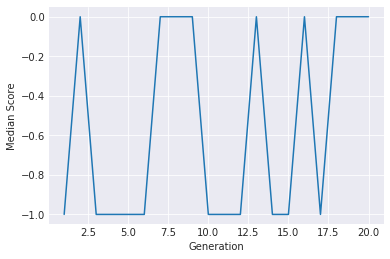

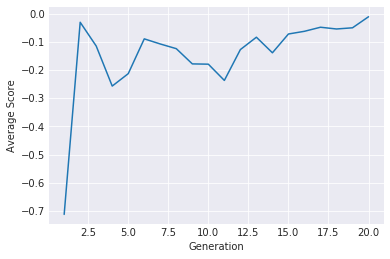

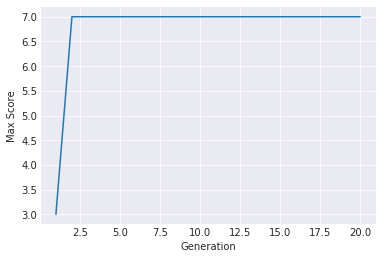

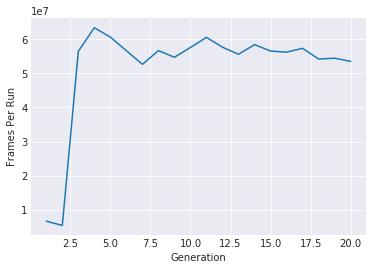

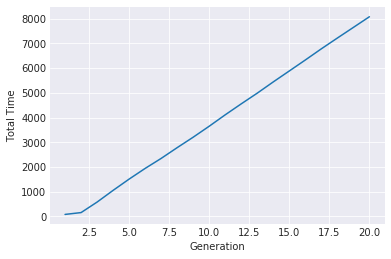

In [49]:
run_env(gym.make('BreakoutDeterministic-v4'), False, False)

### Breakout

Oh boy... GAs do **terribly** on Breakout. Why?

I can see a few reasons:
* You need to run a specific action or breakout won't start (specifically, breakout has 4 actions: do nothing, start the game, move left and move right).
 * This is not a problem when following a randomized exploration strategy such as epsilon-greedy, because the action will get chosen at some point or other, but without any exploration at all, it means that a large proportion of agents will simply do nothing forever.
 * To prevent this, I even made sure to reduce the maximum length of a game in the first few generations and to penalize agents that had done nothing at all the whole time. Obviously it didn't work that well, however.
* Very few of the pixels change in breakout, so agents keep performing the same action.
 * In Frostbite, almost 50% of the pixels are guaranteed to change even if the agent does nothing. In Breakout, only a tiny ball, the paddle, and maybe a brick or two will change, and only if the agent actually does something. For a randomly initialized neural network, this is likely not enough for it to decide to perform a different action.
 
Again, I think there are ways to fix this issue, including again including epsilon-greedy exploration in training. This warrants further exploration.

[2018-03-26 11:45:00,847] Making new env: SpaceInvadersDeterministic-v4


Best score: 1550.0


Worst score: 1550.0


Median score: 1550.0


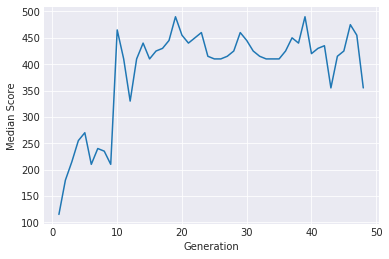

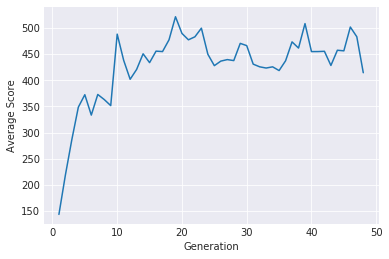

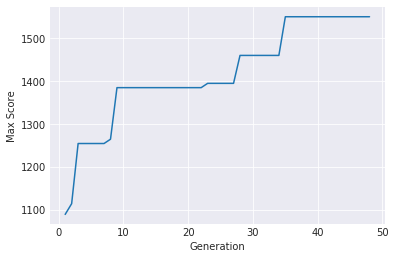

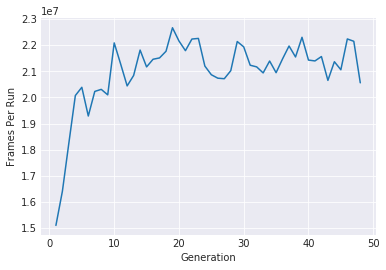

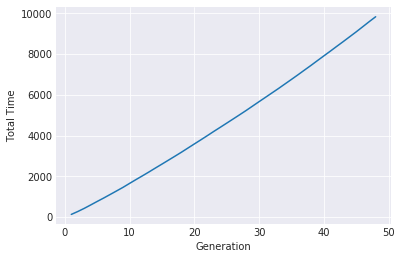

In [50]:
run_env(gym.make('SpaceInvadersDeterministic-v4'), False, False)

### Space Invaders

The agent does relatively well on space invaders, similar to the agent we trained in https://becominghuman.ai/beat-atari-with-deep-reinforcement-learning-part-2-dqn-improvements-d3563f665a2c, which is far from state of the art, but still pretty decent. Besides, it actually performs the same regardless of the initial random no-ops.

However, I am a bit concered about its strategy which consists, at least at first, in simply staying far to the left and trying to shoot the mothership: this looks more like a weird local optimum than an actual skill that the agent has obtained. Again I am curious what would make it learn something that looks more like real skill at the game and not a lazy strategy.

## Conclusion

I am excited about the results in Uber's paper. The fact that it does so well at Frostbite is quite amazing, and it is unclear to me if this means that traditional RL algorithms are particularly weak or that GA is surprisingly strong. I think, however, that there seem to be significant issues with GA that Uber doesn't point out, partly because they weren't able to evaluate their algorithms using a human-start database (which I think would have shown the brittleness of the various agents), and it would be interesting to try to fix these. I for one plan to try including epsilon-greedy exploration in the future, which I think will help with the robustness of the agents, and as Uber points out, there is a ton of literature available on genetic algorithms, and they only tried the most basic possible ones. Who knows where more advanced GAs will take us.